to do: 

fix area calculation, right now representative grid points are not centered on area they define

In [1]:
import pandas as pd
import glob
import os
import re
import seaborn as sns
from datetime import datetime, timedelta
from haversine import haversine, Unit
import metpy
import metpy.constants as mpconst
import metpy.units as units
from scipy.interpolate import interp1d
from scipy.optimize import bisect
import numpy as np
import pickle
import numpy as np
import math
import pint
import xarray as xr
import netCDF4 as nc
import re
import matplotlib.pyplot as plt
from numpy import load
from numpy import asarray
from numpy import save
import pytz
from scipy import stats
from sklearn.linear_model import LinearRegression
from collections import Counter
import pymannkendall as mk
from pydoc import help
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

In [40]:
with open('soundings_fig2&3.pdkl', 'rb') as file:
    
    soundings = pickle.load(file)

In [3]:
path = "../../data/rong3/annie"

_13 = os.path.join(path, 'ERA5-sgp-mfc-2001-2003.nc')

_46 = os.path.join(path, 'ERA5-sgp-mfc-2004-2006.nc')

_79 = os.path.join(path, 'ERA5-sgp-mfc-2007-2009.nc')

_1012 = os.path.join(path, 'ERA5-sgp-mfc-2010-2012.nc')

_1315 = os.path.join(path, 'ERA5-sgp-mfc-2013-2015.nc')

_1618 = os.path.join(path, 'ERA5-sgp-mfc-2016-2018.nc')

era13 = xr.open_dataset(_13)

era46 = xr.open_dataset(_46)

era79 = xr.open_dataset(_79)

era1012 = xr.open_dataset(_1012)

era1315 = xr.open_dataset(_1315)

era1618 = xr.open_dataset(_1618)

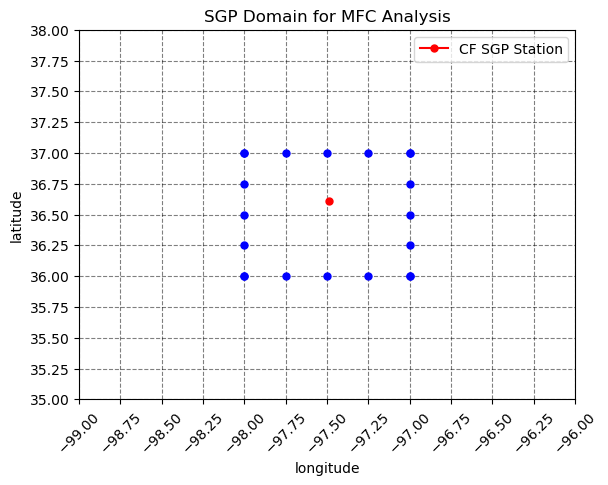

In [4]:
sgp = (36.607322, -97.487643)

lat_lon_pairs = []

lat = era13['latitude'].data

lon = era13['longitude'].data

for i in range(0,5):

    plt.plot(lon[i],lat[0], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[4], lat[i], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[0], lat[i], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[i], lat[4], color='blue', marker='o', markersize=5)

# lon = era13['longitude'].data

# for i in lat:
    
#     for j in lon:
        
#         p = (i, j)
        
#         lat_lon_pairs.append(p)
        
# x, y = zip(*lat_lon_pairs)

# plt.scatter(y, x, color='black')

plt.plot(sgp[1], sgp[0], color='red', label='CF SGP Station', marker='o', markersize=5)

plt.xticks(np.arange(-99, -95.75, 0.25), rotation=45)

plt.yticks(np.arange(35, 38.25, 0.25))

plt.xlim(-99,-96)

plt.ylim(35,38)

plt.grid(color='black', linestyle='--', alpha=0.5)

plt.xlabel("longitude")

plt.legend()

plt.ylabel("latitude")

plt.title("SGP Domain for MFC Analysis")

plt.show()

## MFC Calculation

- averaged uq profiles on eastern & western domain full box

- and add weight of cos(lat) for vq grid points

In [5]:
#describes horizontal moisture divergence, and the net vertical boundary flux of moisture

def calculate_pressure_integrated_flux(df, var, side, time, layer):
    
    #setting domain 
    
    lat_range = df['latitude'].data[0:5]
    
    lon_range = df['longitude'].data[0:5]
    
    levels = df['level'].data
    
    if layer == 'surface':
        
        bottom = 1000
    
        top = 800
    
    elif layer == 'lower_trop':
        
        bottom = 800
        
        top = 600
        
    elif layer == 'full':
        
        bottom = 1000
        
        top = 50
        
    if side == 'west': 
        
        side_idx = 0
        
    elif side == 'east':
        
        side_idx = 4
        
    elif side == 'north':
        
        side_idx = 0
        
    elif side == 'south':
        
        side_idx = 4
    
    idx_bottom = np.where(levels==bottom)[0][0]

    idx_top = np.where(levels==top)[0][0]
    
    if var == 'u':
        
        all_qus = []

        for lat in range(lat_range.shape[0]):

            qu_int = []

            pidx = idx_bottom

            while levels[pidx] > levels[idx_top]:

                h = (levels[pidx] - levels[pidx-1])*100

                f1 = df['q'].data[time][pidx][lat][side_idx] * df['u'].data[time][pidx][lat][side_idx]

                f2 = df['q'].data[time][pidx-1][lat][side_idx] * df['u'].data[time][pidx-1][lat][side_idx]

                _int = (f1 + f2)*h*(0.5)

                qu_int.append(_int)

                pidx -= 1

            all_qus.append(np.array(qu_int))
            
        integrated_side = np.nanmean(all_qus, axis=0)
                
    elif var == 'v':
        
        all_qvs = []

        for lon in range(lon_range.shape[0]):

            qv_int = []

            pidx = idx_bottom

            while levels[pidx] > levels[idx_top]:

                h = (levels[pidx] - levels[pidx-1])*100

                f1 = df['q'].data[time][pidx][side_idx][lon] * df['v'].data[time][pidx][side_idx][lon]

                f2 = df['q'].data[time][pidx-1][side_idx][lon] * df['v'].data[time][pidx-1][side_idx][lon]

                _int = (f1 + f2)*h*(0.5)

                qv_int.append(_int)

                pidx -= 1

            all_qvs.append(np.array(qv_int))
        
        integrated_side = np.nanmean(all_qvs, axis=0)
    
    return(integrated_side)

def calculate_convergence(df, var, time, layer):
    
    #defining constants 
    
    to_mm_day = 1000*24*60*60
    
    g = 9.80665
    
    rho = 1030
    
    if layer == 'surface':
        
        bottom = 1000
    
        top = 800
    
    elif layer == 'lower_trop':
        
        bottom = 800
        
        top = 600
        
    elif layer == 'full':
        
        bottom = 1000
        
        top = 50
    
    levels = df['level'].data
    
    lat_range = df['latitude'].data[0:5]
    
    lon_range = df['longitude'].data[0:5]
    
    idx_bottom = np.where(levels==bottom)[0][0]

    idx_top = idx_bottom - 1
    
    dy = haversine((lat_range[0], np.mean(lon_range)), (lat_range[-1], np.mean(lon_range)), unit='m')

    dx = haversine((np.mean(lat_range), lon_range[0]), (np.mean(lat_range), lon_range[-1]), unit='m')
    
    if var == 'u':

        qu_west = calculate_pressure_integrated_flux(df, 'u', 'west', time, layer)*dy

        qu_east = calculate_pressure_integrated_flux(df, 'u', 'east', time, layer)*dy
        
        #in - out
        total_flux_list = (qu_west - qu_east)*(1/g)*(1/rho)*(1/(dx*dy))*to_mm_day

    elif var == 'v':
        
        qv_south = calculate_pressure_integrated_flux(df, 'v', 'south', time, layer)*dx
        
        qv_north = calculate_pressure_integrated_flux(df, 'v', 'north', time, layer)*dx
        
        #in - out
        total_flux_list = (qv_south - qv_north)*(1/g)*(1/rho)*(1/(dx*dy))*to_mm_day

    else:
        
        total_flux_list = []
        
        d_squared = (dx*dy)*(1/16)
 
        while levels[idx_bottom] >= 70:
            
            _int = 0

            for lon in range(lon_range.shape[0]):

                for lat in range(lat_range.shape[0]):

                    idx_top = idx_bottom - 1

                    qw_bottom = -(df['q'].data[time][idx_bottom][lat][lon] * df['w'].data[time][idx_bottom][lat][lon])

                    qw_top = -(df['q'].data[time][idx_top][lat][lon] * df['w'].data[time][idx_top][lat][lon])

                    diff = (qw_bottom - qw_top)*(d_squared)

                    _int += diff

            total_flux = _int*(1/g)*(1/rho)*(1/(dx*dy))*to_mm_day

            total_flux_list.append(total_flux)

            idx_bottom -= 1
            
    return(np.array(total_flux_list))


convergence = []

all_dfs = [era13, era46, era79, era1012, era1315, era1618]

for ds in all_dfs:

    for t in range(ds['time'].data.shape[0]):

#         lst = pd.to_datetime(ds['time'].data[t]) - timedelta(hours=6)
        
#         if 5 <= lst.month <= 9:

        utc = pd.to_datetime(ds['time'].data[t])
        
        if 5 <= utc.month <= 9:
            
#             ws_lt = calculate_convergence(ds,'w',t,'lower_trop')

#             us_lt = calculate_convergence(ds,'u',t,'lower_trop')

#             vs_lt = calculate_convergence(ds,'v',t,'lower_trop')

#             ws_surf = calculate_convergence(ds,'w',t,'surface')

#             us_surf = calculate_convergence(ds,'u',t,'surface')

#             vs_surf = calculate_convergence(ds,'v',t,'surface')
            
            ws_full = calculate_convergence(ds,'w',t,'full')

            us_full = calculate_convergence(ds,'u',t,'full')

            vs_full = calculate_convergence(ds,'v',t,'full')

            all_divs = (utc, ws_full, us_full, vs_full)
            print(all_divs)

            convergence.append(all_divs)


(Timestamp('2001-05-01 00:00:00'), array([-3.81579213e-01, -7.91895351e-01,  1.07267570e+00,  6.08758225e-01,
       -1.47195413e+00, -4.15821340e+00, -2.51611644e+00, -1.86129266e+00,
       -2.24169744e+00, -1.05921209e+00,  8.91149989e+00,  1.23954696e+01,
        2.26526938e-01, -3.32825366e-01, -3.22367961e-01,  2.22048054e-01,
       -1.73168927e+00, -1.67609261e+00, -2.82800528e-01, -9.99250808e-02,
       -4.25018075e-02,  9.35307370e-03,  9.86896337e-03,  2.96952338e-03,
        2.57221902e-03, -3.38341276e-04,  5.00684432e-04,  5.76461493e-04]), array([-3.93737936e-01, -3.42495081e-01, -3.15205823e-02,  1.12552016e+00,
        3.05876023e+00,  5.09237322e+00,  6.86042627e+00,  7.26977239e+00,
        5.70569607e+00,  3.62303243e+00,  6.71670249e-01, -3.96538776e+00,
       -2.95339345e+00, -7.48131501e-01,  2.54218246e-01, -4.54357538e-01,
        3.80942667e-02,  8.77474665e-01,  4.05993327e-01, -4.41193392e-02,
       -5.51691042e-02, -5.14225552e-02, -2.82460928e-02, -3.62

(Timestamp('2001-05-01 18:00:00'), array([ 1.69302746e-02, -2.79725999e+00, -2.50524560e+00, -2.25361969e+00,
        4.08085443e-01,  4.48628258e+00, -2.12231219e+00,  1.24840850e+00,
        3.68406475e+00,  4.42046583e+00,  3.98350123e+00,  2.19510494e+00,
       -2.28066699e+00, -2.55978498e+00,  5.23590366e-01,  1.11978207e+00,
        1.17937694e+00,  2.62356786e-01, -2.17816431e-01, -3.35713993e-01,
       -3.22722888e-02, -2.97618587e-02, -1.04906047e-02,  1.74992524e-02,
       -5.35836848e-05, -6.07250782e-05,  1.28939271e-04, -8.24780539e-04]), array([ 4.74403118e-01,  4.54290105e-01,  5.16292321e-01,  3.69149555e-01,
       -1.41302470e+00, -1.49961298e+00,  3.82942335e-01,  4.77704777e-01,
        3.60040759e-01,  5.27282942e-01, -9.64326735e-01, -2.41606814e+00,
        3.58827429e-01,  2.12931743e+00,  1.16326428e+00,  5.67386546e-01,
        1.57493791e-01, -2.01071057e-01,  2.09591481e-02,  1.49333025e-01,
        4.14017424e-02,  2.99068965e-02,  1.27716352e-02, -2.15

(Timestamp('2001-05-02 12:00:00'), array([-1.03662346e-02, -8.54694601e+00, -1.25317411e+01, -1.20472801e+01,
       -9.30370284e+00,  2.15378576e+00,  6.82214109e+00,  3.10067238e+00,
        3.13781192e+00,  4.58248486e+00,  7.00995019e+00,  4.53335406e+00,
        4.17768640e+00,  4.85550554e+00,  5.05579542e+00,  3.84716043e-01,
        2.79169516e-01, -3.09175963e-01, -2.00661153e-02, -1.57011476e-01,
       -2.72825471e-02, -2.58776289e-02, -8.88858419e-03, -5.09324964e-03,
        8.91392809e-04, -3.40189574e-04, -5.17709536e-04,  1.82412655e-03]), array([ 2.62375981e+00,  3.28797505e+00,  4.19753043e+00,  4.56459306e+00,
        4.83432186e+00,  4.53206907e+00,  4.14688367e+00,  1.34824729e+00,
       -3.97822923e+00, -6.44386533e+00, -8.04546396e+00, -1.30612085e+00,
        3.64751836e-01, -3.38712839e-01, -7.17604681e-01, -3.59787202e-01,
       -3.75112530e-02,  4.10665970e-02,  1.05939198e-02,  5.30303978e-03,
        1.50990868e-02,  1.15220276e-02,  9.42420213e-03,  3.82

(Timestamp('2001-05-03 06:00:00'), array([-1.02697552e-01, -2.35487415e+01, -2.79764641e+01, -2.23177299e+01,
       -1.30466110e+01, -6.14572830e+00, -1.14281453e+00,  1.03953918e+01,
        3.13918691e+01,  2.97948674e+01,  2.57452887e+01,  6.91640859e+00,
       -2.10158762e+00, -4.89495987e+00, -1.94749390e+00, -3.25147381e-02,
        2.21500961e-01,  2.77397625e-01,  1.23098028e+00,  4.96142350e-01,
       -6.81514887e-03, -4.79391332e-02, -2.92484524e-02, -9.96465194e-03,
        1.12425956e-02,  9.26449667e-04, -1.01730765e-03, -7.50157787e-04]), array([ 3.74689942e+00,  5.80998209e+00,  6.83911948e+00,  4.38032195e+00,
        7.26097744e-01, -1.20072889e+00, -3.80831886e-01,  7.87599476e-01,
        3.83474938e-01, -1.56322554e+00, -4.14275421e+00, -7.75318322e-01,
        1.83126168e+00,  2.52857042e+00,  1.76742950e+00,  9.13400642e-01,
        8.37892924e-01,  6.33004599e-01,  2.42619301e-01,  1.25714961e-01,
        5.80033402e-02,  4.91256138e-02,  2.51652154e-02, -1.76

(Timestamp('2001-05-04 00:00:00'), array([-4.51376369e-01, -8.78255861e+00, -5.57872913e+00, -2.78465850e+00,
       -2.60595378e+00,  9.72671871e-01,  5.56471662e+00,  3.92901411e+00,
        2.05399536e+00, -2.65179450e-01, -2.82250127e+00,  1.67983948e+00,
        1.59599563e+00, -1.65005735e+00,  2.76304706e+00,  5.36648499e+00,
        1.43666132e+00, -2.16853440e-03,  5.23052472e-01, -2.75014383e-01,
       -1.15374273e-01, -1.09408303e-01, -4.84674186e-02,  2.69036188e-03,
       -3.45282925e-03, -3.87935184e-04, -2.23116668e-04,  9.62758066e-04]), array([-1.00318446e+00, -1.55218705e+00, -3.22972565e+00, -3.79874462e+00,
       -3.19329464e+00, -2.75666307e+00, -2.59454081e+00, -1.74935170e+00,
       -2.57442034e-01,  1.34654097e+00,  5.71065281e+00,  6.05990156e+00,
        5.11281115e+00,  5.03564556e+00,  1.00913197e+00, -2.30706850e+00,
       -1.15665296e+00,  1.11125104e-01,  7.47461358e-01,  5.34704827e-01,
        9.77016688e-02,  4.24142027e-02,  5.43527147e-03, -7.59

(Timestamp('2001-05-04 18:00:00'), array([-4.10457297e-01, -4.26429773e+00, -2.23186449e-01,  2.23368252e+00,
        1.49781562e+00,  1.71009557e+00,  5.37838797e+00,  1.83487151e+00,
        2.82939222e-01, -1.32786161e+00, -6.09456019e+00,  2.68536053e+00,
        7.50806002e+00, -3.05026188e-01, -5.14690917e+00, -1.30700809e+00,
        2.70563450e+00,  2.40590836e+00,  1.53539391e+00,  1.59810832e-01,
        1.12488613e-01,  7.14649345e-02,  1.97560280e-02,  1.71103072e-02,
       -2.32966259e-05, -3.34201847e-04,  5.86163277e-04, -5.40745291e-04]), array([-1.24568118e+00, -1.82541207e+00, -3.81510242e+00, -4.11771082e+00,
       -2.14729239e+00,  6.93235683e-01,  3.87920160e-01, -1.23381588e+00,
       -8.04726996e-01,  5.62952465e-01,  4.00491696e+00,  4.05568074e-01,
       -4.44842593e+00, -1.96327054e+00,  4.60175086e-01, -7.21301977e-01,
       -1.74401123e+00, -1.09128252e+00, -1.32048803e-01,  1.70812745e-01,
       -1.16033512e-02, -1.48672385e-02, -4.16459900e-03, -6.04

(Timestamp('2001-05-05 15:00:00'), array([-2.55271843e-02,  7.09957283e-01,  6.22726382e+00,  3.43255294e+00,
       -1.28483963e-02, -1.39221021e-01, -3.67342308e+00, -4.62808910e+00,
       -2.13897136e+00,  2.15437809e-01,  3.80122946e+00, -5.93750586e-02,
       -3.88809295e+00, -3.53565559e-01,  3.46034898e-01,  3.18600358e-01,
       -1.92600874e-01, -1.84245973e-01, -1.92089642e-01, -5.03976841e-02,
        9.78706148e-02,  1.60034475e-03,  5.94537055e-03,  5.86967973e-04,
        7.11188308e-04,  4.08690549e-04,  1.64201006e-04, -1.16014811e-04]), array([ 8.07370137e-01,  3.64776969e-02, -1.16564946e+00, -1.65220234e+00,
       -3.12407719e-01,  2.46072414e+00,  4.78359016e+00,  5.11124997e+00,
        3.59625398e+00,  1.51010614e+00, -3.49679953e-01, -8.05999593e-01,
        4.47989072e-02,  5.74968699e-02,  3.15472336e-01,  5.67207060e-01,
        4.77166649e-01,  3.08160402e-01, -3.95812006e-02, -2.09274346e-01,
       -2.90085452e-02,  9.04848700e-03,  5.35683288e-03, -2.27

(Timestamp('2001-05-06 12:00:00'), array([-2.27284779e-02, -7.20729728e+00, -9.06090565e+00, -8.12874841e+00,
       -5.50831599e+00,  5.51485209e+00,  6.15206373e+00,  3.85295195e+00,
        3.47512822e+00,  1.49502942e+00,  2.66600387e+00,  4.55337452e+00,
        4.19543446e+00,  2.10650762e+00, -1.89723644e+00, -2.30193910e+00,
       -7.36260935e-01, -2.65047123e-01, -1.70218296e-01, -1.65119548e-02,
        1.00436639e-03,  1.16701761e-03,  4.91099537e-03, -2.43056319e-03,
       -1.32904140e-03, -2.41577623e-04,  8.29626342e-04, -6.63301314e-04]), array([ 1.01315106e+00,  6.85231308e-01,  6.16577201e-02, -4.22307372e-01,
       -1.86965039e+00, -3.99355137e+00, -5.19852630e+00, -4.17917603e+00,
       -1.70739164e+00, -2.32170742e-01,  4.29220874e-01, -5.34528162e-01,
       -2.65225288e+00, -1.70833136e+00,  1.23261093e+00,  1.46005508e+00,
        8.19761760e-01,  9.76949444e-01,  5.39683298e-01,  7.50346617e-02,
        1.39332279e-02,  2.65312203e-03, -3.83390839e-03, -1.46

(Timestamp('2001-05-07 09:00:00'), array([ 2.04493315e-02,  3.01386328e-01, -5.74852187e-01,  9.60090668e-01,
        2.12822645e+00,  3.58354340e+00,  2.54210153e+00, -2.79356120e-01,
       -2.08834534e+00, -1.79591370e+00, -8.32669224e-01, -1.13580414e+00,
       -2.04348620e+00, -9.89961031e-01, -7.12623686e-01,  1.86977540e-01,
       -3.90587174e-01, -6.14366877e-01, -2.93564775e-01, -1.28656568e-01,
        1.84075147e-03,  1.69807963e-02,  1.08021064e-02, -3.15482477e-03,
       -3.61443684e-03, -4.32884389e-03,  2.45144639e-03, -1.35538448e-03]), array([-4.37002841e-01, -9.67103918e-01, -2.55290565e+00, -2.37919469e+00,
       -1.89859687e+00, -2.08716101e+00, -2.43511295e+00, -2.21975305e+00,
       -1.21243404e+00, -2.93384092e-01, -2.83672195e-01, -1.10089540e+00,
       -1.93108619e+00, -2.10200882e+00, -1.27102488e+00,  2.76961450e-01,
        9.02121038e-01,  6.98669732e-01,  5.10330237e-01,  1.14728686e-01,
       -3.18360314e-02, -2.00453213e-02, -1.24310915e-02, -1.11

(Timestamp('2001-05-08 06:00:00'), array([ 1.10208915e-01,  1.32090743e+00, -1.95026627e-01, -2.16306061e+00,
       -2.11580718e+00, -6.60368388e-01,  4.02963486e-02, -5.17918679e-01,
       -5.55523633e-01,  2.40464021e+00,  1.65432522e+00,  1.47596160e+00,
        1.35048386e+00, -2.38686392e-01, -5.50928471e-01, -1.77588531e-01,
       -1.23545210e-01, -2.17116647e-01, -2.25802431e-01, -8.69341671e-02,
       -5.65195011e-03, -5.19633107e-03, -2.21826929e-02, -5.89238458e-03,
        7.60298130e-04,  2.94173341e-04,  5.67430178e-04, -3.50805514e-04]), array([ 1.80437480e+00,  2.29258363e+00,  1.85662781e+00,  1.52425176e+00,
        7.40719976e-01,  1.44582043e-01,  1.83285046e-01,  2.63763453e-01,
       -3.25895707e-02, -3.06501743e-01, -8.43456002e-02,  2.08241926e-01,
        2.02708594e-01, -3.46083278e-02, -2.23281992e-02,  5.17970698e-01,
        5.52948578e-01,  3.41743200e-01,  9.94088495e-02, -7.62964956e-03,
       -1.51034385e-02, -1.09394536e-02, -3.41405510e-03, -5.56

(Timestamp('2001-05-09 00:00:00'), array([ 2.90626503e-02,  4.15112623e+00,  4.74035475e+00,  4.25008900e+00,
        3.21336488e+00, -8.75573469e-01, -6.67176374e+00, -3.68012252e+00,
       -7.55862096e-01,  2.33470246e-01,  2.64448461e+00,  1.97591533e+00,
       -2.08257720e+00, -4.17549517e+00, -1.02981775e+00, -4.82449366e-01,
       -3.21112310e-01, -1.04964876e-01, -1.27127872e-01, -9.16081400e-02,
       -3.06299032e-02, -1.44280988e-02, -1.27128327e-02, -5.48997280e-03,
        1.55746580e-03,  3.95337591e-04, -3.66216209e-05,  4.36484404e-04]), array([-1.47265001e+00, -1.48925653e+00, -1.06083113e+00, -4.85155416e-01,
        2.01865662e-01,  1.31151158e+00,  1.35978353e+00, -1.28253427e-01,
       -7.04577741e-01, -1.67426814e-01,  6.99528795e-01,  2.25002578e+00,
        2.55670481e+00,  7.32267308e-01, -3.45520685e-01, -2.73333336e-01,
       -1.60254419e-01, -1.35353108e-01, -8.93053439e-02, -4.67032128e-02,
       -1.21847816e-02, -9.69194080e-03, -7.37846980e-03, -3.16

(Timestamp('2001-05-09 18:00:00'), array([ 1.24241396e-01,  5.51499389e-01,  1.37987234e+00,  1.66661889e+00,
        1.14338896e+00, -3.73304060e+00,  3.31005043e-01,  2.89766542e+00,
        1.66979259e+00,  1.33163481e+00,  1.69316789e+00,  1.28625399e+00,
       -1.77959186e+00, -5.76926660e-01, -3.60977759e-01, -6.11322526e-01,
       -7.38169630e-02, -9.95418657e-02, -4.94205121e-02,  3.04059308e-02,
        3.44629543e-04, -9.94495109e-03, -1.99813691e-02, -3.27233546e-03,
        7.26581972e-04,  1.30801443e-03,  2.15978269e-04, -7.77620531e-04]), array([ 6.85174714e-01,  6.92252828e-01,  1.36687343e+00,  1.60930418e+00,
        2.45258518e+00,  2.81753452e+00,  1.91453022e+00,  1.21679370e+00,
        1.36580470e+00,  1.13158701e+00,  3.85154830e-01, -9.15236345e-01,
       -7.17921616e-01,  1.36238707e-01,  2.09058566e-01,  6.57920560e-02,
        5.91304846e-02,  2.99331448e-02,  9.81992518e-03,  1.24153153e-02,
        9.00677190e-03,  3.19977742e-03,  3.87470057e-03,  3.08

(Timestamp('2001-05-10 15:00:00'), array([ 1.16534530e-01,  1.12095841e+00,  2.60537790e+00,  9.13737166e+00,
        8.32290405e+00,  7.42917134e+00,  5.73983024e+00,  2.90996246e+00,
       -1.01451403e+00, -3.28566852e+00, -1.10972375e+01, -1.30280905e+01,
       -7.33982080e+00,  5.52984800e-01,  2.59655086e+00,  1.17851132e+00,
       -3.95535962e-01, -7.75869461e-01, -2.43433406e-01, -9.69430757e-02,
       -2.07412259e-02, -9.47896637e-03, -5.81501796e-03,  1.47200679e-02,
        7.24222243e-03, -5.57492094e-04, -1.17997786e-04, -5.72806595e-04]), array([-4.81112109e-01, -1.23471144e+00, -2.30289573e+00, -3.35844928e+00,
       -4.95852533e+00, -6.65314867e+00, -6.63218214e+00, -5.13960253e+00,
       -2.88394538e+00, -6.10715002e-01,  4.08611487e+00,  8.86967723e+00,
        7.49758400e+00,  2.02123497e+00, -1.29316213e+00, -2.34444091e+00,
       -1.92589514e+00, -6.67177903e-01, -4.55301001e-02, -9.76481333e-03,
        1.02500082e-02, -3.13780791e-04, -8.06406064e-03, -6.73

(Timestamp('2001-05-11 09:00:00'), array([-1.29747303e-01, -1.06231435e+01, -1.33016347e+01, -1.25159935e+01,
       -7.66855993e+00, -4.81474628e+00, -5.12053977e+00, -3.56510756e+00,
       -2.49498397e-01,  3.07776781e+00,  1.67659838e+01,  1.43648758e+01,
        1.02030378e+01,  7.08143981e+00,  5.40095686e+00,  1.24282888e+00,
       -3.70019638e-01, -7.94793513e-01,  1.86100888e-01,  3.26102896e-01,
        1.13842424e-02, -4.81509399e-03, -2.02053488e-02, -1.28600020e-03,
       -4.24117597e-03,  6.26422187e-04, -1.65858492e-03,  1.18033624e-03]), array([ 1.07827032e-01,  7.56796372e-02,  2.41326863e-01,  1.39981746e-01,
       -9.29720368e-02,  3.16794029e-01,  2.78890086e-01, -1.17816260e+00,
       -3.19645809e+00, -3.86915718e+00, -5.46255376e+00, -2.86068187e+00,
       -1.25387432e+00, -9.17574772e-01, -6.30156664e-01,  2.44974517e-01,
        3.87086976e-01,  4.81500817e-01,  3.40489272e-01,  1.06681481e-01,
        2.76828367e-02,  1.39081909e-02,  3.29109420e-03,  3.71

(Timestamp('2001-05-12 06:00:00'), array([-1.25076103e+00, -9.96175146e+00, -9.35636783e+00, -3.78948343e+00,
       -1.03982266e+00,  1.82813697e+00,  1.95291703e+00,  2.05424750e+00,
        4.59661824e+00,  5.57760255e+00,  4.95548733e+00,  2.65569019e+00,
       -2.59347972e-02, -1.48138674e-01, -4.87093297e-02,  4.51941299e-02,
        7.26764540e-02,  7.06501155e-02,  5.56555945e-02,  1.82679460e-02,
       -1.91547979e-02,  3.59544786e-04,  1.52872046e-02,  1.26395169e-02,
       -9.18041408e-03,  3.18765926e-05, -8.71277051e-04,  5.42898433e-04]), array([ 9.61494741e-02,  1.42914762e+00,  1.65128134e+00,  8.95994721e-01,
       -1.65684479e-01, -1.44623075e+00, -2.44109928e+00, -2.07775867e+00,
       -1.67013057e+00, -1.87383462e+00, -3.49763542e+00, -1.65064160e+00,
       -1.27294071e-01,  9.28574245e-02,  5.35294761e-02,  1.85939583e-02,
        9.02576708e-04, -8.40173215e-03, -1.98137697e-02, -2.88881307e-02,
       -2.52170931e-02, -2.89442591e-02, -1.60413496e-02, -2.66

(Timestamp('2001-05-13 03:00:00'), array([-2.10983842e+00, -4.57450951e+00, -5.03250699e-01,  1.31388048e+00,
        3.11656632e+00,  4.86653055e+00,  2.38316282e+00, -1.34206309e+00,
       -1.16650313e+00, -1.31266187e+00, -1.06528646e+00,  1.13394997e-01,
       -7.76002193e-01,  7.85413231e-01,  5.59956098e-01,  1.74082612e-01,
       -4.31835701e-02, -4.30177472e-02, -5.18386397e-02, -4.64635624e-02,
       -7.25301412e-03,  6.41356313e-03, -2.86675741e-03, -1.17230640e-02,
        6.13944270e-03, -7.47385434e-04, -1.67043117e-03,  6.13185478e-04]), array([ 2.30641612e+00,  2.98704071e+00,  1.81300436e+00,  1.48242958e+00,
        6.43581185e-01, -5.83011888e-01, -2.23112462e-01,  1.27827174e+00,
        1.29902781e+00,  6.93176191e-01,  8.38207419e-01,  1.38111408e-01,
       -2.04268971e-01, -1.89057320e-01, -1.89788409e-01, -1.20821158e-01,
       -8.19383307e-02, -3.42606257e-02,  3.68278221e-02,  5.08504466e-02,
        2.02221524e-02,  9.94655600e-03, -5.83954203e-03, -2.94

(Timestamp('2001-05-13 21:00:00'), array([-2.32616429e-02,  1.96377189e+00,  2.64471608e+00,  2.77577883e+00,
        2.83559159e+00,  2.83793098e+00,  6.85674685e-01, -2.70653531e+00,
        6.30431261e-01,  5.44858471e-01, -8.11577202e-02, -3.78481834e+00,
       -1.79926671e+00, -1.12518856e+00, -4.44242071e-01, -1.88257066e-01,
        5.20495200e-02,  9.58263354e-02, -1.30927232e-01, -8.27789911e-02,
       -2.17793701e-02, -2.08026759e-02, -4.30131129e-03, -7.46228346e-03,
       -1.36775645e-03,  1.26120632e-03,  6.21673423e-04, -4.69695952e-04]), array([ 7.06697946e-01,  8.14564217e-01,  1.11519088e+00,  1.10794288e+00,
        1.09704869e+00,  1.05311709e+00,  6.04510434e-01, -4.00354071e-01,
       -9.89282768e-01, -9.12312999e-01, -3.60905971e-01,  4.59228459e-02,
       -2.94632870e-01,  1.72348637e-01, -2.65536906e-02, -9.91575430e-02,
       -8.25763406e-02,  8.44229874e-03,  9.47495974e-02,  9.41972144e-02,
        2.47906029e-02,  6.53705038e-03,  5.03026563e-05, -2.39

(Timestamp('2001-05-14 15:00:00'), array([-3.32449317e-02,  1.59057577e+00,  4.70284762e+00,  6.54201351e+00,
        2.06551942e+00, -3.39901826e-01, -2.55301774e+00, -3.49348089e+00,
       -1.79896169e+00,  3.32310711e-01,  1.48676543e+00, -1.81460968e+00,
       -3.92635432e-01, -8.11592255e-01, -3.15564272e-01, -3.73667877e-02,
        1.19045104e-02, -5.66492725e-02, -5.59128735e-02, -1.41379687e-01,
       -1.05780724e-02, -8.54115186e-03, -2.66175354e-03, -9.86067687e-04,
        5.48522411e-03,  1.89472008e-03,  2.31163453e-04, -5.59025463e-04]), array([-7.04130875e-01, -1.50134243e+00, -2.94955485e+00, -3.16534466e+00,
       -4.57595178e-01,  1.53072374e+00,  2.82439062e+00,  2.56324043e+00,
        7.99523778e-01, -6.09972602e-01, -1.28651801e+00, -3.15989109e-01,
       -1.20076106e-02,  1.01732471e-01,  1.03258246e-02,  2.14757995e-02,
        7.61457457e-02,  1.38717883e-01, -1.04260330e-02, -1.17649480e-01,
       -1.25391157e-02, -2.10349980e-03, -7.72667635e-04, -4.30

(Timestamp('2001-05-15 09:00:00'), array([ 9.23837741e-02, -2.59997060e+00, -1.06251890e+00,  2.23163406e-03,
        2.87895310e+00,  1.09087988e+00, -7.03630981e-01, -1.32238674e+00,
       -1.71286428e+00, -6.91772594e-01,  5.63822821e+00,  7.52329532e+00,
       -2.13095386e+00, -1.60795147e+00, -1.07229961e-01,  1.49077422e-01,
       -4.81596155e-02, -4.07991168e-02, -4.42220317e-02, -1.33859919e-02,
       -1.33316914e-02, -6.85084143e-03,  2.26517684e-03,  4.38480721e-03,
       -4.78870366e-03, -3.08254023e-04,  8.08965756e-04, -6.86667068e-04]), array([ 4.57416664e-01, -5.55200220e-01, -1.04465818e+00, -7.88752736e-01,
        3.99413103e-01,  2.00367600e+00,  2.35902956e+00,  1.73891487e+00,
        1.26529882e+00,  9.14535298e-01, -6.49312327e-02, -1.10318517e+00,
       -3.67214145e-01,  1.62700730e-02,  2.45156563e-02,  5.24957393e-02,
       -1.72835095e-02, -7.87478423e-03,  1.40683336e-01,  7.93065308e-02,
       -2.45329909e-03, -4.46947683e-03, -4.76560835e-03, -4.68

(Timestamp('2001-05-16 09:00:00'), array([ 1.77439717e-03, -3.18573446e+00, -3.06845006e+00, -1.79835564e+00,
        3.95633331e+00,  6.43491482e+00,  5.41729171e+00,  4.81338357e+00,
        4.22887157e+00,  1.96019035e+00, -6.10446100e+00, -6.40029209e+00,
       -2.46129685e+00, -5.24724280e-02,  1.28561118e-01, -6.29173026e-01,
       -1.56634185e-01,  5.21764562e-02,  1.06730688e-02,  1.34200801e-02,
       -3.65100183e-02, -2.30196351e-02, -1.28761899e-02, -1.42399362e-03,
        1.88290953e-03, -1.28895930e-03,  7.78604184e-04, -5.27375949e-04]), array([ 5.14147360e-02, -9.86235050e-01, -2.13226542e+00, -3.36244559e+00,
       -6.87113636e+00, -8.81154346e+00, -7.41291384e+00, -5.76457697e+00,
       -4.39976408e+00, -2.80962916e+00, -2.88697153e+00, -2.28918228e+00,
       -1.75667628e+00, -6.88682262e-01, -3.17332141e-01, -1.28785313e-01,
       -1.36070010e-01, -1.77553717e-01, -1.30199598e-01, -3.54271265e-02,
        2.02979312e-03, -5.71716548e-03, -4.04888305e-03, -3.05

(Timestamp('2001-05-17 03:00:00'), array([-3.53847979e-02, -3.57469741e+00,  1.58914746e+00, -7.83388813e-01,
       -3.09034785e+00, -8.55269916e-01,  1.39492058e+00,  1.86986979e+00,
        3.92310506e-01, -1.94030180e-01,  1.71503884e-01,  1.14404165e+00,
        2.43195843e+00, -3.15939816e-01, -9.42956257e-01, -4.27510894e-01,
       -3.62072738e-01,  7.52700330e-01,  3.92483147e-01, -1.08432041e-03,
       -1.99012226e-02, -6.06631750e-03,  7.55392633e-03,  1.19518187e-02,
        4.13322275e-03,  5.36315124e-04, -2.38613465e-03,  5.92943832e-04]), array([-1.16167744e+00, -2.07195645e+00, -3.63834009e+00, -3.89454781e+00,
       -3.40856063e+00, -2.63928556e+00, -4.52607817e-01,  2.11660710e+00,
        1.75909086e+00, -6.68565626e-01, -2.32032984e+00, -2.03583960e+00,
       -1.71239563e+00, -4.51540024e-01, -3.67086609e-02,  1.73516239e-01,
        1.92587118e-01,  1.52212257e-01,  4.14906212e-02,  8.55046007e-03,
        7.29741382e-03,  4.77423994e-03,  1.50240325e-03, -1.37

(Timestamp('2001-05-17 21:00:00'), array([ 5.03116805e-02, -1.41754678e+01, -2.43309300e+01, -2.02435562e+01,
       -1.41694633e+01, -9.07608388e+00, -6.44398394e+00, -1.63284391e+00,
        9.27968479e+00,  1.43083854e+01,  3.34258312e+01,  2.20718793e+01,
        2.49900677e+00, -1.95296471e+00,  5.22138342e+00,  3.33309391e+00,
        2.30147381e+00,  1.39114746e+00,  1.42234477e-01, -6.32006615e-02,
       -2.74679502e-04, -3.86284648e-02, -3.44798299e-03,  6.44489223e-02,
        1.85213273e-02,  8.19537812e-03, -3.11415868e-04,  1.48447308e-03]), array([ 2.30201317e+00,  2.55030509e+00,  2.80909320e+00,  2.49603761e+00,
        1.89582701e+00,  1.08880648e+00,  6.38151102e-01,  9.08447037e-01,
        1.07522680e-01, -1.30627717e+00, -3.30676379e+00, -8.30260841e-01,
        6.08952519e+00,  8.95781876e+00,  5.58286146e+00,  3.11000661e+00,
        2.02389063e+00,  1.04871670e+00,  2.88752044e-01,  1.15344219e-01,
        1.27760882e-02,  2.00708455e-02,  1.71875825e-02, -7.77

(Timestamp('2001-05-18 18:00:00'), array([ 2.17177542e-02, -3.20596788e+00, -4.22514695e+00, -3.48858886e+00,
        5.93379002e-01,  1.55824497e+00,  3.48999944e+00,  3.65112412e+00,
        3.83562487e+00,  3.47489745e+00, -2.79175991e-01, -5.14397819e+00,
        2.57596849e-01,  7.87404098e-01,  6.94117717e-02, -7.70335131e-01,
       -1.77714317e-01, -5.82884197e-01, -4.25857566e-01, -6.05755726e-02,
        8.04170536e-02,  5.24153375e-02,  1.77971380e-02, -2.44254317e-03,
       -3.87589580e-04, -3.30597888e-04,  1.36733873e-03, -1.08640808e-03]), array([-1.54583297e+00, -1.55693521e+00, -1.53059924e+00, -1.34479887e+00,
       -1.11622019e+00, -9.38402529e-01, -9.53420732e-01, -9.12020851e-01,
       -8.68479658e-01, -7.53026976e-01,  1.36176593e+00,  5.10463771e+00,
        2.27511356e+00, -2.40660236e+00, -1.77921160e+00, -7.10799286e-01,
       -5.00951797e-01, -1.37513466e-01, -1.63619818e-02,  9.45757596e-02,
        5.07009472e-02,  1.58346840e-02,  1.62728553e-03, -1.73

(Timestamp('2001-05-19 15:00:00'), array([ 2.20640314e-02, -6.84308568e-01,  1.50944635e+00,  2.34146313e+00,
       -8.69962628e-01, -3.61249242e+00, -3.24844962e+00,  2.44423428e-01,
        2.29566592e+00,  2.10475735e+00,  2.80925710e+00,  2.07496974e+00,
        1.44358630e+00,  2.30873551e+00, -2.42369141e+00, -1.32530512e+00,
        2.48913264e-01, -2.67646006e-01, -4.79846016e-01, -3.06822923e-01,
       -2.80121858e-02,  1.33222664e-02,  1.73130601e-02,  7.68081976e-03,
       -1.12085045e-02,  3.76188945e-04,  6.58201588e-05,  5.01364962e-05]), array([-1.42717665e+00, -1.67524527e+00, -3.34931981e+00, -3.37121144e+00,
       -6.62340070e-01,  2.11987680e+00,  3.14982816e+00,  2.81297286e+00,
        1.95140918e+00,  1.32040786e+00,  3.81037673e-01,  1.92434906e+00,
        6.47884922e+00,  4.81648910e+00,  2.01089167e+00,  1.68355126e+00,
        9.66745841e-01,  4.67179249e-01,  2.94829388e-01,  1.68270124e-01,
        8.95897181e-02,  5.79069892e-02,  3.05812689e-02,  7.15

(Timestamp('2001-05-20 12:00:00'), array([ 2.66428146e-02, -1.24306586e+00,  1.39258777e+00, -1.05291413e+00,
       -2.42752130e+00, -7.75938163e-01,  1.80082248e+00,  3.15686567e+00,
        2.05911843e+00,  1.41708180e+00,  4.66073424e+00,  6.99708720e+00,
       -5.74847706e-01, -4.29503238e+00, -3.60568544e+00, -2.45450250e+00,
       -1.64111727e+00, -2.65951700e-01,  7.48120133e-01,  2.39770950e-01,
       -1.05232149e-02,  3.00411122e-02,  2.17108061e-02,  2.02853608e-03,
        1.30907645e-03, -1.10652354e-03,  1.27833966e-03, -8.52306170e-04]), array([-1.18379103e+00, -3.30817417e+00, -4.40002414e+00, -1.12999268e+00,
        1.77714736e+00,  2.82645774e+00,  3.26507251e+00,  2.86870269e+00,
        2.37309390e+00,  2.27842932e+00,  1.64053908e+00, -2.94724761e+00,
       -4.79588941e+00, -5.56780062e+00, -7.15370226e+00, -7.67000436e+00,
       -5.97462095e+00, -3.43478139e+00, -1.43298515e+00, -3.08249470e-01,
        3.42645743e-02,  1.89679901e-02, -1.10130823e-03, -1.94

(Timestamp('2001-05-21 06:00:00'), array([ 3.05127130e-02, -7.24866548e+00, -1.39738865e+01, -9.76521573e+00,
       -3.54175320e+00,  6.21148302e+00,  1.00844886e+01,  8.53953541e+00,
        5.65395020e+00,  4.35418971e+00,  6.16116902e+00, -5.77251717e+00,
       -4.00633258e+00, -1.93934641e+00, -1.12840635e+00, -4.82299550e-01,
       -2.28228763e-01, -2.01983427e-01, -1.78115357e-01, -5.03185538e-01,
       -1.15205702e-01, -1.94943879e-02, -1.41730880e-02,  1.68412105e-03,
        1.30799712e-03,  1.72633869e-03,  5.95246342e-04,  1.64360940e-04]), array([-2.78507143e+00, -5.55659599e+00, -1.02854263e+01, -1.24694693e+01,
       -1.22761677e+01, -9.59681070e+00, -5.34301477e+00, -2.03006873e+00,
       -7.64034997e-02,  2.93804577e-01, -9.15915645e-01, -1.25394499e+00,
        3.95577220e-02,  1.63754916e+00,  1.72538331e+00,  5.92460646e-01,
        4.55828480e-01,  6.40028425e-01,  5.63684683e-01,  2.77886977e-01,
        2.77066418e-02,  1.64661493e-02,  7.00094747e-03,  1.92

(Timestamp('2001-05-22 00:00:00'), array([ 3.11678143e-01,  2.32082815e+00,  1.39700027e+00,  1.21786717e+00,
        1.19486397e+00,  1.23387562e+00,  1.45867843e+00,  1.76029720e+00,
        1.96725365e+00,  1.88267066e+00,  3.07395880e-01, -2.93337275e+00,
       -6.17566636e+00, -5.75512907e+00, -1.50083294e+00, -2.25639822e-01,
       -1.18951228e-01, -7.93492875e-02,  4.93122757e-02,  1.59613541e-02,
       -2.61944568e-02, -3.86611889e-02, -4.61342633e-03,  4.44077934e-03,
       -3.35309520e-03, -1.64965085e-03,  1.92352507e-03, -4.65590388e-04]), array([-2.09115472e-01, -5.11249325e-01, -4.59264732e-01, -6.59959131e-01,
       -8.69875958e-01, -1.10897411e+00, -1.42672835e+00, -1.78040301e+00,
       -1.72823990e+00, -8.43676360e-01,  1.08423177e+00,  9.60890750e-01,
       -3.94030033e-02,  3.45263674e-01, -6.80557306e-03, -1.58386353e-01,
       -1.42423378e-01, -2.35012205e-01, -2.21742843e-01, -9.53544631e-02,
       -1.56236172e-02, -4.40967797e-03, -7.94166320e-03, -4.45

(Timestamp('2001-05-22 18:00:00'), array([ 1.54211082e-01, -3.37474283e-03, -5.00307858e-01, -5.78921966e-01,
       -6.97656631e-01, -8.91213894e-01, -1.48210555e+00, -1.08811857e+00,
       -1.28220300e+00, -1.44743398e+00,  2.82150956e+00,  8.19398178e+00,
        3.04061524e+00, -7.47844413e-02, -3.61265258e+00, -1.32856708e+00,
       -1.25798776e-01, -1.52597890e-01, -2.76542249e-01, -3.44268731e-01,
       -7.94351217e-02, -4.25790866e-02, -2.41234301e-02,  4.14492156e-03,
       -3.20451336e-03,  2.24224598e-03, -1.33335226e-03,  5.73540081e-05]), array([-1.14584796e-01, -4.47439714e-01, -1.67630762e-01, -1.70603928e-01,
       -1.18700260e-01, -8.40561042e-03,  1.76152947e-02, -8.87204809e-02,
        1.99410215e-01,  2.55007704e-01, -2.00931111e+00, -4.16087573e+00,
       -3.39723074e+00, -1.42576733e+00, -1.78621048e-01,  2.30913653e-01,
        1.56748672e-01,  4.09379136e-02,  1.05461873e-01,  1.72518260e-02,
       -1.17165996e-02, -3.65652164e-04,  6.46651874e-03,  2.48

(Timestamp('2001-05-23 12:00:00'), array([-1.12833613e-01, -3.84487613e+00,  7.85282202e-01,  2.04732582e+00,
        1.81089969e-01, -4.17833821e+00, -7.06252077e+00, -6.92043387e+00,
       -4.45806353e+00,  6.80103741e-02,  6.03611001e+00,  1.33874104e+00,
        4.24478569e+00,  5.10136945e+00,  2.27091643e+00,  2.25157398e+00,
        7.91094870e-01, -5.79497419e-01, -6.22077257e-01, -4.19676002e-01,
       -7.74028257e-02, -1.03220090e-02, -3.63104979e-03, -7.09508618e-03,
       -2.20411684e-03,  4.90202092e-04,  7.77116065e-04,  2.18714956e-05]), array([ 1.10644703e+00,  8.87559343e-01, -3.36564602e-01, -1.56254686e+00,
       -6.13681394e-01,  2.25722181e+00,  4.76310687e+00,  5.02306290e+00,
        3.27213835e+00,  5.62390897e-01, -2.15475275e+00, -1.14364821e+00,
        1.83972872e+00,  4.06125400e+00,  2.72551860e+00,  2.25697957e-01,
       -3.32448692e-01, -6.97651762e-01, -7.03130172e-01, -2.25082435e-01,
       -1.19069343e-02,  6.99687981e-03,  1.13324807e-02,  5.93

(Timestamp('2001-05-24 06:00:00'), array([ 5.87458322e-02,  3.63726211e+00,  4.24362349e+00,  4.02507366e+00,
        3.74559472e+00,  2.51505456e+00,  1.27727759e+00,  3.78385023e-01,
       -1.34478808e+00, -3.72950476e+00, -7.67485622e+00, -4.55327642e+00,
       -3.72326639e+00, -2.04981220e+00,  1.14175772e-01,  9.91927057e-01,
        1.43612479e+00,  4.08323859e-01, -1.78747987e-02, -1.23560072e-01,
       -3.43081126e-02, -2.61975039e-02, -1.46055264e-02, -7.92003143e-03,
        1.69534689e-03,  7.80057670e-04, -3.23822120e-04, -1.46541435e-05]), array([-9.51477126e-01, -1.74605157e+00, -2.60592156e+00, -2.56541523e+00,
       -2.36587574e+00, -2.01853251e+00, -1.31132995e+00, -2.22494852e-01,
        1.14363314e+00,  2.09043950e+00,  3.67887368e+00,  1.26616759e+00,
       -2.22816499e-01, -7.58759589e-01, -2.22415915e+00, -2.14998160e+00,
       -5.59592413e-01,  2.09868612e-01,  3.31688512e-01,  1.31296254e-01,
       -8.14930744e-03, -1.21602572e-02,  2.20055130e-03,  4.58

(Timestamp('2001-05-25 00:00:00'), array([ 1.45743897e-01,  3.26106852e+00,  2.97835375e+00,  2.60269690e+00,
        1.48759234e+00, -1.02944159e+00, -2.98559252e+00, -3.32044596e+00,
       -3.57329565e+00, -4.00403223e+00, -2.15908793e+00,  5.82246040e+00,
        3.18636373e+00, -1.42140735e+00, -2.61745429e+00, -9.71454746e-01,
        3.96301373e-01,  8.43090333e-02, -4.83519954e-02, -1.65048657e-01,
       -2.55198075e-03,  1.50344480e-03, -9.55870702e-03, -1.41697955e-04,
        2.56189409e-03,  3.77744636e-04, -9.70601860e-04,  2.04864793e-04]), array([-2.18174487e+00, -2.93294382e+00, -3.59130634e+00, -3.62978911e+00,
       -3.19128141e+00, -1.86390940e+00, -4.01154045e-01,  1.04402861e-01,
        3.81767685e-01,  1.25386158e+00,  4.52122129e+00,  5.55584949e+00,
        2.89297914e+00, -1.67718389e+00, -4.58743528e+00, -5.56911168e+00,
       -4.34842401e+00, -2.30768314e+00, -9.77022091e-01, -3.41976180e-01,
       -8.76910691e-03,  2.22781061e-03,  1.64835632e-03,  1.85

(Timestamp('2001-05-25 21:00:00'), array([ 2.28369286e-01,  7.03281751e-01,  3.84776382e-01,  2.05932953e-01,
        1.81165473e-02, -2.04090698e-01, -3.19822829e-02,  1.41537075e+00,
        6.84686566e-01, -1.06088122e+00, -8.49904084e+00, -7.04802034e+00,
        6.38880077e+00,  4.51057634e+00,  5.60173270e-01, -3.33810539e-01,
        7.05973246e-02,  9.76834350e-01,  2.37073412e-01, -2.31191724e-02,
       -1.16157582e-02, -4.29078089e-03,  9.95688067e-04,  1.81062061e-03,
        9.77561921e-04,  7.99767296e-04,  5.24619339e-04, -1.52824106e-03]), array([-1.13077175e+00, -1.33250914e+00, -1.33150144e+00, -1.31250440e+00,
       -1.25578812e+00, -1.17416937e+00, -9.29916084e-01, -3.69547180e-01,
        6.15315121e-01,  2.27989737e+00,  8.79258542e+00,  9.51592459e+00,
        7.91559419e-01, -4.57791215e+00, -1.39861411e+00,  1.06522303e+00,
        1.53342989e+00,  3.38765288e-01, -2.50458787e-01, -2.30235600e-01,
       -1.75055890e-02,  1.41416994e-03,  6.17991232e-03,  2.22

(Timestamp('2001-05-26 15:00:00'), array([ 3.59537991e-03, -8.81466545e-01,  5.13070033e-01,  6.50902785e-02,
       -1.56995065e-01, -1.74395544e+00, -3.92771315e+00, -5.73715891e+00,
       -5.66691166e+00, -2.22679247e+00,  9.73980519e+00,  9.01492695e+00,
        5.21190687e-01,  3.83251073e-01,  2.85643771e-01,  8.21250493e-01,
       -1.76886165e-01, -8.29100115e-01, -5.21437881e-01, -1.65532050e-01,
       -4.39244564e-02, -1.47816259e-02, -1.21049747e-02, -3.89548934e-03,
        2.06381092e-03, -1.99894743e-04, -1.18555931e-03,  4.48843658e-04]), array([-4.10526514e-01, -1.45945074e+00, -2.37032390e+00, -1.88389743e+00,
       -6.42623952e-01,  6.55523802e-01,  1.96065547e+00,  2.70753469e+00,
        2.29037207e+00,  3.56889880e-01, -1.77346740e+00,  9.43018334e-01,
        2.65058306e+00,  2.36641654e+00,  3.80615659e+00,  4.45219108e+00,
        1.54065167e+00, -9.70778398e-01, -5.53958817e-01, -6.44176353e-02,
        3.98173115e-03, -2.16156819e-02, -4.19843397e-03,  4.66

(Timestamp('2001-05-27 12:00:00'), array([ 1.92817355e-02,  2.19622376e-02, -8.37217592e-01,  2.80553996e-01,
        2.72586503e+00,  2.78880483e+00,  2.59066091e+00, -1.30407104e+00,
       -3.68812980e+00, -4.03209320e+00, -3.80640959e+00,  7.69325871e-01,
        7.89381163e-02, -2.61003155e-02,  6.74394113e-01,  4.68418841e-01,
       -4.87279939e-01,  9.24355129e-01,  2.96848335e-01, -2.74775296e-01,
       -7.73821390e-02, -4.40190685e-02, -2.52724071e-02,  1.24425489e-02,
        2.95688408e-03, -1.37837466e-03, -1.10382051e-03,  1.43452436e-03]), array([-1.10041583e-01, -2.49320214e+00, -2.60702350e+00, -2.95571543e-01,
       -6.48355228e-01, -1.49664334e+00, -2.19158828e+00, -2.60556593e+00,
       -2.49863436e+00, -2.03633996e+00, -1.97010311e+00,  9.90625082e-01,
        4.21406989e+00,  6.35222137e+00,  8.38687803e+00,  9.22059252e+00,
        5.22090311e+00,  6.37467969e-01, -4.31721639e-01,  1.46136092e-03,
        4.76229580e-02,  2.72582286e-02,  6.78927178e-03, -1.37

(Timestamp('2001-05-28 06:00:00'), array([-3.32970918e-02,  1.81811960e+00,  7.53613514e+00,  4.56395014e+00,
       -1.87884438e+00, -5.28833210e+00, -4.30250312e+00,  3.29484903e+00,
        1.23665907e+01,  1.25421989e+01,  4.19638852e+00, -1.05442026e+01,
       -5.62196846e+00, -3.14381018e+00, -2.45166079e+00, -2.46455875e+00,
       -1.95421854e+00, -1.11812831e+00,  1.41110508e-01, -5.00442429e-03,
       -1.23081650e-01, -7.38294093e-02,  7.44513641e-02,  4.06195627e-02,
       -3.36749318e-02, -2.20334228e-03,  7.79999552e-04, -7.29456529e-04]), array([-2.77503874e+00, -3.10651198e+00, -6.84998446e+00, -1.01591177e+01,
       -8.66625867e+00, -5.44633450e+00, -2.44121309e+00, -2.23887129e+00,
       -4.34114425e+00, -4.54135883e+00, -2.12740212e+00,  2.89016514e+00,
        1.56400751e+00,  1.11700914e+00,  9.08492534e-01, -1.50303515e-01,
       -1.85016207e-01, -7.30617005e-01, -9.50830804e-01, -2.93957023e-01,
       -3.46394041e-02, -7.33723812e-02, -5.47558127e-02, -3.24

(Timestamp('2001-05-29 00:00:00'), array([-1.35586990e-02, -2.25243774e-01,  1.68011627e+00,  2.25379253e+00,
        2.94033167e+00,  4.89688542e+00,  5.19236618e+00, -9.75205212e-02,
       -5.91136565e+00, -2.44978763e+00,  1.08794130e+00, -1.06734029e+00,
       -1.95773047e+00, -2.05603375e-01, -9.65663304e-01, -1.49900018e+00,
       -5.08166442e-01,  1.20204356e-01,  3.14297754e-02, -1.47414242e-01,
       -7.18355919e-02, -2.20101935e-02, -2.45250262e-02, -9.01864060e-03,
       -1.90223872e-03,  3.67335037e-04,  6.59754971e-04, -1.07289670e-04]), array([-3.16163569e-02,  3.15453431e-01,  3.18241754e-01, -7.80671714e-02,
       -9.98180185e-01, -2.60999809e+00, -3.04619869e+00, -1.94216244e+00,
       -1.72158290e-01,  1.08401275e+00,  1.30834698e+00, -2.01407923e-01,
       -1.76159791e+00, -1.81554109e+00, -5.56963978e-01, -2.40250249e-01,
        1.74666720e-01,  1.88193823e-01,  3.21589195e-01,  4.09868558e-01,
        3.38915395e-02,  1.18723209e-02,  7.35821505e-03, -1.90

(Timestamp('2001-05-29 21:00:00'), array([ 7.43990566e-03,  3.58340645e+00,  1.18861073e+01,  1.27282105e+01,
        7.26695767e+00,  2.74963006e+00,  4.19036882e+00,  3.37631964e+00,
        1.24861803e+00, -4.17760899e+00, -1.42707948e+01, -1.34691809e+01,
       -1.01567151e+00,  4.72644627e+00, -1.06185245e+00, -2.65589973e+00,
       -1.82896048e+00, -1.10247899e+00, -3.97824756e-01,  5.67278072e-01,
        1.65400899e-01,  5.19356346e-02,  2.89238537e-02,  9.97312086e-03,
        5.96106347e-03, -1.66650076e-03, -1.13722606e-03,  1.43575369e-03]), array([-4.12227448e+00, -4.83552173e+00, -6.89856319e+00, -1.12457531e+01,
       -1.28811944e+01, -1.10354573e+01, -9.66235769e+00, -6.74894202e+00,
       -3.54648917e+00, -1.23410559e+00,  4.45726935e-01,  5.03287461e-01,
       -3.09076311e+00, -4.73988730e+00, -1.84188943e+00, -9.57488810e-01,
       -2.73516802e+00, -2.76460236e+00, -1.28147655e+00, -8.08444768e-01,
       -3.06913035e-01, -1.36763819e-01, -4.95809662e-02,  3.05

(Timestamp('2001-05-30 15:00:00'), array([ 7.43096430e-02,  3.11756364e-01,  2.13967950e-01,  1.40197875e+00,
        5.37430481e+00,  5.21833241e+00,  2.57073624e+00,  1.54062180e+00,
        1.52249303e+00, -2.94172719e-01, -5.58279672e+00, -4.94717525e+00,
       -6.60229771e+00, -4.14716335e+00,  5.33958351e-01,  1.31491894e+00,
        1.42478359e+00,  2.80182674e-01, -3.02191564e-01, -2.55910630e-01,
       -8.16327207e-02, -2.03305991e-02,  3.69670538e-03, -1.10937716e-02,
       -6.71955971e-03,  2.77321108e-03,  7.83180054e-04,  3.27068241e-04]), array([-3.26781094e+00, -4.80429199e+00, -6.07562987e+00, -5.97973222e+00,
       -7.12816743e+00, -6.94857538e+00, -3.88625538e+00, -5.39690562e-01,
        2.54616593e+00,  3.81160967e+00,  5.51295534e+00,  3.45343231e+00,
        1.48534767e+00, -1.60850126e+00, -1.54530259e+00,  8.55389083e-01,
        2.03250715e+00,  1.87459809e+00,  1.19030842e+00,  3.49813059e-01,
       -7.64924145e-02, -9.81659321e-02, -3.51070200e-02, -2.14

(Timestamp('2001-05-31 09:00:00'), array([ 2.96407861e-01,  9.05322551e+00,  7.72816491e+00,  4.69480563e-01,
       -3.97436218e+00,  2.15514051e-01,  2.67477732e-01, -2.76862475e+00,
       -4.11869726e+00, -2.84571979e+00, -1.56453089e+00, -1.26078971e+00,
       -1.41770336e+00, -3.25468154e-01, -1.40710056e-01, -4.29958115e-01,
       -7.32300299e-01, -1.27380014e+00, -7.38855520e-01, -4.25067432e-01,
       -1.69872176e-01, -9.10377870e-02,  3.32248349e-02,  2.92101891e-02,
       -3.81072908e-03, -2.52670663e-04,  5.05484858e-04, -8.13817018e-04]), array([-2.06857470e+00, -3.29810337e+00, -3.35807425e+00, -2.05363053e+00,
       -1.48163121e+00, -1.40678479e+00, -5.13096057e-01, -4.12535674e-02,
       -7.25147664e-01, -2.39713118e+00, -7.99995616e+00, -7.23888453e+00,
       -3.68300812e+00, -1.92235243e+00, -1.54062855e+00, -6.74122309e-01,
        7.15970064e-01,  9.10974762e-01,  2.90194088e-01,  4.60217732e-02,
        1.14629759e-04,  1.36102827e-02, -4.12276379e-03, -9.89

(Timestamp('2001-06-01 06:00:00'), array([ 2.76970362e-01,  7.39898566e+00,  7.71058238e+00,  6.10126688e+00,
        4.94967395e+00,  1.01877296e+00, -6.92056390e+00, -5.02070554e+00,
       -1.31475412e+00, -7.87347396e-02,  3.24798633e+00, -2.75880600e+00,
       -7.40918980e+00, -5.37231513e+00, -1.35492060e+00,  4.78437482e-01,
        3.90355187e-01, -1.08257849e-01,  3.15194158e-02, -5.90602992e-02,
       -1.05837202e-07,  8.47083767e-03,  1.78823304e-03, -4.34667553e-03,
       -5.04193847e-03, -1.21019268e-03,  1.07984801e-03,  1.28032417e-04]), array([-1.48934058e+00, -2.03245832e+00, -1.96733160e+00, -5.04621008e-01,
       -3.10032305e-02, -1.14917842e+00, -2.21448483e+00, -1.57069454e+00,
       -5.36603429e-01,  2.81647305e-01,  2.15926847e+00,  3.05903900e+00,
        2.19876773e+00,  8.48785731e-01,  1.08258530e-01, -1.05686064e-01,
       -4.84408126e-01, -6.98155444e-01, -2.89743434e-01, -8.31059456e-02,
       -9.00669670e-03, -1.34348776e-02,  2.12099450e-03,  4.84

(Timestamp('2001-06-02 00:00:00'), array([ 2.15274331e-02,  6.43435461e-02, -3.43485769e-01, -1.12092265e+00,
       -1.68047105e+00, -2.03732509e+00,  1.48846898e+00,  5.08232057e+00,
        1.89641922e+00,  9.79952655e-01, -1.02969600e+00, -3.78660439e+00,
       -3.70286112e+00,  2.56188678e+00,  2.09575332e+00,  1.42190079e+00,
        4.02431469e-01,  1.07128956e-01, -3.12822034e-02,  3.76568284e-02,
        1.09547367e-01,  4.01439238e-02, -2.65600727e-03, -2.17550482e-03,
        8.17364924e-04,  4.79086620e-04,  3.17233263e-06, -1.03285002e-03]), array([ 1.23562219e+00,  9.38654660e-01,  1.58327213e+00,  2.91978736e+00,
        3.46779334e+00,  3.78066307e+00,  4.08513914e+00,  4.63873763e+00,
        2.52336756e+00, -1.24656252e+00, -3.83037483e+00, -2.26308864e+00,
       -1.89876317e+00, -2.04252750e+00, -1.85410989e+00, -2.17388333e+00,
       -1.94383698e+00, -1.00047320e+00, -6.37305742e-01, -4.46939039e-01,
       -1.59541441e-01, -5.15652074e-02, -1.44903275e-02, -1.09

(Timestamp('2001-06-02 21:00:00'), array([-7.78592960e-03,  7.05538883e-01,  9.47803856e-01, -1.99812257e-01,
       -3.37362611e+00, -2.54564352e+00,  9.57038926e-01, -2.38091063e+00,
       -2.40810669e+00,  1.90058174e+00,  1.96586217e+00,  8.36485648e+00,
        3.80784928e+00, -1.72279068e+00, -9.73826846e-01, -2.18655752e-01,
        1.86286361e-01, -7.01144688e-02, -2.85968341e-01, -1.23226509e-01,
       -1.16295238e-02, -3.97554623e-03, -3.89055919e-03,  1.65261527e-03,
        2.90649063e-03, -1.52801170e-03,  1.98100870e-04, -1.54288737e-04]), array([-1.71997617e+00, -1.75120707e+00, -1.88327669e+00, -1.97284464e+00,
       -2.01407058e+00, -2.98643329e+00, -3.20392086e+00, -1.52384268e+00,
       -4.44506475e-01, -8.25171522e-01, -5.82372354e+00, -6.05571995e+00,
       -1.73169228e+00, -4.02547672e-01,  4.27389917e-02,  3.25190460e-01,
        1.71279753e-01,  2.19510145e-01,  6.30148509e-02, -3.37138046e-02,
        6.58729943e-03, -3.94352772e-03, -3.07556686e-03, -3.79

(Timestamp('2001-06-03 15:00:00'), array([-2.00328771e-02, -1.41892084e+01, -2.55767318e+01, -4.82412428e+00,
       -3.12333959e+00, -1.14232448e+00,  2.46948886e+00,  5.18590262e+00,
        5.36418266e+00,  3.22833319e+00, -3.54682626e+00, -3.81919475e+00,
        9.67678381e+00,  1.10645634e+01,  8.56474158e+00,  1.13335037e+01,
        3.02876906e+00,  7.45666906e-01,  1.03520158e+00,  1.11990894e-01,
        7.15903288e-04,  1.81719344e-02,  7.58284840e-03,  8.68847553e-03,
        1.24715712e-02,  3.24076926e-03, -2.06462091e-03, -2.96640316e-04]), array([-1.56409921e+00, -1.76173278e-01, -1.80371143e+00, -7.05163925e+00,
       -9.49591722e+00, -8.47174206e+00, -5.20206486e+00, -1.14782526e+00,
        1.32599596e+00,  8.04227102e-02, -7.08377226e+00, -8.97335533e+00,
       -6.35244939e+00, -4.41759862e+00, -5.20152727e+00, -5.22586160e+00,
       -2.17967538e+00, -8.23411330e-01, -2.69322882e-01,  2.95780705e-02,
        3.75899921e-02,  2.99626388e-02,  1.82583613e-02,  6.91

(Timestamp('2001-06-04 12:00:00'), array([ 3.59510811e-03, -1.68661429e+01, -4.01766517e+01, -3.87154959e+01,
       -2.89160648e+01, -6.52416408e+00,  1.97772461e+01,  3.19065995e+01,
        2.60727410e+01,  1.55144103e+01,  1.37132210e+01,  3.11336368e+00,
        2.10108395e+00,  4.33710023e+00,  8.16486965e+00,  2.42170528e+00,
        9.81039168e-01,  1.47297303e-01, -2.27589107e-01, -2.43694304e-01,
       -1.50644991e-02,  6.97340101e-03,  1.81323060e-03,  1.71346631e-02,
        2.28207624e-03, -2.20707656e-03,  1.32499036e-03, -1.53655504e-03]), array([ 3.48857493e+00,  3.55032373e+00,  3.23942443e+00,  2.60508497e+00,
        1.88467521e+00,  1.52206484e+00, -1.07742112e+00, -6.02362046e+00,
       -8.49319190e+00, -7.88087927e+00, -1.02762984e+01, -5.08835428e+00,
       -4.05025979e+00, -4.90212929e+00, -3.24597948e+00, -5.29899880e-01,
       -1.84061938e-01, -6.25207047e-02,  3.08908857e-01,  1.93173898e-01,
        4.11114290e-03, -4.85277026e-04,  1.46450323e-03, -1.74

(Timestamp('2001-06-05 09:00:00'), array([-1.20292438e-02, -8.62901336e+00, -1.16518812e+01, -1.73679606e+01,
       -1.75829550e+01, -1.17917880e+00,  1.66262811e+01,  2.28954993e+01,
        1.47438474e+01,  6.56264801e+00,  5.15454275e+00, -4.36174294e+00,
       -5.00081691e+00, -1.74560838e-01,  9.67914282e-01,  1.59257763e+00,
        1.37455207e+00, -9.72841150e-02,  7.54325682e-02, -2.39402978e-01,
       -1.07911528e-01, -2.76606924e-02,  1.78268623e-03, -4.50518264e-03,
        3.58115963e-03,  1.73238718e-03,  1.09346339e-03, -3.32960834e-04]), array([-2.88942430e+00, -5.39990458e+00, -7.84848444e+00, -6.84518336e+00,
       -4.19735155e+00, -2.87086720e+00, -5.40301522e+00, -7.09808231e+00,
       -3.72221127e+00,  2.18348640e-01,  5.84779237e+00,  1.21393114e+01,
        1.31279181e+01,  8.46764941e+00,  4.08579206e+00,  1.59048642e+00,
       -3.38534146e-01, -1.63904715e+00, -1.68622720e+00, -1.07690022e+00,
       -2.14182476e-01, -8.16262391e-02, -2.11925157e-02, -6.43

(Timestamp('2001-06-06 06:00:00'), array([-1.14719882e-01, -2.09105722e+01, -1.65051927e+01, -3.17643886e+00,
        8.52549683e+00,  1.31981438e+01,  1.08448783e+01,  5.27643673e+00,
       -1.38764383e+00, -6.93784076e+00, -1.31426863e+01,  5.28915809e+00,
        4.81859709e+00, -5.21520569e-01,  3.09894346e+00,  7.10212617e+00,
        4.19732905e+00,  1.69136114e+00,  1.17873550e+00,  8.17934968e-01,
        2.20068424e-01,  6.79293680e-02,  6.51665227e-02,  3.21689674e-02,
       -4.10886810e-03, -2.90403082e-03,  9.45378774e-04, -1.61704728e-03]), array([-1.35453686e+00, -2.20597879e+00, -3.46022789e+00, -4.08413813e+00,
       -2.71910539e+00,  1.14061372e-01,  6.88652409e-01,  8.13513700e-01,
        2.52097682e+00,  4.49842140e+00,  9.04561556e+00,  2.90580582e+00,
       -1.84584813e+00, -7.40369809e-01, -1.15523714e-01, -4.00404515e-01,
       -1.20335545e-01, -5.67083481e-02, -1.51037226e-01, -1.77692424e-01,
       -4.15103772e-02, -3.70391705e-02, -4.69516868e-02, -2.64

(Timestamp('2001-06-07 03:00:00'), array([-4.70061857e-02,  8.75007549e+00,  1.03169011e+01,  4.75800685e+00,
       -1.15782274e+00, -7.45952527e+00, -1.36280473e+01, -9.96487544e+00,
        2.16417414e-01,  6.22752600e+00,  7.45210632e+00,  2.37377886e+00,
        1.50891495e+00, -4.36066101e+00, -1.87574207e+00, -3.32327820e+00,
       -6.20737809e-01,  8.28802614e-02,  6.35119368e-02,  3.20289726e-02,
       -1.22100049e-01,  1.46480308e-01,  1.14385189e-01,  2.12536346e-02,
        3.02814117e-03, -2.12733705e-04, -9.25793630e-04,  7.26782903e-04]), array([-2.31232591e+00, -2.81197151e+00, -2.95225458e+00,  2.54678214e-01,
        3.67127428e+00,  6.68528809e+00,  7.81243030e+00,  4.95472728e+00,
        1.57146596e+00,  5.11967974e-01,  1.48712248e+00,  2.47610995e+00,
        1.61284077e+00,  8.32258765e-01,  6.57448222e-01,  4.15921783e-01,
        3.13093840e-01,  1.35029944e-01,  4.96983250e-02, -7.06234854e-02,
       -5.37034250e-02, -1.29317522e-02,  2.08083871e-03,  3.15

(Timestamp('2001-06-07 21:00:00'), array([ 1.60607928e-01,  5.86103002e+00,  6.67600410e+00,  6.58537683e+00,
        6.20572668e+00,  5.16479953e+00,  2.83459277e+00,  1.27097666e-01,
       -9.72350512e-01, -2.94947137e+00, -9.50753225e+00, -1.77327289e+00,
       -4.56071963e+00, -4.99409412e+00, -1.36241222e+00,  1.20872353e-01,
       -2.49178871e-01, -8.21440622e-02, -1.79036044e-01, -9.83206943e-02,
       -3.63824629e-02, -3.44741657e-02, -5.78420354e-03, -2.31972325e-04,
        2.69204167e-03,  7.68556377e-04,  9.99267382e-04,  5.04605822e-04]), array([-7.24973872e-01, -2.24098098e-01, -6.92316105e-01, -5.33033914e-01,
       -3.04257002e-01, -3.34602366e-02,  6.18171089e-01,  1.35504600e+00,
        1.87808291e+00,  2.11141815e+00,  2.31851287e+00,  1.10346056e+00,
        2.19323444e+00,  2.01236907e+00,  8.43852831e-01,  2.14467740e-01,
        6.67943507e-02,  9.15987454e-02,  8.32159409e-02,  3.73409405e-02,
        2.51500498e-02,  1.79256846e-02, -4.62933999e-03, -4.53

(Timestamp('2001-06-08 15:00:00'), array([ 6.22516638e-01,  1.23105553e+01,  1.85786591e+01,  1.61412775e+01,
        3.71529421e+00, -4.70974638e+00, -8.45640698e+00, -9.80726522e+00,
       -9.82476307e+00, -8.20231311e+00, -9.76384119e+00, -1.93644323e+00,
        1.57453819e+00, -5.43905852e-01, -2.97590598e+00, -2.38488280e+00,
       -4.67874691e-01,  3.68205563e+00,  1.46692007e+00, -2.18376716e-01,
       -3.55216319e-01, -1.65731901e-01,  2.76071055e-03,  3.42044219e-02,
        7.42030815e-03, -3.29262490e-03,  1.46288504e-03,  5.93918323e-04]), array([-7.24324507e+00, -9.34189346e+00, -1.27455000e+01, -1.16994837e+01,
       -6.64611623e+00, -2.17966573e+00, -1.53649062e-01,  4.50651297e-01,
        6.48904475e-01,  8.55781923e-01,  2.75191251e+00,  4.14927373e+00,
        5.82543831e+00,  6.91220525e+00,  6.00736065e+00,  4.93503371e+00,
        3.09376738e+00,  2.60984070e-01, -9.03579280e-01, -5.07293348e-01,
       -2.74389519e-03,  7.92798230e-02,  4.80157678e-02, -9.14

(Timestamp('2001-06-09 09:00:00'), array([-4.88261954e-01, -4.04338183e+00, -5.27762965e+00, -7.40754349e-02,
        2.20584193e+00,  1.21096688e+00, -1.13755862e-02,  1.38008349e-01,
        2.38062493e+00,  4.24536643e+00,  5.38369176e+00, -2.42946562e+00,
       -3.05716932e+00, -1.00152366e-01, -6.82578250e-02, -8.51254409e-03,
       -1.52593045e-01,  3.65327485e-01, -3.42678294e-01, -2.61790097e-01,
       -2.19075793e-02, -6.12167329e-02, -5.34700207e-02, -4.52398209e-03,
        3.63201455e-03,  2.74821542e-04, -8.37092927e-04,  1.81340628e-04]), array([ 6.27631790e-01,  2.39527527e+00,  3.09238249e+00,  1.47523574e+00,
       -1.16871573e+00, -2.24043612e+00, -1.56181142e+00, -1.09646646e+00,
       -1.89725453e+00, -2.68997121e+00, -4.35614294e+00, -1.72188278e+00,
       -4.31376101e-01, -2.24690578e-01, -6.63455684e-02, -4.45944206e-03,
        4.26340444e-03,  7.11394543e-02, -9.62854323e-03, -8.14314119e-02,
       -1.72041003e-03,  6.86502412e-03,  9.97616874e-03,  7.09

(Timestamp('2001-06-10 06:00:00'), array([ 7.36040654e-02,  3.16003677e+00,  1.05494524e+01,  8.16852356e+00,
        2.61790773e+00, -7.60251168e+00, -7.01431789e+00,  1.03597841e+00,
       -1.03161089e+00, -1.83225879e+00, -2.50230311e+00, -2.06372356e-01,
        1.53423341e+00, -1.22383055e+00,  2.30072002e-02, -7.29179148e-01,
       -3.36564550e-01, -8.53174053e-01, -4.00118380e-02,  1.01968322e-02,
        2.90238700e-02,  3.44103793e-02, -1.95587678e-02, -6.57460717e-03,
       -1.89106786e-04,  3.88235203e-04, -4.36279887e-04,  1.95097650e-04]), array([-5.47513065e-01, -2.00946185e+00, -1.93757067e+00,  6.86392456e-02,
        1.11386486e+00,  6.56891672e-01, -1.53305357e+00, -1.86080648e+00,
       -3.58254536e-01,  4.93963158e-01,  9.28685726e-01,  7.54307053e-01,
        8.21178547e-01,  3.50113790e-01,  1.87335584e-01,  3.40225070e-01,
        5.34106518e-01,  1.06449074e-01, -3.16500601e-01, -1.05701861e-01,
       -1.38982803e-04,  2.67698977e-02,  3.86563878e-02,  9.24

(Timestamp('2001-06-11 00:00:00'), array([ 1.66714869e-02,  1.08651192e+01,  2.26468067e+01,  2.16514157e+01,
        1.55481534e+01,  1.67625189e-01, -1.73988382e+01, -1.38342577e+01,
       -3.95892683e+00, -6.00896529e+00, -1.12746860e+01, -1.11589552e+00,
       -2.48764667e+00, -3.50203906e+00, -1.29943302e+00,  2.21909599e-01,
       -3.69516168e-01, -2.44185457e-01,  1.11777469e-01, -1.61917773e-01,
       -1.63279626e-02, -3.54427671e-03,  6.97777735e-04, -1.96435123e-03,
       -3.37819358e-04, -3.16155426e-04,  1.43276607e-04,  4.24353844e-04]), array([-5.35841153e+00, -7.56628430e+00, -9.62294838e+00, -8.24140571e+00,
       -5.74655320e+00, -2.70403607e+00,  8.89347966e-01,  3.43164879e+00,
        4.57464207e+00,  5.26202752e+00,  8.34296156e+00,  3.28731656e+00,
        6.64512014e-01,  2.57981226e-01,  2.14604822e-01,  3.39912671e-01,
        2.96633123e-01, -4.23097428e-02, -2.34523253e-01, -9.59180450e-02,
        7.83082447e-02,  1.10295381e-01,  4.68745064e-02,  4.55

(Timestamp('2001-06-11 18:00:00'), array([ 2.54399801e-02,  3.86709696e+00,  7.47528525e+00,  8.36560321e+00,
        5.50959533e+00, -2.01686918e+00,  4.91361480e-01, -3.43453492e+00,
       -3.40798019e+00, -1.30414660e+00, -1.42681854e+00, -2.97000827e+00,
       -2.93655960e+00, -7.54019452e-01, -7.24211291e-02,  2.19857390e-01,
       -2.34017074e-02, -2.15500734e-01, -9.76513363e-04, -6.58928732e-02,
        2.99603372e-03, -8.24687170e-03, -1.50863663e-02, -8.72751855e-03,
       -8.04549936e-04,  4.14008812e-04, -6.01745594e-04, -4.95400833e-04]), array([-1.23837037e+00, -1.47906453e+00, -1.64524351e+00, -1.55334226e+00,
        1.87189844e-01,  2.28267241e+00,  2.19791139e+00,  1.17920668e+00,
        6.76019519e-01,  5.18040184e-01,  1.04088951e+00,  1.57207675e+00,
        1.32132612e+00,  7.20911325e-01,  3.57507009e-01,  8.61013937e-02,
        1.25948309e-02,  6.14994791e-02,  6.61964338e-02,  4.15047711e-02,
        4.66364842e-03,  5.10238061e-03,  6.78060450e-03,  2.93

(Timestamp('2001-06-12 12:00:00'), array([ 3.76134699e-03, -5.30279334e+00, -4.36932677e-01,  6.30586857e+00,
        6.03140747e+00, -5.03607596e+00, -1.03996675e+01, -9.54869611e+00,
       -4.60193830e+00,  5.11712884e-01,  9.39108113e+00,  1.09919997e+01,
        1.64877720e+00,  1.78561261e+00,  7.66046042e-01,  2.12068759e-01,
        1.92165227e-01,  1.85506413e-01,  1.13400751e-01, -2.42257269e-02,
        8.89403801e-03,  6.65652596e-03,  5.42099264e-03,  7.52965424e-04,
       -1.11451677e-03, -7.70547341e-04, -1.20094254e-03,  5.29898324e-05]), array([ 1.17984695e+00,  3.00356749e-01, -2.49776010e+00, -4.88683968e+00,
       -2.65951467e-01,  7.59194316e+00,  1.14455456e+01,  1.14343603e+01,
        8.45640254e+00,  5.40390646e+00,  6.06386657e+00,  4.72211889e+00,
        3.36394830e+00,  1.14135539e+00,  7.19321514e-01, -1.94044921e-02,
       -7.22340092e-02, -5.89026904e-02,  8.56791550e-02, -1.95524535e-03,
       -5.06458925e-02,  1.30932317e-02,  5.07073892e-03,  2.95

(Timestamp('2001-06-13 06:00:00'), array([ 5.12474752e-02, -7.01695928e-01,  1.03021119e+01,  9.29249662e+00,
        4.27302529e+00,  4.02744550e+00,  8.24995654e+00,  1.06947661e+01,
        6.80435394e+00,  9.20079795e-01, -7.32840304e+00, -1.06594188e+01,
       -3.64593590e+00, -1.04136227e+00, -2.86181608e+00, -6.29501704e+00,
       -6.29985857e+00, -3.28909622e+00, -1.21014510e+00,  7.90806105e-01,
        1.98542999e-01,  6.82342817e-02, -4.54918057e-02, -2.88264512e-02,
       -7.87483224e-03, -4.93642462e-03,  2.53750265e-03,  1.37148243e-03]), array([-3.59358343e+00, -4.03706672e+00, -4.46339931e+00, -3.99317211e+00,
       -2.51575774e+00, -2.61808322e+00, -5.37604889e+00, -7.77358274e+00,
       -7.16746082e+00, -3.38942226e+00,  1.10219137e+01,  2.15408293e+01,
        1.18091250e+01,  2.30523140e+00,  1.10529213e+00,  4.21656048e+00,
        6.66578680e+00,  4.96124908e+00,  1.94923502e+00,  4.01200523e-01,
       -1.40760325e-01, -1.08757088e-01, -5.70289789e-02, -2.94

(Timestamp('2001-06-14 00:00:00'), array([-3.34481678e-02, -8.73396051e+00, -5.32944318e+00, -2.76821589e+00,
       -5.20980051e-01,  4.87191751e-01,  2.37583041e+00,  5.76100867e+00,
        3.24019383e+00, -6.49163179e-01, -6.93415532e-03,  3.72829328e+00,
        6.12259077e+00,  6.04875643e+00,  1.41321839e+00,  1.57000275e-01,
        2.12850226e-01, -3.31298825e-02, -2.34249457e-01, -1.18472689e-01,
       -8.57281663e-02, -1.05435433e-01, -2.00669767e-02,  4.21165908e-02,
        2.72611449e-02, -2.27757803e-03,  7.18244628e-04,  9.44553441e-06]), array([-1.09287498e+00,  2.57964168e+00,  2.14873262e+00, -2.58943423e+00,
       -2.26599991e+00, -4.08241940e-01,  7.07746177e-01,  2.32620442e+00,
        6.68848647e+00,  1.18609018e+01,  2.87694564e+01,  2.13561562e+01,
        7.71018301e+00,  2.42317116e+00,  1.10773867e+00, -1.00027709e+00,
       -1.82260298e+00, -1.46862149e+00, -7.22345158e-01, -3.70943871e-01,
       -6.61825626e-02, -1.92302212e-02, -2.05958940e-02, -1.88

(Timestamp('2001-06-14 21:00:00'), array([ 1.04502414e-02,  9.62162487e+00,  1.56995112e+01,  1.27376617e+01,
        4.98945929e+00, -2.50289614e+00, -6.85820393e+00, -1.00762782e+01,
       -8.94455961e+00, -4.78987165e+00, -8.58989328e+00, -6.64841241e+00,
        9.81572213e-01,  8.08576799e+00, -1.81407268e+00, -6.12886182e-01,
       -1.58875083e-01,  1.00569244e-01, -7.58449734e-02, -1.55529308e-01,
        6.99108618e-02,  6.07057283e-02,  4.41717261e-03, -4.11230052e-02,
       -7.14331064e-02, -9.03825962e-03, -6.10305211e-04,  8.98168988e-04]), array([-5.12519797e+00, -7.39239621e+00, -1.07616342e+01, -1.22195445e+01,
       -1.24399771e+01, -1.26620122e+01, -1.29478030e+01, -1.32276290e+01,
       -1.42600569e+01, -1.49907910e+01, -2.70340489e+01, -1.68718285e+01,
       -3.00096210e+00,  4.02627402e+00,  3.29032207e+00,  1.37168111e-01,
       -2.41272355e+00, -3.24814612e+00, -2.90210640e+00, -1.17365078e+00,
       -3.17277475e-02,  4.43121448e-02,  2.57049889e-02,  2.08

(Timestamp('2001-06-15 15:00:00'), array([-1.51904837e-01, -5.56745969e-01, -2.16115492e-01,  1.12459901e+00,
        3.18092463e+00,  2.94650311e+00,  1.40838233e+00,  9.50896950e-01,
        7.83632002e-01,  5.08573236e-01, -4.11277598e+00, -3.24490488e+00,
       -1.58475326e+00, -1.05591859e+00, -8.45551879e-01, -1.89780689e-01,
       -5.60610810e-02, -6.20945976e-02, -4.81199654e-02, -8.31715842e-02,
       -1.80382941e-02,  1.10142383e-02, -1.54943746e-02, -1.21581342e-02,
       -1.05388129e-02,  1.70639681e-03,  9.94109389e-05,  1.22349720e-04]), array([-3.64445518e-01, -6.69689743e-01,  3.61951749e-02, -3.42730445e-02,
       -5.35133579e-01, -1.52063574e-01,  2.05417062e-01, -2.81259105e-01,
       -8.96334839e-01, -7.50274323e-01, -8.11063779e-02,  4.78954737e-01,
        6.97178693e-01,  9.11120034e-01,  3.91864551e-01,  4.65866168e-02,
        2.51768704e-02,  2.98431410e-02,  6.72097798e-03, -5.28730110e-03,
       -1.00304604e-02, -9.28937054e-03,  2.56664491e-03,  5.65

(Timestamp('2001-06-16 09:00:00'), array([-5.63450257e-01, -3.15448409e+00,  3.72108211e-01,  3.57170037e+00,
        6.74209280e-01, -1.25489588e+00, -3.30390804e+00, -5.47910738e+00,
       -6.86078497e+00, -6.11640929e+00, -1.73348808e+00,  6.92105896e+00,
        1.37921574e+01,  2.86303280e+00,  8.25076249e-01,  3.66129241e-01,
       -2.96872601e-01, -1.67170789e-01,  2.81219677e-02, -6.53804009e-02,
       -3.28705062e-02, -7.05430796e-03,  8.00788964e-04, -8.39456321e-03,
       -6.72998325e-03, -1.13075158e-03,  5.18615283e-04, -2.01273057e-05]), array([ 2.32017804e-01,  2.66224450e-01, -1.56781214e-01, -1.94031574e-01,
        7.69387069e-01,  2.40106775e+00,  4.38252189e+00,  5.69999704e+00,
        6.11369259e+00,  5.59372046e+00,  6.70207480e+00,  1.66900732e+00,
       -1.50272714e+00, -1.58998158e+00,  3.74311955e-01,  7.82780915e-01,
        6.90898772e-02, -3.26436565e-01, -7.94114238e-02,  1.77138766e-02,
        1.56175039e-02,  1.13873099e-02,  7.29777666e-03,  6.24

(Timestamp('2001-06-17 03:00:00'), array([ 7.80342924e+00,  4.73780090e+01,  4.08330262e+01,  1.79091153e+01,
        1.73990371e+00, -7.50133133e+00, -1.33714954e+01, -1.54772031e+01,
       -1.23598082e+01, -1.14022733e+01, -2.04524713e+01, -2.32862455e+01,
       -2.16044900e+01, -1.33525693e+01, -8.71059027e-01,  8.00407366e+00,
        7.70014590e+00,  6.05397044e+00,  4.11116997e+00,  2.09449444e+00,
        4.57345617e-01,  2.10604261e-01,  5.23105163e-02, -1.41393448e-02,
       -2.28922543e-02, -1.12093518e-02,  2.16117269e-03, -3.43201817e-05]), array([-1.75782315e+01, -2.40375166e+01, -2.19420627e+01, -1.04445534e+01,
       -1.82977982e+00,  3.35875778e+00,  5.18507468e+00,  5.17041241e+00,
        4.84916630e+00,  4.32909417e+00,  8.02620309e+00,  6.86480287e+00,
        4.22572336e+00,  1.16891807e+00, -2.76178111e+00, -5.64242927e+00,
       -5.16933553e+00, -2.97248623e+00, -1.61785350e+00, -9.41348679e-01,
       -1.66510043e-01, -5.84831765e-02, -1.98253557e-02, -1.01

(Timestamp('2001-06-17 21:00:00'), array([ 1.80160972e-01,  5.35401426e+00,  7.69014843e+00,  8.38304517e+00,
        9.03976883e+00,  1.00649011e+01,  7.59830959e+00, -3.96094908e+00,
       -4.88092147e+00, -3.10562430e+00, -6.56160610e+00, -9.54156457e+00,
       -4.57983900e+00, -3.35198049e+00, -2.18996576e+00, -3.83847518e-01,
       -1.83882316e-02, -5.88228286e-01, -1.16945488e-01, -3.11695996e-02,
       -4.87276729e-03, -5.33438318e-03, -7.48397844e-03, -2.74688850e-03,
        1.29599783e-03,  7.07202383e-04,  2.21270375e-04, -5.05884101e-04]), array([ 5.41492973e-01,  6.59962487e-01,  7.56638650e-01,  6.43581369e-01,
        4.10671866e-01, -2.79906987e-01, -4.98936132e-01,  1.64727093e+00,
        3.06667410e+00,  1.97671875e+00,  2.68985367e+00,  1.34008381e+00,
        4.50693770e-01,  1.00386264e+00,  9.09849971e-01,  2.82816057e-01,
       -1.52275889e-01, -1.54645788e-02,  1.29002400e-01,  5.80929401e-02,
       -3.64157532e-02, -9.81377913e-03, -6.42025381e-03, -2.09

(Timestamp('2001-06-18 15:00:00'), array([ 1.47198397e-01,  1.79575023e+00,  6.02321589e+00,  7.83395366e+00,
       -1.00713540e+00, -7.45969861e+00, -9.60239331e+00, -6.10157988e+00,
       -6.80295430e-02,  7.37224786e+00,  5.60654434e+00,  2.65577925e+00,
       -1.53749851e-01, -6.89430961e-01,  8.14246677e-01, -4.48043511e-01,
       -5.40093306e-01, -2.99993936e-01, -7.88197507e-02, -1.87046894e-02,
        2.60051437e-02, -1.00206654e-02, -4.57407075e-03,  1.46518755e-03,
        1.89060017e-03,  1.64497026e-03,  9.12754303e-04, -1.16074830e-04]), array([-5.13307079e-01, -1.13140324e+00, -2.40674540e+00,  2.93549719e+00,
        1.23652108e+01,  1.45660412e+01,  1.24839035e+01,  9.39439644e+00,
        7.21655807e+00,  4.99973591e+00,  3.52654257e+00, -2.03033539e-02,
       -3.07133413e-01,  9.24632520e-02,  3.02327714e-01,  4.81389980e-01,
        3.27890707e-01, -2.11821133e-02, -6.87658095e-02, -1.27655741e-02,
        7.73259298e-04,  3.62158307e-03, -1.53501781e-03, -2.38

(Timestamp('2001-06-19 12:00:00'), array([-1.73423141e-01, -4.93726331e+00, -4.49288576e+00, -4.30543086e+00,
       -2.77217289e+00, -3.08715614e+00, -2.18288299e+00, -1.21405844e+00,
        5.59152595e-01, -9.60093072e-02,  6.38298812e+00,  6.36346419e+00,
        6.81238262e+00,  1.58757556e+00,  7.35517303e-01,  6.82035342e-01,
        2.61969257e-01, -1.03505491e-01, -1.82900854e-01,  1.45223373e-01,
        4.52706803e-02,  1.40823488e-02,  1.41658482e-02,  5.38986274e-04,
       -2.75480618e-03, -1.12677699e-03, -1.60461837e-03,  1.48870949e-03]), array([ 8.38249876e-01, -1.87492152e-02, -2.47626927e-01,  1.30332593e+00,
        4.79746333e+00,  7.15185811e+00,  7.15539561e+00,  5.95905405e+00,
        4.19773256e+00,  2.26128911e+00,  1.96721154e+00,  4.39858854e-01,
        4.04830531e-01,  1.05906774e+00,  5.01602924e-01,  1.75230678e-01,
       -2.64822705e-02, -1.20566064e-01,  2.75853570e-02,  3.39288934e-02,
        1.17692250e-02,  1.63490855e-02,  2.72271230e-03, -7.32

(Timestamp('2001-06-20 06:00:00'), array([-2.76670419e+00, -1.28023492e+01, -8.88860281e+00, -7.81281551e-01,
        7.40298185e+00,  9.25318530e+00,  8.90018356e+00,  6.59280507e+00,
        2.32733897e+00, -1.89827552e+00, -3.52618933e+00,  3.15753357e+00,
       -4.64544366e+00, -6.07323890e+00, -3.08294466e+00, -5.74911775e-02,
        2.80213194e+00,  2.08064194e+00,  1.24397894e+00,  7.74214498e-01,
        1.37026613e-01, -4.26647813e-02, -6.22495332e-02, -2.27125527e-02,
       -3.29109872e-03, -5.16466421e-03,  8.73773321e-04,  1.16091562e-03]), array([-3.52059328e+00, -4.19373758e+00, -4.04650071e+00, -2.90340273e+00,
       -2.58009746e+00, -2.19117163e+00, -1.06699783e+00,  1.30107979e+00,
        4.16985530e+00,  6.15839334e+00,  1.31220635e+01,  1.11950046e+01,
        6.72958782e+00,  2.72740784e+00,  1.00020151e+00, -1.05420074e-01,
       -7.29015988e-01, -8.65904072e-01, -6.53662688e-01, -3.53680124e-01,
       -4.62896372e-02,  7.23773237e-03,  2.47610611e-02,  1.06

(Timestamp('2001-06-21 00:00:00'), array([-1.69208125e+00, -2.39080016e+01, -1.90432162e+01, -6.66841512e+00,
        3.81794750e+00,  9.90337014e+00,  1.07336425e+01,  9.96525039e+00,
        9.01465094e+00,  7.91091031e+00,  1.73332474e+01,  1.10581843e+01,
        9.46645263e-01, -3.14041248e+00, -3.63271646e+00, -4.79815590e+00,
       -3.53995329e+00, -2.94735004e+00, -1.88689303e+00, -1.48493099e+00,
       -2.99601986e-01, -1.48327285e-01, -2.10609383e-02, -7.88305288e-03,
        1.65285557e-02,  6.72863940e-03,  2.69688840e-03,  6.35533211e-04]), array([ 6.66702622e+00,  7.65794506e+00,  5.31933720e+00,  7.19241839e-01,
       -2.89801367e+00, -5.04754038e+00, -6.12013582e+00, -6.48102852e+00,
       -5.15274747e+00, -2.78713363e+00, -6.07444377e+00, -8.79195924e+00,
       -8.33796502e+00, -5.42426017e+00, -1.94004535e+00, -3.62231953e-01,
        5.27331113e-01,  1.24002129e+00,  1.74834295e+00,  1.42142518e+00,
        3.24584642e-01,  1.30439046e-01,  3.92927601e-02,  1.82

(Timestamp('2001-06-21 18:00:00'), array([ 5.08085481e-01,  1.66253031e+00,  1.55923270e+00,  1.20695448e+00,
       -1.06545174e+00, -9.62473669e-01,  2.18184593e-01,  3.36152367e-01,
        9.77065519e-01,  4.65749880e-01, -3.48000152e+00, -2.21609995e+00,
       -4.72614695e-01, -1.71354206e-01, -8.76675248e-02,  2.16159568e-01,
        1.65043517e-01, -2.86308012e-01,  2.08276161e-02, -1.42388490e-03,
       -1.03680731e-01, -5.22390857e-02, -2.44861505e-02, -8.10504763e-04,
        2.36970414e-03,  3.97005536e-04, -6.05833346e-04, -4.78957017e-04]), array([-2.56386813e+00, -2.80704154e+00, -3.01701599e+00, -2.64348819e+00,
       -2.67337149e+00, -3.12264671e+00, -2.77911180e+00, -1.94022547e+00,
       -1.64627281e+00, -2.18545158e+00, -4.79768846e+00, -3.36189534e+00,
       -2.34004914e+00, -1.41209029e+00, -6.45934852e-01, -9.85949921e-01,
       -9.76634887e-01, -7.48949155e-01, -8.96777361e-01, -6.73333592e-01,
       -1.03861480e-01, -3.77905235e-02, -1.98660658e-02, -1.32

(Timestamp('2001-06-22 15:00:00'), array([-3.23530195e-01, -2.62697549e+00, -1.80844112e+00, -1.08082957e+00,
        1.04262638e+00,  3.46800077e+00,  4.51635430e+00,  4.40175706e+00,
        3.92527170e+00,  2.02662586e+00, -1.24501952e+01, -1.83428919e+00,
       -7.63451479e-01, -1.04933391e-01,  1.20587638e+00,  8.04438167e-01,
       -2.08806047e-01, -7.38124787e-01, -3.66042185e-01, -3.38968878e-01,
       -1.06680521e-01, -4.38080776e-02, -1.17280261e-02,  1.09697756e-03,
        1.50536627e-03,  2.56092735e-03,  1.08652108e-03, -5.65359521e-04]), array([ 1.03018860e+00,  1.06672436e+00,  1.49913686e+00,  1.70323541e+00,
        1.19817643e+00,  4.40422093e-01,  9.29716135e-02, -7.01165373e-02,
       -4.62169629e-01, -8.07515698e-01, -8.82769556e-01,  1.74788352e-01,
        2.18592432e-01,  2.06759699e-01,  1.84587723e-01,  3.41294262e-01,
        2.36635170e-02, -3.80553431e-01, -5.00751848e-02,  1.19142235e-01,
        5.13189071e-02,  3.09652012e-02,  5.48832164e-03, -2.99

(Timestamp('2001-06-23 12:00:00'), array([-6.46376933e-01, -1.00877970e+01, -1.27283050e+01, -8.16732532e+00,
       -1.01248607e+00,  3.32023549e+00,  3.78833787e+00,  1.48809235e+00,
        1.66475409e+00,  3.98909476e+00,  5.56898162e+00,  3.68685428e+00,
        2.90444842e+00,  2.97501821e+00,  6.62991290e-01,  2.29842577e-01,
       -1.35162319e-02,  1.18835608e-01,  5.07364226e-02, -1.70009802e-01,
       -2.00885365e-02, -7.75706010e-04, -1.17174811e-02, -1.34771277e-02,
        2.99887709e-03,  5.45157896e-04, -3.31319510e-04, -3.12864722e-04]), array([ 2.43465437e+00,  3.39784845e+00,  4.28938806e+00,  2.70158675e+00,
        2.84008637e-02, -1.48830337e+00, -1.31084921e+00, -6.47008246e-01,
       -3.42483740e-01,  4.70711504e-01,  3.21205736e+00,  2.25480083e+00,
        4.72430460e-01,  2.69702326e-01, -2.51710830e-02, -1.13907378e-01,
       -1.31326547e-01, -2.39239608e-01, -2.22195920e-01, -8.02268665e-02,
       -4.56235101e-03, -8.95457328e-03, -2.78531246e-03,  3.58

(Timestamp('2001-06-24 09:00:00'), array([ 1.71572364e-01,  2.00877312e+00,  4.87642044e+00,  4.88042418e+00,
        8.97418370e-01, -5.85012204e-01, -1.84968619e+00, -3.02005317e+00,
       -2.62885823e+00, -9.15915791e-01, -1.35664405e+00, -3.92391883e+00,
       -1.83917167e+00,  1.63135766e+00,  1.35543397e+00,  2.45601370e-01,
        1.48177058e-01, -3.57190781e-02,  1.02089500e-01, -3.90726272e-02,
       -3.62563519e-02, -1.03027316e-02, -1.28928564e-03, -9.49932937e-03,
       -3.25240088e-03,  2.07818290e-03, -1.16696217e-03, -1.25146756e-04]), array([-1.31752293e+00, -4.04088576e+00, -5.01678922e+00, -3.73055507e+00,
       -2.15681739e+00, -7.51408133e-01,  7.98345128e-01,  1.94347696e+00,
        2.48330522e+00,  2.60879618e+00,  6.00569272e+00,  4.50277280e+00,
        1.49657960e+00,  1.94029463e-01, -3.33851811e-01, -9.09399836e-02,
       -1.43686194e-02, -3.52932600e-02, -4.19000747e-02, -1.63761288e-02,
        8.26515690e-03,  4.63660452e-03, -2.12694837e-03, -6.78

(Timestamp('2001-06-25 03:00:00'), array([-1.10374568e-01,  1.50796740e+00,  9.36553007e+00,  9.85443239e+00,
        6.34795783e+00,  6.81599046e-01, -7.80130294e+00, -9.75468556e+00,
       -7.45472758e+00, -5.05151824e+00, -1.89998741e+00,  2.07248978e+00,
        7.86520051e-01,  2.58914783e-01,  1.99632217e-01,  8.41687835e-02,
        1.73403770e-01,  3.80261842e-02, -6.31146889e-02,  2.66727274e-02,
        1.83253947e-02,  2.80865603e-02,  1.17507660e-02,  2.36105047e-03,
        5.47392410e-03,  2.86066275e-03,  9.29088065e-04, -3.20691989e-03]), array([ 1.96916892e-01, -1.37208128e+00, -4.55343798e+00, -4.70727062e+00,
       -3.44407292e+00, -1.23440693e+00,  2.48040148e+00,  4.85394380e+00,
        4.21494145e+00,  3.03753742e+00,  3.61809655e+00,  1.13444650e+00,
        4.23507603e-01,  2.97393287e-01,  1.95721180e-01,  1.53058184e-01,
        2.80502613e-02,  2.04981038e-02,  7.25419325e-02,  6.27908714e-02,
        7.53413909e-03,  4.15128616e-03,  1.98486391e-04,  1.59

(Timestamp('2001-06-26 00:00:00'), array([-2.63691625e-01, -7.99892989e-01,  3.54297209e+00,  4.84222687e+00,
        4.75581888e+00,  4.28755056e+00,  2.51834962e+00, -5.91613372e-01,
       -3.44769986e+00,  9.53655172e-01, -3.96437684e+00, -4.16919048e+00,
       -1.19751866e+00, -1.94710675e-01, -2.03437911e-02, -1.30557986e-01,
       -9.80108525e-02,  2.83137580e-02, -2.13026109e-02, -2.57231766e-01,
       -4.11600504e-02, -8.44832685e-03, -1.76950436e-03,  6.73449665e-03,
        5.62948957e-03, -2.33995235e-03, -1.49919499e-04,  1.01500650e-04]), array([-4.00470110e-02,  3.38500190e-01, -1.52456922e-01, -1.43729753e-02,
        1.67697070e-01,  4.22209781e-01,  9.61627491e-01,  1.16420551e+00,
        9.87728646e-01,  2.26766438e-01, -6.13045196e-01,  2.50544134e-01,
        4.29017383e-01,  3.09329844e-02, -2.96806393e-02,  6.52244942e-03,
        3.92808510e-02,  5.00657680e-02,  9.44353111e-02,  9.57267545e-02,
        2.39491403e-02,  1.28924954e-02,  2.96831383e-03, -1.57

(Timestamp('2001-06-26 21:00:00'), array([-2.32067693e-01, -2.72963400e-01,  4.33699749e-01,  6.09251289e-01,
        7.33661675e-01,  8.74853265e-01,  9.99314121e-01,  1.20713197e+00,
        6.11548823e-01, -7.60752086e-01,  4.12279787e-01,  2.11591306e+00,
       -2.09984637e-01, -5.13338695e-01, -2.82700811e-01,  1.57512986e-01,
        3.42884801e-01,  4.21862219e-02,  6.89662185e-02, -1.25156965e-01,
       -1.31079779e-02, -6.77329026e-02,  1.89372428e-03, -2.64050176e-02,
       -4.75054298e-03,  1.01784989e-03,  1.37530124e-04,  1.07786889e-03]), array([ 1.85758251e-01,  3.53732496e-01, -1.33768756e-01, -2.16860186e-01,
       -3.01432851e-01, -3.60634768e-01, -4.09189703e-01, -4.72091011e-01,
       -3.99545898e-01,  4.62457443e-01,  1.31096685e+00, -2.20538562e-01,
       -2.95617910e-01, -1.17109174e-01, -2.26390041e-01,  1.30192268e-01,
        4.60502582e-01,  2.14381531e-01, -4.16301114e-02, -2.49611897e-02,
       -2.68918690e-02, -2.14227695e-02,  9.09173183e-03,  8.61

(Timestamp('2001-06-27 15:00:00'), array([ 6.26436401e+00,  2.60444171e+01,  2.46324223e+01,  1.13154193e+01,
       -1.27857874e+00, -9.29343504e+00, -1.27383589e+01, -1.37048307e+01,
       -1.43455489e+01, -1.30696351e+01, -8.23443047e+00,  4.01940032e-01,
       -4.06551277e+00, -1.35210770e-02,  4.02119406e+00,  3.93066143e+00,
        3.19887269e+00,  9.81664433e-01,  8.86851638e-02,  3.40825226e-02,
       -8.52821656e-02, -2.11633385e-02,  2.58914895e-03,  6.69066803e-03,
        9.11526540e-04,  5.74549361e-04,  1.35151824e-03, -9.60796920e-04]), array([-1.31048098e+01, -1.61278140e+01, -1.34108660e+01, -4.46066875e+00,
        3.12415606e+00,  7.80873181e+00,  9.78329109e+00,  9.63933604e+00,
        8.69449711e+00,  7.16909281e+00,  6.43601409e+00,  3.24259148e+00,
        5.80215100e+00,  3.66341970e+00,  3.42761416e-01, -1.05926786e+00,
       -1.00556512e+00, -6.18141543e-01, -2.39669897e-01, -1.09669469e-04,
        4.05626493e-02,  2.78814384e-02,  6.43801918e-03, -1.11

(Timestamp('2001-06-28 12:00:00'), array([-2.67015094e+00, -2.12861138e+01, -2.18386602e+01, -2.00972593e+01,
       -1.04649177e+01, -1.39477358e+00,  1.18726710e+00,  4.11407077e+00,
        7.24376558e+00,  1.00533090e+01,  2.18424935e+01,  1.82455730e+01,
        1.42655261e+01,  9.78766954e+00,  2.51655157e+00, -1.63432247e+00,
       -5.00561148e-01, -5.94982550e-01, -4.69726894e-01, -2.47430012e-01,
       -9.95954958e-02, -4.61282663e-02, -2.45992231e-02,  4.84929074e-03,
        1.39495109e-02,  1.00983098e-02, -3.60810275e-03, -6.87015827e-04]), array([ 4.95564779e+00,  8.68574597e+00,  8.91027609e+00,  8.63998381e+00,
        5.92034020e+00,  3.34452638e-01, -3.37242352e+00, -4.28318122e+00,
       -4.59868991e+00, -4.94941760e+00, -1.16184979e+01, -8.08472544e+00,
       -3.20541112e+00, -2.61699388e+00, -1.26709726e+00, -2.95700003e-01,
       -4.84009115e-01, -5.17906390e-01, -1.94329667e-01, -8.66722211e-02,
       -2.58050754e-02, -4.38807662e-03, -4.82775714e-03, -3.27

(Timestamp('2001-06-29 09:00:00'), array([-3.75589251e-01, -3.49252238e+00, -1.72991212e+00, -1.04048128e+01,
       -1.12176141e+01, -5.90415235e+00, -1.48360123e+00, -1.45370783e+00,
       -4.63580047e+00, -5.22461532e+00, -2.76499664e+00,  1.58578880e+01,
        2.19985282e+01,  1.12372413e+01,  4.03437028e+00,  1.06819465e+00,
        3.55107128e-01, -4.56908154e-02,  1.25082092e-01, -2.80381682e-01,
       -7.56948372e-02,  6.62666587e-03,  1.57672728e-02,  1.43851024e-02,
        9.42137708e-04, -2.43760226e-04, -7.88980411e-04,  7.54197504e-04]), array([ 1.69989599e-01, -8.56195474e-01, -2.86155255e+00, -2.06082223e+00,
       -6.27724790e-01, -5.84485904e-01, -1.51672241e+00, -1.10320923e+00,
       -2.72118826e-01, -3.64574658e-01, -3.94394086e+00, -6.02476391e+00,
       -4.74970069e+00, -2.89063112e+00, -1.08800073e+00, -1.76231921e-01,
       -3.17822829e-02, -8.25913566e-03, -3.49244383e-01, -2.82513565e-01,
        7.80239353e-03, -4.19850639e-03, -3.42547964e-03, -8.80

(Timestamp('2001-06-30 06:00:00'), array([-5.15066674e-01, -1.55226372e+01, -1.13614003e+01, -1.27129477e+01,
       -1.51861031e+01, -1.17294770e+01, -3.67965960e+00,  5.05470423e+00,
        1.05554492e+01,  1.34358894e+01,  2.33357697e+01,  1.00208362e+01,
        8.71478567e+00,  2.93043190e+00,  1.08257395e+00,  1.08805630e+00,
        2.34346467e-01, -2.21905477e-01,  5.42497216e-02,  6.82412495e-02,
        9.62408888e-02,  2.62912040e-03,  1.55569628e-02,  3.74213552e-02,
        1.12276825e-02, -2.99529512e-03, -2.25078041e-03,  1.31314470e-03]), array([ 1.75472719e+00,  1.18232708e+00, -1.07842082e+00, -8.14740532e-01,
        3.73259226e-01,  2.60630606e-01, -2.48178050e+00, -5.13878206e+00,
       -6.39206344e+00, -5.91718308e+00, -5.21410975e+00, -6.00898742e-01,
       -1.58319001e+00, -1.65548011e+00, -9.37439286e-01, -3.36210650e-01,
       -2.15694894e-03, -3.65059491e-03,  5.57700652e-02,  3.76959939e-03,
       -4.84135821e-02, -4.07889155e-02, -2.13414017e-02, -1.07

(Timestamp('2001-07-01 03:00:00'), array([-1.44602468e-01,  5.83606743e+00,  1.59973549e+01,  1.08012704e+01,
        3.71299726e+00, -2.82360017e-01, -5.12712388e+00, -1.24788660e+01,
       -9.37336824e+00, -4.04776677e+00, -4.95719875e+00,  1.30450975e-01,
       -7.25369738e-01, -8.59319485e-01, -5.16777386e-01, -2.60473713e-01,
        1.41602190e-01,  2.87773481e-01, -8.10967477e-02, -2.71481536e-01,
       -1.23919728e-01, -5.96213736e-02, -6.03470542e-03,  1.64911590e-02,
       -3.58876938e-03, -2.08812628e-03,  4.39028073e-03, -6.69542661e-04]), array([-8.81933500e-01, -2.50321064e+00, -7.07155447e+00, -6.98643566e+00,
       -4.85028605e+00, -1.93617551e+00,  2.01269621e+00,  5.43397677e+00,
        6.23549671e+00,  5.08503897e+00,  3.77490533e+00, -5.54198649e-01,
        5.23576555e-01,  5.11447803e-02, -6.69571253e-01,  1.33346778e-01,
        4.02535788e-01,  4.64634450e-02,  5.90055589e-02,  1.57967364e-01,
        7.76639244e-02,  4.04361110e-02,  1.01979513e-02, -4.79

(Timestamp('2001-07-02 00:00:00'), array([ 1.76386868e-02,  2.94020648e+00,  4.56537816e+00,  4.83037251e+00,
        5.16285512e+00,  5.70407601e+00,  4.45067735e+00, -2.20753759e+00,
       -2.57711164e+00, -7.83617369e-01, -1.56957221e+00, -8.05135229e-01,
        1.12887637e+00, -2.82515041e+00, -3.20789959e+00, -1.78747308e+00,
       -1.50936649e+00, -1.20471177e+00, -5.27031536e-01, -2.64131541e-01,
       -6.85608987e-03,  6.13682503e-02,  1.65206449e-02, -6.98907107e-04,
        4.67529986e-03,  1.30932546e-03,  1.49738213e-03,  4.71797897e-04]), array([-8.32336709e-02,  4.61855825e-01, -3.51986117e-01, -2.91067232e-01,
       -3.53025656e-01, -6.92889705e-01, -1.86710894e+00, -2.56451204e+00,
       -8.70931183e-01,  7.41493124e-01,  2.06427832e+00,  1.77842642e+00,
        1.11898929e+00,  1.60091523e+00,  1.60927550e+00,  7.69665990e-01,
        5.07678872e-01,  5.03320705e-01,  3.59291785e-01,  1.97742748e-01,
        7.56553991e-02,  5.36718463e-02,  2.63913091e-02,  4.14

(Timestamp('2001-07-02 21:00:00'), array([ 3.77793799e-01,  2.66988909e+00,  3.28758445e+00,  3.28785318e+00,
        3.21550407e+00,  3.00580478e+00,  2.56504950e+00, -7.65149445e-01,
       -9.49583928e-01,  2.61253498e+00,  2.71963614e+00,  2.56563447e+00,
       -6.39307714e+00, -6.96537237e+00, -2.19244553e+00, -2.47557748e-01,
        3.27191786e-02, -2.61327248e-01, -1.26843076e-01, -8.13168733e-03,
        7.93888044e-02,  4.54000702e-02, -4.03145807e-03,  8.66873348e-03,
        3.29630255e-04, -1.62356446e-03, -7.29930613e-04, -1.20848435e-04]), array([-4.28015520e-01, -3.22920480e-01, -4.57938616e-01, -3.89908776e-01,
       -2.86369479e-01, -1.32619907e-01,  1.42984233e-02,  1.49362993e-01,
       -1.96587089e-01, -8.94310016e-01, -1.00383829e+00,  1.11759602e+00,
        1.89071464e+00,  9.52663476e-01, -1.06876199e-01, -3.07927774e-01,
       -1.66258000e-01,  2.10339675e-03,  3.55305792e-02,  5.00778202e-02,
        1.34066146e-02,  1.33051388e-02, -1.77919092e-03, -1.39

(Timestamp('2001-07-03 18:00:00'), array([ 1.12803532e-01, -1.86928281e-01,  2.47379333e-01,  5.39114838e-01,
        9.65259777e-01,  1.51198485e+00,  2.27600934e+00,  1.87191667e+00,
        3.33730295e-01, -4.00518601e-01, -2.78183327e+00, -1.41628455e+00,
       -5.10816573e-01,  4.91185578e-01, -4.07958391e-01, -4.45700005e-01,
        2.00127554e-01, -4.49932851e-01, -1.51115204e-01, -2.68394873e-01,
       -7.32193061e-02, -3.73621714e-02,  3.82208364e-02,  2.55391113e-02,
       -3.51587255e-04,  2.31141596e-03, -8.76003093e-05, -4.72502292e-05]), array([-6.07921955e-01, -1.05158327e+00, -8.10285016e-01, -9.75488228e-01,
       -1.19019483e+00, -1.44202536e+00, -1.68658590e+00, -8.94992436e-01,
       -4.50726951e-01, -1.02293533e+00, -1.66487707e+00, -3.45636635e-01,
        7.07597206e-02, -1.79218110e-01, -2.44064157e-02,  1.19930467e-01,
        5.13544661e-02,  2.53172890e-02,  3.88571013e-02, -1.24363958e-02,
       -9.66143187e-03, -2.92148550e-02, -3.15524174e-02, -1.31

(Timestamp('2001-07-04 15:00:00'), array([-1.03423521e+00, -9.79426036e+00, -4.97576619e+00,  2.93295372e-01,
       -3.49770592e+00, -4.45727058e+00, -3.16054996e+00, -2.28019146e+00,
       -2.39151079e+00, -2.77208011e+00,  1.78208833e+00,  1.17222865e+01,
        1.16541535e+01,  4.68400653e+00,  3.91660396e+00,  1.09778051e+00,
       -1.37085666e+00, -1.19267535e+00, -2.40607320e-01,  1.70886596e-01,
        3.65268438e-02, -2.68866474e-02, -1.10403285e-02, -8.08018946e-03,
       -1.74025232e-03,  1.12621627e-03, -2.04008219e-04, -9.22377232e-04]), array([ 4.71709695e-01, -5.31891349e-01, -1.91454894e+00, -4.17508204e+00,
       -4.66448511e+00, -3.99800595e+00, -2.88778982e+00, -2.15551458e+00,
       -2.14066681e+00, -2.44532123e+00, -4.18595776e+00, -2.99877331e+00,
       -2.09940505e+00, -1.79704712e+00, -2.07614341e+00, -1.25062772e+00,
       -3.27448949e-01, -1.14727398e-01, -7.29599886e-02, -3.15112891e-02,
       -1.52639558e-02, -1.62788030e-02, -7.21575520e-03, -5.15

(Timestamp('2001-07-05 12:00:00'), array([-7.09781546e-02, -6.93005137e+00, -1.63598766e+01, -1.50742578e+01,
       -9.58954272e+00, -2.49192765e+00,  2.36890222e+00,  2.73204241e+00,
        2.53097318e+00,  3.23320139e+00,  7.72010196e+00,  7.65099427e+00,
        1.24635965e+01,  1.19780848e+01,  2.12176231e+00, -2.13160636e-01,
       -6.40147870e-02, -2.41478199e+00, -1.94926851e+00, -6.43034674e-01,
        2.65488601e-01,  2.00292432e-01,  2.56206634e-02, -6.46413141e-03,
        4.46044815e-04, -7.48596482e-04,  1.95364336e-03, -3.47854536e-04]), array([-5.55325314e+00, -8.93075965e+00, -9.69058213e+00, -8.33261644e+00,
       -7.17470889e+00, -6.65552800e+00, -6.43780706e+00, -6.04511727e+00,
       -5.12140883e+00, -3.29402249e+00, -4.67371769e+00, -5.44967586e+00,
       -5.36073210e+00, -4.43014097e+00, -2.94755415e+00, -1.44705372e+00,
       -3.30725040e-01,  3.51608946e-01,  1.45972528e-01, -6.25507094e-02,
       -4.93797343e-02, -3.92687272e-02, -1.68700266e-02, -8.96

(Timestamp('2001-07-06 09:00:00'), array([-5.75894984e-01, -1.25633932e+01, -7.27854186e+00, -1.58532667e-01,
        4.66623556e+00,  6.17732262e+00,  6.96496369e+00,  6.93235263e+00,
        1.14858415e+00, -4.45205604e+00, -2.60999873e+00, -2.88111204e+00,
       -7.36097488e-01,  3.99385854e+00,  1.93526591e+00,  7.36937932e-01,
       -1.38913875e-01, -2.04135949e-01, -4.96151522e-01, -1.02540496e-01,
       -2.97290001e-02, -2.35747855e-02, -4.36735406e-03, -3.37367237e-03,
        4.14066444e-03,  3.45584571e-03,  5.13681133e-04, -2.49647573e-04]), array([ 4.32533638e+00,  3.48061868e+00,  1.37047973e+00, -2.18191515e-01,
       -6.41429873e-01, -9.44662844e-01, -1.27863083e+00, -1.98432493e+00,
       -1.47229916e+00, -1.42443476e-01, -9.09615403e-01, -1.55702468e+00,
       -1.25352996e+00, -1.09878779e+00, -5.78302659e-01, -4.60477171e-01,
       -1.46211402e-02,  1.81147215e-01,  7.61468068e-02,  1.73774876e-02,
        1.03899811e-02,  9.30967891e-03, -3.38522568e-03, -2.98

(Timestamp('2001-07-07 06:00:00'), array([ 2.66407981e-01,  3.97841492e+00,  1.09610663e+01,  8.49893081e+00,
        3.58949762e+00,  3.40209339e+00,  5.64588030e-01, -5.23958120e+00,
       -9.60208782e+00, -7.84631600e+00, -2.82106185e+00, -2.59040872e+00,
       -8.45887839e-01,  7.19040919e-01, -5.63373961e-02, -1.95207932e-01,
        2.16856422e-01,  3.06724694e-01,  9.28941995e-02, -1.93703159e-01,
       -7.93972803e-02, -5.00646542e-02,  1.72477515e-02,  1.04013326e-03,
        1.01192688e-02,  8.60782999e-03, -9.19570522e-04,  5.10863585e-04]), array([-2.16131950e+00, -4.65408868e+00, -6.65758150e+00, -4.28676453e+00,
       -1.58500630e+00, -1.25054920e+00,  3.84228568e-01,  4.64594257e+00,
        8.15571441e+00,  6.45447662e+00,  5.24134969e+00,  2.10206478e+00,
        6.10669928e-01, -1.36725211e-01,  2.03419756e-01,  1.15944323e-01,
        1.77836827e-02, -8.87596313e-02, -1.65669078e-01, -5.67266167e-02,
       -3.83413189e-04,  1.66976639e-03, -9.94262168e-04, -4.44

(Timestamp('2001-07-08 06:00:00'), array([ 8.14174686e-02,  1.43793639e+00,  9.38947612e+00,  9.74125311e+00,
        5.53245814e+00,  3.49644544e+00,  1.84184023e+00, -9.29027507e-01,
       -5.49816629e+00, -8.63662703e+00, -7.01624875e+00, -4.03244980e+00,
        1.73625493e-01,  5.91873183e-01,  7.97866168e-02, -1.76311525e-01,
       -1.25862672e-01,  1.94275130e-02, -2.86290035e-01, -8.08514718e-02,
       -1.70874527e-02,  1.07630050e-02,  1.77027905e-02,  2.75213277e-02,
        1.36036586e-02,  7.00409129e-05, -6.85429859e-04,  8.06779680e-04]), array([-1.06763944e+00, -2.67711566e+00, -5.42573595e+00, -5.17813899e+00,
       -2.48712756e+00, -6.45964842e-01,  1.43767541e-01,  1.42670661e+00,
        3.34819418e+00,  3.16816257e+00,  2.03978392e+00,  3.01109265e-01,
        4.63931292e-02, -2.90688011e-01, -2.36918583e-02,  2.38418089e-03,
       -1.69499625e-01, -1.89964387e-01, -7.38734234e-02, -1.03621230e-02,
       -7.83052885e-03, -7.96437494e-03, -5.56116945e-03, -2.83

(Timestamp('2001-07-09 03:00:00'), array([-1.27791714e-01, -3.48281781e+00,  4.76885889e+00,  7.49096596e+00,
        8.68923707e+00,  8.99965798e+00,  8.45327720e+00,  4.94996130e+00,
       -6.46433779e+00, -1.38999031e+01, -9.24285005e+00, -6.42999187e+00,
       -8.54810220e-01,  8.07586638e-02,  5.19985371e-01, -5.74093272e-01,
       -2.66796169e-01, -2.22994351e-01, -1.31297187e-01, -1.81180293e-01,
        5.24323722e-02,  1.59888102e-01, -4.80082495e-03, -1.02455690e-02,
       -1.09436680e-02,  8.65986682e-04,  3.72047665e-04,  1.01390415e-03]), array([ 6.58824631e-01, -7.35386192e-03, -1.71592674e+00, -2.86788563e+00,
       -3.20387153e+00, -3.14757669e+00, -3.09356338e+00, -3.10764207e+00,
       -2.04398588e+00, -4.05472750e-01,  3.44772888e-01,  1.29891110e-01,
       -2.27303743e-01, -2.98644973e-01, -3.15088007e-01, -1.29739916e-01,
        8.99034038e-02,  3.18601199e-03, -6.49212049e-02, -1.32033147e-01,
       -7.50388154e-02, -6.92765829e-02, -3.91614524e-02, -6.40

(Timestamp('2001-07-10 00:00:00'), array([-3.65538102e-02, -5.19109958e+00, -3.96690812e+00, -3.49343647e+00,
       -2.90397611e+00, -1.88117812e+00, -5.28679472e-01,  8.14858075e-01,
        1.12976095e+00,  4.30139846e+00,  1.96143412e+00,  3.35606329e+00,
        1.35829952e+00,  3.92439602e+00,  1.63712305e+00,  2.50545700e-01,
        6.25950578e-02, -9.12621418e-02,  5.44726357e-02, -2.87483775e-01,
       -3.81900779e-02,  2.44633638e-02, -1.81449759e-02,  2.31786246e-03,
       -3.22121517e-03, -1.19712269e-03, -2.10686342e-03, -4.04715399e-04]), array([ 5.19768212e-01,  9.63022054e-01,  1.08402518e+00,  7.95361167e-01,
        3.88341804e-01, -2.91559373e-01, -1.22766233e+00, -2.26645667e+00,
       -1.96639510e+00, -2.17164320e-01,  3.19407198e+00,  3.40401216e+00,
        1.33630846e+00,  1.08641672e-01, -5.67062671e-01, -5.40810830e-01,
       -2.68971546e-01,  4.35813970e-02, -1.16287041e-02, -6.79785550e-02,
       -1.11910250e-02, -1.47877426e-02, -1.65350224e-02, -1.04

(Timestamp('2001-07-10 21:00:00'), array([-1.26951221e-02, -8.72010796e-01, -1.14030574e-01, -1.02270762e-01,
       -9.64992572e-02, -9.87206533e-02,  4.69917876e-02,  3.96294719e-01,
        1.88522739e+00,  3.61402485e+00, -2.00149018e+00,  4.10478227e-01,
        2.04041094e+00,  1.31745236e+00,  1.08250508e-01, -4.13237377e-01,
       -1.60798511e-01, -2.66067711e-01, -4.93789442e-01, -5.54834515e-02,
        4.88861402e-02,  9.39741849e-03, -9.16007474e-03,  2.50808667e-02,
        1.82369382e-02,  9.92348651e-04, -5.48612438e-04, -7.66273321e-05]), array([ 1.30467348e-01,  4.20073487e-01,  5.64505713e-01,  4.83222959e-01,
        4.26334692e-01,  3.06957895e-01,  3.71434508e-02, -9.20089218e-01,
       -3.47688721e+00, -4.07690062e+00, -3.16258973e+00, -8.38401855e-01,
       -9.51698623e-01, -1.27986488e+00, -1.34374071e+00, -6.43025164e-01,
       -2.71049219e-01, -5.44187386e-02,  6.08025171e-02,  4.75710602e-02,
       -1.61045126e-03,  3.10230510e-03,  1.80123164e-02,  1.11

(Timestamp('2001-07-11 15:00:00'), array([ 9.67389596e-03, -6.55647818e+00, -5.63141775e+00,  1.40828448e+00,
       -2.54627368e+00, -2.60806661e+00, -1.65187919e+00,  1.03770849e+00,
        6.63651542e+00,  1.13925465e+01,  1.56440974e+01, -4.11039003e-01,
       -6.16128443e+00, -2.50865000e+00, -1.51046611e+00, -8.12314200e-01,
       -1.35673477e+00, -3.57750259e-01, -1.97514474e-01, -1.32966059e-01,
       -2.10158064e-02,  7.68024876e-03,  4.91095313e-03,  2.96961008e-03,
        1.14767964e-03,  2.67853082e-03,  1.26950545e-03, -5.09160771e-04]), array([ 2.42328582e+00,  2.49732158e+00,  9.59126502e-01,  1.11415513e+00,
        2.84669864e+00,  2.69253945e+00,  2.81367312e+00,  2.42111366e+00,
        2.56809172e-01, -2.34603691e+00, -5.97727051e+00, -4.96068796e+00,
       -3.81846176e+00, -1.90344618e+00, -1.20826599e+00, -1.40170149e+00,
       -7.71537518e-01, -1.42256734e-01,  5.27335491e-02,  1.01054214e-01,
        2.29123945e-02, -8.19269744e-04, -6.24465196e-03, -6.29

(Timestamp('2001-07-12 09:00:00'), array([ 5.60494486e-02, -3.85643147e+00, -3.23780122e+00,  8.33503902e-01,
        6.58362241e-01, -1.53654385e+00, -2.83654943e-01,  1.27919599e+00,
        7.63781321e-01, -4.87699936e-01,  7.64078594e-01,  2.47458002e+00,
       -6.26687366e+00,  1.82617223e+00,  7.63979537e+00,  4.06917792e+00,
       -1.55283402e+00, -1.53623964e+00, -3.00859331e-02,  2.19454969e-01,
        3.59834867e-02, -1.34947588e-02, -9.01613383e-04,  9.77360548e-03,
        4.69362940e-03,  1.62974638e-03, -1.05910803e-03,  1.08437977e-03]), array([ 1.10874434e+00, -4.87764078e-01, -1.79919491e+00,  5.64129343e-01,
        3.10464787e+00,  2.16910594e+00, -2.94368017e-01, -1.84713739e+00,
       -1.76367770e+00, -9.32596656e-01, -8.57161485e-01, -9.25744204e-01,
       -3.95010572e-01, -6.02463041e-01, -1.67809660e+00, -1.30451430e+00,
       -2.17309993e-01,  2.58878523e-01,  1.43067364e-01,  5.13065955e-02,
       -2.48691208e-02, -2.39233849e-02, -6.17338888e-03, -3.26

(Timestamp('2001-07-13 03:00:00'), array([ 1.17206324e-01,  3.37846370e+00,  4.85295005e-01, -5.52141596e+00,
       -7.26038045e+00, -5.01448636e+00, -4.47203752e+00, -5.64468931e+00,
       -7.29758004e+00, -7.58261164e+00, -9.43517954e+00,  4.12331048e+00,
        7.65056935e+00,  1.48017698e+01,  5.77211813e+00,  4.06829261e+00,
        3.10472824e+00,  2.35290167e+00,  1.86357051e+00,  1.17951461e+00,
        2.38545626e-01,  1.94682965e-01,  5.10973721e-02,  2.19914784e-02,
        1.29751785e-03,  2.21003112e-03,  2.55244372e-03, -1.91222553e-03]), array([-6.54282603e+00, -9.39391909e+00, -1.46881056e+01, -1.38675435e+01,
       -9.26602813e+00, -6.63258750e+00, -5.28113666e+00, -3.95178628e+00,
       -2.46247087e+00, -1.11048288e+00,  1.13635646e+00,  2.17927174e+00,
        1.35424460e+00,  1.72593989e+00,  1.57134988e+00,  6.70600854e-01,
       -3.87569349e-01, -5.05917584e-01, -2.34016975e-01, -1.43300337e-01,
       -8.61137857e-02, -8.12652202e-02, -3.38625904e-02, -1.05

(Timestamp('2001-07-13 21:00:00'), array([ 2.44737830e-01,  2.42224018e+00,  2.79839682e+00,  2.97108917e+00,
        4.18777358e+00,  5.28137629e+00,  2.88602047e+00, -1.73008674e+00,
       -5.23802858e+00, -6.63077742e+00, -6.51288442e+00,  4.18823485e+00,
        4.64400596e+00, -7.25639452e-01,  6.81336410e-01, -9.07710712e-01,
       -1.62845338e+00, -1.96182811e+00, -1.29017047e-01, -3.64774802e-01,
       -6.08577466e-02,  1.69569353e-01,  5.09369025e-02,  2.37693679e-03,
       -1.39980862e-02,  5.98621628e-03, -2.29280304e-03,  1.25104717e-03]), array([ 1.62470190e+00,  2.37928167e+00,  1.96922756e+00,  1.91827716e+00,
        1.13702596e+00,  4.57031560e-02, -4.99989083e-01, -8.70932163e-01,
       -1.01855642e+00, -6.68300789e-01, -1.28114233e+00,  1.82524933e-01,
        2.86838278e+00,  2.45057277e+00,  1.58094297e+00,  2.60509879e+00,
        2.43578537e+00,  9.75554870e-01,  2.95218973e-01,  1.62147772e-01,
        6.78379262e-02, -9.15831418e-03, -3.80338743e-02, -9.75

(Timestamp('2001-07-14 18:00:00'), array([-2.95236295e-01,  1.88864263e+00,  9.49544941e-01,  1.58336672e+00,
        4.35610191e+00,  1.87566909e+00, -8.97498478e-01, -1.11720536e+00,
       -3.67060139e-01,  8.21180631e-01,  2.27563060e+00,  8.54307434e-01,
       -1.94040037e+00, -4.83953884e+00, -7.28825870e-01,  1.96652478e+00,
        1.54727731e+00,  2.05905584e-01, -2.23771742e-01, -4.62099533e-01,
        9.54733642e-02,  1.99595056e-01, -1.23044844e-02, -3.46697812e-02,
        1.12471857e-02,  7.83315642e-03, -2.30188054e-03, -4.56158671e-04]), array([ 1.62955459e+00,  3.16022111e+00,  3.57481055e+00,  2.70774199e+00,
        2.14071149e-01, -5.97017027e-01,  3.49541544e-01,  1.12849803e+00,
        5.38106561e-01, -2.94561460e-01,  1.51558546e+00,  5.56280159e+00,
        8.69613284e+00,  7.77877125e+00,  4.52754551e+00,  2.73114275e+00,
        1.73262060e+00,  1.80468572e+00,  1.76983476e+00,  8.94383231e-01,
        1.53596089e-01, -3.31351942e-03, -1.29732852e-02,  9.45

(Timestamp('2001-07-15 12:00:00'), array([-1.80917227e-01, -3.90344194e-02,  9.41559398e+00,  1.07201324e+01,
        1.45518369e+01,  8.28644742e+00, -3.06302499e+00, -8.13579747e+00,
       -8.87035277e+00, -8.57369024e+00, -1.53008738e+01, -1.49782124e+00,
        6.48522965e+00,  4.73303748e+00,  1.57803899e+00, -1.23885860e+00,
       -1.51316111e+00, -2.83187161e-01, -4.46697238e-01, -6.54992408e-01,
        2.17736735e-01,  3.46176987e-01,  9.63897835e-02, -2.91817994e-02,
       -1.68615520e-02, -1.78165306e-03, -3.32482743e-03,  1.97820371e-04]), array([-3.65686833e-01, -2.33470201e+00, -5.64181579e+00, -5.28394971e+00,
       -4.71403609e+00, -2.84505947e-01,  7.52662879e+00,  8.93198662e+00,
        3.24889596e+00, -2.82219034e-02,  4.58206781e+00,  7.97274457e+00,
        6.24733515e+00,  4.07396981e+00,  2.04688494e+00,  1.08905639e+00,
        1.97767934e-01, -6.55304023e-01, -1.82240940e-01,  2.09541728e-01,
       -1.50919917e-02, -6.19712210e-02, -4.21444219e-02, -6.84

(Timestamp('2001-07-16 12:00:00'), array([-3.94768285e-02,  2.73747900e-01,  1.57818825e+01,  6.67221201e+00,
       -9.16518021e+00, -1.68971160e+01, -1.63669073e+01, -1.19471272e+01,
       -7.72084543e+00, -2.67140437e+00,  7.88408002e+00,  1.54340004e+01,
        1.06272505e+01,  7.49351718e+00,  1.97415773e+00,  2.20006529e+00,
        3.26196449e+00,  2.53275750e+00,  5.40997600e-01, -1.07504225e-02,
        4.63283474e-02, -5.73383124e-02, -3.74339471e-02,  1.43165662e-03,
       -9.56137192e-03, -2.55540541e-03,  7.01318865e-04, -1.89586861e-04]), array([-3.69697942e+00, -5.98762162e+00, -1.01892306e+01, -9.55807269e+00,
       -3.72033526e+00,  2.35358696e+00,  5.16323403e+00,  4.37376902e+00,
        2.26911126e+00,  3.59709219e-01, -4.39575654e+00, -8.93525033e+00,
       -7.83064293e+00, -3.03722331e+00,  1.75531576e-01,  1.37024587e+00,
        1.19185681e+00,  1.93825993e-01, -3.75887127e-01, -2.94202871e-01,
       -3.81846402e-02,  1.13285175e-02,  1.43879101e-02, -5.78

(Timestamp('2001-07-17 09:00:00'), array([ 5.14975760e-02, -6.43363357e+00, -7.89740433e+00, -7.41852691e+00,
       -4.88520369e-01,  1.07979216e+00,  2.98919781e-01,  1.28354924e-01,
       -3.94014459e-01,  1.25115613e+00,  2.66447327e+00,  2.99659090e+00,
        5.62668483e+00,  6.61091980e+00,  9.99759459e-01,  3.49917390e-01,
        2.04237334e-01,  6.08570319e-02, -3.48588464e-02,  4.85024322e-02,
       -3.62183874e-02, -2.83454282e-02, -8.12373566e-03,  7.04147635e-03,
        6.14468087e-03,  3.29968859e-03, -1.08277760e-03,  2.56120735e-05]), array([ 1.62489841e+00,  3.63863630e-01, -8.38797463e-01, -1.38654195e+00,
       -1.64129877e+00, -7.69034657e-01, -2.55410988e-01, -8.21518521e-01,
       -1.18567323e+00, -1.66201753e+00, -3.21793582e+00, -1.46486295e+00,
       -9.33546982e-01, -5.66524186e-01,  8.72892438e-01,  1.17142299e+00,
        5.27232475e-01,  3.60992068e-01,  3.04361501e-01,  2.16330599e-01,
        9.12625973e-02,  4.28891010e-02,  1.13043664e-02,  2.03

(Timestamp('2001-07-18 06:00:00'), array([ 2.48764693e-02, -6.44428318e-01,  6.26872864e+00,  1.22887462e+01,
        1.27320282e+01,  9.92885009e+00,  7.35267699e-01, -1.12465492e+01,
       -1.51422183e+01, -1.15775638e+01, -7.16299801e+00,  5.18929612e+00,
        7.93759774e+00,  1.18293000e+00, -9.61481236e-01, -3.09886867e+00,
       -2.47807758e+00, -3.76231273e-01,  9.29727671e-01,  2.13808872e-01,
        7.68920712e-02,  4.23245282e-02, -7.66318591e-03, -1.67463938e-02,
       -1.14215534e-02, -4.60648631e-03,  1.12851783e-03, -3.10210428e-04]), array([-4.67966423e-01, -2.01401450e+00, -4.16613928e+00, -4.73541436e+00,
       -3.58428511e+00, -1.57752971e+00,  7.98072042e-01,  2.51909551e+00,
        3.11249414e+00,  2.64406562e+00,  2.12667701e+00, -2.09425257e+00,
       -2.99545425e+00, -7.22747229e-01,  6.54350266e-01,  1.77632036e+00,
        2.17572289e+00,  1.16886104e+00,  1.91676344e-01, -5.92358789e-02,
       -2.64527260e-02, -1.87503421e-02, -8.51979804e-03, -1.65

(Timestamp('2001-07-19 03:00:00'), array([ 6.78852328e-02,  3.05465126e+00,  9.96100789e+00,  7.56892626e+00,
       -4.65216841e-01, -4.95799952e+00, -3.92138520e+00, -1.96498090e+00,
       -1.20181452e+00, -2.54142277e+00, -8.26769394e+00, -6.13074008e+00,
        8.64468056e-01,  3.23995426e+00,  2.94321908e+00,  2.87476694e-01,
       -6.13615812e-01,  6.59466557e-01,  3.57678781e-01,  7.42500137e-02,
       -4.67950078e-02, -3.05505376e-02, -1.27427681e-02, -3.13319938e-03,
       -4.47239055e-03,  4.59381218e-03, -1.67024806e-03, -1.44639569e-03]), array([-1.14656211e+00, -1.96139550e+00, -2.37757749e+00,  3.71020261e-01,
        4.26271644e+00,  5.93100527e+00,  5.07159172e+00,  3.55879592e+00,
        2.65160014e+00,  2.75994650e+00,  5.65965973e+00,  3.55954940e+00,
        3.70951502e-01, -7.25894672e-01,  2.22152338e-01,  6.63445348e-01,
        4.17890842e-01,  3.14088850e-01,  1.99347344e-01,  2.66137098e-02,
       -2.83939490e-02, -2.07016476e-03,  2.05948802e-03,  3.69

(Timestamp('2001-07-20 00:00:00'), array([-1.36831975e-03, -2.12256533e+00,  2.53166529e+00,  4.59557096e+00,
        5.69917408e+00,  6.61125795e+00,  7.34221478e+00,  6.86900309e+00,
        2.09280711e-02, -8.67968116e+00, -8.42025395e+00, -7.80463845e+00,
       -5.49654219e+00, -5.35574438e-02,  3.97103593e-01,  2.39055067e-01,
        3.30507844e-01,  6.05452764e-01,  2.67228189e-02, -6.73482684e-02,
        1.61545648e-02,  1.77208527e-02,  2.46726556e-02,  1.91027681e-02,
       -2.01522219e-03,  3.33843259e-03,  1.34139072e-03,  7.22419706e-04]), array([ 6.39844719e-02,  3.88084771e-01,  2.95454791e-01, -6.48714307e-02,
       -3.44753775e-01, -7.72680261e-01, -1.26346087e+00, -1.40983737e+00,
       -3.50522227e-01,  1.17750341e+00,  3.07587238e+00,  2.90711015e+00,
        2.78431473e+00,  1.44921340e+00,  3.68002913e-01,  1.05698407e-01,
       -2.46910239e-01, -3.36952757e-01, -1.88106007e-01, -9.32527893e-02,
       -1.84360433e-02, -7.65776112e-03, -6.67599715e-03, -6.39

(Timestamp('2001-07-20 21:00:00'), array([ 2.30069668e-02, -1.88992156e-01,  8.92467289e-01,  8.74875427e-01,
        7.83500286e-01,  7.45165951e-01,  7.08547071e-01,  9.46873088e-01,
        1.68581660e+00,  1.22863786e+00, -1.56252829e+00,  1.60266079e+00,
        2.99455836e-01,  1.38599879e-01, -9.87283298e-01, -3.55407271e-01,
       -1.77828411e-01,  3.22976347e-01,  3.70260354e-01, -3.95067067e-01,
       -1.27669911e-01, -8.32320100e-02, -1.74163761e-02,  5.70520557e-03,
        5.03261378e-03, -9.17416567e-04,  6.71225288e-04, -3.55422623e-04]), array([ 3.99484714e-01,  6.32514163e-01,  7.67586710e-01,  8.27249975e-01,
        8.91237567e-01,  9.55887648e-01,  9.80773308e-01,  8.36824301e-01,
        1.36457261e-01,  8.50587812e-01,  3.75369808e+00,  2.39528306e+00,
        9.99932535e-01,  2.08696635e-01, -1.11825059e-01, -1.26833336e-01,
       -1.94968486e-01, -4.04294059e-01, -5.09479621e-01, -2.90385759e-01,
       -1.71663665e-02, -5.29604879e-03, -6.80501682e-03, -4.98

(Timestamp('2001-07-21 15:00:00'), array([ 1.14640526e-01, -1.00249887e+00,  1.33245256e+00,  8.34145506e+00,
       -2.29604499e+00, -8.03413434e+00, -9.45279796e+00, -6.22375299e+00,
        1.47559278e-01,  6.65753321e+00,  9.96726892e+00,  1.62370500e+00,
        1.20149282e+00,  2.47609010e+00, -2.73111516e-02,  1.33998871e-01,
        2.79563518e-01,  2.03445715e-01, -3.57150907e-02, -1.61547706e-02,
        1.86124519e-02, -1.65236571e-04, -1.81301842e-02, -2.03910871e-03,
        5.17198419e-04,  1.86103283e-03, -2.77609291e-03,  1.12458924e-04]), array([ 5.55829879e-01,  2.09448304e-01, -2.19251490e+00, -2.26627962e+00,
        2.22365141e+00,  4.96455989e+00,  5.10008599e+00,  3.37470696e+00,
        2.60588361e-01, -1.88861457e+00, -1.38224370e+00,  2.98800724e+00,
        2.22579594e+00,  4.32089391e-01,  4.15916029e-01,  2.64039593e-01,
        1.05293213e-01,  2.92206069e-01,  4.20193169e-01,  2.25436776e-01,
        5.76633031e-02,  4.22130286e-02,  1.89419930e-02,  6.15

(Timestamp('2001-07-22 15:00:00'), array([ 2.89445373e-02, -3.27061391e+00, -1.21261909e+00,  7.71206940e+00,
       -1.72565771e+00, -8.42934804e+00, -7.95585753e+00, -4.79533228e+00,
       -8.19962606e-01,  3.01820465e+00,  9.62926416e+00,  1.06219257e+01,
        6.35117812e+00, -2.79934030e+00, -2.95293965e+00,  3.25365923e-01,
        1.50640628e-02, -4.80719559e-03,  1.22347678e-01, -4.23575196e-02,
       -8.06994415e-02, -4.17191545e-02, -2.22955023e-03,  4.29606807e-03,
        1.23844340e-02,  2.91193539e-05, -1.25041047e-03, -9.01973413e-04]), array([ 2.06562943e+00,  2.08807297e+00,  6.15372249e-02, -1.50930340e+00,
        1.20151764e+00,  3.37263421e+00,  2.88509401e+00,  1.92212819e+00,
        8.52829451e-01,  5.83523179e-01,  2.64636993e+00,  1.89351089e+00,
        1.10492911e+00,  2.19738957e+00,  1.44260026e+00,  2.82470721e-01,
        1.05235828e-01,  4.73695595e-02, -9.44948680e-02, -3.04891115e-02,
        6.86904903e-02,  5.48689978e-02,  1.81280176e-02,  6.32

(Timestamp('2001-07-23 09:00:00'), array([ 3.65618028e-02,  2.03211820e-01,  3.11392155e+00,  1.51741570e+00,
       -4.90452568e+00, -6.19939080e+00, -5.52250852e+00, -4.45069158e+00,
       -3.27130762e+00,  6.02039554e-01,  9.84215723e+00,  6.08284820e+00,
        5.62971381e+00,  1.05122383e+00, -1.97271886e+00, -1.49905941e+00,
        1.05422247e-02,  1.19975013e-01,  1.22729826e-01,  1.12125841e-01,
        3.17879782e-02, -2.66687729e-02, -1.88345261e-02, -1.56977011e-02,
       -8.46119584e-03,  1.58001014e-03, -1.02707282e-03, -3.65690683e-04]), array([-3.04910189e-01, -2.09422953e+00, -4.03377235e+00, -1.08157178e+00,
        3.40228155e+00,  4.78940468e+00,  5.17557071e+00,  5.84664829e+00,
        6.20626181e+00,  4.91891616e+00,  1.14468445e+00, -5.13738220e+00,
       -3.54718141e+00, -5.93218777e-02,  1.77464274e+00,  1.39982168e+00,
        4.17300320e-01, -1.10341037e-01, -1.12188401e-01, -5.90741887e-02,
       -2.11335190e-02, -2.18604226e-02, -1.37832903e-02, -3.97

(Timestamp('2001-07-24 06:00:00'), array([-1.00270713e-02, -6.14575418e+00, -4.28675488e+00, -7.28562302e-02,
        1.21431427e+00,  5.12856344e-01,  4.65812289e-01, -2.82656722e-01,
       -2.72110196e+00, -4.45463672e+00, -2.44334816e+00, -5.09574641e+00,
       -8.07416824e+00,  5.69307271e+00,  1.36858543e+01,  9.90115212e+00,
        1.34076357e+00,  4.73200816e-01,  3.66971939e-01,  6.47857871e-02,
       -1.82551930e-02,  1.13499904e-04, -2.72374212e-02, -2.01972925e-02,
        1.11018723e-02,  4.09145074e-03, -8.22034686e-06,  5.51701906e-04]), array([ 1.25251681e+00,  1.60039635e+00,  1.55408067e+00,  2.15881751e+00,
        3.79262884e+00,  4.61250071e+00,  4.63620731e+00,  4.50050469e+00,
        4.61930884e+00,  4.41751627e+00,  2.65053185e+00, -1.90307417e+00,
       -3.84090961e-02, -2.59667179e-02, -1.84860793e+00, -1.46946810e+00,
       -3.87184124e-02,  5.76711958e-02,  6.69873048e-03, -2.34653171e-03,
       -4.52595374e-03, -3.47307587e-03, -7.82127521e-03, -3.31

(Timestamp('2001-07-25 03:00:00'), array([ 1.31285516e-02, -1.84349112e+00,  3.58297162e+00,  5.12860111e+00,
        2.98904611e+00,  6.77451279e-01, -6.18590761e-01, -8.04312523e-01,
       -3.32069822e-01, -3.41265360e-01, -5.84293187e+00, -5.29273794e+00,
       -1.28265155e+00,  1.68099404e+00,  4.33045335e+00, -1.05939780e+00,
       -5.01899164e-01, -1.78344638e-02,  9.74446293e-02,  1.68358221e-01,
       -6.36856046e-03, -3.44588768e-02,  3.45602221e-03,  2.19357093e-02,
        1.90728402e-02, -7.19869139e-03,  2.91603810e-03, -1.50363053e-03]), array([ 2.75969593e-01,  1.30057165e+00,  1.91168459e+00,  2.00388089e+00,
        2.67700483e+00,  2.38317699e+00,  1.04606157e+00, -1.58191406e-01,
       -3.92791749e-01,  2.59179940e-01,  2.01600755e+00,  2.73408147e+00,
        1.91733282e+00,  1.45663870e-01,  2.65031694e-01,  1.25212388e+00,
        1.00852448e+00,  4.97469312e-01,  3.44778864e-01,  2.07326810e-01,
        4.76003930e-02,  3.28048315e-02,  9.49575887e-03, -5.64

(Timestamp('2001-07-26 03:00:00'), array([-7.62649304e-02, -3.03273212e+01, -2.61699551e+01, -5.42545525e+00,
        6.94873222e+00,  1.34592225e+01,  1.65060898e+01,  1.98095859e+01,
        1.97261380e+01,  9.85963713e+00, -4.86531480e+00, -5.27449920e+00,
       -6.28862998e+00, -5.51892430e-01, -1.21288095e+00, -2.01846944e+00,
       -2.88974691e+00, -1.77584605e+00, -4.76150181e-01, -1.93486552e-01,
       -6.59000220e-02, -8.08208265e-02, -6.09907482e-02,  1.20683411e-02,
        3.31796076e-02,  8.41722047e-03, -1.86691627e-03,  7.56757466e-04]), array([ 2.98979989e+00,  5.20574790e+00,  4.09890741e+00, -3.17047230e-02,
       -1.95900203e+00, -3.26469688e+00, -3.89221784e+00, -4.63649232e+00,
       -4.81397313e+00, -3.01245022e+00, -7.33284377e-01,  2.91243192e+00,
        3.24102902e+00,  1.99275501e+00,  1.15709081e+00,  4.04580366e-01,
        4.13306237e-01,  6.08470545e-01,  4.34610227e-01,  2.51193010e-01,
        7.99246620e-02,  2.64946576e-02,  1.28209848e-02,  8.86

(Timestamp('2001-07-27 00:00:00'), array([-1.60204989e-01, -8.75892335e+00, -8.17526794e+00, -8.10201472e+00,
       -3.66568295e+00,  4.47622557e+00,  1.13672251e+01,  1.37196411e+01,
        1.13165139e+01,  6.47689821e+00,  3.76128067e+00, -4.15756816e+00,
       -7.07551102e+00, -4.53670696e+00, -6.20800325e-01,  2.08985910e+00,
        1.22835701e+00,  3.57853866e-01, -1.91241038e-02, -2.80072839e-01,
       -1.32985153e-01, -1.49376458e-01, -7.97490499e-02, -2.59437787e-02,
        3.06261487e-04,  5.74577516e-03, -2.82103886e-04,  3.71909615e-04]), array([ 3.07685287e+00,  4.45247824e+00,  5.16157794e+00,  3.84936210e+00,
        3.06418251e-01, -3.92238015e+00, -6.45781412e+00, -6.50664530e+00,
       -4.05559274e+00, -1.15830861e+00,  8.18968470e-01,  7.63799867e-01,
       -2.24880916e-01, -6.45195616e-01, -9.29947656e-01, -5.53217842e-01,
       -1.27225988e-01,  1.20770679e-01,  2.21857491e-01,  1.62131716e-01,
       -1.26888967e-02, -1.90960070e-02,  1.60398402e-02,  5.53

(Timestamp('2001-07-27 21:00:00'), array([-5.26661959e-02,  1.18144477e+00,  2.47606259e+00,  2.70185871e+00,
        2.89928009e+00,  3.14155153e+00,  3.40702055e+00,  4.08442892e+00,
        5.46929400e+00, -6.13444540e-01, -1.02503281e+01, -5.91179040e+00,
       -2.50529754e+00, -2.22235428e+00,  9.16761099e-01,  2.02096095e+00,
        9.02760213e-01,  6.57646807e-01,  2.29893170e-01, -3.83643759e-01,
       -5.26256967e-02, -5.46336918e-02, -4.25329899e-02, -2.11852841e-02,
       -7.60205020e-03,  3.40278629e-03, -4.62994319e-04, -5.52991260e-05]), array([ 5.52272664e-01,  6.39955990e-01,  4.56090314e-01,  2.90492764e-01,
        1.34771847e-01, -3.79414976e-02, -3.82760325e-01, -9.15901909e-01,
       -2.11554165e+00, -2.07347258e+00, -1.31774289e+00, -4.84470345e-01,
        4.12057358e-01,  2.19756863e+00,  1.27167118e+00, -2.58421475e-01,
       -1.53587812e-01, -2.38455632e-02, -3.16570418e-02, -1.57540659e-01,
       -2.02157815e-02,  1.06267181e-02,  1.36726372e-02,  5.82

(Timestamp('2001-07-28 18:00:00'), array([-3.36429462e-01, -4.15149166e+00, -4.01763665e+00, -3.64147107e+00,
       -2.53914470e+00,  1.53234960e+00,  2.87828056e+00, -4.71982929e+00,
       -9.42862555e+00, -5.86639912e+00,  1.25740587e+01,  1.41186895e+01,
        5.93934293e+00,  8.17808027e-01,  8.40757846e-01, -9.10009509e-01,
       -3.16041704e-01,  1.17265676e-01,  3.99908031e-01,  2.10142246e-01,
        3.89494479e-03,  1.01985579e-03,  1.36624142e-02,  3.28644558e-03,
        5.02092588e-03,  1.04524654e-03, -8.34391117e-04, -6.75199770e-04]), array([ 1.20670333e+00,  1.46335861e+00,  1.67066994e+00,  1.63330111e+00,
        1.18230226e+00, -5.64470598e-02,  2.04852241e-01,  1.92197922e+00,
        1.83572700e+00,  4.67301170e-02, -3.54169398e+00, -4.18647134e+00,
       -2.02091109e+00, -1.19054491e+00, -1.47226128e+00, -1.38834510e+00,
       -7.98520869e-01, -1.96246771e-02,  2.70479841e-01,  2.91673975e-01,
        1.21930408e-02, -1.99241103e-02, -1.31459679e-02, -7.23

(Timestamp('2001-07-29 15:00:00'), array([-1.13722406e-01, -9.92466984e+00, -1.17641318e+01, -8.61095657e+00,
       -2.77088326e-01,  5.02166747e+00,  5.93339553e+00,  6.96809130e+00,
        6.48183346e+00,  3.61209422e+00,  4.39730100e+00,  1.53934604e+00,
       -1.22576136e+00, -2.04683600e-01,  3.39977009e-01,  2.37376485e-02,
       -1.61206137e-01,  8.02232568e-03,  9.25770705e-03,  9.20505990e-03,
       -7.16827345e-03,  3.42894520e-03,  1.92017266e-04,  3.93961270e-03,
       -3.68759516e-03, -1.71180834e-03,  1.51117671e-03, -4.99501836e-04]), array([ 2.81446157e+00,  2.97836878e+00,  4.16938365e+00,  4.24892832e+00,
        9.52118574e-01, -1.89171420e+00, -1.70603429e+00, -1.52294859e+00,
       -1.35970182e+00, -9.72100815e-01, -2.25015002e+00, -3.85625956e+00,
       -3.34016765e+00, -1.17166878e+00, -2.13426835e-01,  1.10714539e-01,
        5.76246621e-02, -2.64879243e-02,  1.42152320e-02,  1.86253166e-02,
        3.60547939e-02,  1.99412987e-02, -1.82817949e-02, -1.17

(Timestamp('2001-07-30 12:00:00'), array([-3.13195796e-02, -4.77107152e+00, -2.78804299e+00, -3.11638988e+00,
       -5.81764410e+00, -8.63563230e+00, -8.36980871e+00, -4.94837433e+00,
        8.62370126e-01,  3.37201664e+00,  1.89761970e+01,  1.11150950e+01,
        2.58833586e+00,  1.38014030e+00, -1.02660129e+00, -3.77844202e-01,
       -6.47061291e-02, -1.64028716e-01,  9.68508319e-02, -9.97243385e-05,
       -5.99985375e-02, -2.57301508e-02, -1.36832158e-02,  3.10525073e-03,
        2.06562608e-03,  2.58595042e-03, -1.04181369e-03, -2.09607973e-05]), array([ 3.50600126e-01, -1.23077204e+00, -2.78866094e+00, -1.81361120e+00,
        1.54250946e+00,  4.38137091e+00,  4.89940959e+00,  3.21984788e+00,
        5.55205122e-01, -1.06839828e+00, -5.17297833e+00, -3.26246167e+00,
        2.26098300e-02, -3.43807393e-01, -1.71164867e-01, -1.95374761e-01,
       -4.04244489e-02,  3.44740833e-01,  3.77079980e-01,  7.26266166e-02,
        3.05670592e-02,  1.54221169e-02, -7.00311569e-04, -2.61

(Timestamp('2001-07-31 09:00:00'), array([ 5.61119536e-02,  8.71851902e-01,  5.70851856e+00,  3.60550477e+00,
       -5.29912944e+00, -5.76997774e+00, -2.01314705e+00,  2.28155715e+00,
        3.50543136e+00,  1.56940189e+00,  3.39109783e-01,  2.28883878e+00,
       -2.08652156e+00, -2.84037209e+00, -6.93485807e-01,  2.51542965e-02,
        2.41576129e-01,  2.30990773e-01,  2.49936459e-01, -6.91086352e-02,
       -5.99662698e-02, -2.58241014e-02,  7.06988713e-05,  4.38089682e-04,
        3.14185454e-04, -1.63301326e-03, -1.82869142e-03,  7.23749999e-06]), array([-7.09848292e-01, -1.96556974e+00, -3.72562036e+00, -1.58209784e+00,
        3.48015114e+00,  5.53540608e+00,  3.64376051e+00,  1.15294532e+00,
        5.74038470e-01,  1.34678326e+00,  1.85457530e+00, -1.20778802e-01,
        1.14704520e+00,  1.65389632e+00,  5.21611551e-02, -1.21956170e-01,
       -7.78156616e-02, -1.47927941e-01, -1.46863409e-01, -8.51718090e-02,
       -4.67137216e-03, -2.01168357e-03, -2.32031760e-03, -3.64

(Timestamp('2001-08-01 06:00:00'), array([ 3.36032771e-01,  5.67181473e+00,  1.18782730e+01,  8.56508753e+00,
        1.82938998e+00, -1.57013359e+00, -4.53066086e+00, -8.51918990e+00,
       -1.20027152e+01, -1.04873784e+01, -1.03206749e+00,  1.49492949e+00,
        3.00762141e+00,  4.79685494e+00,  2.02821021e+00, -4.84106009e-01,
       -1.66497631e-01,  8.74389056e-02,  4.13043348e-02,  2.62699584e-02,
       -1.74366985e-02, -3.11553649e-02, -9.60284951e-03, -6.61697490e-03,
        3.18447218e-03,  3.51364173e-04, -5.99640142e-04, -7.57329084e-04]), array([-2.40794015e+00, -4.47441705e+00, -6.66238807e+00, -4.08419530e+00,
        2.69336117e-01,  3.10561312e+00,  5.47051683e+00,  7.92721957e+00,
        1.00646151e+01,  9.71667460e+00,  7.96720290e+00, -9.33007906e-01,
       -1.80621618e+00, -2.40985273e+00, -6.13010828e-01,  9.25241257e-01,
        7.05612901e-01,  1.93042513e-01, -3.36271638e-03,  3.78312179e-02,
        2.28640327e-02,  1.95361553e-02,  4.25965968e-03,  1.58

(Timestamp('2001-08-02 00:00:00'), array([-4.26916949e-01,  1.83277639e+00,  4.65987570e+00,  5.16779367e+00,
        5.27470103e+00,  5.18964274e+00,  4.82541040e+00,  4.54760525e+00,
        3.84985681e+00, -6.16027642e+00, -1.93294230e+01, -1.46503931e+00,
        1.25407409e-01,  1.03270096e-01, -5.08959726e+00,  1.04748740e-02,
        9.86227619e-02, -3.20048933e-02,  1.05534462e-01, -2.24927652e-01,
       -1.37717567e-01, -8.14212208e-02, -2.86362048e-02, -1.36327487e-02,
       -7.19144971e-04,  3.18064129e-03,  1.87641202e-03, -4.72317942e-04]), array([ 7.93389752e-01,  8.33042257e-01,  3.30808906e-01,  2.67090958e-01,
        2.52141843e-01,  2.10561548e-01,  1.58520518e-01, -2.17063081e-02,
       -4.35151453e-01,  4.83460050e-01,  2.67210158e+00,  1.33866855e+00,
        3.26981222e-01,  6.48001162e-01,  7.42352321e-01,  2.21589333e-01,
        1.82472729e-01,  9.82333305e-02,  8.73341430e-02,  7.08692350e-02,
        3.08690682e-02,  2.25721893e-02,  1.29304529e-02,  8.93

(Timestamp('2001-08-03 00:00:00'), array([-5.08031060e-01, -2.54254496e+00, -1.26561718e+00, -1.26001888e+00,
       -1.05996089e+00, -3.41121710e-01,  9.55867221e-01,  2.95924484e+00,
        2.61653825e+00,  5.02392221e-01,  2.39658333e+00,  6.75445294e+00,
        2.46527447e+00, -5.86209218e+00, -1.23500554e+00,  4.03264597e-01,
        1.62426794e-02, -8.36138538e-02, -2.87334003e-01,  3.16760188e-02,
        4.24900476e-02, -1.66874924e-02,  2.53343220e-02,  8.32654203e-03,
       -3.89664009e-04,  4.94444040e-03, -1.00140426e-03, -6.66053696e-04]), array([ 1.94245926e+00,  2.45296405e+00,  1.99469126e+00,  2.24275472e+00,
        2.40266585e+00,  2.23371829e+00,  1.77951177e+00,  1.32049159e+00,
        1.70189762e+00,  2.65344447e+00,  3.29161784e+00, -4.43615952e-01,
       -1.11115184e+00, -9.79627220e-01, -5.79723714e-01, -1.73686616e-02,
        1.17236548e-01,  2.38719998e-01,  3.68702254e-01,  2.66367993e-01,
        1.90462441e-02,  4.24315019e-02,  3.49709904e-02,  8.80

(Timestamp('2001-08-03 21:00:00'), array([ 2.24688834e-01,  4.12010104e+00,  4.75592764e+00,  4.67055061e+00,
        4.45088572e+00,  4.19072051e+00,  3.87626170e+00,  3.42618965e+00,
        1.57029815e+00, -8.36509793e+00, -1.07792602e+01, -9.23377453e-01,
       -8.30636953e-01, -4.37117341e+00,  3.69637633e-02,  1.58856053e-01,
       -1.67330201e-01, -4.97028368e-02, -4.48151892e-02, -2.46596615e-02,
       -2.32358776e-02, -3.90095977e-03,  2.20480687e-02,  3.83950631e-02,
        1.18731708e-02, -1.12448042e-03, -8.07740216e-04,  2.19394631e-04]), array([-6.60519139e-01, -6.48938275e-01, -8.23352241e-01, -7.96957729e-01,
       -7.34025629e-01, -6.80967096e-01, -6.23390216e-01, -5.30141405e-01,
       -2.13792281e-01, -1.06604751e-01,  2.38931129e-01,  2.40838893e+00,
        2.99027519e+00,  1.19414176e+00,  4.47325546e-02, -7.12603228e-02,
        5.04646462e-02,  5.42536398e-02, -5.96071890e-03, -7.29213071e-03,
       -9.10631051e-03, -1.36926625e-02, -1.36838562e-02, -9.71

(Timestamp('2001-08-04 18:00:00'), array([ 3.54398036e-02,  1.03652560e+00,  1.26942009e+00,  1.15507863e+00,
        9.79941019e-01,  8.21583855e-01,  6.40630860e-01,  3.56734858e-01,
       -5.67967257e-02,  1.00121779e+00,  5.19684277e+00, -2.51194128e+00,
       -5.21658077e+00, -1.30765454e+00, -6.48410961e-01, -1.85517229e-01,
        3.16012952e-01,  2.13160033e-01, -1.17988355e-01, -8.90186072e-02,
       -2.23983685e-02, -8.38691407e-02, -5.43100639e-02,  4.17659896e-03,
        9.80135458e-03, -1.52630593e-03,  1.80348248e-05, -2.05786387e-04]), array([ 5.96064046e-01,  7.85709607e-01,  9.85693445e-01,  1.10484500e+00,
        1.25540134e+00,  1.37698407e+00,  1.50522935e+00,  1.74164009e+00,
        1.24321203e+00,  3.41334969e-01, -1.82974452e+00, -9.09855503e-01,
        2.07747914e+00,  1.56294507e+00,  9.04370096e-01,  2.48516470e-01,
       -4.10803544e-01, -3.68667600e-01, -2.19485232e-01, -1.44342424e-01,
       -4.49467369e-02, -1.63962202e-02,  1.15102574e-02,  2.42

(Timestamp('2001-08-05 12:00:00'), array([-5.67600801e-01, -4.21854561e+00, -4.39661912e+00, -3.88571958e+00,
        9.22134101e-01,  5.83791979e+00,  1.00299901e+01,  1.05179482e+01,
        4.71644020e+00, -4.19327954e+00, -4.91393433e+00, -2.12693937e+00,
       -3.24392826e+00, -2.97245290e+00, -3.17464311e-01, -1.93702912e-01,
       -1.23098724e-01,  1.55929062e-01,  9.30342421e-03, -1.27456164e-01,
       -3.80100531e-02, -1.84648651e-02, -8.86830287e-03, -7.68453241e-03,
        4.00342436e-03,  1.96746898e-03,  4.58942090e-04, -2.90838063e-04]), array([ 2.35745629e+00,  4.46371221e+00,  8.04374038e+00,  8.85788521e+00,
        5.15777310e+00,  1.19965914e+00, -2.10201220e+00, -3.75320099e+00,
       -1.93571545e+00,  1.47053567e+00,  4.86404710e+00,  2.74398977e+00,
        3.93233273e-01, -4.22964547e-01,  6.36774074e-02,  2.26591706e-01,
        2.03485318e-01, -8.79474667e-03, -5.96869617e-02,  2.57937957e-02,
        1.92496878e-02,  6.87984929e-03, -5.38769474e-03, -3.48

(Timestamp('2001-08-06 09:00:00'), array([-1.20516637e+00, -1.07422857e+01, -1.38546069e+00,  3.95185030e+00,
        2.96325753e+00,  1.85932372e+00,  2.47283750e+00,  4.73724757e+00,
        5.06603861e+00,  1.35704489e+00, -5.80504333e+00, -4.39467904e+00,
        1.18509480e+00,  1.34519772e+00,  1.65514199e-01,  3.35851769e-02,
       -2.29374937e-02, -1.45272990e-01,  4.29512415e-01,  3.71162198e-02,
       -1.08453043e-03,  2.09123701e-02,  8.24244275e-03, -5.66064143e-04,
       -5.69684705e-05, -8.48373400e-04,  6.26466771e-06,  7.93632932e-04]), array([ 4.96610476e+00,  7.60800837e+00,  5.46598903e+00,  2.11639757e+00,
        1.27450837e+00,  1.39144153e+00,  6.88565402e-01, -1.35065780e+00,
       -3.45343037e+00, -3.52459864e+00, -1.54998769e+00,  1.78596963e+00,
       -1.04198278e+00, -1.66173742e+00,  2.92645390e-02,  1.99142198e-01,
        4.95377022e-02, -1.48617471e+00, -1.49402718e+00, -9.54120425e-02,
       -3.90046400e-02, -3.26828818e-02, -1.42898960e-02, -9.13

(Timestamp('2001-08-07 09:00:00'), array([-2.10426751e+00, -1.51517444e+01, -3.93501958e+00,  5.57458220e+00,
        9.44967634e+00,  7.40148802e+00,  1.37617011e+00, -2.21080330e+00,
       -2.41252894e+00, -1.08338315e+00,  2.45261762e+00,  1.94055711e+00,
        9.93268707e-01,  2.08654406e-01, -6.69136831e-01, -2.50971657e+00,
        1.66031963e+00, -3.70636191e-02,  7.39762085e-01,  1.00906909e+00,
        9.02283829e-02,  8.43683828e-03,  3.13989216e-03,  1.62133279e-03,
        5.48970492e-04, -1.72889835e-03, -1.01937488e-04,  7.90948615e-04]), array([ 4.80670989e+00,  5.14429834e+00,  5.58216539e-01, -3.60783903e+00,
       -4.79810321e+00, -4.11554495e+00, -2.53872438e+00, -1.76523220e+00,
       -2.50731176e+00, -3.79466543e+00, -6.28692611e+00, -2.24520838e+00,
       -4.56182434e-01,  3.84041275e-01,  2.57949556e+00,  3.41512058e+00,
        8.23658559e-01, -1.25893449e+00, -1.48284035e+00, -9.84222504e-01,
       -1.30173073e-01, -3.66607716e-02, -8.40907789e-03, -4.32

(Timestamp('2001-08-08 06:00:00'), array([-1.21263190e+00, -1.43908865e+01, -8.03007021e+00,  7.63790851e-01,
        3.95644859e+00,  5.23925163e+00,  5.63700039e+00,  5.24909119e+00,
        4.16491843e+00,  1.50894825e+00, -2.95272580e+00,  3.70138869e+00,
        2.68648152e+00,  9.88151324e-02, -1.50198616e+00, -1.43770696e+00,
       -1.96568885e-01, -3.48902783e-02, -5.55107543e-01, -3.11423882e-01,
       -2.80514934e-02,  7.45184767e-04, -8.30153613e-03, -5.44369730e-03,
        2.20616637e-03,  1.16835539e-03, -5.79310815e-04,  1.01789943e-03]), array([ 6.16007645e+00,  1.00802933e+01,  9.25609885e+00,  3.90595726e+00,
        6.96427119e-01, -5.40446169e-01, -1.03178378e+00, -1.46616515e+00,
       -2.09613110e+00, -2.58489334e+00, -4.39761742e+00, -3.32140395e+00,
       -2.16108751e+00, -5.10827280e-01, -3.41827801e-01, -9.71397451e-01,
       -7.46138211e-01, -1.76344009e-01, -9.12809011e-02,  9.17462520e-03,
        1.99329336e-02, -1.01482331e-02, -4.18256543e-03, -9.96

(Timestamp('2001-08-09 03:00:00'), array([ 2.58492073e-02,  4.76801611e+00,  1.47520366e+01,  1.32183867e+01,
        7.25153887e+00,  2.08133785e+00, -1.37337793e+00, -3.22388953e+00,
       -4.29397122e+00, -5.73886060e+00, -1.80093185e+01, -8.84994276e+00,
       -3.42213809e+00,  1.01867713e+00, -5.89179247e-01,  1.51398159e+00,
        1.48188821e+00,  1.06126820e-01, -4.09849779e-01, -1.10961659e-01,
       -8.30432380e-02, -4.28527718e-02, -1.68839178e-02, -8.48774012e-03,
       -2.88803872e-03,  1.74960467e-03,  3.26017006e-04, -9.80120455e-04]), array([-2.82372188e+00, -5.16329771e+00, -8.15444733e+00, -7.62288855e+00,
       -5.52480701e+00, -3.13939006e+00, -1.15703298e+00,  1.88319041e-01,
        1.31433092e+00,  2.99292314e+00,  1.10413565e+01,  8.98255308e+00,
        2.51362652e+00,  1.04824523e+00,  2.98151362e-01, -9.93969270e-01,
       -8.63107594e-01, -9.13890221e-02,  4.65907164e-02,  9.47583259e-03,
       -1.86358402e-02, -7.91361245e-03,  2.26665067e-03,  2.91

(Timestamp('2001-08-10 00:00:00'), array([ 4.22392573e-02, -6.24094394e+00, -9.76767006e+00, -8.13279789e+00,
       -7.36805188e+00, -5.30927422e+00, -5.75843293e+00, -4.33014109e+00,
       -1.56494576e+00,  1.07110444e+00,  1.26925610e+01,  1.68144142e+01,
        4.55406941e+00,  6.59732956e+00,  5.95054326e+00,  3.56941663e+00,
        1.58420525e-01,  3.00486488e-01, -2.81011190e-01, -2.51963583e-01,
       -1.85581516e-02, -4.22588513e-02, -1.64751518e-02, -2.39315106e-02,
       -4.87173358e-03, -3.43158831e-03,  2.49392900e-03, -3.78067522e-04]), array([ 1.83680187e+00,  2.25134865e+00,  2.04500190e+00,  2.54579777e-01,
       -1.53225854e+00, -2.56544958e+00, -2.89008654e+00, -2.91283874e+00,
       -3.10727167e+00, -3.14819655e+00, -3.94346815e+00, -1.32210215e+00,
       -1.01767742e+00, -1.98858905e+00, -2.47469703e+00, -2.06715407e+00,
       -1.20745185e+00,  1.58222822e-01,  7.00912084e-01,  3.17540663e-01,
       -1.14386312e-02, -2.33621676e-02, -9.91541354e-03,  2.81

(Timestamp('2001-08-10 21:00:00'), array([ 4.61061025e-01,  2.78886105e+00,  2.65559870e+00,  2.59289299e+00,
        2.19734107e+00,  1.26605679e+00, -4.66607798e-01, -5.77908061e+00,
       -4.03408767e+00, -2.48599075e+00, -7.28688712e-01,  3.75314462e+00,
       -3.57076490e-01, -1.92582765e+00,  1.53976293e+00,  6.89183825e-01,
        5.50884053e-02, -4.91057099e-01, -9.71254996e-02,  1.33533692e-01,
        2.71502754e-02, -1.22735287e-02, -2.21710511e-02, -5.09268484e-03,
        3.97794856e-03,  6.18097267e-04,  3.45733105e-04, -1.67083436e-04]), array([-3.09940254e+00, -3.56999562e+00, -3.87201248e+00, -3.87021762e+00,
       -3.61876832e+00, -3.34318922e+00, -2.56578836e+00, -4.46392533e-01,
        7.74029861e-01,  2.04351143e-01, -1.12726157e+00, -2.46662288e+00,
       -2.40637384e+00, -2.38393856e+00, -2.56380814e+00, -1.53670590e+00,
       -1.19215323e+00, -1.02904452e+00, -2.30930029e-01,  7.95322532e-02,
        4.65194453e-02,  3.52031462e-02,  8.45369264e-03,  1.83

(Timestamp('2001-08-11 15:00:00'), array([ 2.50892688e-01, -4.88969665e-01, -1.76539615e+00, -5.55391239e+00,
       -9.24718233e+00, -1.33395861e+01, -1.59956303e+01, -1.68792114e+01,
       -1.28554411e+01, -4.43267796e+00,  1.44363554e+01,  2.24646823e+01,
        6.39186765e+00,  2.25739509e+00,  7.04511796e+00,  7.17785272e+00,
        4.73707433e+00,  5.10040568e+00,  5.67072156e+00,  3.27764809e+00,
        6.69183221e-01,  2.90219348e-01,  1.36187005e-01,  3.29435364e-02,
       -9.51966157e-03, -1.63863102e-04, -7.18645776e-04,  5.16212652e-04]), array([ 1.57964070e+00,  1.44348681e+00,  9.05323319e-01,  7.20502649e-01,
        1.88750739e+00,  4.17698198e+00,  5.65277916e+00,  5.33872532e+00,
        3.30045205e+00,  1.36907353e+00, -3.30714435e-01, -3.36025921e+00,
       -3.91995732e+00, -2.37991285e+00, -6.62742820e-01,  7.24988845e-01,
        1.06103515e+00,  1.06628175e+00,  1.52178415e+00,  1.00687721e+00,
        1.18101772e-01,  9.44655797e-02,  1.04341224e-02, -7.85

(Timestamp('2001-08-12 12:00:00'), array([-1.67757387e-01,  1.53767043e+00,  9.26508514e+00,  6.57057738e+00,
        6.23010629e+00,  5.34733531e+00,  6.17255895e-01, -1.40231964e+00,
       -1.12329902e+00, -1.57663687e+00, -7.95713660e+00, -8.46693395e+00,
       -2.79713829e+00, -2.30889910e+00, -2.15144283e+00, -3.47777529e+00,
       -2.35506283e-01, -6.77227432e-02, -1.11985470e+00, -2.30543551e-01,
        1.80561805e-01,  5.18628216e-02,  5.00012188e-02,  3.82376877e-02,
        1.52547306e-02, -2.62551803e-03, -1.50560256e-03,  1.11061148e-04]), array([-8.89723868e-01, -4.02149254e+00, -4.41814700e+00, -2.23721430e+00,
       -1.59958257e+00, -1.80849720e+00, -2.09410979e+00, -1.43989121e+00,
       -4.31621598e-01, -2.20323532e-02, -4.25134196e-02,  2.32773040e-01,
        4.38297763e-01,  4.57120327e-01,  9.48563252e-01,  6.68155523e-01,
        2.54200377e-01,  3.36757599e-01,  8.66209054e-02, -1.16977856e-01,
       -3.02183629e-02, -3.15560257e-02, -3.26735879e-02, -1.39

(Timestamp('2001-08-13 09:00:00'), array([-2.20711010e+00, -9.06844077e+00, -3.36121566e+00,  2.63267625e+00,
        5.73256824e+00,  1.77755907e+00, -2.47521490e+00, -1.51214395e+00,
        4.23269693e-01,  1.13790550e+00,  2.46725681e+00,  7.25278029e-01,
        8.92904727e-01,  1.65108947e+00,  8.47612993e-01, -2.30863287e-01,
       -1.16650732e-02,  1.13000354e-01,  4.75484348e-01, -2.54501553e-01,
       -4.26142394e-02,  3.11139601e-03,  1.43524057e-02,  2.15506682e-02,
        2.97822072e-03, -4.37026854e-03, -1.52473974e-04,  4.57284588e-04]), array([ 3.61095350e+00,  5.55881954e+00,  3.50956846e+00, -2.90907701e-01,
       -3.30877887e+00, -4.00560134e+00, -2.10834400e+00,  2.47613202e-01,
        2.78739735e-01, -4.54570766e-01, -1.29875478e-01,  4.28457707e-01,
       -1.21526427e-02, -5.26040747e-01, -7.86170954e-01, -5.21747821e-01,
       -2.29203069e-01,  2.12428065e-01,  3.37292163e-01,  1.26286378e-01,
        2.94903561e-02,  4.49516429e-03, -5.29464266e-03, -9.24

(Timestamp('2001-08-14 06:00:00'), array([-2.64460743e+00, -1.49689284e+01, -9.40169625e+00, -3.88175342e-01,
        6.32019274e+00,  1.01670230e+01,  1.06282294e+01,  8.10470144e+00,
        3.77305369e+00,  2.80022643e-01, -2.18895948e+00, -3.61337679e+00,
       -1.28260905e+00, -3.41132936e-01, -8.47085845e-01, -1.15178109e-01,
       -1.81452892e-01, -4.47112607e-02,  3.04549472e-01, -2.64713167e-01,
       -3.84606829e-02, -1.04127256e-02,  2.19371658e-03,  2.42119640e-03,
       -8.91076985e-03, -1.58140020e-03,  6.44479857e-04,  3.22310179e-04]), array([ 3.83531754e+00,  6.10547859e+00,  5.19228407e+00,  2.99405430e+00,
        6.91015969e-01, -5.06656247e-01, -1.32202613e+00, -2.69023104e+00,
       -3.04174442e+00, -2.13277275e+00, -2.02173971e+00, -1.33832591e+00,
       -1.72056290e+00, -8.34378427e-01, -1.62857464e-01, -1.54933281e-01,
       -2.95459976e-01, -3.49456163e-03,  6.77520416e-02, -2.07527399e-01,
       -6.79886762e-02, -2.84164437e-02, -3.05855301e-02, -1.57

(Timestamp('2001-08-15 00:00:00'), array([-2.94234651e-02, -5.61544387e-01,  1.60963154e+00,  2.24480756e+00,
        2.71935581e+00,  3.03997985e+00,  3.36313952e+00,  3.56095651e+00,
        2.01723446e+00, -4.14153903e-02, -2.37970982e+00, -2.85370562e+00,
        1.20534355e+00, -1.05499208e+00, -3.24057881e+00, -1.49448343e+00,
       -1.62690137e+00, -1.96250891e-01, -3.28408240e-01, -3.12783019e-01,
       -3.87795764e-02,  1.70233595e-02,  1.78548344e-03, -2.82074620e-03,
        2.93253691e-03,  4.38264782e-05,  2.86750050e-03, -2.48280559e-04]), array([ 9.21729116e-01,  1.32139170e+00,  1.51502801e+00,  1.46028462e+00,
        1.39768246e+00,  1.20499150e+00,  9.19092693e-01,  5.66809299e-01,
        2.36535605e-01,  9.97765214e-01,  3.65822134e+00,  2.54709959e+00,
        2.39111462e+00,  8.18019819e+00,  1.06112868e+01,  5.79255124e+00,
        1.52723731e+00, -2.12636615e-01, -4.14854805e-01, -3.70222381e-01,
        4.53244445e-02,  4.01601897e-02,  6.67972764e-03, -2.54

(Timestamp('2001-08-16 00:00:00'), array([ 1.63754507e-02, -4.83331550e+00, -4.79662187e+00,  9.52872301e-01,
        5.11343215e+00,  8.04758919e+00,  7.77279636e+00,  4.22301555e+00,
        3.76125554e-01, -1.62207539e+00, -3.93157059e+00, -2.02066415e+00,
        4.44094820e+00,  3.46726537e+00, -3.04160385e+00, -5.90852367e+00,
       -3.85101313e+00, -2.19050787e+00, -2.01673439e+00, -9.77946562e-01,
       -2.28480400e-01, -2.18751896e-01, -9.93572283e-02, -4.60312838e-02,
       -2.18080376e-02, -1.55820102e-03,  3.51221570e-03,  1.06904961e-03]), array([-1.73719499e+00, -4.67902481e+00, -6.96874325e+00, -5.70336375e+00,
       -5.20767199e+00, -5.82437325e+00, -6.26752558e+00, -5.50512360e+00,
       -4.27907538e+00, -4.32030025e+00, -9.42660876e+00, -8.87813078e+00,
       -8.65511091e+00, -9.07942142e+00, -8.56093445e+00, -5.89158124e+00,
       -3.41434177e+00, -2.02910387e+00, -1.22575090e+00, -7.58132604e-01,
       -1.30351532e-01, -4.44302137e-03,  3.50764081e-02,  3.98

(Timestamp('2001-08-16 21:00:00'), array([ 1.93666932e-01,  2.38248547e+00,  2.56173091e+00,  2.67142641e+00,
        2.73489844e+00,  2.80248416e+00,  2.77418724e+00,  2.34579262e+00,
       -1.61660422e+00, -6.26817815e+00, -6.03308388e+00,  1.15505461e+00,
        4.87657250e-01, -2.18844898e+00, -9.21594722e-01, -3.70396365e-01,
       -3.64606365e-01, -1.93055485e-01, -7.04720564e-02,  6.40170574e-02,
       -6.36119618e-02, -7.46275412e-02, -1.81468768e-02,  3.07388983e-03,
       -2.52051273e-03, -3.70063888e-05,  7.12135979e-04, -3.77228581e-04]), array([-1.96176636e-01, -1.87893648e-01, -3.11439938e-01, -3.79454789e-01,
       -4.55272554e-01, -5.29861345e-01, -6.03810619e-01, -6.82017625e-01,
       -8.32895311e-01, -9.38273773e-01, -1.60455502e+00, -1.86972835e+00,
       -1.71297052e+00, -3.63561411e-01,  2.82937192e-01,  4.59601976e-01,
        4.17884921e-01,  1.19655398e-01,  4.94520989e-02, -1.36386341e-01,
       -1.06315817e-01, -6.61383099e-02, -5.36293618e-02, -1.40

(Timestamp('2001-08-17 18:00:00'), array([ 8.61325496e-01,  4.86392591e+00,  5.40447339e+00,  5.31665779e+00,
        4.13977548e+00, -4.38571901e+00, -4.03878133e+00, -1.84941387e+00,
       -1.23500408e+00, -2.61085319e+00, -1.01080809e+01, -6.52541960e+00,
       -4.36651025e-01,  9.31680089e+00,  5.02758635e+00,  8.52919648e-01,
       -1.11651296e-01, -3.79601351e-01, -8.88560207e-02,  4.14529011e-02,
        2.36599009e-02, -9.28433325e-04, -1.35270328e-02, -4.05943553e-03,
        1.49901433e-03, -7.27276318e-04,  1.83828630e-04,  3.27322584e-05]), array([-3.71385143e+00, -4.19082675e+00, -4.59234507e+00, -4.40683381e+00,
       -2.45929947e+00,  3.21084889e-01,  2.07242850e+00,  2.77193951e+00,
        2.31697950e+00,  1.99424390e+00,  3.68974574e+00,  3.16460047e+00,
        1.74964464e+00, -1.37089647e+00, -2.60776982e+00, -2.24871959e+00,
       -1.79832391e+00, -9.33280369e-01, -6.80448174e-01, -2.55335590e-01,
        4.35733230e-02, -8.38478890e-03, -1.43010024e-02, -4.76

(Timestamp('2001-08-18 18:00:00'), array([ 3.29658754e-02, -6.97424543e-01, -1.48312910e+00, -1.36499701e+00,
        6.50518910e-01,  5.89142048e+00,  3.89491695e+00,  1.70303864e+00,
        6.05285431e-01,  3.31436941e-01, -2.98612053e+00, -2.94607464e+00,
       -1.65240860e+00, -5.79790028e-01, -3.64494895e-02, -2.31780990e-03,
        9.21762276e-03,  4.87958111e-02,  4.55382599e-02, -3.42004512e-02,
        8.70422519e-03,  1.83307086e-02,  1.30157690e-02,  4.53211432e-03,
       -4.73790713e-03, -2.09439515e-03,  5.68439819e-04,  5.29706900e-04]), array([-1.74189182e+00, -2.19712188e+00, -2.34820113e+00, -2.49775012e+00,
       -2.92015794e+00, -3.46303886e+00, -3.39140526e+00, -2.58722022e+00,
       -1.31346027e+00, -2.55049146e-01, -8.66250585e-01, -1.48649407e+00,
       -6.13020520e-01, -6.64071062e-02, -6.22225484e-02, -1.21702119e-01,
       -9.66419479e-02, -1.48805458e-02, -3.82176250e-02, -5.37453424e-02,
       -2.01497993e-02, -2.03300603e-02, -9.43247393e-03, -1.28

(Timestamp('2001-08-19 15:00:00'), array([-9.79387085e-02, -6.10276898e-02,  1.92096332e-01,  7.30875730e-01,
        5.33510562e-01,  8.47291165e-01,  9.04481909e-02, -3.29708401e-01,
       -2.39051614e-01,  1.46041399e+00,  4.45555336e+00, -4.33512925e-03,
       -3.65451248e+00, -6.20109193e-01, -2.42486029e-04,  1.94703807e-01,
        1.77350342e-01,  6.32227939e-02,  2.18489181e-02, -4.62946583e-02,
        8.67794762e-03, -2.02385467e-03, -2.01992036e-02, -9.83587660e-03,
       -3.08383001e-03,  1.29226392e-03, -5.10726234e-04,  1.12170082e-04]), array([-4.12962576e-01, -6.68792980e-02, -1.56597269e+00, -2.67378052e+00,
       -1.56938639e+00,  3.48743887e-01,  1.14715005e-01, -9.34347135e-01,
       -1.57359686e+00, -2.07842670e+00, -3.43020133e+00, -1.69684927e+00,
       -5.71368672e-01, -1.08648864e-01, -6.56104276e-02, -1.39150968e-02,
        8.25610434e-02,  2.03801283e-01,  1.54682407e-01,  8.42320678e-03,
        3.23374120e-03, -2.58713221e-03,  2.56612548e-03,  6.21

(Timestamp('2001-08-20 12:00:00'), array([-2.67448430e-01, -1.15177495e+01, -1.57532264e+01, -1.18060749e+01,
        1.82628446e-01,  6.38208345e+00,  4.23181138e+00,  1.07181680e+00,
       -6.95257923e-01,  3.58552142e-01,  3.67665064e+00,  1.00171290e+01,
        7.50365945e+00,  5.09224575e+00, -2.03572643e-01, -1.82311605e-01,
        3.05884175e-01, -9.15796570e-02, -2.32445365e-01, -1.40684597e-01,
       -6.74301472e-02, -4.25877174e-02, -5.13005557e-03,  1.06267494e-02,
       -1.29592939e-03, -2.97522112e-04,  9.22977920e-05,  6.90845757e-05]), array([ 5.07812656e+00,  5.85643915e+00,  6.86911931e+00,  5.29729387e+00,
        2.65386316e+00,  1.68367494e+00,  1.69778679e+00,  6.64769403e-01,
       -1.94664112e-01, -3.10539419e-01, -1.09456815e+00, -4.44893005e-01,
       -1.34248955e+00, -2.25031744e+00, -4.64082832e-01,  1.33743159e-01,
        2.53490685e-02, -1.78897666e-01, -6.70345961e-02,  1.26390619e-01,
        6.99318717e-02,  3.64320698e-02,  4.51647599e-03,  1.94

(Timestamp('2001-08-21 09:00:00'), array([ 1.02866796e-01, -1.60667377e+00, -4.25385501e-01,  2.76072865e+00,
        5.67934813e+00,  2.19047837e+00, -1.62817215e+00, -1.78347091e+00,
        1.38008994e+00,  3.74954941e+00,  1.54241894e+00,  6.78085563e-01,
       -2.95361326e+00, -3.78383506e-01, -4.96106755e+00, -1.87009800e+00,
        3.82099601e-01, -4.98227516e-02, -2.00484333e-01, -6.39394202e-02,
       -1.77406361e-02,  2.35457120e-02, -4.29980489e-02, -1.10550390e-02,
       -5.16519976e-03,  1.20396401e-03,  1.24083590e-03, -9.94603251e-05]), array([-1.58135080e-01, -1.83403247e+00, -3.15390973e+00, -3.27391690e+00,
       -2.78531167e+00, -2.37890557e+00, -1.90910544e+00, -1.91005942e+00,
       -2.09809193e+00, -1.92266799e+00, -2.78141059e+00, -5.31822011e-01,
        5.33744720e-01,  1.17301820e+00,  1.47469884e+00,  2.24189360e-01,
       -3.86594356e-01, -3.41739746e-01, -4.29480981e-01, -7.00998267e-02,
        6.44761561e-02,  4.42690112e-02,  2.27420144e-02,  2.42

(Timestamp('2001-08-22 09:00:00'), array([ 1.17433482e-02, -1.39450744e+00,  1.47515278e+00,  1.64405740e+00,
        2.67131741e+00,  6.45402111e-01, -4.70190062e+00, -7.38644372e+00,
       -7.09318565e+00, -4.61425734e+00, -1.27370020e+00,  9.86621680e+00,
        9.12540432e+00,  2.97986635e+00,  5.86888551e-01,  2.46597293e-02,
       -3.08138433e-01, -1.23467563e+00,  8.96427635e-01,  8.66577059e-01,
       -9.59584662e-02,  4.39494137e-03,  3.36148928e-02,  2.78833598e-02,
        2.98089605e-03, -2.24447569e-03,  5.72102655e-04,  5.30499086e-04]), array([-3.52993471e-01, -1.60487263e+00, -3.21943996e+00, -3.89107626e+00,
       -3.87660293e+00, -1.62823289e+00,  2.55855680e+00,  6.47198920e+00,
        9.50707568e+00,  1.02060110e+01,  1.57503343e+01,  8.89007264e+00,
        1.94960092e+00, -9.55286163e-01,  3.77228215e-01,  8.59506418e-01,
        1.42031937e+00,  2.02793669e+00,  5.52774942e-01, -3.03084179e-01,
        1.48425301e-01,  4.00422652e-02, -2.15077712e-04, -1.06

(Timestamp('2001-08-23 06:00:00'), array([-1.37100841e-01, -1.54567492e+01, -8.90371039e+00, -4.20950097e+00,
       -1.45122325e+00,  9.57690100e-01,  2.91571865e+00,  6.38837966e+00,
        7.48305763e+00,  4.65206472e+00,  4.50362255e+00,  2.09060059e+00,
        2.16285186e+00,  3.86778304e+00,  3.49389467e+00,  4.73466744e-01,
       -9.17657211e-01, -1.72416901e+00, -9.28546911e-01, -4.12200290e-01,
       -1.04084412e-01, -7.61822420e-02, -4.32720679e-02, -4.99473166e-03,
       -1.75775200e-03,  1.08982853e-03,  2.31861831e-04, -6.94407390e-04]), array([ 1.83699477e+00,  6.85114110e-01, -8.81287978e-01, -1.56511728e+00,
       -3.38254654e-01,  2.36539442e+00,  4.05603491e+00,  2.65125041e+00,
       -4.20878363e-01, -2.34691623e+00, -3.76591667e+00, -1.23500889e+00,
       -2.25406629e+00, -4.41301784e+00, -4.37024917e+00, -3.86404184e+00,
       -3.05422552e+00, -2.16364355e+00, -9.38342103e-01,  5.91342612e-02,
       -7.84173105e-02, -8.38670478e-02, -5.01862942e-03, -2.71

(Timestamp('2001-08-24 03:00:00'), array([-1.23125215e-01, -8.47410250e+00, -1.10678440e+01, -7.07758040e+00,
        1.94019771e+00,  7.41791481e+00,  1.15942969e+01,  1.34289146e+01,
        9.33781756e+00,  5.92780668e+00,  5.73734936e+00, -2.08402991e+00,
       -1.47711967e+01, -1.16030382e+01, -5.38836678e+00, -3.66336807e+00,
       -1.03660027e+00,  1.87343000e+00,  1.92331263e+00, -1.28960597e-01,
       -2.10362568e-01, -5.17317563e-02,  1.24535759e-02, -2.09064428e-02,
       -3.90049518e-02, -5.49391160e-03,  4.91681991e-03, -1.79238168e-03]), array([ 1.75557545e+00, -7.44931337e-03, -1.72716124e+00, -3.37558064e+00,
       -3.86783993e+00, -3.49527195e+00, -4.38812970e+00, -5.43924329e+00,
       -4.83639612e+00, -3.12731273e+00, -1.32721339e+00,  1.08739441e+00,
        8.58853498e-01,  2.69028373e-01, -7.12073577e-01, -5.99887367e-01,
       -3.69582518e-01, -4.81401538e-01, -3.49732848e-01,  8.78457766e-02,
        1.25892301e-01,  7.11534356e-02,  1.12032757e-02, -7.57

(Timestamp('2001-08-24 21:00:00'), array([ 3.73004313e-02, -7.70547670e+00, -9.40993398e+00, -8.78548500e+00,
       -7.75232027e+00, -6.08633765e+00, -1.42802255e+00,  1.07786171e+01,
        1.61976050e+01,  5.05685431e+00, -8.46097008e-01,  7.35352755e+00,
        4.89554789e+00,  4.50248989e+00, -1.96546210e-01, -1.06822773e+00,
        1.72737278e-01,  2.17597583e-02,  2.09348741e-01,  8.07897080e-02,
       -1.46251300e-02,  5.79857916e-03,  2.80482052e-02, -5.36047971e-03,
       -4.93807854e-03, -9.24828015e-05,  1.47033970e-03, -1.82250565e-04]), array([ 3.83389177e+00,  4.14390986e+00,  4.53387409e+00,  4.31676988e+00,
        3.81394613e+00,  3.04888889e+00,  1.05992756e+00, -3.00411493e+00,
       -3.33966130e+00,  2.00699496e+00,  5.51031657e+00, -9.27168935e-01,
       -1.83013224e+00, -1.08429576e+00, -6.44185042e-01, -1.60523327e-01,
       -6.22158571e-02, -1.45926874e-02, -2.24831296e-02,  1.66491439e-02,
        2.36482295e-02,  1.81200724e-02,  1.43869660e-02,  9.38

(Timestamp('2001-08-25 18:00:00'), array([ 1.22429372e-01, -5.98553341e+00, -6.25192870e+00, -4.75943929e+00,
       -7.80236644e-01,  5.66890576e+00,  7.62782221e+00, -5.19481907e+00,
       -1.29572723e+01, -9.71594045e+00, -7.45183735e-01,  9.39705340e+00,
        1.10294473e+01,  7.43920798e+00,  4.31566487e+00,  3.15951377e-01,
       -1.34198583e-01, -3.64873617e-02, -1.59148541e-02,  9.75695285e-02,
       -3.16612120e-02,  9.99155690e-02,  8.19852657e-02, -6.73344862e-03,
        6.64489950e-04,  2.97391347e-03, -1.22951266e-03,  4.05495968e-04]), array([-1.17083037e+00, -2.09711155e+00, -3.12972920e+00, -4.13062863e+00,
       -6.00225029e+00, -7.96418771e+00, -8.07090010e+00, -4.89376608e+00,
       -1.31152976e+00, -9.01675464e-01, -6.04005629e+00, -9.74437941e+00,
       -8.21565008e+00, -4.65451867e+00, -2.18671513e+00, -4.72368174e-01,
        1.18410987e-01,  3.02776903e-01,  3.38651399e-01,  1.73019901e-01,
        9.43869660e-02,  5.11094191e-02,  3.65034147e-03,  3.86

(Timestamp('2001-08-26 18:00:00'), array([-4.43973186e-01, -6.31168703e+00, -6.53989713e+00, -6.22847643e+00,
       -5.30578199e+00, -3.73815275e+00,  9.61757251e+00,  2.82787660e+00,
        2.16885732e+00,  2.59276556e+00,  6.86863027e-01,  6.33144912e+00,
        5.47690606e+00,  3.12541234e+00, -1.41327071e+00, -2.13384986e+00,
       -1.17499703e+00,  6.78615897e-02,  8.27594457e-02,  6.91092165e-01,
        1.19065341e-01,  7.45517637e-02, -8.76596431e-03,  6.68197635e-03,
        2.11017560e-03, -6.98977376e-04,  4.60214213e-04, -5.29635109e-04]), array([ 2.73338305e-01,  5.50621402e-01, -2.98311205e-02, -3.32756971e-01,
       -7.44462368e-01, -1.61629620e+00, -2.20484226e+00, -2.26348951e+00,
       -2.57214174e+00, -2.86195222e+00, -7.33575046e+00, -8.33808744e+00,
       -6.50402754e+00, -4.87144214e+00, -3.05921364e+00, -9.19488243e-01,
       -4.62343682e-01, -4.21758548e-01, -2.75702912e-01, -8.08059420e-02,
        4.26293473e-02,  1.38626866e-02, -2.90779920e-03, -1.01

(Timestamp('2001-08-27 15:00:00'), array([-2.41771767e-03,  1.83500125e+00,  6.36288171e+00,  6.99892492e+00,
        1.38929839e+00, -5.42397479e+00, -5.20875791e+00, -2.20826127e+00,
       -8.69687443e-01, -1.85495546e-01,  1.62998969e+00,  1.87870381e+00,
       -3.00367419e-02, -1.13050334e+00, -1.20432592e+00, -4.27002567e-01,
       -1.64957567e-01, -2.99853230e-01,  3.58302987e-01,  7.13197521e-02,
        5.93686966e-03, -1.36175274e-03,  2.23400480e-03,  5.88153467e-03,
        1.37609440e-03,  4.00865427e-04,  6.12605326e-04, -5.61991665e-04]), array([ 9.44284939e-01,  1.16755090e+00,  3.76168412e-01, -9.87102647e-01,
       -1.50907540e+00, -1.87258495e+00, -2.65091455e+00, -2.07628773e+00,
       -6.80327924e-01, -5.88511843e-01, -3.03970086e+00, -3.16374783e+00,
       -1.36215344e+00, -3.22973910e-01, -1.17591038e-01, -1.79884833e-01,
       -1.21032275e-01, -3.74943739e-02, -9.04519284e-02, -1.31173037e-01,
       -2.34714631e-02, -1.84390564e-02, -1.49374276e-02, -7.77

(Timestamp('2001-08-28 12:00:00'), array([ 5.25223525e-01,  1.98628508e+00, -5.51159225e+00, -1.56941448e+00,
        1.61085600e+00,  2.27481611e+00,  2.00845921e+00,  2.87970286e+00,
        3.90928911e+00,  2.67030555e+00, -2.38984002e-01,  6.79335508e-01,
       -1.89670175e+00, -7.65034619e+00, -1.90795614e+00, -9.40931037e-01,
       -3.21964697e-01, -9.74903451e-02,  2.18573765e-02, -3.07260937e-02,
       -1.04530826e-02, -2.17075217e-02, -2.63920197e-02, -6.65420576e-03,
       -1.16334809e-03,  1.31559641e-03,  2.22030611e-03, -8.67002809e-04]), array([-9.44655981e-01, -2.30149988e+00, -2.84133410e-01,  9.95780798e-01,
        3.62375264e-01,  5.52839512e-02, -1.00597804e-01, -3.44329458e-01,
       -6.42870646e-01, -9.06804086e-01, -2.37699993e+00, -2.56831531e+00,
       -1.67297226e+00, -2.31477716e-01,  1.95136468e-01, -3.63695899e-03,
        6.75976460e-02,  8.91529285e-02,  6.03717217e-02,  3.73087992e-02,
        1.11679117e-02,  7.30549004e-03,  2.96353457e-03, -1.31

(Timestamp('2001-08-29 09:00:00'), array([ 2.87537849e-01,  6.03131630e+00,  6.37669778e+00,  3.71627212e+00,
        2.75725631e+00,  2.45003060e+00,  1.07292257e+00, -1.01462779e+00,
       -2.80280881e+00, -3.85692066e+00, -5.71883013e+00, -4.18019773e+00,
       -2.25988057e+00, -1.12030822e+00, -8.17191197e-01,  1.55376122e-01,
       -6.59262554e-04,  1.45293817e-01,  9.09108020e-02, -2.05295919e-01,
       -3.64332190e-02, -1.33180019e-02, -1.29453936e-02,  2.23826953e-03,
        1.32317079e-03, -8.81699387e-04,  4.27800739e-04,  1.10250551e-03]), array([-1.80163543e+00, -4.30936050e+00, -4.23053996e+00, -3.28261626e+00,
       -3.97424336e+00, -3.49749801e+00, -1.97157065e+00, -5.38952261e-01,
        3.41748258e-01,  7.15060378e-01,  1.43827326e+00,  1.96200916e+00,
        2.25132815e+00,  1.31509556e+00,  7.04577529e-01,  4.22747006e-01,
        9.07580090e-02,  1.58061173e-01,  3.61045954e-01,  2.21740531e-01,
       -1.10192876e-02, -2.06590224e-02, -2.26361501e-03, -3.02

(Timestamp('2001-08-30 06:00:00'), array([ 1.21521063e-01,  1.38532293e+00, -1.70266550e-01, -3.35796412e+00,
       -7.99854211e+00, -8.78746522e+00, -6.78492748e+00, -4.59146256e+00,
       -2.01658849e+00,  1.23802928e+00,  7.85884257e+00,  1.09778589e+01,
        6.93389249e+00,  2.88457231e+00,  7.18844785e-01,  1.49192684e+00,
        5.49302161e-01,  1.09094759e-01, -3.86947222e-02,  5.27701325e-02,
        1.11672943e-01,  3.79284552e-02, -1.04817112e-02,  8.15326265e-03,
        4.49120056e-03, -2.06998528e-03, -2.66243987e-03,  1.58955956e-03]), array([-1.02497620e+00, -1.11624604e+00,  2.43437757e-01,  2.18429725e+00,
        3.35408311e+00,  3.35742400e+00,  2.23302348e+00,  1.14146084e+00,
        1.79538488e-01, -7.47376445e-01, -3.10572912e+00, -4.07837118e+00,
       -3.48084439e+00, -1.74941738e+00, -4.75581072e-01, -8.64835950e-02,
       -1.98319005e-01, -7.34682839e-02,  1.08667830e-01,  1.55321061e-01,
        3.39054595e-02,  1.21201474e-02,  2.76063275e-02,  1.13

(Timestamp('2001-08-31 03:00:00'), array([-2.09876934e-01, -6.35687581e+00, -4.32616332e+00, -4.61973964e+00,
       -1.16803492e+00,  2.24413175e+00, -7.16178473e-01, -3.32064223e+00,
       -3.22326287e+00, -1.71879332e+00,  3.14946449e+00,  6.01454984e+00,
        1.75163176e+00,  2.34724585e+00,  3.09470994e+00,  1.65016352e+00,
        1.01390509e+00,  1.92714910e+00,  6.68074230e-01,  9.27752620e-01,
        2.99438974e-01,  1.23197260e-01,  4.36559504e-02, -1.61029565e-02,
       -6.33523177e-03, -4.25051951e-03,  9.28642691e-04, -6.73425305e-04]), array([-5.56874734e+00, -7.82444941e+00, -8.94692097e+00, -6.33647161e+00,
       -4.47519406e+00, -3.51867479e+00, -2.62277351e+00, -1.95608688e+00,
       -1.60019537e+00, -1.18565199e+00, -1.07069365e+00,  1.68941588e-01,
        6.21333793e-01,  4.36429960e-01,  1.34609118e-01,  6.77474741e-03,
       -3.83529393e-01, -4.94356645e-01, -6.99372205e-02,  5.10884319e-02,
        1.83450560e-02,  1.54083529e-02,  1.45927633e-02,  1.39

(Timestamp('2001-09-01 03:00:00'), array([-2.81500183e-02,  7.10603100e-01,  2.30914918e+00,  1.70063044e+00,
        1.03905986e+00, -8.27683463e-01, -8.13283030e-01,  1.07485807e+00,
        1.13457534e+00,  2.45817785e-01, -6.06473030e+00, -2.24749129e+00,
       -6.66500542e-02,  3.79371068e-01,  3.88456087e-01,  2.41246395e-01,
       -6.52227322e-02, -3.35978405e-01, -1.29675558e-01, -6.30211646e-02,
       -9.66186878e-02, -2.97267227e-02,  2.98860322e-02,  8.69471207e-03,
        1.17476448e-03,  1.15617979e-03,  1.56359894e-05, -7.29436497e-04]), array([-9.68413590e-01, -1.83927383e-01,  2.55964981e-01,  1.12840200e+00,
        2.00591247e+00,  2.70150922e+00,  2.40908008e+00,  1.45902717e+00,
        5.90196281e-01, -1.89408422e-02, -5.81025131e-01, -6.91996508e-01,
        2.74014977e-01,  8.01851154e-01,  2.63391679e-01,  3.37882117e-02,
       -1.54642833e-01, -9.21584048e-02, -3.09004553e-01, -3.70185077e-01,
       -2.29395041e-02,  2.63531275e-02,  1.29937906e-02, -7.26

(Timestamp('2001-09-01 21:00:00'), array([ 1.85295617e-02,  6.38905701e-01,  9.92224361e-01,  1.25443488e+00,
        1.48332438e+00,  1.76177249e+00,  2.15568707e+00,  2.51457549e+00,
       -9.85292073e-01, -3.87155563e+00, -2.75223136e+00, -4.61184989e-01,
        3.56207623e-01,  8.21302919e-01,  7.71185942e-01, -9.70314702e-01,
       -1.07981761e-01,  2.85393194e-01, -2.85763215e-01, -8.00834835e-02,
       -8.97989394e-03, -2.76877180e-03,  3.66329412e-04,  1.95623950e-03,
        1.79174865e-03, -4.74683370e-04, -1.03376582e-03,  1.10184899e-03]), array([-5.00551320e-01, -4.66749428e-01, -5.58045360e-01, -6.53421107e-01,
       -7.48074997e-01, -8.34664664e-01, -9.54012051e-01, -1.19568605e+00,
       -8.11277158e-01,  1.13092841e-01,  7.26989856e-01,  4.74301339e-01,
        1.76195626e-01, -2.93754222e-01, -3.41323336e-01,  9.17118621e-02,
        5.83562741e-01,  3.81628986e-01,  6.70305743e-02,  6.09230681e-02,
       -4.43650699e-03, -4.22249180e-04, -1.24232417e-03, -1.10

(Timestamp('2001-09-02 18:00:00'), array([-2.20705838e-03,  3.46537883e-01,  1.10116287e+00,  1.25932975e+00,
        1.36600724e+00,  1.62932691e+00,  2.30294551e+00,  1.43340330e+00,
       -1.95587734e+00,  3.32364055e-01, -2.15765469e+00, -1.43303821e+00,
       -6.66274280e-01,  3.77229213e-01, -3.17041687e-01,  1.73308296e-01,
        5.83440563e-01, -3.68521611e-02, -1.13063728e-01, -1.34477893e-02,
       -5.80361665e-03, -2.80314130e-03,  9.92228003e-03,  7.42533720e-04,
        2.70116021e-03,  3.25605184e-04, -1.92375570e-03,  4.69367920e-04]), array([ 1.92473689e+00,  2.40125511e+00,  2.68290104e+00,  2.62682571e+00,
        2.51986148e+00,  2.29888525e+00,  1.69027792e+00,  9.24342735e-01,
        2.86875367e-01,  7.43245674e-01,  2.83700559e+00,  1.96671156e+00,
        1.06949674e+00,  5.33161747e-01,  9.14979460e-01,  6.09447173e-01,
        6.72678773e-03,  5.48348615e-01,  4.24828814e-01,  6.70743007e-02,
        1.68445280e-03,  2.41509497e-03, -1.84181945e-03, -6.33

(Timestamp('2001-09-03 18:00:00'), array([ 4.56658539e-02, -1.66951185e+00, -1.94571144e+00, -2.00526819e+00,
       -2.17254613e+00, -1.90014116e+00,  2.56804126e-01,  1.89047992e+00,
        5.15952347e+00,  6.27654168e+00,  4.94369536e+00, -3.16500498e+00,
       -1.04791715e+00,  1.61081331e+00, -2.53077923e+00, -1.69585931e+00,
        5.14564233e-01, -5.59019543e-01, -6.04277278e-01,  1.20096859e+00,
        3.59437121e-01,  8.70469477e-02,  3.13576590e-02,  4.96267394e-04,
       -1.19181030e-03, -1.08663796e-03,  1.81454853e-05,  6.28880275e-04]), array([ 1.59415589e+00,  1.84566980e+00,  2.01832263e+00,  1.97092186e+00,
        1.95498926e+00,  1.84012120e+00,  1.85946595e+00,  1.15748570e+00,
       -8.61087099e-01, -2.52347607e+00, -4.52978068e+00, -3.65919842e+00,
       -3.21927370e+00, -2.29139878e+00, -8.94040818e-01,  4.02683474e-01,
       -2.95723410e-01, -8.15052891e-01, -7.21509638e-01, -5.31483975e-01,
       -1.51211940e-01, -5.43176542e-02, -2.13212089e-02, -1.56

(Timestamp('2001-09-04 15:00:00'), array([-1.71956078e-02, -1.25215891e+00,  8.65215621e-01,  2.61722305e+00,
        4.09017199e-01, -2.34925255e+00, -3.23565345e+00, -2.35381423e+00,
       -9.35838679e-01, -7.86835072e-02,  4.00941030e+00,  5.11349024e-01,
       -1.07619157e+00, -5.75209882e-01, -6.02303612e-01,  4.84639638e-01,
        3.48826794e-01, -4.63019438e-01,  1.52721497e-01,  2.44084835e-01,
        4.86633590e-02,  4.01612174e-03,  1.19626692e-02,  3.49117872e-03,
        3.41540190e-04,  6.58644535e-04,  9.47752174e-04,  4.78213640e-05]), array([ 7.10102339e-01,  1.21707792e+00, -7.19935800e-01, -3.02558064e+00,
       -2.88844773e+00, -1.91681820e+00, -1.54554394e+00, -1.31361472e+00,
        8.28830584e-02,  1.24382946e+00, -2.63194694e-01, -2.92353483e+00,
       -1.98506555e+00, -1.11970014e+00, -9.50184679e-01, -1.13239670e+00,
       -1.30274778e+00, -9.95989926e-01, -5.82938717e-01, -2.55341427e-01,
       -1.69577945e-02, -3.49484868e-03, -7.34296820e-03, -2.79

(Timestamp('2001-09-05 12:00:00'), array([ 1.14742975e+00,  1.05864780e+01,  5.03977288e+00, -4.49277239e+00,
       -7.22122655e+00, -6.44875215e+00, -5.00165706e+00, -5.68874990e+00,
       -4.74553675e+00, -2.18544919e+00,  1.59120709e+00,  4.57461862e-01,
        7.27018573e-01,  3.04828653e+00, -3.89100435e-03, -2.90459670e-01,
        3.71047846e+00,  3.20695884e+00,  1.68509308e+00,  2.07662209e-01,
        2.69876372e-02,  2.01133872e-02,  1.18241047e-02,  2.76666411e-04,
       -1.29373287e-03,  7.60789223e-04,  6.72409670e-04, -2.09626428e-04]), array([-1.98466101e+00, -2.82096946e+00, -1.39101469e+00, -2.12154322e-01,
       -2.29892139e-01, -1.50872850e+00, -3.04412933e+00, -3.80389343e+00,
       -3.67232433e+00, -3.24705520e+00, -5.24256337e+00, -3.74854272e+00,
       -4.09888629e+00, -4.53029408e+00, -2.17306214e+00,  1.02501140e-03,
        9.55909138e-02, -2.46331514e-01, -3.41360169e-01, -1.85855741e-01,
       -2.87693508e-03, -7.12530329e-03, -2.94593904e-03,  1.04

(Timestamp('2001-09-06 06:00:00'), array([-2.53770214e-01, -8.75989618e+00, -4.98980643e-01,  3.58958091e+00,
        5.10332176e+00,  4.28250073e+00,  2.60305505e+00,  1.36771804e+00,
        8.94175210e-01,  4.50722258e-01, -7.14247805e-01, -2.48956334e+00,
       -1.95379262e+00,  7.28480363e-01,  8.85827777e-01, -1.00480669e+00,
       -1.30218449e+00,  1.96711732e-01,  4.02091662e-01,  2.77808878e-01,
        1.37166835e-01,  1.78380205e-01,  3.19873742e-02,  3.49696306e-03,
        7.53554617e-04, -5.83998573e-04,  1.36112543e-03,  2.14867368e-04]), array([ 9.56906120e-01,  9.11099045e-01, -9.01032437e-01, -7.11895953e-01,
        1.06140467e+00,  2.39068711e+00,  3.22607256e+00,  3.53681012e+00,
        3.42784414e+00,  3.13917032e+00,  4.55344895e+00,  2.19993834e+00,
       -9.65969953e-01, -2.24759944e+00, -1.19311470e+00, -4.10234121e-01,
       -1.48243332e-01, -7.57282553e-01, -8.01184319e-01, -2.46777455e-01,
       -3.96914828e-02, -8.48713965e-02, -2.96576580e-02,  1.84

(Timestamp('2001-09-07 03:00:00'), array([ 3.53839694e-03, -1.95920784e+00,  4.50298203e+00,  5.99729311e+00,
        5.81193421e+00,  5.60170307e+00,  8.07699586e+00,  2.78100504e+00,
       -2.68933335e+00, -5.54880592e+00, -1.15786670e+01, -4.44897275e+00,
       -1.33638945e-01,  3.94321053e+00,  2.07961667e+00, -4.47249351e-01,
       -1.96113037e-02, -5.83693668e-02, -5.38198809e-01, -8.37668258e-02,
        1.44549362e-02,  7.13191969e-04,  2.56295246e-03,  1.98609206e-03,
       -1.49033416e-03, -2.58025893e-03, -2.75065199e-03,  1.14246514e-03]), array([-1.58844382e+00, -2.71566912e+00, -4.56087580e+00, -5.53991674e+00,
       -5.81318885e+00, -5.47890261e+00, -3.79796091e+00,  7.33206226e-01,
        5.91875469e+00,  7.60081738e+00,  9.87341178e+00,  6.18754492e+00,
        5.05864847e+00,  2.66870511e-01, -1.30329723e+00, -1.35773540e+00,
       -2.19584108e+00, -1.89132023e+00, -1.48603430e+00, -5.11985977e-01,
        2.27489159e-03, -1.51812358e-02, -2.49910657e-03,  2.88

(Timestamp('2001-09-08 03:00:00'), array([ 2.43482515e-02,  8.36016594e+00,  1.87231158e+01,  1.60291141e+01,
       -1.12771257e+00, -8.62880872e+00, -3.08206540e+00,  2.45140768e+00,
       -1.08125455e-01, -5.42171832e+00, -2.63598240e+01, -1.60190702e+01,
        5.40470213e+00,  1.46574121e+01,  4.75924542e-01, -5.90808563e+00,
       -2.32428113e+00, -6.20011958e-01, -2.35322839e-01,  2.22410559e-01,
        1.81601501e-01, -1.56031968e-01, -1.18181734e-01,  1.16232872e-02,
        3.05527024e-02, -8.09711098e-03, -3.06044328e-03, -3.74707835e-04]), array([-1.48875112e+00, -5.54900221e+00, -7.84741386e+00, -4.85072453e+00,
       -2.22209496e+00,  1.09366480e+00,  2.37955903e+00, -8.19187046e-01,
       -4.47056945e+00, -6.05209957e+00, -1.27734919e+01, -1.30959114e+01,
       -1.64045335e+01, -1.60913037e+01, -7.42025513e+00,  3.94371377e-01,
        1.26901795e+00, -1.83251358e-01, -3.04192632e-01, -6.75678770e-01,
       -3.91648120e-01, -1.67911108e-01, -6.47644865e-02, -4.50

(Timestamp('2001-09-09 00:00:00'), array([ 3.95477695e-02, -1.67393481e+01, -2.53210403e+01, -2.44425632e+01,
       -2.11932437e+01, -1.43573402e+01, -5.99341902e+00,  2.87549068e+00,
        1.09256877e+01,  1.25124514e+01,  3.33210860e+01,  3.07964214e+01,
        6.89181943e+00,  3.33082548e+00,  2.27921792e+00,  1.67293494e+00,
       -1.31433795e+00, -1.93427650e-01, -8.52769185e-02, -1.23175558e-01,
       -9.58490212e-02, -5.75574696e-02, -2.61790401e-02, -1.03989431e-03,
       -2.87685544e-02, -2.45495994e-03,  4.39258887e-03,  1.68847697e-03]), array([ 5.04708024e+00,  7.59044415e+00,  1.03415570e+01,  1.01926395e+01,
        8.62886014e+00,  5.75103835e+00,  2.39970347e+00, -1.04150246e+00,
       -3.27383949e+00, -3.58052183e+00, -1.10540315e+01, -9.91153425e+00,
       -6.13035818e+00, -5.78681493e+00,  8.71679821e-01,  4.00914124e+00,
        9.21345327e-01, -4.28860970e-01, -2.87198441e-01, -2.34110207e-01,
       -9.41668678e-02, -6.35479469e-02, -6.79835905e-02, -8.10

(Timestamp('2001-09-09 21:00:00'), array([ 2.03874248e-01,  5.94347608e-01,  5.78343656e-01,  7.50714602e-01,
        9.11160025e-01,  1.12534928e+00,  1.54414053e+00,  1.31133684e+00,
       -1.11470178e+00, -2.43613923e+00, -1.93331693e+00, -5.35089902e-01,
       -3.75663196e-01, -2.73764152e-01, -1.88173460e-01, -4.11327811e-02,
       -7.29607877e-02, -5.71148146e-02, -5.33296867e-02, -5.74030153e-03,
        1.16338408e-02, -2.24223197e-02, -1.01063656e-02, -6.95542321e-03,
       -3.33874243e-03,  2.97935652e-03, -1.79539495e-04,  4.88590377e-07]), array([-1.90316036e-02, -1.36908227e-01, -1.07733012e-01, -1.85233713e-01,
       -2.76861230e-01, -3.99205200e-01, -6.11774326e-01, -2.63685275e-01,
        6.62662675e-01,  5.76131540e-01, -8.10637768e-02,  4.19834903e-02,
        2.98528377e-01,  2.01565972e-01,  2.40572119e-01,  3.42125529e-01,
        2.67052033e-01,  1.28826358e-01, -2.38513229e-02, -8.61740950e-02,
       -1.30403201e-02, -5.67863481e-03, -6.67000481e-03, -9.01

(Timestamp('2001-09-10 18:00:00'), array([ 7.85452239e-01,  2.52458230e+00,  2.62266454e+00,  2.53755869e+00,
        1.89072785e+00, -1.42466970e+00, -2.08544324e+00, -5.64614512e-01,
       -1.18957955e+00, -7.26696713e-01, -8.48710020e-01, -5.14516385e-01,
       -6.79427210e-01, -1.66639365e-01, -1.34686419e-01, -1.59794711e-02,
       -2.25529720e-02, -1.87122977e-02, -8.88191243e-02, -1.01604360e-02,
        1.36473585e-02, -1.57482720e-02, -1.30821408e-02,  7.54312802e-04,
        3.71298165e-03,  6.83081336e-04, -3.38642146e-04,  6.87838052e-05]), array([-7.49522321e-02, -4.98351859e-02, -1.96767524e-02,  4.12869135e-02,
        3.77006676e-01,  1.48974746e+00,  2.13512358e+00,  1.18949463e+00,
        4.13443638e-01,  3.36209734e-01,  2.88005480e-01, -1.79717181e-01,
       -2.21846878e-01,  8.55097114e-04, -5.80360013e-03, -8.41087652e-02,
       -9.03252864e-02, -4.34258289e-02, -1.35240096e-02, -1.85916417e-02,
       -1.25387627e-02, -9.30934539e-03, -3.56461284e-03,  5.28

(Timestamp('2001-09-11 15:00:00'), array([-4.65984189e-01, -1.46175049e+00, -4.02113468e-01,  3.27654063e-01,
        2.47929159e+00,  2.31167629e+00, -3.93910555e-01, -4.50458057e-01,
       -3.32871387e-01,  3.57977965e-02,  3.99441841e-01, -1.44020120e-01,
       -1.05880563e-01,  5.76654891e-03,  1.28712073e-02, -4.89879012e-02,
       -3.42472997e-02,  4.04215564e-02, -1.49468211e-02,  2.61576417e-02,
       -3.33450447e-03,  1.52701585e-03,  8.53125183e-04, -3.81122014e-04,
        4.27712274e-03,  5.52504025e-04,  8.79790204e-04, -5.05069558e-04]), array([ 1.18946400e+00,  9.34311931e-01,  1.01676423e+00,  1.04905835e+00,
       -2.53106785e-02, -3.95561618e-01,  1.56665233e-01,  5.70430458e-01,
        3.85925172e-01, -2.08513649e-02, -3.60581888e-01, -2.39625915e-01,
       -1.23691163e-01, -7.45122508e-02,  4.18128296e-02,  1.35693535e-01,
        1.82403986e-01,  6.04534509e-01,  6.68750145e-01,  1.93578631e-01,
       -3.42909472e-03, -2.42116165e-02, -8.36478342e-03, -7.42

(Timestamp('2001-09-12 12:00:00'), array([-3.21073602e-01,  3.85274322e-02,  1.16821108e+00,  5.38479936e-01,
       -3.97227662e-03,  8.31479150e-02, -4.49788575e-01, -9.75354969e-01,
        2.38601725e-01,  4.15727619e+00,  4.96514501e-01, -1.36561904e+00,
       -1.66941479e+00, -1.01458103e+00, -6.58726449e-02,  1.35710124e-01,
        1.80592228e-01, -1.74752875e-01,  2.68310289e-02, -7.42225604e-02,
       -8.06676923e-03, -9.14558722e-04,  1.85955260e-03,  4.11864966e-03,
       -2.39513559e-03, -3.55170738e-04,  4.81660776e-04,  2.02247743e-04]), array([ 1.16959454e-01,  2.80910910e-01,  2.33683002e+00,  5.21397455e+00,
        6.15116633e+00,  5.70795821e+00,  5.07224999e+00,  4.41724052e+00,
        2.69146961e+00, -3.43132304e-01, -2.85933874e+00, -1.64450554e+00,
       -1.42704523e+00, -8.53604604e-01, -2.89478525e-01,  3.33085303e-01,
        2.73345591e-01, -5.90058897e-02, -5.45844084e-03,  1.03553691e-02,
       -8.78319680e-03, -6.76531144e-03, -4.66881203e-03, -2.01

(Timestamp('2001-09-13 12:00:00'), array([-5.52706795e-01,  2.79478177e-01,  1.41173563e+00,  2.47842677e-01,
        2.71802998e-02, -8.28293312e-01, -7.64096051e-01,  1.37813626e+00,
        5.54935970e-01, -2.09546029e+00, -3.53476656e-01,  6.21592092e-02,
       -6.18606148e-01, -2.75738336e-02,  1.31317226e+00,  7.02443701e-01,
       -1.39646779e+00, -7.58935193e-01, -2.88575292e-01, -2.58902466e-02,
       -1.18722154e-02, -3.90629332e-02, -5.73391760e-03, -9.23976807e-04,
       -3.37526715e-04, -2.48943102e-04,  4.03504419e-05,  1.47082071e-04]), array([-5.62650692e-02,  1.70458256e-01,  1.62958364e-01, -6.00986796e-01,
       -2.11780056e+00, -3.85177067e+00, -3.96556917e+00, -1.26439674e+00,
        1.91594440e+00,  1.94789322e+00,  9.17244089e-01,  2.57320174e-01,
        2.37501474e-01,  1.30716139e-01, -5.85476937e-02,  1.13920050e-01,
        2.76910460e-01,  2.04758940e-01,  8.57482732e-02,  1.48710307e-01,
        1.05009788e-01,  3.44976362e-02,  1.26760431e-02,  3.20

(Timestamp('2001-09-14 09:00:00'), array([-1.35770231e+00, -6.84992263e+00, -3.87161359e-01,  2.64120253e-01,
        7.55343770e-01,  2.59461689e+00,  3.72949698e+00,  2.57248505e+00,
        5.41274415e-01, -5.24996938e-01,  6.08130086e-01,  6.82547386e-01,
        3.36294274e-01,  4.20299800e-01,  7.87612400e-02,  5.86790207e-01,
       -1.37410673e+00,  1.16479360e-01,  2.71768715e-01, -2.35690730e-01,
        1.22615821e-01,  1.13592093e-01,  1.35097315e-02, -5.86569689e-03,
       -1.18650292e-03,  3.02602081e-04,  4.65090111e-04,  1.34619708e-04]), array([ 2.28517215e+00,  1.86887029e+00,  1.86690841e-01,  3.91094210e-01,
        6.39077008e-01,  7.65847060e-01,  1.06463828e+00,  7.84239470e-01,
        2.51772226e-01,  7.43541802e-02, -1.05587827e-01, -1.04703609e-01,
       -7.69546428e-01, -9.37028732e-01,  2.17666744e-01,  6.17571687e-01,
        5.83563117e-02, -1.56443379e-01,  3.29460175e-01,  4.83623057e-01,
        6.96015696e-02,  3.01687934e-02,  3.53213715e-02, -4.98

(Timestamp('2001-09-15 06:00:00'), array([-8.29083247e-01, -1.13947771e+01, -3.89118328e+00, -1.10400927e-01,
        2.75753987e+00,  6.45129288e+00,  8.21703347e+00,  4.97016826e+00,
        3.01390608e-01, -1.54145546e+00, -3.53405829e+00, -1.99788169e+00,
       -1.06856870e+00,  3.40889045e+00, -2.99382493e-01,  1.33253793e+00,
        1.08745180e+00,  3.33512533e-01, -7.66291901e-02,  1.79461074e-01,
        7.93348457e-03,  1.91570195e-03,  3.50094985e-03,  1.69481582e-03,
        3.47697166e-04,  6.13029831e-04,  3.34949346e-04, -3.31143778e-04]), array([ 4.48960863e+00,  6.32696252e+00,  4.99583005e+00,  2.33047435e+00,
        6.60207530e-02, -1.65717613e+00, -2.24511271e+00, -1.27310142e+00,
        7.85322544e-01,  2.43860551e+00,  6.20910635e+00,  6.14102811e+00,
        3.11949445e+00,  1.39945370e+00,  1.02067727e+00, -1.69315953e+00,
       -1.45308100e+00, -2.56678862e-02,  1.81298079e-01,  2.44040278e-01,
       -6.80406687e-02, -5.22170607e-03,  1.70125359e-02, -7.88

(Timestamp('2001-09-16 03:00:00'), array([-7.96225265e-02, -1.19302363e+00, -5.72165071e+00, -4.78283794e+00,
        4.62906715e+00,  9.17351474e+00,  9.06446380e+00,  6.42110887e+00,
        4.13362510e+00,  2.56968716e+00, -1.21323480e+00, -4.75007689e+00,
       -5.86890704e+00, -3.45896161e+00, -1.21244524e+00, -1.02891562e+00,
       -6.11941444e-01, -3.61286651e-02, -6.32130869e-02, -1.29841913e-01,
       -5.13249044e-02,  3.73829559e-02,  2.22143634e-02,  5.30586980e-03,
       -9.89007418e-04, -7.12790188e-04, -4.26780130e-04, -7.54983724e-04]), array([-3.58406052e-01,  8.60885875e-01,  1.22229379e+00,  2.82928432e+00,
        2.25577374e+00, -5.94825899e-02, -7.46610305e-01,  3.17453723e-01,
        6.69132051e-01,  2.90915900e-01,  4.21717373e-01,  1.88511941e+00,
        4.51795366e-01, -1.86058072e+00, -1.26841739e+00, -5.22185825e-01,
       -2.12595841e-01, -1.81356611e-01, -4.40742092e-02,  2.32289538e-01,
        1.65053462e-01,  2.60405457e-02, -1.54558419e-02, -4.88

(Timestamp('2001-09-17 03:00:00'), array([-9.07976554e-02,  6.61155563e+00,  1.43112549e+01,  4.49357551e+00,
       -3.89181219e+00, -7.07910597e+00, -6.81340844e+00, -5.95635018e+00,
       -6.71571033e+00, -8.42821862e+00, -9.01414139e+00,  8.67643010e+00,
        1.18915529e+01,  4.66999497e+00,  2.81498031e-01,  8.36935718e-01,
        1.03070937e+00,  3.73536279e-01,  1.38530358e-01, -7.19973879e-02,
       -4.53320223e-02, -1.66472557e-02, -1.34736042e-02, -9.16203328e-03,
       -3.75469313e-03, -1.89185889e-03,  4.47249018e-04,  2.29607556e-04]), array([-3.07952203e+00, -6.74297571e+00, -9.01168593e+00, -4.43381690e+00,
       -1.28325697e+00,  1.33453258e-01,  1.40853572e+00,  2.78020845e+00,
        4.41697261e+00,  5.61750828e+00,  8.26039444e+00,  1.11100541e+00,
       -3.87862818e+00, -3.90482768e+00, -1.97963400e+00, -1.26992202e+00,
       -8.58112658e-01, -8.41165056e-01, -4.24328162e-01,  2.52689062e-01,
        3.44723808e-02,  1.24438655e-03,  2.29934699e-02,  9.36

(Timestamp('2001-09-18 00:00:00'), array([-1.00043602e-01, -7.73270031e+00,  2.94792695e+00,  9.52435272e+00,
        6.30193995e+00, -3.12515433e-02, -2.86129523e+00, -2.39709556e+00,
       -4.38617228e-01,  5.99104355e-01, -4.59102707e-02, -1.07563361e+00,
       -4.21010908e-01, -5.04372129e-01,  1.87535054e+00,  1.96753149e+00,
        1.73983379e+00,  4.98480045e-01, -5.57756989e-01, -6.33013775e-01,
       -8.57242566e-02,  2.27045975e-02,  4.06905912e-02,  2.94845813e-02,
        1.47511970e-02, -3.87847204e-03, -2.02499229e-03,  2.54499892e-04]), array([-2.63081168e+00, -3.44638851e+00, -6.49191850e+00, -8.72934371e+00,
       -7.51905893e+00, -4.31448925e+00, -1.90760303e+00, -1.32813438e+00,
       -1.80322440e+00, -2.28899850e+00, -2.96744945e+00,  9.74342097e-01,
        3.60860197e+00,  3.65590419e+00,  1.90365107e+00,  1.55910999e-01,
       -1.21919728e+00, -1.61293993e+00, -4.53464095e-01,  1.82939893e-01,
        7.78616633e-02,  1.29480726e-01,  1.21244242e-01,  2.40

(Timestamp('2001-09-19 00:00:00'), array([ 6.92069568e-03,  9.24859598e-01,  7.91352190e-01, -5.63749368e-01,
       -1.73325833e+00,  2.08651395e+00,  4.64640060e+00, -2.12841961e-01,
       -3.89623992e+00, -4.88011166e-01, -9.24053673e-01, -3.94230774e+00,
       -3.23476729e+00, -7.05760414e-01,  1.13814225e-01, -3.89489110e-01,
       -3.80015938e-01, -7.07759095e-02, -8.53252160e-02, -3.11252450e-02,
        1.42730006e-02, -4.95544465e-03,  2.43295839e-03,  7.35330116e-03,
        4.17044180e-03,  2.85175289e-03,  1.66496901e-04, -3.84861621e-04]), array([-2.98006995e+00, -4.33429796e+00, -5.98798927e+00, -6.55646189e+00,
       -6.81865811e+00, -7.14161419e+00, -6.58823677e+00, -2.72792886e+00,
        1.24571496e+00,  1.57469754e+00, -9.92258808e-01, -2.78865417e+00,
       -9.15937926e-01, -3.02311075e-01, -5.56321485e-01, -9.97113865e-01,
       -9.13925625e-01, -2.23292019e-01,  2.26027380e-01,  2.48006816e-01,
        2.31242435e-02, -1.83758538e-03, -7.21015486e-03, -7.47

(Timestamp('2001-09-19 21:00:00'), array([ 3.53456240e-01,  5.70002430e+00,  6.16633735e+00,  6.15549167e+00,
        4.85909090e+00, -1.60948077e+00, -3.27885747e+00, -2.08244114e+00,
        4.45593440e-01,  8.59225566e-01,  5.87409327e-01, -3.20125509e-01,
       -7.11042295e+00, -5.39310661e+00, -6.34558904e-02, -2.63429440e-02,
       -3.84621797e-01, -2.02289188e-01, -1.16869780e-01, -1.32194852e-01,
       -4.45171534e-02, -1.38320189e-02, -4.03156064e-03, -2.16639511e-03,
       -8.66451918e-04,  9.16646543e-04, -1.49994705e-03,  7.52363555e-04]), array([-4.51204998e-01, -5.29174842e-01, -4.44281338e-01, -3.31338144e-01,
       -6.29497015e-02,  1.02109504e+00,  1.26177094e+00,  3.15508599e-01,
       -3.13955797e-01, -9.35992981e-01, -6.11483070e-01,  4.84146833e+00,
        7.78609535e+00,  3.82859076e+00, -4.03769825e-01, -1.09157324e+00,
       -4.55933111e-01,  1.03109409e-02,  7.88905628e-02,  7.32849954e-02,
        6.76897386e-03, -1.19383170e-02, -6.25877145e-03, -2.93

(Timestamp('2001-09-20 21:00:00'), array([-5.78613784e-02, -1.31383502e+01, -1.68703646e+01, -1.75121790e+01,
       -1.34975079e+01,  1.50485018e+01,  1.32530219e+01,  1.13577194e+01,
        1.07371495e+01,  8.35581792e+00,  1.05405782e+01, -1.69837350e+00,
       -2.06649560e+00,  3.86667460e+00, -5.69505303e-01, -2.41622476e+00,
       -5.10779267e-01, -1.56304150e-01,  2.45345631e-01,  4.44346387e-03,
       -1.07551949e-02,  1.82243910e-03,  2.10158625e-04, -7.09438053e-04,
       -2.46242562e-03, -1.71671431e-03,  5.90199587e-04,  2.94459512e-04]), array([ 4.59164565e+00,  5.60271601e+00,  6.82868175e+00,  7.10207265e+00,
        5.50058488e+00,  2.93048933e+00,  7.57638769e-01,  8.98280476e-01,
        3.70964701e+00,  4.09058175e+00,  7.48492399e+00,  6.85650180e+00,
        2.90907826e+00,  2.94394219e-01,  5.48765491e-01,  1.07979684e+00,
        5.30707274e-01, -3.16003592e-03, -3.94395953e-01, -2.13280355e-01,
       -2.01610735e-02, -1.43505830e-04,  1.37774022e-02,  1.46

(Timestamp('2001-09-21 18:00:00'), array([ 1.56839626e+00,  1.45748707e+01,  1.52922469e+01,  1.23750696e+01,
       -4.75588997e+00, -1.08223250e+01, -6.48329911e+00, -4.36166812e+00,
       -4.37801807e+00, -5.47243932e+00, -7.79644042e+00, -3.17675487e-01,
        1.29018673e+00,  2.39745060e+00,  1.26832281e+00,  1.82282440e-01,
       -1.19042910e-01,  4.56900931e-02,  1.66371509e-01, -1.43942067e-01,
       -2.76962396e-02,  9.13038921e-03,  5.83585856e-03,  1.10433090e-02,
        4.94568076e-03,  3.00412619e-03, -2.42809682e-03,  1.92135919e-03]), array([-3.03120354e+00, -3.10002698e+00, -3.67242816e+00, -2.58433270e+00,
        1.21133292e-01,  2.22375673e+00,  2.11386227e+00,  1.41164227e+00,
        1.20618539e+00,  1.39189084e+00,  1.83898973e+00, -3.35201110e-01,
       -1.30062979e+00, -8.71981190e-01, -2.07033067e-01,  3.08570454e-02,
       -5.57411780e-03, -1.59105548e-01, -2.44313239e-01, -2.49510100e-01,
       -9.48597543e-02, -4.40289984e-02, -1.22889128e-02, -2.44

(Timestamp('2001-09-22 15:00:00'), array([ 1.71243206e-02,  2.19004961e+00, -3.21338089e+00, -1.31903863e+00,
        2.16256812e+00,  2.72275666e+00,  2.81860058e-01,  1.25647043e-02,
        3.17022745e-01,  5.54558236e-01, -4.82012846e-01, -9.47833605e-02,
        6.17238600e-01,  5.52842851e-02,  1.72970745e-01,  1.30180032e-02,
       -1.49985451e-01, -4.21310627e-01, -2.83023152e-01,  6.52712278e-01,
        6.85031770e-02,  3.49974238e-02, -5.10012990e-03, -1.16872939e-02,
       -4.24456496e-03, -1.27577103e-03, -5.77864021e-04,  9.84263824e-04]), array([ 2.13693289e+00,  2.99506695e+00,  6.17491726e+00,  8.44633482e+00,
        6.85044825e+00,  5.36765692e+00,  4.73569394e+00,  3.58300779e+00,
        2.64507829e+00,  2.04461112e+00,  1.91118161e+00,  2.84279662e-01,
        4.72430321e-02, -1.68130117e-02, -3.17257638e-02,  1.00181478e-01,
        1.77527889e-01,  3.42702834e-01,  2.68731302e-01, -4.68850028e-02,
       -3.32350127e-02, -9.62091341e-03,  2.83952211e-04,  1.90

(Timestamp('2001-09-23 12:00:00'), array([-5.10284204e-01, -1.97970661e+01, -1.67778086e+01, -2.77835609e+00,
        1.77456863e-01, -8.02167632e-01,  6.55460716e-01,  7.81993522e-01,
        1.24517205e+00,  4.44874646e+00,  1.39277308e+01,  1.35878249e+01,
        3.64432080e+00,  5.01528501e-01,  7.05214996e-01, -1.16595603e+00,
       -1.36932466e+00, -4.69327480e-01, -2.65212910e-01,  5.91819422e-02,
       -1.07334423e-01, -3.77109042e-02, -5.95030048e-03,  1.02011163e-02,
       -2.41231232e-03, -9.93044538e-04,  5.29446121e-04, -5.92850213e-04]), array([ 1.18712443e+00,  2.50399319e-01, -3.42133468e+00, -9.44694438e+00,
       -9.46827404e+00, -5.15197923e+00, -2.30484299e+00, -1.60855188e+00,
       -2.55051927e+00, -3.71130257e+00, -5.67257460e+00, -2.04183889e+00,
       -1.09392996e+00, -1.60246075e+00, -1.70498178e+00, -1.47071466e+00,
       -1.01758550e+00, -5.95910167e-01, -3.11549235e-01, -1.05037244e-01,
        6.79624849e-03,  7.33179823e-03,  1.42443726e-03, -4.73

(Timestamp('2001-09-24 09:00:00'), array([ 3.87071621e-01,  7.18500905e-01, -2.15970012e-01, -3.37654096e-01,
        1.32382775e-01,  6.44449124e-01, -1.48151777e+00, -9.54839258e-01,
       -2.96305873e-01, -2.70075030e-02, -6.15995574e-02, -3.16773714e-03,
        3.37998281e-01,  3.18728148e-02,  7.22192891e-01,  1.25996979e-01,
       -7.71262651e-01, -2.85487267e-01, -1.17972168e-02, -8.76795372e-02,
       -3.88864704e-02,  1.13948863e-02,  1.83581442e-02,  8.72697107e-03,
       -5.67368338e-03, -3.61290388e-03,  8.29719929e-04,  4.79520719e-04]), array([ 5.56738584e-01,  1.20198732e+00,  1.54490822e+00,  1.74339823e+00,
        1.70114969e+00,  1.47493660e+00,  1.16831260e+00,  6.65028084e-01,
        1.69877904e-01,  1.97974684e-02,  4.18784274e-02, -2.58221036e-02,
       -2.93612975e-01, -3.54504509e-01, -2.80579846e-01, -4.25405293e-02,
        1.90351442e-01,  8.30301013e-02, -3.03382286e-02, -5.53593109e-02,
       -1.94334775e-02, -1.96026914e-02, -1.23969066e-02, -3.60

(Timestamp('2001-09-25 06:00:00'), array([ 3.53459778e-02,  2.39163734e+00,  8.79612043e-01, -1.15584630e+00,
       -8.86323955e-01, -3.87647729e-01, -2.00161503e-02, -4.31617584e-02,
       -5.51889043e-03, -6.81529412e-02, -5.53139041e-01,  5.66796857e-01,
        4.62516260e-01, -2.01228693e-01, -7.01173215e-02,  9.45118833e-02,
       -5.63906312e-02, -1.18363171e-02, -4.46512158e-02,  2.44170106e-02,
        1.36562152e-03, -3.93028722e-03, -3.86518599e-03,  2.60728765e-03,
        5.00818891e-04, -2.33311568e-03,  1.04263603e-03, -4.65108627e-04]), array([-4.98168821e-01, -5.14652691e-01, -2.67641965e-01,  4.58124306e-01,
        7.08701672e-02, -1.31511744e-01,  4.65995466e-03,  1.62935376e-02,
       -8.47152574e-03,  2.53868987e-02, -3.67601688e-02, -3.51295643e-01,
       -5.58161299e-01, -5.80219888e-01, -6.59296697e-01, -4.69838855e-01,
       -3.15447014e-02,  1.67713603e-02, -4.82110406e-02, -1.93993529e-02,
       -4.64726777e-03, -8.40218334e-03, -6.54961821e-03, -1.05

(Timestamp('2001-09-26 06:00:00'), array([-5.78828854e-01,  1.56607101e+00,  1.98344987e+00,  5.25973563e-01,
       -5.30583723e-01, -2.35518931e-03,  1.23712632e-01,  5.43921587e-02,
       -5.17770211e-03,  2.00613623e-01,  1.63263434e+00, -2.39327501e-02,
       -9.18562237e-01, -3.54779874e-01,  4.20214202e-01, -1.56390923e-01,
       -1.89246400e-01, -2.91984268e-01, -2.37948852e-01, -8.37932259e-02,
        1.04557192e-03, -1.96636685e-03, -1.55574259e-03, -1.50507124e-03,
        1.46764221e-03,  1.89325323e-04, -9.69368033e-04,  4.72969716e-04]), array([ 3.44084234e-03, -4.42590227e-01, -7.98046508e-01,  1.97425821e-01,
        1.00635343e+00,  1.11205355e+00,  4.08209652e-01,  1.55700508e-01,
        1.12453663e+00,  2.24585071e+00,  2.92645069e+00,  3.30326212e-02,
       -7.05745662e-01, -7.77007171e-01, -7.03440857e-01, -3.83271602e-01,
       -5.19120461e-02, -1.18130492e-01, -2.46861922e-01, -1.81796453e-01,
       -5.68343063e-02, -1.92366925e-02,  1.11930286e-04, -2.91

(Timestamp('2001-09-27 00:00:00'), array([-2.78930713e-01, -2.34519268e+00,  1.36254688e-01,  9.13422336e-01,
        1.22762584e+00,  1.97377961e+00,  2.88508811e+00,  1.00047432e+00,
       -2.28547471e+00, -5.07193198e+00, -8.24434130e+00,  7.29140875e+00,
        6.73246847e+00,  6.87771310e-01, -3.30982173e-01, -3.22448686e-01,
       -1.89993151e-01,  3.07406804e-02, -1.77667707e-01, -8.24688561e-02,
       -1.35395045e-02, -1.78190924e-02, -4.01471519e-03,  1.81368570e-03,
        5.73138533e-04, -5.91044810e-04, -7.89052694e-04,  6.63599281e-04]), array([ 7.37668337e-01,  4.85655679e-01, -4.67558181e-01, -4.80930653e-01,
       -3.51197952e-01,  2.45985068e-01,  1.12908500e+00,  1.91442996e+00,
        3.55373494e+00,  5.42005647e+00,  6.34805470e+00, -5.35144363e+00,
       -6.28889828e+00, -1.09644439e+00, -5.96943923e-01, -3.63404710e-01,
       -2.90220156e-01, -2.41570093e-01, -1.14431871e-01, -3.07090054e-02,
       -2.00990476e-02, -2.29559265e-02, -1.16275386e-02, -7.01

(Timestamp('2001-09-28 00:00:00'), array([-1.87694004e-01, -1.49715729e+00,  1.20625883e+00,  1.25791518e+00,
        4.62449946e-01,  8.57075711e-01,  4.82660552e-02, -1.51484880e+00,
       -3.33283515e+00, -4.83287879e+00, -5.33360871e+00,  7.34962217e+00,
        6.63290557e+00,  2.36060637e+00,  4.82705316e-01, -2.13231991e-01,
       -3.73542859e-01, -9.14348688e-02, -5.72130842e-03,  2.44930396e-02,
       -2.01994568e-02, -1.22866898e-02,  1.94486810e-03, -7.21804329e-04,
       -7.21919661e-04,  7.07694566e-04, -1.51276519e-05, -1.24794014e-04]), array([ 8.18547449e-01,  1.09419758e+00,  7.52702476e-01,  1.04862887e+00,
        1.41545671e+00,  1.86470880e+00,  2.44863801e+00,  3.08437187e+00,
        3.91818544e+00,  4.34122981e+00,  3.70695726e+00, -2.59679095e+00,
       -2.96940499e+00, -1.80073974e+00, -1.33434664e+00, -3.85776035e-01,
        2.24410290e-01,  7.76920944e-02, -7.10418427e-02, -1.31856591e-01,
       -5.45451127e-02, -1.96909601e-02, -6.84315125e-03, -6.46

(Timestamp('2001-09-28 21:00:00'), array([ 3.91773371e-02,  6.50466240e-01,  9.53540266e-01,  7.33577148e-01,
        4.06620285e-01, -1.19199721e-01, -1.07438185e+00, -2.55557476e+00,
       -1.39163562e+00, -1.55914948e-02, -2.43360735e+00,  2.66538711e+00,
        6.39927466e-01,  1.89423314e+00,  2.07214327e+00,  5.30892457e-01,
        3.09030708e-02, -1.32502751e-02, -9.06640445e-03, -2.47451160e-02,
       -1.93207342e-02, -9.96209995e-03, -1.41632833e-02, -4.23780098e-03,
        4.08687616e-04,  2.75759740e-04, -7.74577272e-04,  7.53331710e-05]), array([-1.65428516e-01,  5.16697188e-02, -2.35488460e-01, -6.62021364e-02,
        1.15879674e-01,  3.74376748e-01,  9.37488655e-01,  2.04237167e+00,
        1.95144654e+00,  7.65258601e-01,  1.27163290e+00,  1.37370698e+00,
        6.97960664e-01,  3.90250699e-01, -1.39629507e-02, -3.61476416e-01,
       -1.99023124e-01, -1.59242175e-02,  1.21277438e-02, -8.11987713e-03,
       -3.67150834e-03,  8.94567275e-03,  1.00672072e-02,  5.14

(Timestamp('2001-09-29 21:00:00'), array([ 3.03394617e-01,  1.59326880e+00,  1.79913733e+00,  1.76787677e+00,
        1.68383172e+00,  7.67108133e-01, -2.96224664e+00, -7.47192661e-01,
       -3.43340352e-01, -1.75775347e-01, -1.26948300e-01, -2.44752627e-01,
       -3.03002683e-02, -3.72043426e-01, -9.16563744e-02, -8.03000988e-02,
       -9.06833634e-02, -7.26147588e-02, -3.04888159e-02,  3.41525335e-02,
       -1.05885481e-03, -1.83853316e-03, -9.17851850e-03, -6.20527264e-03,
       -2.52310350e-03, -2.89720368e-04, -2.11610451e-04,  3.40316584e-04]), array([ 1.42762761e-02,  2.36121238e-01,  4.57391620e-02,  1.25426334e-01,
        1.97834063e-01, -8.32104988e-02, -1.21198851e+00, -1.35640861e+00,
       -5.09372949e-01, -1.21739344e-01,  1.60259967e-01,  1.58604561e-01,
        2.90305671e-02, -9.86933034e-03,  1.42463595e-01,  1.68392981e-01,
        1.22372583e-01,  8.75769295e-02,  5.63541513e-02,  2.10659670e-02,
        8.58558026e-03,  8.12761296e-03,  5.11521947e-03,  3.67

(Timestamp('2001-09-30 18:00:00'), array([ 5.93526740e-01,  1.34023378e+00,  1.27756391e+00,  1.12346688e+00,
        3.59400013e-01, -2.77294842e+00, -6.01098495e-01,  8.30611057e-03,
        7.54158756e-02,  2.22542107e-02, -6.68319521e-02, -1.14216892e-02,
       -5.52663427e-02, -6.33649238e-02, -1.10873233e-01, -7.08029642e-02,
        1.87364539e-02,  2.76307412e-02, -1.38357143e-03, -2.50468762e-02,
        4.08656250e-03, -1.52109011e-02, -1.34582249e-02, -4.82731024e-03,
        1.28944699e-03,  8.65196117e-04,  9.24181864e-04, -5.62061087e-04]), array([-4.42761189e-01, -3.78944759e-01, -3.45802182e-01, -2.85034607e-01,
       -1.61720080e-01, -3.74587926e-02, -1.59247076e-01, -3.78801515e-01,
       -3.88890226e-01, -2.78282603e-01, -1.46171775e-01,  2.05423295e-01,
        2.80541935e-01,  2.04083741e-01,  1.23972353e-01,  8.13440379e-02,
        5.12617315e-03, -2.32143183e-02, -1.37637801e-02, -1.44525182e-03,
        1.96859492e-03,  4.37611325e-03,  4.02544694e-03,  2.66

(Timestamp('2002-05-01 15:00:00'), array([ 1.12319868e-02, -2.80926836e+00, -6.88818808e+00,  5.05316808e+00,
        2.62914234e+00, -1.35354348e+00, -2.78956635e-01,  6.00336909e-01,
        1.35994200e+00,  1.00265882e+00, -1.94647815e+00, -3.97420900e+00,
       -1.09177852e+00,  2.47786876e+00,  8.74266335e-01,  1.31436827e-02,
       -1.01268408e+00, -2.08173560e-01,  1.05314773e+00,  2.10762381e-01,
        5.18051247e-02,  4.06540225e-02, -3.18756145e-03,  2.89132452e-03,
        4.94115282e-03, -4.22237511e-04, -2.80776469e-03,  5.42257063e-04]), array([-4.72589970e-01, -1.71181574e+00, -3.53701926e+00, -2.48263466e+00,
       -4.40185492e-01, -2.00055649e-01, -5.32989130e-01, -1.31503272e+00,
       -2.32600581e+00, -2.52982636e+00, -4.55084137e+00, -4.83062706e+00,
       -6.69227298e+00, -6.51435721e+00, -2.57714372e+00,  1.84508759e-01,
        2.01134852e+00,  1.66668129e+00,  3.14851846e-01,  6.76239977e-01,
        1.92030502e-01,  9.24407483e-03, -1.05733099e-02, -2.46

(Timestamp('2002-05-02 12:00:00'), array([ 4.65114590e-03,  2.26700132e+00,  2.21934286e+00,  1.05546172e+00,
        4.36377014e+00,  4.38114888e+00,  2.37901678e+00,  1.14367288e+00,
       -8.11134054e-01, -4.70059639e+00, -9.98388193e+00, -4.72142029e+00,
       -2.72742641e+00, -2.14693388e+00, -1.08179947e-01,  3.54292602e+00,
        1.17225844e+00, -1.21354694e-01,  2.50298101e-01,  2.85616923e-01,
        7.01797487e-02,  4.72160641e-02,  8.35657204e-03, -1.15534273e-02,
       -4.03196664e-05, -8.96525235e-04, -7.26230994e-04,  2.51256133e-04]), array([-5.16393928e-01, -5.62811516e-01, -3.86946840e-01,  4.55210853e-01,
       -2.05902430e-03, -2.22160201e+00, -4.54259994e+00, -6.73581228e+00,
       -7.11599942e+00, -4.67771195e+00, -7.62032032e-01,  5.58071491e+00,
        8.91252744e+00,  8.65125417e+00,  1.62919542e+00, -1.50229329e+00,
        1.99951250e+00,  1.75273866e+00, -2.49150763e-01, -1.35015240e-02,
        9.23679342e-02,  6.41646354e-02,  1.19465275e-02,  2.80

(Timestamp('2002-05-03 12:00:00'), array([-1.72138670e-01, -7.05489590e+00, -8.70153387e+00, -8.81695173e+00,
       -7.35920301e+00, -5.13110472e-01,  6.28981900e+00,  9.07159530e+00,
        7.13078819e+00,  2.09468510e+00, -9.38443654e-01, -2.59611528e+00,
       -1.75437391e+00,  1.68475309e+00,  4.63564569e+00,  3.72355466e+00,
        1.11613215e+00, -2.49811248e-02, -5.35665895e-02, -4.37326752e-02,
       -2.45045653e-02, -9.52251176e-03, -6.59233349e-03, -2.59893602e-04,
        4.83380839e-04,  2.17301214e-03, -1.36603768e-03,  3.86641923e-04]), array([ 2.58496596e+00,  4.07567247e+00,  4.81060123e+00,  4.45303045e+00,
        4.75808261e+00,  3.65403535e+00,  1.18010607e+00,  2.23030831e-01,
        2.97989959e-01,  2.88302995e-01, -2.72332010e-01, -1.22832978e+00,
       -7.33729204e-01, -1.86519813e-02, -1.37979993e+00, -3.26629522e+00,
       -2.25603414e+00, -4.49712345e-01, -3.47176268e-01, -3.14005450e-01,
       -6.77563697e-02, -2.45724114e-02, -1.55160700e-02, -9.88

(Timestamp('2002-05-04 09:00:00'), array([-2.53258615e-02,  1.55726904e+00,  7.73148160e+00,  3.14554228e+00,
       -6.27086783e-01,  2.80469222e-01, -3.53038102e-01, -3.08200221e+00,
       -1.89976950e+00, -2.31461532e-01, -1.60993962e+00, -1.33704086e+00,
       -2.98430405e-01, -1.21711043e+00, -4.66785569e-01, -6.47422100e-02,
       -2.23219359e-02, -1.09814617e-01, -3.52899067e-01,  4.16691041e-01,
        5.64205897e-02, -7.36780760e-03,  5.34842067e-03,  4.53885148e-03,
        1.01780625e-03,  6.48720835e-05, -3.49666410e-04,  9.82973899e-05]), array([-4.46164510e-01, -1.95021870e+00, -2.82917823e+00,  1.36811260e-01,
        2.67103623e+00,  1.82764729e+00, -1.24867770e+00, -2.47877854e+00,
       -7.91064136e-01,  1.01581765e+00,  3.98546790e+00,  3.32358089e+00,
        1.97248904e+00,  1.74720758e+00,  9.21780050e-01,  4.32806720e-01,
        2.87631359e-01, -1.04130896e+00, -1.16206677e+00, -1.36861348e-01,
       -2.57126263e-03,  3.13516150e-02,  1.31976457e-02, -6.96

(Timestamp('2002-05-05 06:00:00'), array([-1.56397029e+00, -9.76735185e+00, -3.51907156e+00,  6.38399822e+00,
        7.23686427e+00,  2.06631541e+00,  1.39237065e+00,  2.48200579e+00,
        2.84746496e+00,  1.35047828e+00,  2.55215803e+00, -1.90916088e+00,
       -3.96572359e+00, -2.16760868e+00, -6.88352388e-03,  6.16136531e-01,
        3.05427533e-01, -1.83160845e-02, -1.68397956e-01,  7.46437615e-02,
        4.08523631e-02,  3.94630141e-02,  3.77802739e-02,  2.47614839e-02,
        1.03706258e-02,  1.64775345e-03, -2.49224081e-03, -9.29031184e-04]), array([ 2.04143405e+00,  2.64412667e+00,  3.74736183e-01, -3.77110550e-01,
       -1.52745014e-01,  4.14567693e-02,  5.99355254e-01,  1.30590365e+00,
        1.38247248e+00,  1.01689687e+00,  9.66201095e-01, -1.63224488e-01,
       -2.20024700e-01, -2.56770125e-01, -6.99986579e-01, -5.48896681e-01,
       -2.06696678e-01, -6.50231749e-02, -3.97060016e-01, -4.48592250e-01,
       -7.12244393e-02, -7.01843716e-02, -4.95161538e-02, -1.91

(Timestamp('2002-05-06 00:00:00'), array([-1.37118188e-01, -9.78525227e+00, -9.03985178e+00, -7.40343677e+00,
       -4.19018656e+00,  3.11996358e+00,  1.01675163e+01,  2.75927034e+00,
       -9.21676147e+00, -3.01444513e+00,  1.63922991e+01,  1.34981862e+01,
        3.81479569e+00,  2.14991281e+00,  2.11178255e+00, -1.57761262e+00,
       -4.26519272e+00, -1.24781703e+00,  1.12310165e+00,  3.98502743e-01,
        1.05914841e-01,  3.61423629e-02, -4.52147999e-02, -2.56533863e-02,
       -6.15797036e-03, -6.41846633e-04,  2.81642746e-03, -7.80737924e-04]), array([ 3.55297914e+00,  5.54935920e+00,  7.49745664e+00,  7.52579147e+00,
        6.63301995e+00,  5.04587958e+00,  3.38827933e+00,  1.56189796e+00,
        1.95631568e+00,  2.65230760e+00, -1.28806492e+00, -1.13012814e+00,
       -3.14101282e+00, -7.22308825e+00, -1.63304984e+00,  1.34958593e+00,
        1.61474384e+00,  9.31978762e-01,  3.64219411e-01,  1.52504068e-01,
       -4.05749797e-02, -3.21192149e-02, -1.48489514e-03,  2.32

(Timestamp('2002-05-06 18:00:00'), array([-2.07666274e-02, -5.34310955e+00, -9.31770737e+00, -9.70144812e+00,
       -9.22113398e+00,  6.77286834e-01,  2.44520578e+01,  8.01047687e+00,
        7.77251130e-01, -1.34914154e+00, -7.88746335e+00, -6.60219885e+00,
       -2.18216522e+00,  2.11370139e+00,  8.16842538e+00,  5.32886653e+00,
        3.38254865e+00,  1.81215265e+00,  9.65886799e-01,  3.24489121e-01,
        2.10164490e-02,  1.04115048e-02,  7.91691768e-03,  1.20741299e-03,
       -9.05894582e-04, -1.21163235e-03, -3.57246324e-04, -5.56092589e-04]), array([ 1.82755407e-01, -1.23522403e+00, -2.58305155e+00, -2.70841719e+00,
       -3.16121181e+00, -4.40876611e+00, -7.35078964e+00, -6.41661585e+00,
       -2.25441325e+00, -7.75552628e-01,  3.40547272e-01,  3.38583699e-01,
       -1.29354496e+00, -2.40108311e+00, -9.57969721e-01,  8.91052100e-01,
       -3.65756795e-01, -7.72811719e-01, -3.01962958e-01, -3.10098569e-01,
       -1.20543750e-01, -6.05470553e-02, -1.81138609e-02, -9.69

(Timestamp('2002-05-07 15:00:00'), array([-1.33169953e-02, -1.23550247e+01, -1.76392087e+01, -1.19804374e+01,
       -4.03881873e-01,  6.68903191e+00,  9.99055607e+00,  5.96275821e+00,
        1.45254861e+00,  1.09690326e+00,  2.97832573e+00,  7.92958868e-01,
        4.39679386e+00,  4.80215843e+00,  3.52362886e+00,  8.05554144e-01,
        8.26579728e-02,  2.06990065e+00,  2.90002637e+00,  8.84501542e-01,
        6.37658571e-02,  3.08883122e-02, -4.87026059e-03, -1.40117296e-02,
       -1.61554560e-02, -5.47458547e-03,  3.00439222e-03,  1.03688220e-04]), array([ 3.14793122e+00,  3.78668653e+00,  3.87614069e+00, -7.64042127e-02,
       -3.83611761e+00, -4.18709235e+00, -6.69069478e+00, -9.40694416e+00,
       -7.07033865e+00, -2.63026108e+00, -5.42894380e-01,  6.07767504e-01,
        1.51888776e+00,  4.23818214e+00,  7.68094260e+00,  6.99528537e+00,
        3.73193871e+00,  1.30679435e+00, -4.62280410e-01, -7.75241364e-01,
       -2.39602086e-01, -1.47815461e-01, -2.69810233e-02,  8.34

(Timestamp('2002-05-08 12:00:00'), array([-1.23667296e-02, -1.53723362e+01, -2.41803739e+01, -2.13154970e+01,
       -1.69934915e+01, -8.36107069e+00,  6.06513593e+00,  2.79575559e+01,
        2.90609305e+01,  1.47548559e+01,  8.19841700e+00,  7.88178623e-01,
       -9.59924845e-01,  7.28276038e-02, -9.00335873e-01, -1.67774232e+00,
        8.57270430e-01,  2.60453265e+00,  2.09042390e+00,  9.00747156e-01,
        6.86541745e-02,  3.56257652e-02,  9.74036370e-03, -1.77130088e-02,
       -7.15164783e-03, -3.43914804e-03,  1.67485950e-03,  1.22650627e-03]), array([ 4.98560265e+00,  7.42331216e+00,  1.02750384e+01,  1.08904083e+01,
        1.04701982e+01,  9.21148061e+00,  2.52514968e+00, -1.68134703e+01,
       -2.87648042e+01, -1.95070539e+01, -1.24885575e+01, -1.07305771e+00,
       -1.94707426e-01, -9.16247096e-02, -2.27692634e-01, -1.22380462e+00,
       -1.63543426e+00, -4.19947377e-01, -6.75486436e-01, -1.02507185e+00,
       -2.06345107e-01, -9.72937024e-02, -1.41435264e-02,  6.19

(Timestamp('2002-05-09 09:00:00'), array([ 8.24948560e-02,  6.36652360e+00,  7.10428585e+00,  5.70375602e+00,
        3.08000867e-01, -2.23789585e-02,  4.41678403e+00,  1.30434554e+00,
       -4.89511827e+00, -1.46534934e+01, -1.64343283e+01,  7.11415795e+00,
        1.28610970e+00,  1.99764628e+00,  1.67112827e+00, -1.56913756e+00,
       -1.95438642e+00,  8.32309917e-02, -3.35182602e-01, -3.65275093e-01,
       -1.06407610e-01, -4.31527568e-02, -9.48551634e-03,  1.96018716e-02,
        1.36552103e-02,  7.66138993e-03, -4.82234931e-03,  8.19315220e-04]), array([-1.95804497e+00, -2.48579971e+00, -3.11800670e+00, -2.85494632e+00,
       -2.10811380e+00, -2.49559663e-02,  1.42436871e+00,  7.09431283e-01,
        1.98113689e-01,  2.54848618e-01, -3.12604860e+00, -2.45622464e+00,
        1.48863419e+00,  2.56208467e-01, -6.38996083e-01,  1.18344687e+00,
        1.74941520e+00,  4.98186111e-01,  4.13191936e-01,  3.41080799e-01,
        1.02194833e-01,  6.19066119e-02,  2.20189596e-02, -1.02

(Timestamp('2002-05-10 09:00:00'), array([-7.09325852e-01, -1.30368708e+00,  8.17531496e-02,  7.80869482e-01,
        5.83906697e-02,  4.28739409e-01,  2.76019880e+00,  3.94107783e+00,
        1.36003649e+00, -1.12755426e+00, -3.40928827e+00, -2.42897529e+00,
       -1.82862428e-01,  1.47505210e-01,  6.55390320e-01,  2.78813499e-01,
        8.48073619e-01, -2.36443070e-01, -3.18331707e-01, -1.41364727e-01,
       -7.94711312e-02, -5.86515648e-02, -2.48235987e-02,  6.09774741e-04,
        1.48268102e-03,  3.01822404e-03,  1.36827676e-03, -2.65285984e-04]), array([ 1.70151652e+00,  2.27397884e+00,  7.41498293e-01,  1.66611544e-01,
        3.67352019e-01,  7.46853022e-01,  9.02292601e-01,  1.36743989e-01,
       -5.96512938e-01, -6.10364952e-01, -1.30271909e+00, -8.36755105e-01,
        9.60534166e-01,  1.90224853e+00,  1.55187163e+00,  8.33814736e-01,
        1.02846049e-01,  1.60762714e-01,  1.49058369e-01,  9.11381389e-02,
        9.33371709e-02,  3.94419560e-02,  6.81038852e-03, -3.61

(Timestamp('2002-05-11 06:00:00'), array([-4.07347263e-01, -1.14870439e+01, -1.00105110e+01, -7.93029158e+00,
        1.34488800e+00,  9.88575930e+00,  8.50239543e+00,  4.71526757e+00,
        1.22104240e+00,  2.35111546e-01,  1.77439351e+00, -4.65079570e+00,
       -3.99084631e+00,  5.76758775e+00,  9.12769120e+00,  1.38484204e+00,
        1.54475688e+00,  2.04727636e+00,  4.88526100e-01, -1.45785288e-01,
        2.18521105e-01,  1.03873755e-01,  4.24341936e-02,  1.83101703e-02,
        3.99696158e-03, -3.33085995e-05, -2.70300566e-03,  7.75097087e-04]), array([ 1.06081862e+00,  2.48296138e+00,  2.27946547e+00,  1.01575110e+00,
       -3.23511914e+00, -5.52575225e+00, -3.63012605e+00, -2.67078454e+00,
       -1.69991078e+00,  3.12663147e-01,  4.39164687e+00,  9.70300624e+00,
        1.13911887e+01,  3.55960427e+00, -1.09756841e+00,  2.58580761e-01,
       -5.84126379e-01, -1.33130109e+00, -3.62830374e-01,  3.20852944e-01,
        9.33872417e-02,  2.13329774e-02, -4.74938958e-03, -5.58

(Timestamp('2002-05-12 03:00:00'), array([ 1.42121446e-02, -9.82286958e+00, -1.21036921e+01, -1.25622869e+01,
       -1.18980086e+01, -8.59761209e+00, -2.65820730e+00,  2.40513260e+00,
        6.27752516e+00,  1.13229171e+01,  2.10403586e+01,  8.08212152e+00,
        6.41780466e+00,  3.87057311e+00,  2.67722183e+00,  1.70147373e+00,
        2.54802056e-01, -2.07263892e-01, -1.08660395e+00, -8.52899998e-01,
       -4.17276681e-02,  1.00685391e-02, -7.29237065e-03,  2.54898588e-03,
        1.17164844e-02,  4.30828256e-03,  2.80857599e-04, -1.19724896e-03]), array([ 4.32394753e-01, -7.77569207e-02, -6.20712807e-01, -7.62082119e-01,
       -8.78004216e-01, -8.16725093e-01, -1.04631838e+00, -3.08254555e+00,
       -6.06186093e+00, -6.72691571e+00, -2.03836828e+00,  8.58680705e+00,
        9.47443476e+00,  5.99832288e+00, -1.73767997e-02, -1.78575818e+00,
       -1.28702075e+00, -1.08974710e+00, -5.86772461e-01, -2.23235202e-02,
       -1.99150420e-02, -9.53806042e-03, -1.99046591e-04, -3.57

(Timestamp('2002-05-13 03:00:00'), array([-1.09187931e-01, -1.88764857e+00, -1.01221069e+00, -1.01060397e+00,
       -3.02097347e+00, -2.73240899e+00,  2.74576380e+00,  7.82168513e+00,
        6.85384521e+00,  1.51617396e+00, -7.75571883e+00, -3.42685149e+00,
       -9.71097739e-01, -7.09804247e-01, -6.65853465e-01, -2.06442788e-01,
        4.98501717e-03, -1.65591904e-01, -9.10095339e-02, -7.41743647e-02,
       -2.30779757e-02, -3.24776031e-04,  1.37181416e-02,  1.19620847e-02,
        5.88480058e-03,  2.50544668e-03, -3.62654420e-05, -1.16264577e-03]), array([ 1.26935076e+00,  1.59999957e+00,  2.09543950e+00,  2.42391917e+00,
        2.45749121e+00,  7.65993239e-01, -2.56083167e+00, -6.18302943e+00,
       -9.38450469e+00, -1.04509683e+01, -1.11202871e+01, -1.92093304e+00,
        1.44405310e-02,  2.28477069e+00,  2.68397549e+00,  1.69869193e+00,
        3.34108955e-01, -9.61978126e-02,  1.60778555e-02,  4.12359794e-02,
        2.17908921e-03, -5.80940570e-03, -5.27523319e-03, -3.73

(Timestamp('2002-05-14 00:00:00'), array([-1.29006903e-01, -1.53402283e+00, -1.51478307e+00, -1.34658776e+00,
       -1.11613382e+00, -7.90227847e-01, -2.23313395e-01,  1.43485401e+00,
        3.80446530e+00,  1.80398740e+00,  3.22172606e-01,  3.77991878e-02,
        1.74385934e-01,  4.74216817e-03, -4.80741779e-02, -9.18642714e-03,
        1.67105702e-01,  1.79996256e-01, -2.95995878e-01, -1.39818237e-01,
       -1.76276022e-02, -1.44895943e-02, -1.28713030e-02, -5.25928145e-03,
        2.34721823e-03,  8.54575326e-04, -1.31767304e-03, -1.89449849e-04]), array([-7.90836826e-02, -9.29770249e-02, -1.16648183e-01, -1.65326353e-01,
       -2.08713867e-01, -2.45340069e-01, -2.98249687e-01, -1.77891705e-01,
        8.49955870e-01,  1.22918335e+00,  7.29331985e-01, -3.68713840e-03,
        7.30600863e-02,  9.97356326e-02,  5.61775386e-02,  1.00245420e-02,
        3.81678416e-01,  9.20606648e-01,  5.13693408e-01, -9.76447912e-03,
       -2.71137062e-03,  2.93033078e-04,  3.87062734e-03, -3.78

(Timestamp('2002-05-15 00:00:00'), array([-7.10218058e-02,  7.13136582e-01,  3.23041401e+00,  3.90103805e+00,
        3.87615067e+00,  3.33159199e+00,  1.08431994e+00, -6.47243148e+00,
       -3.14685653e+00, -2.45593928e-01, -1.89345236e+00, -6.04807999e-01,
        2.70517841e-02, -1.53487898e+00, -3.24833432e-01,  1.70459294e+00,
        5.50039185e-01, -4.51482185e-01, -3.20909333e-01, -1.78888520e-01,
       -3.05782698e-02, -2.71241236e-02, -4.02376663e-03,  5.00961564e-03,
       -2.80256393e-04, -8.30122235e-05, -1.00956408e-03,  8.54575294e-04]), array([-2.94657312e-01, -3.77529141e-01, -9.42444065e-01, -1.02534495e+00,
       -9.28944947e-01, -6.99912384e-01, -1.70452440e-01, -3.21344094e-01,
       -5.07158884e-01,  5.24937862e-02,  1.90432847e+00,  3.17849426e+00,
        2.10965330e+00,  1.14159729e+00,  8.52128048e-01,  8.43664952e-01,
        7.73882272e-01,  4.56858036e-01,  4.23605904e-01,  1.77662479e-01,
        1.84574744e-02,  8.97969223e-03, -1.22808527e-03, -5.12

(Timestamp('2002-05-15 18:00:00'), array([-8.60084453e-02, -6.01064063e+00, -5.92114231e+00, -6.00212485e+00,
       -4.62393735e+00,  4.58799943e+00,  4.37243476e+00, -1.95076103e+00,
        9.43924091e-01,  2.51920185e+00,  4.82251522e+00,  5.05340824e+00,
        6.69924241e+00,  3.89349666e+00,  1.11482338e+00, -8.63692726e-01,
       -8.42803482e-01, -2.02972661e-01, -7.04250017e-01,  5.42579324e-01,
        2.67144121e-01,  1.34438578e-01,  3.85762710e-02, -1.48110586e-03,
        3.32372677e-04,  1.39352442e-03, -1.14096957e-03,  6.21599748e-05]), array([ 2.33252155e+00,  2.85563464e+00,  3.38855965e+00,  3.28719597e+00,
        1.94857497e+00, -2.69830878e+00, -5.17263408e+00, -5.39972941e+00,
       -7.15756844e+00, -6.99874239e+00, -8.36753572e+00, -3.70482881e+00,
       -3.65595730e+00, -6.34312599e+00, -6.43494797e+00, -2.63978510e+00,
       -7.30818514e-01,  8.36204231e-02,  5.45562965e-01,  2.78806221e-01,
        3.10496083e-02,  3.01331718e-02,  1.59256239e-02,  2.22

(Timestamp('2002-05-16 18:00:00'), array([-7.19620844e-03, -8.97359584e+00, -1.29683993e+01, -1.26048910e+01,
       -8.69233891e+00, -8.93574404e+00, -5.74048818e+00,  3.72397811e+00,
        2.08646100e+01,  1.70851888e+01,  1.03210939e+01,  3.44670410e+00,
        4.06612481e-01, -1.26163029e+00,  2.80339688e-01,  1.68329073e+00,
        2.12710616e+00,  1.02978260e+00,  1.24939898e-01,  4.21550022e-02,
       -5.94743068e-02, -7.01496992e-02, -2.57865234e-02, -7.13198733e-03,
        4.36924550e-03,  3.11903166e-03, -1.43429882e-03, -4.53938716e-04]), array([ 7.55961996e-01,  5.61240984e-01,  4.93633284e-01, -1.12685748e-02,
       -1.32094301e+00, -1.08433613e+00,  1.01266563e+00,  6.79137209e-01,
       -3.06394571e+00, -4.53578838e+00, -7.68087665e+00, -6.60882470e+00,
       -4.59952072e+00, -3.31565281e+00, -4.06470397e+00, -5.57473730e+00,
       -5.92153793e+00, -4.06333385e+00, -1.57738802e+00, -5.81062697e-01,
       -2.31409960e-02,  9.88754777e-04, -2.67792974e-04,  7.59

(Timestamp('2002-05-17 15:00:00'), array([ 3.55425599e-01,  2.40732961e+00, -2.35455012e-01, -4.75756580e+00,
        2.41567383e+00,  9.57577318e+00,  1.41096604e+01,  1.02636459e+01,
       -2.00028281e-01, -6.00275510e+00, -1.30584108e+01, -5.03128690e+00,
       -5.42356600e+00, -4.90590068e+00, -1.49696568e+00,  1.40222116e-01,
        2.28805865e-01, -9.91950331e-02, -1.02766163e-02, -2.19533119e-01,
       -2.55897547e-02,  4.01530498e-03, -8.49924928e-04,  1.85775135e-02,
       -9.78085544e-04, -1.08046350e-03, -1.93776414e-04,  3.10180253e-04]), array([-9.91799543e-01, -8.17850324e-01,  8.82421185e-01,  2.87443250e+00,
       -2.37292769e-01, -5.49259691e+00, -7.89422867e+00, -6.28494471e+00,
       -2.04681819e+00,  9.11340749e-01,  1.48815649e+00, -1.81414844e+00,
       -2.23419421e+00, -1.68327585e+00, -2.31528820e+00, -2.37760599e+00,
       -1.69383252e+00, -1.35428212e+00, -1.54052482e+00, -1.20503509e+00,
       -2.94983170e-01, -1.81606912e-01, -7.35090997e-02, -2.25

(Timestamp('2002-05-18 15:00:00'), array([ 8.52409987e-01,  2.70676466e+00,  2.09769455e+00,  2.01743316e-01,
        4.80024442e-03,  6.77773696e-01,  1.73353872e+00,  8.58891815e-01,
       -5.20583635e-01, -4.52641854e-01, -3.10329699e-01,  1.69973124e+00,
       -5.02404381e+00, -1.65519900e+00, -3.25498936e-01, -5.37560080e-01,
       -8.45771689e-01, -3.83650240e-01, -7.07948865e-03,  7.74043991e-02,
        1.43819165e-02,  6.16457525e-03,  1.95057132e-02,  5.68384148e-03,
       -8.22345846e-04,  5.76114448e-04, -1.56376734e-03, -2.70600494e-04]), array([-6.11830530e-01, -5.19090537e-01, -2.56860585e-01,  3.03404846e-01,
        4.91310487e-01, -1.43527219e-02, -5.05642722e-01, -3.40350223e-01,
        1.82636549e-01,  6.82860819e-01,  1.79425782e+00,  4.50425825e+00,
        4.83626805e+00,  2.99657195e+00,  2.64728762e+00,  9.80790819e-01,
        2.25839352e-01,  1.67617126e-01,  1.20173808e-01,  1.61035900e-02,
       -1.71230841e-02, -1.22422747e-02, -1.24179862e-02, -8.27

(Timestamp('2002-05-19 12:00:00'), array([-2.27763509e+00, -3.80498172e+00, -3.56851398e-01,  1.25272551e+00,
        1.98790493e+00,  1.34416395e+00,  2.71236930e-01, -4.39852893e-01,
       -3.29736434e-01,  7.01934812e-01,  3.97878815e+00,  5.50025862e+00,
       -2.05930792e+00, -6.98267250e-01, -2.29617188e+00, -1.83966772e+00,
       -5.62103234e-01, -1.54829232e-01, -4.88467326e-02, -9.88206695e-02,
       -3.58685391e-02, -3.12976934e-02, -1.44427161e-02,  5.03920311e-03,
       -1.65189833e-05, -4.75790190e-05,  2.05902324e-04, -9.83207220e-05]), array([ 1.16645371e+00,  1.31323960e+00,  3.44126679e-01, -4.71836429e-01,
       -3.36336267e-01,  3.31117630e-02, -2.48063321e-01,  8.40414879e-02,
        5.66974149e-01,  2.88810487e-01,  1.55998073e-01, -4.93753189e-01,
        5.36722387e-01,  1.21024373e+00, -5.45069086e-01, -7.94537531e-01,
        1.75517985e-01,  4.98393925e-01,  1.56754243e-01, -4.23675910e-02,
       -9.07158709e-03,  4.50348621e-03,  5.09232077e-03, -1.71

(Timestamp('2002-05-20 12:00:00'), array([-2.29746869e+00, -4.98517627e+00, -1.95204901e+00,  7.06810463e-01,
        2.34953277e+00,  9.81451163e-01,  5.92696748e-01,  8.11387128e-01,
        1.36428624e-02,  3.86416096e-01,  4.51777689e+00,  6.58801593e+00,
       -3.68555476e+00, -5.73450955e+00, -1.24306440e+00,  6.48250895e-01,
        1.50766728e+00,  1.18370531e+00,  1.22945980e-01, -2.70316665e-01,
       -1.60349432e-04, -2.07578762e-03, -4.29652805e-03, -3.15017243e-03,
       -3.06408932e-03, -1.27202536e-04,  6.07461346e-04,  5.88593234e-04]), array([ 1.39911410e+00,  1.67024828e+00, -2.22185325e-04, -1.26764099e+00,
       -2.35220465e+00, -1.90064770e+00, -1.16880404e+00, -9.82502751e-01,
       -9.52064431e-01, -1.10931456e+00, -3.60442368e+00, -5.04357551e+00,
       -3.08948187e+00, -6.91623793e-01, -6.04173859e-01, -9.73736591e-01,
       -1.61411605e+00, -1.50495764e+00, -7.55606749e-01, -2.09359381e-01,
        1.28483895e-02,  1.50173297e-02,  9.23693240e-03,  2.38

(Timestamp('2002-05-21 06:00:00'), array([-1.75441606e+00, -1.06136746e+00,  2.04702777e+00,  9.38570948e-02,
        3.18750209e-01,  2.59582325e+00,  3.12260861e+00,  2.65778267e-01,
       -1.92690560e+00, -2.10463331e+00, -2.31069266e+00,  3.54124223e+00,
        3.07576772e+00,  1.23355607e+00,  3.16601390e-01, -1.08990622e+00,
       -1.27448658e+00,  9.72872919e-02, -6.11579525e-02, -8.42169579e-02,
       -1.80617082e-02, -9.67072359e-03, -1.63472464e-02,  2.21345354e-03,
       -5.86167146e-03, -1.58381352e-04,  6.75779795e-04,  3.34864511e-04]), array([ 2.74459748e-01,  8.75782719e-03, -2.37995509e+00, -2.30834288e+00,
       -2.50587107e+00, -3.31232190e+00, -3.42818414e+00, -2.13026742e+00,
       -6.71558577e-01,  9.05970245e-02, -1.24145948e+00, -3.29532066e+00,
       -1.70175306e+00, -2.09220326e-01, -4.40545507e-01,  1.92907095e-01,
        8.29966011e-01,  4.09302612e-01,  1.47589399e-01,  1.25966558e-01,
        1.39668610e-02,  1.79638796e-03,  3.75678995e-03, -2.81

(Timestamp('2002-05-22 03:00:00'), array([-4.64681962e-01, -5.38521434e+00, -1.34793773e+00,  1.16912184e+00,
        2.19963358e+00,  2.19959443e+00,  2.51331988e+00,  1.59119420e+00,
        7.08414902e-01,  8.85501459e-01,  1.60027757e+00,  2.01441350e+00,
        4.80614289e+00, -1.40993300e+00, -2.92251239e+00, -3.91139439e+00,
       -9.74665449e-01,  3.18083963e-02,  2.18342906e-01, -3.47633902e-02,
        1.58751098e-02,  2.41465126e-02, -7.33494203e-03, -7.47353600e-03,
       -3.77314121e-03,  7.84261254e-04, -1.04197585e-04,  1.85431517e-04]), array([ 1.77557090e-01,  5.84506759e-01, -4.72738004e-01, -1.26738342e+00,
       -1.03707483e+00, -8.03735139e-03,  9.03867060e-01,  1.46228170e+00,
        1.10733684e+00, -3.86447391e-02, -1.39444214e+00,  1.66771459e+00,
        2.20206566e+00, -4.53073934e-01,  2.82278747e-02,  2.13479101e-01,
        4.79086239e-01,  4.12718600e-01, -2.88946869e-01, -8.02299802e-02,
        7.05328953e-02,  2.42954122e-02,  2.68564674e-02,  2.43

(Timestamp('2002-05-23 03:00:00'), array([-5.60079310e-02, -1.73096570e+00,  3.89504516e+00,  4.33769269e+00,
        3.59916476e+00,  2.77695514e+00,  1.30584689e+00, -1.61501488e+00,
       -2.03020901e+00, -9.78419236e-01, -2.34980794e+00, -3.44773588e-01,
        4.06831211e+00,  1.73416230e+00, -1.12487499e+00, -1.32044139e-01,
        1.85778080e-01, -9.04463872e-01, -4.29972687e-01, -2.18721026e-01,
       -7.81319082e-03,  2.09316568e-02,  9.33105649e-04, -1.54340073e-03,
        2.83717835e-03,  2.14920063e-03, -2.39287350e-04, -9.97076702e-04]), array([-1.54944956e+00, -1.82697031e+00, -2.27892155e+00, -2.12264689e+00,
       -1.69061558e+00, -1.24520446e+00, -5.24064329e-01, -6.27719443e-02,
        1.17671915e+00,  5.04243331e+00,  9.82252073e+00, -2.93513606e+00,
       -8.24763514e+00, -4.61356893e+00, -1.85744811e+00, -3.33985318e-01,
        1.78960209e-01,  7.51140450e-01,  1.28730769e+00,  7.64230980e-01,
       -2.08299244e-02, -5.45250854e-02, -1.13849690e-02, -1.02

(Timestamp('2002-05-24 00:00:00'), array([ 3.09119282e-01,  1.52546930e+01,  2.17636302e+01,  1.62444718e+01,
       -1.18987083e-03, -4.35589365e+00, -2.32918539e+00, -1.35209593e+00,
       -1.91138215e+00, -2.80728686e+00, -1.02411011e+01, -2.14124711e+01,
       -1.84969050e+01, -7.02024016e+00, -1.66200991e+00,  6.84788796e+00,
        8.40456347e+00,  6.66601005e+00,  3.85004551e+00,  1.96003375e+00,
        5.31421877e-01,  3.18753808e-01,  1.38580083e-01,  4.48806029e-02,
       -4.91232687e-02, -2.99425935e-03,  5.30039911e-04,  3.16339303e-03]), array([-4.65977260e+00, -6.05461803e+00, -8.84008727e+00, -8.01395874e+00,
       -5.73171502e+00, -4.68947489e+00, -4.23013641e+00, -4.45600288e+00,
       -4.76439119e+00, -5.19823972e+00, -1.22584966e+01, -1.31542830e+01,
       -1.31979932e+01, -1.20138440e+01, -1.05815103e+01, -8.78337948e+00,
       -5.02694450e+00, -1.72515052e+00, -2.18016387e-01,  1.27392826e-01,
        5.43471389e-02,  8.49094634e-03, -1.79225137e-02, -1.29

(Timestamp('2002-05-25 00:00:00'), array([-1.01348777e-02, -6.04025746e+01, -8.59576873e+01, -7.19588568e+01,
       -3.79220720e+01, -6.08307594e+00,  2.01391227e+01,  3.66591299e+01,
        4.17727442e+01,  3.40646996e+01,  4.34835367e+01,  2.96929665e+01,
        2.17468431e+01,  1.36439840e+01,  6.50460607e+00,  2.85951040e+00,
        8.48469024e-01,  5.32278643e-01,  3.41490349e+00,  2.88264761e+00,
        7.89325065e-01,  3.87626522e-01,  1.37995673e-01,  1.82688807e-02,
       -1.50069269e-02,  1.55877286e-02,  1.73654688e-03, -1.80672961e-03]), array([ 1.15348333e+01,  1.55062189e+01,  1.69224114e+01,  1.16732962e+01,
        5.92553281e+00,  1.52559414e-01, -4.94981687e+00, -9.02254180e+00,
       -1.13271161e+01, -1.10832899e+01, -1.42836203e+01, -3.33038174e+00,
        3.81660986e+00,  6.54065810e+00,  6.90969767e+00,  6.02820944e+00,
        4.10716526e+00,  2.57516856e+00,  1.35092813e+00,  3.37456953e-01,
       -5.60961130e-02, -7.07942533e-02, -3.85508473e-02, -3.15

(Timestamp('2002-05-25 18:00:00'), array([ 6.05724368e-01,  3.96402206e+00,  4.04509757e+00,  3.21243187e+00,
       -1.48754351e+00, -3.84325992e+00, -2.23153662e+00,  4.71183790e-01,
        2.20472183e+00,  2.45357885e+00, -6.55716773e-01, -1.54448064e+00,
       -4.04529798e+00, -2.29225845e+00, -2.56431500e-01,  2.07439146e-01,
        1.09912311e-01,  9.16093655e-02,  7.48521878e-02,  5.46562577e-02,
        2.44790956e-02, -1.92188773e-02, -1.05804298e-02, -9.48236100e-03,
       -4.67884667e-03,  4.35499760e-04, -2.42302226e-04,  1.96460790e-04]), array([-4.99939742e-01, -4.40051060e-01, -3.97325125e-01, -3.73682864e-01,
       -9.43404674e-01, -2.11594988e+00, -3.07937596e+00, -3.65229802e+00,
       -4.11810483e+00, -4.15218786e+00, -4.80210632e+00, -7.39816529e-01,
        8.01788321e-01,  1.96372854e+00,  1.38601666e+00, -1.28549852e-01,
       -3.54541326e-01, -1.73968380e-01, -5.90345485e-02,  5.55958173e-02,
        2.18465247e-02,  2.27063454e-03,  9.49310727e-03,  4.41

(Timestamp('2002-05-26 18:00:00'), array([ 1.15577951e+00,  7.87585537e+00,  8.65745212e+00,  7.52679331e+00,
        2.71365898e+00,  1.16040338e+00, -2.76103242e+00, -3.82804056e+00,
       -1.85156693e+00,  1.74731366e-01, -3.75167001e+00, -6.43999045e+00,
       -3.70472664e-01, -3.05816933e+00, -3.98594390e+00, -6.12106402e-01,
        8.28207760e-01,  1.52282999e-01,  1.40946981e-02, -1.95793103e-02,
       -2.76075468e-03, -1.41182829e-03, -7.59653171e-04,  1.41160240e-02,
        7.80314287e-03, -6.17932504e-04, -4.61738064e-04, -8.48627998e-04]), array([-6.48393111e-01, -7.23069604e-01, -6.09479124e-01, -4.30170709e-01,
       -9.95082246e-01, -2.86100673e+00, -2.89039811e+00, -1.35707330e+00,
       -9.74375162e-01, -9.42875736e-01, -1.25264504e+00,  1.22234067e+00,
        3.62444442e+00,  3.80223880e+00,  2.60377615e+00,  5.15860985e-01,
       -3.31590342e-01,  5.80391986e-02,  1.95343469e-01,  1.23705445e-01,
        1.72969003e-03,  4.19725169e-04, -2.25247281e-03, -9.71

(Timestamp('2002-05-27 15:00:00'), array([ 5.12718933e-02,  4.44961253e+00,  8.25639655e+00,  1.14869459e+01,
        1.19399531e+01,  4.34956563e+00,  2.16320677e+00,  1.11018110e+00,
       -4.58023146e+00, -5.87007189e+00, -8.05448457e+00, -2.45986394e+00,
       -6.35154466e+00, -5.95558612e+00, -4.14672302e+00, -4.59757370e-01,
        1.75586533e+00,  5.28786019e-01, -1.52932209e-01,  1.42851607e-01,
        1.03393566e-01,  4.96304498e-02,  3.50713498e-02,  1.15231201e-02,
       -1.27889294e-03, -9.66853310e-04, -6.49085830e-04,  1.53403881e-04]), array([-1.20474115e+00, -1.35018030e+00, -3.41657316e+00, -4.55712842e+00,
       -3.68465370e+00, -2.79500049e+00, -1.97758870e+00, -7.21218468e-01,
        1.35607645e-01,  1.47184632e-01, -9.14985662e-01, -1.76666161e+00,
       -8.90880248e-01,  5.21522299e-01,  7.81345729e-01,  4.25960484e-01,
        5.06800850e-01,  7.45781087e-01,  3.80528108e-01, -9.86061460e-02,
       -3.82706480e-02, -9.62316517e-03,  1.61016961e-03, -5.71

(Timestamp('2002-05-28 12:00:00'), array([-3.20141985e-01, -2.25301961e+01, -2.47939569e+01, -1.51739795e+01,
       -1.66937984e+00,  9.14723867e+00,  9.97981869e+00,  8.06297440e+00,
        5.89103337e+00,  3.60220533e+00,  2.39622346e+00,  4.11866281e+00,
        6.34494975e+00,  3.97519350e+00,  2.49598223e+00,  3.20977537e+00,
        1.70851354e+00,  2.24168043e-01, -3.98955008e-01, -1.26977408e-01,
        4.08056058e-02,  1.14398501e-01,  1.00657343e-01,  3.11055757e-02,
        2.18586010e-03,  5.06717695e-05, -3.82214035e-03,  5.95740416e-04]), array([ 6.32361077e+00,  7.30042258e+00,  7.91987893e+00,  5.29270823e+00,
       -6.95096252e-01, -5.28654560e+00, -5.75017419e+00, -3.88148185e+00,
       -1.50834877e+00,  7.18560900e-01,  2.19321520e+00, -9.26551197e-01,
       -4.71062017e-01,  1.25111433e+00,  3.32490937e-01, -2.25441804e-01,
       -3.65728442e-01,  3.72537636e-02,  2.89253454e-01,  2.02401429e-01,
       -2.07761007e-03, -4.38721940e-02, -4.71215590e-02, -2.87

(Timestamp('2002-05-29 09:00:00'), array([ 6.20354947e-02,  3.42362927e+00,  2.72415132e+00,  2.75594237e+00,
        2.93220228e+00,  4.99483733e-02, -8.01242593e-01, -8.79363400e-01,
       -1.66929380e+00, -1.17467479e+00,  4.14228742e-01,  9.69496092e-01,
       -1.22889360e+00, -2.93198159e+00, -2.61941573e+00, -1.61047702e+00,
       -1.25192491e+00, -6.97741103e-01, -7.82216378e-02,  5.39698932e-03,
        1.13242867e-02,  1.41135438e-02, -3.95218094e-03,  2.86771024e-03,
        3.59279648e-03,  1.21541610e-03, -3.16325015e-04, -1.06460570e-03]), array([-1.11525358e-02,  9.72062782e-01,  3.18553668e+00,  3.40366181e+00,
        1.86693597e+00,  1.50284577e+00,  1.67541144e+00,  1.39800852e+00,
        1.03431437e+00,  6.20329106e-01,  7.98322747e-01,  1.07339763e+00,
        1.33695568e+00,  1.54948140e+00,  1.25732267e+00,  7.52862172e-01,
        5.89899802e-01,  2.47172348e-01, -9.89555724e-03, -2.24115062e-04,
        1.11149065e-02,  1.10280380e-03, -1.94865176e-04, -7.54

(Timestamp('2002-05-30 09:00:00'), array([-9.86588524e-04, -4.53211696e+00, -7.28374091e-01, -3.63341820e+00,
       -3.49205543e+00,  3.29950967e+00,  3.97422593e+00,  1.78178220e+00,
        1.63650698e+00,  1.85278432e+00, -1.54339382e+00, -5.02617878e+00,
        2.76983333e+00,  3.93016468e+00, -4.01340209e-01, -1.17502043e+00,
       -4.92370182e-01,  1.58104891e-01,  2.21524159e-01,  1.95483895e-02,
        6.99654884e-03, -1.50748013e-02,  7.24203471e-03,  9.41611201e-04,
       -4.64153905e-04,  3.20287287e-04, -3.93315071e-04,  4.64767195e-04]), array([ 2.08109720e+00,  2.54383145e+00,  4.31683410e+00,  7.10269714e+00,
        7.42640007e+00,  3.89798164e+00,  8.92911039e-01,  1.89847847e-01,
       -1.23791868e-02,  2.02613641e-02,  2.68931100e+00,  5.77375286e+00,
        3.41611866e+00,  1.87808775e-01,  1.16779221e+00,  1.84872387e+00,
        7.98715164e-01, -1.46956648e-01, -4.10711234e-01, -2.78500894e-01,
       -8.40270332e-02, -3.15098652e-02, -1.76379690e-02, -1.18

(Timestamp('2002-05-31 03:00:00'), array([-3.33940901e-02,  6.13478809e-01,  1.24368759e+01,  9.81808493e+00,
       -1.40293015e+00, -8.36370314e+00, -3.46964097e+00, -1.19525396e+00,
        1.63516597e+00, -4.66459453e-01, -5.22122990e+00,  3.19697364e-01,
       -1.05465357e+00, -2.03130476e+00, -1.03321988e+00,  8.51315177e-01,
        8.29823859e-01, -9.98500516e-02, -4.28283259e-01, -1.21338725e-01,
       -3.82864573e-02, -1.67386869e-03,  2.84953315e-05, -5.02377276e-04,
       -5.07156429e-03, -2.67984454e-03,  1.15793789e-04,  1.06538857e-03]), array([-5.28498856e-01, -1.19006631e+00, -2.22594430e+00, -2.48645949e+00,
       -9.19882362e-01,  1.77917664e+00,  3.58099846e+00,  3.80433054e+00,
        2.73158161e+00,  2.00480946e+00,  3.36929855e+00,  1.99218007e+00,
        1.57447313e-01, -4.16181991e-01,  6.55501610e-01,  9.29016647e-01,
        3.27232105e-01,  2.04467605e-01,  1.95358809e-01,  4.26789780e-02,
        7.85187945e-03,  1.48450467e-02,  1.23804707e-02,  9.18

(Timestamp('2002-06-01 03:00:00'), array([-4.63088204e-02, -2.77112698e+00,  6.88032232e+00,  7.20912472e+00,
        4.16229281e+00, -3.44723295e+00, -6.33669428e+00, -3.84821563e+00,
       -2.27839319e+00, -4.51530786e-01,  3.43374589e+00,  3.14738352e+00,
       -1.70961305e-01, -2.50028701e+00, -2.06888378e+00, -1.65227962e+00,
       -6.50882283e-02,  1.51133693e-01,  8.90256762e-02,  9.38811287e-03,
       -1.57489791e-02, -3.43988336e-04, -3.14064970e-03,  6.10896268e-03,
        1.56151190e-03, -8.20777182e-04, -2.00181795e-04,  1.02753822e-04]), array([ 3.43975770e-01,  3.21402615e-01, -1.25823960e-01, -3.94391274e-01,
       -3.47112434e-01,  3.35854754e-01,  1.65032648e+00,  2.03713777e+00,
        1.41601727e+00,  5.72581877e-01, -4.96939093e-01, -9.34808439e-01,
       -3.34300415e-01, -7.78384800e-02,  2.92404979e-02,  3.14359115e-01,
        1.59154489e-01, -1.26079477e-02, -3.01557274e-02, -9.52931098e-03,
        1.08630691e-02,  1.29210573e-02,  6.97963229e-03,  2.89

(Timestamp('2002-06-02 00:00:00'), array([ 4.07330124e-02,  1.99284253e+00,  8.24618171e+00,  9.03233795e+00,
        7.45216780e+00, -3.63523527e+00, -7.24648887e+00,  1.62546307e+00,
        2.57522382e+00,  3.52947497e+00,  3.58175847e+00, -2.42266735e+00,
       -6.65620536e+00, -5.57461981e+00,  8.89883559e-01, -4.52726235e-01,
       -1.92959561e+00, -3.56153457e-01, -6.19484949e-01, -1.31228402e-01,
       -2.84324855e-02, -5.97911596e-02, -1.47072435e-02,  8.74445092e-03,
        6.46832564e-03,  3.57467860e-03, -1.73910555e-04,  2.82103627e-04]), array([-6.09509175e-01, -1.06570479e+00, -1.20061499e+00, -2.72985732e-01,
        1.21289026e+00,  9.17304192e-01, -8.28191032e-01, -9.83670962e-01,
       -1.02878713e-01,  5.62032706e-01,  2.10028047e+00,  1.82628497e+00,
        1.81117082e+00,  1.82119428e+00, -6.19797017e-02, -1.21317366e+00,
       -8.59742574e-01, -3.82691764e-01, -1.90845230e-01,  2.91465281e-02,
        4.21197826e-02,  1.32959714e-02,  6.05405785e-03,  8.84

(Timestamp('2002-06-02 21:00:00'), array([ 4.54792588e-02,  2.61429060e+00,  6.66485110e+00,  6.73134340e+00,
        6.33226798e+00,  5.76243369e+00,  4.15522507e+00, -9.18213049e+00,
       -1.04311625e+01, -1.75001462e+00,  9.79557108e-01, -6.15503693e-01,
       -2.56425535e-02,  1.74665574e-01, -1.09642449e+00, -1.12992881e+00,
       -1.71786584e-01, -2.06831913e-01, -1.86383807e-01, -1.02442603e-01,
        2.70861803e-02,  1.74410629e-02, -3.09795861e-03,  8.72031836e-04,
       -2.42823493e-03, -1.00461461e-03,  1.29921104e-04, -2.46433845e-04]), array([-2.12772083e-02, -3.38253406e-01, -4.57140380e-01, -1.08353179e-01,
        2.32334195e-01,  7.02564972e-01,  1.53895895e+00,  1.65106673e+00,
       -6.02637367e-02, -1.06611921e+00, -1.30899972e+00, -7.56657607e-01,
       -3.96906589e-01, -1.82230067e-01,  2.26620743e-01,  2.81596906e-01,
        1.68389227e-01,  2.00183876e-01,  9.27589087e-02,  1.97672861e-02,
       -3.22544712e-03,  4.21104915e-03,  1.39320220e-03, -1.57

(Timestamp('2002-06-03 18:00:00'), array([-1.46080571e-02,  9.41644041e-01,  3.27673429e+00,  3.43337243e+00,
        3.46847283e+00,  1.62176149e+00, -2.78896235e+00, -3.11699274e+00,
       -4.40985270e+00, -4.31624960e+00, -7.74558553e-01,  4.97919546e+00,
        4.08962810e+00, -1.86194092e+00, -4.11159811e+00,  6.36420153e-01,
        3.97155215e-02,  8.79863222e-01,  3.52376755e-01,  2.48644210e-01,
        9.03854011e-03,  1.67872079e-02, -1.82821416e-03, -3.30944583e-03,
        2.04636784e-03, -5.41292393e-04,  2.74362477e-04, -4.42230096e-04]), array([-1.47008167e-01, -7.50108977e-01, -1.30376513e+00, -1.28763749e+00,
       -1.38314937e+00, -1.40631689e+00, -1.85510790e+00, -9.01723591e-01,
        1.45119944e+00,  2.68266682e+00,  4.22663029e+00,  1.47246270e+00,
        1.99010870e+00,  5.71277855e+00,  3.05627670e+00, -1.27576372e+00,
       -2.90246091e-01,  4.92689052e-02,  3.09464632e-01,  4.01939292e-01,
        8.19803358e-02,  4.37073845e-02,  1.46723069e-02,  2.99

(Timestamp('2002-06-04 18:00:00'), array([-2.23968711e-01, -8.25596287e+00, -1.31203796e+01, -1.67892875e+01,
       -1.80004481e+01, -9.80958028e+00,  6.49980719e-01,  4.40993508e+00,
        3.65502580e+00,  2.29257922e+00,  8.90388948e+00,  1.31311454e+01,
        1.36398790e+01,  5.67661035e+00, -3.66704703e-02, -1.09705767e-01,
       -1.00960339e-01,  3.12009305e+00,  4.10841214e+00,  3.93633714e+00,
        1.05327896e+00,  5.34819004e-01,  2.59683251e-01,  6.27385336e-02,
        2.59326304e-02, -3.73747086e-03,  1.21960932e-03, -9.22246174e-04]), array([-3.08325992e+00, -4.59477639e+00, -3.66601012e+00,  6.68463446e-01,
        2.83238283e+00, -7.34239036e-01, -6.26243937e+00, -6.98943331e+00,
       -4.38494914e+00, -1.81382653e+00, -1.96805041e-01,  1.51224733e+00,
        2.02601146e+00,  2.60003487e+00,  4.35794039e+00,  4.35542919e+00,
        2.07077361e+00,  5.30448258e-01, -3.22124606e-01, -5.47476629e-01,
       -1.91066412e-01, -1.10349889e-01, -4.63243926e-02, -1.15

(Timestamp('2002-06-05 15:00:00'), array([-4.55724113e-01, -7.61400007e+00, -7.65443814e+00,  1.60886509e+00,
        8.42601086e+00,  6.20799786e+00,  4.16751233e+00,  2.64179544e+00,
        4.75678894e-01, -3.09374795e+00, -7.24604261e+00, -2.74970200e+00,
        4.03386791e+00,  5.05447001e+00,  2.08285447e-01, -3.58100862e+00,
       -3.54360751e+00, -2.08705688e+00,  3.77640223e+00,  1.08803322e+00,
        3.19355542e-02,  1.39896913e-01,  1.18034789e-01,  2.36383482e-02,
       -2.50684454e-03,  3.71742624e-04,  1.74546097e-04, -1.03948179e-03]), array([ 2.56610266e+00,  2.85670834e+00,  1.11132296e+00, -2.22245194e+00,
       -4.26071114e+00, -3.65241853e+00, -1.78267008e+00, -9.54402067e-01,
       -1.11797101e+00, -7.48811504e-01,  4.99631608e-01,  1.16464387e+00,
       -5.60863406e-01, -3.30094584e+00, -6.73699239e+00, -8.89612985e+00,
       -6.45874613e+00, -1.92551792e+00, -9.25085224e-01, -1.19426212e+00,
       -2.93978017e-01, -1.82349830e-01, -9.32966113e-02, -2.09

(Timestamp('2002-06-06 15:00:00'), array([-1.15839917e-01,  5.04029029e-02,  4.99225488e-01,  3.81176940e+00,
        4.96861203e+00,  2.82032419e+00, -9.25247721e-02, -5.11897200e-01,
       -1.16858020e+00, -1.95022936e+00, -3.44694517e+00, -2.17272289e+00,
       -1.21848344e+00, -8.00180356e-01, -4.65753566e-01, -8.34129322e-03,
        1.92244589e-01, -1.31255114e-01, -2.86928996e-01, -4.79304616e-02,
       -5.58538385e-03,  8.25182400e-03,  1.17988661e-02,  7.14985009e-04,
       -3.81007983e-04,  1.22984739e-03, -2.06202448e-04,  9.49967602e-05]), array([ 1.97945235e+00,  2.61172412e+00,  2.63105014e+00,  1.48478318e+00,
        6.56197131e-02, -3.03053654e-01, -1.05382865e-01, -3.27205814e-01,
       -2.29233760e-01,  4.08894002e-01,  1.81734317e-01, -5.96914780e-01,
       -2.26410088e-01, -2.12087390e-01, -7.58498189e-02, -7.24145635e-02,
       -1.20879746e-01, -8.84455567e-02,  7.76778012e-03,  2.93526851e-02,
       -3.87997976e-03, -1.33304650e-02, -1.20847862e-02, -6.85

(Timestamp('2002-06-07 12:00:00'), array([-5.38103232e-01, -7.88416542e+00, -3.42706373e+00,  6.28983353e-01,
        2.00029427e+00,  3.00004725e+00,  3.06579521e+00,  1.22333771e+00,
        4.84045772e-01,  1.81277174e-01, -6.22548452e-01, -1.50651811e+00,
        1.42608115e+00,  9.55573983e-01,  1.56247172e-01, -2.95326480e-01,
       -3.06823851e-01, -2.61122082e-01, -2.24830099e-02,  4.00175654e-02,
        2.34888482e-03, -4.95708901e-02, -1.90988191e-02, -4.87880513e-03,
       -4.45651942e-03, -2.91613773e-03,  6.29421535e-04, -3.31126673e-05]), array([ 2.85278808e+00,  3.36088265e+00,  3.82298343e+00,  4.14176958e+00,
        3.39775697e+00,  1.78302483e+00,  4.03523228e-01,  8.26839338e-03,
       -9.23400497e-02, -5.69951258e-01, -1.03610587e+00, -7.98675365e-01,
       -1.16313118e+00, -5.95889468e-01, -1.64601213e-01, -5.31458018e-02,
        8.16973347e-03,  1.79769195e-02,  1.53180205e-02, -5.31266347e-02,
       -3.16998212e-02,  2.00896186e-03, -4.78808457e-03, -3.45

(Timestamp('2002-06-08 12:00:00'), array([-3.51622812e-01, -1.13901341e+01, -9.72472886e+00, -3.11276841e+00,
        1.53069626e+00,  4.74568361e+00,  5.85009511e+00,  6.40382129e+00,
        6.87768781e+00,  5.23737155e+00, -3.48913359e+00, -8.63510826e-01,
       -4.25120008e-02,  6.66820239e-02, -1.12015559e-01,  2.03226670e-01,
        5.27561762e-01, -4.01125734e-02, -2.77558098e-01, -1.02451516e-01,
        1.71959141e-01,  6.43623725e-02,  1.69889932e-02,  5.69691036e-03,
        1.26224055e-03, -4.01737983e-03, -1.94481652e-03,  7.99165648e-04]), array([ 2.71073071e+00,  3.75655904e+00,  3.50225123e+00,  2.41214933e+00,
        1.38811463e+00,  9.09530290e-02, -1.07417987e+00, -1.47822384e+00,
       -8.80176873e-01, -4.52510762e-02,  6.20331803e-01,  4.17848549e-01,
       -9.03634662e-02, -7.07975369e-02, -6.68514469e-02, -2.40140761e-01,
       -2.85795784e-01, -9.52964895e-02,  8.14016056e-02, -1.94842181e-02,
       -7.12173958e-02, -6.03639173e-02, -3.46295713e-02, -9.13

(Timestamp('2002-06-09 09:00:00'), array([-1.12578100e-01, -6.56069254e+00, -3.58596947e+00, -4.02233121e+00,
       -1.21031138e+00, -1.25896569e+00, -9.28362851e-01,  1.28402384e+00,
        1.47968150e+00,  5.12792287e-01,  3.20676938e+00,  8.70565338e+00,
        2.98452459e+00,  2.74955614e+00,  2.64076263e+00,  2.15567685e+00,
        1.25346958e+00,  8.59757638e-02, -8.33358196e-03, -4.09394927e-02,
       -1.37073235e-02, -1.68936325e-03, -3.73478473e-03,  1.27049236e-03,
        2.44930936e-03,  1.55938552e-03,  7.20626464e-04, -9.57347162e-05]), array([ 5.98235727e-01,  1.58902774e+00,  1.90438402e+00,  2.61364477e+00,
        4.36605129e+00,  5.00924325e+00,  3.57975870e+00,  1.66225638e+00,
        5.56205535e-01,  2.50867998e-01, -1.05306183e+00, -2.57718187e+00,
       -1.47307160e+00, -1.29806273e+00, -2.77166452e+00, -2.80722670e+00,
       -1.74560964e+00, -4.70054980e-01, -1.90000872e-02, -9.97186796e-02,
        2.00825548e-02,  1.83332729e-02,  1.16296789e-02,  4.27

(Timestamp('2002-06-10 09:00:00'), array([-8.78595734e-03, -7.06794674e+00, -6.35901414e+00, -4.96595322e+00,
        1.69120615e+00,  1.61900353e+00, -2.11441473e+00,  9.77522589e-01,
        4.47904712e+00,  3.33781135e+00,  5.28768115e+00,  2.41945021e+00,
        3.23733981e+00,  1.60647194e+00, -1.59556815e-01,  2.19589951e-01,
        4.87801614e-01,  1.30778261e-01, -2.05632464e-02,  1.54675432e-01,
        9.87450053e-03,  1.29151076e-02,  6.30723643e-03, -1.01095054e-03,
       -3.43182109e-03,  4.44774866e-04, -3.99609758e-04,  6.63287025e-04]), array([ 2.83365164e-01,  4.34306627e-01,  3.19425094e-01, -6.39795255e-02,
       -5.67604275e-01,  1.68375622e+00,  4.42017643e+00,  3.14091479e+00,
        1.31327730e+00,  1.09101212e+00,  3.71054306e-01, -2.36758312e+00,
       -1.92649516e+00, -7.42237842e-01, -4.91232860e-01, -2.83430158e-01,
        1.87748004e-01,  3.72176886e-01,  3.08249497e-02, -9.87666410e-02,
        3.65519871e-03,  4.84887110e-03,  3.54357966e-03,  4.24

(Timestamp('2002-06-11 06:00:00'), array([ 1.63465029e-02, -2.15280041e+00,  6.46507347e+00,  1.12936727e+01,
        1.42294508e+01,  1.67657414e+01,  7.41359447e+00, -3.18104386e+00,
       -6.75177697e+00, -4.95725358e+00, -6.03154117e+00, -7.89339165e+00,
       -5.87643198e+00, -5.29079946e+00, -7.51601774e-02,  3.07133722e-01,
       -1.49218556e-01, -7.00069424e-01,  4.90655860e-01, -3.83697978e-01,
       -2.79695934e-01, -1.08810390e-01, -2.73669841e-02, -1.77549207e-03,
        3.46649142e-03,  2.62660268e-03,  2.06018239e-03,  5.04825101e-04]), array([-1.63860875e+00, -2.58927711e+00, -5.32217528e+00, -8.33947201e+00,
       -1.01830321e+01, -8.68680489e+00, -4.23287982e+00, -4.24253655e-02,
        1.11725476e+00, -6.02785579e-01, -2.63423929e+00, -1.41834770e+00,
       -1.62789653e-01,  2.64523350e-01,  7.04410411e-01,  6.29304106e-01,
       -1.04628781e+00, -9.70525643e-01,  3.11039403e-02,  2.42334718e-01,
        1.32946947e-01,  4.44997914e-02,  4.55186227e-03, -1.64

(Timestamp('2002-06-12 06:00:00'), array([ 8.03047989e-03,  8.31278826e-01,  7.69431175e+00,  5.62081051e+00,
        2.42655372e+00, -1.52601769e+00, -7.73679316e+00, -1.09596423e+01,
       -8.16007746e+00, -3.65485379e+00, -7.75764943e-01,  2.64695322e+00,
        5.29517637e+00,  1.08722859e+01,  4.54342257e+00,  8.00049097e-01,
       -1.74090191e+00,  1.55013367e-01, -5.67305880e-01, -2.45666900e-01,
       -6.81090957e-02, -2.15001384e-02, -3.51153120e-03,  6.91079619e-03,
        5.76280617e-03,  1.98780824e-03,  1.57811949e-03, -1.07478625e-03]), array([-1.39353308e+00, -2.78555363e+00, -4.73697416e+00, -5.04492449e+00,
       -3.26956660e+00, -1.48622999e-01,  3.29133131e+00,  5.72154752e+00,
        5.39015129e+00,  3.42994572e+00,  3.11387395e+00,  5.26694904e-01,
       -3.63690231e+00, -6.97727945e+00, -5.30734488e+00, -9.64465412e-01,
        3.43111271e-01, -5.27241232e-01, -5.41285073e-02,  1.73023591e-02,
        5.88630133e-03,  4.12915006e-03, -1.23805528e-03, -4.64

(Timestamp('2002-06-13 03:00:00'), array([-3.12828873e-03, -3.78019055e+01, -4.84783393e+01, -3.19681887e+01,
       -1.18165193e+01,  7.15346074e+00,  2.52566301e+01,  3.16332466e+01,
        2.51751630e+01,  1.46949493e+01,  7.49388314e+00, -1.98337306e+00,
        3.08131097e+00,  3.80692303e+00, -1.50114171e+00, -2.16867730e+00,
       -1.63934903e+00, -1.30972414e+00,  1.51827697e+00,  3.76624729e+00,
        1.74243053e+00,  1.13817539e+00,  5.25068172e-01,  1.46513817e-01,
        2.92267153e-02, -1.23581424e-02,  2.38012328e-03, -4.38940189e-04]), array([ 4.03758591e+00,  5.06773129e+00,  3.90201013e+00, -1.37265902e-01,
       -2.65822452e+00, -3.16029669e+00, -1.86684549e+00,  4.51719789e-01,
        2.38273290e+00,  3.04776379e+00,  5.80630129e+00,  3.82728367e+00,
        2.17183348e-01, -8.03371514e-02,  2.45963807e+00,  3.77815139e+00,
        3.93805763e+00,  3.54944399e+00,  2.23953922e+00,  5.94323643e-01,
       -2.93155177e-02, -4.76384878e-02, -2.99231295e-02, -9.75

(Timestamp('2002-06-14 00:00:00'), array([-3.09617498e-01,  8.20477497e-01, -2.20728089e+00, -7.20650219e+00,
       -1.26365803e+01, -1.09933272e+01, -4.95230659e+00,  5.92874294e+00,
        1.58155380e+01,  1.87678414e+01,  1.47595476e+01, -9.10755554e+00,
       -6.64404981e+00, -5.40269491e-01,  6.09135712e-01,  3.60892297e-01,
        9.02302332e-01, -2.48038934e-02, -3.55061815e-01, -1.31945199e-01,
       -1.32472436e-02, -1.71754523e-03,  4.36983567e-03,  2.61593331e-03,
       -3.80897182e-03, -1.30474875e-03, -8.53670916e-04,  2.43968061e-04]), array([-6.24006279e+00, -7.17953832e+00, -7.00865954e+00, -4.34360155e+00,
       -2.30466733e+00, -1.22306221e+00, -1.92880921e+00, -4.95361459e+00,
       -9.13824658e+00, -1.02833942e+01, -8.00930961e+00,  7.49445691e+00,
        6.88745809e+00,  7.76525591e-01,  5.84602923e-01,  9.64051165e-01,
       -1.15104119e-02, -2.83050424e-01,  8.30329477e-02, -1.09394244e-02,
       -3.34137335e-03, -5.38107870e-04, -9.48711788e-04, -6.06

(Timestamp('2002-06-14 21:00:00'), array([ 5.14170396e-01,  3.50856645e+00,  3.03172056e+00,  2.94588428e+00,
        2.85625419e+00,  2.76435852e+00,  2.77488197e+00,  2.59343525e+00,
       -9.58016158e-01, -7.35577917e+00, -9.48090741e+00, -3.16717429e+00,
       -4.66244244e-01, -7.16549107e-02, -8.35706023e-02,  1.19180442e-01,
        1.49440755e-01,  1.22684054e-01, -3.84211548e-01, -2.54324570e-01,
       -1.67553018e-02, -1.31769605e-02, -8.88691547e-03, -5.04797626e-03,
       -4.44389231e-03, -1.86616335e-03,  1.88971369e-03, -3.89466557e-04]), array([-2.09647117e+00, -2.63434552e+00, -2.71376056e+00, -2.69930684e+00,
       -2.64909170e+00, -2.55484569e+00, -2.36940356e+00, -2.00608350e+00,
       -9.21557352e-01,  5.38415826e-01,  7.46169087e-01, -4.41944771e-01,
       -3.06723589e-03,  1.16995937e-01,  2.77929968e-01,  5.01901020e-01,
        5.53503395e-01,  4.27507761e-01,  1.96683744e-01,  2.11134547e-02,
        9.07238642e-03,  5.40361028e-03,  1.22962126e-03, -4.34

(Timestamp('2002-06-15 21:00:00'), array([-1.65036970e-02, -4.16018845e+00, -3.93567737e+00, -3.64913873e+00,
       -3.26593201e+00, -2.53921586e+00,  2.67149068e+00,  1.04612415e+01,
        1.35518892e+00, -1.77736348e+00, -7.90444628e+00,  7.50857787e+00,
        6.77875732e+00,  1.30476807e+00,  1.11117615e+00,  1.42144316e+00,
       -2.03288375e-01,  4.55649808e-01,  6.05204084e-01,  4.02902905e-01,
        1.06592841e-01, -1.06202883e-02, -1.83385621e-01, -5.51716952e-02,
       -4.01763520e-03,  1.41398983e-02, -6.17540676e-04,  1.92307373e-05]), array([ 8.20852647e-01,  1.01776063e+00,  1.14351142e+00,  1.14871868e+00,
        1.19696274e+00,  1.20122190e+00, -3.33653243e-01, -1.92933259e+00,
       -1.72783341e+00,  1.30130817e-01,  7.22912994e+00,  9.41254398e+00,
        7.54902227e+00,  9.77541655e+00,  5.49120702e+00, -9.31034408e-01,
        2.05709299e-01,  7.60388235e-01,  3.48606726e-01,  1.45067878e-01,
        2.51241259e-02,  7.00676029e-02,  1.04675335e-01,  5.57

(Timestamp('2002-06-16 15:00:00'), array([ 4.76965035e-01,  6.12633073e+00,  6.34390899e+00,  2.82952642e-01,
       -5.39323323e-01,  5.11226042e+00,  2.25898801e+00, -2.07026714e+00,
       -2.00551423e+00, -1.24512329e+00, -6.41467524e+00, -6.64832339e+00,
       -1.15220434e+00,  6.70892413e-01, -1.71413032e-01, -5.40044200e-01,
       -2.42034942e-01, -3.25630161e-01, -3.31032909e-01, -6.36283022e-02,
       -1.75345612e-02,  1.14865438e-02,  1.59361313e-03, -3.59275356e-03,
       -1.54632571e-03, -1.06704801e-03,  5.12463386e-05,  2.20682423e-04]), array([-8.36181950e-01, -1.17596365e+00, -1.56386393e+00,  9.93767850e-01,
        2.36961897e+00,  8.32508361e-01,  9.34259437e-01,  2.02815542e+00,
        1.82652291e+00,  7.17861803e-01,  1.05580239e+00,  1.75501299e+00,
        1.19500882e+00,  1.17040884e+00,  1.19013102e+00,  9.57205575e-01,
        7.07866583e-01,  4.13067408e-01,  1.37841396e-01, -3.56212518e-02,
       -1.43649263e-02, -1.49966127e-02, -8.17501405e-03, -2.08

(Timestamp('2002-06-17 12:00:00'), array([ 1.57527191e-01, -4.46505457e-01, -1.10802349e+00, -9.72881445e-01,
        3.39855195e-01,  2.27110712e+00,  1.94559455e+00,  7.57445629e-01,
       -3.57022326e-01, -3.25844631e-01,  3.22954494e+00,  4.78655138e+00,
       -7.19983505e-01, -5.06514784e+00, -3.02518834e+00, -5.64058289e-01,
       -4.80042167e-02, -5.87411605e-02, -6.05969591e-03, -2.06790896e-03,
       -4.98325289e-02, -2.79737728e-02, -2.59611745e-02,  1.95729911e-03,
        4.40192586e-03,  2.27391638e-03, -1.75821321e-03,  6.45602103e-06]), array([-1.15775078e+00, -2.71986611e-01,  1.96161025e+00,  2.95447521e+00,
        2.11240239e+00,  6.35540781e-01,  1.65054566e-01,  2.65544356e-01,
        5.33963853e-01,  5.78087403e-01,  6.15384459e-01, -6.10870345e-01,
       -1.80088758e+00, -1.59508398e+00, -8.37781720e-01, -2.27917159e-01,
       -1.34139889e-01, -2.90031498e-01, -1.78459166e-01, -5.33662242e-02,
       -1.68424392e-03,  8.09748481e-03,  1.06311929e-02,  5.93

(Timestamp('2002-06-18 09:00:00'), array([ 1.63697130e-02, -4.30452029e+00, -2.64995256e+00, -1.44006866e-01,
        5.23830045e-01,  9.01790537e-01, -1.23068903e-01, -1.95957776e+00,
       -2.77981228e+00, -2.19813655e+00,  1.05267954e+01,  6.65382588e+00,
        2.95221600e+00,  2.36836482e+00, -6.32696473e-02, -8.89778395e-01,
       -1.16264436e+00, -1.70075852e+00, -1.23808786e+00, -3.87008301e-01,
       -3.05664386e-03,  1.03183567e-02,  9.59724445e-03, -4.70871095e-03,
       -1.84993633e-03,  8.66560145e-04, -8.65264309e-05, -4.73282540e-04]), array([ 8.20130447e-01,  5.68520233e-01,  1.48943310e-01,  4.62040489e-01,
        1.67782986e+00,  2.58069690e+00,  3.09159054e+00,  4.09844130e+00,
        4.50247145e+00,  2.94189859e+00, -5.01641347e-01, -1.92099302e+00,
       -4.88620556e-01, -2.25684028e+00, -1.90828518e+00, -6.48872825e-01,
       -7.27631162e-01, -4.86265040e-01, -5.35733560e-04,  4.18599203e-02,
       -6.23056659e-03, -6.06818743e-03, -7.52831873e-04,  2.87

(Timestamp('2002-06-19 09:00:00'), array([-2.00251140e-03, -8.88001616e+00, -7.70298146e+00, -5.24229972e+00,
        7.97394756e+00,  8.82213567e+00,  9.55707090e-01, -5.18584139e-01,
       -5.81890137e-01,  5.63214576e-01,  4.35706796e+00,  2.48256828e+00,
        1.66524264e+00,  1.00117399e+00, -1.01811397e+00, -1.22818765e+00,
        3.12063436e-01,  4.40903265e-01,  1.29810060e-01, -1.22492850e-01,
       -9.56303251e-02, -2.81495903e-02, -1.96280649e-02, -1.13267886e-02,
        2.69814793e-03, -1.04453962e-03, -3.90112848e-04,  3.96427967e-05]), array([ 1.38836275e+00,  1.59005226e+00,  1.43284445e+00,  1.55693591e+00,
        2.53697051e+00,  2.45915418e+00,  1.86643957e+00,  2.20747328e+00,
        2.24338487e+00,  9.16503282e-01, -1.50957630e+00, -1.55640607e+00,
       -2.37823010e-01,  2.61149038e-01,  7.27788097e-01,  6.98598289e-01,
        1.13622335e-01, -2.21941397e-01, -1.26911088e-01,  6.71687272e-03,
        2.06680553e-02,  9.46425204e-03,  4.91389822e-03,  9.22

(Timestamp('2002-06-20 03:00:00'), array([-4.47928980e-01, -6.62851793e+00, -1.04770726e+00,  1.32838891e+00,
        2.20462342e+00,  2.38750395e+00,  6.23393149e-01, -1.18998519e+00,
        1.38900876e-01,  8.26068968e-01, -1.49217501e+00, -1.00170580e+00,
       -8.04745605e-02, -2.72747516e-01,  1.08806045e+00,  7.04723493e-01,
        4.50388565e-01,  1.02881600e-01,  2.68961474e-01,  9.09420733e-02,
        2.26086500e-02, -1.96013687e-02,  1.23280134e-03,  6.57318860e-03,
        8.54711330e-03,  2.77124372e-03,  1.88546292e-03, -2.03434191e-03]), array([ 9.43586586e-01,  1.67988772e+00,  7.65462402e-01,  1.76732250e-01,
        6.61672533e-01,  2.51069551e+00,  2.79513426e+00,  1.62792459e+00,
        1.41048762e+00,  1.72059763e+00,  4.17801898e+00,  3.59568303e+00,
        2.29919872e+00,  1.32771796e+00,  8.53844720e-01,  2.18195393e-01,
       -2.15412526e-01,  1.50294185e-02,  8.09640933e-02,  2.58752143e-03,
        1.19363254e-02,  2.37161511e-02,  8.58135852e-03, -2.37

(Timestamp('2002-06-21 03:00:00'), array([-3.11379912e+00, -1.02896482e+01, -8.10915101e+00, -6.48771793e+00,
       -5.89196219e+00,  4.19596651e-01, -1.74930085e+00, -3.35398774e+00,
        1.38614335e-01,  2.83131997e+00,  6.46647823e-03,  6.13770933e+00,
        1.12335660e+01,  5.77936260e+00,  3.19004451e+00,  2.96617918e+00,
        9.12697466e-01,  5.77601503e-01,  4.83103021e-02,  6.72324798e-02,
       -1.49837477e-03, -2.65235998e-02,  9.51042175e-03,  3.66828935e-02,
        1.32749407e-02, -3.92034234e-03, -3.90014680e-03, -1.08104208e-03]), array([ 3.11965398e+00,  4.46403294e+00,  2.91049675e+00,  1.98501029e+00,
        2.05098320e+00,  3.08786650e+00,  4.56245267e+00,  4.87638569e+00,
        3.85354089e+00,  2.29828273e+00,  3.62843164e+00,  4.20419661e+00,
        2.31527804e+00,  3.26168503e-01, -1.41103924e-01, -3.09222806e-01,
       -1.00053276e-01, -4.39061727e-02, -3.74334174e-02, -1.22072428e-02,
        1.13568531e-02,  3.13945489e-02,  2.30062194e-02, -3.18

(Timestamp('2002-06-22 00:00:00'), array([ 1.36617656e+00,  1.77737426e+01,  2.01273999e+01,  1.46031592e+01,
        8.59842211e+00, -1.23337132e+00, -4.85526049e+00, -3.08915978e+00,
       -5.53897056e+00, -6.38280419e+00, -1.48381295e+01, -7.23705453e+00,
       -4.64130656e+00, -8.88836992e+00, -8.83701362e-01, -7.72175197e-02,
       -9.47193458e-02,  2.58572743e-01, -5.97141677e-02, -3.24774237e-01,
       -4.96509361e-02,  5.31633354e-03,  6.97410032e-05, -1.86522997e-03,
       -1.00817691e-02, -3.58632435e-03,  3.14045200e-04,  1.63410628e-03]), array([-5.17119420e+00, -6.64337251e+00, -7.87097709e+00, -5.34124984e+00,
       -1.67115610e+00,  5.81280036e-01,  1.24223902e+00,  2.00721668e+00,
        3.19244015e+00,  4.13594339e+00,  8.37627977e+00,  3.67377650e+00,
       -1.55945023e+00, -1.44692048e+00, -1.15680816e-01,  7.42390198e-03,
        4.51730944e-03,  3.27631279e-02,  1.56315994e-02,  4.34408197e-02,
        2.99006412e-02,  5.38924431e-03,  1.17943384e-03,  3.40

(Timestamp('2002-06-23 00:00:00'), array([-1.06894973e-01,  6.42136344e+00,  1.19289852e+01,  1.35793812e+01,
        1.19109800e+01,  4.96881705e+00, -2.27453769e+00, -4.26359654e+00,
       -2.64026281e+00,  1.93309435e+00, -9.41015271e+00, -2.08180958e+01,
       -3.69418558e+00, -1.63776164e-01,  7.19705913e-01, -6.12253961e-02,
       -6.84943872e-01, -3.36746527e-01, -1.86591183e-01, -7.18286562e-02,
       -6.36509277e-02, -4.34465764e-02, -2.77956791e-02, -1.22016059e-02,
        6.17903043e-03,  2.29737329e-03,  1.51361306e-03, -1.46772420e-04]), array([-1.81253298e+00, -2.82741388e+00, -4.75662232e+00, -4.52917148e+00,
       -3.14891341e+00, -1.54436508e+00, -7.55071467e-01, -5.84098751e-02,
        8.43376448e-01,  1.46364014e+00,  6.24726387e+00,  6.76255978e+00,
        3.03675646e+00,  8.72408739e-01, -9.64477388e-02, -1.27300096e-02,
        5.27362525e-01,  4.71435130e-01,  1.13126309e-01,  3.63115912e-02,
        1.02913653e-02,  5.90189975e-03,  1.54395130e-02,  9.54

(Timestamp('2002-06-23 21:00:00'), array([ 1.14521853e-01,  3.48643313e+00,  4.67662292e+00,  4.51480654e+00,
        4.15405862e+00,  3.52141934e+00,  2.05885884e+00, -5.06157104e+00,
       -5.38776012e+00, -5.50217968e-01, -3.46073870e-01, -3.72897264e+00,
       -4.12165536e-01, -5.78364548e-02,  3.13803313e-02,  1.04518712e-01,
        4.98293006e-02,  3.24992941e-02,  3.34083456e-02, -7.22284112e-02,
       -5.47796116e-02, -6.21710955e-03,  3.75982026e-03,  5.44175564e-03,
        1.48124941e-03, -2.95814617e-04, -4.69598742e-04, -6.97826617e-05]), array([ 7.81849266e-01,  1.12608360e+00,  1.44050600e+00,  1.73318565e+00,
        2.09185511e+00,  2.59374981e+00,  3.48538758e+00,  4.11305078e+00,
        2.39652980e+00,  6.02927019e-02, -2.21809892e+00, -1.51936386e+00,
        3.29609087e-01,  2.16617522e-01,  9.32217502e-02,  9.44016655e-02,
        8.82525449e-02,  4.86545679e-02,  8.09770887e-02,  6.72127571e-02,
       -4.01650748e-03, -1.10905837e-02, -1.69378572e-03,  3.19

(Timestamp('2002-06-24 21:00:00'), array([-1.52176391e-01,  1.04108362e+00,  2.24557619e+00,  2.59655792e+00,
        2.93102073e+00,  3.28478948e+00,  3.64452302e+00, -4.54087673e-01,
       -6.89016133e+00, -1.64037580e+00, -8.66917638e-01,  1.37171871e+00,
        4.71732103e-01, -6.99204964e-01, -3.51403358e-01,  2.87223399e-02,
       -9.08880711e-01,  6.97724325e-01,  4.80200502e-01,  3.81576112e-03,
       -1.72653943e-02, -7.14694160e-02, -9.24225225e-03,  3.27284671e-03,
       -2.68127592e-03, -1.11889665e-03, -7.82245256e-04,  3.26647053e-04]), array([ 1.72425220e+00,  2.11286841e+00,  1.93044918e+00,  1.77253192e+00,
        1.56186935e+00,  1.33473552e+00,  1.14778956e+00,  1.20029425e+00,
        1.43632275e+00,  1.87314496e+00,  3.61799043e+00,  1.10445351e+00,
       -6.06552637e-01, -6.88027324e-01, -4.46283008e-01,  2.76785069e-01,
        9.10890010e-01,  7.01462946e-01,  1.98921261e-01,  1.57344718e-01,
        9.92372307e-02,  7.52095753e-02,  1.85653725e-02,  3.13

(Timestamp('2002-06-25 18:00:00'), array([ 7.88784938e-01,  7.97216297e+00,  8.15320949e+00,  7.48873317e+00,
        6.06024203e+00,  5.20471944e-01, -6.96167098e+00, -3.95737432e+00,
       -1.31246106e+00,  1.99917795e-02,  2.01549362e+00, -8.35550620e+00,
       -5.41187724e+00, -2.26799082e+00, -9.87691077e-01,  3.16540597e-02,
        5.21228335e-01,  3.93989807e-02,  1.46951680e-01,  9.18491650e-02,
        2.68925950e-02,  7.18848442e-03, -2.96506983e-02, -1.59778123e-02,
        2.17927322e-03, -1.79696140e-03,  2.53598996e-03, -1.12347704e-03]), array([-1.20195335e+00, -1.14751333e+00, -1.08914735e+00, -8.39641291e-01,
       -4.17032978e-01,  7.98984839e-01,  1.99870324e+00,  2.10804379e+00,
        1.95514037e+00,  1.84142178e+00,  2.96747628e+00,  1.16747747e+00,
        1.04819274e+00,  2.16007992e+00,  1.92395264e+00,  1.16048964e+00,
        6.69947622e-01,  6.95158972e-01,  4.15226095e-01,  1.29689727e-01,
        2.43319905e-02,  2.46196212e-02,  2.31141247e-02,  1.19

(Timestamp('2002-06-26 15:00:00'), array([ 2.31840234e-01,  9.58847860e+00,  9.83512845e+00,  1.57578114e+00,
       -2.11102704e-01, -2.27194170e+00, -3.88375776e+00, -5.07270777e+00,
       -4.15690041e+00, -1.08763571e+00, -3.46522078e+00, -1.56777519e+00,
        8.20658760e-01,  4.07729994e-02, -1.36355182e-01, -1.48890627e-01,
       -2.31276095e-01, -2.52277570e-01, -7.85686627e-02,  2.56936327e-02,
       -6.36013676e-02, -1.08413598e-01, -4.24769572e-02, -2.42527370e-02,
       -3.95314521e-03,  1.77216444e-03,  2.50676602e-03, -1.09503025e-03]), array([-2.73709285e+00, -3.61992028e+00, -2.91582225e+00, -1.12152593e+00,
       -4.89183283e-01, -1.81693899e-01,  1.18162054e+00,  2.24892118e+00,
        1.77042120e+00,  9.76509318e-01,  2.48871178e+00,  3.77338305e+00,
        4.10638832e+00,  3.27109484e+00,  1.96792134e+00,  9.41726809e-01,
        4.71090286e-01,  2.59260969e-01,  1.13482586e-01, -4.12809840e-02,
       -2.89511189e-02,  3.04114312e-02,  2.36909587e-02,  6.86

(Timestamp('2002-06-27 12:00:00'), array([ 6.91817327e-01,  4.56675950e+00, -4.83976841e+00, -7.39397285e+00,
       -6.61676743e+00, -4.77790638e+00,  3.33926745e-01,  2.17839555e+00,
        2.55847501e+00,  3.61886119e+00,  3.47454048e+00,  8.20127973e-01,
        1.89908798e+00,  2.96664747e+00,  3.06499768e-01, -3.35569630e-01,
       -7.02185607e-01, -3.26591685e-01,  8.01943657e-02, -4.53027499e-02,
       -1.13847228e-01, -6.73781434e-02, -3.41324344e-02,  2.84734356e-03,
        4.44692090e-03,  2.62223297e-03, -1.25077244e-03,  7.48871490e-04]), array([-5.23910012e-01, -1.07084201e+00,  2.00115380e+00,  4.79107941e+00,
        4.71664639e+00,  3.70176748e+00,  1.84084457e+00, -9.44169655e-02,
       -1.34480997e+00, -1.45411303e+00,  3.52691620e-01,  4.15245978e+00,
        2.96792021e+00, -5.44332658e-02, -2.20834701e-01,  4.05242850e-01,
        3.38607417e-01,  7.85897133e-02,  1.29774865e-02, -1.02926060e-01,
       -7.54745664e-02, -4.95385600e-03,  2.93810557e-02,  1.19

(Timestamp('2002-06-28 12:00:00'), array([ 6.01055677e-02, -9.36563339e-01, -6.42639962e+00, -9.00085932e+00,
       -3.44680948e+00,  2.55447697e+00,  6.03662125e-01, -6.06593867e-01,
       -5.96146555e-01, -1.03935958e+00,  4.78283939e+00,  7.04654596e+00,
        9.03143791e+00,  3.68512400e+00, -1.08489599e+00, -9.07573583e-01,
       -6.34119959e-01, -4.19436590e-01, -3.40226068e-01, -1.00998304e-01,
       -3.08939812e-02,  2.17316334e-03,  1.79678050e-02, -3.50548442e-03,
       -4.61997526e-03,  2.33901990e-03, -7.40360118e-04,  2.63112176e-04]), array([ 8.30977796e-01,  1.94404504e+00,  6.21930682e+00,  8.65146428e+00,
        5.97807462e+00,  2.02133928e+00,  9.16995788e-01,  1.62264943e+00,
        1.53940216e+00,  8.99890646e-01, -6.26541495e-01, -2.08906829e+00,
       -1.29325336e+00, -5.48892303e-01,  6.11523443e-01,  1.31658350e+00,
        7.38542507e-01,  4.23717520e-01,  2.22095795e-01,  8.23178834e-02,
        2.80613391e-02,  2.93262777e-02,  2.29767139e-03, -4.49

(Timestamp('2002-06-29 09:00:00'), array([-1.02730342e-01,  4.00945551e-01,  5.37301450e+00,  2.68575596e+00,
        3.89349148e-02, -1.80422044e+00,  4.74823985e-01,  1.80894713e+00,
        1.35070525e+00,  8.78340840e-01, -3.07418581e-01, -4.46849935e+00,
       -4.08052770e+00, -4.04797037e-01, -1.31709435e-01,  3.53115563e-02,
        3.19376009e-01,  2.08520733e-01, -1.41665461e-01, -6.42557851e-02,
       -3.06663441e-02, -6.04692572e-02, -1.27057453e-02,  1.06773232e-03,
        1.88927457e-03,  4.40107602e-04, -3.26498591e-04,  9.63437618e-05]), array([ 3.07039443e-01, -8.28745849e-01, -1.09874810e+00,  5.80966611e-01,
        1.05108172e+00,  6.90712832e-01, -2.32040427e-01, -4.62646291e-01,
       -2.13934002e-01, -4.32032982e-01, -1.13667740e+00,  3.46828084e-01,
        1.86516742e+00,  1.84767730e+00,  1.51290805e+00,  1.48719177e+00,
        1.42904974e+00,  9.06197577e-01,  3.57852784e-01,  9.50936761e-02,
        1.99580236e-02,  3.59682283e-02,  1.75576330e-02,  2.12

(Timestamp('2002-06-30 09:00:00'), array([-3.79166828e-01, -3.08988565e+00,  2.00144865e-01,  6.24824552e-01,
        2.34940039e+00, -3.10957320e-02, -1.26306723e+00, -3.46785052e-01,
        2.13483278e-03, -7.41657801e-01, -1.33490572e+00,  2.39990290e+00,
        1.71078777e+00,  1.03797767e+00,  7.01244403e-01,  2.33906178e-01,
        4.11817756e-01,  2.28945834e-01, -1.27980608e-01, -5.21659197e-03,
       -5.88537908e-02, -2.32217817e-02, -3.73414051e-03, -1.20846964e-03,
        8.17682643e-05,  2.72618827e-04,  1.62459133e-03, -4.92709156e-04]), array([ 1.68041650e-01, -6.63782748e-01, -1.43734646e+00, -2.92469665e+00,
       -4.62841372e+00, -3.98568046e+00, -2.14277690e+00, -1.21020202e+00,
       -7.51352899e-01, -1.34805258e-01, -9.62082975e-01, -2.52980146e+00,
       -1.97093873e+00, -7.87306164e-01, -3.43528151e-01, -1.72460805e-01,
       -2.11124938e-01, -2.53791686e-01, -6.03995023e-02,  4.24875146e-02,
       -8.84653449e-03, -1.37627594e-02, -1.19260312e-02, -1.15

(Timestamp('2002-07-01 06:00:00'), array([-3.95401923e-01,  4.65889622e+00,  5.21587169e+00,  9.81358742e-01,
       -3.99899461e+00, -5.33776575e+00, -1.32837460e+00,  3.42901351e+00,
        4.53106066e+00,  4.44199218e+00,  3.71310812e+00, -2.23205764e+00,
       -2.32358772e+00, -3.73607219e+00, -2.27057354e+00, -1.10444299e+00,
       -9.17219641e-01, -6.42232980e-03,  3.47565600e-02,  4.87639693e-02,
       -3.96204341e-02, -4.42278154e-02,  2.96052349e-02,  7.79145272e-03,
        5.36325489e-04,  4.78343484e-04, -1.83105500e-04, -9.80361219e-04]), array([-8.63015365e-01, -1.53874657e+00, -1.04795047e+00,  1.29795391e+00,
        4.13375574e+00,  4.84228281e+00,  3.21461832e+00,  1.16957741e+00,
       -1.27281187e+00, -4.12115475e+00, -1.10630934e+01, -1.03458902e+01,
       -7.01723145e+00, -1.67454814e+00,  2.88250033e+00,  3.41793236e+00,
        1.16738235e+00,  5.60468040e-02, -9.48537570e-02, -9.27363423e-02,
       -7.64789652e-02, -5.02185013e-02, -1.05773957e-02, -5.91

(Timestamp('2002-07-02 06:00:00'), array([-1.43431025e+00, -7.11207994e+00, -6.17567534e+00, -5.66418145e+00,
       -3.10280221e+00, -2.85979912e+00, -3.02997161e+00, -2.68055715e+00,
       -1.72865844e+00,  1.28867800e-01,  4.74528776e+00,  6.42316052e+00,
        1.14592259e+01,  1.11926025e+01,  4.93321844e+00,  6.85015998e-01,
       -2.74880482e-01, -1.11691954e-01, -8.55278314e-02,  1.31738573e-01,
        1.06929651e-01,  5.08071476e-02,  1.93720266e-02,  3.04415781e-02,
        4.18264874e-03, -1.09308574e-03, -8.50357861e-04,  6.95747720e-04]), array([ 2.11322450e+00,  3.30945176e+00,  4.55049673e+00,  7.84428393e+00,
        8.56133056e+00,  6.79275960e+00,  6.09917146e+00,  5.99627164e+00,
        5.20907894e+00,  3.48808181e+00,  4.29511149e+00,  1.23726746e-01,
       -5.17150899e+00, -5.30610541e+00, -2.68218062e+00, -1.46483166e+00,
       -6.91974521e-01, -2.99952559e-01, -8.76648157e-01, -1.02321794e+00,
       -2.64904348e-01, -1.15989917e-01, -3.89596534e-02, -2.03

(Timestamp('2002-07-03 03:00:00'), array([-3.95539179e-01,  4.39202515e-01,  5.40704562e+00,  6.67320254e+00,
        4.24257134e+00,  7.17121305e-01, -3.38271091e+00, -4.89012879e+00,
       -3.68647601e+00, -2.06181927e+00,  2.49761801e+00, -2.84925325e+00,
        1.05109269e+00,  1.07232374e+00, -2.22739288e+00, -1.46192072e+00,
       -4.60634736e-01, -1.64311595e-01, -4.05917414e-01,  4.80186561e-01,
        1.79169683e-01,  9.62043659e-02,  4.68881087e-02,  3.73994733e-02,
        1.02308095e-02, -1.13713013e-03, -1.24771034e-03,  6.15060882e-04]), array([-1.20887212e+00, -3.87449319e-01, -3.02484118e+00, -3.58083888e+00,
       -3.06748873e+00, -2.84539336e+00, -1.20534581e+00,  4.64249659e-01,
        9.61186774e-01,  1.84787081e-01, -4.01332214e+00, -5.49192171e+00,
       -3.93813311e+00, -2.96775827e+00, -1.78076440e+00, -1.06434178e+00,
       -4.11603870e-01, -6.07112016e-03, -6.07391879e-02, -2.93456362e-01,
       -1.38611581e-01, -7.82373726e-02, -3.61426183e-02, -2.89

(Timestamp('2002-07-04 03:00:00'), array([-3.97511976e-01, -3.32034765e+00, -2.15784950e+00, -3.37124888e+00,
       -3.19270406e+00,  6.36212454e-02,  4.12961767e+00,  4.95659344e+00,
        4.00749758e+00,  2.41018751e+00,  2.47813079e+00, -2.54113407e+00,
       -5.61889296e+00,  2.19933195e+00,  8.20777494e-01, -8.23124536e-01,
       -2.32562537e-01, -2.74919823e-01, -1.42551213e-01,  1.02601399e+00,
        1.53861864e-01,  4.48813798e-02,  7.57041675e-02,  6.73903290e-02,
        3.65376211e-03, -8.57602753e-04, -1.16410953e-04,  1.35642127e-03]), array([ 2.04398379e+00,  3.63658627e+00,  4.36859129e+00,  6.27280179e+00,
        5.50161364e+00,  1.23191933e+00, -3.45886716e+00, -5.16680379e+00,
       -4.44630553e+00, -3.18626038e+00, -4.58237938e+00, -2.71311116e+00,
       -2.77751906e+00, -3.97959220e+00, -2.15594389e+00,  1.75316031e-01,
        5.09648998e-01,  1.82106439e-01,  1.45840299e-02, -1.11782034e-01,
       -3.15422505e-02,  1.37084330e-02,  9.28394096e-03, -1.80

(Timestamp('2002-07-05 00:00:00'), array([-1.77512845e-01,  2.05981991e-01,  1.76040518e+00,  2.45187124e+00,
        2.92576185e+00,  3.65554276e+00,  3.84879547e+00,  2.73677293e-02,
       -3.43172104e+00, -5.02805906e+00, -4.23771495e+00,  5.81756010e-01,
       -9.64279745e-01,  1.87701991e-01,  2.24031863e+00,  1.64344156e+00,
        1.17279291e-02, -7.09192494e-01,  6.95483638e-01, -1.89461191e-01,
        3.33248337e-01,  2.10506877e-01,  4.29641145e-02,  2.16581368e-02,
        8.56942827e-03, -1.18089137e-03, -1.80913725e-03, -3.36798498e-04]), array([-4.68081916e-01, -6.27800189e-01, -2.16270882e+00, -2.63890322e+00,
       -3.65324598e+00, -5.24769200e+00, -5.83947659e+00, -3.30859876e+00,
        4.07413535e-01,  1.62149572e+00,  1.71543327e+00, -9.79608415e-01,
       -2.24839816e+00, -1.13450626e+00, -2.83155791e-01, -2.19349572e-01,
       -9.36716396e-02,  1.34502692e-01, -2.95119484e-02,  9.74436613e-02,
        1.07150645e-01, -3.34820329e-02, -1.87348134e-02, -1.77

(Timestamp('2002-07-06 00:00:00'), array([-2.92153572e-01, -1.90246766e+00,  8.33541034e-01,  3.82824302e+00,
        9.03800444e+00,  1.30150816e+01,  1.01444332e+01,  3.74916981e-02,
       -3.52599929e+00, -1.42426168e+00, -6.91914683e+00, -6.40286238e+00,
       -1.60081546e+00, -9.91568667e-01, -2.19792199e+00,  1.78429983e+00,
       -8.53882778e-02, -5.50490083e-01, -5.29146096e-01, -4.18693380e-01,
       -5.38353645e-02, -8.66224661e-03,  1.53689712e-02, -1.06188269e-02,
       -5.91428474e-03,  3.45046230e-03,  1.86537318e-03, -5.49316766e-04]), array([ 2.10659981e+00,  2.65667528e+00,  1.85977602e+00,  7.05438676e-01,
       -1.59124282e+00, -4.16704469e+00, -5.34291810e+00, -3.89645530e+00,
       -1.50340827e+00, -9.61984687e-01, -7.70325703e-01,  1.38769245e+00,
        4.14680925e-01, -8.27614157e-01, -3.65185635e-01, -2.18073972e-01,
        5.93299796e-02,  4.71606352e-01,  4.29624167e-01,  2.31422295e-01,
        2.82567598e-02,  1.80884665e-02,  2.89714683e-03, -3.78

(Timestamp('2002-07-06 21:00:00'), array([-4.73709105e-01, -9.16115182e-01, -6.41403299e-02, -4.83430574e-02,
       -2.55253160e-01, -4.33851848e-01,  9.44492210e-01,  2.88334470e+00,
       -6.58652155e-01,  5.33358098e-01,  3.82853335e+00,  3.82985433e+00,
        1.72841774e+00,  3.47889562e-02, -8.79438126e-01, -6.60903876e-01,
       -3.43638307e-01, -5.06748073e-01,  3.92147792e-02,  2.20647270e-01,
       -5.14342368e-02, -1.01168784e-01, -6.04050148e-02, -1.26802766e-02,
       -6.48671407e-03,  9.76535226e-05,  1.40035389e-03, -1.53866140e-03]), array([ 3.23971177e+00,  4.07268839e+00,  3.49431209e+00,  3.35063848e+00,
        3.20450186e+00,  2.47151790e+00, -6.16496455e-01, -1.51799100e+00,
       -6.88193422e-02, -2.00308137e-01, -1.63974089e+00, -3.55298773e+00,
       -3.17773695e+00, -1.25459640e+00, -2.48872118e-01, -2.68739791e-01,
       -4.07801792e-01, -1.09222068e-01, -8.20267971e-02, -4.09013060e-02,
        6.07884697e-02,  3.20645506e-02,  1.50586039e-02,  1.16

(Timestamp('2002-07-07 21:00:00'), array([ 2.80255174e-01,  3.47960413e+00,  3.74924297e+00,  3.56344634e+00,
        3.32346519e+00,  3.01599104e+00,  5.87720363e-01, -3.47736929e+00,
       -2.49123694e+00, -5.47746306e-01,  2.79228963e+00,  1.12597176e+00,
       -3.51304781e+00, -2.58145045e+00, -7.39010667e-01, -2.97216559e-02,
       -4.53795384e-01,  3.44783956e-01,  1.89347661e-01, -8.56101002e-02,
       -2.57107208e-02, -2.49962867e-02, -5.57553316e-03,  6.08220641e-03,
       -3.59572935e-03, -1.31528963e-03, -9.09768264e-05,  5.23940817e-04]), array([ 4.43676600e-01,  7.20805870e-01,  5.24116110e-01,  6.12074584e-01,
        7.05574856e-01,  8.17832945e-01,  7.58502199e-01,  7.23403335e-01,
        9.43378705e-01,  8.07068275e-01,  2.29338392e-01,  4.52926702e-01,
        1.74940967e+00,  1.21595997e+00,  1.94757609e-01, -1.56638153e-01,
       -1.90821400e-01, -1.71965805e-01, -1.55508945e-01, -4.82513133e-02,
        9.67320533e-03,  1.44242367e-02,  5.03740806e-03, -1.62

(Timestamp('2002-07-08 18:00:00'), array([ 1.91911898e-01,  9.78822518e-01,  5.92404760e-01,  1.93786877e-01,
       -1.91411877e-01,  3.19370097e-02, -4.70807432e-02, -1.15347313e+00,
       -5.90389841e-01,  2.49573108e-01,  2.14522299e+00,  2.13225889e+00,
        2.40778859e-01, -2.17812309e+00, -9.79124499e-01,  5.98326436e-01,
        5.66186820e-01, -3.11778658e-01, -2.33099519e-01, -1.02603843e-01,
        2.14047770e-02,  1.34477426e-02, -4.69487776e-03,  4.57765995e-04,
       -4.53608685e-03, -5.87144178e-04,  8.64299669e-04, -2.86336296e-04]), array([ 8.89173128e-01,  1.06579564e+00,  1.43458808e+00,  1.50840610e+00,
        1.55076904e+00,  1.50285071e+00,  2.09638512e+00,  3.08048510e+00,
        3.36111000e+00,  2.80763455e+00,  2.77104137e+00, -3.81925790e-01,
       -9.78672327e-01, -1.81895853e-04,  7.02069895e-02, -3.98716123e-01,
       -3.23375857e-01, -5.47184727e-02, -1.75507936e-01, -7.40179653e-02,
        1.12945321e-02,  1.79043199e-03,  2.29394038e-03,  5.70

(Timestamp('2002-07-09 18:00:00'), array([ 7.98367586e-01,  4.63825703e+00,  3.99229678e+00,  3.03015114e+00,
        1.52941765e+00, -1.97365504e+00, -7.64802901e+00, -4.11142647e+00,
        8.34155072e-01,  1.52413117e+00,  1.69122803e+00,  3.35899068e-01,
       -1.42509996e+00, -1.14498188e+00,  2.37211351e-01,  8.13143659e-01,
        9.38030272e-03,  1.37399724e-01,  2.46772998e-01,  2.92099081e-02,
       -3.88613454e-02,  1.34332298e-02, -5.18584916e-03, -2.00275397e-02,
       -5.74457902e-03,  5.72279583e-04,  1.25829507e-03, -3.33337929e-04]), array([-1.65388709e+00, -1.85630844e+00, -1.39499302e+00, -1.10976713e+00,
       -7.03124847e-01,  7.41458544e-01,  2.52164855e+00,  1.74017232e+00,
        3.41404683e-01,  7.90849799e-01,  2.35236934e+00,  1.46127763e+00,
        3.04465969e-01, -2.70359747e-01, -5.96103482e-01, -4.29549762e-01,
       -7.68368859e-02, -2.61382386e-01, -2.45970708e-01, -4.32607217e-02,
       -1.37808641e-02, -1.25150934e-02,  7.14458560e-04,  8.05

(Timestamp('2002-07-10 12:00:00'), array([ 1.20060968e+00,  1.42735548e+00, -6.64884349e+00, -8.09534658e+00,
       -3.50956383e+00,  1.79170342e+00,  6.42513324e+00,  9.86262044e+00,
        9.51551768e+00,  6.31257244e+00,  5.95969866e-01,  1.86995234e+00,
        4.28683664e-02, -3.94127566e+00, -4.20089991e+00, -5.69148451e+00,
       -2.62752137e+00, -2.61401722e+00, -1.00328065e+00, -3.41279736e-01,
       -2.46995309e-01, -1.72967521e-01, -8.01304096e-02, -2.26266302e-02,
        4.06136308e-03,  2.32300333e-03,  5.23217270e-03,  1.91323283e-03]), array([-1.32348954e+00, -1.97003092e+00,  1.59499688e+00,  3.05485839e+00,
        1.95625436e+00,  4.61531415e-01, -8.64981821e-01, -2.68439927e+00,
       -3.62367936e+00, -2.50074687e+00, -2.36628526e+00, -2.84550919e+00,
       -4.03485842e+00, -3.51753464e+00, -1.79238302e+00, -4.65253587e-01,
       -3.01229359e-01, -4.16096621e-01, -1.82688252e-01, -2.02260335e-02,
       -2.44571383e-02, -1.32026812e-02,  4.02903911e-03,  1.42

(Timestamp('2002-07-11 09:00:00'), array([ 1.49935828e-02, -1.61907462e+01, -4.04183995e+00,  6.46066212e+00,
        7.81451290e+00,  8.40710529e+00,  7.35054014e+00,  1.47734984e+00,
       -3.98207642e+00, -2.51169714e+00, -3.03180833e+00, -4.82377854e+00,
       -3.27288818e+00,  8.15031116e-01,  4.57769100e+00,  2.72205859e+00,
        1.87253810e-01, -1.09113974e+00, -1.46830634e+00,  5.85993946e-01,
        6.16104910e-01,  3.23022716e-01,  1.22173481e-01,  3.27103364e-02,
       -5.39349956e-03,  2.89728103e-03,  9.92126629e-04, -8.62741933e-04]), array([-1.34068446e+00, -3.72885022e+00, -3.12629619e+00, -8.62295098e-01,
       -4.91763413e-01, -2.19472187e+00, -2.00322895e+00,  9.00128455e-01,
        2.58107782e+00,  1.54482073e+00,  2.15477844e+00,  2.19409699e+00,
        1.13179156e+00, -1.02897547e+00, -2.79300139e+00, -2.18847719e+00,
       -1.16988446e+00, -5.37447246e-01, -1.11124559e-02,  2.02093942e-01,
        1.93966360e-02, -2.77111468e-02, -3.42448022e-02, -1.44

(Timestamp('2002-07-12 06:00:00'), array([-5.26571740e-01, -7.00932971e+00, -3.51491434e+00, -6.15827977e-01,
        1.15328519e-01,  1.63390725e+00,  5.23336633e+00,  4.57573759e+00,
        1.26290793e+00, -4.70466461e+00, -1.13805330e+01,  2.22122125e+00,
        1.13735634e+01,  9.09132386e+00, -5.58427689e+00, -1.39265351e-01,
        4.03102133e-01,  8.90113384e-01, -8.18982681e-01, -1.38619414e-01,
       -5.35417707e-02, -9.74729685e-02, -3.41926613e-02, -8.02630429e-04,
       -8.92871940e-03,  4.95863954e-03, -6.47997564e-04,  3.23823281e-04]), array([ 2.21924322e+00,  9.95957006e-01, -6.62529558e-01, -1.10731940e+00,
       -3.45806287e-01, -3.45345061e-01, -1.84314005e+00, -2.78867645e+00,
       -1.77577339e+00, -2.02221800e-01, -5.65632681e-01, -2.04513794e+00,
       -3.48403363e+00, -2.66061954e+00,  6.54703240e-01,  9.98534274e-01,
        4.64819666e-01,  6.51100193e-01,  3.88194973e-01,  9.78200529e-02,
        2.03491300e-02, -1.70721861e-02, -1.54567777e-02, -7.36

(Timestamp('2002-07-13 03:00:00'), array([ 6.08243550e-02,  8.17001162e+00,  1.11191947e+01,  6.81207178e+00,
        1.11924333e+00, -2.18504037e+00, -3.54709743e+00, -4.13114789e+00,
       -3.85169777e+00, -4.30822034e+00, -5.34440930e+00, -3.10111083e+00,
       -9.27278483e-01, -1.19755929e-02, -1.77336399e-01, -1.60792737e-01,
       -2.26675254e-03, -2.14946184e-02, -7.21934163e-03, -2.36670660e-02,
       -1.77532367e-02,  2.14248903e-02, -9.29923870e-04, -2.32128534e-03,
        6.67644489e-04,  2.54455192e-04,  1.21204694e-03, -5.09507560e-06]), array([-3.97796110e+00, -5.62691957e+00, -6.98207902e+00, -5.06572239e+00,
       -2.51887194e+00, -7.22384785e-01,  9.03942058e-01,  2.29982344e+00,
        3.17833125e+00,  2.90748673e+00,  4.83814684e-01, -2.33227771e+00,
       -6.83886164e-01, -3.99933452e-01, -6.60202828e-01, -5.55812004e-01,
       -1.93391174e-01, -1.69795824e-02,  2.45787670e-02, -5.16983136e-02,
       -1.08687254e-01, -9.27043162e-02, -2.51628265e-02, -5.40

(Timestamp('2002-07-14 00:00:00'), array([-7.37508758e-02, -3.81100656e-01, -1.25297647e+00, -3.42329403e+00,
       -3.86126553e+00, -2.84094544e-01,  2.52219962e+00,  2.32611369e+00,
        1.71139242e+00,  1.75670502e+00,  3.30898725e+00,  8.66340472e-01,
       -1.68147750e+00, -8.07057539e-01, -1.65500413e+00, -4.01490794e-01,
        1.40248522e-01, -1.12374450e-01, -3.01628781e-01, -1.33088907e-01,
       -5.05165346e-02, -4.36879558e-02,  1.65007830e-02,  1.90479988e-02,
        5.96778500e-03,  2.57038874e-03,  1.40412111e-04, -5.03468910e-04]), array([ 2.76286338e-01,  1.51846585e+00,  3.01310359e+00,  4.06687948e+00,
        4.29968158e+00,  3.09979152e+00,  1.15903701e+00,  2.26313534e-02,
        2.35222337e-02,  5.98904956e-01,  3.28014183e+00,  3.79080570e+00,
        2.03113786e+00,  4.22913858e-01, -6.37308259e-02, -5.22476079e-02,
       -1.12911231e-01, -1.49693653e-01, -1.16154110e-01, -9.91522285e-02,
       -5.13466618e-02, -4.97168718e-02, -3.66827223e-02, -1.40

(Timestamp('2002-07-15 00:00:00'), array([-3.58623189e-01, -4.85420425e+00, -6.80333074e+00, -6.36877450e+00,
       -4.81105931e+00, -3.11453879e+00, -1.85179843e+00,  2.95460910e+00,
        6.29934597e+00,  8.38240358e+00,  8.54816288e+00,  3.00722885e+00,
        8.89827927e-02, -2.24613201e-01,  4.23585566e-01,  1.68140484e-01,
        4.51722548e-02,  5.06125518e-02,  9.99267370e-02, -3.84797296e-01,
       -4.95969160e-02, -1.76279757e-02, -5.75687289e-03, -1.21411520e-03,
        5.83419707e-04, -7.46009883e-04, -5.80099043e-04, -1.36799375e-03]), array([ 2.35903500e+00,  4.76609180e+00,  5.79777090e+00,  5.38168205e+00,
        4.25777152e+00,  3.26246950e+00,  2.39973663e+00,  1.60725816e+00,
        7.45882331e-01, -8.08068332e-02, -9.26324221e-01,  3.46990512e-01,
        1.21337362e+00,  3.28327580e-01, -1.17932431e-02,  2.55883127e-02,
        6.00949309e-02,  4.10086778e-02, -2.51184359e-03,  3.25199682e-02,
        3.74221362e-02,  2.15199455e-02,  5.93403828e-03, -1.95

(Timestamp('2002-07-15 18:00:00'), array([ 4.16711991e-01,  4.48922657e+00,  4.74189254e+00,  4.26399010e+00,
        3.53391900e+00,  1.13267083e+00,  8.24785913e-02, -8.27496324e-01,
       -2.13918682e+00, -1.66252785e+00, -2.94500290e+00, -2.32059355e+00,
       -1.95050438e+00,  2.43005957e-01, -8.07450107e-02, -2.55884095e-01,
       -2.00074996e-01,  1.71698974e-01, -6.40788299e-02, -3.36967267e-01,
       -1.46490363e-02, -2.07205790e-02, -1.35707624e-02,  6.69321742e-03,
       -1.82755262e-03, -1.49669320e-05,  3.21176621e-04, -3.00504247e-04]), array([ 4.46427625e-02,  4.69852803e-01,  1.83269294e-01,  3.11956040e-01,
        2.21732399e-01, -9.52488081e-01, -5.00334972e-01,  1.33099887e+00,
        1.57344995e+00,  1.03324819e+00,  1.07799972e-01, -1.38416316e+00,
       -3.98942486e-01,  5.09049207e-01,  1.09090611e-01,  1.82239921e-01,
        2.37199571e-01,  2.34176874e-01,  3.33210996e-01,  2.98121848e-01,
        6.58153521e-02,  3.07897153e-02,  5.61743782e-03,  6.71

(Timestamp('2002-07-16 18:00:00'), array([ 6.86702194e-02,  3.04931812e+00,  4.29508403e+00,  4.58531636e+00,
        4.16468515e+00, -3.48343624e-01, -1.33043642e+00, -1.78623855e+00,
       -2.54319238e+00, -2.64545772e+00, -7.97225966e-01, -7.68112702e-03,
       -4.29075627e-01,  1.88200229e-01, -1.50243952e-01, -5.88408575e-01,
       -3.67184883e-01,  3.52670297e-01,  2.34176250e-01, -3.08183491e-01,
       -4.71307226e-02, -2.00613637e-02, -1.79752376e-02,  1.59122790e-03,
        5.53005720e-03,  3.19261049e-03,  9.27483041e-05,  8.01297232e-04]), array([-2.10783756e+00, -2.38761808e+00, -3.10393884e+00, -3.39106097e+00,
       -4.18069534e+00, -4.04371511e+00, -2.95643925e+00, -2.20069271e+00,
       -1.11400694e+00,  5.22910891e-03, -5.16539328e-01, -1.73674478e+00,
       -1.13800154e+00, -6.25397515e-01, -2.86677992e-01, -1.91561834e-01,
       -3.63157862e-01, -3.10970324e-01, -2.08047347e-01, -2.31804895e-01,
       -1.03517199e-01, -6.49517075e-02, -2.95875754e-02, -1.47

(Timestamp('2002-07-17 12:00:00'), array([-4.88256702e-01,  8.56299708e-01, -1.51563443e+00, -6.40359023e-01,
        6.83102077e+00,  8.07091614e+00,  4.89493702e+00,  3.25111425e-01,
       -1.75926633e+00, -2.08025940e+00, -5.14232140e+00, -7.14225055e+00,
       -2.66663517e+00, -1.13426448e+00,  2.79747222e-01,  1.81977828e+00,
        7.08158623e-01,  1.30079795e-01,  1.03727633e-01, -1.77222466e-01,
        1.18733931e-03, -1.64885175e-02, -1.25274285e-03,  2.19054458e-04,
        2.75988208e-03, -4.55741473e-03,  4.39384306e-04,  7.83506732e-04]), array([-3.12437085e-02, -8.35034193e-01, -1.48582894e+00, -2.90028496e+00,
       -4.44835458e+00, -3.98602277e+00, -2.90639864e+00, -1.67897742e+00,
       -6.95987098e-01, -4.55264104e-01, -2.15860837e+00, -3.18101245e+00,
       -2.08810773e+00, -8.26719163e-01, -1.03425321e+00, -1.35076598e+00,
       -1.24719178e+00, -1.18062417e+00, -1.07464064e+00, -6.72360295e-01,
       -1.36634422e-01, -4.50392647e-02, -1.06080674e-02, -5.36

(Timestamp('2002-07-18 12:00:00'), array([ 8.00243711e-01,  5.19341568e+00,  3.27353748e+00, -3.46370205e+00,
       -5.97971427e-01,  1.76264572e+00,  6.15441903e-01, -2.86119644e-01,
       -3.08678888e-01, -4.87282597e-01,  8.21073483e-01, -4.04087662e+00,
       -3.99925381e+00, -1.42860990e+00, -1.10152096e+00, -6.13494229e-01,
        6.62017432e-01,  3.74641292e-02, -4.89299657e-01, -3.99124695e-01,
       -1.37842501e-01, -4.31706498e-02,  4.61260228e-03,  1.13989890e-02,
        2.89904748e-03,  1.28895768e-03,  8.25904563e-04, -8.02202617e-04]), array([-4.58695285e+00, -7.89737428e+00, -8.53024596e+00, -6.77292242e+00,
       -5.36129607e+00, -5.30288976e+00, -4.66662283e+00, -3.73225956e+00,
       -3.33540707e+00, -3.40081018e+00, -5.48729001e+00, -3.02782624e+00,
       -1.49383623e+00, -1.00611101e+00, -8.46833179e-01, -7.37755948e-01,
       -6.74013919e-01, -4.17515747e-01, -2.48411023e-01, -2.01935782e-01,
       -6.97248691e-02, -3.45044388e-02, -2.05816235e-02, -1.36

(Timestamp('2002-07-19 09:00:00'), array([ 4.90472784e-02, -4.28051450e+00, -3.06192749e+00,  2.19187031e-01,
        3.73647552e+00,  6.98683905e+00,  8.31769147e+00,  4.53713397e+00,
       -7.81566112e-01, -1.95903225e+00, -7.05042524e+00, -6.46686281e+00,
       -2.78058743e+00,  1.93421119e+00,  2.46815764e+00,  4.75068631e-01,
       -1.48913901e+00, -9.98756228e-01, -2.78790812e-01,  2.55609277e-01,
       -8.96007322e-02, -3.74081736e-02, -5.46938108e-02, -1.84796108e-02,
        1.01672516e-03,  1.44968772e-03,  7.30482030e-05, -6.78498312e-04]), array([ 1.29410800e+00, -9.77313124e-01, -2.84837808e+00, -2.73708471e+00,
       -3.25949919e+00, -4.76117360e+00, -4.94253101e+00, -3.93246197e+00,
       -2.70883792e+00, -2.07262897e+00, -3.26802333e+00, -1.84854055e+00,
       -1.55156362e+00, -1.99093902e+00, -1.50728662e+00, -3.83455153e-01,
        2.14433838e-01,  8.60008274e-02,  5.56777108e-02,  6.26857506e-02,
        1.18539447e-02,  8.36868815e-03,  2.80072922e-02,  1.68

(Timestamp('2002-07-20 09:00:00'), array([ 6.13304729e-02, -3.55955946e+00, -3.70843036e+00, -9.24507596e-01,
       -8.85068576e-01,  4.23874013e+00,  9.36257546e+00,  8.18309388e+00,
        4.27139146e-01, -4.27756550e+00, -7.93649697e+00, -7.32389098e+00,
       -2.84034611e+00,  3.04112043e+00,  2.61318732e+00,  9.73481237e-01,
        1.42441799e+00,  4.74858423e-02,  9.97588277e-02, -3.83434548e-02,
        3.23876140e-02,  1.61594322e-02, -9.82011452e-03, -3.26608366e-02,
       -3.60015603e-03,  4.10365164e-03, -2.01977667e-03,  3.33048788e-04]), array([ 1.09125347e-01, -2.13359568e+00, -3.59087991e+00, -2.78453701e+00,
       -2.33938029e+00, -3.71081756e+00, -4.79810485e+00, -4.26792913e+00,
       -2.66504643e+00, -1.01665712e+00,  1.86912594e+00,  4.47926685e+00,
        3.15161105e+00,  7.88379575e-01,  6.39383950e-01,  7.22818104e-01,
        4.07153807e-01,  6.46470129e-01,  5.40786532e-01,  1.77205237e-01,
       -3.69627523e-03,  4.78854259e-03,  1.08621235e-02,  1.06

(Timestamp('2002-07-21 06:00:00'), array([-8.08577154e-02, -2.18564032e+00,  1.64347477e+00,  4.83860476e+00,
        3.26381771e+00,  1.51816059e+00,  9.45460978e-01, -4.19600494e-01,
       -3.32185994e+00, -4.59994880e+00, -7.30134615e+00, -5.65726693e+00,
        2.80023225e+00,  6.52550476e+00,  2.33856698e+00,  6.37577686e-01,
        4.69787807e-01,  2.46411802e-01,  4.66992876e-02, -1.33685033e-01,
        1.52621331e-02, -2.23359038e-03, -1.37894901e-02, -7.89240037e-03,
       -7.32226982e-03,  3.89715886e-03, -3.95880468e-04,  2.62404525e-05]), array([ 3.84486069e-01, -9.46177500e-01, -2.88084700e+00, -3.62295623e+00,
       -2.22709907e+00, -6.84861266e-01,  3.62232845e-01,  1.87888182e+00,
        3.28633869e+00,  4.01462556e+00,  6.84589083e+00,  3.57795385e+00,
        2.64862164e-01, -6.55745369e-01,  1.39162710e-01,  2.21075413e-01,
        7.19321426e-02,  1.16394318e-01,  1.60189336e-01,  1.21316379e-01,
       -3.08206941e-03, -1.43720952e-02, -2.93098250e-03,  1.57

(Timestamp('2002-07-22 06:00:00'), array([-3.59740192e-02, -4.22462097e+00, -2.78932619e-01,  2.95561501e+00,
        3.35451740e+00,  1.76944195e+00, -7.89773415e-01, -2.75022382e+00,
       -3.05008202e+00, -2.98754622e+00, -3.71998321e+00,  3.67068618e+00,
        6.10094660e+00,  2.16393077e+00,  2.32142992e-01,  4.38543867e-01,
        7.21733430e-01,  4.20256423e-02, -1.32930328e-02, -2.13884797e-02,
       -8.64848090e-03, -1.56026507e-02,  1.28161867e-02,  3.95067976e-02,
        1.59635627e-02, -4.71783959e-03, -1.98324042e-03,  1.15399535e-03]), array([ 1.09351766e+00,  3.95188151e-01, -1.21842689e+00, -2.85217475e+00,
       -3.26729252e+00, -2.40871815e+00,  8.09577731e-01,  5.50667782e+00,
        6.92912022e+00,  4.84546544e+00,  4.39385215e+00,  1.45576565e+00,
        1.86429753e-01, -1.74722389e-01,  9.52274084e-01,  9.79553501e-01,
        1.85725191e-01, -8.90288990e-02,  5.82245591e-02,  1.86908503e-01,
        3.47293048e-02, -6.52371943e-03, -6.08211161e-03,  6.64

(Timestamp('2002-07-23 03:00:00'), array([-2.83455375e+00, -2.95414422e+01, -2.20021160e+01, -2.21320831e+01,
       -1.42168105e+01, -1.02189886e+00,  1.01182002e+01,  1.41206364e+01,
        1.21509269e+01,  9.85403125e+00,  1.78689155e+01,  1.02318436e+01,
        9.52961082e-01, -2.35486584e-01, -4.79490599e-01, -1.73152092e+00,
       -9.14069721e-01,  1.86946305e+00,  2.08130349e+00,  1.03471199e+00,
        2.19223601e-01, -1.06169711e-02, -9.72624629e-02, -3.34383364e-02,
       -1.88903928e-02,  1.10632720e-02, -2.15612266e-03,  2.64421505e-04]), array([ 6.22268311e+00,  7.34214460e+00,  6.09765220e+00,  1.11370515e+00,
       -3.09529657e+00, -5.37406986e+00, -4.21087402e+00, -1.74654116e+00,
       -3.38715736e-01,  3.53644709e-01,  1.67578999e+00,  1.66280556e+00,
        3.99739742e-01, -8.12665287e-01, -1.11540226e+00, -1.13004860e+00,
       -1.26015436e+00, -1.02185304e+00, -7.69573644e-01, -6.53001056e-01,
       -1.29726273e-01,  3.33426797e-02,  8.32287399e-02,  4.33

(Timestamp('2002-07-24 03:00:00'), array([-6.56580716e-01,  9.34531195e+00,  1.24940568e+01,  4.93370659e+00,
        1.38469635e+00,  1.35271256e+00,  1.93410060e+00,  3.59457588e+00,
        7.06370660e-01, -4.68064748e+00, -1.74162673e+01, -1.18105529e+01,
       -4.29085325e+00, -1.63228856e+00, -4.61275395e-01,  1.62987180e+00,
        8.75937079e-01,  3.24111742e-01,  3.51600050e-01, -2.55417298e-01,
        5.35822327e-02,  4.35509500e-02, -4.24577117e-02, -2.07233224e-02,
       -5.04589602e-03,  1.23882668e-03,  1.74029757e-03, -4.00236819e-04]), array([-1.64580496e+00, -2.73809529e+00, -3.02592047e+00,  1.74268872e-02,
        9.49706798e-02, -1.36383705e+00, -2.13682659e+00, -1.96047775e+00,
       -7.60290733e-01,  1.20644689e+00,  6.70497952e+00,  7.36052926e+00,
        3.30799922e+00,  2.35136745e-01, -6.74388588e-01, -8.19911409e-01,
       -3.86257895e-01,  6.17289511e-02,  2.29668627e-01,  4.61425998e-02,
       -4.73579639e-02, -7.77672513e-03,  1.85660836e-02,  1.16

(Timestamp('2002-07-25 00:00:00'), array([-3.32710695e-01,  8.68277960e-01,  2.15741551e+00, -8.55181501e-02,
        4.85466353e+00,  1.28872232e+01,  1.06167060e+01,  1.49072536e+00,
       -1.36613915e+00, -5.35658386e+00, -1.26410347e+01, -4.25683189e+00,
       -2.91553884e+00, -2.40405207e+00, -1.24510099e+00, -2.55384563e-01,
       -3.87943468e-01, -6.60386495e-01, -1.18431181e-01,  7.38542218e-02,
        1.19190585e-01,  5.40025937e-02, -6.70992596e-04,  6.90403807e-03,
        1.02837443e-03,  1.30773504e-03,  1.83067985e-03, -5.51814704e-04]), array([-2.92114525e+00, -3.44379358e+00, -4.35776268e+00, -3.76366710e+00,
       -4.05016737e+00, -5.41863825e+00, -6.05205571e+00, -5.10121680e+00,
       -2.48678535e+00,  4.90433332e-01,  5.09016527e+00,  5.38169074e+00,
        2.91790137e+00,  7.53790420e-01, -1.00440951e-01,  5.91533448e-02,
       -1.47009403e-01, -3.06694768e-01, -1.40647466e-01, -3.06954280e-01,
       -1.96752168e-01, -9.11293651e-02, -1.94254326e-02, -6.39

(Timestamp('2002-07-26 00:00:00'), array([ 2.15525495e-02,  2.47897938e+00,  7.41112392e+00,  8.44066780e+00,
        8.97444199e+00,  4.39732598e+00,  5.70475925e-01,  4.53558720e+00,
        4.52615781e+00, -2.65423987e+00, -1.57977822e+01, -4.75738903e+00,
       -5.54561735e+00, -3.12399843e+00, -5.65602814e-01,  2.00465207e-01,
       -3.15509972e-01, -2.75947815e-01, -5.69976158e-01, -1.45947012e-01,
       -8.04422938e-02, -2.11302675e-03,  1.77089940e-02, -6.74969114e-03,
       -2.46012517e-03, -3.10607175e-05,  8.53412068e-04, -1.53692142e-04]), array([-1.04485586e+00, -1.20601615e+00, -1.48122724e+00, -1.53218040e+00,
       -1.62282000e+00, -2.03264208e+00, -3.81417821e+00, -4.52734262e+00,
       -3.26624086e+00, -9.30300385e-01,  2.15410447e+00,  1.89214503e+00,
        1.44556250e+00,  1.46789752e+00,  5.47447820e-01, -2.17422289e-01,
       -2.46367400e-01, -1.42766960e-01, -4.18000835e-04,  5.61753687e-02,
        3.90977951e-02,  1.77763133e-02,  6.94424254e-03,  6.61

(Timestamp('2002-07-26 21:00:00'), array([ 4.30054659e-02,  4.05184465e+00,  7.26270249e+00,  7.59962312e+00,
        7.68478659e+00,  7.58885679e+00,  7.26106153e+00,  4.33086725e+00,
       -1.05321092e+01, -1.07764105e+01, -3.90899011e+00, -2.57233842e+00,
       -5.58400224e+00, -3.47901223e+00, -3.46299796e-01,  4.61042963e-01,
       -1.09322907e-01, -1.62325519e-01, -3.53095334e-04,  4.81624718e-02,
       -7.00137619e-02, -5.16152198e-02, -1.57126292e-02, -1.02277175e-02,
       -3.43998660e-03,  2.19496362e-03, -2.87622829e-04, -1.12747768e-04]), array([-2.00384471e-01, -3.27659409e-01, -3.92904245e-01, -3.34334371e-01,
       -2.79619163e-01, -2.01784292e-01, -7.41522802e-02,  8.79771895e-02,
        1.74029085e-01,  9.19996217e-01,  2.00354548e+00, -8.95592239e-02,
       -1.51472372e-01,  1.12764086e+00,  7.56491970e-01, -7.70970825e-02,
       -9.93210181e-02, -1.30588623e-01, -7.65990148e-04,  1.87036608e-02,
       -2.00025711e-03, -8.04638830e-03,  4.23842996e-03,  5.99

(Timestamp('2002-07-27 21:00:00'), array([ 2.24067841e-02, -1.07999994e+00, -2.09049358e-01, -1.20023348e-01,
       -1.45337467e-01, -1.22749442e-01,  3.86550853e-02,  1.39764179e+00,
        2.35039981e+00, -3.85402412e-01, -2.06612411e+00,  5.29336449e+00,
       -1.12415409e-01,  1.17448929e+00, -3.92158450e-01,  1.19964400e-01,
        2.23217657e-02, -8.61618761e-02,  1.05425261e-01, -1.31676639e-01,
       -5.77222475e-02, -2.61148536e-02, -5.43429107e-03,  9.97863195e-03,
        6.48235124e-03, -8.83191311e-05,  5.64223188e-04, -6.34091910e-04]), array([ 2.03521312e-01, -3.09902274e-01, -8.24968320e-01, -9.19382022e-01,
       -1.03444942e+00, -1.18947239e+00, -1.53100020e+00, -2.02817396e+00,
       -9.20483234e-01,  1.39695944e+00,  4.81816266e+00,  3.23615028e+00,
        1.60762159e+00,  1.47146247e+00,  1.20590031e+00,  5.84967796e-01,
       -2.22051083e-03, -1.42641609e-03,  1.20726818e-01,  1.58767014e-01,
        3.40067861e-02,  1.00097896e-02,  1.42518977e-03, -3.73

(Timestamp('2002-07-28 18:00:00'), array([ 4.78864886e-02, -1.26774148e-01,  1.39713312e+00,  1.82338200e+00,
        2.83620646e+00,  2.88936878e+00,  4.59063379e+00,  5.10306034e+00,
        7.15076007e-01,  1.16596879e+00, -2.24966339e-01, -5.55787733e+00,
       -4.91490175e+00, -3.35603514e+00, -3.52379833e+00,  5.51260711e-01,
        3.98768858e+00,  1.30094348e+00,  3.62380764e-01, -3.23874395e-01,
       -2.51433410e-02,  1.64576509e-01,  1.90339669e-01,  5.06533672e-03,
       -3.97918974e-03, -5.21842363e-04,  9.12269684e-04,  1.53405614e-04]), array([-2.59318326e-01, -6.59395112e-01, -1.00827718e+00, -1.45541900e+00,
       -1.45154038e+00, -1.93525379e-01,  4.92643465e-01,  2.40891293e-01,
       -7.48718202e-02,  6.06419776e-02,  2.46451920e-02, -1.61998324e-01,
        5.76350124e+00,  8.93837857e+00,  7.28469285e+00,  6.16287968e+00,
        4.02190554e+00,  2.86600233e+00,  2.05014470e+00,  1.07248924e+00,
        1.68785177e-01,  5.70060401e-02, -1.76075860e-02, -4.29

(Timestamp('2002-07-29 18:00:00'), array([ 9.05838541e-01,  9.51822200e+00,  7.62118275e+00,  3.16305799e-01,
       -6.68462695e+00, -9.64562683e+00, -6.57679828e+00,  2.42326757e+00,
        5.30940249e+00,  4.02810915e+00,  4.69829901e+00, -4.48065209e+00,
       -3.99822404e+00, -2.59120742e+00, -6.39229582e-01,  7.96660882e-02,
        1.17669211e-01,  9.22979151e-01, -8.56126677e-01, -5.79340583e-01,
        9.72732437e-02,  1.24942444e-01,  2.64210178e-02, -2.53423469e-02,
       -1.99882857e-02,  7.15153827e-03,  3.04843951e-03, -6.13618993e-04]), array([ 2.62923312e-01,  1.06871587e-01,  1.65187882e+00,  3.18190740e+00,
        4.42696783e+00,  5.33284450e+00,  3.74902537e+00, -6.36679575e-01,
       -4.50559300e+00, -5.51688944e+00, -6.31435089e+00, -4.27404221e-01,
        1.10540832e+00,  3.97441576e-01, -2.48435746e-01, -2.61814803e-01,
       -1.59096651e-01,  1.28531771e-02,  8.98210692e-02, -1.55069248e-01,
       -7.22457410e-02,  5.18961626e-02,  2.98035632e-02,  1.47

(Timestamp('2002-07-30 15:00:00'), array([ 4.57802302e-01,  5.73985534e+00,  6.23267736e+00,  1.85631986e+00,
        2.23072244e+00, -9.26565100e-01, -2.15788341e+00, -4.26836320e-01,
        1.16838231e+00,  1.13572433e+00, -3.83705364e+00, -3.83507555e+00,
       -2.56240912e+00, -7.89772834e-01, -1.25249550e-01,  2.56686182e-01,
       -6.42557273e-02,  5.83910310e-02, -1.30194323e-01, -5.38522919e-02,
        2.11350989e-02,  6.75785824e-03, -3.84892226e-02,  3.15883350e-03,
        9.44198778e-03,  3.12203946e-03, -1.48995011e-03,  4.61362645e-05]), array([-1.16361698e+00, -1.66860315e+00, -2.63344364e+00, -2.46880641e+00,
       -8.38635971e-01,  2.43961849e-01, -2.62008759e-01, -1.14155936e+00,
       -1.30382259e+00, -1.49512373e+00, -3.78875568e+00, -4.52869881e+00,
       -3.13435348e+00, -7.49676895e-01, -1.04166884e-01, -9.14820588e-02,
       -3.01335126e-02,  1.00494688e-02,  3.19577395e-02,  1.12148255e-01,
        3.31610038e-02, -1.49691291e-03,  1.76436193e-03,  3.25

(Timestamp('2002-07-31 15:00:00'), array([-3.36096947e-02, -4.79434741e+00, -2.11264182e+00,  1.38378747e+01,
        1.28566447e+01,  5.15837082e+00,  2.44979691e+00,  1.92424926e-01,
       -3.09792090e+00, -6.22890249e+00, -1.02631401e+01, -2.50518009e+00,
       -1.80886193e+00, -6.26415133e-01,  2.09233082e-01, -1.69531378e-02,
       -1.75684788e-01, -5.95292781e-02,  4.62356537e-02, -6.76100631e-02,
        3.84150531e-02, -7.02561756e-02, -4.15655541e-02, -1.76962840e-02,
       -3.14327031e-03,  5.34930379e-04,  2.65032007e-03, -5.94875934e-04]), array([ 7.21729681e-01, -1.04205363e-01, -2.96349290e+00, -7.45613936e+00,
       -6.31692220e+00, -2.55277249e+00, -1.63671283e+00, -1.91114824e+00,
       -2.25528524e+00, -2.53546595e+00, -5.08415443e+00, -3.72850467e+00,
       -1.59336208e+00, -3.37413900e-01, -1.16749859e-01, -6.29279219e-02,
       -1.65278883e-03,  5.84793080e-02,  8.96632200e-02,  1.09777064e-01,
        6.20096528e-02,  3.34257736e-02,  1.26355371e-03, -2.32

(Timestamp('2002-08-01 12:00:00'), array([ 1.34784233e-01, -1.96217788e+00, -2.46385056e-02, -2.04662886e-01,
       -5.31814269e+00, -8.57221723e+00, -1.68776093e+00,  5.89951482e+00,
        6.91156016e+00,  2.50671842e+00, -1.34733973e+00,  1.82592153e+00,
       -1.06181412e-03, -5.17363885e-01,  1.56716433e-01,  3.15467852e-01,
        3.31041189e-02, -1.91913357e-01, -1.06327458e-01,  4.77184872e-03,
       -1.52514318e-02, -2.96830659e-02, -2.85580344e-02, -2.22092187e-02,
       -3.31842018e-03,  7.97721828e-04, -5.42905003e-04, -7.41068619e-05]), array([-2.39442273e-01, -2.18333926e+00, -3.97281069e+00, -3.13569214e+00,
       -3.34570281e-02,  4.91283928e-01, -2.22717215e+00, -3.43557923e+00,
       -1.29530961e+00,  7.75674817e-01, -5.51647305e-01, -2.78974840e+00,
       -1.85288462e+00, -5.44596213e-01, -2.96890799e-01, -2.04885590e-01,
       -1.27588018e-01,  1.83078970e-03,  3.20723909e-02, -4.50948187e-03,
        6.73023291e-03,  3.21199286e-02,  2.90172702e-02,  8.62

(Timestamp('2002-08-02 12:00:00'), array([-1.93445318e+00, -1.74316467e+01, -8.09948012e+00,  6.44979179e+00,
        9.56169409e+00,  7.18314555e+00,  8.60250807e+00,  1.15013170e+01,
        7.85159300e+00, -1.28663376e+00, -1.36379529e+01, -5.64561243e+00,
       -6.89274286e-01, -1.39196705e+00, -6.77865591e-01, -4.73265637e-01,
       -1.73819706e-01,  4.14434240e-02,  6.67834206e-01, -1.37586042e-01,
       -9.60336198e-02, -1.55711342e-02,  2.85631593e-03,  9.22679877e-04,
       -3.06217494e-03,  1.10357634e-03,  1.19528112e-03, -3.31030386e-04]), array([-5.24694796e-01, -2.13465026e+00, -4.85517127e+00, -4.91919139e+00,
       -2.90937932e+00, -1.47075848e+00, -1.30318184e+00, -1.34396566e+00,
       -9.86709211e-01, -4.98309659e-01,  7.45901003e-02, -6.93479169e-01,
       -1.67735001e+00, -9.41694624e-01, -2.73950251e-01, -7.33158768e-02,
        1.95630703e-02, -1.50240389e-01, -1.64406807e-01,  1.27669722e-02,
        6.96327072e-02,  6.77875714e-02,  2.91771031e-02,  9.46

(Timestamp('2002-08-03 06:00:00'), array([-7.41543957e-01, -4.08108588e+00,  5.50407191e+00,  4.69667862e+00,
        2.22497706e+00,  1.89403728e+00,  2.96683047e+00,  2.76371994e+00,
        9.87547559e-01, -4.05723875e-02, -3.20671653e+00, -4.90033383e+00,
       -3.26442098e+00, -1.98422036e+00,  1.72668340e-01,  2.63197245e-01,
       -4.03185326e-01, -4.29908446e-01, -4.25942129e-01,  2.56076285e-01,
       -3.04881299e-02, -1.42024303e-01, -1.19814245e-02, -7.24975560e-03,
       -5.27593129e-03, -4.38831414e-03,  1.70946464e-03, -1.48400058e-05]), array([ 1.35798530e+00, -2.00271150e-01, -2.20067364e+00, -1.05037172e+00,
       -2.30783889e-01,  2.48377615e-01, -3.94404353e-02, -5.28352604e-01,
       -3.92712696e-01,  4.76830296e-01,  3.38426520e+00,  3.33513052e+00,
        1.24493201e+00,  4.30739586e-01,  2.29663782e-01,  1.27982446e-01,
        2.23870273e-01,  3.88441243e-01,  4.33559328e-01,  2.56036054e-01,
        6.33888687e-02,  5.36554925e-02,  1.26056380e-02,  1.42

(Timestamp('2002-08-04 03:00:00'), array([ 7.13099847e-02,  5.49181449e+00,  1.55598744e+01,  1.37847316e+01,
        8.64310791e+00,  1.48292167e+00, -7.38397888e+00, -1.27607308e+01,
       -9.42130790e+00, -2.91576784e+00, -1.35480722e+00,  4.17194963e-01,
       -2.27421609e+00, -2.04708398e+00, -1.64810113e+00, -8.66196344e-01,
       -4.71955986e-01, -1.84458602e-01, -1.54328917e-01,  4.17011853e-01,
       -4.40813851e-02, -4.32492664e-02, -1.36486138e-02, -5.93315318e-04,
       -1.96086947e-03, -2.77087532e-04,  1.05278365e-03,  5.40207816e-04]), array([-1.38001774e-01, -2.28029887e+00, -4.16458140e+00, -1.47653156e+00,
        1.38242798e+00,  3.89919170e+00,  6.04912066e+00,  6.66456670e+00,
        4.18325499e+00,  1.05707860e+00, -6.84257481e-01, -9.59310944e-01,
        1.84847861e-01,  1.23052772e+00,  1.35212711e+00,  6.91137748e-01,
        2.15271091e-01,  2.28100965e-01,  2.23579907e-01,  1.01932182e-01,
        1.68099327e-02,  8.80891595e-03,  3.45353480e-03,  2.77

(Timestamp('2002-08-05 00:00:00'), array([ 3.53649898e-01,  9.32418499e+00,  1.53952896e+01,  1.59369944e+01,
        1.41471042e+01,  1.12598038e+01,  5.50847958e+00, -8.28140601e+00,
       -1.48102871e+01, -7.97730780e+00, -8.39371006e+00, -8.03661251e+00,
       -1.33753983e+01, -5.26550403e+00,  3.96616952e-01, -4.44831741e-02,
        8.90568302e-02,  1.68660949e-01, -3.39317098e-01, -1.68019187e-01,
       -1.03092032e-01,  1.79821912e-02, -3.89462595e-02, -1.11592306e-02,
       -4.05760728e-03, -5.40248987e-04,  6.92646579e-05, -3.09858743e-04]), array([-1.37094228e+00, -1.94880683e+00, -3.36179561e+00, -3.39515442e+00,
       -2.88674395e+00, -2.12010204e+00, -1.22082482e+00,  3.61612934e-01,
        1.87924554e+00,  1.66998683e+00,  2.00929231e+00,  2.26920590e+00,
        2.94543786e+00,  1.63423784e+00,  2.04032119e-01,  3.25577067e-01,
        3.91243626e-01,  8.43626050e-01,  6.81186519e-01,  1.55744070e-02,
       -1.03808651e-01, -1.24746532e-01, -4.05544673e-02, -2.60

(Timestamp('2002-08-05 21:00:00'), array([ 2.35270693e-01,  4.27882548e+00,  4.83267896e+00,  4.46932732e+00,
        3.99207179e+00,  3.37347779e+00,  2.56126778e+00,  1.38461093e-01,
       -4.33626044e+00, -4.93864630e+00, -3.46750340e+00, -2.14685409e+00,
       -9.51285865e-01, -2.06020135e-03, -1.24150228e+00, -4.01765354e-01,
        2.99982916e-02, -1.34236510e-01,  6.38767870e-02, -2.61229135e-02,
        2.21982319e-02, -2.96003123e-03, -2.60951811e-02, -1.52343904e-02,
       -3.42021141e-03, -4.32989562e-03,  1.69287156e-03, -1.06089338e-05]), array([ 9.96650467e-01,  1.48140011e+00,  1.36634314e+00,  1.50439447e+00,
        1.62577254e+00,  1.74078468e+00,  1.86178643e+00,  1.88091812e+00,
        1.54455716e+00,  9.15952542e-01,  1.18656999e+00,  1.78571710e+00,
        1.69618381e+00, -1.44770539e-01, -7.59250504e-01, -8.98520843e-02,
       -9.29930254e-02, -2.38551062e-01, -1.51517993e-01,  2.38088220e-02,
        5.00277905e-02,  4.75931489e-02,  2.30010788e-02,  7.99

(Timestamp('2002-08-06 15:00:00'), array([-7.55911979e-01, -4.13838359e+00, -3.56723869e+00, -1.05856043e+00,
        1.22848996e+00, -1.69928866e-01, -2.27531386e+00, -1.10417700e+00,
        2.44172909e+00,  6.21353384e+00,  1.20450867e+01,  3.01459876e+00,
       -4.57368201e+00, -6.32489306e+00, -2.67784468e+00, -4.65256096e-01,
        6.10201834e-01,  3.29317672e-01, -9.44202832e-02,  1.24328613e-01,
        4.12418305e-04, -4.13811886e-02, -5.16297136e-04,  1.67255185e-03,
       -3.95934888e-03, -2.84724613e-03,  2.52335097e-03,  4.62854026e-04]), array([ 1.35582753e+00,  1.43621839e+00,  2.02109220e+00,  2.92293567e+00,
        3.55076842e+00,  5.26200795e+00,  6.51662738e+00,  4.66015454e+00,
        1.13797776e+00, -1.33724560e+00, -4.17357407e+00, -2.15131757e+00,
       -2.17435212e-01, -7.35584046e-02,  1.68053030e-01,  4.75671911e-01,
        2.51942696e-01, -5.90731780e-03,  1.27221185e-01,  3.91116213e-01,
        3.21083903e-01,  2.23284510e-01,  3.05705365e-02,  3.68

(Timestamp('2002-08-07 12:00:00'), array([-1.42887439e+00, -8.35153489e+00, -6.93009050e+00, -3.98595211e+00,
       -1.93728386e+00,  4.53065701e-01,  1.47672614e+00,  1.23158553e+00,
        1.63355808e+00,  2.67291538e+00,  5.65816712e+00,  5.81149301e+00,
        2.41580409e+00, -3.56314805e-02, -8.29184613e-01, -1.83416033e+00,
       -2.46609907e-01, -2.76025597e-01,  3.35138135e-02, -6.14621176e-02,
       -1.58715280e-02, -3.94557989e-02, -1.44808021e-02, -1.59195607e-02,
       -6.19451823e-03, -1.58768809e-05, -3.92814531e-04,  7.83396545e-04]), array([ 4.34737192e+00,  9.00792712e+00,  1.00918574e+01,  8.80795241e+00,
        6.89537793e+00,  3.10808332e+00,  1.53874879e-01, -1.28596178e+00,
       -1.87671433e+00, -1.62684666e+00, -4.10796122e+00, -4.05741704e+00,
        4.09327043e-01,  1.74925785e+00,  3.97366913e-01,  9.43647123e-01,
        5.52454476e-01,  1.47068259e-01,  1.09999416e-01,  2.18252966e-01,
        6.23529753e-02,  3.00293657e-02,  2.98542418e-02,  1.19

(Timestamp('2002-08-08 09:00:00'), array([-1.66750780e+00, -7.20485190e+00, -1.59591152e+00,  6.14425140e-01,
        1.75726713e+00,  2.83615410e+00,  4.90268324e+00,  3.91971203e+00,
        1.87861808e-01, -2.26937665e+00, -9.04230748e+00, -1.98714549e+00,
        3.57562337e+00,  3.27211700e+00,  4.33904187e+00,  5.17785255e-01,
       -3.24806604e-01, -4.49100067e-01, -5.11370273e-02, -2.73007489e-02,
       -3.49092457e-02, -1.84953227e-02, -7.73022007e-03, -3.82272163e-03,
       -6.41582802e-03, -2.17243554e-03,  3.98827379e-04, -4.67750882e-04]), array([ 2.63165247e+00,  2.46899731e+00, -9.63038007e-01, -1.12317115e+00,
       -1.05332350e+00, -1.43273061e+00, -2.27495932e+00, -1.85139637e+00,
        4.00535171e-03,  1.83869234e+00,  5.56269378e+00,  3.52147769e+00,
       -2.77537835e-01, -1.65225353e+00, -6.19530403e-01, -7.15404663e-03,
       -1.38469572e-01, -1.24118141e-01, -2.45117714e-01, -1.53917461e-01,
       -4.92521527e-03, -1.54034149e-02, -3.16121280e-02, -1.04

(Timestamp('2002-08-09 06:00:00'), array([-1.24024175e+00, -6.84388114e+00,  2.42668565e-01, -3.43870523e-01,
       -1.45831120e+00,  2.68732904e-01,  4.12031760e+00,  5.45495893e+00,
        2.22655159e+00, -9.60299869e-01, -4.56599286e-01,  6.37872836e+00,
       -1.60571019e+00, -1.09608179e+00, -1.17756300e+00,  5.03249574e-01,
        7.04512885e-01,  1.92847664e-01, -1.29657725e-01, -1.75888455e-01,
       -1.94242588e-02,  1.00843686e-05, -6.34130554e-03, -2.30990264e-03,
        3.26957131e-03, -2.61745399e-03, -5.02049471e-04,  9.29366035e-04]), array([ 1.97739289e+00,  2.27389934e+00,  8.88899942e-02,  1.29755686e+00,
        2.59651368e+00,  1.94639159e+00,  3.23116552e-01, -1.94612861e-01,
        6.91688909e-01,  2.34840681e+00,  3.38125414e+00, -2.29319702e+00,
       -1.73899763e+00,  1.43723513e+00,  1.05359381e+00,  1.22047490e-01,
       -3.39334271e-01, -3.12069184e-01, -1.82660172e-01, -1.00991491e-01,
       -3.81993310e-02, -2.64451783e-02,  5.29722585e-04,  3.43

(Timestamp('2002-08-10 00:00:00'), array([ 1.18612107e-01,  1.00276962e+00,  3.72824338e+00,  6.34044565e+00,
        9.65982084e+00,  1.06990846e+01,  9.72511135e+00,  4.90028263e+00,
       -2.90657142e+00, -7.03355554e+00,  2.42017228e-01, -3.29293094e+00,
       -1.26320487e+00, -5.83762518e+00, -9.89607428e+00, -4.42358350e+00,
       -1.47295458e+00, -6.52031162e-01,  1.99047647e-01,  1.26803085e-01,
        1.03854607e-01,  4.35736228e-02, -2.82403634e-02, -1.10300506e-02,
        4.75726476e-03,  5.22214671e-03,  6.69671577e-03, -1.35324898e-03]), array([-1.82654724e+00, -2.16978221e+00, -3.55767492e+00, -4.18317002e+00,
       -4.47053371e+00, -4.44690676e+00, -4.85459642e+00, -5.81436537e+00,
       -5.60331683e+00, -3.88389720e+00, -3.52789446e+00, -1.08349269e+00,
       -2.81837278e-01,  4.22290350e-01,  7.93406524e-01,  1.14965347e+00,
        1.12413311e+00,  7.55262131e-01,  3.95709146e-01,  2.42958651e-01,
        5.88177927e-02,  5.32152139e-02,  7.08935900e-02,  3.35

(Timestamp('2002-08-11 00:00:00'), array([-2.55627906e-01, -5.81535040e+00, -6.70747042e+00, -7.44602187e+00,
       -5.87401096e+00, -3.68375041e+00,  2.21926542e+00,  5.75301822e+00,
        6.81944265e+00,  6.58574297e+00,  7.50369133e+00, -3.76018922e+00,
       -4.66220492e+00,  6.09692813e+00,  6.28569395e+00,  2.21387319e+00,
       -1.42659952e-01, -7.51969349e-02, -5.98303531e-02, -7.12341716e-02,
        2.39902738e-02,  8.87756393e-02,  1.92659647e-02,  8.79094811e-03,
        5.78662403e-03,  3.63804021e-04, -1.80970133e-03,  8.84382815e-04]), array([-3.74551697e-01,  1.05794082e-01,  5.92317201e-01,  3.48066592e+00,
        7.38851357e+00,  8.49999300e+00,  5.67638760e+00,  1.30822490e+00,
       -2.03709132e+00, -3.48376169e+00, -5.01745114e+00,  1.50028863e+00,
        4.69589051e+00, -1.34739344e+00, -6.04909790e+00, -4.07356845e+00,
       -1.36308530e+00, -2.12676197e-01, -7.88896492e-01, -1.22034077e+00,
       -3.04976497e-01, -5.18865010e-02, -1.01467584e-02, -5.75

(Timestamp('2002-08-11 21:00:00'), array([ 2.84817235e-01,  2.67555655e+00,  4.52081551e+00,  4.37916761e+00,
        4.12089830e+00,  3.02222285e+00,  1.41698650e+00,  1.88972040e+00,
       -2.62647255e+00, -1.48169928e+00,  7.45135828e-01,  2.17953431e-01,
       -1.01420616e+00, -2.69069745e+00, -1.85135988e+00, -4.31923386e-01,
       -1.85499053e-02,  4.72557764e-02,  1.31907391e-02, -2.13132239e-02,
        7.56588292e-03,  6.19612897e-03, -1.07171507e-02, -4.84422679e-03,
        7.20272545e-03,  2.03518044e-03, -1.25721546e-03, -3.33626187e-04]), array([ 8.84214042e-02,  2.92475676e-01,  4.09576344e-01,  5.15633597e-01,
        4.90556849e-01, -3.50972993e-01, -2.14334437e-01,  2.75234033e+00,
        4.08921437e+00,  2.34125198e+00, -2.90657460e+00, -5.84167091e+00,
       -1.41389134e+00, -3.49901203e-01, -7.63509034e-01,  1.86093935e-01,
        1.88343706e-01, -3.18905492e-01, -1.13013991e-01,  1.11564795e-02,
        1.24694119e-03,  3.47268177e-03,  6.58653561e-03,  9.29

(Timestamp('2002-08-12 15:00:00'), array([ 5.86328699e-01,  2.08756476e+01,  2.95584587e+01,  1.62077149e+01,
        5.21198625e+00, -2.74012456e+00, -2.32661717e+00,  2.98620828e+00,
        4.20089752e+00, -6.46293946e-01, -1.92358043e+01, -2.82464174e+01,
       -1.22874110e+01, -4.26640306e+00, -2.96202870e+00, -1.01306020e+00,
        4.20731410e-01,  1.29934952e-01, -2.40101493e-02, -2.13636043e-01,
       -2.24800849e-02,  4.26258517e-02, -1.64945862e-02, -1.40093831e-02,
       -7.02308081e-03,  4.75405667e-03,  1.03700841e-03, -7.40493585e-04]), array([-7.94429402e+00, -1.38477714e+01, -1.80759453e+01, -1.43461339e+01,
       -9.61525063e+00, -5.88816593e+00, -3.92960041e+00, -3.71556990e+00,
       -3.60831513e+00, -2.49327923e+00, -3.43451420e+00, -5.52396603e+00,
       -7.05407090e+00, -7.07987078e+00, -5.96289087e+00, -4.99248394e+00,
       -3.44545915e+00, -1.08482395e+00, -9.08611938e-01, -6.82942963e-01,
       -1.95333370e-01, -1.26872954e-01, -4.42114234e-02,  6.11

(Timestamp('2002-08-13 12:00:00'), array([ 2.02955370e-02, -1.20897316e+01, -2.32280968e+01, -2.34679703e+01,
       -2.07909195e+01, -1.62829302e+01, -7.73444650e+00,  2.48649527e+00,
        1.27182705e+01,  1.77831281e+01,  1.91193545e+01, -9.97282712e+00,
       -2.36636081e+01, -1.72010671e+01,  4.26493495e+00,  2.26439642e+01,
        2.79397906e+01,  2.34265323e+01,  1.50910450e+01,  5.86091734e+00,
        1.07967195e+00,  4.70837339e-01,  1.34669024e-01,  2.18159789e-02,
        1.79322878e-02, -1.13551648e-02, -6.34261126e-03,  2.60326738e-03]), array([-7.30647040e-03, -8.56435551e-01, -2.48615152e+00, -4.80372153e+00,
       -7.49982680e+00, -1.00758604e+01, -1.22476138e+01, -1.34500438e+01,
       -1.38116631e+01, -1.25837357e+01, -7.07596003e+00,  1.86726601e+01,
        2.76387315e+01,  2.36476899e+01,  1.62887365e+01,  8.20688673e+00,
        2.83980225e+00, -8.72791728e-02, -1.28796956e+00, -7.91574436e-01,
       -1.06167421e-01, -8.86315522e-02, -4.63240779e-02, -1.47

(Timestamp('2002-08-14 09:00:00'), array([-8.86017198e-02, -2.51672313e+00, -2.08754625e-01,  2.12748813e+00,
        4.15659150e+00,  4.01416718e+00,  2.25286929e+00, -1.05105677e+00,
       -3.69856285e+00, -3.73020526e+00, -3.01817547e+00,  7.48064257e-01,
       -1.86406170e-01,  7.28979165e-01,  1.18170119e+00,  5.31812450e-01,
       -7.55894947e-01, -8.01858740e-01, -3.51710207e-01, -1.75708446e-01,
       -1.65114162e-01, -2.89998051e-02,  3.18980748e-02,  2.60506597e-02,
        5.55669222e-03, -6.23566453e-03,  3.29998087e-03, -1.89535514e-03]), array([ 2.13408163e+00,  2.73978318e+00,  2.65346019e+00,  4.72100324e-01,
       -1.66367140e+00, -2.68428678e+00, -2.55556790e+00, -1.78816501e+00,
       -1.17371369e+00, -9.72822221e-01, -3.22129826e+00, -4.92722625e+00,
       -2.55548792e+00,  3.86405948e-02,  2.53573080e-01,  1.38297023e+00,
        1.18876439e+00,  1.36996459e-03, -2.50121108e-01, -6.37855972e-01,
       -4.62097116e-01, -2.99087806e-01, -1.44608848e-01, -6.51

(Timestamp('2002-08-15 09:00:00'), array([ 7.73785959e-05, -5.47218434e+00, -1.53487050e+00, -3.48168780e+00,
        1.07747848e+00,  5.43028843e+00,  7.29854787e+00,  1.19076315e+00,
       -2.28253908e+00, -1.83691432e-01, -1.83996510e+00, -3.13993369e+00,
        3.40654696e+00,  1.54146489e+00, -1.97090549e-01, -1.97349038e-02,
       -4.66288708e-01,  2.25676974e-02,  3.89096849e-02, -1.94236588e-02,
        2.93166191e-02,  4.59409177e-02,  1.40547316e-02,  1.33380783e-02,
        1.43331560e-04, -3.84985182e-03,  1.20547944e-04, -1.24280819e-04]), array([ 1.73187441e+00,  1.29327840e+00, -5.11256967e-01, -4.92822827e-01,
        1.61846618e+00,  4.95147796e+00,  9.60045733e+00,  1.41392103e+01,
        1.63327787e+01,  1.47854461e+01,  1.99292658e+01,  6.37688015e+00,
        1.05341824e-01,  3.59472150e-01,  5.41922542e-01,  7.55722396e-01,
        5.09554693e-01,  2.46829112e-01,  1.61551680e-01,  1.26722261e-01,
        3.94061268e-02,  2.63731370e-02,  1.42079881e-02,  1.13

(Timestamp('2002-08-16 06:00:00'), array([-2.91867411e-01, -4.46955382e+00, -5.58755463e-01,  3.05323577e+00,
        4.52522537e+00,  5.04022050e+00,  6.00657249e+00,  5.94433001e+00,
        3.58451580e+00, -3.46673754e-01, -9.74901600e+00, -6.51271301e+00,
       -9.54564632e-01,  2.77528748e-01, -9.05118485e-01, -9.68964575e-01,
        8.28419404e-03, -5.66192239e-02, -2.12227348e-02, -8.64916035e-02,
        1.21632495e-01,  1.49789123e-01,  6.85542237e-02,  1.13437528e-02,
       -9.14478034e-03,  2.62991124e-03, -7.52200140e-04, -6.05695424e-05]), array([ 7.36994829e-01,  7.06310818e-01, -5.91222896e-01, -1.59693461e+00,
       -2.21984619e+00, -2.16074650e+00, -1.65149070e+00, -1.22965483e+00,
       -3.70489607e-01,  8.03980396e-01,  1.88525200e+00,  1.63319912e+00,
        1.17499670e+00, -1.21206083e-01, -2.05616900e-02,  3.44195783e-01,
        1.34439300e-01,  3.06158968e-01,  4.71089082e-01,  2.44490575e-01,
       -1.58167454e-02, -3.91832299e-02, -2.81758418e-02, -4.92

(Timestamp('2002-08-17 00:00:00'), array([-1.49783188e-01, -4.55510831e+00, -2.77707024e+00, -4.21535032e+00,
        3.39115757e+00,  1.35505487e+01,  7.31611542e+00, -3.81525636e+00,
       -5.22912245e+00, -1.99557666e+00, -1.11840515e+00,  1.28933579e+00,
       -7.07314650e-01, -2.85039638e-01,  2.72546046e+00,  1.80395423e+00,
        1.84523917e-01,  8.51477670e-02,  3.26140469e-02, -1.57034969e-02,
        2.12276105e-02,  2.89061515e-02,  1.36559018e-02,  1.04345763e-02,
        2.08093145e-02, -2.02082039e-03, -7.21633249e-04, -1.96099879e-03]), array([ 8.40238593e-01,  1.90588050e+00,  2.96249658e+00,  3.55564959e+00,
        2.33669357e-01, -3.30666847e+00, -5.92144658e-01,  2.36040688e+00,
        1.07339522e+00, -4.69343105e-02,  1.00363919e+00,  4.30054519e+00,
        5.25551438e+00,  3.87808461e+00,  2.45535363e+00,  3.74365028e-01,
        8.98487867e-02,  2.08676850e-01,  2.10215927e-01,  2.47445070e-01,
        7.02563139e-02,  2.00192220e-02,  8.74320046e-03,  1.02

(Timestamp('2002-08-17 18:00:00'), array([ 1.95038948e+00,  1.64380585e+01,  3.31035573e+01,  3.81916431e+01,
        2.78530851e+01,  1.38808264e+01,  2.34947375e+00, -4.84624067e+00,
       -1.27607098e+01, -1.74590576e+01, -3.45602811e+01, -2.94175341e+01,
       -1.65400238e+01, -1.18943250e+01, -2.86422946e+00,  6.36133306e-01,
        1.33811366e+00,  3.30055717e+00,  2.19645632e+00,  1.73152766e+00,
        5.58521570e-01,  3.42239307e-01, -3.53877741e-03, -1.08809984e-01,
       -4.16476880e-02, -6.43874389e-03,  1.57806171e-03,  1.37824145e-03]), array([-6.61179947e-01,  1.32446174e+00, -4.05430850e+00, -1.11746688e+01,
       -1.16972244e+01, -8.59375478e+00, -4.65273459e+00, -8.42799472e-01,
        3.00704835e+00,  5.57705255e+00,  1.13670305e+01,  7.35286801e+00,
        1.27430744e+00, -1.11143089e+00, -3.04160258e+00, -3.99182946e+00,
       -2.37939228e+00, -2.06448223e+00, -1.97077296e+00, -1.02348237e+00,
       -2.17695135e-01, -1.05306497e-01, -7.68013057e-03,  1.66

(Timestamp('2002-08-18 18:00:00'), array([ 9.63281639e-02, -5.04471898e+00, -6.06437024e+00, -5.87442029e+00,
       -1.83907254e+00,  1.12848002e+01,  1.67266425e+00, -7.78369456e-01,
       -1.34091748e+00,  1.31415150e+00,  1.00990214e+01,  5.62475958e+00,
       -1.03270065e+00, -1.84064905e+00,  3.05371490e-01, -9.39635312e-01,
        1.04054060e-01,  2.90103954e-01,  4.50748043e-01,  1.87417351e-02,
       -7.40285379e-02, -9.89722277e-02, -3.98977896e-02,  3.40182964e-03,
        2.36934792e-04, -3.34267902e-03, -3.09970481e-04,  4.85859530e-04]), array([ 9.72338151e-01,  7.86941297e-01,  9.74212155e-01,  8.69754750e-01,
       -1.24725092e+00, -2.17214755e+00, -9.65752357e-01, -6.99922098e-01,
       -5.12000727e-01, -7.36377960e-01, -3.30236660e+00, -3.54317628e+00,
       -1.93634903e+00, -7.91353187e-02,  1.09190095e+00,  7.96018978e-01,
        1.33576037e-01, -1.31357214e-01, -1.51176315e-01, -1.04909990e-01,
        1.74115438e-02,  4.01599872e-02,  3.27693274e-02,  7.59

(Timestamp('2002-08-19 15:00:00'), array([ 2.58350967e-01,  8.12502351e+00,  1.63875354e+01,  1.33568620e+01,
        5.04964899e+00,  1.88277151e+00, -1.32513974e+00, -2.56774051e+00,
       -2.96220415e+00, -5.09470336e+00, -1.53367972e+01, -8.67010468e+00,
       -4.31644731e-01, -3.30511267e+00, -2.57268262e+00, -1.44163511e-01,
       -9.91031785e-01,  5.46227103e-01, -5.98201574e-03, -9.23427678e-02,
        1.34150398e-02, -2.02782894e-02,  1.39705804e-02,  1.19058334e-02,
       -3.62783172e-04,  2.86621390e-03, -1.16267203e-03, -6.94201058e-05]), array([-1.80736087e+00, -3.30670550e+00, -7.19640230e+00, -7.76092825e+00,
       -3.10573268e+00, -1.80572055e-01,  5.24216731e-01,  1.53019292e-01,
       -1.08360033e+00, -2.43855319e+00, -5.70216576e+00, -3.82375335e+00,
       -1.43055971e+00, -9.68541750e-02,  2.94844227e-01,  6.02154940e-01,
        5.14251211e-01, -7.52317016e-02,  8.73582645e-02,  2.40718989e-01,
        4.50201470e-02,  1.15464040e-02, -3.10562661e-03, -3.60

(Timestamp('2002-08-20 12:00:00'), array([-3.27296390e-01, -1.23388773e+01, -1.02745665e+01, -3.06663537e+00,
        9.71001767e-01, -3.47547610e-01, -1.10114087e+00, -2.47690323e+00,
       -4.39128678e+00, -3.89133680e+00,  1.01085457e+01,  1.33570495e+01,
        6.76675992e+00,  2.91997243e+00,  1.71692128e+00,  1.91952276e+00,
        8.12314383e-01, -6.78846110e-01, -1.11808493e+00, -5.54037360e-01,
       -5.31966197e-02,  4.08139735e-03, -4.60723488e-02, -1.18174035e-02,
        2.53569031e-03,  1.34777343e-03,  1.29240931e-03, -2.09757668e-03]), array([ 1.95179019e+00,  1.79582694e+00,  9.34096341e-01, -3.84303075e-01,
       -1.73149015e+00, -2.18187540e+00, -8.36820165e-01,  1.96594400e+00,
        4.57828461e+00,  4.69386145e+00,  4.24573581e+00,  5.72551074e-01,
       -2.66650101e-01, -5.76904743e-01, -9.12183914e-01, -1.10982815e+00,
       -5.40629223e-01,  2.04525775e-02,  2.56780140e-01,  2.28856522e-01,
        1.10342798e-01,  8.30029186e-02,  5.27344515e-02,  2.12

(Timestamp('2002-08-21 09:00:00'), array([-5.10004736e-02, -5.60708726e+00, -6.94226564e-01,  2.82419067e+00,
        7.53900511e+00,  6.70009916e+00,  8.86958290e-01, -5.16541211e+00,
       -9.78928445e+00, -9.24526047e+00, -9.31255139e+00,  1.52862998e+00,
        7.53778418e+00,  9.94559774e+00,  5.83476691e+00,  6.12291773e-01,
        7.59752219e-01, -2.99433549e-02, -3.47939782e-01, -5.45135937e-01,
       -1.92094429e-01,  2.48324166e-01,  2.01639244e-01,  3.75847989e-02,
       -1.07714569e-02, -8.27423650e-03, -2.76469729e-05,  1.19754960e-03]), array([ 1.23447464e+00,  9.50883543e-01, -6.75093323e-01, -2.01269104e+00,
       -2.43192542e+00,  3.81317076e-01,  5.32616459e+00,  9.78524279e+00,
        1.41169034e+01,  1.51993582e+01,  2.09115677e+01,  8.02762586e+00,
        2.20221396e-01, -3.64216542e+00, -4.83050879e+00, -4.78109238e+00,
       -4.24036237e+00, -2.16540749e+00,  6.03536847e-02,  7.48403523e-01,
        3.42390238e-01,  6.82610799e-02, -4.20947166e-02, -1.16

(Timestamp('2002-08-22 06:00:00'), array([-7.12857182e-02, -1.63475814e+00,  1.34817215e+00,  1.25539558e+00,
        3.46771163e+00,  4.51671379e+00, -1.30358545e+00, -5.46908582e+00,
       -6.29673708e+00, -5.12363951e+00,  8.26804527e-01,  2.46186280e+00,
        3.57090963e+00,  3.32198592e+00,  1.20120360e+00,  3.86170236e-01,
       -5.15706295e-01,  3.52045492e-01,  1.43583205e+00,  4.99020560e-01,
        3.69171129e-03,  1.58227795e-03,  5.91928409e-03, -1.30460281e-02,
        1.54072146e-03,  3.89158786e-05, -1.47268201e-04, -3.03386736e-04]), array([-1.24682776e-01, -7.19043878e-01, -1.79246381e+00, -1.96621536e+00,
       -2.47362621e+00, -2.03721752e+00,  1.21453754e+00,  4.52534201e+00,
        5.38591774e+00,  4.50192548e+00,  5.72316422e+00,  2.93489093e+00,
        1.24568599e+00,  1.36051993e+00,  2.07552866e+00,  2.14503030e+00,
        1.76036930e+00,  9.09311848e-01,  3.63021545e-01,  1.82724102e-01,
        1.20803144e-01,  7.83400953e-02,  3.48543234e-02,  1.39

(Timestamp('2002-08-23 03:00:00'), array([-2.48269834e-01, -4.22446193e+00,  2.37950775e+00,  1.02335720e+00,
       -2.40013736e+00, -2.92609413e+00, -3.83506973e+00, -5.47699672e+00,
       -5.07239958e+00, -2.50248425e+00, -1.00074921e+00,  8.54814435e+00,
        9.11913670e+00,  3.17609902e+00,  4.40733040e-01,  9.63383693e-01,
        7.21379222e-01, -1.75936317e-01, -5.86219276e-01,  5.77437466e-01,
        3.58946207e-01,  2.55321612e-01,  7.10841901e-02,  1.91752478e-02,
       -5.19371673e-03,  1.69103441e-03, -7.83128172e-04, -2.51255711e-03]), array([ 5.35424635e-01, -3.24972358e-01, -1.50483663e+00, -7.47291377e-01,
        4.49218801e-01,  1.45936972e+00,  2.34266200e+00,  3.20345537e+00,
        3.91253136e+00,  4.37893356e+00,  9.39410500e+00,  5.61783751e+00,
        1.20412285e+00,  9.13798769e-01,  4.41262240e-01,  6.68082665e-02,
        3.82782002e-01,  1.17677632e-01, -7.03642455e-01, -7.97056979e-01,
       -7.47058719e-02,  9.86662850e-02,  6.59812607e-02,  7.80

(Timestamp('2002-08-24 00:00:00'), array([ 1.38654779e-01,  7.24118838e+00,  8.80232283e+00,  7.59851208e+00,
        5.33786862e+00,  8.69652993e-02, -8.78750520e+00, -1.48274439e+01,
       -1.27602855e+01, -5.55672672e+00,  6.56757993e+00,  1.10152651e+01,
        3.20469171e+00, -4.10148604e+00, -2.40814971e-01,  5.06574160e-01,
       -2.42043335e-01,  8.99780117e-02, -1.17536402e-01, -1.58413817e-01,
       -3.38493324e-02, -3.40138481e-03, -2.66423206e-02, -2.02101388e-02,
        4.68439212e-03,  6.92603129e-03, -2.13019155e-05, -1.08589389e-03]), array([-5.81245696e+00, -7.46783771e+00, -9.32854472e+00, -9.65911623e+00,
       -1.07837697e+01, -9.52181199e+00, -4.12438525e+00,  1.40261400e+00,
        4.67098549e+00,  5.35061986e+00,  4.09331481e+00, -3.22393189e+00,
       -3.57123028e+00, -8.49350954e-01,  1.14170870e+00,  3.15169144e+00,
        2.40284321e+00,  1.85828146e-01,  3.67573804e-01,  2.74743958e-01,
        1.05123861e-01,  5.83038374e-02,  5.17523142e-02,  3.70

(Timestamp('2002-08-24 18:00:00'), array([-5.14994810e-03,  4.95471490e+00,  2.23652309e+00,  8.91815261e+00,
        1.38134552e+01,  9.70109508e+00,  7.71218932e-02, -9.47405212e+00,
       -1.27090893e+01, -9.99508177e+00, -1.12534917e+01, -1.11580789e+01,
       -7.81258805e+00, -2.20550660e+00,  1.52661290e+01,  1.84883333e+01,
        4.47327976e+00,  8.93805770e-01,  1.01494544e-01, -2.24170572e-01,
       -5.11210678e-02, -8.42551235e-02, -1.59790454e-02, -2.83177402e-03,
       -6.82610682e-03,  1.13119987e-03,  6.96587316e-04, -4.92036620e-05]), array([ 1.36682690e+00,  5.46175628e+00,  3.26786148e+00, -4.15079584e+00,
       -6.88740947e+00, -4.72467224e+00, -2.51438416e+00, -1.06773694e+00,
       -9.19994836e-01, -1.80519971e+00, -4.74197565e+00, -5.74351045e+00,
       -7.68784077e+00, -8.56093089e+00, -8.98777055e+00, -1.06254003e+01,
       -6.57002631e+00, -3.65275839e-01,  5.38983789e-01, -1.58877547e-02,
       -2.00321026e-01, -6.82779201e-02,  8.96352464e-03,  7.91

(Timestamp('2002-08-25 12:00:00'), array([-9.05437214e-01, -4.66968544e+00,  7.94009898e+00,  7.31530804e+00,
        1.92473670e+00,  3.93768935e+00,  7.10669695e+00,  3.55378831e+00,
       -5.02801957e+00, -9.94352600e+00, -1.36003476e+01,  1.31878248e+00,
        1.14130640e+00,  2.51947111e+00,  1.15005632e+00, -4.22736692e-01,
        1.50388482e-01, -8.83088489e-02, -4.94239016e-01, -3.34751503e-01,
       -1.00144386e-01, -2.22045424e-02, -1.32957339e-02, -7.65055525e-03,
        4.61187277e-03,  1.36250549e-03,  1.99544282e-04, -9.82444482e-04]), array([ 2.21113408e+00,  1.12519426e+00, -3.72771434e+00, -5.47985445e+00,
       -4.74060403e+00, -4.12318377e+00, -4.00091858e+00, -3.15553392e+00,
       -1.01110205e+00,  7.46468186e-01,  2.76371255e+00, -7.61199617e-01,
       -1.73363643e+00,  8.72683176e-01,  5.27669560e-01,  1.39815887e-01,
       -2.73881113e-01, -1.69189936e-01, -2.32132865e-02, -8.34873058e-02,
       -2.76452342e-02,  1.21494176e-02,  3.35163678e-02,  4.78

(Timestamp('2002-08-26 12:00:00'), array([-1.02384391e+00, -4.37509172e+00, -7.64912215e-01, -1.58949217e+00,
       -4.19441021e+00, -1.01280377e+00,  5.11470687e+00,  4.54317069e+00,
        2.23423186e+00,  9.41207253e-02, -2.22239719e+00,  2.18506513e+00,
        2.71035858e+00,  1.46529650e+00, -7.28785389e-01, -1.35826911e+00,
        5.07757372e-03,  4.80970361e-02, -4.78948522e-01, -4.16980607e-01,
       -5.84074777e-02, -3.67458746e-02, -1.36349188e-02, -4.62280542e-03,
        1.77636185e-04, -1.33732349e-03, -1.19687348e-03,  1.71959512e-04]), array([ 4.97740406e+00,  5.11774553e+00,  1.45900592e+00, -1.99204883e+00,
       -1.69098594e+00,  4.18855879e-02, -1.46408923e+00, -3.25656565e+00,
       -1.94930156e+00,  3.78114439e-03,  2.49353849e+00,  1.14756091e+00,
       -1.76751916e+00, -4.89567183e-01,  1.39354663e+00,  8.43214254e-01,
        1.01357577e+00,  1.19605115e+00,  3.76993642e-01,  2.20804131e-02,
       -1.10191789e-02, -1.25781052e-02, -7.37100430e-03, -3.86

(Timestamp('2002-08-27 09:00:00'), array([-2.64344567e-01, -5.94639379e+00, -2.50724429e+00,  2.26157269e+00,
        3.26634979e+00,  4.34281546e+00,  5.22175251e+00,  5.98180915e+00,
        5.97903811e+00,  5.50755258e+00, -2.73288363e+00, -1.65116943e+01,
       -9.63394553e+00,  5.27407173e+00, -2.11279137e+00, -5.73669971e-01,
       -4.73065143e-02,  7.66470286e-01,  7.55646609e-01,  5.37681053e-01,
        1.39511973e-01,  7.18364184e-02,  2.96891249e-02,  8.98989666e-03,
       -3.31244154e-02, -4.10804689e-03,  1.74422790e-03,  1.02536032e-03]), array([ 1.36749968e+00,  3.09373276e+00,  2.18294489e+00, -1.51925941e+00,
       -4.41035572e+00, -5.67516355e+00, -5.86261488e+00, -5.94249630e+00,
       -5.39143231e+00, -3.67565107e+00,  2.26068524e+00,  1.39931551e+01,
        1.10855303e+01,  4.41472153e+00,  4.77193546e+00,  4.04133592e+00,
        3.22036462e+00,  2.71356983e+00,  1.81596652e+00,  8.52207056e-01,
        1.74729909e-01,  5.19587859e-02,  3.70872778e-02,  4.52

(Timestamp('2002-08-28 03:00:00'), array([-4.15032472e-01,  2.71742575e+00,  6.98998567e+00,  4.27774728e+00,
       -2.42009355e-02, -4.37575007e+00, -6.16790388e+00, -2.24507517e+00,
       -9.22299709e-02, -1.59448902e+00, -7.03567216e+00, -2.47389286e+00,
        4.31195123e+00,  5.09703546e+00,  1.75372414e+00, -9.39639622e-01,
       -5.39722536e-01, -8.11751326e-02, -2.85218315e-02, -1.03402138e-01,
       -6.63077883e-02, -8.32311946e-03, -3.68015015e-03, -3.98639608e-03,
       -2.29967234e-03,  5.97664156e-04,  1.78837253e-04,  3.26681287e-04]), array([ 5.25980667e-01, -3.46243879e-01, -2.95890713e+00, -3.08755573e+00,
       -3.28525807e+00, -3.02563955e+00, -1.64160215e+00, -2.76304430e-01,
        5.26751676e-01,  2.05761483e+00,  5.69881030e+00,  5.05415761e+00,
        8.66032767e-01, -2.24300712e+00, -2.29150519e-01,  4.50365288e-01,
       -1.12662309e-01, -1.36763590e-01,  3.34988717e-02,  1.24095896e-01,
        3.74073627e-02,  4.77133628e-03,  1.23203665e-02,  7.57

(Timestamp('2002-08-29 00:00:00'), array([-3.96431665e-02, -1.13369261e+00,  4.31684123e-01,  9.31169120e-01,
        1.45858227e+00,  1.01973598e+00, -9.27171681e-01, -1.49748723e-01,
       -7.93340977e-01, -2.43698083e+00, -4.12579698e+00,  6.30549007e-01,
        1.98176609e+00,  1.57829848e+00,  2.32478648e+00,  5.96350276e-01,
        1.52322664e-01,  2.17329890e-02,  6.17776498e-02,  2.33937086e-01,
       -3.09865167e-01, -1.56127653e-01, -4.27259287e-02, -3.47380715e-03,
        9.92158451e-03,  1.04002637e-03, -5.13942489e-03,  1.54947966e-03]), array([ 5.34186729e-01,  5.96416712e-01, -5.49244976e-01, -7.71477894e-01,
       -9.39809881e-01, -5.35737035e-01,  2.54957349e-01,  1.44690257e+00,
        2.97992686e+00,  3.71829985e+00,  6.45667739e+00,  3.85986838e+00,
        1.23700080e+00,  6.71523641e-01,  1.81980138e+00,  1.48143309e+00,
        4.90833686e-01,  6.46339429e-01,  6.92518839e-01,  5.27116882e-01,
        2.13305198e-01,  1.48646144e-01,  5.99908567e-02,  2.63

(Timestamp('2002-08-29 21:00:00'), array([-4.47460142e-02,  1.71510116e+00,  2.54748414e+00,  2.64395625e+00,
        2.66031112e+00,  2.62648547e+00,  2.66178139e+00,  1.28090025e+00,
       -1.25946280e+00, -7.99402412e-01, -7.77657450e-01, -8.40482491e-01,
       -4.12065198e+00, -1.99302909e+00, -1.31179341e+00,  2.89574691e-01,
        8.95077757e-01, -1.26157649e-01, -7.45587431e-02, -6.44323068e-01,
       -1.62361456e-01, -7.09155653e-03,  1.74943884e-02,  2.72889806e-03,
        1.53842905e-03, -2.24208689e-03,  9.69980966e-04, -3.07189127e-04]), array([-1.14733828e+00, -1.09165720e+00, -1.95715184e+00, -2.06304217e+00,
       -2.11987135e+00, -2.14244709e+00, -2.20022151e+00, -2.15092382e+00,
       -1.05659443e+00, -3.76560902e-02, -5.07517895e-01, -7.27396744e-01,
       -3.00401133e-01,  1.73573387e-01,  7.00286095e-01,  8.88370976e-01,
        6.12989527e-01,  3.33074385e-01,  3.94775553e-02, -4.53461266e-02,
        5.55128487e-02,  3.19004998e-02,  1.60554994e-02,  2.38

(Timestamp('2002-08-30 21:00:00'), array([ 9.02550298e-02,  2.31202658e+00,  2.75331635e+00,  2.71737729e+00,
        2.66412882e+00,  3.00356777e+00,  4.53920001e+00,  4.57797557e+00,
        2.60889570e+00, -2.45513817e+00, -1.16124595e+01, -3.83211980e+00,
       -9.72560193e-01, -7.25565212e-01, -8.77200442e-01,  2.16221186e+00,
       -8.27672673e-01, -7.25281919e-01, -3.03033759e-01, -4.08776404e-01,
       -1.05184033e-01, -4.10926512e-02, -7.85566780e-03,  1.26785572e-03,
        9.27926285e-04,  4.51813070e-03, -5.62551511e-05, -2.13643727e-04]), array([ 1.06164012e+00,  1.51656939e+00,  1.39622266e+00,  1.44507829e+00,
        1.36554156e+00,  8.18140021e-01, -3.19304242e-01, -8.40088464e-01,
       -2.52471645e-01,  7.83466465e-01,  3.68850792e+00,  4.18414757e+00,
        3.95037404e+00,  3.77028313e+00,  2.77134301e+00,  6.82487725e-01,
       -1.58017571e-01,  4.80922432e-01,  1.60117324e-01, -5.88268625e-02,
        3.87195194e-02,  2.83293503e-02,  6.07391641e-03,  4.06

(Timestamp('2002-08-31 18:00:00'), array([ 2.25701093e-01,  1.29787070e+00,  1.53536454e+00,  1.70393494e+00,
        1.93570483e+00,  2.86281634e+00,  4.70450331e+00,  2.51886702e+00,
        1.11234802e+00,  5.62764995e-02,  1.70139962e+00, -2.99020085e+00,
       -6.78031184e+00, -3.87717148e+00, -6.44447903e-01, -4.63952935e-01,
       -1.85801250e-01, -1.41049891e-01,  2.14829366e-01,  4.20056757e-03,
       -2.19459458e-03,  1.54573602e-02, -3.91523955e-07, -1.02107321e-03,
       -2.78294874e-04,  5.25611731e-04, -1.24500906e-03,  1.75319841e-04]), array([-1.59611794e+00, -1.87690123e+00, -2.19325016e+00, -2.42141362e+00,
       -2.69805430e+00, -3.15779564e+00, -3.30082492e+00, -3.28595166e+00,
       -3.62810181e+00, -3.28316754e+00, -3.15893149e+00, -2.30772130e-01,
        1.45438949e+00,  9.68733054e-01, -4.27264965e-01, -1.26233014e-01,
        8.74227093e-02,  2.63389702e-01,  3.16057444e-01,  1.51818752e-01,
       -9.80306967e-03, -1.34461782e-02, -9.67910977e-05,  3.50

(Timestamp('2002-09-01 15:00:00'), array([-7.18754375e-02, -1.50387883e+00,  2.13307973e-01, -1.30604381e-01,
        9.84648246e-01,  1.97782154e+00,  2.56756209e+00,  3.18934883e+00,
        2.17265699e+00, -1.13520392e+00, -5.17956536e+00, -1.14971896e+00,
        1.38395867e+00,  8.47876434e-02, -3.49365380e-01,  5.71745183e-02,
        3.33625735e-02, -6.32451388e-02,  3.66334191e-02, -2.44781054e-01,
       -7.03175058e-02, -4.96344993e-03,  9.98715344e-03,  1.27884478e-03,
       -1.11938054e-03, -1.00562330e-03, -6.65242839e-04,  4.63675120e-04]), array([ 7.80412097e-01, -1.21204546e-01, -2.36868273e-01,  8.45482095e-01,
        1.06422511e+00,  5.02090352e-01,  1.34545202e-01, -1.26604104e-01,
        4.62338251e-01,  2.28344556e+00,  5.60577074e+00,  1.43185270e+00,
       -2.29613257e+00, -2.17347851e+00, -4.87175249e-01,  1.43776404e-01,
        2.70889264e-01,  3.24401671e-01,  3.52649509e-01,  2.76050327e-01,
        3.60785955e-02,  4.13729095e-03, -7.90515313e-03, -2.41

(Timestamp('2002-09-02 12:00:00'), array([ 1.62263667e-02, -2.14488911e+00, -2.04753243e+00, -2.24335964e+00,
       -3.78819587e+00, -4.04748422e+00, -5.31017633e+00, -5.74469908e+00,
       -3.95159012e+00,  3.01032056e+00,  1.57401337e+01,  8.05509084e+00,
        3.43516647e+00,  2.60530923e-01,  4.36956183e-01,  1.27173936e+00,
       -2.01888351e+00, -7.55065891e-01, -4.67161445e-01, -4.65483546e-01,
       -7.20621802e-02, -3.17870972e-02, -5.92423188e-03, -4.17784403e-03,
       -5.57446013e-04,  1.27096621e-03, -5.16156692e-04, -4.03768267e-06]), array([-1.83527931e-02, -1.30174202e+00, -1.21105423e+00,  1.05719931e+00,
        2.11946120e+00,  1.81407286e+00,  2.40115583e+00,  2.99777325e+00,
        2.92941307e+00,  2.19115826e+00,  2.20903059e+00,  1.72394472e+00,
        2.06858251e+00,  9.87738734e-01,  1.31249124e-01,  3.20051968e-01,
        6.94153435e-01,  9.46929392e-01,  5.64669611e-01,  4.74305066e-02,
        3.45025380e-02,  2.83922327e-02, -1.49618182e-03,  1.64

(Timestamp('2002-09-03 12:00:00'), array([-3.55912854e-02, -7.16059735e+00, -1.39813635e+01, -1.18564558e+01,
       -8.13379531e+00, -4.07677345e+00,  3.27986601e-01,  5.74919409e+00,
        1.16152771e+01,  1.43183877e+01,  1.45452552e+01, -3.44962713e-01,
       -1.17532361e+00, -3.70896903e+00,  6.26786394e-01, -8.06451632e-02,
        2.93024553e-01, -1.36170525e-01, -3.31348411e-02,  6.42903646e-02,
       -6.95263062e-02, -2.88809189e-02, -1.55114287e-03, -1.45824011e-03,
       -7.27361060e-04, -1.74525245e-03,  1.59540584e-04,  2.75050907e-04]), array([-1.31419296e+00, -2.59410422e+00, -1.45329862e+00,  7.41625918e-01,
        1.10823884e+00, -1.03806624e-01, -1.80334023e+00, -3.53016269e+00,
       -4.31457691e+00, -3.50914389e+00, -4.58508830e-01,  3.71614056e+00,
        2.02556388e+00, -6.57436574e-01, -1.91842106e+00, -7.99655135e-01,
       -3.99651353e-01, -2.54332815e-01, -6.70345069e-02, -5.72433798e-02,
        2.14163916e-02,  1.58075685e-02,  7.95277581e-03,  4.24

(Timestamp('2002-09-04 06:00:00'), array([-2.01644221e-01, -4.33040722e+00,  5.72460157e-01,  1.30434248e+00,
        2.95059461e+00,  5.31146731e+00,  6.76623889e+00,  3.75847299e+00,
       -3.73479370e-01, -7.92643266e-01, -4.07812044e+00, -2.05441734e+00,
       -4.90237382e+00, -4.26831007e+00,  1.61918829e+00,  1.57167309e+00,
        1.82113353e-01, -6.54189631e-01, -2.64519760e-01,  5.41841329e-02,
        1.88882051e-02, -1.94200955e-03, -3.51435737e-03,  4.65520729e-05,
        1.22665639e-03, -2.23733760e-04,  5.47833660e-04,  1.86876711e-04]), array([ 1.87255163e+00,  2.27520318e+00,  2.60700188e+00,  2.59144690e+00,
        1.59763547e+00,  1.42741987e-01, -1.17449852e+00, -1.15294742e+00,
        3.47078166e-01,  1.59939318e+00,  2.27502640e+00, -1.02508627e-01,
       -1.28228276e+00, -1.69837117e+00, -1.11909737e+00, -1.32085633e-02,
        1.07928549e-02, -1.89922866e-01, -4.80580709e-02, -8.22714583e-02,
       -5.12750861e-02, -3.66428654e-03, -2.58976554e-03, -3.63

(Timestamp('2002-09-05 03:00:00'), array([-5.78754474e-01,  2.24061312e+00,  7.27888407e+00,  5.17291882e-01,
       -3.45167065e+00, -4.68594771e+00, -3.66066836e+00, -4.49949015e-01,
        2.57323682e+00,  3.86282247e+00,  3.94416207e+00,  5.71002774e-01,
       -5.60157754e+00, -7.46089003e-01, -1.48243814e+00, -6.83394383e-01,
        8.60686969e-02,  4.40618958e-02, -2.70848881e-01,  8.91125675e-02,
        4.39673303e-04, -2.05145794e-02, -1.42127408e-02,  1.68462451e-03,
       -1.04351599e-03, -2.15594092e-03, -1.77772672e-03,  1.69404500e-03]), array([ 3.57361327e+00,  2.76353537e+00, -1.24743736e+00, -1.83939147e-01,
        1.34255871e+00,  1.59243832e+00,  7.83594436e-01, -5.92299822e-01,
       -1.57399658e+00, -1.37205704e+00,  3.02415707e-01,  2.86646324e+00,
        1.40500695e+00,  1.43027860e-01,  6.89336108e-01,  3.98008294e-01,
        1.05343406e-02, -1.03353385e-01, -6.74549033e-02, -2.49259204e-02,
       -3.38344251e-03, -2.76705899e-03, -7.93342100e-03, -5.96

(Timestamp('2002-09-06 00:00:00'), array([-1.26921669e-01, -1.57606436e+00,  1.39910678e+00,  2.66745856e+00,
        5.05848421e+00,  7.59552378e+00,  8.37564200e+00,  4.66148629e+00,
       -5.50603120e+00, -2.88878724e+00, -1.97419788e+00, -2.37732649e+00,
       -5.90667749e+00, -4.28023968e+00, -1.10861750e+00,  1.25134626e-01,
       -5.14905851e-02, -3.06600739e-01,  6.44008409e-01,  4.10465274e-01,
        3.58533704e-02,  2.94881351e-03,  2.07135168e-03,  2.02651056e-03,
        1.50136865e-03,  1.99704585e-03, -7.31895432e-04,  5.24064439e-05]), array([ 1.20120307e+00,  1.77807144e+00,  1.32263814e+00,  8.52974277e-01,
       -7.76677191e-03, -1.10028758e+00, -1.66830610e+00, -1.35374943e+00,
       -4.45195613e-01,  9.09773654e-03,  5.15650742e-01,  2.46168324e+00,
        3.63335710e+00,  2.00026940e+00,  7.59723834e-01,  4.98548905e-01,
        6.79576402e-02,  2.23105500e-02, -2.44884357e-01, -2.67433071e-01,
       -6.59062068e-03,  3.53008717e-03, -1.44214224e-03,  2.91

(Timestamp('2002-09-06 21:00:00'), array([ 1.02099775e-01,  4.30108240e+00,  5.80643237e+00,  5.89677279e+00,
        5.86168446e+00,  5.64865394e+00,  5.30727430e+00,  3.58372044e+00,
       -6.53080759e+00, -4.19337326e+00, -8.59888040e+00, -6.50178192e+00,
       -9.82274133e-01, -2.52418272e+00, -1.69638478e+00, -3.37889860e-01,
        6.08276829e-01, -9.63542522e-02,  7.14480296e-01,  1.20517906e-01,
        2.60490748e-03, -4.95280040e-03, -2.67650358e-03, -1.34540976e-03,
       -1.02687275e-04,  3.51029254e-03, -1.54865802e-03,  4.08444203e-04]), array([ 3.37399646e-01,  5.63184365e-01,  5.32834456e-01,  5.07409164e-01,
        4.39260477e-01,  4.06150408e-01,  3.82273284e-01,  2.20681720e-01,
       -2.52858130e-02,  4.69805167e-01,  3.40066111e+00,  3.97198670e+00,
        2.79499452e+00,  1.06995705e+00,  1.28507229e-01,  1.56835111e-01,
       -1.25588352e-01, -1.40880572e-01, -2.56029128e-01, -1.81406815e-01,
       -8.68077142e-04, -3.14106093e-03, -2.30834987e-03,  2.38

(Timestamp('2002-09-07 21:00:00'), array([-1.24826045e-02,  2.07773305e+00,  3.46823090e+00,  3.68447812e+00,
        3.75116254e+00,  3.78155607e+00,  3.61421559e+00,  1.64042889e+00,
       -3.35435230e+00, -1.40940023e+00, -2.01433051e+00, -1.75260110e+00,
       -3.06546944e+00, -2.90097079e+00,  1.01687945e-01, -2.63740257e-01,
        3.90858264e-02, -3.42662257e-01, -3.42497544e-01, -2.96710605e-02,
        6.08529974e-04,  1.40272185e-03,  5.04484728e-04,  8.74504187e-03,
        4.86823471e-03,  1.67615865e-03,  3.21295999e-04, -2.18246329e-04]), array([ 1.83508070e+00,  2.50149439e+00,  2.39911811e+00,  2.38034269e+00,
        2.31431319e+00,  2.23026849e+00,  2.13519206e+00,  1.67431678e+00,
       -1.50844763e-01, -8.59599642e-01,  1.00726438e+00,  1.97677651e+00,
        1.07909263e+00,  2.47621936e-01, -1.33914429e-01, -1.76418357e-01,
       -3.52868876e-02, -2.11642228e-01, -2.71895210e-01, -4.12309985e-02,
       -8.38722100e-03, -5.72660971e-03, -4.46565643e-03, -3.71

(Timestamp('2002-09-08 18:00:00'), array([ 1.88098777e-01,  6.82948563e+00,  8.09482648e+00,  7.41153399e+00,
        5.11356012e+00, -2.18487407e+00, -2.42510757e-01,  4.04611297e+00,
        3.81905481e+00,  1.77078427e+00, -4.92240075e-01, -3.75688248e-01,
       -1.75097042e+01, -8.50189413e+00,  3.16563225e-02, -8.60720980e-02,
        3.98884304e-02, -2.83524080e-01, -2.39904171e-01,  2.14106064e-03,
        1.38036806e-02,  1.44201192e-03, -3.00033394e-03,  1.06114215e-02,
        3.26565303e-03,  7.28810584e-04, -1.28416050e-03,  5.92362485e-04]), array([-3.48226800e+00, -3.94189725e+00, -5.41936514e+00, -5.38508960e+00,
       -5.30746413e+00, -5.45926011e+00, -4.69967808e+00, -3.43654408e+00,
       -3.00444113e+00, -3.14171743e+00, -6.89259413e+00, -1.21746364e+00,
        1.06346292e+01,  9.32699969e+00,  1.31796668e+00,  1.81363857e-01,
       -1.15669998e-01, -2.05455759e-01, -2.85182087e-01, -6.43310680e-02,
       -8.79303620e-03, -4.74996649e-03, -6.70052114e-03, -6.87

(Timestamp('2002-09-09 12:00:00'), array([ 3.45528254e-01,  2.63998573e+00,  5.18227130e+00,  2.67679658e+00,
       -3.58253999e+00, -8.53335536e+00, -7.93254193e+00, -3.49962598e+00,
        1.45678176e-01,  1.10280503e+00, -7.76432489e+00, -6.12592304e+00,
        1.59675462e+01,  1.65115921e+01, -3.48107698e+00, -1.00089817e+00,
       -1.69211079e-01, -3.49491498e-02, -1.83543487e-02,  4.49818012e-02,
       -3.25046390e-02,  3.99835051e-03, -7.24008465e-03, -5.08893556e-03,
        1.26291508e-03,  1.64560149e-03, -3.60091805e-04,  4.39214783e-04]), array([-1.21255337e+00, -2.13411875e+00, -5.44411345e+00, -5.51722047e+00,
       -1.07776114e+00,  3.99494491e+00,  5.64386011e+00,  4.32196793e+00,
        2.92427206e+00,  3.66100046e+00,  1.27062020e+01,  9.45460224e+00,
       -2.66790509e+00, -6.22456436e+00, -2.62505769e+00, -7.66494543e-01,
       -4.69378402e-01, -2.58887079e-01, -4.21709163e-02,  2.35028395e-02,
        2.59011298e-03, -3.21408977e-03,  3.04925936e-03,  4.73

(Timestamp('2002-09-10 09:00:00'), array([-1.10263341e+00, -8.41637815e+00, -4.68901452e+00, -1.69804802e+00,
       -1.40711259e+00, -6.95945373e-01,  5.22051649e-01,  7.31251725e-01,
        1.01152678e+00,  2.19532401e+00,  8.07547516e+00,  8.29730509e+00,
        7.86426652e-01, -9.90748368e-01, -3.22915364e-01, -1.28550112e-01,
        6.31578649e-02,  2.71770997e-01, -2.32401080e-01, -1.46116783e-01,
       -5.93730362e-02,  2.70196271e-02, -7.20019991e-03, -1.80367522e-02,
       -6.07359896e-03, -3.73057608e-04,  3.35290777e-03, -1.34586964e-03]), array([ 2.10792910e+00,  2.66064931e+00,  2.67586790e+00,  2.16423501e+00,
        3.00526160e+00,  3.38812640e+00,  2.45776300e+00,  2.17060685e+00,
        2.11383341e+00,  4.75895255e-01, -4.12585979e+00, -5.14181476e+00,
       -1.87148689e+00,  5.63071412e-02,  1.00960628e-01,  1.00392953e-01,
        1.79232410e-01,  1.88863918e-01,  2.37655647e-01,  2.54795734e-01,
        7.93748915e-02,  1.65412792e-02, -1.81118806e-03,  2.28

(Timestamp('2002-09-11 03:00:00'), array([-5.63362105e-01, -6.90684550e+00, -8.01276247e+00, -5.73074795e+00,
       -5.60062836e-01,  6.68042485e+00,  8.68732820e+00,  4.38000809e+00,
        7.48109269e-02, -8.13465212e-01, -9.65074258e-02,  3.97387149e+00,
       -2.66056250e+00, -3.31705827e+00, -1.37741097e-01,  1.38621091e+00,
        2.18153350e+00, -2.48880969e+00, -4.94428298e-01, -4.55287808e-01,
       -1.25482446e-01, -8.11717103e-02,  4.56016875e-03,  1.79390733e-02,
        6.52619388e-03, -9.20821973e-04, -7.25807323e-04,  6.99628370e-04]), array([ 3.39647078e-01,  9.98046466e-01,  6.57345713e-01, -1.51957143e+00,
       -3.00768612e+00, -3.25678742e+00, -2.89789288e+00, -1.78333277e+00,
       -2.41741912e-01,  8.31711044e-01,  1.96554705e+00,  1.63740826e-01,
       -3.81372043e-01,  2.29195350e-01,  6.44192270e-02,  9.06919877e-01,
        1.27262480e+00, -4.08789716e-01, -9.88609974e-01, -1.45433040e-01,
        2.25291731e-02,  1.20729996e-02, -7.99088732e-03, -7.05

(Timestamp('2002-09-12 03:00:00'), array([-2.22925617e-01,  3.08819396e+00,  5.31669739e+00,  5.42524550e+00,
        4.35361560e+00,  1.16261082e+00, -9.34361357e-01, -1.37257776e+00,
       -3.00608902e+00, -4.16987719e+00, -1.12648290e+01, -3.71084605e-02,
       -5.80764817e-02, -8.60759569e-01, -8.02123989e-01,  1.39152796e+00,
        3.62228932e-01, -1.78433285e-01, -3.84917167e-01,  7.56009600e-01,
        2.72770105e-02,  2.40189374e-02,  1.62357065e-02, -7.80955987e-04,
       -8.72430566e-04, -1.42147134e-03, -2.07267288e-04,  5.59769372e-04]), array([-2.97817905e-02,  3.86830890e-01, -4.27559965e-01, -9.53476195e-01,
       -7.40966760e-01,  3.06774612e-02,  4.12100928e-01, -3.14208730e-01,
       -1.00112786e+00, -3.59143461e-01,  2.21683951e+00,  1.80349413e+00,
       -4.03561877e-01, -8.59615918e-01, -1.27589697e+00, -1.37889457e+00,
       -6.60319369e-01,  8.86904151e-01,  1.08390812e+00,  6.99551789e-03,
       -1.05531563e-01,  1.35106202e-03, -1.66703762e-02, -1.08

(Timestamp('2002-09-13 00:00:00'), array([-8.58005429e-02, -4.69885291e+00, -1.84187031e+00,  1.15261040e+00,
        3.33119243e+00,  5.54954616e+00,  5.59336509e+00,  1.55103259e+00,
       -1.19263874e+00, -7.79426207e-01, -1.23508529e+00, -3.18346907e-02,
       -2.28301258e+00, -3.78411864e+00, -1.62122222e+00, -1.98227075e+00,
        5.46762373e-01,  1.06222463e+00, -3.24972074e-02,  6.85994478e-01,
        3.44614475e-01,  5.33648860e-02,  1.66089402e-03,  1.96096052e-03,
        3.41826339e-03,  1.45069873e-03, -6.21592251e-04, -9.46600948e-05]), array([ 1.48991134e+00,  2.78121920e+00,  2.92891861e+00,  1.87584734e+00,
        4.03884973e-01, -1.46099783e+00, -2.18493877e+00, -9.75476107e-01,
        3.64265845e-01,  4.59747337e-01, -1.20244256e+00, -1.94691117e+00,
        8.35884589e-01,  2.99152303e+00,  3.65334002e+00,  2.12456531e+00,
       -2.68716530e-01, -3.22892584e-01, -1.01197261e-02, -2.61895616e-01,
       -1.63803324e-01, -8.08460525e-02, -2.38758291e-02, -7.27

(Timestamp('2002-09-13 21:00:00'), array([ 2.03627195e-02, -2.40479512e+00, -2.87478096e+00, -1.92790944e+00,
       -7.17287866e-01,  5.64615313e-01,  2.06567597e+00,  4.30386427e+00,
        1.48385114e+00, -3.19539430e+00, -6.12208761e+00,  4.01351506e+00,
        6.94479507e+00,  3.99490833e+00, -2.19387030e+00, -3.44286280e+00,
        1.49320313e+00,  3.21940972e+00,  1.19993234e+00,  5.18725494e-01,
        1.30983105e-02,  4.03090748e-02,  6.32520653e-03,  2.45689802e-04,
        8.51223804e-04, -1.07809572e-03,  1.00710662e-04, -7.53331732e-05]), array([ 3.46253917e+00,  3.83085693e+00,  4.03035135e+00,  3.64251412e+00,
        3.05696138e+00,  2.29601061e+00,  7.61029212e-01, -5.10939620e-01,
        2.18204661e+00,  6.18305853e+00,  1.27574375e+01,  6.69375885e+00,
        2.75799206e+00,  4.23035566e+00,  5.42293579e+00,  4.22146156e+00,
        1.91417292e+00,  2.57069580e-01, -8.42128282e-02, -1.00861064e-01,
       -1.21390820e-02,  5.06960078e-02,  3.84721497e-04, -2.51

(Timestamp('2002-09-14 18:00:00'), array([ 4.39426721e-01,  7.98729976e+00,  1.00396856e+01,  7.10015575e+00,
       -1.49897445e+00, -4.76133607e+00, -2.43954222e+00,  8.17590663e-01,
        1.67790348e+00, -1.23540539e+00, -8.30143182e+00, -3.09726614e+00,
       -1.08314419e+00, -2.40873004e+00, -9.35235740e-01, -2.49580564e-01,
       -8.46869387e-02,  1.53293503e-02, -2.39660956e-01,  3.20770340e-01,
        1.74209731e-02,  5.58284533e-03,  1.97280046e-03,  1.06688235e-03,
       -5.98696310e-04,  1.76888860e-04,  1.62709356e-04, -1.20666286e-03]), array([-2.84732915e+00, -3.86928150e+00, -5.53766392e+00, -5.03326765e+00,
       -2.56837404e+00, -8.86427740e-01, -5.40383587e-01, -1.12256988e+00,
       -1.48663925e+00, -1.10486916e+00, -1.40599703e+00, -2.30684676e+00,
       -1.28293283e+00,  8.79687940e-01,  7.16474949e-01,  2.36889306e-01,
       -2.51662981e-03, -2.14876404e-01, -2.75871646e-01, -1.78199711e-01,
        8.02248723e-03,  7.95784611e-04,  3.80300475e-04, -1.00

(Timestamp('2002-09-15 15:00:00'), array([ 1.06975240e-02, -5.59977059e-01, -1.11895453e+00, -8.06760375e-01,
        1.29153190e+00,  2.87656330e+00, -1.83898003e+00, -2.14599759e+00,
        3.69353493e-01,  1.13652141e+00,  2.13989008e+00, -2.17523009e+00,
       -1.30874355e-01, -4.91109972e-01, -2.24858913e+00, -1.63922771e+00,
        5.86777172e-01,  5.48621069e-01,  3.40774729e-01,  1.33136385e-01,
        3.00742430e-03,  5.81682472e-03,  5.68494562e-03, -3.40099054e-04,
       -1.46739328e-03, -6.08875695e-05,  6.91758569e-04, -1.12641553e-03]), array([ 4.38315441e-01,  7.92807835e-01,  1.94096475e+00,  3.73181154e+00,
        3.48586406e+00,  1.04521721e+00, -8.48468517e-01, -9.49917108e-01,
       -6.69349354e-01, -1.05998485e+00, -2.09679996e+00, -1.43056245e-01,
        1.32869890e+00,  8.00969007e-01, -1.42957028e-01, -8.32925148e-01,
       -1.07740045e+00, -5.93115691e-01, -1.77883968e-01, -1.00547438e-01,
       -2.93675973e-02, -1.20172019e-02, -7.56911509e-03, -3.50

(Timestamp('2002-09-16 12:00:00'), array([-7.72971375e-01, -1.89152931e+00,  1.30542489e+00,  1.51293428e+00,
        5.64181508e-01,  1.41693923e-01, -3.65541237e-01,  2.59849171e-01,
        2.21484414e-01,  3.50103797e-02, -1.53494862e-01,  1.00464106e-01,
       -4.64824214e-01, -3.82059121e-01, -2.61789961e-01, -1.30874964e-01,
        1.38735952e-01,  4.33681312e-01,  2.45036922e-01,  3.52148869e-02,
        1.97982087e-02,  9.78184178e-03,  3.97946880e-04,  1.38187358e-03,
       -2.36689483e-04,  6.75805295e-04, -1.34752602e-03,  2.40415560e-04]), array([ 3.99050248e+00,  4.16436551e+00,  2.38899555e+00,  1.02071459e+00,
        2.12411633e-02, -7.22403128e-01, -1.22620430e+00, -1.22931120e+00,
       -7.65258784e-01, -3.94866819e-01, -5.06194876e-01, -1.29660689e-02,
        4.80425879e-01,  4.71926878e-01,  1.21230949e-01, -1.81731543e-01,
       -4.10650975e-01, -5.03589401e-01, -3.72209037e-01, -1.84119263e-01,
       -3.65009933e-02, -2.34806769e-02, -1.12647665e-02, -3.79

(Timestamp('2002-09-17 09:00:00'), array([-1.17043465e-01, -6.43587449e+00, -2.07168048e+00, -3.86377263e-01,
        1.45580002e+00,  1.45675087e+00,  2.29477343e-01, -4.18774910e-01,
        7.37085311e-01,  3.06363917e+00,  6.86646090e-01, -7.35121653e-01,
        3.03206288e+00,  2.95793867e+00,  5.62791181e-01, -1.25129117e+00,
       -5.78162188e-01, -1.91161813e-01, -5.47754431e-01, -8.77121389e-02,
       -1.86530267e-02, -1.50490559e-02, -4.04391386e-03, -4.49740348e-03,
       -5.26135907e-03, -1.42094546e-03,  1.23780826e-03, -2.71866808e-05]), array([ 1.53278588e+00,  1.69608584e+00,  8.46405996e-01,  3.12467610e-02,
       -4.52742929e-02,  4.47445418e-02,  2.67112214e-01,  1.18927873e+00,
        3.17880786e+00,  3.09827071e+00,  1.71589106e+00, -1.34158955e+00,
       -1.40109449e+00,  4.29558599e-01,  4.56343693e-01, -2.49746251e-01,
        1.59055345e-01,  3.13723841e-01,  7.92203761e-02,  3.27277737e-02,
        1.54844896e-02,  1.06015607e-02,  3.52941387e-03,  2.10

(Timestamp('2002-09-18 06:00:00'), array([ 6.69944546e-03, -7.13607716e+00, -7.14582482e+00, -4.32959148e+00,
        6.06005910e-01,  8.33233366e+00,  5.68899254e+00,  1.75888768e+00,
        6.43642573e-02, -4.02633111e-01, -1.18316072e+00, -1.18302925e+00,
        8.43334402e-01,  5.87217393e+00,  4.70881516e+00,  1.95917317e+00,
        8.77923687e-01,  4.66041678e-01,  2.75533057e-02, -2.53056236e-02,
        4.65881158e-04, -1.30986791e-02, -2.40161184e-02, -8.46368545e-03,
       -5.92542678e-03, -4.89780060e-04,  2.97017566e-03, -2.12901110e-04]), array([ 8.39020762e-01,  1.23167406e+00,  1.09846146e+00,  2.60649389e-01,
       -4.86689513e-01,  6.52821305e-01,  3.35913268e+00,  3.72832965e+00,
        2.56019275e+00,  2.50148770e+00,  6.62657992e+00,  1.03200219e+01,
        1.02035116e+01,  2.39092550e+00, -1.70571603e+00, -7.68661407e-02,
        7.95942878e-01,  7.02723077e-01,  2.69515702e-01,  6.75970222e-02,
        2.60228017e-02,  1.74640128e-02,  1.56511982e-02,  7.62

(Timestamp('2002-09-19 03:00:00'), array([ 6.74769246e-03, -3.92843169e+00, -2.61479833e+01, -2.08385273e+01,
       -7.52009928e+00,  5.93539865e+00,  1.73363736e+01,  2.29186123e+01,
        2.13958354e+01,  1.62640916e+01,  1.27028894e+01, -1.62760598e+01,
       -2.17129861e+01, -1.11886025e+01, -2.82737650e+00,  8.13304960e-01,
        2.84223883e+00,  3.70180396e+00,  2.72001569e+00,  9.64944541e-01,
        1.41017065e-01,  1.54099055e-01,  5.80899173e-02, -1.94838462e-02,
       -3.27084239e-02, -1.04304921e-02,  3.36696251e-03, -5.05076249e-04]), array([-1.21612287e-01, -2.61458048e+00, -7.73952430e+00, -1.36076760e+01,
       -1.91659790e+01, -2.26660632e+01, -2.38584180e+01, -2.27883221e+01,
       -1.92935099e+01, -1.42505648e+01, -1.03402997e+01,  1.39298741e+01,
        2.41272138e+01,  1.69133306e+01,  6.98769551e+00,  1.56101795e+00,
       -5.32428586e-01, -8.73587781e-01, -7.61972854e-01, -6.35253736e-01,
       -1.86498100e-01, -1.33138557e-01, -9.01628502e-02, -6.40

(Timestamp('2002-09-20 00:00:00'), array([ 1.16191881e-02,  2.41447505e+00,  1.99918387e+00,  1.65968743e+00,
        6.05322986e+00,  5.17619260e+00,  8.94431601e-01, -3.99853533e+00,
       -5.40460515e+00, -4.68655762e+00, -8.73285263e+00, -1.96643833e+00,
        7.40305574e-02,  1.93480407e-01,  1.11061737e+00, -2.74433729e-01,
       -2.03122456e-01, -1.45941452e-01, -3.56942215e-01, -7.77888263e-02,
       -5.48986313e-04,  1.09761859e-02,  2.31971566e-02,  1.24178577e-02,
       -3.05478864e-03, -2.60054975e-03, -1.76197704e-03, -7.23875686e-05]), array([-1.00757195e+00, -1.95651558e+00, -3.01966042e+00, -4.04555522e+00,
       -5.67286434e+00, -4.89763915e+00, -1.86617759e+00,  2.83325504e-01,
        1.12793499e-01, -8.33119928e-01, -1.50472405e+00,  1.42552376e+00,
        4.48199065e+00,  5.49858825e+00,  5.10554650e+00,  3.29787379e+00,
        1.54327436e+00,  6.55295489e-01,  3.00486313e-01,  1.28701440e-02,
       -4.74907764e-03, -1.08664321e-02, -1.82503837e-02, -1.27

(Timestamp('2002-09-21 00:00:00'), array([-7.01653570e-03,  1.58765576e+00,  4.21622570e+00,  3.46527249e+00,
        2.70151862e+00,  2.12964099e+00,  2.35922284e+00,  2.46464582e+00,
        1.14324294e+00, -1.35667812e+00, -1.46235791e+01, -3.93979499e+00,
        1.08180560e+00, -1.93387470e-01, -6.88040789e-01, -2.56379198e-01,
       -4.60133655e-01, -6.49042198e-01, -6.83762660e-02, -3.77677665e-02,
       -1.65272645e-02, -7.45000879e-03, -2.95830262e-03, -2.01519034e-03,
        2.56348190e-03,  6.04647616e-04,  1.02487768e-03, -5.96394144e-04]), array([-6.59666714e-01, -1.02665248e+00, -1.08322203e+00, -6.35372315e-01,
       -4.07976285e-01, -3.59529991e-01, -2.59339738e-01,  9.06381907e-01,
        3.15537403e+00,  4.86281006e+00,  6.81728052e+00,  1.17989819e+00,
       -2.66039566e-01,  1.98459976e-01,  3.07798048e-01,  3.21690774e-01,
        3.05868135e-01,  1.64674018e-01,  6.94642746e-02,  1.48949393e-02,
       -1.14972606e-03, -1.68653885e-03, -4.53547535e-03, -4.38

(Timestamp('2002-09-21 21:00:00'), array([ 2.34704526e-02, -1.28704976e+00, -1.63422028e+00, -1.32136980e+00,
       -7.18786835e-01,  1.50601358e+00,  5.30029070e+00,  4.97200569e+00,
        2.68238869e+00, -5.42835094e-01, -3.29940476e+00, -5.26697532e-01,
       -1.26744376e+00, -7.09446766e-01,  3.58208592e-01,  5.27844614e-01,
        2.66269019e-01, -8.35322568e-02, -3.27260738e-02, -2.31344207e-02,
       -6.96546584e-03,  8.85994182e-03,  9.07099997e-03,  4.43510802e-03,
        1.48230391e-03, -1.94600608e-03,  1.30920746e-03, -2.35248833e-04]), array([-1.27676557e-01, -2.83650990e-01, -6.18433870e-01, -9.58818936e-01,
       -1.48099769e+00, -2.92075762e+00, -3.83443983e+00, -2.64278986e+00,
       -5.44470799e-01,  9.43868217e-01,  1.65563289e+00,  4.19456818e-01,
        2.15953068e-01,  4.36726123e-02, -2.02679305e-01, -2.87695283e-01,
       -2.80109777e-01, -1.88783532e-01, -1.51507186e-01, -1.34847242e-01,
       -4.03104133e-02, -2.22923297e-02, -7.96823180e-03, -1.08

(Timestamp('2002-09-22 18:00:00'), array([ 3.74080345e-01,  1.23784986e+00,  1.32457824e+00,  1.29949277e+00,
        9.47422371e-01, -3.70277247e-01, -8.51879471e-01,  4.14088259e-01,
        2.91608842e+00,  2.14982430e+00,  1.44885756e+00, -3.13114001e+00,
       -5.33740440e+00, -4.01966699e-01,  2.39686919e-01,  1.14876396e-01,
        4.73466161e-03, -3.28635133e-01, -3.02404496e-01, -1.97627821e-01,
       -2.52670231e-02, -1.58959089e-02, -5.80483454e-03,  1.00465395e-02,
       -1.08829935e-02, -6.36426719e-04,  1.67291706e-05,  4.95355028e-04]), array([ 5.14972155e-01,  8.34658025e-01,  8.72780855e-01,  1.00258628e+00,
        9.24395050e-01, -1.92639445e-01, -8.52246627e-01, -6.46780221e-01,
       -8.00965651e-01, -9.34684930e-01, -2.43237496e-01,  7.13324731e+00,
        7.53903578e+00,  1.24905734e+00,  5.18122944e-02, -4.52283942e-02,
       -6.49622032e-02, -2.92750912e-01, -3.44139179e-01, -8.61811023e-02,
        8.99891231e-03,  2.94489415e-03,  8.38139942e-04, -1.92

(Timestamp('2002-09-23 18:00:00'), array([ 3.19452817e-01,  1.04935319e+00,  9.92479925e-01,  8.65017769e-01,
        1.53912169e-01, -1.48186146e+00, -3.05973948e-01,  1.00550109e+00,
        1.87381993e+00,  7.90241866e-02,  2.27432274e-01,  1.62087069e+00,
       -4.60757556e-01, -1.29895532e+00, -1.56505799e+00, -9.95648367e-01,
       -6.90257548e-01, -6.38934431e-02,  5.20966291e-02,  4.82915133e-02,
        1.44303622e-02,  2.07567258e-02, -1.01854060e-02, -2.95154854e-03,
        2.97805213e-03,  1.00859596e-03, -1.00209653e-03,  4.42048000e-04]), array([ 3.51408796e-01,  4.87898588e-01,  5.02496344e-01,  5.45367918e-01,
        5.52775522e-01,  3.02246439e-01, -2.95309965e-01, -1.14720206e+00,
       -1.51309477e+00, -9.77559640e-01, -8.86122430e-01, -5.58199672e-01,
       -2.37907321e-01,  7.53834793e-03,  7.67632920e-02,  1.04930206e-02,
       -9.79425088e-02, -1.13622104e-02,  4.99960319e-02,  8.02598812e-03,
       -1.10251781e-02, -5.67769901e-03, -3.21591368e-03, -2.85

(Timestamp('2002-09-24 15:00:00'), array([-1.26346290e+00, -5.78505931e+00, -1.06957813e+00,  1.78033630e+00,
        2.11159217e+00,  3.10867090e+00,  2.81072789e+00,  8.22228723e-01,
       -8.20210966e-01, -1.09185645e+00, -1.56427346e+00, -7.13707816e-02,
        1.31163039e+00,  5.00789676e+00, -1.44398914e+00, -1.59225947e+00,
       -6.90905583e-01, -1.48400768e-01, -2.75500344e-02, -4.69750890e-02,
       -1.94152542e-02,  1.61014113e-03, -5.83841695e-04, -1.80146978e-03,
       -8.82147372e-04, -2.95763528e-04,  9.87554105e-04, -1.05825152e-04]), array([ 2.45720620e+00,  3.52074555e+00,  2.52960586e+00,  1.93821127e+00,
        2.04908407e+00,  9.85472575e-01,  2.98408127e-01,  6.13660294e-01,
        1.15329940e+00,  1.30182643e+00,  2.42656465e+00,  2.37167696e+00,
        2.50293810e+00,  1.18083560e+00,  3.24751571e-01,  5.90996511e-01,
        4.99099540e-01,  5.47224197e-01,  1.82989824e-01, -7.10257437e-02,
       -1.18013959e-02,  2.95299396e-03,  2.24523917e-03, -6.92

(Timestamp('2002-09-25 15:00:00'), array([-1.60065905e-01, -7.84104658e-01,  1.63817632e-01,  1.88307105e+00,
        1.94588580e+00,  9.02513443e-01, -1.67123901e-01,  2.79505116e-01,
        1.44266864e+00,  6.43899520e-01, -7.11704619e-02,  1.31438887e+00,
       -2.85406864e+00, -5.44657717e-01, -4.17391930e-01, -7.38626846e-01,
       -2.90079791e-01, -1.83796478e-01, -5.10951151e-02, -1.11239044e-01,
       -3.10209363e-02, -5.85869042e-03,  1.65782267e-03,  1.14983581e-03,
        5.54122824e-06,  1.91454229e-03,  2.13704925e-04, -1.19677105e-04]), array([ 1.86911965e+00,  2.21298441e+00,  2.08130703e+00,  1.68580403e+00,
        1.31400958e+00,  1.30888021e+00,  1.00186605e+00,  4.56220460e-01,
        5.31270669e-01,  9.57732853e-01,  1.61023681e+00,  1.53301065e+00,
        1.84796889e+00,  9.36236835e-01,  2.29978904e-01,  2.20148079e-01,
        1.70540909e-01, -4.62629140e-02, -5.91028117e-03,  8.48037962e-02,
        1.54593901e-02,  1.57322785e-03,  1.10530975e-03,  8.65

(Timestamp('2002-09-26 12:00:00'), array([-3.49490638e-02, -3.79666138e+00,  1.95159609e+00,  3.20714224e+00,
        1.55506727e+00, -5.64646390e-01, -9.22612452e-01, -8.83338515e-01,
       -1.44102965e+00, -1.96451098e+00, -1.95662285e+00,  3.50502041e+00,
        2.16321699e+00,  3.10662250e-01, -2.06454935e-02,  2.72266685e-01,
       -3.55071715e-01, -1.75969330e-01,  9.00546396e-04, -1.30815967e-01,
       -3.84367827e-02, -9.25756545e-03, -1.06648639e-02, -1.17676478e-03,
       -3.69371599e-04,  1.53977291e-03, -4.51680154e-04,  2.08424445e-04]), array([ 1.87568898e+00,  1.36134914e+00, -2.18751680e-01, -1.19164238e-01,
        1.60634975e+00,  2.52692061e+00,  2.23479611e+00,  1.82573739e+00,
        1.93173409e+00,  2.23449112e+00,  3.98182116e+00,  1.76414732e+00,
        1.13829567e-01, -5.41378458e-02,  5.64877002e-03,  1.07152416e-01,
        3.05854800e-01,  2.49655571e-01,  5.33943845e-02,  7.12660490e-02,
        3.00673679e-02,  1.28741003e-02,  9.08845375e-03,  5.82

(Timestamp('2002-09-27 12:00:00'), array([ 4.70280093e-02,  1.85431191e+00, -5.56184896e-01,  9.12845659e-01,
        2.65060377e+00,  7.44562092e-01, -1.84552317e+00, -1.63710650e+00,
        7.34486168e-01,  1.16377978e+00,  1.77569527e-01,  5.90229549e-01,
       -4.34319307e+00, -3.91456961e+00, -1.51437805e+00, -2.58187618e-01,
       -1.03222929e-01,  3.65544143e-02,  5.25354117e-02, -1.00789275e-01,
       -2.28966644e-02, -2.16162174e-03,  2.78026452e-05,  1.16123065e-03,
        1.33831091e-03, -8.17567991e-05,  9.64203010e-05, -1.08290934e-03]), array([-2.65538691e-01, -2.44953796e-01,  4.47686386e-01,  2.18066274e-01,
       -1.73106539e+00, -3.82054102e+00, -5.81192713e+00, -7.86470457e+00,
       -7.68208267e+00, -4.81707660e+00, -3.40200687e+00,  3.69420313e+00,
        5.68837783e+00,  1.95136049e+00,  9.39389841e-02, -1.13082973e-01,
       -9.55658032e-02, -5.65463547e-02, -3.15475868e-02, -2.92916660e-03,
        1.66051126e-02,  4.55016544e-03,  1.36459350e-03,  9.06

(Timestamp('2002-09-28 09:00:00'), array([-3.01284259e-01, -7.06375907e+00,  3.84833826e-01,  2.19182985e+00,
       -7.15062848e-02, -3.23491201e+00, -2.85020514e+00, -1.51904593e+00,
       -1.88407022e+00, -2.83629619e+00, -1.51437693e+00,  6.76351587e+00,
        8.55908071e+00,  6.47772823e+00,  2.72547916e+00, -9.33726341e-01,
       -1.11667009e+00, -6.21065709e-01, -1.55108189e-01, -1.70568718e-02,
       -1.33024043e-02,  7.93768769e-03,  3.15121338e-03,  3.03716110e-03,
        1.34012352e-03, -7.00898128e-04, -1.05316549e-03,  2.53916702e-04]), array([ 4.90322729e-01,  2.54351308e-01, -2.93581964e+00, -4.77728939e+00,
       -3.59227137e+00, -1.45004569e+00, -3.71262499e-02,  9.97019439e-01,
        2.37538126e+00,  3.28421229e+00,  4.16189744e+00,  1.28676443e+00,
       -6.17493392e-02,  2.60642370e-01,  1.46555758e+00,  8.30898075e-01,
        4.50727798e-01,  2.17486324e-01,  7.02172694e-02,  1.19400772e-01,
        3.98297164e-02, -3.48988821e-04,  3.36659675e-03,  7.49

(Timestamp('2002-09-29 06:00:00'), array([ 8.31299403e-03, -8.50324850e-01,  4.86550443e+00,  5.16045644e+00,
        1.67363215e+00,  1.33986957e-01, -6.27310617e-01, -8.74150126e-01,
       -1.87490605e-01, -6.28959787e-03, -3.70129678e+00, -4.39805642e+00,
       -2.29842460e+00,  2.50338888e+00,  6.30147969e-01,  5.60713084e-02,
        9.31623307e-02, -5.17664581e-02, -1.48580705e-01,  6.64130598e-03,
        1.03488279e-02,  1.42579733e-03,  3.16956087e-03,  4.83241348e-04,
        1.82035033e-04,  1.62409718e-03,  2.96685998e-04, -8.87668750e-05]), array([ 6.96912670e-02, -1.07941966e+00, -1.48301397e+00,  2.21846210e-02,
        7.24673927e-01,  4.35805108e-01,  4.84137858e-02, -5.65592665e-02,
        1.86526408e-01,  1.00062788e+00,  4.39356963e+00,  4.66843048e+00,
        2.99265425e+00,  1.08450948e+00,  4.65487838e-01,  6.64368079e-01,
        5.46425727e-01,  3.98931145e-01, -7.83717070e-02, -1.00283921e-01,
       -1.75946402e-02, -1.44662237e-02,  7.69978432e-03,  1.72

(Timestamp('2002-09-30 03:00:00'), array([-6.03131842e-02,  2.19230080e+00,  1.20761007e+01,  1.20361769e+01,
        8.52345322e+00,  3.31944788e+00, -6.48801490e+00, -9.70769129e+00,
       -2.90074240e+00, -2.15359244e+00, -5.04341386e+00, -4.44357856e-01,
        2.19848963e+00, -1.50143283e+00, -4.37807344e+00, -2.14252011e+00,
       -6.65518234e-02,  1.51281615e-01, -1.45139148e-01, -2.51658104e-02,
        2.66669411e-02,  8.01724622e-03,  5.35177486e-03,  3.25416977e-03,
        1.96840112e-03,  1.84582394e-05,  8.47905058e-04, -1.31016667e-03]), array([-6.03540992e-01, -1.97238325e+00, -3.33665373e+00, -1.56768110e+00,
        7.14126607e-01,  2.30556553e+00,  2.82015573e+00,  2.55531885e+00,
        2.03880271e+00,  1.45462295e+00,  2.05696674e+00,  3.20481071e+00,
        6.39664208e+00,  1.03925980e+01,  7.18552119e+00, -2.57751554e-01,
       -1.43065247e+00, -1.47111506e-01,  2.77396418e-01, -7.61128451e-02,
       -8.26836052e-02,  1.43766238e-03,  1.99265222e-03,  3.43

(Timestamp('2003-05-01 00:00:00'), array([-9.84365704e-03, -9.42668190e+00, -1.57768553e+01, -1.77225574e+01,
       -1.82374837e+01, -1.47382144e+01, -1.08062723e+01,  5.15226260e+00,
        1.79090075e+01,  2.53809054e+01,  2.57787636e+01,  8.49650554e+00,
        1.98640275e+00,  2.77347646e+00,  1.74941047e+00,  1.73399558e+00,
        1.49654929e+00,  7.01531644e-02,  1.99506469e-02, -1.69160482e-02,
        7.49451337e-02,  1.22944344e-02,  4.48900157e-03,  1.21051558e-02,
        4.30860165e-03,  3.32946726e-03, -2.03549613e-03,  1.11560641e-03]), array([ 5.02560037e+00,  6.06280329e+00,  5.75067992e+00,  2.06747144e+00,
       -1.11695335e+00, -3.66319441e+00, -5.09073130e+00, -5.03658305e+00,
       -5.09998911e+00, -5.10433897e+00, -8.59650656e+00, -4.28053460e+00,
       -2.88764936e+00, -3.74252803e+00, -3.10066301e+00, -2.01800316e+00,
       -7.97128891e-01,  6.80530346e-02,  4.94362973e-01,  4.42416792e-01,
        9.81494595e-02,  5.18187169e-02,  2.96958363e-02,  1.14

(Timestamp('2003-05-01 18:00:00'), array([ 4.33310801e-04, -8.01376259e+00, -1.23692680e+01, -1.08605306e+01,
       -9.54351930e+00,  1.75751269e-01,  1.36810477e+01,  1.51798940e+01,
        9.70856480e+00,  2.54815595e+00, -3.39984639e-01, -1.72922504e+00,
        4.61641180e-01,  1.59190391e+00,  3.44402407e-01,  7.41758192e-02,
        2.01826000e-01, -1.50608879e-01, -2.82925137e-01, -1.26931613e-01,
       -2.90959473e-02, -1.97093914e-02, -1.25429103e-02,  6.57168904e-03,
        2.50144272e-03, -2.38094476e-03,  1.04470902e-03, -4.16175477e-04]), array([ 4.93707965e+00,  6.79984718e+00,  8.75737500e+00,  8.16047390e+00,
        6.37694298e+00,  2.37085377e+00, -9.82180346e-01, -2.11963800e+00,
       -2.26113754e+00, -9.37764961e-01,  6.37988540e-01,  1.32698559e+00,
       -2.55428813e-01, -1.08816186e+00, -2.76751252e-01,  1.23610729e-01,
        1.39706398e-01,  2.65477931e-01,  3.36713795e-01,  2.21654204e-01,
        4.16153538e-02,  2.78863527e-02,  1.46103158e-02, -1.05

(Timestamp('2003-05-02 18:00:00'), array([-3.23297582e-01, -1.62636316e+00, -2.26177069e+00, -2.81423217e+00,
        8.21019664e-03,  2.89594984e+00,  2.74203549e+00,  2.18283158e+00,
        1.15805508e+00,  4.95798013e-01,  1.36626342e-02, -1.34670661e+00,
       -2.14492898e+00, -1.83439358e+00, -5.01691227e-01,  2.30581165e+00,
        2.32248771e+00,  1.01688145e+00,  2.82030880e-01,  1.57177987e-02,
        5.12377179e-02,  2.32584934e-02,  1.49837203e-03, -1.83201980e-03,
        3.56901254e-04,  4.58771511e-04,  1.26876324e-04, -1.67571511e-04]), array([-1.44085446e-01,  1.22877041e-01, -2.11293521e-02,  1.28627211e-01,
       -8.48008127e-01, -1.82718229e+00, -1.48863549e+00, -1.05015492e+00,
       -6.46113965e-01, -3.95158150e-01,  1.02700492e+00,  5.28946346e+00,
        3.96654512e+00, -1.81537977e-01, -1.12491227e+00, -1.47751085e+00,
       -9.96016441e-01, -5.16686894e-01,  3.70523597e-01,  5.52338470e-01,
        4.53656001e-02,  1.73788607e-02,  8.88733364e-03,  3.72

(Timestamp('2003-05-03 15:00:00'), array([-4.31304585e-01, -3.72241732e+00,  1.09908282e+00,  4.82948360e+00,
        4.50205320e+00,  2.71765628e+00,  1.16874473e-01, -1.58988047e+00,
       -1.45685541e+00, -1.36808333e+00, -4.32014517e+00,  1.65408219e-01,
        3.72628380e+00,  2.40934400e+00,  2.82681794e-01, -9.87775255e-01,
        3.01701868e-01,  5.44880293e-02,  3.15672503e-03, -7.59762336e-02,
       -2.81795086e-02, -2.90083151e-02, -6.89134959e-03,  6.62127900e-03,
        2.80535755e-03,  1.41005267e-03, -8.31903356e-04,  3.74929713e-04]), array([ 6.22443321e-01,  1.55607194e+00, -1.06338271e-01, -1.31691355e+00,
       -9.38628458e-01, -5.26879702e-01,  4.86135788e-01,  2.56149230e+00,
        4.22231795e+00,  3.99608895e+00,  5.89639293e+00,  1.63691211e+00,
       -1.99436979e+00, -2.03681637e+00, -1.66303452e+00, -1.14080231e+00,
       -5.92738935e-01, -4.95882353e-01, -1.08907618e-01,  2.78203923e-01,
        9.36209686e-02,  4.69648242e-02,  2.30414393e-02,  8.21

(Timestamp('2003-05-04 09:00:00'), array([-2.60364724e-02, -5.70977638e+00, -5.54890356e+00, -4.39386887e+00,
       -4.61512418e+00, -3.59596640e+00,  5.08663416e-01,  1.08269442e+01,
        1.11286686e+01,  6.13045659e+00,  6.52934996e+00,  1.79752688e+00,
       -8.44630939e-01,  9.58033633e-01,  5.90642800e-01,  3.37091144e-01,
        7.39829408e-01,  3.39686804e-01, -5.30075206e-01, -4.04917755e-01,
       -9.97531131e-02, -5.66168490e-02, -4.18490281e-02, -1.72963269e-02,
       -5.01269081e-03, -3.79478885e-03,  2.15891186e-03, -1.01885776e-04]), array([ 5.28307368e-01,  4.51732172e-01,  8.42644197e-01,  2.33028379e+00,
        4.94717275e+00,  8.67869428e+00,  9.85944859e+00,  3.82811501e+00,
       -3.40322965e+00, -8.37109674e+00, -2.62062467e+01, -2.69712119e+01,
       -1.60305133e+01, -4.60323432e+00, -3.53842252e-01,  2.18671179e-01,
        1.36711174e-01, -2.51879552e-01, -3.87028477e-01, -1.93423778e-02,
        1.57645747e-02,  3.21452724e-02,  3.48725294e-02,  1.44

(Timestamp('2003-05-05 06:00:00'), array([ 1.22017649e-02,  2.45999214e+00,  5.31765815e+00,  4.24030626e+00,
        1.77023176e+00, -5.89375767e-01, -1.41586188e+00, -1.35402932e+00,
       -1.13580232e+00, -8.82137908e-01, -1.41627852e+00, -2.11574137e+00,
       -3.02323690e+00, -1.68513461e+00, -9.18355323e-01, -1.62796085e+00,
       -3.53718440e-01,  4.77685405e-02, -7.86654617e-03, -1.22414418e-02,
       -3.88447649e-03,  2.12846552e-02,  8.81335923e-03, -5.79812814e-03,
       -3.42712102e-03,  2.14535925e-03, -7.31268370e-04, -5.11023332e-04]), array([-8.31445027e-02, -1.18795782e+00, -2.01558684e+00, -2.23130945e+00,
       -2.36222028e+00, -1.87357361e+00, -1.57838459e+00, -1.31248098e+00,
       -1.15937666e+00, -1.16835079e+00, -2.55941328e+00, -2.20719277e+00,
       -1.13731740e+00, -1.12049708e+00, -1.09709757e+00, -2.32793449e-01,
       -3.29205705e-02, -4.70911459e-02, -5.47171469e-03, -7.58795639e-03,
       -1.79727641e-03,  2.70353330e-03,  7.46310108e-03,  4.56

(Timestamp('2003-05-06 06:00:00'), array([ 5.91347960e-03, -9.84316088e+00, -1.39251710e+01, -1.01280067e+01,
       -5.92726323e+00, -1.05411207e+00,  2.74102573e+00,  5.25206040e+00,
        4.96373120e+00,  2.81118494e+00,  5.36788646e+00,  6.24726400e+00,
        7.10820746e+00,  6.26264274e+00,  9.65221746e-01,  4.24645652e-01,
       -3.67888726e-02, -1.42960582e-01, -1.00781430e-01,  3.54023960e-02,
       -5.27354517e-03, -3.98300929e-03, -6.27565709e-03,  6.54658264e-03,
        5.52358159e-03,  2.37247103e-03, -6.88302683e-04,  1.09962693e-04]), array([ 2.20666836e-01,  1.35708159e+00,  9.01842126e-01, -8.51860498e-01,
       -1.02156401e+00, -1.33916728e+00, -1.65963989e+00, -1.53863257e+00,
       -1.24668959e+00, -1.25582372e+00, -2.76979863e+00, -3.32308055e+00,
       -3.48513859e+00,  2.38705825e-01,  1.65937314e+00, -8.26261148e-02,
        1.44192751e-02, -2.04795959e-01, -1.50344601e-01, -7.90942326e-02,
       -8.10459855e-02, -5.30824655e-02, -2.11597614e-02, -1.14

(Timestamp('2003-05-07 03:00:00'), array([ 2.07348575e-02,  4.07886098e+00,  4.15578856e+00,  2.50128814e+00,
        2.57980844e-01, -4.96395424e+00, -6.79308654e+00, -3.20365635e+00,
       -9.73993532e-01, -5.40137848e-01, -1.16548080e+00, -1.57369000e+00,
       -1.93289365e+00, -1.94678320e+00, -1.48082952e-01,  3.09238198e+00,
        2.02419599e+00,  9.04838446e-01,  2.42821179e-01,  1.63200861e-01,
        1.87273388e-02,  4.56111494e-03,  5.94788978e-03,  1.42979580e-03,
       -1.97183564e-04, -2.17702429e-04,  1.21801978e-03, -2.58598595e-03]), array([-1.52784255e+00, -2.02836534e+00, -1.55650033e+00, -9.87744895e-01,
       -1.67829296e+00, -1.64840966e+00, -8.56483611e-01, -3.65669231e-01,
       -4.42858935e-01, -8.51235563e-01, -2.19507542e+00, -7.80972952e-01,
        2.23966141e+00,  4.73022879e+00,  2.77711158e+00, -8.69379005e-01,
       -1.68838352e+00, -1.37277484e+00, -6.50906995e-01, -1.07562585e-01,
       -7.13165152e-03, -3.94545642e-03, -7.77416778e-03, -8.91

(Timestamp('2003-05-08 00:00:00'), array([-2.57360105e-02, -1.45072901e+00,  1.17964577e+00,  1.89097085e+00,
        1.91591045e+00,  2.64919204e+00,  1.89387803e+00, -2.25169423e+00,
       -3.42933055e+00, -2.26162088e+00, -2.34860329e+00, -1.51457840e+00,
       -2.28181013e+00,  1.95428394e+00, -1.34617687e+00,  3.04788318e+00,
        5.63133943e+00, -3.57993236e-01, -2.75963691e-02,  9.80750473e-01,
        1.76408246e-01,  6.13603846e-02,  4.27080949e-02,  2.65157079e-03,
        8.49193547e-03,  5.91242771e-04,  2.30267466e-04, -2.29401813e-06]), array([-1.48712373e+00, -7.02594739e-01, -1.83139173e-01, -4.76932521e-01,
       -1.31620983e+00, -3.85624173e+00, -3.69999630e+00, -3.40296723e-01,
        9.98299477e-01,  5.67926056e-01,  9.80993219e-01,  1.52904893e+00,
        4.06924447e-01, -1.27081432e+00, -1.69529810e-01, -1.89100121e+00,
       -3.58577277e+00, -6.86893554e-01,  2.59928222e-01, -2.79363511e-01,
       -1.01242759e-01,  2.18778461e-02, -1.39119274e-03,  2.14

(Timestamp('2003-05-08 21:00:00'), array([ 3.06515629e-02, -1.16216847e+01, -2.76166392e+01, -1.43471205e+01,
        1.50506409e+00,  1.02507244e+01,  1.83244796e+01,  2.02612560e+01,
        1.53050261e+01,  9.72671171e+00,  1.47090947e+00, -9.66595748e+00,
       -2.66897525e+00,  1.02729499e+00,  3.11390125e-01,  4.71521264e-01,
       -8.26378344e-02, -1.40947031e-01, -2.50288970e-01, -1.13781632e-01,
       -3.30979220e-01, -5.90407205e-02, -2.67743845e-02, -1.00536034e-02,
        1.74066648e-03,  4.93672817e-03,  5.03831743e-04,  4.62743652e-04]), array([ 1.03330213e+01,  1.16927001e+01,  1.16210413e+01,  3.20235897e+00,
       -9.12562064e+00, -1.87802750e+01, -2.34663314e+01, -1.94400274e+01,
       -1.10422905e+01, -5.97888786e+00, -2.01530286e+01, -3.51669106e+01,
       -2.92611648e+01, -1.22204016e+01, -3.53696066e+00, -1.30382814e-01,
        8.59890631e-01,  6.05639052e-01,  6.84688255e-01,  6.35272541e-01,
        9.23333765e-02,  2.40770954e-03,  1.45104319e-02, -1.85

(Timestamp('2003-05-09 18:00:00'), array([ 8.53771686e-03, -6.11423176e+00, -9.98114794e+00, -1.01813884e+01,
       -5.20670199e-01,  9.75670314e+00,  7.01659264e+00,  1.72405538e+00,
        2.30748075e+00,  1.93421611e+00,  1.15638835e+00, -1.31259758e+00,
       -1.36180992e+00, -8.99271401e-01,  3.77016656e+00,  1.76985449e+00,
        4.08653818e-01,  1.73974144e-02,  3.03186258e-01,  1.40273580e-01,
        2.17110451e-02,  4.39217506e-02,  3.14083850e-02,  1.64295312e-02,
       -3.32359796e-03, -2.96957376e-03, -2.21398739e-03,  3.27586541e-04]), array([-3.60093981e+00, -4.58261875e+00, -5.56239189e+00, -5.38046964e+00,
       -4.48052007e+00, -4.07662534e+00, -2.66078736e+00, -6.34289328e-01,
       -3.89341237e-02,  2.97560382e-01,  1.37320602e+00,  1.25129205e+00,
        2.37479483e-01, -4.54109908e-01, -2.09530646e+00, -2.05725613e+00,
       -5.39136458e-01, -2.78593215e-01, -3.91053481e-01, -2.63848717e-01,
       -2.04404539e-02, -3.88011901e-02, -4.15504188e-02, -2.68

(Timestamp('2003-05-10 15:00:00'), array([-9.07376865e-03, -7.04884387e+00, -1.35090032e+01, -1.19985412e+01,
       -1.92061659e-01,  1.02819218e+01,  5.22464335e+00,  3.87745832e+00,
        3.38773481e+00,  2.25306557e+00,  2.41298762e+00,  1.67155991e+00,
       -1.34292922e+00,  1.35624401e+00,  2.10912976e+00,  1.23046166e-01,
        2.52365780e-01,  5.55904237e-02, -6.53528116e-02, -6.99401783e-02,
        8.13243702e-02,  1.52631369e-02,  5.01474153e-03,  1.83951251e-02,
        5.29221484e-03, -2.95960920e-03,  8.94475134e-04, -9.95918725e-04]), array([-4.77590770e+00, -9.30361631e+00, -1.67986125e+01, -2.23697498e+01,
       -2.72037012e+01, -2.42102731e+01, -1.67638393e+01, -1.26469385e+01,
       -8.64302297e+00, -5.05874071e+00, -3.38809342e+00,  6.63493508e-01,
        9.74324896e-01,  5.82111115e-01, -7.23063061e-01, -1.04987428e+00,
       -9.00661371e-02,  2.97047453e-01,  3.43002852e-01,  1.52607942e-01,
       -9.03533492e-02, -8.02726816e-02, -2.82928291e-02, -1.70

(Timestamp('2003-05-11 09:00:00'), array([ 3.14854978e-01,  1.52766835e+00, -5.64105144e-02, -4.56421038e-02,
        1.13840122e-01,  7.11585857e-01,  1.05942616e+00,  1.16864095e+00,
        7.29638817e-01,  4.79326933e-01,  6.57772168e-01, -8.02367769e-01,
       -3.05566098e+00, -3.13072282e+00, -1.02920068e+00, -8.96127182e-03,
        1.12246870e-01, -1.21316950e-01, -1.03381793e-01, -4.28238232e-02,
       -2.74767833e-02, -1.92742797e-02, -1.11702829e-02,  6.70920257e-04,
        2.86389777e-03,  2.03447977e-03, -1.94870228e-03, -3.62055862e-04]), array([-5.34089651e-01, -8.54633426e-01, -9.29768740e-01, -1.12166079e+00,
       -1.30759297e+00, -1.11022632e+00, -6.69835282e-01, -6.66202556e-01,
       -1.05305800e+00, -1.05948729e+00, -1.27268236e+00, -2.87231884e-01,
       -5.86938677e-01, -1.98333334e+00, -1.43028136e+00, -1.94299686e-01,
        8.88758012e-02,  1.86306852e-01,  7.65255546e-02,  2.64472839e-02,
        1.78820752e-02,  1.01315545e-02,  6.85391708e-03, -1.55

(Timestamp('2003-05-12 06:00:00'), array([-1.08891805e-01,  1.19985202e+00,  1.92463280e+00,  2.75818323e+00,
        4.05120028e+00,  4.37506100e+00,  3.32039577e+00,  6.97474927e-01,
       -3.25897522e+00, -4.89840136e+00, -4.42197891e+00,  1.15500300e+00,
       -1.25816068e+00, -2.96428712e+00, -9.53384610e-01, -1.88860022e-01,
        1.04345989e-01, -1.00630281e-01,  7.22651841e-02,  1.25362638e-01,
       -4.07122754e-02, -2.33261582e-02, -1.09332664e-02, -6.09482071e-03,
       -5.60398759e-03, -6.79716636e-04,  1.48185543e-03, -4.22295935e-04]), array([-2.56332973e-01, -9.97938304e-01, -1.99743162e+00, -2.19362606e+00,
       -2.44032304e+00, -2.49300589e+00, -2.22744951e+00, -1.68579635e+00,
       -8.58372899e-01, -2.49067856e-01,  2.01375704e-01,  1.45701686e+00,
        1.64653925e+00,  6.58494740e-01,  8.37976455e-03, -3.72048659e-01,
       -3.32029544e-01, -6.15042491e-03,  1.07761309e-01,  9.64438496e-03,
        1.19900756e-02,  6.89233496e-03, -4.13638579e-03,  2.87

(Timestamp('2003-05-13 03:00:00'), array([-5.17194295e-01, -5.49330120e+00, -2.45966262e+00, -2.71830172e-01,
        8.05468174e-01,  1.17692534e+00,  7.39205453e-01, -5.24062487e-01,
       -2.26413155e+00, -4.19599592e+00,  3.03857541e-01,  1.00091936e+01,
        2.01088174e-01, -2.65705487e-01,  9.30950035e-02,  1.05400507e+00,
        7.38790324e-01,  2.25018166e-01,  2.62568236e-01,  1.24929810e-01,
        4.83998579e-02,  1.18050001e-02, -4.10937705e-03, -6.14038864e-03,
       -3.63137082e-03,  1.23058938e-03, -1.77309302e-03, -5.40989222e-04]), array([ 2.18189425e+00,  3.45660823e+00,  3.13831541e+00,  1.61834952e+00,
       -5.09537660e-02, -1.24821848e+00, -1.41989786e+00, -4.62873885e-01,
        1.46551551e+00,  2.48066021e+00, -1.49744033e+00, -4.48049017e+00,
       -9.71138101e-01, -2.15463172e-01, -3.33882247e-01, -6.23322125e-01,
       -5.14618646e-01, -9.64807023e-02, -8.76684651e-02, -2.31188109e-01,
       -5.52402584e-02, -4.07005438e-02, -9.63210818e-03, -3.63

(Timestamp('2003-05-14 00:00:00'), array([ 3.69005202e-03, -1.86807946e+01, -2.45022227e+01, -9.12046019e+00,
        7.03710714e-01,  6.32865785e+00,  1.09784236e+01,  1.79609911e+01,
        1.79628637e+01,  7.86936536e+00,  3.20562039e+00,  2.37819824e+00,
        1.40881908e+00, -1.76746124e+00, -7.29039961e-01, -9.21818963e-01,
       -1.57399787e+00, -1.56615977e+00, -7.96796198e-01, -1.02410591e-01,
       -3.64679789e-02, -2.44487197e-02, -1.65498547e-03,  6.17960367e-04,
        3.27025658e-03,  1.64971507e-03, -1.49342587e-03,  3.48830906e-04]), array([ 3.74626281e+00,  7.82823621e+00,  8.41437014e+00,  1.22565353e+00,
       -4.19228287e+00, -5.96188752e+00, -6.63146568e+00, -8.34969316e+00,
       -7.79874262e+00, -3.81860084e+00, -1.29110565e+00,  2.93925767e+00,
        5.38353626e+00,  4.60603593e+00,  4.09939670e+00,  3.35584268e+00,
        1.50249881e+00,  7.23996631e-01,  4.63543916e-01,  2.16190265e-01,
        8.94827780e-02,  3.93817362e-02,  2.18596788e-02,  6.75

(Timestamp('2003-05-15 00:00:00'), array([ 5.03716756e-03, -2.08528097e+00,  1.39422312e+00,  6.24121104e+00,
        8.05477951e+00,  4.38007945e+00, -8.05113649e-01, -4.28613354e+00,
       -3.35284938e+00, -2.01039120e+00, -2.15621247e+00, -2.90819454e+00,
       -1.79149746e+00,  5.64543766e-02,  1.01273233e+00, -2.40962567e+00,
       -1.65098627e+00, -5.75263188e-01, -1.52249521e-01, -4.03825781e-01,
        6.23692375e-02,  5.55082300e-02,  4.57622042e-03,  4.90118891e-03,
        3.07600493e-03,  1.24448495e-03,  4.21514100e-04,  3.00696867e-04]), array([ 8.60303630e-01,  6.68229318e-01, -1.00136565e+00, -4.02183814e+00,
       -6.58738488e+00, -6.54420192e+00, -3.45338236e+00, -1.20702018e+00,
       -4.94981160e-01,  1.82284388e-01,  8.20933780e-01,  9.92978928e-01,
        2.18929896e+00,  2.38568262e+00,  2.17908485e+00,  2.02751934e+00,
        6.37375993e-01, -1.02655324e-02, -1.88942372e-01, -1.71825101e-02,
        1.11791303e-01,  6.37114777e-02,  3.88538567e-03, -4.04

(Timestamp('2003-05-15 21:00:00'), array([-7.77357174e-03,  7.53925520e+00,  1.25390426e+01,  1.41362020e+01,
       -3.14197394e-01, -5.06359660e+00,  3.63582638e+00,  7.29952756e+00,
        7.47599685e+00,  5.10956851e+00,  4.13067351e+00, -1.39647951e+00,
       -1.57182055e+01, -1.94753083e+01, -1.27732366e+01, -2.69359763e+00,
        2.37629153e+00,  2.61248659e+00,  1.50397006e+00,  1.17079842e+00,
        2.56466964e-01,  6.89003383e-02, -5.65570080e-02, -1.31203161e-02,
        5.27166626e-04,  2.05401703e-03, -3.71211053e-04, -7.24535603e-04]), array([-5.12248303e+00, -6.18198976e+00, -7.84046124e+00, -9.45339600e+00,
       -9.55058788e+00, -7.01332684e+00, -4.86774887e+00, -3.95911639e+00,
       -2.72705339e+00, -1.36777828e+00, -5.95385373e-01,  1.31406587e+00,
        1.26846235e+00,  3.72461747e+00,  7.68710960e+00,  6.77088719e+00,
        3.52312417e+00,  1.07396276e+00,  3.99819507e-02, -1.24489021e-01,
       -3.67652544e-02, -4.00351520e-02, -5.72008288e-03,  5.88

(Timestamp('2003-05-16 21:00:00'), array([ 1.99491046e-02, -4.80991338e+00, -1.44731758e+01, -2.22008692e+01,
       -2.43856175e+01, -1.72883149e+01, -6.59797884e+00,  4.14054212e+00,
        9.22215199e+00,  8.33452864e+00,  1.00209108e+01,  7.78573192e+00,
        8.14352863e+00,  9.47230340e+00,  1.11120923e+01,  1.10349899e+01,
        5.04117068e+00,  1.09949144e+00,  4.56158596e-01,  8.21729094e-01,
        8.39008354e-02,  5.21173578e-04,  7.68844041e-03,  4.02432647e-03,
        1.30330830e-03, -4.70827125e-04,  1.34950097e-03,  4.39396031e-04]), array([-2.11833806e+00, -2.38756230e+00, -3.11062388e+00, -2.86774876e+00,
       -9.77812930e-01,  7.96224921e-01,  1.73954709e+00,  1.11017485e+00,
       -9.11253608e-01, -2.07938099e+00, -3.88578806e+00, -2.79307325e+00,
       -2.16894467e+00, -1.67539645e+00, -2.10969545e-01,  1.92704246e+00,
        2.74231991e+00,  2.05848057e+00,  1.30197458e+00,  5.56331056e-01,
        7.93963364e-02,  4.97224841e-02,  4.04821201e-03, -6.28

(Timestamp('2003-05-17 18:00:00'), array([ 8.14176568e-02,  2.30758061e+00,  2.20786295e+00,  2.45689284e+00,
        2.41753899e+00, -1.85716575e+00,  2.72346002e+00,  5.36397279e+00,
       -2.59146350e+00, -5.98311167e+00, -5.72986684e+00, -4.75488590e-01,
       -1.16539947e+00,  3.23209451e-01, -1.62614565e-01, -5.32691403e-01,
       -2.68145882e-02,  8.54968724e-02, -6.13638750e-02, -1.66588490e-01,
       -8.02088501e-02, -5.63663170e-02, -7.13611536e-03, -1.46073594e-02,
       -2.04610725e-03,  7.58291972e-04, -2.39326088e-05, -3.01867856e-04]), array([-1.29569338e-02,  3.91534481e-01,  5.51002139e-01,  8.83018269e-01,
        1.97423952e+00,  4.70743692e+00,  3.42912088e+00,  1.62420762e+00,
        4.47283934e+00,  5.21681929e+00,  4.36675439e+00,  4.05654201e-01,
        5.42540157e-01,  2.37199668e-01,  5.99435621e-01,  5.33715872e-01,
        5.78716488e-01,  7.32098046e-01,  4.25713088e-01,  1.94547906e-01,
        7.54201815e-02,  6.51219685e-02,  3.05424952e-02,  7.53

(Timestamp('2003-05-18 18:00:00'), array([-6.15685883e-03,  5.45993320e+00,  8.16306500e+00,  8.11837426e+00,
        1.56887321e+00, -6.32333937e+00, -4.21098227e+00, -1.38396627e+00,
        1.31717751e+00,  1.40403683e+00, -1.99114000e+00,  4.16905617e-01,
       -2.01746035e-01, -3.20144188e+00, -1.58056441e+00,  6.06946004e-01,
        1.56715524e-01, -8.06624869e-01,  3.37896789e-02, -2.20923729e-01,
        7.30561206e-02,  2.42161712e-02, -4.38034903e-02, -2.47099524e-03,
        7.44789124e-04,  1.03307638e-03,  5.00870942e-04,  7.84644690e-05]), array([-1.26131597e+00, -1.38596060e+00, -1.73526106e+00, -1.70606147e+00,
        4.14040081e-02,  1.73992794e+00,  1.65922544e+00,  2.51388338e+00,
        3.61421264e+00,  3.51807999e+00,  3.63102870e+00,  1.10564730e+00,
        2.98596205e+00,  4.35069715e+00,  2.95945363e+00,  3.00433863e-01,
       -4.23898586e-01,  2.86879066e-01,  4.44972180e-01,  4.58250037e-01,
        9.47137251e-02,  3.62566925e-02,  4.73495934e-02,  4.92

(Timestamp('2003-05-19 15:00:00'), array([-5.60787018e-02, -1.13256806e+01, -1.70802800e+01, -2.31826677e+01,
       -1.74570079e+01, -3.38918616e+00,  2.95658875e+00,  5.53350536e+00,
        4.71846061e+00,  2.49875383e+00,  1.51319347e+01,  1.78993166e+01,
        4.59365364e+00,  9.33296290e+00,  1.21667955e+01, -5.92925852e-01,
        6.46551843e-02, -3.54320090e-01,  1.04580679e-01,  3.62368058e-02,
       -3.79779806e-02, -2.99065621e-02,  2.86026137e-02,  3.86084727e-02,
        5.46243048e-03, -9.38010027e-04, -2.32500444e-03,  6.57158224e-04]), array([ 1.10851494e-01,  4.90414438e-01,  2.39779631e-01, -1.45255550e-02,
        1.29805551e+00,  2.92731724e+00,  3.16402206e+00,  1.52509932e+00,
       -1.08209833e+00, -2.61232511e+00, -2.78970939e+00,  4.46696101e+00,
        5.57330098e+00, -2.71781511e+00, -6.62143784e+00, -2.78360897e+00,
       -2.29440884e-02,  2.77590841e-01,  1.76154462e-01,  2.34576747e-02,
        4.20316003e-02,  2.02328821e-02, -4.14258546e-03, -1.83

(Timestamp('2003-05-20 15:00:00'), array([-4.95393184e-01, -1.10110137e+00, -1.81335565e+00, -9.18780561e-01,
       -1.61390407e+00, -1.27125329e+00, -1.04943436e+00, -1.85284046e+00,
       -3.63417855e-01,  3.39774277e+00,  1.19171482e+01, -1.10359681e+00,
        2.21756554e+00,  5.12077149e-01, -4.64576739e+00, -4.69254721e+00,
       -1.79063717e+00,  7.64762999e-01,  1.06633036e+00,  1.10450687e+00,
        4.60241175e-01,  2.17681581e-01,  8.13502791e-02,  6.61384344e-03,
        5.95985271e-04, -2.86651769e-03, -9.99430620e-04,  4.75810934e-04]), array([ 1.07938197e+00,  2.10086269e+00,  3.17992172e+00,  2.09933449e+00,
        1.79170772e+00,  4.64603633e+00,  5.85462187e+00,  4.43600961e+00,
        1.80491367e+00, -3.87892843e-01, -2.46127953e+00, -2.77425517e-01,
        1.57513835e+00,  1.50508215e+00,  1.93768045e+00,  2.77723350e+00,
        2.19485038e+00,  2.57430442e-01, -1.43926886e+00, -1.48313067e+00,
       -1.47591270e-01, -5.20563707e-02, -2.67998376e-02, -1.10

(Timestamp('2003-05-21 12:00:00'), array([-3.39533971e-01,  6.87370147e-01,  2.08037120e-01,  3.42215932e-01,
        2.12763960e+00,  4.05169484e+00,  2.50912878e+00, -1.43733993e+00,
       -3.29445699e+00, -3.14360302e+00, -5.24157456e+00, -6.58616871e-01,
        5.13686654e+00, -2.88555700e+00, -7.72568645e-02,  8.32173642e-01,
        2.69289012e-01,  7.31540929e-01,  1.58123433e-02,  3.64083917e-02,
        6.38256748e-02,  1.88951798e-02, -9.19719123e-03, -6.49611525e-04,
        8.63845332e-04,  7.69091104e-04, -9.44813124e-04,  1.37705784e-04]), array([ 5.05830650e-01,  1.00523504e+00,  1.14679597e+00,  1.29303660e+00,
        7.65998971e-01,  9.22759809e-03, -3.49324149e-01, -1.98265556e-01,
        3.89696662e-01,  8.49415435e-01,  3.12579041e+00,  2.53252163e+00,
        6.13816149e-02,  2.65404961e-01,  2.89446608e-01, -4.00704862e-01,
       -3.64888819e-01, -6.96076946e-01, -7.44461789e-01, -5.51998876e-01,
       -2.21459485e-01, -8.71958840e-02, -1.88833240e-02,  6.21

(Timestamp('2003-05-22 09:00:00'), array([-9.36594095e-01, -4.81016521e-01,  6.22923543e-01, -7.14547471e-01,
       -9.11109977e-01, -1.52751458e+00, -8.72871953e-01,  1.12834105e+00,
        3.25895928e+00,  1.32905119e+00,  4.32371655e-01,  1.29340430e+00,
        1.84130084e+00, -1.89095091e+00, -1.39034274e+00, -1.29025492e-01,
       -2.13006580e-01, -4.84152981e-01, -2.77536972e-01, -4.61101544e-02,
       -1.66509847e-02, -1.30568830e-02, -1.09602702e-03, -5.43193067e-03,
       -3.77859082e-03,  1.23470194e-03, -4.65403527e-04, -1.48466380e-04]), array([ 7.71731963e-01,  2.22819418e-01,  1.03644690e+00,  2.95230937e+00,
        4.07889230e+00,  4.05549927e+00,  1.92526407e+00, -7.00445744e-01,
       -1.48637596e+00, -8.68420552e-01, -8.96241471e-01, -8.86101280e-01,
       -6.78068973e-01,  4.99313347e-01,  1.43030899e+00,  8.47901491e-01,
        1.69640323e-01, -1.73309522e-01, -1.51036736e-01,  8.56094185e-04,
       -3.52928366e-03, -7.38705909e-03, -5.79561938e-03, -1.63

(Timestamp('2003-05-23 06:00:00'), array([ 2.65911115e-01,  5.59729867e+00,  8.85962173e+00,  6.89578925e+00,
        4.31154038e+00,  9.42581585e-01, -5.47310349e+00, -9.53944998e+00,
       -8.49672992e+00, -4.92491878e+00, -2.89378750e+00,  3.96110026e+00,
        3.11702529e+00,  7.87906396e-01,  5.12417717e-01, -3.55788636e-01,
       -1.67884017e-01, -1.33174784e-03,  1.15943180e-01,  1.57709805e-01,
        9.53744524e-03, -7.99004631e-03, -5.44999769e-03,  4.42077196e-03,
       -5.33861283e-03, -2.61694916e-03,  7.24059517e-04,  6.25763614e-04]), array([-8.00873227e-01, -1.56778323e+00, -1.38074555e+00, -2.57401031e-01,
       -7.90487183e-01, -9.04857269e-01,  1.44248917e+00,  3.71651827e+00,
        3.24945114e+00,  1.48748352e+00, -7.35445191e-01, -2.85343817e+00,
       -3.28900394e+00, -3.29697017e+00, -1.95428285e+00, -1.90268622e-01,
        5.96439617e-01,  5.06593148e-01,  6.27079089e-02, -1.89124363e-01,
       -5.13489683e-02, -1.66038969e-02, -4.41715462e-03, -2.08

(Timestamp('2003-05-24 03:00:00'), array([-2.23501507e-02,  2.19931532e+00,  7.02819985e+00,  1.47332977e+00,
       -4.98778934e+00, -8.02741319e+00, -3.14073110e+00,  6.56663889e+00,
        7.84312133e+00,  1.22771076e+00, -6.10775261e+00,  6.07915148e-01,
        1.66621211e+00, -1.56234043e+00, -3.00456946e+00, -4.10339261e-01,
        1.13529137e-01,  9.94005675e-02, -8.99926427e-02, -6.44593198e-02,
       -2.12116411e-02, -1.62757260e-02, -8.01190689e-03,  2.01161409e-03,
       -2.11903014e-03,  1.31522127e-04, -1.26010668e-04,  1.48106747e-04]), array([-1.32492452e+00, -2.22293022e+00, -5.38681539e+00, -3.27992705e+00,
        1.38797123e+00,  3.82787182e+00,  1.87282248e+00, -1.60766421e+00,
       -1.85648415e+00,  1.06241287e+00,  3.83132489e+00, -1.53382738e+00,
       -4.58757529e+00, -3.66738777e+00, -3.21555578e+00, -2.94352024e+00,
       -2.01363365e+00, -7.96203208e-01, -3.09965240e-02,  1.08877689e-02,
       -1.53772557e-02,  1.97648881e-03,  8.19341252e-03,  3.43

(Timestamp('2003-05-25 00:00:00'), array([-2.18912451e-04, -5.41600112e+00, -4.33744773e+00,  1.20206582e+00,
        2.25303668e+00,  2.07044083e+00,  6.29044429e-02, -2.94624961e+00,
       -1.86392313e+00, -1.28515906e+00, -1.94249828e+00,  5.04472101e+00,
        5.66472619e+00,  1.57477685e+00,  1.12232255e-01,  1.57656913e-01,
       -4.43450326e-01, -8.11414562e-01, -4.86221926e-01, -2.06192842e-01,
       -1.35304056e-01, -5.67424440e-02, -2.10759617e-02, -1.03931807e-02,
        1.16846123e-02,  5.18263539e-03,  4.45738696e-03, -2.33678982e-04]), array([-1.51002383e+00, -1.56691112e+00, -3.08092751e+00, -5.60967287e+00,
       -7.81673554e+00, -7.37502505e+00, -4.69157704e+00, -3.10778724e+00,
       -2.80702427e+00, -3.27453211e+00, -7.74564327e+00, -6.72300692e+00,
       -3.88295424e+00, -1.10275399e+00,  4.92888154e-01,  5.00513754e-01,
        3.46008860e-01,  4.28505099e-01,  3.11115292e-01,  1.06030772e-01,
        2.99977093e-02,  1.85581563e-02,  6.21650176e-03,  2.88

(Timestamp('2003-05-25 21:00:00'), array([ 5.90328349e-03,  1.94646333e+00,  2.04150465e+00,  2.05773197e+00,
        2.21786814e+00,  3.13398503e+00,  2.17230452e+00, -1.63374835e+00,
       -6.87459180e+00, -2.73209996e+00,  3.60353851e+00, -1.31864922e+00,
       -2.49692258e+00, -7.53379603e-01,  9.68414886e-02, -3.16981010e-01,
       -1.73141087e-01,  5.92983028e-02,  1.79037546e-01, -1.47707480e-01,
       -1.30532209e-01, -9.10139537e-02, -2.65997240e-02, -6.55024663e-03,
       -1.60425264e-03, -4.13439335e-04,  1.60527089e-03, -5.20914878e-04]), array([ 4.23132033e-01,  8.33365999e-01,  8.62256240e-01,  8.74970178e-01,
        5.44614645e-01, -1.89966849e-01, -7.40078999e-02,  7.46348727e-01,
        6.60538212e-01,  5.98794258e-01,  5.45978090e+00,  9.36792718e+00,
        6.63378224e+00,  2.13618812e+00,  4.97394604e-01,  1.66074819e-01,
       -3.33908650e-02,  3.13633960e-01,  3.12738301e-01,  3.09370562e-04,
        3.88897289e-03, -6.82320283e-03, -5.77628650e-03, -6.40

(Timestamp('2003-05-26 15:00:00'), array([-2.12478120e-01, -6.84251851e-02, -4.02784019e-01, -7.49491050e-01,
       -3.30310241e-01,  1.92930258e-01,  5.86883535e-01,  7.63411621e-01,
        3.51923259e-01,  2.19071491e+00,  7.14400982e+00, -4.81390247e+00,
       -4.84119909e+00, -2.42175844e+00,  2.04786364e+00,  4.85777337e-01,
        3.95224076e-02,  1.28341008e-01,  1.24773626e-01,  3.59474042e-02,
        8.17919442e-03,  1.34390203e-03, -2.18454784e-02, -8.78778475e-03,
       -7.55518034e-03, -3.07690907e-03,  1.17792824e-03, -2.79260246e-04]), array([ 1.51999985e-01,  5.55547446e-01,  1.84308119e-01,  2.55672121e-01,
        7.22439552e-01,  1.82553363e+00,  2.05896637e+00,  1.45899745e+00,
        8.58233270e-01,  1.02923444e+00,  1.89916316e+00,  9.32880783e-01,
        1.44953535e+00,  1.92264310e+00,  1.21512976e+00,  2.06876685e-01,
       -1.09144196e-01, -3.81614637e-01, -3.65211436e-01, -1.21143351e-01,
        3.86054161e-02,  3.31419453e-02,  1.56838843e-02, -3.32

(Timestamp('2003-05-27 15:00:00'), array([ 4.31456637e-01,  8.01730524e-01,  1.28454726e+00,  1.39299543e+00,
        3.11264217e-01, -6.64748395e-01, -1.27425124e+00, -1.74748884e+00,
       -1.61014907e+00, -3.75815902e-01,  8.86189106e-01,  4.65263637e-01,
        2.64740158e-03,  7.23010883e-02,  2.06084392e-01, -1.32043548e-02,
       -7.21197269e-02, -1.31017793e-01, -7.86692652e-02, -8.56829838e-02,
       -4.38099972e-02, -1.15146234e-02,  4.81926214e-03,  2.13511729e-03,
       -4.00775853e-03, -2.22214302e-03, -1.13121633e-03, -1.60681990e-04]), array([-5.60841749e-01, -6.94086993e-01, -9.68633369e-01, -6.09903264e-01,
        9.83182097e-02,  8.41000511e-01,  1.83841635e+00,  2.55453939e+00,
        1.98025759e+00,  1.10548845e+00,  1.04516853e+00,  1.01067770e-01,
       -5.67531383e-02, -5.84171944e-02, -4.79230263e-02, -4.45097705e-03,
        3.76071620e-02,  6.15377823e-02,  1.15007525e-03, -5.09929544e-02,
       -1.56919555e-02, -1.05656009e-02, -1.13431042e-02, -1.09

(Timestamp('2003-05-28 12:00:00'), array([ 5.80740754e-01, -6.69496077e-01, -6.63655532e-01,  2.62237333e+00,
        4.10113666e+00,  4.60778968e+00,  2.98179468e+00,  4.43079547e-01,
       -5.17420320e+00, -7.64891398e+00, -1.63153172e+00, -3.91456208e-01,
        4.63836338e-01,  1.87117634e+00,  1.82229827e-01, -1.02672431e+00,
       -2.59640083e-01, -4.62173672e-01, -1.87719399e-01, -4.36111243e-03,
        3.54746060e-03, -1.93101867e-02, -1.20886381e-02, -1.79478562e-04,
        5.91449107e-03, -2.43986557e-04, -2.89115677e-04, -1.09764984e-03]), array([ 4.29039239e-01,  1.75018456e+00,  3.25699338e+00,  1.70311246e+00,
        4.55846750e-01, -7.66231183e-01, -8.13341424e-01,  4.05210532e-01,
        1.71548601e+00,  9.28815640e-01, -3.67765071e-01, -1.13354332e-01,
       -2.95919593e-01, -7.19855589e-01, -1.34139083e+00, -1.30463810e+00,
       -6.34076457e-01, -3.26059160e-01, -1.50102848e-01, -5.02238960e-02,
       -1.39732208e-02, -1.03136244e-02, -2.04263755e-03, -2.20

(Timestamp('2003-05-29 12:00:00'), array([-4.08654928e-01, -1.24908670e+01, -2.81887068e+00,  3.04264203e+00,
        6.69429585e+00,  9.59777191e+00,  8.75716649e+00,  3.86282469e+00,
       -9.20000505e-01, -2.19433365e+00, -6.12333082e+00, -6.73718528e+00,
        6.10697979e-01,  2.47117155e-01, -4.95509019e-01, -1.88948175e-01,
       -4.21457729e-01, -5.85369603e-02, -2.05732120e-01, -3.39744766e-01,
       -5.47705697e-02, -6.41235393e-02, -2.55418659e-02,  6.43261097e-03,
        8.77414663e-03,  1.76110152e-03, -1.32761743e-03,  3.94123855e-04]), array([ 1.63561340e+00,  2.10245030e+00,  1.22172549e+00, -1.82130627e+00,
       -2.96752804e+00, -3.12481525e+00, -1.84716841e+00,  1.23200168e+00,
        3.91154962e+00,  3.91767847e+00,  2.95641015e+00, -1.57941537e-01,
       -8.29691741e-01, -1.70595122e+00, -1.74642419e+00, -1.18259817e+00,
       -4.58662905e-01, -2.87423978e-01, -2.46817303e-01, -1.10638250e-01,
       -2.80641783e-02, -8.42365466e-03,  2.41001457e-03,  6.75

(Timestamp('2003-05-30 09:00:00'), array([ 9.13376864e-03, -8.26206925e+00, -1.27056903e+01, -8.20589129e+00,
       -5.70659499e+00, -5.47918023e+00, -8.59534912e+00, -8.59913466e+00,
       -3.63934103e+00,  1.62159556e+00,  1.21395311e+01,  1.79204116e+01,
        2.16564658e+01,  1.37995767e+01,  1.98839585e+00, -2.97320720e-01,
        3.04187007e-01, -5.98620465e-01, -1.04118229e+00, -1.59092247e-01,
       -5.85562718e-02, -5.51546880e-02, -2.50687619e-02, -5.93122308e-03,
        4.16806493e-03,  6.42130684e-04,  3.58712723e-04,  2.87395143e-04]), array([ 3.03034619e+00,  3.16328893e+00,  3.25024244e+00,  3.19021658e+00,
        2.96471264e+00,  1.26608524e+00, -2.43876460e+00, -6.61163780e+00,
       -9.73535528e+00, -1.14140361e+01, -2.28195901e+01, -1.72061913e+01,
       -9.63109627e+00, -5.00815010e+00, -1.56359139e+00,  4.15518153e-01,
        3.21490357e-01, -5.51874526e-02, -1.54081045e-01, -1.33057566e-01,
       -4.55615441e-02, -1.27164732e-02, -7.94449148e-03, -7.55

(Timestamp('2003-05-31 06:00:00'), array([ 3.13149955e-02, -8.13914950e+00, -7.98119751e+00, -7.07886421e+00,
       -3.87273825e+00, -3.07533921e-01, -6.37925828e-01, -2.35918802e-03,
        5.03535365e+00,  9.03945658e+00,  2.18385835e-01,  1.24275959e+00,
        5.04193097e+00,  4.26496719e+00,  3.17072891e+00,  8.48491363e-01,
       -1.37257602e-01, -4.58784044e-01, -4.16559691e-01, -1.63635334e-02,
        3.47963138e-02, -1.17578174e-02, -2.89543961e-02,  1.03174227e-02,
        1.24810373e-02, -1.84912769e-03,  5.61714599e-04, -4.51805887e-05]), array([-2.79460300e+00, -3.13952321e+00, -5.38579831e+00, -7.08842024e+00,
       -6.28140089e+00, -4.71837122e+00, -2.83075905e+00, -1.72168349e+00,
       -1.53303927e+00, -8.78478020e-01, -1.40598339e+00, -4.26388995e+00,
       -5.55234658e+00, -2.15974243e+00,  1.08796427e+00,  1.32515392e+00,
        7.70217730e-01,  3.81170579e-01,  1.52129994e-01, -1.05697750e-01,
       -1.13056456e-01, -5.52861250e-02, -2.60220901e-02, -2.07

(Timestamp('2003-06-01 00:00:00'), array([-4.21888101e-02,  9.56820844e-01,  1.35893481e+00,  2.51141665e+00,
        4.21395556e+00, -1.60535263e+00,  5.36626216e+00,  8.74516079e+00,
        5.32144705e+00,  8.90417837e-01, -7.04163963e+00, -7.69498394e+00,
       -4.73706498e+00, -1.57729985e+00, -3.55437988e+00, -2.62056000e+00,
        5.83216796e-01,  6.46730287e-03,  1.39529593e+00,  9.83567696e-01,
        1.56076636e-01,  7.82351967e-02,  2.03267710e-02,  3.36247831e-03,
        1.75514639e-03, -1.04232365e-03,  1.98016935e-04,  1.31426279e-03]), array([-9.84924464e-02,  3.34577679e-01,  2.75831362e-01, -3.72449626e-02,
       -9.09213723e-01, -1.36679607e+00, -9.61787401e-01, -1.34846091e+00,
       -2.75412431e+00, -3.55263195e+00, -6.71657202e+00, -8.79580315e+00,
       -1.19879797e+01, -1.05996343e+01, -8.12381847e+00, -6.53912250e+00,
       -3.71403956e+00, -1.46626522e+00, -5.06909982e-01, -2.20196865e-01,
       -8.19638465e-02, -3.08162964e-02, -9.79738386e-03, -5.24

(Timestamp('2003-06-02 00:00:00'), array([-6.96269859e-03, -2.00198338e+00, -5.66221905e-01,  1.02305161e+00,
        5.93603822e+00,  1.06270838e+01,  1.52068406e+01,  9.71038760e+00,
        1.66670544e+00, -3.28122943e+00, -1.55166576e+01, -6.15292682e+00,
        1.24051933e+00, -2.87831545e+00, -1.58091514e+00, -1.33130326e+00,
       -2.69865615e-01, -8.30648918e-01, -9.82767576e-01, -9.06845780e-01,
       -1.58643945e-01, -1.22505453e-01, -5.59012654e-02, -1.59640700e-03,
        1.67841682e-02,  4.45179741e-03,  5.02340448e-03, -2.74705309e-04]), array([-1.14137644e+00, -9.48003199e-02,  6.57728098e-01, -1.00702018e+00,
       -2.33092317e+00, -3.47051803e+00, -5.69465463e+00, -5.88368906e+00,
       -4.81274889e+00, -2.71632701e+00, -4.33742225e+00, -8.23141588e+00,
       -6.37498405e+00, -1.88685357e+00,  3.66847980e-02,  4.43184548e-01,
        4.04522430e-01,  3.54027295e-01,  1.63293826e-01,  5.89279399e-02,
       -3.96294220e-02, -2.02003464e-02, -1.28969911e-02, -8.35

(Timestamp('2003-06-02 21:00:00'), array([ 1.63252588e-02,  4.01465798e+00,  4.04913676e+00,  3.89138626e+00,
        3.79729714e+00,  3.59017440e+00,  3.77855467e+00, -8.78846929e-01,
       -8.52007816e+00, -5.51905255e+00, -7.90783861e+00, -2.90672093e+00,
       -8.59951216e-01,  6.98957220e-01,  2.98293052e-01, -5.70585319e-01,
       -3.28178675e-01, -2.39573929e-01, -2.53877728e-01, -8.42174595e-02,
       -2.09934765e-02, -6.24040511e-03, -3.55927906e-05, -5.75229305e-04,
       -1.18268076e-03,  2.59658332e-03, -1.04309435e-03, -2.94325766e-04]), array([-2.15741100e+00, -2.91229003e+00, -3.66719460e+00, -3.60818104e+00,
       -3.37145492e+00, -2.09281982e+00,  4.47718136e-01,  2.29168852e+00,
        2.34522324e+00,  2.27595560e+00,  3.37983112e+00,  2.44909777e+00,
        2.45119231e+00,  1.66530268e+00,  1.34348127e+00,  2.26889184e-01,
        5.78209458e-02,  6.37207728e-01,  4.09425792e-01,  5.08409800e-02,
       -2.78901210e-02, -1.19676818e-02, -5.33114438e-03, -2.06

(Timestamp('2003-06-03 21:00:00'), array([ 2.26518981e-03,  1.77322420e+00,  2.32448800e+00,  3.35608643e+00,
        4.98664425e+00,  4.61912765e+00, -1.34723748e+00, -2.56969862e+00,
       -1.09272266e+00,  9.97046933e-01,  2.54265481e+00, -5.63102523e+00,
       -1.52473435e-01,  9.29562664e-02, -5.34931582e+00, -1.40258436e+00,
        2.94619551e-02, -3.67237562e-02, -1.70586637e-01,  1.12400045e-02,
       -1.96298513e-03, -2.06540227e-02, -1.22963198e-03, -5.99882406e-04,
       -2.74912401e-03, -1.23362298e-04, -4.19268704e-04,  4.14194944e-04]), array([-2.65468448e+00, -2.74070100e+00, -3.01673271e+00, -3.74617727e+00,
       -4.43595110e+00, -4.28548297e+00, -3.11500132e+00, -1.22787855e+00,
       -6.46923902e-01, -1.22345864e+00, -4.07516798e+00, -4.40426286e+00,
       -6.77341189e-01,  4.63737315e+00,  5.08834341e+00,  1.23612935e+00,
       -8.30995398e-02,  4.33683964e-01,  1.81682090e-01, -5.68900045e-02,
       -8.20242515e-03,  3.42569131e-06,  6.69280933e-03,  3.49

(Timestamp('2003-06-04 18:00:00'), array([-1.85093431e-01, -5.18691153e+00, -6.26238164e+00, -6.24530481e+00,
       -9.48059948e-01, -5.54842538e-01, -2.30025501e+00, -2.76995127e-02,
       -2.52928023e-01, -1.23900867e+00,  1.19128153e+01,  1.01244080e+01,
        6.48802542e+00,  2.42551758e+00, -4.29879378e+00, -5.25640960e+00,
       -1.49332734e+00,  6.45197717e-01,  3.00233845e+00,  1.40997477e+00,
        2.35887630e-01,  8.15343988e-02,  3.12582855e-02, -7.12271962e-03,
       -7.01343072e-03,  2.82035807e-03,  1.37962229e-04, -1.54081619e-03]), array([ 1.60783060e+00,  2.54299946e+00,  3.38692278e+00,  2.26493867e+00,
       -1.17703679e+00, -2.89511514e+00, -2.22528618e+00, -1.59185813e+00,
       -9.20649538e-01, -8.40036460e-01, -3.55572770e+00, -3.49677404e+00,
       -1.14959436e+00,  2.22858254e+00,  3.64119593e+00,  1.24324552e+00,
       -1.72988700e+00, -2.82745276e+00, -1.61894513e+00, -4.11016093e-01,
       -2.59759422e-02, -1.11664280e-02, -1.04005715e-02,  6.20

(Timestamp('2003-06-05 18:00:00'), array([-3.45859481e-02, -4.66372116e+00, -8.67756328e+00, -5.80268836e+00,
       -1.88375487e+00,  4.24007391e-01,  3.34210113e+00,  3.27412676e+00,
        2.54679283e+00,  2.19415812e+00,  5.95653575e+00,  1.01411378e+01,
        4.96844899e+00, -3.06983369e+00,  6.12783614e-02,  4.42894068e-01,
        6.96383378e-01, -1.32486217e+00, -9.35032279e-01,  2.53205630e-01,
        3.02996779e-01,  1.81612963e-01,  7.43817355e-02, -1.74422580e-03,
       -7.41506088e-03, -1.06613750e-03,  1.49543721e-03, -5.50480108e-04]), array([ 2.08349944e-01,  1.25540698e+00,  1.45272306e-01, -1.89525339e+00,
       -2.75388921e+00, -2.77307114e+00, -2.67794851e+00, -2.47296144e+00,
       -2.46789645e+00, -2.60559568e+00, -5.49364159e+00, -4.43269332e+00,
       -6.11860419e-01,  1.99739251e+00,  1.37964806e+00,  7.44961728e-01,
        1.34115153e+00,  6.62051398e-01, -7.40295658e-01, -4.72109504e-01,
       -2.34361736e-02,  1.03713222e-03, -1.18630493e-02, -1.20

(Timestamp('2003-06-06 15:00:00'), array([ 1.02786692e-01,  2.11954193e+00,  6.56981133e-01,  2.33613381e+00,
        4.41960314e+00,  2.66191274e+00,  7.83765959e-01, -3.02400166e+00,
       -3.74657017e+00, -1.68027514e+00, -4.12797835e+00, -2.70118336e+00,
       -8.06400070e-01,  5.92589258e-01,  2.30943085e-01, -5.20943353e-01,
       -4.49444885e-01, -2.12524457e-01,  2.08563801e-02, -1.15136615e-01,
       -5.17481417e-02,  3.94885504e-02,  1.80496491e-02, -2.85269263e-03,
       -8.20442276e-04, -3.11430205e-04,  1.90757355e-03, -6.98530417e-04]), array([ 8.47625252e-01,  8.09260005e-01,  5.25419366e-01, -1.15715882e+00,
       -1.93776280e+00, -9.40919471e-01,  3.32027705e-01,  1.22579705e+00,
        6.55272050e-01, -6.18835216e-01, -2.34687296e+00, -9.82899218e-01,
        7.99739725e-02, -2.27781869e-01,  9.60791333e-02,  3.88988485e-01,
        2.57954333e-01,  9.63598506e-03, -5.55607426e-01, -6.22252775e-01,
       -7.77477299e-02,  1.86789746e-02,  2.72371313e-02, -1.05

(Timestamp('2003-06-07 15:00:00'), array([-1.03241679e-02, -1.52364307e+00, -4.65674366e+00, -3.05012749e+00,
        3.54900540e-01,  2.29801220e+00,  3.18787898e+00,  3.37809341e+00,
        2.91600679e+00,  1.33784765e+00,  9.67032412e-01,  6.77824523e+00,
       -3.80466778e+00, -7.01599663e+00, -1.69101922e-01, -3.46583612e-01,
       -1.68903328e+00, -2.84509397e-01, -5.03289643e-02, -1.20357514e-01,
       -2.13383502e-02, -3.82712650e-02,  4.52870248e-03,  2.51311210e-03,
       -3.60644989e-03,  1.77337668e-04, -9.67429840e-04,  5.40363477e-04]), array([-2.22487534e+00, -2.78562695e+00, -2.93106783e+00, -1.95954277e+00,
       -7.24120313e-01,  3.40934648e-01,  1.35421354e+00,  1.88476485e+00,
        1.44725300e+00,  6.94773245e-01,  2.61724920e+00,  7.42104798e+00,
        5.00675924e+00, -1.80423789e+00, -1.32675761e+00,  4.37398149e-01,
        1.33316275e-01, -1.37124329e-01, -4.52972155e-01, -3.59272574e-01,
        1.18982615e-03,  1.90223946e-02, -4.73660033e-03, -3.12

(Timestamp('2003-06-08 12:00:00'), array([ 3.18981838e-02, -4.44416389e+00, -5.29390430e+00, -3.52413778e+00,
        3.64681624e-02,  2.82876754e+00,  4.25871584e+00,  5.07259968e+00,
        5.26769669e+00,  2.75307214e+00, -5.88103113e+00, -1.18396416e+00,
       -6.14656975e-01,  3.03164511e-01, -1.01323526e+00, -6.15784320e-01,
        8.78576009e-01,  2.03985674e-01, -1.26361674e+00, -4.11078410e-01,
       -1.56014132e-01, -5.07413958e-02, -1.78125935e-02, -1.43379493e-02,
       -3.76578193e-03, -1.14567267e-03,  1.76732664e-03, -7.23922017e-04]), array([-1.65605574e+00, -3.12270958e+00, -3.39725872e+00, -3.01979954e+00,
       -2.09863808e+00, -1.09133332e+00, -4.13315327e-01, -5.23080671e-01,
       -1.20048309e+00, -1.71103306e+00, -2.69512618e+00, -1.09604859e+00,
       -3.94975368e-01, -4.97535196e-01, -6.22552164e-01, -3.25569570e-01,
        6.63084163e-02,  4.12147629e-01,  4.25366230e-01, -3.39712272e-02,
       -1.22960154e-01, -5.58563982e-02, -5.59276414e-03,  6.66

(Timestamp('2003-06-09 06:00:00'), array([-3.04438880e-02, -4.06937929e+00, -1.20588951e+00,  8.47433063e-01,
        2.08272553e+00,  2.04441210e+00,  1.78296783e+00,  9.83935295e-01,
       -1.51594151e-01, -1.95764319e-01, -2.05481730e-02, -1.23247263e+00,
       -6.14051082e-01,  1.14017052e+00,  1.50703517e+00,  2.82353891e-01,
       -1.84970113e-01, -1.15098718e-01, -6.57907871e-02, -5.60334341e-02,
       -3.04190475e-02, -1.05970688e-02, -2.64844519e-03, -1.11788188e-02,
        1.92675589e-03,  8.28807753e-04, -8.94188036e-04,  7.74947024e-04]), array([ 2.19950776e+00,  2.29841015e+00,  2.00621678e+00,  1.03583128e+00,
        2.70905674e-01,  6.31068265e-01,  7.59006283e-01, -2.56652303e-01,
       -7.46773256e-01, -3.95631586e-02,  1.64171373e+00,  1.46581969e+00,
        7.71252856e-01,  1.44160755e-01, -5.70642591e-01, -3.87837809e-01,
       -1.11553699e-01,  5.45973536e-02, -4.04537214e-02, -6.19650519e-02,
       -8.97246207e-03,  2.68422132e-03,  1.77968841e-03, -1.45

(Timestamp('2003-06-10 00:00:00'), array([-3.06704206e-02, -1.06196157e+01, -9.52993420e+00, -1.42304295e+01,
       -1.64370745e+01, -1.55774802e+01, -9.12801959e+00,  1.29508778e+00,
        8.65592816e+00,  1.12669218e+01,  2.37739137e+01,  1.69074770e+01,
       -2.52203510e+00, -1.45051764e-01,  1.44079584e+01,  7.06931751e+00,
        1.13933810e+00,  1.25010524e+00,  1.06563492e+00,  3.31291730e-01,
        6.60227689e-02,  3.89367134e-02,  2.30154493e-02,  2.60596211e-02,
        1.27623436e-02, -4.38486850e-03, -4.32503282e-03,  1.21133309e-03]), array([-3.72970167e+00, -3.82303247e+00, -4.59195849e+00, -1.48529275e+00,
        5.17889253e+00,  9.77231861e+00,  1.05493678e+01,  6.76644384e+00,
        6.47015432e-01, -5.40164807e+00, -2.00604961e+01, -1.60247203e+01,
       -4.58557037e+00, -1.57070320e+00, -4.06310563e+00, -3.13377135e+00,
       -6.36376627e-01, -8.38301779e-01, -7.28211279e-01, -4.22466313e-01,
       -1.33044047e-01, -6.42256294e-02, -2.66081034e-02, -3.33

(Timestamp('2003-06-11 00:00:00'), array([ 5.46776271e-02, -1.10431964e+00, -3.54052753e+00, -6.85706210e+00,
       -1.01430313e+01, -1.34264928e+01, -1.21400620e+01, -7.66739731e+00,
        2.45863448e+00,  7.37645237e+00,  1.13149008e+01, -1.87994158e+00,
        4.10644403e-01,  4.81822533e+00,  1.03955461e-02,  1.49067058e+00,
        5.64797865e+00,  8.91965440e+00,  6.69515827e+00,  4.56407602e+00,
        1.16829505e+00,  5.43439226e-01,  1.37760556e-01, -5.19101727e-02,
       -4.60124584e-02, -9.75353593e-03, -2.62802579e-03,  2.05600026e-03]), array([-1.07606545e+01, -1.52881756e+01, -1.78660341e+01, -1.33116388e+01,
       -8.99545297e+00, -6.11713378e+00, -5.07088085e+00, -4.97427915e+00,
       -4.44977316e+00, -3.89518580e+00, -6.79450362e+00, -4.78700111e+00,
       -4.26298223e+00, -5.11475628e+00, -4.60482777e+00, -3.49696280e+00,
       -2.72165901e+00, -2.10308089e+00, -1.41383545e+00, -8.69263645e-01,
       -3.11304459e-01, -2.32712011e-01, -1.14948579e-01, -3.44

(Timestamp('2003-06-11 21:00:00'), array([-1.71214499e-03,  3.24644136e+00,  5.58945820e+00,  5.55172887e+00,
        5.19828500e+00,  3.25566725e+00, -4.31256156e+00,  8.72392237e-01,
        3.11238039e+00,  1.60080326e+00,  1.61437369e+00, -5.55882056e+00,
       -7.24812111e+00, -4.24261837e+00, -3.76345249e-01,  2.81951165e-02,
       -3.41195345e-01, -1.05163198e-01, -2.29837461e-01, -1.08797843e-01,
        6.20208080e-03, -3.49142710e-03, -6.42577627e-03, -4.39426169e-04,
       -1.83660290e-04, -1.97751093e-03,  3.26536711e-04,  8.47327217e-04]), array([-3.23372367e+00, -3.56804279e+00, -4.02786994e+00, -4.23853643e+00,
       -4.20303145e+00, -3.80869918e+00, -3.56368190e+00, -4.48218298e+00,
       -5.05253280e+00, -4.25052399e+00, -7.83960164e+00, -5.52057327e+00,
       -2.52968215e+00, -2.33745736e+00, -1.46400094e+00, -1.07014666e+00,
       -1.22775146e+00, -4.62746616e-01, -1.34101371e-01, -4.94590701e-02,
       -6.76889309e-03, -1.79235581e-03, -5.39095890e-04, -2.71

(Timestamp('2003-06-12 18:00:00'), array([-5.71415807e-04, -1.58899069e+00, -2.64661657e+00, -2.86342616e+00,
       -1.67051232e+00,  9.49813424e+00,  6.35053651e+00,  3.92065594e+00,
        2.31290166e+00,  3.84308316e+00,  6.40811722e+00, -4.88837419e+00,
       -1.37044603e+01, -1.04554994e+01, -9.17020313e-02,  4.02600083e+00,
        4.69428098e+00,  1.68065871e+00, -3.65838228e-01, -3.04429916e-01,
       -3.03615603e-02,  7.59537065e-03,  1.08130923e-02,  4.72066807e-03,
        1.61997255e-03,  3.80084856e-04, -5.92710392e-04, -9.12749461e-04]), array([-2.81789275e+00, -2.95023272e+00, -3.37975537e+00, -4.80024021e+00,
       -7.54022378e+00, -8.53951580e+00, -6.89983389e+00, -5.29318029e+00,
       -4.55784401e+00, -4.72657089e+00, -9.84903761e+00, -8.52649385e+00,
       -8.05746348e+00, -8.29681804e+00, -7.16997152e+00, -4.34122934e+00,
       -1.20120330e+00,  3.87355383e-01,  6.64909327e-01,  1.88134046e-01,
       -2.83852643e-03, -1.01390353e-02, -7.22243165e-03, -3.08

(Timestamp('2003-06-13 15:00:00'), array([-9.63291898e-03, -4.82319046e+00, -4.74378953e+00,  2.30265501e+00,
        2.52303750e+00,  5.17829353e+00,  3.83269294e+00,  2.25666523e+00,
        7.56386677e-01,  6.70862708e-01, -1.86613214e+00, -3.74485354e+00,
        7.41567542e-01,  1.57259377e+00,  5.24872337e-01, -3.64979325e+00,
       -2.31712686e+00, -1.56800438e-01, -7.01024304e-01,  9.44319920e-02,
        3.16884689e-01,  1.55334587e-01,  1.73215505e-02, -7.46514645e-03,
       -2.47068256e-03,  2.67116030e-03,  2.30406409e-04, -2.88054454e-04]), array([-6.56339997e-01, -6.55518989e-01, -2.28710836e+00, -4.37923210e+00,
       -4.51656839e+00, -3.65788516e+00, -2.83123910e+00, -2.65371303e+00,
       -3.02226368e+00, -3.06442437e+00, -4.63601799e+00, -2.51588052e+00,
        6.83431812e-01,  6.37581423e+00,  7.11480708e+00,  3.31663058e+00,
        1.46851341e+00,  1.24294753e-01, -3.57254207e-01, -2.92609362e-01,
       -1.53246725e-01, -9.94115566e-02, -3.77037685e-02, -2.35

(Timestamp('2003-06-14 15:00:00'), array([ 1.97165220e-02, -3.31960825e+00, -4.19089778e+00, -8.70584341e-01,
       -1.36621185e+00,  1.26877944e+00,  2.53771216e+00,  1.14966623e+00,
       -4.63527558e-01, -1.10695403e+00, -1.59960150e+00,  8.73265440e-02,
        9.85083409e-02,  2.18434540e+00,  2.89813623e+00,  2.45364469e+00,
        1.16491596e+00, -2.08359649e-01, -5.81893920e-02, -5.69135425e-02,
       -1.46861689e-02, -1.78342860e-02, -1.72327536e-02,  2.23976488e-02,
       -1.30892345e-03, -8.04875634e-04, -3.34319331e-04, -6.26687377e-04]), array([-7.53020737e-01, -4.23561342e-01, -1.44523560e+00, -2.25437983e+00,
       -2.56455607e+00, -2.58857775e+00, -1.34222289e+00,  3.71818096e-01,
        9.73066381e-01,  7.89986475e-01,  2.32771257e-01, -5.43153774e-01,
       -4.60368841e-01, -1.77468530e+00, -2.04087896e+00, -6.10700564e-01,
        4.60005395e-01,  6.36915678e-01,  1.25299358e-01,  8.79834859e-02,
        2.99510333e-02, -1.45089725e-03, -6.05356628e-03, -5.87

(Timestamp('2003-06-15 12:00:00'), array([-3.98193180e-01, -1.76011811e+00,  5.65005696e+00,  3.01440212e+00,
        7.44776171e-01, -2.03327724e-01,  5.89104661e-01,  3.57372431e-01,
       -2.00720943e+00, -1.67924952e+00, -2.93728325e+00, -2.62417588e+00,
       -9.15178595e-01,  2.52667720e+00, -1.77081117e+00, -3.04586850e+00,
       -2.79872240e-01, -1.54120804e-01,  3.19686494e-01, -4.81242335e-02,
        7.81320148e-02,  7.68383450e-02, -2.94803127e-03, -1.46069962e-03,
        2.16497144e-03, -1.08736529e-04,  2.31512009e-04, -5.10250015e-04]), array([ 3.19491293e+00,  3.53979714e+00,  2.27828236e+00,  1.75907228e+00,
        1.69682461e+00,  4.32110085e-01, -9.53502665e-01, -1.78611931e+00,
       -2.01116203e+00, -1.64592024e+00, -1.16270561e+00, -1.01305011e-01,
       -3.33778373e-01, -3.64194067e-01,  2.05532346e-01,  1.03505009e+00,
        6.08873861e-01,  1.58040501e-01,  1.76626244e-01,  1.11831403e-01,
        3.56255123e-02,  9.51082365e-03,  8.34612629e-03,  5.41

(Timestamp('2003-06-16 09:00:00'), array([-2.45006593e-01,  2.41238173e-01,  2.30608764e+00,  3.37441707e+00,
        2.93780303e+00,  1.49080697e-01, -3.27404056e+00, -2.84561970e+00,
       -1.20493314e+00,  3.21334139e-01,  1.77667563e+00, -9.41678059e-01,
        1.58805675e-01, -6.37498489e-01, -5.86927675e-01,  2.50507696e-01,
        6.54955057e-03, -1.44158209e-01, -5.72320136e-02, -6.73344095e-02,
       -6.16517711e-04,  2.71994828e-02,  1.32270790e-02,  1.00606736e-03,
       -7.54277346e-03, -3.86126457e-04,  7.12941613e-04,  8.85790077e-04]), array([ 1.30067067e+00,  3.02861913e+00,  2.66195149e+00,  1.80467281e+00,
        1.25782009e+00,  1.96220853e+00,  3.18094691e+00,  3.35080376e+00,
        2.29247846e+00,  1.21261612e+00,  1.98207438e+00,  1.35917403e+00,
       -9.24238371e-02, -5.98635179e-01, -2.45406009e-01, -5.14563344e-02,
       -1.37061835e-01, -4.11965143e-03,  3.00505123e-02, -1.94622060e-02,
       -1.90125804e-02, -1.90922245e-02, -7.88634527e-03, -2.95

(Timestamp('2003-06-17 06:00:00'), array([-1.56860148e+00, -7.98421307e+00, -1.43773926e+00,  1.30010566e+00,
        2.38597318e+00,  1.84865159e+00,  4.80675849e-01,  8.89921558e-01,
        3.68995906e-01, -1.38045235e+00, -3.43303094e+00,  1.46892819e+00,
        2.68084709e+00,  2.22960429e+00,  1.70809409e+00,  7.00115537e-01,
        1.81037410e-01, -1.50747808e-01, -2.70155441e-02,  8.03219453e-02,
        1.29956915e-02,  2.91883768e-02,  2.01317670e-02, -2.63481685e-03,
       -2.78317445e-03,  7.87056815e-05, -8.70934732e-04, -8.25403292e-04]), array([ 6.37006353e-02,  3.69789028e-01,  5.89717107e-02, -7.73771759e-02,
        4.31788081e-01,  1.63418367e+00,  2.98430524e+00,  3.42925091e+00,
        2.73406547e+00,  2.00153587e+00,  2.31450712e+00, -9.16893867e-01,
       -2.03462928e+00, -7.35826106e-01, -7.05281773e-02,  5.73310385e-02,
        1.91062418e-02,  7.70259388e-02,  5.83782327e-03, -1.60533430e-02,
        1.61671321e-02,  1.23062861e-02, -2.86605820e-03,  2.07

(Timestamp('2003-06-18 06:00:00'), array([ 4.49863434e-01,  6.14259225e+00,  9.04371781e+00,  7.45456495e+00,
        3.91333046e+00, -1.68855871e+00, -7.48522045e+00, -9.71898289e+00,
       -5.97200558e+00, -4.59024245e-01,  1.62276032e+00,  8.50088822e-01,
       -2.95594303e-01, -3.80345897e-01, -4.05112039e-01,  2.12452918e-02,
        2.86732707e-01, -7.72364691e-02, -1.78425248e-01, -5.50906148e-02,
       -1.07711218e-04,  1.58348491e-03,  4.10462661e-03,  5.91469495e-03,
       -7.23088694e-04, -3.90464353e-05, -1.47770789e-04,  1.09775115e-04]), array([-2.58743250e+00, -3.91296606e+00, -4.32248915e+00, -2.45121029e+00,
        2.28573733e-01,  3.53436594e+00,  5.93906932e+00,  5.78657490e+00,
        2.48185915e+00, -1.11573558e+00, -5.57344260e+00, -4.80165692e+00,
       -1.43967040e+00,  9.99196062e-02,  1.90933083e-01,  3.71245699e-01,
        2.62890254e-01,  2.81058764e-01,  1.53889275e-01,  1.48482928e-02,
       -1.33870001e-02, -7.64946589e-03, -2.86528699e-03, -1.39

(Timestamp('2003-06-19 03:00:00'), array([-4.43550422e-02, -1.53048840e+00,  1.88163743e+00, -1.88189819e+00,
       -4.23975758e+00, -2.57214140e+00,  8.98233138e-03,  2.41463627e+00,
        4.75661660e+00,  5.02449261e+00, -6.56110489e-01,  1.02927107e+00,
       -1.42372713e+00, -2.02417421e-01, -1.02428755e-01, -8.00792653e-01,
        2.11136952e-02, -3.64532315e-02, -9.69736743e-03, -2.26267679e-01,
       -3.62688445e-02, -1.30321100e-02, -1.84760843e-02, -8.40751147e-03,
        1.80979148e-03,  4.86133286e-04, -8.20369437e-04, -5.89280400e-04]), array([-1.60475192e+00, -1.56392739e+00, -1.10046048e+00,  8.40900871e-01,
        2.89148373e+00,  4.00719682e+00,  3.94751104e+00,  2.94197996e+00,
        1.78275232e+00,  1.05652329e+00,  1.10450886e+00,  2.74462935e-02,
       -2.29842489e-01,  1.84761524e-01,  4.96967365e-01,  5.27105683e-01,
        4.45482173e-01,  6.18175055e-01,  5.37435811e-01,  1.94455619e-01,
        4.40785024e-02,  4.01856304e-02,  2.94417684e-02,  2.05

(Timestamp('2003-06-20 00:00:00'), array([-1.07295918e-01, -1.33382983e+01, -1.50114970e+01, -1.06488779e+01,
       -4.48853846e+00,  8.06647019e-01,  5.32383286e+00,  9.36832928e+00,
        1.08598636e+01,  1.01634854e+01,  1.11066663e+01,  6.50703486e+00,
        1.40544163e+00, -1.44556775e+00, -2.68445278e+00, -2.47758167e+00,
       -1.73086455e+00, -8.00523923e-01,  1.18312820e-01, -2.30284021e-02,
        5.77164752e-02, -1.06275803e-02, -2.44605137e-02, -8.42377683e-04,
        1.83248510e-03,  1.91009244e-03, -9.11032245e-04, -7.44363537e-04]), array([ 2.60785592e+00,  3.91136713e+00,  4.63482510e+00,  3.53475133e+00,
        1.85173305e+00,  3.60680355e-01, -7.71000280e-01, -1.49329694e+00,
       -1.41250098e+00, -8.18865621e-01,  7.45775338e-01,  4.31797539e+00,
        5.61017093e+00,  2.91969485e+00,  2.45985536e-01, -5.32003288e-02,
       -1.01244764e-01, -7.39998342e-03,  1.89250295e-01,  5.93565579e-02,
        2.21630642e-02,  3.33906923e-02, -1.39466578e-03, -2.08

(Timestamp('2003-06-20 21:00:00'), array([ 1.92133083e-02, -1.09096268e-01,  2.99615455e-01,  6.57719874e-02,
       -1.27092936e-01,  1.66684311e-01,  9.43963876e-01,  2.06957557e+00,
        3.01747183e+00,  7.93961570e-01, -8.31723351e-02, -9.48656486e-01,
        3.68734106e+00,  1.01830504e+00, -5.09711893e-01, -2.59865205e+00,
       -2.07165379e+00,  8.33977898e-01,  1.31389640e-01,  3.44406777e-01,
        2.34565517e-02, -1.01325321e-02,  3.35407003e-03,  7.49890453e-03,
        2.64777672e-03, -2.56864645e-03,  7.52732004e-04, -8.26512627e-04]), array([ 1.43345104e+00,  2.10881101e+00,  2.49241473e+00,  2.76020714e+00,
        2.96851110e+00,  2.92253843e+00,  1.51602101e+00,  3.40894497e-02,
        1.00662439e+00,  2.49597840e+00,  5.92152329e+00,  4.32818090e+00,
        2.12845660e-01, -6.29573594e-01,  2.39359211e+00,  4.55352684e+00,
        3.53845756e+00,  1.18574600e+00,  3.72366786e-01,  2.27737591e-01,
        2.30771027e-02,  4.20095311e-03, -4.17987118e-03, -4.35

(Timestamp('2003-06-21 18:00:00'), array([-4.45841484e-02,  1.13314565e-01,  2.43670363e+00,  5.30940267e+00,
        8.94205960e+00,  5.98478583e+00, -1.00421232e+00, -2.31861589e+00,
       -3.86448200e+00, -5.84002697e+00, -1.08149461e+01,  4.20424604e+00,
        1.35080040e+00,  1.05456791e+00,  6.94510851e-01, -4.63979005e-01,
       -6.83607615e-01, -3.61743832e-01,  4.38058559e-02, -4.00775558e-02,
       -1.18222928e-02,  8.22896463e-03,  5.36608557e-03, -5.59948022e-03,
       -1.48425330e-03,  3.94706348e-04, -8.39101794e-04, -8.53880292e-04]), array([-1.22795715e-02, -4.01034129e-01, -9.82475435e-01, -2.80956503e+00,
       -4.83234416e+00, -4.04673281e+00, -2.50335377e+00, -1.91449920e+00,
       -7.59233459e-01,  8.97303591e-01,  5.76255154e-01, -5.47665812e+00,
       -6.17182422e+00, -4.13736847e+00, -2.90504381e+00, -2.03207062e+00,
       -2.65009194e+00, -2.18720934e+00, -1.04308643e+00, -1.87685907e-01,
       -3.62359280e-02, -2.73776585e-02, -4.49997975e-03,  4.49

(Timestamp('2003-06-22 15:00:00'), array([-1.63563479e-02, -4.03326676e+00,  1.72374314e+00,  1.46290207e+01,
        2.93142539e+01,  1.40690839e+01, -1.29721025e+01, -1.84055083e+01,
       -1.59689457e+01, -9.19001799e+00, -1.58104555e+00,  1.00168365e+01,
        3.55413011e+00,  1.97251552e+00,  2.09655578e-01, -8.81219434e-01,
       -1.01357683e+00, -4.12007471e-01, -1.50707852e-02,  1.19781661e-03,
        6.63751790e-03,  2.15226862e-03,  5.01289172e-03,  6.14292383e-03,
       -2.24397565e-03, -3.68765224e-03,  2.01332258e-04, -4.71246016e-04]), array([ 1.91738618e+00,  2.08898778e+00,  4.52735576e-01, -3.75362237e+00,
       -9.39957399e+00, -3.09469988e+00,  1.12920236e+01,  1.67995216e+01,
        1.54478660e+01,  1.09591661e+01,  7.36787430e+00, -4.23590218e+00,
       -4.36795851e+00, -2.41230538e+00, -2.68835906e+00, -1.31534127e+00,
        1.66865814e-01, -1.43969451e-01, -1.14876542e-01,  4.71197434e-02,
        5.05871558e-03, -1.81477014e-02, -1.75583293e-02, -4.60

(Timestamp('2003-06-23 15:00:00'), array([ 1.38370144e-02, -7.52400273e-01,  7.20877098e-01,  6.71777240e-01,
       -4.20435282e+00,  7.04809851e-01,  3.36084362e+00,  9.87369000e-02,
       -4.06349232e+00, -7.62792504e+00, -1.55041949e+01, -6.93759196e+00,
        1.08526161e+01,  1.71243642e+01,  1.35461426e+01, -1.41722039e+00,
       -2.54598954e-01, -1.23631322e-01, -9.65572601e-02, -3.85290883e-02,
       -2.18429445e-03,  4.19353267e-04,  5.29085078e-03,  1.22520942e-02,
        8.44791063e-03,  6.81894820e-03, -4.46483038e-03, -1.15160320e-03]), array([ 4.47235398e-01,  1.70922456e-01, -2.52528194e-01, -2.38706360e+00,
       -2.86949932e+00, -2.52511867e+00, -2.38204094e+00,  1.05853331e+00,
        4.90931818e+00,  7.23015986e+00,  1.19200678e+01,  3.62796819e+00,
       -4.30849163e+00, -7.75046067e+00, -4.81514369e+00, -1.26729189e+00,
       -2.52803129e-01,  2.29046617e-01,  3.45447979e-01,  1.71653245e-01,
       -3.39082168e-03,  9.05367463e-03,  4.37962658e-03, -2.63

(Timestamp('2003-06-24 12:00:00'), array([-9.74240195e-03, -7.18509964e+00, -4.67831096e+00, -3.62247062e+00,
       -2.19409140e+00,  1.39973724e+00, -1.15931102e-01,  7.55981415e-01,
        4.51160739e+00,  6.06727914e+00,  4.13363444e+00,  2.41552719e+00,
       -1.59206867e+00, -1.40013004e+00, -6.66468110e-01,  1.35407936e+00,
        3.13455152e+00,  1.93891601e+00, -1.41689808e-01, -6.39850397e-02,
       -5.12173885e-02, -4.77478940e-02, -1.52557490e-02, -1.59502633e-02,
       -4.21083015e-03, -9.13098313e-04,  9.04793742e-04, -9.26211281e-04]), array([ 1.70889008e+00,  1.21684902e+00,  4.38499183e-01,  1.68547667e-01,
        7.24605079e-01,  1.99704627e+00,  1.92630274e+00,  1.30233505e+00,
        1.61707425e-01, -2.01754649e+00, -3.57192223e+00,  5.56643667e-01,
        3.36110421e+00,  3.78791208e+00,  2.21009009e+00, -2.20289308e-01,
       -9.40103811e-01, -1.67020648e+00, -1.65571096e+00, -2.23117425e-01,
        1.25998598e-05,  9.85229100e-03,  6.42300689e-03,  7.08

(Timestamp('2003-06-25 09:00:00'), array([-4.57409609e-02, -8.82362659e+00, -7.25006849e+00, -6.80881601e+00,
       -3.23483418e+00, -2.56343529e+00, -7.47098911e+00, -6.40600565e+00,
        3.03181552e+00,  1.33426922e+01,  1.03983667e+01,  6.69010126e+00,
        5.39063673e+00,  2.50801040e-01,  3.44322236e-01,  3.71018401e+00,
        2.94412776e+00,  6.55605587e-01,  5.26824140e-01,  3.72141353e-02,
        2.27754327e-02,  7.24375157e-05, -1.54363052e-02, -5.05555915e-03,
       -1.20177933e-03,  5.69047562e-04,  1.77456657e-03, -1.45942471e-03]), array([ 1.72466644e+00,  2.16200490e+00,  2.33300082e+00,  2.57956298e+00,
        2.80855352e+00,  4.61676116e+00,  7.08001801e+00,  6.01778535e+00,
        4.60317336e+00,  3.76759255e+00,  5.22782695e+00,  2.07405055e+00,
       -1.00307896e+00,  1.67240365e+00,  2.78271390e+00, -7.88267458e-01,
       -2.61020914e+00, -2.23510151e+00, -1.02731959e+00, -8.41361428e-02,
        1.95065965e-02,  2.06041825e-02,  2.22120627e-02,  8.66

(Timestamp('2003-06-26 03:00:00'), array([ 1.50236680e-01,  7.69784077e+00,  3.89718583e+00, -4.54771329e+00,
       -2.67717755e+00,  7.57190953e-03, -1.67111419e+00, -6.58886712e+00,
       -6.05521793e+00, -1.09198470e+00,  5.85903167e+00,  3.81247051e+00,
        4.22422212e+00,  3.92484430e-01, -6.57993874e+00, -5.94380855e+00,
       -1.08147787e+00,  2.81905003e+00, -7.16674908e-02, -3.02995998e-01,
        2.62274114e-01,  1.73897446e-01,  6.62282460e-02,  1.98289109e-02,
        3.50619856e-02,  7.49957565e-03, -1.50739797e-03, -1.84856479e-03]), array([-9.68506842e+00, -1.30398506e+01, -1.29189031e+01, -1.02141587e+01,
       -1.01183149e+01, -1.18438307e+01, -1.42279233e+01, -1.54738479e+01,
       -1.39408267e+01, -8.32295285e+00, -1.20067060e+00,  4.73388607e+00,
        2.77759570e+00, -2.17142850e+00, -8.14091471e+00, -7.63551310e+00,
       -3.11728774e+00, -2.73007959e+00, -2.87438598e+00, -8.67418908e-02,
        1.84711359e-01,  3.95351041e-02, -2.44370172e-02, -3.29

(Timestamp('2003-06-27 03:00:00'), array([ 9.55297156e-01,  1.17087966e+01,  9.10039867e+00,  2.51788816e+00,
       -8.60223118e-01, -2.31681328e+00, -2.81033770e+00, -2.04362551e+00,
       -1.77520219e+00, -3.21376812e+00, -4.62523296e+00, -4.09133844e+00,
       -3.30751784e+00,  4.90405523e-02,  1.27831457e-02,  7.44183554e-02,
       -6.51709223e-02, -2.21106382e-02,  2.92864902e-02, -1.87878804e-02,
        5.97768446e-03,  7.18438619e-03,  5.43182243e-03,  4.25705578e-03,
        6.16924707e-04, -8.52143874e-04, -1.56021188e-04, -5.55723638e-04]), array([-6.17907015e-01, -6.61675118e-01,  2.09042079e-01,  2.05722168e+00,
        2.31355862e+00,  1.31877577e+00,  4.69127036e-01,  6.65065093e-01,
        1.17216047e+00,  9.49893334e-01, -2.75053045e-01, -2.21592537e+00,
       -1.15338020e+00,  1.62465076e-01, -1.47876678e-02,  2.18736685e-02,
        9.06662179e-02,  6.83964225e-02,  2.43886718e-02,  4.77516693e-02,
        1.98813867e-02,  9.88398283e-03,  1.24019175e-02,  4.13

(Timestamp('2003-06-28 00:00:00'), array([-5.33149320e-02,  1.58342816e+00,  4.61295655e+00,  5.49454997e+00,
        5.77704104e+00,  4.41571712e+00, -6.39137777e-01, -9.33026521e-03,
        2.93753519e-01, -1.34530134e+00, -6.50253888e+00, -9.93851257e-01,
       -2.62380223e+00, -3.15877356e+00, -2.29236418e+00, -1.65786554e-01,
       -4.38977985e-02, -1.80246075e-01, -6.36055311e-02, -8.17591711e-02,
       -6.01446510e-02,  7.80750001e-03,  1.17814739e-02, -1.12436346e-02,
       -2.86612701e-03,  1.04686465e-03, -4.24941971e-04,  8.78259959e-04]), array([ 9.49167958e-01,  1.09080680e+00,  9.31035691e-01,  6.27570890e-01,
        2.60367838e-01, -3.60078647e-01, -6.01399818e-01, -1.24010443e-01,
        4.52013713e-01,  1.14879134e+00,  2.90118880e+00,  2.37747407e+00,
        8.90730186e-01, -9.06770130e-01, -1.04129439e+00, -3.31338568e-01,
       -2.12645527e-02, -2.14313031e-02, -7.53091501e-02, -3.33094171e-02,
       -1.02285238e-02, -1.69851833e-02, -5.76227738e-03,  2.74

(Timestamp('2003-06-28 21:00:00'), array([ 2.83787748e-02,  1.51072451e-01,  1.33738907e+00,  1.62040293e+00,
        1.76193208e+00,  1.32373870e+00, -3.02682179e+00, -1.85023182e+00,
        7.10039439e-02,  1.60915759e+00,  3.24087348e+00, -1.45243292e+00,
       -2.69289055e+00,  6.74623122e-01,  1.12467580e+00,  5.30294040e-01,
       -5.48251228e-02, -5.70987366e-02, -2.34410573e-02, -4.61246605e-02,
       -3.57100807e-03,  5.86900896e-02, -4.70165058e-03, -1.06505208e-02,
        1.88196286e-03,  1.23336117e-04,  2.64301617e-04, -9.24298464e-04]), array([ 1.84351904e+00,  2.20540055e+00,  2.47147115e+00,  2.46740860e+00,
        2.43329969e+00,  2.12262499e+00,  1.35014664e+00, -2.54492680e-01,
       -1.26792598e+00, -8.23173127e-01, -1.03819315e+00, -5.04919138e-01,
        2.51417000e-01,  4.72278081e-01,  6.80132587e-01,  5.25973258e-01,
        7.24600723e-02, -1.25115134e-01, -1.64626100e-01, -1.04781038e-01,
       -1.60217912e-02, -1.99932801e-02, -8.52738539e-03,  5.33

(Timestamp('2003-06-29 15:00:00'), array([-1.38383772e+00, -2.14669164e+00,  9.60746825e+00,  1.20599591e+01,
        5.80833980e+00, -7.38557449e-01, -1.64086318e+00, -4.15913916e-01,
       -7.91190982e-01, -1.49000299e+00, -4.82698958e+00, -5.52974383e+00,
       -4.00185741e-01,  9.78325473e-01, -1.87110891e+00, -1.10322382e+00,
       -4.37705652e-01, -5.09444972e-01, -6.48886522e-01, -6.49051412e-01,
       -8.43893972e-02, -6.12764500e-02, -4.41180620e-02,  1.56008689e-02,
        2.17556663e-02,  9.34747964e-04,  1.31322817e-03,  5.22232034e-04]), array([ 5.36010974e-01, -1.32406942e+00, -4.49029613e+00, -4.77125941e+00,
       -2.03297777e+00, -5.34442425e-01, -7.65643680e-01, -7.16572718e-01,
        9.35190779e-02,  1.16940994e+00,  4.90305689e+00,  6.53555488e+00,
        5.22996111e+00,  3.81112047e+00,  4.10866164e+00,  3.83280595e+00,
        1.80675006e+00, -2.76184737e-01, -4.74369146e-01, -9.00699025e-02,
       -9.64230448e-02, -5.79844181e-02, -1.59251059e-02, -1.57

(Timestamp('2003-06-30 15:00:00'), array([-5.70854216e-01, -1.26491138e+00,  2.18397309e+00,  5.28169923e+00,
        5.12565747e+00,  3.99583383e+00,  5.68814737e-01, -3.71857901e+00,
       -5.19267713e+00, -5.08086220e+00, -5.59276730e+00,  4.40414418e+00,
        4.41699465e+00,  1.11595133e+00, -3.00059022e+00, -1.53433731e+00,
       -1.36610139e+00, -3.04679706e-01,  1.49931186e-01,  8.13888826e-02,
       -5.32236299e-03, -1.15512707e-02, -1.08786740e-02, -6.48085501e-03,
        3.02004911e-03,  2.39206201e-03,  8.65683684e-04, -1.42645770e-03]), array([-2.06574886e+00, -2.92566445e+00, -5.26353749e+00, -6.77332418e+00,
       -6.50013933e+00, -5.47214383e+00, -3.68174270e+00, -1.64898289e+00,
        6.07110289e-02,  7.25882923e-01, -1.09753366e+00, -5.45881101e+00,
       -5.76094085e+00, -3.38010139e+00, -1.51925606e+00, -2.54351664e-01,
       -5.09030324e-02, -1.28163256e-01, -1.71633354e-01, -1.96407636e-01,
       -4.69677677e-02, -2.16547487e-03, -1.36519534e-03, -2.53

(Timestamp('2003-07-01 12:00:00'), array([-3.61288983e-01, -4.05144958e-02,  5.84300083e-01,  2.42036737e+00,
        1.90671416e+00, -2.98176521e+00, -5.85772974e+00, -4.24506916e+00,
       -9.61341795e-01,  1.97934794e+00,  4.46013043e+00,  2.12307884e-01,
       -3.90063139e-01,  8.76271143e-02,  1.18015246e-02,  8.23028254e-05,
        8.30442406e-02,  4.07955199e-02, -1.91693441e-04, -1.20569416e-02,
       -7.87505089e-03, -6.96314953e-03, -5.56674215e-03, -2.85290999e-03,
        4.54605800e-04,  2.14659914e-03, -1.66564317e-03, -2.71488097e-04]), array([ 7.29178014e-01, -8.81340694e-02, -2.38873689e-01,  2.24154942e-01,
        8.23180700e-01,  3.13650934e+00,  4.48973998e+00,  3.72916581e+00,
        2.39884575e+00,  1.50220122e+00,  2.17199854e+00,  1.14803559e+00,
       -8.80708139e-02, -1.97501195e-01, -1.18715647e-02, -2.24976146e-02,
        3.26275687e-02,  4.27414720e-02, -5.05876153e-03, -9.96916765e-03,
        2.19925205e-04,  2.36933205e-04,  3.28569577e-04,  3.85

(Timestamp('2003-07-02 09:00:00'), array([ 1.01276423e-02, -3.27165918e+00,  2.01863920e+00,  9.68406321e-01,
        1.82119841e+00,  1.66097473e+00, -2.38362989e-02, -3.88299994e-01,
        1.04590872e+00,  2.47547272e+00,  1.38091201e+00, -1.42347335e+00,
       -4.97555870e-01,  6.84574502e-01,  2.48530293e-01, -6.82730660e-01,
       -6.03375613e-01, -1.38010880e-01, -7.63017674e-03, -2.84584116e-03,
       -3.66525075e-03, -2.28097870e-03, -2.18147307e-04,  6.15798155e-04,
       -4.85214722e-04, -9.46729812e-04,  1.49051584e-03, -2.50888143e-05]), array([ 7.80707453e-01,  1.15889845e+00,  2.14244114e+00,  3.42262492e+00,
        2.88989679e+00,  1.92448551e+00,  2.20164090e+00,  2.73610186e+00,
        2.57539093e+00,  2.17861570e+00,  4.94375735e+00,  3.48390262e+00,
        1.85351156e-01, -6.28905907e-01, -8.29423021e-01, -7.49509433e-01,
       -2.16589090e-01, -6.33482255e-02, -2.08421882e-02, -1.28425215e-02,
       -3.49421170e-03, -2.56610747e-03, -9.39208563e-04, -2.71

(Timestamp('2003-07-03 06:00:00'), array([ 4.36306736e-02, -7.71696319e+00, -3.41094672e+00,  3.74278592e+00,
        6.03099922e+00,  5.40747287e+00,  4.41204925e+00,  3.00914652e+00,
       -4.50019934e-02, -1.88180407e+00,  4.06493956e-01,  2.37127879e+00,
       -3.20376167e-01, -4.04994936e+00, -1.82505572e+00, -1.02157664e+00,
        1.05075708e-01,  1.10093479e-01,  4.92374729e-02, -1.86845559e-02,
       -1.87150686e-02, -8.95110743e-03, -4.43952892e-03,  1.39785862e-04,
       -3.37331112e-04,  7.92312047e-05, -9.24235409e-04,  1.17493466e-03]), array([ 2.76567891e+00,  3.99304087e+00,  3.34539605e+00,  7.37492184e-01,
       -2.40765651e-01, -7.54892512e-01, -1.39915188e+00, -1.63728999e+00,
       -1.75974031e-01,  8.42575672e-01,  2.41826691e-01,  2.09282534e-01,
        1.50428948e+00,  1.62520839e+00,  6.25179997e-01, -6.32212167e-02,
       -1.18318487e-01, -8.08854709e-02, -4.32649063e-02,  4.99073510e-03,
        3.69857043e-03,  1.76173530e-04, -4.37985013e-04, -8.07

(Timestamp('2003-07-04 03:00:00'), array([ 2.18771353e-02, -1.47554374e+00,  6.47525059e+00,  1.13586967e+01,
        1.13786557e+01,  6.13935439e+00, -5.09412600e+00, -1.01402259e+01,
       -7.40755691e+00, -4.51451395e+00, -3.38454651e+00,  2.30063561e+00,
       -9.10839166e-01, -3.17486453e+00, -2.19121680e+00, -1.16323287e-01,
        5.81707291e-02,  3.85664381e-02, -3.25358553e-02,  1.06634885e-01,
        1.29296189e-03,  1.91289375e-03,  4.58512882e-03,  2.56828841e-03,
        1.81290469e-03,  6.45312013e-04, -4.62046869e-04, -1.11255882e-03]), array([ 8.91107012e-01,  9.89358223e-01,  3.72836245e-01, -7.77497396e-01,
       -1.33531772e+00, -9.13598742e-01, -2.58546794e-01,  5.15373933e-01,
        1.57644987e+00,  1.96492766e+00,  2.27112292e+00,  6.57258594e-01,
        6.76824093e-01,  2.36767046e+00,  2.32929688e+00,  5.99234324e-01,
        3.00836945e-01,  2.16497452e-02, -2.82790832e-02, -2.77836795e-02,
        2.19089842e-03,  1.93544913e-03,  3.91873936e-04, -6.15

(Timestamp('2003-07-05 00:00:00'), array([ 4.91339254e-03, -1.13324824e+00,  2.14223916e+00,  3.32687120e+00,
        3.37736442e+00,  3.20618830e+00,  2.44635364e+00, -2.13113852e+00,
       -4.62746117e+00, -9.66507155e-01, -1.01792647e+00, -2.90034171e-01,
        6.93689956e-02,  1.13918081e+00,  1.13664490e+00, -2.44384140e+00,
       -3.23952024e-01, -1.41323191e-01, -6.49339686e-02, -2.64274515e-02,
        3.03573612e-03,  4.66771901e-03,  5.89363527e-03,  5.92999853e-03,
        1.81256257e-03,  8.77707794e-04,  1.08346622e-04, -2.68136286e-04]), array([ 1.53757673e+00,  2.35700895e+00,  3.08600934e+00,  3.07448692e+00,
        2.80818259e+00,  2.41086605e+00,  1.92516316e+00,  2.33231925e+00,
        3.42448488e+00,  2.86095778e+00,  3.32932868e+00,  2.10952739e+00,
        2.77882677e-01, -2.90974459e+00, -2.72730778e+00, -1.93313947e-01,
        6.56311374e-02,  3.10829174e-02,  3.66350359e-02,  2.60236310e-02,
        5.06763647e-03, -2.34608853e-03, -4.02710968e-03, -8.67

(Timestamp('2003-07-06 00:00:00'), array([ 1.19997448e-01,  2.96501743e+00,  8.07759321e+00,  1.02605935e+01,
        1.22525680e+01,  1.26049511e+01,  5.64668840e+00,  4.19756804e+00,
       -1.26226932e+00, -7.75832084e+00, -1.18212894e+01, -7.15813228e+00,
       -6.26362755e+00, -5.11093556e+00, -3.47226745e+00, -6.49360558e-01,
       -1.18142712e+00, -9.68295909e-01, -1.68587425e-01, -9.97567341e-02,
       -1.31483058e-02, -2.69771550e-02, -2.94320032e-02, -7.28942235e-03,
       -2.11702375e-03,  2.38770637e-03,  4.31161006e-03,  1.76842780e-03]), array([ 1.52873965e+00,  1.95736197e+00,  1.97380130e+00,  8.80351254e-01,
       -1.23529340e+00, -3.79603403e+00, -4.40655675e+00, -2.73955678e+00,
       -2.74017873e-01,  7.15018975e-01, -3.18028927e-03,  6.33377370e-01,
        1.71363351e+00,  8.23578347e-01,  1.08563578e-01,  5.59893345e-02,
        7.94514181e-02,  2.01797296e-01,  7.35934024e-02, -1.44412404e-01,
       -7.55642680e-02, -5.61038856e-02, -2.33719252e-02, -1.17

(Timestamp('2003-07-06 21:00:00'), array([ 2.59306108e-01,  7.59249484e+00,  1.12620962e+01,  1.13308800e+01,
        1.08779742e+01,  9.02089018e+00,  3.33178589e+00, -3.03240453e+00,
       -1.02545683e+01, -1.60335787e+01, -9.79836821e+00, -2.55857074e+00,
       -2.71212670e+00, -3.21157018e+00, -6.61022104e-01, -6.37200477e-01,
       -8.93068887e-02,  7.61782187e-02, -4.95049115e-01,  8.74073155e-02,
        2.45936315e-02,  4.37065157e-02,  9.07547271e-04, -1.30127320e-03,
       -1.69632206e-03,  3.08948874e-03,  2.50944355e-04, -6.61310146e-04]), array([-8.95783498e-01, -1.85156612e+00, -2.18834578e+00, -2.23693654e+00,
       -2.46171644e+00, -2.55051428e+00, -1.55466129e+00, -4.23232654e-01,
       -1.78165181e+00, -4.25835947e+00, -6.76895675e+00, -1.88148115e+00,
        3.02753575e-02,  3.46018574e-01,  2.66370616e-03, -1.32195280e-01,
       -3.48360945e-01, -4.59487046e-01, -2.92788612e-01, -1.41201916e-01,
       -3.84908866e-02, -1.31104946e-02, -2.72736971e-03,  3.41

(Timestamp('2003-07-07 21:00:00'), array([ 2.71357624e-01,  3.73854926e+00,  5.27726212e+00,  5.11698855e+00,
        4.77757033e+00,  4.48275171e+00,  4.06591089e+00, -9.22875386e-01,
       -4.31267855e+00, -3.08812905e+00, -8.11188067e-01,  2.69518942e+00,
       -2.63903270e+00, -7.58567989e+00, -1.00864691e+01, -4.37725394e+00,
        1.12417958e+00,  3.39433032e+00,  3.46292706e+00,  1.82241728e+00,
        6.29549824e-02, -4.79898311e-02, -6.55226502e-02, -1.09328277e-02,
       -2.40717114e-03,  2.68261557e-04,  7.39259136e-05,  8.58988787e-04]), array([-6.30231683e-01, -7.08981475e-01, -3.75893677e-01, -1.16993809e-01,
        1.47943877e-01,  3.41264628e-01, -5.64039685e-02,  2.26296601e-01,
        2.16222969e+00,  2.01837419e+00,  2.61310619e-03, -2.51523806e+00,
       -3.95923680e+00, -1.20367229e+00,  2.72262832e+00,  2.59104987e+00,
        1.03660951e+00,  6.14802125e-01,  1.54063242e-01, -1.21854815e-01,
        3.98328078e-02, -1.24727694e-02, -4.36860031e-03,  4.14

(Timestamp('2003-07-08 15:00:00'), array([ 3.86141744e-02, -4.79994755e-01,  3.61761357e-01,  2.91441813e+00,
        5.19292837e+00,  5.45717726e+00,  3.67617548e+00,  1.87834126e+00,
       -1.84538426e-02, -1.25834837e+00, -3.19964049e+00, -3.34442622e+00,
       -1.73274734e-01, -3.20403866e+00, -5.68151626e+00, -4.50641040e+00,
        7.76595608e-01,  1.54690449e+00,  9.66318855e-01,  3.54595066e-01,
        2.15504995e-02,  2.56516460e-02,  1.55195366e-02,  2.50305796e-04,
       -2.70469515e-03, -2.96483512e-03,  1.27378713e-03,  3.10973533e-04]), array([ 1.96923772e+00,  1.92803228e+00,  3.36444160e+00,  2.76643243e+00,
        2.82770103e+00,  3.46039500e+00,  2.52115480e+00,  1.46174362e+00,
        1.76527373e+00,  2.16460707e+00,  1.52007293e+00, -2.16273805e+00,
       -2.14716440e+00, -1.65604001e-01,  8.35844617e-02, -5.97429336e-01,
       -1.53164029e+00, -1.48558162e+00, -1.82485273e-01,  9.50001129e-02,
        2.95630086e-02,  2.16086481e-03, -6.39296142e-03, -1.43

(Timestamp('2003-07-09 12:00:00'), array([ 1.66249421e-01, -1.41236868e+00,  1.29257405e+00,  4.56191223e+00,
        2.54627672e-01, -6.47579683e+00, -5.28251092e+00, -4.00639664e+00,
       -1.86371324e+00,  2.21237071e+00,  1.16247960e+01,  5.88563720e+00,
        1.12101723e+00, -4.39931561e+00, -2.44703548e+00,  5.81551534e-01,
       -1.43578444e-01,  4.44580263e-02, -1.50821111e-01, -9.68593188e-02,
       -2.61563250e-02, -6.72340544e-03,  1.90529454e-03,  5.34868364e-03,
        4.70210506e-03, -7.91932305e-06,  1.02475591e-03, -3.48599829e-04]), array([ 6.14530119e-01, -8.66077151e-01, -1.11201714e+00,  1.11058511e+00,
        6.62229343e+00,  8.42584257e+00,  5.10232584e+00,  2.24014607e+00,
        8.01644654e-01,  3.19624063e-01, -9.47233527e-01, -4.87228943e+00,
       -7.03400709e+00, -5.47551927e+00, -2.79929679e+00, -6.57055436e-01,
       -3.25350475e-02, -2.00659274e-01, -2.84526011e-01, -5.95450559e-02,
        1.55687908e-02,  1.11412888e-02,  3.41225183e-03,  1.45

(Timestamp('2003-07-10 09:00:00'), array([ 1.13428612e-01, -2.61455187e+00, -1.00775170e+01, -7.64443795e+00,
       -4.98701309e-01,  6.71199909e+00,  1.20817105e+01,  1.14265015e+01,
        4.41811092e+00, -2.44531745e+00, -4.71893569e+00, -3.18489560e+00,
       -2.29745065e+00, -1.11263158e+00, -5.02267643e-01, -4.11623667e-01,
       -1.43726648e-01, -3.40900289e-02, -4.35555313e-02, -3.56913486e-02,
       -8.64938772e-03, -2.73999995e-03,  3.95681023e-03, -6.24954819e-03,
       -7.76725472e-03, -1.18708009e-03,  1.21870562e-03,  4.33644769e-04]), array([-4.34667109e+00, -1.07992935e+01, -1.86616300e+01, -2.17758144e+01,
       -2.24191787e+01, -2.20688572e+01, -2.13803864e+01, -1.88745745e+01,
       -1.38241980e+01, -7.69938530e+00, -7.11999622e+00, -3.68052545e+00,
       -1.51220389e+00, -2.61784289e-01, -6.27976119e-02, -8.08935951e-02,
        1.50228211e-01,  2.07273408e-01,  8.09338010e-02,  6.33429931e-02,
        1.57203784e-02,  5.28660203e-03,  2.07499484e-03,  4.94

(Timestamp('2003-07-11 03:00:00'), array([-6.11726817e-02,  6.00618033e+00,  1.10059039e+01,  8.67223261e+00,
        6.50267001e+00,  5.38280290e+00,  3.85475517e+00,  4.43010565e-01,
       -3.49424310e+00, -5.14538320e+00, -1.12976621e+01, -1.05547012e+01,
       -6.82127328e+00, -6.10663864e+00,  8.16199146e-02,  6.99559338e-01,
        9.76318313e-02, -2.22381002e-02, -4.05065845e-02, -4.16208376e-03,
       -2.20754448e-04,  2.18811032e-03,  4.10777804e-03,  1.32990791e-03,
        1.55137934e-03,  1.44905818e-03, -3.42159188e-04,  4.24820911e-04]), array([ 8.69762415e-02, -1.06771697e+00, -3.52472118e+00, -3.29969414e+00,
       -2.73737381e+00, -2.22430070e+00, -1.43186118e+00,  9.09625151e-02,
        1.84208370e+00,  3.22910354e+00,  7.40116101e+00,  4.61692056e+00,
        3.10826219e+00,  2.48774186e+00,  2.71777215e-01, -1.60148565e-01,
       -3.31562302e-02, -6.71339815e-02, -9.28650745e-03,  2.86516188e-02,
        5.56812354e-03,  6.64338607e-03,  2.79099026e-03, -1.07

(Timestamp('2003-07-11 21:00:00'), array([ 3.90084940e-03, -7.02534023e+00, -8.21067580e+00, -8.08642647e+00,
       -7.76680235e+00, -7.40512730e+00, -6.80146697e+00, -5.63890631e+00,
       -1.79656150e+00,  1.18868705e+01,  3.18181966e+01,  1.27197215e+01,
       -4.49723127e-01,  9.58647575e-01,  3.16850784e-01, -1.15516620e+00,
       -5.79423215e-01, -3.15915931e-01, -1.20062803e-01, -4.34245293e-02,
       -2.06606101e-02, -8.67159874e-03, -4.36647587e-04, -8.19381997e-03,
       -3.61577115e-03,  1.85559742e-03, -2.51778773e-04,  9.54962343e-04]), array([ 1.44768454e+00,  1.20986434e+00,  1.27994433e+00,  9.61931625e-01,
        5.92928590e-01,  1.71006054e-01, -3.29241220e-01, -1.04114849e+00,
       -2.33244950e+00, -4.40895772e+00, -8.21499948e+00, -3.64074496e+00,
       -1.69179464e+00, -1.25327315e+00, -1.06544594e+00, -6.30542536e-01,
       -1.47273801e-01, -1.52199176e-02, -5.82786627e-02, -1.35837462e-02,
       -5.17413074e-04, -9.46423468e-04, -1.78969498e-03, -1.31

(Timestamp('2003-07-12 21:00:00'), array([-2.51777791e-01, -6.46009268e+00, -6.47109448e+00, -5.59941187e+00,
       -4.54597216e+00, -3.36250525e+00, -1.21702869e+00, -1.56404922e+00,
        6.17069095e+00,  9.54960133e+00,  2.94265971e+00,  3.77522229e-01,
        6.54322971e+00,  6.40200323e+00,  2.15681665e+00, -8.07480739e-02,
       -3.42931726e-01, -1.07815288e+00, -8.84202957e-02, -4.01666600e-02,
       -3.95030145e-02, -2.66025984e-02, -1.55112269e-02, -6.60044899e-03,
        4.40792564e-03,  1.83142251e-03,  3.91853763e-04, -2.01616107e-04]), array([-2.93132820e+00, -3.61611786e+00, -4.32366462e+00, -4.82120330e+00,
       -5.25404273e+00, -5.67814643e+00, -6.12043479e+00, -4.91573202e+00,
       -4.25511043e+00, -3.46973935e+00, -1.05695155e+00, -1.77391766e-03,
       -1.89299259e+00, -1.72372213e+00,  1.50569995e-01,  9.90711621e-01,
        9.69010764e-02, -1.41837212e-02,  2.33678603e-02,  1.03933525e-02,
        3.92480340e-03,  3.78286559e-03, -2.58854009e-03, -3.26

(Timestamp('2003-07-13 18:00:00'), array([-4.19271465e-01, -2.49680694e+01, -2.97330446e+01, -2.93902285e+01,
       -1.90077686e+01,  9.82943011e+00,  1.83559815e+01,  2.23115592e+01,
        1.65234010e+01,  7.92194839e+00,  9.70949626e+00,  9.08291160e+00,
        1.02264749e+01,  3.85670117e+00,  2.27373523e+00,  7.16221114e-01,
        1.18365408e-01, -2.08005295e-01, -6.56925494e-02, -6.48747717e-02,
       -8.69548686e-03, -2.24112339e-03, -2.77432324e-03, -3.58213581e-03,
       -3.98574135e-03, -2.26796336e-04,  2.02057358e-03,  7.09323445e-05]), array([ 1.35865550e+01,  1.64747277e+01,  1.90241813e+01,  1.84514510e+01,
        1.22645180e+01,  2.76037239e+00, -2.42612151e+00, -3.14198588e+00,
       -2.60346693e+00, -2.97972232e+00, -6.95980800e+00, -6.20400571e+00,
       -4.80738984e+00, -4.21436509e+00, -2.98775744e+00, -1.14278387e+00,
       -4.45823038e-01, -2.25063274e-01, -3.44753079e-02, -9.98538607e-03,
       -8.63404415e-03, -1.13924296e-02, -6.33539205e-03, -3.18

(Timestamp('2003-07-14 15:00:00'), array([ 9.62713428e-02, -1.25582981e+01, -1.53071521e+01, -3.03750607e+00,
        7.47866525e+00,  8.32559399e+00,  6.90320338e+00,  4.11512349e+00,
        1.69453082e+00,  1.31466183e-01, -1.28528532e+00, -3.36694815e+00,
        1.89477324e+00,  1.56676587e+00,  3.32159389e+00,  1.91417355e+00,
        2.98661192e-01, -1.14118920e+00, -5.93264239e-01, -3.05407354e-01,
       -3.48607874e-02,  3.29383144e-03,  8.31972306e-03,  4.07395733e-03,
        1.85700912e-03, -7.44063967e-04,  1.10827101e-03, -1.08105348e-03]), array([ 5.89694991e+00,  6.76994941e+00,  6.47901731e+00,  8.72777112e-01,
       -5.70732837e+00, -7.56900237e+00, -6.32860738e+00, -4.65893618e+00,
       -3.09671573e+00, -1.96694252e+00, -5.43525286e-01,  4.59894614e+00,
        4.92457081e+00,  4.36675356e-01, -9.41546723e-01, -1.08594405e+00,
       -1.08070008e+00, -4.06839593e-01, -1.02320921e-01,  6.56712155e-02,
        9.73703320e-03, -1.35936653e-03,  7.99463748e-05,  8.04

(Timestamp('2003-07-15 12:00:00'), array([ 2.20402745e-01, -6.73588824e+00, -1.34762743e+01, -1.14655570e+01,
       -1.52195766e+00,  2.75306823e+00,  3.10235543e+00,  1.32390648e+00,
       -1.33143185e+00, -3.20882385e+00, -1.20335990e+00,  8.51218585e+00,
        9.64179360e+00,  4.19314258e+00,  5.36474109e+00,  1.60961963e+00,
        4.10690902e-02, -7.13725382e-02, -3.47548056e-02, -3.61958192e-02,
       -8.66157395e-03,  2.05420354e-05, -1.86800971e-03, -6.50268493e-03,
       -8.67230990e-03, -2.24785313e-03, -2.02359240e-03,  1.80869047e-03]), array([-1.50821288e+00, -3.63711192e+00, -4.38224504e+00, -5.13179833e+00,
       -5.33427306e+00, -4.81856533e+00, -3.87855723e+00, -2.52987662e+00,
       -1.03216982e+00, -2.22368742e-01, -1.91482771e+00, -1.89698854e+00,
        3.71880789e-01, -2.99881664e-01, -1.01724411e+00, -2.86586116e-01,
       -1.13860396e-01, -7.70627141e-02, -1.09767756e-02,  1.24156759e-02,
        8.89474126e-03,  5.09256465e-03,  6.38315690e-03,  3.97

(Timestamp('2003-07-16 12:00:00'), array([ 4.13463452e-01,  4.69729706e+00,  2.20975922e+00, -2.24761635e+00,
       -1.02426186e+00, -3.98461646e+00, -6.42588598e+00, -3.39461755e+00,
        6.51813261e-01,  8.64476139e-01,  4.13453111e+00,  3.83713444e+00,
        8.99895176e-01,  1.20443540e+00,  1.59830632e-01, -3.61348909e-01,
       -6.99546447e-02,  2.74169438e-02, -5.45429986e-02, -2.91598164e-01,
       -1.84770560e-02,  4.72299600e-02, -5.79234745e-03,  2.43352222e-03,
       -3.96895477e-03, -4.28431401e-03, -6.31465107e-04,  9.94293219e-04]), array([-2.58478207e+00, -4.12559077e+00, -2.68835902e+00,  4.81225073e-01,
        2.20833524e+00,  2.72614554e+00,  3.68109814e+00,  3.08593144e+00,
        1.25185677e+00, -4.96093888e-01, -1.71965349e+00, -1.37343881e+00,
       -9.54710647e-01, -6.12353273e-01, -6.75231720e-01, -1.28923492e-01,
       -3.28063954e-02, -6.55855843e-03,  9.16064393e-03, -1.61760587e-03,
       -3.64402176e-02, -3.50353353e-02, -1.67464258e-03,  7.35

(Timestamp('2003-07-17 09:00:00'), array([ 5.08842681e-01,  2.68762618e+00,  8.13617038e-01, -4.25825791e+00,
       -7.51329219e+00, -4.42428855e+00,  2.10275648e+00,  3.06972223e+00,
        2.12903567e+00,  9.57823418e-01,  2.49362649e+00,  2.73838991e+00,
       -1.74193600e+00, -1.75958515e+00,  1.17437394e+00, -6.63185105e-01,
       -9.74212846e-01,  3.08732865e-01,  3.34700531e-01,  1.22980149e-01,
       -2.58131246e-02, -1.40392776e-02,  3.27458819e-03,  3.18568339e-03,
       -1.21125928e-03,  2.03715736e-03,  6.27112252e-04, -1.28756604e-03]), array([-2.47136835e-01, -1.96264096e+00, -1.36915392e+00,  1.18937044e+00,
        4.60947762e+00,  4.22994123e+00,  1.12889218e+00, -1.39401052e+00,
       -2.58828454e+00, -2.65214707e+00, -3.80772483e+00, -3.20282695e+00,
       -2.40434735e+00, -1.64209661e-01,  1.32471000e+00,  7.85850290e-01,
       -3.05846745e-01, -3.16106485e-01, -2.69994619e-01, -1.15257004e-01,
       -8.60816243e-03, -5.54376144e-03, -4.16698315e-04,  1.91

(Timestamp('2003-07-18 09:00:00'), array([ 3.42271508e-01,  9.36736703e-01,  1.20288570e+00, -9.94656921e-01,
       -1.32163893e+00, -7.15350916e-01,  5.21765184e-01,  1.64834749e+00,
        8.39426681e-01,  9.61681024e-01,  6.90585031e+00, -3.69963802e-01,
        1.59813488e+00, -1.15777512e+01, -4.39205403e+00, -1.81609498e-01,
        1.87475765e+00,  2.89369909e-01,  1.69702423e-01, -2.71865946e-01,
       -5.15203869e-02, -2.91986439e-02, -4.96602409e-02, -1.04073617e-02,
        7.78878613e-04,  2.50495713e-03, -2.66368557e-03,  1.46804186e-03]), array([-1.45223332e+00, -3.09766324e+00, -1.07379129e+00,  7.29192452e-01,
        7.55745248e-01,  3.93460711e-01,  8.64477202e-01,  9.82234890e-01,
        2.90705212e-01, -7.67525036e-01, -2.31342112e+00, -9.70456216e-01,
        1.73100282e+00,  2.96230791e+00,  1.86523057e+00,  5.87588522e-01,
       -4.62166644e-01, -2.68161813e-01, -1.04279873e-01, -3.20148622e-02,
        2.56503250e-04, -8.25350363e-03, -2.97319200e-03,  2.36

(Timestamp('2003-07-19 03:00:00'), array([ 2.67770259e-02,  2.00178980e+00,  3.30197618e+00,  3.36509843e+00,
        3.63535596e+00,  2.87780229e+00,  2.25991989e+00,  1.08864452e+00,
       -5.38597971e-02, -9.71209789e-01, -1.14368998e+01,  2.02785884e+00,
       -2.51980201e+00,  3.75745094e-01, -4.36627583e+00, -6.71956182e-01,
        9.43486134e-01, -2.10773779e+00, -9.42986905e-01, -4.15178225e-01,
       -1.28985769e-01, -5.89270174e-02,  7.23874597e-04,  1.10841393e-02,
       -7.42599061e-03, -1.31005925e-04,  1.39538156e-03,  1.36186646e-03]), array([-3.17705242e+00, -5.04916562e+00, -5.66335243e+00, -5.06602363e+00,
       -4.64797120e+00, -4.17370776e+00, -3.61442710e+00, -3.05249412e+00,
       -2.62571470e+00, -2.42817555e+00, -3.30713873e+00, -2.27125701e+00,
       -2.38773094e+00, -1.69580139e+00, -3.96663014e-01,  6.50069433e-02,
       -3.18161788e-01, -2.15408963e-01, -1.03052702e-01, -2.40178403e-02,
       -2.39416396e-03,  6.62022606e-03,  2.63704210e-03,  1.02

(Timestamp('2003-07-20 03:00:00'), array([-3.23425581e-01, -1.84906329e+01, -1.51615077e+01, -8.74442888e+00,
       -2.81525334e+00,  1.98816846e+00,  6.74077141e+00,  8.41851888e+00,
        6.91421611e+00,  5.33687613e+00,  6.08623386e+00, -3.77516006e-01,
       -1.71734616e+00,  4.23138326e+00,  4.78578569e+00,  1.48006745e+00,
       -4.46228701e-01, -6.00977568e-01, -8.11024414e-03,  2.79083928e-01,
        2.20051694e-01,  2.07430933e-01,  1.24726774e-01,  1.67818617e-02,
       -2.65291241e-03, -9.85304090e-04,  1.32255147e-04, -1.13945508e-03]), array([ 2.88658051e+00,  5.37019298e+00,  4.88458786e+00,  1.13190623e+00,
       -1.98594072e+00, -4.36960850e+00, -5.90329534e+00, -5.74391378e+00,
       -4.37876422e+00, -3.06144303e+00, -3.12758046e+00,  8.99849677e-01,
        4.00970611e+00,  3.41919901e+00,  1.44486484e+00,  1.77596215e-01,
       -4.23562679e-01, -2.17768445e-01, -8.57875879e-02, -1.51907407e-01,
       -9.85246368e-02, -5.45090209e-02, -2.44141918e-02, -7.23

(Timestamp('2003-07-21 00:00:00'), array([-3.18634373e-02, -3.19745640e+00, -3.63649935e+00, -2.86559549e+00,
       -9.96130673e-01,  1.46846349e-01, -6.54907634e-01,  2.63103485e+00,
        4.96398085e+00,  6.23040812e+00,  7.90248315e+00,  5.30791342e+00,
       -2.20180810e+00, -8.45447454e+00, -8.09162315e+00, -1.11802066e+00,
        2.24399091e+00,  6.15550861e-01,  2.37434000e-01,  4.02714471e-01,
        1.79969737e-01,  7.06858202e-02, -2.38875504e-02, -2.25238981e-02,
       -3.24111154e-03, -4.02250988e-03, -8.51931080e-04, -1.24707409e-04]), array([ 6.21084448e-01,  1.31268035e-01, -1.89474173e-01, -1.92720147e-01,
       -2.66748590e-01,  1.79297765e-01,  8.25861339e-01,  6.40963578e-01,
       -1.00476072e-01, -6.82247447e-01, -2.12437120e+00, -1.26378835e+00,
        1.26043694e-01,  1.81487426e+00,  3.26379406e+00,  2.23342360e+00,
        5.11900329e-01, -3.09630357e-02, -2.08356628e-01, -2.20607012e-01,
       -2.46856542e-02, -3.68558375e-02,  2.20168624e-03,  9.77

(Timestamp('2003-07-22 00:00:00'), array([ 2.97912826e-02, -4.39404894e+01, -6.65923736e+01, -5.71961069e+01,
       -4.33523654e+01, -2.09259213e+01, -1.84206389e+01,  6.02662313e+00,
        2.22225090e+01,  3.12994216e+01,  7.39835523e+01,  6.60830245e+01,
        2.63162332e+01,  4.79263980e+00,  2.88168578e+00,  5.71580817e+00,
        3.85521470e+00,  5.72691211e-01,  8.21169427e-01,  3.00800460e-01,
        2.65616012e-02,  1.93432113e-01,  1.22719117e-01,  3.73423596e-02,
        1.45135079e-02,  3.44102644e-04, -5.65643753e-03, -4.89959328e-04]), array([ 1.72052252e+01,  2.43585945e+01,  2.96500774e+01,  2.31104646e+01,
        1.33061165e+01,  4.06247419e+00, -3.38513657e+00, -8.62072565e+00,
       -1.14041070e+01, -1.21155320e+01, -2.01725041e+01, -1.15389004e+01,
       -4.47352903e+00, -2.31842727e+00, -1.44213739e+00, -1.48004882e-01,
       -1.96631495e-01, -2.72212123e-01, -9.76899727e-03, -1.89511672e-02,
       -8.43871332e-02, -9.93375802e-02, -4.91791646e-02, -1.64

(Timestamp('2003-07-22 21:00:00'), array([ 8.52058234e-03,  1.48245592e+00,  1.55178922e+00,  1.63497548e+00,
        1.75132532e+00,  1.83620649e+00,  3.01868173e-01, -7.73768641e-01,
        1.78442273e+00,  4.02122984e+00,  6.99738407e+00, -7.46691753e+00,
       -7.55971881e+00, -3.48110884e+00,  4.59909177e-02, -3.34164735e-01,
       -6.71602554e-02,  7.09826018e-02, -1.99731037e-01, -6.80029669e-02,
       -2.32928466e-02, -5.40761938e-03, -1.53486026e-02, -1.08279694e-02,
       -4.54134884e-03, -6.53332138e-04,  3.09604557e-04,  1.07733212e-03]), array([-1.20747168e+00, -1.28296420e+00, -1.94561638e+00, -2.11174781e+00,
       -2.30903929e+00, -2.69288320e+00, -4.76254893e+00, -5.36817952e+00,
       -3.60463628e+00, -2.88512694e+00, -4.48384282e+00, -1.70243334e+00,
       -3.69240425e+00, -3.93177904e+00, -3.52336061e-01, -1.26151378e-01,
        6.51140477e-02, -1.53552820e-01, -2.05580704e-01, -2.89786692e-02,
        4.82953126e-03, -1.05548892e-04, -4.86595778e-03, -4.66

(Timestamp('2003-07-23 18:00:00'), array([ 4.97896637e-01,  3.51686697e+00,  3.74333696e+00,  3.80961460e+00,
        3.79011672e+00,  3.76177829e+00,  3.33904224e+00, -2.10017633e+00,
       -7.18371755e+00, -2.93766586e+00, -6.28399892e+00, -9.89684934e-01,
        1.56506312e-01,  9.63789441e-01,  3.69638738e-01, -3.48233155e-01,
       -5.19475390e-01,  5.20333841e-02, -1.08517715e-01, -3.08642068e-02,
       -1.15558272e-02, -2.21372964e-03, -3.87428798e-03, -7.12877599e-03,
       -6.55771402e-03,  4.46495230e-03,  1.22692430e-03, -6.53188098e-04]), array([-9.63213848e-01, -9.15673140e-01, -1.15629691e+00, -1.14006089e+00,
       -1.08017602e+00, -1.04465885e+00, -1.03385024e+00, -4.16073126e-01,
        4.36819113e-01,  7.04636596e-01,  2.51173535e+00,  2.20159325e+00,
        7.53990659e-01, -4.23336572e-02, -1.70405539e+00, -1.85360723e+00,
       -6.46787030e-01, -1.96420094e-01, -1.93039956e-01, -1.29829643e-01,
       -6.43630303e-03, -8.36603603e-04, -2.06157755e-03, -1.52

(Timestamp('2003-07-24 15:00:00'), array([-5.54112134e-01, -2.22648454e+00, -4.80076588e-01, -1.15907436e+00,
       -1.93788007e+00,  1.92730804e-01,  1.09172497e+00, -8.99446465e-01,
       -3.11396972e+00, -3.06461819e+00,  9.96756134e+00,  1.38112478e+01,
       -5.50007297e+00,  2.48450943e+00, -1.67721541e+00, -1.85585443e+00,
       -1.43418543e+00,  5.28050241e-02, -7.84577149e-02,  2.94126221e-02,
       -9.43188813e-02, -5.18184811e-02, -2.13522047e-02,  4.16328773e-03,
       -3.75868307e-03, -2.01351025e-03,  9.36552985e-04,  2.08287464e-04]), array([ 2.48660106e+00,  3.05768630e+00,  1.35089574e+00,  1.76937002e+00,
        3.50777556e+00,  2.76423410e+00,  2.81412790e+00,  4.42728108e+00,
        5.74036832e+00,  5.61005006e+00,  2.78526176e+00, -7.43593056e-01,
        2.00791445e+00, -5.82005013e-02,  2.14659630e-01,  3.81745756e-01,
        1.95778774e-02, -9.25493065e-02, -1.67192140e-01, -1.13871439e-01,
       -2.91739671e-02, -2.09686384e-02, -3.11445681e-03, -3.84

(Timestamp('2003-07-25 15:00:00'), array([ 2.27406582e-01,  3.55743484e+00,  8.16235192e+00,  1.11282282e+01,
       -3.54826018e+00, -1.52792777e+01, -1.61806986e+01, -1.13809745e+01,
       -3.39132969e+00,  5.17658461e+00,  1.74471506e+01,  1.08675789e+01,
        8.40760624e+00, -6.30927606e+00, -3.50033344e+00,  6.43342426e-01,
        1.44245131e-01,  1.38817109e-01, -3.14864248e-02,  1.93539379e-01,
        4.13838158e-02,  3.99047894e-02,  2.86088028e-02,  1.05736973e-02,
       -5.58664431e-03, -3.83392580e-03, -3.59703316e-04,  8.70462652e-04]), array([-9.43074571e-01, -1.15992531e+00, -4.25369151e+00, -4.71969315e+00,
        4.85522947e+00,  1.40573770e+01,  1.43512135e+01,  1.02753444e+01,
        4.14104286e+00, -1.90208713e+00, -8.58915012e+00, -5.53739073e+00,
       -1.74739369e+00,  1.26288665e+00,  2.18130822e+00,  1.22228321e+00,
        1.85321166e-01, -5.75823461e-01, -2.40342336e-01,  2.25544620e-02,
       -1.78162769e-02, -2.69177733e-02, -2.20838151e-02, -5.69

(Timestamp('2003-07-26 12:00:00'), array([-8.73624872e-01, -9.36277417e+00, -8.22831283e+00, -1.39916586e+00,
        2.57954337e+00,  3.46457800e+00,  3.69807551e+00,  4.37217103e+00,
        4.14490793e+00,  3.15346825e+00,  4.61055908e+00, -1.35355928e+00,
        2.07141478e+00, -4.45998377e+00, -2.95652510e+00, -7.46698502e-02,
        1.34390177e+00, -7.05778707e-01, -2.66081156e-01, -4.36166144e-01,
       -1.04853818e-01, -4.20748816e-02, -2.50219809e-03, -1.60321452e-02,
       -1.74453655e-03, -1.53080876e-03,  8.66756851e-04,  8.97619597e-05]), array([ 1.92318895e+00,  1.99928860e+00,  1.38462954e+00, -1.90241261e-01,
       -2.73133053e+00, -4.47235799e+00, -4.45315184e+00, -3.25194453e+00,
       -1.17251638e+00,  4.59499462e-01,  3.62689247e-01, -2.81983257e-01,
        1.20167904e-01, -1.81986024e-01,  4.26710683e-02,  7.12236317e-03,
       -1.50295049e-01,  2.75663720e-01,  6.80304284e-01,  4.88731159e-01,
        4.61224105e-02,  1.02089472e-02,  1.01196230e-02,  4.95

(Timestamp('2003-07-27 12:00:00'), array([-1.98748532e-01, -4.47681074e+00, -4.73699908e+00,  2.06600972e+00,
        5.26864335e+00,  6.60610270e+00,  1.05602384e+01,  1.06642162e+01,
        4.44709924e+00, -5.21240908e-01, -1.43053054e+01, -1.29933433e+01,
       -1.29406455e+00, -1.65985835e+00, -8.98894745e-01,  2.86061157e-01,
        1.10504302e+00, -1.31060189e+00, -2.04891569e-01, -1.37680674e-02,
       -1.01774409e-01, -3.77306032e-02, -2.69591523e-02, -1.69271201e-02,
       -6.05206913e-03,  3.65761123e-03, -8.18714448e-04,  1.45387192e-04]), array([ 3.48082322e-02, -1.20810298e+00, -6.53638391e-01, -2.22704275e+00,
       -3.81677135e+00, -4.46234833e+00, -4.88332098e+00, -3.33586276e+00,
        1.64864012e-01,  2.27059717e+00,  3.68402895e+00,  1.36562650e+00,
        5.29195603e-01,  9.18591651e-01,  6.59051846e-01, -1.22063564e-01,
       -4.98228891e-01, -2.92001249e-02,  2.23923683e-01,  1.31576136e-01,
        4.11715012e-02,  2.08197671e-02,  6.84376186e-03,  2.06

(Timestamp('2003-07-28 06:00:00'), array([ 6.39807557e-02, -1.38531880e+00,  1.54008637e+00,  3.81416057e+00,
        1.70382817e+00,  1.39241826e-01, -1.40198046e+00, -2.04489038e+00,
       -7.98096905e-01,  1.59315167e+00,  1.17879437e+00, -2.37758059e+00,
       -3.47541477e-01, -2.54866830e-01,  2.52145858e-01,  2.17089340e-01,
        5.65875678e-01,  3.82202313e-01, -2.57629857e-01, -2.95475250e-02,
        8.18494234e-03,  1.46405427e-02,  2.65948508e-02,  2.86220628e-03,
       -1.03182375e-02,  7.89448259e-04, -3.45153670e-04, -1.82054363e-04]), array([-9.50551445e-01, -2.77870814e+00, -3.52282008e+00, -1.87884635e+00,
        1.88620636e-01,  1.37425518e+00,  2.42829239e+00,  3.12658129e+00,
        2.80271922e+00,  1.41695104e+00,  1.43275873e+00,  4.24159050e-01,
       -6.12788799e-01, -5.79383328e-01, -7.30130167e-01, -6.69540461e-01,
       -1.20754877e+00, -1.10183410e+00, -3.74195448e-01, -1.27581885e-01,
       -2.27737703e-02, -1.33891892e-02, -5.59243132e-03,  2.02

(Timestamp('2003-07-29 03:00:00'), array([-1.34482942e-01, -2.60934077e+01, -2.42424407e+01, -1.04601223e+01,
       -3.32948817e+00, -6.47880980e-01,  5.42481069e-01,  2.12517487e+00,
        3.77155187e+00,  5.85335958e+00,  2.15332750e+01,  2.13749480e+01,
        9.10387506e+00,  3.48327968e-01, -1.51425888e+00, -2.80221686e-01,
        4.77586817e-01,  3.43009408e-01, -3.51348478e-01, -4.10227440e-01,
       -6.75081452e-02,  1.82214107e-02,  4.21409303e-02, -7.97005425e-03,
        2.43904923e-03,  2.38412549e-03,  8.29022631e-04, -5.53873572e-04]), array([ 2.93018832e+00,  4.25071641e+00,  3.28001142e+00,  4.73384819e-01,
       -5.20612525e-01, -5.50429263e-01, -1.04780311e-01,  3.38053847e-01,
        2.77567847e-01, -4.76608111e-01, -4.98142677e+00, -7.45662500e+00,
       -2.97335537e+00,  1.76728162e+00,  1.13623948e+00, -5.74256436e-01,
       -7.86798674e-01, -6.12044153e-01, -2.95710286e-01, -7.46792908e-03,
       -1.11242641e-02, -2.27090929e-02, -9.95863504e-03, -2.20

(Timestamp('2003-07-30 00:00:00'), array([-9.74969997e-02,  3.69111543e+00,  4.85945859e+00,  5.49474587e+00,
        7.54939638e+00,  1.00255127e+01,  1.18589512e+01,  1.16025457e+01,
        3.00288931e+00, -1.08928390e+01, -1.75783173e+01, -1.27963049e+01,
       -5.41864954e+00,  4.20241161e+00, -7.23218052e+00, -6.07926134e+00,
       -1.22015240e+00,  2.90910350e-01,  5.21009741e-02,  1.71427507e-02,
       -2.14339216e-02, -5.25604409e-02, -4.52149524e-02, -6.77870712e-03,
       -3.38174897e-03, -1.61644046e-03,  9.17605515e-04,  6.14469832e-04]), array([-3.44768639e+00, -3.38627013e+00, -3.37808661e+00, -2.53701293e+00,
       -1.69147879e+00, -1.99621011e+00, -4.27034523e+00, -6.62208198e+00,
       -5.14412037e+00, -8.24918857e-01,  1.60738312e+00, -6.05310186e-03,
       -1.31728537e-01,  5.07370217e-01,  1.89243388e+00,  2.13168393e+00,
        8.79604298e-01,  7.28836938e-02,  5.31542296e-02,  2.90647571e-01,
        7.16661029e-02,  1.40965471e-02, -7.46881196e-03,  3.98

(Timestamp('2003-07-30 21:00:00'), array([ 2.67281904e-01,  6.73037372e-01,  4.73282563e-01,  4.56415139e-01,
        4.27735233e-01, -1.18747772e-01, -1.32180624e-02,  2.86634139e+00,
        5.62430917e+00,  2.24449604e+00,  4.22369333e+00,  5.22059619e+00,
       -8.72685684e+00, -9.41723288e+00, -9.23020407e-01,  3.42012117e-01,
       -7.41829226e-01, -5.85760124e-01, -1.33520018e-01,  5.78944926e-02,
        2.98195802e-02, -5.93052014e-02,  2.44092381e-03, -3.98123698e-03,
       -4.46431319e-03, -2.76381954e-03,  5.87638462e-04,  9.17131665e-05]), array([-1.32905599e+00, -1.46970112e+00, -1.65579649e+00, -1.71428000e+00,
       -1.72532447e+00, -1.48316436e+00, -1.18692232e+00, -1.01454681e+00,
       -1.06346479e+00, -1.04342266e+00, -1.17201002e+00,  1.85320163e-01,
       -1.59063196e+00, -2.44961220e+00, -2.89333955e-01,  1.56179038e-01,
        1.81974527e-01,  1.81967587e-01,  4.82416880e-02, -1.11716328e-01,
       -1.13363534e-01, -9.12819901e-02, -2.28096704e-02, -2.07

(Timestamp('2003-07-31 18:00:00'), array([ 3.83024662e-01,  3.82947721e+00,  4.38273162e+00,  4.63842542e+00,
        4.76372809e+00,  4.59421718e+00,  2.70021908e+00, -7.45032142e-01,
       -3.66262301e+00, -4.46125795e+00, -9.38056077e+00, -1.44145017e+00,
       -1.20705192e+00, -1.33305045e+00, -3.65862459e-01, -9.46764535e-02,
       -6.92411859e-02, -5.97434067e-01,  2.29750606e-02, -8.81125286e-02,
       -5.97695594e-02, -2.77261197e-02, -1.60652941e-02,  2.12323285e-03,
        3.12764256e-03, -1.19021167e-03, -5.94738202e-04,  6.80303764e-04]), array([ 1.00480225e+00,  9.72116768e-01,  1.09474890e+00,  8.31960652e-01,
        4.99432729e-01,  2.84424399e-02, -6.93764566e-01, -9.24476952e-01,
        3.39395883e-02,  1.37613617e+00,  2.72284658e+00,  9.83418687e-01,
        3.21203223e-01, -3.39475426e-03, -1.45042500e-01, -1.51119755e-01,
       -1.52025986e-01,  4.44434820e-02,  6.75401501e-03, -2.60116139e-02,
        5.05329407e-02,  4.97710196e-02,  3.52822003e-02,  1.12

(Timestamp('2003-08-01 18:00:00'), array([ 1.13259914e-01,  6.68942870e+00,  9.48180149e+00,  1.03751179e+01,
        6.99303810e+00,  3.85821025e+00, -2.57582013e+00,  3.16656899e-01,
        5.83687548e+00,  4.20155010e+00,  7.70328481e-02, -1.00636319e+01,
       -7.48367589e+00, -1.11031613e+01, -6.09988378e+00, -2.86408630e+00,
        4.80449077e-01,  1.78920714e+00,  8.91403155e-02, -3.45596199e-02,
        1.92458982e-02,  8.65366763e-03, -2.82409387e-03, -2.31874000e-03,
        4.77100810e-04,  2.27600377e-03, -1.25986886e-03,  3.16077805e-04]), array([-2.47076024e+00, -2.93637589e+00, -3.49610979e+00, -3.18984597e+00,
       -1.59687049e+00,  6.72174422e-01,  1.95335361e+00,  2.06199637e+00,
        2.58675609e+00,  3.95114098e+00,  1.01521188e+01,  1.02565796e+01,
        8.11037095e+00,  3.77750881e+00,  1.08059731e+00,  1.07313427e+00,
        5.72087018e-01,  4.80815818e-01,  3.77400625e-01, -1.14320499e-01,
       -5.35045859e-02, -9.08702220e-03, -9.04430411e-03, -3.00

(Timestamp('2003-08-02 12:00:00'), array([-6.17344999e-01, -1.41997630e+01,  8.33385222e+00,  4.93748845e+00,
       -4.34492398e+00, -9.47266520e+00, -1.02817408e+01, -9.62599247e+00,
       -8.88762337e+00, -8.03467219e+00, -7.23500942e+00,  1.95134006e+01,
        1.93669828e+01,  1.53513282e+01,  8.90320270e+00,  5.98338006e+00,
        2.84992587e-01, -6.08448864e-01, -5.17559147e-01, -4.56735347e-01,
       -1.28541831e-01, -1.12381498e-01, -9.23423053e-02, -5.07473822e-02,
       -1.30029877e-02,  6.54863518e-03,  1.38530674e-03, -3.28196208e-04]), array([ 2.57241642e+00,  2.42925189e+00, -1.58424821e+00, -2.73583253e+00,
       -2.05467983e+00, -3.18527146e+00, -5.31783188e+00, -7.37476498e+00,
       -9.08536847e+00, -1.03156474e+01, -2.29478416e+01, -2.61976416e+01,
       -2.60560640e+01, -2.12948551e+01, -1.55430301e+01, -1.05030631e+01,
       -7.06205531e+00, -4.67110472e+00, -2.58083317e+00, -9.30526893e-01,
       -7.35428999e-02,  2.43372962e-02,  3.30158315e-02,  1.49

(Timestamp('2003-08-03 12:00:00'), array([ 1.30366789e+00,  2.80482478e+01,  3.26847913e+01,  8.79896204e+00,
       -7.67350702e+00, -1.73856477e+01, -2.11547001e+01, -1.99526561e+01,
       -1.77492550e+01, -1.66449967e+01, -3.36162598e+01, -1.01094711e+01,
        2.16872377e+01,  1.54122978e+01,  9.74523371e+00,  1.20966928e+01,
        1.20474634e+01,  5.23113832e+00,  2.49240432e+00,  1.67453912e+00,
        3.98359301e-01,  2.72250524e-01,  2.70060099e-01,  9.47790732e-02,
        3.13419247e-02, -6.18324291e-03, -3.46166208e-03,  9.59040760e-04]), array([-1.16452136e+01, -1.93018070e+01, -2.60850030e+01, -1.74581518e+01,
       -6.00491215e+00,  3.64576779e+00,  8.09829305e+00,  7.69636639e+00,
        6.82793116e+00,  7.79651569e+00,  1.55055390e+01,  4.97665041e+00,
       -5.38024591e+00, -4.94484252e+00, -3.36744293e+00, -5.35850739e+00,
       -5.41531086e+00, -3.21624903e+00, -1.72217740e+00, -8.97219364e-01,
       -1.68205691e-01, -8.16865814e-02, -5.15971843e-02, -3.23

(Timestamp('2003-08-04 09:00:00'), array([ 1.28310806e-02,  3.73229496e+00,  1.18838819e+01, -8.42216096e-01,
       -1.39930403e+01, -2.12514434e+01, -1.91947034e+01, -9.76546841e+00,
       -2.48035895e+00,  1.29937358e+00,  2.20395714e+01,  2.22264315e+01,
        4.63252404e+00,  3.58378246e+00,  2.43923811e+00, -3.79339787e-01,
       -1.23526872e-01,  1.15420966e-01, -1.53788858e-02,  4.22337558e-01,
       -3.10046887e-02,  1.61926018e-01,  1.08583523e-01,  3.61171536e-02,
        1.46452637e-04, -3.86953905e-03,  1.87840035e-03, -5.61079116e-04]), array([-4.80725268e+00, -7.05627760e+00, -1.10487767e+01, -9.37539761e+00,
       -3.40398582e+00,  1.98667298e+00,  4.83049025e+00,  3.61132167e+00,
        4.77712888e-01, -1.87719275e+00, -4.75921430e+00, -3.54256810e+00,
       -2.65332022e+00, -2.23330779e+00, -2.18363720e+00, -1.47639217e+00,
       -1.04242846e+00, -8.52862471e-01, -3.11978722e-01, -2.70025355e-02,
        8.40570233e-03, -3.19154291e-02, -3.10432821e-02, -1.01

(Timestamp('2003-08-05 06:00:00'), array([ 1.20117845e-02, -2.64152639e+01, -3.54486965e+01, -2.07516555e+01,
       -4.93201419e+00,  4.04578537e+00,  8.61319080e+00,  1.01587844e+01,
        9.21771439e+00,  8.79076171e+00,  2.15785260e+01,  2.03986071e+01,
        1.59865719e+01,  3.74365489e+00, -2.56399695e+00, -2.30461630e+00,
       -4.58022535e-01,  1.97149400e-01, -1.83090497e-01, -1.64950689e-01,
       -1.09470598e-02, -1.76124702e-02,  3.08805907e-02,  2.50022426e-02,
        4.20378725e-03,  3.53587189e-03, -1.40031465e-03,  3.99927921e-04]), array([ 2.81975272e+00,  6.44795158e+00,  1.02651453e+01,  9.49476494e+00,
        5.76936843e+00,  5.44625161e-01, -3.29155733e+00, -4.60835537e+00,
       -3.81802800e+00, -3.28342675e+00, -8.37992926e+00, -7.89883608e+00,
       -4.28408992e+00, -1.44302016e+00, -4.12024282e-01, -4.60454355e-01,
       -4.52008104e-01, -5.13950842e-01, -3.25417525e-01,  1.41832978e-02,
        4.36035610e-02,  2.34699599e-02,  5.52811675e-03, -2.75

(Timestamp('2003-08-06 06:00:00'), array([-1.53568767e-01, -5.93098547e+00, -7.19770103e-01,  2.18923739e+00,
        3.98356559e+00,  8.34594520e+00,  1.10238709e+01,  6.97135969e+00,
       -4.35471623e+00, -6.75474276e+00, -2.75541314e+00, -3.87789394e+00,
       -3.24516040e+00, -2.33815965e+00, -4.01207527e-01, -1.45574892e+00,
       -1.34261866e+00, -1.13131750e-01, -2.22299492e-02, -3.55859456e-02,
        8.89878933e-03,  1.28260436e-02,  8.39375243e-03,  4.32213881e-03,
       -5.44192406e-04, -7.78344083e-04, -2.03079611e-04,  5.15878880e-04]), array([-2.77148758e+00, -4.11568222e+00, -4.91757161e+00, -2.92434055e+00,
       -1.68082200e+00, -2.80931189e+00, -4.86662562e+00, -5.67629503e+00,
       -4.16170795e+00, -1.71192504e+00,  5.31164022e-01,  1.07355448e+00,
       -5.10966045e-01, -9.22910428e-01, -8.90296777e-01, -3.27894383e-01,
        1.65955460e-01, -1.80235897e-02, -4.03201083e-04,  3.14120910e-02,
        6.58794000e-03,  5.18038332e-03,  5.74158188e-03,  1.30

(Timestamp('2003-08-07 03:00:00'), array([-1.05801879e-01,  4.25036126e+00,  1.19704119e+01,  1.02535662e+01,
        8.26421103e+00,  4.52632892e+00, -3.03744753e+00, -7.22932131e+00,
       -5.92334215e+00, -4.06589336e+00, -8.45380876e+00, -1.62696717e-02,
       -1.63628092e+00, -6.68758218e+00, -1.70903150e+00, -1.98464633e-02,
        4.71367817e-02,  1.00117433e-01,  7.92138287e-02, -1.05209893e-01,
        5.51046410e-02,  3.77966025e-02,  3.08240522e-03,  2.57911796e-03,
        1.95642285e-04, -1.93187165e-04, -1.70305182e-04, -6.22000847e-04]), array([-2.26124957e+00, -6.26999823e+00, -1.04016141e+01, -8.23600771e+00,
       -5.46137011e+00, -2.46351389e+00,  8.69035305e-01,  4.08079260e+00,
        6.11859136e+00,  6.24252336e+00,  6.84600687e+00, -1.76334866e+00,
       -3.14080873e+00,  6.97107751e-01,  1.22488036e+00,  4.56093444e-01,
        1.23554392e-01, -1.19786872e-01,  2.82422904e-02,  9.11931059e-02,
       -2.85006265e-02, -5.02972337e-02, -1.11728184e-02,  4.37

(Timestamp('2003-08-08 00:00:00'), array([-9.92030299e-02, -2.34776988e+00, -1.01286638e+00, -1.23465308e+00,
       -1.11170192e+00,  3.50505510e+00,  1.21344614e+01,  1.02995098e+01,
        8.87478806e-01,  2.45054056e-01,  4.72290656e+00, -2.37474340e+00,
       -6.34393807e+00, -7.05825680e+00, -1.49025535e+00, -1.31654412e+00,
       -8.53552646e-01, -8.44822265e-01, -6.11130454e-01,  1.88559460e-01,
        1.63950267e-02, -3.16171468e-03,  9.15488048e-03,  1.17719287e-02,
       -7.57234599e-03, -1.66768056e-03, -5.50620558e-04,  9.56093527e-04]), array([-5.83622652e-01, -1.04159554e-01, -7.85804881e-01, -1.01393297e+00,
       -2.16914052e+00, -6.51603287e+00, -1.03869936e+01, -6.45142181e+00,
        5.26768074e-01,  1.75064804e+00, -8.28004051e-01, -1.43950209e+00,
        7.49665409e-01,  6.05677732e-01, -1.29895455e+00, -2.09840698e+00,
       -1.03751303e+00,  1.79595972e-01,  1.08516610e-01, -1.92783586e-01,
       -6.16479346e-02, -2.90764045e-02, -1.25679549e-02,  4.36

(Timestamp('2003-08-09 00:00:00'), array([ 7.73820782e-02, -1.69287065e+00, -2.01435133e+00, -2.56963038e+00,
       -3.41493215e+00, -4.77525526e+00, -7.01658165e+00, -1.35459940e+00,
        4.21213714e+00,  5.06417082e+00,  1.18683389e+01,  7.28660927e+00,
        1.15563274e+00, -9.71280931e+00, -4.44443560e+00,  5.78209566e+00,
        2.63774175e+00,  3.82721619e-03,  3.78779160e-01,  6.32933614e-02,
       -1.41951808e-01, -4.95754107e-02, -2.68316240e-02, -7.46072277e-04,
       -5.51237072e-03, -2.26488188e-03, -1.72007270e-03, -4.43820065e-04]), array([-1.37429244e-01,  7.31026796e-01,  6.73928287e-01,  8.33129019e-01,
        8.46339643e-01,  4.44413252e-01, -3.18966152e-01, -1.56392961e+00,
       -3.94862655e+00, -5.20783564e+00, -8.01464820e+00, -2.37287675e+00,
        5.72498645e+00,  8.81245189e+00,  1.85785023e+00, -4.68720897e+00,
       -3.10907393e+00, -5.44388984e-01, -1.96941267e-01,  5.83707609e-02,
        4.99720019e-02,  3.05782540e-02,  1.02262122e-02, -4.46

(Timestamp('2003-08-09 21:00:00'), array([ 3.36032785e-01,  4.22858385e+00,  4.80001218e+00,  5.05428768e+00,
        5.27187929e+00,  5.46178866e+00,  5.57355154e+00,  4.98618879e+00,
       -5.69793509e+00, -3.93215998e+00,  7.38694092e+00, -5.04535411e+00,
       -6.72601507e+00, -5.29652668e+00, -4.34698562e+00, -4.16193903e+00,
       -1.10971369e+00, -4.78833296e-01, -2.17213028e-01,  2.38378678e-01,
        2.86357903e-03, -9.15921764e-03, -3.45164201e-03,  5.25941518e-03,
       -5.90610008e-04, -2.83982209e-03,  1.46630149e-03, -4.31372895e-04]), array([-5.37990706e-01, -4.12848319e-01, -7.68311062e-01, -8.78558654e-01,
       -1.00391574e+00, -1.14555501e+00, -1.32587199e+00, -1.51566220e+00,
       -1.53153263e+00, -8.48565551e-01, -2.41432666e+00, -4.06202728e+00,
       -3.86952575e+00, -3.04935561e+00, -1.04951810e+00,  5.54459168e-02,
       -1.32722539e-02,  1.45705980e-01,  3.61791994e-03, -1.95683269e-01,
       -8.69871870e-03, -8.02964985e-03, -1.75071626e-03,  3.28

(Timestamp('2003-08-10 18:00:00'), array([-2.08803282e-01, -3.46201367e+00, -3.61823265e+00, -3.14937842e+00,
       -2.55467912e+00, -1.54068263e+00,  1.38036253e+00,  3.61093503e+00,
        3.35780744e+00,  2.46922686e+00, -1.22714691e+00, -7.45316361e-01,
        5.35359334e+00, -1.92239851e+00, -5.27665852e+00,  5.99317349e+00,
        3.16211492e+00, -6.45945947e-01, -6.43582568e-01, -9.39068348e-02,
       -2.55124954e-02, -1.13327653e-02, -4.34012414e-03,  1.62153384e-03,
       -1.39558577e-03,  2.29500968e-03,  1.30915960e-03,  2.22400029e-04]), array([ 1.31661502e+00,  1.20101618e+00,  1.07445989e+00,  6.79459815e-01,
        1.45378095e-01, -9.47383010e-01, -2.38861386e+00, -2.56559997e+00,
       -1.54836914e+00,  4.58260648e-01,  4.75243833e+00,  1.82146661e+00,
       -1.98212398e+00, -1.67477648e-01, -9.32953597e-01, -3.25589895e+00,
       -1.49019356e+00, -1.02171160e-02, -4.99558816e-02, -9.01179903e-03,
        1.27019649e-02,  1.95349880e-02,  1.23379657e-02,  9.36

(Timestamp('2003-08-11 12:00:00'), array([-1.36946899e-02,  5.60122476e+00,  1.08425681e+01,  6.73766150e+00,
        7.93328592e+00,  6.44894207e+00,  1.57664078e+00, -1.96086512e+00,
       -2.25666792e+00, -3.09243043e+00, -2.89076381e+00, -1.24499665e+01,
       -8.41292934e+00, -1.48237789e+00,  5.36422830e-03,  1.20809622e-01,
       -6.80456615e-03, -1.56723179e-02, -1.20300139e-01, -1.10038042e-02,
       -2.94697932e-02, -1.87381363e-02, -5.99773917e-03, -1.02186137e-02,
       -7.47434787e-03, -9.38284564e-04,  2.76966282e-03,  9.55766736e-04]), array([-5.51092688e-02, -1.04839977e+00, -2.70249849e+00, -2.19813771e+00,
       -2.01478553e+00, -1.16283169e+00, -7.60131946e-01, -1.03807325e+00,
       -1.49624685e+00, -1.69939159e+00, -3.11989996e+00, -7.44149812e-01,
        1.14113767e+00,  4.81987206e-01, -8.35697030e-02, -1.04053052e-01,
       -1.10763720e-02,  3.08261529e-03,  6.68759281e-03,  1.01159481e-02,
       -5.04833754e-03,  2.10936316e-03,  3.27418420e-03,  1.45

(Timestamp('2003-08-12 09:00:00'), array([-2.54188984e-01, -1.86548976e+00,  4.79509870e-01, -2.34068955e+00,
       -1.72243050e+00, -4.79822107e-01,  1.90927844e-01,  3.20266847e-01,
        4.18418400e-01,  1.21862082e+00,  4.04745051e+00,  3.71443483e-01,
       -7.40111344e-01, -7.20738939e-01, -6.34864852e-01,  1.10522191e-01,
       -7.09245339e-02, -1.56402782e-01, -9.91626850e-02, -5.61425209e-02,
       -1.32550340e-03,  1.52905655e-02, -1.15196892e-02, -8.31171490e-03,
       -6.46661222e-03,  5.24013686e-04,  1.24859998e-03, -1.58857818e-04]), array([-9.05058956e-02, -2.08882012e-01, -1.79301116e+00, -4.93012036e-01,
        6.58631990e-01,  6.82009843e-01,  1.11814137e+00,  1.76702875e+00,
        1.44877292e+00, -2.41601275e-01, -2.23947871e+00, -2.33088538e-01,
        1.67166446e+00,  1.84173685e+00,  9.55454874e-01,  1.83689133e-02,
       -1.63877163e-02,  5.90896158e-02,  4.00734167e-02,  4.18817110e-02,
        6.14784311e-03, -3.14862356e-03,  3.68102577e-03,  7.56

(Timestamp('2003-08-13 06:00:00'), array([-8.33686077e-01,  4.35937070e-02,  6.14343159e+00,  7.58770857e+00,
        3.82489939e+00,  1.33655256e+00,  6.88825472e-01, -7.10047732e-01,
       -1.98575718e+00, -2.08160769e+00, -6.59354751e+00, -5.82604319e+00,
       -5.53038129e-01,  5.80120304e-02,  5.93803659e-01,  3.77909574e-01,
       -1.39707579e-01, -1.25087023e-01,  1.96246951e-02, -7.99876423e-02,
       -1.58203459e-02, -1.28934676e-02, -6.83316561e-03, -6.93164747e-03,
        1.48306256e-03,  2.53791874e-03, -1.26227206e-03,  1.78509539e-04]), array([ 1.78350130e+00,  3.07129921e+00,  1.60094464e+00,  1.89865373e+00,
        2.74899877e+00,  2.82858621e+00,  1.83904995e+00,  2.97086200e-01,
       -9.59619312e-01, -1.18821290e+00,  3.80903898e-02,  1.75231568e+00,
        1.95631746e+00,  6.29023768e-01, -1.07763385e+00, -8.00097021e-01,
       -3.87430024e-01,  2.17261287e-01,  2.82799296e-01,  6.13986041e-02,
       -1.19125352e-02, -2.08179902e-02, -1.60975839e-02, -8.25

(Timestamp('2003-08-14 03:00:00'), array([-2.46443755e+00, -5.51800443e+00, -2.59140123e+00, -2.28292349e+00,
       -1.78186650e+00, -8.20631346e-01,  1.03199483e+00,  3.19472626e+00,
        1.93635397e+00,  5.59543270e-01,  1.93173276e+00,  3.31399487e+00,
        3.22613390e+00,  4.58626914e-01, -2.57821650e+00, -1.17002443e+00,
        7.46240887e-01,  1.03671316e+00,  1.37175830e-01, -7.60488300e-02,
       -4.49774741e-02, -1.35358337e-02, -9.34433237e-03,  1.68091136e-03,
        1.99796845e-04, -1.93748733e-03,  1.64882987e-03,  4.67402642e-04]), array([ 1.86682321e+00,  2.49633279e+00,  1.77379573e+00,  2.51310782e+00,
        3.16325524e+00,  3.13089604e+00,  1.98738045e+00, -2.26914406e-01,
       -5.25928797e-01,  1.15380973e+00,  3.91209037e+00,  3.91088934e+00,
        4.78402170e+00,  5.73270376e+00,  2.64956731e+00, -1.30497864e+00,
       -2.85379952e+00, -2.98979780e+00, -1.83474869e+00, -6.06351150e-01,
       -7.70873387e-02, -3.46032190e-02, -1.46824693e-02, -6.59

(Timestamp('2003-08-14 21:00:00'), array([ 1.03278447e-01,  1.32346029e+00,  1.47410974e+00,  1.38198624e+00,
        1.19783023e+00,  1.04268997e+00,  7.55710956e-01,  1.38954698e+00,
       -8.32411103e-01, -1.87190999e+00, -4.74795680e+00, -1.11953782e+00,
        3.78577906e+00,  1.84364942e+00,  8.18463898e-01,  4.38404830e-01,
       -6.60832210e-01, -1.10603284e+00, -8.29359638e-01, -5.65971408e-01,
       -2.05362876e-01, -5.64682711e-02, -2.48898521e-02, -1.25923788e-02,
        4.60915978e-03, -3.36866620e-05,  4.25714108e-04, -4.11063687e-04]), array([-1.59209332e-01,  4.11854323e-02,  4.27245091e-02,  1.10440456e-01,
        2.02635646e-01,  2.18165937e-01,  2.53989332e-01,  1.06758077e+00,
        1.86892335e+00,  1.87890235e+00,  3.22686282e+00,  1.52543026e+00,
       -8.05446614e-01, -1.10544486e+00, -3.50576883e-01,  7.87162661e-02,
        3.49144048e-01, -1.17935735e-01, -1.57122813e-02,  2.43913511e-01,
        5.58471962e-02,  2.09301130e-02, -4.54454301e-03, -9.38

(Timestamp('2003-08-15 18:00:00'), array([ 1.19442516e+00,  2.68516004e+00,  2.51677047e+00,  2.28047601e+00,
        2.03316585e+00,  1.48752412e+00, -2.52953229e-01, -1.83711084e-01,
        7.68826587e-01,  1.24109772e+00,  2.99119987e+00, -2.38178116e+00,
       -1.28639449e+00, -1.87525070e+00, -3.22060080e+00, -1.36823955e+00,
       -1.88829252e-01, -4.51564274e-01, -1.22285060e-01,  9.39299428e-03,
       -1.53741483e-02, -1.54980928e-02, -3.03100704e-03,  4.64525732e-03,
       -2.76228234e-04, -1.72043284e-03,  9.31996188e-05, -4.31700348e-04]), array([-9.27815327e-01, -1.08006907e+00, -9.96574221e-01, -9.72722096e-01,
       -9.25771476e-01, -5.73775110e-01,  4.79668261e-01,  1.02711338e+00,
        8.83145582e-01,  7.43874063e-01,  3.68853664e-01,  3.45539624e-02,
        2.49216002e-01, -2.37117864e-01, -5.13319540e-01, -2.80238753e-01,
       -1.20452743e-01, -1.29432126e-01, -1.22100868e-01, -1.37077060e-01,
       -3.84844989e-02, -8.95945419e-03, -2.35140496e-03, -3.35

(Timestamp('2003-08-16 15:00:00'), array([ 5.00961500e-01,  1.43133747e+00, -1.33501332e-01, -3.29380500e+00,
       -3.19792886e+00, -2.16256501e+00,  3.15385773e-01,  3.36172325e+00,
        4.32675282e+00,  8.14525564e-01, -8.53558611e-01,  9.85692445e-01,
        3.60939013e-01,  1.06070304e+00,  1.67042940e+00, -1.96150850e+00,
       -3.24038136e+00, -1.38963298e+00,  4.20667000e-03, -5.16397357e-02,
        2.33566293e-02, -1.92699540e-02,  5.56786775e-02,  2.82937950e-02,
        1.42301042e-03, -1.30099542e-03,  2.56771423e-04,  5.33893090e-04]), array([-1.87941701e+00, -4.22822560e+00, -4.39959867e+00, -2.26775016e+00,
        3.14118180e-02,  1.22873155e+00,  5.08715717e-01, -1.19102711e+00,
       -1.83498637e+00, -4.64357685e-01,  8.61615954e-02, -1.03757655e+00,
       -1.00610780e+00, -1.52505152e+00, -1.81229740e+00, -9.04347069e-01,
        1.80992774e-01,  3.17102999e-01, -1.11096175e-01, -9.11277142e-02,
        1.17865307e-02, -2.47504342e-02, -2.94856806e-02, -1.30

(Timestamp('2003-08-17 12:00:00'), array([ 2.45232028e-01, -2.92562892e-01,  2.52667189e+00,  3.17767099e+00,
       -8.77819136e-01, -4.73684160e+00, -5.09773154e+00, -2.85325484e+00,
       -3.26880538e-01,  1.25766350e+00,  9.99733090e-01, -1.29385367e+00,
        7.17525369e-01,  2.51713787e+00,  2.55906292e+00, -3.82045906e-01,
       -2.37737064e+00, -1.87944497e-01, -5.22361477e-02,  9.18710521e-02,
        5.31040304e-02,  1.80736530e-02, -2.31866018e-03,  1.22649559e-02,
        3.12031814e-03, -5.58833695e-04, -5.30853536e-04, -2.95116022e-04]), array([-1.77240148e+00, -3.02350807e+00, -2.03246170e+00,  2.55820601e-02,
        2.14799450e+00,  3.38007612e+00,  2.81080363e+00,  1.42561466e+00,
        6.77415785e-01,  6.19407412e-01,  1.88601835e+00,  3.52196681e+00,
        3.44607124e+00,  9.14803337e-01, -4.95344545e-01,  8.64393486e-01,
        2.88838931e+00,  1.76560661e+00,  1.19558454e-01,  8.66484279e-02,
        3.24208958e-03,  2.67613794e-02,  2.71165679e-02,  9.49

(Timestamp('2003-08-18 09:00:00'), array([ 3.24080276e-02, -5.85382619e-02,  1.96168442e+00, -1.79556108e+00,
       -1.08737323e+00,  1.19851582e+00,  1.79235350e+00,  9.75249517e-01,
        8.95710464e-01,  6.29290423e-01, -1.38872447e+00, -2.32135645e+00,
       -2.08646553e+00,  7.65948102e-01,  1.58650701e+00, -4.40965576e-01,
        6.85321669e-02,  3.20260154e-01, -2.06843782e-01,  1.20985666e-01,
        2.16610091e-01, -1.68549912e-04, -2.37217140e-02, -7.50429521e-04,
        3.32669839e-03,  5.98140901e-04,  7.47588372e-04, -3.84859645e-04]), array([ 2.03823407e-01, -5.95592251e-01,  1.46971653e+00,  4.69559203e+00,
        4.81561783e+00,  3.54404025e+00,  2.24030988e+00,  1.78151224e+00,
        2.03858218e+00,  1.89397973e+00,  2.71337487e+00,  2.65538263e+00,
        2.63713379e+00,  1.83270165e+00,  1.65442763e+00,  1.79178835e+00,
        1.30508183e+00,  9.14125023e-01,  7.11377554e-01,  1.48945304e-01,
       -3.65329870e-02,  2.30575540e-02,  2.62323621e-02,  5.45

(Timestamp('2003-08-19 06:00:00'), array([-4.15064903e-01, -5.34964988e+00,  2.46594934e-01,  1.74538157e+00,
        1.84013896e+00,  8.92910861e-01, -5.55325817e-01, -1.19036777e+00,
       -7.25464418e-01,  1.31580181e+00, -4.85978592e-01,  3.56922452e-01,
        4.55995357e-01,  3.84348698e+00,  3.05724661e+00,  5.86519145e-01,
        3.06980368e-01, -4.71648915e-01, -7.12007407e-01, -6.20198680e-01,
        4.44396554e-03,  9.60580897e-02,  7.87245670e-02,  1.18513186e-02,
       -1.63932906e-02, -4.57825198e-03,  4.30143496e-03,  3.20662896e-04]), array([ 2.21687169e+00,  4.50194972e+00,  4.92759524e+00,  3.50934352e+00,
        1.65219066e+00,  1.79641147e-01, -3.92238826e-01, -1.91844507e-01,
        1.82597212e-01,  2.54497738e-01,  1.67777460e+00,  3.02965185e+00,
        2.29664482e+00,  7.65329588e-01,  4.38703230e-01,  7.73469755e-01,
        9.07480346e-01,  8.46049623e-01,  7.45907331e-01,  5.36589325e-01,
        8.74512762e-02,  1.17259436e-02, -2.06728060e-02, -1.20

(Timestamp('2003-08-20 03:00:00'), array([-2.14891594e-01,  1.58315616e+00,  8.64651330e+00,  7.83861747e+00,
        4.49070075e+00,  3.55538100e-01, -3.94726670e+00, -8.53784232e+00,
       -1.11739304e+01, -6.49090051e+00, -4.70200096e-01,  3.52381112e+00,
        1.51096971e+00,  2.51281116e-01, -6.42848040e-01,  1.54201384e-01,
        2.75258617e+00,  1.74934835e+00,  4.56170665e-01, -2.87520176e-01,
       -1.37996802e-01, -7.62284911e-02,  1.23495403e-02,  2.08159609e-02,
       -4.49374113e-03, -2.82330299e-03, -2.96813433e-03,  1.28723864e-03]), array([-2.96909691e-01, -8.19093020e-01, -1.50710314e+00, -5.47334064e-02,
        1.57231064e+00,  3.35728700e+00,  5.49579447e+00,  7.20267220e+00,
        7.74991547e+00,  5.60201315e+00,  4.00043930e+00,  3.74913606e-01,
        7.92270364e-01,  2.66696974e+00,  3.55202091e+00,  3.03763743e+00,
        1.42474074e+00,  1.27176010e-01,  1.40238779e-02,  2.72720088e-01,
        1.62296343e-01,  9.68802047e-02,  3.83169534e-02,  8.15

(Timestamp('2003-08-21 00:00:00'), array([-6.63350771e-03, -9.12590368e-01,  2.64172436e+00,  3.05566989e+00,
        2.63932884e+00,  2.07141744e+00,  1.58462482e+00,  1.20335738e+00,
        1.01089653e+00,  5.24513419e-01, -7.50433258e+00,  2.85338160e+00,
        2.45977726e+00, -3.11544761e+00, -2.55931790e+00, -6.52910920e-01,
       -2.11111611e-01, -3.67791730e-01, -3.46718662e-01, -4.43305842e-01,
       -1.07069440e-01, -8.51088309e-02,  4.43963159e-02,  3.99826099e-02,
        6.62991729e-03,  2.62145475e-03, -2.92947149e-03,  4.78210443e-05]), array([ 4.00894952e-01,  4.08159105e-01,  3.63740714e-01,  2.76744158e-01,
        1.92722976e-01,  1.67574347e-02, -4.02163995e-01, -1.00945852e+00,
       -1.81741482e+00, -2.55996513e+00, -2.04287758e+00,  9.29680864e-01,
        2.23758119e-01, -1.15163726e-01, -6.36335965e-01, -1.27994295e+00,
       -1.30491710e+00, -5.69331916e-01, -9.79701928e-02,  5.84138411e-02,
        7.79132994e-02,  7.97868851e-02,  3.88380553e-02,  8.03

(Timestamp('2003-08-21 21:00:00'), array([ 9.06898547e-02,  3.09872629e+00,  3.75519864e+00,  3.61235645e+00,
        3.36556475e+00,  3.11436475e+00,  2.77223722e+00,  2.31106661e+00,
        1.48537565e+00, -3.04989897e+00, -9.79985151e+00, -4.28454814e+00,
       -2.79989645e+00,  9.95350506e-02,  7.78362698e-01, -3.42699797e-01,
        3.83059415e-01,  3.54171988e-01, -3.03235684e-01, -7.80031602e-02,
       -1.41518295e-02, -7.40153508e-04,  8.28823109e-03,  1.14176205e-03,
        2.68023141e-03, -9.75414600e-04, -4.31555231e-04, -9.49892120e-06]), array([-1.35405214e+00, -1.39233392e+00, -1.50300071e+00, -1.41808434e+00,
       -1.32362509e+00, -1.19408305e+00, -1.03376836e+00, -8.49679699e-01,
       -5.63491385e-01, -1.24653429e-02,  6.16738916e-01,  7.56849223e-01,
        9.78990075e-01, -1.85554692e-01, -2.37707862e-01,  6.45022003e-01,
        3.98189513e-01,  3.20662030e-01,  2.05115301e-01,  8.08125288e-02,
        6.72952341e-03,  4.48726997e-03,  5.51108403e-03,  3.66

(Timestamp('2003-08-22 21:00:00'), array([-4.68634374e-01, -1.86232986e+00, -1.35744731e+00, -8.49340637e-01,
       -3.50932998e-01,  7.13919628e-01,  1.38840575e+00,  1.43651278e+00,
       -6.66574667e-01,  3.22119008e+00,  1.10907025e+01, -4.63759661e+00,
       -5.97260690e+00, -3.43389419e+00, -1.17170631e+00,  2.00432699e+00,
        2.37761018e+00,  1.32327358e+00,  1.66021107e+00,  7.99053119e-01,
        3.75613601e-02,  1.61225568e-02, -4.36423406e-02, -2.57256000e-02,
       -6.14784681e-03, -1.19816231e-03,  3.85031581e-03, -1.36552069e-03]), array([ 1.50736434e+00,  1.97039624e+00,  1.96706221e+00,  1.99934913e+00,
        1.94237263e+00,  1.69003205e+00,  1.26209937e+00,  9.51568235e-01,
        9.09436621e-01,  1.03533692e+00,  5.74615635e-01, -6.54495760e-02,
        6.64506845e-01, -6.73446306e-01, -1.40177586e+00, -3.02336431e-01,
        8.83080433e-01,  8.91736993e-01,  1.25413679e-01, -2.25273715e-01,
       -9.69147863e-02, -5.96405810e-02, -1.77042063e-02,  9.59

(Timestamp('2003-08-23 18:00:00'), array([ 1.99431013e-01,  1.95177241e+00,  1.70831707e+00,  1.45265305e+00,
        1.18377163e+00,  1.30800833e+00,  8.65595490e-01, -1.37894278e+00,
       -2.83953746e+00, -8.45676327e-01,  6.87151897e+00, -1.07119858e+00,
       -5.79173221e+00, -2.48847885e+00,  4.67433836e-01,  4.68379344e-01,
        1.40203313e-01,  1.10932977e-01, -3.30815176e-02, -1.16194350e-01,
       -7.36980084e-02, -1.96064832e-02,  2.71689538e-03, -8.89858751e-03,
        8.09952443e-03,  1.62081012e-03, -6.07557806e-04, -3.18371179e-04]), array([-1.02708818e+00, -1.05183952e+00, -9.50893476e-01, -7.96393473e-01,
       -5.65992276e-01, -1.45781285e-01,  6.71261751e-01,  1.75223839e+00,
        2.05388672e+00,  8.63069940e-01, -3.40690761e-01, -7.46750530e-01,
       -1.99932516e+00, -2.47094698e+00, -1.76739813e+00, -1.21211670e+00,
       -7.72809090e-01, -8.46650284e-01, -5.94106682e-01, -4.07664814e-02,
        6.41387941e-02,  3.69350786e-02,  9.66964082e-03,  4.50

(Timestamp('2003-08-24 15:00:00'), array([-1.12513599e-01, -3.15246980e+00, -3.45309444e+00, -2.45508231e+00,
        1.69668429e-01,  2.63332504e+00,  3.75752424e+00,  5.40776239e+00,
        5.19310431e+00,  1.00316318e+00, -1.04203045e+01, -8.05388314e-01,
        3.07616710e+00,  8.51992790e-01,  3.13014561e-01, -3.76064308e-01,
        2.46391314e-01,  1.18778523e-01, -1.37870138e-01, -2.98897605e-01,
       -5.66556896e-03,  6.20205623e-03, -2.30595461e-02, -7.82881640e-03,
        3.90253329e-03,  7.52727612e-04, -1.23368818e-03,  6.66875290e-04]), array([ 2.57178873e+00,  3.03025560e+00,  3.32805673e+00,  1.98186022e+00,
       -8.21197587e-02, -1.66473214e+00, -2.74637098e+00, -3.49439876e+00,
       -3.88493477e+00, -2.05001924e+00,  2.13848342e+00,  1.09296798e+00,
       -2.40371930e+00, -1.48053183e+00, -7.34688687e-01, -4.72375839e-01,
       -1.15989764e-01, -2.02235581e-01, -1.66009291e-01, -1.21266353e-02,
       -2.26873633e-02, -1.28516279e-02, -1.42785399e-03,  5.74

(Timestamp('2003-08-25 12:00:00'), array([ 2.03875074e-01, -2.06393064e-01, -1.38678174e+00, -6.35651476e-01,
       -1.64384363e+00, -3.06549341e+00, -4.24390659e+00, -3.76456534e+00,
       -1.68186784e+00,  1.84978517e-02,  5.68926294e+00,  4.09016590e+00,
        2.25548407e+00,  1.88023874e+00, -2.97286832e-03,  6.89485457e-01,
       -1.36585512e-01, -4.77284101e-01, -4.13539107e-02, -2.08395023e-01,
       -6.71090581e-02, -3.30445049e-02,  1.84048714e-02,  2.11702890e-02,
        3.55144228e-03, -1.19352687e-03, -1.01205981e-03,  2.22715218e-05]), array([-1.19926352e+00, -2.51734459e+00, -1.33885508e+00, -1.22143179e+00,
       -1.59006335e+00, -1.39819095e+00, -1.11842230e+00, -9.10745325e-01,
       -7.55374226e-01, -7.59640487e-01, -1.08297477e+00,  1.64507245e-01,
        8.07413986e-01,  4.52726530e-01, -2.57337174e-01, -3.16162276e-01,
       -1.63364278e-01, -2.63785818e-01, -6.80070356e-02,  8.61625423e-04,
        3.14701411e-03, -3.61454090e-03, -9.49812013e-03, -5.84

(Timestamp('2003-08-26 09:00:00'), array([ 1.15670939e-01,  1.84551653e+00,  6.42577629e+00,  1.18467916e+00,
       -1.99921854e+00, -3.90280810e+00, -3.53671639e+00, -1.48872770e+00,
        6.64200417e-01,  1.87901354e+00,  3.99956936e-01, -1.29584132e+00,
       -1.40069857e-01,  4.97766647e-01, -6.59544655e-01, -3.40824740e-01,
       -1.18065586e-01, -3.25505925e-02,  8.22699435e-02, -9.23762834e-02,
       -2.73786285e-02, -2.14518022e-02,  2.02947520e-02,  1.24955027e-02,
       -2.70092770e-03,  1.37478877e-03,  7.13285931e-04, -4.91638788e-04]), array([ 1.10497927e+00,  1.64227200e+00,  2.67290711e+00,  2.05973586e+00,
        1.72840326e+00,  1.63801635e+00,  1.22746573e+00,  5.91300122e-01,
       -9.95218695e-02, -9.43394355e-01, -1.90799823e+00, -9.05849059e-01,
       -3.52954067e-01,  3.33914863e-01,  8.35990510e-01,  9.52013483e-01,
        4.80477390e-01,  1.07166370e-01,  4.23650789e-03,  3.79942191e-02,
        1.91419663e-02,  1.37625883e-02,  1.97288687e-03, -1.08

(Timestamp('2003-08-27 06:00:00'), array([-4.42426499e-01, -1.15306017e+01, -2.25853976e+00,  3.64146605e+00,
        4.63252597e+00,  6.52218962e+00,  7.48318603e+00,  5.77260408e+00,
        2.84945942e+00, -5.60646383e-01, -8.55442166e+00, -4.49964350e+00,
       -6.08308634e-01, -3.90470740e+00, -9.32742952e-01,  2.35378826e-01,
        1.00921258e+00, -5.14012762e-02,  5.45788459e-02, -8.03616088e-02,
        1.66088975e-01,  2.13205299e-01,  1.78983588e-02, -5.42928275e-02,
       -6.00432848e-03,  1.30905378e-02, -3.60876307e-03,  9.65593102e-04]), array([ 4.94575030e+00,  2.55463304e+00, -2.31992539e+00, -4.32996696e+00,
       -2.94412338e+00, -2.36676906e+00, -2.03795279e+00, -1.07025058e+00,
        5.29687008e-01,  2.47954760e+00,  8.48864020e+00,  5.18511363e+00,
        1.06083841e+00,  1.95717452e+00,  1.53586388e+00,  1.21359608e+00,
        1.20836211e+00,  1.02568259e+00,  1.12363074e+00,  7.45645005e-01,
        1.07675650e-01, -3.09227560e-02, -1.91712771e-02,  1.97

(Timestamp('2003-08-28 06:00:00'), array([-1.35528801e-01, -3.52180647e+00,  1.86804175e+00,  1.99984683e+00,
        7.61484229e-02,  4.37191465e-01, -5.27316214e-01, -2.87732138e+00,
       -4.70666136e+00, -3.34250466e+00,  3.77591169e+00,  7.66883077e+00,
        1.94312142e+00,  1.78015134e+00,  1.26872933e+00,  5.25805564e-02,
       -1.45002746e-01,  1.82213988e-01, -1.04357921e-01, -1.12390707e-01,
       -1.75677520e-02, -1.23788679e-02,  2.45370911e-02,  8.74536683e-03,
       -4.65374440e-03,  4.28554409e-03, -3.86463919e-03,  1.91742967e-03]), array([-1.07566413e+00, -1.32193901e+00, -8.42284315e-01,  1.84292898e+00,
        3.27419416e+00,  2.41484238e+00,  2.62072662e+00,  5.10967409e+00,
        7.49049337e+00,  6.87862069e+00,  5.74923600e+00,  1.86515373e-01,
       -9.47986778e-01, -2.10465716e+00, -2.13377854e+00, -1.49908960e+00,
       -1.12595664e+00, -7.42999960e-01, -3.25405499e-01, -1.96768002e-01,
       -5.82313659e-02, -4.73524753e-02, -1.69576970e-02, -2.04

(Timestamp('2003-08-29 03:00:00'), array([-5.40836015e-01, -6.43213711e+01, -8.63684582e+01, -7.39620839e+01,
       -5.48763337e+01, -3.78579022e+01, -2.63539273e+01, -1.47548931e+01,
       -5.15224544e+00,  4.53813343e+00,  4.97269456e+01,  6.43935678e+01,
        2.80750884e+01,  2.43315017e+01,  3.51148557e+01,  3.17140594e+01,
        3.19063811e+01,  3.09079421e+01,  2.11722938e+01,  1.22390198e+01,
        4.34851975e+00,  3.00924657e+00,  1.69786116e+00,  7.23700048e-01,
        2.17439175e-01,  3.81867154e-02, -3.43719693e-04, -1.26300118e-03]), array([ 1.36759898e+01,  1.96918875e+01,  2.28083219e+01,  1.58909442e+01,
        8.67781819e+00,  4.18660467e+00,  2.56894809e+00,  3.16064178e+00,
        4.21063276e+00,  5.11221251e+00,  1.25769471e+01,  1.26170863e+01,
        8.58174536e+00,  4.10087152e+00,  1.65395336e+00,  5.05939437e-01,
       -4.52349921e-01, -9.19376089e-01, -7.70111959e-01, -4.32294608e-01,
       -1.16259948e-01, -9.37666604e-02, -4.39021455e-02, -3.35

(Timestamp('2003-08-30 00:00:00'), array([-2.50990934e-01, -5.05765192e+00, -2.92652822e+00, -3.23885106e+00,
        3.31916354e-01,  2.59601958e+00,  2.10827903e+00,  1.97866331e+00,
        2.54802958e+00,  3.55858615e+00,  6.87039311e+00,  8.73305138e+00,
        2.30115666e+00, -6.79708821e+00, -5.80062711e+00, -2.05760535e+00,
       -1.99790755e+00, -1.87688167e+00, -3.81378088e-01, -5.59361842e-01,
        2.94070911e-02,  2.41863714e-01,  1.27662254e-01,  5.82964201e-02,
        8.75377755e-03,  2.60903815e-03,  2.64621877e-04,  5.70286234e-04]), array([ 3.47087853e+00,  5.12955491e+00,  4.31259399e+00,  1.01687619e+00,
       -1.69762191e+00, -2.52922950e+00, -2.19712321e+00, -1.70076794e+00,
       -1.73974635e+00, -2.02752188e+00, -4.39385393e+00, -5.25251350e+00,
       -1.76973383e+00,  3.62354151e+00,  3.35871737e+00,  1.12432214e+00,
        4.63027044e-01,  6.19339411e-01,  4.68724074e-01,  2.29994821e-01,
        6.86571525e-02,  4.46415476e-02,  1.26199114e-02,  4.23

(Timestamp('2003-08-30 21:00:00'), array([ 3.35824067e-01, -9.94765348e+00, -6.53684310e+00,  5.17733504e+00,
        1.36507403e+01,  1.06576151e+01,  7.02320388e+00,  3.52189163e+00,
        1.21723701e+00, -5.43547999e-01, -2.26793838e+00, -8.62369815e-01,
       -1.53280713e+00, -3.25895575e+00, -2.85894715e+00, -6.42806097e-01,
       -1.06558031e+00, -2.80152884e+00, -1.36637691e+00, -5.09418252e-01,
       -3.86235577e-02, -1.27171638e-01, -6.23341184e-02, -1.29760386e-02,
        1.61424268e-03, -4.75975634e-04,  9.14424022e-05,  1.05291492e-03]), array([-1.25898333e+00, -2.71338165e+00, -5.73531882e+00, -6.49361666e+00,
       -7.10782397e+00, -6.89146633e+00, -4.65775301e+00, -3.14525955e+00,
       -2.84284348e+00, -2.89227123e+00, -5.60768115e+00, -7.44990747e+00,
       -1.00402109e+01, -9.26889854e+00, -6.31403967e+00, -3.33587024e+00,
       -1.63423670e+00, -7.17673128e-01,  2.18548901e-01,  3.13680115e-01,
        6.70279118e-03,  4.29662710e-02,  3.60113545e-02,  6.92

(Timestamp('2003-08-31 18:00:00'), array([ 3.63934242e-01,  3.50649375e+00, -1.33478497e+00, -4.20943363e+00,
       -5.73727870e+00, -5.58468427e+00, -3.60994451e+00, -1.14337533e-01,
        8.78467838e-01,  1.51388618e+00,  1.01501141e+01,  5.49631232e+00,
        8.99126588e-01, -6.92857083e+00, -4.79426968e+00,  3.26200041e+00,
        2.27813993e+00,  1.45490974e+00,  8.13876826e-01,  3.10366815e-01,
        1.99405969e-01,  3.07015253e-02, -1.37915330e-02, -8.30943585e-03,
       -3.36152666e-03, -2.44037801e-03,  3.86483776e-03, -1.17423455e-03]), array([-3.84761135e+00, -4.67870131e+00, -4.79900116e+00, -4.71810182e+00,
       -3.84158846e+00, -1.50314255e+00,  5.88573651e-01,  7.00648634e-01,
       -8.64511248e-02, -1.60649277e+00, -5.07035076e+00, -1.75865861e+00,
       -1.66295048e+00, -2.07966641e+00, -1.37793154e+00, -5.83746712e+00,
       -7.87566968e+00, -5.46634430e+00, -2.22632174e+00, -7.19940078e-01,
       -3.15503920e-01, -8.74469565e-02,  4.66215894e-02,  1.92

(Timestamp('2003-09-01 15:00:00'), array([ 5.95699273e-01,  5.56233053e+00,  1.58786978e+00,  2.20440702e+00,
        7.12905642e+00,  6.11223928e+00,  6.10356343e-01, -5.38182093e+00,
       -7.46124242e+00, -5.27564768e+00, -1.22111407e+00, -9.82625840e-02,
       -2.79078661e+00, -4.26488489e+00, -6.67788869e-01,  2.50294396e-02,
        2.25079066e-01, -8.84546699e-02, -5.73181761e-02, -6.04514469e-02,
       -2.68126198e-02,  3.12336492e-02,  4.88816082e-03, -4.87311668e-04,
       -6.81986925e-03,  9.23036666e-04, -4.13579167e-05,  1.60053815e-04]), array([-1.47221076e+00,  4.54599108e-01,  2.97451500e+00,  1.67511390e+00,
       -4.29170741e+00, -7.58171684e+00, -6.78138091e+00, -5.57649564e+00,
       -4.34658821e+00, -2.45217862e+00, -1.38328348e+00, -1.32897305e+00,
       -2.46826707e+00, -2.09689272e+00, -9.09621475e-01, -6.85041786e-02,
        4.30046025e-02, -1.42540398e-02, -7.93645754e-02, -2.49117927e-01,
       -1.84507681e-01, -1.25107249e-01, -4.53567407e-02, -1.32

(Timestamp('2003-09-02 12:00:00'), array([ 6.19204867e-02,  1.73338633e-01, -4.62049283e-01, -9.74634829e-01,
        4.69504036e+00,  6.74499025e+00,  4.00204087e+00,  1.68949665e+00,
       -8.85332016e-01, -4.12126025e+00, -8.95487783e+00, -2.02768244e+00,
       -1.94673766e+00, -5.73410708e-01, -2.47391536e-01, -8.52322557e-04,
       -7.05932918e-02, -7.68822352e-02, -4.83442497e-03, -2.55436408e-02,
       -3.86365906e-02, -1.30593057e-02,  4.02176510e-03,  5.94904099e-03,
        1.72955743e-04,  3.44482988e-04, -1.80348928e-03,  3.41193846e-04]), array([-4.73485525e-01, -7.84084739e-01,  1.09332769e+00,  3.13883803e+00,
        1.20359181e+00, -1.01777184e+00, -6.71893771e-01,  1.03239173e-01,
       -3.44337345e-02, -2.07436649e-01, -1.38808410e+00, -2.09576354e+00,
       -1.24312403e+00, -2.53186173e-01,  6.79295276e-02,  8.87554857e-02,
        1.09525818e-01,  7.81457729e-02,  4.47859091e-02,  3.72615285e-02,
        1.22502805e-02,  8.14660031e-04, -2.63038853e-03,  6.11

(Timestamp('2003-09-03 06:00:00'), array([ 1.14086039e-01,  5.10089468e+00,  6.77503313e+00,  2.86647249e+00,
       -1.17644091e+00, -4.24255305e+00, -4.06478587e+00, -8.18535608e-01,
       -3.91434747e-01, -2.55462487e-01, -6.13942445e-01, -8.70867137e-01,
        2.28039248e-01, -5.97849716e-02, -2.82974324e-03,  7.01841621e-01,
        1.32692598e-02, -8.68877544e-01, -2.38953157e-01,  3.23601311e-01,
        1.06216431e-01,  2.85276518e-02,  1.30871806e-02, -8.45729309e-03,
       -2.36399417e-03, -1.90894979e-03,  1.90766141e-03, -7.74488903e-06]), array([-1.31051950e+00, -2.80154038e+00, -3.59464761e+00,  4.62519172e-01,
        4.04972812e+00,  4.91779412e+00,  3.06403991e+00,  1.04028320e+00,
        8.82864848e-02, -7.75486593e-01, -2.51479890e+00, -1.26961639e+00,
       -1.55728769e-01,  1.39909405e-01,  3.38781988e-01,  2.54999872e-01,
        3.50071328e-01,  2.25759385e-01,  2.03650921e-01,  1.88658803e-01,
       -2.50229538e-02, -1.47846877e-02,  2.61103407e-02,  1.29

(Timestamp('2003-09-04 03:00:00'), array([-9.89916683e-01, -2.60439911e+00,  1.80774737e+00,  2.42845162e+00,
        1.17976598e+00, -3.69165912e+00, -1.17576709e+00, -1.63229111e-01,
       -9.22330078e-01, -1.14111669e+00,  3.02803525e-02,  1.29268027e+00,
        2.58402176e-01,  3.01343407e-01,  8.04869183e-01,  5.47972198e-01,
        1.71520188e-01, -7.45582396e-01, -1.11508276e+00, -8.84796438e-02,
        7.15196495e-03, -2.73844976e-02,  5.12820445e-03,  1.45290513e-03,
        4.58512585e-04,  4.03547040e-04, -9.79344993e-04, -1.34294673e-05]), array([ 3.60169186e-01, -2.31719598e-01, -3.10875718e+00, -3.70126600e+00,
       -3.04944832e+00, -2.31712513e+00, -1.55378886e+00, -3.44870216e-01,
       -1.94885317e-01, -6.17453019e-01, -5.59748915e-01,  1.95515288e+00,
        1.55011937e+00,  2.77170740e-01,  7.35937065e-01,  4.21379416e-02,
       -4.68886435e-01, -3.71046508e-01, -4.23491914e-01, -1.82066859e-01,
       -5.10087999e-02, -3.86808788e-02,  1.75535013e-02,  2.37

(Timestamp('2003-09-05 00:00:00'), array([ 2.89668718e-01,  5.25336647e+00,  6.80798460e+00,  4.74443158e+00,
       -6.54325411e-01,  3.96407837e+00,  4.86228697e+00,  2.48894547e+00,
       -3.84250576e-01, -2.50649995e+00, -2.19915395e+00, -7.83150756e+00,
       -8.56767357e+00, -5.81186017e+00, -4.50067903e+00,  3.94767231e-01,
        2.32099619e+00,  1.41753771e+00,  1.22120740e+00,  2.39764947e-01,
        1.20565217e-02,  2.98062378e-03,  1.31590585e-02,  1.91159113e-03,
       -3.83915927e-03,  1.46566567e-03, -1.02741375e-03,  9.41682762e-04]), array([-8.83632109e-01, -1.33567658e+00, -2.67886262e+00, -2.55388823e+00,
       -2.70449856e+00, -2.96993654e+00, -2.98642728e+00, -2.63529911e+00,
       -1.81541680e+00, -1.52503482e+00, -2.89352832e+00, -9.37208172e-01,
        4.84172878e-01,  1.69444488e+00,  2.57984380e+00,  1.40905575e+00,
        2.01701741e-01, -1.20171892e+00, -1.36029298e+00, -3.75242534e-01,
       -3.56343460e-02, -2.01987888e-02, -9.81422196e-03, -1.81

(Timestamp('2003-09-05 21:00:00'), array([ 4.72799535e-01,  4.48543369e+00,  4.54304438e+00,  4.23283242e+00,
        3.20471722e+00, -8.40678965e+00, -9.75591597e-01,  4.80188324e+00,
        3.28439052e+00,  9.67366821e-02, -3.62003480e+00, -3.48577616e+00,
       -1.23629102e+00, -2.30785569e+00, -4.86386252e-01, -8.82603414e-02,
       -1.74880180e-02,  3.78297908e-02,  2.38769568e-02, -2.52316587e-02,
       -2.13967925e-02, -1.60791558e-02,  3.84265093e-04,  8.04361351e-04,
       -2.43258650e-03, -3.73138524e-04,  3.84208216e-04, -4.51678835e-04]), array([-5.93438689e-01, -4.61714965e-01, -5.72208048e-01, -4.24308822e-01,
       -2.07345832e-01,  8.65753186e-02, -1.03469358e-01, -6.74569197e-01,
       -4.61428254e-01,  6.50191220e-01,  3.42620313e+00,  2.83929423e+00,
        1.11223071e+00,  4.36533170e-01,  3.67617898e-03, -1.35441992e-01,
       -1.28262874e-01, -9.99412869e-02, -1.14830463e-01, -1.16734136e-01,
       -3.63552144e-02, -2.01526397e-02, -1.03569221e-02, -2.48

(Timestamp('2003-09-06 18:00:00'), array([ 4.36479727e-01,  3.20516861e+00,  3.28216266e+00,  3.00249254e+00,
        1.53726318e+00, -5.42887160e+00,  6.22209616e-01,  2.21308128e+00,
        1.04860660e+00,  2.62811886e-01, -7.33022170e-01, -4.27251810e+00,
       -1.05898760e+00,  2.77144446e-01, -9.40846200e-02, -2.60273472e-02,
       -4.82083210e-02,  4.93042933e-02, -1.65234379e-01,  2.09444088e-02,
       -7.05386086e-03, -2.56367247e-02, -1.69637276e-02, -2.53902867e-03,
       -8.38549054e-04,  5.56895390e-04,  3.89154426e-04, -8.35885593e-04]), array([-2.35082925e-01, -1.49829266e-01, -1.12851563e-01,  7.43262942e-02,
        4.85658932e-01,  5.36121749e-01, -3.98274237e-01, -1.13296232e+00,
       -7.12831351e-01,  2.55166478e-01,  2.27570641e+00,  2.17071133e+00,
        4.63205689e-01, -1.82295451e-01,  9.51190345e-02,  1.39664360e-01,
       -2.99755092e-03, -1.14798147e-02,  8.65477014e-02,  4.42039969e-02,
        1.00113749e-02,  1.60990473e-02,  1.21714651e-02,  6.44

(Timestamp('2003-09-07 18:00:00'), array([ 2.02176313e-01,  2.55506797e+00,  2.73504483e+00,  2.39522328e+00,
        1.96399046e+00, -2.25645647e+00, -2.40923028e+00,  3.87531115e-01,
       -6.78451592e-02, -1.93775876e-01, -5.05229524e-01, -1.36895134e+00,
       -4.62122258e-01, -4.60210912e-01, -8.18125435e-02,  1.25326342e-01,
        4.89664035e-02, -9.70612993e-02, -3.75517414e-02,  1.42080393e-01,
       -2.75621570e-02,  3.40976223e-02,  2.01676488e-02, -4.97133741e-03,
       -4.14088140e-04,  7.59462183e-04, -5.08163385e-04,  4.64782842e-04]), array([-5.57094990e-01, -4.91099709e-01, -5.56249785e-01, -3.54582958e-01,
       -9.92507107e-02,  2.98370673e-01,  1.75030501e-01, -3.07331602e-01,
       -3.79887398e-01, -2.09886598e-01, -7.32759188e-01, -8.20544754e-01,
       -7.67098909e-02,  1.17530215e-01,  2.04051724e-02, -2.31833124e-02,
        1.11625232e-02,  5.71084160e-02,  1.39395513e-01,  1.65915923e-02,
       -2.03312816e-02,  5.31151349e-03, -4.81230393e-03,  1.22

(Timestamp('2003-09-08 15:00:00'), array([-1.94647653e-01, -1.70245060e+00, -1.30447323e+00, -2.85152445e+00,
       -6.44412027e-01,  4.55937875e+00,  5.13940760e+00,  1.49380498e+00,
       -4.04138635e-01,  8.09943901e-01,  4.14591367e-01, -3.64881283e-01,
       -8.63315396e-01, -2.86034257e+00,  5.44121883e-01,  1.60522758e+00,
        7.45687472e-01,  2.01112341e-01, -3.84765051e-01, -6.15594618e-02,
        7.38751945e-02,  7.70024223e-02,  3.15665974e-03, -7.55075149e-03,
       -1.55109729e-03,  2.85385879e-04, -2.88894509e-04,  7.62517354e-04]), array([ 1.39316848e+00,  2.13588536e+00,  7.14585349e-01, -1.06169711e+00,
       -2.16190221e+00, -2.77843554e+00, -2.00150477e+00, -2.14402043e-01,
        1.74886681e+00,  2.48460301e+00,  4.07451390e+00,  2.82266581e+00,
        2.06333997e+00,  2.35192468e+00,  1.25786630e+00,  9.23975456e-02,
        3.99276455e-01,  4.19621284e-01,  3.24021068e-01,  5.31786356e-02,
       -5.17158459e-02, -2.76333585e-02, -1.06495364e-02, -2.21

(Timestamp('2003-09-09 12:00:00'), array([-4.26073169e-01, -6.20280570e+00, -3.40983150e+00,  3.25582945e-02,
       -6.75880909e-01, -8.67101482e-01, -1.72410172e+00,  7.43039123e-02,
        5.08161708e+00,  9.82589611e+00,  1.25558197e+01, -7.14827638e+00,
       -7.30506977e+00,  8.70176808e-01,  3.84513259e-01, -5.95440631e-01,
        2.66542912e-02,  1.70980666e-01,  6.90369409e-02, -5.58832165e-02,
       -1.16969783e-02,  3.08450688e-02, -7.05290330e-03, -4.76894336e-03,
        5.97248863e-04,  2.29533482e-03,  1.85477800e-04, -4.86398827e-04]), array([ 2.42249471e+00,  3.19963913e+00,  3.01925981e+00,  2.92429247e+00,
        4.22378867e+00,  7.27428392e+00,  1.09704154e+01,  1.14670402e+01,
        6.80554481e+00,  5.10120484e-01, -1.97850890e+00,  4.55629843e+00,
        5.01269305e+00, -4.96356491e-02, -1.40094095e+00, -6.66908059e-01,
       -1.31155516e-01, -9.26597252e-02, -2.68722289e-01, -6.53975557e-02,
        5.05791625e-02,  1.17814203e-02,  2.80053189e-03,  1.38

(Timestamp('2003-09-10 09:00:00'), array([-3.51758152e-01, -8.48590816e+00, -4.23132787e+00,  1.12189571e+00,
        4.80500652e+00,  8.27934658e-01, -2.55148393e+00, -3.14333326e+00,
        1.81784082e+00,  5.96008437e+00,  9.20791338e+00,  4.32105818e+00,
       -1.74309653e+00, -2.80742383e+00, -5.78039242e-01,  2.47332040e+00,
        1.16561491e+00, -6.89273704e-01, -1.33295541e+00, -3.07287020e-01,
       -7.13616287e-02,  5.80960406e-02, -6.31335545e-03, -1.29884185e-02,
       -4.41097011e-04,  5.03675879e-03,  5.39557493e-04, -1.07662858e-03]), array([ 2.07961900e+00,  3.14487411e+00,  2.74944439e+00,  6.67975471e-01,
        6.50904254e-01,  4.60375249e+00,  9.42897375e+00,  1.09521910e+01,
        7.14324769e+00,  2.13969254e+00, -1.80070556e-01,  2.65332214e-01,
        2.57042696e+00,  2.82260129e+00,  1.55831302e+00,  6.57310509e-01,
        8.71783205e-01,  2.05313411e+00,  2.08407568e+00,  9.57157031e-01,
        8.50843798e-02, -3.24632991e-03, -3.10574149e-03,  1.09

(Timestamp('2003-09-11 09:00:00'), array([-7.65886245e-02, -1.26519677e+01, -1.52681778e+01, -1.65847604e+01,
       -1.34504098e+01, -1.07374383e+01, -9.66032269e+00, -2.47713239e+00,
        4.52648547e+00,  1.23041461e+01,  2.29010899e+01,  1.65848483e+01,
        1.29076843e+01,  6.66496212e+00,  1.76794214e-01, -4.48400934e-01,
        2.42234247e+00,  2.57253930e+00,  2.26447157e+00,  9.49019695e-01,
        1.00838153e-01,  4.46395303e-02, -2.39271098e-02, -4.69047690e-02,
        9.51627710e-05,  1.17291758e-02, -2.17471096e-03, -1.56499400e-03]), array([ 3.28400468e+00,  4.78702196e+00,  6.47995870e+00,  7.02091966e+00,
        6.58639780e+00,  9.03475192e+00,  1.18970878e+01,  7.47215898e+00,
        6.09787403e-01, -2.83751943e+00, -3.93715676e+00,  5.93256387e-01,
        2.04256823e+00,  2.83354991e+00,  3.58818485e+00,  3.06168538e+00,
        2.09298808e+00,  1.04466384e+00, -3.51872618e-01, -3.19682038e-01,
        9.58226854e-02,  4.57243285e-02,  3.91732091e-02,  2.81

(Timestamp('2003-09-12 06:00:00'), array([ 2.33477006e-01,  8.41618456e+00,  8.46686109e+00,  2.92887653e+00,
       -1.91520493e+00, -4.31010234e+00, -4.33295248e+00, -2.05943528e+00,
       -7.65818714e-01, -2.28358476e+00,  5.63683072e-01, -5.30457428e-01,
       -4.60999073e+00, -1.48755429e+00,  5.74590580e-03,  2.54615282e+00,
        2.61890425e-01, -1.51055244e+00, -2.17087347e+00,  4.80536105e-01,
        6.33176446e-01,  2.54653135e-01,  3.38992231e-02, -8.35590235e-03,
        1.78190859e-03, -1.77810018e-03,  8.72351909e-04,  1.28166992e-03]), array([-3.03285389e+00, -4.79994955e+00, -5.81970054e+00, -3.65722941e+00,
       -1.42376023e+00, -6.94203968e-01, -5.25457717e-01, -1.46196680e+00,
       -2.40385529e+00, -1.99765906e+00, -3.68272605e+00, -2.88728106e+00,
       -6.05514468e-01, -3.31788052e-01, -4.58702746e-01, -9.29350516e-01,
       -5.41687467e-01, -8.06875144e-01, -5.91870335e-01,  6.65582122e-01,
        4.59800466e-02, -2.00676329e-02,  4.27120206e-03,  3.00

(Timestamp('2003-09-13 06:00:00'), array([ 4.47854834e-02,  9.02677401e+00,  8.69200992e+00,  5.35863078e+00,
        1.59414863e+00, -2.59807006e-01, -3.59017830e+00, -2.03515761e+00,
        2.73431831e-01, -1.83614148e+00, -1.35220013e+01, -1.53844323e+01,
       -2.00940031e+01, -1.59968141e+01,  3.16340160e+00,  7.37320474e+00,
        1.37261664e+01,  1.57013445e+01,  5.56675841e+00,  2.09017475e-01,
        2.50813110e-01,  2.58499322e-01,  8.85002332e-02, -4.67184672e-03,
        1.07470131e-03,  7.08025398e-04,  1.11733432e-03, -3.77982506e-04]), array([-7.09415814e+00, -8.07781849e+00, -7.64041744e+00, -6.25398361e+00,
       -6.08040282e+00, -4.59585838e+00, -1.63640581e+00,  1.61114940e+00,
        4.50589310e+00,  6.57907743e+00,  1.49018270e+01,  1.61987870e+01,
        1.86076871e+01,  1.67926022e+01,  8.15002350e+00,  1.16424674e+00,
       -2.24062555e+00, -3.70988143e+00, -2.12149845e+00, -3.49697533e-01,
        4.25377810e-02, -1.11356692e-02, -4.76801277e-03,  8.90

(Timestamp('2003-09-14 00:00:00'), array([ 1.15949199e+00,  1.22943510e+01,  7.45046128e+00,  2.05022315e+00,
       -6.58497278e+00, -1.07381138e+01, -6.59956593e+00,  7.24699393e-01,
        3.73002574e+00,  4.37122893e+00,  3.16832330e+00, -1.26181579e+01,
       -5.01346153e+00,  5.53406338e+00,  2.91246045e+00,  1.59869755e-01,
       -1.29468902e+00, -1.68390321e+00, -9.04712683e-01, -2.60998968e-01,
       -5.81299126e-02, -2.17306446e-02, -4.35753267e-03,  5.90342237e-03,
        1.46384035e-03,  1.17029719e-03, -1.65774811e-04, -3.01666705e-04]), array([-5.78494046e+00, -7.58223189e+00, -7.23198483e+00, -3.81044180e+00,
       -1.04971992e+00, -9.17896274e-01, -2.15535942e+00, -3.20308851e+00,
       -3.48764552e+00, -3.24924064e+00, -3.40882902e+00,  4.22658804e+00,
        3.66190221e+00, -3.55820860e+00, -5.23434029e+00, -4.62322806e+00,
       -3.36732324e+00, -2.17162039e+00, -1.13222944e+00, -4.42706834e-01,
       -1.01348896e-01,  2.99963558e-03, -4.13185859e-03, -8.36

(Timestamp('2003-09-14 21:00:00'), array([ 9.10392199e-01,  2.75573287e+00,  2.73974201e+00,  2.72284745e+00,
        2.66342474e+00,  2.53875459e+00,  2.29358678e+00,  1.01208694e-01,
       -6.62559611e+00, -3.33539068e+00,  1.20243941e+00,  1.96400827e+00,
       -6.64926380e+00, -1.76379854e+00, -6.99171493e-01, -5.68554783e-01,
       -8.66813058e-02,  9.55152826e-02,  6.54423137e-02, -1.24842660e-01,
       -3.62897450e-02, -3.59823192e-02, -3.78637387e-02, -1.22751159e-02,
       -6.61173705e-03,  2.38411765e-03, -1.73271565e-03, -1.98223152e-06]), array([-1.23546404e-01, -1.18243534e-01, -3.49207954e-02,  4.28153484e-03,
        4.75345250e-02,  1.05132806e-01,  2.10784736e-01,  4.40320938e-01,
        5.57109506e-01, -5.10391354e-02, -8.90344904e-01, -1.31519555e+00,
       -2.15122693e+00, -1.34296019e+00, -3.73346701e-01, -2.77436936e-01,
       -1.23789266e-01,  4.58558694e-02,  5.37824512e-02,  2.75176927e-02,
        1.06322875e-02,  2.53295894e-02,  2.60696933e-02,  1.00

(Timestamp('2003-09-15 18:00:00'), array([ 4.65752973e-01,  2.87300412e+00,  3.02734547e+00,  2.70900126e+00,
       -6.69172386e-01, -1.16327371e+00,  1.01145042e-01,  1.71365502e-01,
       -9.62074429e-01, -8.83580162e-01, -4.95961375e-01,  7.41517421e-02,
        2.95166029e-01,  1.83739939e-01,  1.50343241e-01, -1.34663202e-01,
       -4.95245614e-01, -1.62446311e-01, -5.02416515e-02,  1.47561171e-02,
       -6.14456658e-03, -5.74562579e-03, -3.14328792e-03, -7.42755530e-04,
        1.74121956e-03,  1.92700187e-03, -8.20435027e-04, -4.96919908e-04]), array([-6.15115450e-01, -6.05534804e-01, -3.94187197e-01, -1.30799996e-01,
        9.90403232e-01,  2.79177404e+00,  4.14654684e+00,  3.47243659e+00,
        7.49197532e-01, -4.35936064e-01,  8.85857103e-01,  1.88631119e+00,
        2.64619013e+00,  2.13957924e+00,  5.15448030e-01,  4.65095916e-02,
       -2.93574059e-01, -1.55246314e-01,  6.22786670e-02, -2.72408522e-02,
       -7.70981492e-03, -4.54595782e-03, -2.98137845e-03, -2.72

(Timestamp('2003-09-16 15:00:00'), array([-4.58133221e-01, -9.78153212e+00, -5.89260549e+00, -3.06014804e+00,
       -3.13836879e+00, -2.81215450e-01,  3.80918577e+00,  6.77399087e+00,
        7.50950088e+00,  5.77405919e+00,  2.14902575e+00,  1.72865535e+00,
        1.00411000e+00, -1.38015241e+00, -8.93434633e-01, -3.43874074e-01,
        5.35453432e-01, -2.54858703e-01, -1.45985029e-02, -2.21417348e-02,
       -2.01690030e-02, -1.19447792e-02,  2.73588542e-03,  2.09274221e-03,
        1.89992107e-04,  5.28830907e-05, -6.38785621e-04,  1.12557600e-04]), array([ 1.90829700e+00,  1.99896833e+00, -9.49979138e-01, -1.40818492e+00,
        4.64365726e-01, -7.20638006e-01, -2.32277566e+00, -2.98427957e+00,
       -2.90964143e+00, -1.38368001e+00,  4.92921130e+00,  6.22287248e+00,
        3.76954400e+00,  6.96401775e+00,  7.60003373e+00,  4.12789146e+00,
        5.04298569e-01, -4.74663454e-01, -8.98492323e-02, -1.50932896e-02,
        1.42681408e-02,  1.62400871e-02,  8.55843803e-03,  2.27

(Timestamp('2003-09-17 09:00:00'), array([-9.33871422e-02, -1.25206099e+01, -1.41494112e+01, -1.32909752e+01,
       -6.55428726e+00,  6.38471742e+00,  1.86344449e+01,  8.25310608e+00,
        4.39970540e-01,  5.86629316e-01,  5.14329066e+00,  5.46450698e+00,
        2.10107737e+00,  2.70667472e+00,  1.95050780e+00,  7.99865246e-01,
        4.03016024e-01, -1.72534355e-01, -1.06341657e-01, -1.23140473e-02,
        5.62705631e-03, -3.85640052e-03, -6.45233260e-03, -1.34331292e-03,
        1.04375809e-03,  5.09704354e-04, -2.18891721e-03,  7.00141309e-04]), array([ 3.97192284e+00,  5.84919127e+00,  7.66529451e+00,  7.45255935e+00,
        4.78921868e+00,  8.41308611e-01, -2.55348744e+00, -2.89473665e+00,
       -1.35435458e+00, -1.83539356e+00, -5.64131411e+00, -3.88138593e+00,
        1.07613435e+00,  2.32932357e+00,  3.66732231e-01, -2.21021236e-01,
       -3.34689484e-02,  6.09788205e-02,  4.59454833e-03, -2.49179327e-02,
       -9.50374362e-03, -6.54489884e-03,  6.07324520e-03,  6.22

(Timestamp('2003-09-18 09:00:00'), array([-7.14943169e-02, -5.03443687e+00, -3.44120457e+00, -1.90376177e+00,
        1.86714939e+00,  2.45902353e+00, -4.67750792e+00, -4.48779156e+00,
        3.05987774e+00,  6.20847008e+00,  2.77857625e+00,  4.54973269e-01,
        3.20854773e+00, -1.01673139e+00,  1.47307584e+00,  1.93286984e+00,
        1.72757936e-01, -1.21892841e-01, -7.01220767e-02, -9.69470465e-02,
       -5.49370549e-02,  3.58877328e-03,  4.59448305e-03, -2.92629245e-04,
        2.94440362e-03, -1.56992108e-03, -1.03277272e-03,  1.87354257e-04]), array([ 7.78236320e-01,  1.03004513e+00,  1.14813143e+00,  1.21566023e+00,
        6.05222845e-01,  3.61512084e+00,  8.38753186e+00,  7.18138229e+00,
        3.01671524e+00,  1.10168664e+00,  3.75673101e+00,  6.16874402e+00,
        5.67302922e+00,  3.19386530e+00,  7.44030297e-02, -1.75550996e+00,
       -6.60310545e-01,  3.15955509e-01,  2.71194613e-01,  2.67838177e-01,
        8.99297681e-02,  2.86430002e-02,  9.53985960e-03,  4.33

(Timestamp('2003-09-19 03:00:00'), array([ 1.02992826e+00,  1.65794746e+00,  2.29123411e+00,  3.24202312e+00,
        2.90061991e+00, -7.71948337e-01, -5.91842927e+00, -2.67803851e+00,
        8.56683296e-01,  3.44462980e+00, -2.95449287e+00, -3.52770250e+00,
       -2.17964530e-01,  5.52600901e-01, -3.95498347e-01, -2.14062880e-01,
       -1.57457664e-01,  2.03974588e-01, -4.78142776e-02, -4.11283845e-01,
       -1.56463669e-01, -8.15065919e-02,  2.11024772e-02,  5.37038834e-03,
       -4.22166698e-03,  4.17481635e-03, -5.88912893e-04,  7.90248613e-04]), array([-4.01832076e-01, -2.10199394e-01,  9.40643811e-02,  1.45042456e-01,
       -5.30729399e-01, -1.16190426e+00, -7.67063225e-01, -7.61594524e-01,
       -2.37696981e+00, -4.84162336e+00, -1.24691462e+01, -1.08141343e+01,
       -8.84057077e+00, -5.40430894e+00, -1.14391540e+00,  1.21394558e-01,
        3.26806930e-01,  5.62968597e-01,  6.26957458e-01,  2.69602608e-01,
        5.86707568e-03, -1.42763318e-03, -2.56981576e-03,  2.05

(Timestamp('2003-09-20 03:00:00'), array([ 1.84842494e-01,  6.53786899e+00,  5.04320335e+00,  8.90007348e-01,
       -7.31500961e+00, -4.54939045e+00, -6.99049548e-01, -3.76365374e-01,
       -3.82586039e-01, -8.43432540e-01, -6.14230236e-01,  7.56313942e-02,
        1.85451874e+00,  4.75626732e-01, -4.97434160e-01, -2.78499601e-01,
        7.39353699e-02,  7.95557459e-02, -3.84746953e-02, -9.26196107e-02,
       -2.15498936e-02, -8.69335072e-03,  8.18039173e-03,  1.22883026e-04,
       -1.74171925e-03,  2.77592894e-04, -4.79352336e-04, -1.31927625e-05]), array([-5.45581102e-01, -7.08228202e-01, -7.87795882e-01,  1.81176689e-01,
        9.95403022e-01,  7.54660539e-01,  1.80066253e-01,  1.12594372e-01,
        2.16310586e-01,  7.14577974e-01,  1.36527981e+00, -1.17131148e-01,
       -4.40780927e-01,  1.63571179e-01,  9.66527555e-02, -2.75616886e-01,
       -9.38011766e-02,  8.07841512e-02,  6.98919568e-02,  2.16316977e-02,
       -8.37585704e-03, -7.04018557e-04,  6.02129028e-03,  4.70

(Timestamp('2003-09-21 00:00:00'), array([-1.09788297e-01,  1.02158566e+00,  4.83560517e+00,  4.84912336e+00,
        3.73088934e+00,  1.05793098e+00,  1.68283512e-01, -9.67166388e-01,
       -3.79860910e+00, -4.10339814e+00, -4.27806143e+00, -7.75279361e-02,
        4.39882428e-01, -1.52728135e+00, -3.90460001e-01,  7.29338111e-01,
        8.24349598e-01,  5.04363955e-01,  2.25547073e-01,  1.31968863e-01,
       -1.67323619e-02,  9.99966203e-03,  1.19791487e-02,  2.94162512e-03,
        4.99647748e-04,  1.63390540e-05, -7.97018452e-04, -3.23939556e-04]), array([-1.30945363e-01, -9.86510866e-01, -2.37206007e+00, -2.00567379e+00,
       -1.27009278e+00,  5.51733488e-01,  2.85868935e+00,  3.82452930e+00,
        3.56341983e+00,  2.95738026e+00,  6.07675279e+00,  5.57417074e+00,
        5.64467541e+00,  8.90222207e+00,  8.62546962e+00,  4.89427139e+00,
        2.36835939e+00,  1.66124955e+00,  1.58407273e+00,  7.04711872e-01,
        8.65363883e-02,  3.89146808e-02,  1.50015952e-02,  1.15

(Timestamp('2003-09-22 00:00:00'), array([ 2.56635612e-01,  1.50810137e+01,  1.11461806e+01,  1.07473822e+00,
       -2.51468295e+00, -5.45214136e+00, -5.32222375e+00, -3.67368840e+00,
       -2.78352673e+00, -2.36218690e+00, -3.02904415e+00, -2.73451377e+00,
       -1.65754095e-01,  2.52526950e-01,  7.37513844e-02, -2.79638550e-02,
       -3.87258529e-01, -1.07784863e-01, -2.94642360e-02, -5.78543843e-02,
        7.00351584e-03,  1.93038485e-02,  1.82490886e-02,  1.42576375e-02,
        6.42359495e-03, -2.89273124e-03, -4.77662248e-03,  9.43974800e-04]), array([-5.25104244e+00, -5.83086554e+00, -3.88960279e+00, -3.57804880e-01,
        1.61081419e+00,  3.28531210e+00,  4.08948994e+00,  3.51165395e+00,
        2.10886352e+00,  1.04156007e+00,  1.87567134e+00, -1.69211103e-02,
       -4.59164290e+00, -5.37519527e+00, -3.10713932e+00, -1.42495256e+00,
       -5.64670934e-01, -4.49238753e-01, -7.58998006e-02,  7.05672246e-02,
        2.06934900e-02, -1.65900382e-03, -2.01781657e-02, -1.85

(Timestamp('2003-09-22 18:00:00'), array([-9.89591781e-01, -1.10722808e+01, -1.24677717e+01, -1.02705152e+01,
        1.37073820e+00,  3.81969417e-01,  1.81059013e+00,  5.56392046e+00,
        6.99399322e+00,  6.96062645e+00,  8.16867087e+00,  8.07241887e+00,
       -2.70313865e+00,  1.27080947e+00, -9.97371189e-01, -1.56555540e+00,
       -8.23823467e-01, -3.33344772e-01, -3.92056449e-01, -2.64296366e-01,
       -3.28513790e-02,  1.67019959e-03, -6.37982732e-03, -5.24819803e-03,
       -4.55752005e-04, -2.10481226e-03,  2.48576556e-04, -8.99757214e-04]), array([-2.96504811e+00, -3.48257098e+00, -3.89785194e+00, -4.13142145e+00,
       -3.61109794e+00, -1.59900075e+00,  4.85520478e-01,  1.00497997e+00,
        2.28376569e-01, -9.54048101e-01, -4.26709511e+00, -3.73273806e+00,
       -2.04560013e+00, -1.25419312e+00, -8.26800614e-01, -9.36042178e-01,
       -3.73269653e-01, -6.78307601e-02,  2.74419375e-02,  3.78775625e-02,
        5.83065473e-03,  6.21127410e-03,  6.68287204e-03,  5.79

(Timestamp('2003-09-23 15:00:00'), array([-6.25344508e-01, -7.57124649e+00, -2.10814186e+00,  3.36698049e+00,
        3.29538429e+00,  2.54233273e-01, -7.40402811e-01,  8.96928597e-01,
        3.31474468e+00,  3.90046632e+00,  2.97355880e+00, -1.19138302e+00,
       -2.77593012e+00, -8.75181617e-01,  7.35055423e-01,  4.82650494e-01,
        1.75369738e-01, -6.16608450e-02, -2.02812797e-01, -3.15194780e-01,
        1.05196910e-01,  1.13771078e-01,  7.83011255e-02,  5.12175487e-02,
        1.51932712e-03,  1.97580403e-03, -2.23899709e-03,  1.04159339e-04]), array([ 3.71856814e+00,  5.06750531e+00,  5.67070950e+00,  4.27804333e+00,
        2.17692280e+00,  8.27562532e-01, -5.83080602e-01,  1.71351676e-01,
        2.26584844e+00,  1.91975616e+00,  1.24694362e-01, -1.14817462e+00,
       -7.63217644e-01, -9.34634558e-01, -8.90271912e-01, -5.23722139e-01,
       -1.48652410e-01,  5.12888933e-03,  3.84201831e-01,  3.00423213e-01,
       -3.76582291e-02, -2.47405321e-02, -1.28912162e-02, -9.20

(Timestamp('2003-09-24 12:00:00'), array([ 1.11698699e-01, -6.66706534e-01, -4.75704131e-02, -8.43247563e-01,
        6.59424251e-01,  3.79585848e-01, -4.59051945e-01, -1.17066190e+00,
       -1.36790958e+00, -2.89357864e-01,  1.38474180e+00,  3.38775442e-01,
       -2.21867689e-01, -5.33468483e-01,  5.05733181e-01,  7.52711449e-01,
        5.42724633e-01, -1.52329372e-01, -1.29283869e-01, -1.68725455e-02,
       -9.08023358e-03,  7.96584621e-02,  4.13176101e-03,  2.98849766e-03,
        3.55584191e-03,  2.47833041e-03, -1.86373125e-03,  2.36136700e-04]), array([ 1.18244258e-01, -1.12346758e+00, -1.80267038e+00,  2.54185716e-01,
        2.25977217e+00,  1.62288511e+00,  1.49481439e-01, -9.05907948e-01,
       -1.20355857e+00, -9.36779944e-01, -1.25115810e+00, -8.37782522e-01,
       -1.15582803e+00, -1.42652604e+00, -1.12378976e+00, -7.42945885e-01,
       -5.67004540e-01, -4.14994696e-01,  6.77019096e-03,  1.94081060e-01,
        8.09051701e-02,  2.25161666e-02, -8.64109885e-03, -2.96

(Timestamp('2003-09-25 09:00:00'), array([-2.26804039e-01, -4.75211824e-01, -9.83421454e-01, -4.81582199e+00,
       -8.88339307e+00, -9.06318111e+00, -4.76815305e+00,  1.57940520e+00,
        1.12079734e+01,  1.74215156e+01,  6.48213113e+00, -3.20436713e+00,
       -2.72285519e+00, -9.20829133e-01,  2.21070953e-01,  3.74320098e-01,
        1.22917682e-01,  1.34190529e-02, -8.61788061e-02, -4.89895707e-02,
       -5.65892447e-03, -1.83989708e-02,  2.47684645e-03, -3.33441459e-03,
       -1.14638939e-03,  2.09069575e-03,  5.33388555e-05, -7.16838451e-04]), array([ 5.07007929e-01,  1.07973575e+00,  8.34522735e-01,  9.07601654e-01,
       -2.60225628e-01, -3.21675012e+00, -5.75505744e+00, -5.94194130e+00,
       -4.69192606e+00, -3.29577332e+00, -3.79396193e+00, -2.16484489e+00,
       -1.02599613e+00, -5.00288717e-01, -4.49051916e-01, -8.85355048e-02,
       -4.35782471e-03, -8.35048687e-02, -3.28373735e-02,  1.40587372e-01,
        1.98023569e-01,  1.98935339e-01,  7.05087080e-02,  4.19

(Timestamp('2003-09-26 09:00:00'), array([ 1.08218203e-02, -1.06869616e+00,  1.14095367e+00,  1.58284469e+00,
        1.41177177e+00, -2.61648199e-03, -1.82284309e+00, -1.95963696e+00,
       -1.23703451e+00, -5.37108551e-02,  2.02519079e+00,  1.19831605e+00,
        1.12487767e+00,  1.28154180e+00, -7.67453109e-01, -6.35774253e-01,
        8.94632651e-01,  8.84172221e-01, -5.26078127e-01, -6.91559201e-02,
        3.02573008e-03,  3.48626476e-03, -4.69500844e-03, -8.69706896e-03,
       -3.50572033e-03,  1.88106032e-03,  1.73443190e-03, -3.40398430e-04]), array([ 9.92967319e-01, -2.52041757e-02,  1.33949677e-01,  2.00701528e+00,
        2.05680583e+00,  8.27909401e-01,  2.53189313e-01, -3.49724871e-01,
       -2.58043809e+00, -5.02616627e+00, -8.62035410e+00, -4.38286365e+00,
       -2.84123553e+00, -1.62748536e+00, -4.52493761e-01, -2.80749384e-01,
       -4.53804815e-01, -5.50056247e-01, -2.73979695e-01, -5.22293013e-02,
       -6.38511958e-03, -3.68744059e-03, -2.63720370e-03, -1.30

(Timestamp('2003-09-27 06:00:00'), array([-5.15413052e-02, -1.09166357e+00, -3.23714363e+00, -2.68721241e+00,
       -3.47588297e-01,  1.10538556e+00,  1.11924481e+00,  1.44310585e+00,
       -8.71570005e-01, -5.29966276e+00, -1.27198653e+01,  5.35397493e+00,
        1.20937512e+01,  7.16008906e+00, -2.03318406e+00, -3.84767237e-01,
       -5.99444108e-01, -4.81646954e-01, -1.15512270e+00, -4.74048266e-01,
       -9.76523627e-02, -9.03126456e-03,  2.19182588e-02,  1.26011682e-02,
        3.37397395e-03, -1.09629678e-04, -2.72350388e-03, -6.44929230e-04]), array([-2.54434215e-01,  7.37934683e-02,  1.56859230e-01,  3.91813973e-01,
        8.36605199e-01,  3.67267642e-01, -8.57476980e-01, -1.51099349e+00,
       -1.47045703e+00, -1.26791696e+00, -3.40428287e+00, -3.73316372e+00,
       -2.93883255e+00, -1.62420147e+00, -8.71224934e-02,  2.43550855e-01,
        1.09374804e-01,  3.75630450e-02,  4.22646755e-04,  3.43519635e-02,
       -7.21506293e-03, -3.02835011e-03, -4.03993448e-03, -6.08

(Timestamp('2003-09-28 06:00:00'), array([ 6.87148041e-01,  4.57650613e+00,  4.90859260e+00,  4.35500236e+00,
        1.07738598e+00, -2.84382547e+00, -3.86445879e+00, -4.09240946e+00,
       -4.22781718e+00, -3.92594039e+00, -2.67719019e+00,  5.39545425e+00,
        9.40910743e+00,  2.93950729e+00, -5.48329472e+00, -4.83623259e+00,
       -1.69740472e+00, -4.04416919e-01, -2.02096621e-01, -1.91942883e-01,
       -1.40032277e-02,  1.16127271e-02,  2.07371652e-02,  7.10259066e-03,
        4.19815399e-03, -8.00860885e-04, -5.24292176e-04, -1.16637680e-03]), array([-7.14599509e-01, -1.12672046e+00, -1.86112522e+00, -2.00484829e+00,
       -1.64327482e+00, -1.01199957e+00, -5.72598833e-01, -1.18552181e-01,
        5.77989947e-01,  1.32611967e+00,  3.04781833e+00,  8.52210933e-01,
       -2.16777835e+00, -8.93311207e-01,  8.26613900e-01, -2.22416690e-01,
       -5.85047740e-01, -4.02692922e-01, -1.94959312e-01, -7.12243112e-02,
       -6.37298344e-03, -3.02806185e-03, -2.52659078e-03, -2.44

(Timestamp('2003-09-29 00:00:00'), array([ 8.17319770e-01,  2.98132740e+00,  2.38959727e+00,  1.94340314e+00,
        1.65557170e+00,  1.59701014e+00,  2.73493267e+00,  3.27247742e+00,
        7.83973300e-01, -3.18603558e+00, -9.37003488e+00,  2.60012659e-02,
       -1.90461325e+00,  2.27636049e-01, -5.60306271e-01, -6.84329553e-01,
        3.86920947e-02, -1.53017247e+00, -6.28043699e-01, -4.32523190e-01,
       -6.41134387e-02, -1.05176603e-02, -1.45257417e-03,  2.82543949e-03,
        3.06185836e-03,  3.75805709e-04, -4.09849194e-04, -8.61761536e-04]), array([-8.43602499e-01, -1.00237764e+00, -1.31049342e+00, -1.51075358e+00,
       -1.70447201e+00, -1.77586901e+00, -1.67502577e+00, -1.29654988e+00,
       -5.88168984e-01,  1.50305387e-01,  4.70912038e-01,  6.98922131e-02,
       -1.06443544e+00, -1.17070259e+00,  1.10745063e+00,  2.05162507e+00,
        1.71635303e+00,  9.94990449e-01,  2.05944719e-01,  4.37117989e-02,
        1.18340868e-02, -2.36229128e-03, -3.30056376e-03, -2.81

(Timestamp('2003-09-29 21:00:00'), array([ 2.34515210e-02,  4.73527344e+00,  7.43737225e+00,  4.81939748e+00,
       -1.54561134e+00, -6.92363364e+00, -1.02173559e+01, -1.26656261e+01,
       -1.62262370e+01, -1.84022564e+01, -3.08241167e+01,  1.13270112e+01,
        3.80270952e+01,  2.02797192e+01,  4.00366678e+00,  3.56962264e+00,
        3.98228556e+00,  1.40481921e+00,  1.20130501e+00,  1.51215995e-01,
       -2.37709149e-02, -1.98269241e-02, -1.76766542e-02, -6.63055694e-03,
       -4.31312587e-03,  5.14313625e-03, -3.70713262e-04, -2.66404425e-04]), array([-3.71147298e+00, -5.22514415e+00, -5.93535647e+00, -3.37174288e+00,
        4.39029736e-01,  3.12855087e+00,  4.38755734e+00,  6.40186865e+00,
        1.00916288e+01,  1.40296524e+01,  3.01310331e+01,  1.37388718e+01,
       -6.71569789e+00, -9.24402430e+00, -4.45249125e+00, -2.72058044e+00,
       -2.45783270e+00, -1.38895622e+00, -1.09334435e+00, -8.25097416e-01,
       -4.08551678e-02,  8.04501881e-03,  1.06894541e-02,  2.98

(Timestamp('2003-09-30 18:00:00'), array([-3.20015536e+00, -1.18438397e+01, -1.14418606e+01, -1.02000276e+01,
       -1.15904195e+01, -1.12803534e+01, -6.48742260e+00, -1.80946340e+00,
       -1.03037057e+00, -1.61287733e+00, -1.88319550e+00,  2.31965207e+01,
        3.14047016e+01,  1.31583157e+01,  2.85012183e+00,  3.33162335e+00,
        2.04931471e-01,  3.55622667e-01, -9.00451801e-02, -2.21462582e-01,
       -7.75984771e-02, -8.18088298e-03,  1.36585391e-02,  1.17885665e-02,
       -1.23233320e-03, -2.09179911e-03,  1.12930746e-03, -4.52355698e-05]), array([-5.17170192e-01, -6.80949882e-01, -1.38032748e+00, -2.16926734e+00,
       -2.30772169e+00, -1.35517274e+00,  2.06378350e-01,  7.75308251e-01,
        8.00765895e-01,  1.64510471e+00,  4.95808559e+00, -3.15356500e+00,
       -1.41887346e+01, -1.01251213e+01, -2.76762704e+00, -2.21130618e+00,
       -2.56132721e+00, -1.28879948e+00,  3.43930496e-02, -4.21132543e-02,
       -1.62757602e-02, -1.40951155e-02, -1.39134717e-02, -8.04

(Timestamp('2004-05-01 12:00:00'), array([ 7.62574929e-01,  3.08634282e+00,  9.47049910e-01,  8.80934586e-02,
        7.52682548e-01,  8.58291457e-01, -3.90397312e-01,  1.99008169e+00,
        2.91197419e+00,  1.35529711e+00, -5.20217446e+00, -3.60579180e+00,
        4.53988701e-01,  5.13079478e-03, -2.27269604e+00, -2.53287677e+00,
       -1.60728213e+00,  1.10853317e+00,  7.84106681e-01,  1.33198878e-01,
       -4.67013478e-02, -4.01540910e-02, -1.08280832e-02,  8.44689614e-03,
        2.52823536e-03, -1.05350141e-04, -7.29256358e-04, -1.94518378e-03]), array([-1.22737245e+00, -1.28952714e+00, -1.00459086e+00, -6.31643224e-01,
       -1.08762399e+00, -2.94771524e+00, -4.30435758e+00, -3.93111500e+00,
       -3.14492232e+00, -2.62258734e+00, -3.41227205e+00, -2.32659345e+00,
       -2.64008010e+00, -3.82205122e+00, -4.34379263e+00, -2.65044188e+00,
       -1.92851515e+00, -2.10583553e+00, -1.13406320e+00, -2.01848550e-01,
       -5.03697859e-02, -6.41581294e-02, -5.52915602e-02, -2.86

(Timestamp('2004-05-02 09:00:00'), array([-5.13583877e-01, -2.73654539e+00, -7.97680136e-01,  3.03142229e-02,
        1.65475557e-01,  5.96541392e-01,  1.42142761e+00,  1.63647998e+00,
        4.19600165e-01, -1.93884721e-01,  3.10302973e+00,  4.21315440e-01,
       -1.37040607e+00,  4.58479470e-01, -1.69457139e-01, -9.41523986e-01,
       -1.22627126e+00, -5.88569714e-01, -3.12189655e-01, -1.21299562e-01,
        7.16857202e-03,  2.73738667e-03,  2.03705732e-04, -5.03736915e-03,
       -7.81042774e-04, -4.18229339e-04, -5.17936476e-04,  1.05498203e-03]), array([ 1.57470403e+00,  2.54710123e+00,  1.94371865e+00,  1.07811388e+00,
        9.17993157e-01,  9.49593399e-01,  9.32437192e-01,  1.28086493e+00,
        2.31364538e+00,  2.83181406e+00,  2.16646120e+00,  2.37291789e-02,
        6.85198154e-01, -1.42020361e-01, -3.28536965e-01, -3.34192620e-02,
       -2.11976431e-02, -1.00710590e-01, -6.60160405e-02, -3.84398772e-03,
        5.33852215e-04, -2.51657411e-03, -4.69069189e-03, -5.46

(Timestamp('2004-05-03 06:00:00'), array([-6.75556366e-01, -7.14065868e-01,  2.15374087e+00,  3.14205666e+00,
        2.54472238e+00,  4.78218977e-01, -2.47162207e+00, -4.76490540e+00,
       -3.74131021e+00, -4.65235852e-01,  3.76368835e+00,  8.68486560e-01,
        9.42823265e-01,  1.56325887e+00,  1.03988402e-01, -1.11582852e+00,
       -1.14756345e+00, -5.40346031e-01,  2.53687714e-02,  9.70470622e-02,
       -1.18561504e-03, -1.04364066e-02, -3.84530666e-03, -9.94652764e-03,
        1.10219294e-03,  6.57135649e-04,  5.91323775e-04, -1.42015651e-04]), array([ 1.22796651e+00,  1.60475495e+00,  1.55935953e-01, -8.57233765e-01,
       -6.54127702e-01,  2.97060521e-01,  1.41244862e+00,  1.88495898e+00,
        9.69106794e-01, -5.04802564e-01, -1.24876513e+00, -7.05634480e-01,
       -4.76381469e-01,  3.21429530e-01,  4.99820372e-01,  7.33393297e-01,
        8.11529004e-01,  2.45980188e-01, -2.49602331e-01, -1.23493665e-01,
        1.56750555e-02,  9.86542769e-03,  9.98895381e-04, -7.19

(Timestamp('2004-05-04 00:00:00'), array([-1.90556208e-01, -9.29578538e-01, -4.19229776e-01, -1.12304584e+00,
       -1.48426992e+00,  2.88020175e-01,  2.25611209e+00,  1.17772798e+00,
       -1.13952227e-01, -8.59901588e-01, -1.92610881e+00,  3.16097230e+00,
        3.58724937e+00,  2.05958836e+00, -7.05639421e-01, -1.91970866e-01,
       -6.59251163e-01, -5.28461167e-01, -6.82339847e-02, -5.14776576e-02,
       -1.90476016e-02, -5.81760895e-03, -4.61552322e-03, -2.27692686e-03,
        5.58163234e-04,  5.65521148e-04,  1.83336268e-04, -4.11947861e-04]), array([-4.01506418e-01, -5.64601743e-01, -8.18591053e-01, -4.24724016e-01,
        2.07438788e-01,  9.70764673e-01,  1.75431508e+00,  1.14444087e+00,
       -6.59854232e-01, -1.41942930e+00, -3.63118520e+00, -4.63007659e+00,
       -4.83229447e+00, -2.60440389e+00, -1.85385803e-01, -2.17870135e-01,
       -1.99689262e-01, -8.27547760e-02, -5.39738443e-02, -2.40034263e-02,
       -8.43469955e-03, -5.60943723e-03, -5.29285496e-03, -4.42

(Timestamp('2004-05-04 21:00:00'), array([ 2.94252423e-02, -7.27790219e+00, -1.03564318e+01, -1.06066280e+01,
       -9.99230546e+00, -2.35450627e-01,  8.71722028e+00,  1.09474604e+01,
        3.32313148e+00,  3.00943343e-01,  1.49304940e+00,  7.33937733e-01,
        5.05233930e+00,  5.95991210e+00,  3.70574313e+00,  1.64790879e-01,
       -2.02424139e+00, -3.56132956e-01, -3.84221658e-02, -2.74110769e-03,
       -7.85966554e-03, -9.63100382e-03, -4.28655490e-03, -2.07189064e-03,
       -2.04780792e-03,  1.36258377e-03, -5.09136879e-05,  4.90624580e-04]), array([-4.25325812e-01, -9.58580040e-01, -1.26438129e+00, -1.28424295e+00,
       -1.46496803e+00, -1.54554519e+00, -8.84481725e-01,  2.85421961e-01,
        1.31197360e-01, -8.53009481e-01, -1.66254051e+00, -1.73475564e+00,
       -2.72632784e+00, -1.79194773e+00, -1.45090137e-01,  3.20085902e-02,
       -2.67254456e-01, -1.42782146e-01,  3.61799514e-02, -2.40665175e-02,
       -4.62348567e-03, -4.77863328e-03, -4.69037856e-03, -9.69

(Timestamp('2004-05-05 18:00:00'), array([ 1.74531575e-02, -1.27023889e+00, -7.07577510e-01,  5.01698989e-01,
        7.06770546e+00,  3.32480276e+00,  1.07092643e+00, -9.99228166e-01,
       -2.08299667e+00, -1.44750584e+00,  2.12858223e+00,  2.38217758e+00,
       -3.30852857e+00, -1.44613195e+00, -1.90359356e-01, -2.68163849e-01,
       -1.25487545e-01, -3.41619910e-02,  1.09317246e-03,  9.28801075e-03,
        5.27319755e-03, -2.85216924e-04, -3.31596875e-03, -3.44712575e-03,
       -5.70860057e-04,  9.94985636e-05, -4.46105024e-04, -6.11113999e-05]), array([-4.14727216e-01, -5.85811569e-01, -7.41471690e-01, -1.36213078e+00,
       -2.29671550e+00, -2.25830279e+00, -1.46808374e+00, -1.10882950e+00,
       -1.54533579e+00, -2.24436897e+00, -3.89233424e+00, -1.23722112e+00,
        4.81446716e-01,  5.67285525e-01,  3.89135862e-01,  9.81463120e-02,
       -1.57436640e-01, -1.90220980e-01, -6.78576281e-02, -2.07802296e-03,
       -3.40489556e-03, -5.69604282e-03, -3.59746188e-03, -1.78

(Timestamp('2004-05-06 15:00:00'), array([-1.17799219e-02, -2.49108895e+00, -1.50881824e+00, -3.95821352e-01,
       -1.99700501e+00, -1.36445570e+00, -1.08524726e-01,  1.87127727e+00,
        2.27630104e+00,  2.04200859e+00,  3.08243517e+00, -9.89528407e-01,
        8.73121664e-01,  3.55390275e-01, -7.40315400e-01, -7.65630278e-01,
       -1.63537907e-01,  5.30726389e-03, -5.15092236e-02,  1.53879147e-02,
        8.56413533e-03, -1.87336431e-03, -5.57566102e-03, -1.44674867e-03,
       -2.39193475e-04,  1.62933342e-03, -2.25148922e-04,  4.79202953e-05]), array([ 7.35960326e-01,  3.41926817e-01, -4.40488245e-01, -1.94190830e+00,
       -1.70444949e+00, -4.27241704e-01,  3.91674183e-01,  6.60651978e-01,
        3.58799544e-01,  6.88300371e-02,  9.17465150e-01,  8.24896915e-01,
       -2.66286595e-01, -1.67841242e-01,  2.07729434e-01,  2.22943895e-01,
        7.54194588e-02, -1.26527353e-02, -3.06045295e-02, -2.22763911e-02,
       -8.76595942e-03, -3.97114910e-03, -4.01035830e-04, -1.75

(Timestamp('2004-05-07 15:00:00'), array([-3.15336697e-01, -9.48099340e-01,  1.08775529e+00,  2.19108081e+00,
       -7.49658953e-01, -1.44621803e-01,  1.76953588e+00,  1.52142281e-01,
       -1.54427692e-01, -3.71146988e-01, -4.25378927e-01, -3.20197124e-01,
       -1.11145476e-01, -2.65107954e-01,  1.99778556e-01, -2.46236024e-01,
       -1.67206842e-01, -4.85335049e-02,  3.70409889e-02,  3.90589501e-02,
        6.01474328e-03, -1.71719923e-03, -9.89714273e-04, -3.39950607e-03,
       -1.65070782e-03,  4.32025769e-04,  6.69213228e-04, -2.54477226e-04]), array([ 4.35951449e-01,  8.72345219e-02, -1.49957858e+00, -3.05221694e+00,
       -3.36837160e+00, -3.83526977e+00, -3.00884865e+00, -1.76124044e+00,
       -9.49322630e-01, -5.34654912e-01, -7.56658495e-01, -8.34877441e-01,
       -7.44409863e-01, -3.25194106e-01, -7.21094925e-02, -1.69188767e-03,
       -6.84899021e-03, -5.20820383e-03,  2.02691795e-02,  1.24178111e-02,
        6.00670498e-03,  2.91853147e-03, -4.53800432e-04,  1.56

(Timestamp('2004-05-08 12:00:00'), array([-2.31243314e-02, -2.42151985e+00, -2.18684968e+00, -1.48114912e+00,
       -5.71374050e-01,  4.01492076e-01,  8.50814746e-01,  1.25119767e+00,
        1.70165701e+00,  3.73289003e-01,  8.43199454e-01,  3.67149757e-01,
       -2.60954338e-02, -1.22892600e-01, -1.48561866e-01,  1.95540738e-01,
        5.59269629e-02, -1.11026095e-01,  1.53314698e-02, -1.97680947e-02,
       -7.28422506e-03, -2.45192268e-03, -5.12647283e-03, -1.63965111e-03,
        1.79917699e-03,  3.17198485e-04, -2.49586629e-04, -1.65080969e-05]), array([-8.46445656e-01, -2.06413857e+00, -1.51885175e+00,  3.54925060e-01,
        1.53116009e+00,  1.13635575e+00,  9.62413606e-01, -3.29312876e-02,
       -1.57051131e+00, -1.98530315e+00, -3.58624111e+00, -2.10714438e+00,
       -5.72411618e-01, -1.76060113e-01, -1.70244587e-01, -1.49714040e-01,
       -9.29916705e-02, -3.47809269e-02, -2.28726676e-02, -8.48566489e-03,
        9.01151077e-04,  1.85565416e-03,  4.97847781e-03,  2.38

(Timestamp('2004-05-09 09:00:00'), array([-1.70029718e-03, -1.28417815e+00, -2.33676090e-01, -2.91560348e-01,
        1.46262634e+00, -9.70064658e-01, -2.14128014e+00, -1.52763782e+00,
        5.40874403e-01,  3.43703055e+00,  4.33184095e+00, -1.20018105e+00,
       -1.45167100e+00,  3.70811027e-01,  2.17088485e-02, -4.40218282e-03,
        1.90767063e-01,  1.34658941e-01,  1.10415067e-01, -4.44001900e-02,
       -1.48650425e-02, -9.50304212e-03,  5.31071274e-03, -6.27200530e-03,
        2.99495587e-04,  2.83050637e-04, -2.08958006e-03,  8.49378492e-04]), array([-4.44611017e-01, -1.53643755e+00, -1.98724712e+00, -6.21984513e-01,
        2.87333325e+00,  6.04991854e+00,  6.39378166e+00,  4.72160287e+00,
        2.40995800e+00, -4.48396367e-02, -1.60207892e+00,  3.50144065e-01,
        1.23477129e+00,  6.28938653e-01,  1.21484828e-01,  3.08367896e-02,
       -3.19337680e-02, -3.30637804e-03,  3.70749303e-02,  7.56451645e-02,
        4.74649955e-02,  8.11778481e-03, -1.00240800e-02, -2.56

(Timestamp('2004-05-10 03:00:00'), array([ 4.25620422e-02,  1.43719295e+00,  8.07846361e+00,  6.75047139e+00,
        3.46081756e+00, -2.08724557e+00, -7.67824957e+00, -9.82226290e+00,
       -6.74493335e+00, -7.57419888e-01,  6.56630538e+00,  2.06423551e+00,
        2.48057604e+00,  1.11862660e+00, -4.81513458e-01, -2.47071832e-01,
        2.93934365e-01, -2.65561268e-01, -1.24292994e-02, -3.87769476e-02,
       -1.45172347e-02, -5.69672063e-03,  1.26481689e-03, -5.41600410e-03,
        6.95481567e-05, -4.01904701e-05, -1.07631920e-03,  9.29557460e-04]), array([-2.20279990e+00, -3.54101726e+00, -5.36476203e+00, -4.75890233e+00,
       -2.31352654e+00,  1.42354022e+00,  6.19295865e+00,  9.60380428e+00,
        8.10353160e+00,  4.15284176e+00,  3.41379143e+00,  1.26498185e+00,
        4.29778999e-01,  9.31335735e-03,  2.25755486e-01,  2.81948878e-02,
       -4.47108268e-01, -2.77085855e-01, -2.81803718e-02, -2.46145697e-02,
       -2.59817770e-02, -1.24444183e-02,  4.19081459e-03,  6.28

(Timestamp('2004-05-11 00:00:00'), array([-2.46248896e-01, -4.27854881e+00,  1.74359023e+00,  4.37278732e+00,
        3.18061404e+00, -1.63365000e+00, -2.30224643e+00,  3.80096485e+00,
        3.88670096e+00,  2.26471815e+00,  2.73525329e+00, -1.39942782e+00,
       -3.06902053e+00, -1.67961626e-01,  9.26683361e-01, -7.88624962e-01,
       -1.35706675e+00, -7.26703113e-01,  1.58473224e-01,  1.59232983e-01,
       -4.94889403e-02,  5.45459672e-04,  3.77605482e-02, -6.26481139e-03,
       -4.97606013e-03,  8.73620736e-04, -2.29360883e-06,  1.23146908e-03]), array([-2.85920518e+00, -3.09973626e+00, -4.34761532e+00, -4.37640138e+00,
       -3.41004458e+00, -2.67552966e+00, -2.98715176e+00, -3.90248692e+00,
       -3.71645120e+00, -2.63911887e+00, -3.10521718e+00, -7.84127841e-01,
       -4.86064935e-02, -9.53325843e-01, -1.14544414e+00, -4.17788009e-01,
        1.54653987e-01,  1.64591266e-01, -4.01943715e-02, -5.69252612e-02,
        3.47247324e-02,  3.13684454e-02, -5.54383942e-03,  1.96

(Timestamp('2004-05-11 21:00:00'), array([-1.11372967e-02, -9.53135251e-01,  2.55682843e+00,  3.10386438e+00,
        3.19990036e+00,  3.08879947e+00,  2.07280530e+00,  2.19271256e+00,
        1.89784224e+00,  8.39212864e-01, -1.89978783e+00, -4.29740902e+00,
       -4.90006219e-01,  5.31218259e-01, -6.44571629e-01, -1.07471344e+00,
       -8.63774435e-01, -3.96533748e-01, -2.92059997e-02,  6.40938929e-01,
        1.75642221e-01,  3.42538230e-02,  1.10653016e-02,  5.56231453e-03,
       -3.05378158e-03,  7.28966262e-05,  7.13590967e-05,  2.77752194e-04]), array([-2.24877217e-01, -1.20335813e-01, -4.64186855e-02,  6.41877630e-03,
        1.57147055e-01,  3.30007662e-01,  1.28449834e+00,  1.37290296e+00,
        4.77983757e-01,  5.56531060e-01,  1.97193362e+00,  2.85882873e+00,
        2.88307170e+00,  1.72770645e+00,  1.06763262e+00,  1.31041650e+00,
        1.15863157e+00,  7.81291970e-01,  7.82251921e-01,  3.42132704e-01,
       -6.61511715e-02, -2.99902842e-02, -9.75648862e-03,  1.71

(Timestamp('2004-05-12 18:00:00'), array([-2.86381537e-02, -5.42820284e+00, -6.58552762e+00, -4.06121349e+00,
       -3.30503756e+00, -1.55521228e-01,  3.45049054e+00,  8.98447323e+00,
        9.10338828e+00,  1.18129759e+00,  4.13023674e-01, -4.93462149e-01,
       -8.04756160e-01, -1.17466802e+00,  1.56400475e+00,  4.27831779e-02,
        4.34553456e-01,  2.02998394e-01,  3.24036444e-02, -1.97871927e-02,
       -6.62309613e-03, -2.36597805e-03,  1.08265278e-03, -3.80010082e-03,
       -9.77332931e-04,  1.56255194e-03, -1.48228996e-03,  1.04702213e-03]), array([ 1.44063169e+00,  6.77836226e-01, -8.73564520e-01, -2.81452686e+00,
       -4.51828894e+00, -5.92039777e+00, -6.42361714e+00, -6.44383440e+00,
       -5.90579156e+00, -3.65230678e+00, -2.69256860e+00, -1.13218833e+00,
       -1.18392088e+00, -9.34458272e-01, -7.38824405e-01, -2.74286670e-01,
       -2.39671391e-02,  4.59687669e-02,  1.71859859e-02, -1.65849386e-02,
       -7.10518736e-03,  1.39865685e-04,  9.95092306e-03,  8.25

(Timestamp('2004-05-13 15:00:00'), array([-2.31033507e-01, -3.36266463e+01, -4.30188153e+01, -2.51659459e+01,
        1.63901503e+00,  2.15401926e+01,  2.82415170e+01,  2.66604132e+01,
        1.77360130e+01,  3.40535348e+00,  1.61518020e+00, -8.20863256e-01,
       -2.87619125e+00,  5.17047140e-02,  2.29613514e+00,  1.36264262e+00,
       -4.85156643e-01,  1.06874216e+00,  2.21286629e+00,  1.36871267e+00,
        4.45700952e-01,  2.67855552e-01,  1.34011888e-01,  4.61493031e-02,
        1.56337019e-03, -2.35938278e-03,  9.19738658e-04,  2.54680231e-05]), array([ 2.86666020e+00,  4.95673002e+00,  3.10164395e+00, -4.56819517e+00,
       -1.00751343e+01, -1.15877336e+01, -9.09941543e+00, -5.42206140e+00,
       -4.03295545e+00, -4.17153492e+00, -1.02550251e+01, -8.21138604e+00,
       -7.09333327e+00, -7.77318979e+00, -4.58045819e+00, -2.01274507e+00,
       -1.19335322e+00, -9.37269951e-01, -5.60540447e-01, -3.25848852e-01,
       -1.01624126e-01, -5.67575547e-02, -2.44159027e-02, -1.05

(Timestamp('2004-05-14 12:00:00'), array([ 1.13625347e+00,  2.55683134e+00, -7.14895443e-01, -2.82431604e+00,
       -9.22562608e-01, -9.36689928e-01, -1.35605523e+00,  7.72307123e-01,
        1.46375637e+00, -6.08932167e-01, -2.24081621e+00,  3.90369284e-03,
       -3.22168761e-02,  1.75057249e-01, -7.18052274e-01, -3.92794525e-01,
       -3.33344528e-02, -3.49074313e-02,  9.45224555e-04, -4.65878277e-02,
       -5.34971393e-02,  7.47729884e-02,  4.64690962e-02, -4.36770704e-03,
        1.44535350e-04,  1.43646067e-04, -4.32383329e-04, -3.14271075e-04]), array([-1.39118566e+00, -2.02986717e+00, -2.29569566e+00, -1.52681849e+00,
       -1.43937005e+00, -2.55654127e+00, -3.76938641e+00, -5.07914700e+00,
       -4.52047484e+00, -2.55297583e+00, -1.14426111e+00,  1.23311626e+00,
        1.68154925e+00,  1.79656425e+00,  6.18359363e-01, -1.20989847e-03,
        1.97975352e-01,  7.39033912e-02,  1.33069503e-02, -1.98472453e-01,
       -2.54664532e-01, -2.42700440e-01, -1.21867020e-01, -2.63

(Timestamp('2004-05-15 09:00:00'), array([-2.33899333e-01,  1.86591164e+00,  2.76174072e+00,  1.62470931e+00,
        1.06543455e+00,  8.04824276e-01, -2.42767662e+00, -2.01086397e+00,
       -2.27823496e-01,  4.13251812e-02, -7.50436130e-01,  2.17733746e-01,
        7.87516178e-01,  1.67695582e-01, -4.63695745e-01, -7.67698358e-01,
       -6.67423294e-01, -4.26924036e-03, -1.28915348e-01, -3.61675948e-02,
       -1.33598698e-02, -1.54569568e-02, -1.69942527e-02,  2.12530947e-03,
        4.27944806e-03, -7.59577614e-04, -7.53099958e-05,  9.98361445e-05]), array([-2.46500180e-01,  2.03772463e-01,  6.16716858e-01,  5.02933819e-01,
        6.41797820e-01,  1.90841540e+00,  2.58268356e+00,  1.61674871e+00,
        3.69075353e-01,  4.96506320e-02,  5.38106171e-01,  8.51077324e-01,
        6.16667260e-01,  6.05435850e-01,  9.65483961e-01,  1.01430306e+00,
        4.16358322e-01, -1.88127693e-01, -2.53588543e-01, -1.00404985e-01,
        1.35419109e-02,  1.82685350e-02,  1.01980219e-02, -3.36

(Timestamp('2004-05-16 03:00:00'), array([-7.71275143e-01, -1.17639730e-01,  4.54218365e+00,  3.16705223e+00,
        1.93433416e-01, -2.51823046e+00, -3.02382979e+00, -4.09297349e+00,
       -1.84462949e+00,  1.57047902e+00, -1.68779904e+00, -1.43917538e+00,
        2.06247872e+00,  5.06651985e+00,  3.23656102e+00, -4.81697312e-01,
       -6.85317454e-01, -6.93036418e-01, -4.85884925e-01, -2.09687684e-01,
       -1.33812516e-02, -3.75375657e-03, -8.39645761e-03, -7.29691473e-04,
       -1.66382377e-03, -4.23597030e-04,  1.37664852e-03, -5.72294519e-04]), array([ 8.35840072e-01,  7.10512843e-01, -1.80298445e+00, -1.93480532e+00,
       -2.04410776e+00, -6.83275544e-01,  1.78736284e+00,  3.14226513e+00,
        3.15435698e+00,  2.15201922e+00,  1.68198520e+00, -1.78097714e-01,
       -9.51462356e-01, -1.65121120e+00, -1.70259501e+00, -7.27243763e-01,
        1.47899449e-01,  5.16640238e-01,  2.11060908e-01, -1.52066783e-01,
       -4.67149548e-03, -1.35866510e-02, -1.00344417e-02, -1.43

(Timestamp('2004-05-17 03:00:00'), array([-1.81780297e-01, -3.91389626e+00, -4.98237180e-01,  2.50562363e-01,
        6.14701517e-01,  2.99212962e+00,  9.32720828e-01, -9.24277980e-01,
       -1.71914327e+00, -1.63405186e-01,  2.17590832e+00, -7.78675170e-02,
       -1.18235234e+00, -1.01533263e+00, -2.50326926e-01,  6.70447469e-01,
        7.88613050e-01,  5.29022410e-01,  2.36394677e-01,  2.98986461e-01,
        4.97649591e-02,  1.92206658e-02,  4.04563528e-03,  1.31970844e-02,
       -2.84734728e-03, -1.56069501e-03, -1.22612691e-03,  4.19345297e-04]), array([ 9.22131309e-01,  1.45709573e+00,  1.36159035e+00,  1.73119593e+00,
        2.10332585e+00,  3.15322909e+00,  6.33505976e+00,  7.46224308e+00,
        4.89401458e+00,  2.80498822e+00,  2.49381879e+00,  7.04290629e-01,
        1.40805587e+00,  1.09691538e+00,  2.08345934e-01,  1.17482786e-01,
        3.61822419e-01,  2.06985383e-01, -1.99909408e-01, -1.85176763e-01,
        1.22009840e-02, -6.45503293e-04, -5.90312064e-03, -6.32

(Timestamp('2004-05-17 21:00:00'), array([ 2.14635531e-03,  1.23119345e+00,  4.61446378e+00,  5.25234065e+00,
        5.52029102e+00,  5.82431952e+00,  4.38602224e+00, -7.49451842e+00,
       -4.13827431e+00, -2.47837335e+00,  1.73397179e+00,  3.74290747e+00,
       -2.75646394e+00, -4.44005020e+00, -2.83774674e+00, -4.96228719e-01,
        1.99179107e-01,  4.36372114e-02, -1.05222810e-01, -2.14395597e-01,
       -6.43965468e-02, -1.23096977e-02,  1.04501377e-02, -3.77573647e-03,
       -6.77818052e-03,  9.22057547e-05,  6.97068221e-04, -3.05004478e-04]), array([ 1.37129454e-01,  2.21895807e-01,  1.52421495e-01,  1.32804950e-01,
        1.00021753e-01,  3.65936663e-02, -5.07232811e-01,  2.08249493e+00,
        5.08722187e+00,  4.54750253e+00,  5.03655328e+00,  3.09486601e-01,
       -1.17803676e-02,  2.12789604e+00,  2.21219403e+00,  1.32703817e+00,
        7.21573715e-01,  1.17024066e-01,  3.94782014e-02,  1.10315304e-01,
        7.54709152e-02,  4.24585961e-02,  1.04363171e-02,  8.82

(Timestamp('2004-05-18 18:00:00'), array([ 2.01538098e-01, -1.16987353e+01, -1.34978282e+01, -1.19365053e+01,
       -7.11689185e+00, -5.43200023e+00, -2.49929550e+00,  8.76454351e+00,
        2.45187695e+01,  1.67374092e+01,  6.76477502e+00,  9.90427148e-01,
       -9.15823590e-02, -1.39114942e-01, -1.46463042e+00,  1.79946901e+00,
        7.40972356e-01, -9.95806861e-02, -7.42078206e-02, -6.06145400e-02,
       -6.22086615e-03,  2.83560401e-02,  4.98668618e-02,  1.45782348e-02,
       -1.71382477e-03, -1.40063069e-03,  2.91811310e-04, -4.94212985e-04]), array([ 3.48472523e+00,  4.18696714e+00,  4.78582987e+00,  2.87973616e+00,
       -6.76569021e-02, -8.96191061e-01, -1.24291237e+00, -4.86518271e+00,
       -7.64397855e+00, -7.62047432e+00, -1.25293779e+01, -6.36302035e+00,
       -1.91895717e+00, -8.17437191e-01, -1.05352135e+00, -1.42850058e+00,
        7.85491077e-01,  1.87740357e+00,  4.22161922e-01,  1.00893282e-01,
       -2.70786945e-02, -3.54746085e-02, -2.03281261e-02, -1.60

(Timestamp('2004-05-19 15:00:00'), array([ 3.89605718e-02, -4.57146033e+00, -4.21463446e+00, -1.73454730e+00,
        1.72504243e+00, -5.20453880e+00, -1.12585939e+01, -1.18714945e+01,
       -1.13032327e+01, -7.81919124e+00,  3.64748304e+00,  1.45301800e+01,
        1.07822703e+01,  1.42087310e+01,  1.34061829e+01,  3.06339781e+00,
        2.91202914e-01, -9.78221787e-02,  5.88668251e-03, -1.02608499e-01,
       -2.79907719e-02, -1.68088841e-02, -8.37193936e-03,  6.63119680e-03,
       -4.69653013e-03,  7.31070334e-04, -1.06408158e-04,  1.02924940e-04]), array([ 1.60360799e+00,  1.67711040e+00,  2.08750252e+00, -1.96571359e-01,
        8.31993761e-01,  5.67528948e+00,  4.28460506e+00, -2.28082104e-01,
       -1.72445918e+00, -1.76562488e+00, -6.51276827e+00, -9.14432806e+00,
       -8.15217816e+00, -6.63971176e+00, -4.82532277e+00, -2.70299776e+00,
       -1.40973866e+00, -5.93048684e-01,  2.29529562e-01,  3.41474052e-01,
        7.62698365e-02,  1.27179319e-02, -6.12948224e-03, -5.99

(Timestamp('2004-05-20 12:00:00'), array([ 9.70221887e-02, -7.73816375e+00, -1.04188396e+01, -7.73237345e+00,
        8.38582874e+00,  8.75831499e+00,  2.78697670e+00,  6.19043402e-01,
       -4.83620552e-03, -1.06179946e-01,  4.07494195e-01,  1.71460220e+00,
        1.57280808e+00, -2.40514209e+00, -2.18653054e-01,  3.69545766e-02,
        2.96459455e-01,  5.83471626e-01,  1.74123261e-01, -4.96122696e-01,
       -4.28368881e-02, -7.66254870e-03, -5.53581247e-03, -5.75118968e-03,
        2.31791425e-03, -1.11545438e-04, -1.28120483e-05,  4.56234955e-04]), array([ 6.08223371e-01, -6.03289574e-01,  4.67554215e-01, -5.54374935e-01,
       -6.11807230e+00, -7.66756478e+00, -3.06026285e+00, -8.75358758e-01,
       -9.25782438e-01, -9.80822369e-01, -1.67528854e+00, -9.92989277e-01,
        8.90799596e-01,  1.64652908e+00,  6.43310235e-01,  3.53952498e-01,
        6.00914617e-01,  2.56890442e-01, -1.25097981e-01,  6.57298031e-02,
        2.33669642e-02,  2.27555591e-02,  2.19941442e-02,  8.35

(Timestamp('2004-05-21 09:00:00'), array([-1.29667245e-01, -4.29790625e+00, -4.21505425e-01,  1.31122205e+00,
        4.29372233e+00,  6.08194285e+00,  4.88271054e+00,  4.59433833e+00,
       -5.58973540e-03, -4.70641579e+00, -5.80631118e+00, -1.18212825e+00,
       -5.37830292e-01, -4.10712100e-01, -3.15150264e-02,  9.18613814e-03,
        1.24155783e-02, -1.54134985e-01, -8.75757115e-02,  1.17259942e-01,
        9.51065144e-02,  6.84366518e-02,  2.31268407e-02,  6.51814908e-03,
       -8.36699989e-03, -3.06942283e-05,  5.25315261e-04,  1.00073346e-04]), array([ 1.89092614e-01, -7.27965932e-01, -1.87116299e+00, -2.63723429e+00,
       -2.68401727e+00, -1.46936958e+00, -6.09036268e-01, -1.22477072e+00,
       -1.70321067e+00, -1.84824235e+00, -2.30104971e+00,  4.70877815e-01,
        1.69018166e+00,  1.25078628e+00,  7.10241829e-01,  3.39084919e-01,
        7.14993937e-01,  1.44718242e+00,  1.12219351e+00,  4.72833823e-01,
        5.92646380e-02,  2.01140301e-02,  3.29995452e-03,  1.42

(Timestamp('2004-05-22 06:00:00'), array([-6.97605612e-03, -2.60352911e+00,  9.35883198e-01,  1.91404116e+00,
        2.36873736e+00,  5.01669346e+00,  1.66003086e+00, -2.28863599e+00,
       -3.05879335e+00, -1.74117626e+00,  1.74519142e+00,  5.44777116e+00,
        3.39774049e+00,  3.74398044e-02, -3.51004988e+00,  3.71762502e-01,
       -6.17483883e-01, -9.04192466e-01, -3.69594665e-01,  6.52924117e-02,
        5.57725101e-02,  2.88062747e-02, -1.50938279e-03, -1.27534496e-02,
       -2.97042049e-03,  3.54609601e-04,  8.33493500e-05,  6.82520790e-05]), array([-3.71178249e-02, -1.13629965e+00, -2.59930940e+00, -3.09181905e+00,
       -2.76372200e+00, -1.45858989e+00,  1.22552042e+00,  4.57167349e+00,
        6.94107527e+00,  7.39901037e+00,  9.43356683e+00,  4.62397536e+00,
        3.34179955e+00,  2.29781515e-01,  1.17372317e-01,  1.06889367e+00,
        5.98215941e-03, -2.18172844e-01, -5.32205688e-01, -5.86641795e-01,
       -1.24994433e-01, -2.38696155e-02,  1.63509611e-02,  2.85

(Timestamp('2004-05-23 03:00:00'), array([-3.70344262e-03, -4.33466057e+00, -1.74246037e+00, -5.82688151e-01,
       -5.20768579e-01,  8.64888830e-01,  7.03871852e+00,  5.87763371e+00,
       -1.69974680e-01, -2.72469314e+00, -3.10681839e+00,  1.18819417e+00,
        2.36803403e+00,  1.56858065e+00,  9.31645679e-01,  9.31321568e-01,
        3.30545318e-01,  1.24298749e-01, -5.34937859e-02, -1.31917960e-01,
       -4.45599202e-02, -3.40598585e-02, -3.49476689e-02, -1.70520036e-02,
       -3.25364267e-03,  5.68098656e-03, -9.82846738e-04, -4.44995080e-04]), array([ 5.47077444e-02, -8.80655779e-02, -3.96404789e-01, -5.76954508e-01,
       -4.47614753e-02,  4.58538820e-01, -1.90447136e+00, -5.24775643e+00,
       -4.64556272e+00, -2.49311685e+00, -2.85916134e+00, -1.52140140e+00,
       -1.75177987e+00, -2.05979415e+00, -2.39469579e+00, -3.36944215e+00,
       -2.24649729e+00, -1.54681092e-01,  3.06846758e-01,  1.78726326e-01,
        4.43904033e-02,  2.82329965e-02,  3.35859957e-02,  1.41

(Timestamp('2004-05-24 00:00:00'), array([ 1.75844359e-02,  6.55613172e-01,  1.02448088e+00,  1.42350878e-01,
       -7.73703931e-01, -1.57899584e+00, -2.15665449e+00,  4.93994525e-01,
        3.62744016e+00,  1.08543804e+00, -1.44330696e-01, -1.19763543e+00,
       -2.65650744e-01,  1.08304255e-02, -8.98522908e-02,  2.27216916e-01,
        3.73050157e-01, -2.57458975e-01, -1.38945768e-01, -1.89637373e-01,
       -3.35828871e-02, -2.01460422e-02, -2.54631555e-02, -9.62862043e-03,
       -4.12924935e-03, -6.15754231e-04,  7.19259474e-04, -1.49868197e-04]), array([-5.26500792e-02,  5.94508664e-01,  1.36679749e+00,  1.62954176e+00,
        1.85633451e+00,  1.78675334e+00,  3.87439248e-01, -1.77148892e+00,
       -1.51611945e+00,  1.13084252e+00,  2.82141331e+00,  4.25017534e-01,
        3.43307165e-01,  1.76193854e-01,  5.02623223e-02,  5.84579785e-01,
        1.38443728e+00,  3.16359150e-01, -8.12967995e-01, -2.98452822e-01,
        1.43454695e-02,  1.55973731e-02,  1.12381920e-02,  4.72

(Timestamp('2004-05-24 21:00:00'), array([ 1.50544006e-02, -7.31632045e+00, -1.08141746e+01, -1.19122741e+01,
       -1.42777351e+01, -1.48301412e+01, -1.22451471e+01, -2.44851537e+00,
        1.50868982e+01,  2.27317454e+01,  1.40758649e+01, -5.88155817e-01,
        7.81261335e+00,  5.81919452e+00,  2.79902748e+00,  3.32375930e+00,
        2.51305495e+00,  1.23850571e+00,  5.97666574e-01,  3.00513228e-01,
        6.66813447e-02,  4.63887911e-02,  5.42655302e-03,  1.46465801e-02,
        2.63186333e-03, -1.91467280e-03,  4.88673918e-05,  2.93987474e-04]), array([ 5.04363451e-01, -1.41076452e-01, -9.90379992e-01, -9.51984710e-01,
       -1.61279631e-01,  1.93489641e-01, -8.94179272e-01, -3.79997011e+00,
       -6.85887383e+00, -6.40392384e+00, -7.89338314e+00, -2.35669239e+00,
       -3.10129040e+00, -4.34753279e+00, -1.00690397e+00, -1.14932663e+00,
       -1.18578766e+00, -7.60326829e-01, -4.08362235e-01, -1.24203736e-01,
       -2.83474007e-02, -3.74700250e-02, -2.82085905e-02, -6.78

(Timestamp('2004-05-25 18:00:00'), array([-3.23403186e-02, -1.95330444e+00, -4.86125298e+00, -5.86790615e+00,
       -3.70471961e+00, -3.18798386e+00, -2.02705179e-01,  3.61871650e+00,
        6.48296229e+00,  1.67087471e+00,  6.40105284e-01,  1.55612005e+00,
       -1.68300104e-01, -1.76700533e+00,  9.92554153e-01,  3.92829537e+00,
        2.43181624e+00, -4.94751177e-01, -1.05296459e+00,  9.00146027e-01,
        2.44127881e-01,  1.27854631e-01,  3.60685140e-02, -3.44190926e-03,
       -4.11014383e-03,  8.66378589e-04, -6.65115430e-04, -5.70919661e-05]), array([ 2.71950783e-01,  9.08573815e-01,  2.29998139e+00, -8.38898886e-01,
       -5.63745198e+00, -6.34411976e+00, -5.45405121e+00, -5.10272053e+00,
       -4.25285056e+00, -2.36248418e+00, -2.21363676e+00, -5.14773186e-01,
       -1.46482819e+00, -3.76935007e+00, -3.62013779e+00, -2.08791374e+00,
       -7.91130021e-01,  2.55845734e-01,  1.05955039e-01,  3.99904175e-02,
        1.70668075e-01,  1.09824589e-01,  5.84602300e-03,  8.85

(Timestamp('2004-05-26 15:00:00'), array([ 3.31227175e-02, -8.59409430e+00, -8.93581296e+00, -1.05533276e+01,
       -1.47376655e+01, -1.09366678e+01,  1.73449989e+00,  4.55982376e+00,
        1.58925984e+00,  2.09836514e+00,  1.16824593e+01,  1.53151366e+01,
        7.35137620e+00,  8.06204210e+00,  1.68073903e+00, -6.70422100e+00,
        2.27343347e+00,  3.85494356e+00,  9.34487388e-01,  8.88512865e-01,
        2.33970427e-01,  1.02842520e-01,  1.07635624e-01,  3.93522443e-02,
        7.12189009e-03, -1.02146222e-03, -1.38292719e-03, -1.62432536e-04]), array([ 3.31164286e+00,  3.66168337e+00,  1.11496487e+00, -1.69424644e-01,
        2.23336661e+00,  2.15631527e+00,  7.57071408e-01,  4.82574406e-01,
        5.15719501e-02, -1.98429641e+00, -9.93856618e+00, -1.04782293e+01,
       -6.26655057e+00, -2.95051524e+00,  5.29957900e-01,  1.69071857e+00,
       -1.16843814e+00, -4.49831597e+00, -2.91370770e+00, -5.24101494e-01,
       -1.84937912e-01, -2.47481744e-02,  1.50957683e-03, -7.13

(Timestamp('2004-05-27 09:00:00'), array([ 4.73285713e-02, -2.10537538e+00, -5.85777732e+00, -7.86682087e+00,
       -5.00947680e+00,  3.91864571e+00,  7.78921415e+00,  5.29903840e+00,
        2.27296079e+00,  9.64451436e-01,  2.22360838e+00,  1.87635074e+00,
       -2.78631923e-01,  2.52944150e-01,  5.98203436e-01, -2.31625126e-01,
       -1.75568761e+00, -1.31792256e+00,  1.51227366e+00,  9.54513051e-02,
        1.09764041e-01,  2.09774466e-01,  1.31797340e-01,  3.64942839e-02,
        2.84568226e-04, -3.42309823e-03, -1.18218453e-03,  3.99360178e-04]), array([ 3.92512667e+00,  2.15140598e+00,  1.63928957e+00,  1.40009446e+00,
       -8.74296350e+00, -2.64449220e+01, -3.37004310e+01, -2.62728516e+01,
       -1.67455980e+01, -1.16550049e+01, -2.03590219e+01, -1.54655531e+01,
       -6.43608893e+00, -1.65475266e+00, -1.97207435e-01,  1.39371632e+00,
        1.76223024e+00, -3.15633104e-01, -1.95165861e+00, -7.02068865e-01,
       -7.99176240e-02, -7.16191180e-02, -3.36620070e-02, -2.48

(Timestamp('2004-05-28 09:00:00'), array([ 2.05958593e-02,  2.54526661e-01, -6.20572469e+00, -7.04596051e+00,
       -2.32707207e+00,  2.34904396e+00,  6.73238689e+00,  9.77579501e+00,
        8.60199072e+00,  2.15957916e+00, -2.07162558e-01, -1.87638891e-01,
       -4.35486212e+00, -3.89550089e+00, -2.19657319e+00, -2.41475835e+00,
       -1.95176840e+00, -2.36446148e-01, -6.94999395e-01, -6.35519806e-02,
       -4.11876552e-02, -2.39991404e-02, -3.68122927e-03,  4.03564909e-03,
        2.51442402e-03, -1.54798981e-03,  4.77885151e-04,  4.27688862e-04]), array([-7.49264174e-01, -2.63068406e+00, -3.26489830e+00, -2.03365560e+00,
       -2.26269917e+00, -2.47026260e+00, -1.71929106e+00, -9.25645634e-01,
       -1.08562321e+00, -1.32696703e+00, -2.80127758e+00, -2.68297194e+00,
       -1.65815050e+00,  1.08805749e-01,  9.04491433e-01,  4.07570147e-01,
        6.32802688e-02, -2.27536550e-01, -4.22007532e-01, -2.02737603e-01,
       -9.15344858e-03,  1.63388138e-03,  5.55163774e-03,  7.65

(Timestamp('2004-05-29 06:00:00'), array([-5.28609071e-03, -9.97344408e-01,  4.96407573e+00,  6.06123339e+00,
       -1.90661490e-01, -3.09577992e+00, -1.75116186e+00, -1.09486926e+00,
       -1.28604114e+00, -9.73606116e-01,  2.57983946e-01,  1.18289514e+00,
       -1.18634413e-01, -2.00400732e-01,  5.18603064e-01,  7.09939464e-01,
        1.42048890e-01, -3.91036227e-01, -3.40838186e-01,  4.21619597e-01,
        3.18588441e-02,  2.34016493e-05,  1.00393480e-02, -5.57188115e-03,
       -5.10633946e-03, -1.72579356e-03,  4.11196833e-04,  4.27295941e-04]), array([-9.51720993e-01, -1.44930106e+00, -2.48101809e+00, -1.55890438e+00,
        1.18806558e+00,  2.60411611e+00,  2.58541114e+00,  2.24702327e+00,
        2.09990221e+00,  2.09685445e+00,  2.76949131e+00,  8.21349810e-01,
        1.25760935e-01,  2.58964439e-02, -1.31763774e-01, -1.96469647e-01,
        2.46781945e-01,  4.87845648e-01,  5.31099307e-01,  3.27316862e-01,
       -3.18150358e-03,  1.52421707e-02,  8.77420367e-03,  5.89

(Timestamp('2004-05-30 03:00:00'), array([ 3.13484399e-02, -2.48815670e+00,  4.18022043e+00,  9.77031873e+00,
        9.98580038e+00,  1.02611067e+01,  1.15333473e+01,  2.52417931e+00,
       -7.33053208e+00, -9.44879098e+00, -1.61667313e+01, -1.06617483e+01,
       -1.45868751e+00,  5.78619639e+00, -3.84566711e-01,  2.49352532e+00,
        2.23977180e+00,  2.61496645e-01,  9.91338846e-02,  7.88132317e-02,
        2.75532530e-02,  1.05854699e-02, -3.87544045e-03, -3.24308395e-03,
        9.06680745e-05, -4.66342161e-03,  5.56672742e-04, -2.08061555e-03]), array([-2.40097393e+00, -2.21286388e+00, -3.96103433e+00, -6.55388820e+00,
       -7.14687102e+00, -6.76758463e+00, -7.26199929e+00, -5.76224567e+00,
       -3.51001122e-02,  4.52761003e+00,  9.50723681e+00,  4.73761429e+00,
       -2.54444104e+00, -5.84923644e+00, -1.56309061e+00, -1.35200920e+00,
       -2.92021344e+00, -9.99808286e-01, -3.59491801e-01, -1.82413060e-01,
       -3.86910611e-02, -6.51498810e-03,  1.14267833e-03,  2.52

(Timestamp('2004-05-31 00:00:00'), array([-7.15392644e-03,  3.20284295e-02, -9.30902619e-01, -1.01209761e+00,
       -9.58688874e-01, -7.82527897e-01, -5.53576664e-01, -3.11376194e-01,
       -9.08335552e-03,  4.62171848e-01,  2.20388678e+00,  3.63035985e+00,
        3.60304476e-01, -2.90066841e+00, -3.62047657e-01, -6.79621538e-01,
       -8.57249818e-02, -7.69082339e-02, -3.85524784e-01, -2.29663231e-01,
       -3.55430947e-02, -1.08638813e-02, -1.58088561e-03, -1.03779934e-03,
       -1.60702229e-03, -2.68445823e-04,  2.72020424e-03,  1.47720586e-03]), array([-5.78347243e-01, -1.19146752e+00, -1.86389318e+00, -1.93385223e+00,
       -2.00752293e+00, -2.06529121e+00, -2.10368774e+00, -2.16605488e+00,
       -2.22940328e+00, -2.36627835e+00, -5.29904925e+00, -6.06861223e+00,
       -3.22385150e+00,  1.53372667e+00,  1.67598303e+00,  1.24541515e-01,
       -5.69961641e-01, -7.67003172e-01, -1.60032880e-01,  9.75043991e-02,
        7.09550352e-03,  1.09135005e-03,  4.80086129e-03,  7.14

(Timestamp('2004-05-31 18:00:00'), array([ 1.81015765e-02,  1.33885748e+00,  1.49700740e+00,  1.43032917e+00,
        1.28702689e+00,  4.03668697e-01, -1.90803308e+00, -1.52857493e+00,
       -9.90538051e-01, -4.10518394e-01,  6.73735348e-01,  2.98770385e+00,
        1.03117024e+00, -3.72616358e+00, -4.25447235e-01, -6.68823422e-02,
       -1.28777359e-01, -2.11844643e-01, -1.96544125e-01,  3.23954731e-02,
       -1.72009245e-02, -8.19241924e-03, -4.94983548e-03, -3.85411456e-03,
        7.43060764e-04, -3.96607271e-05,  9.52194520e-04,  8.67591577e-05]), array([-3.88632057e-01, -5.64708536e-01, -7.29105312e-01, -7.88718312e-01,
       -8.52836313e-01, -8.26186373e-01, -5.68613155e-01, -4.73958597e-01,
       -5.75204163e-01, -5.81631718e-01, -1.33983883e+00, -1.49871034e+00,
       -4.77386695e-01,  1.09748321e-01, -2.04840699e-01,  3.45053454e-02,
        4.88925626e-01,  6.53417186e-01,  2.17461058e-01, -4.00090443e-02,
       -6.89261904e-03, -4.40525800e-03, -9.84109206e-03, -7.27

(Timestamp('2004-06-01 18:00:00'), array([ 1.92433992e-02, -3.80908359e+00, -5.45466508e+00, -5.94687884e+00,
       -6.30690565e+00, -2.90923579e+00,  3.44395361e+00,  1.86499449e+00,
        5.34608510e+00,  6.39675459e+00,  8.02634339e+00, -3.58347039e-01,
       -3.37962813e+00, -2.89310823e+00,  6.51190093e-01,  4.38097798e+00,
        1.56584089e+00, -2.05637496e-02,  5.88573323e-01,  4.60195379e-01,
        2.43155525e-02,  6.66252915e-03,  2.43693732e-03,  2.62637576e-03,
       -2.76669347e-03,  2.76968935e-04,  7.08878983e-04, -2.45565470e-04]), array([-9.45103342e-01, -1.01134881e+00, -1.12809587e+00, -1.24303410e+00,
       -1.50657227e+00, -3.07764910e+00, -2.85155795e+00, -1.19113196e+00,
       -1.73113557e+00, -2.17732978e+00, -2.62901388e+00, -9.54599064e-01,
       -1.33152805e+00, -2.32434655e+00, -3.57271044e+00, -2.60904091e+00,
       -8.11724364e-01, -4.89500296e-01, -2.94802406e-01, -3.46813513e-01,
       -5.72593998e-02, -1.22328485e-02, -1.58452984e-03, -2.54

(Timestamp('2004-06-02 15:00:00'), array([ 7.91604136e-01,  1.25414739e+01,  9.58618744e+00, -8.17604064e-01,
       -2.39980729e+00, -9.08260578e-01, -5.86861680e+00, -7.15007449e+00,
       -3.61247781e-01,  7.22897639e+00,  1.22212829e+01, -2.19561515e+00,
       -1.14568361e+01, -7.86109936e+00, -4.05547920e-01, -1.67114526e-01,
        1.31044876e-01,  1.57513018e-01,  5.84423594e-01,  1.98974830e-01,
       -2.64481983e-03, -5.47203937e-02, -3.89386999e-02,  1.67921220e-02,
        8.61300514e-03,  4.18218585e-03,  1.07262183e-04, -5.90846332e-04]), array([-7.54074595e+00, -9.46236812e+00, -8.33138207e+00, -4.92779103e+00,
       -3.74419028e+00, -1.56092686e+00, -8.68861218e-01, -2.14648167e+00,
       -2.94767180e+00, -2.71648822e+00, -2.77564518e+00,  1.30291176e+00,
        4.86507064e+00,  4.44088770e+00,  9.66183716e-01, -1.08210688e+00,
       -1.23976078e+00, -8.89339678e-01, -4.91328846e-01, -2.11772605e-01,
       -3.64203681e-02,  1.12249321e-02,  3.58566692e-02,  1.75

(Timestamp('2004-06-03 12:00:00'), array([-1.16310029e+00, -4.11655074e+00, -2.52879893e+00, -5.21675760e-01,
        2.35698907e+00,  2.49956295e+00,  1.85125806e+00,  7.03174399e-01,
       -9.93447528e-01, -1.11815394e+00,  4.05879896e+00,  2.08252362e+00,
       -1.74660121e+00, -1.09246283e+00, -1.62677276e-01,  5.03462107e-01,
       -1.31051597e-01, -9.04247932e-01, -7.11653697e-01, -3.79953443e-01,
       -2.30757817e-02,  4.96013565e-03, -5.14934433e-03, -1.05287716e-02,
       -4.94360329e-03,  1.58308453e-03,  2.76787410e-03, -1.22426563e-04]), array([ 2.24888152e+00,  3.34105965e+00,  1.68099232e+00,  1.86675244e-01,
       -6.63101008e-01, -5.26908177e-01, -7.88391986e-01, -1.81277403e+00,
       -2.60892057e+00, -2.87643032e+00, -6.57147818e+00, -5.43027620e+00,
       -1.55284994e+00,  9.78531489e-01,  1.74672172e+00,  2.55547034e+00,
        2.43655720e+00,  1.25605239e+00,  5.03119263e-01,  8.05974037e-02,
       -4.79909330e-02, -2.32170352e-02,  4.49525898e-04,  4.86

(Timestamp('2004-06-04 09:00:00'), array([-5.14614311e-01,  2.42752396e+00,  6.43505277e+00,  2.51566419e+00,
       -1.91401731e+00, -4.32901071e+00, -4.08297208e+00, -1.93246935e+00,
        5.26543612e-01, -9.54374338e-02,  2.58708185e+00,  5.78969899e+00,
        2.17494017e+00, -2.83240272e+00, -2.48034969e+00, -9.11588538e-01,
       -2.05922577e-01, -1.93769663e-02, -5.97924522e-01, -3.62940849e-01,
       -4.90775681e-02, -3.72391777e-02, -1.72306432e-02,  5.60092154e-03,
        1.97007938e-03, -8.66664656e-05,  2.05284896e-04, -1.42003320e-04]), array([-7.58690072e-01, -1.37683148e+00, -1.47594717e+00,  8.70528522e-01,
        3.16399607e+00,  4.20732066e+00,  4.16907605e+00,  3.87578950e+00,
        3.52254237e+00,  3.70022976e+00,  6.57793336e+00,  3.42029559e+00,
        5.04731265e-01, -1.20323380e+00, -1.28506449e-01,  9.35264707e-01,
        8.59775728e-01,  6.65219589e-01,  3.12335751e-01,  1.93708172e-01,
        1.57769406e-02,  4.45480798e-02,  3.82846154e-02, -1.76

(Timestamp('2004-06-05 06:00:00'), array([-1.17503435e+00, -7.60929774e+00, -7.34654046e+00, -1.11770921e+01,
       -2.32750688e+01, -2.59628908e+01, -1.90834159e+01, -1.04133682e+01,
       -8.05936006e+00, -7.74506961e+00,  2.32503718e+01,  5.44888700e+01,
        2.10775109e+01,  7.00832030e+00,  1.01799950e+01,  4.03694640e+00,
        1.50182216e+00,  6.61248630e-01,  5.71106281e-01,  7.69419843e-01,
        5.07428127e-02, -7.12750518e-02, -7.95837426e-02,  1.54040173e-02,
        7.42392208e-03, -3.48623730e-03, -4.17934862e-03,  2.12156674e-03]), array([-3.24352074e-01,  1.22104989e+00,  1.71778997e+00,  2.88466724e+00,
        4.90295233e+00,  4.71570291e+00,  1.80266350e+00, -4.54030621e-01,
        5.85319656e-01,  3.65773755e+00,  9.60562989e+00,  4.48215116e+00,
       -9.35187794e-01, -1.52738839e+00, -8.80865442e-01, -4.64307606e-01,
        5.37068521e-01,  1.70751026e+00,  1.39114446e+00,  1.21425862e-01,
       -1.16410606e-01, -4.98591435e-02, -7.01172726e-03, -1.53

(Timestamp('2004-06-06 03:00:00'), array([-6.64230505e-02,  2.86456858e+00,  1.49288802e+01,  1.90578967e+01,
        1.15799667e+01, -7.08141097e-01, -3.59944946e+00, -5.01057401e+00,
       -3.99010729e+00, -2.36175637e+00, -1.15319927e+00, -2.50255614e+00,
       -7.90628894e+00, -8.88573193e+00, -4.34553106e+00, -1.59433714e+00,
       -1.42717291e+00, -1.24642166e+00,  4.95577684e-01,  2.32168778e-01,
       -2.88150452e-02, -4.20701484e-02, -1.74068629e-03, -2.61692621e-03,
       -2.36443885e-02, -2.12109931e-03,  3.61721885e-04, -3.71984482e-04]), array([-1.30808825e+00, -3.55724588e+00, -6.76078012e+00, -6.93101372e+00,
       -3.47629012e+00,  3.65146565e-01,  8.14107085e-01,  1.11372172e+00,
        2.36800271e+00,  2.53834043e+00,  2.48936501e+00,  1.30057156e+00,
        3.15976747e+00,  3.41595188e+00,  1.14891096e+00, -4.81284162e-01,
       -6.55010717e-01, -6.95502767e-01, -6.71231092e-01, -2.52289075e-01,
        1.75777513e-02, -1.17427685e-03, -3.16474833e-02, -2.50

(Timestamp('2004-06-07 03:00:00'), array([ 1.34691814e-03, -6.35110453e+00,  2.76703422e+00,  9.34599230e+00,
        1.14128038e+01,  1.04626313e+01,  8.42321186e+00,  9.80030348e-01,
       -7.76475587e+00, -6.74773072e+00, -9.28070234e+00, -7.94323863e+00,
       -6.26918273e+00, -2.80314021e+00,  2.15061951e+00,  6.67789988e-01,
        7.84969924e-02,  1.31670805e-01,  2.10262980e-01,  9.44566379e-02,
        1.46507858e-02,  2.60675533e-03, -1.80858349e-02, -4.06715494e-03,
        6.68036435e-03,  3.53897209e-03, -1.41818746e-03, -1.53553351e-03]), array([-6.88366768e-01, -4.11634366e-01, -1.23342391e+00, -2.45435839e+00,
       -2.48472764e+00, -2.85501439e+00, -3.54290820e+00, -3.04343155e+00,
       -1.31600442e+00,  1.10780708e-01,  3.56006854e-01, -6.26016780e-01,
       -1.11571013e+00, -7.01173188e-01, -2.57753666e-02,  2.13976283e-02,
       -6.14650486e-03,  3.73385324e-02, -1.77290401e-02, -5.15402555e-02,
       -2.76804812e-02, -2.86921046e-02, -1.78770244e-02, -7.64

(Timestamp('2004-06-08 00:00:00'), array([-5.30695826e-02, -6.71776450e+00,  1.71025522e+00,  1.10358597e+01,
        1.20168675e+01,  8.53071651e+00,  7.61320735e+00,  2.58858822e+00,
       -7.68453284e+00, -8.90393406e+00, -6.85867198e+00, -1.23643215e+00,
       -9.42566703e-01, -1.36658255e+00, -5.22243209e-01,  4.83042912e-01,
        4.28079873e-01, -1.29450679e-01, -1.42252167e-01, -5.98367885e-01,
       -2.64227760e-01, -1.40912013e-01, -4.50356577e-02, -9.23970653e-03,
       -4.59894613e-04,  2.11649048e-03,  1.30666340e-03,  1.11064955e-03]), array([ 9.12280736e-01,  1.92712678e+00,  3.41476475e-01, -5.86611662e+00,
       -1.13631468e+01, -1.33585883e+01, -1.06844746e+01, -4.26326743e+00,
        2.52621079e+00,  5.23351001e+00,  6.26124842e+00,  2.53191916e+00,
       -5.90952540e-01, -2.30104902e+00, -6.97117997e-01,  1.39414953e-01,
        5.79321602e-01,  4.59769685e-01, -7.20720779e-02, -1.92145949e-01,
       -4.98608307e-02, -2.31580179e-02, -3.92167604e-03, -4.39

(Timestamp('2004-06-08 21:00:00'), array([-2.44697491e-02, -1.56287200e+00,  1.87363973e+00,  2.86536559e+00,
        3.64937912e+00,  5.95102137e+00,  9.12047018e+00,  6.07745982e+00,
        4.52658452e+00,  5.23666123e+00, -2.49254946e+00, -1.27268217e+01,
       -5.64824472e+00, -5.45394533e+00, -1.48801936e+00,  3.39063952e-02,
       -2.58720097e-01, -1.87735486e-01, -9.05568021e-02, -9.22849313e-02,
        4.63301656e-03, -4.21134111e-02, -3.45546144e-02,  9.68555068e-04,
        4.98943710e-03, -1.63986145e-05,  1.00426163e-03, -4.57720274e-04]), array([ 2.34302491e-01,  4.19830001e-01, -1.22156654e-01, -8.01572286e-01,
       -2.17470420e+00, -5.00865991e+00, -5.54973151e+00, -2.94594518e+00,
       -1.66480034e+00, -1.13951029e+00,  1.64307951e+00,  3.02568911e+00,
       -8.87572667e-02, -1.46284725e+00, -1.05632151e+00, -9.32436043e-01,
       -6.80181817e-01, -2.04722555e-01, -1.17590870e-01, -3.94102742e-01,
       -1.93831987e-01, -8.99048420e-02, -3.40538452e-02, -7.09

(Timestamp('2004-06-09 15:00:00'), array([-4.71720004e-01, -8.24425915e+00, -1.50780177e+01, -2.18189791e+01,
       -2.74665142e+01, -2.49008729e+01, -1.00716630e+01,  6.50267630e+00,
        1.32674376e+01,  1.37220481e+01,  3.84408167e+01,  3.90175654e+01,
        1.30482286e+01, -1.15630290e+01, -1.35733902e+01, -6.66016202e+00,
        3.47523971e+00,  5.71366454e+00,  6.13333835e+00,  3.59913523e+00,
        7.08180555e-01,  3.58674345e-01,  8.50129639e-02,  7.39533336e-03,
       -1.51638298e-03, -4.61127633e-04, -7.45463827e-04,  5.32686218e-04]), array([-2.68013754e+00, -1.15286680e+00,  2.40211924e+00,  5.50091828e+00,
        5.55425712e+00,  1.22672555e+00, -8.52319392e+00, -1.74289178e+01,
       -1.96270061e+01, -1.76019048e+01, -3.41205585e+01, -2.85749533e+01,
       -1.23581531e+01, -3.83457804e-01,  1.07247660e+00,  4.50811067e-01,
        1.47903396e+00,  1.23071425e+00,  1.35304001e-01, -8.64505232e-02,
       -4.94129959e-02, -4.72542171e-02, -3.48070889e-02, -1.53

(Timestamp('2004-06-10 15:00:00'), array([ 4.55671447e-03, -3.53209556e+00, -8.73021243e+00, -9.92804167e+00,
       -1.29366221e+01, -9.07243647e+00, -7.83270151e+00, -5.70864083e+00,
       -2.42479998e+00,  6.01319131e+00,  2.43974474e+01,  1.64671808e+01,
        7.30475737e+00,  5.36939877e+00,  4.85116126e+00,  1.61485409e+00,
       -2.62515437e-01, -2.88780917e-01, -2.59360619e-01,  1.24040382e-01,
       -5.51292810e-02, -7.48572755e-03, -2.14276281e-03, -2.22515856e-03,
        9.63801679e-04,  1.45607916e-03, -9.04709096e-04, -3.45079811e-04]), array([ 1.70740163e+00,  8.26444392e-01, -1.12913829e+00, -1.58363932e+00,
       -1.39253320e+00, -2.71767892e+00, -2.19454647e+00, -2.71359350e+00,
       -5.48217416e+00, -6.65796464e+00, -9.51076611e+00, -6.18215651e+00,
       -9.44080634e+00, -1.10240776e+01, -7.79180024e+00, -3.32065844e+00,
       -1.16304290e+00, -2.06616934e-01,  2.40643418e-01,  2.80648597e-01,
        5.28027927e-02, -8.58479469e-02, -3.91371157e-02,  1.07

(Timestamp('2004-06-11 12:00:00'), array([ 1.80507039e-02, -1.04797050e+01, -2.04733819e+01, -2.38457248e+01,
       -1.48993830e+01,  1.91140522e+01,  2.39971705e+01,  1.17078102e+01,
        6.18547098e+00,  5.62436239e+00,  8.99008462e+00,  2.09924508e+00,
       -1.05717567e+00, -3.43022693e+00, -1.47702268e+00, -3.26674352e-02,
        4.75601384e-02, -2.54017450e-02, -4.16633109e-02, -1.23099572e-02,
       -3.21800380e-03, -2.37778538e-03, -4.60020388e-03, -1.93249867e-03,
        9.99938473e-04,  1.22754502e-03, -1.20203396e-03, -8.94993171e-04]), array([ 4.42260781e+00,  4.04672755e+00,  4.65665399e+00,  6.07447585e+00,
        2.27502800e-01, -1.65038276e+01, -2.24248795e+01, -1.47931770e+01,
       -1.06041752e+01, -8.82710730e+00, -1.26870871e+01, -7.08207392e+00,
       -5.03626310e+00, -6.89889134e+00, -5.37792423e+00, -1.02051694e+00,
        2.09823092e-02,  4.29257392e-02, -3.38434573e-02, -7.33702200e-02,
       -1.13287347e-02, -4.06305650e-03,  3.68338685e-03,  2.54

(Timestamp('2004-06-12 09:00:00'), array([ 2.09988585e-02, -4.94415680e-01,  5.45521753e+00,  6.65225153e+00,
        5.83240687e+00, -4.85605155e+00, -7.54454847e+00, -5.32574326e+00,
       -4.08783426e+00,  1.21518285e-01,  1.01803803e+01,  4.66711452e+00,
       -3.76451585e+00, -4.42869438e+00,  1.71782948e+00,  7.32150457e-01,
        7.80522981e-02, -9.68481069e-02, -7.70630981e-02,  8.98824775e-03,
        6.19378815e-03,  1.56169081e-02,  6.43942070e-04, -6.29627039e-04,
        1.04074005e-03,  2.15094308e-04, -6.65710778e-04, -6.47031277e-04]), array([-6.56755853e-01, -2.97120401e+00, -6.18354684e+00, -7.84121905e+00,
       -5.68501216e+00, -1.80435660e+00, -3.01359235e-01,  9.34238582e-01,
        1.98238386e+00,  1.08717501e+00, -2.59183161e+00, -2.84333591e+00,
        2.51940513e-01, -3.30993035e-01, -1.57964261e+00, -7.50937471e-01,
       -9.46281552e-02,  3.99275574e-02,  5.43414906e-02,  2.45025440e-02,
        6.94783951e-03,  3.66320173e-03,  2.99885853e-03,  2.04

(Timestamp('2004-06-13 06:00:00'), array([-2.80037545e-02, -1.39934732e+01, -1.78253338e+01, -1.37199028e+01,
       -5.59260504e+00,  8.05002321e+00,  1.51469978e+01,  1.63694030e+01,
        1.13628815e+01,  2.12713241e+00, -3.22699121e+00,  3.13025354e+00,
        4.29705320e+00, -8.75346555e-01, -2.24086430e+00,  3.85334261e-01,
       -2.83125950e-01,  2.02214074e-02, -8.32200706e-02,  1.80715686e-01,
        1.64743104e-01,  1.59087958e-01,  1.03998024e-03, -1.71611625e-03,
        2.60902863e-03,  7.82258249e-04, -8.09373198e-04,  6.86143196e-04]), array([ 3.61358473e+00,  4.59355329e+00,  5.30613306e+00,  4.60086684e+00,
        2.71637166e+00, -1.71340731e+00, -7.06729864e+00, -9.31774633e+00,
       -6.44443131e+00, -2.18674944e+00, -8.69187077e-01, -1.12412575e+00,
       -1.38605298e+00,  2.38095060e-01,  7.17411639e-01, -5.16216811e-01,
       -1.01404478e+00, -8.33743682e-01, -2.00561381e-01,  2.13027311e-01,
        5.94268988e-02, -2.06405978e-03, -3.46152767e-02, -2.76

(Timestamp('2004-06-14 03:00:00'), array([-1.50597366e-01, -6.76271949e-01,  1.10807913e+01,  1.27181325e+01,
        1.20201958e+01,  5.69072334e+00, -2.48058714e+00, -9.08459269e+00,
       -7.72796222e+00, -3.05611782e+00, -6.65902093e+00, -8.23330931e+00,
       -1.56876261e+00,  4.83416285e+00, -4.45486908e+00, -2.46089799e+00,
       -1.05385716e+00, -9.07984994e-02, -7.52202299e-02, -2.01503853e-01,
       -8.11468517e-02, -2.94408396e-02, -1.64901134e-02,  1.49357333e-02,
        7.98371185e-03,  1.12238433e-03,  9.09729211e-04, -4.03817872e-04]), array([-1.40986401e+00, -3.41056132e+00, -6.15370604e+00, -6.47615018e+00,
       -4.22529316e+00,  1.06098885e+00,  5.76944758e+00,  6.52384510e+00,
        4.27924169e+00,  2.03534587e+00,  2.80052687e+00,  9.91241818e-01,
       -1.00559042e+00, -1.34320726e+00, -4.05022191e-01,  9.54205850e-01,
        6.79572556e-01,  1.79879709e-01,  6.93601503e-02,  9.64075453e-02,
        5.11125862e-02,  2.27314644e-02, -5.19006429e-03, -1.19

(Timestamp('2004-06-15 00:00:00'), array([ 3.34509972e-03, -9.69311882e+00, -1.19913522e+01, -8.80221455e+00,
       -4.64057807e+00,  1.30014018e+00,  1.44627796e+01,  2.10393478e+01,
        4.45041682e+00,  2.33328834e+00, -4.66452745e+00, -3.82704841e+00,
       -1.12996286e+00,  2.24434653e+00,  3.38361332e+00,  1.10091168e+00,
        1.86216319e-01,  1.51340547e-03, -6.54299642e-02, -1.00153529e-01,
       -2.56480690e-02,  1.03751455e-02,  1.09074610e-02,  7.42558979e-03,
        7.73662915e-03,  3.15106051e-03, -1.16359688e-03, -1.77892022e-03]), array([ 2.51695734e+00,  3.84171475e+00,  4.35641593e+00,  2.37215641e+00,
        2.11349669e-02, -2.05593202e+00, -5.27721880e+00, -6.58633094e+00,
       -2.02188314e+00,  8.75540403e-01,  1.65326474e+00,  2.60885025e+00,
        1.27446358e+00, -2.35717597e-01, -4.75152855e-01, -6.02146295e-03,
        1.79877319e-01,  1.86528776e-01,  1.46486750e-01,  8.74465161e-02,
        2.12870651e-02, -1.84015021e-03, -1.18817967e-02, -6.54

(Timestamp('2004-06-15 21:00:00'), array([ 1.43930500e-02, -5.23594749e+00, -6.21616000e+00, -6.21623567e+00,
       -6.12293311e+00, -5.28150094e+00,  3.76321812e+00,  1.30968820e+01,
        2.90675880e+00, -2.93599030e+00, -3.51451995e+00,  3.62544689e+00,
        1.06494465e+01,  9.84162324e+00,  8.01203151e-01, -8.59820743e-01,
       -2.29605265e+00, -1.28311411e+00,  1.50731092e-01, -5.12048700e-01,
        4.04976954e-01,  1.40693189e-01,  1.38332797e-02, -1.02741115e-02,
        1.28194870e-03, -7.61424470e-04,  1.65672312e-03, -2.12408689e-04]), array([ 1.70363469e+00,  2.12849685e+00,  2.58338875e+00,  2.64855902e+00,
        2.68586719e+00,  2.94359285e+00,  2.96906317e+00,  2.12418134e+00,
        8.74776858e-01, -1.40262512e-01, -1.86487212e+00, -1.98320159e+00,
       -1.78716121e+00,  7.42754893e-01,  4.15196587e+00,  3.17677170e+00,
        1.58502699e+00,  1.02355316e+00,  5.44413351e-01,  2.41496950e-01,
        1.35400115e-02, -5.73089609e-03, -5.05393162e-03,  6.67

(Timestamp('2004-06-16 18:00:00'), array([ 5.43335602e-01,  7.12890540e+00,  8.00724609e+00,  8.01348584e+00,
        5.49762291e+00, -7.09751724e+00, -6.13038491e+00, -1.47408131e+00,
        4.11214934e-01,  1.65328386e+00,  1.80422989e+00, -1.88230115e+00,
        3.26140051e+00, -7.88500268e+00, -1.04839979e+01, -1.29351206e+00,
        3.21580873e+00,  1.03760190e+00, -1.04132907e+00,  4.71428919e-01,
        2.43816210e-01,  4.96328816e-02,  2.62434190e-02,  1.11493797e-02,
       -3.08482581e-03, -5.37602186e-04, -1.42016534e-04,  1.23559458e-03]), array([-3.65132759e+00, -4.32125719e+00, -4.65027748e+00, -4.53922961e+00,
       -3.49454918e+00, -4.62064631e-01,  9.00042423e-01, -1.22235935e-02,
       -4.53986449e-01, -8.58781409e-01, -3.43007987e-01,  2.94855808e+00,
        4.83211258e+00,  8.78043092e+00,  1.02075462e+01,  5.29629896e+00,
        1.22666022e+00,  4.04915897e-01,  5.82851147e-01,  1.04489141e-01,
       -7.55549483e-03,  3.21481547e-03,  1.36472858e-03, -2.53

(Timestamp('2004-06-17 15:00:00'), array([-1.73732008e+00, -1.72482557e+01, -1.34769364e+01, -5.34136845e+00,
       -4.74602486e+00, -3.14902703e+00, -6.99156975e+00, -8.11685394e+00,
       -3.66668307e+00,  2.82244817e+00,  2.70041386e+00,  1.32840519e+01,
        2.16951224e+01,  1.65406927e+01,  1.07061473e+01, -1.32142677e+00,
       -2.92106312e+00, -1.82872820e+00,  6.82385847e-01,  5.45608513e-01,
        7.07189673e-02,  3.84733934e-02,  4.64545440e-02, -3.84079243e-03,
       -9.94465046e-04,  1.58987191e-03, -3.76449380e-03, -6.25964108e-05]), array([ 2.15763675e+00,  2.80642866e+00,  1.24250151e+00, -1.66500630e-01,
        3.03479866e-01,  1.23410436e+00,  2.69839376e+00,  3.83232967e+00,
        3.24911824e+00,  4.14362174e-01, -4.52196601e+00, -6.31349450e+00,
       -7.72192773e+00, -8.81963517e+00, -6.89576301e+00, -4.60525119e+00,
       -4.36548301e+00, -2.13541158e+00, -3.81453791e-03, -2.14971878e-02,
        4.78688892e-02,  3.50708268e-02,  1.15286015e-02,  2.54

(Timestamp('2004-06-18 15:00:00'), array([ 1.08512039e+00,  5.52073030e+00,  1.15368552e+01,  5.38832142e+00,
       -6.50208670e+00, -8.30100955e+00, -3.37817013e+00, -8.48419601e-01,
        1.77508741e+00,  4.45295399e+00,  1.48464026e+01,  3.58947399e-01,
       -1.15589461e+01, -5.56342827e+00, -3.16363483e+00, -3.38718489e+00,
       -7.16363156e-01, -2.22633902e-01, -6.83090920e-01,  5.60580568e-01,
        1.99227858e-01, -4.46923584e-02, -3.76494095e-02, -6.71689700e-03,
       -1.79417754e-03,  1.01240574e-03,  2.59785745e-04,  5.99489593e-04]), array([-5.84472313e-01, -2.58773826e+00, -5.97175647e+00, -7.76237760e+00,
       -7.99496978e+00, -7.95822938e+00, -7.32275153e+00, -5.76552000e+00,
       -4.87096706e+00, -5.20271471e+00, -8.40400388e+00, -1.66267313e+00,
        3.66551635e+00,  3.44191753e+00,  1.60847417e+00, -8.56573180e-01,
       -2.85429955e+00, -2.55732204e+00, -1.43742819e+00, -3.31804952e-01,
       -8.54495306e-02, -4.81670079e-02, -8.77352549e-03,  3.64

(Timestamp('2004-06-19 12:00:00'), array([-2.29340506e+00, -4.25124015e+00, -6.54803583e+00, -4.68945559e+00,
       -4.33630956e-01,  2.18071030e+00,  3.58666312e+00,  1.39643036e+00,
       -1.25198280e+00, -1.99627283e+00, -5.31263239e+00,  5.31997870e-01,
        3.70485499e+00,  2.34487399e+00,  3.93520129e-02,  2.39928594e+00,
        4.44218240e+00,  4.22927546e+00,  1.31662770e+00,  9.19154943e-01,
        1.16205483e-01, -6.45681162e-02, -7.74794204e-02, -7.38358833e-02,
       -3.65576067e-03, -3.85126929e-03,  5.08006472e-04,  1.30883040e-04]), array([ 1.95278879e+00,  3.09996442e+00,  1.58746237e+00, -2.18323490e+00,
       -5.22242053e+00, -4.93057226e+00, -2.59275712e+00,  8.32009982e-01,
        3.38100042e+00,  4.72264472e+00,  7.17366097e+00,  2.51639274e-01,
       -2.96924155e+00, -1.11759272e+00,  6.83034944e-01,  1.24537254e+00,
       -4.23783260e-01, -1.40237700e+00, -4.56985394e-01, -3.39253285e-01,
       -1.03840502e-01, -4.69584853e-02, -3.70436267e-02, -1.77

(Timestamp('2004-06-20 09:00:00'), array([ 3.06903145e-01,  6.03656913e+00,  5.85508066e+00,  3.21664892e+00,
        5.66275389e+00,  4.74942517e+00,  8.05102477e-01, -3.80329295e+00,
       -5.48257253e+00, -5.19861949e+00, -7.30971463e+00, -2.15051549e-01,
       -4.03260864e-01,  8.78244916e-01,  3.90387831e-02, -3.00751070e-01,
       -3.94730440e-01, -1.36104635e-01, -2.88267274e-01,  4.25777774e-01,
       -8.15660420e-02,  8.46869411e-03,  1.77252643e-02,  1.13925753e-02,
        3.70316784e-03, -2.50167286e-03,  1.64490154e-04, -2.85270598e-04]), array([-1.63768401e+00, -2.68463828e+00, -4.29546995e+00, -4.11457491e+00,
       -4.13668912e+00, -1.21997510e+00,  1.99246389e+00,  3.33028597e+00,
        4.07460296e+00,  4.42409787e+00,  7.61219402e+00,  5.62090443e+00,
        2.87219389e+00,  4.60084848e-01,  7.10057510e-01,  1.33049778e+00,
        9.15766341e-01,  3.03335017e-01, -3.04524952e-01, -3.76617941e-01,
       -6.63956461e-02, -4.12396306e-02, -8.08491280e-03,  2.39

(Timestamp('2004-06-21 06:00:00'), array([ 5.74441244e-01,  2.15576657e+01,  1.66114306e+01,  4.94728077e+00,
       -7.64379986e+00, -1.15027111e+01, -1.21416082e+01, -1.03737201e+01,
       -6.51735580e+00, -2.93103421e+00, -4.88604466e+00, -1.82960516e+00,
       -9.39683412e-01, -1.33419702e+00, -4.17749841e+00,  1.49144951e+00,
        7.20543605e+00,  6.95573975e+00,  5.41928067e+00,  3.02418740e+00,
        1.16467346e+00,  8.04041149e-01,  4.58912963e-01,  8.39043424e-02,
       -1.42404863e-02, -1.33635958e-03,  1.69302850e-03, -5.47529904e-04]), array([-5.04077097e+00, -6.95525066e+00, -7.83397437e+00, -7.49115511e+00,
       -9.23510908e+00, -1.04347113e+01, -1.00421963e+01, -8.49209996e+00,
       -5.88905226e+00, -2.03861248e+00,  4.41586213e+00,  9.45479038e+00,
        9.77622847e+00,  9.06879324e+00,  7.99266210e+00,  5.22084019e+00,
        2.05155787e+00,  2.59585541e-01, -1.21862457e-01,  2.24314535e-01,
        1.13396120e-01,  1.02221348e-02, -3.66575401e-02, -4.33

(Timestamp('2004-06-22 03:00:00'), array([ 2.65744613e-02, -5.33241296e-01, -1.07140059e+01, -1.63700854e+01,
       -1.65362856e+01, -1.53137295e+01, -8.80356251e+00, -4.52063145e+00,
       -4.57763761e+00, -3.13585066e+00,  8.44947370e+00,  1.95953840e+01,
        1.81799298e+01,  7.04689129e+00,  7.12992356e+00,  4.49847396e+00,
        1.63382531e+00,  1.07280073e+00,  1.36520680e+00,  6.49021589e-01,
       -4.37429691e-02, -3.77287650e-02,  5.88260659e-03, -4.31383114e-02,
       -1.43485782e-02, -3.54238801e-04, -3.18221225e-04, -2.89489957e-05]), array([-4.73041515e-01, -1.89032543e-01,  4.64743582e-01, -2.42815880e-01,
       -1.77267082e+00, -2.50892091e+00, -3.39265411e+00, -4.12472308e+00,
       -4.42167498e+00, -4.47222799e+00, -5.62256088e+00, -1.15293561e+00,
        1.09832258e+00,  2.83877982e+00,  2.82242081e+00,  7.90378174e-01,
       -1.24157659e+00, -1.67702346e+00, -4.59288885e-01,  4.40989031e-01,
        2.22632626e-01,  1.35989546e-01,  2.06645749e-02, -3.11

(Timestamp('2004-06-23 00:00:00'), array([-2.77906008e-03,  3.70433389e-01,  1.35330058e-01,  6.37050820e-02,
        1.74508497e-01,  4.04007311e-01,  4.11698905e-01,  1.64577468e+00,
        1.32231442e-01,  3.25383156e-01,  2.61337668e-01, -9.27028085e-01,
        4.48007904e-01,  4.42690212e-01, -7.83727048e-01, -3.75929398e-01,
        1.11255933e-01, -1.00966514e+00, -7.22468202e-01, -9.98497087e-02,
        5.25876941e-03,  2.07568613e-03, -1.36756861e-03,  1.63118467e-03,
       -6.51038396e-04,  9.44715504e-04,  5.88973048e-04, -2.41725126e-04]), array([ 1.01511030e+00,  1.66564482e+00,  1.79980069e+00,  1.85646352e+00,
        1.82186896e+00,  1.71661523e+00,  8.13861950e-01, -4.19119440e-01,
       -7.32799616e-01, -7.28407443e-01, -2.36708401e+00, -8.87193112e-01,
        1.65247317e+00,  2.37451226e+00,  1.48125395e+00, -2.52903316e-01,
       -1.03552795e+00, -2.01009718e-01,  5.85419073e-01, -8.56730305e-03,
       -1.13050334e-01, -9.50332251e-02, -2.55532592e-02,  1.87

(Timestamp('2004-06-23 21:00:00'), array([ 4.22541714e-01,  4.40821484e+00,  4.42599418e+00,  4.23999140e+00,
        3.95428895e+00,  3.51043277e+00,  2.71894252e+00, -5.41510193e-01,
       -9.35089275e+00, -7.98813558e+00, -3.83350047e+00, -6.56273567e-01,
       -3.73648092e-01, -9.72638523e-02, -3.44465210e-02, -1.16920325e-01,
       -3.94275388e-02,  2.17742671e-01, -6.23723472e-02, -4.40860379e-02,
       -4.68106601e-02, -2.47985044e-02, -7.66089245e-03, -5.61897901e-05,
       -3.25085706e-04, -1.33068798e-03,  3.53343333e-05,  6.69011961e-04]), array([ 2.55263021e-01,  3.22235888e-01,  4.21233264e-01,  4.57081269e-01,
        5.23893947e-01,  6.54483784e-01,  8.86152961e-01,  1.51863309e+00,
        2.46276433e+00,  1.99780133e+00,  1.16172709e+00,  4.14441305e-02,
       -5.70840740e-02, -3.14751237e-02,  2.53163378e-02,  1.66359636e-01,
        8.64134255e-02, -5.28438341e-01, -8.24120553e-01, -4.86617613e-01,
       -1.19796183e-01, -5.09007472e-02, -1.11179962e-02, -1.18

(Timestamp('2004-06-24 15:00:00'), array([-8.24829751e-02, -7.02227385e-01,  2.02555095e-01,  4.54742141e+00,
        4.94756779e+00, -8.17364521e-01, -4.72158662e+00, -2.16429571e+00,
       -3.97243231e-01, -4.65328839e-02, -3.12377645e-01, -3.74845024e-02,
       -5.74261673e-02, -2.92214942e-01, -7.18910746e-02,  8.41624415e-02,
       -2.23593835e-02, -6.28154892e-03,  7.14960231e-02, -9.87577594e-02,
        1.37579306e-03, -1.12227253e-02,  2.85242426e-03,  9.36139215e-03,
        1.23353165e-03,  1.32270886e-03, -8.49810143e-04, -1.65274445e-04]), array([ 1.15838213e+00,  1.18331626e+00,  1.36854360e+00,  4.46261677e-01,
        3.96250282e-01,  1.74588432e+00,  1.99478374e+00,  9.83327712e-01,
        4.00411961e-01,  3.42319684e-01,  5.77428830e-01,  2.37768542e-01,
        5.98456491e-02,  1.17295442e-01,  7.78256128e-02, -1.66450553e-01,
        7.10221676e-02,  1.89642840e-01, -4.07745387e-02, -6.27429791e-02,
       -4.88282722e-02, -2.95748300e-02, -1.57399654e-02, -5.86

(Timestamp('2004-06-25 15:00:00'), array([-3.81142156e-01, -2.89910531e+00, -5.78389189e+00, -4.61499150e+00,
        5.00579437e+00,  6.05502423e+00,  1.43378215e+00,  1.22923154e+00,
        1.28801800e+00,  1.40135910e+00, -9.03596243e-02,  4.75638647e+00,
       -2.94661696e+00, -2.84423358e+00, -5.26666771e-01, -9.92969034e-01,
       -4.09539094e-01,  5.95188186e-02,  2.53831952e-01, -2.02785444e-01,
       -9.33210078e-02, -7.80715853e-02,  2.70326064e-02,  1.98067707e-02,
       -7.54661142e-04,  8.95568610e-04, -5.40707388e-04, -8.63976139e-04]), array([ 9.78057574e-01,  1.62515536e+00,  2.33257356e+00, -1.24719049e-01,
       -4.08339885e+00, -2.66179354e+00,  1.18767468e+00,  3.61539587e+00,
        3.44769340e+00,  2.45865174e+00,  3.48287526e+00,  9.52619939e-01,
       -3.56049076e-01, -1.06957324e-02,  8.63652207e-02,  2.02486353e-01,
        2.00496444e-01,  3.38469776e-02, -7.22921521e-02, -8.47226212e-02,
       -1.88864712e-02,  3.81251592e-03, -7.44482377e-03, -9.91

(Timestamp('2004-06-26 12:00:00'), array([-8.75962090e-01, -1.24661032e+00,  8.55065717e-01,  9.10875765e-01,
        1.23216065e+00,  2.00755082e+00,  1.57998131e+00, -1.76461602e+00,
       -6.50574699e+00, -5.29993580e+00, -2.70676336e-01,  4.97030517e+00,
        2.98970444e+00,  1.27962200e+00, -9.82256252e-01,  1.43362942e-01,
        7.01004596e-01,  4.52292103e-01, -8.92075554e-02, -2.44672679e-01,
       -1.19106175e-01, -5.59395943e-02, -9.03529990e-03,  5.36516265e-03,
        2.16691878e-03,  1.34980752e-04, -4.68099501e-04, -4.12688589e-04]), array([ 1.61445249e+00,  2.71755789e+00,  8.59943481e-01, -9.99456080e-02,
       -3.92505796e-02,  1.25711439e+00,  2.53557333e+00,  3.72113276e+00,
        4.90984863e+00,  3.29770722e+00, -1.02254000e+00, -3.06118225e+00,
       -1.52498364e+00, -1.57491433e+00, -7.76661750e-01, -3.86377473e-01,
       -4.54309188e-01, -4.07445453e-01, -8.27909379e-02,  7.48656846e-02,
        1.95044102e-02,  1.12064821e-02,  7.02419901e-03, -1.19

(Timestamp('2004-06-27 12:00:00'), array([-7.47183615e-02,  1.95120749e+00,  2.01271589e+00,  1.11113597e+00,
       -3.40422054e-01, -9.24088487e-01,  9.71786920e-01,  2.67293113e+00,
        1.44952790e+00, -1.09715974e-01, -2.24609578e+00,  1.50242209e-01,
        1.99355221e-01, -2.52053148e+00, -1.06657373e+00, -1.64237128e+00,
       -3.03946923e-01,  4.27152770e-01, -3.83428228e-02,  2.46000566e-02,
        1.02409339e-01,  2.89048040e-02, -2.77868188e-02, -6.77986866e-03,
       -2.66348366e-03,  1.94806630e-03, -1.87715131e-03,  5.54706321e-04]), array([-4.95246874e-02, -9.51153832e-02,  1.29938986e+00,  2.62947991e+00,
        3.17672663e+00,  3.40027746e+00,  2.74080893e+00,  2.03957158e+00,
        1.77013328e+00,  1.69872963e+00,  3.11281849e+00,  2.19106839e+00,
        9.87352739e-01,  6.30128094e-01,  7.18544284e-01,  6.71150569e-01,
        6.22041552e-01,  2.81909062e-01,  6.11557533e-02, -1.97225460e-02,
       -4.81356071e-02, -1.46058262e-02,  8.24912108e-03,  1.14

(Timestamp('2004-06-28 09:00:00'), array([ 4.03789335e-01,  2.48987166e+00, -3.00727236e+00, -7.60861452e+00,
       -9.38455095e+00, -8.22771362e+00, -1.93504476e+00,  6.40207102e+00,
        8.62328057e+00,  4.52744784e+00,  2.65102862e+00,  2.65348290e-01,
       -1.60114717e+00,  2.66625608e+00,  3.59020616e+00,  1.86798660e+00,
       -2.95451314e-01, -1.13994533e+00, -2.67918925e-01,  2.56372807e-01,
        1.18600170e-01,  1.09450641e-02, -2.20202615e-02, -1.94999237e-02,
        7.99299513e-03,  6.06556661e-04, -1.44532145e-04,  2.04860166e-04]), array([ 1.93725792e+00,  2.04954560e+00,  1.50507161e+00,  1.53726408e+00,
        2.25947450e+00,  2.48892942e+00,  1.17073346e+00, -3.70642956e-01,
       -3.35997909e-01,  8.51277763e-01,  6.99755348e-01, -1.72933764e+00,
       -1.71656737e+00, -1.28571028e+00, -1.23871616e+00, -1.18907989e+00,
       -6.65130755e-01, -2.19520349e-01, -1.28293042e-01, -8.33890581e-02,
       -5.02908530e-02, -2.10528533e-02, -3.32474761e-03,  1.67

(Timestamp('2004-06-29 06:00:00'), array([-1.64311858e+00, -3.42260058e+00, -4.67460517e-01,  1.23782025e+00,
        1.78774770e+00,  1.16835913e+00,  1.58683988e-01, -1.53925928e+00,
       -2.78768077e+00, -2.73476500e+00, -7.89889264e-01,  8.43455182e+00,
        3.66801601e+00, -1.09214361e-01,  8.91778341e-01, -2.99603418e-01,
       -1.80994092e+00, -1.69560557e-01, -2.36492401e-01, -4.50298120e-02,
       -1.37453060e-02,  1.16397250e-03,  1.51916562e-02,  8.69504407e-04,
       -1.99760872e-03,  6.87372819e-05, -6.54065902e-04,  8.48389361e-04]), array([ 1.28298425e+00,  2.21361466e+00,  1.33873744e-01, -6.13171250e-01,
       -1.02439021e+00, -1.58609913e+00, -2.05023020e+00, -2.11710749e+00,
       -2.03715484e+00, -1.96844397e+00, -3.76297541e+00, -2.53763720e+00,
       -1.37661144e-01,  2.39328487e-01, -8.86665879e-01, -7.77181720e-01,
       -2.29781693e-01,  4.93998724e-02,  1.93438261e-01,  1.28546354e-01,
       -6.38338306e-03, -3.52019862e-02, -2.47190755e-02, -7.72

(Timestamp('2004-06-30 03:00:00'), array([-7.39090692e-01,  2.07401576e+00,  1.36647023e+00, -1.57711798e-01,
       -1.70844579e+00, -4.59383930e+00, -4.94082098e+00, -1.34365850e+00,
        1.67835383e+00,  3.68152085e+00,  8.88831236e+00,  3.67493375e+00,
       -1.13304680e+00, -3.40577527e-01, -2.29807098e+00, -2.94373090e+00,
       -1.92431590e+00, -5.27843486e-01,  8.50654203e-01,  1.24739816e+00,
        1.37878447e-01,  2.48576191e-02, -8.64634457e-03,  4.76194652e-03,
        1.62197204e-03, -1.18928562e-04, -1.17796551e-03,  1.02925826e-04]), array([-2.73324411e+00, -4.47208063e+00, -5.87839450e+00, -2.80131597e+00,
       -9.23027180e-01, -4.14483917e-01, -1.10821415e+00, -1.54135778e+00,
       -1.19826624e+00, -5.12346989e-01, -6.51928263e-01, -2.27401634e-01,
       -2.52810504e-01, -2.02271830e+00, -2.10327840e+00, -7.48545202e-01,
       -6.77649067e-01, -7.08909018e-01, -2.79689169e-01, -2.13381845e-01,
       -5.19251027e-02, -2.10932291e-02, -1.24488341e-02, -8.23

(Timestamp('2004-07-01 00:00:00'), array([-2.81890871e-01, -6.28596803e+00,  2.61925898e-01,  4.26723756e+00,
       -1.17095171e+00, -3.36735381e+00, -2.20836914e+00, -9.60965349e-01,
       -2.96580439e-01, -9.60476045e-01, -1.33535796e+00, -5.04999815e-01,
       -1.74903544e+00,  5.06075379e+00,  7.01509647e+00,  4.24688789e+00,
        1.44216197e+00,  1.73017452e-01,  1.00695888e-01, -7.13785887e-02,
       -1.14326957e-02, -1.83129094e-02,  9.61783371e-03,  4.54358379e-02,
        1.07482378e-02,  1.87667764e-03, -9.63267477e-04, -1.58890490e-03]), array([ 3.62634971e-01,  1.79137788e+00, -4.70801168e-01, -2.94584855e+00,
       -1.68457525e+00,  7.15240676e-02,  3.10489198e-01,  5.74462955e-01,
        1.20716024e+00,  1.67208455e+00,  3.00426177e+00,  3.51074507e+00,
        4.75442792e+00,  2.65380559e+00,  3.51478380e-01,  3.99407979e-01,
        6.16370189e-01,  4.67945000e-01,  2.82548613e-01,  1.81827072e-01,
        4.16965677e-02, -4.35901395e-03, -1.84567489e-02, -4.87

(Timestamp('2004-07-01 21:00:00'), array([ 2.03826111e-01, -3.40954956e+00, -4.71141335e+00, -4.46964047e+00,
       -1.94044231e+00,  3.05666874e+00,  2.37460034e+00,  1.64949932e-01,
        1.51150718e+00,  7.48654158e-01,  1.96979929e+00,  3.69312815e+00,
        1.95881697e+00,  1.04330356e+00,  1.30171343e+00, -6.65088485e-01,
       -2.01312871e-01,  2.08900375e-01, -1.59034114e-01, -1.90161689e-01,
       -7.53505667e-02, -1.55745431e-02,  1.62443034e-02,  1.46515534e-02,
        9.06575536e-03,  3.15063663e-03, -1.16366704e-03,  2.19169160e-04]), array([ 2.78718426e+00,  3.07668159e+00,  3.89231365e+00,  3.63339449e+00,
        2.01840725e+00,  2.56071930e-02,  2.87192491e-01,  8.84064091e-01,
        6.91835372e-01,  1.23930394e+00,  3.48249411e+00,  2.27815304e+00,
        6.89528495e-02,  6.93039968e-02,  4.70499930e-01,  1.95992768e-01,
       -3.84404944e-01, -9.14532669e-01, -3.55097742e-01,  6.18829206e-02,
        4.79136585e-02,  2.09486218e-02,  8.57281549e-03, -4.99

(Timestamp('2004-07-02 21:00:00'), array([ 7.65381720e-02,  1.85526033e+00,  7.91816472e-01,  8.41861872e-01,
        9.98609303e-01,  1.42507628e+00,  2.84536934e+00,  3.97282456e+00,
        2.63534738e+00,  5.58980028e-01, -1.04008026e+00, -5.90137791e+00,
       -4.16018565e+00, -1.86731305e+00, -1.98513634e+00, -6.50878468e-01,
       -3.26746464e-01, -3.61661038e-01, -1.69854782e-01,  1.65215774e-02,
        2.93561501e-03, -7.88798755e-03, -2.82868201e-03,  4.67583761e-04,
        5.29773382e-04,  7.05367368e-04,  7.74250231e-04, -5.01265748e-04]), array([-2.85421319e+00, -4.87894893e+00, -6.84531081e+00, -7.13364301e+00,
       -7.27007568e+00, -7.31606920e+00, -6.13998675e+00, -4.67450938e+00,
       -3.69867321e+00, -3.23415562e+00, -7.56147231e+00, -8.74361660e+00,
       -1.02244785e+01, -9.28360020e+00, -5.92485413e+00, -3.01321785e+00,
       -9.33397655e-01, -1.47316580e-01,  9.99393916e-03,  3.33939244e-02,
       -8.77347466e-03,  4.68776613e-05,  2.07452973e-03,  2.14

(Timestamp('2004-07-03 18:00:00'), array([ 2.36911223e-02,  4.90002304e-01,  8.27311257e-01,  1.01031504e+00,
       -7.41311742e-01,  1.42809687e+00,  1.77493251e+00, -1.10394909e+00,
        1.59424310e+00,  3.16472973e+00,  3.37620930e+00, -6.50379809e-01,
       -1.27242230e+00, -3.97871909e+00, -5.73036297e+00, -6.14067872e-01,
       -7.53058539e-03, -5.54667204e-01, -3.22612586e-01, -3.64954370e-02,
        6.97740934e-03,  6.33200484e-03,  9.04795720e-04,  1.43079438e-04,
       -1.34254496e-03,  1.88614678e-04,  7.86770272e-05, -7.51895656e-04]), array([-5.60084328e+00, -6.61581229e+00, -7.70293486e+00, -8.11708815e+00,
       -7.31014640e+00, -5.22524130e+00, -3.77859763e+00, -3.91944833e+00,
       -4.50335690e+00, -4.65505555e+00, -6.08132412e+00, -1.21089915e+00,
        7.02942678e-01,  1.40265052e+00,  1.49933830e+00,  7.13999183e-01,
       -8.39978619e-02,  3.55640233e-02,  2.22893257e-01,  9.04141204e-02,
        8.62500506e-03,  5.01221460e-03,  2.69501677e-03,  1.69

(Timestamp('2004-07-04 15:00:00'), array([-9.51578684e-02, -9.25891668e+00,  2.81044548e+00,  1.44340349e+01,
        1.19638981e+01,  6.25368631e+00, -4.06223713e-02, -4.86077473e+00,
       -7.95347591e+00, -8.67390247e+00, -1.38062476e+01, -7.97990881e+00,
       -1.78276597e+00,  3.57974424e+00,  8.41065972e+00,  6.61173753e+00,
        3.70987793e+00,  3.24713059e+00,  5.37754948e-01, -8.92199531e-02,
       -7.52702961e-02, -3.87985626e-02,  3.35397536e-03,  7.16256479e-03,
       -1.27536188e-03, -2.69572453e-03,  5.90334354e-04, -6.47734674e-04]), array([ 1.20489685e+00,  3.08454406e+00, -4.99345699e-02, -4.23973325e+00,
       -2.50839109e+00, -8.53974133e-01,  1.34531098e-01,  9.84411870e-01,
        1.32260739e+00,  7.67455297e-01, -1.51246551e+00, -4.52436130e+00,
       -6.96104610e+00, -9.43760021e+00, -9.99343998e+00, -5.46679516e+00,
       -3.24175128e+00, -3.93824461e+00, -1.48033148e+00,  8.44097581e-02,
        5.76868968e-02,  3.35762206e-02,  6.38213289e-03, -4.76

(Timestamp('2004-07-05 12:00:00'), array([-3.26308965e-01, -1.41635142e+01, -1.05628856e+01, -1.43515379e+01,
       -1.34938470e+01, -1.04070724e+01, -6.74830074e+00,  3.03964405e+00,
        1.61441729e+01,  1.47199386e+01,  8.73871010e+00,  2.91518694e+00,
        2.37317239e-01, -3.57713099e-01,  3.75768549e+00,  7.98707301e+00,
        9.02484208e+00,  2.47848465e+00,  2.67336655e-01, -1.39879106e-01,
       -4.06145499e-02, -2.86717246e-02, -5.07457015e-03,  2.03989793e-06,
       -2.08650044e-03, -1.80350007e-03, -1.88382427e-03, -5.46789759e-04]), array([ 5.80609559e-01, -3.11529817e+00, -7.04418196e+00, -6.13355228e+00,
       -4.29572948e+00, -1.46432821e+00,  9.92455237e-01,  3.62393980e-01,
       -2.88681534e+00, -4.18922276e+00, -2.11775965e+00,  5.25900990e-03,
       -3.78021853e+00, -6.38961218e+00, -7.77315958e+00, -6.00973659e+00,
       -4.14390622e+00, -2.22799343e+00, -1.65235786e-01,  3.03333018e-01,
        9.69708588e-02,  3.57658765e-02,  1.21433028e-02,  2.15

(Timestamp('2004-07-06 12:00:00'), array([ 2.13335377e+00,  7.01794177e+00,  6.84356715e+00,  8.28179723e+00,
        4.07615155e+00,  3.42501398e+00,  3.68574357e+00,  5.12422620e+00,
        5.62582060e+00,  5.95843603e+00,  1.58409414e+00, -6.33879182e+00,
       -1.67699479e+01, -1.59084218e+01, -1.33884632e+01, -8.44482941e+00,
       -1.25593306e+00,  3.64144201e+00,  4.11554821e+00,  2.64555969e+00,
        7.21259264e-01,  3.41225867e-01,  6.38805621e-02,  7.49455945e-03,
        6.98691231e-05,  4.80943268e-03, -7.44227205e-04,  9.54777263e-04]), array([-4.83068636e-01, -1.50642856e+00, -2.46320690e+00, -5.36517581e+00,
       -8.48815356e+00, -1.00849909e+01, -1.07512292e+01, -9.62730281e+00,
       -6.86871326e+00, -4.31083451e+00, -7.74732441e+00, -1.01233431e+01,
       -1.15300755e+01, -1.10526956e+01, -8.39761282e+00, -4.83128399e+00,
       -1.64016173e+00,  1.88796477e-01,  3.32357385e-01, -7.95357736e-02,
       -1.02293454e-01, -4.13268284e-02,  7.90097406e-03,  1.23

(Timestamp('2004-07-07 09:00:00'), array([-1.47135896e-01,  1.11676788e+01,  1.21756404e+01,  1.27967214e+01,
        1.14921690e+01,  6.12280332e+00, -2.12004779e+00, -7.79608332e+00,
       -7.21688038e+00, -1.84187415e+00, -9.24681555e-01, -1.06294491e+01,
       -1.24945985e+01, -5.90654455e+00, -2.18744727e+00, -4.08130020e-01,
        1.63948860e-02,  8.15577571e-01,  5.66722414e-01,  9.08001361e-02,
        3.17292348e-02,  2.65239823e-02,  3.73917522e-02,  2.20529896e-02,
       -2.16035978e-02,  5.67014427e-03,  2.22921714e-03, -1.27691282e-03]), array([-1.50592119e+00, -2.61296820e+00, -4.17545351e+00, -4.60672717e+00,
       -4.31145190e+00, -3.18730892e+00, -2.23050324e+00, -1.91005033e+00,
       -1.98030634e+00, -2.09429695e+00, -4.87679481e+00, -5.25509559e+00,
       -2.98718179e+00,  1.10958870e+00,  2.77033061e+00,  1.54457098e+00,
        5.02146946e-01,  3.01044940e-01,  1.94129147e-01, -1.02094625e-01,
       -1.54592431e-01, -1.11476340e-01, -5.57938306e-02, -9.74

(Timestamp('2004-07-08 06:00:00'), array([-4.92707487e-03, -4.47046901e+00,  2.00122390e+00,  4.41288101e+00,
        2.98067651e+00,  3.16250891e+00,  1.34033805e+00, -5.31819640e-01,
       -1.04922443e+00, -5.50092925e-01, -1.12412394e+00,  4.05867273e+00,
        4.97905311e+00, -2.01206869e+00, -1.01747825e+00, -2.56199619e-01,
       -1.29325577e+00, -5.09514253e-01, -3.57139607e-01, -1.77327317e-01,
       -2.46103411e-02,  3.95853172e-02, -5.83402374e-03, -1.46940445e-02,
       -8.63530202e-03, -2.00862816e-03,  1.77997518e-03,  6.42043576e-04]), array([-5.00260108e-01, -6.99963184e-01, -2.33413474e+00, -2.55015288e+00,
       -6.79715265e-01,  4.57683233e-01,  2.79105659e+00,  6.40596103e+00,
        7.11171948e+00,  4.00854875e+00, -9.96134619e-01, -4.63142860e+00,
       -3.20777524e+00, -1.89224647e+00, -6.69486418e-01, -4.64267445e-01,
       -2.29797067e-01,  1.34914307e-03,  4.60205533e-02, -1.14897631e-02,
       -1.44933224e-02, -1.56524980e-02, -8.06493726e-03,  1.98

(Timestamp('2004-07-09 06:00:00'), array([ 4.30365259e-03, -1.68820089e+00,  7.87397760e+00,  1.18100887e+01,
        1.32731679e+01,  2.98558807e+00, -9.85819015e+00, -1.41530394e+01,
       -1.02318180e+01, -3.26008124e+00,  1.92824996e+00,  1.84823018e+00,
       -4.32276779e-02,  1.61715808e+00,  3.22392438e+00, -1.28383040e+00,
        7.70865361e-01,  7.28186955e-01, -5.01170153e-02, -3.32553822e-01,
       -3.38817767e-02, -1.37634370e-02,  1.81166927e-02,  2.07506367e-02,
        1.51014660e-03, -4.02362505e-03, -4.25551668e-05,  1.01341482e-03]), array([-2.32134781e-01, -1.43274055e+00, -4.57748594e+00, -6.55913495e+00,
       -6.38562827e+00, -1.57991680e+00,  6.84418821e+00,  1.15795828e+01,
        9.56936052e+00,  4.02875995e+00,  1.65526374e-01,  2.39182013e-01,
        3.20239159e+00,  1.47697668e+00,  6.66710561e-01,  1.34195287e+00,
        2.07871071e-01,  1.67468925e-01,  5.36785793e-01,  4.36368353e-01,
        3.22575773e-02, -5.32570550e-02, -5.28972129e-02, -2.63

(Timestamp('2004-07-10 03:00:00'), array([-8.74341070e-01, -1.79254007e+01, -1.48973943e+01, -4.97896604e+00,
        8.75359525e+00,  8.58731454e+00,  7.71807905e+00,  6.18111581e+00,
        3.50393055e+00,  2.71792001e+00,  4.50910834e+00,  4.36073108e+00,
        1.44353055e-01, -2.67193876e+00, -2.30193435e+00, -2.11966577e+00,
       -3.02413847e+00, -2.09816092e+00, -1.62022542e-01,  3.25884421e-02,
       -1.45598341e-01,  6.51951889e-02,  8.05788968e-02,  4.93784719e-02,
        1.02607045e-02,  6.34552892e-03, -6.20105156e-04, -4.09448545e-03]), array([ 5.26662052e+00,  4.72431385e+00,  2.03331697e+00, -6.71393253e-01,
       -2.09256528e+00, -2.57448391e+00, -3.07904968e+00, -3.38833644e+00,
       -3.04557828e+00, -2.67525162e+00, -5.29860268e+00, -4.02893732e+00,
       -2.01541189e+00, -1.19822229e+00,  5.68241777e-01,  2.52974451e+00,
        2.03675096e+00,  6.34849861e-01, -1.45455722e-01, -8.89730797e-02,
        1.36230107e-01,  9.76558982e-02,  2.16451909e-02, -8.44

(Timestamp('2004-07-11 00:00:00'), array([-1.69617122e-01, -3.29383868e+00, -1.02860434e+00, -4.47086043e+00,
       -5.91366920e+00, -3.59411192e+00, -1.17461656e-01,  3.35460838e+00,
        5.38823963e+00,  3.03932634e+00,  7.13502773e+00,  4.16874698e+00,
       -8.03415577e-01,  1.08254617e+00,  5.79276352e-01,  3.03293172e-02,
        5.23478687e-02, -2.65029208e-01,  1.64000428e-01,  4.44873923e-02,
        4.99456226e-02,  4.38435214e-02,  3.91003030e-02,  8.54226706e-03,
       -5.27314883e-03,  2.95463169e-03, -4.07665486e-03,  1.60449228e-03]), array([ 1.64804143e+00,  2.53564145e+00,  2.84418343e+00,  3.91652196e+00,
        4.60716200e+00,  3.69509798e+00,  2.49985575e+00,  2.11385873e+00,
        2.12270018e+00,  1.60210585e+00,  1.53660398e+00,  1.42055438e+00,
        1.99744425e+00,  7.04362507e-01, -2.13889960e-01,  2.30581188e-01,
       -6.42063119e-03, -2.28029069e-01, -5.16315575e-02, -5.72510862e-02,
       -2.59309220e-02,  5.66582119e-03,  5.82525030e-03,  1.21

(Timestamp('2004-07-11 21:00:00'), array([ 4.45395512e-01,  1.62161221e+00,  2.37868279e+00,  2.51253582e+00,
        2.55586344e+00,  2.84759221e+00,  2.79886488e+00, -9.19451641e-01,
       -1.25077754e+00, -2.83990354e-01, -2.00215123e+00, -2.03727740e+00,
       -1.52193697e+00,  1.04041449e-01,  4.88019591e-01,  1.35110463e-01,
       -1.14913425e+00, -4.09378155e-01,  1.68129561e-01, -9.38021754e-02,
       -1.75557579e-01, -6.41739677e-02, -9.11591135e-03, -4.76342282e-03,
        7.89543208e-04,  1.08891011e-03,  7.64903625e-04, -1.75417338e-04]), array([ 2.50297607e-01,  1.47683636e-01,  6.02122767e-01,  6.26180010e-01,
        5.75448318e-01,  3.23745676e-01,  1.75050487e-01,  2.80441453e+00,
        3.53896537e+00,  1.42513594e+00,  1.56546959e+00, -4.09827116e-01,
       -7.25684890e-01,  5.66130909e-02, -7.67407031e-01, -9.47115187e-01,
       -2.20588903e-01, -2.54726127e-02, -7.08329006e-02, -1.53449797e-02,
        1.28285953e-02,  5.04636098e-03,  6.11789625e-03,  3.34

(Timestamp('2004-07-12 18:00:00'), array([ 1.50310622e-01, -1.22788485e+00, -1.29254090e+00, -8.36009113e-01,
        4.54537009e-01,  8.53342130e-01,  2.26927252e+00,  2.65208592e+00,
        5.28047323e-01, -2.70107414e+00, -2.86363545e+00, -1.96838672e-01,
        1.60710862e-01,  4.29165065e-01,  6.81604452e-01,  1.13850489e+00,
       -5.15089451e-01, -2.86946671e-01, -4.68434245e-02, -1.93292088e-01,
       -3.29613155e-03,  5.99798502e-03,  1.71258316e-02,  6.44909095e-03,
       -3.51789672e-03, -1.70893693e-03, -1.68508524e-04,  6.57632146e-04]), array([-2.88655100e-01, -5.25446281e-01, -8.21449361e-02, -9.16974435e-01,
       -7.56560195e-01, -2.35342476e-01, -7.77798188e-01, -9.82265281e-01,
       -8.71266109e-01, -2.75410965e-01,  2.62408177e-01, -3.93648612e-01,
       -7.65676984e-01, -8.19689959e-01, -1.27803395e+00, -8.93089920e-01,
       -2.84987829e-01, -1.53345332e-01, -8.97941344e-02, -5.21835690e-02,
       -1.32554884e-02, -4.30784338e-03,  1.55189979e-03,  1.62

(Timestamp('2004-07-13 15:00:00'), array([ 3.63566755e-01,  2.96989065e-01,  3.36465088e+00, -1.71196996e+00,
       -7.04617474e-01,  2.13833924e+00,  4.85740466e+00,  4.29954391e+00,
       -2.72519094e+00, -4.66117250e+00, -2.60429117e+00, -7.30695400e-01,
       -2.69373635e+00, -2.95985018e+00,  1.73776630e-02,  1.21531170e-01,
       -9.85793733e-02, -1.30693807e-01, -8.89646014e-02, -2.77167322e-02,
        5.85238878e-03,  1.05277724e-02,  5.48524032e-03,  1.38426172e-03,
       -3.55326937e-03,  2.56478808e-05,  5.46451278e-04,  3.61475252e-04]), array([-4.52190006e-01, -1.96349940e+00, -6.30826294e-01,  2.01768054e+00,
        3.32500865e+00,  2.63821412e+00,  1.28880875e+00,  1.59468727e-01,
        2.11591667e-01,  9.18101164e-01,  1.03095272e+00, -3.20028640e-01,
       -5.66639423e-01, -7.32474722e-01, -3.53719233e-01,  9.98970300e-02,
        3.91481075e-02, -4.28213775e-02, -5.98978356e-02, -5.84762350e-02,
       -1.67412438e-02, -1.11135110e-02, -4.88691881e-03, -1.57

(Timestamp('2004-07-14 15:00:00'), array([ 2.74561156e-01,  2.97059260e+00,  3.09337455e+00, -6.75959778e-01,
       -3.65508554e-01,  9.05600877e-01,  2.58771725e+00,  1.79639094e+00,
       -1.42040772e+00,  5.39848343e-02, -4.70714559e-01, -1.85909711e+00,
       -2.35624787e+00, -6.00884209e-01, -2.52060588e+00, -9.66249312e-01,
        1.36999199e-01, -2.37182054e-01, -8.53561559e-02, -8.85117390e-02,
       -1.59661427e-02, -2.26452730e-03,  1.28411279e-02,  8.07551860e-03,
        6.00582712e-03, -1.00367077e-04, -2.59743163e-03,  1.17027682e-03]), array([-1.31405896e+00, -2.75444119e+00, -2.14368591e+00, -5.20878693e-01,
       -3.93449838e-01, -8.98720792e-01, -1.68149999e+00, -1.92716674e+00,
       -1.11674797e+00, -4.90496008e-01, -8.70620052e-01, -4.20538300e-01,
       -7.31096321e-02,  1.01063032e-01,  1.24820767e-01,  1.91851567e-02,
       -2.19215885e-02, -1.59724438e-02, -9.87943421e-03, -6.77589070e-03,
       -4.72465456e-03, -1.28720073e-03,  2.47153695e-04, -7.84

(Timestamp('2004-07-15 09:00:00'), array([-2.40687500e-01, -1.57219156e+01, -1.23078980e+01, -4.43540635e-02,
        4.84194288e+00,  3.63954797e+00,  1.78856711e+00,  1.91575562e+00,
        2.80058636e+00,  2.50447343e+00,  1.78223296e-01,  2.92412482e+00,
        2.81651787e+00,  1.34004835e+00, -3.62643829e-01, -1.08970616e-01,
        2.49176599e-01, -1.16664091e-02, -6.68517339e-02, -3.16620884e-02,
       -6.93724133e-02, -4.15920120e-02, -9.29019691e-03,  2.77183176e-03,
        4.75173875e-03, -2.33589004e-03,  1.87197421e-04,  1.11015543e-03]), array([ 3.19789122e+00,  2.75798070e+00,  1.79821785e+00, -1.12995792e+00,
       -1.80619531e+00,  3.39448288e-01,  2.22316536e+00,  2.06858513e+00,
        5.61765226e-01, -9.47327597e-01, -1.58070789e+00,  1.82161553e-01,
        1.40541047e-01, -5.06526388e-01, -1.15622889e+00, -1.16258675e+00,
       -1.07169944e+00, -7.47253778e-01, -1.22051132e-01, -4.86692574e-02,
       -2.96698632e-02, -1.74659273e-02, -1.06761244e-02, -5.25

(Timestamp('2004-07-16 06:00:00'), array([-5.15408684e-03, -1.95768106e-01,  3.53584942e+00,  1.80770450e-01,
       -2.55613119e+00, -3.65718565e+00, -3.29351889e+00, -2.36923565e+00,
       -9.39198519e-01, -4.80034944e-01,  5.38495697e+00,  6.43149763e+00,
        1.66440904e+00,  3.16638608e-01,  4.38014295e-01,  6.54415555e-01,
       -5.16448672e-01, -3.06568884e-01, -1.80921219e-01, -2.80211592e-01,
       -8.02699564e-02,  2.48623541e-02,  3.78996160e-02,  1.22275823e-02,
       -4.09440571e-03, -3.15106523e-03,  1.56421089e-03,  8.89955398e-04]), array([-5.47926392e-01, -1.49062885e+00, -1.19489895e-02,  3.39243829e+00,
        4.62242844e+00,  4.37659388e+00,  3.56980715e+00,  2.92864055e+00,
        2.26446275e+00,  1.16614591e+00, -6.07184167e-01, -1.55447112e+00,
       -7.43615905e-01, -2.54231641e-01,  2.40040708e-01,  6.41985481e-01,
        5.73264765e-01,  2.65508634e-01,  2.21584944e-01,  1.42585700e-01,
        4.77057588e-02,  2.66572620e-02,  7.69417232e-04, -1.10

(Timestamp('2004-07-17 03:00:00'), array([-2.07541470e-02,  3.01541188e+00,  4.55531479e+00,  4.01102018e+00,
       -1.03445631e+00, -3.44834520e+00, -1.09982146e+00, -1.76488921e+00,
       -2.95243223e+00, -1.15286237e+00,  2.56238061e+00,  1.04434179e+00,
       -9.76782845e+00, -6.33801045e+00,  1.54100057e+00,  4.29057611e+00,
        1.66931143e+00, -1.04445680e+00, -1.15251394e+00, -2.40738687e-01,
       -4.89485032e-02, -1.16378560e-02, -3.78553816e-03,  2.46905044e-02,
        6.44713806e-03, -2.89084647e-04,  1.96605689e-03, -3.44650948e-04]), array([ 3.79463565e-01,  3.38069589e-01,  8.32126556e-01,  1.25248007e+00,
       -5.71128148e-01, -3.57519361e+00, -4.93381354e+00, -4.67596178e+00,
       -4.73145565e+00, -4.73790905e+00, -5.29268167e+00,  2.05508706e+00,
        6.52586918e+00,  6.52064181e+00,  2.41201609e+00, -7.95742171e-01,
       -1.96757717e-01,  5.38081523e-01,  5.77469999e-01,  1.94431410e-01,
        3.16552092e-02,  5.23026417e-02,  3.53470071e-02,  5.70

(Timestamp('2004-07-18 03:00:00'), array([-1.83455497e-01,  2.20414759e+00,  4.85110277e+00,  6.56913091e+00,
        8.31247748e+00,  8.23997251e+00,  2.83825310e+00, -7.32489188e+00,
       -9.06754135e+00, -3.14005401e+00,  1.10383410e+00, -5.39350775e+00,
       -2.45223321e+00, -3.52866010e+00, -2.25484990e+00, -1.57564792e+00,
       -2.31439292e-01,  5.17715333e-02,  1.31609568e-01, -3.23274847e-01,
       -9.51441124e-02, -4.86578414e-02, -2.31275305e-02, -9.59247191e-03,
        5.28613903e-03, -7.79720493e-04,  9.54907292e-04,  4.75533396e-04]), array([ 5.10835345e-01,  1.56013758e+00,  1.11515733e+00,  3.96397158e-02,
       -1.41642815e+00, -2.22646650e+00, -1.32190142e+00,  1.61516611e+00,
        4.28710520e+00,  4.11037801e+00,  5.23314483e+00,  1.32138983e+00,
       -1.11571094e+00, -4.18240138e-01,  1.84604678e-01,  1.98597853e-01,
        7.41573380e-02,  1.90919113e-01, -1.56691232e-02, -1.28162520e-01,
       -2.28085034e-02, -2.37555038e-02, -5.52062410e-03,  8.60

(Timestamp('2004-07-19 00:00:00'), array([-2.97446236e-02,  1.47249612e+00,  3.04608789e+00,  3.05742879e+00,
        2.85896843e+00,  1.22490081e+00,  8.34472522e-01,  4.33729302e+00,
        1.24988847e+00, -3.36745009e+00, -5.13965320e+00, -5.67965896e+00,
       -3.66801750e+00,  1.09100556e+00,  1.35482445e-01, -6.66359684e-01,
        1.74694415e-01, -1.53641134e-01, -3.59841492e-01, -1.28806503e-01,
       -1.49807489e-03, -3.36614095e-03, -2.57305656e-03,  8.42105054e-04,
       -5.09898391e-03,  1.48412402e-04, -3.11046648e-04,  1.39295782e-04]), array([ 6.45523680e-02,  1.39562508e-01, -1.32121216e-01,  2.93838979e-01,
        7.87049761e-01,  6.71877707e-01, -1.19541326e+00, -2.44304089e+00,
       -1.29282394e+00, -5.37537952e-02,  1.56499656e+00,  2.58472179e+00,
        1.38483700e+00, -4.87093027e-01, -4.73343655e-01, -5.63629605e-02,
        1.69610567e-01,  1.77604782e-01, -4.73126962e-02,  3.19747343e-03,
       -1.96373995e-03, -1.48735106e-02, -4.23593206e-03, -5.26

(Timestamp('2004-07-20 00:00:00'), array([ 1.24958551e-01,  5.64432070e+00,  6.67130919e+00,  5.46011737e+00,
        4.67955246e+00,  4.82156877e+00,  2.82493931e+00,  4.42518149e-01,
       -2.46037225e+00, -6.27148335e+00, -1.34856735e+01, -3.05618680e+00,
        1.05255780e+00, -2.16745832e+00, -1.39415866e+00, -1.85418484e+00,
       -1.37898346e+00, -3.98978717e-01,  5.73348972e-02, -1.30534731e-01,
       -6.81846879e-02, -1.84403229e-02, -4.18488275e-02, -1.01820242e-02,
       -8.86551513e-04, -7.51168702e-04, -1.28186974e-03,  4.88893533e-04]), array([-2.15610350e+00, -2.84462355e+00, -3.44711218e+00, -3.79042131e+00,
       -4.90755549e+00, -6.18435260e+00, -4.67074034e+00, -5.19756269e-01,
        3.11522010e+00,  5.77279355e+00,  8.48598153e+00,  2.30239655e-01,
       -3.33654099e+00, -2.07332268e+00,  7.28766887e-01,  1.08440022e+00,
        4.83632726e-01,  2.01217754e-01,  1.02129816e-01,  7.90785309e-02,
        7.76212259e-03,  5.20735411e-04, -1.16821039e-03,  2.38

(Timestamp('2004-07-20 21:00:00'), array([ 8.26628856e-02,  1.25937728e+00,  2.09687054e+00,  2.27402849e+00,
        2.43786660e+00,  2.56198202e+00,  2.75133647e+00,  2.23897814e+00,
       -1.75946222e+00, -1.74598699e+00,  8.21922873e-01,  1.91767038e+00,
       -5.79396548e+00, -6.58462273e+00, -1.06347228e+00,  3.58051681e-02,
        3.26867470e-01,  3.22430196e-01, -6.71752949e-01, -2.13922612e-01,
       -2.63411252e-02, -1.99188531e-02, -2.71158626e-02, -1.46480900e-02,
       -3.22579627e-03,  1.56139023e-03,  6.44882410e-04, -7.33835314e-04]), array([-2.11707589e-01, -4.82361935e-01, -5.75347430e-01, -6.18239714e-01,
       -6.96404208e-01, -8.06302792e-01, -9.93522047e-01, -8.00655738e-01,
        6.07684173e-01,  8.23741800e-01,  8.98184044e-01,  3.82081592e+00,
        7.70106548e+00,  7.17508267e+00,  2.50648484e+00,  5.04946802e-02,
       -1.13821634e-01,  2.06700391e-01,  3.27981110e-01,  1.09184909e-01,
        2.18456614e-03,  8.70210749e-03,  5.40768786e-03,  4.87

(Timestamp('2004-07-21 21:00:00'), array([ 9.37599318e-02,  3.50403289e+00,  5.15695063e+00,  5.47386345e+00,
        5.60500104e+00,  5.77092640e+00,  5.99898859e+00,  2.46445946e+00,
       -4.25730720e+00, -9.22794071e+00, -9.81921995e+00, -2.11121968e+00,
       -3.52076512e+00, -1.58553134e+00, -3.72188981e-01,  3.26893887e-01,
        1.19912879e+00, -7.35651780e-02,  1.88293487e-01,  1.00921796e-01,
        2.91857951e-02, -1.33148212e-01, -3.98287344e-02,  2.80150739e-02,
        1.85359192e-02, -5.55170975e-03,  6.96497740e-04,  2.51126393e-04]), array([-1.23619472e+00, -1.68430527e+00, -2.10773085e+00, -2.24452097e+00,
       -2.35441545e+00, -2.52153064e+00, -2.88179808e+00, -2.34178315e+00,
       -5.79936775e-01,  5.42061675e-01,  1.24249734e+00,  1.20533230e+00,
        8.07197304e-01,  1.46464808e-01,  8.70316089e-02,  9.13869750e-02,
       -2.15884281e-02, -5.24295093e-03, -3.72897988e-03,  8.03536101e-02,
        1.24106836e-01,  1.60709418e-01,  9.58852419e-02,  1.76

(Timestamp('2004-07-22 18:00:00'), array([ 2.13781430e-01,  3.85064345e+00,  4.67258703e+00,  4.69177435e+00,
        4.44198018e+00,  5.99388632e-01, -3.66695128e+00, -3.38759102e+00,
       -6.17036942e+00, -1.61892727e+00,  7.87271061e-01, -1.16076799e-01,
       -1.09541130e-02, -1.30817325e+00, -1.72310156e+00, -2.12223244e-01,
        3.89507244e-01,  1.13208866e+00,  5.44360943e-01,  5.12740670e-02,
       -9.88808081e-02,  5.74307264e-02, -2.36418693e-02, -2.29098580e-02,
       -5.38023851e-04,  2.87611728e-03, -6.06770685e-04,  1.31623773e-04]), array([-1.98934672e+00, -2.48576677e+00, -2.75852399e+00, -2.86578126e+00,
       -3.04965339e+00, -2.89102715e+00, -1.63264005e+00, -6.09792215e-02,
        2.74976510e-01, -2.31026402e-01, -6.73053098e-01, -4.65385702e-01,
       -3.42962405e-01, -2.36263861e-01, -2.05904324e-02,  2.45016087e-01,
        1.41973515e-01,  3.15939311e-02,  8.48234354e-02,  1.29591087e-01,
        6.45264076e-02,  5.11744025e-02,  1.98605915e-02,  8.31

(Timestamp('2004-07-23 18:00:00'), array([-2.74873745e-01, -1.15884485e+01, -1.24221023e+01, -1.13366236e+01,
       -2.16027962e+00,  1.65034285e+01,  1.30714986e+01,  8.15714061e+00,
        5.73840712e+00,  3.36122638e+00, -8.59310659e-01, -1.27094811e+00,
        1.32735752e+00,  7.22467267e-01, -6.33117551e-01, -2.99110547e+00,
       -2.99301218e-02,  2.04061398e-01, -2.88883298e-01,  1.53789964e+00,
        4.31226158e-01,  2.91446055e-02, -9.01261050e-03, -3.87497878e-03,
        7.83352974e-03, -2.12291739e-03, -4.27087137e-05,  2.04861053e-04]), array([ 1.08558431e+00,  1.62122331e+00,  9.55286921e-01,  3.41306784e-01,
       -4.21361876e+00, -8.25535554e+00, -5.04941418e+00, -2.50674979e-01,
        2.39666279e+00,  4.40275155e+00,  9.49789264e+00,  3.66221396e+00,
       -7.91549259e-02,  6.81149265e-01,  1.86308783e+00,  2.45086808e+00,
        1.74306774e+00,  1.77796810e+00,  1.31809796e+00,  1.92835896e-01,
       -8.92092909e-03,  7.39101688e-02,  2.91059796e-02,  3.53

(Timestamp('2004-07-24 15:00:00'), array([-7.62140474e-01,  3.24251595e-01, -9.27980656e-01, -2.10543379e+00,
       -3.67265016e+00, -3.46658194e+00, -2.78516013e+00, -2.05626723e+00,
       -6.28961331e-01,  1.28279623e+00,  4.83263548e+00, -2.15670104e+00,
        3.68786141e-01,  4.16136724e+00,  2.41648883e+00,  1.04552907e+00,
        4.68364437e-01, -3.12413118e-01, -6.70259964e-01, -4.09578529e-01,
       -4.63623502e-02, -3.83437224e-02,  3.62488135e-02,  1.80916436e-02,
       -3.47965903e-03, -2.34551561e-03,  5.46202862e-04,  1.29621246e-03]), array([-3.04470685e+00, -4.98503677e+00, -5.15266646e+00, -4.64633436e+00,
       -4.35790679e+00, -4.06178214e+00, -3.94552779e+00, -3.21163692e+00,
       -1.65269805e+00, -4.55695775e-01, -6.96046644e-01, -1.56821558e+00,
       -5.13294909e+00, -7.48355825e+00, -5.64481230e+00, -2.67809482e+00,
       -1.96824292e-02,  1.26118037e+00,  7.98883291e-01,  1.02121251e-02,
       -1.54930872e-02,  4.04209127e-02,  1.41955830e-02, -5.15

(Timestamp('2004-07-25 15:00:00'), array([ 9.78311784e-01,  2.86090131e+00,  2.30027633e+00, -8.97926429e-01,
       -4.73063085e+00,  3.80511120e+00,  3.94888605e+00, -4.37994543e-01,
       -2.57542064e+00, -7.89829284e-01, -4.27271146e+00, -3.27164534e+00,
       -1.31416369e+00,  3.03461200e+00, -1.11668618e+00, -2.49811263e+00,
        1.46578426e+00,  1.84366795e+00, -1.49025792e-02, -1.70766845e-01,
       -1.95630756e-01, -9.38398516e-02,  8.66851061e-03, -7.14254610e-04,
        9.11931469e-03, -1.17430746e-03, -9.27031631e-04,  1.72942904e-04]), array([-6.91767237e-01, -1.35049285e-01,  5.93261734e-01,  3.82528266e+00,
        4.47953726e+00,  9.96731034e-01, -6.81610748e-01, -9.16612771e-01,
       -1.19326507e+00, -7.04708519e-01, -1.86057341e+00, -2.46713373e+00,
       -2.86927349e+00, -5.26027492e+00, -4.19521241e+00, -6.61827252e-01,
       -5.75433256e-01, -1.86853572e+00, -6.27716680e-01,  4.59978034e-01,
        2.24432545e-01,  6.46462431e-02,  7.45547405e-04, -9.62

(Timestamp('2004-07-26 12:00:00'), array([-8.45800404e-01, -1.62956015e+00, -5.41245100e-01,  1.47502119e+00,
        3.17215873e+00,  2.89328642e+00,  1.67212274e+00,  1.02343039e+00,
        3.34787835e-01, -2.94632727e+00, -3.81677160e+00, -3.18211809e+00,
       -3.88102490e-01,  1.60546995e-01, -2.17552293e-02, -5.78813443e-02,
       -2.57648077e-01,  2.56099483e-01,  1.63344230e-01, -7.17005792e-02,
       -2.34404648e-02,  1.81427102e-02, -2.08220742e-03, -1.94202512e-03,
        9.96623900e-04,  1.61546041e-03,  4.52850616e-06, -5.86127686e-04]), array([ 2.46121454e+00,  3.40978095e+00,  2.50837375e+00,  1.32870938e+00,
        5.23425402e-01,  4.23519186e-01,  4.03142573e-01, -2.94035363e-01,
       -5.89487062e-01,  1.08614234e-01,  1.94373774e+00,  9.14597595e-01,
       -1.28450535e+00, -8.09391071e-01, -7.03123017e-02, -1.84180372e-02,
       -3.24434218e-01, -6.64187910e-01, -6.38150656e-01, -4.28721714e-01,
       -8.68668449e-02, -1.59939595e-02,  4.26774573e-03,  1.77

(Timestamp('2004-07-27 09:00:00'), array([-4.91621637e-01,  2.52805019e+00,  6.67223560e+00,  4.89572591e+00,
        2.98215101e+00,  1.64628967e+00,  1.96790264e+00, -6.65645202e-01,
       -8.39353770e+00, -5.98015653e+00, -1.16349579e+00,  1.38574440e-01,
        1.57443430e-01, -6.35263846e-02, -2.98737287e-01, -2.98714385e-01,
       -3.77577429e-02,  6.68586620e-02,  3.14550011e-01, -7.30001301e-02,
       -3.65097527e-02,  4.66041820e-02, -2.86757754e-02, -1.15094650e-02,
       -3.82213759e-03,  3.31204796e-03, -5.96471101e-04,  3.34506578e-04]), array([ 3.97606299e-01, -2.32424655e-01, -8.83368303e-01,  4.51387625e-01,
        1.24198794e+00,  1.91889109e+00,  2.87731164e+00,  4.16130539e+00,
        4.26880980e+00,  2.08175071e+00,  4.64156239e-01,  1.13835966e-03,
        6.25597241e-03,  1.32133649e-02, -2.11202670e-02, -1.41005576e-02,
       -1.16560846e-02,  3.40844967e-01,  5.64916183e-01,  1.76494468e-01,
       -1.19904766e-04,  1.19574925e-02, -9.41333322e-03, -4.73

(Timestamp('2004-07-28 06:00:00'), array([-3.16753228e-01, -7.41180437e+00, -3.78751709e+00, -5.75060115e-01,
        2.91371038e+00,  6.19114041e+00,  6.20512087e+00,  5.16783841e+00,
        2.93866762e+00, -8.30202335e-01, -4.49247559e+00, -2.01305166e+00,
       -4.59832974e-02, -1.10429549e-01, -1.68473547e+00,  1.29177018e+00,
        7.23494922e-01,  2.29062704e-01, -1.81603753e-01,  2.49641706e-01,
        9.89032187e-02,  5.50282178e-02,  2.76747087e-02,  1.62038864e-03,
        2.31171250e-03,  2.00041197e-03, -1.20110207e-03,  1.10842381e-04]), array([ 3.09989352e+00,  6.20949981e+00,  7.92488805e+00,  5.88563203e+00,
        1.81790745e+00, -1.19278726e+00, -1.30767980e+00, -4.89818022e-01,
       -7.52317908e-02,  9.62104525e-01,  2.21517753e+00,  1.20137385e+00,
        9.50254678e-01,  6.90006894e-01,  4.58650581e-01,  1.29607616e-01,
        1.87243452e-01,  5.45198405e-01,  2.57929846e-01, -5.12533686e-01,
       -1.36213452e-01,  3.02230084e-03, -1.43473495e-02, -9.27

(Timestamp('2004-07-29 03:00:00'), array([-1.07316985e-01, -1.97779133e+00, -2.87571012e+00, -1.42102001e+01,
       -2.29674910e+01, -1.96212746e+01, -2.43220358e+00,  1.34113988e+01,
        1.51604722e+01,  9.46361508e+00,  1.30957952e+01,  8.97216885e+00,
        7.81999157e+00,  2.57263410e+00, -2.57620215e+00, -3.84711071e+00,
       -8.42097409e-01,  5.18510739e-01, -8.74059722e-02,  1.05331341e-01,
        1.81998608e-02,  7.99458448e-03, -1.61374578e-03, -4.17915706e-03,
       -1.04693294e-03, -3.07280159e-03, -3.02942522e-03, -6.48723225e-04]), array([-9.32941654e-01, -9.80295381e-01,  5.19175717e-01,  6.21140823e+00,
        1.16443298e+01,  1.05864466e+01,  1.75330914e-01, -9.73580991e+00,
       -1.05871892e+01, -6.92200806e+00, -1.01718141e+01, -9.51304160e+00,
       -6.89525385e+00, -3.07090199e+00, -1.01467769e+00, -5.95798550e-01,
       -1.55075910e-01,  1.92339500e-01,  7.90592070e-02,  4.40420801e-01,
        3.12629932e-01,  1.50519768e-01,  6.13210874e-02,  1.47

(Timestamp('2004-07-29 21:00:00'), array([ 5.40406683e-02,  2.86971899e+00,  5.65976972e+00,  6.46896291e+00,
        3.93420362e+00, -1.66267788e+00, -1.93514585e+00, -1.31176433e+00,
       -2.57395240e+00, -2.07897984e+00, -2.25540412e+00, -9.27507039e-01,
        1.66329763e+00, -2.14426613e+00, -2.49215888e+00,  7.36693999e-01,
       -5.89023090e-01, -5.77297195e-01, -3.62693455e-01,  4.22062280e-02,
       -3.72124947e-03, -4.37558926e-02, -1.24369862e-03,  2.04092692e-03,
       -3.62027786e-03, -3.41319860e-04, -1.99683546e-04, -1.31114540e-05]), array([ 2.23228233e+00,  3.22325927e+00,  3.00310356e+00,  1.55988153e+00,
        2.11330276e+00,  4.25323825e+00,  4.11356621e+00,  2.35664441e+00,
        1.49462635e+00,  5.48343535e-01, -3.08319333e+00, -4.81756632e+00,
       -1.88749705e+00,  1.49789700e+00,  1.88309345e+00,  5.36333808e-02,
       -4.05582601e-01,  5.24102207e-01,  7.79104831e-01,  1.83002413e-01,
        5.79997948e-02,  7.97125950e-02, -6.69549418e-03, -2.52

(Timestamp('2004-07-30 21:00:00'), array([ 1.18919846e-01,  9.57881218e+00,  1.04484077e+01,  1.02137302e+01,
        7.25696484e+00,  2.83159039e+00, -3.05634391e+00, -1.33338625e+01,
       -3.99969804e+00, -2.77236711e+00, -9.47264480e+00, -2.07730413e+00,
        5.11226694e-02, -3.12913300e+00, -1.07105117e+00,  2.02304663e-01,
        6.76790759e-02, -3.87600598e-01, -5.23929530e-01, -8.62963723e-02,
       -3.61546762e-03, -3.14215915e-03, -1.87868417e-03, -6.41380179e-04,
        1.44631437e-03, -2.99288676e-04, -1.22965528e-03,  5.70045592e-04]), array([-5.47520599e+00, -6.12705395e+00, -6.44767573e+00, -6.06477074e+00,
       -4.43735805e+00, -8.96324479e-01,  2.31277571e+00,  3.81158231e+00,
        3.08927662e+00,  1.90931559e+00,  2.97376921e+00,  2.83968033e+00,
        3.70428836e+00,  2.57814084e+00,  9.77244677e-01,  1.49084749e-01,
       -7.55560673e-02,  8.03752072e-02,  2.00827282e-02,  1.10709748e-01,
        3.89912004e-02,  2.47486117e-02,  7.89700527e-04, -7.06

(Timestamp('2004-07-31 15:00:00'), array([ 1.15652515e-01,  2.86663899e+00,  2.31972158e+00,  1.14909195e+00,
        2.76973097e+00,  3.79548229e+00,  3.15802334e+00,  3.28687289e+00,
        2.32326099e+00, -3.70398900e+00, -1.05120873e+01, -4.63980928e+00,
       -1.76669684e+00,  5.03593972e-01, -1.16728356e-01, -3.49279303e-01,
       -3.27375088e-01,  1.19705486e-01,  4.53475380e-01,  4.30324817e-03,
       -1.31750182e-02, -9.56183289e-03, -1.78850392e-03,  4.07488281e-03,
       -1.84911576e-03, -6.98061729e-04,  7.75355238e-04,  1.31871573e-04]), array([ 1.67949234e+00,  1.57626361e+00,  3.48546732e+00,  4.38359642e+00,
        2.52938167e+00,  1.50656160e+00,  4.69472691e-01, -1.20971024e+00,
       -1.78744333e+00,  2.85364743e-01,  3.62933784e+00,  2.05118569e+00,
       -1.24474137e-02, -8.96652721e-01,  1.26462041e-02,  1.30263079e+00,
        1.31773192e+00,  2.84170620e-01, -4.17129487e-01, -2.68745851e-01,
       -1.68616050e-02, -3.02313081e-03, -1.35829705e-03, -1.72

(Timestamp('2004-08-01 12:00:00'), array([ 2.21061680e-01,  4.84565579e+00,  8.12000184e+00,  3.63949645e+00,
       -4.03919070e+00, -3.90405834e+00, -6.63686553e-01,  1.22167167e+00,
       -7.33637270e-01, -3.78818993e+00, -4.99342042e+00, -3.47978077e+00,
       -1.39512192e+00,  7.66251469e-01,  2.83501789e-01, -2.98801263e-01,
        1.83580863e-01, -1.48479087e-01, -2.88086519e-01, -1.09987886e-01,
       -4.38881066e-02, -2.98516659e-03, -1.16992724e-02, -1.42901635e-02,
       -7.69074385e-03, -5.40305022e-03, -1.34960265e-03,  4.57719378e-04]), array([-1.66647804e+00, -3.94908704e+00, -2.86970609e+00,  2.74405240e+00,
        7.26839071e+00,  5.45551798e+00,  2.18988640e+00,  1.86522718e+00,
        2.41634110e+00,  2.52199952e+00,  4.02209259e+00,  3.06919186e+00,
        1.55730485e+00, -2.77109411e-01, -3.35819816e-01,  2.88526708e-02,
        1.41208492e-01,  2.27157424e-02,  9.02914194e-02,  1.42153740e-01,
        9.53333825e-03,  1.83159934e-02,  1.05969061e-02,  1.00

(Timestamp('2004-08-02 09:00:00'), array([ 1.89503985e-01,  2.54047882e+00,  5.71232073e+00,  4.25283351e+00,
       -3.57526432e+00, -5.51040998e+00, -2.47445094e+00,  1.25960926e+00,
        3.29035750e+00,  1.78777956e+00,  4.75494469e+00,  3.36707902e+00,
       -4.67172155e+00, -7.54918527e+00, -1.83339901e+00,  8.18571261e-02,
        2.52654578e-01, -1.34095674e-01, -3.02897944e-01,  1.06316547e-01,
       -1.87329704e-01, -1.54195778e-01, -1.70473803e-02,  2.59968169e-03,
       -3.56303863e-03, -5.52031140e-04, -9.00314256e-05, -1.31872161e-04]), array([-8.34943220e-01, -2.74611615e+00, -1.91073961e+00,  3.23453992e+00,
        9.36035921e+00,  1.15600766e+01,  8.72347625e+00,  4.32222808e+00,
        1.33055314e+00, -2.55495684e-01, -1.12857911e+00,  7.97475983e-02,
        1.64936277e+00,  2.07022888e+00,  7.41480597e-01, -2.13294881e-02,
        1.30371785e-03,  1.34618328e-01,  2.65347042e-01,  3.62311986e-01,
        1.39999459e-01,  4.76625568e-02,  2.09090767e-02,  3.94

(Timestamp('2004-08-03 09:00:00'), array([ 2.65690630e-01,  7.57396991e+00,  1.19020662e+01,  6.14866628e+00,
       -2.39917617e+00, -4.05650638e+00, -3.26706923e+00, -3.75890889e+00,
       -3.82787138e+00, -2.03024107e+00,  1.62408095e-01,  4.57504336e+00,
       -4.22147275e+00, -5.75268201e+00, -8.81072995e-01,  2.36038761e-01,
        1.31527501e-01,  1.10938843e+00, -2.82716053e-01, -4.98957201e-01,
       -3.34631907e-01, -9.84617381e-02, -3.32944479e-02, -1.61424469e-02,
       -5.18435175e-03,  1.90949517e-03, -1.40520126e-03, -2.23169184e-04]), array([-2.05863456e+00, -6.08659079e+00, -7.02890523e+00,  4.35969140e-01,
        9.42011806e+00,  1.36487852e+01,  1.22145925e+01,  6.82451326e+00,
        1.73674907e+00, -2.54308261e-01, -9.15065639e-01,  4.07567307e-01,
        3.25997446e+00,  3.39860356e+00,  7.86479127e-01, -2.21409615e-02,
        2.65345549e-01, -4.14606930e-01, -7.45810676e-01,  4.92856827e-02,
        1.09478797e-01,  3.98636070e-02,  7.13097753e-03,  1.90

(Timestamp('2004-08-04 06:00:00'), array([ 5.11922558e-03, -7.65977789e+00, -1.08622200e+01, -4.28697892e+00,
        1.65930598e+00,  4.26504626e+00,  5.97099873e+00,  6.03475466e+00,
        2.64760825e+00, -4.07070892e+00, -2.08240929e+01, -5.61926569e+00,
        8.15654970e+00,  1.19800922e+01,  7.06667833e+00,  2.26116477e+00,
        8.50732801e-01,  6.57198253e-01,  5.96496288e-01,  1.25100934e+00,
        7.55991612e-01,  4.91515489e-01,  7.02722544e-02, -1.69748511e-02,
       -8.07712397e-03, -6.07975518e-04,  2.66714230e-03, -2.59762011e-03]), array([ 1.62616731e+00,  3.44407307e-01, -1.50013257e+00, -3.14007310e+00,
       -4.70653009e+00, -4.65337887e+00, -2.60308691e+00,  3.39902729e-01,
        3.36530895e+00,  5.92060650e+00,  1.34450067e+01,  9.43866167e+00,
        3.96139591e+00,  1.77306278e+00,  1.33385489e+00,  7.23607428e-01,
       -3.49666050e-02, -4.50149786e-01, -2.18911635e-01,  6.41162858e-02,
       -2.47658655e-02, -4.66968460e-02, -8.61983310e-03,  1.41

(Timestamp('2004-08-05 03:00:00'), array([-1.61981903e-01,  7.38633120e+00,  8.69948782e+00,  3.93297904e+00,
       -6.24148789e+00, -1.16629792e+01, -9.33331286e-01, -1.41434494e-01,
       -1.38620527e+00, -8.19418452e-01,  5.88967848e+00,  6.37946458e+00,
        6.01724077e-01, -7.47772354e+00, -3.86632821e+00, -2.34229573e+00,
       -8.29888262e-01, -2.04722810e-01, -3.03853672e-01,  3.96913134e-01,
        2.16751066e-02, -1.39684445e-02, -3.59096052e-02, -5.68732127e-03,
        2.60295202e-03, -3.62190188e-03, -9.99260283e-04,  2.67703197e-04]), array([-1.78045826e+00, -1.73044099e+00, -2.58282749e+00, -2.81569037e+00,
       -2.45667953e+00, -2.35448337e+00, -3.04205879e+00, -2.70994879e+00,
       -1.90736233e+00, -1.89982534e+00, -4.33659375e+00, -4.67260490e+00,
       -2.38901487e+00,  3.43742266e-01,  2.50040641e-01, -1.58978382e-01,
       -3.57913861e-02,  2.70682609e-01,  2.98095838e-01,  3.01704143e-02,
       -1.84078548e-02, -4.00251924e-03,  1.02475239e-03, -6.28

(Timestamp('2004-08-06 03:00:00'), array([-2.90134293e-01,  1.30934275e+00,  3.74011411e+00,  3.68000084e+00,
        1.03056526e+00, -4.36327040e+00, -3.88566507e+00,  3.06015115e-02,
        7.28995710e-01, -6.17400233e-01,  7.26251431e-01,  4.06786329e+00,
       -6.07502536e+00, -4.01721446e+00,  1.19107444e+00,  3.79713687e-01,
       -1.23751785e+00,  6.98386740e-01,  9.72518588e-01,  1.44699344e-01,
        5.36539728e-02,  6.24341466e-02,  4.68069147e-02,  1.91040041e-02,
        5.67740851e-03, -2.49298362e-03, -2.10215506e-03, -7.65214676e-04]), array([-2.09438857e+00, -2.87659072e+00, -5.65725762e+00, -4.82066829e+00,
       -2.30074339e+00,  9.29071548e-01,  1.37665413e+00,  4.63854824e-01,
        9.36363513e-01,  9.41583531e-01,  8.38891733e-01,  3.23074152e+00,
        3.84252943e+00,  3.29419713e-01, -1.02846673e+00,  1.73626223e-01,
        6.56434601e-01, -2.17075910e-01, -3.05919871e-01, -6.36600840e-02,
       -2.16448323e-02, -7.37961504e-02, -2.97815232e-02, -1.47

(Timestamp('2004-08-06 21:00:00'), array([ 6.96203732e-02,  1.42382365e+00,  1.72331219e+00,  1.63082777e+00,
        1.36126083e+00,  7.72925265e-01, -4.86958512e-01,  3.56514472e-01,
        3.08686222e+00,  4.88130979e+00,  1.25351187e+01, -9.83283432e-01,
       -9.13633984e+00, -1.69070587e+01, -2.14933869e+00,  4.17140591e+00,
        1.89891037e+00,  6.99440985e-01,  3.70839681e-01,  5.51501130e-01,
        2.05650870e-02, -5.89330573e-02, -4.22563804e-02, -1.56348003e-02,
       -1.03200006e-03, -9.22996965e-04,  3.61915144e-04, -9.61705284e-04]), array([ 4.59483976e-01,  7.65156262e-01,  2.69161881e-01,  2.04742396e-01,
        1.76042433e-01, -3.40716874e-01, -7.40332556e-01, -5.36495211e-01,
       -8.04453052e-01, -1.25290399e+00, -1.98403686e-01,  9.30053933e-01,
        5.44458070e+00,  1.33653294e+01,  8.18159075e+00, -1.08953641e+00,
       -2.72942239e+00, -1.53409021e+00, -6.36262126e-01, -3.25769185e-01,
       -4.04083630e-02, -1.95444546e-02, -6.76973698e-03,  7.19

(Timestamp('2004-08-07 18:00:00'), array([ 2.11004545e-01,  1.09970036e+00,  1.59909773e+00,  1.76432322e+00,
        1.94150561e+00,  1.93361199e+00,  4.67738513e-01,  3.72436397e-01,
        1.86466467e+00,  2.27676818e+00, -4.55604332e+00, -7.83498973e+00,
       -1.99180316e+00,  3.29623221e+00,  1.17780138e+00, -2.19904086e-01,
        7.99122547e-01,  5.87442093e-01, -5.41893034e-01, -5.08462698e-01,
       -5.15823493e-02, -3.26749455e-02,  6.39034486e-02,  1.34297226e-02,
       -8.34380606e-05, -8.62530570e-04,  1.36348261e-03, -5.65345408e-04]), array([-3.14085227e-01, -3.51427735e-01, -4.93680575e-01, -5.27745605e-01,
       -5.22959563e-01, -9.32572796e-01, -1.33491807e+00, -4.40549246e-01,
        9.16068776e-01,  1.31338595e+00,  3.91846498e+00,  5.75281440e+00,
        3.03719140e+00,  1.18319381e+00,  1.52888245e+00,  3.13259384e-01,
       -1.51300408e-01,  1.85266288e-02, -2.05356146e-01, -4.12631927e-01,
       -1.20737571e-02, -2.34218303e-02, -5.24199814e-02, -1.28

(Timestamp('2004-08-08 12:00:00'), array([-2.93814654e-01,  2.06457540e+00,  4.81492140e+00,  1.23758605e+00,
       -4.24039210e-01, -2.54145215e+00, -4.94408000e+00, -5.05781512e+00,
       -2.01039164e+00,  2.99027031e+00,  9.24125759e-01, -7.76827884e+00,
       -4.63818575e+00, -1.97748958e+00,  4.93686791e+00,  6.60420175e+00,
        6.98185412e+00,  7.19105673e-01, -1.15514018e+00,  2.16123844e-01,
        8.69192126e-02,  1.84774342e-02, -1.41415244e-02, -1.07454840e-02,
       -2.41518712e-03,  7.65029704e-04,  7.96164105e-05,  5.20314612e-04]), array([-5.52524861e-01, -1.47239907e+00, -2.47848867e+00, -1.08440991e+00,
        1.07115501e+00,  3.69577616e+00,  5.42209588e+00,  5.48877832e+00,
        3.35335429e+00,  4.04081519e-01,  7.16747891e-01,  2.60928600e+00,
       -1.06277181e+00, -4.35127946e+00, -3.28946713e+00, -1.55238146e+00,
       -1.96627596e+00, -1.07644575e+00, -4.88941045e-01, -8.47023935e-01,
        5.59300088e-03,  7.62352231e-03,  4.57307509e-03,  6.97

(Timestamp('2004-08-09 12:00:00'), array([-1.35232295e+00, -9.26104796e+00, -2.84436373e+00,  1.78754962e+00,
        8.46519556e-01, -1.51700654e+00, -6.81012279e-01,  1.90834954e+00,
        1.84908433e+00,  5.99011416e-01,  2.11648160e+00,  4.97603658e+00,
        1.97009946e+00, -7.88628868e-01,  6.21024737e-01, -7.69430726e-01,
       -1.37657949e+00, -5.75093354e-01,  5.93854022e-02,  5.45076768e-02,
        9.81883697e-03, -8.30184985e-03, -2.10404878e-02, -1.10597359e-02,
       -4.25306586e-03, -3.45013321e-03, -1.94508624e-04,  9.31026427e-04]), array([ 2.90107628e+00,  2.89211997e+00,  1.29750753e+00, -4.56302751e-01,
        2.73528629e-01,  1.51282694e+00,  1.53693550e+00,  1.18081784e+00,
        1.36817494e+00,  1.38580766e+00, -1.31828445e-01, -3.23514613e+00,
       -2.29158195e+00, -6.55062910e-01, -2.11955175e-01, -6.70052181e-01,
       -1.38711862e+00, -9.32900958e-01, -5.48182789e-01, -3.25869382e-01,
       -1.59408140e-03,  3.87860670e-04, -9.54709533e-04,  3.11

(Timestamp('2004-08-10 06:00:00'), array([-2.01991034e+00, -1.42202811e+01, -4.71607241e+00, -5.25853136e-01,
        2.26840699e+00,  8.44213930e+00,  6.78591886e+00,  4.49636331e-01,
       -1.74019507e+00, -2.66281572e+00,  1.71324530e+00,  4.95160358e+00,
       -3.08575536e-01,  3.53990734e-01,  1.28165765e-01,  8.36745165e-01,
       -2.83516504e-01, -2.96933531e-01, -2.97551967e-01, -1.63771269e-01,
        1.06220940e-01,  6.48220720e-02,  6.15844979e-02, -2.20889098e-03,
        5.77528720e-03, -1.27567349e-03,  1.25352250e-03, -1.57925610e-03]), array([ 8.95381403e+00,  8.66220054e+00,  4.71140796e+00,  2.55087028e+00,
        2.28358194e+00,  2.26095181e+00,  2.61669378e+00,  3.60841431e+00,
        3.99403000e+00,  3.18300360e+00,  2.12588920e+00, -1.51282320e+00,
       -9.51383426e-01,  7.21527599e-02,  5.03638244e-02, -1.87133563e-01,
       -2.23414625e-01,  1.08394265e-01,  7.50354045e-01,  5.40488842e-01,
       -4.39708814e-02, -2.83890381e-02, -2.24814697e-02, -2.40

(Timestamp('2004-08-11 03:00:00'), array([-1.02442660e+00, -2.49639809e+01, -2.90691640e+01, -2.17992183e+01,
       -1.06558829e+01, -2.82532941e+00,  3.21746559e+00,  7.72793674e+00,
        8.15988854e+00,  7.07364535e+00,  1.51855513e+01,  5.46828501e+00,
        2.49116917e+00, -3.08217604e+00, -1.96060184e+00,  3.44026602e+00,
        8.27059520e+00,  8.37873758e+00,  8.62079819e+00,  5.58875326e+00,
        1.22591680e+00,  5.40795071e-01,  1.24447597e-01, -2.29113306e-02,
       -3.03913656e-02, -1.54133021e-03, -8.43769656e-04, -2.44198088e-04]), array([ 5.61636553e+00,  9.38645515e+00,  1.12266505e+01,  8.29468896e+00,
        3.52446432e+00,  1.35013513e-01, -6.38481043e-01,  6.08021595e-01,
        2.48542641e+00,  4.18909182e+00,  8.99774652e+00,  7.09045858e+00,
        4.89215510e+00,  3.92911531e+00,  3.64022261e+00,  1.97429647e+00,
        1.28471780e-02, -1.04365830e+00, -1.16483629e+00, -7.01390388e-01,
       -1.72348535e-01, -1.15893332e-01, -5.85233796e-02, -6.34

(Timestamp('2004-08-12 00:00:00'), array([ 1.02572758e+00,  7.02081303e+00,  7.07570882e+00,  6.49783198e+00,
        4.43871010e+00,  2.99296571e+00,  2.80663378e+00,  3.87885568e-01,
       -2.58976324e+00, -7.16136186e+00, -1.65145905e+01, -4.73492544e+00,
       -1.11730442e+00, -1.61411329e-01,  1.40610565e-01, -1.66557533e-01,
       -3.41417336e-01, -3.30493581e-01, -2.07632123e-01, -6.02111165e-02,
       -1.22953812e-02, -1.54750875e-02, -1.31557570e-02, -1.05144188e-02,
        3.93621026e-04,  4.05926954e-03, -9.50286708e-04,  3.21888349e-04]), array([-3.31499393e+00, -4.40061421e+00, -5.51444112e+00, -5.57158099e+00,
       -5.08076283e+00, -3.72749861e+00, -1.87592975e+00, -7.20219124e-02,
        1.57540652e+00,  2.48121928e+00,  7.51178363e+00,  8.13251458e+00,
        4.35600529e+00,  1.24056753e+00,  1.62358607e-02, -2.02254754e-01,
       -6.07507753e-02,  7.18885723e-02,  4.93760319e-02,  2.33999114e-02,
        1.32563865e-02,  1.00475220e-02,  8.32783052e-03,  4.83

(Timestamp('2004-08-12 21:00:00'), array([ 8.80166376e-01,  1.41094684e+00,  4.45754656e-01, -2.88728320e+00,
       -8.28356251e+00, -1.08528453e+01, -1.22435471e+01, -9.77122247e+00,
       -1.87858000e+00,  3.61214344e+00,  6.98532793e+00,  2.22820118e+00,
        8.84215517e+00,  1.33366201e+01,  6.15632066e+00,  3.52533312e+00,
        1.61782133e+00,  6.73767183e-01,  2.75201099e-01,  1.29652814e-01,
        1.52409944e-02, -1.09354930e-02, -1.96709096e-02, -1.84080019e-02,
       -4.40286529e-03, -3.59098121e-05, -1.50242356e-03,  1.25662437e-03]), array([-2.70544153e+00, -2.94573643e+00, -2.75196919e+00,  4.96044246e-01,
        4.55440120e+00,  5.02486215e+00,  3.16538342e+00,  2.27797666e+00,
        2.15777208e+00,  2.30970567e+00,  4.96596804e+00,  4.87275573e+00,
        4.21101849e+00,  2.16835873e+00, -2.13122071e-01, -7.03600990e-01,
       -4.57440170e-01, -3.26300741e-01, -2.59127602e-01, -7.09630897e-02,
        3.13982434e-02,  2.58035965e-02,  2.27558091e-02,  1.22

(Timestamp('2004-08-13 18:00:00'), array([ 4.74797351e-01,  8.04658158e-01,  2.13773310e-01, -3.60468921e-01,
       -1.14026765e+00, -1.56324432e+00, -7.69527437e-01,  1.09104171e+00,
        3.23985161e+00,  3.36412263e+00, -1.09394900e+00, -1.45303372e+00,
        5.69305776e-01, -1.29260446e+00, -4.92568672e-01,  4.51123870e-01,
        3.09253991e-01, -4.75755519e-01, -1.44372733e-01, -9.26580594e-02,
       -2.10158235e-02,  8.37908192e-03,  1.67847167e-02,  2.16019839e-03,
       -4.46331776e-03, -1.79651504e-03,  3.20838032e-04, -1.26429459e-04]), array([-2.46613258e-01, -8.44807702e-02,  9.30874171e-02,  2.32560341e-01,
        3.59517135e-01,  5.31542296e-01,  5.65034305e-02, -1.27315926e+00,
       -2.51313891e+00, -3.17717939e+00, -6.06949914e+00, -2.37992056e+00,
        7.30511305e-01,  5.42128273e-01, -1.92673936e-01, -4.89945781e-01,
       -5.37817628e-01, -9.06393894e-01, -3.13223590e-01,  2.15282418e-01,
        2.69882479e-02,  5.29078388e-03, -2.43434777e-03,  4.55

(Timestamp('2004-08-14 18:00:00'), array([ 1.02145355e+00,  3.40245314e+00,  3.32687606e+00,  3.19197409e+00,
        2.62266482e+00,  1.20221112e+00,  1.88341864e+00, -2.17977400e-01,
       -4.68708685e+00, -6.90620580e+00, -4.74542438e+00, -5.98377968e-01,
        1.95704259e-01,  2.95243712e+00,  4.15654675e-01, -3.15908743e-01,
       -7.55608392e-01, -1.80968437e-01, -5.62333771e-02, -3.49870372e-02,
        4.08641258e-03,  1.09251811e-02,  1.04164732e-02,  1.11864839e-03,
       -2.59557976e-03,  9.91748866e-04,  3.58817675e-04, -2.88239752e-04]), array([-9.43483537e-01, -1.07096597e+00, -1.27406151e+00, -1.54756541e+00,
       -2.29489828e+00, -2.89836158e+00, -1.97749128e+00,  2.26028873e-01,
        2.26829444e+00,  3.01585249e+00,  2.77411373e+00,  3.52248854e-01,
        8.26763806e-01, -3.76598601e-01, -9.13926137e-01, -2.76691717e-01,
       -1.98820083e-01, -2.36066182e-01, -3.32946671e-02,  5.56333606e-02,
        3.17019880e-02,  1.93269761e-02,  5.13451387e-03,  2.10

(Timestamp('2004-08-15 15:00:00'), array([-3.27072493e-01, -2.29697290e+00, -2.94910476e-01, -2.85749703e+00,
       -4.06296241e+00, -1.38302193e+00,  1.86099242e+00,  3.10930066e+00,
        2.04192052e+00,  1.58259931e+00,  3.79140763e-01,  4.81698598e+00,
        2.52879799e+00, -2.64642069e+00, -3.47755285e-01, -1.31466838e+00,
       -9.80711884e-01, -4.33981934e-01,  3.29291855e-01,  1.41330540e+00,
        4.26488807e-01,  2.45057398e-01,  4.64046109e-02, -5.49639313e-03,
       -9.60703323e-03,  1.34731870e-03, -8.15362095e-05,  3.01847387e-05]), array([ 2.04194107e-01,  1.46797746e-01, -1.79546188e+00, -1.82932638e+00,
       -9.95458571e-01, -1.28350114e+00, -2.25664281e+00, -2.96803685e+00,
       -2.93796515e+00, -2.19087376e+00, -4.56585803e+00, -6.60591058e+00,
       -4.39692723e+00, -1.49440531e-01,  1.42393141e+00,  2.50408586e+00,
        2.78939992e+00,  1.97153520e+00,  9.10896489e-01,  2.83546977e-04,
       -1.25037794e-01, -8.78130404e-02, -2.96357224e-02, -1.51

(Timestamp('2004-08-16 12:00:00'), array([-2.52790863e+00, -1.23328755e+01, -1.01089073e+01, -6.73968189e+00,
       -4.54340576e+00, -3.62269199e+00, -3.25808506e+00, -4.87194754e-01,
        3.28321406e+00,  6.49523527e+00,  1.77222990e+01,  1.24424179e+01,
        1.67359190e+00,  7.03393186e-01,  3.27650911e-01, -3.61144720e-01,
       -3.81201667e-01,  7.33689144e-01,  6.76506670e-01,  1.56944107e-01,
       -1.73542281e-02, -1.29499544e-02, -1.59946443e-04, -8.10459176e-03,
       -4.10998829e-03, -2.58164317e-03, -8.23374510e-04, -8.70912389e-05]), array([ 2.24772816e+00,  3.31956947e+00,  4.30473845e+00,  4.83004766e+00,
        4.97542585e+00,  5.43081896e+00,  6.64582493e+00,  6.81169336e+00,
        5.68990184e+00,  3.84150175e+00,  3.20842098e+00,  2.17417405e+00,
        2.15635377e+00,  1.92276846e-01, -1.01332974e-01,  3.63920312e-01,
        2.64877973e-01,  7.88413665e-02, -3.67361723e-02, -9.56358683e-02,
       -2.29577125e-02, -5.16271595e-03, -1.44470942e-03, -1.38

(Timestamp('2004-08-17 09:00:00'), array([-3.98791347e-02, -3.75073013e+00, -5.06425468e+00, -2.39399601e+00,
        2.01688047e-01,  1.19988599e+00,  1.10834873e+00,  1.41104036e+00,
        7.28171199e-01, -6.19625966e-01,  3.70163248e+00,  6.71773119e+00,
        1.38296392e+00, -1.89765778e+00, -5.54954865e-01, -5.13368330e-01,
       -8.25724517e-02,  2.58647444e-02, -9.88033172e-02, -2.61538039e-02,
       -2.03094657e-02,  1.40204544e-03,  2.45784146e-02, -1.37525562e-02,
        1.42790386e-03,  8.63528818e-05, -5.66171929e-04,  5.52974380e-04]), array([-1.87096906e+00, -3.74914324e+00, -3.73228140e+00, -3.42161872e+00,
       -2.66163439e+00, -1.50719973e+00, -2.93377318e-01, -3.75148291e-01,
       -1.53295665e+00, -2.19914615e+00, -3.38137555e+00, -2.08790397e+00,
       -9.67559607e-01, -1.41963188e-01, -1.53579563e-01, -4.01105673e-02,
       -3.28162432e-02, -7.15300166e-02, -3.09530762e-02,  1.70013777e-02,
        9.43279700e-03,  4.37023866e-03,  1.55397922e-03,  3.09

(Timestamp('2004-08-18 06:00:00'), array([ 4.56329035e-02, -1.94354546e+00,  3.56749582e-01,  7.45320321e-01,
        2.95551248e-01,  2.33214992e-01, -4.34490172e-01, -4.51194160e-01,
        3.40840342e-01,  8.64997881e-01,  8.53236925e-01,  4.56324124e-01,
       -3.10961754e-01, -4.51748059e-01,  6.77563222e-02,  2.35751052e-01,
       -2.70139552e-02, -1.81198800e-01, -1.12820478e-01, -3.96419865e-02,
       -2.68554759e-02, -1.78824344e-02,  1.15549327e-03, -1.45875859e-02,
        2.83365350e-03,  2.43451965e-03, -5.15492887e-04,  1.39295785e-04]), array([-4.63039164e-01, -2.12788054e+00, -2.91845318e+00, -2.35511650e+00,
       -1.85932737e+00, -1.79156557e+00, -1.26313489e+00, -6.05077038e-01,
       -1.21654710e-01,  6.72881618e-01,  7.63575654e-01, -1.28934999e+00,
       -9.08176009e-01, -9.11638037e-02, -3.25630174e-02, -7.61428095e-02,
       -8.56500697e-02, -4.17945465e-02, -1.73288616e-02, -5.92070690e-03,
        3.06782146e-03,  5.92310940e-03,  7.16246812e-03,  4.39

(Timestamp('2004-08-19 00:00:00'), array([ 9.20663669e-02,  5.52215458e+00,  1.11372976e+01,  9.56625888e+00,
        4.88602932e+00, -9.99343316e-02, -3.70000147e+00, -4.62282949e+00,
       -3.26163621e+00, -2.31913949e+00, -7.65040517e+00, -3.42680451e+00,
        4.42798383e-01, -1.63565008e+00, -3.30081589e+00, -2.14037010e-01,
       -4.76635139e-02,  8.11196776e-03,  5.33944670e-02,  4.93140781e-02,
       -7.09383307e-02, -4.24799654e-02,  3.96440139e-04, -1.39385518e-03,
       -1.23586634e-03,  1.20582101e-03,  4.07591357e-04, -7.70947185e-04]), array([-3.02523800e+00, -4.30987470e+00, -5.19160186e+00, -3.91518106e+00,
       -2.16067399e+00, -6.47166586e-01,  5.60752002e-01,  1.12978395e+00,
        1.28482742e+00,  1.26325272e+00, -1.20969349e-01, -3.41758961e+00,
       -1.52481466e+00,  2.79221199e+00,  2.83233618e+00,  6.24969175e-01,
       -2.68621922e-02, -2.76106180e-02,  7.49310095e-04,  1.81970489e-01,
        1.37214929e-01,  6.40162194e-02,  8.49447508e-03, -1.20

(Timestamp('2004-08-20 00:00:00'), array([ 1.41070153e-02, -7.87499590e+00, -4.45959832e+00,  7.24911006e+00,
        1.18598099e+01,  1.33175008e+01,  1.26998833e+01,  8.64956294e+00,
        4.19135101e+00,  1.97733106e+00,  4.85811180e+00, -2.50864858e+00,
       -1.00000130e+01, -1.29104433e+01, -8.70330961e+00, -7.78578390e+00,
       -7.60981007e+00, -3.39055053e+00, -3.21597811e-01,  1.69285577e-01,
       -2.39014034e-02, -3.65828983e-04, -3.53449320e-03,  3.38710640e-03,
        3.13867453e-03,  2.05502582e-03,  4.84292047e-05,  4.61430157e-04]), array([ 5.55052453e-01, -4.95147707e-01, -4.23648523e+00, -6.19197682e+00,
       -5.01828816e+00, -4.34585285e+00, -4.17665895e+00, -2.74377123e+00,
       -1.17937673e+00, -1.31632925e+00, -4.81418044e+00, -2.57878894e+00,
        2.65106753e+00,  3.57628056e+00,  7.38936166e-01, -7.07510444e-01,
        3.13859365e-01,  1.43608509e+00,  1.94882552e+00,  1.11367792e+00,
        6.19217378e-02, -5.25990392e-02, -7.64652931e-02, -2.58

(Timestamp('2004-08-20 21:00:00'), array([ 7.72690886e-02,  2.92385152e+00,  3.25673620e+00,  3.52861462e+00,
        2.17044132e+00, -2.03841553e+00, -1.41929586e+00,  1.57095429e+00,
       -3.87896273e-01, -3.66789258e+00, -6.62371931e+00,  2.88101381e+00,
        2.43369539e+00, -2.74727230e+00, -1.93137430e+00, -2.11697092e+00,
       -2.68649765e+00, -3.33783149e-01,  2.03950455e+00,  1.65696318e+00,
        7.98067172e-02, -1.04906776e-02, -9.99775728e-04, -1.27356911e-02,
       -2.18075898e-03,  1.20687357e-03, -6.11874154e-04,  3.51082780e-04]), array([-1.33384254e+00, -1.80104312e+00, -2.05592313e+00, -2.32743094e+00,
       -2.39429536e+00, -2.68442180e+00, -3.45478355e+00, -2.61389262e+00,
       -5.84313806e-01,  7.39940411e-03, -6.26567965e-01, -1.88846226e+00,
       -1.98470157e+00, -7.21903027e-01, -3.77702576e-01, -3.30691084e-01,
        1.00248985e-02, -1.58640144e-02, -1.98059769e-01, -1.21759586e-01,
       -2.46386024e-03,  6.10626970e-03, -3.01955472e-03, -3.63

(Timestamp('2004-08-21 21:00:00'), array([ 1.52426625e-01,  2.21220517e+00,  2.21010174e+00,  2.06830799e+00,
        1.98905087e+00,  1.85388467e+00,  1.31786739e+00, -2.83021313e+00,
       -1.51296437e-02, -1.23101589e-01, -1.85784174e+00, -7.00395021e-01,
        1.15048536e+00,  1.90031586e-01, -1.62231251e+00, -1.12509962e+00,
       -1.80851588e-01, -2.73782397e-01, -1.58769133e-02, -3.15778070e-02,
       -6.21384063e-02, -5.89064177e-02, -1.60309790e-02,  3.47969069e-03,
       -1.51809924e-03,  1.10623008e-03,  7.95656564e-04, -4.07247069e-04]), array([ 3.29775361e-01,  4.40172931e-01,  4.75515848e-01,  4.92783660e-01,
        4.90574499e-01,  4.95243970e-01,  3.38893275e-01,  8.58371195e-01,
        1.49847764e+00,  1.90078362e+00,  4.34604220e+00,  1.92444919e+00,
        4.74353727e-01,  1.05283724e+00,  2.63552615e-01,  1.12876740e-01,
        5.02337715e-01,  1.98316133e-01,  1.11895221e-02, -1.66607355e-02,
       -8.53238885e-03, -2.53180145e-02, -2.30285414e-02, -1.52

(Timestamp('2004-08-22 18:00:00'), array([ 5.99488763e-02, -1.16719309e+00, -1.60863570e-01,  1.41773784e-01,
        2.35163121e-01, -4.07414960e-01, -3.43521204e-01, -1.94508302e+00,
        1.44377388e-01,  4.90595111e-01,  1.82528088e+00,  2.22866338e+00,
        6.05668420e-01,  6.03332014e-01, -4.59113982e-01,  5.01387654e-01,
        3.42076537e-01,  3.69886280e-01,  8.82250412e-01,  5.74169129e-01,
        5.90994848e-02, -8.45503052e-03,  9.38173070e-03,  5.51061409e-03,
        6.03358125e-03,  1.46749541e-03, -1.76504815e-03, -2.40239803e-04]), array([ 5.29902367e-01,  5.97644316e-01,  8.53929346e-01,  9.87129763e-01,
        1.22765487e+00,  1.60997274e+00,  2.99043891e+00,  4.48667731e+00,
        4.18962774e+00,  2.74057426e+00,  8.59649551e-01, -2.19672448e+00,
       -7.38863797e-01,  1.60048699e+00,  2.83427426e+00,  2.59014107e+00,
        1.62295855e+00,  7.56313723e-01, -4.07443147e-02, -1.72177585e-01,
       -2.07221516e-02, -2.97831692e-03,  2.66290126e-03,  2.08

(Timestamp('2004-08-23 15:00:00'), array([ 2.80503916e-02, -2.66903455e+00, -1.07416401e+00, -3.68327290e-01,
       -1.10882005e+00, -2.84174409e+00, -4.70363754e+00, -4.23715432e+00,
       -2.74962150e+00,  6.83472497e-01,  8.25744986e+00,  4.16134305e+00,
        9.58314847e-01,  5.44595891e+00,  3.14198177e+00,  2.26343952e-01,
        1.58601253e-01,  1.92595756e-02,  1.14597349e-02,  2.09919647e-01,
        1.21390592e-01,  6.68823220e-02,  2.84865304e-02, -4.23973780e-03,
       -9.83089182e-03, -3.79752405e-03,  6.60938671e-04, -4.07989283e-04]), array([-3.49756243e-01, -9.84476172e-01, -1.84184737e+00, -7.49501956e-01,
        7.28996024e-03, -1.36461610e+00, -2.15022099e+00, -2.06685613e+00,
       -2.15239418e+00, -2.60009342e+00, -3.96511272e+00, -7.16500528e-01,
       -5.86095834e-01, -2.71524139e+00, -2.12847624e+00, -6.24037387e-01,
       -6.92822372e-01, -8.82550058e-01, -4.47760124e-01, -5.98413461e-02,
       -5.47542781e-02, -4.36798592e-02, -3.51507679e-03,  6.21

(Timestamp('2004-08-24 12:00:00'), array([-1.25547295e-02, -8.95906211e+00, -1.51790974e+01, -1.04583117e+01,
        5.53997217e+00,  7.98982017e+00,  5.12310652e+00,  6.00491176e+00,
        4.99198054e+00,  1.71212697e+00, -2.45068165e+00, -3.58920333e+00,
        4.23788742e+00,  6.28834495e+00,  5.90161248e-01,  7.17819269e-02,
       -3.21008352e-01, -5.08874303e-01, -2.00495741e-01, -4.62657968e-02,
        3.10698571e-02, -5.36466399e-03, -1.39933811e-02,  6.28599006e-03,
        9.84049067e-03,  2.58620396e-03,  2.23251921e-03, -1.30412902e-03]), array([ 3.69630952e+00,  3.11820554e+00,  2.94172551e+00,  1.98082861e+00,
       -4.26242895e+00, -9.28330787e+00, -8.20784712e+00, -5.63267981e+00,
       -3.02659941e+00, -7.19332700e-01,  1.55400784e+00,  1.80961240e+00,
        6.55253490e-01, -1.27536017e+00, -2.87764755e+00, -1.75349960e+00,
       -2.20309272e-02, -4.93888657e-01, -1.43843605e+00, -7.78474233e-01,
        2.65497900e-02,  8.29231696e-02,  8.06683072e-02,  3.91

(Timestamp('2004-08-25 12:00:00'), array([ 1.45077452e-04, -4.10943767e+00, -5.58239809e+00,  8.88718489e-01,
        2.81399080e+00, -4.00356586e+00, -6.47889028e+00, -6.23096867e+00,
       -4.67491663e+00, -1.06917451e+00,  7.11118429e+00,  5.75420090e+00,
        3.53275055e+00,  3.71928455e+00,  1.85305606e+00,  5.39994737e+00,
        2.98974223e+00, -1.24380391e+00, -8.01116503e-01, -2.47730091e-01,
       -2.68780406e-01, -2.67790016e-02, -4.57998652e-03, -4.62160569e-03,
       -4.60446126e-03, -1.13454187e-03,  7.52546451e-04,  7.89256220e-04]), array([ 1.02160527e+00, -7.75498798e-01, -5.44898522e+00, -1.16813800e+01,
       -9.08791277e+00,  9.39015611e-01,  6.51463808e+00,  7.97751464e+00,
        7.57304039e+00,  6.25989374e+00,  1.06240078e+01,  1.07530888e+01,
        1.12571144e+01,  9.32245598e+00,  2.93996549e+00, -2.91439377e+00,
       -6.96489197e+00, -7.32754369e+00, -4.11093786e+00, -1.62554661e+00,
       -9.64633009e-02, -1.53916478e-02, -1.41709793e-02, -3.96

(Timestamp('2004-08-26 09:00:00'), array([-2.40399741e-03, -5.56530216e+00, -4.81971682e+00, -2.78963032e+00,
        2.39461316e+00,  4.09893148e+00,  5.90963119e+00,  8.59282138e+00,
        6.90479770e+00,  1.87103477e+00, -6.41525229e+00, -4.59401406e+00,
       -1.73634730e-01, -1.68193598e+00, -2.02681231e+00,  1.17672624e-01,
        6.53570996e-01,  1.39568409e-01,  3.95786724e-01,  2.77462318e-01,
        1.87092224e-02,  3.78050626e-03, -5.97064625e-03, -2.13288059e-02,
       -1.03977757e-02,  5.46393313e-05,  1.14871835e-04,  6.39322823e-04]), array([ 5.46580758e-01, -9.67251596e-01, -2.60661728e+00, -5.75099363e+00,
       -8.53242664e+00, -6.39598845e+00, -3.61771113e+00, -2.50284577e+00,
       -7.89243629e-01,  2.11539565e+00,  5.94771498e+00,  1.91772254e+00,
       -3.56251666e-01,  4.09400481e-01,  3.89010410e-01, -3.10742175e-02,
       -2.64190294e-01, -1.96851207e-01, -8.50142060e-02, -8.89292643e-02,
       -3.01903557e-02,  4.86895177e-03,  1.58268986e-02,  1.42

(Timestamp('2004-08-27 06:00:00'), array([ 1.23788502e-02, -3.53072856e+00,  6.84306341e-01,  2.06127729e+00,
        4.49285283e+00,  4.51128242e+00,  4.07424887e-01, -1.78744959e-01,
        3.02273199e-01, -1.50818148e+00, -6.75088949e+00, -2.76631840e+00,
        3.96048362e+00,  2.49922475e+00,  5.84033313e-01,  4.07041495e-02,
        1.66480922e-01,  7.58013031e-02,  4.61193354e-04,  3.08607748e-02,
        2.48357704e-02,  1.34248707e-02,  6.95592767e-03, -9.42559520e-03,
       -5.40615680e-03, -4.80957913e-04, -1.03780508e-03,  1.95211084e-04]), array([ 1.93172156e-01, -3.96403898e-01, -1.11182045e+00, -1.44957432e+00,
       -2.72228662e+00, -3.07022117e+00, -2.43210528e+00, -2.37287867e+00,
       -1.39356739e+00,  1.58381685e-01,  3.69053301e+00,  5.41488641e+00,
        2.23053007e+00, -3.90923784e-01,  1.20144932e-01,  1.09153889e-01,
       -4.54204334e-02,  3.90321597e-03,  4.26048383e-02,  3.25713101e-02,
        6.72114091e-03, -8.79991167e-04, -2.09566318e-03,  2.89

(Timestamp('2004-08-28 00:00:00'), array([-4.34078743e-02, -4.21633502e+01, -4.55332695e+01, -4.14561861e+01,
       -3.57077833e+01, -2.56130285e+01, -1.17960105e+01,  3.39300986e-01,
        1.92342114e+01,  4.57688309e+01,  8.40349768e+01,  3.43324860e+01,
        1.45530217e+01,  5.28782376e+00,  4.81486461e+00,  1.75400575e+00,
       -8.90163476e-01, -1.17366186e+00, -2.02885217e-01, -1.12461386e+00,
       -1.27723628e-01, -2.74093748e-02, -4.10548165e-03,  1.32405336e-02,
        3.07818562e-02,  1.07890375e-03, -9.12816009e-04, -1.00673520e-03]), array([ 7.65021233e+00,  8.51384132e+00,  1.05614313e+01,  1.32181473e+01,
        1.35006984e+01,  1.01096271e+01,  5.02335068e+00,  1.31982539e-01,
       -2.94861655e+00, -3.41554547e+00, -5.12186282e+00, -4.14140898e+00,
       -2.71873281e+00, -3.21194128e+00, -4.43616861e+00, -2.70487283e+00,
       -1.00470074e+00, -3.68848183e-01,  1.28935590e-01,  3.16436554e-01,
        4.79724481e-02,  1.65826325e-02,  1.99215120e-02,  1.58

(Timestamp('2004-08-28 21:00:00'), array([ 3.71932597e-01,  4.70594000e+00,  4.03468765e+00,  3.74529715e+00,
        3.28755081e+00,  2.29782332e+00, -6.59475150e+00, -1.88940071e+00,
        7.98362710e-01, -1.32296489e+00, -6.84179673e+00, -2.73891025e+00,
        3.85810322e+00,  1.65516018e+00, -3.07299865e+00, -2.27133183e+00,
       -6.85769335e-02, -3.79299968e-01, -3.22718994e-01, -9.00752627e-03,
       -1.00782357e-01, -9.22183758e-02, -2.10356840e-02, -1.78186981e-03,
        2.70962716e-03,  5.47220619e-03, -2.05843795e-03,  9.99551885e-05]), array([-3.40166541e+00, -4.03348745e+00, -4.12251327e+00, -3.88061296e+00,
       -3.53542756e+00, -3.02525748e+00, -2.26234085e+00, -1.82111176e+00,
       -1.95040548e+00, -1.69382800e+00, -2.05394193e+00,  1.53280104e+00,
        2.65852861e+00, -1.16323510e-01, -1.81818530e+00, -1.35576741e+00,
        2.47385357e-01,  4.45112850e-01,  2.88468141e-01, -3.50244752e-01,
       -3.67304472e-01, -1.62138268e-01, -3.44992543e-02,  5.20

(Timestamp('2004-08-29 15:00:00'), array([ 3.67651556e-02, -1.06267825e+00, -1.96161708e+00, -4.14709411e+00,
       -2.50411142e+00,  4.95407421e-01,  4.29878303e+00,  6.65531302e+00,
        3.86610042e+00, -3.24423360e+00, -2.85308295e+00,  1.60322128e+00,
       -4.81453984e-01, -6.33847406e-01, -3.94910048e-02, -7.71539524e-01,
       -5.17454353e-01, -4.52137537e-01, -3.94051038e-01, -7.45597744e-02,
       -2.86026560e-02, -2.01434063e-02,  1.22415254e-03,  3.51660422e-03,
        5.76356205e-03,  1.03376615e-03, -7.35888000e-04,  9.97082844e-05]), array([ 1.14086374e+00,  1.50716947e+00,  2.98376170e+00,  4.65171632e+00,
        3.89806009e+00,  1.60874176e+00, -4.24933111e-01, -1.81592696e+00,
       -1.56836787e+00,  6.51086696e-02,  2.71373936e+00,  3.63429836e+00,
        3.58710815e+00,  1.79392481e+00, -6.46201020e-02, -2.12232305e-01,
        4.83760196e-02,  1.25012934e-01,  5.34402609e-02, -2.97906026e-02,
       -8.01529607e-03,  5.94042307e-03,  4.75563868e-03, -5.48

(Timestamp('2004-08-30 09:00:00'), array([-1.47631211e+00, -8.76396687e+00, -3.34329906e-01,  5.93425463e+00,
        4.22075815e+00,  3.74702324e+00,  2.07117835e+00, -1.07001623e+00,
       -2.62567040e+00, -2.58672347e+00, -5.71529772e-01,  3.36424880e+00,
       -2.86882365e+00, -2.91465915e+00,  3.44062283e+00,  2.43842586e+00,
        1.57912623e-01, -7.14231579e-01, -4.15044126e-01, -9.66737390e-02,
       -1.42606295e-01, -5.53330474e-02, -1.61747419e-02, -6.41108283e-03,
        1.84741470e-03, -1.74389275e-03,  1.97667491e-03, -5.64850108e-04]), array([ 4.83215343e+00,  5.00015758e+00,  3.72190894e+00,  1.80395496e+00,
        8.40847976e-01,  1.15632280e+00,  2.83734029e+00,  4.03724332e+00,
        3.84602833e+00,  3.28234836e+00,  3.63624090e+00,  1.20432211e+00,
        2.46996662e+00,  2.13646910e+00, -3.88507063e-01, -8.67689526e-01,
       -1.73317532e-01,  1.48222578e-01,  2.03525588e-01,  1.28285113e-01,
        4.40840016e-02,  3.17959954e-02,  8.63934701e-03,  5.42

(Timestamp('2004-08-31 03:00:00'), array([-1.12356914e+00,  3.20447166e+00,  6.06093434e+00,  4.75636741e-01,
       -5.60519045e+00, -1.26936596e+00,  5.54686308e-01, -3.93427741e-01,
       -1.51116193e+00, -1.94899805e+00, -2.35482017e+00, -2.88752364e-02,
       -2.05409072e-01,  2.35515581e+00,  2.44128178e+00, -1.03313919e+00,
       -8.79065504e-01, -7.30566161e-01,  6.14151408e-01,  1.94929285e-01,
       -9.33395176e-03,  1.09805460e-01,  6.05615960e-02, -1.81031274e-03,
        1.15364304e-03, -2.63023208e-04, -4.14403498e-04, -5.66087913e-04]), array([ 1.85008195e+00,  1.69822278e+00, -2.82986656e-01,  2.97183345e-01,
        1.52640530e+00,  1.84148994e+00,  1.63252553e+00,  1.75486110e+00,
        1.99816438e+00,  1.86419452e+00,  1.39287143e+00,  2.36704018e-02,
       -3.31053840e-01, -1.40395019e+00, -1.59212190e+00, -1.17922206e+00,
       -7.47374964e-01, -3.26143058e-01, -8.29961340e-02, -1.94162948e-02,
        9.62557430e-03, -2.60542485e-02, -2.25939131e-02, -8.78

(Timestamp('2004-08-31 21:00:00'), array([ 1.14595215e+00,  6.60207890e+00,  7.18972329e+00,  7.30157489e+00,
        7.22765694e+00,  6.77293739e+00,  8.88004394e-01, -6.40331889e+00,
       -5.59700585e+00, -3.95553350e+00, -4.28309790e+00, -3.89441445e+00,
       -6.29784792e+00, -2.65035224e+00,  8.16347143e-02,  4.57476727e-01,
        3.30287026e-01,  4.42195879e-01, -7.22438402e-01, -4.20100480e-01,
        9.05068602e-02,  2.55975790e-03,  1.05867436e-02,  6.39886243e-03,
        1.74906975e-03,  1.78444052e-04,  5.24012506e-04, -1.76159854e-04]), array([-5.27538771e-01, -5.38067085e-01, -8.06642977e-01, -8.41014904e-01,
       -8.91642277e-01, -9.92959543e-01, -1.15000342e+00, -5.44293471e-01,
        4.91020231e-01,  9.70639511e-01,  2.27684279e+00,  2.86915185e+00,
        2.47574265e+00,  1.00892406e+00,  5.21415395e-02, -2.94117821e-01,
       -9.46438013e-02, -1.22514224e-01,  1.06519682e-01,  2.34013018e-01,
       -6.19000696e-03,  6.61579533e-03,  7.71943540e-03, -2.53

(Timestamp('2004-09-01 15:00:00'), array([-5.33239687e-01, -2.82556829e+00, -2.60855944e+00,  1.55945794e+00,
        4.02967097e+00,  2.29023710e+00,  1.79986749e+00,  7.73135038e-01,
       -1.34783810e+00, -1.17074011e+00,  5.01709703e-01, -2.59374495e+00,
       -7.76717189e-01, -6.52006274e-02, -1.51129190e-01,  2.59302951e-02,
       -7.29242843e-01, -1.90519898e-01,  7.07942602e-01,  1.63793575e-01,
        2.51661119e-02, -3.83355250e-03,  1.46670230e-03,  2.16630533e-03,
        7.61780548e-04,  3.01741509e-04, -1.88685926e-04,  7.99647202e-04]), array([ 1.99811722e+00,  2.40408073e+00,  2.20621359e+00,  8.93345709e-01,
        9.95663923e-02,  4.30316017e-01,  8.82843737e-01,  1.18396813e+00,
        1.81220403e+00,  2.15176844e+00,  3.40876976e+00,  2.12580329e+00,
        6.30799535e-01, -5.83311065e-01, -4.95773358e-01,  9.61810253e-02,
        6.99595666e-01,  4.63749672e-01, -2.26857066e-01, -1.44116243e-01,
       -1.63314054e-03,  2.75229642e-02,  8.74000663e-03, -6.59

(Timestamp('2004-09-02 15:00:00'), array([-1.65239192e-01,  1.20381079e+00,  7.37480404e+00,  4.29617505e+00,
       -1.35303149e+00, -4.43909493e+00, -3.56270489e+00, -2.31858853e+00,
       -2.19672971e+00, -6.33347935e-01,  4.25873525e+00,  1.30930656e+00,
        1.28017601e-01, -1.88964647e-01, -1.52177772e-01,  4.51363966e-01,
        4.37582620e-01, -1.07492137e+00,  1.41325617e-02,  1.56821246e-02,
        6.42787415e-03, -2.12028035e-03, -8.55299400e-03, -4.20900082e-03,
       -2.04013294e-03, -3.23181983e-04,  9.36397453e-04,  4.90378261e-04]), array([ 2.35598731e+00,  1.93292713e+00,  7.09214578e-01,  1.32606717e+00,
        3.39297771e+00,  3.84339331e+00,  2.56460028e+00,  1.09886271e+00,
        5.58348158e-01,  5.08321055e-01,  1.24752466e+00,  1.19514373e+00,
        2.87925556e-01, -1.98606927e-01, -8.39004107e-02, -1.98496979e-01,
        1.83101587e-01,  3.56371445e-01,  4.77749640e-02,  1.03095902e-04,
       -2.50940785e-02, -4.22916110e-03,  2.63369864e-04,  2.90

(Timestamp('2004-09-03 09:00:00'), array([-2.31937445e-01, -6.43725914e+00, -1.92284395e+00, -6.84833242e-01,
       -9.29971780e-01, -2.20551433e-01,  7.06632661e-01,  3.11580348e+00,
        3.99397035e+00,  2.75940206e+00,  3.94665881e+00, -7.86060462e-01,
       -2.89170267e+00,  6.49126428e-02,  7.10302332e-01, -8.32296026e-02,
       -6.20180006e-01, -2.06194091e-01, -4.61786049e-03, -5.50883588e-02,
       -3.36312739e-02, -5.35981150e-03, -3.50673255e-03,  4.47509208e-04,
       -2.14234841e-04, -1.28784095e-03,  8.36306393e-04, -2.90715372e-04]), array([ 2.16242481e+00,  2.30610487e+00,  1.70193578e+00,  2.09737733e+00,
        2.38602940e+00,  1.60898903e+00,  9.23130296e-01, -1.44326703e-01,
       -1.13464248e+00, -1.38559432e+00, -1.54468583e+00, -1.57214388e-02,
        4.33541184e-02, -2.99960771e-01,  1.61225893e-01,  3.35987352e-01,
       -6.41065045e-02, -1.11270891e-01,  3.65566883e-02,  5.37092988e-02,
        1.74578629e-02,  9.08771952e-03,  5.13552504e-03,  3.06

(Timestamp('2004-09-04 09:00:00'), array([-8.41930357e-02, -1.71236612e+00,  3.49599400e+00,  1.73344869e+00,
       -1.92117087e+00, -1.10266414e+00,  1.54036711e+00,  1.59512584e+00,
       -1.78506750e+00, -2.20393006e+00,  2.75810806e-01, -1.55028974e-02,
        8.98683741e-02, -7.83186205e-03, -2.12994283e-01,  2.32213031e-02,
        6.84017720e-03,  3.95703144e-02,  2.90812816e-02, -6.53598590e-02,
       -1.78756178e-02,  1.03783203e-02,  6.95045732e-03, -2.32357818e-03,
       -7.97201925e-04, -2.05240881e-05,  6.49147891e-04, -7.13116635e-04]), array([ 1.02502433e-01, -6.65516750e-01, -2.29039030e+00, -9.19041569e-02,
        3.12714830e+00,  2.85606794e+00,  1.21531505e+00,  1.40480473e+00,
        3.60009476e+00,  3.46546209e+00,  1.12779204e+00, -1.30578097e+00,
       -6.91023165e-01, -5.16923712e-01, -2.54690972e-01,  3.08447836e-02,
        3.15159305e-02,  6.31522434e-03,  2.12904487e-02,  4.77977100e-02,
        2.32963609e-02,  1.57760257e-02,  6.05539540e-03,  1.50

(Timestamp('2004-09-05 06:00:00'), array([-9.47594976e-02, -1.95467946e+00, -2.89054565e-01, -3.43444440e+00,
       -9.28789351e+00, -7.14598677e+00, -2.72735379e+00,  1.88730766e+00,
        5.57007361e+00,  7.85990096e+00,  1.11054671e+01,  4.10943524e+00,
       -8.29510232e-01, -1.55159510e-01,  1.78270803e-01, -2.43264245e-01,
        2.43476869e-01, -1.64204012e-01,  1.29119344e-01,  1.84210157e-01,
       -4.20807827e-02, -3.04352911e-02, -5.86798893e-03,  7.02383504e-03,
       -2.28640457e-04,  1.53424399e-03, -3.34210901e-04, -3.14000648e-04]), array([-4.79415061e-01, -4.36769315e-01,  4.84150313e-01,  3.79084315e+00,
        7.66910551e+00,  8.58290727e+00,  6.63260427e+00,  3.85107599e+00,
        1.01858469e+00, -1.04275205e+00, -2.80846707e+00, -2.89978952e+00,
       -1.53015945e+00,  7.48428974e-01, -5.32214378e-01, -7.58685861e-01,
        1.81717475e-01,  1.53602325e-01,  2.12227185e-01,  2.02865997e-01,
        7.49004261e-02,  1.72397358e-02,  2.44329119e-02,  2.26

(Timestamp('2004-09-06 06:00:00'), array([ 5.67801186e-01,  1.00623904e+01,  6.69592415e+00, -5.75208134e-01,
       -4.99374641e+00, -5.91532535e+00, -2.51228089e+00,  1.30437817e+00,
        3.93566247e+00,  5.95575930e+00, -1.01640337e-01, -1.32506550e+01,
       -7.00723195e+00, -6.07827635e+00,  3.42640233e-01,  2.22382989e+00,
        2.97289028e+00,  2.02637888e-01,  8.92780980e-01,  5.84235952e-01,
       -5.13900394e-02, -5.77992484e-02, -6.47234331e-03,  2.83638908e-02,
        3.48486564e-03, -1.71110938e-03, -6.48678114e-04, -5.52646692e-04]), array([-4.39709408e+00, -6.13899942e+00, -6.81042630e+00, -5.43141837e+00,
       -4.17218206e+00, -3.77655771e+00, -4.32513134e+00, -5.85981335e+00,
       -7.77049282e+00, -9.15089504e+00, -1.23111757e+01, -1.28292990e+01,
       -2.08227553e+01, -1.91335959e+01, -1.40827856e+01, -9.00550284e+00,
       -5.17933148e+00, -3.24782123e+00, -2.08932387e+00, -8.52273676e-01,
        2.80279034e-02,  1.18923559e-01,  3.49992465e-02,  8.19

(Timestamp('2004-09-07 00:00:00'), array([ 1.24181289e-01,  3.05890384e+00,  2.94589504e+00,  2.88341238e+00,
        2.64216800e+00,  2.32218316e+00,  1.70560858e+00,  1.13103984e+00,
        2.00862555e-01, -4.19197232e+00, -1.01759375e+01, -1.78865996e+00,
       -4.52149262e-01,  2.20266064e-01,  3.33128172e-01, -5.63565002e-01,
       -1.51523067e-01, -4.19007363e-02,  4.78641113e-03,  1.33665438e-02,
       -1.20598728e-02, -4.04328193e-03, -2.36597686e-03, -6.64294094e-04,
        5.20757480e-04, -3.94381322e-04,  3.13653054e-04, -1.30595544e-04]), array([-5.99914861e-01, -7.26669539e-01, -1.30355765e+00, -1.18858285e+00,
       -9.42445536e-01, -6.03125452e-01, -1.64181409e-01,  2.98562534e-01,
        7.39555174e-01,  9.31662540e-01,  1.20437832e+00,  3.33903232e-01,
        8.73813963e-02,  1.05289313e-01,  1.43328032e-01,  1.09605172e-01,
        4.58484165e-02,  5.80564774e-02,  5.88379918e-02, -1.09804101e-01,
       -5.83751558e-02,  6.40011534e-03,  5.17979357e-03,  2.14

(Timestamp('2004-09-08 00:00:00'), array([ 1.83440365e-01,  2.75439371e+00,  3.11686891e+00,  3.42236728e+00,
        3.18746511e+00,  1.96925076e+00, -3.11586023e-01, -3.55744354e+00,
       -1.41030353e+00, -9.51662686e-01, -4.03419999e+00, -8.06065379e-01,
       -1.22986851e+00, -4.43138862e-01, -2.42171630e-01, -9.24401386e-02,
       -6.04511159e-02, -5.77773119e-02, -1.84894485e-02,  7.00892897e-03,
       -3.89063615e-03, -5.31263137e-03, -2.27583216e-03,  3.83900596e-04,
        4.72195584e-04,  1.51504241e-03, -1.66068159e-03, -1.03304730e-04]), array([ 7.04492093e-01,  1.29189573e+00,  1.08851701e+00,  1.19301488e+00,
        1.49240101e+00,  2.06371318e+00,  2.61656553e+00,  2.71180951e+00,
        2.25842177e+00,  1.04867659e+00, -2.24187186e+00, -2.55433189e+00,
       -1.65344695e-02,  1.52646279e-01, -1.90666487e-02, -4.11098443e-02,
       -5.64279873e-03, -2.55378547e-02,  1.21204802e-02,  2.25847919e-02,
       -3.35664414e-03, -2.64107153e-03, -2.82375140e-03, -5.23

(Timestamp('2004-09-08 18:00:00'), array([ 2.72567338e-01,  2.15534358e+00,  2.15658747e+00,  1.88251636e+00,
       -2.59096308e+00, -2.52895474e+00, -9.99960499e-01,  6.45344905e-01,
        2.21409991e+00,  1.79071958e+00, -1.86977449e+00, -5.99757843e-01,
       -6.80340213e-01, -4.35458645e-01, -3.31285033e-01, -6.52159054e-02,
        1.71984355e-01, -2.53235985e-02, -2.49724197e-02,  7.28331561e-03,
        3.98587152e-03,  1.51143383e-03,  1.91541864e-04, -1.93543657e-03,
       -2.01389072e-03, -1.03927689e-04,  6.91547719e-04, -4.21857579e-04]), array([-3.38128321e-01, -1.93566153e-01, -2.35615684e-01, -2.42970749e-02,
       -4.30805136e-01, -2.61279239e+00, -4.86553774e+00, -6.20527278e+00,
       -7.55140165e+00, -7.27893083e+00, -7.00932631e+00, -5.31511080e-01,
        4.05844925e-01,  7.35315678e-01,  6.70302490e-01,  8.27019167e-01,
        8.76794785e-01,  4.53386636e-01,  1.78051164e-01,  2.80552588e-02,
        9.05597792e-03,  4.63229638e-03,  2.60405248e-03,  1.14

(Timestamp('2004-09-09 18:00:00'), array([ 4.23755664e-01,  3.01648018e+00,  3.07546054e+00,  2.91219928e+00,
       -8.40423486e-02, -4.95913748e+00,  7.14414675e-01,  2.06049161e+00,
        1.78591396e+00,  5.42346202e-01,  6.62823043e-01, -1.20787298e+00,
       -3.15289427e+00, -1.59892415e+00, -3.20949727e-01, -9.28244179e-02,
        6.50605027e-03,  4.30404594e-03, -4.03110000e-02, -5.67959064e-02,
       -8.04056939e-03, -1.67052400e-02, -1.24706238e-02, -7.86237165e-03,
       -8.33295307e-04, -2.23439473e-04, -3.15757705e-04,  5.23919118e-04]), array([-1.48966616e-01, -5.17430899e-02, -7.95236528e-02, -1.13885799e-02,
        4.18533697e-02,  4.09102630e-02, -1.86344027e-01, -4.42455706e-01,
       -2.45116580e-01, -2.09208918e-02, -5.14758926e-01, -1.10314150e+00,
       -9.28140874e-01, -2.71227132e-01,  1.92465545e-02, -1.55601250e-02,
       -4.14300907e-02, -5.18006833e-02, -8.93355401e-03,  1.94461122e-02,
        1.19093518e-02, -3.35035535e-03, -6.62367512e-03,  9.22

(Timestamp('2004-09-10 15:00:00'), array([-3.10362567e-02,  3.43188670e-01,  2.00097528e+00,  1.55170054e+00,
        8.11713675e-01, -6.91358532e-01, -2.03327282e+00, -4.15128583e-01,
        2.40052602e-02, -2.37071453e-01, -2.15525246e-01, -5.67459515e-01,
       -5.93495475e-01, -2.50399866e-01,  8.73037766e-02, -2.55328632e-01,
       -2.10211104e-01,  3.75841219e-02,  2.53958137e-01,  2.58063701e-02,
       -6.34352002e-02, -3.66284083e-02, -1.92710164e-02, -1.09713312e-02,
       -1.25014637e-03,  6.09969842e-04, -4.30016340e-06,  7.42713842e-04]), array([ 1.39277483e+00,  8.89501437e-01,  7.00335164e-01,  1.30512315e+00,
        1.19877733e+00,  4.89539739e-01,  1.57966971e-01,  5.92787652e-01,
        8.05654657e-01,  6.40329376e-01,  5.54647932e-01,  1.03146680e-01,
        1.86380200e-01,  4.51383626e-02, -1.48480140e-01, -5.89897471e-02,
        5.69423980e-02,  3.56888967e-01,  4.15517551e-01,  1.09132220e-01,
        3.03003566e-02,  2.01974889e-02,  4.74931159e-03,  4.00

(Timestamp('2004-09-11 12:00:00'), array([-8.49711989e-01, -6.35761642e+00, -3.00421344e+00, -4.56476502e+00,
       -5.56240848e+00, -2.59386758e+00,  3.17097248e+00,  8.58892531e+00,
        8.23971953e+00,  2.73263025e+00,  1.81671703e+00,  1.08488305e+00,
        5.73617949e-01,  1.58231224e+00, -2.16972990e+00, -2.91955374e+00,
       -3.27460296e-01,  8.95891740e-01,  1.77595976e-01,  1.47228005e-01,
        5.53629946e-02,  2.95822309e-02, -8.89872135e-03, -1.07678236e-02,
       -1.45358589e-03,  7.36971532e-04, -1.09878701e-03,  4.34932786e-04]), array([ 2.67929629e+00,  2.48494957e+00,  2.83863031e+00,  6.24662813e+00,
        8.38185540e+00,  6.32716304e+00,  1.84143437e+00, -1.68904001e+00,
       -1.39980275e+00,  5.64908819e-01,  1.79141916e+00,  2.25332129e+00,
        4.00578147e+00,  5.54841778e+00,  3.87001696e+00,  1.11548976e+00,
        7.02727533e-01,  1.52370071e-01,  5.78994638e-02,  6.38262551e-02,
       -1.68612081e-02, -3.97071602e-03,  5.63533741e-03,  5.27

(Timestamp('2004-09-12 09:00:00'), array([-2.74881883e-01, -4.59217935e+00, -1.66316864e+00,  1.14174689e+00,
       -5.84597422e-01, -2.09226882e+00, -2.71854386e+00, -3.16299887e+00,
       -3.37700417e+00, -1.33606291e+00,  1.22531568e+01,  1.32793377e+01,
       -1.71665220e+00, -1.48823924e-01,  2.67179674e-01,  2.03323186e-01,
       -1.20224396e-01, -1.65172464e-01, -3.40575966e-02, -1.90235943e-01,
       -4.17276298e-02, -3.21181934e-02, -1.57286893e-02, -1.17935469e-02,
       -3.03910848e-03,  9.89199832e-04, -1.30506751e-03,  2.46177810e-04]), array([ 2.75671028e-01,  8.69290594e-01,  6.10232798e-01,  1.93922075e+00,
        3.68992942e+00,  4.58317637e+00,  5.74991915e+00,  7.43879999e+00,
        8.17533142e+00,  6.30653644e+00,  3.39060181e+00, -4.23017264e-01,
        3.29138366e-01, -4.06507103e-01,  7.49953815e-02, -2.15124433e-02,
        6.71372944e-02,  9.79007014e-02,  1.82904238e-01,  1.60067883e-01,
        8.10368169e-03,  2.28311325e-03,  1.29027271e-03,  1.74

(Timestamp('2004-09-13 06:00:00'), array([-1.99580126e-01, -2.25212081e+00,  4.76780557e+00,  9.64086224e+00,
        5.51338573e+00, -1.30812626e+00, -4.40884963e+00, -2.47178760e+00,
       -3.69151785e-01, -7.88535242e-01, -5.94797436e+00,  8.16778280e-01,
        3.76244656e+00,  1.18896072e-01, -9.10543328e-01, -4.25328873e-01,
       -3.15569750e-01, -4.51613268e-02, -2.41223767e-02,  6.56821424e-02,
        2.59365149e-02,  3.97725808e-03,  7.22799486e-03,  3.82957093e-03,
       -2.45753984e-04, -1.49506350e-03, -7.21427290e-04, -3.28815474e-04]), array([ 6.82578675e-01,  2.36798667e-01, -1.15339192e+00,  8.85093135e-02,
        3.71461001e+00,  6.96822330e+00,  7.96365346e+00,  6.43760920e+00,
        3.73364419e+00,  1.91982951e+00,  2.62885756e+00,  1.11427456e-01,
       -1.53515020e+00, -3.34574421e-01,  2.50809032e-01, -2.50013803e-02,
       -1.00065000e-02,  1.13595704e-01,  1.53197832e-01,  7.46663790e-02,
       -7.69758687e-03,  9.70280135e-03,  5.96148133e-03, -9.01

(Timestamp('2004-09-14 06:00:00'), array([-2.45272577e-03, -1.36693495e+00,  3.24056910e+00,  3.53764017e+00,
        2.99437053e-01, -4.75039375e+00, -7.14051725e+00, -4.78865380e+00,
       -4.49513374e-01,  4.78902842e+00,  9.78853714e+00,  7.88668982e-01,
       -3.68201632e-01,  2.04480026e-02,  3.27684189e-01,  1.53365340e-01,
       -1.24561284e-01,  7.75650874e-02,  1.66011727e-01, -8.94654283e-03,
       -1.61921834e-03, -4.06749751e-03, -2.85140016e-03,  8.31324353e-04,
        8.18881570e-04, -3.79189657e-04, -5.58715534e-04,  6.40879789e-04]), array([-4.64032849e-01, -9.89580820e-01, -1.91243907e+00, -1.44852006e+00,
        1.86833862e+00,  7.08463823e+00,  1.01454595e+01,  8.66258892e+00,
        4.90848309e+00,  1.72903551e+00, -1.57295179e-01, -3.20465619e-01,
        2.39250710e-01, -1.27996193e-01, -3.39333496e-02, -6.32939639e-02,
        3.97385317e-02,  1.46584384e-02, -6.61208556e-02, -1.82172694e-02,
       -1.29705474e-02, -4.27336888e-04, -8.81881215e-04, -2.39

(Timestamp('2004-09-15 03:00:00'), array([-2.54882300e-04, -4.38648832e+00,  4.18522766e-01,  2.36465504e-01,
       -2.80087123e+00, -2.51364528e+00, -3.65816027e+00, -4.57724301e+00,
        3.62750655e-02,  5.89281978e+00,  1.31754508e+01,  2.93345755e+00,
       -1.79159218e+00,  3.13047717e+00,  7.88669450e-01, -1.80085858e+00,
       -1.08122176e+00, -8.26533723e-01, -8.14008923e-02, -5.10610287e-02,
       -3.06584531e-02, -1.44138444e-02, -3.32953273e-03,  2.17280242e-03,
        9.69172545e-04,  2.78045719e-03,  3.94770239e-04, -1.05383947e-03]), array([-6.65858695e-01, -4.58137897e-01, -2.95341960e-01, -2.16585685e-01,
        1.03319425e+00,  3.06649359e+00,  4.65212146e+00,  4.07845638e+00,
        9.71078477e-01, -2.33569547e+00, -6.20565601e+00, -4.03588058e-01,
        5.84186591e+00,  3.69357623e+00,  2.98726833e-01,  3.77519783e-01,
       -6.29784572e-01, -4.60846321e-01,  2.58626838e-01,  2.52738125e-01,
        1.10504395e-01,  6.34443908e-02,  9.92822438e-03, -6.08

(Timestamp('2004-09-16 00:00:00'), array([ 2.24113596e-01,  1.23655407e+01,  2.50014463e+00, -4.30083920e+00,
       -9.96823450e+00, -7.03495937e+00, -3.33451067e+00,  1.96050720e+00,
        6.54560270e+00,  7.03027897e+00,  1.58850658e+00, -7.00967627e+00,
       -1.16771663e+00, -1.59146988e+00,  4.39697893e-01, -2.12218190e-01,
        7.87035043e-01,  6.45893350e-01, -3.57538812e-02, -1.19653623e-01,
        6.21615586e-02,  8.20846086e-02, -3.67802744e-02, -1.67312249e-02,
       -7.06859748e-03, -4.87237878e-03, -1.20489934e-04, -8.51358499e-04]), array([-5.60827302e+00, -8.37227072e+00, -1.07360639e+01, -9.78682039e+00,
       -8.51198403e+00, -6.81343060e+00, -4.45662121e+00, -2.12554244e+00,
       -6.19294849e-01,  4.86185073e-01,  2.80469322e+00,  3.94813662e+00,
        2.84813424e+00,  1.66579370e-01, -5.82887827e-01,  1.16758255e-01,
        1.47971360e-01, -5.20044049e-01, -8.32219620e-01, -5.72069934e-01,
       -1.56849510e-01, -9.30132189e-02, -3.73684672e-02,  3.23

(Timestamp('2004-09-16 21:00:00'), array([-2.19151206e-02,  2.11741009e+00,  3.13163290e+00,  3.34383530e+00,
        3.55524915e+00,  3.73851513e+00,  6.27066269e-01, -4.82734870e-01,
       -1.65837870e+00, -8.76716923e-01,  3.17544348e+00, -6.50559459e+00,
       -2.33419726e+00, -1.76262572e+00, -8.10110154e-01, -4.26410922e-01,
       -1.28820908e-01, -1.20509432e-02,  7.07690534e-03, -7.15249545e-03,
        1.28400052e-02,  6.28130365e-03, -1.71919276e-03, -3.54111243e-03,
       -2.97055665e-03, -8.43671723e-04,  1.27064658e-03, -8.28595309e-04]), array([ 1.96847999e-01,  4.56406447e-01,  5.05643713e-01,  4.33953341e-01,
        3.36948814e-01,  9.66707585e-02,  4.59269901e-02,  2.85767739e+00,
        6.79058633e+00,  7.04580103e+00,  1.25965278e+01,  8.68194177e+00,
        3.37302087e+00,  1.36849699e+00,  3.40490010e-01,  3.69998792e-01,
        2.16963012e-01,  6.74253922e-02,  1.65958535e-02,  9.44980570e-03,
       -2.82753776e-03,  4.19151853e-03,  7.49296796e-03,  3.50

(Timestamp('2004-09-17 18:00:00'), array([-2.20491191e-01, -4.06066425e+00, -2.66803869e+00, -7.72888281e-01,
        1.09251324e+01,  9.92908322e+00,  2.76504605e-02, -3.84100671e-01,
       -9.45027463e-02,  1.13776060e+00,  8.89120953e+00, -8.79169391e+00,
       -1.94527194e+00, -3.34141049e+00, -1.02874281e+00, -2.70421285e-01,
       -1.11732918e-01,  4.64440740e-02, -5.16172175e-02, -4.37130291e-02,
       -2.40039720e-02, -1.38599809e-02,  5.69336123e-03,  6.16180916e-03,
        5.12313207e-03, -1.24150686e-03, -1.95428746e-03, -1.10595170e-04]), array([ 5.66851120e+00,  6.76087861e+00,  7.57631711e+00,  6.66799166e+00,
        9.87548889e-01, -2.13580399e+00, -2.23386713e-02,  8.67448942e-01,
        1.77075145e+00,  1.93173804e+00,  5.87309699e-01, -2.66564817e-01,
        1.92771205e+00,  2.30290590e+00,  1.22299800e+00, -1.12429919e-01,
       -1.05103251e-01,  6.71330777e-02,  3.23704490e-02,  1.37661071e-02,
        1.93618472e-02,  7.19457562e-03, -2.57075086e-03, -1.96

(Timestamp('2004-09-18 12:00:00'), array([-9.49710992e-02,  4.89415152e-01,  5.92433534e+00,  8.08569488e+00,
        2.07952947e+00, -4.42979358e+00, -7.29652887e+00, -5.87669209e+00,
       -1.58668608e+00,  3.36921254e+00,  2.62562587e+00, -5.47380258e-02,
       -1.80649912e+00, -1.78503887e+00,  3.71474403e-01,  4.90558318e-01,
       -4.99218976e-01, -8.24345836e-02, -9.88538313e-02,  9.19127370e-03,
       -2.45066486e-02, -1.16737375e-02, -4.54431425e-03, -8.52343575e-04,
        5.70032447e-03,  1.29489446e-03, -2.77254053e-04, -3.98586524e-04]), array([ 7.41383725e-01, -1.29271157e+00, -3.89098214e+00, -3.75973755e+00,
       -5.56459360e-01,  3.16520170e+00,  5.93785469e+00,  6.36407179e+00,
        4.29906315e+00,  1.48236015e+00, -6.06331187e-01, -1.91284741e+00,
       -2.00991790e+00, -1.28290183e+00, -5.94509800e-01, -2.75691148e-01,
        1.52420648e-01,  2.09966469e-01,  1.80608947e-01,  1.89867114e-01,
        1.93485023e-02,  8.48549030e-03,  3.77591150e-03,  2.40

(Timestamp('2004-09-19 12:00:00'), array([-1.21462900e+00, -7.44406364e+00, -6.31803114e+00, -6.23967294e+00,
       -5.97158437e-01,  3.91495821e-01,  1.36152478e+00,  5.02454864e+00,
        7.46153536e+00,  6.08179489e+00,  6.19465744e+00, -2.06330540e-02,
        4.51801253e-01, -5.19569865e-01,  2.66062197e-01, -6.68131485e-01,
       -3.28506304e-01,  4.48338682e-01, -6.95380082e-01, -2.71975179e-01,
       -3.08462675e-02, -1.59608966e-04,  9.55715999e-04,  7.51240831e-03,
       -1.24375841e-03,  1.02755670e-03, -1.03625837e-03,  4.83771028e-05]), array([ 2.49842367e+00,  3.08213153e+00,  2.06655545e+00,  1.98588865e+00,
        2.05334828e+00,  1.88858373e+00,  1.89773473e+00,  1.09967044e+00,
        2.62818592e-02, -7.37922820e-01, -2.01495302e+00, -2.86776997e-01,
        8.46826169e-01,  1.77582201e-01,  9.42176697e-01,  1.79324465e+00,
        1.53606668e+00,  5.41357954e-01,  3.88889246e-01,  5.46313855e-01,
        3.47241106e-02,  5.42722109e-03,  3.32192169e-02,  1.63

(Timestamp('2004-09-20 09:00:00'), array([-3.83315218e-01, -4.59948169e+00, -3.09495209e+00, -1.65259595e+00,
        2.12770572e+00,  3.02522935e+00,  2.09889911e+00,  2.49362960e+00,
        1.01141968e+00, -2.62348172e-01,  7.52418774e-01,  7.19100940e+00,
        5.72750935e+00,  3.93648555e-01, -5.98641185e+00, -4.65404406e+00,
       -1.89832091e+00,  1.17886697e+00,  8.13421967e-01, -2.35303654e-01,
        6.92080471e-03, -1.34487084e-02, -3.69751778e-02, -8.42351690e-03,
       -4.84492264e-04, -4.37469163e-04, -1.05544491e-03, -7.03644401e-05]), array([1.50965517e+00, 2.48747817e+00, 2.54344196e+00, 2.06803506e+00,
       1.75006939e+00, 2.15373624e+00, 2.06564334e+00, 1.56647084e+00,
       2.04059347e+00, 2.92173525e+00, 7.14363645e+00, 5.52295288e+00,
       3.50915581e+00, 4.14224269e+00, 4.49181557e+00, 4.57178877e+00,
       3.71274620e+00, 1.81590150e+00, 3.75254504e-01, 3.12114011e-02,
       2.26237236e-02, 7.31983617e-03, 2.38064512e-02, 1.67889521e-02,
       2.966

(Timestamp('2004-09-21 09:00:00'), array([-2.59479663e-01, -3.98128018e+00, -2.36524751e+00, -1.62059390e+00,
        2.22703852e+00,  1.29424287e+00, -2.85723518e+00, -6.83854888e+00,
       -1.08397313e+01, -8.61258704e+00,  8.61688728e+00,  5.90469325e+00,
        9.15907461e+00,  6.18277497e+00,  3.63421311e+00,  1.07174391e+00,
        1.84438006e+00,  2.11524339e-02,  2.40396957e-01,  2.47073054e-01,
       -3.46810426e-01, -9.06255077e-02,  3.33472869e-03,  2.23438617e-03,
       -1.90164009e-03, -5.66042022e-04,  1.00023445e-03, -4.45358024e-06]), array([ 8.58520622e-01,  1.31073193e+00,  9.10148363e-01,  1.16619255e-01,
       -1.76543219e-01,  2.55140017e+00,  6.45420688e+00,  9.05921922e+00,
        1.12078141e+01,  1.11778550e+01,  1.39802363e+01,  6.37873932e+00,
        3.37109073e+00,  1.22250797e+00,  1.67323508e+00,  2.85509889e+00,
        1.61966261e+00,  8.16687901e-02,  1.00823169e-01,  3.37996175e-01,
        2.37754315e-01,  1.28674176e-01,  2.81695375e-02,  1.00

(Timestamp('2004-09-22 06:00:00'), array([-5.70471903e-01,  6.48968985e-01,  7.33208595e+00,  7.22955752e+00,
        2.98113526e+00, -3.13520082e+00, -5.27253506e+00, -3.05393309e+00,
        4.09363307e-01,  6.47206032e-01, -7.91634070e-01, -3.46791524e-01,
        1.12425224e-01,  1.09837505e-02, -2.42024375e-01, -8.30245489e-03,
        1.85730382e-01, -1.85671974e-01, -2.28113129e-01,  3.25695080e-01,
        5.38785471e-02,  4.85454354e-02,  2.63397731e-02,  5.82158830e-04,
        5.15938999e-03,  1.26074092e-04, -6.76146807e-04, -4.58462190e-04]), array([-9.98625536e-01, -2.47285440e+00, -5.79741877e+00, -4.59542593e+00,
       -4.71251956e-01,  2.90170087e+00,  3.44615183e+00,  1.26902140e+00,
       -8.68573502e-01, -1.20800175e+00, -9.85285048e-01, -1.02122487e-01,
       -7.50543225e-02,  1.36650275e-01,  2.42260408e-01,  2.82963838e-01,
        2.60859918e-01,  2.72085547e-02,  6.76866026e-02,  4.45661345e-01,
        2.45224052e-01,  8.67795149e-02,  7.43680960e-03,  1.00

(Timestamp('2004-09-23 06:00:00'), array([-2.90561686e-01, -5.86348654e+00, -4.23289668e+00, -2.55998581e+00,
       -1.95677967e+00, -5.61062380e+00, -9.78032180e+00, -1.15410398e+01,
       -7.82904365e+00, -1.70963693e-01,  9.23256395e+00,  8.95178767e+00,
        6.99522618e+00,  1.11067667e+01,  1.04348048e+01,  4.84232258e+00,
        9.63508851e-03, -5.01307371e-01,  5.93463694e-01,  4.57695652e-01,
        1.05384101e-01,  4.17477846e-02,  4.61987783e-05, -8.91276019e-04,
       -6.95966472e-04, -3.48706161e-03,  1.21089545e-03, -9.68880821e-04]), array([ 2.55578307e+00,  3.88681998e+00,  4.16987611e+00,  3.21617412e+00,
        2.93639336e+00,  4.50764288e+00,  7.03554096e+00,  8.38950542e+00,
        7.64972329e+00,  5.74797251e+00,  7.29546167e+00,  6.74505202e+00,
        9.79546564e+00,  9.85363113e+00,  4.94287146e+00,  1.25900873e+00,
        1.59826327e+00,  1.45792213e+00,  4.62144318e-01,  4.68796019e-01,
        2.13940853e-01,  4.00675485e-02, -9.90821333e-04,  1.53

(Timestamp('2004-09-24 03:00:00'), array([ 1.17032700e+00,  9.95095016e+00,  8.00638096e+00,  2.83954309e+00,
       -2.66852120e+00, -7.09445511e+00, -7.07211774e+00, -5.30656574e+00,
       -2.59106380e+00, -6.63268824e-01,  3.43089115e-01, -7.87522184e-01,
        9.51279068e-01,  1.24488095e+00,  2.58281744e-01, -3.53146065e-01,
        2.60721772e-01, -2.53141333e-01, -2.07965827e-01,  1.12528750e-01,
       -1.71789945e-02,  2.83574988e-02,  8.17712737e-03,  2.18271078e-03,
        2.85173411e-03,  2.07636716e-03, -4.07671071e-04,  4.37914995e-05]), array([-2.77432775e+00, -2.43820535e+00, -1.34046929e+00, -5.11298371e-01,
       -2.14387577e-01,  7.07766770e-01,  1.47069801e+00,  9.44795393e-01,
       -4.01349872e-01, -1.09820730e+00, -1.62589758e+00, -1.20491931e+00,
       -4.91421802e-01,  8.34091465e-01,  8.68970127e-01, -8.50146628e-02,
       -9.26081337e-01, -9.03342946e-01, -4.72442347e-01, -2.08621014e-01,
       -3.48132036e-02, -8.70710468e-05,  6.83060776e-03, -6.55

(Timestamp('2004-09-25 03:00:00'), array([-1.13677198e+00, -6.68427133e-01,  1.80944229e+00,  4.18338358e+00,
        6.50469481e+00,  6.79474880e+00,  2.64738583e+00, -3.92912133e+00,
       -4.43962633e+00, -3.66426424e+00, -3.99900178e+00, -1.21555970e+00,
       -1.05222009e-01, -1.99158722e+00, -5.54745348e-01, -4.60742021e-01,
        1.08029012e-01,  7.78832737e-02, -4.14044332e-01, -1.11790668e-01,
        5.38725210e-04,  1.14353318e-02,  2.40153195e-03,  5.38141257e-04,
       -4.08490441e-04,  1.91234187e-04, -6.11564776e-04, -2.24900832e-04]), array([ 1.96054624e+00,  2.37008741e+00,  6.82473732e-01, -8.09283801e-01,
       -2.27677429e+00, -3.19347966e+00, -3.11978561e+00, -2.36850903e+00,
       -1.61954083e+00, -1.07451109e+00, -1.07219309e+00, -3.34062421e-01,
       -1.10151600e-01,  1.86138363e-02,  3.87799063e-01,  4.60416299e-01,
        1.53448066e-01, -2.78771507e-01, -2.64120344e-01,  2.02781837e-01,
        4.79844833e-02, -8.94393414e-03,  1.36077873e-02, -1.82

(Timestamp('2004-09-25 21:00:00'), array([-1.50793691e-01,  4.73722757e-01,  8.96363795e-01,  1.10948139e+00,
        1.28780544e+00,  1.44610863e+00,  1.64754219e+00,  1.50388101e+00,
        3.58324815e-01, -2.02050419e+00, -1.04291861e+00, -1.62246407e+00,
       -1.20304574e+00, -2.36725371e-01,  7.58974270e-01,  6.96516300e-01,
       -4.14521149e-01, -3.54083401e-01,  4.98835006e-02, -2.26070033e-01,
       -1.49963693e-01, -4.70262283e-02,  6.10913371e-02, -2.99812471e-03,
       -7.19707193e-03, -4.78559957e-04,  9.61094533e-04,  3.36483050e-05]), array([ 3.72892215e-01,  7.43759450e-01,  2.99778181e-01,  2.68230716e-01,
        2.40796488e-01,  2.00786018e-01,  1.29479947e-01, -1.71952548e-01,
       -1.26827929e+00, -1.54510019e+00, -1.40297565e+00, -5.95087655e-01,
       -1.35742445e-01,  1.71023322e-02, -2.12920028e-01, -3.12711140e-01,
       -1.64937066e-02,  4.39623673e-01,  3.37663697e-01,  1.83499077e-02,
        2.68800183e-02, -1.26990001e-02, -4.61199749e-02, -1.49

(Timestamp('2004-09-26 15:00:00'), array([-9.28148372e-01, -6.23267863e+00, -2.25286532e+00, -1.15397783e+00,
       -2.80949088e+00, -1.63058992e+00,  3.21078018e+00,  4.20066355e+00,
        8.94611729e-01,  6.79660931e-01,  3.79306058e+00,  1.49040540e+00,
        1.15645892e+00,  3.81571934e-01,  1.80940657e-01, -7.54629284e-02,
        6.05090613e-02,  1.07688474e-01, -1.01579244e-01,  2.16273509e-02,
        4.07436123e-02,  1.96237692e-02,  3.70235542e-02, -1.19652163e-03,
       -3.13382125e-03, -4.99309228e-04, -4.58688099e-04, -1.07626613e-04]), array([ 2.05485540e+00,  2.41642067e+00,  8.44681764e-01, -2.76487936e-01,
       -8.49491234e-03,  6.52244764e-01,  1.07188725e+00, -2.89875649e-02,
       -1.61577420e+00, -1.89376512e+00, -2.42266708e+00, -6.62186955e-01,
       -2.05301190e-01, -3.91086252e-01, -2.16403970e-01,  3.93605626e-01,
        6.19467905e-01,  6.89444496e-01,  6.25318106e-01,  1.18013439e-01,
        5.42540659e-03,  2.28679949e-02,  2.19600251e-03, -5.53

(Timestamp('2004-09-27 12:00:00'), array([-5.31077567e-01, -4.52960592e+00, -1.83119152e+00,  9.59498401e-01,
        2.09621125e+00,  3.30901609e-01,  1.26007129e-01,  4.13984892e-01,
        2.27378689e-01, -3.53001565e-01, -4.64606482e-01,  2.26219355e+00,
        3.63032354e-02,  5.60701718e-01,  1.29362310e-01, -1.43625877e-01,
       -3.07509640e-01,  5.42036574e-01, -1.80718011e-01,  8.04901777e-02,
        2.84059139e-02,  3.06761681e-02, -6.04818270e-03,  1.13260915e-02,
       -5.20398116e-04,  1.79908185e-04,  5.15854605e-04, -8.43689758e-04]), array([ 2.60538852e+00,  3.36081538e+00,  2.02139885e+00, -2.15516103e-01,
       -1.69232128e+00, -1.57396116e+00, -1.03060819e+00, -1.03126715e+00,
       -1.37947066e+00, -1.08537362e+00, -1.56415127e-01,  6.12219053e-01,
        4.66007217e-01, -1.27003996e-01, -3.76657400e-01,  9.18369721e-01,
        1.77102987e+00,  1.01671749e+00,  7.77113006e-02,  1.15498937e-02,
        3.47903963e-02,  1.68324601e-02, -9.50693188e-03, -2.65

(Timestamp('2004-09-28 09:00:00'), array([-7.85595077e-01, -6.63051853e+00, -5.63280574e+00, -1.78034046e+00,
       -1.63735853e+00, -3.10203657e+00, -2.50711672e+00,  4.67496195e-01,
        4.11858479e+00,  5.32987948e+00,  6.85804462e+00,  7.30764086e+00,
        4.47716859e+00, -6.92251583e+00, -1.25538800e+00,  1.59254830e-01,
       -8.96116831e-02,  5.47396824e-01,  1.66195724e-01,  8.62687739e-02,
        1.61697185e-02, -3.70090876e-03, -3.62541578e-03,  6.89824885e-03,
        1.90777313e-03,  1.17964452e-03, -7.81402003e-04,  2.18961932e-04]), array([ 1.52509050e+00,  2.20732173e+00,  1.74590822e+00,  1.66635393e+00,
        2.04329486e+00,  3.33018300e+00,  3.86983345e+00,  2.45165527e+00,
        2.55661782e-01, -5.60143911e-01, -1.40635985e+00, -1.66950343e+00,
       -8.61215766e-01,  2.87155193e-01,  6.96316330e-01,  1.18211177e-01,
       -8.25768628e-02, -2.22368263e-01, -1.70530841e-01, -4.43173943e-02,
       -7.50523152e-03, -2.52413988e-03, -4.11608857e-03, -3.22

(Timestamp('2004-09-29 06:00:00'), array([-1.42605744e+00, -3.98232911e+00,  1.35554957e+00,  3.09413928e+00,
        4.80034523e+00,  4.02558379e+00,  1.01495438e-01, -1.30841790e+00,
       -4.37299416e-01, -5.87394272e-01,  1.41872780e-01, -1.63201809e+00,
       -1.44563893e+00,  5.40465421e-01, -2.08879812e+00, -9.02239153e-01,
        1.32004986e-01,  5.99135142e-01,  3.58141692e-02, -1.10322824e-01,
       -6.11231379e-02, -1.07129365e-02, -6.96522463e-04,  1.20970988e-03,
       -4.12209188e-04,  2.80354509e-04,  5.38762636e-04, -3.37227921e-04]), array([ 4.16922212e+00,  3.83475535e+00,  7.89725967e-01, -1.33874528e+00,
       -2.16627199e+00, -1.35361864e+00, -2.52399477e-01,  3.08192681e-02,
       -1.82536073e-01, -2.41331052e-01,  4.69210756e-01,  2.01041758e+00,
        1.84123785e+00, -7.88319639e-02, -2.60910515e-01,  8.04073102e-01,
        2.37892772e-01, -2.79532824e-01, -1.88165036e-01, -1.27082186e-01,
       -1.89627701e-02, -4.04928446e-03, -3.06038520e-04, -7.75

(Timestamp('2004-09-30 00:00:00'), array([ 1.07115967e-01,  2.66019350e+00,  4.84835911e+00,  4.76697043e+00,
        4.54175535e+00,  5.12845436e+00,  5.46490130e+00,  4.19890521e+00,
        3.50411126e+00,  1.85986003e-01, -1.36228061e+01, -1.02345327e+01,
       -4.39331859e+00, -3.63401824e+00, -9.32391013e-01, -2.65449253e-01,
       -1.37963328e-01,  7.79724250e-03, -1.66443859e-02, -4.34920193e-02,
       -6.19123766e-03, -3.13540503e-03, -4.92572901e-03, -2.28563855e-03,
        1.89294848e-04,  6.30704051e-04, -3.65471292e-04, -5.57922082e-04]), array([ 2.71637380e-02, -1.02674040e-02, -7.68453393e-01, -8.82112817e-01,
       -1.26609799e+00, -2.48964156e+00, -3.45514054e+00, -3.21808244e+00,
       -2.18059911e+00, -3.07633541e-01,  3.60835439e+00,  3.15147826e+00,
        2.73905756e-01, -3.14003255e-01, -1.90866809e-01,  4.26443535e-02,
       -1.21766097e-01, -1.98615181e-01, -2.94950602e-02,  2.63127071e-02,
        1.84210381e-02,  7.03339685e-03, -4.82958418e-04, -3.66

(Timestamp('2004-09-30 21:00:00'), array([ 1.46932668e-01,  5.87327528e+00,  8.34895742e+00,  8.08993815e+00,
        7.05492432e+00,  4.58629022e+00,  1.23644015e+00, -5.34655133e+00,
       -1.04502259e+01, -9.33897053e+00, -1.39387402e+01,  2.43631333e+00,
        6.32916380e+00,  1.20967467e+00, -6.87660739e-01, -8.40246042e-01,
        2.00199161e-01,  1.75185620e-01, -9.38453958e-01,  6.44862306e-01,
        2.55344355e-01,  3.38684260e-02,  9.70759135e-04, -3.75133232e-04,
        4.86106666e-03, -3.33645763e-03,  9.13020479e-04, -1.97972965e-06]), array([-3.38587527e+00, -4.32724319e+00, -4.97243279e+00, -4.68161422e+00,
       -4.15982143e+00, -2.89098138e+00,  8.67044945e-01,  7.19880151e+00,
        9.24431987e+00,  6.08073229e+00,  4.06190478e+00, -3.82763767e+00,
       -5.62822255e+00,  4.11757446e-01,  5.32721059e+00,  2.19756777e+00,
       -2.25166744e+00, -1.93368267e+00, -1.47839647e-01,  1.25335317e-01,
       -2.32992630e-02, -2.42386571e-02,  2.17041706e-03,  1.09

(Timestamp('2005-05-01 15:00:00'), array([-8.83761568e-03, -1.20616765e-01, -9.21374709e-01, -6.32555014e-01,
        7.73697583e-02,  4.58073850e-01,  1.38615222e-01,  9.22710327e-01,
        9.31356386e-01, -3.67624494e-01, -6.97779260e+00, -2.60063026e+00,
        5.05473122e+00,  3.36100275e+00,  1.25337978e+00,  1.52910193e-01,
       -4.72354386e-01, -1.66810596e-01,  1.76292346e-01,  4.42385940e-02,
       -4.15117817e-03, -7.71387424e-03, -1.07563194e-03, -3.57343792e-03,
       -2.12383855e-03,  1.27468737e-03, -3.09765437e-04, -1.30086189e-03]), array([-1.33844522e+00, -1.58378259e+00, -2.35861830e+00, -2.92080664e+00,
       -2.58479070e+00, -1.62688635e+00, -8.05720959e-01, -8.29489030e-01,
       -1.14612856e+00, -1.12701595e+00, -1.63175113e-01,  8.50237378e-01,
        6.85118656e-02, -1.31790389e-01, -4.58814747e-01, -1.22617602e-01,
        7.97533557e-01,  7.12901758e-01, -1.49187776e-01, -8.06836643e-02,
        8.13851233e-02,  2.59136503e-02,  8.29883051e-03,  2.68

(Timestamp('2005-05-02 12:00:00'), array([-1.23637258e+00, -3.59499723e+00, -3.39253803e-01,  1.64514575e+00,
        2.95407031e+00,  5.01575060e+00,  5.11939012e+00,  3.50245261e+00,
       -7.27528917e-01, -5.17795862e+00, -5.30478848e+00, -3.59569340e+00,
       -6.10008433e+00, -2.17210045e+00,  2.65463278e+00,  3.99220046e+00,
        1.95414960e+00,  4.55077340e-01,  3.46313051e-01, -1.12392349e-01,
        1.31579745e-03,  5.94672195e-03, -1.24657293e-02, -6.80881820e-04,
        1.34055260e-03, -8.65460854e-04, -2.47456838e-04,  3.78599926e-04]), array([ 1.97770828e+00,  2.65203113e+00,  1.62288391e+00,  1.26699147e-01,
       -1.00864591e+00, -1.62853480e+00, -1.70209265e+00, -1.53347725e+00,
       -1.24434952e+00, -8.23242769e-01, -5.89541311e-01,  7.25076988e-01,
        9.19060642e-01,  1.23948575e-01, -6.76123581e-01, -1.26904771e+00,
       -6.79672486e-01, -1.16441420e-01, -2.01938565e-01, -1.28203361e-01,
       -8.08900135e-03,  9.23389245e-03,  1.11457039e-02,  1.69

(Timestamp('2005-05-03 06:00:00'), array([-4.86780600e-01, -3.89671521e+00, -2.31752725e+00, -3.83719316e-01,
        8.05429795e-01,  1.27455743e+00,  1.39407847e+00,  1.56674299e+00,
        2.51232706e+00,  2.22499561e+00, -2.79141396e+00, -1.04379474e+00,
       -9.09358831e-01,  4.72282207e-01,  3.82952682e-02,  1.89417022e-01,
        1.92549637e-01,  8.83676456e-02,  4.30928437e-02,  5.23306874e-02,
        9.00792385e-03, -1.00145928e-02, -3.44350414e-03,  1.36440777e-03,
        4.83016138e-04,  2.84537017e-05, -1.07379116e-04,  4.10717384e-04]), array([ 3.80369401e-01,  7.89583110e-01,  1.11010178e+00,  6.39505448e-01,
        2.01612038e-01, -1.99549271e-01, -4.28508188e-01, -6.50328928e-01,
       -1.12655098e+00, -1.51275200e+00, -1.43133952e+00,  5.65957671e-01,
        4.33669526e-01, -6.82649484e-01, -1.14016508e+00, -4.61271084e-01,
        9.56542138e-03,  1.47458398e-01,  2.49920335e-01,  1.67292800e-01,
        1.31073495e-02,  2.24478310e-03, -1.24817987e-03, -7.81

(Timestamp('2005-05-04 03:00:00'), array([ 1.38881184e+00,  5.54116580e+00,  1.44204192e+00, -5.36514374e-01,
       -9.72187300e-02, -1.16831506e-01, -2.13271253e-01, -3.92011125e-02,
        1.44129876e-01,  3.15156958e-01, -3.34492040e-01, -2.90694699e+00,
       -1.65414299e+00, -6.42328263e-01, -7.78044006e-01, -4.85116930e-01,
       -4.25738705e-01, -3.57441108e-01, -3.87432699e-01, -1.57210000e-01,
       -3.73606342e-04,  5.56702511e-03,  2.17927294e-03, -1.43179941e-03,
        5.96489243e-04,  3.20156725e-04,  4.79491966e-04, -1.07348483e-03]), array([-1.65906502e+00, -1.58359026e+00, -3.55969778e-01, -4.04100686e-01,
       -8.44116692e-01, -7.81154631e-01, -4.47150597e-01, -2.18967604e-01,
       -1.57485547e-01, -2.47159116e-01,  9.38472313e-04,  2.87057625e-01,
       -5.51928357e-01, -1.30773666e-01,  9.34398381e-01,  1.03387003e+00,
        5.48542281e-01,  2.19064214e-01,  1.13217594e-01, -6.08033248e-02,
       -1.75129138e-02, -1.07617814e-02, -4.28692821e-03, -1.89

(Timestamp('2005-05-05 00:00:00'), array([ 2.27406800e-01,  1.59714698e+00,  1.21979882e+00,  3.99040259e-01,
       -2.00409141e+00, -3.42327192e+00, -2.55839257e+00, -9.36945059e-01,
        1.14586825e+00,  2.36862281e+00,  4.24904802e+00,  3.19624974e+00,
       -1.15778227e+00, -1.14612911e+00,  9.34451934e-02, -2.32798693e-01,
       -1.04001058e-01, -1.49374097e-01, -5.22576340e-02,  1.39997611e-02,
        4.91557638e-03, -8.70542219e-03, -7.31004663e-03,  1.77896104e-04,
        1.49485715e-03, -2.95910280e-04, -3.38712646e-04,  6.22901010e-04]), array([-3.97784367e-01, -2.09368583e-01,  2.83127817e-01,  1.35168322e+00,
        2.52226667e+00,  2.60872114e+00,  1.74355743e+00,  6.74332463e-01,
       -2.57377993e-01, -3.77500889e-01, -2.03424007e+00, -4.52785561e+00,
       -2.97118115e+00, -5.09439513e-01, -4.11734920e-01, -4.07818268e-01,
       -2.60133229e-01, -2.18422212e-01, -1.51066698e-01, -4.02339368e-02,
        1.08536415e-02,  2.00237033e-02,  1.67105027e-02,  7.72

(Timestamp('2005-05-05 21:00:00'), array([-6.64563121e-02,  1.96852159e-01,  1.45507624e+00,  2.80455312e+00,
        1.11651783e+00,  2.68744466e+00,  3.45375288e+00,  2.27314861e+00,
       -5.19812471e+00, -1.60695197e+00,  5.10410616e-01, -2.69387225e+00,
        2.24681000e-01,  2.71732433e-01, -9.51426039e-01, -6.05489647e-01,
       -1.31329974e-01, -1.75201105e-01, -1.19626841e-01, -3.11654963e-02,
       -1.27079126e-02, -1.06432637e-02, -1.40533374e-02, -1.64137045e-02,
       -3.82369194e-03,  4.62704839e-05,  4.97800993e-04, -2.98867458e-04]), array([ 5.06565636e-01,  2.83965145e-01, -4.59562183e-01, -4.95669169e-01,
        3.60789576e-01, -2.65096593e-01, -2.04774739e+00, -3.06254299e+00,
       -2.37764505e+00, -1.05371284e+00, -1.24666778e-01, -4.61105894e-01,
       -1.29386973e+00, -4.72738717e-01,  2.60435180e-01,  2.50993830e-01,
        2.04693946e-01,  1.24560520e-01, -1.06987208e-01,  1.78957112e-02,
        4.38702719e-02,  3.88941058e-02,  1.97071123e-02,  9.45

(Timestamp('2005-05-06 15:00:00'), array([-7.30497147e-01, -3.20752755e+00, -2.22778168e+00, -2.84035158e-02,
        1.51238160e+00, -5.61572903e-01, -5.24901561e-01, -5.69050263e-01,
        7.89989924e-01,  3.51070050e+00,  2.35738826e+00, -9.33484096e-02,
        3.75722080e-01,  1.35766077e-01, -6.89850872e-01,  3.66831019e-01,
        6.73063336e-01,  1.86984853e-01,  6.67276137e-02, -3.94860419e-02,
       -4.47473103e-02, -2.62256608e-02,  2.75914558e-03,  7.92300974e-05,
       -1.95305304e-04, -2.44739855e-03,  2.87250029e-04,  4.60826025e-04]), array([ 1.24608758e+00,  1.11812630e+00, -4.27582067e-01, -1.39854549e+00,
        1.62742329e-01,  8.29665138e-01,  6.42919842e-01,  5.40375745e-01,
        2.82221262e-02, -4.81296974e-01, -6.31814409e-01,  1.10743935e+00,
        1.55787531e+00,  8.20992602e-02, -8.91406010e-01, -1.52947405e+00,
       -1.98088774e+00, -1.22972050e+00, -7.18358556e-02,  1.36157477e-01,
       -1.37138612e-02, -5.98588032e-04,  1.17963040e-02, -1.27

(Timestamp('2005-05-07 09:00:00'), array([-1.25168109e-01, -4.14801413e+00, -8.72860388e-01,  1.79099979e+00,
        5.30994115e+00,  8.92498880e+00,  7.67591886e+00,  4.91398720e+00,
        1.26064912e+00, -3.45147781e+00, -1.36922482e+01, -7.42186956e+00,
       -1.54137822e+00,  3.05275850e+00,  2.97139431e+00, -2.22611813e-01,
       -4.84527552e-01, -3.55782979e-01, -2.09952587e-01,  3.55734773e-01,
        4.84886085e-02,  4.03009572e-03,  2.27331350e-02, -2.01897594e-03,
       -2.77339014e-03,  7.36835424e-04,  1.02609831e-04, -3.10914350e-05]), array([ 7.88567827e-01,  8.68235035e-01, -5.82728140e-02, -1.24889017e+00,
       -2.17943609e+00, -1.35542923e+00,  2.48640085e-01, -4.03778738e-01,
       -1.93821787e+00, -1.85003409e+00,  3.13050835e+00,  8.29183068e+00,
        8.20844434e+00,  6.59692598e+00,  3.17811554e+00,  1.25480232e+00,
        9.87726201e-01,  7.51306933e-01, -1.67405903e-02, -2.69843487e-01,
       -8.67022976e-04,  2.42786187e-02,  5.32126209e-03,  6.31

(Timestamp('2005-05-08 03:00:00'), array([-1.22062392e-01, -9.54045948e+00, -6.63705381e+00, -5.87254533e+00,
       -6.60326126e+00, -6.24540516e+00,  2.26566863e-01,  7.46176605e+00,
        9.85041023e+00,  9.62133898e+00,  9.90418891e+00, -1.39984785e-02,
        1.61113946e+00,  8.97709236e-01,  9.22808636e-01,  7.96909038e-01,
       -2.42061731e-01, -4.58181374e-01, -7.66514744e-01, -5.34420574e-01,
       -4.43111302e-02, -1.41711978e-02, -2.09473924e-02,  1.96133041e-02,
        9.17239864e-03, -1.17306572e-03,  9.42901851e-04, -3.41749811e-04]), array([ 7.86251569e-01,  1.26823424e+00,  1.16277259e+00,  5.92680848e-01,
        9.09214904e-01,  1.95825733e+00,  8.93809943e-01, -2.25504683e+00,
       -4.01550681e+00, -5.03149231e+00, -1.13339353e+01, -9.60320715e+00,
       -6.02243850e+00, -1.36462457e+00,  2.17561527e+00,  1.83452817e+00,
        4.34493965e-01,  4.32803289e-02,  2.15107658e-01,  3.51890755e-01,
        5.78131196e-02,  2.13067653e-02,  2.15750624e-02,  2.19

(Timestamp('2005-05-09 00:00:00'), array([-4.84673906e-02,  2.84131175e+00,  1.07332815e+00,  3.50011753e-01,
       -4.86439930e+00, -4.76732823e+00, -3.78302876e+00, -2.92017056e+00,
       -7.08256445e-01,  1.96271616e-01,  7.48121459e-01,  7.19778591e-01,
        2.93980185e-01,  2.07015730e+00,  2.98560285e+00,  4.20266704e+00,
        3.76619872e+00,  3.18309589e+00,  2.44989511e+00,  5.87187648e-01,
        1.24198923e-01,  1.05865698e-01,  4.62577758e-02,  1.22529839e-02,
       -3.39206601e-03, -2.31036979e-03,  4.19865589e-04,  1.89044033e-04]), array([-7.01404659e+00, -8.62200146e+00, -6.70499066e+00, -5.10645902e-01,
        1.95751622e+00,  1.24368864e+00, -2.75070959e-01, -2.45124672e+00,
       -3.62183524e+00, -3.94946581e+00, -7.91157721e+00, -6.41357005e+00,
       -5.86777256e+00, -5.82760309e+00, -5.19439399e+00, -4.15662551e+00,
       -2.98844639e+00, -2.20419043e+00, -1.39953769e+00, -6.25744769e-01,
       -1.68524039e-01, -9.02908986e-02, -2.96776429e-02, -1.38

(Timestamp('2005-05-09 18:00:00'), array([-5.09721229e-03, -8.57101131e-01, -6.19477800e-01, -6.06752951e-01,
       -7.69081734e-01,  2.25411002e+00,  1.72630119e+00,  3.51626295e-01,
        9.63506070e-01,  2.31482198e+00,  3.60918211e+00, -1.75703579e+00,
       -2.94753557e+00, -1.17693260e+00, -1.61593766e-01,  3.51468153e-01,
        7.75192227e-02,  2.03150939e-02, -9.06606419e-03,  1.47204231e-02,
       -1.58132052e-02, -2.06866898e-02, -1.40772105e-02, -5.66026318e-03,
        2.72433383e-03, -1.24184561e-03,  4.75780598e-04,  6.02326576e-04]), array([-2.66697872e+00, -2.94294563e+00, -3.20944638e+00, -3.18309264e+00,
       -3.02154742e+00, -1.83695914e+00, -4.31123246e-01,  8.79402756e-02,
        1.90720880e-02, -5.40360594e-01, -8.36225621e-01,  7.71823738e-01,
        1.33907638e+00,  1.24058919e+00,  1.07766750e+00,  2.90784800e-01,
        6.65994051e-02,  6.19107834e-01,  6.29607472e-01,  2.12675345e-01,
        9.66171255e-03,  1.17987187e-02,  9.29919504e-03,  6.32

(Timestamp('2005-05-10 18:00:00'), array([-9.53130700e-03, -2.99381168e+00, -2.57091296e+00, -2.31420633e+00,
       -1.79192169e+00,  6.00263977e+00,  4.70584546e+00,  2.06867398e+00,
        8.63364803e-01, -3.97500602e-01, -5.28227661e-01,  3.05357478e+00,
       -1.09177179e+00, -6.44881228e-01, -3.54672687e-01, -2.59010498e-01,
       -5.28557651e-02,  1.12346674e-02,  3.23095351e-02,  6.52202947e-02,
        2.01377721e-02, -4.75151608e-03, -5.70645053e-03, -4.11045194e-03,
       -1.93868845e-04, -8.85008828e-04,  6.26208710e-04, -9.84687427e-04]), array([ 2.13567003e+00,  2.21210562e+00,  2.42064094e+00,  2.52939143e+00,
        2.20669421e+00, -2.69616411e-01, -3.48296023e+00, -4.80068213e+00,
       -3.88906670e+00, -1.80242155e+00, -8.57213445e-01, -3.28394011e-02,
        3.09931239e-01,  1.48548724e+00,  1.97329703e+00,  8.58750416e-01,
        4.09069877e-03,  7.44388797e-04,  8.66414150e-03, -4.12271756e-02,
       -3.23699546e-02, -3.14369704e-03,  4.10786134e-03,  1.69

(Timestamp('2005-05-11 15:00:00'), array([-2.98255993e-02, -5.72168917e+00, -5.73534096e+00, -4.13460609e+00,
        4.48755827e+00,  5.36037526e+00, -2.63868376e+00, -4.99528151e+00,
       -1.63174130e+00,  7.33516765e-01,  3.95122224e-01, -3.20998829e+00,
        3.59741303e+00,  5.27599205e+00,  7.03889614e+00,  3.63622776e+00,
        4.79466995e-01,  1.73636013e-01,  2.30456169e-01, -2.07944513e-02,
       -2.24661484e-02, -1.17942842e-02, -7.65485953e-03, -1.10751992e-02,
        5.85883144e-04,  2.53262487e-03, -4.95164442e-05,  8.43615944e-05]), array([ 4.14465301e+00,  4.60677035e+00,  4.76090146e+00,  1.54927822e+00,
       -5.32838020e+00, -7.11551455e+00, -2.69965740e+00, -1.23342142e+00,
       -1.89805072e+00, -6.78611379e-01,  1.71576499e+00,  1.32212069e+00,
       -2.23611884e+00, -5.43688935e+00, -4.58852259e+00, -2.00976163e+00,
       -9.67901285e-01, -3.06989467e-01,  1.30246511e-01, -7.91702997e-02,
       -5.55684076e-02, -7.46930214e-04,  2.04361384e-02,  1.10

(Timestamp('2005-05-12 09:00:00'), array([-6.12490071e-02, -7.10537489e+00, -6.62014117e+00, -4.98143867e+00,
       -3.72832512e+00, -2.33435771e+00,  2.91556137e+00,  8.08147086e+00,
        9.08319941e+00,  2.73907630e+00, -7.26343036e+00, -2.38450582e+00,
        3.74143370e+00,  5.78840889e+00,  5.11193722e+00,  1.09283563e+00,
        8.80259937e-02, -4.49012474e-02, -4.29025712e-02, -1.94271388e-02,
       -1.21802313e-02, -2.12513396e-03,  2.39681133e-02,  1.28839384e-02,
        1.10099155e-02, -1.70145725e-03, -1.32863065e-04, -5.49739033e-04]), array([ 2.49957023e+00,  3.11210127e+00,  3.61837746e+00,  3.55942999e+00,
        3.57593280e+00,  3.25688055e+00,  2.31157406e+00,  1.65632788e-01,
       -1.87824868e+00, -1.88311234e+00, -1.42577313e+00, -3.71014913e+00,
       -7.57265929e+00, -6.47463278e+00, -3.85356869e+00, -1.55104586e+00,
       -2.98940262e-01,  4.33123020e-02,  2.39736061e-02,  2.56125292e-02,
        1.38964115e-02,  3.64441544e-03, -6.38973138e-03, -4.63

(Timestamp('2005-05-13 03:00:00'), array([-4.93933038e-01, -1.61609888e+01, -2.32615628e+01, -2.80278044e+01,
       -2.95356163e+01, -2.14109668e+01,  6.96195362e-01,  2.30630682e+01,
        2.74371798e+01,  1.73114682e+01,  1.60872134e+01,  6.81367774e+00,
        2.16974387e+00, -3.15535224e+00,  1.86883038e+00,  7.38389173e+00,
        8.01587290e+00,  4.36871329e+00,  1.95597922e+00,  9.13979401e-01,
        1.98452032e-01,  9.48515749e-02,  5.09012918e-02,  1.78048290e-02,
       -1.12237961e-02, -9.93609018e-03,  1.00486897e-03,  1.10474902e-05]), array([-1.52100015e+00, -1.28608872e+00,  1.68891379e+00,  6.13062136e+00,
        8.89908768e+00,  8.60180176e+00,  3.62570053e+00, -3.37784937e+00,
       -5.05748309e+00, -1.32772532e+00,  3.45195250e+00,  2.68387182e+00,
       -6.65572764e-01, -9.60877827e-01,  9.12922337e-02,  7.17985685e-02,
        1.22079830e-02,  4.38370221e-01,  4.60430670e-01,  1.25739259e-01,
       -7.33123564e-03, -5.59838033e-03, -5.21289954e-04,  1.11

(Timestamp('2005-05-13 21:00:00'), array([ 2.98476826e-02, -1.56418316e+01, -2.44133141e+01, -2.19645770e+01,
       -1.94384368e+01, -1.43861668e+01, -9.93253247e+00, -4.75474425e+00,
       -9.70924515e-01,  5.72259677e+00,  3.41614746e+01,  4.53145912e+01,
        1.22921950e+01,  5.49125499e+00,  2.34931102e+00,  3.31018943e-01,
        2.15538678e+00,  2.34528506e+00,  1.14287515e+00,  5.31709699e-01,
        2.11247092e-01,  6.80744948e-02,  1.36961691e-02,  1.69314723e-02,
        1.65889584e-02,  1.30720340e-03, -1.28384114e-03, -1.98238844e-04]), array([ 5.58373928e+00,  7.24861599e+00,  9.05205845e+00,  8.32191135e+00,
        7.56822887e+00,  7.27038244e+00,  6.24816908e+00,  4.63280342e+00,
        2.77248767e+00,  1.19678018e+00,  1.87765655e+00,  1.37218377e-02,
       -1.79178909e+00, -2.51175796e+00, -2.58873951e+00,  4.45187202e-01,
        1.46010749e+00,  4.83225321e-01, -6.15757932e-02, -3.77579919e-02,
        2.10581785e-02, -1.55673997e-02, -9.93350078e-03, -8.89

(Timestamp('2005-05-14 15:00:00'), array([ 4.04352849e-01,  2.74700937e+00,  6.10820165e-02,  1.97697286e+00,
       -7.22045653e-01, -1.30624233e+00,  2.73023730e-02,  1.33555142e+00,
        1.27815814e+00, -6.27216757e-01, -4.36184685e+00, -1.47828537e+00,
       -2.88229085e-01, -1.99256345e-01, -5.28874982e-02, -1.13175530e-02,
       -3.31067013e-02, -6.65474092e-02, -5.26868120e-02, -1.86312686e-02,
       -4.48923315e-03, -8.88208834e-03,  1.01178430e-02,  2.57951060e-03,
       -8.52846757e-04, -3.14393787e-04, -4.11205049e-04,  3.19651823e-04]), array([ 7.39817742e-01,  9.98169351e-01,  8.79631074e-01,  7.40376443e-01,
        3.51451008e-01, -4.33259374e-01, -4.68167927e-01, -2.22254066e-01,
       -1.06768073e-01,  8.99308362e-02,  3.81748131e-01,  2.39057599e-01,
        7.30245983e-02, -2.38098358e-03,  2.93552335e-02,  2.59390784e-02,
        1.90282921e-02,  3.04995258e-02,  1.76940020e-02,  6.32437483e-03,
       -6.40609846e-04, -1.01198723e-02, -1.17768611e-02, -3.46

(Timestamp('2005-05-15 09:00:00'), array([-8.58675430e-02,  2.45914278e+00,  1.04814653e+00, -1.76775473e+00,
       -5.17188628e+00, -6.87941060e+00, -5.37583928e+00, -1.61224809e+00,
        1.78416829e+00,  4.79499552e+00,  1.16307863e+01,  8.17230383e+00,
       -3.84634263e+00, -3.82386504e+00, -2.05612069e-01,  9.50689325e-01,
        7.01256510e-01, -1.26251570e+00, -5.72210380e-01, -1.64671042e-01,
       -1.55005217e-02, -4.12356836e-03, -8.56945869e-03, -1.17626297e-02,
        1.18564658e-03,  8.55033711e-04, -7.11816411e-04,  5.84237895e-05]), array([-4.32952214e-01, -9.92900588e-01, -2.60227054e+00, -2.92635542e+00,
       -2.92543493e+00, -2.59423988e+00, -2.24028216e+00, -1.76309359e+00,
       -1.43905701e+00, -1.53764972e+00, -1.32868750e+00, -5.93385170e-01,
       -9.93262697e-01,  7.00629740e-01,  1.57723213e+00,  1.39780674e+00,
        1.09265378e+00,  6.84898342e-01, -6.51360835e-02, -2.68292267e-01,
        3.45716311e-04,  1.06876054e-02,  2.06861066e-03,  5.92

(Timestamp('2005-05-16 06:00:00'), array([-3.18346641e-01, -1.01375972e+00,  3.48801072e+00,  5.86369926e+00,
        5.17331353e+00,  7.84842823e-01, -4.42490404e+00, -5.95233232e+00,
       -4.54579270e+00, -2.87960239e+00,  3.56718941e-01,  4.37170125e-01,
       -3.78440894e-01,  1.07368551e+00,  9.19409001e-01,  1.93922214e+00,
        9.08186805e-01, -1.72063822e-01, -8.02174479e-02,  1.38645531e-01,
       -3.37551404e-03, -1.16334365e-02,  1.31757897e-02,  4.81372196e-03,
       -5.60952934e-04, -4.70495624e-04, -6.84940932e-04,  2.65153586e-04]), array([ 1.58822767e+00,  1.81492431e+00,  7.89013423e-01, -1.90788564e-01,
        2.78751510e-01,  2.05417472e+00,  3.55597305e+00,  3.24695973e+00,
        1.72132684e+00,  6.95835154e-01,  1.29563509e+00,  2.08053889e+00,
        1.96445512e+00,  7.98542303e-01, -4.56698149e-01, -1.56012564e+00,
       -1.66331415e+00, -8.66402742e-01, -4.61426538e-01, -3.24581333e-01,
       -1.12543075e-01, -7.28373899e-02, -3.06559239e-02, -7.24

(Timestamp('2005-05-17 03:00:00'), array([-4.89044959e-02, -4.10358700e+00, -1.67522792e+00,  7.86041108e-01,
        3.15372348e+00,  4.32951191e+00,  3.06697555e+00,  9.14916979e-01,
        1.85633750e+00,  7.42598706e-01, -2.58961229e+00, -1.27839486e+00,
       -1.22512884e+00,  3.56753088e-01,  7.78245501e-01,  3.96194914e-01,
       -2.23224310e-01, -5.11382519e-01, -3.51938182e-01, -1.39855582e-01,
       -2.87998994e-02, -1.54474255e-02, -1.03928827e-02, -4.34877758e-03,
        1.25102266e-03,  3.12570852e-04,  1.01218707e-03, -1.16257062e-03]), array([-1.85513116e-01,  4.53102097e-02, -3.10005212e-01, -9.07065664e-01,
       -1.19577976e+00, -1.47909038e+00, -1.11136480e+00,  5.20852668e-01,
        2.25436664e+00,  2.38643224e+00,  1.07381927e+00,  8.07491969e-01,
        2.58852686e+00,  1.32487514e+00,  3.24057297e-01, -6.23837126e-01,
       -8.76630508e-01, -4.28864446e-01, -5.23131138e-02, -6.82069066e-03,
        6.14513319e-04,  7.68656895e-05,  8.49132790e-04,  1.09

(Timestamp('2005-05-18 00:00:00'), array([-2.57887317e-02, -1.57919411e+00,  2.11614130e+00,  2.59302639e+00,
        1.85826674e+00,  6.61245205e-01,  2.44326215e-01,  1.71682399e+00,
        4.31233924e+00,  2.87705712e+00,  2.86162947e+00,  3.52801330e-01,
       -1.84812129e+00, -9.21914546e-01, -5.09294493e+00, -3.31679856e+00,
       -6.97753117e-01,  7.70802211e-01,  1.17445383e+00,  5.04538749e-01,
        6.31757887e-02, -2.39932850e-03, -6.50280339e-03, -1.41252844e-02,
        1.95909309e-03,  1.35056942e-03, -3.41185902e-04, -5.68556353e-05]), array([-1.26277925e+00, -1.21200001e+00, -1.18296708e+00, -7.85114440e-01,
        2.82710194e-01,  1.51398429e+00,  2.17255060e+00,  1.98899234e+00,
        2.04501423e+00,  2.58775728e+00,  4.24800339e+00,  1.45183610e+00,
        6.53829828e-01,  2.99993147e-01,  4.23986462e-01,  1.59922705e+00,
        1.16750572e+00,  6.84050241e-01,  4.09058692e-01,  4.82166220e-02,
       -2.85768774e-02, -6.42889741e-03,  5.42252260e-03,  3.81

(Timestamp('2005-05-18 18:00:00'), array([-2.54058598e-02, -4.99751692e+00, -7.85952703e+00, -6.27486814e+00,
       -3.27926400e+00, -6.18865082e+00, -6.80052832e+00,  3.58998372e+00,
        1.66209307e+01,  4.46800561e+00,  6.69464234e+00,  2.47709894e+00,
        4.25313812e-01,  8.90383105e-01,  2.54336126e+00,  8.42343929e-02,
       -7.55025286e-01,  3.29699501e-01,  1.01968267e-01,  2.87846626e-02,
       -7.43522848e-02, -2.37609079e-02,  5.86891666e-03,  2.05843803e-02,
        7.84079197e-03,  2.79066703e-04, -3.57268582e-04,  1.49443745e-04]), array([ 1.15674039e+00,  4.66911455e-01, -4.97637733e-01, -1.80362935e+00,
       -2.09583968e+00, -8.00979257e-01,  9.02217158e-01,  1.02753717e-01,
       -2.54777052e+00, -3.91024792e+00, -6.30675657e+00, -8.46356042e-01,
        3.23415330e+00,  3.13515472e+00,  3.20179481e-01, -3.12807171e-01,
        5.07761826e-01,  6.09840877e-01,  5.84394129e-01,  3.48236706e-01,
        5.44610389e-02,  4.34848092e-02,  1.22783433e-02,  1.43

(Timestamp('2005-05-19 15:00:00'), array([-3.74271587e-04, -1.27512027e+00, -1.47574244e-01,  3.05011752e+00,
        8.91439213e+00,  8.56082112e+00,  3.57165413e+00,  1.01863312e+00,
       -1.26726047e+00, -3.49803244e+00, -6.49878883e+00, -2.24166994e+00,
       -2.59025176e+00, -4.56342809e+00, -1.42810130e+00,  1.75680176e+00,
        2.83990702e-01,  1.91174941e-01, -2.90959718e-01, -1.59839917e-01,
       -4.87041154e-02, -3.99167321e-02,  5.13244039e-02,  2.10334159e-02,
        8.08977710e-03,  3.13950734e-03,  2.87851485e-04, -1.54141328e-04]), array([-2.79152302e+00, -3.79559936e+00, -6.99556974e+00, -8.90043371e+00,
       -8.27436672e+00, -6.86998917e+00, -5.18233158e+00, -4.84171402e+00,
       -5.22275461e+00, -5.36927029e+00, -9.64911120e+00, -6.14642465e+00,
       -9.51829691e-01,  1.52495780e+00,  4.14342344e-01, -1.73777533e-01,
        1.18380974e-01,  5.05322110e-02,  5.86417080e-03,  9.11511203e-02,
        4.28677030e-02,  2.66344826e-02,  2.74227843e-03,  1.68

(Timestamp('2005-05-20 09:00:00'), array([ 1.61628970e-02,  3.59305644e+00,  8.82903442e+00,  5.55247239e+00,
       -5.40591530e+00, -4.06698822e+00,  4.23371787e+00,  3.64909345e+00,
        2.41028728e+00,  2.77815248e+00,  3.08799067e-01, -1.44883641e+01,
       -4.28712470e+00,  2.16860521e-01, -1.05349167e+00, -1.64323785e-01,
        1.97084913e-01, -1.14085816e-01, -2.88101562e-01, -5.35324836e-02,
       -1.40460704e-02, -5.04542148e-03,  4.05160464e-03,  1.20853338e-02,
        4.01562498e-03,  9.00187048e-05, -2.53253238e-05,  2.20583602e-04]), array([-2.03578770e+00, -6.40902457e+00, -9.62974337e+00, -7.07968843e+00,
       -3.30365364e+00, -8.84257857e-01, -6.80137163e-01, -5.49163086e-01,
       -2.26750697e-01, -1.36203236e-01, -1.11028830e+00, -8.85864033e-01,
        4.03600212e-01,  5.12927763e-01,  1.50473825e-01, -5.98597223e-02,
        5.91565978e-02,  1.75479294e-01,  1.13782527e-02,  7.61496922e-03,
        1.17079741e-02, -1.01156208e-03,  5.47770408e-03,  2.09

(Timestamp('2005-05-21 03:00:00'), array([-3.23078433e-01, -1.20189783e+01, -5.39702756e-01,  5.27773276e+00,
        6.25117697e+00,  3.61833434e+00,  4.38382343e-01, -7.36606377e-01,
        1.80890695e-01,  2.94986089e-01,  1.22377355e+00,  3.71259733e+00,
       -4.06044195e-01,  1.02088153e+00, -3.16819070e+00, -9.14099615e-01,
       -2.22283573e-02,  1.60039081e-01, -3.37381798e-01,  1.63795681e-02,
        4.90268506e-02, -7.97976381e-02, -1.32928104e-02, -5.13454352e-03,
       -2.20185354e-03, -2.13567877e-03,  7.83666735e-04,  2.73240173e-04]), array([ 8.85100599e-01,  2.02841192e+00,  1.43610131e+00, -6.78915469e-01,
       -2.30750846e+00, -1.60624885e+00,  3.03893555e-01,  1.10255551e+00,
        9.33282686e-01,  8.26220430e-01, -1.74148822e-01, -2.45439208e-01,
        3.55794105e-01, -5.12942563e-01, -1.40682392e-01, -8.85280852e-02,
        4.12666574e-02,  1.30849622e-01, -3.99641037e-02, -1.03030357e-01,
       -1.94270230e-02,  1.58826468e-03,  2.69206281e-03,  4.61

(Timestamp('2005-05-21 21:00:00'), array([-1.54409688e-02,  8.28095734e-02,  1.55615135e+00,  2.01461249e+00,
        2.65301472e+00,  3.85388075e+00,  7.90137637e+00,  8.40898679e-01,
        1.92361583e+00, -7.81526872e-01, -6.60533815e+00, -8.65687763e+00,
       -5.06509930e+00,  2.53022577e+00,  1.73655400e+00,  8.10210000e-01,
        3.22165998e-01, -9.44132452e-02, -1.36022903e-01, -1.04628373e-01,
       -4.78614859e-02, -1.93451256e-02, -2.32096688e-03, -4.70368329e-04,
       -1.67776649e-03, -1.35438841e-03, -3.75873706e-04,  2.17850166e-05]), array([ 1.89974888e+00,  1.77611152e+00,  1.51111796e+00,  1.11585766e+00,
        3.28589726e-01, -8.73501688e-01, -3.12277865e+00, -3.90644564e+00,
       -2.87575866e+00, -1.41445908e+00,  2.86638710e+00,  7.27673876e+00,
        6.80064340e+00,  3.09173812e+00,  9.45622928e-01,  2.47121194e-01,
       -1.33161913e-01,  1.78179463e-01,  2.43586293e-01,  2.46571457e-01,
        9.36788809e-02,  3.63185680e-02,  9.06916961e-03,  4.22

(Timestamp('2005-05-22 15:00:00'), array([ 8.22055991e-02,  2.42912029e+00, -1.35554179e+00, -4.82983778e+00,
       -2.66689956e+00,  2.87528694e+00,  6.85823333e+00,  9.58694098e+00,
        1.10258327e+01,  7.56963114e+00, -5.28668966e+00, -2.22658883e+01,
       -1.04807769e+01, -4.17605812e+00,  7.60214268e-01,  2.94194199e+00,
        2.20852010e+00,  3.24406765e-01,  7.37926313e-01,  8.24849481e-01,
        2.42716927e-01,  1.37998553e-01,  8.35842682e-02,  3.51587060e-02,
        9.22506995e-03, -2.75719518e-03, -3.15196955e-04, -1.42591928e-04]), array([-8.47241620e+00, -1.01154918e+01, -1.13093447e+01, -9.84186725e+00,
       -8.03559641e+00, -7.44159444e+00, -7.41608967e+00, -7.20311831e+00,
       -6.00377083e+00, -3.73725869e+00,  4.90859699e-01,  7.25021019e+00,
        6.01105491e+00,  2.33020207e+00,  1.65626683e-01, -9.55772734e-01,
       -8.54053509e-01, -5.68816970e-01, -4.14434512e-01, -2.52978154e-01,
       -7.38617802e-02, -2.96746750e-02, -2.75607032e-03,  2.27

(Timestamp('2005-05-23 09:00:00'), array([ 1.15088387e-02, -2.79319283e+00,  3.12647917e+00,  3.71541372e-01,
       -2.11903426e+00, -2.31652779e+00, -1.34211386e+00,  2.56635498e-01,
        1.22873307e+00,  1.21699339e-01, -8.69525786e+00,  5.55041146e+00,
        1.12672898e+01,  1.45666100e-01,  1.73497275e-01,  6.88471299e-01,
        1.84870831e-01,  6.01210340e-02, -3.40544390e-01,  4.39841899e-01,
        4.12456919e-01,  1.77625128e-01,  2.82309255e-02, -1.59074863e-02,
        3.21052966e-03, -8.15390972e-03,  9.28016394e-04,  4.53721849e-05]), array([ 3.26309943e+00,  4.69721827e+00,  3.07919415e+00, -1.48380280e+00,
       -3.66311304e+00, -3.94613633e+00, -3.19917030e+00, -2.21176624e+00,
       -9.04095172e-01,  8.69559391e-01,  4.52247045e+00, -2.95967680e+00,
       -7.47222208e+00, -5.47668174e+00, -4.46716814e+00, -1.01926738e+00,
       -8.49639180e-02,  3.57191653e-02, -2.66381511e-01, -2.69863250e-01,
       -4.68313782e-02, -3.15215794e-02, -1.29840803e-02, -5.13

(Timestamp('2005-05-24 06:00:00'), array([-3.92227095e-03, -1.57853427e+01, -1.38873019e+01, -5.94028433e-01,
        3.59852943e+00,  6.32969770e-02, -3.40518099e+00, -7.63484578e+00,
       -1.08619676e+01, -9.31370106e+00,  1.12362823e+00,  1.96074810e+01,
        1.83125178e+01,  4.54339505e+00, -1.59413051e+00,  4.36376430e+00,
        3.94685379e+00,  3.65074499e+00,  2.76718909e+00,  7.08293659e-01,
        3.13033191e-01,  3.16674203e-01,  1.91797850e-01,  6.84605397e-02,
       -3.07705656e-03, -1.98491980e-03, -4.79886439e-03, -2.40511348e-03]), array([-5.40196071e-01,  1.18866565e-01, -1.28640945e+00, -2.63508739e+00,
       -3.21874190e-01,  3.03735361e+00,  5.84477419e+00,  7.68536456e+00,
        8.69186301e+00,  8.01598871e+00,  7.52732974e+00, -7.43001988e-01,
       -1.97178839e+00, -8.56986357e-01,  1.76457527e-01, -2.64988486e-01,
       -6.35306185e-01, -9.31363809e-02,  5.60591044e-02,  2.74318666e-01,
        1.45477051e-01,  2.95437523e-02, -2.22511797e-02, -2.33

(Timestamp('2005-05-25 03:00:00'), array([ 2.93157472e-02,  3.45044634e+00,  7.62257088e+00,  3.94649485e+00,
        6.67245775e+00,  7.59473398e+00,  3.92963171e+00,  1.53937531e+00,
       -2.61289517e+00, -5.37905979e+00, -1.27960611e+01, -8.16101648e+00,
       -3.07021776e+00,  6.73290263e-01,  3.78885756e-01, -4.23807754e-01,
       -3.90623614e-01, -2.53941048e-01, -8.63049747e-02,  1.16840020e-01,
       -4.48211915e-02, -9.61503238e-02, -2.07139357e-02,  8.05878806e-04,
        9.98935466e-03,  3.67526090e-03,  5.07308685e-05, -8.41879692e-04]), array([-3.30525011e+00, -3.21802744e+00, -2.57908305e+00, -2.29057117e-01,
        3.00531668e+00,  4.83063321e+00,  3.95414677e+00,  2.78281684e+00,
        3.58696301e+00,  4.26622210e+00,  6.32750300e+00,  3.74096085e+00,
        3.21740516e+00,  2.61550937e+00,  8.37560515e-01, -3.32503481e-01,
       -1.01124046e-01,  2.53994936e-01,  1.00493668e-01,  1.35271320e-01,
        1.18196561e-01,  7.06765850e-02,  4.85034602e-02,  1.97

(Timestamp('2005-05-26 00:00:00'), array([-1.95317342e-02,  4.81100646e+00,  6.59084445e+00,  6.13796343e+00,
        8.76596439e+00,  4.42281885e+00, -1.85755636e+00, -2.48707130e+00,
        9.06768416e-01,  1.75269853e+00, -6.05866119e+00, -1.96539987e+00,
       -1.17395778e+01, -3.13348428e+00, -1.88935774e+00, -1.58895924e-01,
        1.96656835e-01, -1.90824377e-01, -2.32024928e-01, -3.17325827e-01,
       -7.21137448e-02, -2.13980121e-02, -1.41779200e-02, -6.43260964e-03,
        4.51478830e-03,  3.09433898e-03, -8.93790253e-05, -4.41866097e-04]), array([-4.48510437e+00, -5.00437892e+00, -5.49595010e+00, -3.72311690e+00,
       -1.43748790e+00,  7.68332430e-02,  6.96030368e-01,  3.84188401e-01,
       -7.00916994e-01, -1.99033294e+00, -3.28573050e+00,  6.87677808e-01,
        7.16180619e-01,  4.63376765e-01,  1.72775841e+00,  9.93390724e-01,
        1.22495803e+00,  9.47572063e-01,  2.24507131e-01,  9.73724069e-03,
        2.96099879e-02,  8.63485323e-03,  4.39273891e-03,  3.32

(Timestamp('2005-05-26 21:00:00'), array([ 1.30648561e-01,  4.20198915e-01,  4.01237943e-01,  4.96256886e-01,
        5.56217494e-01,  4.15326690e-01, -1.59140140e-01,  5.37040008e-02,
        1.46956816e+00,  2.67353085e+00,  5.72304879e+00, -5.14956457e-02,
       -3.85817692e+00, -3.42248331e+00, -2.93147661e-01,  5.60102747e-01,
       -9.19913359e-01, -3.32545291e-01, -5.48135342e-02,  1.36621015e-01,
       -5.90071915e-02, -1.85225629e-02,  5.92567917e-04,  2.32855446e-03,
       -5.64498588e-03, -6.96390858e-04,  6.29178436e-04, -3.70291864e-04]), array([ 2.08326594e-03,  2.26794713e-01,  1.41778078e-01,  2.20521921e-01,
        3.46977634e-01,  1.20791369e-01, -8.99665191e-01, -1.30731567e+00,
       -9.51916263e-01, -1.08551910e+00, -1.82111876e+00, -3.53229214e-01,
        1.42461345e-01, -2.91472121e-01, -2.52041267e-01, -1.55339404e-01,
       -4.13526640e-01, -3.29660636e-01, -5.00908037e-02,  1.39938833e-01,
        4.20098876e-02, -3.47691821e-02, -8.22828494e-03,  1.08

(Timestamp('2005-05-27 18:00:00'), array([ 7.43074592e-01,  7.03977224e+00,  7.49648131e+00,  7.33782618e+00,
        6.66761944e+00, -1.82193685e-01, -4.96858830e+00, -4.59423921e+00,
       -3.87004664e+00, -2.97003429e+00, -1.31341202e+01, -1.10116745e+01,
       -1.55934250e+00,  6.97189456e+00,  6.57790118e+00,  1.03044831e+00,
        4.83659767e-01,  2.79159927e-01, -9.63097311e-03,  5.21582458e-02,
        3.44089230e-02, -3.63881019e-04, -1.99258218e-02, -9.37063914e-03,
        3.44314774e-04,  1.37090251e-03,  1.41547494e-04, -6.19733219e-04]), array([-1.13264880e+00, -1.20515209e+00, -1.26879064e+00, -1.13615526e+00,
       -7.44603103e-01,  4.30773104e-01,  1.62039092e+00,  1.71275519e+00,
        1.75900293e+00,  3.29248482e+00,  8.76403942e+00,  4.48595434e+00,
       -2.88486460e+00, -1.11689469e+01, -1.16368112e+01, -6.52230183e+00,
       -4.15834970e+00, -1.61296146e+00, -3.00044594e-01,  8.92886667e-02,
        4.74058639e-02,  3.68653515e-02,  1.90449359e-02, -9.93

(Timestamp('2005-05-28 15:00:00'), array([-4.42443228e-02,  4.83489603e-01,  1.95464941e+00,  1.99974536e+00,
        1.47312785e+00,  9.62695811e-01,  6.79510397e-01,  2.50309415e+00,
        1.89082596e+00,  2.23937311e-01, -4.18482223e+00, -4.37087796e+00,
       -1.85047988e+00, -3.61641443e-04,  3.15732097e-02, -1.53865929e-02,
        1.73591325e-01, -1.18341294e-01,  4.93710214e-02,  7.52552445e-02,
        7.10327740e-02, -2.98967808e-02, -2.77854664e-02, -3.52906458e-03,
       -1.90333600e-03, -1.20077099e-03, -7.38952159e-04,  2.11090029e-05]), array([ 5.66129061e-01,  3.76634261e-01, -4.54260906e-01, -1.44463961e+00,
       -1.86950299e+00, -1.45637015e+00, -5.74061308e-01, -1.48463046e-01,
       -1.09495015e-01, -2.90420473e-01, -8.03056206e-01, -6.80023327e-01,
       -5.34338395e-01, -2.75375539e-01,  6.15455357e-02,  2.90744828e-01,
        3.86808788e-02, -2.10506559e-02,  5.83814001e-02, -1.68143090e-01,
       -9.72819910e-02, -6.38681544e-02, -1.82359686e-02,  1.83

(Timestamp('2005-05-29 12:00:00'), array([-3.70597560e-02, -1.89125015e+00, -4.00278282e+00, -2.23782838e+00,
        1.64565023e+00,  2.93924985e+00,  5.72680327e+00,  4.10965042e+00,
        9.00677170e-01, -1.34497004e+00, -3.93424933e+00, -3.14742607e+00,
        1.01513337e+00,  9.08299663e-01,  2.23815174e-01,  6.78733509e-01,
        5.75828133e-01, -1.33909336e+00, -4.80057527e-01, -1.54305217e-03,
       -2.72480131e-02, -3.51475109e-03, -2.23851119e-02,  1.91475689e-05,
        7.61215318e-03, -3.46159540e-04, -6.77504937e-04, -3.70649291e-04]), array([ 1.61780265e+00,  2.52788734e+00,  4.20001568e+00,  4.47841715e+00,
        3.32282178e+00,  1.77464005e+00, -2.33227036e-01, -4.35826832e-01,
        1.59379873e+00,  3.42079977e+00,  6.30482127e+00,  2.45770301e+00,
        1.20347736e-01, -6.41103368e-02, -3.36765632e-01, -7.84811063e-02,
        8.72902687e-01, -1.28784604e-02, -6.64259794e-01,  1.05716277e-02,
       -2.25420459e-02, -1.52820591e-02, -1.79885279e-02, -1.73

(Timestamp('2005-05-30 09:00:00'), array([-8.72132464e-02, -6.57720288e+00, -8.46689390e+00, -2.38054940e+00,
        2.36998548e+00,  3.94663560e+00,  3.93233949e+00,  5.18728997e+00,
        6.08035880e+00,  3.85853151e+00,  1.34673258e+00, -3.42480147e+00,
       -3.12742771e+00, -1.59154149e-01, -6.23415945e-01, -1.19109678e+00,
       -1.21553059e-01,  2.69643380e-03, -5.83398005e-02,  1.35459725e-02,
       -8.68125726e-03, -5.70147675e-03, -1.58751695e-02,  4.45937864e-03,
        8.22750495e-03, -6.21294569e-04, -1.76094224e-03,  1.18332440e-03]), array([-1.90402575e-01,  3.65213140e-01,  2.98241332e-01, -3.04237038e-02,
       -1.08315034e-01, -2.76658608e-01, -1.20048202e+00, -2.37212736e+00,
       -2.44062586e+00, -1.78818858e+00, -1.60109348e+00,  2.57398268e-01,
        5.21937526e-01,  3.48013452e-01,  3.68190395e-01,  2.01514214e-01,
        2.45841735e-01,  5.56197581e-01,  2.71959294e-01, -1.19597111e-01,
       -3.46155914e-02, -2.89124169e-02, -1.06986178e-02, -4.41

(Timestamp('2005-05-31 06:00:00'), array([-1.50919589e-01, -1.03708316e+01, -8.99969262e+00,  1.01393102e-01,
        5.86912310e+00,  7.52242723e+00,  6.31832393e+00,  5.68664787e+00,
        5.23194466e+00,  3.00704115e+00, -4.12331457e+00, -3.13807655e+00,
       -1.83037789e+00, -3.72021130e+00, -1.01098041e+00,  1.17072076e+00,
        1.11655748e+00,  3.32623444e-01, -1.77547933e-01,  3.42215137e-01,
        1.67225811e-01,  3.55452506e-02, -1.03349847e-02, -4.08038901e-02,
        4.18205828e-02, -3.82740455e-04, -1.38890714e-03, -4.84771784e-05]), array([-5.46194006e-01, -6.69320949e-01, -1.42418262e+00, -1.68987367e+00,
       -1.41269013e+00, -2.95900588e-01,  9.78524137e-01,  2.07017813e+00,
        3.38942635e+00,  3.48881342e+00,  4.56815587e+00,  2.86508802e+00,
        2.39448437e+00,  2.43887327e+00,  2.00290080e+00,  1.27788783e+00,
        9.56780477e-01,  9.69362312e-01,  1.16402698e+00,  5.81078127e-01,
       -3.67852404e-02, -6.50508701e-03,  1.92346106e-02,  3.73

(Timestamp('2005-06-01 00:00:00'), array([ 2.94186700e-02,  1.23770559e+00,  7.90243169e+00,  8.37736301e+00,
        5.37209050e+00,  2.85917699e+00,  3.38547829e-01, -1.44537316e+00,
       -1.69988612e+00, -1.45233125e+00, -3.25158215e+00, -7.10329682e+00,
       -8.15339602e+00, -5.34352153e+00, -2.20260244e+00,  8.34469931e-02,
        2.01676117e+00,  1.73085708e+00,  1.33733090e+00,  8.28606247e-01,
        1.70280631e-01,  8.89007690e-02,  5.39603073e-02,  3.79702006e-03,
       -5.24726223e-02,  9.05635489e-04,  6.70217704e-04,  2.61700078e-03]), array([ 1.55404063e-01,  9.75918160e-01, -3.55109724e-01, -2.16469931e+00,
       -1.61976346e+00, -3.24547789e-01,  9.35097021e-01,  1.38867233e+00,
        1.17456361e+00,  7.71899939e-01,  2.09634181e+00,  4.18519330e+00,
        4.51100736e+00,  1.85645260e+00, -3.53712978e-01, -6.23380724e-01,
       -3.05556514e-01,  2.74591161e-01,  7.07310161e-01,  4.22714104e-01,
        3.61716156e-02,  1.45644213e-02,  1.61452024e-02,  2.73

(Timestamp('2005-06-01 18:00:00'), array([ 6.20757956e-02,  4.73011176e+00,  5.58012831e+00,  5.23846623e+00,
        3.48559766e+00,  2.95991206e+00,  2.26247141e+00,  8.79801857e-01,
       -3.04790562e-01, -2.86608713e+00, -7.52918568e+00, -5.18345424e+00,
       -3.10925997e+00, -1.89288245e+00, -9.31949477e-01, -1.53409859e-01,
       -7.56863733e-02, -1.26039788e-01,  3.93672128e-02, -4.22648713e-02,
       -9.06326257e-02, -2.80643842e-02, -5.74367221e-03, -6.62760678e-03,
        1.78775256e-03,  5.48726393e-04, -5.95282634e-04,  6.15005713e-04]), array([ 1.59049422e+00,  2.29821549e+00,  2.91338908e+00,  2.96434875e+00,
        2.22727705e+00,  6.96259382e-01, -4.96334790e-01, -6.26411375e-01,
       -1.72386892e-01,  2.66192614e-01,  4.24875732e-01, -5.19089156e-01,
       -4.61082142e-01, -1.46008333e-01, -7.23465900e-03,  3.89044756e-01,
        5.10429880e-01,  2.70443894e-01,  8.76205332e-02,  1.60641029e-01,
        7.66491044e-02,  3.01966459e-02,  1.32669003e-02,  8.19

(Timestamp('2005-06-02 12:00:00'), array([-1.81544456e-02, -3.17098142e+00,  2.69302831e+00,  1.86844999e+00,
        3.38317489e+00,  1.95527923e+00, -2.52586537e+00, -3.26361437e+00,
       -1.92491858e+00,  1.33871055e+00,  4.32080768e+00,  4.55012587e-01,
       -9.21281903e-01, -2.02368045e+00, -1.11264420e-01,  7.91257214e-01,
       -3.46201452e-02, -1.31007661e-01, -5.24552033e-01, -2.34685160e-01,
        7.32192445e-03,  1.77337822e-02, -2.96403158e-03,  3.83431503e-03,
        1.07210238e-03, -2.07602833e-03,  1.20638305e-04, -1.40396904e-04]), array([-1.01881651e+00, -1.08270758e+00, -5.92374241e-01,  9.37439013e-01,
        2.89210207e-01, -8.55451759e-01,  1.32148504e+00,  3.93447391e+00,
        6.36999415e+00,  8.16778781e+00,  9.27955220e+00,  2.84749665e+00,
        4.81933206e+00,  4.25962450e+00,  1.41316141e+00, -2.70714370e-01,
       -2.38495493e-01,  6.73275679e-02,  1.92361647e-02, -7.56211944e-02,
       -4.06045047e-02, -2.18801689e-03,  4.35545875e-03,  2.12

(Timestamp('2005-06-03 06:00:00'), array([-8.54360989e-04, -5.43529508e+00, -3.04953896e+00,  1.53986979e+00,
        6.24904962e+00,  3.77471657e+00,  9.56515213e-01,  2.18863780e+00,
        3.56492816e+00,  3.04663883e+00,  7.77245381e-01, -6.81692628e+00,
       -2.51936882e+00, -1.43926300e+00,  1.40386781e+00,  2.17837034e+00,
        6.80246953e-01, -2.15350371e-01,  6.71331669e-01,  7.97997316e-01,
        9.20207164e-02,  3.19876257e-02, -3.75824761e-02, -1.59391615e-02,
        6.60710098e-03,  8.04365680e-04, -5.08355367e-04, -2.06401142e-04]), array([-1.62845070e+00, -1.19725663e+00, -1.52637950e+00, -3.19787694e+00,
       -3.74299157e+00, -6.86045274e-01,  3.14312327e+00,  3.06590010e+00,
        1.07234303e+00,  1.13874926e+00,  8.16453979e+00,  1.23182890e+01,
        8.85843445e+00,  5.41188009e+00,  4.35017620e+00,  2.53861253e+00,
        1.49186751e+00,  9.98380624e-01,  1.68287069e-01, -2.34199977e-01,
       -3.58219026e-02, -1.66199837e-02, -7.51745678e-04,  7.23

(Timestamp('2005-06-04 00:00:00'), array([-4.14316486e-02, -7.96114274e+00, -1.63990497e+01, -1.54234115e+01,
       -1.50495120e+01, -1.67477781e+01, -1.84829971e+01, -1.39265859e+01,
       -1.92229789e+00,  1.69497132e+01,  5.37599616e+01,  2.45123013e+01,
        1.35709550e+01,  7.95743949e+00,  3.95179614e+00,  8.99707679e-01,
       -1.92826219e+00, -1.69866842e+00, -1.57490458e+00, -5.71630748e-01,
       -2.17569878e-02, -3.37737760e-02,  1.20425569e-03,  1.81899265e-02,
        1.16492150e-02,  9.36425253e-04,  5.41133831e-03, -2.29755495e-03]), array([ 6.52940309e+00,  8.15876101e+00,  9.91192827e+00,  8.88448842e+00,
        7.04519764e+00,  5.77438645e+00,  4.53079255e+00,  2.96026825e+00,
        4.58891750e-01, -3.34578891e+00, -9.52786324e+00, -2.17358637e+00,
        4.87298888e+00,  5.40095201e+00,  5.02670734e+00,  5.43204944e+00,
        5.02858029e+00,  3.72855149e+00,  2.12014159e+00,  7.40761448e-01,
       -1.52087876e-02, -6.48585266e-02,  5.01319636e-03,  2.01

(Timestamp('2005-06-04 18:00:00'), array([-9.51335660e-03, -5.88785657e+00, -7.03157919e+00, -5.87992930e+00,
       -4.29538073e+00, -1.29116685e+00,  8.92196094e+00,  1.25103675e+01,
        1.81023058e+00, -1.14722822e+00, -5.92447032e-01, -3.24160955e-01,
        2.61907148e+00,  3.68305476e+00,  4.29452928e-01,  4.47699815e-01,
        3.28280640e-01, -4.58919278e-01, -3.43044701e-01, -3.49926005e-02,
        1.39909898e-04, -6.23362853e-03,  2.43011812e-03,  2.06308061e-04,
        3.24145574e-03, -1.75128886e-03,  6.99443907e-04, -1.07358785e-04]), array([ 4.52252539e+00,  5.25962423e+00,  6.23610735e+00,  6.41539584e+00,
        5.95573335e+00,  4.48532976e+00,  3.76362156e-01, -2.96808277e+00,
       -4.36006447e+00, -4.04086410e+00, -1.92156350e+00,  7.26461703e-01,
       -8.58859915e-02,  7.84580678e-02,  1.61031332e-01, -4.74683396e-02,
        7.93853997e-02,  9.41691906e-02, -9.82127318e-03,  2.01408758e-02,
        9.05017792e-03,  6.09707325e-03,  2.05539808e-03,  4.98

(Timestamp('2005-06-05 15:00:00'), array([ 1.33037507e-01,  4.53183176e+00,  3.20894684e+00, -4.97544424e+00,
       -2.65960593e+00,  3.67107172e-01,  1.78114440e+00, -7.70079721e-01,
       -4.66329902e+00, -3.52953313e+00,  6.50177282e+00,  3.99988207e+00,
        2.87209259e+00, -2.37370725e+00, -3.12292143e+00, -1.31786610e+00,
       -8.79575036e-01, -2.61094036e-01, -1.36973481e-02, -1.11734445e-02,
        6.44117996e-03,  1.09140085e-02,  3.27749132e-02,  7.81432199e-03,
       -4.63856485e-03, -1.61859577e-03,  1.12029889e-03, -1.16440764e-03]), array([-4.22345485e+00, -5.23500918e+00, -6.19952173e+00, -6.06040662e+00,
       -5.55698509e+00, -5.46068593e+00, -5.98524814e+00, -6.85892965e+00,
       -7.44640259e+00, -6.78439656e+00, -8.29644533e+00, -2.84226883e+00,
       -6.33183437e-01,  5.95638663e-01,  3.15608061e-01, -6.24475965e-01,
       -3.37140475e-01, -1.47188743e-01, -3.08626268e-02,  7.19849985e-02,
        5.77770705e-02,  3.24054509e-02, -6.99637432e-03,  5.46

(Timestamp('2005-06-06 09:00:00'), array([-9.31883546e-02,  3.74059208e+00,  5.95615528e+00,  3.50224815e+00,
       -2.72144714e+00, -6.28364613e+00, -3.10578266e+00, -2.35654543e+00,
       -2.20083582e+00,  5.05933002e-02,  5.31958881e+00,  2.85723135e+00,
       -1.72427382e-01,  1.07160947e-01,  6.99751125e-01,  4.85633764e-01,
       -7.58226869e-02,  1.65470904e-01,  2.15500974e-01, -2.04522379e-01,
        4.82491438e-02,  1.42312163e-01,  6.66423031e-02, -5.10414301e-04,
       -6.63585393e-03, -1.17812694e-03, -1.14012072e-03,  9.78081913e-04]), array([-2.41177153e+00, -4.52945913e+00, -6.20003429e+00, -3.91033174e+00,
       -9.95971344e-01,  8.33262526e-01, -2.52591115e-01, -2.00613706e+00,
       -2.20794025e+00, -1.78034534e+00, -2.79775245e+00, -1.80459919e+00,
       -7.69921973e-01, -1.11745173e+00, -1.79389580e+00, -1.76244022e+00,
       -1.62646872e+00, -1.36841123e+00, -1.22927284e+00, -6.16838110e-01,
       -1.27868468e-02, -3.59926970e-02, -3.96463973e-02, -6.38

(Timestamp('2005-06-07 03:00:00'), array([-1.11956202e-02, -8.02682085e+00, -2.21760458e+00,  6.78521546e+00,
        1.08322550e+01,  9.88003140e+00,  1.16244653e+00, -8.55659126e+00,
       -8.96332259e+00, -5.14425046e+00, -2.50392245e+00,  1.33589763e+00,
        3.32609138e+00,  8.10021355e-01,  1.25927137e+00,  6.46304613e-01,
        1.12665469e-01,  1.61889147e-01,  3.52224381e-01,  1.00507617e-01,
       -2.83327014e-02, -1.18875255e-02,  3.30333363e-02,  9.37599375e-04,
        2.16758234e-03, -1.00691741e-03, -4.44903240e-03, -8.77824212e-04]), array([ 2.58698057e+00,  5.36242438e+00,  5.84092976e+00,  1.59926127e+00,
       -1.71638837e+00, -3.32609195e+00, -3.07187406e+00, -7.58740338e-01,
        1.37412389e+00,  1.20534503e+00,  1.02176200e+00,  6.26178004e-01,
       -1.01804639e+00, -2.04286887e+00, -1.47386825e+00, -9.15187884e-01,
       -1.08197837e-01,  1.60741346e-01,  3.70360868e-01,  6.58829672e-01,
        2.69929808e-01,  1.14224260e-01,  6.60769329e-02,  4.47

(Timestamp('2005-06-08 00:00:00'), array([-5.50142222e-02, -6.79608594e+00, -4.86823977e+00,  3.72165138e-01,
        3.51064331e+00,  6.00159929e+00,  7.51396828e+00,  4.08959409e+00,
       -3.18745340e+00, -4.06035322e-01, -1.80502387e+00, -2.51880170e+00,
       -1.65733798e+00,  2.15120331e+00,  6.73035779e-01,  7.11705562e-03,
       -1.23237543e-01, -2.40901950e-01, -8.04129151e-02, -2.13665308e-03,
        6.21774651e-03,  1.26265091e-03,  7.78878610e-03,  1.18888105e-02,
       -7.90137437e-04, -1.00912372e-03, -2.35045798e-04, -6.47350738e-04]), array([ 4.88340234e+00,  6.45608233e+00,  7.79039675e+00,  6.81626935e+00,
        5.14623302e+00,  3.58154661e+00,  2.92391361e+00,  4.03119632e+00,
        6.26366029e+00,  6.63768981e+00,  8.61709128e+00,  1.07948264e+01,
        1.33874018e+01,  7.18481302e+00,  2.70426339e+00,  1.14295002e+00,
        7.99495225e-01,  9.39019546e-01,  7.91097948e-01,  4.16912164e-01,
        7.10840403e-02,  3.63385783e-02,  1.33029014e-02,  2.76

(Timestamp('2005-06-08 18:00:00'), array([-5.82914607e-03, -3.23076720e+00, -5.69639742e+00, -5.48507965e+00,
       -5.27350438e+00, -4.19621819e+00,  1.00425629e+01,  6.61793346e+00,
        2.77113366e+00,  2.49634311e+00,  4.32882744e+00,  4.59322044e+00,
        8.89359029e-01, -2.67544093e+00, -7.52852159e-01, -2.98587290e-01,
       -5.74235384e-02,  4.88491233e-02,  2.28079393e-02, -2.52133698e-03,
       -1.12443696e-03, -1.36555787e-02, -6.96272749e-03, -5.37501183e-04,
        4.65806735e-04,  2.39311097e-03, -7.20418316e-04, -8.04277819e-05]), array([ 9.14477367e-01, -3.73768657e-02, -1.02719030e+00, -1.20534781e+00,
       -1.41427867e+00, -1.88671686e+00, -4.01561982e+00, -7.37838804e+00,
       -7.68619386e+00, -5.23412871e+00, -5.79314369e+00, -2.59776320e+00,
       -7.55340894e-01,  4.64181908e-01,  5.22552725e-01,  2.29997818e-01,
        5.73048362e-02, -2.51377284e-02,  2.90404487e-03,  2.98873352e-02,
        1.30514063e-02,  8.41043354e-03,  3.79851654e-03,  2.47

(Timestamp('2005-06-09 15:00:00'), array([-2.77992158e-02, -1.47938790e+00,  3.58001517e+00,  9.20328290e+00,
        2.03257267e+01,  9.08067388e+00, -8.61000413e+00, -6.35191260e+00,
       -1.73032387e+00,  3.02993971e+00,  6.85171363e+00, -1.51460876e+00,
       -7.13610676e+00, -7.87368764e+00, -3.21894098e+00, -1.57540156e-01,
        1.77370104e-01,  1.26311614e-01, -2.39702333e-02, -3.39486836e-02,
       -6.28155175e-03,  1.21596106e-03,  1.04762272e-02, -5.95782177e-04,
       -3.95073833e-03, -1.91524806e-03,  2.65198597e-03, -2.75339782e-06]), array([-9.56753718e-01,  2.76025651e-01,  7.69187237e-01, -1.91255239e+00,
       -4.35254676e+00,  1.04937120e+00,  6.78156904e+00,  4.99209188e+00,
        2.03607813e+00,  5.33590971e-02, -1.82642893e+00, -4.84563112e-01,
        1.66971105e+00,  3.27519997e+00,  2.37276228e+00,  2.53804033e-01,
       -1.77439257e-01, -1.30157916e-01,  7.94398320e-02,  1.19717692e-01,
        3.97266835e-02,  2.80714400e-02,  1.58144562e-02,  4.27

(Timestamp('2005-06-10 12:00:00'), array([ 3.24903633e-02, -6.53963304e+00,  6.75491587e-01,  8.23242887e+00,
        6.98394671e+00,  2.46531592e+00,  9.36501007e-01, -4.98584911e-01,
       -2.45299384e+00, -3.08078547e+00, -5.77314114e+00, -4.18185882e+00,
       -4.69297988e+00, -8.90789374e-01,  4.01013313e+00,  3.77114593e+00,
        2.05253538e+00,  7.12709179e-01,  8.11932995e-01, -1.02094946e-01,
        3.05702605e-02, -3.21248217e-03, -2.66226082e-02, -1.86612170e-02,
        1.18565777e-02,  4.59917872e-03, -4.22999281e-04, -1.18775611e-03]), array([ 1.29070958e+00,  1.26151525e+00, -1.18696209e+00, -3.60044212e+00,
       -1.37704484e+00,  1.25771840e+00,  2.28962664e+00,  3.39342667e+00,
        3.78496187e+00,  2.72830193e+00,  6.37766533e-01, -3.74099127e-01,
        2.28311509e+00, -7.43284688e-01, -6.73525760e+00, -7.00194888e+00,
       -2.21686785e+00,  1.27452472e+00,  1.48895609e+00,  5.89111612e-01,
       -6.32913599e-03, -4.03732427e-02,  9.62761718e-03,  1.33

(Timestamp('2005-06-11 09:00:00'), array([ 8.38716239e-02,  1.31099030e+01,  1.95659381e+01,  4.32933000e+00,
       -1.34063220e+01, -2.46881337e+01, -3.24424789e+01, -3.35710760e+01,
       -3.17289842e+01, -2.29947660e+01, -3.04238488e+01, -1.47730789e+01,
       -3.01972270e-01,  2.83181469e+01,  3.69154424e+01,  3.35431853e+01,
        2.42816991e+01,  1.95397127e+01,  1.38944202e+01,  9.37449728e+00,
        1.95447852e+00,  7.40053380e-01,  2.23183841e-01, -3.76700020e-02,
       -2.29183168e-02, -7.01448696e-04,  2.19623425e-03, -1.71026951e-03]), array([-8.71888460e+00, -9.36697073e+00, -5.39762663e+00,  4.00573984e+00,
        1.04989651e+01,  1.21485093e+01,  1.10578323e+01,  8.78100772e+00,
        6.48776534e+00,  4.73262221e+00,  7.77852197e+00,  8.28464963e+00,
        8.71329815e+00,  7.24975887e+00,  4.76041337e+00,  2.11073760e+00,
       -1.95291365e-01, -1.57761959e+00, -1.59229252e+00, -9.68067115e-01,
       -2.68763144e-01, -1.28958128e-01, -5.46681663e-02, -5.90

(Timestamp('2005-06-12 06:00:00'), array([ 3.27628624e-02, -5.14739098e+00, -1.74742373e+00,  2.31897214e+00,
        6.82771930e+00,  4.93083659e+00,  8.18667291e-01,  1.14344785e+00,
        4.45279445e+00,  4.32600641e+00,  8.87804895e-01, -2.84467013e+00,
       -5.56725425e+00, -2.64768111e+00, -1.04540430e+00, -1.47499134e+00,
       -6.44822123e-01, -1.94821074e-01,  1.96727928e-02, -1.70499766e-02,
       -7.49174640e-02, -5.00871705e-03, -5.54118167e-04, -4.26320310e-03,
       -6.23935221e-04,  6.02691222e-04,  4.44330939e-05,  3.92685126e-04]), array([-6.71229978e-01, -2.98728616e+00, -5.88815621e+00, -6.70024456e+00,
       -6.07640177e+00, -4.04686730e+00, -2.56391766e+00, -2.03430733e+00,
       -2.34557795e+00, -3.32110316e+00, -3.86866664e+00,  2.46614696e+00,
        3.82081436e+00,  2.70776507e+00,  2.63357362e+00,  1.89404755e+00,
        9.93351019e-01,  7.95076239e-01,  5.37685279e-01,  1.85916869e-01,
        6.86494391e-02,  4.79337713e-02,  2.92732348e-02,  7.61

(Timestamp('2005-06-13 03:00:00'), array([ 1.80908592e-02,  5.54111382e+00,  1.45815721e+01,  1.54303975e+01,
        6.12057005e+00, -1.29477719e+01, -2.92147662e+01, -2.77036650e+01,
       -1.28259939e+01,  4.82246880e-01,  1.92259287e+01,  1.10035827e+01,
       -1.39758874e+00, -6.32971287e-01,  2.45470974e+00,  2.16807197e+00,
       -2.18755922e-01,  2.93425523e+00,  4.66870213e+00,  5.42928728e+00,
        1.30677527e+00,  1.54712810e-01, -2.33552439e-01, -8.87775061e-02,
       -1.56505111e-02, -8.10103382e-03, -4.57764946e-03,  1.29702270e-03]), array([ 3.61435072e+00,  4.98098289e+00,  4.41733383e+00,  3.48204372e+00,
        7.84842149e+00,  1.33227638e+01,  1.35757159e+01,  6.69977256e+00,
       -3.34350716e+00, -1.09435080e+01, -2.28279752e+01, -1.23088966e+01,
       -7.33463829e+00, -1.01272011e+01, -1.27411939e+01, -1.19190877e+01,
       -8.46979244e+00, -4.98318923e+00, -1.83463806e+00, -6.57580615e-01,
       -3.48472188e-01, -4.14040666e-02,  1.49542287e-01,  5.37

(Timestamp('2005-06-14 00:00:00'), array([ 1.74130518e-02, -4.07596829e+00, -6.53031083e+00, -3.28533403e+00,
       -6.56701838e-01,  3.90102561e-02,  6.96825290e-01,  1.10775746e+00,
        1.07874819e+00, -8.04321983e-01, -3.89667249e+00,  9.59936694e-01,
        5.55886798e+00,  1.72617095e+00,  5.19340694e-01,  2.02875695e-01,
        1.42770716e-01,  2.09560025e-02,  2.87435689e-02,  3.60638933e-02,
        6.84346678e-02,  2.92243658e-02, -7.47305791e-02, -3.22439710e-02,
       -8.51627193e-03, -2.51314727e-03,  1.68005721e-04, -4.31744102e-04]), array([ 5.27998474e+00,  5.84701569e+00,  5.67098561e+00,  3.29125680e+00,
        3.26097650e-01, -1.72803287e+00, -2.81427223e+00, -3.23244338e+00,
       -2.80311431e+00, -2.47884494e+00, -8.39955536e+00, -1.21906577e+01,
       -9.73478551e+00, -4.25564601e+00, -1.22492254e+00, -4.40120521e-01,
       -5.54614767e-01, -5.48301803e-01, -2.37104985e-01, -5.67081030e-02,
       -1.35320521e-01, -2.32235692e-01, -1.70311442e-01, -8.93

(Timestamp('2005-06-15 00:00:00'), array([ 1.33128905e-01, -2.51055565e-01, -8.45640002e-01, -6.06860210e-01,
       -4.27524741e-04,  2.55186550e+00,  3.78076456e+00,  5.08470510e-01,
       -4.12739070e-01, -7.81440137e-01,  1.92653965e+00, -2.65339758e+00,
       -3.42223018e+00, -1.05946793e+00, -2.63364040e-01, -3.59323705e-01,
        8.89604476e-02, -5.80000510e-03, -9.72256067e-02, -9.03246036e-02,
       -1.31663623e-02, -8.49131192e-03, -2.11773037e-03, -4.27915901e-03,
        3.31952068e-04, -2.01140197e-03, -1.33266832e-03, -6.55141050e-04]), array([-6.76403251e-01, -1.08385897e+00, -1.50204019e+00, -1.89333209e+00,
       -2.44332657e+00, -2.66473585e+00, -1.65598930e+00, -8.26538679e-01,
       -1.46045926e+00, -1.78295266e+00, -1.14823095e+00,  1.15712478e+00,
        1.22247190e+00,  2.60679980e-01, -1.08880568e-01,  1.66276506e-01,
        5.38963179e-02, -2.71157894e-02,  2.36759497e-02,  1.79183152e-04,
       -2.30155043e-02, -1.10123262e-02, -5.36232513e-03, -1.75

(Timestamp('2005-06-15 18:00:00'), array([ 4.16471522e-01,  4.47420756e+00,  4.62891120e+00,  1.78288330e+00,
       -3.25325375e+00, -1.71251019e+00,  1.46005284e+00, -1.23285626e+00,
       -5.16006847e+00, -5.56868153e+00, -4.24101323e+00,  8.70085368e+00,
        3.75975296e+00, -1.61845146e+00, -5.08220782e-01,  4.82415083e-01,
        1.15033466e-01, -5.40599709e-02, -5.72475189e-01, -5.57925877e-03,
       -2.97385195e-02, -2.88829852e-03,  1.84388871e-02, -1.88484677e-02,
       -2.60671921e-03, -5.86953204e-04,  1.73540950e-03, -3.78527769e-04]), array([-2.35067823e+00, -2.71030331e+00, -2.71941725e+00, -1.95025237e+00,
       -8.61619363e-01,  1.90044636e+00,  6.26672436e+00,  8.70566979e+00,
        8.48060835e+00,  6.57676549e+00,  5.99763627e+00,  5.32608616e-01,
        2.72055441e+00,  5.00854073e+00,  3.57970523e+00,  2.17043816e+00,
        9.83423443e-01,  6.44202644e-01,  5.73004301e-01,  7.05783094e-02,
       -9.58156502e-02, -6.75016180e-02, -2.99740136e-02, -6.08

(Timestamp('2005-06-16 12:00:00'), array([-2.98921767e-01, -3.65643445e+01, -2.67971865e+01, -1.07824412e+01,
       -2.18498485e+00,  4.80411459e+00,  1.19770272e+00, -6.37640358e+00,
       -7.64943882e+00, -2.27542943e+00,  1.44079136e+01,  1.91476870e+01,
        2.15486010e+01,  1.74705576e+01,  7.47780064e+00,  2.25633048e+00,
        2.80804576e-01, -4.61445598e-01,  9.10439341e-01,  9.13649906e-01,
        2.90539798e-01,  8.61854904e-02,  3.55526050e-02,  1.25248408e-02,
        5.94833443e-03, -3.84512395e-03, -8.95488545e-03,  5.56634348e-04]), array([ 5.53975701e+00,  6.89166531e+00,  5.75850332e+00,  4.37413144e+00,
        5.65914027e+00,  4.15461247e+00,  2.07368443e+00,  2.13068740e+00,
        1.43753941e+00, -1.12139581e+00, -6.02832262e+00, -5.64283064e+00,
       -6.07614746e+00, -6.59258244e+00, -3.87499126e+00, -1.35869700e+00,
       -1.16329552e+00, -2.28143845e+00, -2.81709636e+00, -1.83970911e+00,
       -3.94071676e-01, -2.42346037e-01, -1.22685809e-01, -3.89

(Timestamp('2005-06-17 09:00:00'), array([ 6.49070209e-02, -9.47253417e+00, -4.14318222e+00, -3.92138898e+00,
       -1.60969093e+01, -1.44541681e+01, -2.25159834e+00,  1.13398679e+01,
        1.60559990e+01,  9.85150558e+00,  6.52321787e+00,  5.28215362e+00,
        1.87393802e+00,  6.39581750e-01,  1.86131018e+00,  1.74772493e+00,
       -7.60372417e-01, -1.35656641e+00, -5.13338651e-01, -1.00724000e-01,
       -1.64743448e-02,  6.90012080e-02,  1.63350962e-02,  1.82402999e-02,
        9.23407375e-03, -2.90897647e-03,  8.54240079e-04, -6.79290929e-07]), array([ 1.18542604e+00, -1.44490798e+00, -2.17100399e+00,  4.84199378e+00,
        1.09296896e+01,  1.04768900e+01,  7.03672907e+00,  2.66440222e+00,
        6.48462266e-01,  2.56831257e+00,  8.14804879e+00,  7.14982790e+00,
        6.70681087e+00,  5.52750245e+00,  2.01478745e+00,  3.43976394e-01,
        6.43142785e-01, -3.95112931e-01, -1.25531563e+00, -8.34240589e-01,
       -3.67889633e-01, -3.38932792e-01, -1.47058721e-01, -4.72

(Timestamp('2005-06-18 03:00:00'), array([-6.43164906e-02, -2.51502661e-01,  9.26365395e+00,  7.12935590e+00,
       -2.72323058e+00, -2.95759858e+00,  2.80973776e+00,  1.45206470e+00,
       -9.75964624e-01, -2.04968950e+00, -7.83426727e+00, -4.02635607e+00,
        2.66504254e-01,  2.93090442e+00, -5.56327030e-01, -6.61242123e-01,
       -5.67851426e-01,  1.78171776e-01,  1.62267518e-01,  1.92445216e-01,
        3.14268306e-02, -1.62823213e-02, -2.10715531e-02, -2.21229124e-02,
       -3.29769398e-03,  1.09703654e-03,  3.44650954e-04, -4.70642804e-04]), array([-2.20220933e+00, -2.57403491e+00, -3.41353164e+00, -2.35881888e+00,
       -1.38540438e+00, -1.62261275e+00, -1.96136792e-01,  2.37152020e+00,
        3.72220004e+00,  3.89006564e+00,  7.10399504e+00,  4.69314389e+00,
        1.44600055e+00, -1.39426684e-01, -1.24773102e-01,  3.14253782e-01,
        8.98118717e-01,  9.50505547e-01,  2.42080069e-01, -1.20568804e-01,
       -5.03652267e-02, -1.01521810e-02,  1.92755295e-03, -1.10

(Timestamp('2005-06-19 00:00:00'), array([-1.28665366e-01,  1.43419290e+00,  5.50590221e+00,  5.33142500e+00,
        2.16483698e+00, -2.38355433e+00,  3.97955766e+00,  5.98773172e+00,
        1.11314451e+00, -5.98069835e+00, -1.34578262e+01, -1.64306335e+00,
        3.18914886e+00,  1.56444073e+00,  3.70925265e-01,  2.20480716e-01,
       -5.44712617e-01, -3.45344089e-01, -1.57602565e-01,  1.86650235e-02,
       -2.28234970e-02, -8.56549144e-03, -7.74994215e-03, -3.16496358e-03,
        1.80995505e-03, -2.19523086e-03, -3.19830062e-04,  6.43059212e-04]), array([-2.31702736e+00, -2.03122056e+00, -2.49566793e+00, -2.58381873e+00,
       -1.78644666e+00, -9.71587285e-01, -1.49816463e+00, -8.66248580e-01,
        3.08981691e+00,  5.74714317e+00,  1.05413911e+01,  6.66284880e+00,
        1.48316253e+00, -8.65075401e-02,  2.24497773e-01, -2.65097986e-02,
        2.03322043e-01,  1.75248851e-01,  6.79351184e-02, -2.98586513e-02,
       -1.21284883e-02, -2.12727141e-03,  5.39269350e-04, -9.44

(Timestamp('2005-06-19 21:00:00'), array([ 1.54669672e-03,  1.90693130e+00,  3.92592558e+00,  4.17350902e+00,
        4.13358126e+00,  3.19558607e+00,  2.13797551e+00,  8.46933725e-01,
        4.41709205e-01,  2.44420302e+00,  9.89577048e-02, -7.11604873e+00,
       -4.43883240e+00, -1.43693214e+00, -3.75605162e-01, -1.75730600e-01,
       -7.49930507e-02,  4.64201890e-02,  5.55699113e-02,  3.57169448e-02,
       -3.06590361e-03,  2.64556583e-03, -9.92670322e-03, -5.38267479e-03,
       -5.99677534e-03, -3.30123730e-03,  6.85500308e-05,  1.25155733e-03]), array([-1.23648950e+00, -1.26713922e+00, -1.84088073e+00, -1.61757779e+00,
       -1.24638624e+00, -1.71314957e+00, -1.97426242e+00, -6.03741253e-01,
        1.33807659e-01, -5.05681256e-01, -8.92234192e-01,  1.06555840e+00,
        1.79455370e+00,  7.48635138e-01,  6.57008171e-02,  1.24123972e-01,
        5.55609727e-02,  9.53604399e-02,  3.06119219e-02,  9.99577455e-03,
        3.24308943e-03, -1.55103626e-02, -6.93019929e-03,  6.24

(Timestamp('2005-06-20 18:00:00'), array([-9.07545195e-02, -1.62843296e-01,  1.14236231e-01,  1.44642819e-01,
       -6.97957522e-01, -2.58772996e+00,  1.53931273e+00, -4.74597113e-01,
       -2.27183225e+00, -7.18025175e-01,  6.60481922e+00,  1.39306208e+00,
       -3.92185110e-02,  3.74793600e-01,  3.42999270e-01, -2.10485923e-01,
       -2.35394317e-01, -1.21992363e-01, -2.55201839e-02, -1.81111355e-01,
       -1.33550330e-02,  7.61030432e-03,  4.50832319e-03, -9.70121676e-04,
       -3.87695015e-03, -3.32375273e-04, -4.11275196e-04,  1.13568514e-03]), array([ 3.08625750e-01,  3.84720269e-01,  4.40319064e-01,  5.12700913e-01,
        6.88468725e-01,  7.16017823e-01,  9.31350284e-01,  7.86781588e-02,
       -1.78693711e+00, -2.65948901e+00, -4.12866037e+00, -2.36639385e+00,
       -1.19981791e+00, -2.27494746e-01, -1.73003060e-01, -3.09984401e-02,
        6.09774613e-02,  2.07828727e-02,  3.42300869e-02,  3.81638055e-02,
        3.40856564e-03,  1.04491314e-03, -2.88532332e-04,  1.85

(Timestamp('2005-06-21 15:00:00'), array([ 1.03072808e+00,  3.43930057e+00,  8.13555614e-01, -1.91918329e+00,
       -2.50657015e+00, -7.93856880e-01,  1.61371785e+00,  6.17730527e-01,
        1.44691675e-01,  4.31999814e-01,  3.40464353e+00,  1.86601069e+00,
       -2.86645238e+00, -1.10756052e+00, -6.27009513e-01, -1.53000316e+00,
       -9.69728184e-01, -3.70699321e-01, -1.21013167e-01, -1.68258612e-01,
       -3.12228746e-02,  2.54856067e-01,  1.64289862e-01,  4.84132905e-02,
       -2.76325726e-03, -1.18352132e-02, -1.18210174e-03,  1.96714803e-03]), array([-1.53650778e+00, -1.77413839e+00, -1.04089458e-01,  1.68447407e+00,
        1.90371747e+00,  9.46961950e-01, -7.60013715e-01, -1.13237031e+00,
       -5.07040649e-01, -1.90977545e-01, -6.95000789e-01,  3.33403185e-01,
        1.15182479e+00,  2.87918994e-01, -9.06090116e-02, -6.24634538e-02,
        7.72536860e-02,  1.01738319e-01,  7.78568113e-02,  3.22494841e-02,
        4.50232830e-03, -1.17466342e-02, -2.76058736e-02, -1.80

(Timestamp('2005-06-22 15:00:00'), array([-1.51092141e-01,  1.63328870e+00,  1.83844419e+00,  1.82251293e+00,
        2.73783200e+00,  1.77827202e-01, -2.85152362e+00, -8.84038322e-01,
        4.98416919e-03,  4.22945798e-01,  1.21922217e+00, -9.07097535e-01,
       -1.75380219e+00, -2.93834501e-01,  1.23672800e+00, -2.53939469e+00,
       -1.47918689e+00, -5.23973260e-01,  3.70267185e-01,  4.00787732e-02,
       -1.40414523e-02, -3.36496187e-02, -1.23765968e-02,  1.00274421e-02,
        9.30798863e-04,  3.95479707e-05,  1.04679608e-03, -2.07863220e-04]), array([ 6.52221286e-01, -7.16279635e-02,  1.82765277e-01,  1.04991483e+00,
        8.36532039e-01,  4.09772082e-01,  2.22915427e-01,  2.20510905e+00,
        3.68291530e+00,  2.20824492e+00, -2.05807513e-01, -3.16719166e+00,
       -2.41149418e+00, -4.01853934e-01, -2.82131693e-02,  6.41763285e-01,
        8.62586510e-01,  5.41418480e-02, -9.25803995e-02, -5.55534919e-02,
        5.67787447e-05,  3.84148390e-03, -1.60790671e-03, -3.38

(Timestamp('2005-06-23 12:00:00'), array([-4.72670765e-01, -3.81436325e+00, -2.38727163e+00, -3.01793852e+00,
       -2.50829139e+00, -7.17941848e-01,  1.09978945e+00,  2.84802560e+00,
        4.03865461e+00,  2.27856855e+00,  2.18691630e+00, -8.85776216e-02,
        1.13285810e+00,  1.46900777e-01, -1.69366173e+00,  1.73185744e-01,
        5.90792209e-02, -7.61780685e-03,  5.53691923e-02,  5.97675557e-02,
       -4.65330048e-03, -4.52999192e-02, -3.43926577e-02, -1.03296324e-02,
       -1.54246222e-03, -4.75714889e-03,  1.09940300e-03, -2.60818655e-04]), array([ 7.20876902e-01,  1.62306302e-01,  2.44766591e-01,  1.54595426e+00,
        2.09602577e+00,  1.90891917e+00,  9.31351688e-01, -5.22096568e-01,
       -9.46269744e-01, -2.96713596e-01,  5.45074868e-01,  5.81855341e-01,
       -9.60354181e-02, -7.00983338e-02, -8.95437386e-02, -2.08102448e-02,
        2.70677016e-01,  1.03490435e-01, -6.62863387e-02, -1.01720807e-01,
       -5.45219591e-03, -6.05449581e-03, -2.85225644e-03, -1.30

(Timestamp('2005-06-24 09:00:00'), array([-1.71524240e-01, -6.28262652e+00, -1.07876681e+00,  3.21380845e+00,
        3.67282691e+00,  2.28183345e+00,  3.11909502e-01, -7.42205143e-01,
       -1.18490246e+00, -5.38123097e-01,  5.13549619e+00,  2.06401777e+00,
       -2.36313759e+00, -7.62395021e-01, -1.10237410e-01,  4.49767940e-02,
        1.27428135e-01,  7.21464747e-02,  3.95791594e-02,  3.68542637e-02,
       -2.57474198e-04, -1.52380645e-02,  1.82342084e-03,  2.25080560e-03,
       -7.82881120e-04,  2.64115643e-03, -2.02300264e-03,  3.29161705e-04]), array([ 1.93813351e+00,  2.72097175e+00,  1.86489698e+00,  5.37092161e-01,
       -6.57282301e-01, -6.43082939e-01,  1.05891958e+00,  2.13157596e+00,
        2.18330129e+00,  1.81022593e+00,  7.19360819e-01, -7.72167070e-01,
        9.80242888e-02, -1.22569568e-01, -7.00547478e-02,  5.36903921e-02,
        6.40335902e-02,  3.08272530e-02,  1.27871949e-02,  5.78207954e-04,
        1.22341951e-03,  9.33772928e-03,  9.09039225e-03,  1.92

(Timestamp('2005-06-25 06:00:00'), array([-2.22112213e-01, -5.39447204e+00,  2.17589975e+00,  5.35242269e+00,
        3.29403306e+00,  5.57272800e-01, -2.61376959e+00, -4.72292123e+00,
       -4.20483001e+00, -5.85267831e-01,  5.07311744e+00,  3.78458767e+00,
       -9.75838001e-01, -4.00471745e-01,  2.49316372e-01,  8.36603946e-02,
        1.32809565e-01,  1.27815239e-01,  5.32385858e-02,  1.13705233e-01,
       -3.23280708e-02, -3.58547909e-02, -1.65594748e-03, -1.42640711e-02,
       -9.43587350e-03,  2.85071168e-03, -2.99183504e-04, -1.91419968e-03]), array([ 1.97628722e+00,  2.18781683e+00,  5.42330762e-01, -4.37516594e-01,
        7.16222596e-02,  1.38728743e+00,  2.78500054e+00,  3.12569068e+00,
        1.98873860e+00,  1.03976271e-01, -2.93828193e+00, -2.91300962e+00,
       -7.46599393e-01,  8.19347936e-02, -4.66280425e-02, -4.16385816e-03,
        2.53881743e-02,  1.92842316e-02,  6.24123163e-02,  6.07017640e-02,
        3.22423903e-02,  3.16280581e-02,  9.15352770e-03,  1.63

(Timestamp('2005-06-26 03:00:00'), array([-2.69851845e-01,  1.05885440e+00,  1.01031659e+01,  1.07168354e+01,
        7.27932341e+00,  1.90931297e+00, -4.34455818e+00, -9.03712379e+00,
       -8.59060533e+00, -5.63605269e+00, -4.04486656e+00, -1.07185330e+00,
        2.51188764e+00,  2.07824194e-01, -5.89821444e-02, -1.66883498e-01,
        7.33146527e-02,  8.32694241e-02,  3.67313322e-02,  1.46320454e-01,
        3.47353592e-03, -4.65313021e-02, -1.13682688e-02,  4.33461162e-04,
       -3.60262795e-04,  8.72609916e-04, -7.81398077e-04,  8.99874232e-04]), array([ 1.03847781e+00,  6.56040719e-01, -1.10182977e+00, -1.41782298e+00,
       -4.95947843e-01,  1.29652969e+00,  3.28806992e+00,  4.67799764e+00,
        5.73579131e+00,  5.47044147e+00,  5.85977019e+00,  1.56348211e+00,
       -4.78912559e-01, -1.04386734e+00, -3.54633712e-01, -1.20897451e-01,
        4.39139285e-02,  4.02778132e-02,  5.26069592e-02,  5.92599820e-02,
        2.68637463e-02,  7.63028213e-03, -1.50260151e-03,  3.02

(Timestamp('2005-06-27 00:00:00'), array([-1.37975960e-01, -3.69102232e+00,  3.99391275e-01,  3.64779602e+00,
        5.87953300e+00,  6.51754850e+00,  6.52909999e+00,  5.98372974e+00,
        3.02973168e+00, -2.32388140e+00, -2.39420404e+00, -3.17021570e+00,
       -1.04394633e+01, -3.18901458e+00, -1.50470751e+00, -3.07999690e-02,
        8.84445238e-02,  1.31710303e-01, -7.38186004e-03, -1.15566404e-01,
        2.25994782e-03,  4.59245556e-03,  2.09335746e-03, -1.32860069e-03,
       -1.07171831e-03,  5.89335075e-04,  4.98329631e-04,  9.28677270e-04]), array([ 4.30619750e+00,  5.70532922e+00,  5.62727810e+00,  3.48844880e+00,
        1.40919569e+00, -8.40302583e-02, -8.58675251e-01, -1.02646225e+00,
       -2.94527994e-01,  5.98914136e-01, -9.54293370e-01, -3.13045363e+00,
       -1.24853287e+00,  7.82496839e-01,  1.44288346e+00,  9.48116264e-01,
        1.22734460e-01,  3.84057595e-03,  2.15284737e-01,  2.14466031e-01,
        2.82640262e-02,  1.83397831e-03,  2.55035425e-03,  3.14

(Timestamp('2005-06-27 18:00:00'), array([ 2.38934009e-01,  2.70672036e+00,  4.11200049e+00,  4.52436148e+00,
        4.92606231e+00,  5.20691487e+00,  3.13702393e+00, -3.90548614e+00,
       -4.82899450e+00, -1.17918550e+00, -8.51332321e-01, -1.86862835e+00,
       -6.25603181e+00, -1.86961774e+00, -6.44305332e-01,  6.19444226e-01,
       -4.54987035e-01, -5.20331037e-01, -1.30829765e-01,  7.12209733e-03,
        6.97586527e-03,  6.88455279e-03, -7.57488684e-03, -4.61634634e-03,
        2.63142465e-03, -8.66916659e-04,  5.37222442e-05,  3.78411003e-05]), array([-2.22153063e-01, -4.95052968e-01, -1.38927948e-01, -1.62216142e-01,
       -2.01928583e-01, -2.16929524e-01,  3.49230057e-01,  2.09654002e+00,
        2.94511555e+00,  1.81991978e+00,  1.96108976e+00,  2.21025635e+00,
        3.67202199e+00,  2.57742116e+00,  4.53866288e-01,  1.43905861e-01,
       -5.09703564e-01, -1.17136066e+00, -8.00388450e-01,  1.81366320e-02,
        2.43656486e-02,  1.64905720e-02,  1.43864956e-02,  6.11

(Timestamp('2005-06-28 15:00:00'), array([ 6.22169519e-02, -1.33482508e+00,  1.40763057e+00,  2.01679079e+00,
       -1.19273584e+00, -2.05729094e+00, -2.07862532e+00, -9.16864188e-01,
       -4.82453662e-01,  1.76225800e-01,  1.14506977e+00,  3.79113204e+00,
        5.31179135e+00, -1.67245872e-01, -5.00011530e+00, -2.82219346e-01,
        1.56420229e-01,  3.79406091e-02,  1.14400436e-01, -1.74867055e-01,
       -1.46900015e-01, -3.86823313e-02,  3.10036173e-03,  2.46576200e-03,
        1.47057954e-03, -2.59548143e-03,  7.32330218e-04, -4.13926395e-04]), array([ 8.96953425e-01,  5.78623304e-01, -1.18733039e+00, -1.74181032e+00,
       -2.26154537e-01, -2.12958708e-01, -4.74754695e-02,  7.06252375e-01,
        1.80239077e+00,  2.69793460e+00,  5.38836906e+00,  4.03081043e+00,
        3.25468116e+00,  2.54797619e+00,  5.03709662e-01, -4.67197296e-01,
       -7.09888019e-02, -4.31614825e-04, -2.87864685e-02, -2.02069220e-02,
        8.15656656e-02,  2.97653249e-02, -1.87288184e-03, -1.56

(Timestamp('2005-06-29 12:00:00'), array([ 1.57300129e-01,  2.08336554e+00,  6.55427039e+00,  5.40570696e+00,
        2.31802209e+00,  8.09471752e-01, -2.81158625e+00, -5.04709364e+00,
       -1.26175179e+00,  3.47718286e-01,  5.25637949e-01, -2.45239651e+00,
       -2.21099719e+00,  8.93160620e-01,  2.04694609e+00, -4.51315674e+00,
       -2.51099661e+00, -1.03009368e-01,  2.12036552e-01, -8.37634210e-02,
       -1.82949903e-02, -4.48765785e-03,  5.56289906e-04, -1.28476605e-03,
       -1.75542128e-03, -6.95830690e-04,  2.27058758e-03, -4.73800878e-04]), array([ 4.07323810e-01, -1.88883239e+00, -2.87418687e+00,  1.83776586e-02,
        2.31623398e+00,  1.90317069e+00,  6.33575849e-01, -4.05467765e-01,
       -9.62323458e-01, -7.58812929e-01,  3.40550079e-01,  2.34176678e+00,
        2.59620643e+00,  9.42587056e-01,  1.60020300e+00,  2.84686236e+00,
        2.00525763e+00,  1.10286624e+00,  1.41649116e-01, -1.40035075e-01,
       -2.24787263e-02, -4.03978130e-03,  4.46538863e-03, -1.21

(Timestamp('2005-06-30 09:00:00'), array([ 3.20957131e-02, -6.18228105e+00, -3.57789751e+00, -2.09542608e+00,
       -5.37626123e+00, -9.61584695e+00, -8.83606078e+00, -2.79569338e+00,
        6.26792673e+00,  1.09407579e+01,  8.94735187e+00,  2.11268925e+00,
        2.78776010e+00,  4.27935479e+00,  2.48087095e+00,  1.77168884e+00,
       -8.46544837e-02, -1.82058531e-01, -3.23858783e-02, -1.74808517e-02,
       -3.69226489e-03, -1.21738411e-02, -3.69074801e-03,  5.09354167e-04,
       -8.56340223e-04,  2.36207711e-03, -6.50801088e-04,  8.95893416e-04]), array([ 1.13446513e+00, -6.56127136e-01, -3.12355947e+00, -1.72559302e+00,
        3.42387729e+00,  6.65699658e+00,  5.48614943e+00,  2.40900994e+00,
        3.61599710e-02, -5.39652929e-01, -1.66497956e-02,  5.85489771e-01,
       -2.25847774e-01, -7.79264451e-02, -4.30619313e-02, -8.05892712e-01,
       -6.92822896e-01, -1.49859479e-01,  1.45161269e-01,  4.84083158e-02,
        5.30476516e-03,  3.39858518e-03,  1.43711371e-03,  8.35

(Timestamp('2005-07-01 09:00:00'), array([-6.30427628e-02,  1.00730029e-01, -4.94083295e+00, -1.28228022e+01,
       -1.18448112e+01, -1.21040461e+01, -1.25464310e+01, -1.18732164e+01,
       -9.01036207e+00, -5.86322906e+00,  5.93960920e+00,  2.50812502e+01,
        2.15654599e+01,  1.08670231e+01,  2.61971034e+00,  4.58518229e+00,
        4.45284419e+00,  1.82175243e+00,  5.05229654e-01,  8.08267291e-02,
        1.38597569e-02,  3.84812642e-02,  4.06007285e-02,  1.90001978e-02,
        6.31398124e-03,  6.78020799e-03, -2.95439156e-03,  3.81515325e-04]), array([-3.98601258e+00, -2.36071347e+00, -7.55968199e+00, -1.21373961e+01,
       -9.91247834e+00, -7.47394673e+00, -4.93354338e+00, -2.32829473e+00,
       -4.96211398e-01,  4.91114950e-01, -5.73269725e+00, -1.17926203e+01,
       -1.18872472e+01, -8.75667286e+00, -3.23319852e+00, -2.87699587e+00,
       -2.87191783e+00, -1.23977612e+00, -1.78968035e-01, -1.41722799e-01,
       -5.14576601e-02, -4.03973130e-02, -2.44679668e-02, -1.31

(Timestamp('2005-07-02 06:00:00'), array([-1.03256931e-01, -8.03569939e-01,  6.48907216e+00,  3.02509741e+00,
        2.71978902e-01, -3.54598805e+00, -3.98311163e+00, -1.98649696e+00,
       -1.33955378e+00, -7.50630680e-01,  4.76854739e+00,  1.91601242e+00,
       -5.04181619e-01,  4.20372849e-02, -1.49623588e-01, -2.35179618e-01,
        3.05911039e-01,  9.95709048e-02, -5.00995249e-02, -6.63237340e-02,
       -2.59980263e-02, -2.48536403e-03, -2.11826772e-02, -6.62095551e-04,
       -1.85575007e-02,  7.26631083e-04,  2.96037158e-03, -2.67272700e-04]), array([-9.96748503e-02, -6.62432402e-01, -1.04968048e+00,  1.51940129e+00,
        4.92865303e+00,  6.25620803e+00,  3.75558938e+00,  1.01591932e+00,
        4.23536588e-01, -1.71292253e-02, -1.02442902e+00,  9.78020321e-01,
        4.81391708e+00,  3.11393161e+00, -1.29392695e-01,  2.14472251e-01,
        2.58403227e-01,  1.81518481e-01,  2.06903645e-01,  2.39956999e-01,
        1.26717447e-01, -7.73845843e-03, -4.24384708e-02, -1.86

(Timestamp('2005-07-03 06:00:00'), array([ 1.28459380e-02, -2.84079206e+00,  1.02128329e+01,  1.41726267e+01,
        7.69937753e+00, -2.19872412e-01, -4.26716555e+00, -4.22383934e+00,
       -4.22514315e+00, -3.57488011e+00, -1.96210573e+00,  2.36334006e+00,
       -8.81058009e-02, -1.28651821e+00, -2.32270247e+00, -2.01368710e+00,
       -8.30459049e-01, -1.66340705e-01, -1.30119938e-01, -1.87542109e-02,
       -3.47729646e-02, -3.66976722e-02, -1.06249678e-02,  1.50871187e-02,
        1.80119743e-03, -1.53651446e-03, -2.32548190e-04, -8.20869578e-05]), array([ 6.90796235e-01,  2.62437232e-01, -6.11073725e-01, -5.74318174e-01,
        6.53224500e-01,  2.72900686e+00,  4.36535189e+00,  4.71330776e+00,
        4.79424869e+00,  4.46084690e+00,  3.63165575e+00, -6.00593410e-01,
       -6.88111784e-02,  5.78924369e-02,  2.28651270e-01,  4.99601195e-01,
        1.19639445e-01, -2.25399014e-01, -2.67056272e-01, -1.17877626e-01,
       -1.91555022e-02, -5.54021251e-03, -1.85300447e-03, -3.79

(Timestamp('2005-07-04 03:00:00'), array([-4.11714111e-03, -3.38876434e+01, -4.74562736e+01, -3.48809255e+01,
       -2.05121241e+01, -1.00416391e+01, -2.68188178e-01,  9.64027192e+00,
        1.47192182e+01,  1.20881154e+01,  3.07822381e+00, -2.25516561e+01,
        1.77790329e+01,  3.54030294e+01,  1.94515189e+01,  8.86500462e+00,
        1.36000319e+01,  1.21382454e+01,  8.61601433e+00,  7.94754376e+00,
        2.32017837e+00,  1.19208624e+00,  4.31578614e-01,  1.12351276e-01,
        3.67711447e-02, -2.37728633e-03, -4.96171226e-03,  7.72621564e-04]), array([-4.32867939e+00, -5.38821285e+00, -7.78621121e+00, -9.92510244e+00,
       -1.10121617e+01, -1.10049716e+01, -1.02733203e+01, -8.02091636e+00,
       -2.49951816e+00,  5.30501358e+00,  2.98244287e+01,  3.33020725e+01,
        1.63179024e+01,  9.30684472e+00,  7.93163253e+00,  1.83078569e+00,
       -8.73479228e-01, -1.45481809e+00, -1.56415390e+00, -1.02654159e+00,
       -2.79434582e-01, -2.07126020e-01, -1.35672910e-01, -6.40

(Timestamp('2005-07-05 03:00:00'), array([-1.34557058e+00, -1.95336367e+01, -1.06754392e+01, -1.97483830e+00,
        1.77404913e+00,  2.14380949e+00,  4.05131763e+00,  2.66928589e+00,
        2.63456446e+00,  1.65288633e+00, -5.04677705e-01,  5.99690838e-01,
        4.03603699e-01,  4.20647217e+00,  5.52092984e+00,  1.91542370e+00,
        4.65177683e-01, -4.90862141e-01, -5.81125162e-02,  3.74624398e-01,
       -3.40471158e-03,  2.50006591e-02,  1.72838651e-02,  5.96992146e-03,
        6.34361919e-04,  1.88264167e-04, -1.91065429e-03, -7.89132132e-04]), array([ 3.17613840e+00,  3.24905500e+00,  3.24881736e-01, -2.29046119e+00,
       -3.06145007e+00, -1.85167486e+00, -9.33496093e-02,  9.07556201e-01,
        7.26944522e-01,  1.30629283e-01,  1.15358746e-01,  9.16577522e-02,
       -2.49381187e-01, -6.44100553e-01, -1.22659606e+00, -1.10567689e+00,
       -4.68875206e-02,  1.38134992e-01, -2.22731787e-01, -5.01030471e-02,
        4.86255437e-02,  3.45504569e-02,  1.78805204e-02,  4.94

(Timestamp('2005-07-06 00:00:00'), array([ 1.44248449e-01,  5.21402074e+00,  5.87717355e+00,  5.67615149e+00,
        4.26995045e+00,  2.39873293e+00,  9.09819979e-01,  3.83513203e+00,
        4.32002423e+00,  2.04274536e+00, -2.95461429e+00, -1.07500937e+01,
       -9.03000509e+00, -3.24805475e+00, -5.69166724e-01, -2.44357154e-01,
       -5.07426806e-01, -9.16642398e-01, -3.05266979e-01, -3.36176488e-01,
       -1.44954822e-01, -5.38907687e-02,  4.77685773e-03,  3.38541227e-02,
        6.45401945e-03,  2.69724355e-03, -1.81824403e-03, -2.97620834e-04]), array([-3.55373583e+00, -3.03497775e+00, -3.53243777e+00, -3.44451637e+00,
       -4.02878446e+00, -4.15811432e+00, -2.45092071e+00, -1.02902509e+00,
       -3.94794358e-01,  4.01782713e-01,  1.29114943e+00,  4.47886246e-01,
        5.10782852e-01,  2.31206181e+00,  2.82736031e+00,  1.79979142e+00,
        1.19871432e+00,  5.58429817e-01,  8.89367284e-02,  2.75114406e-01,
        2.18990297e-01,  2.25546327e-01,  1.44524256e-01,  4.16

(Timestamp('2005-07-07 00:00:00'), array([ 1.24885991e-01,  4.08850523e+00,  6.47629411e+00,  6.64434166e+00,
        5.98423767e+00,  3.69396078e+00, -2.28044575e+00, -5.88799893e+00,
        2.83772773e-01, -1.46253276e+00, -2.93218677e+00,  3.35079087e+00,
       -1.34852327e+00, -8.22889132e+00, -2.72735888e+00, -1.36606169e+00,
       -5.12858465e-01, -1.23491327e-01, -6.89369775e-02, -7.24554280e-02,
       -1.01542629e-02,  1.53688623e-02,  8.48495587e-03,  1.42407609e-03,
       -5.66887492e-03, -5.78497350e-04, -1.56690527e-03,  2.55772099e-04]), array([-1.13589284e-01,  5.51637234e-01,  5.73882682e-01,  8.37230312e-01,
        1.04809087e+00,  8.24800055e-01,  1.15313560e-01,  1.83183200e-01,
        9.14923097e-01,  1.19434087e+00,  1.64401666e+00,  9.29149709e-01,
        4.13249242e+00,  4.74782247e+00,  1.05051851e+00, -1.83834071e-01,
        4.65496304e-02,  2.23911072e-01,  1.45232534e-01,  5.41816251e-02,
       -8.44247699e-03,  4.33703661e-04,  2.51619715e-02,  2.01

(Timestamp('2005-07-07 21:00:00'), array([-2.91035475e-02,  1.75914223e+00,  2.58697097e+00,  2.19755150e+00,
        1.60700279e+00,  1.16256937e+00,  6.49381726e-01, -1.51329030e+00,
       -1.56520770e+00,  2.31442361e+00,  5.02974389e+00, -6.26855038e-01,
       -2.96839535e+00, -4.08542982e+00, -3.97980053e-01, -3.92264884e-01,
       -8.28880325e-02,  5.62203284e-02, -1.59964424e-01, -5.44729657e-01,
        4.19230510e-01,  1.98654655e-01,  3.23051872e-02, -1.32387293e-03,
       -1.99991914e-03, -1.10566924e-03,  1.75584824e-03, -3.89588399e-04]), array([ 9.63789765e-01,  1.42939957e+00,  1.55910527e+00,  1.77312998e+00,
        2.01574522e+00,  2.25258568e+00,  2.45304199e+00,  2.11202858e+00,
        1.42340363e+00,  1.05031267e+00,  2.59420043e+00,  2.50908685e+00,
        1.35385157e+00,  6.59216189e-01,  3.11095902e-01,  2.26245374e-01,
        4.99085215e-02, -5.42066122e-02, -5.77534903e-02, -1.68853779e-01,
       -1.19434895e-01, -7.64943195e-02, -3.88615854e-02, -7.40

(Timestamp('2005-07-08 21:00:00'), array([ 2.02601633e-01,  6.33047280e+00,  8.35042286e+00,  8.60546839e+00,
        8.77694615e+00,  8.81646214e+00,  5.82003579e+00, -1.22578852e+01,
        1.67998297e-01,  3.51656187e+00, -9.64562676e+00, -1.32805078e+01,
       -2.82734089e+00, -3.85458678e-01, -2.83800137e+00, -8.37603307e-01,
       -1.67349564e-01, -2.36379061e-01,  1.84721871e-02, -7.15407651e-02,
        8.22219958e-02, -1.79806234e-03,  3.05822028e-02,  6.36426026e-03,
        6.50717989e-03, -6.72719487e-04, -2.35140388e-03,  1.56100070e-03]), array([-2.21745322e-01, -2.11913465e-01, -5.17210362e-01, -5.92424150e-01,
       -6.63465278e-01, -7.01366709e-01, -7.70523234e-01,  4.56157146e-02,
        9.71583708e-01,  7.78477121e-01,  3.05102625e+00,  3.68751615e+00,
        9.91491025e-01, -8.02395642e-01, -3.35699838e-01,  3.76134616e-01,
        1.16852283e-01,  1.76097276e-02,  3.79630821e-02,  9.25352964e-02,
        7.66280487e-02,  8.33497893e-02,  3.34623641e-02,  3.19

(Timestamp('2005-07-09 18:00:00'), array([ 3.83918925e-01,  5.77269764e+00,  7.05518957e+00,  7.06133702e+00,
        6.86366519e+00,  6.26799610e+00,  6.46073006e-01, -8.70669513e+00,
       -6.53362501e-01, -3.38854780e-01, -9.12404666e+00, -3.97945491e+00,
        1.70468561e+00, -6.20562122e-03, -4.21466370e+00, -8.93753661e-01,
       -6.45153605e-01, -4.15711422e-02,  8.94352386e-02,  4.29739280e-02,
       -4.39420048e-02, -1.36249100e-02,  7.45777118e-03, -6.23233063e-03,
       -2.52826775e-03, -2.83150265e-04,  6.23341926e-04,  7.93082682e-04]), array([ 3.22053440e-01,  5.15249730e-01,  3.16471580e-01,  4.16434077e-01,
        5.68720037e-01,  8.37606459e-01,  1.65940492e+00,  2.33219958e+00,
        2.25772248e+00,  2.71379057e+00,  6.39285049e+00,  4.26635440e+00,
        1.47767474e+00,  4.25130186e-01,  5.08618817e-01,  5.59969941e-01,
        1.41185198e-01, -5.06869019e-02,  7.44616007e-02,  2.14305936e-01,
        7.92615227e-02,  5.88850411e-02,  4.13309835e-02,  1.90

(Timestamp('2005-07-10 18:00:00'), array([-3.86918458e-03, -2.47456615e-01,  2.29099041e-01,  4.38498095e-01,
        1.18286102e+00,  3.62913167e+00,  1.30392104e+00, -8.57560184e-01,
       -2.03552805e+00, -4.68834811e-01, -1.92453547e-01, -2.70489191e-01,
        1.34014191e+00,  1.44302765e+00, -2.55114227e-01,  4.45735276e-01,
        3.35934815e-01,  5.69657263e-02,  1.41874868e-01, -2.78189793e-01,
       -6.00672901e-02,  9.25534631e-03,  1.46480853e-02, -7.01345222e-03,
        2.08144611e-03, -1.20954500e-03,  2.28844874e-04, -7.29360222e-04]), array([ 3.34915702e+00,  3.83854088e+00,  3.85645159e+00,  3.50772535e+00,
        2.72386143e+00,  1.85512077e+00,  2.58680860e+00,  3.71792972e+00,
        2.94689352e+00,  2.00117510e+00,  3.79450550e+00,  1.87266749e+00,
        1.77885511e-02,  6.28065911e-02,  2.26318940e-01,  6.50971528e-02,
       -1.40645543e-01, -5.32750423e-02, -2.51090320e-02,  6.21853183e-02,
        4.29081099e-02,  3.55861292e-03, -1.30784615e-02,  4.90

(Timestamp('2005-07-11 15:00:00'), array([ 1.29395819e-01,  1.67076260e+00,  7.88079165e-01, -3.34782390e+00,
       -7.60799325e+00, -5.80070230e+00, -1.83210399e+00,  2.87212849e+00,
        3.52719954e+00,  1.49850656e+00,  3.63365816e+00,  3.48422210e+00,
        2.05307651e+00,  9.65898593e-01, -1.22624152e-02, -1.02404259e+00,
       -5.48234589e-01, -1.31586052e-01,  1.20079514e-01, -1.71744267e-01,
       -1.35576343e-02,  2.25000762e-03,  1.48821973e-03, -2.25822226e-03,
        9.10460130e-04, -9.12452327e-04, -1.06722671e-03, -4.74294976e-07]), array([-6.16923112e-01, -4.13269095e-01, -9.47373540e-02,  2.35679430e+00,
        5.21173607e+00,  4.69932906e+00,  1.92604702e+00, -8.44421242e-01,
       -1.50601339e+00, -2.96268980e-01,  1.92710956e-01, -2.58438124e-01,
       -3.75929185e-01, -8.01478784e-01, -5.11748451e-01,  5.74937394e-02,
        1.07333001e-01, -5.07432477e-02, -4.04387698e-02,  3.88756740e-02,
        1.21108683e-02, -6.37944839e-04, -2.51787724e-04,  2.55

(Timestamp('2005-07-12 15:00:00'), array([ 2.20315114e-01, -1.61306937e+00, -2.96710549e+00, -1.31846385e+00,
        6.64693384e-01,  1.08964515e+00,  6.77246933e-01, -3.90871397e-01,
       -1.38019906e+00, -5.56964836e-01,  3.69130889e+00,  2.04104167e+00,
       -1.71524689e+00,  1.00419191e+00,  2.30918412e-01, -1.29042648e+00,
       -8.36566776e-01, -2.81346664e-01,  1.08782159e-01,  3.05471079e-02,
        1.24328409e-02, -7.10831696e-03, -1.34338772e-02,  1.86890213e-03,
        3.17772684e-03,  7.16433441e-04, -1.32812241e-03, -5.35325112e-04]), array([ 6.04743716e-01,  4.45514108e-02,  1.09792482e+00,  1.30799672e+00,
       -4.56348427e-02, -5.40065945e-01, -3.05844517e-01,  4.77706025e-01,
        8.59627270e-01, -2.85209267e-01, -3.31860788e+00, -2.74465167e+00,
       -2.09675530e+00, -3.01614382e+00, -2.51645124e+00, -9.82714593e-01,
        1.08697726e-01,  2.64419298e-01, -4.00215439e-03, -5.89939025e-02,
        5.42200318e-03, -4.25411190e-03,  4.70480233e-03, -4.12

(Timestamp('2005-07-13 12:00:00'), array([-5.49513721e-01, -1.12327128e+01, -1.53720538e+01, -1.00513007e+01,
       -4.97702321e+00, -1.11772583e-01,  3.68210511e+00,  5.40005274e+00,
        5.57353395e+00,  5.69113543e+00,  1.11540758e+01,  8.24667349e+00,
        1.22175538e+00, -1.31642193e+00, -1.56754023e+00, -1.47973260e+00,
       -3.83815685e-01,  1.60197468e-01, -2.51278247e-01, -1.41913087e-02,
       -2.16563930e-03, -5.20669969e-02, -3.07097127e-03,  5.36979193e-03,
        9.96199789e-06, -4.04356013e-05, -1.04109818e-03,  1.07679245e-03]), array([ 1.16848906e+00,  3.80106265e+00,  5.64011722e+00,  3.88399338e+00,
        1.96943818e+00,  3.49992148e-01, -1.34011189e+00, -2.49222315e+00,
       -2.93979571e+00, -2.98105290e+00, -5.99173089e+00, -6.16907787e+00,
       -4.56293634e+00, -2.52344558e+00, -1.49234466e+00, -9.22791584e-01,
       -1.08035421e+00, -9.22936923e-01, -4.04165788e-01, -1.06058376e-01,
       -1.28912475e-02,  6.50994669e-03,  4.80102800e-03, -2.30

(Timestamp('2005-07-14 12:00:00'), array([-9.35383441e-02, -7.55867484e+00, -4.33265678e+00, -3.27897636e+00,
       -2.13801536e+00, -4.26046286e-01,  2.22008693e+00,  4.07232802e+00,
        3.14254784e+00,  3.04075328e+00,  5.15990558e+00,  9.38404598e-01,
       -7.79713861e-01, -1.91761364e-01,  3.47962296e-02, -2.05373900e-01,
        1.61705861e-01,  1.37750910e-01,  1.45660402e-01,  1.42271265e-01,
       -3.47699216e-02, -7.18005206e-02, -1.42822309e-02,  2.97477611e-03,
       -1.61432493e-03, -1.01413757e-03, -2.42646131e-04, -4.04725867e-04]), array([-7.90114705e-01, -4.33658029e-01,  5.80133750e-01,  1.48397225e+00,
        1.79385408e+00,  1.28481355e+00,  1.64259384e-01, -7.50085497e-01,
       -9.20321775e-01, -9.73976952e-01, -2.71003311e+00, -2.89742403e+00,
       -1.37706641e+00,  4.21310055e-01,  6.28668231e-01,  2.81172722e-02,
       -2.24873653e-01, -1.00890826e-01,  5.51099595e-03, -1.07578700e-01,
       -2.85979016e-02,  4.54665889e-03, -2.86043031e-03, -5.89

(Timestamp('2005-07-15 09:00:00'), array([-1.38973218e-01, -2.85564639e+00, -3.02896904e+00, -3.22832425e+00,
       -2.64948384e+00, -1.20977766e+00,  7.05012525e-01,  2.37247056e+00,
        3.43043003e+00,  2.93667165e+00,  4.05544894e+00,  1.92690793e-01,
       -5.98641602e-01,  2.69407289e-01, -1.11664277e+00,  2.00346289e-01,
       -1.37111763e-01, -2.11431755e-01, -1.72900786e-01,  4.50639441e-02,
        8.40029836e-02,  3.56354888e-02,  9.58060375e-03, -5.52611130e-03,
       -3.00198884e-03, -2.58566251e-04, -7.75229434e-04, -2.59132432e-04]), array([ 5.11680661e-01,  2.08957785e+00,  4.40237683e+00,  5.57937155e+00,
        4.54349802e+00,  2.48059693e+00,  3.84085346e-01, -8.19111112e-01,
       -8.67758023e-01, -3.85681908e-01, -2.31956667e-01,  6.49248158e-02,
        2.65388161e-01, -1.51793752e-01, -4.21962820e-01, -5.68572654e-01,
       -5.72782807e-01, -2.03053408e-01, -5.54028924e-02, -4.85395570e-02,
       -2.59274166e-02, -1.59248857e-02, -1.12973914e-02, -6.48

(Timestamp('2005-07-16 09:00:00'), array([ 1.17706954e-04,  6.75524001e+00,  7.64180841e+00,  5.50028526e+00,
        2.80439706e-01, -4.47173408e+00, -6.53431696e+00, -5.27807907e+00,
       -1.87017833e+00,  9.93442269e-01,  2.24082297e+00,  9.58752028e-02,
       -1.72830914e+00, -3.79193538e+00, -4.75849996e-01,  3.05358436e-03,
        2.97279970e-01,  7.37213974e-02, -7.22827095e-01, -1.50481530e-01,
       -1.82365290e-02, -1.24128489e-02,  6.64816123e-03,  8.21608116e-04,
        8.01963551e-04,  1.41678464e-03, -1.81154475e-04,  1.01323274e-03]), array([-3.55608468e-01, -1.65881245e+00, -5.62194892e-01,  1.30825840e+00,
        2.01232608e+00,  2.60523626e+00,  2.61477187e+00,  1.97224074e+00,
        8.24265981e-01, -1.99416454e-01, -8.72623819e-01, -8.34317929e-02,
        9.68159855e-02,  7.15043935e-02, -3.57326675e-02, -2.56330867e-01,
       -1.45570346e-01, -1.19687962e-01,  4.16450250e-02,  2.98439619e-02,
        1.00738593e-03, -4.04541167e-03, -2.20488259e-03, -1.13

(Timestamp('2005-07-17 06:00:00'), array([ 8.03165106e-02,  3.40325701e+00,  1.21053754e+01,  8.19977298e+00,
        3.49636677e+00, -1.18382283e+00, -4.47382985e+00, -6.34825125e+00,
       -3.87682252e+00, -1.68808871e+00, -1.36803056e+00,  1.50766319e+00,
       -4.06005359e+00, -5.73918400e-01, -7.57912341e-01, -3.24283898e-01,
       -7.91871160e-02, -1.01245528e-01, -2.94244422e-02, -3.25679130e-02,
        1.42596375e-04, -6.65546718e-03, -6.49655577e-03, -3.03197552e-03,
        3.13335861e-03, -9.36394061e-04, -5.73339330e-04,  1.41210525e-03]), array([-3.18614614e-01, -1.84981276e+00, -3.31831202e+00, -2.36019970e+00,
       -2.00760996e-01,  1.56692869e+00,  2.08050874e+00,  2.15025261e+00,
        2.24138416e+00,  2.06601269e+00,  2.15376788e+00,  8.55981666e-03,
       -2.29893036e-01,  3.85839790e-02,  2.42305887e-02, -1.47620224e-02,
       -8.13700472e-02, -7.65090512e-02, -6.62984992e-02, -4.23096279e-02,
        4.16031759e-04,  7.41224906e-04, -8.44000824e-04, -1.17

(Timestamp('2005-07-18 06:00:00'), array([ 1.20034440e-01,  8.88620451e-01,  9.21158972e+00,  1.20023119e+01,
        1.06898555e+01,  8.21969314e+00,  2.10074927e+00, -5.86615157e+00,
       -1.02723286e+01, -7.70933269e+00, -3.52500344e+00, -2.92329541e+00,
       -5.84949807e+00, -1.02333336e+00,  2.23976742e-02,  2.22730750e-02,
        1.71322123e-01, -1.13284537e-01, -3.50836766e-01, -8.87432389e-02,
       -3.32741980e-02,  1.15659084e-02,  3.38458217e-02,  1.56966492e-02,
       -1.51705140e-03, -7.75134261e-04, -1.06008686e-03,  1.41599223e-03]), array([-6.96788137e-01, -2.37259228e+00, -5.08365809e+00, -6.73201626e+00,
       -6.51634035e+00, -4.86761721e+00, -2.36585359e+00,  3.75198735e-01,
        9.07018963e-01,  1.06978001e-01, -1.41723445e+00, -2.85238993e+00,
       -1.63524033e+00, -1.72361231e-01, -1.30811616e-01, -1.11265059e-01,
       -2.83627453e-01, -3.41994415e-01, -1.26192121e-01, -9.61824930e-02,
       -7.04891036e-02, -3.68231850e-02, -1.76082037e-02, -7.87

(Timestamp('2005-07-19 03:00:00'), array([-3.56346125e-01, -1.18324208e+01, -1.16726837e+01, -1.16906538e+01,
       -6.55145140e+00, -1.03402041e+00,  4.18460207e+00,  7.76968340e+00,
        1.00782070e+01,  7.44682983e+00,  6.55811339e+00,  2.01978863e+00,
       -1.13686220e+00,  2.26598412e+00,  2.74594981e+00,  1.72279883e-02,
        1.88602419e-02,  1.00657458e-01, -8.48698064e-03,  1.39751305e-01,
       -6.58528221e-02, -7.04343263e-02, -2.14921317e-02,  6.05588704e-03,
        3.71051377e-03,  6.05253866e-04, -5.41222015e-04,  4.26139699e-04]), array([-2.53315958e-01, -1.15571065e+00, -1.51483549e+00, -1.92521535e-01,
        7.45203393e-01,  2.02887032e+00,  2.29359253e+00,  1.87875326e+00,
        1.41774941e+00,  1.39544138e+00,  4.20213468e+00,  4.08337951e+00,
        1.48760881e+00, -3.19612749e-01, -6.29189037e-02,  2.59225950e-01,
       -1.28569493e-01, -7.60168589e-02, -8.28471415e-02, -2.39314450e-01,
       -9.82651114e-02, -7.02741999e-02, -4.39929225e-02, -1.39

(Timestamp('2005-07-20 03:00:00'), array([ 2.84325949e-01,  9.98922358e+00,  1.89172208e+01,  1.08574971e+01,
       -1.91850226e+00, -8.89126651e+00, -8.30901471e+00, -5.46036738e+00,
       -2.99874160e+00, -9.34923657e-01, -2.41747719e+00, -5.07513084e+00,
       -3.65326043e+00, -3.36874609e-01,  1.13710851e+00,  8.28408767e-01,
        7.72300096e-01,  5.67238073e-01,  1.28445907e-01, -2.15837678e-01,
       -7.67861429e-02, -7.30316797e-02, -4.01740177e-03, -1.97142567e-02,
       -9.87890004e-03, -3.01110444e-03,  2.22817193e-04, -2.59062530e-04]), array([-3.58780817e+00, -5.74339147e+00, -7.04470703e+00, -3.21635099e+00,
        2.06011046e+00,  5.76735076e+00,  7.24417669e+00,  6.84794210e+00,
        3.66483277e+00,  4.68369607e-01, -2.84010420e-01,  1.04217841e+00,
        1.38140504e+00,  3.74415160e-01, -3.80089102e-01, -7.61601849e-01,
       -8.76548787e-01, -5.72782835e-01, -3.45622231e-01, -2.69565641e-01,
       -1.01085358e-01, -8.54632609e-02, -4.59090606e-02, -3.40

(Timestamp('2005-07-21 00:00:00'), array([ 6.12521734e-03,  4.34809226e-02,  4.23719613e+00,  5.44048335e+00,
        5.63256331e+00,  5.43466725e+00,  4.74661936e+00,  3.27172374e+00,
       -3.15481693e-01, -8.91035847e+00, -8.61320015e+00, -1.10285037e+00,
       -1.89346233e+00, -2.94224869e+00, -1.44670153e+00, -2.76780094e-01,
       -3.80151938e-01, -1.16604563e-01, -5.74480172e-02, -7.14527485e-03,
        5.04743405e-03,  5.52458671e-03,  4.33275477e-03,  2.80301501e-03,
        1.26163657e-03,  1.36207216e-03,  2.66645161e-04, -4.27949368e-04]), array([ 1.51912090e+00,  1.37365828e+00,  1.29793444e+00,  9.54410924e-01,
        6.51162089e-01,  2.39213919e-01, -1.45708655e-01, -2.55830048e-01,
        3.75518511e-01,  1.69392060e+00, -2.16178390e-03, -3.35085583e+00,
       -1.54246332e+00, -1.30935804e+00, -7.97707772e-01, -3.49539007e-02,
        4.50379933e-02, -2.38762942e-02, -2.71377107e-02, -3.00527108e-02,
       -2.22661883e-02, -1.39665813e-02, -4.91873814e-03, -2.06

(Timestamp('2005-07-22 00:00:00'), array([-1.70788285e-01, -3.70695816e+00, -2.86728696e+00, -2.38332542e+00,
       -1.97778677e+00, -1.47328715e+00, -8.68500985e-01,  1.52981698e+00,
        6.55416901e+00,  3.35521735e+00,  2.36937906e+00,  3.35447516e-01,
       -4.69651881e-01,  6.84011302e-01, -2.81151461e-01, -7.69098682e-01,
       -1.81376367e-01,  8.28690075e-02,  7.82037318e-01,  3.78506510e-01,
        2.55516708e-02, -4.75667915e-03, -7.87653375e-04, -8.02776771e-04,
       -2.14044604e-03, -5.21869894e-04, -1.43987395e-03,  6.52866805e-04]), array([ 1.51546534e+00,  1.25330339e+00,  1.39269166e+00,  9.75875025e-01,
        6.19898127e-01,  1.79792579e-01, -4.18885201e-01, -1.26308588e+00,
       -1.23337757e+00, -6.83573073e-01, -6.83815667e-01,  4.28738603e-01,
        1.25818176e+00,  1.29318530e+00,  8.34594078e-01,  3.18285369e-01,
       -2.09838188e-01, -1.73377225e-01, -1.31222338e-01, -1.67328991e-01,
       -1.99074092e-02, -5.72138736e-03, -1.21349597e-03,  6.88

(Timestamp('2005-07-22 21:00:00'), array([ 4.76783093e-01,  5.99704364e+00,  6.61689203e+00,  6.55721902e+00,
        6.33289196e+00,  6.08283450e+00,  5.70222072e+00,  4.80351810e+00,
       -1.67214919e+00, -1.48536395e+01, -1.36102904e+01, -1.38237600e+00,
       -2.11404681e+00, -2.31520221e+00, -6.92298625e-01, -2.99404108e-02,
       -1.21973969e-01, -3.22800818e-01, -8.97774853e-02, -3.90587952e-02,
       -9.67634855e-03,  3.39692789e-03,  3.19865107e-03,  9.79229712e-04,
       -3.76483761e-03,  6.59150317e-04,  2.18892166e-05,  1.03792410e-03]), array([-8.53095651e-01, -9.55204484e-01, -9.68687476e-01, -9.18372988e-01,
       -8.70723034e-01, -8.38941074e-01, -7.92974391e-01, -6.00241700e-01,
        7.70727517e-01,  2.41607633e+00,  4.06284173e+00,  1.61768394e+00,
        8.41697012e-01, -2.33852328e-01, -9.20348791e-01, -1.08620795e-01,
        2.37488919e-01,  9.71667373e-02,  1.14653933e-02,  1.97461978e-02,
       -5.89425527e-04, -3.74179263e-03, -3.43201204e-03, -2.44

(Timestamp('2005-07-23 21:00:00'), array([ 1.53603319e-01,  3.70489184e+00,  4.80197769e+00,  4.82687305e+00,
        4.69780199e+00,  4.51716466e+00,  4.24139112e+00,  3.92491813e+00,
        2.91549015e+00, -2.53112551e+00, -1.02439835e+01, -9.26509667e+00,
       -3.75943479e+00, -1.25072056e+00, -3.86706592e-01, -3.16173614e-01,
       -4.47763748e-01, -3.21937859e-01,  1.86717860e-02,  3.25700409e-03,
       -1.55675368e-02, -1.67012234e-02, -1.25148147e-02, -9.17796588e-03,
        1.03274975e-03,  1.89794806e-04, -1.06129095e-03,  1.88093332e-05]), array([ 1.37998580e-01,  2.54240654e-01,  2.49280109e-01,  3.07878806e-01,
        3.88705434e-01,  4.95997966e-01,  6.24240740e-01,  7.54340489e-01,
        9.32248775e-01,  1.52153368e+00,  4.98765000e+00,  6.21941359e+00,
        3.79263773e+00,  1.47884748e+00,  1.22475028e+00,  4.03113897e-01,
       -3.26252814e-02, -1.28612539e-01,  1.85143743e-02,  5.45509870e-03,
       -7.66707524e-03, -3.54162172e-06, -2.99137110e-03, -1.43

(Timestamp('2005-07-24 18:00:00'), array([ 6.31979722e-02,  1.47652433e+00,  2.84523239e+00,  2.98484964e+00,
        3.10719030e+00,  3.44580405e+00,  3.81536694e+00,  1.34259295e+00,
        1.57208011e+00,  8.18724237e-01,  2.03388682e+00, -1.90490031e+00,
       -5.06572358e+00, -4.40340624e+00, -1.20062557e+00, -1.38344114e+00,
       -1.86594630e+00, -6.68029566e-01,  4.18125603e-01,  2.54400436e-01,
        8.79277841e-02,  8.04084965e-02,  7.11161540e-03,  6.51049712e-03,
       -5.31691316e-03, -3.05095169e-03,  1.19637762e-03, -1.97885082e-04]), array([ 3.71771139e-01,  3.86565458e-01,  6.21551327e-01,  5.97656556e-01,
        5.73287469e-01,  5.35424033e-01,  3.30839564e-01, -5.99608120e-01,
       -1.87153433e+00, -2.60999394e+00, -5.04462674e+00, -3.37415652e+00,
       -2.38560311e+00, -2.12532199e+00, -1.56953349e+00, -7.50406851e-01,
       -3.32693025e-01, -4.41904643e-01, -3.15124632e-01, -1.67294688e-01,
       -4.56327689e-02, -3.07943311e-02, -1.06454059e-02, -2.54

(Timestamp('2005-07-25 18:00:00'), array([ 6.10148049e-02,  2.05866024e+00,  4.78797088e+00,  4.85316841e+00,
        4.68031897e+00,  3.80315427e+00, -1.61430492e+00, -4.78642018e+00,
       -2.54058016e+00,  5.62858585e-01,  3.95740040e+00,  9.39762468e-02,
        2.10615833e+00, -4.48701666e+00, -3.02650705e+00, -9.80994852e-01,
       -1.86337332e+00, -3.07982764e-01,  1.53684818e-01, -8.25144824e-02,
       -7.66412436e-02, -8.61590850e-02, -2.78929589e-02, -1.25454506e-02,
       -2.54774780e-03,  8.51895290e-04,  6.75430993e-04, -2.39589452e-04]), array([-7.28204383e-01, -1.06250752e+00, -1.11450289e+00, -1.04344066e+00,
       -9.56963426e-01, -7.41936782e-01,  1.97928713e-01,  8.91990929e-01,
        7.34901002e-01,  4.62805527e-01, -1.17438714e+00, -4.66368264e+00,
       -5.57352379e+00, -3.65086923e+00, -3.57065204e+00, -4.53433406e+00,
       -4.01732659e+00, -3.18564692e+00, -1.59243226e+00, -3.46329972e-01,
       -1.49413214e-01, -7.01370038e-02, -1.27074551e-02, -2.43

(Timestamp('2005-07-26 15:00:00'), array([ 6.07874914e-02, -5.10116491e+00, -8.08845717e+00, -6.69020144e+00,
       -2.78882767e+00, -2.02542335e+00,  5.94307915e-01,  5.46601452e-01,
        1.44640861e+00,  1.50038762e+00,  3.87049294e+00,  7.79650590e+00,
        2.00512970e+00,  2.64321263e+00,  1.00947783e-01, -2.49903994e+00,
       -1.53385484e+00,  1.61194805e-01,  8.94668987e-01,  1.36281465e+00,
        3.39656616e-01,  3.44038030e-01,  1.80537917e-01, -2.13142409e-02,
       -7.88845925e-03,  2.48503534e-03,  4.30630177e-04, -3.98493864e-04]), array([ 1.95183026e+00,  1.18109619e+00,  4.50213599e-01, -1.70637581e+00,
       -6.27110193e+00, -9.62363198e+00, -9.35461965e+00, -5.52880331e+00,
       -2.41638529e-01,  3.15850851e+00,  5.34571476e+00,  6.10301326e+00,
        6.10635290e+00,  2.90984686e+00,  3.54456376e+00,  4.51263503e+00,
        4.34327072e+00,  3.05463683e+00,  2.25130954e+00,  9.53896764e-01,
        4.79705320e-02,  2.83806939e-02,  2.17060296e-02,  1.98

(Timestamp('2005-07-27 15:00:00'), array([ 2.97730887e-01,  2.48363371e+00,  2.76395040e+00,  9.90267074e-01,
        1.20805173e+00,  6.21636226e+00,  3.77234116e+00, -4.34212735e-01,
       -2.09250849e+00, -3.41959989e+00, -6.26699988e+00, -2.45329915e+00,
       -2.68843381e+00, -4.93889897e-01,  8.86279481e-01, -5.93756056e-01,
       -6.83930314e-01, -3.30577035e-01, -7.88120938e-02, -3.14971323e-01,
        2.76110120e-01,  1.20652755e-01,  5.24530516e-02, -4.06575830e-03,
       -3.78671281e-03, -7.05220551e-04,  8.31567693e-04, -2.92270870e-04]), array([ 7.21303849e-01,  1.15423877e+00,  1.22458471e+00,  9.45447221e-01,
       -3.86219947e-01, -1.02923087e+00, -1.47302721e-02,  6.71762180e-01,
        6.81933743e-01,  8.71084704e-01,  1.02153892e+00, -3.78190862e-01,
       -6.64688484e-01, -4.52306330e-01, -3.91008028e-01, -1.23458027e+00,
       -2.15526339e+00, -2.90411805e+00, -2.05063425e+00, -3.00811436e-01,
       -3.25242152e-02,  1.81631602e-02,  2.52669689e-02,  1.09

(Timestamp('2005-07-28 12:00:00'), array([-5.52661856e-01, -6.30414998e-01,  7.21288848e-01,  3.75269203e-01,
       -5.47948422e-01, -1.32363038e+00, -9.48742647e-01,  8.90835635e-03,
        1.66620093e-01,  6.34558932e-01,  1.00099301e+00, -8.28515523e-01,
       -4.99905727e-01, -3.27876742e-01,  4.90975601e-02,  7.74676341e-02,
        7.58887409e-02,  4.34500419e-01, -5.01147161e-01, -2.48744021e-01,
        6.76387597e-02,  2.88947480e-02,  9.73641144e-03,  4.66190370e-03,
        1.74338411e-03,  1.41735186e-03, -4.10666210e-04,  3.28686777e-04]), array([ 1.62487497e+00,  2.00564724e+00,  1.12195385e+00,  8.75410633e-01,
        1.11418298e-01, -7.22124672e-01, -1.62009729e+00, -2.38808817e+00,
       -1.94385300e+00, -9.87317166e-01, -1.04344086e+00, -4.97055360e-01,
       -1.71415201e-01, -1.37409057e-01, -1.44025479e-01, -8.05005681e-02,
        1.31675798e-01,  7.85514249e-02, -8.04201924e-02, -2.54399685e-01,
       -1.60113578e-01, -3.63818764e-02, -1.15014870e-03, -9.07

(Timestamp('2005-07-29 12:00:00'), array([ 4.01499368e-01,  8.28907300e-01, -1.46630381e+00, -1.59440732e+00,
       -6.47706527e-01,  3.13456062e-02,  1.73335707e+00,  3.01612506e+00,
        2.71453426e+00,  2.19006848e+00,  3.26211924e-01,  1.53408065e-01,
       -3.71559679e+00, -4.59890396e+00, -2.00951344e+00, -5.25932410e-02,
       -3.87204221e-02, -4.97439882e-01, -1.94710356e-01, -3.75199837e-02,
       -1.09002812e-02, -4.92272110e-04, -3.05157113e-03, -5.05785935e-03,
       -3.57373462e-04,  1.41676220e-03,  3.80174604e-04,  2.21084921e-04]), array([-1.54837718e+00, -2.51502470e-01,  2.71695542e+00,  2.73762984e+00,
        1.08991028e+00,  2.78885586e-02,  8.20918908e-02,  3.22148491e-01,
       -5.56368810e-02, -7.29218120e-01, -2.58129956e+00, -2.28983140e+00,
       -1.05074595e+00, -4.42696251e-01, -1.69880121e-01, -7.80745157e-02,
        3.49790377e-03, -1.60739842e-01, -1.88497901e-01,  1.46030119e-02,
       -5.18698265e-03,  1.51076190e-03,  5.59688124e-03,  3.67

(Timestamp('2005-07-30 09:00:00'), array([-1.81986946e-01,  3.47081368e+00,  2.98297122e+00,  5.13700568e-01,
        1.43710433e+00,  1.24952914e+00, -1.98837575e+00, -1.83325994e+00,
       -7.18360763e-01, -9.06578330e-02, -7.69709246e-01, -1.81393618e+00,
        2.25124023e+00, -1.70106257e+00, -9.02774912e-01,  1.32205460e-01,
        3.64704832e-01, -4.37505216e-01, -2.43229844e-01, -1.14514321e-01,
       -4.61713384e-02, -8.95129240e-03, -9.22565601e-04, -2.28505557e-03,
       -4.59111620e-03,  3.32871585e-03, -2.69688105e-04,  1.72790685e-04]), array([ 7.50133263e-02,  1.27041000e+00,  4.61755297e+00,  6.00422436e+00,
        3.91341828e+00,  1.51562773e+00, -5.18828511e-02, -1.93872934e-01,
        3.71288790e-01,  8.86114938e-01,  3.30182072e+00,  2.31768714e+00,
       -5.35165396e-01, -1.17570047e+00, -1.17586241e+00, -1.12404629e+00,
       -7.31643780e-01, -4.27701687e-01, -1.09355020e-01,  2.67867372e-03,
        8.73521345e-04,  2.49683809e-03,  1.27295417e-03,  2.17

(Timestamp('2005-07-31 09:00:00'), array([-9.49456664e-01,  1.62220773e+00,  4.82259261e+00,  1.18925181e+00,
       -6.37501265e-01, -2.05251196e+00, -1.75341119e+00,  4.80320799e-01,
        6.62255935e-01, -4.87034826e-01, -2.87128302e+00, -2.82443012e+00,
        1.89336425e+00,  3.11734787e+00,  2.30438185e+00, -2.81171247e-01,
       -1.55726287e+00, -6.99533678e-01, -4.47884833e-01, -7.26531458e-02,
       -5.14453737e-02, -8.32643614e-03,  2.41024159e-02,  1.39350126e-05,
       -2.51135423e-03, -1.57504252e-03,  3.04066817e-03, -1.06829155e-03]), array([ 3.59831947e-01, -6.27580911e-02,  1.31283225e+00,  3.19839640e+00,
        3.07767781e+00,  2.23618870e+00,  1.37636368e+00,  6.44871033e-01,
        4.16555396e-01,  7.34629933e-01,  3.78517754e+00,  5.45941607e+00,
        3.43255401e+00,  2.49260742e-01, -7.35559626e-01, -9.16470351e-02,
        2.91289340e-01,  2.79944264e-01,  6.61396258e-02, -2.29406056e-02,
        3.86903199e-03, -1.95766909e-03, -7.94534564e-03, -6.83

(Timestamp('2005-08-01 06:00:00'), array([-4.12352562e-01, -3.36791293e+00,  7.46124729e-01,  1.56376712e+00,
        2.03819438e+00,  1.24557373e+00, -9.69782485e-01, -7.11717918e-01,
       -1.30799635e+00, -2.33009344e+00, -3.11695544e+00,  1.00123235e+00,
        2.08274906e+00,  4.98329595e+00, -3.71374487e-01,  1.41462495e+00,
       -4.55591862e-02, -6.98972826e-01, -2.05685668e-01, -1.24396430e-01,
       -1.27444736e-02,  1.16094391e-02,  5.01864947e-03, -6.91760319e-04,
        1.72547133e-03,  7.87504368e-04, -4.69601319e-05,  4.24360930e-04]), array([ 2.15338637e+00,  3.26269101e+00,  3.67513121e+00,  3.25818040e+00,
        2.85517087e+00,  3.17439398e+00,  2.59983190e+00,  8.04468683e-01,
       -2.48016330e-01, -3.44107584e-01, -6.83223441e-01, -9.87642024e-01,
       -1.36143662e+00, -8.17623371e-01, -7.73426226e-01, -1.58170150e+00,
       -1.11486264e+00, -2.25696954e-01,  5.15043053e-02,  5.43643564e-03,
       -4.62999309e-03, -7.21961798e-03, -2.40197821e-03, -1.55

(Timestamp('2005-08-02 06:00:00'), array([-8.87467837e-02, -2.79051736e+00,  2.08958812e+00,  2.10000160e+00,
        2.45429892e+00,  2.56200973e+00,  9.12743910e-01, -2.38626031e+00,
       -3.19994426e+00, -1.73506759e+00,  8.53204038e+00,  1.40817972e+00,
       -3.69990296e+00, -2.31639897e+00,  9.28342626e-01, -8.14487927e-01,
       -5.65292504e-01, -3.20765087e-02, -8.02030795e-02, -3.70141083e-02,
        3.08650155e-02, -4.74649907e-03, -2.69818197e-02, -2.70833046e-03,
        5.30334636e-03, -8.97550161e-04, -3.04649346e-04,  8.42206033e-04]), array([ 1.70954605e+00,  2.72293048e+00,  4.48206687e+00,  4.59045038e+00,
        2.83988959e+00,  6.23495827e-01, -1.16239457e+00, -1.63018312e+00,
       -1.38201954e+00, -1.55753326e+00, -3.28507144e+00, -2.82444731e+00,
       -1.56333231e+00,  3.76380337e-01,  5.83900896e-01, -2.24802888e-02,
       -1.65806579e-02,  9.84821527e-02,  8.11831022e-02, -3.48426061e-02,
       -2.25086933e-02, -1.45221237e-02, -8.18898660e-03, -4.63

(Timestamp('2005-08-03 03:00:00'), array([ 5.30704928e-02,  3.02621191e+00,  1.14899199e+01,  1.07340080e+01,
        7.55352520e+00,  6.48140376e+00,  4.60983310e+00, -3.28949432e+00,
       -8.66569572e+00, -4.51064631e+00, -6.12504197e+00, -5.25185086e+00,
       -7.32942062e+00, -5.16742856e+00, -1.94079988e+00,  1.86564461e+00,
        2.63024244e-01, -2.25703805e-01, -1.34474415e-01, -5.90535699e-04,
        4.25473543e-03,  3.12628754e-03, -5.07696317e-03, -2.31586846e-03,
        6.30946248e-03,  9.40816198e-04, -4.95195114e-04, -6.21243184e-04]), array([ 4.33638823e-01,  3.80093942e-01, -3.89507185e-01,  4.25235352e-02,
        6.79535837e-01,  6.42363154e-01,  7.40004263e-01,  2.40280512e+00,
        3.19521555e+00,  1.84117965e+00,  9.57276518e-01,  3.70686190e+00,
        5.68542249e+00,  3.18910307e+00,  1.06697903e+00,  1.92272835e-01,
        5.35558142e-01,  2.10041037e-01,  1.27100009e-01,  3.42285843e-02,
       -1.71958334e-02, -8.94357303e-03, -1.59540946e-03, -1.46

(Timestamp('2005-08-04 03:00:00'), array([-8.12366401e-02, -4.64406144e+00,  4.40842067e-01,  7.16700158e-01,
       -1.23514140e-01,  2.18158104e-02,  1.10297024e+00,  2.84492063e+00,
        3.69137261e+00, -2.66035787e-01, -7.19468937e+00,  9.87156441e-01,
        2.97991072e-01,  1.35794396e+00,  2.34566632e+00,  1.69234140e+00,
        1.36100028e-01, -1.33150266e+00, -6.02346951e-01, -3.35239530e-01,
       -3.24724518e-02,  3.51900980e-03,  1.54530611e-02,  6.66585484e-03,
        4.99605275e-03, -9.39396193e-04,  3.61337419e-03,  6.22376067e-04]), array([ 1.06153348e+00,  2.22055000e+00,  2.68835724e+00,  2.81616754e+00,
        3.02198655e+00,  2.74093370e+00,  1.89828502e+00,  5.26826183e-01,
       -7.96573940e-01, -4.62855135e-01,  1.12554554e+00,  9.79426715e-01,
       -3.42634905e-01, -1.56126981e+00, -2.52836410e+00, -1.87524022e+00,
       -2.56083895e-01,  1.06424699e-01,  1.22777445e-01,  1.11107805e-01,
        2.07909987e-02,  1.14049134e-02,  2.31267584e-03, -3.40

(Timestamp('2005-08-05 00:00:00'), array([ 1.44370520e+00,  2.00028117e+01,  1.11302029e+01, -1.88043655e-01,
       -7.83344377e+00, -1.20915885e+01, -1.46231016e+01, -1.44559750e+01,
       -9.69152586e+00, -6.05587476e+00, -9.69682160e+00, -4.24223913e+00,
       -3.41194535e-01,  1.03403414e+01,  1.54608975e+01,  7.14766656e+00,
        5.40383618e+00,  1.45357580e+00,  4.41685845e-01,  8.25824818e-01,
        2.38691014e-01,  1.00447508e-01,  3.92136016e-02,  2.21882599e-02,
       -2.05633046e-03, -2.16986192e-03, -1.27354316e-03, -6.32964781e-04]), array([-6.60479014e+00, -9.04901331e+00, -9.93755391e+00, -8.06154789e+00,
       -5.32634854e+00, -2.55185577e+00, -9.98209685e-01, -4.15412586e-02,
        1.86146066e+00,  4.40802988e+00,  9.37216988e+00,  3.86550534e+00,
       -7.04714702e-01, -1.54800398e+00, -1.50996031e+00, -1.36609938e+00,
       -7.93257977e-01, -8.95219284e-02,  9.62015223e-02, -1.94645274e-02,
        1.22781776e-02,  7.24553243e-03, -6.30832308e-03, -7.36

(Timestamp('2005-08-06 00:00:00'), array([-1.86469561e+00, -9.45319578e+00, -8.80878141e+00, -7.98454532e+00,
       -6.08660070e+00, -2.38487035e+00,  1.78605306e+00,  7.60149167e+00,
        7.33840786e+00,  5.73290029e+00,  9.30044114e+00,  4.19643149e+00,
       -2.25271066e+00, -3.55697577e-01,  7.73927800e-01,  6.31598835e-01,
        1.33923444e+00,  3.94188945e-01,  3.64676720e-01, -6.03232661e-02,
       -2.09717229e-01, -8.90870398e-02, -9.99558076e-03, -2.63932471e-03,
       -1.98503135e-04,  2.99648806e-04, -1.09375205e-04,  1.01742692e-03]), array([ 4.38545162e+00,  6.11470245e+00,  6.42752664e+00,  6.41310287e+00,
        5.78503923e+00,  4.63998875e+00,  2.66341918e+00,  3.42928344e-01,
       -6.62193372e-01, -8.01706993e-01, -2.28087022e+00,  1.91130314e+00,
        6.78566454e+00,  4.15301498e+00,  2.41203890e-01, -7.31719471e-01,
       -5.89868662e-01, -3.07593302e-01, -3.31273329e-01, -1.33228979e-01,
        1.10976718e-02, -8.61918974e-03, -1.20298011e-02, -5.36

(Timestamp('2005-08-06 21:00:00'), array([-7.88363261e-01, -2.87277240e+00, -2.52204890e+00, -1.94809013e+00,
       -1.25486607e+00,  7.98593631e-02,  3.09559983e+00,  1.08322565e+01,
        1.22852031e+01,  8.14192055e+00,  1.47087953e+00, -1.13196988e+01,
       -8.12466936e+00, -2.57960649e+00, -2.07316997e+00,  9.93711034e-01,
        1.12978055e+00, -4.20040547e-01,  2.29974568e-01,  1.04378947e-01,
        1.52788380e-02,  7.95758253e-03,  3.26261741e-03,  1.62717027e-03,
        1.99159765e-03, -1.54226541e-03, -8.13681542e-05, -3.30382626e-05]), array([ 1.87982583e+00,  2.15471430e+00,  2.27784895e+00,  2.24703051e+00,
        2.14503520e+00,  1.81162129e+00,  3.90949975e-01, -2.09518392e+00,
       -3.44807569e+00, -2.90337548e+00, -2.03640397e+00,  2.46651644e+00,
        4.24528448e+00,  2.21506743e+00,  4.28406683e-01,  4.25163117e-01,
        4.16457338e-01,  8.20906932e-01,  7.13275332e-01,  2.18915885e-01,
        2.52265262e-02, -6.82754483e-03, -2.22272987e-03,  1.05

(Timestamp('2005-08-07 21:00:00'), array([ 2.60104318e-01,  2.83366103e+00,  2.92979167e+00,  2.68819272e+00,
        2.34275814e+00,  1.84807441e+00,  1.31683501e+00,  7.41165455e-01,
       -8.13881544e-01, -3.57791571e+00, -2.95052012e+00, -4.97471101e-01,
       -2.33471525e+00,  8.05454237e-02,  1.76284273e+00, -4.58921725e-01,
       -1.60479440e-01, -7.76669581e-02, -9.95634747e-02, -5.87151510e-02,
       -7.88591478e-03, -6.59406936e-04,  1.69684079e-03,  1.84602980e-04,
        2.50301390e-03, -2.41477039e-04, -3.80741692e-04, -1.27223948e-04]), array([-1.07435531e+00, -1.01670162e+00, -9.07518820e-01, -6.99155097e-01,
       -4.65271768e-01, -1.85363250e-01,  1.01371757e-01,  3.61344660e-01,
        5.48193211e-01,  1.16868213e+00,  2.87204162e+00,  2.10745609e+00,
        1.49812160e+00,  1.35973637e-01, -6.12506797e-02,  3.76626044e-01,
        2.40721852e-02,  2.85779720e-02,  6.52722269e-02,  4.29256389e-02,
        6.50614710e-03,  3.94661224e-04,  1.63690323e-03, -2.80

(Timestamp('2005-08-08 18:00:00'), array([ 2.42731127e-01,  6.82196494e-01,  9.57559501e-01,  7.89719491e-01,
        6.17325156e-01,  7.00986672e-01,  1.95802619e+00,  1.59629982e+00,
       -9.07178949e-01, -1.00088514e+00,  2.78019787e-01,  2.45551588e+00,
       -3.73261102e-01, -9.10154995e-01, -6.52377061e-01, -3.70476663e-01,
       -3.31968382e-01, -7.07778134e-02, -4.30650341e-02,  2.52568214e-01,
        1.74465743e-01,  1.06326425e-02,  7.40529429e-03,  3.88087313e-03,
       -8.77882933e-04, -2.95288766e-03, -9.16902535e-05,  3.06421408e-04]), array([-2.31829102e-01, -1.43169678e-01,  1.79607241e-02,  1.71914720e-01,
        3.09199467e-01,  2.77362306e-01, -4.69803607e-01, -1.10044283e+00,
       -5.64851290e-01,  2.12622266e-01,  1.83810341e-01, -1.20803810e+00,
       -7.62157028e-01,  1.01008296e-01, -7.78916256e-02, -1.52418949e-02,
        7.96709690e-02,  1.23922412e-02,  1.98080570e-02, -7.64422045e-02,
       -7.38667029e-02, -1.23258877e-02, -7.89928210e-03, -2.68

(Timestamp('2005-08-09 18:00:00'), array([ 3.92657911e-01,  5.24363043e+00,  6.64109781e+00,  6.57633989e+00,
        6.34691862e+00,  6.00425841e+00,  3.75291373e+00, -3.38985042e+00,
       -3.84125959e+00, -3.73317807e+00, -4.27950306e+00, -1.40671492e+00,
       -5.61943513e+00, -4.03969652e+00, -4.94766469e-01, -3.60357403e-01,
       -1.45714361e-01, -5.48017061e-02,  6.95858544e-03,  1.34582387e-03,
       -7.45941077e-03, -2.05054564e-02, -1.69051339e-02,  5.21274352e-03,
       -3.21643140e-05,  4.03568910e-04, -9.44493911e-04,  8.71705015e-04]), array([-1.04909349e+00, -1.06743882e+00, -1.33454720e+00, -1.25425015e+00,
       -1.14246803e+00, -9.81006276e-01, -8.58370849e-01, -1.00171665e+00,
       -7.51329715e-01,  2.07729498e-01,  1.58481544e+00,  8.36870264e-01,
        3.06787864e-01,  4.29345730e-01,  1.86234592e-01,  9.07795714e-02,
        1.15101529e-02, -4.89070721e-02, -5.61514547e-02, -7.08279685e-02,
       -3.29454833e-02, -1.26481152e-02, -6.51216510e-03, -5.37

(Timestamp('2005-08-10 15:00:00'), array([ 1.24418465e-01,  1.59411946e+00,  2.44182524e+00,  2.70157186e+00,
        1.02700900e+00,  9.38254786e-02,  1.80502331e-01, -6.68441874e-01,
       -1.40276746e+00, -1.02610664e+00, -1.80526268e+00, -2.80591104e+00,
       -2.39980301e+00, -1.32745024e+00, -2.58790137e-01, -4.06068662e-02,
        2.64758124e-01, -2.39457252e-01,  1.47923796e-01, -4.21203348e-02,
       -9.96621208e-02, -7.19847346e-02,  2.10463519e-03,  8.22523398e-03,
        9.36400254e-04,  1.11260240e-03, -1.52501145e-05, -8.65918985e-04]), array([-1.75162660e+00, -2.37874539e+00, -1.89612502e+00, -4.93135907e-01,
        1.65224401e-01, -4.13709661e-01, -9.19269703e-01, -1.04554118e+00,
       -1.23352174e+00, -1.24912071e+00, -1.78156064e+00, -8.79984098e-01,
        5.41060036e-02,  4.49676362e-01,  1.85221330e-01,  1.84712829e-01,
        1.98158841e-01,  2.28169200e-01, -1.28010565e-02, -1.93369156e-01,
       -1.41714263e-02,  7.08478444e-03,  2.83538105e-03,  5.76

(Timestamp('2005-08-11 15:00:00'), array([ 2.37682118e-01,  1.54363559e+00,  2.72720956e+00,  3.95300463e+00,
        6.79094368e+00,  7.83562084e+00,  5.55326518e+00,  2.89603350e+00,
       -1.29767651e+00, -4.89847319e+00, -1.15833943e+01, -8.45174611e+00,
       -3.10101943e+00,  3.63565041e-03,  1.50683192e-01, -1.56773613e-01,
       -5.98346994e-01,  1.65027270e-02,  4.14259262e-01,  6.01950759e-02,
       -3.51533917e-01, -2.11025171e-02, -2.62762657e-02, -2.10644923e-02,
       -1.34704307e-02,  2.00551592e-04,  2.09935804e-03, -1.10763588e-03]), array([-1.11991885e+00, -1.57888306e+00, -1.58276515e+00, -1.38869006e+00,
       -1.98639739e+00, -3.07179713e+00, -3.09457003e+00, -2.01121874e+00,
       -4.74551470e-01,  7.16316153e-01,  2.16235304e+00,  3.47378134e-01,
       -6.15514301e-01,  1.28259075e-01,  2.63566302e-01,  3.55124971e-01,
        2.83086671e-01,  1.78373212e-01,  9.51901949e-02,  8.63829674e-02,
        5.11558735e-02,  1.82221238e-02,  1.13534204e-02,  8.46

(Timestamp('2005-08-12 12:00:00'), array([ 2.52267358e-01,  9.85212021e-01,  4.00256917e-01,  5.69407634e-01,
        3.30636565e+00,  8.39706598e-03, -2.47580432e+00, -2.54048618e+00,
       -3.15757490e+00, -1.98959406e+00,  2.13638373e+00,  5.05484583e+00,
        3.76960057e+00, -3.69015722e+00, -4.79499429e+00, -5.29836334e-01,
       -4.97270102e-01, -1.46431800e-01,  2.12151779e-02, -1.32521052e-01,
        2.47684838e-02,  4.45124689e-02,  2.61321244e-02,  1.32263882e-02,
        5.99923317e-04, -1.62679446e-03, -1.72466718e-03,  1.28951264e-03]), array([-1.57769352e+00, -3.63956443e+00, -4.17384643e+00, -3.65032255e+00,
       -3.10201515e+00, -2.04627106e+00, -9.98528837e-01,  2.59232255e-01,
        1.80351991e+00,  1.39009237e+00, -1.59293777e+00, -4.02077242e+00,
       -4.81183019e+00, -3.19119601e+00, -6.53460975e-01,  2.25614450e-01,
        3.74021306e-01,  2.72886142e-01,  1.36292625e-01,  1.19134962e-01,
        4.76155009e-02,  1.15110066e-02,  3.38989214e-03,  3.07

(Timestamp('2005-08-13 12:00:00'), array([ 4.41154765e-01, -6.29825625e+00, -7.62663572e+00, -7.44508616e+00,
       -5.29138483e+00, -2.29103917e+00,  1.01217890e+00, -7.40709078e-01,
       -2.57402381e+00, -1.79580652e+00,  3.09619917e+00,  5.35552126e+00,
        1.49419446e+00,  3.21167427e+00,  4.67964514e+00,  1.88078369e+00,
        3.16019690e+00,  2.73991131e+00,  1.91379714e+00,  9.34467072e-01,
        2.42089738e-01,  1.48460057e-01,  5.58987117e-02,  4.03599319e-02,
        8.69620878e-03,  2.35777036e-03, -2.22914220e-03, -1.46911419e-03]), array([-4.71080704e+00, -8.20075186e+00, -1.10559595e+01, -8.87963198e+00,
       -5.08055507e+00, -2.52817703e+00, -3.96303757e-01,  1.34106784e+00,
        2.36811020e+00,  1.97626583e+00,  6.85963904e-01,  4.17136238e-01,
        2.55764881e+00, -7.60472724e-02, -4.22130319e+00, -4.15760846e+00,
       -1.90877876e+00,  1.92614023e-01,  7.40521843e-01,  2.94978720e-01,
        2.30729684e-02, -1.44521396e-02, -2.06425796e-02, -1.63

(Timestamp('2005-08-14 09:00:00'), array([-2.53695088e-01, -1.60576630e+01, -1.13279169e+01,  6.36048410e+00,
        8.99991690e+00,  6.83622180e-01, -4.95889719e+00, -4.06303489e+00,
       -3.89786046e+00, -2.96763853e+00, -5.25523566e-01,  5.09310019e+00,
       -1.38440733e+00, -6.77710648e+00,  3.57988353e+00,  6.35356247e+00,
        7.87096659e+00,  6.47429443e+00,  3.88090524e+00,  8.98521896e-01,
       -1.32008561e-01, -3.86162527e-02, -9.16810315e-03, -1.41063241e-02,
       -1.16481088e-03, -1.88843571e-03, -9.11159781e-04,  1.97449369e-04]), array([-4.44769296e+00, -8.98630632e+00, -1.80741467e+01, -2.26342847e+01,
       -1.95141408e+01, -1.33008046e+01, -9.42462081e+00, -8.52972200e+00,
       -7.96177932e+00, -7.47894682e+00, -1.38913681e+01, -1.21263337e+01,
       -9.51466759e+00, -8.31612722e+00, -7.74972362e+00, -6.13748487e+00,
       -4.48173585e+00, -2.48402481e+00, -1.04031113e+00, -1.79801001e-01,
        1.52239975e-01,  5.96331170e-02,  2.44335344e-04,  2.48

(Timestamp('2005-08-15 09:00:00'), array([-6.64487494e-01, -9.91907333e+00, -1.52443353e+01, -6.87519963e+00,
       -2.83349581e+00, -5.69175401e+00, -5.59093095e+00, -7.88661896e-01,
        2.92450036e+00,  5.50248209e+00,  1.40309216e+01,  6.68002686e+00,
        6.24031886e+00,  5.67022238e+00,  5.47902299e+00,  1.68028054e+00,
       -2.95949667e-01,  4.45942785e-01, -6.48939307e-01, -2.79398625e-01,
       -2.21219644e-01, -1.60185227e-01,  2.32556783e-02,  4.87033924e-02,
        8.84258385e-03,  1.09977404e-03,  6.68393388e-04, -1.28752963e-03]), array([ 4.50710300e+00,  1.01322621e+01,  9.46045170e+00,  2.65625596e+00,
        1.68761497e+00,  4.96267840e+00,  5.47125473e+00,  1.98071176e+00,
       -1.48067900e+00, -3.69185814e+00, -9.55728562e+00, -9.59872519e+00,
       -9.97206411e+00, -9.51794003e+00, -9.20372364e+00, -7.43197864e+00,
       -3.26815113e+00, -9.07882126e-01, -3.67933730e-01, -3.36740176e-01,
        2.40071110e-02,  7.25138807e-02, -3.58725583e-03, -1.85

(Timestamp('2005-08-16 06:00:00'), array([ 7.07000882e-01,  7.09390411e+00,  7.96119973e+00,  4.14204132e+00,
        7.12780853e-01, -3.51407715e+00, -5.48025445e+00, -5.71132001e+00,
       -6.86627819e+00, -7.23000203e+00, -3.87403278e+00,  5.17058695e+00,
        1.57144958e+00,  9.51777863e-01,  5.29234343e+00,  1.26997756e+00,
        3.88962044e-01,  2.44393551e-01, -4.39469716e-01, -5.17190012e-02,
        3.50113796e-02,  1.26212434e-02,  3.97238291e-03,  5.99059461e-04,
        1.22762307e-03,  1.56359628e-03, -4.23609483e-04,  6.35029782e-04]), array([-1.14365466e+00, -1.06868379e+00, -2.09285781e+00, -1.73634963e+00,
       -4.76435300e-01,  7.83640769e-01,  6.43589083e-01, -1.04148263e+00,
       -2.16942779e+00, -2.46147975e+00, -6.02338731e+00, -4.72817199e+00,
       -4.73733605e-01,  4.49264877e-01, -1.36474025e+00, -8.53868722e-01,
        1.24687276e+00,  2.87650944e-01, -8.97609843e-01,  1.06733724e-01,
        1.15160189e-01, -1.91523160e-03, -5.25031965e-03,  3.36

(Timestamp('2005-08-17 06:00:00'), array([-2.64759848e-01, -4.21311638e+00,  2.05121194e+00,  2.81542755e+00,
        7.60160488e-01, -2.61698685e+00, -5.18666640e+00, -4.97538158e+00,
       -2.34366810e+00, -1.94371190e-03,  2.29651440e+00,  7.14953361e+00,
        2.32022755e+00,  5.09351660e+00,  4.30325546e+00, -5.58814891e-01,
       -3.18478690e+00, -4.16622047e-01, -3.28977154e-02,  4.43517687e-02,
        4.88181884e-03,  2.84361064e-04,  1.29720793e-03,  5.28310713e-03,
        3.85126142e-03,  3.69592516e-03, -3.50523491e-04, -1.80348269e-05]), array([ 6.14045999e-01,  1.24328513e+00,  1.51633400e+00,  1.09208062e+00,
        3.18623471e-01,  3.81316563e-01,  6.95640162e-01,  2.28473324e-01,
       -1.30169153e+00, -2.11807052e+00, -1.70519403e+00,  1.55288345e+00,
        3.35442071e+00,  9.13583813e-01, -2.68535207e+00, -1.90538052e+00,
       -7.44451228e-01, -4.50000092e-01, -2.13459705e-01, -2.95445377e-02,
        8.79152360e-03,  6.74560118e-03,  2.46414989e-03,  1.36

(Timestamp('2005-08-18 03:00:00'), array([-2.56884413e-02, -1.19139469e+01, -5.56790419e+00,  1.42334773e+00,
        2.86779576e+00,  2.40716512e+00,  4.41718813e+00,  8.96444564e+00,
        9.60648492e+00,  7.56861440e+00,  2.77959122e+00, -5.16653525e+00,
       -4.68882799e+00, -4.12447181e+00, -3.57509975e+00, -1.69822974e+00,
       -1.39507196e+00, -1.98526919e-01, -1.65880106e-01, -5.14382622e-02,
        5.38462872e-03, -1.02204736e-02, -1.44546406e-02, -1.40018613e-02,
       -8.81530981e-06,  7.98964125e-04,  1.09812552e-04, -4.44021375e-04]), array([ 4.56206984e+00,  4.44715261e+00,  2.50331696e+00,  9.01169420e-01,
        1.62354569e+00,  1.71286188e+00, -1.27085015e-01, -1.73041639e+00,
       -1.30623546e+00, -6.90797794e-01, -9.89814681e-01,  7.63464071e-01,
        2.44420506e+00,  3.19264823e+00,  4.26777031e+00,  3.18859756e+00,
        1.21091323e+00,  1.08738586e+00,  5.05865442e-01, -1.96021268e-01,
       -1.84621896e-02,  3.81456354e-02,  1.39934783e-02,  4.82

(Timestamp('2005-08-19 03:00:00'), array([ 1.96504117e-02,  9.41119666e-01,  6.34590636e+00,  7.66905542e+00,
        2.78761807e+00, -5.53376962e+00, -6.01542385e+00, -3.34489058e+00,
       -2.17470524e+00, -1.49708532e+00,  5.25552195e+00,  7.61439652e+00,
       -4.06645976e+00, -7.64229102e+00, -2.30687861e+00,  1.81110270e+00,
        6.93970355e-01, -5.70024083e-01, -9.51850790e-01, -6.20511967e-01,
       -9.55132731e-02, -4.21710978e-03, -5.08271085e-03, -7.29779974e-03,
       -2.97048479e-03,  1.66320727e-03, -1.32197919e-05, -8.32291290e-04]), array([ 2.65563869e-01, -9.56912536e-01, -1.96555032e+00, -1.14867371e+00,
       -1.37965590e-01,  2.02142124e-01,  6.29761801e-01,  1.45669744e+00,
        1.95278371e+00,  1.80767824e+00,  5.82565645e-01, -4.48734146e-02,
        4.42302491e+00,  6.19766367e+00,  3.32900157e+00,  6.67858608e-01,
       -1.32544464e-01, -4.93641338e-02,  2.57348359e-01,  3.81854001e-01,
        1.45442820e-01,  3.65279700e-02,  8.74086166e-03,  3.07

(Timestamp('2005-08-20 00:00:00'), array([ 2.67626590e-02, -3.24735949e+00, -1.07134352e-01,  2.87151082e+00,
        3.69922696e+00,  3.90979249e+00,  5.19456819e+00,  3.99091794e+00,
        1.39490253e-01, -3.29467156e+00, -9.72581830e+00, -5.12076168e+00,
        3.12431819e-01,  6.07442039e+00,  2.54757716e-01,  4.70583892e-01,
       -2.54037996e-01, -4.25203317e-01, -8.25071696e-02, -7.72637392e-02,
        1.11674111e-02, -2.94687061e-02, -3.60602501e-02, -1.08199062e-03,
        8.26222893e-03,  6.64185173e-04,  1.58152565e-03, -1.28186261e-03]), array([ 2.32337581e+00,  2.06582631e+00,  1.61416659e+00,  1.03470859e+00,
        9.38941104e-01,  5.74877659e-01, -9.41823007e-01, -1.50161880e+00,
       -1.08157998e-01,  2.12974786e+00,  6.41651755e+00,  5.83927348e+00,
        5.03806785e+00,  4.34550255e+00,  4.23304933e+00,  2.85441519e+00,
        9.66435891e-01,  3.27934712e-01,  1.31174043e-01,  5.94247041e-02,
       -3.08094255e-02, -3.81587076e-02, -1.77933925e-02, -6.42

(Timestamp('2005-08-21 00:00:00'), array([ 1.38129019e+00,  8.94856344e+00,  1.39687742e+01,  1.23121518e+01,
        5.02793414e+00, -4.02836852e+00, -1.09634563e+01, -1.33853117e+01,
       -1.26234011e+01, -1.02312460e+01, -4.36574466e+00,  8.36463227e+00,
        6.10073851e+00, -2.61433462e+00, -3.46846347e+00,  2.25548699e+00,
        2.86268380e+00,  1.03856117e+00,  7.03346115e-01,  8.64861637e-01,
        2.94632392e-01,  1.55562282e-01,  4.12503159e-02,  1.10451809e-02,
        8.03771899e-03,  2.47890583e-04,  1.27767619e-03, -2.47590513e-04]), array([-3.58406547e+00, -4.66660910e+00, -7.27608498e+00, -6.91314830e+00,
       -2.74340752e+00,  2.62762125e+00,  5.54232910e+00,  4.58262450e+00,
        1.88373545e+00, -8.11865892e-01, -4.95781287e+00, -5.14852934e+00,
       -4.68418964e+00, -3.05460314e+00, -1.17612077e+00, -8.56380762e-01,
       -7.56375397e-01, -3.34574559e-01,  6.86773125e-02,  4.91108054e-02,
       -2.63657831e-02, -2.03464041e-02, -7.11774614e-03, -4.53

(Timestamp('2005-08-21 21:00:00'), array([ 1.44368365e+00,  1.04342586e+01,  1.06002252e+01,  1.03098406e+01,
        9.56298065e+00,  6.98440132e+00, -7.10097809e-01, -8.17736673e+00,
       -8.16592951e+00, -8.30058341e+00, -6.78527175e+00, -6.16884573e+00,
       -5.61731357e+00, -3.03920625e+00, -3.30725444e+00,  6.70645797e-01,
        3.83780862e+00,  1.35281753e+00, -8.70598221e-01,  3.08181851e-01,
        1.40104431e-01, -7.21584083e-02, -3.18104420e-02, -1.83034080e-03,
       -1.08108120e-03, -2.60508372e-04,  2.77224075e-04, -2.20395738e-04]), array([-2.33634209e+00, -2.66769879e+00, -2.38680694e+00, -2.10163537e+00,
       -1.69758416e+00, -6.37832440e-01,  8.71350420e-01,  3.72211319e+00,
        4.80296458e+00,  2.05058482e+00, -2.36535235e+00, -6.03503078e+00,
       -5.21982329e+00, -3.70562165e+00, -3.20802349e+00, -2.53745855e+00,
       -1.15705553e+00,  4.39276208e-01,  1.40692681e+00,  1.05585292e+00,
        1.98439781e-01,  1.36371363e-01,  2.51938151e-02,  1.45

(Timestamp('2005-08-22 21:00:00'), array([ 5.68275853e-02, -5.44035077e+00, -6.66816111e+00, -6.46522746e+00,
       -4.05471364e+00,  4.08808877e+00,  5.60721608e+00,  6.95579421e-01,
        1.63193867e+00,  3.60250150e+00,  5.47172599e+00,  5.32266111e+00,
        3.71857497e+00,  2.64849403e+00, -7.39758437e-01, -2.06594717e+00,
       -1.02581418e+00, -3.56262938e-01, -3.96949631e-02,  2.41398283e-02,
        2.83697410e-03,  2.19441953e-02,  1.52841314e-02,  1.36806205e-03,
       -4.29697023e-03,  1.53500827e-03,  1.77737472e-04,  5.97731742e-04]), array([ 1.97478950e+00,  2.50311713e+00,  2.73546728e+00,  2.17225528e+00,
       -2.97275047e-01, -2.21288260e+00,  2.62385362e-01,  2.22125880e+00,
        9.64008029e-01, -5.83532637e-01, -3.50489125e+00, -4.38464746e+00,
       -4.26121330e+00, -3.02534687e+00, -1.77429679e+00, -2.29516906e+00,
       -1.96001155e+00, -6.27473328e-01, -6.65342335e-02, -1.87864020e-02,
       -6.90701558e-02, -5.86642981e-02, -3.20092906e-02, -2.68

(Timestamp('2005-08-23 18:00:00'), array([ 9.49865708e-02,  1.27611645e+00,  1.21191136e+00,  1.31901686e+00,
       -8.23894595e-01, -1.44960970e+00, -3.73532749e+00, -1.39077985e+00,
        1.34257145e+00,  1.93870185e+00,  4.51321690e+00,  4.83170122e-01,
       -7.72468153e-01,  8.32368014e-01, -1.27436807e+00, -1.75495187e+00,
       -3.99759037e-01, -2.90596097e-02, -1.90664499e-01, -5.47603716e-02,
       -4.94267721e-03, -3.44702157e-04,  1.14198104e-02,  1.88392499e-03,
        2.54860714e-03,  1.59199114e-03, -8.97771100e-04, -1.54107768e-04]), array([-1.95036293e+00, -2.75976633e+00, -3.20319994e+00, -2.92944141e+00,
       -2.84131717e+00, -2.61363594e+00, -1.88977095e+00, -1.90300189e+00,
       -1.49310731e+00, -7.48869713e-01, -2.10536219e+00, -9.39075502e-01,
       -1.31289870e-02, -2.40962187e+00, -2.93610965e+00, -1.37787833e+00,
       -2.66503076e-01,  2.86901703e-01,  1.99505088e-01,  2.15846515e-02,
        4.94744467e-02,  5.61732405e-02,  1.52720508e-02, -3.39

(Timestamp('2005-08-24 18:00:00'), array([ 5.77184053e-02,  2.80074201e+00,  5.27755914e+00,  1.11434493e+01,
        1.09485773e+01,  1.98168802e+00, -3.75724318e-01, -3.21786336e+00,
       -4.85542352e+00, -5.45974024e+00, -8.30871055e+00, -3.96410018e+00,
       -2.84991230e+00,  2.82852215e-03,  1.09682552e+00,  2.38249139e+00,
        1.67964041e+00,  1.11232194e+00,  1.35075346e-01, -1.11057050e-01,
        2.39609265e-02,  4.37757436e-02,  7.63884808e-03, -6.63608039e-03,
       -3.50711879e-03,  3.28203995e-04, -3.20377384e-04, -3.11895133e-04]), array([-9.43657417e-02, -4.30278192e-02, -7.42041391e-01, -6.05830969e+00,
       -7.85130046e+00, -3.28808543e+00, -1.03257551e+00,  1.21142605e-01,
        1.06231679e+00,  2.11740013e+00,  2.91797833e+00,  3.65116263e+00,
        7.88306119e+00,  9.30214630e+00,  7.15746666e+00,  3.58439973e+00,
        2.15937631e+00,  1.33165398e+00,  7.66508469e-01,  3.76816043e-01,
        4.41955149e-02,  1.23162459e-02, -9.24388196e-03, -4.07

(Timestamp('2005-08-25 15:00:00'), array([-1.31054137e+00, -1.79476846e+01, -1.09004370e+01, -1.03668785e+01,
       -3.92907179e+00, -3.21395977e-01,  3.08811639e-01,  3.12999093e+00,
        5.28900214e+00,  5.68229065e+00,  1.04792297e+01,  1.52323423e+01,
        1.48391899e+01,  6.30670601e+00,  5.45529450e-01, -1.79498515e+00,
       -6.17509483e+00, -2.34656003e+00,  2.35756019e-02,  2.82715996e-01,
       -2.08364667e-02, -1.58029519e-02,  1.34054180e-02,  9.40117427e-03,
        4.81135147e-03,  2.32735756e-03, -1.97285748e-03,  8.81582295e-04]), array([ 6.89304186e+00,  8.61411086e+00,  8.10326410e+00,  5.87886110e+00,
        4.16955531e+00,  2.48625575e+00,  1.08175787e+00, -2.79815547e-01,
       -1.58010788e+00, -1.98493596e+00, -3.22256669e+00, -4.54810242e+00,
       -6.27834796e+00, -4.21215571e+00,  7.88206051e-01,  3.89399105e+00,
        3.55524782e+00,  2.15100027e+00,  5.40107059e-01, -1.07924483e-02,
       -1.71128739e-02, -2.50494347e-02, -1.00883511e-02, -1.50

(Timestamp('2005-08-26 15:00:00'), array([ 1.67781148e-02, -2.09274926e+00,  3.76406443e+00, -4.46897989e-02,
       -6.78007604e-01, -2.43491127e+00, -3.62992491e+00, -3.09187850e+00,
       -1.91918832e+00, -4.01760413e-02,  7.50643066e+00,  1.03533477e+01,
       -4.17592499e+00, -3.86122658e+00,  3.25810589e+00,  8.31013713e-01,
       -2.63023422e-01,  4.44693361e-02,  8.95703338e-02, -5.74899477e-02,
       -3.19072790e-02, -2.78398731e-03, -6.10235857e-03, -1.38105099e-03,
       -1.35798080e-03, -1.55028410e-03, -1.74493177e-03,  1.07279922e-03]), array([ 2.44551511e+00,  1.14658448e+00, -5.25570698e-01, -5.03589412e-01,
        1.04477476e+00,  2.08771891e+00,  2.72423130e+00,  2.90026910e+00,
        2.65878671e+00,  1.84850811e+00, -5.06968269e-01, -8.13502737e-01,
        2.05674416e+00,  1.82480389e+00, -1.02485740e+00, -3.58504926e+00,
       -2.19572856e+00, -4.65215375e-01, -1.65740572e-01, -7.78131244e-02,
        1.71899129e-02,  6.08347354e-03, -5.22401772e-03, -7.22

(Timestamp('2005-08-27 12:00:00'), array([-1.55667377e-01, -1.42907696e+01, -1.08897294e+01, -9.28061254e+00,
       -5.48134707e+00,  8.74240050e-01,  8.51880553e+00,  8.78965911e+00,
        6.62462532e+00,  5.55080201e+00,  8.95110981e+00,  3.10861816e+00,
       -7.36173774e+00, -1.18744394e+00,  3.00710969e-01, -3.02348829e-01,
        1.29211102e+00, -9.37130710e-01, -7.83499445e-01, -1.75238588e-02,
        2.89832156e-02,  7.32837653e-02,  1.76326634e-02, -8.11786821e-05,
        4.72984839e-04, -3.50857281e-03, -1.10801756e-03,  8.58070149e-04]), array([ 2.25391113e+00, -3.04489787e-01, -2.64866796e+00, -1.77047747e+00,
       -1.07283583e+00, -1.84354513e+00, -2.96990744e+00, -2.33200798e+00,
       -1.35472542e+00, -1.30790054e+00, -3.32350651e+00, -3.24521048e+00,
       -2.54660209e+00, -1.94863403e+00, -1.42563507e+00, -8.76603058e-01,
       -4.19720379e-01,  8.43484299e-03,  1.09153343e-01, -1.83256332e-01,
       -1.10053999e-01, -1.13398944e-01, -6.48059917e-02, -1.92

(Timestamp('2005-08-28 12:00:00'), array([ 6.91193947e-02,  5.15711251e+00,  1.29305273e+01,  1.05009272e+01,
       -3.43824533e+00, -1.14731718e+01, -7.55005960e+00, -3.15043807e+00,
       -3.13809024e+00, -3.96218147e+00, -3.58057302e+00,  1.65764358e+00,
        4.79840102e+00,  6.27655179e-01,  4.69117906e-01,  8.33594057e-01,
       -1.19328193e-01, -5.37066886e-01,  8.72454808e-02,  1.17027853e-01,
        5.32849892e-02,  1.85531108e-02,  1.08242650e-02,  8.11753230e-03,
        6.14059525e-03, -2.19050971e-04, -2.50300026e-03, -2.01698781e-04]), array([-5.49060192e-01, -4.90922131e-01, -3.07289104e+00, -4.38143201e+00,
       -1.80591439e+00,  3.55262499e-01,  1.59491080e+00,  2.23344093e+00,
        2.65921548e+00,  2.52230851e+00,  1.27764836e+00, -2.13862518e+00,
       -1.51336341e+00, -6.16327142e-01, -4.63440249e-01, -1.75146707e-01,
        2.19025863e-01,  4.72964200e-01,  2.58027526e-01, -1.92092671e-01,
       -2.00670174e-01, -6.11798097e-02,  1.63123427e-02,  2.97

(Timestamp('2005-08-29 09:00:00'), array([ 2.59882001e-02, -1.42805448e+01, -1.22609405e+01, -9.16553530e-01,
        3.73645529e+00,  5.11090990e+00,  5.76474946e+00,  5.00570287e+00,
        2.19596259e+00,  5.33683408e-01,  1.92612440e+00,  2.33152598e+00,
        2.47949789e+00,  1.75827398e+00, -1.98824962e+00, -1.61090385e+00,
       -2.09573627e-02, -1.27147043e-01, -1.14605712e-01, -3.21403223e-01,
       -2.29800840e-01, -2.61939224e-02, -7.18417068e-03, -2.51637944e-03,
        1.72395550e-03,  1.91059789e-03, -9.51925940e-05,  7.62034924e-04]), array([ 5.95929990e+00,  9.78066979e+00,  8.52082488e+00,  7.47992914e-01,
       -2.61072124e+00, -2.95397894e+00, -2.19146761e+00, -5.25210192e-01,
        1.20781913e+00,  1.69356838e+00,  1.12345902e+00, -9.67798994e-01,
       -8.43371914e-01, -6.42456355e-01, -4.11964201e-01,  6.88126691e-04,
       -1.11382558e-01, -2.47000799e-01, -4.10710621e-01, -2.95398086e-01,
        1.17086230e-05,  1.48926777e-03, -2.70941407e-03, -3.57

(Timestamp('2005-08-30 09:00:00'), array([ 4.29268309e-02,  1.49639834e-01, -1.74894673e-01,  5.14503681e-01,
        1.18825588e+00, -5.73551862e-01, -2.44644309e+00, -6.38045055e-01,
       -4.02714746e-01, -8.62472265e-01,  1.04675650e-01,  3.49822456e-01,
       -5.34768160e-01, -2.09037247e-01,  2.09341165e-01,  2.08536309e-01,
        7.08185779e-02, -1.33145669e-01,  2.14868857e-01,  2.21313916e-02,
        1.07175139e-02, -7.61463526e-04, -3.64935479e-04, -2.06854785e-03,
       -4.97812056e-04, -4.34560041e-04, -1.27687270e-03,  5.55805025e-04]), array([-4.07225969e-01,  1.87965532e+00,  4.42380644e+00,  4.36901106e+00,
        4.02589935e+00,  4.60039899e+00,  4.27663699e+00,  2.25785853e+00,
        9.21684498e-01,  4.73922449e-01, -5.16304203e-01, -1.40857899e-01,
        1.55104875e+00,  1.08870868e+00,  1.50079704e-01,  1.16384325e-02,
        1.15828850e-01,  1.25831847e-01,  9.71993754e-02,  2.97517879e-02,
       -1.73586391e-02, -2.92601664e-03, -2.62566184e-03, -1.51

(Timestamp('2005-08-31 06:00:00'), array([ 1.14889268e-02, -4.28607863e+00,  3.27169032e+00,  3.83599748e+00,
        1.51509395e+00, -2.11771884e-01, -3.74175225e-01, -1.53723527e+00,
       -2.68384854e+00, -1.61058793e+00,  2.52518004e+00,  1.04979535e+00,
        5.02287594e-01, -3.32666017e-01, -2.70560254e-01, -1.73429736e-01,
       -5.39509325e-02, -2.85404710e-02, -2.11190548e-02,  1.70428205e-02,
       -1.48941807e-03, -3.75046166e-03,  1.05490649e-03, -5.47968628e-03,
        4.82817057e-04,  1.43896917e-04, -3.05981173e-05,  2.32660010e-04]), array([ 1.25581307e+00,  6.36786708e-01, -1.88504151e-01,  9.73672266e-02,
        1.25626517e+00,  2.54405041e+00,  3.01788454e+00,  2.57955269e+00,
        2.20997431e+00,  1.87893756e+00,  1.96186234e+00,  1.99396666e-01,
       -4.44469319e-01, -3.53587935e-01, -1.63040301e-01, -1.79704114e-01,
       -1.81956278e-01, -1.25109217e-01, -6.02714775e-02, -2.30861021e-02,
        1.42236931e-03,  4.17336750e-03,  2.98398080e-04, -2.82

(Timestamp('2005-09-01 06:00:00'), array([ 1.79938689e-01, -1.25980730e+01, -5.78952948e+00, -1.07539628e+00,
        7.30087294e-02,  1.18408959e+00,  4.57035918e+00,  8.56612944e+00,
        9.81246382e+00,  2.58045364e+00, -2.83068337e+00,  4.46171831e+00,
       -4.64453465e+00, -1.32664020e+00, -2.01669604e+00,  1.13778583e-01,
        6.23034648e-02, -1.22375542e-01,  1.91834877e-01, -1.32549272e-01,
       -6.22004552e-03, -1.55670903e-03, -6.87361520e-04,  3.89417718e-04,
        9.24334526e-04, -4.34618002e-04, -5.14575117e-04, -1.70822042e-04]), array([-2.78489386e-01, -5.49147297e-01, -8.97077930e-01,  6.30498319e-01,
        2.03515225e+00,  2.25256791e+00,  1.28995892e+00,  7.16716931e-01,
        1.99681935e+00,  3.42631689e+00,  4.05073257e+00,  3.06382833e+00,
        4.38337049e+00,  2.56218191e+00,  1.12885986e+00,  3.56128708e-01,
        2.79626393e-01,  3.31457927e-01,  7.81814057e-02, -2.26698326e-02,
        5.85092062e-03,  4.65151786e-04,  1.52217391e-03,  1.62

(Timestamp('2005-09-02 03:00:00'), array([-5.82368013e-01, -1.29568240e+00,  1.36759393e+00,  1.44743361e+00,
        2.09394191e+00,  2.08993634e+00, -1.41135484e+00, -3.89546006e+00,
       -2.45672599e+00, -6.02536199e-01,  7.57181909e-01,  1.00271701e+00,
       -1.49946352e+00,  2.09730446e+00,  1.21606425e+00, -4.58985964e-01,
       -2.11929219e-01, -2.92915602e-02,  9.64431694e-02, -6.27953321e-02,
       -4.47539510e-02, -8.65642317e-02,  1.17959281e-02,  2.23298291e-03,
       -1.14074099e-03, -1.09437751e-03, -7.59432781e-04,  8.52679802e-05]), array([ 2.90916863e+00,  4.48288848e+00,  3.35801222e+00,  2.20608157e+00,
       -2.77955357e-02, -2.42756897e+00, -2.80131281e+00, -1.22696848e+00,
        5.13324169e-01,  1.32533988e+00,  1.58193866e+00,  7.93039629e-02,
        1.66779809e-02,  5.45093300e-02,  1.59965274e-01,  8.81242324e-01,
        1.25779881e+00,  8.02390552e-01,  1.47535936e-01,  1.36525329e-01,
        2.28805310e-01,  1.85139368e-01,  6.25370881e-02,  6.34

(Timestamp('2005-09-03 03:00:00'), array([-1.81980418e+00, -2.70720776e+00,  4.25368407e+00,  3.50738975e+00,
        4.92565588e-02, -3.81356315e+00, -6.42371623e+00, -4.38091885e+00,
        9.93356142e-01,  2.93314303e+00,  3.24190028e+00,  6.05774288e-01,
        4.72473673e+00, -2.22063113e-01,  1.75308598e+00, -3.40483331e-01,
       -7.34435877e-01, -4.15831681e-01, -1.84049902e-01, -5.12770918e-02,
       -1.66639644e-01, -7.45376223e-03, -6.39219898e-03, -1.50887031e-03,
       -1.22758849e-03,  6.38150748e-04,  5.71497911e-04,  2.81018734e-04]), array([ 2.23744384e+00,  1.53215542e+00, -7.53131785e-01,  4.02058294e-01,
        2.17277374e+00,  4.05668302e+00,  5.26669013e+00,  4.12006577e+00,
        1.13559015e+00, -1.12132804e+00, -3.51184353e+00, -3.82866091e+00,
       -3.43588932e+00, -1.29122638e+00,  8.80013487e-01,  7.94162409e-01,
        1.30259556e-01,  2.18237949e-01,  2.49042567e-01,  2.85596821e-01,
        4.68599869e-02,  9.17690830e-03,  3.79939664e-03, -9.60

(Timestamp('2005-09-04 00:00:00'), array([-1.37483865e-01,  4.79630497e+00,  8.59509437e+00,  7.93781010e+00,
        4.62983962e+00, -7.24668958e-01, -7.89788470e+00, -1.15534252e+01,
       -7.20289126e+00, -3.99515631e+00, -9.59370886e-01,  1.57786832e+00,
        8.51975506e-01,  3.58732223e-01, -1.01709127e-01,  1.37548333e+00,
        1.66937345e+00,  7.68077253e-01,  1.16305952e+00,  6.00713686e-01,
        1.93234528e-02,  3.91833917e-03, -1.15701041e-03, -2.76187900e-05,
        5.94273368e-04,  4.55776253e-04, -2.58193219e-03,  8.07365332e-05]), array([ 6.33587368e-01,  4.81117100e-01, -3.36374211e-01, -6.17992730e-01,
       -3.89987761e-01,  5.31142665e-01,  2.07443728e+00,  3.12518009e+00,
        2.64003094e+00,  1.52927071e+00,  1.03488377e+00, -5.13218630e-01,
       -2.91518830e-01,  6.23814823e-01,  1.76777999e-01, -6.98717369e-01,
       -8.92859150e-01, -5.09133685e-01, -3.15815184e-01, -1.82696050e-01,
       -6.58969323e-04,  1.49223671e-04,  2.71940010e-04,  8.29

(Timestamp('2005-09-05 00:00:00'), array([-1.46701268e-01,  2.17693810e+00,  6.31593727e+00,  1.04383410e+01,
        1.04724753e+01,  6.61612003e+00,  1.44079315e+00, -4.20121036e+00,
       -5.89097237e+00, -4.50682267e+00, -7.41074897e+00, -5.25541116e+00,
       -2.46711693e+00, -8.08779283e-01,  9.47777281e-01, -4.81358212e-02,
       -6.05937692e-01, -4.24929862e-01, -4.83236075e-02, -1.30324613e-01,
       -1.82647328e-02, -7.91466497e-03, -1.97868025e-03,  4.61475421e-04,
        1.76348511e-03,  1.90238617e-03, -1.35216172e-03,  4.39091851e-04]), array([-6.06052497e-01, -6.75212915e-01, -3.33510102e+00, -5.22481395e+00,
       -5.44562525e+00, -4.18253139e+00, -2.63358401e+00, -5.52750121e-01,
        1.45067450e+00,  2.40650004e+00,  4.14777392e+00,  1.33791010e+00,
       -1.54759164e-01, -4.14613592e-02, -1.03856901e-01,  7.21844874e-01,
        3.55487742e-01, -3.87578059e-01,  1.70392326e-02,  3.71561927e-02,
        2.29302018e-02,  2.84682677e-03,  2.56978965e-03,  9.75

(Timestamp('2005-09-05 21:00:00'), array([ 1.42975298e-01,  2.54521472e+00,  3.29864863e+00,  3.29737205e+00,
        3.16054605e+00,  2.73158875e+00,  1.72911217e+00,  2.47674591e+00,
        5.28254462e+00,  3.63383972e+00, -7.31327313e+00, -8.82684772e+00,
       -6.67116120e+00, -2.49998223e+00, -5.43576472e-02,  3.06112542e+00,
       -2.34479911e-01, -5.11414370e-01, -2.37783627e-01, -7.23965306e-02,
       -2.51254425e-02, -1.13693829e-02, -9.02506056e-03, -7.87000729e-03,
       -1.50324789e-03,  1.57442149e-03, -3.95239322e-04,  9.88660408e-05]), array([ 2.34987264e+00,  2.98752082e+00,  3.05472234e+00,  3.20875199e+00,
        3.34332847e+00,  3.28951100e+00,  2.43974705e+00,  1.48980414e+00,
        1.02090530e+00,  2.32652852e+00,  6.81633902e+00,  2.80206612e+00,
        1.46227266e-01,  5.62809979e-01, -5.23492111e-01, -1.66120468e+00,
       -9.02873420e-01,  9.78987157e-02,  2.28333645e-01,  1.29359525e-01,
        3.38831354e-02,  2.42952451e-02,  1.72714834e-02,  6.27

(Timestamp('2005-09-06 21:00:00'), array([ 1.49846859e-01,  2.08110956e+00,  2.28948126e+00,  2.15129087e+00,
        1.91556353e+00,  1.59540341e+00,  8.64324410e-01, -2.16815954e+00,
       -2.16004004e+00, -8.33804505e-01, -1.60099475e+00,  1.09386714e+00,
        9.15706832e-01,  4.79346571e-01, -2.22047428e+00, -8.84418517e-01,
        4.56281353e-01,  4.53245948e-01, -5.84765878e-02,  6.57260465e-03,
       -1.05583313e-02, -7.80443809e-03, -1.38530457e-02, -5.62633342e-03,
        6.52347756e-03,  9.21078772e-04, -5.72069341e-04,  1.08780777e-04]), array([ 1.10943933e+00,  1.50028449e+00,  1.58775100e+00,  1.78112625e+00,
        1.97691644e+00,  2.22422613e+00,  2.69697190e+00,  3.10454729e+00,
        1.78994755e+00,  4.04878702e-01,  1.57494036e+00,  1.46792604e+00,
        1.99785047e+00,  3.83129187e+00,  3.87329056e+00,  1.82571959e+00,
       -1.99370466e-01, -3.33086996e-01, -6.94515522e-02, -5.02776181e-03,
        1.83830882e-02,  1.79931004e-02,  1.54209834e-02,  6.67

(Timestamp('2005-09-07 18:00:00'), array([-1.14207628e+00, -5.25806206e+00, -5.34102937e+00, -5.10677614e+00,
       -2.79475851e+00,  8.64175568e-01,  9.50313116e-01,  1.96453909e+00,
        4.21095592e+00,  5.80326649e+00,  9.66927577e+00,  1.49933952e+00,
        8.96411858e-01, -3.11140286e+00, -2.85480293e-01,  1.56777662e+00,
        8.00421975e-01,  6.31841035e-01, -4.16089247e-01, -2.87736567e-01,
       -1.12919242e-01, -7.20869581e-02, -6.77069419e-02, -1.11298945e-02,
        4.27205559e-03,  9.59601830e-04,  4.53456281e-04, -6.86115588e-04]), array([ 1.79922869e+00,  1.85062386e+00,  2.06486439e+00,  1.76012612e+00,
        9.76131701e-01,  1.35917974e+00,  2.36759310e+00,  2.54129755e+00,
        1.87054875e+00,  8.81228064e-02, -7.82110460e-01,  2.28516632e+00,
        3.82301915e+00,  4.08161929e+00,  2.48417320e+00, -1.62813806e-01,
       -4.26370119e-01, -6.53120181e-01, -4.86404741e-01,  2.31462432e-02,
        4.55288301e-03,  1.34445656e-02,  2.14482422e-02,  2.93

(Timestamp('2005-09-08 18:00:00'), array([ 6.56442562e-01,  4.26623484e+00,  4.68836877e+00,  4.61465452e+00,
        3.86175555e+00,  8.77361465e-02, -2.11024921e+00, -1.84283306e+00,
       -1.69048891e+00, -1.39528639e+00, -1.17640821e+00, -2.01449038e-01,
       -4.12973679e-01, -1.06720945e+00, -2.87693066e+00, -1.70167805e+00,
       -9.05358983e-02,  2.62482373e-01, -1.66779065e-02, -1.19064027e-01,
       -1.43321024e-01, -6.85017923e-02, -8.72669630e-03, -3.19981463e-03,
       -1.92372342e-03, -5.26305691e-04,  1.35510051e-03, -1.61188318e-04]), array([ 4.30417894e-02,  3.33089046e-02,  5.47886375e-01,  6.91418630e-01,
        9.26544802e-01,  1.60908769e+00,  1.50657938e+00,  3.36573058e-01,
       -4.44764967e-02,  4.15165334e-01,  2.30625043e+00,  2.17132744e+00,
        6.53361461e-01, -2.92628679e-01, -3.47415499e-01, -4.11183445e-02,
       -9.79866027e-02, -1.69772404e-01, -1.65135790e-01, -1.86790749e-02,
       -7.17972818e-03, -2.05986512e-02, -1.32550845e-02, -3.73

(Timestamp('2005-09-09 15:00:00'), array([-2.57859110e-01, -5.10863753e-01,  1.43142111e-01, -1.97451614e+00,
       -2.23070630e+00, -8.34011337e-01,  1.74696086e+00,  4.18907991e+00,
        3.60614140e+00,  1.71643415e+00, -1.47380747e+00, -5.08581505e+00,
       -1.64580159e+00,  2.50173082e+00,  1.43078976e+00, -6.78063486e-01,
       -1.90386612e-01,  2.36338922e-01, -1.87247708e-01, -1.14782444e-01,
       -8.18240082e-03, -4.49918650e-02, -1.73676552e-02, -2.42054597e-03,
       -7.78618039e-04,  1.51007862e-03, -3.19903431e-04, -8.04524602e-05]), array([ 8.22971501e-01, -6.89843547e-02,  7.34076697e-01,  2.52393769e+00,
        2.12008284e+00,  5.66482699e-01, -1.16487568e+00, -2.40618057e+00,
       -2.07968209e+00,  1.81688607e-01,  4.67441977e+00,  4.61409351e+00,
        1.66436439e+00, -2.81698262e-01,  8.70538682e-02,  4.49844315e-01,
        1.66382407e-01,  1.86826554e-01,  1.15689907e-01,  7.19115272e-02,
        1.57069620e-02,  2.48935146e-02,  2.01628737e-02,  1.18

(Timestamp('2005-09-10 15:00:00'), array([-1.88987772e-01, -2.87244411e+00,  6.47617241e-01,  2.04833267e+00,
       -6.38783001e-01, -3.64258859e+00, -3.62856696e+00,  1.25678189e+00,
        6.49320954e+00,  6.63487669e+00, -7.72371836e-01, -1.44247037e+00,
        9.37298716e-01, -1.52135901e+00,  4.39360390e-01,  2.95330432e-01,
       -3.67393721e-02, -3.13986744e-01, -3.90316594e-01, -1.43613957e-01,
        1.09601835e-02,  5.81504914e-03,  8.31906942e-03,  5.99423460e-03,
        1.98003378e-03, -1.24597759e-03, -3.52917677e-04,  1.60055801e-04]), array([ 2.01944657e+00,  2.47465354e+00,  1.76005750e+00,  2.70390406e+00,
        5.22093243e+00,  6.74323474e+00,  6.53245440e+00,  3.45683905e+00,
        2.82196753e-03, -6.90944113e-02,  2.12193957e+00,  1.47766286e+00,
        5.68432257e-01,  9.23074583e-01,  1.38049865e+00,  5.40936349e-01,
       -8.70086532e-02, -6.99369991e-03,  1.31460542e-02,  5.68208038e-02,
        2.61778705e-02,  6.62973683e-03,  2.25799092e-03, -6.59

(Timestamp('2005-09-11 12:00:00'), array([-2.97893654e-01, -2.10872558e+00,  4.03568730e+00, -7.25821028e-01,
       -4.22869075e+00, -5.11124062e+00, -3.97855913e+00, -1.81099746e+00,
        1.08582889e+00,  6.11865934e+00,  1.84734997e+00, -3.56189165e+00,
        6.11253656e+00,  5.36113430e+00,  2.06850258e-01, -8.17909008e-01,
       -4.73924914e-01, -6.46455430e-01, -8.02277485e-02, -2.12427019e-01,
        2.55178491e-01,  8.95754886e-02,  5.73722937e-02,  8.00630604e-03,
       -2.71236764e-03, -2.45433735e-04, -1.26742128e-03, -5.17560620e-04]), array([ 7.26854003e-01, -3.34942228e-01, -1.63074002e+00,  1.65461866e+00,
        4.52498079e+00,  2.87417582e+00,  1.66378307e-01, -2.15585851e+00,
       -2.99000265e+00, -2.52893285e+00,  2.45434128e-02,  4.24532665e+00,
        3.98306811e-01, -2.40974655e+00, -4.59818458e-01,  5.04480241e-01,
       -2.94453619e-01, -7.40476446e-01, -1.03087240e-02,  1.66388292e-01,
       -5.00774213e-02, -6.09394877e-02, -3.79232321e-02, -1.58

(Timestamp('2005-09-12 12:00:00'), array([-1.43694257e-01, -3.95413640e+00, -8.64617918e-01, -4.37520572e-01,
       -2.71595630e+00, -5.04127907e+00, -6.89965661e+00, -5.39783578e+00,
       -2.70855329e+00,  8.13398650e-01,  6.86329479e+00,  6.80773242e+00,
        8.13631844e+00,  7.70321559e+00,  3.46057920e+00, -6.07725978e-01,
       -1.71937951e+00, -3.97096119e-02, -4.62496166e-01, -2.77146901e-01,
       -5.92862851e-03,  4.96557305e-02,  7.18452206e-03, -1.27038953e-02,
       -3.39616842e-03,  1.30269122e-04, -8.47323529e-04, -1.73370138e-04]), array([ 2.65467780e+00,  1.47296821e+00,  5.57174132e-01, -8.86278993e-01,
       -5.02609765e-01,  1.99999590e+00,  3.75018242e+00,  3.79927745e+00,
        3.32154673e+00,  2.30055855e+00,  2.60628217e+00,  1.52053887e+00,
       -6.13379443e-02, -1.46984461e+00, -1.74931364e+00, -1.08986198e+00,
       -1.10446596e+00, -1.03881269e+00, -1.27216584e-01,  6.88422693e-02,
        3.83055789e-03, -1.70289416e-02, -1.14537711e-02,  7.67

(Timestamp('2005-09-13 09:00:00'), array([ 3.07369889e-02, -5.25649710e+00, -5.01698534e+00, -3.87629866e+00,
        3.17142147e+00,  3.89265892e+00,  3.97192403e-01, -3.12134633e+00,
       -3.11702918e+00, -1.25704719e+00,  2.32841702e+00,  4.53784824e+00,
        5.01711521e+00,  5.70735553e+00, -6.45609866e-01, -3.75484287e-01,
        2.97678234e-01, -1.99450821e-01,  5.81492223e-01,  1.41980978e-01,
        3.75183019e-02,  2.68859225e-02, -2.18190747e-04, -4.03011153e-03,
       -1.75235538e-03, -2.41788585e-03, -2.92502645e-04,  7.47868050e-05]), array([ 1.47125886e+00,  5.49207544e-01, -1.43238147e-01, -5.00420887e-01,
       -8.71076276e-01,  7.38817453e-01,  3.12180988e+00,  3.64266005e+00,
        4.26171043e+00,  5.44162520e+00,  8.89498479e+00,  5.08854750e+00,
        2.57848949e+00, -1.87002863e-01,  2.16301184e+00,  3.52514567e+00,
        8.25989588e-01,  4.49574048e-01, -1.79114749e-02, -9.08635600e-02,
        4.53255836e-02,  3.15917782e-02,  1.67854613e-02,  1.33

(Timestamp('2005-09-14 09:00:00'), array([-1.45598178e-02, -2.99246132e+00, -4.84905245e+00, -2.05502248e+00,
        5.56695370e+00,  1.70962750e+01,  1.38451986e+01,  5.45937115e-01,
       -4.78509788e+00, -4.31878252e+00, -5.51169540e+00, -2.95739683e+00,
       -6.19095878e+00, -5.91929187e+00, -3.76073847e-01,  3.70048180e-01,
        2.26878978e-01,  2.82858473e-01,  7.19403617e-02, -3.21018005e-02,
       -7.65721443e-02, -8.23860661e-02, -4.20047746e-02, -1.07451054e-02,
       -3.47345988e-03,  3.86156741e-04, -1.96025139e-04, -2.22378746e-04]), array([-4.12363173e+00, -6.72035144e+00, -1.12044728e+01, -1.45700241e+01,
       -1.67894666e+01, -1.72849397e+01, -1.44017224e+01, -9.68709503e+00,
       -5.72643708e+00, -2.61073401e+00,  8.72624354e-01,  6.00159265e+00,
        6.37212469e+00,  4.45090093e+00,  9.92485717e-02, -2.02426789e+00,
       -3.93995721e-01,  4.33074225e-02,  2.57597593e-01,  2.13224876e-01,
        1.31262643e-01,  1.15768091e-01,  4.78170805e-02,  1.95

(Timestamp('2005-09-15 06:00:00'), array([-2.80891397e-01, -3.13901918e+01, -4.66567287e+01, -4.19742800e+01,
       -3.42830063e+01, -2.92948548e+01, -2.19802043e+01, -7.50490502e+00,
       -4.51961094e-01, -1.32246222e-01,  3.03373785e+01,  5.57211310e+01,
        5.15698374e+01,  3.07013835e+01,  2.31083812e+01,  1.06605498e+01,
        5.94779157e+00,  3.95708008e+00,  1.98410181e+00,  1.67113148e+00,
        3.64371617e-01,  2.81392310e-01,  1.51505998e-01,  9.72158259e-02,
        2.42801366e-02, -9.53084411e-04,  4.14390223e-04, -3.54672671e-04]), array([ 8.29613539e+00,  1.10546339e+01,  1.24297043e+01,  9.07894265e+00,
        5.45357678e+00,  3.16859393e+00,  2.20354279e+00,  2.51895648e+00,
        3.86781979e+00,  4.96685358e+00,  4.74445400e+00, -6.36087514e+00,
       -1.14773749e+01, -1.06041325e+01, -1.14750313e+01, -1.31306556e+01,
       -1.19608747e+01, -8.09383628e+00, -3.66145546e+00, -1.66105074e+00,
       -6.64606479e-01, -3.67470727e-01, -2.07662347e-01, -8.91

(Timestamp('2005-09-16 06:00:00'), array([ 1.47861003e+00,  1.21910688e+01,  8.55850541e+00,  2.20195921e+00,
       -9.48737160e-01, -6.20484398e+00, -6.54075503e+00, -2.69287703e+00,
       -1.43203335e+00, -1.08528662e+00, -2.28275583e+00, -3.45613401e+00,
       -1.10586363e+00, -2.78566680e-01, -1.81914547e-01, -1.43726437e-01,
       -4.22625680e-02, -6.22806089e-02, -3.65429362e-02, -1.24537920e-02,
       -1.36193516e-02, -1.16523109e-02, -7.66357545e-03,  2.98508934e-03,
        1.75458191e-03,  1.15736912e-03, -7.51449573e-04,  4.04814151e-04]), array([-2.99931406e+00, -4.28532245e+00, -2.86856509e+00, -6.12508705e-02,
        1.02921064e+00,  1.33884844e+00,  5.07280859e-01, -3.09811526e-01,
       -3.38927257e-01, -3.07055931e-01, -9.51679684e-01, -7.22516465e-01,
       -1.82832632e-01,  2.11570696e-03, -6.66537037e-02, -1.65384734e-01,
       -4.36099305e-02,  6.01543819e-02,  1.09147906e-01,  1.83549510e-01,
        6.56268653e-02,  2.80138233e-02,  2.04183025e-02,  1.15

(Timestamp('2005-09-17 03:00:00'), array([-5.24347031e-01,  1.93615567e+00,  2.95780736e+00,  4.49683678e-01,
        5.36807884e-01,  7.85055486e-01,  4.73481459e-01,  5.82746871e-01,
        2.38372169e-01, -6.03283867e-01, -1.16080387e+00, -8.35545602e-01,
       -8.17308417e-03, -1.26993260e-01, -7.54346156e-01, -1.90961428e-01,
       -2.76684819e-01, -1.08757780e-01,  8.71443745e-02,  7.84946168e-02,
       -2.20712337e-02, -2.03243682e-02, -1.43222636e-02, -5.82222022e-03,
       -1.08314679e-04,  1.04942450e-03, -5.63279328e-04,  9.32856622e-04]), array([ 2.14309110e+00,  3.01899859e+00,  1.92703917e+00,  1.49540046e+00,
        5.11275917e-01, -1.04247530e-01,  1.45000885e-01,  5.64951490e-01,
        1.24086999e+00,  1.98554887e+00,  3.24321714e+00,  1.30420776e+00,
        7.34480717e-01,  4.78583002e-01,  6.21314124e-02, -9.63937621e-02,
       -2.54670282e-01, -2.21712257e-01, -2.81913562e-02,  2.42930644e-02,
        1.77013547e-02,  4.23250846e-03,  2.14109885e-03,  1.73

(Timestamp('2005-09-18 03:00:00'), array([-5.74740390e-02, -7.15946420e+00, -4.46290427e+00, -2.69906507e+00,
       -2.49669983e-01,  2.86502504e+00,  5.47137230e+00,  6.31450574e-01,
       -4.17044397e+00,  4.78533237e-01,  6.77812340e+00,  5.84597595e+00,
        5.13182550e+00, -1.34607821e-01, -3.99461577e+00, -1.11532917e+00,
        1.13835630e+00,  8.91631272e-02,  1.02827862e-01,  9.31426453e-01,
        5.00667899e-01,  1.99924782e-01,  4.39844815e-02, -7.46734435e-03,
       -3.83499248e-03, -1.71168255e-03, -2.99820959e-03,  2.97165223e-04]), array([-9.96423914e-01, -1.63438532e+00, -2.64119336e+00, -3.90507670e+00,
       -4.94771765e+00, -3.44803711e+00,  3.51301184e+00,  1.26868598e+01,
        1.35090439e+01,  7.82700383e+00,  5.59987517e+00, -5.14549486e-01,
       -9.97160610e-01,  1.66975971e+00,  3.98252464e+00,  5.45741168e+00,
        5.31366179e+00,  2.94554383e+00,  1.07066411e-01, -7.80523546e-01,
       -2.02428924e-01, -2.13401402e-01, -1.50007814e-01, -4.98

(Timestamp('2005-09-19 00:00:00'), array([-2.77540631e-02, -6.47558923e+00, -6.29280219e+00, -8.16347606e+00,
       -4.62836517e+00,  3.11288174e+00,  7.12322582e+00,  7.92238950e+00,
        6.71466071e+00,  5.40280153e+00,  5.14025792e+00,  1.51402263e+00,
       -1.13306076e+00,  3.51895266e-02, -1.27263026e+00, -1.95272012e+00,
       -1.81216742e+00, -1.43159217e+00, -2.04664556e-01, -4.57500141e-01,
       -5.12532912e-02,  2.62174568e-02,  1.54303173e-02,  2.02481954e-03,
        1.49738407e-05,  2.37361901e-03,  9.91768260e-04, -9.43903879e-04]), array([ 1.75760858e+00,  2.70039387e+00,  4.36743984e+00,  5.31274194e+00,
        3.45142506e+00, -2.51937661e-01, -2.32738103e+00, -3.50295584e+00,
       -4.59416323e+00, -4.50075956e+00, -5.39199259e+00, -1.35559322e+00,
        2.58051545e-01, -1.34937453e+00, -1.48218378e+00,  1.20040698e+00,
        2.07811904e+00,  1.25687191e+00,  1.40226613e-01, -1.30375996e-01,
       -5.08672715e-02, -2.52692805e-02, -2.48765710e-02, -1.76

(Timestamp('2005-09-20 00:00:00'), array([-3.24720358e-01, -2.85530443e+01, -3.54038686e+01, -2.97475419e+01,
       -1.46840244e+01,  6.78352054e+00,  2.01639130e+01,  2.60159439e+01,
        2.22676535e+01,  8.82013877e+00,  1.02958102e+01,  2.16080110e+00,
        2.81942118e+00,  6.56621432e+00,  8.99973155e-01,  6.32601712e-01,
        1.75854424e-01, -5.16951546e-01, -2.70050883e-01, -1.70875767e-01,
        1.81641698e-01, -2.54725225e-03, -4.93896632e-02, -1.82663767e-03,
       -8.89361376e-04,  1.86618647e-03,  3.10222154e-04, -4.49855716e-04]), array([-8.07637063e-01, -3.56130582e+00, -6.52891106e+00, -9.43942956e+00,
       -1.11242583e+01, -1.00224570e+01, -6.91325977e+00, -4.32355531e+00,
       -2.94050487e+00, -2.82610180e+00, -4.82144865e+00, -1.07172433e+00,
        2.04090385e+00, -3.91628329e-01, -3.33344510e+00, -2.31354806e+00,
       -1.13109220e+00, -3.41847943e-01, -1.64212869e-01, -6.64419682e-02,
        1.65146172e-02,  2.23850267e-02,  2.80075331e-02,  3.01

(Timestamp('2005-09-20 21:00:00'), array([ 1.79746425e+00,  8.86446052e+00,  8.06898579e+00,  6.72822961e+00,
       -3.81351292e+00, -1.04934914e+01, -4.09838671e+00, -2.51106624e+00,
       -2.88142398e-01,  6.85760267e-01,  2.84659198e+00, -1.65672816e+00,
       -1.48343420e+00,  5.06067550e-02,  1.35283664e+00,  2.33824847e-01,
       -1.89661685e+00, -4.13101628e-01, -4.65302244e-02,  1.52266048e-02,
       -5.36520301e-02, -3.91593002e-02, -4.44917481e-03, -8.22253813e-03,
       -2.71537664e-03,  2.78989927e-04,  1.01415302e-03,  9.12187196e-05]), array([-2.56524238e+00, -2.54341273e+00, -2.21106631e+00, -1.61020838e+00,
        3.62524658e-01,  2.43998869e+00,  3.44093986e+00,  2.73204907e+00,
        9.78526432e-01,  6.07549786e-01,  2.07974787e+00,  1.62726323e+00,
        1.41074915e-01, -3.67943845e-01,  3.78325550e-02, -4.83017618e-01,
       -6.86995288e-01,  5.25556973e-02,  3.29234581e-01,  2.47550681e-01,
       -3.84504885e-02, -5.56157643e-03,  7.03911469e-03,  4.89

(Timestamp('2005-09-21 21:00:00'), array([ 2.27671878e-01,  6.58504368e+00,  7.64021298e+00,  7.18147887e+00,
        6.36251038e+00,  3.39431418e-01, -9.31266764e+00, -6.58707430e+00,
       -4.05709420e-01,  1.74905092e+00, -4.42595169e+00, -3.53939959e+00,
        1.08954681e+00, -1.59865846e+00, -5.80616752e-01, -2.01712514e-01,
       -2.59668063e-02, -1.63154706e-02, -1.12294589e-01, -3.46189423e-01,
       -3.47419674e-02,  1.78483393e-01,  4.51773272e-02, -6.14967224e-03,
       -5.63610180e-03, -8.34761969e-06,  1.10810842e-03, -9.74501266e-05]), array([-1.18269690e+00, -1.46746278e+00, -1.27939676e+00, -1.09079109e+00,
       -9.55093522e-01,  4.04796352e-01,  1.47647915e+00,  7.70844937e-02,
       -2.26650065e-01,  5.56652112e-01,  6.42562660e-01,  7.82267986e-01,
        1.27832549e+00,  2.20979482e-02, -8.07413474e-01, -1.53511611e-01,
       -1.35132660e-03, -1.54248798e-02, -1.71263399e-02,  1.35150441e-01,
        5.40338301e-02, -5.52338192e-02, -3.13662424e-02,  5.08

(Timestamp('2005-09-22 18:00:00'), array([ 5.46342017e-02, -6.14074881e+00, -9.02948313e+00, -5.79657287e+00,
       -4.33596250e-01, -8.91281961e-01,  3.84369423e+00,  8.85845729e+00,
        1.01155799e+01,  7.03309214e+00, -6.25597648e-01, -1.92402746e+00,
       -6.24797170e-01, -1.21501368e-01, -2.13378806e-01,  1.06656569e-02,
        2.08384025e-01,  3.26144431e-01,  1.47795550e-01, -1.44201789e-02,
       -1.39353016e-01,  3.41003493e-02,  7.30533671e-03,  5.60177641e-03,
        3.15187402e-03,  1.56339926e-03, -2.61815981e-03,  5.29176010e-04]), array([ 2.10677480e+00,  2.15037179e+00,  2.28115258e+00,  1.21130983e+00,
        1.96411614e+00,  4.50937658e+00,  5.15192335e+00,  4.50588150e+00,
        3.92523763e+00,  3.83777241e+00,  6.92415443e+00,  4.48344713e+00,
        1.98055694e+00,  8.31622851e-01,  4.05903535e-01,  1.64857813e-01,
        6.60311971e-02,  2.78538672e-02, -5.16500113e-02,  3.78741647e-02,
        1.00699956e-01,  9.05312011e-02,  2.86345042e-02,  1.03

(Timestamp('2005-09-23 18:00:00'), array([ 6.83292862e-02,  2.57614754e+00,  3.23428631e+00,  4.81851468e+00,
        6.80671767e+00,  2.71700987e+00,  1.45896262e+00,  1.53195519e+00,
        1.88802249e-01, -1.19485417e+00, -6.46510778e-01, -8.91464979e+00,
       -5.30543437e+00, -5.00700407e-01, -2.71820709e-01, -2.04402273e-01,
        2.32963741e-02,  6.50440006e-01,  2.47959831e-01, -4.83060474e-01,
       -8.18568704e-02, -8.28708222e-02, -1.12912307e-02, -1.09564554e-04,
        1.81565029e-03, -1.74296868e-04, -2.62123237e-03,  1.55608284e-03]), array([-1.94056893e+00, -1.94208182e+00, -2.29570140e+00, -5.21393993e+00,
       -7.49386701e+00, -5.64553058e+00, -3.04706838e+00, -6.59419108e-01,
        1.08363676e+00,  1.49270289e+00,  4.75721392e+00,  7.34280630e+00,
        6.23745088e+00,  6.50380619e+00,  7.37021868e+00,  5.97690241e+00,
        4.60933816e+00,  2.92200476e+00,  1.10772223e+00,  1.64896938e-01,
        1.69275910e-01,  1.21622771e-01,  2.02039072e-02, -2.14

(Timestamp('2005-09-24 15:00:00'), array([ 2.91076610e-02,  6.60507679e+00,  7.31265859e+00,  4.21229471e+00,
       -1.05152234e+00, -1.67181227e+00, -1.18542989e+00, -1.77850876e+00,
       -2.87008470e-01, -8.18251704e-01, -4.19166451e+00, -7.92760373e-02,
       -7.19632057e-01, -5.10275488e-01, -4.40413617e-01,  1.18463041e-02,
       -1.24488255e-01, -8.70310192e-03, -2.28684944e-01, -6.79692386e-01,
        2.81362229e-01,  1.66859171e-01, -2.79842974e-02,  2.70748078e-02,
        1.15406259e-03,  1.01232418e-04,  3.98064279e-03,  5.74784680e-04]), array([ 9.65806099e-01,  2.37306387e+00,  4.08734674e+00,  5.40482925e+00,
        6.33540360e+00,  6.16569059e+00,  4.99626341e+00,  3.91711392e+00,
        3.02617536e+00,  2.37289623e+00,  2.96229472e+00,  1.91781835e+00,
        2.34421284e+00,  1.58748292e+00,  3.28108801e-01, -4.42285985e-02,
        2.72573443e-02,  1.02150753e-01,  7.39107773e-02, -2.93036286e-01,
       -2.26685659e-01, -7.07592750e-02, -6.17066016e-02, -4.62

(Timestamp('2005-09-25 15:00:00'), array([ 1.66977087e-02,  6.02876070e+00,  5.07490464e+00, -7.43245204e-02,
        6.00664243e+00,  6.53753836e+00,  8.55137857e-01, -8.35651632e+00,
       -1.25923696e+01, -9.04085889e+00, -3.15636046e+00,  8.70772969e+00,
        3.22400707e+00, -4.31115272e-01,  8.28421699e-02,  5.49893326e-01,
       -9.69990692e-01, -6.53756622e-01, -2.74426686e-01, -2.67428760e-01,
       -3.89018605e-02, -1.25796824e-02,  5.88107783e-03,  9.18668514e-03,
        7.46473431e-04, -5.74063680e-04,  8.85828715e-04, -1.88263941e-03]), array([-1.74657916e+00, -1.53796590e+00,  1.84099986e+00,  4.43867301e+00,
        1.40766025e+00, -1.37820786e-01,  4.12048996e+00,  1.01766337e+01,
        1.37698432e+01,  1.34591111e+01,  1.43665395e+01,  3.69334718e+00,
        3.12814158e+00,  1.61461381e+00, -6.07243278e-02, -3.96985464e-01,
       -3.45353266e-01,  1.34091339e-01,  3.62671489e-01,  1.96094146e-01,
        1.84723288e-02, -5.63930272e-03, -4.84285594e-03,  1.85

(Timestamp('2005-09-26 12:00:00'), array([ 4.35155567e-01,  8.26212098e+00,  6.22710975e+00,  2.67841763e+00,
       -5.54800375e+00, -1.06635016e+01, -1.50974962e+01, -1.45398870e+01,
       -1.39942732e+00,  7.89557636e+00,  4.46835708e+00, -1.81173834e+00,
        6.85242564e+00,  4.97642918e+00,  2.61962990e-01,  1.21730546e-01,
        4.69776523e-02, -4.57944586e-02, -7.85842216e-02, -6.08817722e-02,
        1.37924227e-02, -5.17948716e-03, -5.64024084e-03, -7.66295906e-03,
       -1.14164128e-02, -2.81589667e-03,  4.92308104e-04, -3.36825527e-04]), array([-3.08289978e+00, -4.02920956e+00, -3.51093053e+00, -3.85566328e+00,
       -5.45125190e+00, -5.79114389e+00, -5.63872132e+00, -4.65607629e+00,
       -2.72085137e+00,  6.60548684e-01,  1.06464146e+01,  1.21268604e+01,
        2.42012973e+00, -2.53223421e+00, -5.53799018e-01,  5.31505978e-02,
       -2.38314037e-02, -2.82384804e-02,  7.53450224e-02,  1.56717278e-01,
        2.36609380e-02, -4.56071197e-03,  3.97047093e-03,  2.86

(Timestamp('2005-09-27 12:00:00'), array([-6.63063957e-02,  4.43313159e+00,  4.42407728e+00,  1.70088612e+00,
       -1.16017100e+00, -2.08429556e+00,  3.35860390e-01, -2.78086283e-01,
       -2.65578541e+00, -2.11345774e+00, -1.46827778e+00, -5.13339749e-01,
        2.36701007e-01, -1.85013773e-01,  9.16364762e-02, -2.95710312e-01,
       -1.42738403e-01, -6.15223926e-02, -8.12982980e-02, -9.08466684e-02,
       -4.01786711e-03,  3.37856933e-03, -2.62195343e-03, -5.24620847e-03,
       -6.71815178e-04, -1.93476508e-04, -1.75400898e-04, -1.29177361e-04]), array([ 2.97305605e+00,  2.92438988e+00,  2.10952088e-01, -8.53364327e-01,
       -1.13221125e+00, -3.73167735e-01,  1.48605317e+00,  3.75771928e+00,
        4.19451784e+00,  2.65623645e+00,  2.30237627e+00,  1.35881003e+00,
        1.91543950e+00,  1.45515952e+00,  5.68502954e-01,  2.46659935e-01,
       -1.32394625e-01,  1.22650132e-01,  5.45693130e-02, -1.14643138e-01,
        2.20481406e-02,  6.03010795e-04,  1.10379952e-03,  4.08

(Timestamp('2005-09-28 09:00:00'), array([-1.22244664e-02, -1.05095798e+01, -8.49443927e+00, -1.38881245e+00,
        1.42837962e+00,  3.33931604e+00,  2.90950906e+00,  3.55238980e+00,
        3.94377445e+00,  4.00223939e+00,  6.61536464e+00, -5.37193862e-01,
       -1.14286664e+00, -2.19596360e+00,  3.68834585e+00,  2.64908357e+00,
       -1.22512880e+00, -9.23069214e-01, -3.76244472e-01,  1.50758808e-01,
        5.32931966e-03,  1.59844231e-02,  8.36808453e-03, -6.71369188e-06,
        1.47587050e-03,  1.88499632e-03, -1.05663464e-03, -7.08291934e-06]), array([ 3.25453916e+00,  4.44728232e+00,  4.71592390e+00,  2.99396197e+00,
        1.55498428e+00,  3.22973794e+00,  5.34885797e+00,  3.26713138e+00,
        1.17956754e+00,  2.40872065e+00,  6.89999425e+00,  4.98509773e+00,
        2.97201579e+00,  1.86171624e+00,  1.79663403e+00,  3.15290816e+00,
        3.26802886e+00,  2.00417527e+00,  8.92259771e-01,  4.25649777e-02,
       -3.05031910e-03,  1.00079845e-02,  1.10715865e-02,  3.73

(Timestamp('2005-09-29 09:00:00'), array([ 5.65682580e-01,  2.18240242e+00,  2.90677266e+00,  2.84893825e+00,
       -9.83775335e-01, -2.93943432e+00, -1.81168393e+00, -9.90270190e-01,
       -1.72246599e-01,  5.62308233e-01,  4.92756069e+00, -2.38290392e+00,
       -3.70633714e+00, -4.99722550e-01,  4.36060421e-01,  3.58115472e-01,
        6.89021613e-01,  6.31786440e-01, -1.06596491e-01, -1.07305050e+00,
       -2.96172905e-01, -3.93011364e-02,  1.90921318e-02,  3.69380140e-02,
        1.82781240e-02,  2.71211940e-03, -2.40726284e-03,  1.67619489e-03]), array([ 6.72273260e-03, -1.47351338e-01, -5.95803809e-01, -6.71862756e-01,
       -1.10836717e+00, -8.11413411e-01,  1.42072543e-01,  1.84192699e-01,
       -1.41085217e-04,  1.10842831e-01,  3.40743589e+00,  5.19566101e+00,
        2.54042379e+00,  3.55421568e-01, -2.00677420e-01,  7.68769024e-02,
        1.65295232e-01,  2.10823995e-01,  5.86969157e-01,  5.50116896e-01,
        5.18504338e-02, -2.96303527e-02, -2.96292345e-02, -1.91

(Timestamp('2005-09-30 06:00:00'), array([ 3.95092907e-02,  1.11164407e+00,  2.22699394e+00,  1.47394121e+00,
       -6.48234492e-01, -1.87737256e+00, -7.28699315e-01, -3.20059433e+00,
        9.45128078e-01,  5.81843334e+00,  3.91152805e+00,  1.53938888e+00,
       -2.63989956e+00, -2.90315822e+00, -4.41135353e-01, -2.53552170e+00,
       -1.12413443e+00,  8.60465248e-01,  4.82114529e-01, -2.26166233e-02,
       -4.83891241e-03,  1.56904530e-02,  2.45793712e-02,  1.03841255e-02,
       -2.16446841e-04, -2.70304623e-03,  1.46750266e-03, -3.05097620e-04]), array([-3.61016641e-01, -5.53007912e-01, -3.26650362e-01,  6.42111535e-01,
        1.59544446e+00,  2.01998920e+00,  3.90358281e+00,  5.72037964e+00,
        2.34683869e+00, -8.62994897e-01,  1.26972648e+00,  3.39483420e+00,
        1.57524458e+00,  5.87945329e-02, -8.24780804e-02,  1.47575850e+00,
        1.87564654e+00,  7.37627563e-01,  2.10264633e-01,  1.03736495e-01,
       -1.24679734e-02, -1.51476634e-02, -1.20668389e-02, -5.88

(Timestamp('2006-05-01 03:00:00'), array([-1.22906245e-02,  2.73902644e-01,  1.50813625e+00, -5.98839027e+00,
       -9.53480033e+00, -1.03190773e+01, -9.34061027e+00, -6.37286151e+00,
       -2.50276007e+00,  8.65896414e-01,  9.07905674e+00,  1.70980796e+01,
        1.08769926e+01,  2.68553493e+00,  5.21356811e-01,  6.74086939e-01,
        4.25506685e-01,  1.92182355e-01,  3.37962597e-02, -1.25522457e-01,
       -7.51188371e-02, -2.17689253e-02, -9.12646887e-03, -1.01088233e-03,
       -8.87982116e-04,  1.60597522e-03,  1.14059038e-04, -6.71486107e-04]), array([-2.20322819e-01, -3.08083527e-01, -5.01733612e-01, -1.00472017e-01,
        4.20764908e-01,  2.81005125e-01, -6.47795710e-01, -2.42722326e+00,
       -4.57829378e+00, -6.31845388e+00, -1.35640967e+01, -1.16771516e+01,
       -8.90847241e+00, -5.43236040e+00, -2.09070554e+00,  1.38719866e-01,
        5.63027017e-01, -3.70198585e-02,  5.15502708e-02,  1.22801408e-01,
        3.21624232e-02,  4.15594565e-03, -2.31307343e-03, -1.51

(Timestamp('2006-05-02 00:00:00'), array([ 1.12585450e-01,  9.23905859e+00,  1.14469486e+01,  4.94858074e+00,
        1.00437155e+00, -2.85598985e+00, -5.27078688e+00, -5.17552299e+00,
       -3.75257229e+00, -6.00076627e-01, -1.41781241e+00, -6.57222178e+00,
       -1.80657584e+00,  3.82376927e-01,  3.83799901e-01,  7.59841397e-02,
        4.85154480e-02,  2.66854654e-01,  6.49990265e-02, -2.28513817e-02,
        8.75440805e-03,  1.92047518e-03, -9.46463116e-03, -3.31398800e-03,
        1.19713286e-03,  9.33124562e-04, -5.49133927e-04,  3.63702481e-05]), array([-3.04139269e-01,  3.20183759e-01,  8.04890182e-02, -8.99355040e-01,
       -2.25158946e+00, -2.90899577e+00, -3.83099934e+00, -5.15839789e+00,
       -5.80708788e+00, -4.91427836e+00, -7.09016046e+00, -5.79446183e+00,
       -4.58412278e+00, -2.61493473e+00, -8.73313191e-01, -1.50477217e-01,
       -1.90053321e-01, -2.11991939e-01, -8.50352392e-02,  1.71567255e-02,
        5.94214567e-03,  1.36712517e-02,  9.26821133e-03,  2.48

(Timestamp('2006-05-03 00:00:00'), array([ 2.82845642e-02, -1.67806046e+01, -2.67787695e+01, -1.95145072e+01,
       -7.98642235e+00,  3.87221453e+00,  1.18884842e+01,  1.42433428e+01,
        5.48751216e+00,  4.64652377e+00,  1.43024280e+01,  6.09523694e+00,
        2.15382530e+00, -1.79246884e-01,  5.17271490e-01,  7.31061939e-01,
        1.58071335e+00,  1.53442455e+00,  4.05977947e-01,  1.75922541e+00,
        5.88205410e-01,  2.61528685e-01,  6.47870315e-02, -1.70393299e-02,
       -2.99020532e-02, -3.20877815e-03,  1.11125655e-03,  1.41438935e-03]), array([ 1.11449909e+01,  1.60868441e+01,  1.90143507e+01,  1.27946964e+01,
        4.87181492e+00, -1.14513666e+00, -1.20119902e+00,  3.97296978e+00,
        7.32976635e+00,  6.09505906e+00,  4.07835995e+00, -1.38158703e+00,
       -1.84940594e+00, -9.00562844e-01,  8.44770710e-01,  2.22087735e+00,
        2.24454084e+00,  2.36490901e+00,  2.25330279e+00,  8.24290691e-01,
       -2.55205202e-02, -3.04364680e-02, -2.16671689e-02,  1.99

(Timestamp('2006-05-03 21:00:00'), array([-2.16707203e-02, -9.39071794e+00, -1.21438181e+01, -9.75669024e+00,
       -7.93744919e+00, -1.00338293e+01, -5.34365012e+00,  2.67111391e+00,
        1.00590403e+01,  1.05314756e+01,  1.48599487e+01,  3.29479390e+00,
        1.50486614e+00,  9.00698287e+00,  8.04162288e+00,  1.79177789e+00,
       -2.04016148e+00, -1.29709865e+00, -4.98928737e-01, -2.51614929e-01,
       -5.26711447e-02, -2.50292174e-02, -1.59841523e-03, -2.98075205e-03,
       -1.68607034e-04,  7.75164520e-04, -8.37937755e-04, -1.40849694e-04]), array([-1.12718773e+00, -1.34981254e+00, -1.59144724e+00, -1.78867553e+00,
       -1.52799914e+00,  2.41044252e-01,  1.33697422e+00, -1.00262015e+00,
       -4.33515708e+00, -5.56057376e+00, -7.71481708e+00, -3.21529883e+00,
       -3.30541107e+00, -6.24999388e+00, -3.66287705e+00,  1.80271405e+00,
        2.34889549e+00,  8.85345600e-01,  2.05296567e-01,  1.04537260e-01,
       -2.20356006e-02, -3.55739035e-02, -7.74922777e-03, -1.99

(Timestamp('2006-05-04 21:00:00'), array([ 7.26827223e-02,  8.50658934e+00,  1.12926654e+01,  5.27708087e+00,
       -6.28968360e-01, -1.40829072e+00, -2.96492647e-01,  1.82335480e+00,
        3.87823020e-01,  1.07484371e-01, -5.75128362e-01, -2.55866709e+00,
       -2.64444014e+00, -4.66534732e+00, -4.67756621e+00, -1.73428811e+00,
       -4.35263480e-01, -9.01344393e-01, -8.38138520e-01,  2.42345931e-02,
        1.25678286e-01,  6.37438701e-02, -7.63900374e-03, -9.19437207e-03,
        3.97307847e-03,  2.72929173e-03, -1.18973965e-03,  3.13726745e-04]), array([-3.39924707e+00, -4.15164893e+00, -6.25831304e+00, -5.89494156e+00,
       -4.11416458e+00, -1.18720865e+00,  4.60941594e-01,  1.19127521e+00,
        2.12864462e+00,  1.61650960e+00, -1.78467359e+00, -4.62428623e+00,
       -3.06681166e+00, -1.69608604e+00, -2.12709179e+00, -2.90616142e+00,
       -1.71265876e+00, -6.51486366e-01, -3.42534641e-01, -8.63315876e-02,
       -5.77471291e-03, -1.60657681e-03,  5.34290731e-03,  5.10

(Timestamp('2006-05-05 15:00:00'), array([-5.37539525e-01, -1.98613102e+00, -3.73186452e+00, -5.19414928e+00,
       -3.42229405e-01,  5.52764359e+00,  7.33857014e+00,  3.17340947e+00,
       -3.56920741e-01,  7.64659923e-01, -7.35463410e-02, -1.53345330e+00,
       -1.04808243e+00, -1.18558080e+00,  1.89245456e+00,  7.61729807e-01,
       -3.89085190e-01, -1.19682651e+00, -2.85129672e-01, -1.45084085e-01,
       -8.57057428e-02, -3.94697294e-02, -3.36217895e-03, -5.28875995e-03,
        2.40830907e-04,  4.28063142e-04, -4.75345430e-04,  9.28047246e-04]), array([-6.64008198e-01, -5.29414424e-01, -1.87226474e-01, -4.68599100e-01,
       -1.85922408e+00, -1.83867510e+00,  8.01735605e-01,  5.03172727e+00,
        5.73835313e+00,  1.66299825e+00, -8.90615216e-01,  1.53145883e+00,
        2.82599966e+00,  1.44118796e+00, -5.50734589e-01,  2.73160593e-01,
        1.12491370e+00,  6.36646917e-01,  2.53974137e-01,  2.04873764e-01,
        9.78124328e-02,  5.56575688e-03,  1.63812799e-03, -3.03

(Timestamp('2006-05-06 15:00:00'), array([ 5.96491744e-02,  1.75718660e+00, -1.65581785e+00, -1.51586976e+00,
       -2.34396011e+00, -3.63267001e+00, -1.81795522e+00, -5.08379283e-01,
       -2.09169160e+00, -1.54816355e+00,  6.88036886e+00,  1.10384358e+01,
        1.73886910e+00, -1.06962655e+00, -2.59681539e+00, -6.11598683e-01,
        1.84324145e-01, -8.51286850e-01,  4.87750071e-02, -8.98688778e-02,
       -1.64480269e-02,  8.79669164e-03,  3.04821184e-02,  4.04130319e-03,
       -3.52073113e-03,  4.36550741e-04,  6.88162216e-04, -8.37709537e-04]), array([ 3.33773337e-01,  2.27825802e+00,  3.69413575e+00,  2.20778865e+00,
       -5.27615284e-01, -2.54171269e+00, -3.57138379e+00, -3.76484129e+00,
       -3.42796175e+00, -2.48294309e+00, -3.27877826e+00, -1.93522928e+00,
       -1.02909345e+00, -4.83830693e-01,  1.69477583e-03, -7.10358035e-02,
       -3.90688386e-01, -2.81834510e-01,  2.06117040e-01,  2.00183603e-01,
        2.28700781e-02,  2.10256205e-02, -4.98082984e-04, -3.06

(Timestamp('2006-05-07 12:00:00'), array([ 1.02398624e-01,  3.52794124e+00,  4.45205379e+00,  5.39364399e+00,
        2.11518031e+00, -6.75738776e-01,  1.76828491e-01, -7.02605889e-01,
       -1.08382293e+00,  1.77064679e-01, -8.97187470e-01, -4.78996492e+00,
       -3.33141959e+00, -1.11505913e+00, -7.93145305e-01, -1.00072031e+00,
       -8.34339429e-01, -1.76159701e-01, -1.60327581e-01, -1.28036468e-01,
       -4.70865882e-02, -3.31589668e-02, -3.33252406e-03,  3.48900612e-03,
       -9.97490061e-04,  1.01427693e-03, -4.03902818e-04,  3.96608584e-04]), array([-8.60806298e-01, -1.23811760e+00, -2.33015456e+00, -2.83588935e+00,
       -1.44142413e+00, -4.24095683e-01, -8.04487632e-01, -6.30538536e-01,
       -4.94894195e-01, -6.08445111e-01,  7.12667497e-01,  3.31886857e+00,
        3.49126076e+00,  2.41962573e+00,  1.49540960e+00,  5.55952602e-01,
        3.51870992e-01,  6.45660084e-01,  6.23119324e-01,  2.29808720e-01,
        1.74275445e-02,  1.83277159e-02,  7.45420403e-03,  2.34

(Timestamp('2006-05-08 12:00:00'), array([ 1.04186174e-02, -1.64199816e+01, -3.09404253e+01, -1.95336504e+01,
        5.34066227e-01,  6.60630301e+00,  2.27829180e+00,  3.22508960e+00,
        5.27959003e+00,  8.47896665e+00,  2.32882776e+01,  1.36018019e+01,
        5.49932353e+00,  2.30792074e+00, -4.38316726e-01, -1.85817829e+00,
       -1.49330617e+00, -8.14997756e-01, -4.67601335e-01, -1.75733949e-01,
        1.21193833e-03, -2.82636277e-04,  1.87320203e-02,  9.05939103e-03,
       -2.78031223e-04, -1.69296219e-06, -1.80051888e-03,  2.24900527e-04]), array([ 2.48375811e+00,  5.90027242e+00,  1.03768685e+01,  1.04180075e+01,
        7.71261092e+00,  5.34710652e+00,  4.37733343e+00,  3.16593706e+00,
        2.25604823e-01, -3.50413744e+00, -1.06327246e+01, -7.06179864e+00,
       -1.91096759e+00, -4.50973557e-01, -5.08608769e-01, -1.00134408e+00,
       -1.69858092e+00, -1.68245682e+00, -8.08610561e-01, -1.47432329e-01,
       -2.23288871e-02, -2.96381789e-02, -1.75251913e-02, -8.57

(Timestamp('2006-05-09 09:00:00'), array([ 1.48564706e-02, -1.96519212e+01, -5.33567136e+01, -6.17620799e+01,
       -5.65872167e+01, -3.82688226e+01, -2.16702548e+00,  2.82539652e+01,
        3.49104288e+01,  3.27933379e+01,  4.16534248e+01,  2.32158959e+01,
        1.31886256e+01,  9.19399156e+00,  1.19544998e+01,  1.00389302e+01,
        5.32320493e+00,  8.61536378e+00,  6.71487418e+00,  3.75882252e+00,
        7.37873885e-01,  2.19816811e-01,  3.27674378e-02,  2.42778497e-02,
        3.06961291e-03, -1.22104751e-03,  1.98168241e-03, -4.13046945e-04]), array([-5.00115061e+00, -6.85779160e+00, -7.50006436e+00, -5.01466549e+00,
       -3.48610915e+00, -4.97131689e+00, -6.98146184e+00, -5.25364965e+00,
       -3.18072419e+00, -4.10015755e+00, -1.19070708e+01, -9.72437703e+00,
       -4.42718191e+00, -1.93639618e+00, -1.95335927e-01, -2.50210765e+00,
       -4.72209345e+00, -3.16807828e+00, -1.75186985e+00, -7.91435041e-01,
       -1.48029125e-01, -3.79114100e-02, -1.80567145e-02, -1.69

(Timestamp('2006-05-10 09:00:00'), array([ 3.41919844e-02, -5.55709015e+00, -1.09249289e+01, -8.07834761e+00,
       -5.96362666e+00, -2.63745669e+00,  2.95695504e+00,  9.62659654e+00,
        6.29202163e+00,  2.11106764e+00, -1.15147410e+00,  4.62369799e+00,
        1.44668123e+01,  2.16330154e+00, -2.47345770e+00, -4.09510898e+00,
       -2.31572010e+00, -7.78132635e-01, -6.85589329e-01, -6.83738687e-01,
       -2.00816771e-01, -7.21116185e-02,  1.42909598e-02,  2.63203672e-02,
        1.24136675e-02,  2.89075465e-03, -1.12979954e-03, -1.21837076e-03]), array([ 2.72804596e+00,  5.27309728e+00,  6.20037726e+00,  4.07001884e+00,
        3.30062314e+00,  2.89960642e+00,  2.24134768e+00,  1.10463668e+00,
       -1.58790997e-01, -1.04952369e+00, -1.70437434e+00,  6.12602820e-01,
       -6.49468472e-01, -1.95876586e+00,  2.36470068e-02,  2.25232464e-01,
        1.07640011e-02,  4.57698562e-01,  5.97588822e-01,  5.95853607e-01,
        2.47441552e-01,  9.70688043e-02,  4.68644041e-03, -1.18

(Timestamp('2006-05-11 06:00:00'), array([-2.02819568e-01, -5.83098482e+00, -5.48673804e+00, -5.18159779e+00,
       -4.24885749e+00, -2.59531362e+00, -6.81982820e-01,  9.59777011e-01,
        2.12210363e+00,  3.03747852e+00,  8.77720074e+00,  9.83527484e+00,
        4.36113957e+00, -2.20771605e+00, -3.56103739e+00, -1.06360694e+00,
       -4.36703961e-01, -1.56186446e-01,  2.46407355e-02,  3.29317478e-02,
        1.55655453e-02,  1.91105790e-02,  2.72979260e-02,  9.36147408e-03,
       -1.45076920e-02, -1.79076202e-03, -2.82878073e-04, -1.35509411e-03]), array([ 1.15695664e+00,  1.49969560e+00,  2.57948411e+00,  2.67865483e+00,
        2.47335996e+00,  2.05571968e+00,  1.54958922e+00,  1.05626480e+00,
        6.10097509e-01,  1.98577800e-01, -4.60148928e-01,  4.87012765e-02,
        2.42173966e+00,  4.25430809e+00,  2.82777888e+00,  6.31375474e-01,
        3.29856820e-01,  2.54533566e-01,  6.48061811e-02, -4.54696854e-02,
       -3.14099297e-02, -2.20427027e-02, -1.35512954e-02,  2.03

(Timestamp('2006-05-12 06:00:00'), array([ 2.70164226e-01,  1.36907898e+00, -2.17110899e-01, -1.77036703e+00,
       -1.18993733e+00,  4.43157179e-01,  1.60311715e+00,  1.81334542e+00,
        6.94272962e-01, -1.49052594e+00, -2.60495873e+00,  2.14180309e+00,
        1.87570205e+00,  5.34557639e-01, -3.78569804e-02, -1.10334929e+00,
       -1.06405047e+00, -3.81605410e-01, -2.21999610e-01, -2.94966828e-02,
        3.40545374e-02, -1.42246105e-02, -1.64069175e-02, -1.00116463e-02,
       -7.90851412e-04, -7.23909129e-04,  1.64556635e-04,  1.02182135e-04]), array([-2.31630839e+00, -2.66989926e+00, -2.96855251e+00, -2.38729672e+00,
       -2.06723102e+00, -1.89152058e+00, -1.73476545e+00, -1.38340863e+00,
       -3.37822939e-01,  1.49910391e+00,  5.71688885e+00,  3.72310879e+00,
        1.14273282e+00,  1.47333950e+00,  1.68023780e+00,  9.18653703e-01,
        4.54200725e-01,  3.03823415e-01, -1.23097176e-02,  6.61495979e-03,
       -2.97161175e-03, -1.00893488e-02, -3.96133993e-03,  4.31

(Timestamp('2006-05-13 03:00:00'), array([ 2.06549438e-03, -3.50572713e+00, -3.21184076e+00, -6.73425019e+00,
       -9.13447120e+00, -9.02300918e+00, -7.22875143e+00, -4.78639892e+00,
       -2.95034106e+00, -1.26921742e+00,  1.31414301e+01,  1.97262979e+01,
        9.94953041e+00,  3.78698750e+00,  8.19466558e-01,  5.49293376e-01,
        7.86900557e-02, -1.57491794e-01,  6.42407684e-02, -3.81757549e-02,
       -3.25378933e-02, -2.12235224e-02, -1.22356713e-02, -6.99753204e-03,
       -4.68820432e-04, -6.80758500e-04,  7.82790990e-04,  1.79219194e-04]), array([-1.36274451e+00, -2.28647148e+00, -3.84404369e+00, -4.19868687e+00,
       -3.51388146e+00, -2.87470426e+00, -2.65678286e+00, -2.81562959e+00,
       -3.24393694e+00, -4.19855490e+00, -1.08527466e+01, -7.85324077e+00,
       -3.57292202e+00, -3.76280412e+00, -2.36800173e+00, -2.86445279e-01,
       -1.77263739e-01, -4.01248427e-01, -2.49125887e-01, -3.50534894e-02,
        1.08511947e-02,  2.14750990e-02,  1.35057393e-02,  4.14

(Timestamp('2006-05-14 03:00:00'), array([-2.27395094e-01, -5.55734575e-01,  3.62113680e+00,  4.17853980e+00,
        9.06072090e-01, -1.49944255e+00,  1.37085788e-01, -2.46693025e+00,
       -7.03634121e+00, -8.25747892e+00, -8.78209685e+00,  3.33703315e+00,
        9.07133268e+00,  2.91900503e+00,  7.92632884e-01, -1.40977924e-01,
        2.22382074e-02,  2.16055451e-01,  1.04520671e-01,  6.63113505e-02,
       -4.80769591e-03, -7.23098338e-03, -5.39832855e-03, -1.32296128e-03,
        9.04606179e-04, -1.02460267e-03,  1.19606144e-03, -3.99322995e-04]), array([-2.70716420e-01, -5.29054899e-01, -1.92500599e+00, -2.74938552e+00,
       -2.31442965e+00, -1.50266268e+00, -1.37052324e+00, -1.41838548e+00,
       -1.37099868e+00, -9.52662585e-01, -2.06044956e+00, -4.43472944e+00,
       -6.31106989e+00, -4.28349868e+00, -1.54110166e+00, -1.41819859e+00,
       -1.44272200e+00, -9.61588722e-01, -4.32786333e-01,  4.14091327e-02,
        1.18905361e-01,  5.08265754e-02,  1.43484343e-02,  1.22

(Timestamp('2006-05-15 00:00:00'), array([ 1.60191828e-01,  6.37888567e-01, -6.43270740e-01, -1.14405603e+00,
       -1.29095818e+00, -1.51814658e+00, -1.80160327e+00, -9.39614322e-01,
        1.05868713e+00,  2.16726458e+00,  2.76354353e+00, -3.44271576e-01,
       -5.76159900e-01,  1.18994893e-01, -2.20274173e-02, -9.27597472e-02,
       -1.91470139e-02, -2.19359543e-01, -9.12138730e-02, -7.83775226e-02,
        1.07707196e-03, -6.84028568e-03, -5.22138683e-03,  3.07544119e-03,
       -2.82270044e-03, -1.12540698e-03,  1.14198346e-03, -1.98191552e-04]), array([-6.45441419e-01, -7.05204091e-01, -8.33004814e-01, -7.58811938e-01,
       -7.75257343e-01, -8.72429207e-01, -1.07605442e+00, -1.55804741e+00,
       -2.07066626e+00, -2.31867053e+00, -4.00453988e+00, -1.77912194e+00,
        6.94791827e-01,  1.96587486e+00,  1.69924757e+00,  9.13497542e-01,
        4.58785782e-01,  6.95239986e-02, -1.34490792e-01, -1.07640457e-01,
       -1.56266251e-02, -4.61389095e-03, -2.64431201e-03,  6.22

(Timestamp('2006-05-16 00:00:00'), array([ 4.42101078e-01,  6.82965136e-01,  2.00697418e-01,  1.23950940e-01,
       -7.04851511e-03, -3.02135808e-01, -1.70373366e+00, -1.65697120e+00,
       -1.48041511e+00, -1.45595510e+00,  2.42597512e+00,  3.30159988e+00,
        5.86137647e-01, -1.85094701e-01, -2.20251614e-01, -2.85532108e-01,
       -2.39812932e-01, -1.86733688e-01, -1.21755480e-01, -3.86344640e-02,
        8.71037438e-04,  1.93169426e-03, -2.04914821e-03,  1.36576515e-04,
       -5.54338532e-04,  2.23196603e-04,  7.10303971e-04, -8.48397732e-04]), array([-9.38237834e-02, -3.12831557e-01, -5.08562803e-01, -6.98421456e-01,
       -8.55204864e-01, -7.13921779e-01,  8.44011911e-02,  1.07418561e+00,
        1.23723774e+00,  3.06909189e-01, -2.24172489e+00, -2.85107167e+00,
       -1.37648510e+00, -5.46817871e-01, -2.76999417e-01, -7.07011218e-02,
        9.60304494e-02,  1.21903496e-01,  1.01105859e-01,  2.83960204e-02,
       -3.21824899e-03, -2.17144337e-03,  1.19467434e-03,  3.85

(Timestamp('2006-05-16 21:00:00'), array([ 4.93676128e-01,  4.36115553e+00,  3.92768375e+00,  3.61286231e+00,
        3.04589177e+00,  1.54264966e+00, -1.33719495e-01, -1.23422539e+00,
       -1.48675835e+00, -1.80990366e+00, -9.98187385e+00, -8.70351965e-01,
       -1.07217224e+00,  1.93000817e-01, -2.58095868e-01, -7.20782277e-01,
       -3.88998592e-01, -3.39261606e-02, -1.20903078e-01, -1.40344750e-01,
       -5.11627696e-02, -2.99782909e-02, -1.99305378e-03, -2.32326187e-03,
       -5.68945057e-04,  5.22528404e-05,  7.59380333e-04,  2.15832867e-04]), array([-1.37724574e+00, -1.67033893e+00, -1.68261329e+00, -1.54133561e+00,
       -1.29965198e+00, -8.08828802e-01, -7.67211365e-02,  4.53797930e-01,
        5.03388082e-01,  3.84439702e-01,  2.53694489e-01, -2.19390481e-01,
       -2.23273947e-01, -7.42028739e-02,  3.38601994e-01,  6.91545405e-01,
        6.94584615e-01,  3.51799002e-01,  1.64116126e-02, -1.19904738e-02,
        1.28241465e-02,  5.98006500e-03,  4.25941337e-03,  3.70

(Timestamp('2006-05-17 21:00:00'), array([ 1.38844473e-01,  3.66894037e+00,  3.60334125e+00,  3.47125671e+00,
        3.27160767e+00,  2.97163069e+00,  2.51078090e+00, -2.64675543e-02,
       -9.44721065e+00, -5.34189153e+00,  6.77720958e-01, -4.39083567e-01,
       -2.20001525e+00, -1.00564051e+00, -1.04799049e+00, -5.52051962e-01,
        1.92549507e-02,  4.75687801e-01, -3.52128758e-01, -1.06407744e-01,
       -1.67043657e-02, -1.64806582e-02, -6.81989604e-03, -1.93868116e-03,
       -1.20804838e-03, -3.02990844e-04, -1.60665948e-04,  1.09664134e-03]), array([-1.04325315e+00, -1.33340361e+00, -1.42285179e+00, -1.39792429e+00,
       -1.33660614e+00, -1.23714135e+00, -1.09244211e+00, -5.18514241e-01,
        8.17421104e-01,  1.22962674e+00,  1.02971416e+00,  6.04677324e-01,
        5.41320692e-01,  7.85966454e-02, -1.18743769e-01, -3.52356304e-02,
       -1.57611991e-02, -1.56011887e-02,  5.99095480e-02,  6.73504476e-02,
       -2.35600736e-03, -2.24138318e-03,  1.15035550e-03,  2.38

(Timestamp('2006-05-18 18:00:00'), array([ 5.55984685e-02,  2.97367579e+00,  3.38981270e+00,  2.78186571e+00,
       -1.36691100e+00, -3.19245800e+00, -2.55658733e+00, -1.66228599e-01,
        1.05216851e+00,  2.13491561e+00,  3.84585358e+00, -1.81006865e+00,
       -2.62566068e+00, -8.60697330e-01, -8.73811027e-01, -2.64309836e-01,
        3.65475579e-01,  3.41615404e-01,  5.08741595e-02, -7.66582269e-02,
       -5.53079135e-02, -2.91937348e-02, -3.06391735e-02, -1.65287475e-03,
        1.32746916e-03,  2.10726009e-04,  6.46074614e-04, -3.77693212e-04]), array([-4.91784981e-01, -3.55883674e-01, -3.26066724e-01, -2.11946330e-01,
        4.37657477e-01,  5.83048796e-01, -9.15286076e-01, -2.70650825e+00,
       -3.29571312e+00, -3.12007963e+00, -5.36750363e+00, -3.45566815e+00,
       -1.73575147e+00, -8.76673822e-01, -3.37597389e-01, -2.68763386e-01,
       -5.19662422e-01, -4.85781967e-01, -2.63422923e-01, -1.05830412e-01,
       -3.22047366e-02, -2.21309081e-02, -1.03360058e-02, -3.22

(Timestamp('2006-05-19 18:00:00'), array([ 1.21689932e-02,  1.89472697e-01, -5.05296952e-01, -2.82678418e+00,
       -7.24716769e+00, -1.87257574e+00, -4.19169050e+00, -3.96365360e+00,
       -2.92043376e+00, -1.18539644e+00,  3.15015284e+00,  8.42597258e+00,
        9.78811473e+00,  5.23705407e+00,  2.58978679e-01, -2.75231955e-01,
       -1.46032044e-01, -9.28493142e-02,  3.85133691e-02, -1.17579418e-01,
       -2.60835936e-02, -1.37173582e-02, -1.51617738e-02, -6.36075406e-03,
        4.59900567e-03,  1.19185617e-03, -1.20996572e-03,  4.74167305e-04]), array([-1.84929548e+00, -2.54592049e+00, -3.34784223e+00, -3.27840098e+00,
       -2.33149828e+00, -1.55604823e+00, -1.37408371e+00, -1.21863014e+00,
       -1.27201531e+00, -1.40772117e+00, -3.38546089e+00, -4.36643111e+00,
       -3.45217611e+00, -9.73963856e-01, -7.27341577e-01, -9.84361593e-01,
       -2.91345309e-01, -4.85627115e-03,  3.54063301e-02, -7.97046407e-03,
       -3.48423443e-03,  7.00063554e-03,  3.38119980e-03,  3.48

(Timestamp('2006-05-20 15:00:00'), array([ 2.31888942e-02, -9.65325787e-01,  2.35817992e+00,  1.83160188e+00,
        6.50211943e-01, -6.15409918e-01, -2.32071391e+00, -1.79153810e+00,
       -1.41377757e+00,  6.58220334e-02,  4.91360648e+00,  2.63312982e+00,
        4.21277245e+00,  1.76359969e+00, -3.49260934e+00, -3.81518100e+00,
       -1.76081706e+00, -1.24092391e-01,  2.33183423e-01, -2.69842865e-03,
        1.76222235e-02, -8.14423892e-03,  9.18235184e-03,  1.10820479e-02,
        5.19378287e-03, -1.51921510e-03, -1.31766640e-03,  1.38065881e-03]), array([ 1.48708284e+00,  1.48411583e+00,  5.89963089e-02, -2.19728084e+00,
       -3.32811497e+00, -3.16902600e+00, -2.51529795e+00, -2.03940951e+00,
       -1.43307877e+00, -1.16969219e+00, -2.32274402e+00, -1.13375370e+00,
       -5.46352557e-01,  6.12296145e-01,  1.35857285e+00,  4.73127163e-01,
        2.55920174e-01,  2.60710594e-02,  4.89311265e-04,  2.81787815e-02,
        6.88356602e-03, -1.13538286e-02, -2.81408287e-03, -1.20

(Timestamp('2006-05-21 15:00:00'), array([-1.15719019e-02, -1.91289226e+01, -2.26113951e+01, -4.49097936e+00,
        1.22801374e+01,  1.65420714e+01,  9.51139398e+00, -9.35813804e-01,
       -2.98291601e+00, -2.02604063e+00, -1.52349386e+00, -2.04374693e+00,
        1.28190494e-01,  8.88842398e+00,  7.08449804e+00,  2.09264101e+00,
       -1.86425975e-01, -4.00607813e-02, -2.29666603e-02, -2.06866925e-01,
       -1.01992686e-01, -6.68183484e-02, -4.04645055e-02, -4.16180468e-03,
        2.51928811e-03,  6.41341796e-04,  7.85050791e-04,  1.90691334e-04]), array([ 8.40650527e+00,  9.95252909e+00,  9.17317986e+00,  1.54290909e-02,
       -9.15729889e+00, -1.10365301e+01, -7.83652743e+00, -2.23130607e+00,
        1.40286036e+00,  2.12808543e+00,  2.72568900e+00,  1.51332573e+00,
        8.09846884e-01,  1.04950473e+00,  2.77597080e+00,  2.97962767e+00,
        1.87614122e+00,  5.25132543e-01, -6.69167077e-02,  1.30117894e-02,
        9.40662388e-03,  6.06729515e-03,  5.09172372e-03, -2.08

(Timestamp('2006-05-22 12:00:00'), array([-2.33464552e-01, -1.50982077e+01, -1.04484891e+01, -5.15290145e+00,
       -1.17870766e+01, -1.56776101e+01, -1.41478515e+01, -3.98060129e+00,
        9.06634065e+00,  1.74678039e+01,  2.30215082e+01,  1.39879372e+01,
        8.50136493e+00,  3.03275885e+00,  1.71688772e+00,  3.73032028e-02,
       -1.60662073e+00, -1.06955210e+00, -8.69462819e-02,  3.30229957e-01,
        1.33780516e-02,  2.78389187e-02,  5.70249770e-03, -9.64003316e-03,
        2.71035384e-03,  1.83179040e-03, -4.55672962e-04,  3.54555014e-04]), array([ 3.30895327e+00,  1.88683334e+00, -6.86056058e-01,  1.22229557e-02,
        3.16904917e+00,  5.14352068e+00,  5.28437563e+00,  2.20765476e+00,
       -8.51429510e-01, -5.73035818e-01, -3.51769009e-01, -6.03574257e-01,
        2.35943102e-01,  6.78880889e-01,  8.13812932e-01,  1.13987061e+00,
        1.17200148e+00,  4.48146197e-01,  3.55704624e-01,  2.40709548e-01,
       -5.82423309e-02, -1.18892600e-02,  3.59285530e-03,  1.29

(Timestamp('2006-05-23 12:00:00'), array([-2.99227051e-01, -1.87494565e+00,  3.83132234e+00,  5.19464571e+00,
       -8.64320906e-01, -4.57609799e+00, -4.42315409e+00, -1.63743908e+00,
        4.52621751e-01, -2.09086636e+00, -9.85597237e+00, -4.66627330e+00,
        1.22501865e+01,  1.03464052e+01,  1.16201200e+00, -2.70828307e+00,
       -5.29017821e-01,  2.92181693e-01, -2.62269386e-02, -1.84891573e-01,
       -1.53197802e-02, -2.94874458e-02, -3.16572509e-02,  2.47924225e-03,
        1.21034146e-02,  6.85032057e-04, -1.80448793e-04, -1.83552250e-04]), array([ 8.31210632e-01, -4.12404751e-01, -3.31130921e+00, -3.66192672e+00,
       -9.46626951e-01,  1.50561439e+00,  2.87696807e+00,  4.04838864e+00,
        4.04985448e+00,  2.81724696e+00,  1.07796156e+00, -3.67451036e+00,
       -5.89009822e+00, -3.69425009e+00,  3.41946201e+00,  5.77093665e+00,
        2.22386451e+00,  3.98041847e-01,  2.20356730e-01,  2.59219577e-01,
        1.43913849e-02,  2.62489781e-02,  3.04127562e-02,  8.39

(Timestamp('2006-05-24 09:00:00'), array([ 8.49692950e-02, -2.00088925e+01, -2.54702237e+01, -2.10438704e+01,
       -1.07876561e+01, -2.05314461e+00,  1.96550316e+00,  6.42691009e+00,
        8.51035958e+00,  6.55817655e+00,  1.29721754e+01,  2.11692023e+01,
        8.65284297e+00,  7.03858291e+00,  5.23032327e+00,  3.00390699e+00,
        6.25238032e-01, -7.65985717e-03, -1.23259615e-03,  2.09928121e-01,
        4.14801509e-03, -7.07844073e-03, -1.95238016e-03,  5.02521314e-03,
       -7.72215660e-03,  1.37248407e-03,  1.36447791e-03, -1.11491626e-04]), array([ 9.22879485e-01,  8.56134068e-02, -1.31399154e+00, -2.39724829e+00,
       -2.63684874e+00,  8.90181540e-02,  4.17548381e+00,  5.18088444e+00,
        2.68316275e+00, -4.31714376e-01, -4.38798567e+00, -5.55984331e+00,
       -4.91288277e+00, -4.21882483e+00, -3.17210094e+00, -1.57038119e+00,
       -6.97065818e-01, -2.05401332e-01, -2.01015884e-01, -1.65378869e-01,
       -1.55769070e-02, -5.24354825e-03,  3.29883490e-03,  2.77

(Timestamp('2006-05-25 09:00:00'), array([ 1.08734718e-01,  5.67057213e+00,  7.32957377e+00,  4.28738795e+00,
        6.65477465e+00,  2.53666987e+00, -2.78608481e+00, -2.34959767e+00,
        1.53497912e-01, -1.57197910e-01, -8.34860236e+00, -1.13861551e+01,
       -1.80651864e+00, -3.33480962e-01, -8.42117976e-02, -1.36009199e-01,
        4.74320747e-03,  3.63493739e-02,  7.98871280e-02,  1.34116822e-01,
        4.68109241e-02,  4.57570798e-02,  2.97563705e-02,  5.26906686e-04,
       -8.33270275e-03, -1.94542489e-03, -2.80299811e-04,  1.95660262e-04]), array([-9.37797469e-01, -4.08094373e+00, -6.85232627e+00, -5.90335982e+00,
       -3.79929064e+00, -2.14043058e+00, -1.42281181e+00, -1.23526855e+00,
       -1.14208386e+00, -9.05434656e-01, -4.85010334e-01,  3.47300395e-01,
        9.49352754e-02, -8.64304258e-02, -1.46203609e-01, -2.10953748e-01,
       -1.16078141e-01,  5.98270529e-04, -1.64403104e-02, -1.17473032e-01,
       -6.13797726e-02, -1.73238045e-02,  6.95499865e-03,  4.75

(Timestamp('2006-05-26 06:00:00'), array([-5.26062912e-03, -6.65856738e+00, -8.39205021e+00, -3.38764368e+00,
       -1.34186707e+00,  3.90961193e-01,  1.71628482e+00,  1.93775996e+00,
        3.54229992e+00,  4.22067527e+00,  4.89273510e+00,  3.16519067e+00,
        1.57311737e+00,  2.45122882e+00,  6.39144611e-01, -6.46679123e-01,
       -7.61635201e-01, -5.78315126e-02, -1.13874053e-04,  6.44614077e-01,
        1.71740252e-01,  5.96673736e-02,  3.26266830e-02, -3.69412690e-03,
       -3.69503050e-03, -3.83957949e-03,  7.61409252e-04, -1.07842203e-04]), array([ 3.75231728e-01, -1.93763919e+00, -5.67461856e+00, -5.90867979e+00,
       -3.46821650e+00, -1.35106734e+00, -3.64016031e-01, -6.65673295e-01,
       -1.21998584e+00, -1.48584222e+00, -2.41117797e+00, -1.40551068e-01,
        6.44202689e-01,  5.11010206e-01,  1.07361179e+00,  7.53813537e-01,
        1.91985857e-01,  1.46635274e-01,  4.93182196e-01,  2.32044899e-01,
       -5.29596670e-02, -1.34620144e-02,  5.86559121e-04, -8.05

(Timestamp('2006-05-27 06:00:00'), array([-1.19634402e-02,  8.48483446e+00,  2.53605665e+01,  2.17689790e+01,
        1.46492753e+01,  1.22440556e+01,  2.24639375e+01,  2.37943033e+01,
        8.89202430e+00, -7.86729374e+00, -4.07778631e+01, -2.92105687e+01,
       -1.20551386e+01, -1.09062370e+01, -1.50692290e+01, -8.48541703e+00,
       -1.86623630e+00,  3.14863275e-01,  6.69791653e-01,  9.64469634e-01,
        2.57917721e-01,  1.72804962e-01,  5.59216882e-02, -1.83034267e-02,
       -2.95059860e-03,  3.65732872e-03,  1.09666711e-03, -1.66402981e-03]), array([-3.89491004e+00, -7.93908358e+00, -1.31467640e+01, -1.33129589e+01,
       -1.40563734e+01, -2.04825003e+01, -2.82676121e+01, -2.95702639e+01,
       -2.35798128e+01, -1.53122242e+01, -1.45750184e+01, -3.64559029e+00,
        2.01750375e+00,  5.99092796e+00,  5.96263384e+00,  3.26140075e+00,
        1.34100416e+00,  5.20652875e-01, -4.44700408e-02, -2.24744634e-01,
       -4.10612747e-02, -5.39233725e-02, -3.09756481e-02,  3.33

(Timestamp('2006-05-28 03:00:00'), array([ 3.47236388e-03, -1.63333940e+00,  5.66593622e+00,  7.07199322e+00,
        5.16042147e+00,  2.66743394e+00,  6.56615283e-01, -4.35446356e+00,
       -4.47647387e+00, -4.17859961e+00, -5.63701919e+00,  2.13820844e+00,
        1.65743061e+00, -5.00935192e-01, -5.39007931e-01,  7.70349622e-03,
        4.74780329e-01,  2.95533881e-01, -2.89062826e-01, -1.18122509e-01,
       -6.88884101e-02, -7.25426595e-02, -5.80542313e-02, -2.00608297e-03,
        1.76837575e-02,  2.17381196e-04, -1.33298657e-03,  4.71981906e-04]), array([-2.18691053e+00, -2.14081987e+00, -2.53339808e+00, -2.61255773e+00,
       -1.64978878e+00, -5.66579208e-01,  8.09752168e-01,  3.05145699e+00,
        7.35569483e+00,  9.14955026e+00,  7.19458062e+00, -1.89775028e+00,
       -1.42554751e+00, -1.07881804e-01,  7.96710455e-01,  6.05916271e-01,
       -6.45914933e-02, -2.40098962e-02,  1.81304863e-01,  2.70282675e-01,
        1.22928035e-01,  9.38595680e-02,  3.19387966e-02, -2.29

(Timestamp('2006-05-29 03:00:00'), array([-4.11774971e-02, -1.10586866e+00,  6.32107620e+00,  6.79055516e+00,
        6.27327677e+00,  5.04690928e+00, -5.95188104e-01, -2.46283268e+00,
       -5.74132747e-02,  5.91278765e-01, -4.71687728e+00, -3.76002075e+00,
       -4.15457670e+00, -5.67717987e-01,  7.98423618e-01, -1.07337607e+00,
       -7.47155304e-01, -2.74050546e-01, -4.83672670e-02, -1.27037291e-01,
       -2.75508444e-02, -3.09431412e-02, -3.98298965e-02, -7.78407261e-03,
       -2.96956280e-03, -1.85276616e-03,  2.87512516e-03, -5.64570527e-04]), array([-1.60835643e+00, -1.79638253e+00, -2.86836906e+00, -3.71720613e+00,
       -3.61073912e+00, -1.55570818e+00,  1.78917140e+00,  2.82001338e+00,
        9.62029773e-01, -1.86317760e+00, -6.65310330e+00, -3.36499952e+00,
        3.55523329e+00,  6.65882237e+00,  4.16957429e+00,  1.41892540e+00,
        5.27449180e-01,  1.25697170e-01, -9.01016751e-02, -5.90667333e-02,
        1.68115746e-02,  8.64564555e-03,  5.00579700e-03, -9.02

(Timestamp('2006-05-30 00:00:00'), array([ 3.22265842e-01,  1.75564084e+01,  1.66423268e+01, -1.82497308e+00,
       -1.56130869e+01, -2.64630373e+01, -3.04146223e+01, -2.35321992e+01,
       -1.06295937e+01,  8.61786269e+00,  2.66313821e+01,  1.23409145e+01,
        3.79423202e+00,  2.57623761e-01,  5.07010519e+00,  1.14503422e+01,
        5.68054193e+00,  4.26105832e+00,  2.80018947e+00,  2.75810494e+00,
        1.03767362e+00,  5.68475442e-01,  2.89850652e-01,  1.12592559e-01,
        3.08511085e-02, -1.45864675e-02,  1.64816428e-03,  1.99235589e-03]), array([ 1.30862344e-01, -7.87493485e-01, -1.53707928e+00,  4.16252970e+00,
        1.23040931e+01,  1.58852876e+01,  1.53029800e+01,  1.23307122e+01,
        8.82494925e+00,  5.96947168e+00,  8.74091194e+00,  7.61748870e+00,
        6.98287472e+00,  5.89544836e+00,  4.43150267e+00,  2.44759038e+00,
        9.87663569e-01,  6.53508749e-01,  6.09970920e-01,  3.58934899e-01,
        4.46855662e-02,  1.28169111e-02, -7.07670347e-03, -1.84

(Timestamp('2006-05-31 00:00:00'), array([-4.85668409e-01, -2.34638222e+01, -2.44184458e+01, -1.79734592e+01,
       -5.26119295e+00, -6.14553020e-02,  4.42647816e+00,  6.92833383e+00,
        9.18969876e+00,  1.06565588e+01,  2.31931750e+01,  1.47184569e+01,
        7.65887662e+00,  6.83011003e+00,  1.38484058e-01, -4.04490800e+00,
       -2.11229492e+00, -1.16959477e+00, -9.75565638e-01, -1.23538998e-01,
        3.87969114e-02,  7.34831658e-02,  6.95169299e-02,  7.57164260e-02,
        4.93564693e-03,  2.54819364e-03, -2.86887504e-03, -2.31694538e-03]), array([ 1.32206632e+00,  8.45050736e-01, -2.04738831e+00, -5.07012760e+00,
       -8.48889186e+00, -9.95141246e+00, -1.00437956e+01, -9.19315820e+00,
       -6.55198278e+00, -3.19437662e+00,  7.78567504e-02,  2.12783927e+00,
        3.24377028e-01, -1.33899536e+00, -2.57102413e+00, -1.77952215e+00,
       -3.42763220e-01,  4.65716239e-01,  1.10021666e+00,  1.01844847e+00,
        2.03046062e-01,  8.10514805e-02,  1.82053115e-02,  4.73

(Timestamp('2006-05-31 21:00:00'), array([ 1.80921665e-01, -2.78487437e+00, -2.56911141e+00, -2.00990588e+00,
       -1.49304617e+00, -2.24852524e+00,  9.47194734e-01,  8.08097913e+00,
        8.50107886e+00,  6.11191939e+00,  6.12048300e+00, -4.54899748e+00,
       -5.54013631e+00, -6.68743348e-01, -2.97745847e-01, -3.29878364e+00,
       -5.70820156e-01,  1.37994524e+00,  8.02995686e-01,  1.28280372e-02,
       -3.55910211e-02, -3.75576511e-03, -6.45268209e-03,  2.68768721e-03,
        5.71941091e-03,  3.19666644e-03, -3.53557816e-04, -3.53803830e-04]), array([-1.92482209e+00, -2.07049928e+00, -2.39777533e+00, -2.34505029e+00,
       -2.14586168e+00, -1.24295916e+00, -8.21641512e-01, -9.66046555e-01,
       -6.56963639e-01, -7.43682859e-01, -1.06903814e+00,  1.20171010e+00,
        3.63610191e+00,  1.57203439e+00, -1.31483995e+00, -1.16029727e+00,
       -6.71223495e-01, -1.27822514e-02, -1.57927545e-02, -6.37826179e-02,
        1.86634281e-02,  2.36489581e-02,  1.78499019e-02,  4.45

(Timestamp('2006-06-01 21:00:00'), array([ 2.24367411e+00,  1.27819365e+01,  1.06340796e+01,  5.85748350e+00,
       -1.56251938e+00, -5.49311160e+00, -5.27734528e+00, -3.22911726e+00,
       -2.84111940e+00, -2.21606052e+00, -2.95667776e+00, -4.73246430e+00,
       -2.60413632e+00, -1.00485769e+00,  1.49053454e+00,  2.14594886e-01,
       -3.17378281e-01,  3.32345777e-01,  6.90608520e-01,  4.57308800e-01,
        3.06387831e-02, -1.99907513e-02,  4.78813008e-02,  1.88096049e-02,
       -3.07339687e-03, -1.16294988e-03, -5.04155057e-04,  1.49824723e-04]), array([-3.77700450e+00, -4.04133831e+00, -4.03216934e+00, -3.16742710e+00,
       -2.17484497e+00, -2.28683720e+00, -2.83321865e+00, -2.83499262e+00,
       -2.86305022e+00, -3.10611174e+00, -5.79747672e+00, -3.31389275e+00,
       -3.37553679e+00, -6.56882350e+00, -6.86883798e+00, -4.57102581e+00,
       -2.60616179e+00, -1.64573682e+00, -1.35746747e+00, -7.23519218e-01,
       -1.17055246e-01, -6.68780907e-02, -4.37292518e-02, -1.74

(Timestamp('2006-06-02 18:00:00'), array([ 1.38888823e-01,  8.78249415e-01,  7.42319386e-01,  6.02254426e-01,
        4.27617452e-01,  2.96641797e-01,  2.73943642e-01,  2.06198692e-01,
        5.99976471e-01,  1.41397605e-01, -1.44002660e+00,  5.16838312e-02,
        4.63927791e-01,  1.63631495e+00,  1.66748971e+00, -2.83562137e+00,
       -4.32766655e-01, -4.92287197e-01, -1.78136605e-01, -7.24162542e-02,
       -2.70692323e-02, -3.15409885e-02, -1.48594072e-02, -5.54956034e-03,
       -2.08054423e-03, -1.33543706e-03,  5.73677174e-04, -5.37962652e-04]), array([ 1.11717946e+00,  1.61524151e+00,  1.62810063e+00,  1.75307805e+00,
        1.88302135e+00,  2.00922208e+00,  2.11167384e+00,  1.79007917e+00,
        9.41228374e-01,  7.11545296e-01,  1.02451110e+00,  9.92148335e-02,
        7.50941551e-02,  2.17499814e-01,  7.08163732e-01,  6.07262239e-01,
        3.07875418e-01,  4.26134061e-01,  2.79265094e-01,  9.87424773e-02,
        1.36439534e-02,  4.27896418e-03, -1.56768895e-03,  1.40

(Timestamp('2006-06-03 18:00:00'), array([ 2.89347637e-01,  2.62908026e+00,  2.84658849e+00,  2.69117042e+00,
        2.46411849e+00,  2.12027762e+00,  1.57173954e+00, -7.40140960e-01,
       -5.40259686e+00, -1.83015058e+00, -1.28048199e+00,  2.64269809e+00,
       -8.53428552e-01, -1.55108759e+00, -9.12387807e-01, -8.87010466e-02,
        6.93067065e-02, -2.88743954e-01, -2.45370465e-01, -2.75667340e-01,
       -2.46538691e-02,  6.23055395e-03, -4.72388246e-03, -6.66402113e-03,
       -4.62848645e-04,  1.37994810e-04,  1.18785554e-04, -2.20234246e-04]), array([-9.16486978e-02, -3.28374181e-02, -5.98029338e-03,  5.52978002e-02,
        1.55397215e-01,  3.45287904e-01,  5.47859806e-01,  7.91603334e-01,
        8.32529400e-01,  1.08118469e+00,  2.05331559e+00,  4.64052835e-01,
        1.88518130e-01,  6.14247140e-01,  5.11997696e-01, -1.81680486e-01,
       -6.56329168e-01, -3.05995181e-01, -8.56656332e-02, -2.15300187e-02,
       -1.97314249e-04, -3.69498546e-03, -6.70352088e-04,  5.22

(Timestamp('2006-06-04 15:00:00'), array([ 5.46985190e-01,  2.52986126e+01,  4.05618875e+01,  3.03315792e+01,
        1.44325782e+01, -4.30733194e-01, -1.46464040e+01, -1.30003219e+01,
       -1.28862179e+01, -1.33875230e+01, -2.08508806e+01, -1.67340170e+01,
       -1.25939875e+01, -3.20851713e+00, -1.19593705e+00, -2.21441105e+00,
        8.89783222e-01, -7.18429674e-02,  2.25789191e+00,  2.49927256e+00,
        7.80235244e-01,  2.39711806e-01,  2.65367593e-03, -6.90839398e-03,
       -1.95746311e-02, -2.85762251e-04,  1.79165878e-03, -8.87573938e-04]), array([-3.43012294e+00, -6.27445971e+00, -1.01290851e+01, -8.89906799e+00,
       -4.67654632e+00,  2.08023573e-02,  2.50389885e+00,  2.83845648e+00,
        2.28003675e+00,  1.87605606e+00,  1.51119728e+00,  2.60008188e-01,
        3.36017293e+00,  3.52395240e+00,  7.96940573e-01, -3.27541298e-01,
       -4.32289535e-01,  3.30337798e-02,  9.09493750e-03, -2.58228065e-01,
       -1.84630929e-01, -1.17796358e-01, -4.34106138e-02, -3.43

(Timestamp('2006-06-05 15:00:00'), array([-1.49382593e-02, -3.03233837e+00, -2.24070355e+00,  7.87382623e+00,
        2.85844489e+00,  1.61156872e+00,  1.15798067e+00, -6.28838309e-01,
       -2.25691589e+00, -3.10110317e+00, -6.03755748e+00,  1.38727688e+00,
        8.64630537e+00,  3.98252017e+00,  5.07004137e-01,  6.45841044e-01,
       -4.17610019e-02, -3.96987888e-01, -3.00762992e-01, -1.23273311e-01,
       -1.81243858e-02, -2.84612436e-02, -1.14403557e-02, -5.34987715e-04,
       -7.94969284e-03,  3.40753480e-03,  9.79814551e-04, -6.75756332e-04]), array([-3.68596275e-01,  5.93107015e-01, -1.24960485e-01, -1.05226324e+00,
        1.01817664e+00,  1.99554970e+00,  1.33775752e+00,  1.74900215e+00,
        2.59147472e+00,  2.92274707e+00,  4.76764433e+00,  1.98300430e+00,
        1.14507490e+00,  1.74642906e+00,  9.59764316e-01,  2.41380460e-01,
        4.46699542e-01,  3.01026113e-01, -1.86903947e-01, -4.60458644e-02,
       -1.05646148e-02, -5.61363997e-03, -5.92712972e-03, -2.16

(Timestamp('2006-06-06 12:00:00'), array([ 4.71867545e-02,  1.27527934e+01,  2.23665662e+01,  5.28379052e+00,
       -5.40884538e+00, -1.10643502e+01, -1.08332173e+01, -8.13609498e+00,
       -5.72119209e+00, -2.56831115e+00,  1.74411475e+00,  5.35541572e+00,
        2.89063668e+00, -2.37994945e-01,  1.65713933e-01,  2.00196504e+00,
        1.31816673e+00,  5.75427864e-01, -6.22133772e-01, -9.62360788e-01,
       -1.25201233e-01, -2.59333682e-02, -1.84225203e-03, -1.09032816e-02,
        2.06164680e-03,  9.25576311e-03,  3.19734617e-05, -1.04300849e-03]), array([ 1.22224994e+00,  1.87866115e-01, -8.12511147e-01, -7.43933108e-01,
       -1.44167591e+00, -1.90492211e+00, -2.73569483e+00, -4.15149359e+00,
       -5.76745700e+00, -6.80845327e+00, -1.45045728e+01, -1.64874906e+01,
       -1.96832268e+01, -1.95343526e+01, -1.55357066e+01, -1.04943126e+01,
       -5.95235824e+00, -2.73365220e+00, -4.36413332e-01,  4.39525342e-01,
        1.62474860e-01,  7.74788590e-02,  3.66753767e-02,  1.78

(Timestamp('2006-06-07 12:00:00'), array([-4.54589527e-01, -3.75729894e+00,  2.88999926e+00,  4.87765954e+00,
        3.42074279e+00,  6.70941285e-01, -2.77977843e+00, -1.97853865e+00,
       -2.23198609e-01,  1.18271410e+00,  2.38406813e+00, -4.72350698e-01,
       -1.76696400e+00, -2.33108979e+00, -6.85435220e-01,  1.64983131e-01,
       -1.85944125e-01, -7.75959458e-02, -7.09230441e-02, -4.77993566e-02,
       -2.10764211e-02, -1.13547458e-02,  4.74572620e-03, -1.96155948e-03,
        1.64571241e-03,  1.28789204e-03, -1.12846388e-03,  5.69931945e-04]), array([-1.04982433e-01, -1.42730703e+00, -3.33837079e+00, -3.47236930e+00,
       -2.60589074e+00, -3.90557151e-01,  5.05418899e-01,  4.42054126e-01,
        3.50660336e-02, -4.51236672e-01, -7.88127623e-01, -3.45521543e-01,
        3.02222169e-01,  8.31337262e-01,  3.76795185e-01,  3.80554311e-02,
       -1.63038275e-01, -1.88873034e-01, -9.00850257e-02, -4.01176931e-03,
        9.43370299e-03,  7.86618005e-03,  9.04376501e-04,  1.66

(Timestamp('2006-06-08 09:00:00'), array([-7.11925187e-01, -5.09398432e+00, -4.73009612e-01,  1.32521406e+00,
        2.94389428e+00,  2.40916457e+00,  9.79026300e-01,  4.29446643e+00,
        4.43727953e+00,  2.93458505e+00, -6.03894331e+00, -4.46468494e+00,
        5.48647444e-01, -1.95273290e-01, -5.45297246e-01, -6.22822518e-01,
        5.73204065e-02,  2.60628938e-01,  7.55676056e-02, -2.29764232e-01,
       -9.41658797e-02, -4.23473885e-02, -1.97734605e-02, -5.67707634e-03,
       -2.04079075e-03,  4.52450486e-04,  3.26803432e-04, -4.46962515e-06]), array([ 3.48724293e+00,  3.50989465e+00,  1.52179444e+00,  7.72756106e-01,
        4.72979084e-01, -5.48926894e-01, -1.98712324e+00, -2.05709539e+00,
       -8.63572419e-01,  8.91728727e-02,  1.45378630e+00,  1.66531457e+00,
        5.43592842e-01,  1.89581709e-01,  3.09887557e-01,  2.51878129e-01,
        1.56022651e-02, -7.10552144e-02, -3.01798308e-02, -5.63133673e-02,
       -2.15498641e-02, -8.63168864e-03,  1.53397165e-05,  1.50

(Timestamp('2006-06-09 09:00:00'), array([-3.20424292e-01, -3.34251370e+00,  1.67867709e+00,  2.22999996e-01,
       -5.83697932e-01,  1.78836152e+00,  3.18584022e+00,  3.33415284e+00,
        1.18746078e+00, -2.47163049e-01, -3.30786270e-01,  3.35396069e+00,
       -2.74750453e+00, -3.87795618e+00,  3.97878735e-02,  5.82564642e-01,
       -8.48370707e-02, -3.97075265e-02, -1.36379070e-01,  5.05594499e-02,
        4.04470362e-02, -5.25839453e-03,  8.90148936e-03,  4.22188791e-03,
       -1.20471910e-03, -1.24046703e-03, -2.61519127e-04,  7.68033496e-04]), array([ 2.40660721e+00,  3.06026092e+00,  2.98744627e+00,  3.26193559e+00,
        3.19841818e+00,  2.21160305e+00,  9.25135980e-01,  1.20388619e+00,
        2.27373589e+00,  1.70727102e+00,  1.51977466e+00,  3.29631058e-01,
        2.23417810e+00,  3.18152071e+00,  6.64027991e-01, -1.51534865e-01,
        1.15348892e-01,  2.02512611e-01,  3.30769694e-01,  2.10798979e-01,
       -1.37659915e-02, -1.00734270e-02, -8.45997169e-03,  4.58

(Timestamp('2006-06-10 06:00:00'), array([ 4.79659774e-03,  9.44597227e-01,  9.40343280e+00,  1.30876104e+01,
        9.38768649e+00,  1.82546039e+00, -5.07103511e+00, -7.87295762e+00,
       -6.85591716e+00, -5.06416891e+00, -5.60538072e+00, -1.80382444e+00,
        2.15482072e+00,  1.41745085e+00,  6.36345504e-01,  2.42769986e-01,
       -4.29117923e-01, -5.44873738e-01,  9.45831423e-01,  2.44821578e-01,
        1.91540335e-02, -4.56207422e-03, -9.22779239e-04,  1.97836291e-05,
       -1.66398000e-03, -1.53575853e-04,  2.03385026e-04, -5.32845606e-04]), array([-1.52088812e+00, -3.21636780e+00, -6.05204766e+00, -6.87949665e+00,
       -5.39245460e+00, -1.89182044e+00,  3.99151864e+00,  8.14489149e+00,
        7.46676281e+00,  5.03489469e+00,  6.20650331e+00,  4.57306043e+00,
        3.24373994e+00,  1.44061133e+00,  7.65047019e-01,  7.86472106e-01,
        1.80091010e+00,  1.35939510e+00, -3.35900007e-02, -5.33695190e-02,
        1.02055968e-02,  6.30675341e-04,  4.49612376e-03,  4.10

(Timestamp('2006-06-11 06:00:00'), array([ 1.38039638e-02, -2.37204802e+00,  1.24447047e+00,  5.08313660e+00,
        6.94534694e+00,  4.14762340e+00,  6.21592183e-01, -1.74567582e+00,
       -1.49650805e+00, -6.07643289e-01, -2.36622240e+00, -1.57517290e+00,
       -8.26285053e-01, -8.86039734e-01, -1.76773446e+00, -4.50293829e-01,
        3.80216863e-01,  1.40064470e-01,  4.89453937e-01, -1.99401604e-01,
       -1.08359893e-01, -4.07605603e-02, -2.71214647e-02,  1.13197526e-03,
       -9.89597085e-04,  2.54459540e-04, -3.33782195e-04, -3.70179856e-04]), array([ 6.69243895e-01,  2.12304796e-01, -1.21831241e+00, -2.81757881e+00,
       -3.14174898e+00, -2.10484456e+00, -1.69985945e-01,  1.95439738e+00,
        3.05906022e+00,  2.76594082e+00,  1.66582882e+00, -2.08638937e+00,
       -1.81711465e+00, -3.53304791e-01, -5.20525184e-01, -1.33544425e+00,
       -9.38367169e-01, -4.03133404e-02,  1.14135000e-01,  5.34521088e-02,
       -2.08839405e-02, -3.88665796e-02, -2.51852404e-03, -3.99

(Timestamp('2006-06-12 03:00:00'), array([ 1.91134963e-02, -2.38949903e+01, -3.39801909e+01, -2.33113425e+01,
       -8.09270327e+00,  4.52756926e+00,  1.29270628e+01,  1.52090834e+01,
        1.45925099e+01,  1.42680483e+01,  2.32250525e+01,  9.15388196e+00,
       -2.87050982e+00, -4.52524829e-01, -1.07421369e+00, -7.37712650e-01,
       -1.17024816e+00, -2.96380493e-01, -9.99939519e-02,  1.03586940e-01,
        3.23089411e-02,  8.58138053e-03,  1.46037185e-02,  1.30505275e-03,
       -2.09391115e-03, -2.44820203e-03,  7.68090631e-04,  1.40454260e-04]), array([-1.68718276e+00, -7.05878412e-01, -1.48233618e+00, -4.28069066e+00,
       -4.94850221e+00, -3.96235336e+00, -2.43609886e+00, -1.06676963e+00,
       -9.37300448e-01, -1.17739078e+00,  1.40288420e+00,  4.06339582e+00,
        6.03284226e-01, -1.55062898e+00, -1.00330190e+00, -1.34982977e-01,
        3.16922504e-01,  1.92201979e-01,  3.40785711e-02, -2.65810919e-02,
        5.92277408e-02,  5.92600035e-02,  1.91531362e-02,  9.71

(Timestamp('2006-06-13 03:00:00'), array([ 9.86078269e-01,  1.97855916e+01,  2.50072739e+01,  1.21213867e+01,
       -5.68926781e+00, -1.26320153e+01, -1.02220946e+01, -3.82154851e+00,
       -5.88214296e-01, -3.35989585e+00, -3.41684970e+00, -8.19531446e+00,
       -1.05095691e+01,  1.40253461e+00,  1.09908944e+00, -2.29307518e-01,
       -1.48516821e-01, -1.47802238e-02, -6.04839187e-02, -3.24782683e-02,
       -3.00775061e-03, -2.31822691e-02, -1.38905630e-02, -7.91286632e-03,
       -5.49706485e-03,  3.23001860e-03,  2.44252585e-04, -2.97667007e-04]), array([-3.54869607e+00, -5.55248953e+00, -1.00181903e+01, -8.15525274e+00,
       -4.53724430e+00, -5.04435241e-01,  2.79892064e+00,  2.16781661e+00,
       -5.95733267e-01, -2.22395234e+00, -3.85041510e+00,  9.45805677e-01,
        2.26430464e+00, -9.62027255e-01, -7.76412315e-01,  5.31032709e-01,
        3.66336756e-01,  2.20050028e-01,  1.41379701e-01,  3.83419108e-01,
        1.57963537e-01,  1.77546590e-02,  9.25673039e-03,  7.74

(Timestamp('2006-06-14 00:00:00'), array([ 1.37437034e-01,  5.43084119e+00,  6.37637752e+00,  5.91362939e+00,
        2.16094470e+00, -8.11000873e+00, -5.87175702e+00, -2.26130568e+00,
       -1.05514471e+00,  4.94917292e-01,  2.26593949e+00,  8.63392621e-01,
       -8.23389135e-01, -5.05130099e-01, -2.27678347e-01,  1.09226294e-01,
        1.16218067e-01, -4.79138815e-02,  2.39608218e-02, -2.02607438e-01,
       -2.77969750e-02, -1.03205509e-02, -8.44492488e-03, -1.11155412e-02,
       -3.08624697e-03, -6.28490318e-04,  2.85020458e-04,  5.48219069e-04]), array([-4.19907717e-01, -1.49959854e-01, -6.17277000e-01, -4.24508014e-01,
       -8.97970058e-01, -7.81637904e-01,  1.01447805e+00,  1.55474003e+00,
        3.28826617e-01, -1.27553717e-01,  3.87194515e-01,  1.17587998e+00,
        9.69268086e-01,  2.78502858e-01,  3.15348565e-01,  2.75557266e-01,
        1.26695725e-01,  1.24838395e-02,  2.81530686e-02,  3.15997496e-02,
        1.76822474e-02,  4.80622646e-03,  3.26151680e-03,  3.20

(Timestamp('2006-06-15 00:00:00'), array([-6.66250044e-02, -2.38936042e+00,  1.28376996e+00,  3.18715478e+00,
        4.88643781e+00,  6.18847021e+00,  9.82394032e-01, -3.16831718e+00,
        4.26605615e-01,  7.83335670e-01, -2.02533302e+00, -1.62514452e+00,
        1.45065960e+00, -1.06471262e+00, -3.67164537e+00, -3.94072143e-01,
        1.10177411e-01,  1.34059212e-01, -2.41446985e-01, -4.73895542e-02,
        3.81557757e-02, -3.12223717e-02, -2.77992333e-02, -8.06292032e-03,
       -4.63791504e-03, -4.28652777e-05, -7.06247824e-04, -2.71754681e-04]), array([ 1.63164187e+00,  2.44173580e+00,  2.87224674e+00,  2.34311145e+00,
        1.35327552e+00, -2.05529224e-02,  2.67129047e-01,  1.32691763e+00,
        1.21414001e+00,  1.01305109e+00,  1.93783568e+00,  1.57385005e+00,
        2.80012186e+00,  5.50950509e+00,  3.94182404e+00,  7.53178374e-01,
        2.19172433e-01,  5.09960218e-02,  3.95162350e-02,  1.75919142e-01,
        5.13311992e-02,  2.75736846e-02,  1.22184592e-02,  5.43

(Timestamp('2006-06-15 21:00:00'), array([-1.78516099e-02, -8.22114406e-02,  2.67202662e+00,  2.84738087e+00,
        2.79359992e+00,  2.66128124e+00,  2.54258115e+00,  1.62236100e-01,
       -2.51793570e+00,  5.76339533e-01,  1.17556273e-01,  5.50850163e-02,
       -1.47023161e+00, -1.50968728e+00,  1.41423372e+00, -3.91221990e-01,
        2.41649146e-02, -1.59439481e-01,  2.45617559e-02, -6.69174941e-02,
        7.50851557e-03, -2.96658039e-02, -2.40612684e-02, -2.02653190e-03,
        5.23509051e-04,  6.94364520e-04, -9.65475340e-04,  6.52205710e-04]), array([ 9.09361401e-01,  1.58239542e+00,  2.22822881e+00,  2.34591582e+00,
        2.43329775e+00,  2.51294081e+00,  2.41856668e+00,  1.27190711e+00,
        1.47023364e-01, -1.05485034e-01, -1.05454186e-01,  2.56900042e-01,
        5.68413413e-01,  8.42230050e-01,  9.99114770e-01,  7.37450925e-01,
        2.22188512e-01,  9.43850370e-02,  4.77729866e-02,  8.90064788e-02,
        3.98964616e-02,  3.91141591e-02,  2.87016171e-02,  4.69

(Timestamp('2006-06-16 21:00:00'), array([-1.95329089e-02, -4.18028508e+00, -3.63389699e+00, -3.64799931e+00,
       -3.82524154e+00, -3.74991114e+00, -3.56464218e+00, -1.67346859e+00,
        6.40677944e+00,  1.11570511e+01,  1.01411546e+01, -8.99511727e-01,
        1.76184727e+00,  3.63679602e+00,  1.01685107e+00, -2.06928371e-02,
       -7.26373255e-02,  2.02237174e-01, -5.59114564e-02, -1.32407975e-01,
       -2.02525626e-02, -5.27728434e-02, -1.14504309e-02, -4.71313309e-04,
        1.13871641e-02,  1.21004816e-04, -1.53603735e-03,  5.09566259e-04]), array([ 1.85219676e+00,  2.86690351e+00,  3.96605841e+00,  4.12143128e+00,
        4.11156191e+00,  4.01174562e+00,  3.57530662e+00,  3.47806662e-01,
       -4.37143980e+00, -4.79076150e+00, -2.97212551e+00, -8.34615602e-02,
       -1.36328005e+00, -1.31445721e+00, -4.72241685e-01,  3.84750788e-01,
        4.85338287e-01, -4.10226033e-02,  6.75504328e-02,  1.96132664e-01,
        7.39392538e-02,  5.01315792e-02,  1.97551555e-02,  5.07

(Timestamp('2006-06-17 18:00:00'), array([ 6.68348012e-02,  5.47683355e+00,  7.46503332e+00,  5.42171971e+00,
        2.80042086e+00, -1.19226700e+01, -4.04537755e+00,  2.75098407e+00,
        6.97124461e-01, -5.87254638e-01, -3.31535625e+00, -6.73887112e+00,
        1.20602799e+00,  3.85073513e+00,  3.62963142e+00,  2.13938476e+00,
       -1.97548738e+00, -2.44857147e+00, -5.17778799e-01, -6.90048712e-01,
        1.74913659e-01,  6.35263875e-02, -1.00081823e-01, -3.88696355e-02,
        2.65196727e-02,  7.48401457e-03,  1.12489732e-04, -3.36321515e-04]), array([-2.13111203e+00, -3.16397812e+00, -3.76963946e+00, -3.07225284e+00,
       -4.02824847e+00, -9.88636073e+00, -1.77867315e+01, -1.98627766e+01,
       -1.46692759e+01, -6.74661980e+00,  1.61481211e+00,  5.26268082e+00,
        9.63598238e-01,  9.43088563e-01,  9.27792979e-01, -1.69210346e+00,
       -2.19130397e+00, -5.25768775e-01, -6.45688559e-02, -1.85685392e-01,
       -1.17399817e-01, -1.23912677e-01, -4.72471833e-02, -2.39

(Timestamp('2006-06-18 18:00:00'), array([ 2.34207462e-01,  3.79498913e+00,  3.59288258e+00,  3.53048282e+00,
        3.39914048e-01, -2.42490716e+00,  6.43806247e-01,  1.84526095e+00,
        5.98375000e-01, -5.22145595e-01, -4.54340516e+00, -2.67544843e+00,
        2.46331481e+00, -3.74589571e+00,  7.39116933e-02, -1.15513910e+00,
       -1.88286308e+00, -5.66306473e-01, -8.26877018e-02,  2.52325887e-03,
        2.24237685e-03, -7.14150381e-03, -7.95150700e-03,  4.64803363e-03,
       -2.57116075e-04,  8.60596945e-04, -3.88195536e-04,  9.38695773e-04]), array([-1.75698763e+00, -2.33183891e+00, -2.62953347e+00, -2.88048355e+00,
       -2.50485488e+00, -2.10478761e+00, -1.89802619e+00, -8.66167923e-01,
        6.85088621e-01,  2.37213208e+00,  6.37573545e+00,  3.47795698e+00,
        8.74094494e-01,  1.47781324e+00,  1.12321914e+00,  9.76162939e-01,
        9.31425371e-01,  2.06295365e-01,  1.30009052e-02, -1.07933897e-02,
       -2.32609871e-03,  1.29710738e-03,  1.68211888e-03, -2.70

(Timestamp('2006-06-19 15:00:00'), array([-5.65659774e-01, -1.75043627e+00,  3.72794283e+00,  1.37745670e+00,
       -1.93727895e+00, -4.70915996e+00, -5.15955887e+00, -3.05300774e+00,
       -5.93483209e-01,  1.19395297e-01, -1.14293154e+00,  1.35283719e-01,
        7.16176542e+00,  1.07615646e+01, -1.73644171e+00, -6.59876061e-01,
        9.09843498e-01,  7.66509224e-01, -2.56753753e-01, -2.01367358e-03,
        1.32435574e-02,  1.00033573e-02, -1.05117308e-02, -1.32591420e-02,
       -6.52907093e-03,  4.16341703e-03,  2.02344192e-04, -1.08615739e-04]), array([ 5.49501307e+00,  6.49597659e+00,  5.31256895e+00,  4.38351648e+00,
        6.61884441e+00,  8.43386101e+00,  8.25077947e+00,  6.91552209e+00,
        4.77136796e+00,  2.92582400e+00,  2.29068267e+00, -3.05203166e+00,
       -7.74231307e+00, -7.03867568e+00, -3.13756057e+00, -8.19820091e-01,
        7.35460610e-02,  2.06248074e-01, -1.90315612e-01, -2.78692176e-01,
       -2.21075624e-02, -5.83913541e-03,  1.60371093e-03,  4.74

(Timestamp('2006-06-20 15:00:00'), array([ 2.50946040e-01,  3.41214169e+00,  5.03589870e+00,  1.24028275e+00,
       -1.76033167e+00, -1.18461627e-01,  1.65842468e+00,  2.65582632e+00,
        1.78532575e+00,  1.08099866e+00,  2.18959274e+00, -2.04996839e+00,
       -4.82326562e+00, -5.38147004e+00, -1.34179432e+00,  2.20082926e-01,
        3.86415408e-01, -7.90984848e-02, -1.98203414e-01, -8.00076464e-02,
       -1.12946666e-02, -1.14186993e-02, -5.25829996e-03,  7.36062571e-04,
        2.51670278e-03,  1.20630023e-03,  9.41735623e-04, -1.00797241e-03]), array([-7.62186617e-01, -1.22587950e+00, -1.47564183e+00, -1.33701450e+00,
       -8.71078950e-01, -9.29013261e-01, -2.66754115e-01,  6.89382076e-01,
        1.04081135e+00,  1.06554962e+00,  2.24833084e+00,  3.61378207e+00,
        4.53210467e+00,  2.82656951e+00,  8.61983770e-01,  3.04023175e-01,
        1.02456289e-01, -4.79574559e-02, -4.28297586e-02,  6.48708960e-04,
        6.75452817e-03,  6.96508494e-03,  2.70250594e-03,  7.52

(Timestamp('2006-06-21 12:00:00'), array([-7.71619920e-02, -1.15234507e+01, -1.57682822e+01, -1.73419670e+01,
       -1.24769580e+01, -1.49355417e+00,  1.10644998e+00,  5.32256218e+00,
        1.13349411e+01,  1.64487794e+01,  1.47196815e+01, -4.42879196e+00,
       -1.02688988e+00,  2.77844183e+00,  4.57334657e+00,  1.41759082e+00,
        7.73174360e-01,  2.96461930e-01,  5.78665409e-02, -1.26763920e-01,
        1.09548049e-02,  1.47928284e-02,  4.88744952e-03,  1.20471830e-03,
       -3.41083756e-03, -1.07789436e-03, -3.85841058e-04, -8.60017570e-04]), array([-7.03631559e-01, -1.41394267e+00, -1.52986263e+00, -1.63347692e+00,
       -1.14160157e+00,  1.38020134e+00,  1.78002174e+00, -1.22951530e+00,
       -2.82200385e+00, -1.91699015e+00, -6.00243505e-01,  1.05575104e+00,
        1.71828114e+00,  1.67633974e+00,  1.09478051e+00,  8.18963622e-01,
        5.97589541e-01,  3.26337103e-01,  2.63759476e-01,  1.80718950e-01,
       -4.57665049e-02, -3.96495654e-02,  3.94986177e-03,  1.23

(Timestamp('2006-06-22 12:00:00'), array([ 2.71025019e+00,  1.58576752e+01,  8.70387864e+00,  6.34908022e+00,
        8.17436367e+00,  9.74887810e+00,  7.15487359e+00, -4.06549545e-01,
       -6.37859119e+00, -5.02443927e+00, -2.17162850e+00, -1.13046828e+00,
       -1.06981809e+01, -9.81012781e+00, -9.64058201e+00, -7.22281267e+00,
       -5.17095199e+00, -7.66331918e-01,  9.76756849e-01,  1.41296137e+00,
        1.68096782e-01, -2.24520116e-02, -4.44665988e-02, -8.89296771e-03,
        1.23804812e-02,  5.25682753e-03, -4.18020773e-03,  8.51852335e-04]), array([-3.28286300e+00, -1.62848560e+00,  1.70148684e+00,  4.53324247e+00,
        3.68390644e+00,  5.41734524e-01, -2.81784627e+00, -5.74771798e+00,
       -7.61793537e+00, -8.19325740e+00, -1.52644862e+01, -1.32805547e+01,
       -8.09742770e+00, -2.23924841e-01,  3.25663270e+00,  2.91966544e+00,
        2.06836303e+00,  8.57307203e-01,  3.04588720e-01,  2.22157363e-01,
        2.27938259e-03, -7.54887287e-03, -2.04422810e-02, -1.94

(Timestamp('2006-06-23 09:00:00'), array([-1.08675254e+00, -1.36863007e+01, -1.05269964e+01, -1.21758080e+00,
        2.83087459e+00,  3.27531496e-02, -2.78306585e+00, -1.33151202e+00,
        1.08933535e+00,  2.92696385e+00,  7.43485677e+00,  2.95197532e+00,
        4.77881999e+00,  4.41851709e+00,  1.78845146e+00, -1.66520504e+00,
       -1.26789818e+00,  1.82382419e+00,  1.85539687e+00, -2.22297916e-01,
       -3.58937187e-01, -1.44220527e-01, -5.49040909e-02, -1.39410740e-02,
        3.27519603e-02, -2.30599459e-03,  3.50456797e-04,  4.73307353e-04]), array([ 6.51103989e+00,  9.20309041e+00,  8.16417648e+00,  3.28719107e+00,
       -7.94076539e-01, -1.90551615e+00, -1.60792381e+00, -1.53311609e+00,
       -2.14425436e+00, -2.81772404e+00, -3.48125547e+00,  3.90356088e-01,
        1.72851208e+00,  1.55544754e+00,  2.25091818e+00,  3.64883276e+00,
        3.06805377e+00,  3.90890295e-01, -9.86316042e-01, -8.75135236e-02,
        2.27739474e-01,  9.82374135e-02, -2.94799119e-03, -2.50

(Timestamp('2006-06-24 09:00:00'), array([-2.64339046e-01,  1.81710193e+00,  5.55283966e-01, -4.59576581e-01,
       -1.66256546e+00, -9.81793571e-01, -6.97201304e-01, -1.67360744e+00,
       -4.63719466e-01,  2.17525729e+00,  3.03481647e+00, -7.40413065e-01,
        7.55887321e-01, -2.22939956e+00, -7.74565638e-01,  2.63257565e-01,
       -1.28580953e-01, -1.41565895e-01, -2.26739255e-01, -3.55035103e-01,
       -4.84531382e-02,  1.27477151e-03,  5.18235302e-03, -1.34269699e-04,
       -2.91495936e-03,  1.18603050e-04,  2.23871581e-04,  2.47408506e-05]), array([ 3.20646882e-01,  1.33696691e+00,  1.42772975e+00,  3.36410222e+00,
        5.18281450e+00,  2.72881582e+00,  4.02902786e-01,  8.72623892e-01,
        9.96342929e-01,  3.92724260e-02, -1.49641148e-01, -1.32829682e-01,
       -6.39866332e-01, -4.67379618e-01, -8.51341280e-01, -4.62815174e-01,
        1.82669001e-01, -2.35253976e-02, -3.34952689e-01, -1.72538491e-01,
        2.44174337e-02,  6.75945364e-03,  5.49847826e-04,  5.09

(Timestamp('2006-06-25 06:00:00'), array([ 8.60865454e-02,  6.17125396e-02,  3.98749450e+00,  6.12287555e+00,
        6.63697807e+00,  5.65687701e+00,  3.30633478e-01, -2.60594760e+00,
       -2.51572681e+00, -2.22819991e+00, -3.84110512e+00, -7.27733410e+00,
       -5.42077530e+00, -5.99543795e-01, -3.20388491e-01,  2.26719804e-01,
       -3.10475341e-02, -1.65563856e-01, -8.23724781e-02, -7.63297868e-02,
       -8.18327439e-02, -2.37937067e-02, -1.28693873e-02, -3.67972167e-03,
        3.11580513e-03, -9.71446940e-04,  1.71046828e-03, -8.49379083e-04]), array([ 5.71943015e-01, -1.56183324e+00, -4.66055038e+00, -5.99893631e+00,
       -5.80634460e+00, -4.78306830e+00, -3.40977966e+00, -2.26618551e+00,
       -1.77108234e+00, -1.56527953e+00, -8.39757230e-01,  6.37297241e-01,
        5.54158053e-01,  1.61706582e+00,  1.39616808e+00,  2.54214102e-01,
       -1.18677533e-02,  1.74309646e-02,  2.25351878e-01,  3.74574658e-01,
        8.94687550e-02,  2.66926455e-02,  1.06615939e-03, -1.40

(Timestamp('2006-06-26 06:00:00'), array([ 1.23277252e+00,  5.63389907e+00,  5.45832047e+00,  1.21211787e+00,
       -2.68976623e+00, -4.95114266e+00, -5.13653568e+00, -3.49328773e+00,
       -7.49058412e-01,  1.76316665e+00,  1.72408187e+00, -4.60313280e-01,
       -7.00048431e-01, -2.50714383e-01,  7.12321559e-02,  1.34163909e-01,
       -1.42596063e-01, -2.32445420e-01, -1.57577344e-01,  9.88542532e-02,
       -7.12310763e-02, -7.06508808e-02, -4.27380415e-02, -1.14112340e-02,
        5.73587017e-03,  2.12688005e-03, -3.35034736e-04,  8.90744989e-06]), array([-1.18045700e+00, -2.27882969e+00, -2.85596064e+00, -1.33881328e+00,
       -2.43559857e-02,  7.75578029e-01,  1.48419765e+00,  1.75611576e+00,
        1.08891991e+00, -4.98074350e-02, -7.25457402e-01, -3.46745021e-01,
       -2.00633460e-01,  1.09962407e-01,  1.64234604e-01,  1.12469635e-01,
        1.72124489e-01,  1.11787916e-01,  4.52163291e-02,  3.38126773e-01,
        1.94205437e-01,  4.92678413e-02,  2.81858919e-03,  3.09

(Timestamp('2006-06-27 03:00:00'), array([-1.24207207e+00, -4.41908900e+00, -2.50705685e+00, -1.36305712e+00,
       -2.58868237e-01,  1.34299511e+00,  2.22778108e+00,  2.02631383e+00,
        8.55967269e-01,  1.52374867e-01,  1.31754572e+00, -7.23874912e-03,
       -3.30902977e-01,  3.95119185e-01,  1.07773937e+00, -5.55050921e-02,
       -6.34678916e-01, -8.75869834e-01, -1.77021626e-01, -9.52301706e-02,
       -1.49521050e-02, -2.41549421e-02, -2.02558165e-02, -1.13898044e-03,
       -1.93022987e-03, -2.78371745e-04, -1.88035561e-04, -2.25891132e-04]), array([ 1.17610319e+00,  1.35748679e+00,  7.93644378e-01,  6.72833937e-01,
        3.31548254e-01, -3.18025852e-01, -9.45690465e-01, -1.06163115e+00,
       -6.35555185e-01, -1.63076698e-01, -3.11564319e-01, -3.36724543e-01,
       -4.50114198e-02,  2.63358531e-01,  7.07678888e-01,  6.41223173e-01,
        7.85331100e-03, -3.38791580e-01, -3.42663213e-02,  5.88326499e-02,
        3.24204362e-03,  8.12999267e-03,  7.26082376e-03,  3.22

(Timestamp('2006-06-28 03:00:00'), array([-3.74632410e-01,  1.64196326e+00,  1.51086500e+00,  1.75422308e+00,
        2.37151845e+00,  2.88103530e+00,  3.34627787e+00,  2.74490111e+00,
        3.39271925e-01, -7.67251744e-01, -3.72194193e+00, -4.28303931e+00,
       -3.49234044e+00, -4.43250768e+00, -7.33720431e-01, -3.33804888e-01,
       -2.71470752e-01, -9.42607344e-02, -1.37048461e-01,  5.26819352e-02,
        3.60599896e-02, -6.38722737e-04, -1.83062365e-02,  5.23228590e-03,
       -3.03392968e-03, -1.95701351e-03, -1.13489658e-03,  4.43616727e-04]), array([-1.47881451e+00, -2.25242838e+00, -2.45213504e+00, -1.99665454e+00,
       -1.54568381e+00, -9.20773103e-01,  3.83925581e-02,  1.23659495e+00,
        1.71950025e+00,  7.23538380e-01, -2.71165069e-01, -3.59541922e-01,
       -2.10597019e-01, -1.26756450e-01, -1.17343513e-01,  1.78185301e-02,
       -1.41458514e-01, -1.93409474e-01, -1.04275693e-01, -1.06161221e-01,
       -4.42802631e-02, -1.53824903e-02, -5.43166196e-03, -5.95

(Timestamp('2006-06-29 00:00:00'), array([ 2.42086447e-01,  4.90166943e+00,  6.67197835e+00,  6.37376811e+00,
        4.40102688e+00,  2.16643001e+00,  1.21739450e+00, -4.51731487e-01,
       -2.65075638e+00, -5.00213890e+00, -1.53953775e+01, -1.23428164e+01,
       -7.31943158e-01,  7.17611739e+00,  2.33779629e+00,  3.74362690e-01,
        7.31830253e-01,  3.18870171e-01,  2.27176738e-01, -2.89148230e-02,
       -3.43698278e-02, -3.69496759e-03,  5.33814192e-04, -9.23934979e-03,
       -1.03746363e-03, -2.39285754e-03,  1.65298602e-03, -3.13971201e-04]), array([-1.54993192e+00, -1.75701130e+00, -1.65605361e+00, -1.12648992e+00,
       -5.57432000e-01, -2.76650030e-02,  6.58855735e-01,  1.79939798e+00,
        3.12434353e+00,  3.98519278e+00,  9.45622264e+00,  8.25760988e+00,
        2.88231674e+00, -1.07219281e+00, -1.18321031e+00, -2.78623083e-01,
        4.33242891e-02,  3.22263026e-01,  5.17711360e-01,  3.44389126e-01,
        4.23189406e-02, -6.99868596e-03, -1.77758008e-03, -5.14

(Timestamp('2006-06-30 00:00:00'), array([-1.36404408e-01,  2.73815704e+00,  5.10214746e+00,  4.88332115e+00,
        3.93871250e+00,  2.75630065e+00,  8.66540975e-01, -1.43421677e+00,
       -3.04093794e+00, -4.00683006e+00, -5.85734741e+00, -4.95436395e+00,
       -2.53456696e+00,  5.22320006e-01, -1.43889441e+00, -5.73822254e-01,
        1.09048224e+00,  1.21177419e+00,  9.13218920e-01, -2.98919377e-02,
       -7.39374328e-02,  8.94043701e-03,  1.11758445e-02, -1.69867646e-04,
        8.08108756e-04, -2.03159302e-03, -1.33255390e-03, -1.39294886e-04]), array([-1.23685730e+00, -1.48036765e+00, -1.51955617e+00, -8.45610620e-01,
       -1.19028544e-01,  5.90197896e-01,  1.36615483e+00,  2.09841830e+00,
        2.65414391e+00,  2.82654613e+00,  4.49538286e+00,  1.97929461e+00,
        8.48765768e-02, -1.51113560e-01,  3.97674401e-01,  4.89696457e-01,
        3.49770414e-01,  1.74029486e-01, -1.53186198e-01, -6.84936398e-02,
        4.75036381e-02,  3.88302514e-02,  4.98655812e-03, -9.57

(Timestamp('2006-06-30 21:00:00'), array([ 2.50085423e-01,  5.08406941e+00,  5.41155000e+00,  4.95980412e+00,
        4.39046114e+00,  3.73055407e+00,  2.91746956e+00,  1.78306045e+00,
       -8.86193386e-01, -7.84496081e+00, -1.23091173e+01, -2.63024788e+00,
       -5.21254184e-01, -1.20787202e+00, -1.89977396e-01, -1.59155944e-01,
        1.50210075e-01,  1.99752438e-01, -1.48209485e-01, -8.43829635e-02,
       -4.24315424e-02, -4.87342625e-02, -3.41590384e-03, -1.17017386e-02,
       -4.75009062e-04,  5.87505449e-04,  1.58171450e-04, -2.16736473e-04]), array([-2.56158548e+00, -2.74256896e+00, -2.77400445e+00, -2.50703761e+00,
       -2.19599628e+00, -1.82206161e+00, -1.35289600e+00, -7.35080824e-01,
        1.65952926e-01,  1.46139146e+00,  3.14331562e+00,  9.58024020e-01,
        4.61924673e-01,  6.11446641e-01,  1.72160195e-01, -6.96022687e-02,
       -8.03168090e-02,  1.82180938e-02,  1.82417277e-01,  1.43251593e-01,
        1.46596917e-02,  2.44209429e-02,  1.09188333e-02,  2.38

(Timestamp('2006-07-01 21:00:00'), array([ 1.92609395e-01,  3.65580662e+00,  3.87871921e+00,  3.36567514e+00,
        2.76924848e+00,  2.07543496e+00,  1.30811422e+00,  4.07270466e-01,
       -6.58583525e-01, -2.44511733e+00, -1.07485565e+01, -5.27503696e-01,
        7.34556778e-01,  1.00650187e-01,  5.14406556e-01,  2.60309869e-01,
       -5.80738843e-01,  6.70375416e-02,  5.22752356e-03, -6.16837723e-02,
       -3.82007696e-02, -7.98324166e-02, -3.72282748e-02, -5.30023946e-04,
        2.66907822e-03, -1.32574145e-03,  3.42352856e-05, -3.89433049e-04]), array([-1.94904273e+00, -2.00151404e+00, -1.89461545e+00, -1.56469653e+00,
       -1.20005396e+00, -7.89929600e-01, -3.17036680e-01,  2.29243079e-01,
        8.75030159e-01,  1.74594996e+00,  3.88894189e+00,  1.89479790e+00,
        2.34430041e-01, -9.70314956e-02, -3.33674711e-01, -4.62611720e-01,
       -2.46452722e-01, -1.31869458e-01, -8.11403563e-02,  1.23380311e-02,
        2.04666786e-02,  1.59126383e-02,  4.91085801e-03,  1.98

(Timestamp('2006-07-02 18:00:00'), array([ 4.62670217e-01,  4.46412878e+00,  5.18020972e+00,  5.01167336e+00,
        4.70820831e+00,  4.25341753e+00,  5.57744040e-01, -1.61941509e+00,
       -9.80060540e-01, -1.73906272e+00, -5.16873824e+00, -6.67039813e+00,
       -2.38412085e+00,  1.76368885e-01,  3.17630449e-01,  2.83606300e-01,
       -2.23446099e-01, -2.09171153e-01, -1.59123395e-01,  7.15699973e-02,
       -1.00245781e-01, -5.84595790e-02, -8.28293214e-03, -6.85021517e-03,
        7.84239455e-04,  2.73178242e-03,  9.00313565e-04,  1.47213220e-04]), array([-1.24847635e+00, -1.36966520e+00, -1.11253317e+00, -9.08954952e-01,
       -6.48229207e-01, -4.18586726e-01, -2.09751414e-01, -6.39663798e-02,
       -2.97581616e-02,  1.72892691e-01, -3.16186593e-01, -1.45380440e+00,
       -6.88794662e-01,  7.22812950e-02, -1.17570427e-01, -1.93600225e-01,
       -1.36039653e-01, -1.05598960e-01, -6.24496035e-02, -9.75723113e-02,
       -7.89935758e-02, -5.11877630e-02, -1.79033904e-02, -2.37

(Timestamp('2006-07-03 18:00:00'), array([ 8.73585957e-01,  8.29439198e+00,  8.85741076e+00,  8.47361764e+00,
        7.91126173e+00,  6.96978129e+00,  1.85371932e+00, -8.25478877e+00,
       -6.77091223e+00, -6.80974161e+00, -1.41130583e+01, -8.17622680e+00,
        1.55151921e+00,  1.26686595e+00,  1.76851199e+00,  9.80633849e-01,
        5.27662776e-01, -1.78303552e-01, -2.08284042e-01, -3.53531242e-01,
       -6.66960847e-03, -7.28636986e-03,  3.37207170e-03,  1.54250192e-03,
        3.16230156e-03,  2.59328010e-03, -2.64593292e-03,  3.17929485e-04]), array([-1.91734234e+00, -2.16394538e+00, -2.03235872e+00, -1.79521674e+00,
       -1.49168414e+00, -1.05996758e+00, -1.77017936e-01,  1.16355135e+00,
        1.55379100e+00,  9.92439774e-01,  8.04447683e-01, -3.20356481e-01,
       -9.82699224e-01, -1.49574356e+00, -2.00882229e+00, -1.95376609e+00,
       -1.08235169e+00, -4.50102851e-01, -3.14464028e-01, -2.16129380e-01,
       -7.06457074e-02, -4.37399271e-02, -2.09463435e-02, -8.41

(Timestamp('2006-07-04 15:00:00'), array([ 3.38776586e-01, -3.46478592e+00, -3.28648693e+00, -2.47065569e+00,
        1.12564567e+00,  3.44163955e+00,  1.16007877e+00, -2.55091610e+00,
       -4.66548911e+00, -2.80617855e+00,  2.17641153e+00,  4.34597540e+00,
        3.00752236e+00,  1.05822436e+00,  9.45022968e-01,  1.75503320e+00,
        8.93414888e-01, -7.27960485e-01, -4.16431487e-01,  1.10576465e-02,
       -1.97119385e-01, -1.19925168e-01, -3.98251193e-02, -2.33344724e-02,
       -5.85019181e-04,  1.53369092e-03, -4.17684375e-04,  8.56059308e-05]), array([-2.25237195e+00, -3.13037795e+00, -3.66282542e+00, -4.82257161e+00,
       -5.34228612e+00, -3.79483294e+00, -9.73144141e-01,  1.74337716e+00,
        2.99552070e+00,  2.23104131e+00,  9.10402432e-01, -9.28690210e-01,
       -7.40413998e-01, -2.86967644e-01, -3.22248632e-01, -7.02026183e-01,
       -2.97911953e-01,  1.05589771e-01,  3.53016989e-02, -1.86140424e-02,
        4.69314084e-02,  5.60445731e-02,  1.62667483e-02, -2.83

(Timestamp('2006-07-05 15:00:00'), array([-1.63760747e-01,  4.19691836e-01, -8.10820247e-01,  2.47334005e-01,
        3.78450632e-01,  2.03083087e-01, -1.23214863e-01,  4.80960598e-01,
        7.67312563e-01,  2.79152241e-01, -1.48314022e+00, -4.71476105e+00,
       -6.91069235e-01,  8.72216454e+00,  2.52787138e+00, -2.26487128e+00,
       -1.09455662e+00, -9.74788849e-01, -5.92621038e-01, -3.61696428e-02,
        9.11946027e-02, -1.68568083e-02, -5.25490556e-02, -3.63439765e-02,
        9.24810146e-04,  2.06913017e-03,  2.00116677e-03,  1.98427741e-04]), array([-8.25596464e-01, -1.90873682e-01, -1.01998804e+00, -3.19321470e+00,
       -6.14371684e+00, -7.04697478e+00, -6.99844347e+00, -5.12115081e+00,
       -2.79256411e+00, -2.10799232e+00, -1.54253958e+00,  2.59783349e+00,
        1.96808588e+00, -6.07457175e-01, -1.34743239e+00, -1.28862736e+00,
       -6.02934644e-01, -5.20361508e-02,  3.29681814e-01,  1.48659028e-01,
       -1.28103301e-01, -6.57087310e-02, -1.58154657e-02, -1.91

(Timestamp('2006-07-06 12:00:00'), array([-2.19300975e+00, -5.89363101e+00, -3.51389626e+00, -3.35593188e+00,
       -1.29101732e+00,  1.90820247e+00,  4.76653742e+00,  6.04619037e+00,
        2.54742759e+00,  1.76487871e+00,  3.30478491e+00,  9.98421868e-01,
        6.97844352e-01, -4.16416179e+00, -4.84250799e+00, -4.63407125e-01,
        1.58831376e+00,  5.85970312e-01, -2.63211732e-01, -4.87081083e-01,
       -1.22609094e-01, -5.57207678e-02, -3.58098151e-02, -5.45024182e-03,
       -3.18084812e-03,  5.08162246e-03, -6.43269433e-04, -1.05646558e-03]), array([ 4.34654298e+00,  6.07031627e+00,  4.57950105e+00,  4.78021755e+00,
        4.98202100e+00,  2.94299089e+00,  7.45859471e-01,  8.56372474e-02,
       -5.28770104e-01, -1.15947503e+00, -1.90366384e+00, -1.72602451e+00,
       -1.44946318e+00,  8.22656987e-01,  2.43288515e+00,  8.30007774e-01,
       -5.51227243e-01, -4.69596127e-01,  1.88247698e-02, -3.62243406e-02,
       -1.10140705e-01, -1.16385523e-02, -5.43744107e-03, -1.71

(Timestamp('2006-07-07 12:00:00'), array([-2.74754655e+00, -7.00867816e+00, -2.77268346e+00,  1.44949740e+00,
        2.97604259e+00,  2.70488711e+00,  2.17915627e+00,  8.18344632e-01,
        7.26466795e-02,  4.88422414e-01, -5.77701507e-01,  1.33761351e-01,
        4.19492363e+00,  1.70534954e+00, -1.58314242e+00, -1.89602052e-01,
       -2.60802500e-01, -1.45033480e+00,  3.29063437e-01, -2.86438932e-01,
       -1.90833312e-01, -6.13535976e-02,  3.80723008e-02,  5.37797343e-04,
        1.95219719e-03, -7.36161458e-04,  1.15740285e-03,  1.05150398e-04]), array([ 2.40706393e+00,  3.29741454e+00,  1.81594629e+00,  3.37952436e-01,
       -6.55122300e-02, -6.43804261e-02, -2.87553972e-01,  1.08606556e+00,
        2.94608580e+00,  2.44133672e+00,  3.33952632e+00,  2.35536661e+00,
        1.37567781e-01,  4.90274151e-01,  1.59432147e+00,  8.26746382e-01,
        5.22463696e-01,  7.58325378e-01, -3.37772718e-02, -4.36461281e-01,
        2.10074058e-02,  3.80972356e-02, -3.95537560e-03, -9.22

(Timestamp('2006-07-08 09:00:00'), array([-1.12429171e+00, -1.20569287e+00,  1.10634536e+00, -7.97050945e-01,
       -1.05227198e+00, -1.45365902e+00, -1.93431847e+00,  1.97898781e+00,
        1.94344065e+00, -1.32901037e+00,  1.89087787e-02,  3.40306706e-01,
        1.29413499e+00,  4.55792717e-01,  1.49151089e+00,  2.59220504e-02,
        2.01049896e+00,  4.98026305e-01, -1.26306735e-01, -1.71775218e-01,
       -2.28916800e-02,  1.25396158e-01,  1.84030667e-02,  5.10091223e-04,
        4.62898314e-04,  3.35627510e-04, -7.24156355e-04, -1.26726375e-03]), array([ 1.21995461e+00,  1.24479614e+00,  9.54279355e-01,  1.65949486e+00,
        1.63747207e+00,  2.23311902e+00,  3.82976964e+00,  4.06009628e+00,
        2.25674710e+00,  6.68642434e-01,  5.24141911e-02, -4.86748430e-01,
       -1.49602221e+00, -1.73094429e+00, -1.16060555e+00, -7.45920900e-01,
       -7.58486152e-01, -5.87416751e-01,  6.94695094e-02,  1.49383898e-01,
        7.83176632e-02,  3.20957002e-02,  7.30472970e-04,  1.32

(Timestamp('2006-07-09 09:00:00'), array([-2.19123834e-01, -9.63509326e+00, -7.34008730e+00, -2.99704504e+00,
       -1.49442313e+00, -9.34078328e-01, -7.17156430e-01, -4.27285635e-01,
        1.67146421e+00,  1.41743544e+00, -2.60294767e+00,  4.47970846e+00,
        1.29575857e+01,  5.55997747e+00,  6.66777038e+00, -7.28018231e-01,
       -1.16074425e+00, -6.43199362e-01, -1.00558308e+00, -4.34407650e-02,
        1.93812752e-02,  3.61779067e-02, -6.62917120e-03, -2.57157964e-02,
       -1.03633871e-03,  1.82440208e-04, -9.06509176e-04,  1.01737398e-03]), array([ 2.92931473e+00,  3.69849675e+00,  5.05708065e+00,  5.67515954e+00,
        4.67356208e+00,  3.22702056e+00,  2.23427442e+00,  2.05712436e+00,
        2.75124451e+00,  3.01873821e+00,  5.74990772e+00,  1.62088605e+00,
       -1.91815908e+00, -5.89824331e-01,  2.84331310e-01,  4.98859842e-01,
        1.33061471e-01,  8.84607745e-02,  3.91585070e-01,  1.68289097e-01,
       -3.65093832e-02, -1.63109502e-02, -6.02066084e-03,  9.15

(Timestamp('2006-07-10 06:00:00'), array([-1.62580671e-01, -2.25310231e+01, -1.85320175e+01, -4.35980391e+00,
        2.23251042e+00,  3.41439115e+00,  4.62066084e+00,  7.23468507e+00,
        8.22528785e+00,  8.60070769e+00,  1.29186421e+01, -1.68203572e+00,
       -1.12172526e+00, -3.75385199e-01,  1.92577995e+00,  3.16269827e+00,
        2.58904554e-01, -6.80157602e-01, -3.59924348e-01,  6.95401681e-01,
        2.25458232e-01,  5.73055217e-03, -4.52257316e-02, -4.71241236e-02,
       -6.66783364e-03,  3.31436709e-03,  1.21078152e-03,  4.62666493e-04]), array([ 1.94626943e+00,  3.54036880e+00,  3.05977824e+00,  1.35469182e+00,
        1.47474788e+00,  1.58808846e+00,  1.21553198e+00,  1.27593537e+00,
        2.80659227e+00,  3.31912845e+00,  4.42121633e+00,  5.15830246e+00,
        7.91859231e+00,  9.64744369e+00,  8.66279230e+00,  4.21582689e+00,
        8.61571058e-01,  9.02313946e-01,  9.81304082e-01,  1.59555311e-01,
       -1.02612066e-01, -6.55864505e-02, -2.19941720e-02,  4.70

(Timestamp('2006-07-11 06:00:00'), array([-1.00152045e-01, -1.28117951e+01, -1.29999397e+01, -7.58223817e+00,
       -2.45336072e+00, -1.47306213e+00, -2.79124407e+00, -3.47451245e+00,
       -2.81288648e+00,  5.17208302e+00,  2.18497568e+01,  6.70042174e+00,
        2.21244410e-01,  5.38655806e+00,  4.11846072e+00,  1.60247302e+00,
        1.83738694e+00,  5.83285763e-01,  3.44604242e-01,  2.11582646e+00,
        5.66648620e-01,  8.29035400e-02, -3.99705948e-02, -8.47703184e-03,
       -1.29327629e-02,  1.94789634e-02, -3.27374828e-03, -1.59261654e-03]), array([ 3.39492321e+00,  3.29082340e+00,  2.36405739e+00,  3.36383057e-02,
       -2.53517039e+00, -3.83120761e+00, -4.77624477e+00, -5.87103930e+00,
       -5.78562958e+00, -4.13891423e+00, -3.66767243e+00, -6.71609645e-01,
       -1.99060013e+00, -5.27348430e+00, -6.34734956e+00, -5.48368427e+00,
       -4.86639675e+00, -3.47537095e+00, -5.73618876e-01,  5.40596682e-01,
       -2.28123190e-02, -8.38191411e-02, -3.81919658e-02, -1.53

(Timestamp('2006-07-12 03:00:00'), array([-1.76354713e-01, -1.36233622e+01, -1.45966004e+01, -2.06954850e+01,
       -2.12860642e+01, -1.44806605e+01, -7.86533917e+00, -9.23932584e-01,
        4.26912150e+00,  9.34081447e+00,  3.68174170e+01,  2.38806405e+01,
        7.65180402e+00,  4.91398639e+00,  1.83693542e+00, -2.69727228e-01,
        7.27534752e-01,  1.35333240e+00,  7.20477817e-01,  1.78659213e-01,
        1.08361574e-02, -3.33545743e-03,  1.23304842e-02,  1.17560355e-02,
       -5.32757290e-03, -4.86117330e-03, -1.40344507e-03, -3.10506749e-04]), array([-6.96409823e-01, -1.08632671e+00, -2.83323945e+00, -1.64944601e+00,
       -5.22088636e-01, -3.19463319e+00, -7.50049924e+00, -1.13213979e+01,
       -1.40978038e+01, -1.55754409e+01, -2.62155801e+01, -1.37987736e+01,
       -7.19354464e+00, -4.70358758e+00,  1.50690847e-01,  2.20089119e+00,
        8.05879187e-01, -5.75977757e-01, -8.38563814e-01, -6.36233060e-01,
       -1.44281424e-01, -9.83137719e-02, -3.83426895e-02, -4.87

(Timestamp('2006-07-13 03:00:00'), array([-2.42490691e-01,  7.70623185e-01,  9.43053213e+00,  7.39273549e+00,
        3.47927216e+00, -3.49706762e-01, -4.13723804e+00, -6.80565575e+00,
       -6.60900144e+00, -5.20388138e+00, -6.60871101e+00,  1.56558837e+00,
        6.75957724e+00,  3.46017115e+00,  2.05786553e-01, -1.81300842e+00,
       -8.18230897e-01, -2.18167324e-01,  2.02697625e-01,  1.54889973e-01,
        1.52995621e-02,  2.20293418e-02,  8.95933004e-04, -2.20571545e-03,
       -6.46096189e-04,  3.41937085e-03, -4.40265049e-04, -3.06794584e-05]), array([-8.08323761e-01, -1.87367254e+00, -3.83715412e+00, -3.21895861e+00,
       -2.25772234e+00, -2.07300343e+00, -1.52325794e+00,  6.95166459e-02,
        1.99649459e+00,  2.70117215e+00,  1.61877383e+00, -3.85565370e+00,
       -3.94310826e+00, -1.01743464e+00,  2.37870023e-01,  3.77626732e-01,
        7.98291331e-01,  1.22048225e+00,  7.10486290e-01,  3.02916108e-01,
        6.81344644e-02,  1.57959817e-02,  1.25909648e-03,  4.24

(Timestamp('2006-07-14 00:00:00'), array([-9.50858285e-03, -1.45816742e+01, -2.43260565e+01, -2.72419966e+01,
       -2.21260055e+01, -1.17170158e+01, -2.47319480e+00, -1.32402657e+00,
       -2.43532849e+00,  3.27430897e+00,  4.16978947e+01,  3.37350213e+01,
        1.81926535e+01,  1.71778472e+01,  4.93745176e+00, -7.16340407e-01,
        4.13068053e-01, -2.53930846e-01, -3.57149396e-01, -1.11826932e-01,
       -1.16411407e-01, -8.69173202e-02, -2.07016536e-02, -4.25618519e-03,
       -6.01364963e-03, -6.19239619e-03, -3.20978149e-04,  2.94202118e-03]), array([ 6.15111130e+00,  8.79851992e+00,  1.24002439e+01,  1.22995703e+01,
        8.45871514e+00,  2.07234686e+00, -3.41637379e+00, -3.77945349e+00,
        7.24513103e-01,  6.61433682e+00,  1.13304452e+01, -2.39533213e+00,
       -8.11833937e+00, -4.90929087e+00, -3.64061306e-01,  1.24942435e+00,
        5.05928441e-01,  6.24686787e-03,  3.55552267e-01,  6.13271498e-01,
        3.40890715e-01,  2.38934178e-01,  7.05880496e-02,  5.40

(Timestamp('2006-07-15 00:00:00'), array([ 1.08074646e-01,  5.59481700e+00,  6.79453245e+00,  6.38780069e+00,
        6.36927755e+00,  5.49936224e+00, -2.72880116e+00, -6.62874360e+00,
       -4.95571461e+00, -4.53097279e+00, -6.33388406e+00, -7.87683153e-02,
        7.58703316e-01, -1.02529812e+00, -2.72219266e-01,  1.27430068e-01,
       -4.28764620e-01, -2.64400359e-01,  3.81906561e-02, -2.11864001e-01,
        9.77087958e-03,  5.59052594e-02,  1.20735120e-02,  4.80515416e-03,
        4.29666508e-03,  4.47325487e-03,  2.00998685e-04, -2.20695348e-04]), array([-1.23310841e+00, -1.61987228e+00, -2.65562781e+00, -2.97302298e+00,
       -3.93660139e+00, -5.49739947e+00, -5.79533028e+00, -5.30269045e+00,
       -4.43597520e+00, -2.58950964e+00, -1.55170539e+00, -6.99150660e-01,
       -1.47648938e+00, -8.10680405e-01, -9.57979258e-03,  6.42226842e-02,
       -2.10431152e-02,  7.39249905e-02,  1.23579529e-01,  4.96113713e-02,
       -4.41222844e-03, -6.19271688e-03, -5.47836868e-03, -1.72

(Timestamp('2006-07-15 21:00:00'), array([ 2.74985443e-02,  9.67088398e-01,  1.16573825e+00,  1.20333363e+00,
        1.30823622e+00,  1.46883721e+00,  1.73766646e+00,  2.23106679e+00,
        3.53574796e+00,  7.11500280e-01, -4.90886606e+00, -1.81962902e+00,
       -3.17433092e+00, -1.13280886e+00, -9.59847928e-04, -1.40641666e-02,
        8.92901931e-02,  1.88551817e-01,  7.70513008e-02, -2.16919956e-01,
       -5.82440239e-02, -6.22986837e-02, -1.98263443e-02, -4.90931305e-03,
       -2.78274308e-03, -4.30123156e-04, -4.79985782e-04,  6.30905384e-05]), array([-6.81071037e-01, -6.66332485e-01, -7.28778623e-01, -8.02108398e-01,
       -8.90679519e-01, -1.00546837e+00, -1.17564562e+00, -1.52886514e+00,
       -2.54661500e+00, -2.01510299e+00, -4.13593861e-01,  4.38070610e-01,
        3.04341513e-01,  2.38276059e-01,  5.62753463e-02, -4.48660285e-02,
       -7.33036508e-02, -9.63168150e-02, -5.57776017e-02, -3.45008669e-02,
       -2.09164301e-02, -1.28701559e-02, -5.21087615e-03, -2.49

(Timestamp('2006-07-16 21:00:00'), array([ 9.42657483e-02,  2.09026511e+00,  2.57257064e+00,  2.30088812e+00,
        1.99817921e+00,  1.64166655e+00,  1.20514414e+00,  7.50138031e-01,
        2.25024106e-01, -4.13047779e-01, -3.00120489e+00, -1.09845970e+00,
       -1.23947866e+00, -3.41592492e+00, -5.80291367e-01, -1.52400232e-01,
       -2.23785528e-02,  3.56211847e-01,  7.72813463e-03, -1.70466051e-01,
       -4.66894837e-02, -3.09972243e-02, -5.89628077e-03,  3.35666356e-03,
       -1.44694708e-03,  9.04572291e-04, -4.74162289e-04, -1.84077590e-04]), array([-3.55488956e-01, -4.14080677e-01, -3.44733077e-01, -2.74417771e-01,
       -1.88339362e-01, -8.14849307e-02,  5.85409760e-02,  2.18253768e-01,
        3.63826420e-01,  5.37886699e-01,  7.07589408e-01, -1.45380778e+00,
       -1.53630672e+00, -4.41071515e-02,  3.17992698e-01,  6.43620295e-01,
        5.01226911e-01,  7.42737335e-02, -1.30273771e-01, -4.41066390e-03,
       -1.80798518e-03, -3.61567375e-03, -3.32629230e-03, -1.38

(Timestamp('2006-07-17 18:00:00'), array([ 4.15455895e-01,  5.18440909e+00,  5.15361655e+00,  4.64312254e+00,
        3.05217209e+00, -6.28898593e-01, -1.77091295e+00, -3.73257792e-01,
       -3.62183011e-01, -2.17619609e+00, -1.75039779e+00, -4.26591998e+00,
       -2.54478591e+00, -2.01581370e+00, -1.20360758e-01, -4.41583959e-02,
       -6.16362702e-02,  2.67565559e-02,  4.64283745e-02, -4.41028149e-02,
       -3.06886614e-02,  8.66965615e-03,  8.93657758e-03,  3.79980533e-03,
        1.62957806e-03,  3.60271818e-04, -3.07813011e-04,  1.58839953e-04]), array([-1.41607604e+00, -1.56692237e+00, -1.33433121e+00, -1.02720598e+00,
       -5.55959911e-01,  5.22251643e-01,  5.74444919e-01, -5.50478693e-01,
       -4.67764879e-01,  6.03769987e-01, -1.76875027e-01, -2.08715418e+00,
       -1.65022189e+00, -1.00344530e+00, -1.46919545e-01, -5.34433078e-02,
        1.97750949e-02, -1.91691562e-02, -4.90048206e-02, -4.50497695e-02,
       -1.25404913e-02, -6.07408119e-03, -2.59511707e-03,  5.26

(Timestamp('2006-07-18 18:00:00'), array([ 1.53914334e-01,  2.28449361e+00,  2.30068167e+00,  2.30021727e+00,
        2.04323111e+00,  3.89070215e-01, -2.58293175e+00, -3.17526178e+00,
       -1.17198428e+00,  8.02378719e-01, -2.89671124e+00, -1.70447471e+00,
        1.22356050e+00,  1.23650181e+00,  1.72381540e+00, -1.21035983e+00,
       -2.80036474e-01, -1.22954439e-01,  4.40985879e-02,  6.34587425e-02,
       -8.44384196e-03, -1.84328211e-02,  4.79508683e-03,  6.93355307e-04,
       -4.20428157e-03, -1.05797309e-03, -4.34775999e-04,  6.17798038e-04]), array([ 2.94775644e-01,  3.00939237e-01,  2.83226569e-01,  1.86728975e-01,
        2.21976243e-01,  9.80069020e-01,  2.04269031e+00,  1.92452460e+00,
        1.44462679e+00,  2.69285687e+00,  2.88577242e+00, -1.16593733e-01,
        3.67524599e+00,  2.60055544e+00,  8.48542691e-01,  9.99067634e-01,
        4.78802817e-03,  8.65476021e-02,  2.83121153e-02, -6.52660216e-02,
       -3.20661627e-02, -2.50457667e-02, -9.03774029e-03, -2.11

(Timestamp('2006-07-19 15:00:00'), array([ 1.34878662e-01, -1.64912790e+00,  2.24461164e-01, -5.71310190e+00,
       -3.90284678e+00, -5.82440293e-01,  4.68113597e-02, -2.11485761e-01,
        2.22979524e+00,  3.63021898e+00,  1.37252019e+00, -2.15617117e+00,
        9.12860903e-02,  6.19340572e+00, -1.80874866e+00, -4.57047938e-01,
        1.25703031e-01, -5.48518963e-01, -3.02720245e-01, -1.26035490e-01,
        4.63238705e-02,  3.33667994e-02,  3.46948846e-03, -1.30036971e-03,
        3.52270552e-04, -6.96825334e-04,  1.66007469e-04,  4.57224375e-04]), array([-4.11937119e-01, -1.68810279e+00, -2.00571337e+00, -1.33717599e+00,
       -7.56184093e-01, -6.26492923e-01,  2.11986012e-02,  4.79577266e-01,
        7.78281606e-01,  1.13345489e+00,  2.29103957e+00,  1.41877101e+00,
        5.98214337e-01, -7.89460378e-01, -2.22209567e-01,  1.06190114e+00,
        3.88882999e-01,  1.83502015e-01,  2.06455761e-01,  1.11673200e-01,
       -1.02174680e-02, -1.78136084e-02, -4.41094868e-03,  2.20

(Timestamp('2006-07-20 15:00:00'), array([-9.42731350e-02, -2.30572721e+00,  1.00238632e+00,  2.65819003e+00,
        4.70056783e+00,  4.58435122e+00,  2.55322826e+00, -2.72335085e+00,
       -4.25331377e+00, -1.49801820e+00, -2.85151329e-01, -2.48662519e+00,
       -2.40498149e+00, -9.60358786e-01, -9.74622218e-01, -5.24858728e-01,
       -6.36261686e-03, -9.78805366e-02,  2.78966030e-02,  5.71199286e-02,
        1.49055634e-02, -1.91360139e-03, -7.04304408e-03, -5.39131401e-03,
        4.54817903e-03,  1.43455044e-03,  2.30496255e-04,  6.28188435e-04]), array([-1.48704458e-01, -1.23014184e+00, -9.17368183e-01, -1.24891931e+00,
       -1.77554630e+00, -1.14333200e+00,  2.33492624e-01,  1.23063684e+00,
        1.34360399e+00,  5.31626395e-01, -5.84769462e-01, -3.17943368e-02,
        1.16780135e+00,  1.20153724e+00,  1.07321127e+00,  5.70347413e-01,
        1.80382188e-01,  2.30591117e-01,  7.49906221e-02, -7.25923179e-02,
       -1.85968562e-02, -2.35705587e-03,  2.88293744e-03, -5.96

(Timestamp('2006-07-21 12:00:00'), array([ 7.17857817e-01,  5.99298711e+00,  2.89472297e+00, -5.31811487e+00,
       -7.19479698e+00, -4.51115796e+00,  1.57781036e-01,  4.25301392e+00,
        3.16609243e+00, -3.82267937e+00, -8.04263944e+00, -2.84070370e+00,
       -2.94832333e-01,  2.35696124e+00,  6.32788221e+00,  2.67165026e+00,
       -5.50281634e-01, -6.01740832e-02, -1.26461425e-01, -9.25464309e-02,
       -2.87045293e-02, -6.46603071e-02,  6.68048971e-02,  3.98162823e-02,
       -9.92499335e-04, -2.71997443e-03,  9.37903737e-04,  1.07625435e-04]), array([-1.90615937e+00, -3.70977018e+00, -3.75034534e+00, -2.88403326e+00,
       -1.02549873e+00, -7.29883696e-01, -1.87819681e+00, -2.88238714e+00,
       -1.60332647e+00,  1.30555246e+00,  3.94391539e+00,  1.57818446e+00,
        8.71817651e-01,  7.18681184e-01,  1.84415043e-01,  3.66821435e-02,
        1.94289804e-01,  1.71064323e-01,  1.61341062e-01,  7.73045680e-02,
        1.85148685e-02,  8.95845607e-03, -1.49089515e-03, -1.26

(Timestamp('2006-07-22 12:00:00'), array([ 6.55094519e-01,  7.28807900e+00,  4.63858592e+00, -2.72937607e+00,
       -1.52007589e+00,  2.76993784e+00,  5.80727335e+00,  4.58025566e+00,
       -5.80862720e-01, -2.46153692e+00, -8.27093289e+00, -9.36729945e+00,
       -2.56689305e+00,  3.59091279e-01,  7.73884040e-01, -7.39814187e-01,
       -3.74371443e-01, -3.30742382e-01, -9.76262129e-02,  2.53522551e-03,
       -1.24701571e-02, -2.83498743e-02, -1.00497683e-02,  7.34635713e-03,
       -3.42669272e-03, -9.04308619e-05, -6.62085428e-04, -1.04409665e-04]), array([-2.07391809e-01,  9.20090109e-02,  7.94488379e-01,  1.99535024e+00,
        1.18326796e+00, -9.48871887e-01, -3.52099349e+00, -4.65717202e+00,
       -3.75930423e+00, -3.06484513e+00, -5.03982305e+00, -2.52891250e+00,
       -9.25032028e-01, -6.70816456e-01, -6.11324786e-01, -3.86479205e-01,
       -2.12350034e-01, -1.53648675e-01, -1.04285958e-01, -5.43521837e-02,
       -1.10860668e-02, -3.26643200e-03, -6.21045075e-03, -1.11

(Timestamp('2006-07-23 09:00:00'), array([-1.00192065e-01,  1.82353582e-01,  4.24133662e-02, -6.75527401e-01,
       -1.19401572e+00, -1.27314442e+00, -7.71985671e-01,  9.23995995e-01,
        2.09404452e+00,  1.27040207e+00,  2.52173954e+00,  1.69046707e+00,
       -1.83104201e+00, -1.69813893e+00, -9.78189258e-01,  1.44085165e-02,
        9.49250716e-02,  9.84667819e-03, -2.67375957e-02,  3.92759833e-02,
        2.32143396e-02,  6.30383817e-03,  1.65287184e-03, -1.70193854e-03,
        1.82860838e-03,  1.08287543e-03, -2.48311284e-04,  7.93462584e-04]), array([ 9.62883645e-01,  3.54046781e+00,  4.75865853e+00,  4.63427049e+00,
        4.35746652e+00,  3.63172538e+00,  2.62936440e+00,  1.56506969e+00,
        1.00622057e+00,  1.22706614e+00,  3.48888387e+00,  2.86293258e+00,
        1.36504561e+00,  5.43015644e-01, -1.60324754e-01, -4.47496920e-01,
       -3.68864595e-01, -1.51110378e-01, -6.50051587e-02, -2.58613827e-02,
        1.08486770e-03, -1.16960203e-04, -4.60074904e-03, -6.38

(Timestamp('2006-07-24 09:00:00'), array([ 5.72694955e-02,  2.08834262e+00,  5.21920261e+00,  2.28214565e+00,
        3.93475355e+00,  3.49407077e+00, -5.00804005e-02, -3.38566052e+00,
       -3.14856707e+00, -1.74764187e+00, -3.24488046e+00, -2.43491898e+00,
       -2.45538358e-01, -7.44469877e-01,  9.43374789e-02,  1.06490600e-01,
       -2.74266689e-01,  1.31485435e+00, -3.10489873e-01, -5.06906744e-01,
       -1.05392167e-01, -5.31248254e-02,  1.98367315e-02,  7.32029965e-03,
       -2.98866336e-03,  1.51099173e-03,  1.22693462e-03,  1.35831031e-04]), array([ 5.21192074e-01, -3.47721204e-01, -6.63264862e-02,  2.00868947e-02,
       -1.55505418e+00, -8.47232707e-01,  1.57087026e+00,  1.89185729e+00,
        4.58897543e-01,  1.53294707e-01,  1.91178494e+00,  1.81853695e+00,
        3.94013997e-01,  3.01997299e-01,  1.73605430e-02, -5.12554853e-01,
       -2.45483892e-01, -1.46772291e-01, -1.67527467e-01, -1.14870727e-02,
       -1.24968710e-02, -1.48280516e-02, -7.97248589e-03, -5.14

(Timestamp('2006-07-25 06:00:00'), array([-3.00840078e-02, -5.14666217e+00, -1.65061069e+00,  3.01971439e+00,
        7.59609465e+00,  8.37721532e+00,  7.62738727e+00,  4.87891698e+00,
       -6.64879139e-01, -6.17663118e+00, -1.53456965e+01, -4.46420939e+00,
       -8.36207889e-01,  2.16106504e+00,  3.48232945e+00,  1.01371258e+00,
        5.12129305e-02, -2.15965885e-02,  1.25525171e-01,  1.40659916e-02,
       -4.32266690e-02, -2.07916111e-02, -4.64846976e-03, -2.30270665e-03,
       -1.86621723e-03, -1.29540995e-03, -4.24813587e-04, -2.50384184e-04]), array([ 4.42051697e-01,  7.29103908e-01,  3.08652515e-01, -5.91177833e-01,
       -8.61560095e-01, -5.02636056e-01, -6.56426536e-01, -1.95649874e+00,
       -2.34153993e+00, -3.07433102e-01,  3.32257665e+00,  2.87467528e+00,
        1.25227266e+00,  2.12764752e-01, -6.86242973e-01, -7.48276400e-01,
       -5.71477311e-01, -3.07437721e-01, -8.05652544e-02, -6.72226199e-02,
       -3.72463346e-02, -1.27080219e-02, -5.82429000e-03, -3.81

(Timestamp('2006-07-26 06:00:00'), array([ 2.97698178e-02, -1.28102051e+00,  2.17055684e+00,  3.16948115e+00,
        3.94364714e+00,  2.48110075e+00,  1.06847265e+00,  8.53035870e-01,
        5.28959257e-01, -1.45324492e+00, -1.28019727e+01, -1.34595089e+01,
        6.68771193e+00,  1.03591382e+01,  2.14259599e+00, -1.99816095e+00,
        2.92392153e-01,  1.00581094e+00,  8.98149056e-02, -1.32343482e-01,
       -6.26995370e-02, -1.05914420e-01, -6.87945370e-02, -1.64478614e-03,
        4.66540534e-03,  1.06060015e-03,  8.82245699e-04, -9.07274104e-04]), array([ 1.51053736e-01, -7.67458371e-01, -1.88554363e+00, -1.86164316e+00,
       -8.08897182e-01,  7.16147598e-01,  1.23778723e+00,  1.21778592e+00,
        1.72424609e+00,  2.71822610e+00,  8.31846440e+00,  8.50680042e+00,
        4.58560967e+00,  3.30562612e-01, -7.82335876e-01,  1.43298060e-01,
        4.95488805e-01,  2.72087176e-01,  8.27912888e-02,  3.42675578e-02,
       -2.63375678e-02, -1.85011795e-02, -9.87623603e-03, -2.23

(Timestamp('2006-07-27 03:00:00'), array([ 2.24388554e-02, -1.69539933e+01, -2.49841579e+01, -1.93007934e+01,
       -1.24546602e+01, -4.81374673e+00,  3.68758492e+00,  1.02002904e+01,
        1.20914087e+01,  1.07866529e+01,  1.39308529e+01,  7.83878579e+00,
       -1.18928604e+00,  1.07125925e+00,  8.46432722e+00,  8.18213023e+00,
        3.25923253e+00, -6.53700228e-01, -1.33704945e+00, -6.22229293e-01,
        3.43875192e-01,  2.63793526e-01,  3.84603765e-02, -1.91358422e-02,
       -1.21637372e-03, -2.72960806e-03, -1.13952979e-03,  5.34665944e-04]), array([-7.69170259e-01, -7.97883189e-01, -6.37387223e-01, -5.83046133e-01,
       -1.27141990e+00, -2.44457163e+00, -3.00329108e+00, -2.72561423e+00,
       -1.74807255e+00,  4.04255817e-01,  7.01518535e+00,  9.59594918e+00,
        8.44605316e+00,  6.43164095e+00,  2.86785799e+00,  5.36380926e-01,
        4.75032070e-01,  1.07285869e+00,  1.11321772e+00,  6.46731242e-01,
        7.05811990e-02, -1.63213150e-02, -3.23947853e-04,  1.94

(Timestamp('2006-07-28 03:00:00'), array([-2.38373130e-01,  8.10012604e+00,  3.57752350e+00, -5.50266330e+00,
       -5.91747632e+00, -4.24555472e+00, -3.68560555e+00, -4.24481374e+00,
       -4.18393561e+00, -3.65965598e+00, -9.47759843e-01,  7.09428835e+00,
        6.03088357e+00,  4.88679710e+00,  3.10907687e+00,  6.05846179e-01,
       -1.23885225e+00, -2.06330606e+00, -1.86790528e+00, -4.50257658e-01,
        1.60055678e-01,  1.05991111e-01,  3.51695475e-02, -1.90093411e-02,
       -4.39487331e-02, -1.97182929e-03,  2.23958737e-03,  2.64736776e-05]), array([-2.99787726e+00, -2.76092904e+00,  7.14142672e-02,  5.41740718e+00,
        6.91442785e+00,  5.62682367e+00,  4.15788587e+00,  3.51026416e+00,
        3.01676408e+00,  2.78483825e+00,  6.09668619e+00,  3.75277093e+00,
       -1.25099767e+00, -3.63340197e+00, -3.40688506e+00, -2.88104179e+00,
       -2.27097686e+00, -1.23893838e+00, -5.83952811e-02,  3.25289209e-01,
        9.00616697e-02,  5.66628756e-02,  1.43045311e-02, -3.37

(Timestamp('2006-07-29 00:00:00'), array([ 1.71766626e+00,  1.17824377e+01, -3.64153826e+00, -8.54867492e+00,
       -4.09622168e+00, -4.83450755e-01,  1.51705956e+00, -1.50665822e+00,
       -4.41109809e+00, -9.09198814e+00, -1.93061134e+00,  1.57224604e+01,
       -6.02736807e+00, -1.58434980e+01, -1.11106910e+01, -3.81653238e+00,
        6.93502886e+00,  1.25210556e+01,  1.08544245e+01,  8.95722476e+00,
        2.87279989e+00,  1.50370879e+00,  5.88664861e-01,  1.37578122e-01,
        9.82631013e-04, -5.83840504e-03,  4.06572163e-04, -7.57096495e-05]), array([-3.21182698e+00, -2.87278169e+00, -4.42805806e-01,  9.98883794e-01,
       -5.06944718e-01, -2.87253206e+00, -4.34142524e+00, -4.50174569e+00,
       -4.07785705e+00, -3.27035704e+00, -5.14651896e+00, -4.85552429e+00,
       -3.61562340e+00, -7.59995383e-01,  1.82852375e+00,  2.52904984e+00,
        1.86658147e+00,  1.05160674e+00,  5.07263943e-01,  1.61501563e-01,
       -4.93815450e-02, -6.27227028e-02, -3.51730370e-02, -1.57

(Timestamp('2006-07-30 00:00:00'), array([-1.21750045e-01, -4.97871438e+00, -2.54200436e+00, -9.14450072e-01,
        1.83863680e-01,  1.19013228e+00,  2.06625409e+00,  2.74642690e+00,
        2.65086973e+00,  2.67525561e+00,  3.42916926e+00, -4.55977258e-01,
        7.33308778e-01,  1.07290716e+00, -5.84293739e-01, -1.18715071e+00,
       -1.16002309e+00, -6.86810758e-02, -3.18522869e-01, -2.92846253e-01,
       -3.63780916e-02, -1.93678059e-02, -3.93164488e-02, -2.42281275e-02,
       -5.43216351e-03,  2.45311448e-05, -6.26536546e-04,  1.84076988e-04]), array([ 2.87967303e+00,  3.47138172e+00,  3.77656782e+00,  3.18681144e+00,
        2.40383964e+00,  1.58413197e+00,  6.66956008e-01, -1.64193440e-01,
       -6.28996763e-01, -5.40567450e-01,  4.91079300e-01,  8.97703935e-01,
       -7.08075489e-01, -2.51776757e+00, -2.50393981e+00, -5.95932884e-01,
        3.65901551e-01,  3.10039507e-01, -4.71428877e-03, -2.04916984e-01,
       -5.23220930e-02, -4.26875395e-03,  1.64992824e-02,  5.43

(Timestamp('2006-07-30 21:00:00'), array([-1.84627279e-02, -2.90887836e-01,  1.42497283e+00,  1.49595579e+00,
        1.40058479e+00,  1.31379006e+00,  1.12955048e+00,  1.04591449e+00,
        8.45600521e-01,  8.25328943e-01, -1.94150794e-01,  1.76874061e+00,
        3.07290163e-02, -1.56248143e+00, -2.52809966e+00, -1.56382087e+00,
        6.55671101e-01,  1.31893190e+00, -1.05107016e-01, -1.27132719e-01,
       -8.31402864e-02, -3.99038342e-02, -3.57564931e-03,  1.49575257e-03,
       -4.75858764e-03,  5.81501825e-04,  1.21875982e-03, -6.75449986e-05]), array([ 9.71044711e-01,  1.09941907e+00,  1.30425446e+00,  1.38875278e+00,
        1.38457535e+00,  1.41295242e+00,  1.48739591e+00,  1.44795815e+00,
        1.36229737e+00,  1.22113781e+00,  6.12816182e-02, -1.91500721e+00,
       -1.27531097e+00, -1.78201009e-02,  9.32903687e-01,  6.75296201e-01,
       -2.95388795e-01, -6.06537619e-01, -1.32567503e-01,  1.03794020e-01,
        4.21885041e-02,  2.76427065e-02,  1.72690936e-02,  7.66

(Timestamp('2006-07-31 21:00:00'), array([-1.22643762e-02, -1.44339712e+00,  3.03084716e-01,  4.56719834e-01,
        3.72512732e-01,  3.60429122e-01,  4.18232747e-01,  6.65599580e-01,
        1.43519846e+00,  4.80723090e+00,  1.75241969e+00, -9.74400376e-02,
        2.94633374e-01, -2.03077052e+00, -9.49778476e-01, -6.34550533e-01,
       -2.99474061e-03,  9.98685160e-01, -2.28406229e-02, -2.36730296e-01,
       -3.50362937e-02, -3.28900679e-02,  2.29505348e-04,  8.24204634e-04,
       -3.34235561e-03, -1.95316802e-04,  7.00240202e-04, -9.40246148e-06]), array([ 1.63358989e+00,  2.03509243e+00,  2.55510691e+00,  2.68937753e+00,
        2.69936923e+00,  2.68225171e+00,  2.63153384e+00,  2.39176650e+00,
        1.64777856e+00,  4.16046523e-01,  7.05365594e-01,  3.37127240e+00,
        5.42184403e+00,  3.14145363e+00, -9.72792905e-01, -1.66595306e+00,
       -5.72785235e-01,  4.12956337e-02,  1.08243267e-01,  5.20911958e-02,
        3.84768022e-02,  7.00279554e-02,  2.69792753e-02,  1.32

(Timestamp('2006-08-01 18:00:00'), array([ 5.68128984e-02, -6.57852442e-01,  8.07778290e-01,  8.14911499e-01,
        7.58188842e-01,  6.90240048e-01,  1.00711856e-01, -4.97965116e+00,
       -1.92721951e+00,  3.67321127e+00,  9.15073347e+00, -1.67852521e+00,
       -3.17788190e+00,  2.73874358e+00,  1.36933066e+00, -1.21716671e+00,
       -3.89585700e-01, -4.10212785e-01, -1.59841063e-01, -1.12963392e-01,
        1.03708790e-01,  1.06218810e-01, -7.50745515e-03, -1.65180560e-02,
        2.31674373e-03,  8.60964319e-04, -1.02643932e-03,  2.00159378e-04]), array([ 5.05094444e-01,  3.94356092e-01,  4.61957604e-01,  5.31899548e-01,
        5.10088133e-01,  3.33250716e-01,  6.26525720e-01,  1.91843918e+00,
        2.12142602e+00,  1.42850958e+00,  2.25158973e+00,  2.25660672e+00,
        2.12888785e+00,  1.37957025e+00,  1.47950717e+00,  1.01410913e+00,
        1.43142851e-01, -6.68527838e-03,  4.79861788e-02,  6.74751455e-03,
        4.18816108e-03,  8.92072299e-03,  6.85602019e-03,  7.65

(Timestamp('2006-08-02 18:00:00'), array([ 1.63506929e-01, -7.51797541e-01, -4.99871510e-01, -4.43566934e-01,
       -2.66232630e-01,  3.88074022e-01,  2.29494532e+00, -2.32162736e-01,
       -7.38507022e+00, -6.83313254e+00, -1.36877864e+00,  8.65124992e+00,
        6.67971831e+00, -4.55548280e-01,  4.80848249e-01,  8.22121353e-01,
        6.69819381e-01,  2.05915253e-01, -3.50888620e-02, -8.77938890e-02,
       -5.04981533e-03,  3.31015954e-02,  4.20919188e-02, -2.19155809e-03,
        7.28820006e-03,  7.64395885e-04,  2.03565372e-04, -1.47756689e-03]), array([ 2.22330151e-01, -2.37048837e-01, -3.23679546e-01, -4.63775727e-01,
       -7.38162216e-01, -1.29072170e+00, -1.43134139e+00,  8.10413354e-01,
        3.29627830e+00,  3.72816032e+00,  6.84291445e+00,  4.70791962e+00,
        2.64749341e+00,  2.27389506e+00,  9.31720392e-01, -5.40517451e-01,
       -5.60224389e-01, -4.45562591e-01, -2.64699581e-01, -9.42547800e-02,
       -4.22367585e-02, -7.25618271e-02, -4.41918813e-02, -2.46

(Timestamp('2006-08-03 15:00:00'), array([ 8.75196769e-02,  3.65190681e-01, -6.75171571e-01, -5.65436860e-01,
       -6.59286245e-01,  6.75882690e+00,  1.26012980e+01,  8.79285165e+00,
        3.54558698e-01, -6.42898994e+00, -1.82583005e+01, -1.05441204e+01,
        7.73015847e+00,  2.15177399e+00, -9.22925907e-02, -7.61367991e-01,
       -1.13841823e+00, -2.62101897e-01, -6.31663438e-01,  1.33825500e-01,
        2.72432677e-01,  2.53361612e-01,  1.12644040e-01,  2.05975581e-02,
       -8.21056218e-03, -1.68749195e-03,  2.22304393e-03,  3.41929010e-04]), array([-4.45075962e+00, -5.20335203e+00, -6.38064984e+00, -7.87822120e+00,
       -8.67253626e+00, -8.01252984e+00, -7.04969161e+00, -5.41527976e+00,
       -3.71649599e+00, -1.57692528e+00,  2.73902191e+00,  3.52625615e+00,
        7.05349730e-02,  5.51569144e-01,  2.35335488e+00,  3.44599797e+00,
        2.56095574e+00,  7.74183644e-01,  2.26099309e-01,  2.55041862e-02,
       -1.51584466e-02, -1.84683760e-02, -6.75153278e-03,  7.42

(Timestamp('2006-08-04 15:00:00'), array([-4.21708332e-01, -5.65547586e+00, -7.55529763e+00, -8.38833573e+00,
       -5.49024192e-01,  9.42454920e+00,  1.02134589e+01,  6.06033253e+00,
        7.55905138e-01, -1.35729687e+00,  2.80807859e+00,  2.39224246e+00,
       -1.73117223e+00,  1.97569728e+00,  1.46746166e-01, -2.64128510e+00,
       -9.73257677e-01, -7.00513876e-02,  5.35250170e-02,  2.50854335e-01,
       -1.13098931e-01, -6.59175234e-02, -3.57861196e-02,  1.17937189e-02,
        7.19774028e-03, -2.72702792e-04,  2.20509400e-03,  2.29354394e-04]), array([ 1.88993939e+00,  3.03209460e+00,  3.30883921e+00,  4.35990463e+00,
        1.41679512e+00, -4.09422860e+00, -6.05250081e+00, -6.05126858e+00,
       -5.96790854e+00, -5.71290431e+00, -9.27943188e+00, -4.77661713e+00,
       -1.26758626e+00,  6.31240719e-01,  1.73931298e+00,  1.38179768e+00,
        3.88491264e-01, -9.17751727e-02, -1.69948752e-01, -1.41336276e-01,
       -3.74467358e-02, -4.11730743e-03,  2.11772601e-03, -8.63

(Timestamp('2006-08-05 12:00:00'), array([-4.12038325e-03,  2.65506347e+00,  5.92352091e+00,  4.79651785e+00,
        3.36838263e-01, -2.81258092e+00, -3.99174251e+00, -4.22419736e+00,
       -3.66529158e+00, -7.20678591e-01,  2.14674122e+00, -4.82664133e+00,
        1.93307879e+00,  4.43079450e+00, -3.21303135e-01, -3.09298640e+00,
       -6.01080169e-01, -9.85991382e-02,  1.17168777e-01, -1.29170133e-01,
        2.64593954e-03, -3.57853896e-02, -6.37945931e-03,  1.29570554e-02,
        1.01643386e-02, -1.31372138e-03, -3.37018658e-04,  3.25351621e-04]), array([-1.00712691e+00, -3.25998839e+00, -4.69649548e+00, -3.46094721e+00,
       -1.19341950e+00,  6.41072309e-01,  1.80588026e+00,  2.21381198e+00,
        1.86766079e+00,  9.54914473e-01,  1.10462950e+00,  2.14936429e-01,
       -1.89397841e+00, -2.24616771e+00, -3.41931557e-01,  7.99122134e-01,
        3.96935719e-01,  1.87793132e-01,  1.20467290e-03, -1.09781592e-01,
       -5.88684679e-02, -3.31478684e-02, -8.60897359e-03, -8.59

(Timestamp('2006-08-06 12:00:00'), array([-1.03401317e-01, -6.12528708e+00, -2.39431243e+00,  3.85334844e+00,
        1.17613145e+00, -1.18998654e+00, -1.90401713e+00, -6.23911144e-01,
        9.85705666e-01,  9.57235291e-01, -1.57738491e+00,  2.49910237e+00,
        3.85983262e+00,  3.72059750e+00,  5.21082533e+00, -3.41115511e+00,
       -8.42287226e-01, -1.34729875e+00, -9.45791597e-01,  3.81216341e-02,
        1.33982439e-02, -1.17915873e-02,  1.27013604e-02,  1.70971026e-02,
       -3.48860545e-03, -6.71933636e-04,  1.43752711e-03,  5.28973975e-04]), array([ 1.83273166e+00,  6.37157729e-01, -3.63150284e-01, -5.47233277e-01,
        1.62956582e-01,  1.37513038e+00,  1.90738090e+00,  1.22235243e+00,
        2.10126090e-01,  8.51462762e-02,  2.02851811e+00,  1.63185281e+00,
        8.05011212e-01,  1.18371126e-01, -7.06241724e-01,  7.49359893e-01,
        1.09957990e+00,  9.33530018e-01,  6.32492394e-01,  9.62544012e-02,
       -3.87611332e-03, -5.64949484e-03, -1.02298927e-02, -8.02

(Timestamp('2006-08-07 09:00:00'), array([-1.51582468e-01, -9.42779486e-02,  2.26834175e+00,  2.99684415e+00,
       -3.37998078e+00, -7.19277150e+00, -6.24805488e+00, -3.61832911e+00,
       -1.75826208e+00, -1.41422399e+00, -1.98361696e+00,  8.92384744e+00,
        1.05930047e+01,  6.25233059e+00, -4.19461673e+00, -9.21145036e-01,
        6.26626924e-01,  6.44250008e-01, -2.85260367e-01, -1.63352433e-01,
        2.93151835e-03,  1.65742698e-02, -8.93377290e-03, -6.61635658e-03,
       -7.43401677e-03,  7.66352601e-04,  2.65042397e-04, -2.19210024e-04]), array([ 5.02699930e-01,  2.57979800e-01, -1.26352775e-01,  3.23419484e-01,
        3.07684066e+00,  5.56819943e+00,  5.99215176e+00,  5.41854579e+00,
        4.89692144e+00,  5.32525443e+00,  9.86810411e+00,  3.70482435e+00,
       -9.92622611e-01,  1.09644332e+00,  3.08496014e+00,  1.39201368e+00,
       -6.17668743e-02, -1.12842138e-01,  1.01351372e-01,  4.33736637e-02,
       -9.90805218e-03, -1.35636891e-02, -6.89226002e-03,  4.35

(Timestamp('2006-08-08 09:00:00'), array([-5.65917286e-01, -2.42593184e+00, -4.05497878e-01, -2.73785164e+00,
        2.51935987e-01,  2.65233908e+00,  1.44496556e+00, -1.45938683e+00,
       -1.71696149e+00,  5.13000889e-01,  4.37926083e+00,  7.06993715e-01,
        2.26950719e-01,  1.27807305e-01,  1.07563063e+00,  4.48242409e-01,
       -1.90218111e-01, -7.24641238e-01, -3.41711238e-01,  2.14627504e-02,
       -5.29388973e-03, -6.98972277e-03,  1.52376859e-02,  8.40180207e-03,
        6.68555956e-03, -3.13593088e-03,  6.05166720e-04, -1.06883213e-04]), array([ 1.47177527e+00,  2.39464451e+00,  3.72519758e+00,  4.67827771e+00,
        4.63108904e+00,  3.92684426e+00,  4.35792280e+00,  5.42801201e+00,
        5.25283283e+00,  3.47803650e+00,  2.56052358e+00, -1.11995307e-01,
       -7.57497597e-01, -4.77071197e-01, -7.20800122e-01, -1.03750850e+00,
       -5.98627225e-01, -3.31210029e-01, -3.03044691e-01, -1.78804897e-01,
       -3.53439860e-02, -1.92639692e-02, -8.59121257e-03, -5.91

(Timestamp('2006-08-09 06:00:00'), array([-5.97900673e-01, -1.40424358e+01, -1.36433567e+01, -1.36557328e+01,
       -9.68010180e+00, -5.08409062e+00, -2.81485468e-01,  3.94723991e+00,
        6.81396452e+00,  8.58466079e+00,  2.52649325e+01,  1.63578363e+01,
        4.56622673e+00, -3.23473354e+00, -4.76240284e+00, -1.00669339e+00,
        1.40126179e+00,  9.61568290e-01,  1.33236038e-01, -1.19438678e-02,
       -2.43026133e-03, -9.11416116e-03, -1.71133886e-04,  8.17874856e-03,
        5.55674571e-03,  5.60870043e-04, -5.87415678e-04, -5.19573295e-05]), array([ 1.17845215e+00,  2.03117042e+00,  2.34735811e+00,  1.42100893e+00,
        5.97226089e-01,  1.87538051e-01, -9.16325436e-01, -2.62775438e+00,
       -4.52415453e+00, -6.07999243e+00, -1.15260988e+01, -7.73587585e+00,
       -5.14597433e+00, -2.49498766e+00, -1.33679684e+00, -1.59989429e+00,
       -9.26144086e-01, -6.10836809e-01, -3.32556916e-01, -1.33501402e-01,
       -5.84281733e-03,  1.65486026e-03,  1.56366898e-03,  3.10

(Timestamp('2006-08-10 06:00:00'), array([ 6.29353647e-02, -4.70873879e+00, -2.49258588e+00, -1.90452160e+00,
       -2.29286143e+00, -2.33181027e+00, -1.97017597e+00, -4.26430123e-01,
        2.67194365e+00,  6.92304474e+00,  1.66885219e+01,  2.75401767e+00,
       -8.61551062e+00, -4.05826503e+00,  1.99864809e+00,  9.78960300e-01,
        1.09601777e-01, -5.58409857e-01, -1.00722162e-01,  8.73009966e-02,
        4.50085297e-02,  2.22136047e-02,  6.86174189e-03,  3.77767136e-03,
        1.38086112e-03, -1.24304645e-03,  2.49082929e-03, -1.30808637e-03]), array([ 3.12376124e-01, -1.35198723e+00, -3.65694007e+00, -3.91789411e+00,
       -2.40318143e+00, -8.90144465e-01,  3.26677489e-02,  1.18654807e-01,
       -6.99977711e-01, -2.13324881e+00, -5.12889040e+00, -3.87854565e-01,
        5.33872856e+00,  3.64359594e+00, -6.11865020e-01, -7.61982836e-01,
        3.13945458e-01,  2.94756151e-01, -2.84453855e-01, -3.10378473e-01,
       -6.84960921e-02, -3.22161369e-02, -7.40256452e-03, -6.21

(Timestamp('2006-08-11 03:00:00'), array([ 1.71970363e-02,  1.79934122e+01,  2.52261816e+01,  1.84272572e+01,
        9.29403586e+00, -3.34184308e+00, -1.31825940e+01, -1.65569136e+01,
       -1.58884620e+01, -1.29317118e+01, -1.79780107e+01, -1.97840498e+00,
       -1.07161556e+00, -1.54344460e+00,  1.49595934e+00,  4.60101543e+00,
        2.30423864e+00,  5.59336520e-01,  8.82147423e-01,  1.21829721e+00,
        3.14530019e-01,  1.37673725e-01,  3.42932932e-02, -1.44729681e-04,
       -1.00122704e-02, -9.48259076e-03,  1.54907997e-03,  2.33313149e-03]), array([ 2.20572187e-02,  9.28706497e-01,  2.80658808e+00,  2.70547829e+00,
       -1.58873136e-01, -2.61589388e+00, -4.86329188e+00, -6.84203043e+00,
       -7.28784747e+00, -6.84408964e+00, -1.00524677e+01, -3.41520966e+00,
       -3.52817819e-01, -3.66941248e-01,  1.15688592e-01,  1.40220152e+00,
        2.71567204e+00,  1.89461883e+00,  4.59373597e-01,  8.28655679e-02,
       -4.38809890e-03,  2.50368181e-03,  4.55471979e-03, -3.89

(Timestamp('2006-08-12 03:00:00'), array([ 1.40712040e-03, -2.08284988e+00,  3.72178456e+00,  5.82734377e-01,
       -4.02211259e+00, -6.57838985e+00, -5.15505097e+00, -1.61071256e+00,
        1.63847442e+00,  9.39170785e-01,  4.30092768e+00,  3.64875679e+00,
        1.12124089e+00,  3.68290582e+00, -5.82098735e-01, -7.35323634e-01,
       -9.65461274e-02, -6.92074508e-02, -4.39296673e-02,  5.16623755e-02,
       -3.74229954e-02, -5.50978344e-02, -3.48425337e-02, -1.68675488e-02,
       -6.22210812e-03,  6.59537255e-04,  6.31704031e-04, -1.40037286e-03]), array([-7.23381143e-01,  3.68780761e-01,  3.42474126e-01, -1.18177959e+00,
       -2.23097952e+00, -3.11822229e+00, -3.80373220e+00, -3.05611379e+00,
       -1.27423897e+00, -4.23970598e-01, -1.69030447e+00, -3.19934668e+00,
       -2.94380387e+00, -1.86009664e+00, -7.50977493e-01,  4.04271959e-03,
       -2.44724313e-02, -6.86699490e-02, -3.77806906e-02,  9.47295724e-02,
        8.49617567e-02,  4.10731462e-02,  1.69517912e-02,  6.41

(Timestamp('2006-08-13 00:00:00'), array([-2.24194541e-03, -8.96475428e+00, -1.17563927e+01, -1.20717800e+01,
       -1.09563581e+01, -8.79106232e+00, -5.56936725e+00, -1.15980998e+00,
        3.43132636e+00,  8.17957059e+00,  2.35149351e+01,  1.88189458e+01,
        1.21772966e+01,  3.27789336e+00, -3.16613489e+00, -5.62454798e+00,
       -1.71268970e-01,  7.68400884e-02,  4.96727487e-02, -1.18241540e-01,
       -6.88397994e-02, -7.40820983e-02, -1.44853267e-02,  8.59897526e-03,
        5.13409406e-03,  4.21907221e-03,  1.00082014e-03,  1.08181889e-03]), array([ 1.20071573e+00,  1.81146142e+00,  2.40610520e+00,  2.65210426e+00,
        3.02686017e+00,  3.14636728e+00,  2.89735119e+00,  1.96311198e+00,
        1.05807696e-01, -1.27888053e+00, -4.65864522e+00, -5.78507734e+00,
       -5.05115894e+00, -2.79727568e+00,  4.36561108e-01,  1.01630713e+00,
        2.20170488e-01,  1.40882168e-01,  1.83865416e-01,  8.95837162e-02,
        1.74931075e-02,  2.31797325e-02,  1.24792588e-02,  3.00

(Timestamp('2006-08-14 00:00:00'), array([ 2.61690189e-02,  1.02299455e+01,  1.61226290e+01,  1.29500088e+01,
        9.66815970e+00,  3.35958848e+00, -2.83559633e+00, -8.56651060e+00,
       -1.06558605e+01, -9.64234798e+00, -8.07969947e+00,  3.11873086e+00,
        2.34691684e+00, -8.04926937e+00, -6.57373142e+00, -1.30801720e+00,
       -1.88335863e-01, -2.09376703e-01, -1.18462119e-01, -2.01821806e-01,
       -1.10783631e-02,  7.09189477e-03,  6.34120635e-03,  9.79469313e-03,
        6.60760626e-03, -1.14901850e-04,  4.72502639e-03, -5.84642961e-04]), array([-1.51136439e+00, -2.82436233e+00, -4.38986966e+00, -3.80873837e+00,
       -1.74836387e+00,  1.16344543e-01,  1.18423878e+00,  1.48088672e+00,
        7.51830579e-01, -5.31225149e-01, -3.82430320e+00, -5.09737110e+00,
       -4.01468857e+00, -8.80136411e-02,  2.79653986e+00,  1.46972138e+00,
        8.32786192e-02, -1.40474523e-01, -1.27158587e-01, -8.20394290e-02,
       -7.02384063e-02, -4.05405710e-02,  1.09637919e-03,  5.88

(Timestamp('2006-08-14 21:00:00'), array([ 5.51070928e-02, -3.36861218e+00, -4.38288545e+00, -3.23330870e+00,
       -1.49245324e+00,  1.03713235e+00,  1.65748462e+00,  7.76097567e-01,
       -5.28328150e-02,  6.50132724e-02,  2.29345828e+00,  4.14425807e+00,
        5.09057643e+00,  2.38753637e+00, -2.60394216e-01, -1.92763022e+00,
       -1.93389553e-02,  1.30670213e-01, -1.13934499e-01, -2.80965648e-02,
       -6.32144150e-03,  1.98128727e-02, -2.40147573e-03,  1.50721513e-02,
        5.93464443e-03, -1.43158705e-03, -8.80505645e-04,  1.61316462e-04]), array([-1.98699773e+00, -2.51188821e+00, -3.77993025e+00, -4.14958786e+00,
       -3.00502310e+00, -1.91116045e+00, -2.02470656e+00, -2.30478413e+00,
       -3.42856078e+00, -4.96486088e+00, -8.88370476e+00, -6.23987549e+00,
       -4.44563229e+00, -3.44666318e+00, -2.14504005e+00,  3.18920298e-01,
        9.03916212e-01,  1.47957134e-01, -7.41116760e-02, -7.98506873e-02,
       -1.15148419e-02,  4.60845998e-03,  9.64459437e-03, -1.10

(Timestamp('2006-08-15 21:00:00'), array([-6.77020004e-02, -3.31756752e+00, -3.51874635e+00, -3.56604053e+00,
       -3.23570955e+00, -1.10503812e+00,  8.07271683e+00,  8.24182654e+00,
        1.21251132e+00,  1.37928568e+00,  4.40116974e+00, -2.02025481e+00,
       -3.54419381e+00, -1.25889177e+00,  3.81831626e+00,  1.09869167e+00,
        4.49922008e-02, -3.75888644e-01, -3.48111315e-01, -4.86971244e-01,
       -1.41039410e-01, -1.70000590e-02, -1.14279954e-02, -8.09436011e-03,
       -6.15618045e-03, -3.04356093e-03,  7.75853839e-04, -2.06592691e-04]), array([ 3.77779222e-02,  3.55681720e-01, -3.52396799e-02, -1.62666039e-01,
       -3.58732156e-01, -1.65795528e+00, -3.66575697e+00, -3.13524096e+00,
       -8.76109602e-01, -5.81727081e-01, -3.17013185e+00, -2.20530584e+00,
       -7.86025551e-01, -1.39886401e+00, -1.34233099e+00, -1.11767345e+00,
       -8.33556846e-01, -2.74560472e-01,  1.56014080e-02,  2.46819834e-01,
        1.11555617e-01,  3.02813237e-02,  1.11749266e-02,  4.86

(Timestamp('2006-08-16 18:00:00'), array([-3.61847143e-01, -7.79893251e+00, -8.42186567e+00, -8.58180704e+00,
        1.59986095e-01,  6.68087493e+00,  4.97188393e+00,  6.84269960e+00,
        5.43181898e+00,  2.18302116e+00,  1.16462904e+00,  6.51866986e-02,
        4.08252444e+00,  9.72903564e+00, -2.59731601e+00, -4.12645307e+00,
       -2.40974616e+00, -2.33599344e-01,  2.94167946e-02,  5.59230098e-02,
       -2.35432759e-02, -5.24568579e-02, -1.86063959e-02,  1.34263275e-02,
        7.82255928e-04, -5.55425188e-04,  7.47717346e-05,  1.21232176e-05]), array([ 4.11584047e+00,  5.00549009e+00,  5.35193394e+00,  4.85383090e+00,
        6.34798559e-01, -4.31536645e+00, -5.18478735e+00, -4.13518948e+00,
       -1.89850222e+00,  9.73195789e-01,  3.16884615e+00,  1.15849282e+00,
       -2.85459499e+00, -5.05793227e+00, -2.39195060e+00, -1.14041320e-01,
        6.95019939e-01,  3.55338325e-01,  1.22905977e-01,  7.92007257e-02,
        4.96142043e-02,  6.24145125e-02,  2.63960095e-02,  7.74

(Timestamp('2006-08-17 18:00:00'), array([-6.91428433e-04, -1.44203076e+00, -1.50502572e+00, -1.49903359e+00,
       -8.16356367e-01,  2.96361220e+00,  6.70792075e+00,  3.24274674e+00,
       -7.61597453e-01, -5.80778335e-02,  2.52593566e+00, -4.68127539e+00,
        1.26745479e+00, -1.46837262e-01, -9.46275683e-01,  1.20750151e+00,
       -2.58029601e-01, -6.45415667e-01,  2.68207921e-01,  3.43585249e-02,
       -4.66185336e-03, -1.10851162e-02,  6.49066888e-03, -4.16471533e-03,
       -4.28105938e-03,  1.69565014e-03,  9.15444783e-04, -1.45480109e-04]), array([ 1.93680347e+00,  2.17908271e+00,  2.93593095e+00,  3.09468366e+00,
        2.90234586e+00,  1.76091986e+00,  1.44571134e+00,  2.92131637e+00,
        2.79048299e+00,  6.14323798e-01,  1.78004437e+00,  3.80384797e+00,
        7.90699331e-01,  1.84991252e-01,  2.99884060e+00,  2.76441297e+00,
        1.15324108e+00,  6.68600117e-01,  1.84592055e-01,  2.17358276e-02,
       -5.24959556e-03, -4.88309039e-03, -9.28487351e-03, -4.49

(Timestamp('2006-08-18 15:00:00'), array([-5.17936618e-02, -5.69092443e+00, -4.05553976e+00,  2.21725958e+00,
        4.62648687e+00,  4.29529709e+00,  2.38570196e+00, -7.33418151e-01,
       -3.67809125e+00, -4.88747072e+00, -1.91754342e+00,  4.79968991e+00,
       -3.66099853e-01, -3.90978083e-01,  1.56225232e+00,  4.55203215e-01,
       -2.73304771e-01, -1.87571522e-01, -1.03018820e-01,  3.33186039e-01,
        2.97509717e-01, -1.56098407e-02, -8.60536533e-03,  1.25153818e-02,
        8.83895938e-03,  1.08124835e-03,  2.81425753e-05, -6.00206972e-04]), array([ 2.01958761e+00,  1.68707760e+00,  4.82325216e-01, -1.63389081e+00,
       -3.04313435e+00, -3.45333712e+00, -2.04804105e+00,  5.31921116e-01,
        3.23737477e+00,  5.10993005e+00,  1.05859033e+01,  6.68452532e+00,
        2.96670405e+00,  2.29312149e+00,  1.28569014e+00,  2.40390619e-01,
        2.97254332e-01,  3.91434212e-01,  2.37844879e-01,  8.19958433e-03,
        2.37233792e-02,  6.69644919e-02,  2.98080755e-02,  4.64

(Timestamp('2006-08-19 15:00:00'), array([ 2.81696072e-01,  6.53939845e+00,  4.68134426e+00,  5.55083263e+00,
        7.49229892e+00,  5.80663945e+00, -1.12784952e+00, -7.32361000e+00,
       -9.49748365e+00, -5.86085621e+00,  1.93878939e+00,  9.05243767e-01,
       -3.53919260e+00, -2.54643658e+00, -2.65306563e+00, -1.88958171e+00,
       -2.94601818e-02,  6.38176893e-01,  3.19587833e-01, -4.64240696e-02,
       -9.49836972e-02,  7.23126376e-02,  7.91206417e-02, -8.62420886e-03,
       -1.38936506e-02,  8.96617791e-04,  1.86888369e-03, -4.24318284e-04]), array([-5.20934558e+00, -6.05641489e+00, -1.00857119e+01, -1.37389126e+01,
       -1.44002039e+01, -1.22164363e+01, -7.23674997e+00, -7.18406705e-01,
        3.85628808e+00,  4.37778636e+00,  5.75125048e+00,  4.65090480e+00,
        4.18730313e+00,  1.82188175e+00,  6.42731702e-01,  6.88509990e-01,
        8.09087016e-02, -1.33196092e-01, -6.30896479e-02,  2.59587817e-02,
        5.02016262e-02,  1.10286682e-02, -1.92944523e-02,  5.06

(Timestamp('2006-08-20 12:00:00'), array([-6.00098678e-01, -4.43203788e+00, -1.95928127e+00, -1.22910511e+00,
       -4.03754677e+00, -3.48418143e+00,  1.46507939e+00,  7.07435930e+00,
        9.57762397e+00,  5.28039550e+00, -8.21519290e+00, -9.11530951e+00,
       -3.36041510e+00, -1.73035614e+00, -2.29520214e+00,  2.11237869e+00,
        3.51839876e+00,  1.42115752e+00,  1.00881021e+00,  2.34715935e+00,
        4.99017357e-01,  1.69793599e-01,  2.29611805e-02,  2.25261589e-03,
       -6.82059315e-04, -3.64780632e-03, -7.90314929e-04,  6.92801985e-06]), array([ 2.96222217e+00,  5.85541093e+00,  2.45621965e+00, -4.15567875e+00,
       -6.77931479e+00, -7.90670642e+00, -8.38127529e+00, -6.84176280e+00,
       -3.58388691e+00, -3.11294742e-02,  4.54441412e+00,  3.13613491e+00,
       -4.59175698e-01, -3.82184427e-01,  1.48564926e+00,  1.56440095e+00,
        5.17463117e-01,  8.77975161e-03, -4.35239217e-01, -3.88851380e-01,
        1.40887126e-03,  5.86920699e-03, -6.96843082e-03, -6.67

(Timestamp('2006-08-21 12:00:00'), array([-2.18684707e+00, -2.62009788e+01, -2.61450165e+01, -2.03023746e+01,
       -1.23445156e+01, -1.62310144e+00, -3.56958137e-02, -2.55736043e+00,
        1.88710850e+00,  4.84684944e+00,  1.72761715e+01,  1.67094213e+01,
        3.72472824e-01, -4.23262881e+00,  3.21062373e+00,  7.66912977e+00,
        1.30595682e+01,  1.22203305e+01,  9.27930910e+00,  4.53098549e+00,
        1.07353037e+00,  4.44366313e-01,  9.12670586e-02, -1.14741931e-02,
       -3.44786103e-03, -2.37756060e-03, -2.47037404e-04, -6.97711960e-04]), array([ 7.93448926e+00,  1.34460994e+01,  1.41475117e+01,  9.10039570e+00,
        3.70001947e+00, -1.18606377e+00, -2.92498799e+00, -2.59695074e+00,
       -2.21249135e+00, -9.87237491e-01,  1.64742727e+00,  3.33153037e+00,
        4.93378406e+00,  5.87966665e+00,  3.16075550e+00,  6.31249632e-01,
       -1.59143693e-01, -5.35548717e-01, -4.69141106e-01, -4.96845936e-01,
       -2.17200399e-01, -1.19668967e-01, -3.50923766e-02, -1.07

(Timestamp('2006-08-22 09:00:00'), array([-3.01714657e-02,  3.37991334e+00,  2.81437273e+00,  2.18378867e+00,
        6.68178240e-01, -1.33117656e+00, -1.93654692e+00, -3.08551779e+00,
       -3.76463866e+00, -4.73871382e+00, -7.19087679e+00,  5.73290981e-01,
        4.80814410e+00,  1.56890094e+00,  4.13812836e+00,  3.09844778e+00,
        9.24443889e-01, -1.06743083e+00, -4.03679939e-01,  9.54927055e-02,
       -6.70926455e-02, -9.30027448e-02, -4.48582047e-02, -1.85747609e-02,
       -1.24169701e-03,  2.65745962e-03,  7.69736686e-04, -1.39295781e-04]), array([-1.04907212e-01, -4.57220413e-01, -7.73810884e-01, -8.05718586e-01,
       -1.90407102e+00, -1.72202486e+00, -1.81887320e-01,  1.40969161e+00,
        1.47726698e+00,  8.30745373e-01,  5.89958276e-01, -1.58540682e-01,
       -3.22075855e-01, -1.60616979e+00, -2.55315234e+00, -1.03706841e+00,
        1.91589791e-01,  5.95363270e-01,  6.98488366e-01,  4.87712052e-01,
        1.30846680e-01,  3.21349341e-02,  3.42943451e-03,  5.47

(Timestamp('2006-08-23 09:00:00'), array([-1.48673450e+00, -1.44858639e+01, -1.35880922e+01, -1.38464436e+01,
       -1.15221697e+01, -4.89737216e+00,  4.23743234e+00,  9.65290931e+00,
        1.08430250e+01,  1.04198648e+01,  1.33559150e+01,  7.12483199e+00,
        2.87268499e+00,  1.51032153e-01, -6.87088711e-01,  1.00295008e+00,
       -3.36164797e-01,  4.03143947e-01,  4.13085467e-01, -2.33283288e-01,
        1.99367472e-01, -1.51587555e-02, -2.34766852e-02,  1.70536229e-03,
       -7.31888702e-04,  1.83661792e-03, -8.55500098e-05, -6.38345261e-05]), array([ 8.27956292e+00,  9.23263291e+00,  8.24371086e+00,  5.61330008e+00,
        2.61136569e+00, -3.04528729e-01, -2.25489685e+00, -2.26168562e+00,
       -1.14489892e+00, -1.53082837e-01,  1.38438659e-01, -9.57869190e-02,
        6.28993377e-01,  1.85216535e+00,  1.75222768e+00,  5.20575382e-01,
        2.72509856e-01,  4.19941940e-01,  2.77265362e-01,  9.81675461e-02,
       -4.37344809e-02, -9.25654100e-03,  2.55219991e-02,  2.60

(Timestamp('2006-08-24 06:00:00'), array([-3.90656710e-02,  2.94049361e-01,  7.82238351e+00,  2.14780067e+00,
       -1.92419653e+00, -3.13262194e+00, -3.36732835e+00, -3.63207463e+00,
       -3.71610534e+00, -1.90060052e+00,  3.90931616e+00,  2.88868142e+00,
        5.83295693e+00,  1.13181258e+00, -5.17551144e-01,  1.00248609e+00,
       -1.07524001e+00,  2.84732277e-02, -3.67637112e-01, -1.69195121e-01,
        1.95513565e-02, -1.53923790e-02,  2.88788613e-03,  1.73457305e-02,
        3.65138413e-04, -3.79974056e-04, -4.03209838e-04,  4.36689004e-04]), array([-3.75313348e-01, -1.17275992e+00, -3.22011000e+00, -3.57383525e+00,
       -1.07449886e+00,  2.33031753e+00,  3.31299683e+00,  2.69981248e+00,
        2.85336081e+00,  3.04420508e+00,  3.77759259e+00,  2.28989740e-01,
       -8.83211311e-01, -9.98797345e-02,  3.15211329e-01,  3.31542369e-01,
        2.66370872e-01,  4.99381572e-02, -4.02314970e-02, -2.98840867e-01,
       -1.66891114e-01,  1.72291580e-02,  2.64062731e-03,  8.18

(Timestamp('2006-08-25 06:00:00'), array([ 3.00970171e-02, -7.89548286e+00, -8.53695161e+00, -5.12095579e+00,
       -1.28759455e+00, -2.64401012e+00, -6.66161123e+00, -5.87074666e+00,
       -3.34316626e+00, -6.42592485e-01,  5.85690103e+00,  2.18882937e+01,
        1.62711425e+01,  3.09530419e+00, -3.12665136e-01, -5.26912341e-01,
        8.70518487e-01,  7.23211861e-01, -4.97570146e-02, -1.69344469e-01,
       -1.77385349e-01, -7.59233094e-02, -8.14767406e-04,  6.57947707e-04,
        1.56908236e-03,  9.30271147e-04, -1.47619043e-03, -1.07188021e-05]), array([ 2.57094394e+00,  3.52046922e+00,  3.50995793e+00,  1.17480845e+00,
       -1.17026196e+00, -2.78161589e-01,  2.02716258e+00,  2.29391616e+00,
        1.64504090e+00,  9.91546175e-01,  8.79805405e-01, -1.57061158e+00,
        2.09163501e+00,  5.69373184e+00,  2.40178389e+00,  9.56938516e-01,
        8.56767381e-01, -9.00702590e-02, -5.89673704e-01,  5.66806084e-02,
        1.75708821e-01,  1.07008370e-01,  1.95143308e-02,  3.29

(Timestamp('2006-08-26 03:00:00'), array([ 1.71683219e-02, -1.70282869e+01, -3.34240444e+01, -2.05442587e+01,
       -1.19741044e+01, -4.88167111e+00,  1.25266148e+00,  4.95222525e+00,
        6.35014669e+00,  7.75083185e+00,  2.05351801e+01,  1.88539512e+01,
        1.21712699e+01, -2.68209339e-02, -2.89953731e+00,  4.29223894e-01,
        3.53486338e+00,  3.81640794e+00,  2.67666395e+00,  2.05436287e+00,
        5.41016282e-01,  1.40954079e-01, -4.77668985e-02, -2.16054077e-02,
        5.39183266e-03,  5.89980640e-03, -1.18486929e-02,  4.58630756e-03]), array([ 1.05338348e+00,  5.56493413e+00,  5.76850327e+00, -1.68818505e+00,
       -5.74376917e+00, -5.86519223e+00, -4.13651662e+00, -2.33935213e+00,
       -1.39495879e+00, -2.26191256e+00, -7.15840941e+00, -1.54992205e+00,
        4.51160128e+00,  4.79863424e+00,  4.05362599e+00,  1.75049292e+00,
        3.25356141e-01,  1.35850685e-01,  2.63025537e-01,  4.50706899e-02,
       -6.25420498e-02, -2.77238970e-02, -2.04193762e-02, -1.48

(Timestamp('2006-08-27 03:00:00'), array([-8.00283706e-02, -3.76343868e+00,  1.56010824e+00,  1.38226174e+00,
       -2.16471417e+00, -9.21933354e+00, -1.31273746e+01, -6.04622247e+00,
        2.62662456e+00,  5.64750278e+00,  7.98173018e+00,  4.79857284e+00,
        3.18415474e+00, -9.19001810e-01,  1.89220559e+00, -1.47803195e+00,
       -3.85821213e+00,  1.45890703e+00,  3.96787827e+00,  2.04112736e+00,
        1.33501851e-01, -1.87981844e-01, -1.97142699e-01, -7.35791370e-02,
       -1.15571974e-02, -1.43246021e-02,  6.69170231e-03, -9.32681288e-04]), array([ 4.16498121e+00,  1.61442954e+00, -5.00790260e+00, -8.10799594e+00,
       -7.16628168e+00, -4.54116045e+00, -2.42808341e+00, -3.06337019e+00,
       -4.26883953e+00, -3.97573172e+00, -4.86611637e+00, -2.69770007e+00,
       -2.81792613e+00, -3.87321587e+00, -4.08105585e+00, -1.78952339e+00,
       -1.12743411e-01, -7.70902511e-01, -1.17408171e+00, -4.23159260e-01,
       -3.66331732e-03,  7.52828001e-02,  9.03498038e-02,  3.63

(Timestamp('2006-08-28 00:00:00'), array([ 7.11653196e-02,  4.43265440e+00,  4.86654051e+00,  4.10366814e+00,
        1.33528505e+00, -3.39879202e+00, -4.41090446e+00, -7.05400796e+00,
       -9.84182364e+00, -7.72718078e+00, -1.46027198e+00,  3.98782620e+00,
        3.28105073e+00,  5.11180164e-01,  1.16824667e+00, -1.53019217e+00,
       -3.28185414e+00,  2.59987490e+00,  2.48924065e+00,  2.13830082e+00,
        5.69243511e-01,  5.60634720e-02, -5.74394175e-02, -8.73314683e-03,
       -4.59183845e-03,  4.41682979e-03,  1.37698645e-03, -1.41963926e-03]), array([-2.18668836e+00, -2.63202762e+00, -2.73944373e+00, -2.00447743e+00,
       -1.27744272e+00, -4.42613288e-01,  1.09738753e+00,  3.71051621e+00,
        5.37911392e+00,  3.75142801e+00, -1.72068052e-01, -3.24161474e+00,
       -1.71249736e+00, -1.53424627e+00, -3.65816543e+00, -8.19877317e+00,
       -1.01752472e+01, -7.60176495e+00, -3.48240539e+00, -7.18663827e-01,
        9.96887536e-02,  1.86049724e-01,  7.86388274e-02, -3.86

(Timestamp('2006-08-29 00:00:00'), array([ 3.08346358e-02, -2.22739087e+00, -4.63731339e+00, -5.46427150e+00,
       -5.90801708e+00, -4.42831422e+00, -3.01905077e+00,  2.07173029e-01,
        3.72651927e+00,  2.83873984e+00,  6.67762234e+00,  5.23656233e+00,
        1.56222664e+00,  1.42844655e-01,  2.24416082e-01, -4.50889344e-01,
       -4.82567138e-01, -2.57149501e-01, -1.10051552e-01, -8.23739859e-02,
        3.37219461e-02,  2.74030888e-02,  1.09760671e-03, -2.44590640e-03,
       -4.73317526e-03, -1.85864240e-03,  7.27669911e-05,  9.94846435e-06]), array([-1.63655436e+00, -3.07605298e+00, -4.04346901e+00, -4.01987423e+00,
       -3.82887774e+00, -3.70982775e+00, -3.36194311e+00, -3.03573477e+00,
       -3.59304561e+00, -4.73360800e+00, -7.60646586e+00, -4.26880807e+00,
       -3.20427388e+00, -1.19903928e+00,  3.03845785e-01,  3.63884930e-01,
        1.83125582e-01,  2.68778292e-02, -6.03540490e-01, -1.39106385e+00,
       -6.74952858e-01, -3.23920893e-01, -6.58994779e-02,  4.84

(Timestamp('2006-08-29 21:00:00'), array([ 6.58452607e-01,  4.53402515e+00,  4.58289549e+00,  4.82672150e+00,
        5.25113605e+00,  4.22515731e+00,  1.43008126e+00,  2.15087053e-01,
       -2.37072441e+00, -2.77233741e+00, -8.54685932e+00, -8.39496050e+00,
       -2.58197708e+00, -3.62399618e-01, -1.05665049e-01,  9.13303862e-02,
       -4.03108082e-01, -1.88561981e-01, -9.96895269e-02,  1.35984310e-02,
       -5.14456384e-03, -1.19433806e-02, -2.49515282e-03,  2.61847480e-04,
       -2.43492294e-03,  1.14637506e-03, -2.90764263e-04,  2.90542652e-05]), array([-2.05546518e+00, -2.36683089e+00, -2.58204128e+00, -2.53535347e+00,
       -2.30685530e+00, -1.45767004e+00,  6.04225105e-02,  1.11814720e+00,
        1.26135390e+00,  1.63305306e+00,  4.18869167e+00,  2.52183268e+00,
       -1.98050527e+00, -2.95679922e+00, -8.06579989e-01, -2.52746837e-01,
       -1.93081031e-01, -2.48092163e-01, -1.00212890e-01, -2.41855088e-02,
       -8.36331010e-04,  2.57514926e-03, -3.28507713e-03, -2.83

(Timestamp('2006-08-30 21:00:00'), array([ 2.33370344e-01,  5.77551686e+00,  6.30557781e+00,  5.96924765e+00,
        5.39144368e+00,  3.86710556e+00, -3.02102257e+00, -3.65233899e+00,
       -7.56084510e+00, -4.46314498e+00,  8.73154584e+00, -8.62283662e+00,
       -2.25121067e+00, -3.70808462e-01, -6.20660441e-02, -8.90368812e-02,
       -5.57686127e-02, -2.97248377e-02, -1.45390174e-01, -7.87634426e-02,
       -1.25917926e-02, -7.64373212e-03, -5.04420908e-03, -5.06152334e-04,
        3.01422056e-04, -6.31923975e-05,  3.84336743e-04,  6.81429081e-05]), array([-1.50251512e+00, -1.51218731e+00, -1.63671430e+00, -1.43987093e+00,
       -1.13639898e+00, -4.45064300e-01,  1.93104738e+00,  6.51603441e+00,
        1.00851124e+01,  7.18588705e+00,  2.51073803e+00,  1.35025454e+00,
        2.49175444e+00,  2.90356126e-01,  7.21632904e-02, -3.15090575e-02,
       -4.98130916e-02,  2.90473641e-02,  2.19699471e-02, -8.12821019e-03,
        7.35365303e-03,  6.47342861e-03,  1.47793514e-03, -1.79

(Timestamp('2006-08-31 18:00:00'), array([-1.74196167e-01, -1.22089644e+00, -1.82855976e-02,  2.52505021e-01,
        1.90768915e+00,  1.73212411e-01, -1.41187111e-01,  3.82640776e+00,
        4.89943554e+00,  1.88118627e+00, -8.15634199e+00, -9.74460368e+00,
        4.79774071e+00,  8.12175366e+00, -6.58961392e-01, -4.51724434e-01,
        1.30444336e-01,  1.96142568e-02, -4.69189336e-02, -1.43728897e-02,
       -5.65545276e-02, -1.43908630e-02, -9.55895332e-04,  5.12597164e-03,
       -3.00902577e-04, -4.20172508e-04,  6.41456170e-04, -6.36241043e-04]), array([ 1.27380933e+00,  1.68294662e+00,  1.40432783e+00,  1.31091133e+00,
        4.87856365e-01,  3.34430015e+00,  6.50893720e+00,  2.87053387e+00,
       -2.40101733e+00, -3.28412744e+00,  2.48845265e+00,  7.55075287e+00,
        4.50222895e+00,  3.80809975e+00,  3.02030104e+00,  8.41730389e-01,
        1.74463028e-01,  7.65241286e-02,  4.65511010e-02,  1.71758386e-01,
        6.13056983e-02,  1.17154089e-02,  6.67350639e-03,  2.65

(Timestamp('2006-09-01 18:00:00'), array([-1.51385025e-01, -4.27487336e+00, -4.43544244e+00, -4.84905792e+00,
       -3.43810055e+00,  2.32158988e+00,  3.70137426e-01,  2.34296033e+00,
        2.03050185e+00,  1.11313782e+00,  4.44232255e+00,  2.56727423e+00,
        6.19956813e+00,  4.38416955e+00,  2.66757313e+00,  6.01063081e-01,
       -1.09684458e+00, -1.62133039e+00, -5.01310348e-01,  3.31994687e-02,
       -7.55032349e-02, -3.22195294e-02, -7.65336353e-03, -3.63646344e-03,
       -1.78698724e-03,  4.04937936e-03, -8.18165125e-06, -1.87476355e-04]), array([ 2.14998446e+00,  3.07503795e+00,  2.87029431e+00,  3.11088973e+00,
        1.38902619e+00, -7.88637945e-01,  1.89718796e-02,  1.81403724e+00,
        1.86842431e+00, -3.11027728e-01, -4.38615258e+00, -5.03125131e+00,
       -7.29386974e+00, -6.63543810e+00, -7.73753578e-01,  1.47527589e+00,
        3.86828216e-01, -3.37173539e-01, -1.87283491e-01,  4.66357150e-01,
        2.02238622e-01,  7.02686478e-02,  7.68787100e-03,  3.55

(Timestamp('2006-09-02 15:00:00'), array([-4.07149895e-01, -4.93265699e+00, -2.16943935e+00,  4.27115566e-01,
       -2.75026080e+00, -3.36678768e+00, -4.35810913e-01,  2.21493909e+00,
        4.55272782e+00,  4.64840530e+00,  5.31055374e+00,  7.20929141e+00,
       -1.39697569e+00, -2.15782030e+00, -5.10504827e+00, -3.43789544e+00,
       -6.92953569e-01,  1.21418971e+00,  1.22358839e-01,  1.24995488e-01,
        6.75572736e-02,  7.98083898e-02, -4.53167164e-03, -7.25926010e-03,
        1.17090379e-03,  4.66344141e-03, -1.23148132e-03,  2.25148327e-04]), array([ 3.17057060e+00,  3.96228853e+00,  2.07622477e+00,  2.15922694e-01,
        1.24559584e+00,  1.75487999e+00,  4.53361893e-01, -1.45333017e+00,
       -3.47617988e+00, -4.18753759e+00, -7.91005800e+00, -7.81121283e+00,
       -5.46326983e+00, -2.39727735e+00, -1.48747612e+00, -9.71707245e-01,
        2.33073030e-01,  1.81368999e-01,  1.15140838e-01,  6.43823779e-01,
        1.29870464e-01, -1.43107336e-02, -4.69061948e-03,  5.27

(Timestamp('2006-09-03 15:00:00'), array([-5.54136645e-01, -2.88518989e+00, -6.02480955e+00,  8.52162511e-01,
        6.56592877e+00,  5.26863976e+00, -5.45486409e-01, -2.21213701e+00,
       -1.37126267e+00, -9.70290083e-01,  2.14376570e+00,  1.68877826e+00,
       -2.86097981e+00, -7.28355526e-01, -4.45607867e-01,  4.80262929e-01,
        2.63156757e-01,  2.95018137e-02, -4.56689394e-01, -6.13530055e-02,
        4.91997145e-02,  8.39622445e-03,  4.13204975e-03,  1.28335872e-03,
       -2.24092513e-03,  9.76243094e-04,  8.99777419e-05, -1.10841488e-04]), array([ 1.57881586e+00,  2.34394986e+00,  2.65702554e+00,  4.66348460e-01,
       -2.38635234e+00, -1.27157868e+00,  1.18515467e+00,  1.64989313e+00,
        1.10895140e+00,  5.63475092e-01,  3.58686435e-01, -1.40081582e+00,
       -1.42838650e+00,  9.48192141e-02, -2.02543537e-01, -4.06263506e-01,
       -1.06296739e-01,  2.29476355e-01,  2.99003785e-01,  2.17196093e-01,
        1.41186208e-01,  9.11745125e-02,  3.48251490e-02,  2.90

(Timestamp('2006-09-04 12:00:00'), array([-5.52387582e-01, -2.95294871e+00, -1.36025985e+00,  2.00424566e+00,
        2.77263511e+00, -2.31550343e-01, -3.15938754e+00, -3.30008265e+00,
       -2.47910722e+00, -2.57937505e+00, -6.21755017e+00,  1.58253698e+00,
        1.13558267e+01,  7.67052599e+00,  1.40390910e+00, -8.47719005e-01,
       -2.96649803e+00, -1.10753303e+00,  2.47543801e-01,  1.17362776e+00,
        1.48991848e-01,  1.43534302e-01,  2.92695969e-02, -4.79502902e-04,
        2.40254598e-03,  1.52063057e-03,  8.10824336e-06,  1.62057496e-04]), array([ 4.10002116e+00,  5.16385144e+00,  2.98311633e+00,  1.39599288e-01,
       -2.17842006e-01,  1.18372653e+00,  1.77318488e+00,  1.43535722e+00,
       -1.48400279e-02, -1.92343198e+00, -4.27269350e+00, -3.03125523e+00,
       -2.66936320e+00, -1.44993937e+00, -1.39505113e+00, -2.13309614e+00,
       -1.92778086e+00, -1.65601648e+00, -5.66957594e-01,  1.76130755e-01,
        2.34034987e-02, -6.19729394e-02, -6.58914234e-02, -1.86

(Timestamp('2006-09-05 12:00:00'), array([ 6.12797469e-01,  5.46472951e-01,  8.01092710e-01,  3.28524032e+00,
        3.38188436e+00,  1.18013022e+00,  2.74186528e-01,  3.03537676e-01,
       -5.72510946e-01, -2.91928101e+00, -6.35464450e+00, -3.19108910e+00,
       -6.89300092e-01, -4.19966027e-01, -3.35682100e-01, -4.36206615e-03,
        1.65965441e-02, -3.76749426e-02,  4.28689165e-02, -1.99725121e-02,
       -3.38310379e-02, -1.04527676e-02,  3.25557933e-03,  5.15513077e-03,
        1.66678208e-03,  1.09707759e-03, -4.90650145e-04, -1.39457690e-04]), array([-4.99664957e-02,  1.14777927e-01,  2.27449504e-01,  1.23624788e-01,
       -1.04405256e-01, -1.93308185e-01, -5.14260212e-01, -3.82724194e-01,
        7.51001072e-01,  1.67287049e+00,  1.72987764e+00, -3.51063620e-01,
       -5.31299033e-01, -3.30211398e-01, -1.08512087e-01, -1.00007683e-02,
        3.23803027e-04, -5.73278579e-03,  1.26137853e-02,  2.10265758e-02,
        2.08092644e-04, -8.25356264e-03, -6.91635100e-03, -4.21

(Timestamp('2006-09-06 09:00:00'), array([-3.92383330e-01,  1.37721388e+00,  7.78711194e-01, -2.02939434e+00,
       -2.92085140e+00, -1.85029024e+00, -5.31918814e-01,  7.74328615e-01,
        8.92168265e-01,  5.23468505e-01,  3.50085023e+00,  7.73856220e-01,
       -8.74435503e-02, -3.34460812e-02,  2.02885777e-02,  3.75084979e-02,
        1.04787328e-01,  3.41918188e-02, -4.24789221e-02, -1.70086687e-02,
        1.17246524e-02,  9.59812719e-03,  1.05392625e-02, -1.87024811e-03,
       -1.21089697e-03,  2.31978534e-03,  4.89291453e-04,  2.55778148e-04]), array([ 2.26257654e-01,  3.27215885e-01,  8.92202152e-01,  2.74314931e+00,
        3.27532559e+00,  2.98053637e+00,  2.73046951e+00,  2.20334139e+00,
        2.33516449e+00,  2.33707033e+00,  2.30400707e+00,  1.24949434e+00,
        8.44140461e-01,  2.16594647e-01,  1.45511001e-02, -2.89929116e-02,
       -2.02718333e-02, -1.45097801e-02,  6.32080014e-03,  9.02384674e-03,
        4.42968589e-03,  8.05452928e-03,  4.93393547e-03,  6.68

(Timestamp('2006-09-07 09:00:00'), array([-3.22834997e-01,  3.84687245e-01,  4.11028590e-01,  1.23645731e+00,
        3.05017567e+00,  3.36333421e+00,  1.91093344e+00,  3.06388697e-01,
       -1.34392972e+00, -3.45370718e+00, -3.83701906e+00, -1.04542588e+00,
       -2.13152550e-01,  2.05214434e-02,  7.18221181e-02, -1.64633545e-03,
       -7.17833136e-02, -1.23186211e-01,  3.55046953e-02,  4.38953234e-02,
        2.46040233e-03, -8.79319097e-03, -7.35421420e-03, -6.20923403e-04,
       -7.88230522e-05, -9.38483502e-04,  6.11342501e-04, -1.72731218e-04]), array([ 2.87517932e-01, -6.53756234e-01, -1.31950225e+00, -6.55500296e-01,
       -2.96880269e-01,  6.06175067e-01,  1.86790377e+00,  2.68148907e+00,
        2.47975922e+00,  1.22756454e+00,  2.98336004e-01,  8.68671764e-02,
        1.65521116e-01, -4.24713199e-02, -1.23107548e-01, -5.52236089e-02,
        1.65108114e-01,  1.05247893e-01,  3.02774909e-02,  1.19290988e-01,
        3.83265328e-02,  2.58531729e-02,  8.03681108e-03, -2.31

(Timestamp('2006-09-08 06:00:00'), array([-3.86112793e-01, -5.87236589e+00, -3.80749306e+00, -2.13854796e+00,
       -1.03381320e-01,  2.20375774e+00,  4.38541500e+00,  5.82179662e+00,
        6.37646418e+00,  4.59101321e+00, -1.65917500e+00, -4.53135168e+00,
       -3.23869774e+00, -5.27943331e-01,  1.92868232e-01,  8.68432555e-02,
        2.88863978e-01, -3.82605220e-01, -1.93077782e-01,  2.97874905e-02,
       -4.02165314e-02, -1.70145698e-02,  1.14845141e-02,  1.79474465e-03,
       -1.40310493e-05,  9.51023186e-04,  9.15830072e-04, -5.82416015e-04]), array([ 2.69295340e+00,  4.45641742e+00,  5.76055463e+00,  5.30631923e+00,
        3.77209285e+00,  1.51479890e+00, -1.17426384e+00, -3.54058385e+00,
       -4.74152479e+00, -3.91447488e+00, -1.71271001e+00,  5.39712854e+00,
        5.77429218e+00,  1.58536671e+00,  4.51901601e-03,  2.30157995e-02,
        1.93111890e-01,  2.28270244e-03, -7.58859363e-02,  1.80569771e-01,
        1.34979031e-01,  8.33312558e-02,  2.46693584e-02,  3.35

(Timestamp('2006-09-09 06:00:00'), array([-7.96493273e-01, -1.09971428e+01, -9.03217295e+00, -2.92773497e+00,
        3.61455717e+00,  8.03193041e+00,  9.35243838e+00,  7.28079372e+00,
        2.31581259e+00, -3.06914926e+00, -5.75005364e+00, -1.97707275e+00,
       -6.77433211e+00, -2.73661951e-01,  5.86377878e-01,  4.19611710e+00,
        4.31849044e+00,  2.48013416e+00,  9.75702016e-01,  3.75066252e-01,
        3.68651139e-02,  3.19979613e-02,  5.12039304e-02,  3.65069222e-03,
       -1.05384038e-03, -1.23697239e-04, -1.59137829e-03, -3.29048990e-05]), array([-1.91195156e+00, -2.30409391e+00, -3.60542650e+00, -3.64463887e+00,
       -3.72632034e+00, -3.43451241e+00, -2.26558681e+00,  2.71176922e-01,
        3.44159494e+00,  5.17371475e+00,  6.77375680e+00,  5.89278031e+00,
        6.93172851e+00,  2.96455240e+00,  1.54003886e+00,  1.47440836e+00,
        5.13079168e-01,  1.78981598e-01,  3.71902407e-02, -1.18919905e-01,
        1.65916647e-02,  6.13563818e-02,  4.02483943e-02,  1.89

(Timestamp('2006-09-10 03:00:00'), array([-2.57888582e-01, -2.39734320e+00, -6.71613880e-01, -4.07309269e+00,
       -4.49468779e+00, -2.37819877e+00, -8.98811410e-01,  2.74672923e-01,
        1.02053362e+00,  9.50514669e-01,  1.53596406e+00,  5.47438963e+00,
        4.51993958e+00,  3.04558987e-01,  2.61034594e-01,  9.28964608e-01,
        6.47052122e-01, -5.37998371e-02, -7.62773891e-02,  4.23166652e-02,
       -1.17190342e-02, -4.27223412e-03,  1.28089147e-03, -6.65764587e-04,
       -3.20168231e-04, -8.01976907e-04,  5.07059729e-04,  8.73381573e-05]), array([ 1.34079040e+00,  3.39374671e-01,  8.27337227e-01,  4.22391259e+00,
        5.10684992e+00,  4.13022553e+00,  3.09773819e+00,  2.43064200e+00,
        1.98679239e+00,  1.96956782e+00,  4.33173228e+00,  2.43299509e+00,
        6.07582126e-01,  9.05537193e-01, -3.24757765e-03, -9.81504254e-01,
       -8.89333417e-01, -3.14659918e-01,  8.24325939e-02, -2.74098753e-03,
       -1.36502658e-02,  4.74661282e-03,  3.13663816e-03,  1.31

(Timestamp('2006-09-11 03:00:00'), array([-5.13412805e-01, -2.62949492e+01, -2.20695355e+01, -1.31905760e+01,
       -7.58252943e+00, -3.73584097e+00,  1.07764053e+00,  8.61399007e+00,
        1.83343982e+01,  1.56619168e+01,  1.49539539e+01,  8.49761026e+00,
        3.61798675e+00,  2.96986647e+00,  4.07191041e-01, -2.31641444e+00,
       -1.22145086e+00, -3.98927295e-01, -3.60973338e-01, -1.22388075e-01,
        3.98860642e-02,  3.30299797e-02,  9.90715112e-03,  2.14165246e-03,
        4.90762058e-04, -2.73219846e-04, -1.04001293e-03,  2.54857328e-05]), array([ 1.03401558e+01,  1.10730534e+01,  8.13652674e+00,  3.35179857e+00,
        4.06258559e-01, -2.15355518e+00, -4.61881335e+00, -6.36912789e+00,
       -6.40347414e+00, -4.88098423e+00, -5.72040701e+00, -2.83799500e+00,
       -4.45012876e-01,  5.96966427e-02, -1.72990339e+00, -2.38865294e+00,
       -1.48122129e+00, -2.60031605e-01,  1.99366768e-01,  6.17545975e-02,
       -6.39332425e-02, -1.84906117e-02, -1.63086441e-02, -1.62

(Timestamp('2006-09-12 00:00:00'), array([ 1.01220253e-01,  2.36573176e+00,  1.62149787e+00,  2.64263654e+00,
        6.53088551e+00,  7.09342611e+00,  2.05935194e+00, -3.77413801e+00,
       -5.87034204e+00, -5.80789716e+00, -4.22910227e+00,  1.58004608e+00,
       -1.73693486e+00, -1.03579941e+00, -1.49150905e+00, -5.04538520e-01,
        9.88708463e-02, -5.60306465e-01,  7.12296372e-03,  2.59563236e-01,
        2.74567262e-02,  9.63097314e-03,  2.51060465e-03,  1.87980985e-03,
        4.05790545e-03, -2.00554762e-03, -2.17790510e-04,  4.81966412e-04]), array([-2.79640540e+00, -4.00878343e+00, -4.97871008e+00, -4.86382002e+00,
       -4.51187053e+00, -3.66093947e+00, -2.51345770e+00, -1.40475001e+00,
       -9.23632508e-01, -1.21523520e+00, -2.45705010e+00, -1.52778480e+00,
       -5.65100257e-01, -2.91483975e-01, -1.30559074e+00, -2.19756687e+00,
       -9.90158965e-01,  1.87686976e-01,  4.55805040e-01,  3.47943735e-01,
        1.63231127e-02,  7.75465248e-03, -5.09549163e-03, -3.59

(Timestamp('2006-09-13 00:00:00'), array([ 6.74278904e-01,  4.82360773e+00,  4.66219670e+00,  4.22299894e+00,
        4.21304561e+00,  2.40664935e+00, -9.75018048e+00, -6.42719636e+00,
        1.07900072e+00, -2.15395739e-01, -1.76179525e+00,  1.49241045e+00,
        8.19964714e-02, -1.38427079e+00, -4.20402129e-01, -4.17351420e-01,
       -1.15545343e+00, -3.68691828e-01, -9.51596503e-02, -1.40518512e-02,
       -3.40191028e-04, -9.60396253e-04, -2.64807732e-03, -2.39159692e-03,
        5.04567777e-04, -7.31591185e-05,  6.51825036e-04, -3.90916887e-04]), array([-1.79844869e+00, -2.32239949e+00, -2.75021085e+00, -2.38512972e+00,
       -1.49763991e+00,  3.80327068e-01,  1.29811324e+00,  6.79938955e-01,
        3.84669463e-01,  2.97090177e-01,  1.21232239e+00,  2.16606348e+00,
        1.54244395e+00,  2.52875865e-01,  7.49189221e-02,  1.60900632e-01,
       -2.22445667e-01, -2.68769786e-01, -1.34865991e-01, -4.57514638e-02,
       -1.43076894e-02, -6.71675714e-03, -2.05858425e-03, -5.04

(Timestamp('2006-09-13 21:00:00'), array([ 2.05218025e-01,  5.01060035e+00,  5.38741970e+00,  5.09525912e+00,
        4.61045056e+00, -4.54531373e-01, -9.70170565e-01, -1.14916965e+00,
       -1.91381456e+00, -4.59195516e+00, -7.27084587e+00, -4.84017620e-01,
        1.31263029e-01, -6.91824268e-02,  3.34736504e-01,  2.80325763e-01,
       -6.41284154e-01, -2.42754387e-01, -7.61478869e-02, -1.13046735e-01,
       -2.00000197e-02, -4.86420195e-03,  1.23846322e-03,  2.11084712e-03,
       -2.35154198e-03, -1.38653772e-04, -5.98439119e-05,  6.43331025e-06]), array([-9.53202671e-01, -9.72541612e-01, -9.61125986e-01, -8.31534318e-01,
       -6.17330282e-01,  3.03223585e-01,  2.16434301e+00,  3.82441685e+00,
        4.70409054e+00,  4.42578506e+00,  4.84834834e+00,  1.07897715e+00,
        2.55318500e-02, -1.08848250e-01, -7.56700098e-02,  7.55989598e-02,
        1.64786054e-01,  9.72811547e-02,  2.37681064e-02,  1.83898351e-04,
        3.13173079e-03,  1.58176562e-03,  8.71890312e-04,  1.01

(Timestamp('2006-09-14 21:00:00'), array([ 1.91048396e-02,  5.67134266e-01,  1.78047300e+00,  2.09599563e+00,
        2.32427252e+00,  2.68032297e+00,  3.14905651e+00,  2.17005367e+00,
       -1.07388596e+00, -1.59341468e+00, -5.99524005e+00, -1.74997946e+00,
       -3.02165981e-01, -3.28484332e-02, -1.73504741e-01,  1.13136305e-01,
        5.20417580e-02,  3.61940193e-02, -2.46881856e-01,  1.67734893e-01,
        4.24067210e-02, -2.80334024e-04, -5.83792283e-04,  1.74800753e-03,
       -1.53059774e-04,  1.03904441e-03,  8.15409143e-04, -3.33020961e-04]), array([ 5.57440500e-01,  6.63791048e-01,  6.65818010e-01,  5.58863226e-01,
        4.00154033e-01,  1.98202835e-01, -2.13511987e-01, -5.13397144e-01,
        2.91540279e-01,  1.52264655e+00,  2.75804284e+00,  1.18613767e+00,
        4.01883589e-01, -9.57208616e-03,  1.33216808e-02,  7.71382855e-02,
        9.28126948e-02,  1.60379237e-01,  8.04418158e-01,  6.46405659e-01,
       -6.44775876e-02, -2.96758796e-02,  3.04178272e-03,  1.23

(Timestamp('2006-09-15 18:00:00'), array([-7.17906303e-02, -4.67111514e+00, -2.94428459e+00, -1.81910339e+00,
        4.89868321e+00,  1.56430210e+01,  5.56160098e+00, -9.07318479e-01,
       -9.27251613e+00, -1.31610392e+01, -4.90715621e+00,  1.73191482e+01,
        4.93536579e+00, -1.40466215e+00, -5.07879571e-01,  1.92879040e-01,
       -2.06572360e-01, -2.43881554e-01, -1.37837780e-02,  4.66410490e-02,
        8.22226418e-03,  1.21565471e-02,  9.64500228e-03,  3.94686069e-03,
        1.24594742e-03, -1.94118670e-03,  1.51214035e-04, -1.29931605e-04]), array([ 2.73474786e+00,  3.39405431e+00,  3.85126136e+00,  3.39127472e+00,
       -9.95545077e-01, -3.30666005e+00,  3.44809166e-01,  4.75802236e+00,
        9.90267465e+00,  1.28772965e+01,  1.70974456e+01,  6.45494804e+00,
        5.93715605e+00,  4.73538174e+00,  1.44585991e+00,  6.64889809e-01,
        8.16630176e-01,  3.55631365e-01,  1.05558528e-02, -4.47130811e-02,
       -1.18530841e-02,  8.16269827e-04,  5.49471139e-03,  1.12

(Timestamp('2006-09-16 18:00:00'), array([-2.76588099e-02, -1.59251448e+00,  2.18562813e-01,  5.93000074e-01,
        6.09783081e-01,  6.71170203e-01, -1.16801627e+00, -2.77722436e+00,
        1.83124348e+00,  4.16848033e+00,  8.72459046e+00,  1.19661420e+00,
       -1.89495693e+00,  2.40150397e-01,  5.43060779e-01, -5.42075033e-03,
        1.68308194e-01, -1.16768814e-01, -2.60283386e-01, -1.11458547e-01,
        7.11580403e-04, -1.34877940e-04,  3.30097441e-03,  4.09343853e-03,
        1.26130789e-03,  2.53057327e-03, -2.07872311e-03,  1.33149654e-04]), array([ 3.12898442e+00,  3.11341666e+00,  3.36295787e+00,  3.67830489e+00,
        3.74152815e+00,  3.99596752e+00,  5.35337013e+00,  6.70550642e+00,
        6.13898339e+00,  5.13341468e+00,  1.58641948e+01,  2.29883223e+01,
        1.22175053e+01,  2.65405407e-02, -1.00937198e-01, -4.34023838e-02,
       -4.68929237e-02,  1.03729788e-01,  1.36292360e-01,  5.92492920e-02,
        6.48854343e-03,  2.76367229e-03,  2.98234976e-03,  3.96

(Timestamp('2006-09-17 15:00:00'), array([ 1.08992067e-02, -4.72190625e-01, -1.24486083e+00, -3.91196427e+00,
       -9.14353343e+00, -6.38909221e+00,  2.67194953e+00,  1.29357971e+01,
        1.60500009e+01,  8.79271339e+00, -3.44902891e+00, -1.22153037e+01,
       -7.99383142e+00, -1.24825744e+00, -5.18475669e-01, -7.61556871e-02,
       -1.49669319e+00, -1.68248648e+00,  4.26655400e-01,  3.40332623e+00,
        1.10076736e+00,  3.25987686e-01,  1.99344202e-01,  4.62912927e-02,
       -2.94871084e-03,  2.30664112e-03, -1.65825756e-03,  6.48015708e-04]), array([-1.58770511e+00, -1.85336223e+00, -1.39439847e+00,  7.62086843e-01,
        2.27584981e+00, -5.64548135e-02, -5.96905680e+00, -1.23860505e+01,
       -1.61181968e+01, -1.60063329e+01, -2.26873436e+01, -1.18253158e+01,
       -1.01091507e+01, -1.15987191e+01, -1.04398906e+01, -9.68256546e+00,
       -8.21973952e+00, -4.80441471e+00, -8.54829475e-01,  6.39120678e-01,
        5.92770707e-02,  1.03448492e-01,  6.13234033e-02,  1.18

(Timestamp('2006-09-18 15:00:00'), array([ 1.22206727e-02, -1.58144267e+00, -2.57433057e+00, -3.18266191e+00,
        1.09449375e-01,  2.07577711e+00,  2.10777589e+00,  2.14406926e+00,
        3.72384819e+00,  4.00170514e+00, -1.86339727e+00,  9.29484409e-01,
       -1.05568528e+00, -2.22632000e+00, -2.80883209e+00, -5.23541557e-01,
       -5.98282861e-01, -5.87793864e-01, -1.89422206e-01, -6.23356902e-02,
       -1.30449577e-02, -8.76864559e-03, -5.45861072e-03, -5.01556694e-04,
        9.64884560e-04,  1.01544828e-03, -2.08500220e-03,  8.85254917e-04]), array([ 6.33767153e-02,  1.44201989e-01,  5.92687399e-01,  8.13546712e-01,
        5.41273510e-01,  5.44542588e-01,  1.28304071e+00,  1.87890600e+00,
        1.26981359e+00,  2.85648023e-01,  1.10682551e+00,  1.94902438e+00,
        1.15397158e+00, -7.32328893e-01, -1.01935945e+00,  7.59640621e-01,
        1.09246969e+00,  6.90230322e-01,  2.86677468e-01,  1.66504752e-03,
       -3.72794034e-03, -7.68346494e-03, -3.30716796e-03, -7.28

(Timestamp('2006-09-19 12:00:00'), array([-2.54432300e-01, -4.79722596e-01,  1.12374122e+00,  1.49692483e+00,
        1.13389883e+00,  7.30986659e-01, -2.17106678e-01, -1.73906000e-02,
        1.92384577e-01, -8.10416817e-01, -1.64931510e+00,  1.84632393e+00,
       -3.87154412e+00,  1.23274157e+00, -9.72516396e-01, -1.33935238e+00,
       -1.11650918e-01,  3.88133769e-02, -1.30201055e-02, -5.88741186e-02,
       -1.68346856e-02, -2.01389182e-02, -3.15442154e-02, -1.37774471e-02,
       -2.00807927e-03,  8.67633431e-04,  2.17544896e-04, -9.34175237e-05]), array([ 6.22623265e-01,  5.84150665e-01, -1.39010365e-01, -6.91094220e-01,
       -1.12803183e+00, -1.48645788e+00, -8.13400423e-01,  3.87349055e-01,
        8.46903529e-01,  8.10840791e-01,  1.42656864e+00,  3.67364639e+00,
        3.07741836e+00,  2.24861620e-01, -4.70493201e-01, -1.26632162e+00,
       -9.17028477e-01, -3.71233344e-01, -1.18376802e-01, -4.95735522e-02,
       -8.19181108e-03,  5.94637486e-03,  1.16914904e-02,  5.72

(Timestamp('2006-09-20 12:00:00'), array([-6.28809818e-01, -9.98921748e+00, -8.65448640e+00, -4.09691705e+00,
        1.02480319e+00,  4.21073467e+00,  6.11140639e+00,  6.75778226e+00,
        5.43555437e+00,  3.65529096e+00,  1.58349543e+00, -3.36874911e+00,
        6.70238198e-01,  2.56642086e-01, -1.96532662e-01, -2.56688697e-01,
       -7.65870849e-02, -9.85303872e-02, -3.80931325e-02,  1.25936381e-01,
        4.57615356e-02,  2.09698070e-02,  1.73961525e-03, -1.43973395e-03,
        8.88920835e-04, -2.20116568e-04, -3.89881996e-04, -6.49219708e-04]), array([ 2.46315540e+00,  3.53110703e+00,  3.52545221e+00,  2.31997085e+00,
        9.66723984e-01,  2.03287541e-01, -3.14889813e-01, -1.10610637e+00,
       -1.79365958e+00, -2.19373120e+00, -3.11255362e+00, -1.42638518e+00,
       -8.65886827e-01,  2.25799513e-01,  2.46844020e-01, -2.60662378e-01,
       -3.03158864e-02,  4.83602225e-02,  2.63659117e-01,  2.48766596e-01,
       -2.34459550e-02, -2.70913918e-02,  4.36288247e-04,  6.89

(Timestamp('2006-09-21 09:00:00'), array([-9.73139579e-04, -7.29241354e+00, -1.05778849e+01, -1.05601065e+01,
       -1.04064222e+01, -6.91340918e+00, -4.24122622e-01,  1.96384118e+00,
       -2.42778099e+00, -6.96865560e+00, -1.99472549e+01,  1.97652477e+00,
        1.26884053e+01,  1.73663937e+01,  1.69968075e+01,  1.35401628e+01,
        6.52828231e+00,  1.41903365e+00,  2.32027079e+00,  2.37019832e+00,
        7.01966405e-01,  3.65269000e-01,  5.58554944e-02,  2.77837351e-03,
       -2.98684525e-03,  9.35165516e-03, -5.53779799e-04,  1.63541335e-04]), array([ 6.93393371e-01,  1.38841284e+00,  2.73963969e+00,  3.71347293e+00,
        3.90842873e+00,  3.80658247e+00,  3.90931381e+00,  5.35700281e+00,
        8.30258167e+00,  1.10471699e+01,  1.89583186e+01,  1.13499162e+01,
        6.47805709e+00,  2.93462271e+00,  6.87259763e-01, -4.37575416e-01,
        1.31105652e-01, -9.57596739e-01, -2.06385395e+00, -9.21443452e-01,
       -1.46212315e-01, -1.69362770e-01, -5.25455093e-02,  1.96

(Timestamp('2006-09-22 09:00:00'), array([ 2.21594202e-02, -1.44719065e+00,  3.32181941e-01, -5.38182837e-01,
       -6.84423937e+00, -1.35341275e+01, -1.29080105e+01, -7.52316979e+00,
       -1.01735708e+00,  4.31902829e+00,  1.60432962e+01,  1.02571213e+01,
        4.41179637e+00,  4.35600185e+00,  2.29100676e+00,  2.34564377e-01,
        6.30730231e-01,  4.58091561e-01, -2.54393521e-01,  1.83117885e-01,
        8.67334207e-02,  4.59502271e-02,  1.47072301e-02, -1.58735864e-02,
       -4.02694475e-03,  3.08783605e-03, -2.39560038e-03,  5.63147624e-04]), array([ 1.52078286e+00,  1.09043662e+00,  3.91452242e-02, -8.06036474e-01,
       -1.49478466e+00, -2.04030405e+00, -2.16506356e+00, -2.14269031e+00,
       -1.86816416e+00, -1.44730594e+00, -3.03594349e+00, -3.11400193e+00,
       -1.20832062e+00, -7.93837063e-01, -1.51312645e+00, -5.15086901e-01,
        1.08227568e+00,  8.41901640e-01, -2.91336119e-01, -1.51713095e-01,
        5.83338971e-03,  9.28752262e-03,  1.29791200e-02,  1.64

(Timestamp('2006-09-23 06:00:00'), array([ 8.76179786e-03, -8.81726254e+00, -2.68623316e+01, -2.99214824e+01,
       -2.68896857e+01, -1.88626119e+01, -7.67543840e+00,  1.59069209e-01,
        5.66388062e+00,  8.25390576e+00,  2.89911231e+01,  3.06072911e+01,
        2.55886728e+01,  1.58070942e+01,  1.13304254e+00, -1.29603916e+00,
        1.04332918e-01, -3.87955866e-01, -4.12669614e-01, -1.43534006e-01,
        1.82407819e-02,  1.32506421e-02,  6.39111473e-03, -2.57863592e-03,
       -1.65060371e-02, -2.19660984e-03,  3.22425170e-03, -5.81896091e-04]), array([ 1.41107836e+00,  3.19625743e+00,  5.78647801e+00,  6.91166633e+00,
        6.55751247e+00,  4.26695360e+00,  9.88500975e-01, -1.75115892e+00,
       -3.58258107e+00, -4.61400456e+00, -9.70240875e+00, -1.07813425e+01,
       -8.79333620e+00, -3.04514926e+00,  5.60366114e+00,  8.25622916e+00,
        2.99714831e+00,  7.31599148e-01,  2.36496917e-01, -3.29525213e-02,
       -6.12408664e-02, -1.25279620e-02,  4.28867727e-03,  7.87

(Timestamp('2006-09-24 06:00:00'), array([ 3.29521749e-01,  1.97949539e+00,  1.02384859e+00,  8.79018531e-01,
        2.65329911e-01, -5.89387378e-01, -3.90987103e-01, -1.03575766e+00,
       -9.05813574e-01, -2.45910357e-01, -4.52894303e-01, -1.06165067e-01,
       -2.18478353e+00, -2.89622782e-02, -4.97780651e-01, -1.79837488e+00,
       -5.59974454e-01,  1.30731105e-01,  2.40009955e-02,  1.24552155e-01,
        2.24503496e-02,  1.08438946e-02,  1.10734660e-02,  6.44984496e-03,
       -3.24741939e-03, -1.74045965e-03,  2.72029879e-03, -1.22322386e-03]), array([-8.62356460e-01, -1.48851860e+00, -1.34564684e+00, -1.43933962e+00,
       -1.36858193e+00, -1.46314625e+00, -1.87924749e+00, -2.18520943e+00,
       -2.19786357e+00, -1.84394347e+00, -1.92429532e+00,  5.83146375e-01,
        1.41272667e+00, -3.71624252e-01, -1.65972750e+00, -6.61783136e-01,
        4.32057591e-01,  2.80545559e-01, -3.72709868e-02, -1.38394253e-01,
       -5.29291310e-02, -1.51916988e-02, -4.07614376e-03, -3.88

(Timestamp('2006-09-25 03:00:00'), array([ 3.51748394e-01,  4.21748170e+00,  4.87264430e+00,  3.90526744e+00,
        2.57152370e+00,  6.46904114e-01, -2.65309430e+00, -5.00842772e+00,
       -2.94069230e+00, -4.35885530e-02, -1.40415719e+00, -1.42415021e+00,
       -9.65054669e-01, -1.26056752e+00, -8.32209379e-01, -2.36820763e-01,
       -7.35290547e-02, -1.19420032e-01, -6.47282450e-02, -8.56233341e-02,
       -2.25851143e-02, -2.10099212e-02, -2.36608406e-02, -5.07703781e-03,
       -3.98552632e-03,  2.80551340e-04,  2.13081738e-04,  3.85474779e-04]), array([-1.13845220e-02, -5.05269093e-01, -1.05907845e+00, -1.06750251e+00,
       -1.06018540e+00, -9.21177730e-01, -7.05701679e-01, -4.94244171e-01,
       -2.41213297e-01, -3.72635449e-02,  4.05696055e-01,  9.53627193e-01,
        1.04559870e+00,  3.94065237e-01,  1.50789507e-01,  1.49461386e-01,
       -1.92245307e-01, -1.67771505e-01, -5.05184024e-02,  1.47635765e-02,
        1.22162241e-02,  4.14075564e-03,  9.69953302e-03,  7.21

(Timestamp('2006-09-26 03:00:00'), array([-1.01634588e+00, -1.27447382e+01, -1.37427933e+01, -1.06678374e+01,
       -6.92831731e+00, -2.95298436e+00,  1.12338031e+00,  4.90597912e+00,
        7.96711730e+00,  1.05403403e+01,  2.33891001e+01,  7.31185643e+00,
       -5.38732090e+00, -1.44507175e+00, -4.46977034e-01, -2.20783797e-01,
       -1.10559777e-01, -4.93317848e-02, -4.04258967e-02, -3.09648091e-03,
        7.24507235e-03, -1.33364615e-03, -1.53837543e-03, -2.33307184e-03,
       -1.23562761e-03,  6.91135914e-04, -1.32063946e-03,  1.63407487e-04]), array([-5.43902068e-01, -1.59254242e+00, -1.92999634e+00, -2.01356193e+00,
       -2.00829123e+00, -1.96849637e+00, -1.95754518e+00, -2.02135956e+00,
       -2.20092078e+00, -2.46321220e+00, -4.70797496e+00, -1.00145922e+00,
        1.30167607e+00,  2.08665286e-01, -9.37818591e-02, -1.51112731e-01,
       -5.41031461e-02,  3.18294070e-04,  9.79458064e-03,  5.51341900e-03,
       -1.04149928e-03, -1.08077219e-03,  5.29695431e-04,  6.85

(Timestamp('2006-09-27 00:00:00'), array([-3.30302173e-02, -6.52049714e+00, -8.70971571e+00, -7.61770174e+00,
       -5.75190773e+00, -3.46077683e+00, -7.43372054e-01,  2.78794903e+00,
        5.75644585e+00,  7.78069888e+00,  1.34500064e+01,  4.58523108e+00,
        1.69818722e+00, -5.74030198e-02, -8.88718013e-01, -3.04846416e-01,
       -3.77077662e-01, -2.44282861e-01, -8.29915206e-02, -5.74332513e-02,
       -4.11122732e-03, -3.47942737e-03,  9.83136215e-04,  2.33167230e-03,
        1.91706118e-03,  3.33644647e-04, -7.74943999e-04,  1.47761031e-04]), array([-8.55748907e-01, -1.54546521e+00, -2.09144370e+00, -2.35816823e+00,
       -2.65176604e+00, -2.79503681e+00, -2.53902847e+00, -1.88738217e+00,
       -1.33571757e+00, -1.28175443e+00, -5.03716681e-01,  3.30712902e+00,
        4.54936067e+00,  3.70475038e+00,  1.36983349e+00, -3.12131881e-01,
       -1.29178040e-01,  1.08686301e-01,  2.46997624e-01,  1.14871256e-01,
        3.04686556e-03,  3.94283284e-03,  1.43395539e-03,  1.28

(Timestamp('2006-09-28 00:00:00'), array([ 1.51295927e-01,  4.74122208e+00,  4.79953420e+00,  3.51655638e+00,
        2.40543815e-01, -4.13300452e+00, -8.19194941e+00, -7.28245930e+00,
       -3.86562532e+00, -1.15425137e+00,  1.04549100e+00, -1.79985171e+00,
       -4.49041636e-01,  4.89793953e+00,  7.68579414e-01,  1.17268164e+00,
        2.10419112e+00,  1.83252378e-01,  1.34169950e-01,  1.67465285e-01,
        9.30412841e-03, -4.97221760e-03, -1.29605384e-02, -2.31596850e-02,
       -1.41146159e-03, -1.52490139e-03,  7.47496585e-04,  7.89265990e-05]), array([-1.76352601e+00, -2.34790088e+00, -2.99134105e+00, -2.89667395e+00,
       -2.51596722e+00, -2.08211716e+00, -1.66808372e+00, -1.09064253e+00,
       -5.17369136e-01, -2.25127922e-01, -6.30399214e-01, -1.34551904e+00,
       -2.13252745e+00, -1.27968694e+00, -7.01708137e-02, -1.24534902e+00,
       -1.80314416e+00, -8.77265425e-01, -3.95014716e-01, -1.70839282e-01,
       -5.95185959e-02, -4.33417462e-02, -1.30499510e-02,  4.48

(Timestamp('2006-09-28 21:00:00'), array([ 2.82739932e-01,  8.41359592e-01,  8.14061231e-01,  8.53207124e-01,
        8.97475009e-01,  9.61815217e-01,  1.06032141e+00,  1.29818200e-02,
       -2.86472928e+00, -9.20618601e-02,  1.05235769e+00,  2.41107173e-01,
       -1.42418266e+00, -5.74075742e-01, -7.03106649e-01, -2.36637833e-01,
       -1.11119158e-01, -9.95059113e-02, -2.68510266e-01, -1.80292809e-01,
       -3.50255472e-02, -4.15063688e-02, -1.66323302e-02, -3.12902635e-03,
        3.84356479e-03, -9.55569273e-04, -6.54236230e-05,  1.57269207e-04]), array([-9.62487245e-02, -1.51203720e-01, -1.07319322e-01, -1.15835323e-01,
       -1.30925042e-01, -1.46382430e-01, -1.10856708e-01,  4.57837840e-01,
        1.81934769e+00,  2.96976797e+00,  5.68912464e+00,  3.71855840e+00,
        1.95908065e+00,  5.77570085e-01,  6.56353098e-02,  3.68437680e-01,
        3.46465618e-01,  9.17341312e-02, -6.77918688e-02, -6.25849127e-02,
       -8.90686983e-03, -7.49860016e-03, -4.85325765e-03,  1.79

(Timestamp('2006-09-29 21:00:00'), array([ 2.37810659e-02, -1.35575952e+00, -2.05674168e+00, -1.84946683e+00,
       -1.60262607e+00, -1.35060611e+00, -1.88918204e+00,  1.68822432e+00,
        1.73299060e+00, -1.02946580e+00, -3.17903294e+00,  5.49701955e+00,
        5.09518675e+00,  2.59419445e+00, -7.16270180e-01, -1.16260091e+00,
       -4.33972919e-01, -1.87986205e-01, -3.21426439e-01,  1.10550500e-01,
       -4.86290238e-02, -3.07636834e-02, -7.62802825e-03,  7.10208208e-03,
        2.72484178e-03, -1.14329745e-03, -1.60674430e-04, -5.56752058e-04]), array([-1.26973132e+00, -2.00217682e+00, -2.76503760e+00, -2.97102267e+00,
       -3.16609387e+00, -3.38802863e+00, -3.70293616e+00, -4.15319141e+00,
       -3.67972904e+00, -2.30669703e+00, -2.50282598e+00, -3.15378246e+00,
       -4.72179876e+00, -4.45796255e+00, -2.54159443e+00, -5.65592665e-01,
       -4.68605829e-01, -8.06760977e-01, -6.33423893e-01, -3.10380935e-01,
       -5.46161782e-02, -1.99112946e-02, -1.33537207e-02, -6.23

(Timestamp('2006-09-30 18:00:00'), array([ 1.08283888e-01,  9.71658459e-01,  8.26282813e-01,  6.04827957e-01,
        7.37913731e-01,  1.33648294e-01,  7.07639614e-02, -2.47867369e-01,
       -1.58141946e-01,  7.71026144e-01,  2.33375095e+00, -1.42106305e+00,
       -4.71679409e+00, -1.39255248e+00,  4.23800941e-01,  1.34780323e+00,
        1.25582518e+00, -1.78651707e-01, -4.06863321e-01, -1.71834085e-01,
       -1.39678850e-01, -1.03124065e-01, -3.27412293e-02,  1.12228046e-02,
        4.67796550e-03, -5.32169726e-04,  1.42355999e-03,  2.35976482e-04]), array([-1.98148188e+00, -2.30425279e+00, -2.63713377e+00, -2.94447356e+00,
       -3.14644320e+00, -3.14002822e+00, -3.09985018e+00, -2.68463360e+00,
       -2.05390209e+00, -1.31000281e+00, -1.12199597e+00, -5.55486664e-01,
        1.08533405e+00,  2.29168602e+00,  4.48240846e-01, -8.48320238e-01,
       -8.63409189e-01, -6.39087591e-01, -2.92636155e-01, -1.75217187e-01,
       -3.39422091e-02, -8.95080223e-05, -2.42643456e-03, -5.71

(Timestamp('2007-05-01 15:00:00'), array([-1.65002610e-01, -6.49702674e+00, -4.79466981e+00, -8.20107337e-01,
       -3.23110193e+00, -4.38436625e+00, -5.08739171e+00, -5.52560109e+00,
       -6.05961973e+00, -7.43689916e+00, -1.14240127e+01, -2.33933124e+00,
        3.44561387e+00,  1.06588716e+01,  9.19649198e+00,  1.22153423e+01,
        1.18165338e+01,  6.98685243e+00,  3.25906645e+00,  1.26856235e+00,
        2.84737565e-01,  1.41752146e-01,  1.51340366e-02,  5.47306470e-03,
        4.06156718e-03, -8.37898286e-04, -1.50080175e-03, -5.10388778e-04]), array([ 1.01726754e+00,  3.64288117e+00,  4.54511477e+00,  4.36762029e+00,
        5.70627885e+00,  5.69985214e+00,  4.95296526e+00,  4.61539471e+00,
        5.09361178e+00,  5.31897935e+00,  7.46890766e+00,  2.17053350e+00,
       -6.09348914e-01, -6.67071512e-01, -4.50147090e-01, -1.17773498e+00,
       -2.00439255e+00, -1.59068399e+00, -8.29811668e-01, -4.16695609e-01,
       -9.84065380e-02, -3.93339828e-02, -9.40203366e-03, -2.52

(Timestamp('2007-05-02 12:00:00'), array([-1.79195179e-03, -1.03237271e+01, -9.04976185e+00, -3.36583519e+00,
       -3.13911169e+00, -1.40383402e+00,  1.66410983e-01,  1.22583600e+00,
        2.13055018e+00,  3.17275405e+00,  5.94213069e+00,  5.21624101e+00,
        6.20158114e+00,  4.38517909e+00,  2.42250143e+00,  4.04491491e-01,
       -1.29099683e+00, -4.43145624e-01,  5.07174516e-02, -7.01970764e-02,
        2.57822050e-03, -2.46181820e-02, -6.86713295e-03, -7.63797808e-03,
        1.89375869e-04, -1.77803837e-04, -1.94261534e-03,  5.37819231e-04]), array([ 1.53907298e+00,  2.67657384e+00,  9.86663446e-01, -2.15448752e+00,
       -2.57141842e+00, -3.14601444e+00, -3.83202211e+00, -4.00604001e+00,
       -4.06328771e+00, -4.04134261e+00, -7.03072139e+00, -4.86971351e+00,
       -2.15410597e+00, -1.08729756e+00, -1.64574597e+00, -9.65970360e-01,
        5.76573259e-02, -3.08894697e-02, -1.01801049e-01,  1.17076036e-02,
       -2.41138993e-02, -1.60015023e-02,  4.60434358e-03,  8.48

(Timestamp('2007-05-03 12:00:00'), array([ 4.23736086e-04, -1.52672765e+01, -1.85402467e+01, -7.28813584e+00,
       -5.02070616e+00, -2.40511117e+00,  8.23601099e-01,  1.61067030e+00,
        6.22850407e-02,  3.78485069e-01,  3.26596170e+00,  6.94255247e+00,
        8.23951171e+00,  8.55430385e+00,  8.18179306e+00,  5.40418883e+00,
        1.34435677e+00,  6.88213917e-01, -1.31680797e-01, -3.13974533e-02,
       -4.11477033e-02, -5.80636462e-02,  2.36959701e-02,  2.70516421e-02,
       -2.73896407e-03, -1.86424438e-03, -1.06780024e-03, -7.49430658e-05]), array([ 6.48778891e+00,  8.67363817e+00,  7.54494561e+00,  2.76398476e+00,
        6.09901281e-01, -5.67262347e-01, -1.20319483e+00, -7.95753378e-01,
       -3.09398290e-01, -9.36241002e-01, -4.09647213e+00, -3.56202812e+00,
       -7.14167187e-01,  4.87489109e-01, -2.61665777e-01, -7.98646667e-01,
       -4.11402421e-01, -6.86733170e-01, -8.83879113e-01, -4.43185291e-01,
       -1.02585848e-01, -4.59391392e-02, -2.31655717e-02, -1.17

(Timestamp('2007-05-04 09:00:00'), array([ 1.09597502e-02, -4.69916044e+00, -4.70355694e+00, -8.19401271e-01,
        3.03612851e+00,  3.24313295e+00,  1.97651908e+00, -6.68790921e-01,
       -3.43377427e+00, -4.35003104e+00, -1.97296365e+00,  1.16754841e+01,
        6.42492621e+00, -4.62470836e-02, -3.80411646e-01, -6.11668016e-01,
       -2.39787768e-01, -5.70895840e-03, -2.79777766e-01, -1.46919854e-01,
        9.85219589e-02,  6.26926888e-02, -5.61363002e-03, -7.64029019e-03,
        1.25031695e-03,  9.04204470e-04,  8.27791095e-04, -1.80745151e-04]), array([-1.54323127e-01,  1.72306369e-02, -4.28872489e-02, -1.46122862e+00,
       -2.55611766e+00, -1.54037887e+00,  2.01629662e-01,  2.12454392e+00,
        3.83214893e+00,  4.40291959e+00,  5.62892307e+00,  9.50597411e-01,
       -1.40065914e+00, -2.24727730e+00, -1.02341747e+00,  6.56818323e-01,
        6.96179728e-01,  3.12574937e-01,  6.92915306e-02, -1.28579435e-01,
       -6.20589605e-02, -3.13545658e-02,  5.35587411e-03,  1.06

(Timestamp('2007-05-05 09:00:00'), array([ 2.10484251e-04, -1.02433457e+00,  7.60486425e+00,  8.75170315e+00,
        6.00446588e+00,  4.63932301e+00, -4.53021916e+00, -6.16835100e+00,
       -3.26522982e+00, -2.08514901e+00, -2.72221184e+00,  1.37795034e+00,
        1.30448037e+00, -1.71375947e-01,  5.64183089e-01,  2.83591081e-02,
        5.34830652e-02,  4.54294415e-01,  2.93672724e-01, -5.75848951e-03,
       -5.44865151e-02, -4.02763764e-02, -1.33811740e-02, -1.42994373e-02,
       -4.73617086e-03,  7.00433148e-03, -6.34312772e-04,  1.79761431e-04]), array([-2.07971975e+00, -2.36853305e+00, -2.59129268e+00, -1.68811701e+00,
        1.38248380e-01,  1.80853971e+00,  4.99258643e+00,  6.94997106e+00,
        6.15911064e+00,  6.23333622e+00,  1.13908381e+01,  7.54872477e+00,
        6.38735094e+00,  7.51287335e+00,  6.49674365e+00,  4.28371485e+00,
        2.41292738e+00,  8.34897322e-01, -1.38658126e-01, -1.39967063e-01,
        1.22116704e-03,  5.78241933e-03,  5.64593477e-03,  1.79

(Timestamp('2007-05-06 06:00:00'), array([-6.32372298e-03, -1.10801616e+01, -1.34119187e+01, -1.30078400e+01,
       -3.69982659e+00,  7.43485368e+00,  1.02227997e+01,  1.10953011e+01,
        1.00593198e+01,  5.94162198e+00,  4.29236715e+00,  1.81535917e+00,
        3.83205753e+00,  1.15234693e+00,  1.63871666e-01,  1.50600668e-01,
       -3.18167296e-01, -1.20545482e+00, -9.73178794e-01, -7.02002142e-01,
       -1.73484830e-01, -7.32936457e-02, -3.01003582e-02, -2.22801369e-03,
       -9.11047089e-03,  4.44136436e-03,  1.46085969e-03,  2.54695962e-05]), array([ 1.50364886e+00,  4.39011947e+00,  8.02055051e+00,  8.05677215e+00,
        4.80548937e+00,  2.59233452e+00,  2.31942282e+00,  1.02294231e+00,
        7.08731617e-01,  2.16438203e+00,  7.96965857e+00,  5.72011619e+00,
        2.02395057e-01, -9.81748854e-01, -4.44126808e-01, -2.65502150e-01,
       -4.38232971e-01, -5.93943263e-01, -3.85916437e-01, -2.07955628e-01,
       -2.30632050e-02, -7.65309187e-04,  1.79168739e-03, -2.75

(Timestamp('2007-05-07 06:00:00'), array([-3.82605849e-02,  9.90988864e+00,  1.08227749e+01,  4.97466457e+00,
        3.16703055e-01,  1.64341858e+00,  5.40138759e+00,  4.09104828e+00,
        4.65658985e-01, -2.67700775e+00, -6.47556382e+00, -1.16442383e+01,
       -1.37386301e+01, -7.80831150e+00, -1.77296161e+00,  1.11245019e+00,
        2.46779642e+00,  3.03471358e+00,  3.44766203e+00,  1.88946101e+00,
        4.77450535e-01,  2.57609408e-01,  1.12003562e-01,  1.42801833e-02,
       -1.45963652e-02, -2.84437132e-03, -1.38164395e-03,  3.00551938e-03]), array([-2.03152672e+00, -1.35509516e+00,  1.18512733e+00,  5.15497958e+00,
        6.31529551e+00,  2.91453245e+00,  1.85454606e-01,  5.36935927e-01,
        8.53907491e-01, -9.75205528e-02, -1.88260041e+00,  2.83798484e+00,
        6.53998361e+00,  4.21877653e+00,  2.48545952e+00,  2.19306960e+00,
        1.65048631e+00,  3.43060916e-01, -5.41757756e-01, -4.28828947e-01,
       -6.95345845e-02, -3.14865745e-02, -2.04917801e-02, -8.20

(Timestamp('2007-05-08 03:00:00'), array([ 6.21310536e-01,  6.98721819e+00,  5.09796138e+00,  1.81760976e+00,
       -3.39757230e+00, -8.55701217e+00, -6.07405084e+00, -3.07336800e-01,
        1.81237278e+00, -5.27733528e-01, -8.14784225e+00,  5.25902774e-01,
        6.19521399e+00,  2.98660535e+00,  7.70387489e-01,  3.05145256e-02,
        6.61888763e-01, -2.86500774e-02, -4.56070021e-01, -1.30759091e-03,
        1.53978442e-01,  1.13385106e-01,  7.73515053e-03, -5.46235437e-03,
       -1.06388161e-02,  2.17617554e-03,  8.44934552e-04, -7.34701141e-06]), array([ 2.63106818e-01, -1.26568639e+00, -4.99489930e+00, -5.97545815e+00,
       -5.54030316e+00, -3.05513806e+00, -9.02393979e-01, -1.07811147e+00,
       -7.36931150e-01,  9.15594444e-01,  3.98271055e+00,  2.97253432e+00,
        1.21843402e+00,  8.65007577e-01,  1.42204098e+00,  7.18261077e-01,
       -8.74632355e-01, -4.91055816e-01,  7.57661006e-01,  6.02867584e-01,
        4.16782640e-02,  6.43293513e-03,  4.21412949e-03,  1.68

(Timestamp('2007-05-09 03:00:00'), array([ 2.52491541e-01,  5.83520188e+00,  5.06169423e+00,  2.40223561e-01,
       -2.99216370e+00, -4.24992522e+00, -4.00862321e+00, -3.17787799e+00,
       -1.77658525e+00,  1.42292677e+00,  7.83274277e+00,  5.36084918e+00,
       -8.17617779e-01, -2.23794361e-01, -1.57810236e+00, -5.01135974e+00,
       -4.34658847e+00,  3.99257203e-02,  1.45287022e+00,  9.21525229e-01,
        2.55414527e-01,  1.48052402e-01, -4.80567341e-03, -3.03132342e-02,
        1.12786640e-03, -4.10286099e-04,  3.02266216e-03,  1.70947383e-04]), array([ 1.16847922e+00, -5.83628980e-01, -3.61472245e+00, -3.81565089e+00,
       -4.39423904e+00, -5.33767123e+00, -5.82612083e+00, -5.79937766e+00,
       -6.03242758e+00, -6.15457569e+00, -1.05035444e+01, -8.98224642e+00,
       -1.00793704e+01, -7.86995423e+00, -1.62639396e+00,  2.14859203e+00,
        2.06102287e+00,  6.73526027e-01,  2.38578378e-01,  1.01092140e-01,
       -5.54385474e-03, -2.12045474e-02, -8.26402075e-03,  5.83

(Timestamp('2007-05-10 00:00:00'), array([ 4.71465477e-02,  9.75146041e-01,  5.81005910e-01,  6.65848587e-01,
        1.16744962e-01, -2.11333349e+00, -3.37302956e+00, -1.56387215e+00,
        1.13399035e+00,  1.14203642e+00,  2.24924121e+00,  9.31849677e-01,
       -3.84415436e+00,  2.36961567e-01, -2.41600168e-01, -3.16107173e-01,
        6.14602694e-01,  5.33126537e-01,  1.41221019e-01, -1.22320459e-01,
       -5.55969544e-02, -6.14231800e-02, -1.02869049e-02,  7.86683230e-03,
       -8.90590724e-04,  5.91699056e-04, -9.68366698e-04, -2.38544095e-04]), array([-1.12567765e+00, -1.86244986e+00, -2.40719900e+00, -2.65640145e+00,
       -2.69706939e+00, -2.24416017e+00, -1.68576646e+00, -2.43275227e+00,
       -3.69815692e+00, -3.65541276e+00, -6.30501011e+00, -3.47312008e+00,
        2.99138986e-01,  8.76668430e-01,  3.40067898e-01,  1.22361494e-01,
        2.20248155e-01,  9.96537948e-01,  6.42428726e-01, -6.23914753e-03,
        2.84482079e-02,  3.00206350e-02,  1.57797821e-02, -2.86

(Timestamp('2007-05-11 00:00:00'), array([-1.48671707e-01,  4.37710647e-01,  1.44645007e+00,  1.02666458e+00,
        7.66857630e-01,  9.19490881e-01,  1.43093723e+00,  1.57669968e+00,
        1.05130924e+00,  1.12670075e+00,  7.06473148e-01, -1.90980881e+00,
       -3.92131373e+00, -3.59511963e+00, -1.25525189e+00, -2.63841577e-01,
       -2.98760100e-02, -3.32180703e-01, -1.52969053e-01, -2.57828200e-01,
       -1.03511705e-01, -5.52192609e-02, -2.23209570e-02,  4.34886285e-04,
       -1.51888832e-03,  1.20486849e-03,  4.95694098e-04, -1.77805821e-04]), array([-7.79519790e-01, -6.99487709e-01, -1.82045309e+00, -2.20893990e+00,
       -1.40905981e+00, -6.22053806e-01, -3.17321062e-01, -5.89898608e-01,
       -1.25606910e+00, -1.82774236e+00, -2.51594766e+00, -3.64430991e-01,
       -4.19488097e-01, -1.54599663e+00, -9.74378120e-01,  8.33865748e-01,
        1.27728997e+00,  7.86641861e-01,  4.27658868e-01,  2.11547788e-01,
        6.73643776e-02,  2.01746195e-02,  7.72868814e-03,  1.96

(Timestamp('2007-05-11 21:00:00'), array([ 1.41302307e-01,  1.07480842e+00,  9.34772608e-01,  9.45547845e-01,
       -4.54882780e-01, -3.28489524e-01,  2.64193812e+00,  4.30592071e+00,
        3.75003772e+00,  1.83635732e+00, -5.95934578e-01, -5.67647007e+00,
       -4.13749062e+00,  9.01552198e-02,  1.41094495e-01, -3.62913432e-01,
       -1.84178890e-01, -1.19600788e-01, -4.90640619e-02,  6.62672978e-02,
        9.45316734e-03,  1.11672877e-02,  3.72761016e-03,  1.19762371e-03,
        3.75845573e-04, -5.70129589e-04,  1.25736207e-03, -5.60351469e-04]), array([-1.10671462e+00, -1.09399052e+00, -1.17370829e+00, -8.78214904e-01,
       -1.42849389e-01,  3.75458976e-01,  5.62915835e-02, -3.20670018e-01,
       -2.39109912e-01, -9.15834008e-02, -4.14919999e-01,  9.18841654e-02,
        7.65943698e-01, -5.25898066e-02, -5.96107790e-01, -2.68518387e-01,
       -1.46488490e-01, -2.90589977e-01, -2.97602216e-01, -1.47404014e-01,
       -2.22665819e-02, -1.47198725e-02, -4.01475286e-03,  6.79

(Timestamp('2007-05-12 21:00:00'), array([ 2.84269969e-01,  3.85664212e+00,  4.21396543e+00,  4.08829245e+00,
        3.89364632e+00,  3.61785115e+00,  3.15659240e+00,  6.21135601e-01,
       -7.03389685e+00, -2.96252127e+00, -3.90248640e+00, -4.86854582e+00,
       -1.79007594e+00, -4.32480906e-01, -4.49920722e-01, -1.74302867e-01,
       -3.22119535e-02, -1.69137732e-02,  5.63161332e-03,  2.33003774e-02,
       -5.03367537e-03, -1.49543045e-02, -4.39862878e-03,  4.53527508e-04,
       -1.72858789e-04, -3.34242161e-04,  2.16501744e-04,  1.08246929e-04]), array([-1.01023425e+00, -9.42543393e-01, -1.39236396e+00, -1.38485912e+00,
       -1.34480694e+00, -1.26456765e+00, -1.14010233e+00, -9.58682444e-01,
       -3.05613108e-01,  1.65320106e+00,  6.49646131e+00,  5.44090259e+00,
        2.23623764e+00,  3.53933871e-01,  3.19657350e-01,  2.59899914e-01,
        9.16136026e-02, -1.06792780e-02, -6.17374301e-02, -2.92401887e-02,
        3.52240304e-03,  3.90252248e-03,  1.48048526e-03,  4.23

(Timestamp('2007-05-13 18:00:00'), array([ 1.36527325e-01,  2.61276245e+00,  3.03376748e+00,  3.07335839e+00,
        3.02498163e+00,  2.87243893e+00,  2.48166803e+00, -1.94445420e+00,
       -6.20282507e+00, -3.55031867e-01,  3.97892812e-01, -2.71534064e+00,
       -1.55465328e+00, -2.06448943e-01, -2.27289172e-01, -2.32794881e-01,
       -1.00592078e-01,  2.87757871e-02,  2.63016392e-02,  7.24543554e-03,
       -1.65624699e-05,  1.20383521e-03, -2.62526901e-03, -9.89887542e-04,
        4.13221392e-04, -3.01729181e-04, -5.38772100e-05, -2.64013689e-04]), array([ 4.70567035e-01,  6.52367459e-01,  6.99856704e-01,  7.74811453e-01,
        8.81187351e-01,  1.07051486e+00,  1.44767891e+00,  2.30126116e+00,
        2.17647566e+00,  1.10390627e+00,  2.14636733e+00,  2.26019212e+00,
        8.58914270e-01, -5.70987405e-02, -4.09652300e-02,  1.98933348e-02,
       -1.34796636e-02, -1.56992498e-02,  9.06190186e-03,  2.24888314e-03,
       -6.03088117e-03, -5.47997552e-03, -8.46116598e-04, -4.59

(Timestamp('2007-05-14 18:00:00'), array([ 3.64198720e-01,  4.36515261e+00,  5.41843488e+00,  5.33200766e+00,
        5.11208444e+00,  3.01088858e+00, -4.37206728e+00, -3.45832445e+00,
       -3.25827179e+00, -2.87481165e+00, -1.49290331e-01,  1.88120098e+00,
       -4.01750817e+00, -1.44373168e+00, -3.30995245e-01, -8.20612080e-02,
        9.78898837e-04, -7.24749107e-02,  3.25359835e-02,  4.68415505e-02,
       -4.47009781e-03, -1.83392509e-02,  1.36009437e-03,  1.67047335e-03,
       -1.37763711e-03, -1.25639981e-03,  1.04527131e-03,  8.32705077e-05]), array([-1.25863375e+00, -1.67786898e+00, -1.53039113e+00, -1.43981171e+00,
       -1.22164809e+00, -3.35068483e-02,  2.08521409e+00,  3.22225044e+00,
        3.38852162e+00,  3.02082999e+00,  2.59548880e+00,  2.51309450e-01,
        4.46378557e-01,  2.33260224e-01,  3.47814144e-02,  5.03506731e-02,
        2.61606503e-03, -4.55143476e-02, -5.90123718e-02,  1.39380760e-02,
        3.66155166e-02,  2.07834147e-02,  2.02872642e-04,  6.01

(Timestamp('2007-05-15 15:00:00'), array([-1.22159145e+00, -2.16408860e+01, -2.83558044e+01, -1.27581942e+01,
        4.43887187e+00,  6.96002979e+00,  6.63081517e+00,  8.73747893e+00,
        1.15722142e+01,  8.73869904e+00,  6.05851281e+00,  3.63689335e+00,
        2.61534645e+00,  2.14994811e-01, -3.57912024e+00, -3.89128987e+00,
        3.13017429e-01,  5.97842269e-01, -3.28035694e-01, -2.40045440e-01,
       -1.57415521e-01, -8.31943231e-02, -1.81168531e-02,  3.77687106e-03,
        1.57343368e-03,  1.45158008e-03,  6.01064994e-04, -1.03253419e-03]), array([-5.94657262e+00, -8.01077357e+00, -1.04046865e+01, -1.66608254e+01,
       -2.11630982e+01, -1.97805532e+01, -1.54777995e+01, -1.08618549e+01,
       -8.15172184e+00, -7.27303815e+00, -1.17439206e+01, -8.46984970e+00,
       -4.90900340e+00, -2.02279481e+00, -1.26504927e+00, -1.56861039e+00,
       -2.56625584e+00, -1.89810744e+00, -1.93991273e-01,  4.18446467e-01,
        1.38007080e-01,  8.03185615e-02,  4.38352655e-02,  1.17

(Timestamp('2007-05-16 15:00:00'), array([ 2.62161236e-01,  4.04173295e-01, -1.60937353e+00, -5.81811544e-01,
        3.46315582e-01,  3.93726897e-01,  7.07344373e-01,  1.65679841e+00,
        1.71952805e+00,  8.73402038e-01, -3.04840797e+00, -9.73838732e-01,
        1.13054730e+00, -3.31525271e-01, -9.11591515e-01, -1.82731172e-01,
       -2.01564985e-01, -1.32789778e-01, -7.79093758e-03,  1.06751531e-01,
       -2.88452039e-02, -6.19438014e-03,  5.47188028e-03, -4.30230685e-04,
       -2.68977964e-03,  7.00992571e-04,  2.82135612e-04, -1.49884154e-04]), array([ 2.65263700e-02,  3.38556561e-01,  5.24344311e-01,  1.78113266e-01,
        6.98927032e-02,  2.63459436e-01, -4.29999012e-02, -3.78480578e-01,
       -4.26316837e-01, -2.31490948e-01, -1.63902563e-02, -4.45524802e-02,
        1.16019353e-01,  9.19621118e-01,  1.03230301e+00,  6.21289103e-01,
        7.03430719e-01,  8.02004803e-01,  7.48878458e-01,  3.92360981e-01,
        4.39491130e-03,  1.00287252e-03,  6.90244214e-03,  9.48

(Timestamp('2007-05-17 12:00:00'), array([-2.50639979e+00, -1.06482348e+00,  2.79840472e-01, -2.45804700e-01,
       -8.11718557e-02, -9.31327053e-01, -1.90665231e+00, -2.17252346e+00,
       -1.04288873e+00,  4.84369635e-01,  2.14554742e+00,  1.12608831e+00,
        3.70913649e+00,  1.43583217e-01, -1.09865644e+00, -5.76725700e-02,
        1.57552974e-01,  5.21167999e-01, -2.63576768e-01, -3.33539511e-01,
       -1.15272435e-01, -6.00046908e-02, -8.92371779e-03, -7.68241464e-04,
       -3.02350018e-03, -1.40038080e-04, -1.11190203e-04,  7.00928398e-04]), array([ 8.16740556e-01, -2.08026002e-01, -8.53778239e-01, -4.73901202e-01,
        1.02238225e-01,  4.18309150e-01,  1.05202795e+00,  1.92740166e+00,
        1.56832388e+00,  2.94998322e-01, -1.04948851e+00, -1.57036827e+00,
       -1.80448556e+00, -8.06794844e-01,  1.88524449e-01,  1.91442615e-02,
        1.66919087e-01,  3.36827116e-01,  1.34037553e-03, -1.46756504e-01,
       -9.38650560e-03,  8.33147623e-04, -3.52267041e-03, -8.55

(Timestamp('2007-05-18 12:00:00'), array([-1.44234015e+00, -7.08672906e-01,  2.05821370e+00,  2.84338920e+00,
        3.26587240e+00,  3.01052657e+00,  1.00500607e+00, -1.52438131e+00,
       -3.39997831e+00, -2.39380224e+00,  1.47987690e+00, -2.11474193e+00,
       -8.77902644e-01, -1.92444999e-01, -9.64073336e-02, -8.97216352e-01,
       -5.75309303e-01,  1.06019792e+00,  2.41194784e-01,  2.01072513e-01,
        1.33327681e-02, -1.76577476e-02, -7.43838745e-03, -4.18689253e-03,
        6.24352736e-04,  3.76666993e-04, -2.24334048e-04,  7.49417524e-05]), array([ 1.07343141e+00,  3.17155337e-01, -9.79837731e-01, -6.48562797e-02,
        1.45665731e-01, -1.67713628e-01, -1.58658192e-02,  5.72967134e-01,
        1.10139429e+00,  1.06028193e+00,  8.87594592e-01,  1.10017553e+00,
        1.46544911e+00,  5.12639906e-01,  2.54754508e-01,  7.77888045e-01,
        8.08188070e-01,  5.57709230e-03, -1.28029102e-01,  5.62430891e-02,
       -8.69793329e-03, -2.10769696e-03, -9.34121964e-04, -2.75

(Timestamp('2007-05-19 09:00:00'), array([-2.53869697e-01, -1.18623591e+00, -1.87576089e+00,  1.54882436e+00,
        5.07562857e+00,  6.25883860e+00,  9.28362695e-01, -5.48745705e+00,
       -3.12074822e+00, -4.56919749e-01,  1.72680121e+00, -7.68688877e-01,
       -1.91878755e-01, -2.82712000e-01,  2.43514758e-01,  1.16090645e-01,
       -7.47715665e-01, -3.86914886e-01, -2.63770225e-02, -1.87459030e-02,
       -1.38059526e-03, -1.23365445e-02, -1.19033963e-02, -4.41537710e-03,
        5.12904198e-04, -9.80614575e-04,  4.56998172e-04,  6.57336220e-04]), array([ 3.61675694e-01,  1.67577935e+00,  1.95210374e+00,  2.45054884e-01,
       -7.98624921e-01,  1.25339082e-01,  3.41349059e+00,  6.44619730e+00,
        6.54789839e+00,  4.22021561e+00,  2.13339203e+00, -8.53036385e-01,
       -3.26435273e-01,  4.31361379e-02,  1.68693908e-01,  2.91862174e-01,
        2.97551712e-01,  1.52017614e-01,  3.44351050e-02,  2.46509833e-02,
        9.15399064e-03,  5.68730626e-03,  3.59956047e-03,  5.66

(Timestamp('2007-05-20 09:00:00'), array([-7.29293120e-01, -4.48026614e+00, -2.45289160e+00, -1.38330240e+00,
       -1.46870918e+00, -1.51667445e+00,  8.18465364e-01,  4.72809701e+00,
        7.58261107e+00,  6.57953006e+00,  5.11279351e+00, -1.92412894e+00,
       -5.54254151e+00, -6.87517811e-01, -7.61249061e-01, -7.34531053e-01,
       -5.34289339e-02,  2.43190787e-01, -3.52000241e-01, -1.25538324e-01,
        2.78843341e-03, -8.50445779e-03, -8.69774264e-03,  2.48059534e-03,
       -9.05550607e-04, -4.45132984e-04, -9.84524497e-05,  8.52771451e-04]), array([ 1.30176033e+00,  1.49143645e+00,  2.12114796e+00,  3.47937086e+00,
        4.40986215e+00,  3.71790111e+00,  1.97182302e+00,  1.43138507e-01,
       -1.31283364e+00, -1.43757854e+00, -1.74516279e+00, -1.08875319e+00,
       -7.87406790e-01, -6.25467410e-01, -5.33440853e-02,  2.60973888e-01,
        5.55786949e-02,  6.43430749e-03,  4.97846221e-02,  4.69181608e-02,
        7.64038148e-03,  1.36461655e-02,  9.20765388e-03,  1.27

(Timestamp('2007-05-21 06:00:00'), array([-1.74306836e-01, -3.45347102e+00, -1.10601947e-01,  2.53435134e+00,
        2.56566444e+00,  2.43017026e-01,  5.24785152e-01,  1.47022076e+00,
        9.11130807e-01,  3.93224136e-01, -2.85533606e-01, -2.33843034e+00,
        8.59595748e-01,  4.29923921e-02, -4.70353857e-01,  8.68288309e-02,
        4.05237263e-01,  2.97581361e-01,  2.64305842e-02,  4.52799568e-03,
        2.07608202e-03, -1.46631172e-02, -1.02241700e-03,  5.25162252e-03,
       -1.97455977e-03, -3.30628649e-04, -1.06486091e-03,  1.50667779e-03]), array([ 7.34763752e-01,  8.45530222e-01,  3.16286392e-01,  1.04570102e-01,
        7.22278951e-01,  1.63459266e+00,  2.49210120e+00,  3.20307730e+00,
        3.25915954e+00,  2.28796667e+00,  3.51961573e+00,  2.55672560e+00,
        6.10658818e-01,  1.75036493e-01,  2.03594564e-01,  3.47060853e-02,
       -2.22275585e-01, -1.76484854e-01, -1.05435977e-01, -4.96744096e-02,
       -1.20119568e-03,  1.44150584e-04, -9.33974353e-05,  6.62

(Timestamp('2007-05-22 06:00:00'), array([-1.14753204e-02, -2.08102775e+00,  3.77447615e+00,  5.42390077e+00,
        3.74958571e+00,  3.17178162e+00,  1.33350799e+00, -1.06844478e+00,
       -2.34714911e+00, -2.27401243e+00,  2.05825606e-02,  2.09116629e+00,
        3.83882408e+00,  1.79643783e+00, -3.31008729e+00, -3.07878284e+00,
       -1.93576460e+00, -5.17769774e-01,  9.87884002e-01,  4.68013780e-01,
        2.52995988e-02, -5.16292606e-02, -1.25256833e-02,  4.18218805e-03,
        1.95389077e-03,  6.80060894e-04, -1.63786425e-04, -1.75657591e-04]), array([-2.19643295e-01, -4.02353383e-01, -1.18158831e+00, -8.82697112e-01,
        1.21443068e+00,  2.54775341e+00,  1.55992993e+00, -1.76741876e-01,
       -9.17680472e-01, -3.01741932e-01,  3.92996020e+00,  6.47273944e+00,
        4.19126334e+00,  1.97361708e+00,  2.58159353e+00,  3.39631570e+00,
        2.76006051e+00,  1.44066581e+00,  1.53765906e-01, -1.31183406e-01,
       -6.97292299e-02, -8.11349756e-03, -1.44891775e-03, -4.25

(Timestamp('2007-05-23 03:00:00'), array([-2.69268976e-02, -5.35481227e+00, -1.68780648e+00, -1.06866788e+00,
       -9.52358499e-01,  1.19808890e+00,  2.51885040e+00, -3.00740584e-01,
       -4.54169076e-01, -1.50205713e-01, -2.07903037e+00, -1.47642198e+00,
        5.45239458e+00,  4.27637233e+00,  1.12139071e-02,  8.03246647e-01,
        1.29865047e+00,  3.01255044e-01,  7.08055057e-02, -9.00937265e-03,
        6.66329997e-04, -8.42665713e-03, -5.79307909e-03, -1.35525811e-02,
       -7.00139723e-03,  1.74824206e-03, -1.80938542e-03, -1.36658489e-04]), array([-1.20530851e+00, -9.01673147e-01, -1.26522270e+00, -2.08490956e+00,
       -2.13057278e+00, -2.16706688e+00,  7.58974377e-01,  6.12482485e+00,
        5.57585847e+00,  1.81492622e+00,  3.32373543e+00,  5.40242932e+00,
        2.62878180e+00, -1.50259488e-01,  1.04439487e+00,  9.93510372e-01,
        1.41188948e-01, -6.47691168e-02, -1.50274227e-01,  5.50426433e-02,
        7.13934680e-02,  4.89774457e-02,  2.46548842e-02,  1.06

(Timestamp('2007-05-24 03:00:00'), array([-3.36589507e-01, -1.91686891e+01, -1.92591250e+01, -1.70942337e+01,
       -1.21302347e+01, -2.30670207e+00,  2.75501112e+00,  4.03465709e+00,
        4.23832089e+00,  5.35966547e+00,  1.65795725e+01,  1.70255200e+01,
        1.03256650e+01,  6.61876739e+00,  5.53055761e+00,  8.77728889e-01,
        4.19046921e-01,  3.50341092e-01,  1.67424642e-01,  3.39017724e-01,
        1.87153335e-01,  2.38791237e-02, -2.63903753e-03, -9.12214812e-03,
       -1.00270189e-02, -1.42768658e-03, -8.87059681e-04,  4.93737822e-04]), array([ 3.01379011e+00,  4.79310554e+00,  5.12082703e+00,  4.32138123e+00,
        2.56026120e+00, -6.89066032e-01, -2.22062943e+00, -1.54116449e+00,
       -6.84274632e-01,  6.24215635e-01,  4.12207805e+00,  4.78146474e+00,
        5.11753168e+00,  4.57483801e+00,  9.62050338e-01, -5.42197744e-01,
       -3.00867272e-02,  1.22183124e-01,  2.54333149e-01,  2.42835710e-01,
        3.78154127e-02, -2.60807488e-03, -1.87712538e-02, -5.07

(Timestamp('2007-05-25 00:00:00'), array([-5.25659559e-01, -2.23818851e+00, -1.14449546e+00,  1.37614272e+00,
        4.56637770e+00,  3.51731372e+00, -5.91323622e-01, -4.84820164e+00,
       -4.18271496e+00,  1.56581481e+00,  4.99177131e+00, -1.34286750e-01,
       -1.21901856e+00, -1.81340262e-01, -8.23085062e-02,  1.62866993e-01,
        2.61530128e-01, -3.39824414e-01, -2.79215778e-01, -3.46831949e-01,
        1.59863877e-01,  1.04050478e-01,  3.62775011e-02,  2.19171009e-03,
       -2.94430306e-03, -2.23269497e-03, -1.81719685e-04,  1.05947346e-03]), array([ 1.30192089e+00,  1.79163072e+00,  1.17381488e+00,  3.94022814e-01,
       -1.49101282e+00, -4.21321744e+00, -6.50266439e+00, -6.86747324e+00,
       -5.21911056e+00, -3.32801983e+00, -3.54106441e+00, -2.24141715e+00,
       -1.91880450e+00, -1.34379356e+00, -1.08684978e+00, -1.70084404e-01,
        3.03671838e-01,  1.02715037e-03, -3.27701431e-01, -1.74571491e-01,
        3.96403675e-02,  1.55247791e-02,  3.10836089e-03,  7.92

(Timestamp('2007-05-26 00:00:00'), array([-1.07413667e+00, -9.38099190e+00, -8.68136031e+00, -4.29425506e+00,
        3.60689026e+00,  7.66936171e+00,  6.19958184e+00,  3.01226109e+00,
        8.35908204e-01,  4.35500364e-01,  3.12693897e-02,  3.21005584e+00,
        4.08729077e+00,  1.98285429e+00, -3.56677672e-01, -3.30065768e+00,
       -2.53318208e+00, -4.40297302e-01,  2.14964795e+00,  9.74742928e-01,
        6.26883946e-02,  4.31790972e-02,  4.14635748e-03, -1.13336586e-02,
        1.20314733e-03,  1.69398763e-03,  7.57258986e-04, -1.38130772e-04]), array([ 3.50525804e+00,  4.85097758e+00,  4.74776639e+00,  2.89018727e+00,
        1.34105956e-02, -1.75583065e+00, -2.41498631e+00, -2.31103925e+00,
       -1.52832961e+00, -9.62679195e-01, -6.84100640e-01, -1.00258457e+00,
       -2.63852667e+00, -1.85963324e+00,  2.99082481e-01,  8.83442543e-01,
       -1.13699976e-02, -8.97840918e-01, -6.79503864e-01, -1.95809708e-01,
       -5.15174900e-02, -2.48871628e-02, -1.29136614e-02,  2.69

(Timestamp('2007-05-26 21:00:00'), array([ 1.90486174e-01,  3.42847270e+00,  4.96715412e+00,  5.31008618e+00,
        6.17038328e+00,  2.53819244e+00, -6.57836851e+00, -8.50137954e+00,
       -7.32852166e+00, -2.66726610e+00,  7.26413992e+00,  5.28859414e+00,
        3.45828394e-01, -2.33948821e+00, -9.07062621e-01,  1.13832918e+00,
        5.36647590e-01, -6.03462862e-01, -4.73190360e-01, -1.00988922e-02,
        1.21074930e-03, -5.47123782e-03,  1.30712884e-02,  1.19294499e-02,
       -6.68941423e-03,  2.00208465e-03, -1.43663493e-03, -3.13469408e-05]), array([-2.53033514e+00, -2.98651559e+00, -4.21169329e+00, -4.81634900e+00,
       -6.82385868e+00, -7.05237824e+00, -3.55674483e+00, -9.36745263e-01,
       -5.68057514e-01, -1.62447918e+00, -6.26431285e+00, -5.69227378e+00,
       -3.60904839e+00,  4.46079686e-01,  3.16849839e+00,  1.57381000e+00,
        6.19486599e-01,  3.71859338e-01,  2.92798170e-01,  1.20244929e-01,
        2.36644528e-02, -7.00752313e-03, -9.58473894e-03, -6.43

(Timestamp('2007-05-27 21:00:00'), array([-4.00456996e-01, -1.75429267e+00, -1.57368827e+00, -3.24078087e-01,
        2.74552709e+00,  3.26016887e+00,  2.59249081e+00,  2.39334031e+00,
        2.97986493e+00,  3.35133949e+00,  1.17377709e+00, -3.24950778e+00,
       -1.56676203e+00, -2.81062168e+00, -5.37284032e+00, -2.31976635e+00,
        1.63420905e+00,  2.55260628e+00,  2.04599891e+00, -2.59693589e-02,
       -9.51415876e-02, -8.50080871e-02, -4.91068336e-02, -1.14978336e-03,
        2.85010922e-03, -8.72904593e-04,  4.11934350e-04, -6.85742511e-04]), array([ 8.39473199e-01,  2.02340655e+00,  1.63187555e+00,  1.08963498e+00,
        5.52926052e-01, -5.38592112e-01, -9.18152560e-01, -1.85007451e-01,
        6.94981221e-02, -1.01013469e+00, -3.79087610e+00, -2.66398254e+00,
       -6.17953237e-01,  1.87307621e-01,  1.98631832e-01, -4.43481380e-01,
       -1.00694367e+00, -1.01832873e+00, -6.32113212e-01, -1.88965285e-01,
       -2.57913517e-02, -3.21253951e-03, -1.20433938e-03, -5.21

(Timestamp('2007-05-28 18:00:00'), array([-1.82925253e-01, -1.42751697e+00, -3.88789189e-01,  1.29148428e+00,
        4.53589315e+00,  4.59825920e+00,  2.63598704e+00,  8.91461024e-01,
       -2.27915717e-02, -7.93862598e-01, -3.32546110e+00,  3.51879609e-01,
        2.95897419e+00, -2.95080123e-01, -3.18164304e+00, -1.85164701e+00,
        4.96508612e-01,  9.08160898e-01,  1.40511092e+00,  6.26155525e-01,
       -4.63525551e-02, -1.77124062e-02,  6.98383915e-03,  2.83589783e-03,
       -4.46683029e-04,  9.09610323e-04,  1.56741935e-04,  8.13102987e-05]), array([ 2.82717146e-01,  5.41119125e-01,  1.72900824e-02, -1.74013548e+00,
       -3.06953793e+00, -3.01106845e+00, -2.12294500e+00, -4.74368536e-01,
        7.83416311e-01,  1.60781308e+00,  3.70410891e+00,  1.80232348e+00,
       -7.52803348e-01, -1.50627171e+00, -1.42642252e+00, -1.06660731e+00,
       -4.20215814e-01, -1.87031505e-01, -4.20171592e-01, -3.04730337e-01,
       -1.48281985e-02, -7.02996559e-03, -5.69125538e-03, -3.42

(Timestamp('2007-05-29 18:00:00'), array([-1.80845955e-01, -5.15822552e+00, -4.73591522e+00, -4.14675748e+00,
       -6.97835017e-01,  1.19228584e+00,  3.64445726e+00,  6.10356098e+00,
        3.25931353e+00,  6.95435064e-01,  1.88492016e+00,  3.36716736e+00,
        4.05461959e+00,  2.34884615e+00, -1.71015129e+00, -1.84824921e+00,
       -4.71231742e-01, -2.63934536e-01, -8.04682712e-02,  5.77014142e-02,
        9.36952485e-03,  3.36426612e-02,  1.62072016e-02,  2.52706931e-03,
        2.18363357e-03, -4.94164003e-04, -3.31116569e-04,  2.26294913e-04]), array([ 4.02061104e+00,  5.24971586e+00,  6.19073078e+00,  6.37428792e+00,
        5.70261864e+00,  4.33936442e+00,  2.51507752e+00,  9.05169703e-01,
        8.44105521e-01,  1.79997101e+00,  2.94062603e+00, -2.73070711e-01,
       -2.30222646e+00, -1.73609789e+00, -2.26817513e-01,  5.18442941e-01,
        2.60953420e-01,  3.38613697e-02, -7.10387905e-02, -1.12633436e-01,
       -3.50977177e-02, -1.97643161e-02, -1.13967216e-02, -3.57

(Timestamp('2007-05-30 15:00:00'), array([-2.06869775e-01, -1.91333756e+01, -1.61043062e+01, -6.47932835e+00,
       -1.35188604e+00,  7.44046276e+00,  1.32160999e+01,  1.86942053e+01,
        2.04248885e+01,  1.24393268e+01,  6.01674037e+00, -6.27697986e+00,
       -1.18336799e+01, -8.35210203e+00, -5.12915292e+00, -1.64894503e+00,
       -8.12403583e-01, -3.55631495e-01,  6.37620065e-01,  8.95951159e-01,
        3.54667328e-01,  8.10903724e-02, -4.19553279e-02, -4.00797144e-02,
        2.11602616e-03,  1.68952709e-03, -5.18716205e-04,  1.76326989e-05]), array([ 1.34613882e+01,  1.72697677e+01,  1.76075132e+01,  1.07023446e+01,
        3.81777032e+00, -1.33410079e+00, -5.56468897e+00, -8.50745515e+00,
       -8.79957236e+00, -5.80871064e+00, -3.56466050e+00, -6.50292688e-01,
       -3.91078418e+00, -6.56624889e+00, -6.71358058e+00, -5.87958443e+00,
       -3.16483594e+00, -5.21742658e-01,  3.31361784e-01,  1.92048661e-01,
       -4.28499159e-02, -1.70102862e-02,  2.19822963e-02,  3.04

(Timestamp('2007-05-31 15:00:00'), array([-1.45541477e-01, -1.36085939e+00,  1.02779963e+00,  1.12453178e+00,
        1.53922986e+00,  1.84755067e+00,  1.51528183e+00, -1.26159803e+00,
       -1.27066939e+00, -5.83884183e-01, -7.02636655e-02,  4.26094172e+00,
        2.65760393e+00, -3.14743646e+00, -1.82804170e+00, -1.33417511e+00,
       -1.46246324e-01, -2.41300772e-01,  1.10807873e-01, -1.58250635e-01,
       -6.48062594e-02, -1.09318553e-02,  2.25441632e-02,  1.27446693e-02,
       -1.04547895e-03, -8.54822472e-05, -1.41557237e-03, -8.53262004e-04]), array([ 8.77789339e-01,  1.20318006e+00, -1.49250742e-01, -1.22141652e+00,
       -1.27330193e+00, -1.69519451e+00, -1.93717847e+00, -1.50778082e+00,
       -7.69993490e-01, -5.09779630e-01, -7.78880462e-01,  4.07859176e-01,
        6.14564467e+00,  9.10987070e+00,  4.16851095e+00,  7.09045778e-01,
        3.26736377e-01,  2.54559211e-01,  2.43780627e-01,  1.75012007e-01,
        2.02421788e-02, -7.53820171e-03, -1.18962235e-02, -2.08

(Timestamp('2007-06-01 12:00:00'), array([-1.35117372e-01,  5.62280631e+00,  1.18278703e+01,  3.45931033e+00,
       -1.61196917e+00, -4.87836737e+00, -5.71865084e+00, -3.90970667e+00,
       -9.93117021e-01,  1.18542427e+00,  7.69169380e+00,  3.66630436e+00,
       -5.17740895e+00, -9.20766601e+00, -2.40082640e+00,  1.45175835e+00,
        4.05602159e-01,  1.76496630e-01,  4.10895966e-01,  4.84619251e-01,
       -7.66129153e-05, -1.48326052e-02, -4.62009941e-02, -2.72910967e-03,
       -3.48123840e-03, -1.24448555e-03,  2.91637015e-03, -1.42536813e-03]), array([-4.76421021e+00, -8.82230578e+00, -9.97301917e+00, -4.19676951e+00,
       -3.67515724e+00, -6.57805814e+00, -8.18440059e+00, -8.53994420e+00,
       -8.32973796e+00, -6.81902886e+00, -5.28480550e+00,  3.61209313e+00,
        4.63291999e+00,  1.59911279e+00, -4.51425681e-02,  1.06238096e-01,
        9.67363981e-01,  8.96049532e-01,  3.67864926e-01,  1.03606051e-01,
       -1.98311655e-02, -1.57219819e-02,  1.00204409e-02,  1.63

(Timestamp('2007-06-02 12:00:00'), array([-3.12505777e-02, -1.15497714e+01, -2.06911396e+01, -1.90634246e+01,
       -9.25267955e+00,  2.33275659e+00,  9.70972317e+00,  1.21652181e+01,
        1.24347742e+01,  1.06024224e+01,  7.08308664e+00,  4.95383665e+00,
        9.16254959e+00, -1.18689450e+00, -4.59163206e+00, -1.94352332e+00,
       -8.02853312e-01, -1.55744599e+00, -3.07020436e-01,  2.45644339e-01,
        1.01131082e-01,  6.81133425e-02, -1.83978371e-02,  2.72801110e-03,
        3.50324878e-03,  3.12780688e-04,  4.22709919e-04, -4.78551280e-04]), array([ 3.69619090e+00,  7.61696985e+00,  9.90434126e+00,  4.37488271e+00,
       -3.97798521e+00, -1.15279437e+01, -1.43761053e+01, -1.22361492e+01,
       -9.07709895e+00, -7.18037858e+00, -1.08497172e+01, -7.47938780e+00,
       -2.91137925e+00,  6.93590039e-01,  8.11917940e-01,  8.54567184e-01,
        9.31360199e-01,  5.21618597e-01,  9.90612449e-02, -7.58446163e-02,
       -5.27013142e-02, -4.62186195e-02, -1.98968260e-02, -5.89

(Timestamp('2007-06-03 09:00:00'), array([ 4.46860871e-02, -8.69275392e+00, -1.58788382e+01, -9.12998845e+00,
       -3.37663602e+00,  4.52699282e-01,  3.74155460e+00,  7.20947416e+00,
        9.17049789e+00,  7.63476964e+00,  8.94877477e+00,  1.62231965e+00,
       -2.75599308e+00, -1.85631451e+00, -7.36860452e-02,  2.72434363e-01,
        1.17280431e-01,  5.09512527e-02,  3.31180772e-01, -4.82167818e-01,
       -1.54326014e-01, -1.08827449e-01, -4.13706327e-02,  1.34515163e-02,
        8.65527750e-04,  7.93976395e-04, -1.17703154e-03, -6.46567211e-05]), array([-1.21322722e+00, -2.85373399e+00, -4.36215719e+00, -4.19822274e+00,
       -3.95071622e+00, -3.89578769e+00, -3.88489767e+00, -3.69017099e+00,
       -3.22108278e+00, -2.63803587e+00, -2.39019433e+00,  6.48430716e-01,
        2.48960752e-01, -7.23807154e-01, -2.05823288e-01,  2.41429132e-01,
        1.07740721e-01,  3.86054356e-01,  8.04675060e-01,  4.50328078e-01,
        4.59217040e-02,  3.45822758e-02,  1.86014481e-02, -7.03

(Timestamp('2007-06-04 09:00:00'), array([ 5.37925659e-02, -3.86786795e+00, -9.40090617e+00, -3.29121804e+00,
       -2.29264054e-02,  7.27331094e-01,  8.04961192e-01,  8.70721783e-01,
        1.19170400e+00,  1.73372697e+00,  5.49043663e+00,  3.01149606e+00,
       -3.28749447e-01,  7.33239053e-02, -5.75916779e-01, -5.99562267e-01,
       -3.62372073e-01, -1.73769057e-01,  7.32939944e-02,  9.58154802e-02,
       -2.02500138e-02, -1.17032648e-01, -7.05806855e-04,  2.36527287e-02,
       -7.37076562e-03, -6.00801103e-04,  1.67566497e-03, -8.71384581e-04]), array([ 1.77545326e-01, -1.06694534e+00, -2.81429737e+00, -3.64196030e+00,
       -3.49845465e+00, -2.85084654e+00, -2.42419332e+00, -2.05670958e+00,
       -1.69719215e+00, -1.25469880e+00, -6.13772301e-01,  6.03371924e-01,
        5.21714316e-01,  2.25214817e-01,  8.31570246e-02,  9.50687827e-02,
       -1.14835746e-01, -1.07288948e-01, -5.34723176e-02,  6.62278820e-02,
        3.44808587e-02, -4.34274609e-03, -1.59208892e-02, -2.31

(Timestamp('2007-06-05 06:00:00'), array([ 7.87178378e-02, -1.32270802e+00,  2.09284222e-02,  1.80919890e+00,
        2.21522289e+00,  1.91500802e+00,  2.15937026e+00,  2.72603390e+00,
        1.46625160e+00, -5.65800574e-01,  2.79270075e+00,  4.09860522e+00,
       -1.74637712e+00, -7.04237581e+00, -5.34789745e+00, -1.62988492e+00,
       -6.31858772e-01, -2.23187208e-01, -1.43822402e-02,  8.93192378e-02,
        4.30709351e-02,  1.43432571e-02,  2.40182913e-03, -3.38698579e-03,
       -7.52817162e-05,  8.88674024e-04, -1.41556713e-04,  9.29672740e-04]), array([ 8.14328825e-02, -2.03878386e+00, -3.81420985e+00, -3.17555529e+00,
       -2.17308277e+00, -1.76048716e+00, -1.97653958e+00, -2.23421168e+00,
       -1.91580028e+00, -1.21401369e+00, -1.51617432e+00, -1.71330852e+00,
       -1.36669647e+00,  9.63601625e-02,  4.64886030e-01,  6.22933056e-02,
       -1.08477262e-01, -1.23994897e-01, -7.09594134e-02, -4.44823845e-02,
       -1.37026344e-02, -1.12537441e-02, -3.74892200e-03,  5.26

(Timestamp('2007-06-06 06:00:00'), array([-2.19639929e-02, -1.46225348e+00,  4.44366466e+00,  7.49575265e+00,
        4.00550944e+00,  2.13244689e+00,  1.08369105e+00, -6.74760867e-01,
       -1.84308161e+00, -2.01881491e+00, -3.27675106e+00, -2.15600138e+00,
        1.21648936e+00, -2.48169334e-01, -2.05705874e+00, -1.80689936e+00,
       -5.99201753e-01,  1.51984988e-02,  3.03895355e-01, -1.88097941e-02,
       -2.42891309e-02, -3.19472922e-02,  1.01610739e-03, -1.89995508e-04,
       -3.62834883e-03,  1.99119240e-03,  6.32843771e-04, -9.22816943e-04]), array([-2.55791803e-02, -1.65925410e+00, -3.87640953e+00, -4.40534126e+00,
       -3.35195573e+00, -4.67871851e-01,  2.91667400e+00,  4.74532393e+00,
        4.71653605e+00,  3.97672536e+00,  7.15716338e+00,  4.01665669e+00,
       -1.61627213e-01,  6.55182280e-01,  2.79244184e+00,  2.13187586e+00,
        7.68516448e-01,  1.51167881e-01,  7.76734230e-02,  6.61809026e-02,
       -7.13953897e-03,  6.38177884e-03,  4.58067010e-03, -4.70

(Timestamp('2007-06-07 03:00:00'), array([ 1.18958736e-02, -4.36123325e+00, -8.20428698e+00, -6.65098718e+00,
       -6.17335724e+00, -8.34435067e-01,  1.32434171e+01,  1.58611904e+01,
        1.54033633e+00, -6.87612386e+00, -1.09371637e+01,  2.95620827e+00,
        9.25727153e+00,  2.81895005e+00,  1.30112282e+00,  6.05726250e-01,
        1.37726721e+00,  7.12490518e-01,  3.33234574e-01,  9.82755399e-02,
       -4.27976305e-02, -4.29245039e-02, -4.32863384e-02, -4.11195438e-03,
        2.72921656e-03,  2.33200538e-03, -4.38388318e-04, -2.92418013e-04]), array([ 2.21303714e-01,  8.61118666e-01,  1.47153439e+00,  1.86419042e+00,
        2.85714812e+00,  3.58151943e+00,  4.61186185e+00,  1.24694629e+01,
        1.94330262e+01,  1.48487360e+01,  2.89841105e+00, -1.82039268e+01,
       -1.50225170e+01, -5.35023939e+00, -2.13151571e-01,  1.26781906e+00,
        3.96583070e-01,  4.58319175e-01,  4.44663578e-01, -9.11504825e-02,
       -9.81737736e-02, -3.84156968e-02,  6.55031171e-03,  8.60

(Timestamp('2007-06-08 03:00:00'), array([ 7.68446057e-03, -9.22211688e+00, -1.62528387e+01, -9.51705642e+00,
       -3.29786751e+00,  1.16478194e+00,  3.99996687e+00,  5.00011475e+00,
        5.64653791e+00,  5.38945780e+00,  5.86567452e+00,  2.29113628e+00,
        1.22705904e+00,  1.36677577e+00,  5.33618074e-01, -7.29271313e-02,
        6.15539529e-02, -8.81361420e-02, -1.02052970e-01, -1.54761701e-02,
        1.54915785e-02, -2.01336878e-02, -4.07054651e-02, -2.84518485e-02,
        1.27683879e-03,  1.64223014e-03, -5.58374176e-05,  3.03684788e-04]), array([ 3.66188972e+00,  3.19094467e+00, -7.07454297e-01, -6.33478847e+00,
       -9.41433501e+00, -1.07522714e+01, -1.12525875e+01, -1.11578532e+01,
       -1.03217865e+01, -8.63726585e+00, -9.45627090e+00, -7.39593542e-01,
        2.15167424e+00,  9.23834640e-02, -2.73860971e+00, -2.04364569e+00,
       -4.92506794e-02,  2.77921691e-01,  1.11387952e-01,  8.75025502e-02,
        2.62534928e-02,  3.03883886e-02,  2.39930810e-02,  1.00

(Timestamp('2007-06-09 00:00:00'), array([ 3.90287584e-01,  2.42725432e+00,  2.95498933e+00,  3.42798370e+00,
        3.02722423e+00,  4.80537334e-01, -2.69124511e+00, -8.82414814e-01,
       -3.66292075e-03, -6.55132596e-01,  8.06844519e-01, -2.79985993e+00,
       -3.38890163e+00, -1.10630925e+00, -1.95979712e-01, -3.64683269e-01,
       -5.07971975e-02,  8.25495668e-03, -2.86225089e-02, -5.67567109e-02,
       -1.57343861e-02, -3.36970575e-02, -8.67804699e-03, -2.38304014e-03,
       -8.79924931e-04, -6.23798557e-03, -8.71873153e-04,  4.87857182e-04]), array([ 3.42252208e-01,  3.79648770e-01,  1.16419139e-01, -1.81002143e-01,
       -1.20446419e+00, -2.32416450e+00, -1.94918831e+00, -1.14441644e+00,
       -9.50874630e-01, -8.34815729e-01, -7.39295156e-01,  1.47037881e+00,
        3.17840983e+00,  2.41754559e+00,  7.35081700e-01,  1.76579582e-01,
        2.33451271e-01,  1.91230422e-01,  8.87455693e-02,  5.43021314e-02,
        4.76437823e-02,  2.70805410e-02, -1.47680717e-03,  9.22

(Timestamp('2007-06-10 00:00:00'), array([-6.64103912e-02, -1.12050507e+01, -1.05780792e+01, -5.92026429e+00,
        1.67682422e+00,  1.02045055e+01,  1.09493346e+01,  5.05015148e+00,
        2.47395490e+00,  2.62023895e+00, -2.75244414e+00, -1.74953817e+00,
        6.32324065e-01,  2.34419939e+00,  2.23881678e+00,  1.72496275e+00,
       -5.81963868e-01, -9.15215254e-01, -4.44125085e-01, -2.25621968e-01,
       -4.36965656e-02, -1.48276566e-02, -2.03946309e-03,  1.42040263e-03,
        1.11802402e-02,  5.65990024e-03, -1.67725901e-03,  2.24334705e-04]), array([ 6.01046032e+00,  7.57788513e+00,  7.63139973e+00,  4.57607096e+00,
        1.07184592e-01, -4.40917443e+00, -4.77313836e+00, -2.52146834e+00,
       -2.28619484e+00, -2.73469442e+00, -5.76096906e+00, -4.53815568e+00,
       -1.12746691e+00,  3.07553687e-01, -1.18200722e-01, -6.81033494e-01,
       -1.04732343e+00, -1.04661659e+00, -5.89539172e-01, -1.54091294e-01,
       -9.47359280e-02,  2.23081436e-02,  4.12957897e-03, -1.17

(Timestamp('2007-06-10 21:00:00'), array([ 6.20607749e-02, -2.83987176e+00, -3.28629378e+00, -3.60319092e+00,
       -2.99299709e+00, -6.97466140e-01,  3.30371121e+00,  5.97257448e-01,
       -2.54552138e+00, -4.44841172e+00, -1.71894149e+00,  3.72718279e+00,
       -3.67727698e+00, -8.26320010e+00,  6.81657916e+00,  2.13509052e+01,
        1.98038015e+00,  6.62289073e-01,  1.19438742e+00, -3.77687253e-01,
        5.14854705e-02, -1.37083611e-03, -1.50502023e-02, -1.46062411e-02,
       -6.90384528e-03,  1.65870448e-03, -6.48026350e-05,  3.30627332e-04]), array([ 2.53239843e+00,  2.97342760e+00,  3.33760377e+00,  3.01675411e+00,
        1.85002226e+00, -6.09633776e-01, -1.87359268e+00, -1.02599355e+00,
       -2.12626276e-01,  1.32854882e-01,  2.63830966e+00,  8.45975840e+00,
        1.21821970e+01,  6.74385420e+00,  6.17440631e-01, -2.66634137e+00,
       -4.91672249e+00, -3.94988559e+00, -2.08543971e+00, -4.36078005e-01,
       -4.72343621e-02, -5.33441410e-03,  6.34385393e-03,  1.25

(Timestamp('2007-06-11 21:00:00'), array([-1.12551661e-02, -5.38519958e+00, -5.99535129e+00, -5.73971187e+00,
       -4.18927104e+00,  4.71961871e+00,  9.35323041e+00,  8.30875366e+00,
        5.84323776e+00,  4.27304004e+00,  3.96647103e+00, -4.45863571e+00,
       -1.94453612e+00, -9.48943053e-01, -1.16328757e+00, -2.97278374e-01,
       -6.81821883e-02,  3.29031121e-01, -1.92151980e-01, -2.85986411e-01,
        1.56175126e-02,  1.90666889e-02,  9.11236484e-03,  4.85582088e-03,
        2.92177789e-03, -7.06544130e-04, -1.38125060e-03,  4.27122855e-04]), array([-7.15380021e-01, -6.39305521e-01, -8.28872650e-01, -1.05061360e+00,
       -2.55694689e+00, -5.88436631e+00, -6.50876702e+00, -4.59684371e+00,
       -4.10602340e+00, -3.91770316e+00, -6.79507295e+00, -4.64340465e+00,
       -2.15305239e+00, -5.84607265e-01,  5.66764697e-02, -9.52095090e-02,
       -1.74509862e-01, -1.69335832e-01,  6.43201562e-02,  7.91719485e-02,
       -2.80593697e-02,  9.12528411e-03,  4.42503788e-03,  2.14

(Timestamp('2007-06-12 18:00:00'), array([-2.55914943e-01, -7.65194070e+00, -7.07947019e+00, -5.29461087e+00,
       -5.34588112e-01,  1.19004705e+00,  1.11722378e+00,  4.66432589e+00,
        1.94645699e+00,  2.46822634e+00,  4.57436078e+00,  3.24594361e+00,
        5.40472944e+00,  7.07833566e-01, -4.61525239e-01, -3.50988878e-01,
       -3.16508839e-01,  8.57438737e-01,  5.76666622e-01, -3.68347061e-01,
       -4.27552242e-01, -9.22673366e-02,  1.58381768e-02,  1.00326790e-03,
       -1.82974471e-03,  1.64223825e-03,  1.39502240e-03, -1.19662117e-03]), array([ 4.42865935e+00,  5.37543551e+00,  5.63661005e+00,  4.67723693e+00,
        2.21023358e+00,  4.09959726e-01,  6.57623322e-01,  8.63313637e-01,
       -2.34385282e-01, -1.41120271e+00, -3.73666500e+00, -3.20409455e+00,
       -1.33483300e+00, -3.46920999e-02,  8.28455401e-02, -1.27634775e-01,
       -2.56146827e-01, -4.18957892e-01, -6.14712500e-01, -1.80802039e-01,
        1.36661120e-01,  2.31788012e-02, -2.25156430e-02, -2.33

(Timestamp('2007-06-13 18:00:00'), array([-1.57576094e-01,  9.83940558e-01,  6.16767603e+00,  1.33263235e+01,
        1.80609091e+01,  9.33385474e+00, -1.76572979e-01, -5.94348345e+00,
       -1.07063761e+01, -1.06562482e+01, -1.24126151e+01, -4.88042670e+00,
        2.26510639e+00,  2.30300209e+00, -1.83572224e+00, -5.28392246e-01,
        3.23714448e+00,  1.55756477e+00,  2.48075606e-01,  1.07452197e-01,
        1.18016348e-01,  1.75902953e-02,  7.76976031e-03,  2.51850975e-04,
        2.64122106e-03,  1.49487519e-03, -7.49246229e-04, -7.46480785e-04]), array([-7.06091239e-03,  1.56783448e+00, -2.52033201e+00, -8.66364503e+00,
       -9.82440788e+00, -5.68515164e+00, -7.66760722e-01,  2.32825255e+00,
        4.66692629e+00,  5.48098053e+00,  7.75265360e+00,  2.43170787e+00,
       -1.97843733e+00, -4.95170104e+00, -5.89631749e+00, -5.24400691e+00,
       -2.95777419e+00, -1.75567395e-01,  1.14938097e+00,  7.58063175e-01,
        8.68135743e-02,  1.34683955e-02,  3.94987822e-05,  4.14

(Timestamp('2007-06-14 15:00:00'), array([-2.88756150e-01, -1.70070664e+01, -2.35444915e+01, -1.62477463e+01,
       -2.36357730e+00,  6.83487574e+00,  1.10622299e+01,  1.21627527e+01,
        1.07524939e+01,  6.36429365e+00,  4.68174070e+00,  4.75373653e+00,
       -3.26029818e+00, -2.84058066e+00,  2.34109338e+00,  3.66092319e+00,
        1.74866673e+00,  2.55559068e-01,  7.24396263e-01,  1.73040834e-01,
        2.17587088e-02,  1.23278773e-03, -3.17800340e-05, -3.71639222e-03,
        7.14366231e-03, -2.59654048e-03, -9.52045079e-04,  1.57917076e-03]), array([ 5.18447985e+00,  7.31695491e+00,  5.97700209e+00,  8.44585444e-01,
       -2.96322406e+00, -5.28283969e+00, -5.27360998e+00, -3.17132142e+00,
       -1.55555284e-01,  2.94735410e+00,  7.80219343e+00,  4.59740017e+00,
        1.71057272e+00,  1.12198933e-01, -7.62131048e-01, -1.06930498e+00,
       -9.88623069e-01, -5.85005554e-01, -2.95023832e-01, -4.10907032e-02,
        9.12570636e-03,  2.56842135e-03,  1.77247001e-03,  5.02

(Timestamp('2007-06-15 15:00:00'), array([-1.40592648e-01, -9.41837482e+00, -7.82305328e+00,  2.83122959e+00,
        2.49669900e+00,  4.71692807e+00,  5.59155265e+00,  3.03810789e+00,
        2.09269262e+00,  2.06523543e+00,  3.38320926e+00,  3.19927366e+00,
        2.96604682e+00, -7.73594192e-02, -3.17362927e+00, -2.70994748e+00,
       -1.52781700e+00, -1.02039198e+00, -6.92939892e-01, -3.32462015e-01,
       -1.76488064e-01, -7.33636856e-02,  9.93805267e-04,  9.75899342e-03,
       -3.41859578e-03,  1.94741799e-03,  1.31261703e-03, -3.68342825e-04]), array([-3.52611587e-01, -1.17370000e-01, -1.97789252e+00, -3.24220598e+00,
       -2.12920812e+00, -1.67816122e+00, -2.24200733e+00, -2.42892748e+00,
       -2.66696880e+00, -2.56861084e+00, -4.52771021e+00, -4.65151904e+00,
       -4.81454264e+00, -3.98274566e+00, -2.99224402e+00, -2.31160445e+00,
       -1.63296745e+00, -7.93016814e-01, -2.15244552e-01, -1.96532356e-01,
       -6.67637659e-02, -5.00945107e-03, -1.78454252e-03, -3.28

(Timestamp('2007-06-16 12:00:00'), array([-6.00192235e-01, -4.07335266e+00, -1.94337559e-01, -6.97080086e-01,
       -2.81126224e+00, -2.28636818e+00,  3.08425947e-01,  3.22059567e+00,
        4.81702123e+00,  3.50158280e+00, -1.90595366e+00, -2.01739131e+00,
        7.54176347e-02, -1.79447568e-02, -2.08980505e-01,  8.55615589e-01,
        5.31511746e-01,  3.87502739e-01, -6.42116579e-01, -7.44083604e-01,
       -1.14814872e-01, -2.21224369e-03, -6.52843894e-04,  2.70764627e-04,
        5.75423829e-03,  7.15021191e-04,  1.42791183e-03, -2.44911254e-05]), array([ 2.49621942e+00,  2.18060521e+00,  2.11891363e-01,  9.40075291e-01,
        2.07182085e+00,  2.27755181e+00,  2.08597102e+00,  1.57275055e+00,
        5.62219601e-01, -1.86742622e-02,  3.53779642e-01,  3.85742244e-01,
        1.48769519e-01,  3.97890336e-01, -1.21173263e-01, -3.80316573e-01,
       -4.42921143e-01, -5.91219911e-01, -1.79748240e-01,  4.19718763e-02,
       -1.76979297e-02, -2.09707519e-02, -1.21544254e-02, -3.06

(Timestamp('2007-06-17 12:00:00'), array([ 9.66802432e-03,  4.66919067e+00,  8.88000048e+00,  3.93723346e+00,
        6.12692055e+00,  4.33863699e+00,  1.57292298e+00,  1.28161383e-01,
       -4.57720844e-01, -7.79480283e-01, -2.02118009e+00, -3.46875008e+00,
       -3.90507584e+00, -6.64734611e+00, -5.20501565e+00, -2.24359341e+00,
       -1.52469580e+00, -8.30047267e-01, -6.35770817e-01, -2.55566190e-01,
        1.16342812e-02,  2.99190181e-02, -2.20217161e-02, -1.10730696e-02,
       -5.70130097e-03,  5.42229358e-05,  1.24823692e-03, -7.00422040e-05]), array([ 2.82926587e-01, -9.12825193e-01, -3.38903604e+00, -4.58278771e+00,
       -5.42293969e+00, -4.77205550e+00, -4.23500858e+00, -3.99120163e+00,
       -3.54987812e+00, -2.85440757e+00, -3.26960474e+00, -6.37384906e-01,
       -8.65868067e-01, -1.90971683e+00, -8.70068198e-01, -1.56025434e-01,
       -7.03239905e-01, -8.07376944e-01, -2.95326018e-01, -3.61740804e-02,
       -4.64867147e-02, -2.85019787e-02, -1.01779785e-02, -3.11

(Timestamp('2007-06-18 09:00:00'), array([ 4.31203518e-02, -3.71797682e+00, -4.82811714e+00, -5.42167357e+00,
        5.48785316e-01,  5.01766204e+00,  4.87456545e+00,  3.29995454e+00,
        1.36973826e+00,  3.19331938e-01, -9.02506768e-01, -1.03916106e+00,
        4.19712127e-01,  1.31318158e+00,  8.08177433e-01,  5.24125574e-01,
        1.10146747e+00,  1.50467584e+00,  7.95051117e-01, -2.67290660e-01,
       -8.58728045e-02,  2.42044341e-02,  1.99969432e-02,  2.75988820e-03,
        4.30278285e-03, -1.86035325e-03, -1.32724805e-03, -1.66733685e-03]), array([ 1.11558156e-01, -1.81574251e-01, -6.80396482e-01, -5.49756724e-01,
       -1.09298746e+00, -1.55571901e+00, -1.71084073e+00, -2.47357648e+00,
       -2.12173573e+00, -8.95601329e-01,  1.67066003e+00,  4.32230972e+00,
        2.93970525e+00,  6.97084579e-01,  5.67398756e-01,  4.24690806e-01,
       -2.17735336e-01, -3.24013355e-01, -7.60101580e-03,  7.79251654e-02,
        3.41800990e-02,  2.00647820e-02, -1.98138922e-03, -3.02

(Timestamp('2007-06-19 09:00:00'), array([ 4.32266582e-01,  1.71638416e+01,  2.97085889e+01,  1.88842891e+01,
        2.45031413e+00, -1.95601774e+00,  3.07401114e+00, -1.67508091e-01,
       -9.08400782e+00, -6.41353230e+00, -6.58508936e+00, -2.45810092e+01,
       -9.58579684e+00, -7.04122214e+00, -4.19946815e+00, -1.05002837e-01,
        9.87730219e-01,  2.77140901e-01,  4.83008503e-01,  3.43942924e-01,
        9.46206565e-02,  6.05331590e-02,  1.40631742e-02,  1.06666934e-02,
        1.13914065e-02,  3.53287944e-03, -5.85638302e-03,  3.03690717e-04]), array([-7.88322701e+00, -1.76644782e+01, -2.78788621e+01, -2.16706256e+01,
       -9.70814574e+00, -2.72570084e+00, -1.16204665e+00, -1.43632733e+00,
       -7.56419736e-01,  2.66609690e-01,  1.34845611e+00,  1.78501502e+00,
        4.59621022e+00,  6.26214545e+00,  1.72014818e+00, -1.53735668e+00,
       -8.15013985e-01, -5.37652571e-01, -5.31568766e-01, -2.72383139e-01,
       -6.59698675e-02, -3.16278503e-02, -2.27895807e-02, -1.45

(Timestamp('2007-06-20 06:00:00'), array([-4.25547057e+00, -5.38336646e+01, -3.85862676e+01, -6.76511618e+00,
        2.66422226e+01,  2.18712503e+01,  1.26385149e+01,  7.98476771e+00,
        6.76244760e+00,  7.48908166e+00,  1.69337173e+01,  1.27044263e+01,
        7.95410124e+00, -2.35174408e+00, -6.42767100e+00, -6.18485069e+00,
       -3.86052591e+00, -2.02835703e+00,  1.12246769e+00,  1.33052429e+00,
        2.29003402e-01,  5.57531215e-02,  1.35264105e-03, -1.42510696e-03,
       -1.11254581e-02,  1.47673955e-02, -7.49964085e-03, -7.26148326e-04]), array([ 8.30148598e+00,  1.22601109e+01,  9.45320042e+00,  2.03996533e+00,
       -5.56901092e+00, -7.45588778e+00, -4.65731132e+00, -2.46007815e+00,
       -2.00062724e+00, -2.47916377e+00, -5.27110385e+00, -5.05996670e+00,
       -4.90517182e+00, -3.34502792e+00, -1.93177231e+00, -1.69868030e+00,
       -1.48076647e+00, -1.10791558e+00, -7.91396768e-01, -4.94671474e-01,
       -1.16780257e-01, -5.37424542e-02, -2.57784337e-02, -1.04

(Timestamp('2007-06-21 06:00:00'), array([-2.84169663e-01,  1.01850894e+01,  1.77543185e+01,  1.39420785e+01,
        9.63804299e+00,  2.56142462e+00,  1.65969061e-01,  8.29414917e-02,
       -1.17998563e-01, -8.86748708e-01, -7.43207532e+00, -1.18288221e+01,
       -8.91354100e+00, -8.67445862e+00, -4.60576947e+00, -8.32543672e-01,
       -4.15342189e-01, -3.62251580e-01,  3.59134629e-01, -6.43757013e-02,
        2.79299071e-02,  6.06388130e-02,  3.54865389e-02,  4.85579156e-03,
       -3.29768097e-03, -2.15031996e-03,  9.15214274e-04,  8.90488247e-04]), array([-1.12189303e+00, -3.12003017e+00, -6.55256208e+00, -5.80034782e+00,
       -3.57871845e+00, -2.23850940e+00, -2.02662793e+00, -2.52509603e+00,
       -3.19307852e+00, -3.58278953e+00, -8.29339070e+00, -6.68985131e+00,
       -9.66001369e-01,  2.35952665e+00,  1.72007559e+00,  8.85712757e-01,
        5.43687541e-01, -5.39248789e-02, -1.82282420e-01, -2.08001348e-02,
       -4.19897234e-02, -3.16439685e-02, -2.56444341e-02, -7.22

(Timestamp('2007-06-22 03:00:00'), array([-3.27433364e-01,  1.11699988e-01,  4.13173642e+00,  5.59533390e+00,
        2.20732142e+00,  2.40990108e+00, -8.95843602e-01, -3.52909802e+00,
       -3.64265705e+00, -2.61515789e+00, -1.25211704e+00, -6.52259520e-01,
       -1.97497326e+00,  1.11979289e+00,  1.09998956e-01,  1.09646636e-01,
        1.27353376e-01, -2.15918641e-01, -1.38143917e-01,  4.18411565e-02,
        1.81443693e-02,  8.70151878e-03,  5.86234328e-03,  4.41345661e-03,
        1.99782299e-03, -3.11132685e-03, -5.94564010e-04,  5.06470306e-04]), array([ 1.05422913e+00,  1.48875331e+00,  2.14239504e-01, -2.16894468e+00,
       -4.37573373e+00, -4.58764878e+00, -3.30948128e+00, -1.97760282e+00,
       -1.36300419e+00, -1.47488515e+00, -5.38852518e+00, -7.27084121e+00,
       -4.03975229e+00,  9.09687594e-03,  8.58029884e-01,  5.32625867e-01,
        1.46196150e-01,  7.92916722e-02, -9.05367045e-04, -1.25689185e-01,
       -5.69227699e-02, -2.20758716e-02, -6.90455291e-03, -1.96

(Timestamp('2007-06-23 03:00:00'), array([-4.02126229e-02, -6.55247382e+00, -7.12122247e+00, -5.73636230e+00,
       -2.82436834e+00,  2.97269562e+00,  4.98010521e+00,  3.49914878e+00,
        1.04593375e+00, -6.56083809e-02,  2.33952455e+00,  1.87568541e+00,
        4.63358060e-01,  1.60709948e+00,  1.43389285e+00,  4.57992555e-01,
        5.81693424e-01,  4.57799772e-01,  9.39007959e-03, -1.29871414e-01,
       -3.89385633e-03, -3.86317199e-04, -4.28550527e-03, -1.18813040e-02,
       -5.32744333e-04, -1.34274992e-03, -3.22115512e-03, -9.38489435e-04]), array([ 1.09183032e+00,  1.64744773e+00,  2.08935438e+00,  1.02106305e+00,
       -1.60198311e+00, -4.84203801e+00, -6.70454584e+00, -6.41982404e+00,
       -4.90631543e+00, -3.10048127e+00, -2.93862157e+00, -1.17825272e+00,
       -8.08998917e-01, -7.96607763e-01, -7.86099402e-01, -1.67082259e-02,
        6.30167266e-01,  4.04914307e-01,  1.24727415e-01, -6.05025770e-02,
       -5.93446877e-02, -4.04721351e-02, -3.03942443e-02, -1.45

(Timestamp('2007-06-24 00:00:00'), array([ 4.64263251e-02,  8.77094474e-01,  7.32363898e-01,  9.10041526e-02,
        5.14003031e-02,  3.22738181e+00,  3.75229236e+00,  2.32513771e+00,
        2.53287169e+00,  1.47388482e+00,  1.44404107e-01, -2.37593254e+00,
       -2.73666859e+00, -3.23451638e+00, -3.65070510e+00, -1.30334468e+00,
        1.06869762e+00,  4.54499294e-01,  2.40799818e-03, -1.17523124e-01,
        1.63884695e-01,  5.13892855e-02, -5.20515235e-03, -1.78148363e-02,
       -4.03553810e-03, -1.68493814e-03,  9.11245468e-04,  2.06702007e-04]), array([-2.30633958e+00, -2.93229930e+00, -3.72312087e+00, -3.96703020e+00,
       -4.41268320e+00, -5.17814445e+00, -4.20408035e+00, -3.00893973e+00,
       -2.63588064e+00, -2.00749989e+00, -3.67309513e+00, -2.29256241e+00,
       -7.87435605e-01, -9.75963268e-01, -1.67408007e+00, -1.54896646e+00,
       -9.24158315e-01, -7.92168223e-02,  1.89040319e-01, -1.57450254e-01,
       -8.13350135e-02, -5.73628028e-02, -3.29713445e-02, -1.22

(Timestamp('2007-06-25 00:00:00'), array([ 1.05951979e-01,  1.13279325e+00, -1.04217876e+00, -1.34923714e+00,
        1.88849551e+00,  3.83554722e+00,  2.79637784e+00,  7.37668383e-01,
        6.10471691e-01,  6.16434204e-01,  1.22873942e+00,  3.31021133e+00,
       -1.86451749e+00, -6.88052870e+00, -2.04217611e+00, -5.77333660e-01,
       -3.51679141e-01, -1.96568290e-01, -1.02722432e-01, -1.30196692e-01,
       -2.76086374e-04,  1.45040433e-03, -1.25430713e-03, -4.44917893e-03,
       -1.56667428e-03,  1.80672274e-03,  1.73976473e-03, -5.94639706e-04]), array([-1.56141905e+00, -1.76816508e+00, -1.83189974e+00, -9.61747139e-01,
       -8.23903047e-01, -1.70595632e+00, -1.57120028e+00, -1.03732424e+00,
       -1.34607121e+00, -1.71089414e+00, -2.63197614e+00, -9.93290049e-01,
       -1.06111933e+00, -2.23583422e+00, -1.49777897e+00, -3.19763987e-01,
       -7.34572715e-02, -1.12755925e-01, -2.00502817e-01, -4.40287512e-02,
        1.38991278e-02,  7.76751919e-03,  2.89412202e-03,  1.77

(Timestamp('2007-06-25 21:00:00'), array([-4.13791688e-01, -7.95079290e+00, -9.20453813e+00, -1.07365300e+01,
       -6.43812816e+00,  5.76308130e+00,  7.08637755e+00,  5.44334421e+00,
        5.66938332e+00,  4.31201800e+00,  6.50483458e+00,  2.37138625e+00,
        3.80245219e+00,  9.76816096e-01,  1.45484444e-01,  1.41241387e-01,
        9.21946692e-01, -2.19268420e-01,  8.75134649e-02, -1.85824514e-01,
       -6.44097620e-02, -3.13331543e-02, -1.21177066e-02,  2.63909102e-05,
        4.33782390e-03, -5.65856822e-04, -1.66652991e-04, -3.15441440e-04]), array([ 3.04985499e+00,  4.30967555e+00,  4.24174646e+00,  3.49292818e+00,
        1.77978600e+00, -6.12470159e-01, -1.40390995e+00, -1.19532690e+00,
       -1.51387013e+00, -1.50548557e+00, -1.40242847e+00,  5.13544260e-01,
        9.83220063e-01,  1.00140098e+00,  7.92026650e-01,  3.49556695e-01,
       -1.60558442e-01, -2.88101002e-01, -8.22700992e-02, -8.73225259e-02,
       -6.89850482e-02, -3.21044789e-02, -1.50646603e-03, -3.40

(Timestamp('2007-06-26 21:00:00'), array([-8.39947757e-01, -2.04766235e+01, -1.03653757e+01, -1.54370799e+00,
       -8.48811276e+00, -1.06457275e+01, -1.12223427e+01, -6.76259030e+00,
        1.27916211e+00,  6.13819711e+00,  1.48290320e+01,  1.81787448e+01,
        6.95899261e+00,  6.19762023e-01,  6.25339483e+00,  1.14628043e+01,
        1.01755357e+01,  3.77383901e+00,  1.47443253e+00, -6.61836293e-01,
       -1.52919597e-01,  8.67778278e-02, -2.55960938e-02,  4.33522049e-03,
        3.19131505e-03,  8.86819387e-04,  3.39940471e-04, -1.41410204e-03]), array([ 6.50198876e+00,  7.14094492e+00,  1.19478452e+00, -1.49584020e+00,
        8.07470045e-01,  3.24646093e+00,  5.20177200e+00,  4.76209710e+00,
        1.33965880e+00, -2.18546031e+00, -7.25854586e+00, -4.95858170e+00,
        4.20712040e+00,  1.14032046e+01,  8.53474252e+00,  1.65057605e+00,
       -1.85766450e+00, -1.54680279e+00, -7.81094018e-01, -9.82805835e-02,
        3.46703920e-02, -2.37888454e-03,  6.38763019e-03,  9.99

(Timestamp('2007-06-27 18:00:00'), array([-9.92773121e-01, -1.37973065e+01, -4.33884303e+00,  1.05839054e+00,
       -1.99062855e+00, -4.09114238e-01,  2.85411165e+00,  3.39172735e+00,
        2.55701315e+00,  1.80311834e+00, -3.09825395e-01, -7.74816631e+00,
       -6.14019410e+00,  6.55253514e+00,  9.99694598e+00,  6.30413316e+00,
        2.50257658e+00,  3.23666427e+00,  1.50169916e+00, -5.07473138e-01,
       -1.67621268e-01, -1.19064046e-01, -5.52849532e-02, -2.33152465e-02,
        9.73559425e-03,  3.12105382e-03, -1.37895124e-03,  9.79638747e-05]), array([ 4.19703614e-01, -1.31423961e+00, -7.12136232e+00, -9.83169871e+00,
       -9.98105785e+00, -1.14582795e+01, -1.31055604e+01, -1.32393827e+01,
       -1.15862136e+01, -9.18998362e+00, -1.22140188e+01, -5.89885578e+00,
       -2.65293855e+00, -3.49815401e+00, -3.78207492e+00, -1.94475107e+00,
       -6.91143260e-01, -4.83512093e-01, -5.26264386e-01,  4.98318103e-02,
        1.05701193e-01,  4.95762315e-02,  1.62618681e-02,  1.74

(Timestamp('2007-06-28 18:00:00'), array([-1.30372989e+00, -1.55914859e+01, -1.13594011e+01, -4.88583770e+00,
        1.49731524e+00,  1.98626983e+00,  2.18909457e+00,  2.33748262e+00,
        1.86797268e+00,  9.94608494e-01,  2.05496734e+00,  2.80586381e+00,
        2.89829280e+00,  8.05165888e-01,  5.68797233e-01,  4.83159030e+00,
        4.50500038e+00,  3.46066774e+00,  1.13462091e+00,  7.57554365e-01,
        1.96712012e-01,  3.74347702e-03,  1.61622371e-03,  1.38516204e-02,
        1.78778748e-03, -6.28805487e-04,  5.81605846e-04, -7.89587025e-04]), array([-4.38483319e+00, -7.07869613e+00, -1.41211489e+01, -1.70867828e+01,
       -1.60347243e+01, -1.45496626e+01, -1.30652709e+01, -1.19522520e+01,
       -1.05075744e+01, -8.34154469e+00, -8.48221538e+00, -1.07003227e+00,
       -2.24644524e+00, -6.96069051e+00, -7.46852604e+00, -5.20493053e+00,
       -3.17677481e+00, -1.48296909e+00, -4.50124041e-01, -4.28816508e-02,
        4.04662627e-02,  5.10480867e-02,  6.39095579e-03, -1.09

(Timestamp('2007-06-29 15:00:00'), array([-7.90660907e-01, -8.13003274e+00, -1.39693866e+00,  1.84561741e+00,
       -1.26298787e+00, -2.61838058e+00, -3.36243753e+00, -3.83877425e+00,
       -5.32136547e+00, -5.60842715e+00, -6.31820384e+00, -2.02594354e+00,
        6.50741311e+00,  3.83866125e+00,  3.77108594e+00,  7.91917878e+00,
        9.15045936e+00,  6.08618646e+00,  1.37890676e+00,  6.84066599e-01,
        4.60374249e-01,  2.82109383e-01,  5.50378844e-02, -8.18700522e-03,
        9.43340064e-03,  1.38852634e-03, -1.36774044e-03,  3.36504679e-04]), array([ 5.95436557e+00,  5.34255604e+00, -1.09263453e+00, -4.31550566e+00,
       -3.09614796e+00, -1.66979446e+00, -2.62016033e-01,  2.63434615e-01,
        5.01747226e-01,  2.36037105e-01, -1.55215050e+00, -2.80896635e+00,
       -2.38225577e+00, -7.25456165e-01,  1.04988882e+00,  4.70592627e-01,
       -1.46012448e+00, -1.73847712e+00, -5.35215957e-01,  5.99286873e-02,
        8.47206883e-03, -1.27152485e-02,  7.82033315e-03,  6.34

(Timestamp('2007-06-30 15:00:00'), array([-4.27763402e-01, -7.39029229e+00,  4.76290437e+00,  9.05899548e+00,
        5.50140937e+00,  6.03977929e-01, -1.66641007e+00, -3.55946372e-01,
       -1.50730439e+00, -3.91443734e+00, -5.66859389e+00, -1.62826016e+00,
        1.20557044e+00, -2.36861298e-03,  2.67649999e-01,  1.52946764e-01,
       -3.83532736e-01,  9.31797251e-03,  1.87877198e-01,  1.39979514e-01,
        1.17654778e-01,  1.23172944e-01,  5.50621297e-02,  2.49115332e-02,
       -1.31458969e-04, -5.06894454e-04, -3.10779733e-04, -3.76670269e-04]), array([ 1.19588808e+00, -1.74769719e+00, -7.39760368e+00, -9.04711460e+00,
       -6.56521764e+00, -4.17055715e+00, -2.57433639e+00, -2.30561710e+00,
       -2.58794725e+00, -3.17851281e+00, -7.58831114e+00, -8.71551603e+00,
       -8.40687290e+00, -6.22413588e+00, -4.52039579e+00, -2.89582395e+00,
       -1.25958222e+00, -6.86967267e-01, -2.77894603e-01, -4.88440136e-02,
        3.63627775e-02,  5.08192714e-02,  4.55727719e-02,  8.23

(Timestamp('2007-07-01 12:00:00'), array([-1.59378784e-01, -9.02426477e+00, -5.21477755e+00, -2.43174984e+00,
       -2.22549635e+00, -3.75536080e-02,  2.58423894e-01,  3.08081074e-02,
        2.24404116e+00,  2.91793360e+00,  2.89906823e+00,  1.48856926e+00,
       -3.73729024e-01, -1.07092242e+00,  2.35503977e+00,  1.71827556e+00,
        5.55360181e-02, -5.03667654e-03,  2.08395145e-02,  4.54593087e-02,
       -2.09444851e-02, -1.50870910e-02, -7.28394470e-03, -3.30744856e-03,
       -1.17596507e-04,  1.10684003e-03, -2.56656683e-03, -3.69322602e-04]), array([ 2.16048043e+00,  2.41398476e+00,  7.76350709e-01, -1.90419039e+00,
       -3.00026216e+00, -5.03182475e+00, -5.26684076e+00, -4.00224564e+00,
       -2.75951848e+00, -2.01918920e+00, -2.92748818e+00, -2.76980087e+00,
       -3.23821995e+00, -1.34218700e+00,  7.62175376e-01,  5.86596450e-01,
       -5.45174204e-02, -6.07588116e-02, -1.41692088e-01, -2.20023812e-01,
       -9.26268357e-02, -5.40553800e-02, -2.66435245e-02, -8.16

(Timestamp('2007-07-02 12:00:00'), array([-8.47399001e-01, -1.01237575e+01, -1.97097633e-01,  1.57663097e+00,
        6.40203661e-01,  1.57657111e+00,  1.70684437e+00,  5.70981996e-01,
        2.65009606e-01,  1.42423761e+00,  6.94277210e+00,  6.95695485e+00,
        3.62256258e+00, -3.62454331e+00, -5.19144623e+00, -3.30035278e+00,
       -8.40268624e-01, -6.10443150e-01, -9.66171876e-02, -5.86135448e-02,
       -2.53294446e-03, -9.11193235e-03, -1.37847978e-02, -1.63115608e-02,
       -5.94597262e-04,  1.57381011e-03,  6.89536173e-04,  1.95437200e-03]), array([ 2.86308117e+00,  3.73046113e+00,  9.27204585e-01,  5.20275860e-01,
        6.35265366e-01,  4.35042967e-02,  4.94989512e-01,  1.03497935e+00,
        1.23351678e+00,  7.32791267e-01, -3.72052491e-01, -2.27069820e+00,
       -1.56217834e+00,  1.97510223e+00,  3.48057956e+00,  2.14616791e+00,
        8.83140268e-01,  4.16297283e-01,  5.15267923e-02, -6.53072960e-02,
       -3.21966311e-02, -2.72749356e-02, -1.48750839e-02, -7.17

(Timestamp('2007-07-03 09:00:00'), array([-9.58802325e-01, -4.23842155e+00,  8.13554070e-02,  1.74951431e+00,
        3.84814977e+00,  3.22412898e+00,  3.22219969e+00,  3.94344696e+00,
        2.58612505e+00,  8.62035853e-02, -1.86534109e+00, -8.00841898e-01,
       -3.31282402e+00, -2.22340489e+00, -3.27603386e+00, -7.08869180e-01,
       -2.79456437e-01, -9.60415980e-02, -1.38702621e-01, -1.65943871e-01,
        1.06172780e-01,  8.00569927e-02,  3.96729954e-02,  8.72090101e-03,
       -2.83676492e-03, -1.96945241e-03,  6.41937199e-04,  1.92499187e-04]), array([ 9.38830145e-01,  6.57543255e-01, -1.08071283e+00, -1.68985247e+00,
       -2.77865834e+00, -2.84055033e+00, -2.76803142e+00, -2.90602167e+00,
       -2.79147823e+00, -1.98730362e+00, -1.76428873e+00, -5.45936349e-01,
        9.44020440e-01,  3.30936139e+00,  3.14720371e+00,  1.01413965e+00,
        6.79634876e-03, -5.16662792e-02, -4.79486396e-02, -8.33651242e-03,
       -1.16056576e-02, -1.90988534e-02, -1.00163698e-02, -4.81

(Timestamp('2007-07-04 09:00:00'), array([-2.31134245e-02,  5.36299711e+00,  9.66172164e+00,  3.93955120e+00,
       -3.20418884e+00, -4.12773123e+00, -2.34476459e+00,  7.02917119e-02,
        3.80863668e+00,  6.51475524e+00,  4.21949410e+00, -1.29539151e+01,
       -3.26862689e+00, -4.21084675e-01, -6.03162505e-01, -4.24631128e-01,
       -1.50239147e-01, -1.44351793e-01,  3.28325070e-01, -4.07995953e-01,
       -1.59446794e-02,  2.48175128e-03, -1.46903034e-02, -9.20356400e-03,
        8.20616314e-03,  4.35886960e-03,  3.14771129e-04, -1.17559958e-05]), array([ 1.49907985e-01, -2.20378927e+00, -3.30575538e+00,  3.97504921e-01,
        3.19102099e+00,  3.08017140e+00,  1.61476901e+00,  3.17928245e-01,
       -8.98639566e-01, -2.27444324e+00, -3.55371427e+00,  9.97738488e-01,
        2.10942418e+00,  7.06191058e-01, -3.69150000e-01, -8.14735140e-01,
       -2.15932230e-01,  4.05254415e-02,  5.90006704e-02,  8.96236603e-03,
       -4.86496377e-02, -3.89999359e-02, -8.04858237e-03,  3.42

(Timestamp('2007-07-05 06:00:00'), array([-5.89041549e-02,  2.54419402e+00,  1.65031356e+00, -1.83026380e+00,
       -3.09862548e+00, -2.43486849e+00, -1.86594613e+00, -1.11733967e+00,
       -1.75007288e-01,  6.33938172e-01,  7.08108509e-01,  2.07684964e-01,
        7.96462852e-01,  1.00195100e+00,  1.89273859e+00,  1.93231383e+00,
        8.91365789e-01, -1.79740869e-01,  1.52215439e-01,  3.78644095e-01,
        2.67069767e-02,  6.83141349e-02,  2.83166395e-02,  2.33815884e-02,
        6.19388130e-03,  1.10561577e-03, -2.36858276e-04, -5.47124481e-04]), array([ 8.24759684e-01, -1.82871925e-01, -1.42744848e+00, -1.63466246e+00,
       -2.29587214e+00, -2.24229652e+00, -1.90635104e+00, -1.74821341e+00,
       -1.51249806e+00, -1.06256834e+00, -1.66242706e-01,  1.23088210e+00,
        1.34877187e+00,  1.01946238e+00,  2.19421288e-01, -1.16256689e-01,
       -2.05160169e-02,  1.47192208e-02, -1.12596068e-02,  3.23183813e-02,
        5.45085812e-02,  2.11969802e-02,  6.45024880e-03,  5.55

(Timestamp('2007-07-06 03:00:00'), array([ 8.00548775e-02,  2.31101104e+00,  1.90867022e+00, -2.76845692e+00,
       -5.62315726e+00, -3.64860932e+00, -1.89008274e+00,  1.43404647e-01,
        1.63194931e+00,  2.53391062e+00,  5.79660377e+00,  3.51349695e+00,
        1.14415003e+00, -1.18340485e+00, -1.06284089e+00, -5.96823542e-01,
        1.46843622e-01, -1.12365301e+00, -9.93619455e-01, -1.01340630e-01,
       -6.34277292e-02,  4.49181071e-02,  2.97863208e-02, -2.06802878e-03,
       -4.27422518e-03,  1.46746237e-03,  6.15290010e-04, -3.12504748e-04]), array([ 4.99724921e-02,  5.16413953e-01,  5.26738931e-01,  1.51468683e+00,
        9.59641325e-01, -1.05295952e+00, -2.46478835e+00, -2.33117663e+00,
       -1.99818135e+00, -1.91178735e+00, -3.52324199e+00, -3.11997892e+00,
       -2.03908412e+00, -5.90315127e-01,  1.25150942e-01, -2.57955915e-01,
       -6.28498161e-01, -6.08889058e-01, -3.93812817e-01, -2.47662676e-01,
       -1.46234762e-01, -7.99493284e-02, -2.90192080e-02, -1.12

(Timestamp('2007-07-07 03:00:00'), array([-2.19723635e-01,  7.54273674e-01,  4.15286273e+00,  4.00060802e+00,
        1.94652647e+00,  3.33249735e-01, -9.42985827e-01,  1.70607844e+00,
        4.01027538e+00,  2.96495704e+00, -2.32293584e+00, -1.12631985e+01,
       -4.50145730e+00,  8.00298365e-01,  2.13623494e-01, -2.79658016e-01,
       -1.01969514e-01, -6.69383154e-02,  2.28914996e-02,  1.26510458e-02,
       -1.78633723e-02, -8.54333629e-03,  1.04030623e-02,  8.45361395e-04,
       -4.95022827e-04,  8.35944927e-04,  2.94909564e-04, -6.48027688e-04]), array([-1.62021318e-01, -2.85912497e-01, -1.43265240e+00, -6.35148258e-01,
        6.85570156e-01,  1.87540778e+00,  1.95862915e+00, -4.91999591e-01,
       -3.58470551e+00, -4.16315248e+00, -4.51201339e+00, -1.15237591e+00,
       -3.93931819e-01, -3.55188598e-01, -1.73775784e-01,  1.82010134e-01,
        1.12659665e-01,  9.16181646e-02,  4.31987891e-02,  1.78840527e-02,
       -9.23360280e-03, -2.30318251e-02, -1.47458493e-02, -4.03

(Timestamp('2007-07-08 00:00:00'), array([-5.23738433e-02,  1.10336470e+00,  3.74735712e+00,  3.62457954e+00,
        3.03851095e+00,  2.23087505e+00,  2.51649808e-01,  1.62165948e-01,
        1.84768471e+00,  1.07262599e+00, -4.13747411e+00, -4.93459310e+00,
       -1.59721174e+00, -3.22380056e-01, -1.47307675e-01,  8.98206529e-02,
        1.62565724e-01, -2.35535081e-01, -1.32049381e-01, -2.16007809e-02,
       -7.41506911e-04,  1.06423365e-03,  2.89089877e-03,  1.00975719e-03,
       -8.81976786e-04, -2.00459932e-03,  6.19220672e-04, -3.85486289e-04]), array([ 5.75179298e-01,  7.32499520e-01,  7.36876161e-01,  7.42251121e-01,
        7.42013116e-01,  4.65504214e-01, -5.12045378e-02, -7.38045859e-01,
       -1.63427202e+00, -2.07081142e+00, -2.11312979e+00,  2.32474375e-01,
        4.29987283e-01,  5.88065311e-02, -6.76804920e-02, -8.19034506e-02,
       -2.06204368e-01, -2.75863459e-01, -2.52485635e-01, -7.71025650e-02,
        2.84538129e-03,  2.58827702e-03,  2.62187735e-04, -2.83

(Timestamp('2007-07-09 00:00:00'), array([ 3.25421013e-02,  2.37175745e+00,  8.77122174e+00,  9.83095204e+00,
        8.71766863e+00,  6.76168496e+00,  1.07193860e+00, -1.03319747e+01,
       -1.01174809e+01, -6.81966408e+00, -8.38895055e+00, -2.41491641e+00,
        3.30424947e-01,  6.27928729e-01,  4.18384565e-01,  2.33701038e-01,
        4.26995312e-01,  2.38310636e-01, -7.53343710e-01, -1.23336442e-01,
       -3.19694407e-02, -5.16712308e-03,  3.43390224e-03,  2.74017729e-03,
       -1.07864226e-02, -3.01554899e-03,  1.67855278e-03,  1.28674881e-03]), array([-7.83293109e-01, -5.11787988e-01, -2.17006170e-01, -2.32403132e-01,
       -2.50912755e-01, -3.21225164e-01, -2.23284220e-02,  1.91831566e+00,
        2.39975677e+00,  7.49850028e-01,  3.22629803e-01,  1.68386843e-01,
       -2.22027777e-01, -5.27309164e-01, -4.99354980e-01, -3.58717840e-01,
       -1.61115687e-01,  1.38566685e-01,  2.23438888e-01,  7.54053546e-02,
        1.96299139e-02,  6.83849547e-03, -4.98023554e-03, -4.17

(Timestamp('2007-07-09 21:00:00'), array([ 1.01668895e-01,  1.43182055e+00,  2.76871285e+00,  2.94122682e+00,
        4.31204012e+00,  6.49063366e+00,  3.69274348e+00, -5.12596553e-01,
       -3.43598780e+00, -4.77405500e+00, -1.73653970e+00, -2.28930900e+00,
        8.94624931e-02, -1.69953328e+00, -1.46274617e+00, -1.31923177e+00,
        2.19793342e-03,  1.65466313e-01,  2.73783981e-01, -6.48884127e-02,
       -1.04482332e-01,  2.20360119e-03,  2.97576581e-02,  2.73366465e-02,
       -7.92178631e-03, -1.53760383e-05,  5.63882750e-04, -1.96021851e-06]), array([-4.28220867e-01, -5.10144559e-01, -6.17093007e-01, -5.38904597e-01,
       -8.25957910e-01, -1.98976065e+00, -1.22301141e+00,  1.61320325e+00,
        4.00623029e+00,  5.27924311e+00,  7.61088212e+00,  2.24090112e+00,
       -4.67711785e-01, -1.34491549e-01, -2.24428390e-01, -1.07680955e+00,
       -1.17437573e+00, -9.84331235e-01, -3.72528590e-01, -4.70860213e-02,
        5.79209287e-02, -1.07622270e-02, -2.60488871e-02, -1.14

(Timestamp('2007-07-10 21:00:00'), array([ 2.62149026e-01,  9.06387341e+00,  9.73632157e+00,  9.53464909e+00,
        7.53698377e+00, -1.96086499e+00, -9.09813390e+00,  2.58361328e+00,
        4.57039663e+00,  6.57067012e-01, -1.25976301e+01, -1.54032754e+01,
       -2.94290134e+00,  2.12543219e+00,  2.36367650e+00, -1.82604285e+00,
       -2.08635496e+00, -4.12266757e-01,  1.04562667e-02, -2.43036398e-01,
       -1.46337634e-01, -2.66925622e-02, -1.31137891e-02, -6.84328332e-03,
       -2.03113839e-03,  5.03264672e-04,  1.23755747e-03,  1.95935651e-05]), array([-4.96817534e+00, -5.68602646e+00, -6.36384417e+00, -6.09898358e+00,
       -5.34543924e+00, -3.30655433e+00, -1.78283154e+00, -2.22406905e+00,
       -2.14519825e+00, -8.39820959e-01,  1.79165242e+00,  4.02758761e+00,
        3.16253425e+00,  1.58429990e+00,  8.83784555e-01,  4.40487733e-01,
        2.58180484e-01,  1.86115247e-01, -1.03080845e-01, -1.20842253e-01,
        2.38126989e-02,  1.07422438e-02,  8.44067084e-03,  1.50

(Timestamp('2007-07-11 18:00:00'), array([ 1.38985994e+00,  8.29424553e+00,  8.44659152e+00,  6.07298147e+00,
        5.35400653e+00,  3.14758566e+00, -1.33800316e+00, -4.12738737e+00,
       -3.67161004e+00,  3.81721731e-01, -1.17413373e+00, -9.61041892e+00,
       -4.92081878e+00, -2.49947663e+00,  4.28940312e-01,  3.78374282e-01,
        1.02194323e+00,  4.20421802e-01, -5.89915392e-01, -5.63830878e-01,
       -2.16379561e-01, -4.39124537e-02, -3.90916629e-02, -9.38286695e-03,
       -3.65288095e-03, -4.90373819e-04,  6.82661900e-04,  1.10747791e-03]), array([-3.59717489e+00, -3.95019502e+00, -4.66384324e+00, -4.53584542e+00,
       -3.88863614e+00, -2.27107419e+00, -8.20700978e-01, -4.72694378e-01,
       -1.31535353e+00, -2.68714658e+00, -2.92620284e+00,  1.35069908e+00,
        1.09034904e+00,  5.63261635e-02,  6.48999681e-01,  1.00799252e+00,
        2.22977724e-01, -1.07342717e+00, -8.26419833e-01,  1.25683679e-01,
       -2.22040834e-02, -1.67381784e-02,  6.35007866e-03,  4.29

(Timestamp('2007-07-12 18:00:00'), array([-2.05068380e+00, -1.73873904e+01, -1.27881121e+01, -5.68395195e+00,
       -1.29001039e+00,  3.53951175e-01,  3.86000430e+00,  7.97529802e+00,
        7.06044509e+00,  5.43456519e+00,  1.18381929e+01,  7.45946834e+00,
        7.57115717e-01,  5.01511655e-01,  8.85492501e-01, -1.21724704e+00,
       -2.35810964e+00, -1.78842468e+00,  5.60511323e-01,  7.62086918e-01,
        7.51310222e-02, -3.42876067e-02, -9.43683151e-03,  5.55657631e-03,
        1.14934535e-02, -7.28102395e-03,  1.50981277e-03, -7.20030759e-04]), array([ 6.15122855e+00,  6.91133366e+00,  6.30118982e+00,  3.26522010e+00,
        2.04344307e+00,  2.56022760e+00,  3.15327571e+00,  2.14900820e+00,
       -4.28674278e-01, -1.73782417e+00, -1.86075192e+00, -5.00977019e-01,
       -1.47160444e+00, -2.21573242e+00, -3.99738521e+00, -3.76275635e+00,
       -1.05720038e+00,  3.49880481e-01,  1.33639883e-01, -3.37883900e-01,
        1.70461954e-02,  6.01945767e-02,  1.84678852e-02,  3.10

(Timestamp('2007-07-13 15:00:00'), array([-1.66627647e+00, -1.45761813e+01, -1.71741307e+01, -1.50297060e+01,
        1.18380288e+00,  5.04005186e+00,  4.10773552e+00,  5.48188989e+00,
        5.15301881e+00,  3.15385194e+00,  3.27658128e+00,  3.73935115e+00,
        6.16036238e+00,  5.88961308e+00,  1.93984209e+00, -2.69290080e+00,
       -2.76080793e-01,  1.67356601e+00,  3.65290790e-01,  6.95740260e-01,
        3.59832110e-01,  2.35354828e-01,  1.00259521e-01,  4.55988176e-02,
        1.72754115e-02,  1.96859565e-03, -1.18461892e-03, -4.59448254e-04]), array([-8.30949232e-01, -4.96690705e-01,  6.66966123e-01,  1.55877346e+00,
       -2.32320826e-01, -9.16756082e-01, -6.09895688e-01, -9.26345700e-01,
       -1.23502422e+00, -1.39617796e+00, -8.56561772e-01,  3.46359080e+00,
        2.68592697e+00, -4.86285705e-01,  1.21643452e+00,  3.81131090e+00,
        1.30155139e+00, -1.78117286e+00, -1.74282722e+00, -1.24762991e+00,
       -2.39058888e-01, -1.42957925e-01, -5.67749458e-02, -3.06

(Timestamp('2007-07-14 15:00:00'), array([ 1.86169004e-01,  4.33876744e+00,  2.78147898e+00, -1.23056147e+00,
       -4.37440428e+00, -3.97046908e+00, -3.34563544e+00, -1.62487957e+00,
        1.26248425e+00,  2.08996791e+00,  2.87264925e+00,  2.28811187e+00,
        1.25091918e+00,  2.82842569e-01, -1.89228785e+00, -1.16333205e+00,
        1.00577022e+00,  5.71981026e-02,  1.58055982e-01,  6.04758887e-02,
       -6.30071344e-02, -4.08151452e-02, -1.17628197e-03,  1.27509542e-02,
        6.69712971e-03,  1.81894993e-03, -2.41500957e-04,  8.22892195e-04]), array([-1.17161991e+00, -1.36496018e+00, -6.47212462e-01,  1.15947935e+00,
        2.16702869e+00,  1.88836559e+00,  1.37961738e+00,  2.20052223e-01,
       -1.23024368e+00, -2.19846050e+00, -4.78965354e+00, -3.34779615e+00,
       -1.07642422e+00,  3.24974603e-01,  1.21457809e+00,  3.03537417e-03,
       -1.42162460e+00, -3.23583115e-01,  5.03875577e-01,  3.78427018e-01,
        4.35408708e-02,  1.60911656e-02,  6.75937496e-03,  4.62

(Timestamp('2007-07-15 12:00:00'), array([ 1.67516360e-01, -3.40085957e+00, -3.88546419e+00,  1.40163852e-02,
        1.28569117e+00,  5.87492392e-01, -3.69485754e-01, -1.31057169e+00,
       -1.38472918e+00,  7.41547506e-01,  7.64400576e+00,  3.10683036e-01,
       -1.90439053e-01, -1.12315372e+00, -1.39758596e-01,  4.04959273e-01,
       -1.08476344e-01, -9.11031346e-02, -2.43879880e-02,  4.48741563e-02,
       -1.03859657e-02, -1.39557780e-02, -1.91326420e-02, -3.46678615e-03,
        1.38631984e-03,  1.37505250e-04, -1.20643136e-04, -4.03119648e-04]), array([ 1.09450737e-01, -1.07235568e+00, -2.18133371e+00, -4.05284856e+00,
       -4.54070729e+00, -3.80615352e+00, -3.04209875e+00, -2.41302125e+00,
       -1.46556178e+00, -8.47346028e-01, -9.79355237e-01, -5.44979027e-02,
        1.79222678e-01,  2.10192175e-01,  5.12148772e-01,  4.11571495e-01,
        1.51209583e-01,  5.06795448e-02, -7.97792644e-03, -1.05991912e-02,
       -4.01108565e-03,  5.24571942e-03,  6.65034555e-03,  5.14

(Timestamp('2007-07-16 12:00:00'), array([ 5.96299844e-01,  4.57340578e+00, -1.16445396e+01, -1.19716728e+01,
       -5.86047850e+00, -8.49401976e-01,  2.57778111e+00,  3.42388912e+00,
        1.81816497e+00, -4.88654339e-01, -2.70303722e-01,  2.69387836e-01,
        2.50072785e+00,  3.90105433e+00,  2.32828859e+00,  1.09296793e+00,
        2.86837839e-02, -6.96257246e-01, -4.35059823e-01, -2.43081674e-01,
       -1.56519798e-02, -2.62249268e-03,  1.38108148e-03, -5.95154372e-04,
        4.98801046e-03, -2.45566889e-03, -2.27918471e-03, -6.45577580e-04]), array([-3.26144547e+00, -2.87047327e+00,  7.74762101e-01,  1.75022734e+00,
       -3.28568515e-01, -2.67033986e+00, -3.97397830e+00, -3.60057556e+00,
       -1.18276731e+00,  1.71976538e+00,  4.59824287e+00,  1.29687654e+00,
       -1.02095972e+00, -3.84339059e-02,  1.87939272e+00,  1.53931611e+00,
        3.42831155e-01,  2.03641775e-01,  1.51966831e-01,  1.26762305e-01,
        1.66581777e-02, -9.98459023e-03, -5.08910048e-03, -7.26

(Timestamp('2007-07-17 09:00:00'), array([-5.32153967e-02, -2.67267757e+00,  1.61642193e+00,  2.53586393e+00,
        1.35434718e+00,  4.79866408e-01,  2.63801586e-03,  8.82037450e-01,
        1.33680422e+00,  3.86695763e-01, -7.31991898e-01, -7.70710805e-01,
       -1.62278243e+00, -9.49869351e-01,  1.63163850e-01, -2.56885736e-03,
       -5.87587990e-01, -2.88285616e-01, -2.05491745e-01, -3.50050776e-02,
        7.42056000e-03,  8.23669461e-04, -1.29297193e-02,  5.23631636e-04,
        4.22230704e-03,  1.61971093e-03, -1.30122067e-03, -1.32243560e-05]), array([ 7.02531194e-02, -3.67667384e-01, -5.28675856e-01, -2.52949571e-01,
        1.08981118e+00,  2.50888898e+00,  2.51295812e+00,  1.29088892e+00,
        5.26536665e-01,  5.29277808e-01,  4.11515865e-01, -1.50084621e+00,
       -2.19200965e+00, -1.35344458e+00, -9.13243004e-01, -4.98687833e-01,
       -1.55154049e-01, -6.41443486e-02,  4.54395755e-02,  7.38319974e-02,
        1.58872446e-02,  2.01164777e-03,  2.20365567e-03, -1.75

(Timestamp('2007-07-18 09:00:00'), array([ 1.77619371e-01,  1.04815075e+00,  7.50686963e+00,  7.18645182e+00,
        1.87770246e+00, -2.78854539e+00, -1.20016992e+00,  1.98672025e+00,
        2.73725845e+00,  1.18146338e+00, -4.78712537e+00, -5.61751093e+00,
       -1.40407056e+00, -6.36369807e-01, -2.13505065e+00, -8.22467071e-01,
       -2.20529404e-01, -1.12636023e-02, -2.06132348e-02,  4.19090701e-02,
       -1.50653822e-02,  1.02606674e-02,  1.44575834e-03, -1.86518972e-03,
        1.08775258e-03, -1.06604919e-03,  1.02012897e-03, -5.38798334e-05]), array([-5.41176253e-01, -2.65578414e+00, -3.56145929e+00, -2.43247532e+00,
       -6.82377924e-01,  1.52668252e+00,  6.75750688e-01, -2.27926468e+00,
       -2.78598652e+00, -1.71822721e+00, -1.33943358e+00,  1.73102867e-01,
        2.94476837e-01,  7.60818524e-02,  1.91303192e-01,  2.47829750e-01,
        8.70039589e-02, -1.59543023e-01, -1.50121079e-01, -8.14091422e-02,
       -3.80740760e-02, -1.53684728e-02, -5.43040378e-03, -2.17

(Timestamp('2007-07-19 06:00:00'), array([ 1.01631022e-01,  8.90768416e-01,  5.04161093e+00,  3.38571675e+00,
        4.99944525e+00,  6.11867234e+00, -1.54344440e+00, -5.71194440e+00,
       -2.59638561e+00, -2.06140980e+00, -3.82887985e+00, -1.24243383e+00,
       -3.65256492e-01, -2.71723156e-01, -4.90347194e-01, -5.11231310e-01,
        2.03522753e-01,  9.03548878e-01, -9.25840603e-02, -5.43890456e-02,
       -8.17544707e-02, -4.33061263e-02, -5.15887337e-02, -1.55255158e-02,
       -1.42953848e-03,  3.09055861e-03,  4.61384126e-04,  1.30292567e-04]), array([-1.72641919e+00, -3.99597830e+00, -5.14358262e+00, -4.22208373e+00,
       -3.25337496e+00, -3.42764170e+00, -1.75835167e+00, -1.48704637e-02,
       -1.66044343e+00, -2.10495053e+00, -1.93921445e+00, -9.83784539e-01,
       -9.34522017e-01, -3.45172077e-01,  1.20626289e-01,  2.01541976e-01,
        1.28071859e-01, -1.33923909e-01, -1.21673297e-01,  5.49625100e-02,
        3.01835677e-02,  3.78055673e-04, -3.70922019e-03,  1.32

(Timestamp('2007-07-20 06:00:00'), array([ 2.63895845e-02,  4.18295587e-01,  6.77856416e+00,  2.49176962e+00,
       -4.74439404e+00, -8.73364961e+00, -6.24221683e+00,  4.44003590e-01,
        4.31009938e+00,  3.52466996e+00,  2.07984588e+00, -7.63170943e-01,
        3.16091583e+00, -3.74185106e-01, -3.22216609e+00,  1.14972459e+00,
        1.00519022e+00,  7.47525833e-01,  6.04619139e-01,  1.25457034e-01,
        3.15931172e-02, -1.06223980e-02, -3.39535634e-03,  8.90358528e-03,
       -9.44303266e-03, -2.89513058e-03,  1.30410968e-03, -9.37021083e-04]), array([-9.12234704e-01, -2.89802041e+00, -3.93794805e+00, -1.26322758e+00,
        1.98447359e+00,  3.80818375e+00,  2.39941284e+00, -1.54334056e+00,
       -4.10177421e+00, -3.54560712e+00, -4.05367308e+00, -2.15845246e+00,
       -1.61409855e+00, -1.02548652e+00, -4.55965808e-01, -9.80103030e-01,
       -1.20414910e+00, -7.90864794e-01, -3.90775766e-01, -1.17470905e-01,
       -1.83072968e-02, -6.76709182e-03, -5.05109724e-03, -6.61

(Timestamp('2007-07-21 03:00:00'), array([-4.28863843e-01, -3.02951858e+00,  5.56397090e+00,  5.63989326e+00,
        9.42445380e-01, -4.05496924e+00, -6.00424155e+00, -5.20604988e+00,
       -2.85840213e+00, -5.01415472e-01,  1.81410735e+00,  1.42343621e+00,
        1.66220853e+00,  3.86634300e+00,  2.09879449e+00, -6.28739873e-01,
        7.54250477e-02, -9.36449414e-03, -1.47797750e-01, -9.89258145e-02,
       -7.68623684e-02, -4.69593169e-02, -3.10147979e-02,  6.05544966e-03,
        1.51551353e-02,  1.14974688e-03,  1.74204364e-03, -2.71848620e-04]), array([-3.33832516e-01, -1.93416728e+00, -4.04541636e+00, -2.29141081e+00,
       -5.86709005e-01,  8.04312020e-01,  2.25966244e+00,  2.76761185e+00,
        1.79890620e+00,  8.17607596e-01,  1.09226716e+00,  1.27360987e+00,
        8.37016415e-01,  2.78497942e-01, -3.35522122e-01, -7.09873024e-01,
       -5.65972109e-02,  2.24659850e-01,  1.52979370e-01,  1.11180997e-01,
        1.72151772e-02,  8.70827819e-03,  8.95460098e-03, -2.30

(Timestamp('2007-07-22 03:00:00'), array([-6.32600600e-01,  5.63281592e+00,  1.34369212e+01,  1.21806531e+01,
        4.21592653e+00, -9.62890070e+00, -1.27066001e+01, -5.99681458e+00,
       -2.95249412e+00, -1.19360271e+00,  1.39021303e+00,  6.07848090e-01,
       -4.50422402e-01, -2.31413668e+00, -1.64980148e+00, -1.08244270e-01,
       -1.33720857e-01, -2.60745499e-01, -9.24910346e-02, -2.81934389e-02,
       -6.42410792e-03,  4.19688509e-03,  2.64164448e-03,  6.64576194e-03,
        3.99454379e-03,  2.03579321e-03, -3.86864471e-05,  1.23532104e-03]), array([ 1.03057477e+00, -1.29451659e+00, -5.62578137e+00, -5.83336867e+00,
       -2.96226636e+00,  2.52033052e+00,  4.75227446e+00,  2.66397356e+00,
        1.03605037e+00,  4.46623497e-01, -4.65657395e-01, -9.24341754e-01,
        2.05680806e+00,  3.78417481e+00,  1.53929202e+00,  7.16110612e-01,
        9.38088218e-01,  5.90463067e-01,  2.99863007e-01,  1.22088867e-01,
        3.28154769e-02,  2.31236604e-02,  1.17161127e-02,  4.46

(Timestamp('2007-07-23 00:00:00'), array([-1.03956903e+00, -1.24441086e+01, -1.19334480e+01, -6.34674349e+00,
       -1.77473944e+00,  4.44717638e-01,  1.57691556e+00,  2.99220548e+00,
        3.58471484e+00,  4.00508707e+00,  1.31004270e+01,  9.21252539e+00,
        6.86212090e+00,  2.47537190e+00, -7.97146819e+00, -1.69039113e+00,
       -1.72940493e-02, -1.70646432e-02, -5.77217328e-02, -1.35050279e-01,
       -7.87760849e-02,  1.73011386e-02, -2.56283727e-03,  1.24955437e-02,
        5.01856744e-03,  1.87851652e-03,  2.04680321e-04, -3.75691148e-04]), array([ 9.38490473e+00,  1.28418134e+01,  1.30723837e+01,  8.62138978e+00,
        4.23006013e+00,  2.11157964e+00,  1.39304250e+00,  1.65040926e+00,
        1.35608293e+00, -1.16574660e-01, -3.21186656e+00, -3.19697113e+00,
       -2.26078883e+00,  4.55766104e-01,  3.14897827e+00,  1.36276728e+00,
       -2.25492030e-02, -1.31138144e-02,  3.50788367e-02,  3.20014032e-02,
        4.67573955e-02,  5.67298903e-02,  1.65718186e-02,  5.29

(Timestamp('2007-07-24 00:00:00'), array([-1.55977166e-02,  6.21090307e+00,  1.04964720e+01,  1.07815658e+01,
        4.72031936e+00, -5.82207855e-01, -3.76197222e+00, -6.07825224e+00,
       -5.55649717e+00, -3.60312685e+00, -6.27483171e+00, -5.32453871e+00,
       -7.36749024e-02,  1.96881911e+00,  3.88144908e+00,  1.72171318e+00,
       -1.83477402e+00, -1.55712994e+00, -2.61254846e-01, -2.31970034e-01,
       -1.01132158e-02, -5.40221272e-02,  3.24258585e-02,  1.73281624e-03,
       -1.56940597e-02,  2.40653328e-03,  4.85352096e-04, -1.20054356e-03]), array([-1.74261154e+00, -1.79258978e+00, -2.93488206e+00, -2.86179797e+00,
       -2.49252115e+00, -6.22857568e-01,  2.13953889e+00,  2.63805401e+00,
        1.07426545e+00, -4.30386511e-01, -9.53841914e-02,  1.74875830e+00,
        3.78904368e-01, -1.97221819e+00, -2.59166094e+00, -1.32044596e+00,
       -1.07958116e-01, -4.10839338e-01, -6.11049929e-01, -3.82342778e-01,
       -8.67319312e-02, -1.05668930e-02, -5.86845988e-03, -1.20

(Timestamp('2007-07-24 21:00:00'), array([ 1.57163151e-01,  7.56492652e+00,  9.27268196e+00,  9.04392437e+00,
        8.05434063e+00,  5.39953411e-01, -4.58792690e+00, -2.01757626e+00,
       -2.24955102e+00, -1.92859416e+00, -3.76998219e+00, -3.15014777e+00,
       -3.56426770e+00, -1.43480337e+00,  5.98509026e-01, -5.63607354e-01,
       -7.34071884e-01, -3.13099988e-01, -4.91982829e-02, -1.89128695e-01,
       -9.36773400e-02, -3.67935118e-02, -3.15901858e-02, -4.82438714e-03,
        1.75284639e-03,  2.04672857e-03,  6.15208449e-04, -4.35928392e-05]), array([-3.85509445e+00, -4.23276226e+00, -5.00897280e+00, -5.01575012e+00,
       -4.82545476e+00, -3.30302701e+00, -1.49246339e+00, -6.59780683e-01,
       -2.52858085e-01,  5.03258006e-03,  5.89053175e-01,  4.41715790e-01,
        6.32356637e-01,  2.06012364e-01, -6.67826702e-01, -4.67827111e-01,
       -2.83670636e-02,  1.61401574e-01,  3.13442177e-02,  4.72917744e-02,
        5.22921028e-02,  2.19378793e-02,  1.62836616e-02,  6.61

(Timestamp('2007-07-25 21:00:00'), array([ 1.92095858e-02,  2.47617662e+00,  3.50361769e+00,  3.28563810e+00,
        2.89928730e+00,  2.35617104e+00,  1.30204487e+00, -3.77276445e-01,
       -1.74111284e+00, -2.22946507e+00, -1.49166863e+00, -1.38503407e+00,
       -1.57168315e+00, -3.96534693e-01, -5.21244907e-01, -4.19210682e-01,
       -5.88197454e-02, -1.71610805e-01, -2.78868578e-01, -3.02621338e-01,
        3.35684965e-01,  2.09279007e-01,  2.83970294e-02,  7.62696337e-03,
        2.56575140e-03, -3.28455810e-03, -9.49917221e-04,  6.28923356e-04]), array([-9.04358711e-01, -8.40607832e-01, -8.92240119e-01, -6.39951668e-01,
       -3.29030487e-01,  5.00599670e-02,  4.22223061e-01,  9.56350445e-01,
        1.43104929e+00,  7.54351869e-01, -1.02980701e+00, -1.78110428e+00,
       -1.02112964e+00, -4.38491307e-01, -2.70836425e-01,  5.71152311e-02,
        1.33490075e-01, -1.99689775e-02, -1.43871926e-02,  4.54166241e-02,
        7.76853288e-03, -1.22040335e-02, -6.53533980e-03, -5.98

(Timestamp('2007-07-26 18:00:00'), array([ 2.63845004e-01,  3.16215061e+00,  3.75324204e+00,  3.60487063e+00,
        3.33755953e+00,  1.95725868e+00, -3.07645258e+00, -6.02347255e+00,
       -4.60379127e+00, -1.24744680e+00,  3.96527817e-01,  1.78556239e+00,
       -2.01924186e-01,  3.73626515e-01,  8.39246390e-01,  2.77551787e-01,
       -5.61819099e-01, -7.84848771e-01, -3.40442278e-01, -1.60146789e-01,
       -2.09632194e-02, -6.71065948e-03, -4.41130464e-03, -2.28305207e-03,
        4.73645503e-04, -7.27297509e-04, -1.49615620e-04,  5.71615609e-04]), array([-1.77296457e+00, -2.15753457e+00, -2.17651680e+00, -2.19877637e+00,
       -2.22196769e+00, -1.55991157e+00,  4.17562160e-01,  1.49234308e+00,
        1.44057042e+00,  1.36136844e+00,  8.78677100e-01, -4.11447279e-01,
       -4.56457682e-01, -5.92047212e-01, -4.63232028e-01, -1.23229461e-01,
        1.08750298e-01,  1.15746164e-01, -2.64278117e-02, -7.91882714e-02,
       -2.38715976e-02, -1.76097384e-02, -1.85667240e-02, -1.15

(Timestamp('2007-07-27 18:00:00'), array([ 3.41260984e-01,  4.61415059e+00,  5.03590626e+00,  4.78940036e+00,
        4.54097305e+00,  2.00708091e+00, -2.90061164e+00, -3.87798272e+00,
       -4.60146217e+00, -5.33668301e+00, -4.52246215e+00,  2.31102817e+00,
        4.74229508e-01,  1.37311257e+00,  2.10347380e-01, -4.65785075e-02,
        1.66667930e-01,  1.87120581e-01,  1.11249948e-01,  6.28932794e-02,
       -1.12143975e-01, -7.34185094e-02, -2.45274275e-02, -3.14106604e-03,
       -4.11401242e-03, -6.64431450e-03, -1.24041674e-04,  1.35140555e-03]), array([-2.03959551e+00, -2.42038188e+00, -2.51638281e+00, -2.45864533e+00,
       -2.45546013e+00, -1.68484906e+00, -6.14045554e-01, -1.05613241e+00,
       -1.83522215e+00, -1.80343310e+00, -2.87772274e+00, -1.77429356e+00,
       -1.05215900e+00, -6.13594989e-01, -2.54310070e-01, -2.04575384e-01,
       -2.22477373e-01, -1.77450364e-01, -1.98740139e-01, -1.41520366e-01,
       -2.75509358e-02, -4.73086801e-02, -2.55604351e-02, -6.70

(Timestamp('2007-07-28 15:00:00'), array([ 1.37601684e-01, -2.06969868e+00, -6.51843243e-01, -4.17593269e+00,
       -1.79087239e+00,  1.56273043e+00,  3.75862427e+00,  4.81946565e+00,
        3.11071640e+00, -5.18742793e-01, -5.23345131e+00, -1.85693742e+00,
        1.80055541e+00,  9.91586714e-01, -3.83608330e-02,  2.65695550e-01,
        1.11627058e-02, -5.11844246e-02, -2.10106374e-01,  4.23092539e-03,
       -2.41499555e-02,  2.27186312e-02, -1.64941434e-02,  5.31504766e-04,
       -1.93231976e-03, -3.33846807e-04,  7.83910489e-04, -7.09745722e-04]), array([-1.60383020e+00, -2.60484033e+00, -4.52314797e+00, -4.76140024e+00,
       -3.45651282e+00, -2.85339342e+00, -2.39672837e+00, -2.24982851e+00,
       -7.80670154e-01,  1.37791460e+00,  2.88219946e+00,  9.74363727e-01,
       -1.70479957e-01, -5.91198167e-01, -3.79671023e-01, -2.16347248e-01,
       -1.45273046e-01, -9.52664033e-02, -2.16324965e-01, -2.67774787e-01,
       -4.45427184e-02, -1.15919880e-02, -3.42420824e-03, -8.55

(Timestamp('2007-07-29 15:00:00'), array([-6.08981221e-02, -1.03015861e+01, -7.67901083e+00, -7.15008085e+00,
       -2.11336622e+00,  2.15609314e+00,  4.03014999e+00,  4.48999340e+00,
        3.15895111e+00,  3.11467777e+00,  3.91586531e+00,  3.47028487e-01,
        1.99790542e+00,  4.49423357e-01, -5.46897267e-01,  1.45290016e+00,
        9.27319488e-01, -1.95697758e-01,  2.21280631e-01,  2.91645799e-01,
       -1.61357712e-02, -7.02040311e-02, -2.57487524e-02, -6.53700461e-03,
       -7.61809793e-04, -4.86614956e-04, -1.57638766e-03, -6.60273584e-04]), array([ 7.12865998e+00,  8.08473534e+00,  7.51628884e+00,  3.14085610e+00,
       -2.27541654e+00, -5.62769159e+00, -6.49450209e+00, -6.41111020e+00,
       -5.29168661e+00, -2.18103666e+00,  4.31447125e+00,  4.66922852e+00,
        2.23933152e-02, -4.40007440e-01, -5.76550828e-01, -4.07845969e-01,
        3.78068874e-02, -1.64322670e-01, -2.68564468e-01, -2.62734923e-01,
       -1.17243833e-01, -6.58047666e-02, -3.15891527e-02, -1.24

(Timestamp('2007-07-30 12:00:00'), array([-4.77037333e-01, -1.77426674e+00,  9.31009373e+00,  5.95298645e+00,
       -1.85473061e+00, -4.06647952e+00, -5.08828683e+00, -3.77620555e+00,
       -1.13984966e+00,  2.57441981e+00,  4.36119752e+00, -7.52861083e+00,
       -4.58766579e+00,  1.48526404e+00, -3.44864255e-01,  9.40092295e-01,
        1.35122240e+00,  8.66015546e-01,  1.84490108e-01,  2.96313771e-01,
        6.68868922e-03, -4.90815341e-02,  2.02424602e-02,  1.80576677e-02,
        3.67875554e-03,  6.59265418e-04, -2.04606482e-03, -1.58210949e-04]), array([-3.83216836e-01, -8.70230136e-01, -1.51945263e+00,  3.05106756e+00,
        7.99198757e+00,  9.64776990e+00,  9.69238242e+00,  8.53466925e+00,
        4.93764353e+00,  1.41435097e-02, -4.75757286e+00, -3.90472684e-01,
        2.76237489e+00,  6.19332905e-02, -1.15884241e+00, -6.73854013e-01,
       -3.90271190e-01, -2.83150472e-01, -2.56757525e-01, -2.26092961e-01,
       -8.35181673e-02, -5.92386599e-02, -3.86725924e-02, -1.52

(Timestamp('2007-07-31 12:00:00'), array([-2.21970579e-01, -5.58296463e+00, -4.28945947e+00, -6.41042780e+00,
       -2.78681344e+00,  2.13081201e+00,  3.85614163e+00,  1.98954980e+00,
        5.02926522e-01, -1.58022514e-01,  1.77407687e+00,  5.45504831e+00,
        4.23274356e+00, -9.77570659e-01, -2.24029530e-01,  1.49505585e+00,
       -7.66475292e-01, -2.44910810e-01,  4.89491075e-01, -7.08179566e-04,
       -1.91145006e-02, -3.71816486e-02,  3.28968482e-02,  4.69274523e-03,
        6.88621970e-03,  5.85178228e-04, -3.18489517e-03,  8.01339745e-04]), array([ 3.09024067e+00,  4.56448014e+00,  4.90198344e+00,  7.12535273e+00,
        7.70261434e+00,  4.44021636e+00,  2.62573225e+00,  2.88677339e+00,
        3.40954485e+00,  3.24533883e+00,  3.38528273e+00, -3.04619111e-01,
       -7.21881994e-01,  6.84599198e-01,  1.83242512e-01, -6.29561986e-01,
       -1.02271647e-01, -1.33142751e-02, -2.47336550e-01, -2.38894993e-01,
       -7.67487516e-02, -5.15045301e-02, -2.33278347e-02, -8.81

(Timestamp('2007-08-01 09:00:00'), array([ 5.24150712e-02,  4.29595629e+00,  8.92244608e+00,  3.46331280e+00,
        2.55564438e+00,  6.64827451e-01, -5.40044583e-02, -8.78373697e-01,
       -2.37129820e+00, -2.91054701e+00, -9.17903621e+00, -4.87946964e+00,
        1.12150846e+00,  5.55388842e+00,  3.31315964e+00, -2.71299046e+00,
       -2.14274609e+00, -5.51771569e-02,  6.65808055e-02,  6.82279040e-02,
        2.37456399e-02,  1.60894861e-02, -1.89555280e-03, -7.46184621e-03,
       -2.91146938e-04,  1.45992342e-03, -4.05847480e-04,  3.12501465e-04]), array([-1.12633807e+00, -3.03817261e+00, -2.56526059e+00,  1.84893502e+00,
        4.10774387e+00,  5.41617213e+00,  5.33466654e+00,  4.88313255e+00,
        4.82804129e+00,  4.70376957e+00,  8.15704464e+00,  4.27813639e+00,
        1.09125369e-01, -1.25826999e+00,  3.34348363e-02,  8.79367140e-01,
        6.20249564e-01,  3.44862239e-01,  2.08807750e-01,  1.43679902e-01,
       -3.17416620e-03,  5.13131830e-03,  6.19568564e-03,  3.96

(Timestamp('2007-08-02 09:00:00'), array([-3.11773811e-01, -8.51046964e+00, -2.97845438e+00, -3.05560950e+00,
       -3.60950174e+00, -3.97217913e+00, -2.75249724e+00,  1.28353159e+00,
        4.56372606e+00,  5.06577500e+00,  1.01363338e+01,  1.02176932e+01,
        2.28736548e+00, -2.14873448e+00, -4.30861857e+00,  1.34787697e-01,
       -3.77482868e-01, -3.88939531e-01, -1.32031459e+00, -1.40752365e+00,
       -1.43064683e-01,  1.06872428e-02, -3.00049771e-03, -6.03218841e-03,
       -5.74905175e-03, -6.69031652e-04,  1.36327027e-03,  1.75109725e-03]), array([ 3.93100048e+00,  5.06407548e+00,  3.66747975e+00,  2.06059675e+00,
        2.02734969e+00,  2.33435931e+00,  1.83596999e+00, -1.42843685e-01,
       -1.99448155e+00, -2.22283861e+00, -3.33717903e+00, -2.55014976e+00,
       -1.60385453e+00, -6.05665121e-01, -7.53648301e-01, -1.23190716e+00,
       -1.05078138e+00, -6.71302959e-01, -7.62254752e-02,  1.60687195e-01,
        4.64903889e-02,  1.84016443e-02,  4.39737778e-03,  8.74

(Timestamp('2007-08-03 06:00:00'), array([-5.59489913e-01,  2.70721687e-01,  4.02895776e+00,  1.29121775e+00,
       -1.77012885e+00, -3.59067255e+00, -2.50065778e+00,  2.33814348e-02,
        5.66000912e-01,  8.03121212e-01,  2.21640471e+00, -1.38775765e+00,
        3.12413995e+00,  4.20611024e+00,  7.75768281e-01, -3.56800400e+00,
       -1.42690316e+00, -3.94050213e-01,  3.91712829e-02, -8.76439515e-02,
       -3.79594768e-02, -3.62380596e-02, -1.93641422e-02,  1.53432259e-02,
        1.03802180e-03,  7.50157374e-04,  2.82274241e-03, -2.78705745e-04]), array([-1.66271225e-01, -7.67318403e-01, -1.81869731e+00, -6.39178252e-01,
        4.79848380e-01,  8.42549837e-01, -2.16910451e-01, -1.66416198e+00,
       -2.39526415e+00, -2.39534769e+00, -3.46345097e+00, -2.05288457e+00,
       -2.46877169e+00, -3.25592091e+00, -2.70209066e+00, -1.30208684e+00,
       -2.07317257e-01, -8.61764874e-02, -1.32127388e-01, -3.73432633e-02,
       -1.69388459e-03,  1.82585517e-02,  1.04781954e-02, -3.66

(Timestamp('2007-08-04 06:00:00'), array([-4.87866431e-02, -9.80486760e-01,  4.72394567e+00,  3.04137979e+00,
       -1.35158133e-01, -2.37048897e+00, -1.28795244e+00,  1.43264317e-01,
        1.59339443e+00,  2.54790868e+00,  4.92496542e+00,  1.08973811e+00,
       -4.18570484e+00, -2.28942419e-01,  5.92238158e-02, -1.81904837e+00,
       -1.84460613e+00, -6.81735279e-02, -2.37618222e-01, -2.63106361e-01,
       -4.48015765e-02, -2.36487354e-02,  1.38896796e-02,  5.98783883e-03,
        5.95558711e-03,  3.41511986e-03,  5.18728463e-04,  3.87936392e-04]), array([ 7.79575600e-01,  5.75065888e-01,  1.52678287e+00,  2.35719986e+00,
        2.20524755e+00,  1.60379660e+00,  5.60817329e-01,  2.61316457e-01,
        4.90278190e-01,  2.95840563e-01, -2.57101620e-01,  1.10142833e+00,
        2.80180499e+00,  3.82554881e-01, -1.59482255e+00, -7.29664546e-01,
       -4.18348498e-01, -5.54199540e-01, -3.99315814e-01, -1.46238637e-01,
       -2.99899766e-02, -1.15017087e-02, -3.96417718e-03, -2.59

(Timestamp('2007-08-05 03:00:00'), array([ 2.31522173e-02, -3.41226423e-01,  3.04635261e+00,  4.63041722e+00,
        4.34451491e+00,  8.30043686e-01, -3.82322435e+00, -8.50129283e+00,
       -1.03926021e+01, -7.11498584e+00, -2.82310730e+00,  2.58976829e+00,
        6.15695045e+00,  4.01472154e+00,  8.50873038e-01,  3.36255775e-01,
        6.32288448e-01, -5.68352192e-01,  9.83608804e-01,  5.23955333e-01,
        1.73579748e-01,  4.53657431e-02,  8.18758779e-03,  2.77716323e-03,
        2.87042685e-03,  7.59022615e-05,  3.27890792e-04, -1.47973985e-03]), array([-5.46858679e-01, -1.34032482e+00, -2.16226699e+00, -1.26675991e+00,
        7.84315268e-01,  3.61628746e+00,  7.42207468e+00,  1.16218376e+01,
        1.33677324e+01,  9.89745850e+00,  8.10410734e+00,  2.60925864e+00,
        1.98724059e+00,  8.50205032e-01,  8.55174674e-01,  1.18772572e+00,
        4.69057330e-01, -4.83413784e-02, -6.62142683e-02, -5.65250207e-02,
       -2.06919387e-02, -1.12784536e-02, -5.61040645e-03, -9.62

(Timestamp('2007-08-06 03:00:00'), array([ 9.26547689e-03,  2.42781796e+00,  8.60267978e+00,  7.15653146e+00,
        3.59851244e+00,  3.45023114e-01, -1.33377425e+00, -5.88053466e+00,
       -9.86388767e+00, -6.75882676e+00, -3.38083857e+00,  5.13220543e-01,
        4.67242396e-01,  1.70158364e+00,  3.01171945e-01, -1.84746102e-01,
        4.21261309e-01, -4.05753484e-01,  4.39112640e-01,  1.02443007e-01,
        3.21832879e-02,  1.41072707e-02, -5.09925994e-03, -5.53426435e-03,
        6.38282129e-03, -5.54408026e-04,  8.69709163e-04, -1.98862479e-04]), array([-1.24583776e+00, -2.67491833e+00, -3.98114896e+00, -3.05087973e+00,
       -1.30519610e+00, -1.47876499e-01,  1.27301158e+00,  4.24554215e+00,
        5.13309615e+00,  2.15561761e+00, -1.71028157e-01,  5.37502709e-01,
        1.21752336e+00,  6.28886941e-01,  6.82484082e-01,  6.87768548e-01,
        2.01039374e-01, -3.90948694e-02,  1.06215467e-02,  2.71922885e-02,
       -5.36283620e-03, -1.92556020e-03,  6.35146634e-03,  7.01

(Timestamp('2007-08-07 00:00:00'), array([-2.27796446e-02,  6.18859818e-01,  5.08593499e+00,  6.95832928e+00,
        8.08631318e+00,  8.47837435e+00,  8.47765012e+00,  7.02738954e+00,
       -1.79443612e-01, -1.18200032e+01, -1.17343046e+01, -5.49238331e+00,
       -4.77107273e+00, -3.48292603e+00, -7.56325630e-01, -3.69183451e-01,
       -3.05739315e-01, -2.45273354e-01, -6.82934068e-02, -5.74621005e-02,
       -9.01222623e-02, -2.86201222e-02, -1.86287424e-02, -7.69568510e-03,
       -8.32233796e-03, -4.46694374e-03, -1.89802873e-03, -8.55711429e-04]), array([ 8.48377439e-02, -3.48416491e-01, -1.20043784e+00, -2.22654758e+00,
       -3.47342587e+00, -4.72206355e+00, -5.52421629e+00, -4.19531793e+00,
        2.36942067e-01,  2.35204334e+00,  2.24541292e+00,  7.43982215e-01,
        5.86992307e-01,  5.89403815e-01,  2.18953868e-01,  1.20015591e-01,
       -1.67644557e-01, -1.76298184e-01,  1.89099497e-02,  7.46143586e-02,
        1.77852062e-02,  2.77431108e-03,  1.56021718e-03,  3.82

(Timestamp('2007-08-08 00:00:00'), array([-2.87881245e-02,  2.13709447e+00,  1.05537295e+01,  1.28463136e+01,
        1.22077747e+01,  1.05004983e+01,  8.52575190e+00,  1.93916287e+00,
       -4.66125732e+00, -8.91725721e+00, -1.19666301e+01, -8.60592814e+00,
       -1.16822059e+01, -6.95568994e+00, -8.02630707e-01,  4.54238683e-01,
        1.26608758e+00,  6.37691746e-01,  2.04816352e-02, -3.18552828e-01,
       -2.72653662e-01, -2.01450145e-01, -9.17534688e-02, -3.90539391e-02,
       -9.57984821e-03, -3.76266362e-03,  4.80508827e-04,  5.83861509e-04]), array([ 8.67567346e-02, -1.01628534e+00, -2.79415918e+00, -4.06761279e+00,
       -5.01979473e+00, -5.68157858e+00, -5.58722156e+00, -2.77762743e+00,
        1.29407667e+00,  1.91268072e+00,  4.70840383e-01,  2.27245286e+00,
        6.35255082e+00,  6.35417367e+00,  4.23427193e+00,  1.89785108e+00,
       -5.26464073e-01, -1.51010052e+00, -6.62196848e-01,  8.40881887e-05,
        6.15644187e-02,  5.95954121e-02,  3.56067497e-02,  1.72

(Timestamp('2007-08-08 21:00:00'), array([ 5.28984241e-03, -3.60349799e+00, -4.95863135e+00, -5.00681680e+00,
       -4.94287652e+00, -4.73027924e+00, -3.91465148e+00, -4.75356182e-01,
        1.52448310e+01,  1.92127988e+01,  9.23527914e+00,  2.60455862e-01,
       -1.28647451e-01, -1.38307143e+00, -3.80466964e+00, -2.01349852e+00,
       -7.05024641e-01,  1.84899840e-02, -4.70070543e-02, -2.45798042e-01,
       -2.77514972e-02, -1.77874315e-02, -6.81644460e-04,  2.00772056e-02,
        1.08605454e-02, -1.78043691e-03, -2.95691326e-05, -3.09074216e-04]), array([ 2.52293870e+00,  2.69477877e+00,  3.00702830e+00,  3.14750887e+00,
        3.10428620e+00,  2.92029251e+00,  2.46566729e+00,  7.46636630e-01,
       -1.73442268e+00, -4.73992509e-01,  5.31804115e+00,  7.24905639e+00,
        6.58902498e+00,  4.57275331e+00,  3.21303277e+00,  1.74574842e+00,
        5.06489630e-01,  2.97507621e-01,  2.69769548e-01,  2.28549703e-01,
        6.16015945e-02,  3.29018071e-02,  7.12987671e-03, -6.46

(Timestamp('2007-08-09 21:00:00'), array([-7.21750436e-02, -8.96983120e+00, -1.19111666e+01, -1.22707221e+01,
       -1.23777919e+01, -1.13866150e+01, -2.69287426e+00,  8.66776833e+00,
        1.18986833e+01,  9.21818751e+00,  1.63640467e+01,  1.28022138e+01,
        7.20236674e+00, -6.88325288e-01, -2.31456799e+00, -8.57864100e-01,
       -2.87560749e-01, -3.12893662e-03,  5.41996771e-02, -1.40788040e-01,
       -5.24632321e-03,  3.91705377e-04, -9.27969677e-03, -1.76153922e-02,
       -9.41806931e-04, -1.32679965e-03, -1.11211346e-03,  7.63624907e-04]), array([ 5.58995062e-01,  8.58379360e-01,  1.18276517e+00,  1.27051014e+00,
        1.17561067e+00,  3.08468797e-01, -3.94526497e+00, -7.41824789e+00,
       -5.45648306e+00, -2.48738887e+00, -3.79687128e+00, -4.37422284e+00,
       -4.63943770e+00, -3.33116616e+00, -8.31316199e-01, -2.01187854e-01,
       -1.50999014e-01, -1.29144541e-01, -9.12035780e-02,  7.46759487e-03,
        3.48652769e-02,  1.06974313e-02, -1.31278479e-02, -8.23

(Timestamp('2007-08-10 18:00:00'), array([ 7.06970804e-02, -1.59981664e+00, -1.71325465e+00, -1.77629057e+00,
       -1.78801542e+00, -1.46413898e+00,  1.48931177e+00,  4.16529095e+00,
        2.64051345e+00,  1.23691233e-01, -1.56248531e+00,  1.71535986e-01,
        8.03839885e+00,  5.81169744e-02, -1.19465783e+00, -4.75240241e-02,
       -2.98203417e-01, -7.84658738e-02, -2.19518317e-02,  1.59811438e-02,
       -4.94307204e-02, -4.75353951e-03,  6.34005027e-03, -1.04959293e-02,
       -8.96413674e-03, -5.24231420e-03, -1.54849208e-04,  4.43283918e-04]), array([ 7.15782644e-01,  8.67135182e-01,  1.05320052e+00,  1.12994439e+00,
        1.29079916e+00,  1.81991688e+00,  2.48408668e+00,  1.84170383e+00,
        1.40621710e-01, -5.53145095e-01, -5.12295492e-01, -1.95223212e+00,
       -2.94676777e+00,  6.76568130e-02,  2.14935999e+00,  1.74692893e+00,
        1.00627429e+00,  4.76806288e-01,  3.33063679e-01,  1.42914444e-01,
        4.82165635e-03, -2.24399352e-02, -2.79959240e-02, -9.35

(Timestamp('2007-08-11 18:00:00'), array([-7.32974095e-02, -2.14186048e+00, -1.68579140e+00, -1.15256958e+00,
       -2.42808193e-01,  1.92284483e+00,  5.89685686e+00,  4.36114122e+00,
       -1.37465579e-01, -1.48033931e+00,  1.86413958e-01,  1.22368743e+00,
        2.65501675e+00, -2.44567515e+00, -1.65527320e+00, -1.47854703e-01,
        1.01099568e+00, -7.90106797e-01, -5.11745924e-01, -2.67175401e-01,
       -2.85659237e-02, -1.19404673e-02,  4.37695150e-03,  7.38263727e-03,
        7.81057691e-03,  3.84113868e-03, -1.90413196e-03,  9.06163361e-04]), array([ 2.96762619e+00,  3.26077762e+00,  3.59512679e+00,  3.31212565e+00,
        2.79172787e+00,  1.90171450e+00,  1.82997449e+00,  2.09000796e+00,
        1.81101271e+00,  8.79708973e-01, -1.42933852e+00, -1.80167643e+00,
       -8.84854150e-01, -9.72947936e-01, -5.52556055e-01, -5.13752586e-01,
       -3.07238623e-01,  9.72909590e-02,  9.82896567e-03,  2.12219878e-02,
        5.13380367e-03,  3.29934249e-03,  1.84437027e-03, -1.64

(Timestamp('2007-08-12 15:00:00'), array([ 2.58295057e-01,  1.15455867e+00,  7.33822935e+00, -1.74333448e+00,
       -3.41784679e+00, -3.33565251e+00, -3.21507763e+00,  2.18274748e+00,
        4.21124400e+00,  5.74555894e-01, -2.79115451e+00,  5.84636859e+00,
       -5.25726481e+00, -1.12106157e+00, -1.29472507e+00, -1.25384441e+00,
       -1.31752233e-01,  1.64511830e-01, -3.26950729e-01, -8.40048593e-03,
        4.88056039e-03, -3.06792233e-03, -3.54835444e-03,  3.86431634e-03,
        9.77852939e-04, -8.32227015e-05, -1.23389170e-03,  7.86645732e-04]), array([-8.29423345e-01, -2.48962641e+00, -3.51152134e+00, -4.47651828e-01,
        3.09503748e+00,  3.22014921e+00,  3.42415707e+00,  6.49873673e-01,
       -2.15688150e+00, -1.56810945e+00, -1.43205552e+00, -5.49562880e-01,
        3.52430666e-01, -3.94696322e-01, -3.18379116e-01,  3.79992252e-01,
       -1.93908611e-02, -4.09695218e-02,  9.81990151e-03,  5.67146070e-02,
        2.72668055e-02,  1.08334156e-02,  7.43398271e-03,  3.20

(Timestamp('2007-08-13 15:00:00'), array([-1.56185622e-01, -3.93065193e-01, -9.42073567e-01, -8.56731662e+00,
       -6.27104501e+00, -1.40629063e+00,  5.04976505e+00,  9.17130800e+00,
        5.36517256e+00,  2.64203940e+00,  1.16886716e+00, -1.33016417e+00,
       -3.67253920e+00, -4.17332734e-01, -9.63685176e-01, -4.40494438e-01,
        3.14039322e-01,  1.13676773e-01, -2.41629350e-01, -1.23807139e-01,
       -2.34483493e-02, -2.47727034e-03, -1.09587834e-03, -3.42649845e-03,
       -3.25881116e-03,  1.85751532e-03, -9.68036944e-04, -8.60229516e-05]), array([ 2.08285187e+00, -4.19832585e-01,  1.99695536e+00,  6.43106664e+00,
        5.76270238e+00,  3.05260815e+00, -5.35282015e-01, -2.79517259e+00,
       -2.58487427e+00, -1.45240836e+00, -2.01115803e+00, -1.72661327e+00,
       -8.40091806e-02,  6.51652180e-01, -1.55831501e-01, -2.77610816e-01,
       -1.31008966e-01, -3.07273816e-02,  8.17962620e-03, -2.11135939e-02,
       -1.36076188e-04,  1.04924564e-03, -3.36602937e-04, -7.54

(Timestamp('2007-08-14 12:00:00'), array([-1.01482112e-01, -1.07777745e+01, -9.67327782e+00, -2.00926565e+00,
       -7.36923337e-01,  4.54228331e-01,  3.18647284e+00,  3.38719027e+00,
        2.20585032e+00,  2.73057458e+00,  2.46390867e+00,  8.96597875e-01,
        2.81255143e+00,  4.83944638e-01, -1.87405292e-01,  1.07052449e-01,
        2.31413919e-01, -3.98712411e-02, -1.41434336e-01, -7.50972591e-02,
       -1.66825471e-03,  2.86287014e-02, -2.22744477e-02, -1.55731415e-02,
       -2.62674375e-03, -1.35043788e-03, -4.93645340e-04, -2.18286680e-04]), array([ 2.33508379e+00,  4.50920599e+00,  6.87314895e+00,  5.74593336e+00,
        4.86065862e+00,  3.41114865e+00,  1.22011525e+00, -1.86204047e-01,
       -4.89764815e-01, -3.70062449e-01, -3.02565212e-01,  1.95850660e-01,
        1.10534339e+00,  6.87907870e-01, -8.47726586e-03,  1.56451573e-01,
       -9.09512744e-02, -1.12277767e-01, -7.32137155e-02,  2.31588126e-03,
        1.82495837e-03, -6.01524919e-03, -8.47515961e-03, -5.45

(Timestamp('2007-08-15 12:00:00'), array([ 2.69809998e-01,  5.01979871e+00,  3.33876231e+00,  2.93279735e+00,
        2.80999510e+00,  3.48189659e+00,  2.98357439e+00,  8.46176764e-01,
       -2.08097929e+00, -1.98187199e+00,  3.61470855e+00, -2.71946052e+00,
       -1.13619071e+01, -4.32258271e+00, -9.45421685e-01, -4.43685087e-02,
        1.03944267e-01, -1.28910485e-01, -5.75229150e-03,  7.24289670e-02,
        1.78571351e-02, -5.36095261e-02, -3.43380574e-02, -4.91675835e-03,
       -1.40568169e-03, -6.33590151e-03, -2.79138272e-03,  7.36260437e-04]), array([ 3.88967452e-01, -7.29602421e-01, -9.86629044e-01, -3.49731288e-01,
       -3.77850521e-02, -7.00467713e-01, -8.74986577e-01,  4.54178711e-03,
        9.43377814e-01,  1.12060428e+00,  1.52814843e+00,  4.55752533e+00,
        7.30816386e+00,  3.25781106e+00, -1.62186878e-01, -2.01555116e-01,
        4.59301011e-02,  3.62723977e-02, -4.01935394e-02, -6.65441192e-02,
       -2.96721554e-02, -1.48340747e-02, -5.45990328e-03, -4.33

(Timestamp('2007-08-16 09:00:00'), array([ 1.91687732e-01,  8.86731043e-01,  1.60016125e+00, -8.99868651e-01,
       -2.83492256e+00, -3.12408634e+00,  1.43197595e-02,  4.79517725e+00,
        4.62622614e+00,  1.59514191e+00, -2.76851711e+00, -1.65965042e+00,
       -6.98488801e-01, -2.41826362e+00, -1.09688564e-01,  1.79911069e-01,
        3.62612701e-01,  1.21362952e-01,  3.41321224e-01, -3.33799848e-01,
        2.03296474e-03,  1.58281370e-02,  2.70583791e-03,  1.29615464e-02,
        1.80795558e-02, -3.82953469e-03,  1.06661580e-03, -9.42836445e-05]), array([-1.67912899e+00, -4.05957803e+00, -3.63056080e+00, -7.74102943e-01,
        5.42997496e-01,  1.26108126e+00,  5.55632426e-01, -5.06392307e-01,
       -5.41180398e-01, -2.45794187e-02,  2.36762071e-01, -2.03290393e-01,
       -3.19715192e-01, -1.65049256e-01, -1.51451179e-01, -1.41797038e-01,
       -8.01581827e-02, -2.59890768e-02,  5.11177202e-02,  4.57959115e-02,
       -5.10375646e-02, -5.43255208e-02, -2.09231422e-02, -1.51

(Timestamp('2007-08-17 09:00:00'), array([-7.76268704e-02, -1.21444450e+00, -2.31242340e+00, -5.57611040e-01,
        2.21768609e+00,  3.81569087e+00,  3.80036367e+00,  1.92331937e+00,
        1.55364376e-01, -5.36580893e-01,  3.17019701e+00, -9.70556666e-01,
       -5.73484323e+00, -3.28586254e+00, -2.20822964e-01, -3.13009620e-01,
       -5.96058310e-01,  2.69206636e-01,  5.75520695e-01,  2.43974109e-01,
       -8.94759698e-02,  7.91711632e-02,  6.31715161e-02,  2.74263847e-02,
        5.30758198e-03,  3.89535821e-03, -2.43892542e-03,  2.02213942e-03]), array([ 1.53336365e+00,  1.75730431e+00,  2.38473172e+00,  1.60945664e+00,
        2.10947821e-01,  1.44184685e-01,  8.62146618e-01,  1.79650017e+00,
        2.24797781e+00,  1.27432428e+00, -2.90591740e+00, -4.62733051e+00,
       -2.16981309e+00, -8.05972171e-01, -1.95257713e-01, -2.69658161e-01,
       -3.59378738e-01, -3.73701803e-01, -3.53826922e-01, -2.05548386e-01,
       -4.01558199e-02, -1.56474439e-02, -1.39383971e-02, -2.34

(Timestamp('2007-08-18 06:00:00'), array([-8.07081695e-02,  2.36489929e+00,  9.67727744e+00,  5.97261171e+00,
        2.63747097e+00,  2.45281572e+00,  2.82967448e+00,  7.99800679e-01,
       -1.35662173e+00, -2.17433144e+00, -4.94698078e+00, -4.30341230e+00,
       -1.85943756e+00, -2.31420008e-01, -2.82181444e+00, -1.95615231e+00,
       -8.77496772e-02, -1.21338862e+00, -1.62202129e+00,  8.98453296e-01,
        5.03286632e-01,  2.89361063e-01,  2.03821775e-02, -1.66501775e-02,
        1.75949761e-03,  5.86683269e-03,  1.41798701e-03, -7.50362398e-05]), array([-4.35784743e-01, -1.96114841e+00, -3.87875928e+00, -2.99093568e+00,
       -1.91138576e+00, -1.34000317e+00, -1.65835134e+00, -1.87056551e+00,
       -1.58438885e+00, -1.21049408e+00, -1.33437109e+00, -4.62627636e-01,
       -2.19944616e+00, -3.03315827e+00, -1.64467560e+00, -1.51306396e+00,
       -1.59880961e+00, -4.12395705e-01,  3.71790334e-01,  2.26514508e-02,
       -3.48721450e-02, -7.07448147e-03, -2.25238703e-02, -1.32

(Timestamp('2007-08-19 06:00:00'), array([-3.12904202e-01, -1.25404786e+01, -2.85856234e+00,  7.07534917e+00,
        1.38614281e+01,  1.08209160e+01,  6.82934700e+00,  5.99693255e+00,
        6.58897839e+00,  6.74568145e+00,  9.14719113e+00, -1.55095512e+01,
       -2.26122195e+01, -1.72235314e+01, -1.09740890e+01,  3.52055511e+00,
        1.20411047e+01,  8.38958635e+00,  2.49899025e+00,  7.75700418e-01,
        2.31810536e-01, -2.34317437e-02, -4.38941608e-03,  3.50527559e-04,
       -5.43143234e-03,  5.27717274e-03,  2.24930385e-03,  7.12839673e-05]), array([-3.79748428e+00, -4.39971720e+00, -1.01533435e+01, -1.74726772e+01,
       -2.23688938e+01, -2.30576865e+01, -2.05814459e+01, -1.84420754e+01,
       -1.76809641e+01, -1.69402412e+01, -2.67822872e+01, -1.77044479e+01,
       -1.21770655e+01, -7.18008407e+00, -4.12362230e+00, -3.21370076e+00,
       -2.12937309e+00, -1.01389946e+00, -1.03652815e+00, -1.36817787e+00,
       -4.42136284e-01, -1.41584028e-01, -1.07845445e-02, -3.58

(Timestamp('2007-08-20 03:00:00'), array([-4.39006347e-02, -7.91343071e+00, -1.11333258e+01, -9.83227729e+00,
        1.80228219e+00,  8.73194478e+00,  9.01984791e+00,  7.95768846e+00,
        6.06285436e+00,  2.11310087e+00,  3.85264286e-01, -5.19251587e+00,
       -2.73485367e+00, -2.16372547e-01,  7.53485801e-01, -5.83843017e-01,
       -4.90969494e-01, -1.01723242e-01, -2.80562202e-02, -1.00640750e-03,
        2.06055818e-02,  7.95363611e-03,  1.56736212e-02,  3.22226242e-03,
        4.09957499e-03, -2.89541739e-03, -1.45241121e-04,  2.20014537e-04]), array([-4.62897508e-01, -3.19534266e+00, -7.10773750e+00, -1.09682957e+01,
       -1.49820998e+01, -1.52508738e+01, -1.21645298e+01, -9.66296297e+00,
       -8.81281365e+00, -7.22422101e+00, -9.85820282e+00, -4.67356200e+00,
       -3.99174074e-01,  1.39684064e+00,  7.07930752e-01, -5.39445605e-01,
       -4.41756976e-01, -1.82296349e-01,  2.36301346e-02,  4.37759930e-02,
        2.38834533e-02,  1.31094898e-02,  7.38700931e-03,  1.56

(Timestamp('2007-08-21 03:00:00'), array([-4.31138529e-02, -6.90325992e+00, -6.29710847e+00, -6.07220569e+00,
       -5.16190002e+00, -1.26857241e+00,  2.83747782e+00,  3.80328469e+00,
        6.26245570e-01, -1.88107616e+00,  8.66135620e+00,  6.14170548e+00,
        4.51550309e+00,  2.27542739e+00,  3.07242747e-02, -2.40729821e+00,
       -2.05886468e+00,  4.13246442e-01,  1.53178022e+00, -5.19763798e-02,
        1.27208791e-01, -1.93852761e-03, -4.53299711e-02, -3.05893887e-03,
        1.92640896e-02,  6.15034288e-03,  3.48780208e-04, -2.08645847e-03]), array([ 3.74307454e-01, -4.72894906e-02, -8.44859544e-01, -1.27606095e+00,
       -1.12287544e+00, -6.58299202e-01,  2.28026848e-01,  1.11785902e+00,
        1.16257308e+00,  1.47476744e+00,  2.46101040e+00,  9.80439527e-01,
        3.46864639e+00,  6.45674178e+00,  4.59981059e+00,  2.08518755e+00,
        1.28005128e+00, -4.12430508e-02, -1.45285407e-01,  3.43313047e-01,
        1.12975846e-02, -7.29461751e-02, -2.77591788e-02, -1.24

(Timestamp('2007-08-22 00:00:00'), array([-2.27326861e-02,  4.48304272e+00,  9.39531546e+00,  1.05673874e+01,
        1.00162653e+01,  5.13859599e+00, -7.16166023e+00, -7.71796260e+00,
       -4.88872840e-01,  5.40932396e-01, -4.66793831e-01, -6.35902126e-01,
       -1.58666753e+00, -5.94961797e+00, -5.47091869e+00, -1.30744462e+00,
        8.35736804e-01,  7.43471712e-02, -1.84623455e-01, -1.94015982e-01,
       -2.74673041e-01, -7.86249892e-02, -5.67233836e-04, -2.55562849e-03,
       -3.48172297e-03, -1.80586436e-03, -2.75012986e-03,  1.46093243e-03]), array([-1.73310258e+00, -2.39847780e+00, -3.48956224e+00, -3.78164736e+00,
       -3.35412822e+00, -7.46694797e-01,  1.74787956e+00,  7.28182548e-01,
       -8.76594502e-01, -8.01913652e-01,  5.76876703e-01,  2.16283171e+00,
        1.14215766e+00, -6.71530027e-01, -1.29279769e+00, -1.28593963e+00,
       -1.54727795e+00, -1.31116148e+00, -5.07134318e-01, -8.06658702e-02,
       -1.68647034e-02, -1.06315870e-02,  2.88125079e-03,  1.08

(Timestamp('2007-08-23 00:00:00'), array([-9.78930502e-03,  1.04347360e+00,  5.13765207e+00,  4.52913157e+00,
        9.49856719e-01, -1.00089226e+00,  4.93877424e+00,  3.97631060e+00,
       -1.08716723e+00, -2.88126427e+00, -3.30590804e+00, -1.31156678e+00,
       -7.85843970e-01,  3.53915919e-01,  5.98687609e-01, -2.72462634e-01,
       -2.17604025e-01, -1.18616071e+00, -6.78647679e-01, -1.79063720e-01,
        2.32759654e-02,  8.40296843e-03,  5.64795572e-03,  4.20457247e-03,
        7.92425129e-03,  4.41096240e-03,  5.77560695e-03,  1.19470539e-03]), array([-7.03646086e-01, -9.08478542e-01, -1.19842057e+00, -5.85559310e-01,
        1.51737070e+00,  2.60601739e+00,  1.76252587e-01, -1.97998051e-01,
        2.53176212e+00,  3.46849670e+00,  3.75379407e+00, -1.29950520e-01,
       -1.49563361e+00, -2.90784603e+00, -3.30273950e+00, -1.69632088e+00,
       -7.72518947e-01, -3.74543052e-01, -2.46381735e-02, -2.26215832e-01,
       -8.16883889e-02,  1.07332646e-02,  1.20830288e-02,  4.04

(Timestamp('2007-08-23 21:00:00'), array([ 1.60991896e-02,  1.45401866e+00,  6.24131632e+00,  6.93099790e+00,
        7.26948793e+00,  8.62512600e+00,  1.11683738e+01, -9.67806118e-01,
       -4.51886908e+00, -4.11112417e+00, -7.48201113e+00, -1.94194989e+00,
        1.41896961e+00, -1.56527077e+00, -7.73449910e+00, -4.76845054e+00,
        2.25322678e-01,  6.50978964e-01,  1.98038898e-01, -1.87842967e-01,
       -9.94094503e-02, -4.29534323e-02, -1.21652158e-02,  1.36261325e-03,
        1.96141976e-03,  1.23937256e-03,  2.54527513e-04, -1.26013160e-03]), array([ 6.44231119e-01,  4.50733457e-01,  4.87621658e-01,  6.69376741e-01,
        6.05524617e-01, -3.02076502e-01, -1.26609701e+00,  1.83302091e-01,
        2.25710416e+00,  2.14250680e+00,  1.28718224e+00, -9.34318080e-01,
       -1.17800752e+00, -1.56524098e+00, -2.29450188e+00, -2.32130601e+00,
       -8.48965137e-01,  1.05039400e+00,  9.56250793e-01,  9.99030514e-02,
       -2.62499139e-02, -2.53947945e-02, -5.87805739e-03,  5.06

(Timestamp('2007-08-24 21:00:00'), array([ 1.24360491e-01, -2.16890831e+00, -2.87753377e+00,  1.88256597e-02,
       -6.21044035e-01, -6.59215348e+00, -2.29570044e-02,  4.04950326e+00,
        5.32257319e+00,  9.62810559e+00,  2.23948676e+01, -6.69326951e+00,
       -1.38735438e+01, -7.87887339e+00, -3.21459402e+00,  1.83987107e+00,
        5.14269086e+00,  1.90230922e+00,  1.35075108e+00, -3.46286577e-01,
        6.17988163e-02,  7.51229278e-02, -5.77030274e-03, -1.22978400e-02,
        1.22125175e-03,  4.83532628e-03, -1.04947906e-03,  8.52892169e-05]), array([ 3.88964422e-01, -1.21540720e-01, -4.17141585e-01, -3.55558551e-01,
        5.56944371e-01,  1.90819335e+00,  5.88775961e-02, -2.41027497e+00,
       -1.93370250e+00, -1.42079824e+00, -7.77378059e-01,  4.00000322e+00,
        2.47022739e+00, -3.52396799e+00, -3.83581815e+00, -2.33285394e+00,
       -1.90606632e+00, -9.73580803e-01, -9.82212431e-02,  2.39738412e-01,
       -3.06191298e-02, -6.02417900e-02, -1.01541459e-02, -2.93

(Timestamp('2007-08-25 18:00:00'), array([ 4.14679377e-01,  8.09725847e+00,  9.13740329e+00,  1.10691047e+01,
        1.35409875e+01,  4.83632229e+00, -1.66011963e+01, -7.91193881e+00,
       -4.78214218e+00, -2.45258533e+00,  2.82858097e-01, -5.82755086e-02,
       -5.17936110e+00, -4.04786758e+00, -1.53894305e+00,  9.81719756e-01,
        9.05841638e-01,  1.45167048e-01,  6.19222085e-02, -3.75457817e-02,
       -1.33236776e-01, -1.04354578e-01, -1.56330218e-02,  8.23151870e-03,
        2.32287913e-03, -1.11707298e-03, -4.24763133e-05, -4.69068019e-04]), array([-3.88381125e+00, -4.17144366e+00, -5.73721457e+00, -6.74140704e+00,
       -7.52345233e+00, -5.15904424e+00, -1.88091170e+00, -7.42417114e-01,
       -9.16147501e-02,  2.32218469e-01,  1.31296509e+00,  2.04010223e+00,
        4.62217395e+00,  4.06835858e+00,  4.07029034e-01, -4.98946425e-01,
       -4.89369819e-01, -2.27367132e-01, -2.02517602e-01, -2.07209005e-01,
       -1.04495581e-01, -4.65013282e-02, -1.49162788e-02, -9.43

(Timestamp('2007-08-26 18:00:00'), array([ 9.85658397e-02,  1.86319093e+00,  3.00235441e+00,  2.83838890e+00,
        4.84193346e+00,  5.88882026e+00,  6.04231603e+00,  5.69794870e-01,
       -4.86964698e+00, -4.16479636e+00, -8.64725749e+00, -3.73183059e+00,
        7.99481018e+00, -5.06190810e-01, -1.07082475e+00,  1.17617106e-01,
        7.98415805e-02,  1.11095625e-01, -8.58943461e-02, -2.10612120e-02,
        3.47151618e-02, -5.40438125e-03, -1.26786758e-03, -1.13563696e-02,
       -3.28632870e-05,  3.26897850e-03, -8.45582013e-04, -7.47687475e-05]), array([ 2.33782499e+00,  2.80893324e+00,  3.49045951e+00,  3.63808279e+00,
        2.03467099e+00,  1.57597754e-01, -1.86253903e+00, -1.80699698e+00,
        6.46393794e-01,  7.25029307e-01,  9.81021026e-01,  6.01176808e-01,
       -2.69749384e+00, -2.61359401e+00, -4.83503075e-02,  8.76903951e-02,
        1.41143718e-02, -6.27035809e-02, -4.29913816e-03,  3.67891316e-02,
        4.89203594e-03,  4.93651475e-03,  2.26081387e-03,  2.84

(Timestamp('2007-08-27 15:00:00'), array([ 4.43266613e-01,  4.99809143e+00,  6.58136067e+00,  4.34805764e-02,
       -4.57239600e+00, -4.76293934e+00, -1.33283496e-01,  4.91286004e+00,
        5.55524007e+00,  4.51608660e+00,  1.77993452e+00, -4.92960152e+00,
       -1.00016689e+01, -1.91832807e+00, -2.73119624e-01, -1.82914349e-02,
       -6.09878914e-02, -1.67195733e-01, -1.56091063e-01,  2.74071309e-03,
        1.06323566e-01,  5.44128605e-03,  1.09451338e-02,  1.15709211e-02,
        4.71724705e-03, -1.03880547e-03,  1.02639961e-03, -1.18058747e-03]), array([-1.42751870e+00, -3.64781390e+00, -4.19485787e+00, -6.76375623e-01,
        3.38541169e+00,  5.15024319e+00,  4.41575055e+00,  6.06805057e-01,
       -2.55057462e+00, -2.83082242e+00, -3.93280557e+00, -2.31808878e+00,
       -9.73239994e-01,  9.68436919e-02,  1.29462883e-01,  9.74503463e-02,
        5.30418638e-02,  3.53817350e-02,  1.21557755e-02,  1.14651838e-02,
        2.01920955e-02,  1.48176607e-02,  8.01932672e-03,  2.28

(Timestamp('2007-08-28 15:00:00'), array([ 1.15744127e-02,  3.55136810e-01,  2.79324060e+00, -1.59945442e+00,
       -5.20612812e+00, -3.31628525e+00,  2.85150808e-01,  3.86950204e+00,
        5.12913886e+00,  3.78087065e+00,  2.48715101e+00, -1.33311283e+00,
       -2.36507703e+00, -9.98830020e-01, -9.86003427e-03,  1.35038777e-01,
        1.98454923e-02,  1.94141653e-02, -1.50058010e-01, -2.14968652e-01,
        3.01940960e-02,  4.83020090e-03, -2.35260558e-02,  2.38549624e-04,
        9.35415192e-04,  1.73913790e-03,  2.10346870e-03,  6.56401363e-04]), array([ 1.56188989e+00,  6.52987699e-01,  7.80218966e-01,  4.26455526e+00,
        7.16248246e+00,  6.77478845e+00,  4.23941548e+00,  7.50705872e-01,
       -9.35379624e-01, -4.04609259e-01,  1.07606763e+00,  1.42349656e+00,
        1.11227047e+00,  7.16456417e-01,  1.09264742e-01,  6.34664238e-02,
        5.93007108e-02,  3.06287663e-02,  6.30810873e-02,  6.23889757e-02,
       -1.60574633e-02, -6.87272357e-03,  7.96642955e-03,  3.52

(Timestamp('2007-08-29 12:00:00'), array([ 8.26219736e-01,  4.53664051e-01, -1.49182677e+00, -4.47207385e+00,
       -5.23645297e+00, -5.64702233e+00, -5.55490189e+00, -4.71602464e+00,
       -2.11575399e+00,  2.12146859e+00,  1.41605037e+01,  1.17972870e+01,
       -8.85381591e-01, -4.90956437e-01,  1.20309543e-01, -4.33542183e-01,
       -1.78121859e-01,  6.03934688e-02, -1.04562395e-01,  2.48997537e-01,
        9.92818537e-03, -3.17315853e-02, -2.38842648e-02, -1.44173796e-02,
       -1.24394904e-03, -1.73572235e-03,  8.55189637e-05,  5.70722910e-04]), array([-2.11477160e+00, -2.85033996e+00,  1.12963226e+00,  5.44917487e+00,
        6.33498561e+00,  5.77769419e+00,  4.96230595e+00,  4.07672694e+00,
        3.76773863e+00,  3.58809852e+00,  1.09704764e+00, -3.68124873e+00,
       -1.70938891e+00, -2.73067180e-01, -2.76231091e-02,  1.63086453e-01,
        2.96179519e-01,  2.44806971e-01,  3.27250824e-01,  2.77837053e-01,
        5.58043778e-02,  4.41702667e-02,  2.27224677e-02,  1.26

(Timestamp('2007-08-30 12:00:00'), array([-4.34657991e-01, -4.45163826e+00, -5.14122312e+00, -6.98164167e-01,
        1.86438668e+00,  1.74382082e+00, -3.13454584e-01,  7.76015613e-01,
        2.48699044e+00,  1.83639399e+00,  1.61948843e-01,  3.80730117e-01,
        2.62875204e+00, -3.64622611e+00, -3.24342129e+00, -4.42241441e-01,
       -1.32688676e-01,  3.56201307e-02,  2.82224771e-01, -5.34969605e-02,
       -3.99768797e-02,  3.80421774e-03,  3.25458754e-03, -9.51239785e-04,
       -1.23529498e-03, -1.41753198e-03,  1.27198231e-04, -3.64141632e-05]), array([ 9.66995009e-01,  3.59796257e+00,  2.38589180e+00, -4.47887115e-01,
       -1.06383778e+00, -2.00748474e-01,  1.20620876e+00,  8.25067960e-01,
        7.65239058e-02,  2.88079450e-01, -5.52595815e-01, -2.51507969e+00,
       -2.72832237e+00, -9.42737639e-01,  2.39759935e-01,  9.39861751e-02,
        3.10928465e-02,  1.11629215e-01,  1.33444268e-01,  1.12399088e-01,
        1.26030487e-02, -2.20287228e-02, -5.47587496e-03, -1.69

(Timestamp('2007-08-31 09:00:00'), array([-9.15676671e-01, -4.14769298e+00,  4.52467677e-01,  1.24848694e+00,
        4.51188006e-01, -7.02186780e-01, -1.02487627e+00,  1.30801677e+00,
        9.59764478e-01,  2.22978636e-01,  2.76093219e+00,  1.19584325e+00,
       -4.29485960e-01, -3.42502459e-01, -2.81668779e-01, -1.15340853e-01,
        1.16122319e-02,  1.04479540e-01, -1.55737568e-01, -4.84794717e-02,
       -2.13269668e-03, -1.06633793e-03,  1.09733162e-03, -1.33312855e-03,
       -1.23868128e-03,  2.55991167e-04,  9.98281474e-04, -3.87403121e-04]), array([ 2.69550005e+00,  4.12940295e+00,  2.02437765e+00,  9.10127241e-01,
        1.45313071e+00,  2.51142693e+00,  3.78896584e+00,  2.45608899e+00,
        6.77119360e-03, -8.31659057e-01, -3.46975272e+00, -3.18318004e+00,
       -1.10320716e+00, -2.03156808e-02,  1.85268026e-01,  1.85597313e-01,
        1.16667723e-01,  6.84023162e-02,  2.22925303e-02, -1.42785418e-02,
        2.07474697e-04,  2.63236944e-03,  2.35188226e-03,  1.45

(Timestamp('2007-09-01 09:00:00'), array([-9.41860002e-01, -4.55350936e+00, -9.44515395e-01,  3.18965280e+00,
        4.65918375e+00,  1.76362843e+00, -3.33389885e-01,  8.86526030e-01,
        1.49760119e+00, -7.57719100e-01, -1.01359347e+00, -4.33491964e-01,
        7.18406569e-02, -6.64580389e-02, -5.60393892e-02,  1.42624017e-02,
        2.48580876e-02, -9.34059664e-02, -1.10331863e-01, -1.16998016e-02,
       -8.65433199e-03, -3.84277868e-03,  3.23739906e-03, -1.17679008e-03,
       -2.96775927e-03, -7.11828100e-04,  2.27970835e-03, -4.74973668e-04]), array([ 2.56449279e+00,  3.96171782e+00,  2.31362105e+00,  9.56464423e-01,
       -9.66401089e-01, -1.98768552e+00, -7.83685431e-01,  5.18520837e-01,
        5.14046628e-01,  1.69672140e-01,  4.02517370e-01,  7.79136481e-01,
        1.04671380e+00,  7.30379301e-01,  9.93786032e-02, -5.27310091e-02,
       -7.74074779e-02,  9.50730439e-03,  6.02056336e-02,  1.05018021e-02,
        4.97470259e-04, -3.46920264e-04, -1.75434665e-03, -4.36

(Timestamp('2007-09-02 06:00:00'), array([-5.36993313e-01,  2.92324919e+00,  6.23091370e+00,  2.72023078e+00,
       -9.58984466e-01, -4.17893871e+00, -5.37350483e+00, -1.19094716e+00,
       -4.64821786e-03,  1.85960272e-01, -1.08646426e-01,  4.41715777e-01,
        5.44115853e-01,  6.80500847e-02,  4.37089870e-02,  9.47844928e-02,
        6.50196572e-02, -2.79363468e-02, -3.32714506e-03, -8.51801210e-03,
       -9.66248757e-04, -5.08952570e-03, -3.12489104e-03, -8.77898775e-04,
       -1.47464302e-03, -2.15230437e-06,  3.46648853e-04,  2.33711232e-04]), array([ 1.01436540e+00, -1.29371483e-01, -1.62163488e+00,  1.40638498e-01,
        1.17611177e+00,  8.98737681e-01,  3.60556606e-01,  2.76160607e-01,
        4.99771766e-01,  4.62156530e-01,  6.82367463e-01,  5.75684852e-01,
        5.00218443e-01,  4.49388459e-01,  2.13472060e-01,  3.75731327e-02,
       -4.37832816e-02, -4.19434904e-02, -2.36657402e-02, -1.43493554e-02,
       -6.02910513e-03, -2.02591955e-03, -5.06253467e-04,  4.34

(Timestamp('2007-09-03 06:00:00'), array([-7.39402104e-01,  1.22466840e+00,  5.09140461e+00,  5.72335227e+00,
        3.80075832e+00, -9.57281999e-01, -6.23826348e+00, -6.49713211e+00,
       -1.06459040e+00,  1.82026080e-01, -2.60133394e-01,  2.00580228e-01,
        4.72322231e-01,  4.29065607e-01,  1.89187240e-01, -8.72901458e-02,
       -5.00780854e-02, -1.18371748e-01,  1.59192809e-01, -3.36510922e-02,
       -3.12638332e-02, -1.24719986e-02, -1.36259120e-03, -7.67501623e-04,
       -6.64092686e-04, -6.29338160e-04, -1.46933979e-03,  7.64114140e-04]), array([ 1.35396045e+00,  7.49288861e-01, -9.32890369e-01, -1.67394625e+00,
       -1.57614308e+00, -5.90635187e-01,  1.05919675e+00,  2.14077117e+00,
        1.53548561e+00,  3.49136020e-01, -1.94715448e-01,  1.09936283e-02,
        1.52907152e-01, -4.47328777e-02, -1.30122317e-01, -6.29110719e-02,
       -4.96863187e-02, -2.37723132e-01, -3.03253356e-01, -1.86687173e-01,
       -5.88706262e-02, -1.49302791e-02, -1.51352943e-03, -1.70

(Timestamp('2007-09-04 03:00:00'), array([-5.03213803e-01,  8.12675896e-01,  6.44567669e+00,  7.16380969e+00,
        4.68718674e+00,  1.41002790e+00, -1.67562613e+00, -4.22362558e+00,
       -4.20037404e+00, -4.00834929e+00, -6.08304142e+00, -1.53470083e-01,
        1.88403416e+00,  1.31251903e+00,  1.99169623e+00, -1.72323425e+00,
       -5.51256770e-01, -4.39371341e-01, -3.34525864e-01,  4.10791528e-02,
        1.37258323e-01,  4.00832123e-02, -3.94543555e-03,  7.01459279e-04,
        3.50082657e-03,  1.94825108e-03, -8.92152330e-04,  5.72106166e-04]), array([-2.40550172e-01, -1.24232590e+00, -2.14776167e+00, -1.04921254e+00,
        4.13144076e-01,  1.73847702e+00,  2.54402227e+00,  2.94609302e+00,
        3.14615573e+00,  3.37093666e+00,  6.50114136e+00,  3.21836418e+00,
       -3.02113388e-01, -8.21134303e-01, -5.34389218e-01, -3.26426920e-01,
       -4.05242031e-01, -6.29002004e-01, -1.30204287e+00, -1.47187569e+00,
       -3.00391510e-01, -8.59568466e-02, -1.53740546e-02, -3.83

(Timestamp('2007-09-05 03:00:00'), array([-1.18384077e-01,  8.08053345e-01,  5.67357125e+00,  1.08880768e+00,
       -4.55964791e+00, -3.28436824e+00, -1.38315797e+00, -1.44418851e+00,
       -2.28590309e+00, -2.44176234e+00, -4.69773190e+00, -1.22320550e+00,
        4.79829244e+00,  9.09253027e+00,  6.16064785e+00,  4.84693149e-01,
       -2.19324427e+00, -1.05372606e+00,  1.65528235e+00,  1.19037428e-01,
       -9.73636317e-02, -1.25976526e-02, -4.86544174e-03, -3.97421116e-03,
       -9.64676804e-04,  9.99670312e-04,  6.09932325e-04, -1.08935138e-03]), array([-1.00235487e+00, -3.21573971e+00, -4.75514320e+00, -8.61350632e-01,
        1.50699823e+00, -2.75524960e-01, -1.91415826e+00, -2.22372102e+00,
       -1.85664813e+00, -1.32711027e+00, -1.07401746e+00, -5.92568575e-01,
       -1.86237081e+00, -2.53585695e+00, -2.04299498e+00, -1.21415260e+00,
       -5.47656597e-01, -5.51075822e-01, -7.20736470e-01, -3.14789014e-01,
       -2.36069659e-02, -1.96042594e-02, -7.41673458e-03, -5.41

(Timestamp('2007-09-06 00:00:00'), array([ 9.88411230e-02,  4.50536897e+00,  6.99377358e+00,  8.68892102e+00,
        7.40002410e+00,  1.87521508e+00, -6.47793195e-01, -1.62627809e+00,
       -1.89797105e+00, -3.06818537e+00, -5.46749325e+00, -3.55373693e+00,
       -3.26274677e+00, -2.07741542e+00, -2.62305894e+00, -2.09887096e+00,
       -4.80893856e-01,  8.49063762e-01,  1.56739224e+00, -5.71285177e-03,
       -7.66448266e-03, -1.27426822e-03,  3.17278110e-03,  5.02537867e-03,
       -4.11708075e-03, -2.41421028e-03, -1.25260925e-04, -2.07780549e-03]), array([-1.63788730e-01,  7.36091962e-01,  1.17232999e+00, -1.08303742e+00,
       -1.86957169e+00, -3.16184513e-02, -9.84358752e-02, -1.39966291e+00,
       -1.14528367e+00, -5.48298216e-01, -2.21271113e+00, -2.28830048e+00,
       -4.24254902e-01, -1.93685320e+00, -4.38351986e+00, -4.21471204e+00,
       -3.70255517e+00, -2.39889512e+00, -6.46243521e-01,  4.23656860e-02,
        2.75282914e-03,  3.57925036e-04, -1.88124745e-03, -1.76

(Timestamp('2007-09-07 00:00:00'), array([ 7.09656217e-02, -5.98744073e+00, -4.23863326e+00, -2.23157805e+00,
        4.89347215e-01,  2.56191620e+00,  5.49972318e+00,  1.31201560e+01,
        5.64336379e+00,  8.57266739e-01,  1.97021861e+00,  2.61751396e+00,
        9.26431618e-01, -7.34847935e+00, -6.45684406e+00, -1.38237318e+00,
        3.88541755e-01, -1.02133390e-01,  9.89184199e-02, -9.27363483e-01,
       -1.11524613e-01, -7.43872029e-02, -2.42537346e-02, -4.98635458e-03,
       -3.43475594e-03, -5.06947685e-03,  5.79189953e-04,  1.69417470e-03]), array([ 2.86560802e+00,  3.54946340e+00,  4.15264319e+00,  3.35295793e+00,
        1.55183340e+00,  4.64716517e-01,  4.92117056e-01,  1.72791094e+00,
        4.52814299e+00,  4.46636246e+00,  2.77752298e+00, -2.14881194e+00,
       -4.10930877e+00, -2.99834284e+00, -1.41025598e+00,  2.95853397e-01,
        1.50754860e+00,  1.94430091e+00,  1.62495623e+00,  5.13122014e-01,
        3.88674313e-02, -1.62433471e-02, -4.93376704e-02, -9.81

(Timestamp('2007-09-07 21:00:00'), array([ 1.42912454e-01,  4.80530643e+00,  6.93324268e+00,  1.28546744e+01,
        1.25683041e+01,  3.05114603e+00, -2.80620731e+00, -1.65895043e+00,
       -1.55927788e+00, -3.78890572e+00, -1.51990358e+01, -7.72015411e+00,
       -5.01445306e+00, -1.26019934e+01, -7.59672255e+00, -5.56217469e+00,
        5.42578830e+00,  1.04198541e+01,  5.13098872e+00,  7.80643521e-01,
       -3.40243048e-02, -6.02754155e-02, -2.84580609e-02, -4.10286718e-03,
       -4.56651130e-03, -2.54650330e-03,  1.23018352e-03, -7.70482031e-04]), array([-6.74911466e+00, -8.36844364e+00, -1.05114784e+01, -1.25903238e+01,
       -1.22981007e+01, -9.91256556e+00, -7.82639589e+00, -6.21846696e+00,
       -4.35240405e+00, -1.86700095e+00, -2.24159950e-01, -2.01785486e+00,
       -3.05233726e+00, -6.87303612e-01,  2.00821667e-01,  1.68873146e+00,
        2.13234474e+00, -3.94114344e-01, -1.46902529e+00, -3.45432586e-01,
        1.01547339e-01,  6.50444087e-02,  3.77420193e-02,  7.24

(Timestamp('2007-09-08 21:00:00'), array([-3.63231735e-03,  4.18714048e+00,  4.57744506e+00,  3.33902957e+00,
        8.64808922e-01,  1.82297043e+00,  2.45278457e+00, -3.78657456e-01,
       -7.76247705e-01, -1.47074002e+00, -7.83891401e+00, -7.21362817e+00,
       -2.47209560e+00,  7.23717946e+00, -3.03580375e+00, -6.70373139e-01,
       -5.98214546e-02, -3.31066982e-01, -7.97066296e-02, -2.28634721e-01,
       -1.31234624e-01, -4.57304967e-02, -2.03369535e-03,  9.32027284e-03,
        1.72466923e-03, -2.81893260e-03,  1.32942172e-03,  5.20185222e-04]), array([-1.42949769e+00, -1.78781184e+00, -2.27396177e+00, -3.32452545e+00,
       -4.73668072e+00, -5.87848167e+00, -5.11221804e+00, -4.08193770e+00,
       -4.99681520e+00, -5.77592377e+00, -8.47867731e+00, -4.28321816e+00,
       -3.22182215e+00, -4.69463654e+00, -4.57626710e+00, -1.21909220e+00,
        1.84895979e-02, -3.55697004e-01, -1.10569685e-01, -9.13444157e-02,
       -3.81536342e-02, -1.32034220e-02, -4.79317409e-02, -2.25

(Timestamp('2007-09-09 18:00:00'), array([-6.29388239e-01, -2.52176265e+00, -1.60591498e+00, -2.57017849e-01,
        2.45841144e+00,  3.62930656e+00,  4.36741315e+00,  3.18910003e-01,
        1.81956365e-01,  2.93962191e-02, -1.49392920e+00, -3.96230137e-01,
        1.02476883e+00,  1.85959154e+00, -7.09426805e-01, -2.99966167e+00,
       -5.28367686e-01,  4.29396499e-01,  9.15182757e-01,  2.82711598e-01,
       -1.47975534e-01, -7.43051442e-02, -2.79765748e-02, -7.49958909e-03,
        4.11137491e-03,  9.66839739e-04, -5.60842044e-04, -2.07177579e-05]), array([ 9.11927717e-01,  1.54597619e+00,  5.81601505e-01,  5.07760044e-01,
       -3.28966185e-02, -5.72573277e-02,  5.81960139e-01,  9.01539551e-01,
        1.25999578e-01, -6.10261273e-01,  3.14379847e-01,  2.21872323e-01,
       -2.05883758e+00, -1.80273642e+00,  1.56238511e+00,  2.85913674e+00,
        2.13695707e+00,  1.88179581e+00,  7.95087647e-01,  1.17616471e-01,
       -2.05367131e-03, -8.23393455e-02, -4.82433103e-02, -8.06

(Timestamp('2007-09-10 18:00:00'), array([ 8.32404418e-01,  3.52212617e+00,  1.98421870e+00,  2.41466697e+00,
        2.31724631e+00, -1.43716061e+00, -3.50246361e+00, -3.16594675e+00,
       -2.60845292e+00, -6.13807350e-01,  5.81529394e-01, -7.37493420e-01,
       -2.74468524e+00, -4.71539634e-01,  3.58252789e+00,  1.62375385e+00,
        1.22961936e+00,  2.09907560e-01, -8.13803034e-01, -3.21914661e-01,
       -2.64701260e-01, -8.11870547e-02,  6.41310097e-03,  3.65376143e-02,
        4.11960038e-03, -4.94988994e-03,  1.94339284e-03, -5.58469935e-04]), array([-1.19942257e+00, -6.01618705e-01, -1.28815719e+00, -3.60397409e+00,
       -4.67150045e+00, -3.36308232e+00, -4.37735493e-01,  2.15370563e+00,
        2.72363508e+00,  1.77088959e+00, -3.42588204e-01, -1.56421499e+00,
       -4.59068928e-02,  6.57435772e-01,  1.44064145e-01,  5.24614044e-02,
        1.35039749e+00,  7.50137675e-01,  3.74179517e-02,  5.02770188e-01,
        2.26031781e-01,  7.76672623e-02, -4.09897418e-02, -4.42

(Timestamp('2007-09-11 15:00:00'), array([ 1.28445003e+00,  5.14134566e+00,  2.71265974e+00,  1.35616552e-02,
       -3.04696304e+00, -2.20704711e+00, -2.94587055e-01, -1.66346401e-01,
       -1.61271188e-01,  1.77714587e+00,  2.18691026e+00, -8.21709028e-01,
       -2.31017193e+00, -1.53862126e+00, -1.09996637e+00, -3.15089503e-01,
       -2.98984860e-01, -7.23068375e-02,  1.30030339e-01, -1.52827179e-01,
       -8.48777624e-03,  8.63132125e-03,  3.12328344e-03, -4.95944108e-03,
       -1.66915483e-03,  9.64100751e-05,  1.60808293e-03, -1.29373981e-04]), array([ 5.68487628e-01,  8.08081291e-01,  1.24381978e+00,  1.49281610e+00,
        8.29075028e-01,  1.72063106e-01,  1.02238482e-01, -2.47641791e-02,
       -6.48890481e-02, -8.52852269e-02, -2.88280218e-01, -4.78980856e-01,
       -5.08770679e-01, -3.10881297e-01, -1.90575486e-01, -1.71464821e-01,
       -1.02823576e-01,  2.34319283e-01,  2.55453679e-01, -9.02039891e-02,
       -6.87093915e-02, -3.03294193e-02, -1.54267737e-02, -7.00

(Timestamp('2007-09-12 15:00:00'), array([-2.17495352e-02, -8.00841989e-01, -1.25305352e+00, -4.67422732e-01,
        9.05908176e-01,  1.08274546e+00, -2.28802688e-01,  1.49505440e-01,
        1.11873676e+00,  4.04537853e-01, -1.98026020e+00, -1.76391442e-01,
        1.13781636e+00,  4.20180201e-01, -4.21415494e-01, -7.67610924e-02,
       -2.05477123e-01,  2.23247963e-01,  1.02969689e-01,  1.27985677e-01,
        8.43988649e-02,  1.73220288e-02,  4.90580118e-03,  8.42209197e-04,
        1.94321983e-03, -1.63650877e-03, -3.96880452e-04,  5.47125798e-04]), array([ 6.07606613e-01,  1.09964406e+00,  1.14913185e+00,  8.88811709e-01,
        1.28371426e+00,  2.38723498e+00,  2.39337199e+00,  1.07066692e+00,
        2.84146495e-01,  5.62126846e-01,  1.82849403e+00,  9.04716943e-01,
        2.37717577e-02, -1.30880347e-02, -2.35461768e-01,  5.34155580e-01,
        1.05928881e+00,  1.76187838e-01, -2.20575395e-01, -1.95762428e-01,
       -7.63446308e-02, -1.02603730e-02, -4.23259132e-03, -1.11

(Timestamp('2007-09-13 12:00:00'), array([-1.46991986e-01, -2.43276143e+00, -1.08814987e+00, -7.43468795e-01,
       -4.73592785e-01,  1.22903505e+00,  1.64877205e-01,  1.06064880e-01,
        9.75970017e-01,  1.17949926e+00,  1.69322892e+00, -3.62828412e-01,
       -2.13373083e+00, -4.83030471e-03, -7.16045845e-01,  1.36731700e+00,
        1.76377592e+00,  2.34651839e-01, -7.02956749e-01, -1.59540608e-01,
        1.24047793e-03, -6.58818102e-03, -3.88283656e-03, -8.11231525e-04,
        1.68718640e-03, -7.35582608e-04, -5.18252094e-04,  8.37564506e-05]), array([ 1.25770039e+00,  1.31278398e+00,  1.95366884e+00,  2.42490328e+00,
        2.29264187e+00,  1.48574632e+00,  3.74855297e-01,  9.54373314e-02,
       -3.98454133e-03, -4.01402567e-01, -7.21331611e-01,  3.13050958e-01,
        5.31484182e-01,  3.16924295e-02, -1.24700868e-01, -1.06745816e+00,
       -1.69632311e+00, -7.04581718e-01, -1.90539496e-01, -1.14802787e-01,
        3.73114879e-04,  1.90998027e-03,  3.75107072e-03,  1.76

(Timestamp('2007-09-14 12:00:00'), array([-5.55126329e-01, -2.36873803e+00, -1.39998705e+00,  3.38250971e+00,
        5.52424159e+00,  3.46258483e+00, -3.92430045e+00, -9.62853683e+00,
       -3.59980659e+00,  1.85389675e+00,  1.24430123e-01,  2.26708910e+00,
        4.89444297e+00,  3.15820940e+00, -5.35961042e+00, -8.76551351e-01,
        8.97974010e-02, -1.19523637e-01, -5.97143020e-01, -2.85525562e-01,
       -8.76585068e-02, -2.82934084e-02,  1.21025156e-02,  6.98798718e-03,
        2.51608473e-03, -7.64489903e-04, -2.03902272e-05, -4.56020361e-04]), array([ 8.00874336e-01,  1.52716004e-01, -3.97270265e+00, -6.52416229e+00,
       -4.28998621e+00,  3.07985223e-01,  5.21434356e+00,  6.74529556e+00,
        2.84613328e+00, -7.65042964e-01, -8.41157992e-01,  5.53022595e-01,
        2.85803772e-01,  1.04254509e+00,  1.24942690e+00,  4.03668157e-01,
        3.20198910e-01,  5.47153689e-01,  1.86470371e-01,  8.10060692e-03,
        3.56576338e-02,  3.29901092e-02,  5.92586528e-03,  1.37

(Timestamp('2007-09-15 09:00:00'), array([-8.26014695e-01, -1.25397735e-01,  1.08376344e+00,  8.98597468e-01,
        2.34876094e+00,  6.31482715e+00,  4.99781032e+00,  2.76185375e+00,
       -1.52958747e+00, -4.94160530e+00, -8.42164671e+00, -1.87564676e+00,
       -1.36789492e+00,  9.17019787e-01,  1.34975604e+00,  6.18194615e-01,
       -2.88463880e-01, -1.36255369e-01,  2.94401402e-02, -1.95352943e-01,
       -3.15793390e-02, -5.31212192e-02, -3.02302394e-02, -7.94146712e-03,
       -1.45556885e-03,  1.91175791e-04, -9.95749087e-04,  1.29309502e-04]), array([ 1.25132694e+00,  1.29805105e+00,  2.92463622e-01, -8.75684505e-01,
       -1.97873590e+00, -1.93265873e+00, -1.73057521e+00, -1.89449023e+00,
       -2.96219472e-01,  2.54266997e+00,  4.76062531e+00,  8.41267258e-01,
       -1.08308867e+00, -9.84266999e-01, -6.39574496e-01, -9.28094752e-01,
       -7.22350829e-01, -5.73217552e-01, -4.21204021e-01, -1.69167834e-01,
        7.23516032e-03,  6.53834128e-03,  8.68742506e-03,  2.81

(Timestamp('2007-09-16 09:00:00'), array([-1.01537129e+00, -1.05834848e+01, -7.07783553e+00, -3.72838138e+00,
        1.47085097e-01,  3.75170118e+00,  6.54066810e+00,  6.57231766e+00,
        2.02403986e+00, -1.83710307e+00,  2.14056875e+00,  8.91304613e+00,
        9.32213341e-01,  1.28506342e+00, -2.92449251e+00, -1.33023211e+00,
       -2.03083176e-01,  2.43484710e-02, -1.30899154e-01, -2.21866463e-03,
        1.24591205e-02, -4.74649155e-03, -1.11102803e-03,  2.95897980e-04,
       -3.71072264e-04,  3.82222963e-04, -3.86361522e-04, -4.11447085e-04]), array([ 2.29025047e+00,  2.32413566e+00,  1.25398706e+00,  1.11440495e+00,
        2.03993686e+00,  1.29161953e+00, -9.98543097e-01, -3.10234669e+00,
       -3.78404906e+00, -3.77313096e+00, -6.15561262e+00, -3.11140344e+00,
       -1.94594204e+00, -2.68224139e+00, -1.67150600e+00, -2.32803966e-01,
       -2.32265570e-01, -8.20158895e-01, -8.04476938e-01, -3.46964511e-01,
       -2.92861125e-02, -1.65249277e-02, -8.80246005e-03, -1.33

(Timestamp('2007-09-17 06:00:00'), array([-1.82507458e-01, -3.98108383e+00,  3.50476746e-01,  2.82770368e+00,
        7.11337423e+00,  9.72919051e+00,  6.31869274e+00, -5.27040061e+00,
       -6.94794559e+00, -3.15470451e+00, -4.53168120e+00,  1.81080209e-02,
        8.06183455e-01,  9.12223882e-02,  1.62050766e-01,  1.12731452e-03,
        1.25123467e-01,  1.55163254e-01,  1.99310495e-02, -2.80168531e-02,
        9.62332530e-02,  6.40201639e-02,  2.93031522e-02,  8.21161647e-03,
        5.76706125e-04, -3.55617560e-04, -1.99434041e-03,  3.45320045e-04]), array([ 1.40285525e-01, -4.68330749e-01, -1.32007565e+00, -1.75168433e+00,
       -1.76470120e+00, -1.70091538e+00,  3.79146023e-01,  3.84164951e+00,
        3.20742003e+00,  5.89767195e-01, -2.50553748e-01, -6.45379389e-01,
       -6.22782481e-01, -6.23675490e-01, -5.08687977e-01, -1.37343641e-01,
       -1.56621047e-02,  7.59118824e-02,  7.63517746e-02,  4.58978021e-02,
        1.76235275e-02,  4.99242427e-03,  1.78877903e-03,  2.32

(Timestamp('2007-09-18 06:00:00'), array([-2.19292944e-01, -4.06649713e+00, -1.48075037e+00, -3.67344628e-01,
        2.87243306e+00,  7.15304664e+00,  2.01751161e+00, -7.17595167e+00,
       -8.54336586e+00, -4.70624369e+00, -1.41454981e+00,  2.95994181e+00,
        4.54950498e+00,  6.92972606e+00,  3.26008797e+00,  2.68371461e+00,
        1.33384652e+00, -4.73920574e-01, -9.75680921e-01,  5.63747448e-01,
        5.11742953e-01,  1.03349067e-01, -2.80417157e-02, -2.69671124e-03,
        1.58819108e-03, -2.90870738e-03, -1.22184245e-03,  6.85712831e-06]), array([ 7.06560564e-01,  1.00209624e+00,  9.33057961e-01,  9.77784143e-01,
        1.61369646e-01,  1.51656680e+00,  6.94884133e+00,  1.19080422e+01,
        1.16010201e+01,  7.59224689e+00,  7.64423327e+00,  2.87731868e+00,
        7.08885801e-01, -2.78430672e+00, -6.79293764e+00, -6.87013131e+00,
       -2.93876001e+00,  2.17705773e+00,  3.55105923e+00,  1.00345250e+00,
       -1.27039696e-01, -1.12713321e-02,  3.27333286e-02,  1.36

(Timestamp('2007-09-19 03:00:00'), array([-1.26099587e-01, -8.20791319e+00, -4.71955869e+00, -4.11370533e+00,
       -1.57355985e+00,  2.27197273e+00,  4.37619530e+00,  3.99663525e+00,
        2.71916661e+00, -1.43200271e-01, -1.08032586e+00, -1.06755623e+00,
       -9.68665567e-01,  2.58864763e+00,  2.39028632e+00,  3.41759234e-01,
        1.66017743e-01,  4.84107248e-02, -1.15772707e-02, -8.94848949e-03,
        6.39499900e-03, -8.28204955e-04, -9.09054936e-04,  1.21351628e-02,
       -1.20077988e-03, -4.55264929e-04,  2.87229945e-03, -2.11796906e-03]), array([-1.36668172e-01, -2.89563092e-01, -2.23393642e-01,  9.29828787e-01,
        8.08985415e-01, -1.00413169e+00, -3.08090318e+00, -3.85385429e+00,
       -3.05041932e+00, -9.77750365e-01,  3.23898969e-01, -2.55956782e-01,
       -3.10049863e-01, -1.31080528e+00, -1.46195411e+00, -1.76882290e-01,
       -2.34539315e-02, -1.20253240e-02, -3.93975000e-02, -3.73311787e-03,
        9.52000452e-03, -7.74115442e-03, -5.40817926e-03,  3.02

(Timestamp('2007-09-20 03:00:00'), array([-1.40843818e+00, -6.29273861e+00,  2.75025746e+00,  5.83867365e+00,
        4.26458921e+00,  2.01596886e+00, -8.47360781e-01, -3.20796304e+00,
       -2.26247201e+00,  2.14271709e-01,  3.07335675e+00,  2.93846694e+00,
       -2.00785559e+00, -3.10877320e+00, -9.64097891e-02,  6.12780881e-01,
        3.46731935e-01, -5.61375487e-02, -9.05937844e-02, -6.26552330e-02,
       -3.17623796e-02, -1.28167981e-02, -2.08262801e-02, -1.48370039e-02,
        5.28251545e-04,  5.57081720e-04, -1.25231922e-03,  1.86620520e-04]), array([ 1.62451465e+00,  2.16392536e+00, -5.91632375e-01, -1.39682593e+00,
       -1.40715929e+00, -1.33562595e+00, -1.37693858e+00, -1.23319756e+00,
       -6.20806130e-01,  3.88494824e-01,  4.92096424e-01, -1.27705163e+00,
       -5.21345400e-01,  9.48061352e-01,  8.31249278e-01,  2.33773898e-01,
        1.94198652e-01,  3.09170964e-01,  1.57865336e-01, -1.18759070e-01,
       -1.06898625e-01, -7.91588348e-02, -1.62227456e-02,  6.96

(Timestamp('2007-09-21 00:00:00'), array([-1.06784928e-01,  2.31917048e+00,  8.72849039e+00,  1.08840726e+01,
        1.12925882e+01,  9.46581685e+00,  2.18535616e-01, -4.40295985e+00,
       -2.36332264e+00, -5.99349376e+00, -1.05293911e+01, -9.59211455e+00,
       -4.58253802e+00, -5.22045727e-01,  2.96203569e-01, -4.18425299e-02,
       -3.01413786e-01, -4.06539426e-01, -1.81374380e-01,  2.56132422e-02,
       -5.96245885e-02, -7.81824059e-02, -3.76919768e-04,  2.58489106e-03,
       -1.22288729e-03,  2.92006669e-03, -1.09531874e-03,  6.67132011e-04]), array([ 3.98600563e-01,  9.70099454e-01, -6.08030240e-02, -1.09931666e+00,
       -2.11260581e+00, -3.66016942e+00, -3.00190693e+00,  6.24956342e-01,
        3.49761599e+00,  4.22994442e+00,  6.24185377e+00,  3.32805508e+00,
        1.35272478e+00, -6.04517876e-02, -3.20829215e-01, -9.78101601e-02,
        1.39159190e-01,  2.18551909e-01,  1.17188728e-01,  1.05107894e-01,
        8.17228269e-02,  5.21462937e-02,  7.02562011e-03,  2.18

(Timestamp('2007-09-22 00:00:00'), array([-7.26859552e-02, -5.60534892e+00, -5.72064744e+00, -6.29585299e+00,
       -6.09092653e+00, -4.52466175e+00, -2.73457117e+00,  1.41731630e+00,
        4.78331800e+00,  3.86087348e+00,  1.21613309e+01,  5.92952619e+00,
       -1.47173185e+00, -8.48670698e-01,  3.76501285e+00,  1.24323197e+00,
        1.52022344e-01, -7.83683353e-02, -5.65132867e-02, -7.07479642e-03,
        4.54632109e-02, -7.79505904e-03,  2.53049896e-03,  5.07620184e-03,
        5.26056087e-03,  2.75509610e-03, -9.50130232e-04,  3.02708294e-04]), array([ 2.34273259e+00,  4.28816885e+00,  5.77527264e+00,  5.13643651e+00,
        3.64964983e+00,  1.47701913e+00, -6.82047543e-01, -1.66887043e+00,
       -1.84748390e-01,  7.24098321e-01, -2.50421453e+00, -3.81392617e+00,
       -5.59000632e-01,  4.19141342e-01, -1.06212250e-02,  1.50325230e+00,
        1.83990838e+00,  6.75117887e-01,  2.61678455e-01,  1.15459021e-01,
        3.82410952e-02,  2.56638812e-02,  1.52704855e-03,  7.37

(Timestamp('2007-09-22 21:00:00'), array([ 3.02831454e-01,  4.82349944e+00,  5.54275578e+00,  4.93734163e+00,
        4.02883635e+00,  3.07382113e+00,  7.14759958e-01, -4.80989800e+00,
       -5.85714839e+00, -2.83559643e+00, -1.60439308e+00, -2.54434709e+00,
        3.78510604e+00,  1.29585547e+00, -1.16674513e+00, -3.40696431e-01,
       -8.46815487e-01, -9.25672029e-02, -6.12387393e-02, -1.93625529e-02,
        9.50692298e-03,  1.15440909e-02,  1.47549878e-04, -1.25697506e-03,
        1.20853258e-03, -4.26233871e-04, -4.01224725e-04,  5.46672065e-06]), array([ 4.57097690e-01,  1.01312961e+00,  8.15801594e-01,  1.05475251e+00,
        1.12399804e+00,  4.50830691e-01,  9.79224827e-01,  2.94549778e+00,
        3.29238600e+00,  2.17709358e+00,  2.88460316e+00,  3.12313528e+00,
        1.51216417e+00, -3.52801955e-01,  2.73825856e-01,  4.49838678e-01,
        1.22433116e-01,  4.48942271e-02,  3.83885463e-02,  3.37693344e-02,
        1.05099357e-03,  9.69275249e-04,  4.45689968e-03,  3.76

(Timestamp('2007-09-23 21:00:00'), array([ 2.33313421e-03,  2.88125013e+00,  4.49083304e+00,  3.90329655e+00,
        2.58115944e+00,  1.88029652e+00,  3.10202210e+00,  2.68542417e+00,
       -2.95175969e-01, -6.03387360e+00, -3.20356305e+00, -2.43427808e+00,
       -2.02847300e-01, -2.21373540e+00,  2.28809009e-01,  2.56157818e+00,
        9.58379659e-02, -7.12142103e-01, -2.27916614e-01, -2.38877636e-01,
       -4.89981332e-02, -1.88306059e-02, -5.27312239e-03,  9.27345820e-03,
        6.22304199e-03, -4.50542717e-04, -8.63720362e-04, -3.82066925e-05]), array([ 2.64196301e+00,  3.66230184e+00,  4.35772426e+00,  4.54264546e+00,
        4.33225610e+00,  3.38115069e+00,  3.11277711e+00,  3.78478727e+00,
        5.08550134e+00,  6.66045369e+00,  1.61795777e+01,  1.58795880e+01,
        1.09329136e+01,  6.13695723e+00,  1.56822507e+00, -1.02080552e+00,
       -4.88456168e-01,  9.03234148e-02,  1.19538914e-01,  5.13365021e-02,
        2.48327848e-02,  9.56055161e-03,  6.46488875e-03,  2.27

(Timestamp('2007-09-24 18:00:00'), array([ 7.31489951e-03, -1.16863489e+00,  5.09375839e-01,  2.54345431e-01,
       -9.77707545e-01, -1.90131737e+00,  3.18232155e+00,  1.98405111e-01,
       -1.39477675e+00,  4.42942782e-01,  5.19133498e+00,  2.46093845e+00,
        5.03477931e-01,  1.60388206e+00, -4.32211411e-01,  2.06206683e-01,
       -9.55698052e-01, -1.64705835e+00,  4.68725760e-01,  2.56988247e-01,
        1.55678446e-03,  3.13128617e-02,  2.60666015e-02, -2.74723839e-03,
       -2.67387527e-04,  2.26166964e-05,  8.38833749e-04, -1.07367825e-03]), array([ 1.27100969e+00,  1.42228817e+00,  1.77792599e+00,  2.03892691e+00,
        2.90006188e+00,  3.17351017e+00,  3.19782952e+00,  4.47638014e+00,
        5.62604268e+00,  5.89565552e+00,  9.55937969e+00,  6.61831744e+00,
        8.15377080e+00,  1.26544068e+01,  1.23639595e+01,  4.39717691e+00,
        1.66018747e+00,  4.46578739e+00,  3.06086223e+00,  9.87639205e-01,
        9.46592065e-02,  2.76009787e-02,  8.49486500e-03,  7.15

(Timestamp('2007-09-25 18:00:00'), array([-1.31556959e+00, -6.90388453e+00, -6.62640717e+00,  4.03909147e+00,
        1.01152773e+01,  3.62242208e+00, -6.71221283e+00, -1.02249887e+01,
       -5.28318728e+00, -4.23255921e+00, -1.45706766e+01,  3.20079308e+00,
        2.16283794e+01,  6.70806703e+00,  2.21071362e+00,  2.99152390e-01,
        9.28217886e-02, -3.32479886e-02, -2.28975628e-01, -3.50160987e-03,
        1.72875258e-01,  4.51823418e-02,  4.41288818e-02,  1.31120619e-02,
        2.70972528e-03,  4.10866921e-04, -1.16151278e-03,  1.01881665e-04]), array([-3.32194034e+00, -4.17489838e+00, -4.99385571e+00, -9.34925371e+00,
       -1.18575617e+01, -8.07937474e+00, -4.21109651e+00, -2.44820083e+00,
       -1.16680281e+00,  9.59951832e-01,  5.45860416e+00,  5.29704575e+00,
        1.64681303e+00, -1.94160635e+00, -3.17182003e+00, -1.71585432e+00,
       -4.97727837e-01, -5.18612990e-01, -6.48582154e-01, -4.73766547e-01,
       -5.16327102e-02, -4.91379881e-02, -5.33979968e-02, -7.76

(Timestamp('2007-09-26 15:00:00'), array([-2.64045774e-01, -1.91686724e-01, -4.17998959e-02,  3.89683646e+00,
        5.12969833e+00,  5.75573237e+00,  1.34836882e+00, -1.99126201e+00,
       -2.95120441e+00, -4.16440160e+00, -3.89093194e+00, -1.52341834e+00,
       -5.51373728e-01,  5.79545816e-02,  2.19905224e-01,  2.60866697e-01,
        7.01093389e-02, -6.29145964e-02, -3.64119877e-02, -5.58115032e-02,
       -9.94079631e-03, -1.83011059e-02, -9.35299328e-03,  1.56982498e-03,
        3.79290332e-03,  1.81027115e-03, -1.12134579e-03, -5.32434415e-04]), array([ 9.98188697e-01,  1.57280678e+00,  1.18652374e+00, -5.05730965e-01,
       -2.91501336e+00, -4.46717063e+00, -4.45053492e+00, -3.33276963e+00,
       -2.30510270e+00, -1.69503607e+00, -2.36674857e+00, -1.71419071e+00,
       -1.12745488e+00, -3.93483616e-01, -1.96444001e-01,  6.10610594e-02,
        3.19101341e-01,  2.13471804e-01,  7.06665530e-02,  5.22644634e-02,
        2.63067637e-02,  2.53301910e-02,  1.33170241e-02,  3.73

(Timestamp('2007-09-27 15:00:00'), array([-1.26704218e+00, -9.11653793e+00, -5.64386211e+00, -2.74189489e+00,
       -1.25498589e+00, -2.91931421e+00, -3.35137462e+00,  8.85569558e-01,
        4.70712754e+00,  5.51891763e+00,  9.22817118e+00,  3.32177788e+00,
        1.21051895e+00, -1.39777485e+00, -7.08525621e-01, -3.94227916e-01,
        3.33299039e-01, -7.20244671e-02, -2.09484535e-01, -1.65937940e-01,
       -3.76798772e-02,  3.64157609e-03,  6.57714876e-04, -6.16935373e-04,
        5.48877439e-04, -8.07958260e-04,  3.16853781e-04,  5.69818000e-04]), array([ 8.60770969e+00,  1.07935606e+01,  1.23208077e+01,  1.04203462e+01,
        6.95536157e+00,  3.90611880e+00,  1.37315513e+00, -1.60363056e+00,
       -2.84927861e+00, -1.74348875e+00, -2.26245061e+00, -2.32297937e+00,
       -1.19080426e+00,  1.25919295e+00,  2.24418453e+00,  8.82885130e-01,
        1.38206313e-02, -4.76036070e-02,  8.51855574e-02,  7.41938202e-02,
       -6.87281409e-03,  6.70964465e-04,  1.36834192e-03,  4.63

(Timestamp('2007-09-28 12:00:00'), array([-2.38660661e+00, -5.69448236e+00,  7.11370202e-01,  3.16379437e+00,
        3.01139857e+00,  3.74700300e+00,  1.47749570e+00,  8.06480108e-01,
       -3.06246922e-01, -8.91594790e-01, -2.06638578e+00,  2.39890361e+00,
        1.67731414e+00, -1.03340837e+00, -1.28212250e+00, -5.99287974e-01,
       -3.77446240e-01, -1.82173370e-01,  5.71850021e-02,  3.68609955e-02,
       -7.27515057e-03, -7.37860038e-03, -6.25572220e-04, -2.78596256e-03,
       -3.31639919e-03,  1.02761127e-03,  1.11120476e-03, -2.69199645e-04]), array([ 3.96959172e-01, -1.16131533e+00, -2.67617185e+00, -2.04854809e+00,
       -2.21113394e+00, -2.34120585e+00, -1.68434281e+00, -6.82236596e-01,
        2.80903223e-01,  7.00159435e-01,  1.14358956e-01, -1.90463081e+00,
       -1.63249126e+00, -2.54731042e-01,  5.94966046e-02,  1.46984260e-01,
        1.01362273e-01,  9.69288495e-02,  2.95555356e-01,  2.56023190e-01,
        3.13540102e-02, -9.23315718e-04, -5.82580376e-03,  1.41

(Timestamp('2007-09-29 12:00:00'), array([-6.05594226e-01, -2.96945230e+00, -2.72711902e+00, -7.21751986e-01,
       -1.01257815e-02, -7.25666082e-01,  1.29854555e+00,  2.22322590e+00,
        1.97155278e+00,  1.81867001e+00,  4.03471823e+00,  1.73062037e+00,
       -2.40289394e+00,  2.28022536e-01,  1.37590921e+00, -1.04607457e+00,
       -4.77753583e-04, -7.80873971e-02, -6.95951369e-01, -1.20284160e-01,
        1.17315511e-01,  7.63679920e-02,  1.79986940e-02, -2.84727855e-02,
       -4.71432290e-03,  3.18425976e-03, -2.36248403e-03, -6.51710845e-06]), array([ 6.11076109e-01,  9.69591663e-01,  1.15241536e+00,  3.03391700e+00,
        6.95586205e+00,  9.13582601e+00,  6.90403814e+00,  3.71645143e+00,
        2.20144563e+00,  1.17497277e+00,  8.13789716e-01,  2.40019071e+00,
        5.05978413e+00,  4.48704452e+00,  3.07883048e+00,  2.45082936e+00,
        9.99700190e-01, -3.18110431e-01, -5.51348473e-02,  3.41880473e-01,
        5.41086328e-02,  7.14335179e-03,  1.62198630e-02,  2.41

(Timestamp('2007-09-30 09:00:00'), array([-2.67765526e-01, -4.65494265e+00, -4.26130001e+00, -3.32619434e+00,
       -1.12373809e+00, -1.07435311e+00, -1.22445707e+00,  6.63518841e-01,
        4.91351345e+00,  8.03336114e+00,  9.27642542e+00,  6.26737358e-01,
       -1.00949212e+00, -6.62191214e-01, -4.60388922e-01,  2.98865054e-01,
        2.98602325e-01, -3.32741419e-03, -2.27327481e-01,  9.39865426e-03,
       -7.01502573e-03, -9.51917657e-03, -1.14221511e-02, -2.37438451e-03,
        3.84106832e-03,  1.40229817e-03, -4.49388854e-04, -3.19807822e-04]), array([ 1.31240527e+00,  1.88866339e+00,  2.08362990e+00,  1.39902943e+00,
        4.30829556e-01,  6.18735420e-01,  2.28098931e+00,  3.53331956e+00,
        1.63721406e+00, -2.33426459e+00, -6.31399680e+00, -8.29432525e-01,
        3.33224309e+00,  3.57230261e+00,  2.24974175e+00,  1.43571242e+00,
        6.81692831e-01,  8.26013607e-01,  1.25141911e+00,  3.49480004e-01,
       -7.87137748e-02,  9.48149863e-02,  5.52203225e-02,  4.60

(Timestamp('2008-05-01 06:00:00'), array([-8.57792657e-03, -3.52450199e+00, -9.85630975e+00, -8.97219497e+00,
       -8.76366960e+00, -6.69224164e+00,  4.28948478e+00,  1.62547043e+01,
        1.28493650e+01,  5.49365808e+00,  1.13181874e+00,  4.33916593e-01,
        6.97032182e-01,  1.03689096e+00,  8.96107260e-01,  6.52291195e-01,
        2.05219472e-01, -5.62604240e-02,  1.63280157e-01,  4.56693315e-01,
        1.61342935e-01,  6.12473370e-02,  3.16030386e-02, -4.60524116e-03,
       -6.85967815e-03, -1.96992136e-03,  4.77356688e-04,  3.95404307e-04]), array([ 1.95027695e+00,  1.74105117e+00,  2.16752595e+00,  3.02279454e+00,
        3.39843658e+00,  3.47336214e+00,  1.28358913e+00, -1.82027266e+00,
       -3.11805599e+00, -2.41293370e+00, -1.18411606e+00,  3.84423749e-01,
        4.69503528e-01, -2.50793758e-01, -1.35139262e+00, -1.23416987e+00,
       -5.27562590e-01, -2.96167569e-01, -5.26574386e-01, -5.79378661e-01,
       -1.83622019e-01, -7.43320434e-02, -2.06410553e-02, -5.52

(Timestamp('2008-05-02 06:00:00'), array([ 7.49990759e-03, -9.64900557e+00, -5.27295573e+01, -5.55476148e+01,
       -4.59421437e+01, -2.78137035e+01, -3.77749015e+00,  1.88611845e+01,
        3.44191486e+01,  4.17414276e+01,  6.44520391e+01,  2.24636122e+01,
        9.73993708e+00,  5.26706983e+00,  3.82902873e-02, -3.51444838e+00,
       -3.14481898e+00, -2.03779194e+00, -8.14510075e-01, -2.61401606e-01,
        5.30495011e-03,  9.62098090e-02,  7.47698258e-02,  4.33523056e-02,
        1.06800888e-02, -3.08624261e-03,  6.48187340e-04, -2.81412271e-03]), array([ 4.56070807e-01, -8.39837536e-01, -3.21611022e+00, -6.56097455e+00,
       -1.35692132e+01, -2.27981493e+01, -3.00366372e+01, -3.38259087e+01,
       -3.44184724e+01, -3.09374888e+01, -3.84078755e+01, -1.42756212e+01,
       -5.24075630e+00, -1.90548737e+00,  3.71325955e-01,  3.09668583e+00,
        4.07865923e+00,  2.36004228e+00,  6.78896776e-01,  3.65617962e-02,
       -9.04667229e-02, -8.71035156e-02, -5.31298630e-02, -2.48

(Timestamp('2008-05-03 03:00:00'), array([ 1.09053866e-02,  1.82527286e+00,  2.62245538e+00,  3.21580683e+00,
        3.10955331e+00,  1.67398646e+00, -1.07768881e+00, -3.78422126e+00,
       -4.83912634e+00, -4.89649338e+00, -6.88672875e+00, -2.12830714e+00,
        1.69086225e+00,  4.05096147e+00,  4.04032589e+00, -4.14230314e-01,
       -6.41991617e-01, -8.47117793e-02, -1.41674548e-01, -5.46367692e-02,
       -9.91346937e-03, -6.29997540e-03, -3.09015476e-03,  9.25352922e-04,
        5.01449077e-04,  1.46933106e-04,  1.21689112e-03, -3.59804406e-04]), array([ 3.88493136e-01, -2.71820975e-02, -4.38681619e-01, -5.84695166e-01,
       -5.97510616e-01, -3.78779903e-01, -3.79862934e-03,  3.73137661e-01,
        7.85574586e-01,  1.02895441e+00,  1.67283037e+00,  5.78355978e-01,
       -4.73966841e-02,  2.99679788e-01,  8.84289039e-01,  8.42042634e-01,
        3.13632010e-01, -1.51687606e-02, -1.48586954e-01, -7.92855297e-02,
       -1.47583113e-02, -9.42901829e-03, -3.21014396e-03, -8.16

(Timestamp('2008-05-04 03:00:00'), array([-2.04848159e-01,  9.48530785e-01,  1.23912546e+00,  1.01001258e+00,
        9.90069208e-01,  1.07162867e+00,  1.50177666e-01, -2.49491873e+00,
       -2.81024458e+00, -3.21362381e-01, -7.68791528e-02, -1.73134896e-01,
       -4.65817221e-01, -7.78752830e-02, -1.11629149e-02,  2.21702135e-01,
        1.81982064e-01,  1.74848917e-01,  3.05825650e-02, -3.63594802e-02,
       -9.15492279e-03, -1.54162532e-03, -2.53622001e-04, -1.27755403e-03,
        1.55606315e-03,  1.09345460e-04, -2.26379795e-04, -1.22873513e-05]), array([ 2.10526456e-01, -4.65386170e-01, -1.08986447e+00, -8.47972305e-01,
       -7.64966958e-01, -8.08655702e-01, -2.53487677e-01,  1.16740280e+00,
        1.34969040e+00,  7.67615340e-01,  1.75568832e+00,  6.06201378e-01,
       -3.52046721e-01,  2.47515477e-01,  5.80389869e-01,  4.67484899e-01,
        2.49289484e-01,  2.43478977e-01, -1.63635727e-01, -2.99106589e-01,
        2.91220247e-02,  8.60689903e-03, -1.99369943e-03,  1.83

(Timestamp('2008-05-05 00:00:00'), array([-1.42917738e-02, -1.77218919e+00, -1.59565966e+00, -1.26228951e+00,
       -9.54835711e-01,  3.56641641e-01,  2.80828287e+00,  3.31792713e+00,
        2.24531042e+00,  3.38089597e-01, -2.15825606e+00, -2.48607811e+00,
        3.93954988e-01,  1.35002212e+00,  8.97047327e-02,  1.54007894e-01,
        2.62210795e-01,  1.07084462e-01, -4.92175209e-02,  2.22216719e-01,
        1.12368979e-01,  2.45604138e-02,  1.52380791e-02,  3.46291974e-03,
        2.14624661e-03,  5.93100863e-04, -1.83429724e-03, -2.76271387e-04]), array([ 1.60687700e+00,  2.12467630e+00,  2.19492281e+00,  1.88473014e+00,
        1.25451672e+00, -4.91068672e-02, -9.79506280e-01, -5.12466665e-01,
        5.24654952e-01,  8.44409492e-01,  5.06043344e-01, -2.69852233e-02,
       -3.85335128e-01, -6.48342394e-01,  3.60790467e-02,  2.81593386e-02,
       -4.66541680e-01, -4.29122124e-01, -8.67615871e-02, -1.11163873e-01,
       -9.91499341e-02, -3.34720900e-02, -1.42682856e-02, -5.42

(Timestamp('2008-05-06 00:00:00'), array([-1.71150820e-01, -1.30183546e-01,  2.04208662e+00,  2.26465923e+00,
        3.84437460e+00,  4.46856863e+00,  5.02648571e+00,  4.10535260e+00,
        2.10451085e+00,  2.37489339e+00,  1.47809680e+00, -6.68372837e+00,
       -1.20963250e+01, -5.52889708e+00,  1.33505340e+00,  6.84382316e-01,
        3.09600748e-01,  1.38086034e-01,  9.32027662e-02,  5.77586917e-01,
        7.05555364e-02,  3.16464418e-02,  1.59210131e-02,  8.27449746e-03,
        1.54354458e-04, -2.01308138e-03, -1.93964703e-03,  9.29185003e-04]), array([-2.25460783e+00, -2.57563388e+00, -3.51960574e+00, -3.42564488e+00,
       -2.07457642e+00, -8.13627511e-01, -8.96306832e-01, -1.54858856e+00,
       -2.06266999e+00, -2.86581994e+00, -5.53452273e+00, -8.29406323e-01,
        4.29599863e+00,  4.52526465e+00,  8.27086166e-01, -1.65175102e+00,
       -1.06294012e+00, -3.02627821e-01, -4.41634732e-01, -2.00681587e-01,
        5.54172134e-02,  5.98270529e-02,  4.21792504e-02,  2.86

(Timestamp('2008-05-06 21:00:00'), array([-8.12451237e-03,  1.33745388e+00,  5.72779993e+00,  9.83760681e+00,
        6.94926972e+00,  1.11675161e+00, -1.81484438e+00, -3.62434579e+00,
       -6.62581900e+00, -5.65571744e+00,  1.10067140e+00,  4.59487927e+00,
       -1.83196638e+00, -2.16593785e+00, -1.43142284e+00, -7.42476514e-01,
        9.36911908e-02, -5.93343758e-02, -9.77873926e-03,  3.63304717e-03,
        9.67700165e-04, -4.48932102e-04, -3.87993547e-04, -1.02721740e-02,
        6.78432003e-05, -4.85926833e-04,  1.32104855e-03, -1.22981056e-04]), array([-8.84665520e-01, -1.29511496e+00, -2.88424370e+00, -3.37307009e+00,
       -1.14973108e-02,  3.13335585e+00,  2.90443313e+00,  2.85948610e+00,
        3.96053034e+00,  3.81699951e+00, -6.88620860e-01, -7.36601945e+00,
       -6.09697317e+00, -4.20156862e+00, -2.29114417e+00, -3.00302930e-01,
        6.53313958e-01,  3.71733462e-01,  3.72644696e-01,  2.51425578e-01,
        5.59880812e-02,  8.20168849e-02,  6.03214164e-02,  3.25

(Timestamp('2008-05-07 21:00:00'), array([ 2.44754574e-02, -8.11616090e+00, -2.54928736e+01, -2.62762613e+01,
       -2.20865778e+01, -1.29959533e+01, -1.07393091e+01, -8.26506460e+00,
       -4.51341448e+00, -5.73384363e-01,  6.27161120e+00,  1.36773223e+01,
        2.86969075e+01,  3.30229042e+01,  2.06885079e+01,  9.79418159e+00,
        3.69996834e+00,  2.83818825e+00,  3.61956000e+00,  3.16024109e+00,
        8.02152039e-01,  2.77551652e-01,  8.64863337e-02,  7.40203839e-03,
        1.69464031e-03, -9.31149921e-04,  2.95155143e-04, -1.19432685e-03]), array([-3.05256203e+00, -2.24805561e+00, -4.57623359e+00, -9.16621754e+00,
       -1.05453294e+01, -9.76601565e+00, -7.87763624e+00, -6.26911982e+00,
       -6.29354497e+00, -7.43113161e+00, -1.81870426e+01, -1.97531059e+01,
       -1.69722834e+01, -1.18492456e+01, -5.99393235e+00, -5.83735438e-01,
        2.09557523e+00,  1.84653148e+00,  5.22324490e-01, -2.71242963e-01,
       -1.52681332e-01, -8.66199264e-02, -4.17392747e-02, -1.78

(Timestamp('2008-05-08 18:00:00'), array([ 9.27953896e-03,  1.96241987e+00,  3.13341133e+00,  3.22780697e+00,
        3.12196319e+00,  2.22911295e+00, -5.38097344e+00, -6.30014827e+00,
       -5.07665857e-01,  2.39392854e-01,  3.33256571e+00,  3.35049166e+00,
       -2.07013920e+00, -1.79748546e+00, -1.76868008e+00, -1.39465667e+00,
       -1.71151254e-01, -6.89640784e-02,  1.21333205e-01, -1.25247041e-01,
       -2.62576388e-02,  4.52877559e-03,  1.08658003e-03, -4.17921502e-03,
       -1.25696010e-03, -3.40524067e-04,  1.00147006e-03, -6.99556130e-04]), array([ 5.07789544e-01,  5.71357262e-01,  6.94190287e-01,  7.91619533e-01,
        8.32547732e-01,  1.18111376e+00,  2.08684822e+00,  1.61997411e+00,
        5.45108123e-01,  4.58688258e-01,  3.35516543e+00,  6.13229502e+00,
        5.54741750e+00,  4.02182212e+00,  2.02990064e+00, -3.12200862e-01,
       -8.58153209e-01,  3.36558408e-02,  6.79107264e-01,  5.38436993e-01,
        4.31607806e-02,  6.72741159e-03,  5.67689968e-03,  4.82

(Timestamp('2008-05-09 18:00:00'), array([ 1.46763666e-02,  4.68054988e-01, -6.53368639e-02, -1.40658116e-01,
       -1.05423203e-01, -4.61451451e-01,  6.90742080e-03,  1.70537551e-01,
       -4.81213721e-01, -3.29805078e-01, -6.27221401e-01, -2.55403092e-01,
        1.00683746e-01,  2.07335887e-01,  1.10891213e-01, -1.11026004e-01,
       -5.54485080e-01, -8.05302972e-03, -2.32456694e-01, -4.09680025e-01,
       -1.05638362e-01, -1.42504229e-02, -1.05231288e-02, -1.60937658e-03,
        2.51884359e-03,  1.61467679e-03, -6.24727652e-04,  3.57698345e-04]), array([-1.22694980e+00, -1.33077012e+00, -1.42918612e+00, -1.35691100e+00,
       -1.19400355e+00, -8.72624393e-01, -6.92664707e-01, -8.17727445e-01,
       -5.18225882e-01, -1.48548492e-01, -3.42737397e-01, -3.76182037e-01,
       -2.47946658e-01, -1.54028395e-01, -4.29781105e-02,  4.14741128e-01,
        5.97302557e-01,  6.97686475e-01,  9.16946806e-01,  4.55491325e-01,
       -8.23975126e-03,  2.17882044e-03,  9.11354624e-03,  5.28

(Timestamp('2008-05-10 15:00:00'), array([-5.59110461e-04, -8.84458391e+00, -2.25754353e+01, -2.54826912e+01,
       -2.14423899e+01, -4.67566055e+00,  1.91517136e+01,  3.04581755e+01,
        2.14635889e+01,  9.54553153e+00,  3.38193521e+00, -1.21007896e-01,
       -2.79754461e+00, -1.19259035e+00,  1.90361648e+00,  3.97727732e+00,
        2.50905843e+00,  8.02177222e-01,  2.29826044e-01,  3.54816374e-02,
        1.49911668e-02,  2.09889811e-02,  2.30217751e-02,  4.96823316e-03,
       -1.67612847e-03,  5.38699613e-04, -1.36903946e-03, -2.42855102e-04]), array([ 5.08635158e+00,  6.55087515e+00,  7.43755170e+00,  7.46353863e+00,
        8.27034367e+00,  2.22018914e+00, -1.32913090e+01, -2.17099076e+01,
       -1.43838192e+01, -4.37064256e+00, -1.08216392e+00, -1.89784698e+00,
       -2.84631540e+00, -6.51089097e-01, -8.28520433e-01, -4.24677277e+00,
       -3.31797412e+00, -4.08920773e-01, -5.03885102e-02, -3.18985670e-02,
       -1.32830011e-02, -2.37381692e-02, -2.41642417e-02, -7.32

(Timestamp('2008-05-11 15:00:00'), array([ 2.46061283e-01,  1.24187397e+00,  1.16099154e+00, -5.38489444e-01,
       -2.31634788e+00,  1.19032454e-01, -1.60499946e-01, -3.46915836e-01,
       -8.74357245e-02, -3.21654414e-04,  5.97253848e-01,  1.67599241e+00,
       -8.76268201e-02, -1.08542028e+00, -8.79915123e-01, -2.34425662e-01,
       -6.21963632e-02, -3.13614356e-01, -1.95007187e-01, -1.55886996e-01,
       -2.09460002e-02, -4.24403170e-03, -5.25671094e-04, -3.95984779e-03,
       -5.95470098e-03, -1.77204136e-03, -4.03083717e-04,  5.32295057e-04]), array([-8.62641505e-01, -1.09045086e+00, -1.20644289e+00, -1.04538943e+00,
       -5.66746174e-01, -1.84516843e-01, -6.21379310e-02, -1.52823933e-02,
       -3.10633890e-03, -1.74055254e-02,  4.39398998e-02,  4.59638495e-01,
        8.05605667e-01,  5.61040406e-01,  5.94954015e-02, -6.40408426e-02,
        1.21262209e-01,  1.93084351e-01,  1.61399190e-01,  2.83494839e-02,
       -2.74899362e-02, -1.09531439e-02, -3.68217254e-03,  4.90

(Timestamp('2008-05-12 12:00:00'), array([-7.31301929e-02, -1.36772665e+00,  2.02467202e+00,  1.31825429e+00,
        1.29786777e-01, -6.39507759e-01, -6.53309322e-01, -1.02239518e+00,
       -9.02099426e-01, -9.27904943e-02,  8.22255343e-02,  1.86850261e+00,
        8.29040325e-01,  8.63508851e-01,  4.68809317e-01,  4.04810838e-02,
        1.65638624e-01,  3.61816988e-01, -3.56204668e-01, -3.59298151e-02,
       -1.46626213e-02, -1.10294822e-02, -1.39609797e-03,  3.03777463e-03,
        5.60115230e-04,  8.73248701e-04, -3.58384083e-04, -1.54782383e-04]), array([ 4.45277818e-01,  2.63559834e-01,  5.57666674e-02,  6.85031325e-01,
        1.59605264e+00,  2.98162908e+00,  3.88466077e+00,  3.45397518e+00,
        2.45573214e+00,  1.54262959e+00,  2.52173660e+00,  3.81042610e+00,
        3.64834008e+00,  1.46737356e+00,  6.35941592e-01,  7.28009024e-01,
        1.17570971e+00,  7.14159873e-01, -6.17765888e-02,  1.44078561e-02,
       -2.66482578e-03, -4.00149711e-03, -2.32875153e-03, -1.40

(Timestamp('2008-05-13 12:00:00'), array([ 9.72168785e-03, -1.14944939e+01, -2.74995971e+01, -3.20664292e+01,
       -2.74204037e+01,  1.57371581e-01,  2.73036126e+01,  3.10639574e+01,
        2.00493236e+01,  8.29067681e+00,  2.63490818e+00,  1.35863520e+00,
        1.21256140e+00,  1.84945634e-01, -1.62335131e-01,  1.35959412e-01,
        4.29504665e-01,  3.65704664e-01,  1.27798262e-01,  4.63334165e-02,
        2.87109651e-02,  1.67507307e-02,  1.18941771e-02,  4.20336117e-03,
       -3.69004542e-03, -5.81013598e-03,  1.97332940e-03,  1.45721346e-04]), array([ 4.20414988e+00,  4.98119491e+00,  6.36067078e+00,  7.21354899e+00,
        5.63571750e+00,  1.97035337e+00, -7.27003931e-01, -1.98915436e+00,
       -2.43429799e+00, -1.67647607e+00, -4.14056836e-01,  3.05854722e-01,
       -2.96769633e-01,  5.03232116e-01,  7.43228228e-01, -3.92506063e-01,
       -9.55589139e-01, -6.82145066e-01, -3.25500388e-01, -8.68075526e-02,
       -1.66584963e-03, -3.25288329e-03, -6.69370335e-03, -4.71

(Timestamp('2008-05-14 09:00:00'), array([-5.18756848e-02, -9.97476167e-01, -4.17870661e+00, -5.16110015e+00,
       -3.32355920e+00, -1.60019876e+00,  5.33553303e-02,  1.63016780e+00,
        2.14483777e+00,  1.68852186e+00,  1.69310074e+00, -2.54066913e-01,
        3.32940626e+00,  3.76252573e+00,  6.24784981e-01, -1.23588526e-01,
       -3.99024398e-01, -6.85507301e-01, -2.06915418e-02, -6.79920041e-02,
       -3.23165730e-02, -1.81837051e-02, -1.86237207e-03,  1.54629083e-02,
       -1.90147651e-03, -6.42497648e-05, -1.79940460e-03,  1.48119036e-03]), array([ 1.99135737e-01,  9.70591417e-01,  8.47782912e-01, -5.02937918e-01,
       -2.00517898e+00, -2.43847976e+00, -1.92237259e+00, -1.47715969e+00,
       -1.56852179e+00, -1.37119390e+00, -1.44287141e+00, -4.20573381e-01,
        1.49249717e-01,  1.12857418e+00,  1.87590027e+00,  1.60323886e+00,
        8.37687962e-01, -2.69131222e-02, -9.91021081e-01, -7.34396295e-01,
       -9.44458082e-03, -2.86772836e-02, -2.19566287e-02, -1.50

(Timestamp('2008-05-15 09:00:00'), array([-8.51872285e-02,  1.31734558e+00,  1.75839852e+00,  1.18369462e-01,
       -1.64573867e+00, -3.86944212e+00, -7.47988436e+00, -1.07188926e+01,
       -1.15413905e+01, -9.98824906e+00, -1.28107199e+01, -6.63895334e-01,
        6.34994956e+00,  1.01969421e+01,  1.03603454e+01,  9.61314251e+00,
        9.05359912e+00,  5.41953183e+00,  2.16064318e+00,  3.25599149e-01,
        1.46149769e-02,  2.27549896e-02,  1.87127264e-02,  6.29069555e-03,
       -1.79331857e-03,  1.66269931e-03, -1.65714758e-03,  1.72207484e-03]), array([ 1.89246390e+00,  3.86462277e+00,  6.22520917e+00,  5.70994005e+00,
        3.74286590e+00,  2.25462323e+00,  1.78261648e+00,  1.42257154e+00,
        6.75171562e-02, -1.87175651e+00, -6.75232032e+00, -7.77587821e+00,
       -5.82279861e+00, -3.46828931e+00, -2.34083392e+00, -1.24870276e+00,
       -9.09040244e-01, -1.02342545e+00, -6.76968674e-01, -2.48649988e-01,
       -1.48903530e-01, -1.40299402e-01, -5.60522544e-02, -1.48

(Timestamp('2008-05-16 06:00:00'), array([-1.01791920e+00, -7.98125611e+00, -6.71200475e+00, -1.52006176e+00,
        2.66256031e+00,  5.49505684e+00,  6.70880893e+00,  5.59134527e+00,
        5.30379188e+00,  4.97530816e+00, -2.87411284e+00, -4.87704086e+00,
       -4.57120753e+00, -1.99064618e+00,  1.23988081e-01, -3.66593828e-01,
       -4.02688853e-01, -1.19368154e-01, -3.67688346e-01, -3.34403848e-01,
       -6.61397541e-02, -9.99965933e-03, -1.78979925e-02,  1.79078373e-03,
        2.02991091e-03, -1.20581947e-03,  7.62032047e-04, -1.12477739e-05]), array([-5.65962194e-01, -1.19004266e-01, -7.05341379e-01, -1.00507434e+00,
       -9.06105373e-01, -7.67723044e-01, -3.60501940e-01,  7.06926818e-01,
        1.16210741e+00,  2.30095497e-01, -2.36199132e-01,  3.24003778e-02,
       -9.89609607e-01, -1.70387580e+00, -1.14257837e+00, -6.58964511e-01,
       -6.20297936e-01, -4.17823738e-01, -2.81214521e-01, -1.56899670e-01,
       -7.56057481e-02, -6.60804603e-02, -2.75666508e-02, -7.67

(Timestamp('2008-05-17 06:00:00'), array([ 1.31454263e-01, -1.83555517e+00, -3.00984642e+00, -1.44808566e+00,
        7.29096720e-01,  2.59555552e+00,  3.63426127e+00,  3.74968266e+00,
        3.60333348e+00,  3.64463142e+00, -2.45966456e+00, -6.29253737e+00,
       -1.69983030e+00, -6.13096071e-01,  7.29552770e-01,  3.31034396e-02,
        1.19429162e-02,  7.38476958e-02,  2.59598339e-01,  1.28816026e-01,
       -3.99214183e-03,  6.79621133e-03, -1.03173223e-02, -3.81768828e-05,
        6.00261328e-04, -3.24188811e-04,  7.29239773e-04, -2.32686821e-04]), array([-4.32312841e-01, -1.18396116e+00, -1.01381399e+00, -8.47956168e-01,
       -1.13518966e+00, -1.61691623e+00, -1.92976805e+00, -1.75778984e+00,
       -1.46853404e+00, -1.57058021e+00, -2.12111676e+00, -7.31898570e-01,
       -8.72962690e-01, -9.11407497e-01, -5.84764042e-01, -3.06905415e-01,
       -3.58415558e-01, -4.66303419e-01, -3.64779439e-01, -1.83255017e-01,
       -3.51630215e-02, -1.98612711e-02, -8.99683061e-03, -4.17

(Timestamp('2008-05-18 03:00:00'), array([ 5.36536071e-03,  9.15108069e-01,  3.88491140e+00,  3.92966668e+00,
        2.94577644e+00,  1.40395569e+00, -2.42586822e-01, -2.11118522e+00,
       -3.39542879e+00, -4.81901087e+00, -5.35084946e+00, -8.13913953e-02,
        9.12509130e-02, -1.07167976e-01, -1.26907576e+00, -5.81750719e-01,
        2.72512985e-01,  2.14519534e-01,  1.68278259e-01,  1.58194149e-01,
        3.52012927e-02,  4.95227916e-02, -5.35049194e-03, -3.07093842e-03,
        1.57111301e-03,  9.65037231e-04,  7.85160827e-05, -7.91544613e-04]), array([-6.53551941e-01, -1.87872068e+00, -3.06809455e+00, -2.79204710e+00,
       -2.33532232e+00, -1.99682600e+00, -1.63014058e+00, -1.29289414e+00,
       -1.12404122e+00, -1.07555473e+00, -2.06989805e+00, -1.49021391e+00,
       -8.74130121e-01, -6.57570934e-01, -4.21708835e-01, -2.66412148e-01,
       -2.43439040e-01, -1.93962252e-01, -8.20411363e-02, -1.06618062e-02,
       -1.29426865e-03, -1.18655536e-02, -1.07294689e-02, -3.70

(Timestamp('2008-05-19 03:00:00'), array([-8.84417776e-03, -5.22812014e-01,  3.67212346e+00,  3.36659446e+00,
        3.07573829e+00,  3.16904309e+00,  3.32907354e+00,  1.92078427e+00,
       -8.37985569e-01, -2.52910480e+00, -1.95969964e+00, -2.84533984e+00,
       -5.07123591e+00, -3.18989604e+00, -6.03355168e-01, -7.75740882e-01,
       -1.55909194e-01,  6.33448861e-02, -3.58085809e-02, -6.37752722e-02,
       -1.09969175e-02, -2.15993712e-02, -8.59090595e-03, -2.09209310e-03,
        1.91226548e-03, -6.16774638e-04, -2.54717243e-04,  4.24672761e-04]), array([-2.02947492e-01, -8.32090346e-01, -7.95063249e-01, -2.61370332e-02,
       -1.11032059e-02, -2.17467831e-01, -3.27499031e-01, -3.97320836e-01,
       -7.05716563e-01, -1.06246688e+00, -2.23478688e+00, -1.11592201e+00,
        1.55493187e-01,  2.03301890e-01, -2.01139482e-01, -3.72698593e-01,
       -4.86914283e-01, -4.93635991e-01, -2.13563690e-01, -5.86513780e-02,
       -1.86718997e-02, -8.81190716e-03, -7.24998131e-03, -5.62

(Timestamp('2008-05-20 00:00:00'), array([ 3.76074008e-02,  4.96459767e+00,  1.04867224e+01,  8.59451090e+00,
        4.16058924e+00, -4.26537162e-01, -5.79022751e+00, -9.56115689e+00,
       -9.16879387e+00, -6.66956554e+00, -8.02810511e+00, -2.91995910e+00,
       -9.09785181e-01,  4.68555558e+00,  9.59250586e+00,  2.87065926e+00,
       -5.74213165e-01, -6.04976566e-01, -3.42137564e-01, -1.53454046e-01,
        4.50849081e-03, -3.49930990e-02, -1.64730546e-02, -2.19690222e-02,
        7.23355347e-04,  7.34972980e-04, -3.25608220e-04, -5.89497006e-05]), array([-2.78125762e+00, -3.49656512e+00, -4.74853132e+00, -5.23824256e+00,
       -4.88133638e+00, -3.88459400e+00, -2.81737787e+00, -1.99365283e+00,
       -1.69309464e+00, -2.08251913e+00, -4.21697160e+00, -3.77411676e+00,
       -4.57505235e+00, -6.15641563e+00, -5.48723229e+00, -3.07063774e+00,
       -1.58434411e+00, -9.87923209e-01, -6.26608383e-01, -1.52253430e-01,
       -1.80066896e-02, -1.88698469e-02, -2.46165373e-03, -3.81

(Timestamp('2008-05-21 00:00:00'), array([ 1.37255525e-02,  2.11834001e+00,  2.86701534e+00,  2.97484210e+00,
        2.97139005e+00,  1.75042634e+00,  1.90318528e-01,  1.89329138e+00,
        1.35100619e-01, -3.54288680e+00, -1.48441034e+01, -1.23696997e+01,
        7.15582735e+00,  7.55863250e+00,  2.05131374e+00,  1.06164786e+00,
        9.73996759e-01, -1.97151902e-02, -5.27370317e-01, -2.93670808e-01,
       -3.88611362e-02, -1.68729375e-02, -1.83281604e-02, -1.07951422e-02,
        2.43903010e-04,  5.56113865e-04, -8.21369403e-04,  1.56936586e-04]), array([-1.83061099e+00, -1.99643939e+00, -2.16001644e+00, -2.11699978e+00,
       -1.91301587e+00, -1.56803007e+00, -1.10952130e+00, -3.85345455e-01,
        2.24441046e-02, -4.62854901e-01, -5.04580753e+00, -8.52826813e+00,
       -7.96110502e+00, -3.90054832e+00,  3.86914221e-01,  9.92005786e-01,
        3.82368646e-01,  4.16374141e-01,  3.07109583e-01, -1.87896551e-02,
       -3.14133665e-03,  4.28845863e-03, -1.39509468e-03, -5.73

(Timestamp('2008-05-21 21:00:00'), array([-1.78289636e-02, -1.11608995e+00,  1.78820530e-01, -4.84198601e-01,
       -1.98610176e+00, -1.46060108e+00,  4.29162681e+00, -1.09211015e+00,
       -1.64137651e-01,  1.81934501e+00,  3.74486453e+00,  2.70839829e+00,
       -4.41315609e-01,  4.36882561e-02,  1.39826109e+00,  1.92377704e+00,
        1.33917647e+00,  1.21190366e-01, -3.68134057e-01, -5.07532151e-01,
       -1.07080359e-01, -3.73189338e-02, -4.95323715e-03, -3.83528220e-03,
       -1.90076044e-03,  7.15715023e-04, -7.92752177e-04,  4.70692371e-04]), array([-2.61727914e+00, -2.26891359e+00, -2.10051101e+00, -2.19674836e+00,
       -2.33770762e+00, -5.71914938e+00, -6.35715777e+00, -1.57295085e+00,
       -1.53053382e-01, -9.90562696e-01, -2.93489409e+00, -5.74079396e+00,
       -7.15872224e+00, -5.76231269e+00, -2.00559849e+00,  8.33102460e-01,
        7.54366683e-01,  5.50286921e-01,  5.24350327e-01,  3.12414291e-01,
        2.58160097e-03, -2.58154889e-02, -8.43328750e-03, -3.63

(Timestamp('2008-05-22 21:00:00'), array([ 2.50219221e-03, -3.12704757e+00, -3.92979324e+00, -3.66446915e+00,
       -3.20706149e+00,  1.47032821e+00,  6.94171389e+00,  8.85652897e+00,
        8.74580929e+00,  7.66439809e+00,  3.71538077e+00,  1.14407258e+00,
       -9.19194810e+00, -4.60061612e+00, -1.30480067e+00, -1.01387526e+00,
        1.06075706e+00,  3.14170683e-01,  5.45205748e-01,  6.94124182e-01,
        2.55497097e-02,  1.83141228e-02,  1.06213055e-02, -4.53806522e-03,
       -3.72871726e-03,  1.30418759e-03, -2.85749054e-04,  1.13657637e-03]), array([ 3.39423262e+00,  5.66348514e+00,  7.75137570e+00,  7.79448598e+00,
        7.50090279e+00,  3.94410066e+00, -2.19706252e+00, -5.30155562e+00,
       -4.93655614e+00, -3.00579681e+00, -3.00323172e+00,  2.40896128e-01,
        4.87290136e+00,  4.52035717e+00,  2.38158794e+00,  2.25557260e+00,
        1.85254328e+00,  8.78059573e-01,  5.47770940e-01,  3.30305473e-01,
        1.35042709e-01,  7.54142095e-02,  1.39711911e-02, -3.62

(Timestamp('2008-05-23 18:00:00'), array([ 4.57199550e-03, -1.08546134e+01, -1.95797750e+01, -1.62422467e+01,
       -1.41486546e+00,  7.39639330e+00,  9.41767935e+00,  1.47629769e+01,
        1.38316770e+01,  4.29195982e+00, -3.82220751e+00, -3.95193844e+00,
        1.09013604e+00,  3.81777901e+00,  4.74562971e+00,  1.51703472e+00,
        2.17289546e-01, -6.39798022e-02, -1.56730954e-01, -1.15479806e-01,
       -1.75218585e-02, -1.24591660e-02,  1.23421154e-02,  1.35547582e-02,
       -4.44719618e-03, -4.56799639e-04, -3.98342621e-04,  7.62795412e-04]), array([ 5.82585648e+00,  7.81635628e+00,  1.00945800e+01,  7.90410276e+00,
        1.48809872e+00, -2.85904563e+00, -3.80990322e+00, -4.92494210e+00,
       -3.39882864e+00,  3.24335764e-02,  4.01393789e+00,  3.51273355e+00,
        1.93941141e-01, -2.26452086e+00, -2.07275892e+00, -2.89811614e-01,
        4.81307647e-01,  4.31406665e-01,  1.49866904e-01,  4.88517758e-02,
       -3.06850033e-05,  1.07820153e-03, -8.39678300e-03, -7.47

(Timestamp('2008-05-24 18:00:00'), array([-1.95140839e-01, -3.14602915e+01, -3.42070961e+01, -1.94766456e+01,
       -4.08528864e+00,  6.78170413e+00,  1.62222654e+01,  2.06341361e+01,
        1.87705855e+01,  1.20332792e+01,  1.05294683e+01,  4.85784643e+00,
        1.52161920e+00,  1.75780968e+00,  7.45946779e-01, -1.47240890e-02,
        8.01952620e-02,  1.67985434e-01, -7.98639934e-03, -1.58176307e-01,
       -2.08745293e-02, -1.71364074e-02,  8.43915119e-03,  2.11942926e-02,
        2.42228017e-02,  3.77060367e-03, -3.34412208e-04, -2.90563632e-04]), array([ 1.59686448e+01,  2.06932515e+01,  2.48052918e+01,  2.12039819e+01,
        1.39741092e+01,  6.40229497e+00,  1.57903091e-01, -3.47859459e+00,
       -4.39571376e+00, -3.69501861e+00, -3.82007214e+00, -3.25218534e-01,
        1.45559168e+00,  1.83415617e+00,  8.29286407e-01,  1.08595061e-01,
       -9.34043312e-02, -1.52232018e-01,  3.89340123e-03, -2.00385061e-02,
       -1.41610141e-02, -1.83246077e-03, -3.03819271e-03, -8.02

(Timestamp('2008-05-25 15:00:00'), array([-4.93845912e-02, -1.03492871e+01, -1.10327226e+01,  8.76999622e-01,
        1.25411085e+00, -5.07808357e+00, -5.32390101e+00, -2.44399182e+00,
        2.92844806e+00,  5.87659995e+00,  1.00213831e+01,  6.50219103e+00,
        2.00173330e+00,  3.86197913e-02,  7.58379128e-01,  1.90448799e+00,
        1.93275552e+00,  1.58123674e-01, -6.70698932e-02, -1.26561272e-01,
        4.12471509e-02,  2.61629996e-02, -4.82307965e-03, -7.15260419e-03,
       -2.19432012e-03,  6.55439970e-04, -5.05834060e-04,  2.70232585e-04]), array([ 5.68980354e+00,  6.23302955e+00,  4.73052361e+00,  1.81188006e+00,
        5.70638188e+00,  8.60756592e+00,  5.41750156e+00,  2.34114636e+00,
       -2.51454254e-01, -2.05820284e+00, -5.47345965e+00, -4.11056405e+00,
       -1.85650228e+00, -1.17162177e+00, -1.83910476e+00, -1.89989239e+00,
       -1.39133231e+00, -1.61281349e+00, -1.32678209e+00, -6.19253574e-01,
       -1.27597758e-01, -3.74342279e-03,  5.74498390e-03,  5.37

(Timestamp('2008-05-26 15:00:00'), array([ 2.34092830e-01, -3.48289933e+00, -2.16662626e+00,  1.12290015e+01,
        1.33621579e+01,  2.63767539e+00, -7.25505704e+00, -1.84606542e+01,
       -2.31596749e+01, -2.14888288e+01, -1.35503803e+01,  2.26316210e+01,
        2.04437101e+01,  1.47754457e+01,  3.53586840e+00,  1.54023907e+00,
        9.27114044e-01,  1.41148458e+00,  1.84627510e+00,  6.33350458e-01,
        4.16341688e-01,  2.11189524e-01,  4.23622778e-02,  2.56591013e-02,
        1.00089743e-02, -2.74115735e-03, -8.00923202e-04,  4.41885628e-04]), array([ 1.42678366e+01,  1.65081383e+01,  1.26871151e+01, -4.07703744e-01,
       -9.98766049e+00, -8.07609131e+00,  1.30533388e-01,  2.42255763e+00,
        6.22651871e-01,  6.23937391e-01,  3.87390676e-01, -3.91838589e+00,
       -4.86933784e+00, -2.53536254e+00, -2.26557011e+00, -2.22728962e+00,
       -2.09514062e+00, -2.12175796e+00, -1.58789180e+00, -8.74648364e-01,
       -2.80978359e-01, -1.65872682e-01, -7.53256519e-02, -2.61

(Timestamp('2008-05-27 12:00:00'), array([-2.35434457e-01, -8.29104774e+00, -7.64906358e+00, -9.43015387e+00,
       -2.30930949e+00,  5.79010955e+00,  5.33676711e+00,  4.91867518e+00,
        5.67767781e+00,  5.31412132e+00,  3.94874218e+00, -2.42668178e+00,
       -5.92790477e-01,  1.43292990e+00, -2.85370620e+00, -1.62938614e+00,
        1.28860481e-01,  2.52249193e-01,  4.45610180e-01,  2.11947859e-01,
        4.98649822e-02,  4.30440281e-02,  1.44610573e-02,  9.49124723e-03,
        2.39570270e-03, -1.35168329e-04, -2.27410138e-03, -4.03968036e-04]), array([ 1.98014182e+00,  3.60226278e+00,  6.33877354e+00,  7.67335898e+00,
        5.22580449e+00,  1.97675414e+00, -7.37909105e-01, -2.50788518e+00,
       -4.63332961e+00, -7.44396970e+00, -1.51427426e+01, -1.36108099e+01,
       -1.25927245e+01, -1.01450928e+01, -7.70514699e+00, -5.45844244e+00,
       -3.32142154e+00, -1.56379848e+00, -5.66284510e-01,  2.53828603e-02,
        3.60127603e-02,  1.12779969e-02,  9.91526454e-03, -9.81

(Timestamp('2008-05-28 12:00:00'), array([-1.04694144e+00, -1.18570901e+01, -5.01678482e+00,  4.66843035e+00,
        8.81192560e+00,  5.06753750e+00,  7.26847597e-01, -1.25784749e+00,
       -3.44648633e+00, -3.16645479e+00, -1.43038176e+00,  4.56530185e+00,
        9.95361087e-02, -1.03611228e+00,  4.69331578e-01,  1.17817198e+00,
        1.57808339e-01,  4.23643145e-02,  8.09033051e-02,  8.55906932e-02,
       -9.30839887e-03, -4.13447988e-03,  2.49970928e-03, -1.45970870e-03,
       -2.75810337e-03, -1.56495621e-04, -7.41716056e-07,  3.55178827e-05]), array([ 1.94098409e+00,  2.94902028e+00,  1.24963034e+00, -2.53153842e-01,
       -1.33296811e+00, -6.27844350e-01,  1.95768266e-01,  3.29393076e-01,
        5.38630124e-01,  2.42861328e-01, -2.34053729e+00, -1.91022180e+00,
        2.00080960e-01, -5.54356576e-01, -1.15911308e+00, -7.27394160e-01,
       -1.16421156e-01, -2.03062693e-01, -2.26769569e-01, -1.81233514e-01,
       -4.12203702e-02,  1.24294469e-02,  1.09530353e-03, -4.63

(Timestamp('2008-05-29 09:00:00'), array([-1.45783887e+00, -8.94010627e+00,  3.68660489e-02,  6.64812266e+00,
        8.67122104e+00,  8.52648849e+00,  3.54145705e+00,  1.87202100e+00,
        3.82937918e-01, -2.66398055e+00, -5.84778877e+00, -1.85889541e+00,
       -1.30350353e+00, -6.05036645e-01,  4.18145403e-01,  2.18049473e-01,
       -1.18871022e-01, -1.66639442e-01, -4.31451187e-01,  1.47094548e-01,
        6.71694725e-02,  6.44017481e-03, -3.92187079e-02, -2.33145116e-02,
       -1.84853901e-04, -1.55547532e-03,  3.06251940e-04, -5.01826447e-04]), array([ 1.43356708e+00,  1.97525981e+00, -3.46514815e-01, -8.31646446e-02,
       -9.80824553e-02, -1.48177336e+00, -1.54407946e+00,  6.70156573e-02,
        2.45069434e+00,  4.07116794e+00,  5.74034504e+00,  1.76978276e-01,
       -5.72180241e-01,  8.72416418e-01,  1.45954828e+00,  2.09045221e+00,
        1.38140335e+00,  1.04136558e+00,  1.39281974e+00,  7.01054414e-01,
        1.26633604e-03,  3.87446022e-02,  1.79018663e-02,  6.58

(Timestamp('2008-05-30 09:00:00'), array([-1.24404470e-02, -5.74265548e+00, -2.60647243e+00,  8.47167361e-01,
        6.52652953e+00,  8.86044997e+00,  3.86202483e+00, -8.53384897e-01,
       -3.02996415e+00, -4.24849303e+00, -6.78026133e+00, -1.68142702e+00,
        3.38246700e+00,  7.16894407e+00,  4.35836119e+00,  2.30087562e-01,
       -1.42649011e-01, -1.95419387e-01, -8.32329439e-02, -6.56093553e-02,
       -1.73570423e-02, -1.19565707e-03,  3.77386541e-03,  5.82541257e-03,
        2.05992636e-04,  9.09045356e-04, -1.79747083e-03,  7.59418190e-04]), array([ 1.72336087e+00,  1.47356326e+00,  4.07330762e-01, -1.04760390e+00,
       -1.57156805e+00,  1.24125147e+00,  5.78415762e+00,  6.62048635e+00,
        7.05865596e+00,  9.00346826e+00,  1.04915515e+01, -3.75628989e+00,
       -1.21634190e+01, -1.21257457e+01, -5.73542586e+00, -8.30637611e-01,
        3.69511820e-01,  1.65685727e-01,  1.32261146e-01,  2.23552203e-01,
        4.69791049e-02, -1.12509590e-03, -3.73575815e-03,  7.30

(Timestamp('2008-05-31 06:00:00'), array([-3.78554147e-02, -5.80265110e+00, -4.04909580e+00, -2.30212671e+00,
       -1.08142587e+00,  7.70734700e-01,  2.80560322e+00,  4.57760584e+00,
        5.17445884e+00,  5.67994495e+00,  1.94337778e+00, -6.12141288e+00,
       -1.64042730e-01,  5.28530979e-01, -6.05691686e-01, -2.16095340e-01,
        2.29864763e-01,  4.87977616e-02,  3.50007176e-02,  5.62816703e-03,
        2.14743234e-03,  7.34979161e-03,  2.40232016e-03,  7.54116957e-03,
        2.42762672e-03, -2.14175982e-03, -1.13201389e-03, -6.35510302e-05]), array([-4.59675323e+00, -8.79737696e+00, -1.47677775e+01, -1.57836560e+01,
       -1.25043475e+01, -7.45314676e+00, -2.65645399e+00,  1.04576668e+00,
        2.23482217e+00,  1.12294050e+00,  1.72389468e+00,  3.14757019e+00,
        2.00991127e+00,  6.22327817e-01,  2.97231472e-01, -2.13672098e-01,
       -3.23254627e-01, -5.96351919e-02,  2.98544932e-02,  2.19257780e-02,
        4.62646157e-03, -2.47827878e-03, -1.66244274e-03, -1.06

(Timestamp('2008-06-01 06:00:00'), array([-2.51238431e-01, -4.33746621e+01, -5.03120928e+01, -2.93134109e+01,
       -6.26378537e+00,  7.62595066e+00,  1.17740968e+01,  1.43575237e+01,
        1.78082889e+01,  1.82536053e+01,  4.52052246e+01,  5.57428500e+00,
        4.08257676e+00,  3.19266405e+00,  1.56714674e+00,  6.89623005e-01,
       -6.23029855e-01, -8.05484057e-01, -1.93996846e-01, -1.39966103e-01,
       -3.19855458e-02, -1.78316118e-02, -1.03129373e-02,  3.59030083e-03,
        1.42493029e-03,  3.28699253e-03,  1.48822062e-03, -9.46487160e-04]), array([ 1.33169678e+00,  1.44989916e+00,  7.47798000e-01, -5.06070437e-01,
       -8.07392908e-01, -7.71737957e-01, -1.24916137e+00, -2.12043907e+00,
       -2.23108148e+00, -1.92996894e+00, -5.57755289e+00, -5.11473418e+00,
       -2.83022199e+00, -1.02611966e+00,  8.19843486e-01,  1.19520630e+00,
        3.19991208e-01, -2.53399400e-01,  4.69393571e-02,  8.89042595e-02,
        4.19445349e-02,  2.36928220e-02,  9.34272360e-03,  1.02

(Timestamp('2008-06-02 03:00:00'), array([-3.17937470e-01, -4.47657614e+00,  3.30035731e+00, -5.11715250e+00,
       -1.39351104e+01, -9.58697825e+00, -4.34419205e-01,  4.97488741e+00,
        8.39497777e+00,  1.46708892e+01,  1.47218243e+01, -6.92125368e+00,
       -1.92652708e+00, -1.31889460e+00, -2.59720945e-01,  5.52160989e-01,
        6.51457143e-01, -9.98876244e-01, -7.25413710e-01, -2.68233080e-01,
        1.72617723e-02, -1.38486281e-02, -4.54551406e-02, -1.55193129e-02,
       -1.75462684e-03,  1.98647759e-03,  9.72086775e-04,  6.12153666e-04]), array([-6.75225214e-01, -1.47140694e-01, -3.70814884e+00, -6.28371953e+00,
       -5.84061539e+00, -6.34051359e+00, -6.18009294e+00, -3.50343069e+00,
       -1.06780307e+00, -2.10523100e+00, -5.65292657e+00, -2.36929011e+00,
       -5.16968302e-01, -4.19539770e-01, -5.56947401e-01,  5.81366263e-01,
        2.27497916e+00,  1.84816851e+00,  1.88226353e-01, -4.21192969e-01,
       -1.07971529e-01,  1.30351119e-02,  1.59099521e-02,  4.96

(Timestamp('2008-06-03 00:00:00'), array([ 4.86493258e-03, -7.20614014e+00, -1.01124358e+01, -7.39826280e+00,
       -3.75314920e+00,  2.31897817e+00,  1.19623613e+01,  1.75310321e+01,
        9.78846526e+00, -7.14056455e-01, -6.49889012e+00,  9.98454114e-01,
        1.75783585e-01, -1.82451989e+00, -3.87837926e-02,  1.40040000e-01,
       -6.22452853e-01, -1.04622651e-01,  6.54285696e-01,  7.26745729e-01,
        1.00127126e-01,  5.33974601e-02,  2.69621754e-02,  1.76822527e-03,
       -2.28506445e-03,  7.68507926e-05,  3.63488103e-04, -1.34534487e-04]), array([ 3.27252870e+00,  4.12521850e+00,  4.29806033e+00,  1.98512702e+00,
       -2.09031731e+00, -6.00099499e+00, -7.37054908e+00, -4.59811221e+00,
        8.60443821e-01,  3.10676473e+00,  3.57334251e+00,  3.93037695e+00,
        7.07152916e+00,  6.93047133e+00,  3.50737548e+00,  1.44833657e+00,
        1.46358621e+00,  3.13686822e-02, -1.18304123e+00, -6.16375670e-01,
       -1.01863800e-01, -3.95832894e-02, -1.97983735e-02, -3.20

(Timestamp('2008-06-04 00:00:00'), array([ 1.57445597e-02, -6.32973658e+00, -2.72832136e+01, -2.27457116e+01,
       -1.55133117e+01, -6.97624336e+00,  2.25419943e+00,  1.54636634e+01,
        2.46238888e+01,  2.54275438e+01,  2.69121984e+01,  7.06665869e+00,
       -9.55748629e-01, -6.09095988e+00, -5.43062436e+00, -3.71792520e+00,
       -1.95848225e+00, -6.53166356e-02,  3.89598290e-01,  3.06452353e-01,
        2.34413162e-02,  2.19804146e-02, -3.68513114e-03, -1.30906290e-02,
        9.72229877e-04, -1.01485921e-03,  6.98918693e-04, -1.00514552e-04]), array([ 3.37492658e+00,  2.59543417e+00,  3.94233770e-01, -3.62145717e+00,
       -9.07363444e+00, -1.44994398e+01, -1.88284452e+01, -2.09422098e+01,
       -1.84422044e+01, -1.38279993e+01, -1.41450351e+01, -2.01112888e+00,
       -1.31179535e+00, -2.11051889e+00,  3.07530158e-01,  3.02775838e+00,
        2.70059784e+00,  5.12643932e-01, -6.12960651e-01, -4.42584323e-01,
       -1.59571709e-02,  3.28783091e-03,  9.33894280e-03,  8.37

(Timestamp('2008-06-04 21:00:00'), array([-1.10511389e-02, -2.25376536e+00, -6.95655517e+00, -5.92600606e+00,
       -5.35251184e+00, -4.26104778e+00, -6.97323338e-01,  1.30046441e+01,
        1.20947092e+01,  6.54327433e+00,  3.40592943e+00, -2.82274346e+00,
       -2.42461608e+00, -2.68808025e+00,  8.18040224e-01,  5.93311714e+00,
        4.82484080e-01, -5.05229583e-02, -1.91677611e-01,  5.39648975e-02,
        1.21712309e-02,  7.78838858e-03,  3.20273310e-03,  1.30390446e-03,
       -3.90129455e-03, -5.94996809e-04, -6.70307054e-04, -1.98067728e-04]), array([ 2.29414097e+00,  2.04489456e+00,  1.92292980e+00,  1.69970386e+00,
        8.27391058e-01, -5.97513201e-01, -3.79574235e+00, -6.28707914e+00,
       -1.42104413e+00,  3.27604161e+00,  5.54474682e+00,  3.57717197e+00,
       -1.51432285e+00, -9.92197135e-01, -2.26561155e+00, -4.34696472e+00,
       -4.08613563e-01,  2.47134474e-01,  1.34076768e-01,  1.30292108e-01,
        3.43767678e-02,  8.21662645e-03,  1.97815013e-03,  2.23

(Timestamp('2008-06-05 21:00:00'), array([-3.01484829e-02, -4.48241129e+00, -1.34227784e+01, -1.16565168e+01,
       -6.73962233e+00, -1.65337987e+00, -2.81160372e+00, -1.45823956e+00,
        4.64232046e+00,  7.71803556e+00,  1.49543996e+01,  9.95696667e+00,
        6.15172103e+00,  1.16249321e+00,  5.48430905e+00,  1.51813386e+00,
        8.49380421e-01,  1.04091925e+00,  9.72397522e-01,  5.21642157e-01,
        2.67877001e-01,  9.02394910e-02,  1.16509315e-02,  5.56922602e-03,
       -1.54529441e-02,  1.68446617e-03, -2.70856367e-04, -6.42806132e-04]), array([ 4.79210869e+00,  5.56887615e+00,  7.51789672e+00,  8.51057662e+00,
        6.14910673e+00,  1.45096001e+00, -1.72269293e+00, -2.52667494e+00,
       -2.04270397e+00,  3.58167735e-01,  1.02652822e+01,  9.64164245e+00,
       -1.00693890e+00,  9.31065423e-01,  9.38413242e+00,  8.51769432e+00,
        3.75695172e+00,  1.39307499e+00,  2.96795167e-01, -6.21644550e-02,
       -1.23507925e-01, -6.12715834e-02, -6.84058752e-03, -5.62

(Timestamp('2008-06-06 18:00:00'), array([-8.35256340e-03,  4.41587762e+00,  5.40307742e+00,  4.55122371e+00,
       -1.88196413e+00, -2.57105496e+00, -5.25611343e+00, -3.39089180e+00,
       -1.61992036e+00, -1.21285982e+00,  2.70343904e+00,  3.44055314e+00,
       -2.60128267e+00, -1.18243719e+00,  7.15696940e-01, -3.39507329e-01,
        3.59030799e-02,  1.48417004e-01, -1.23118535e-01, -2.81475984e-01,
        2.70827393e-02,  6.11426747e-02, -2.76351634e-02, -1.52707917e-02,
        8.74276561e-03, -2.57846420e-03,  2.04844364e-03, -2.12932870e-04]), array([-3.47598860e+00, -3.94540865e+00, -4.51616505e+00, -4.84672697e+00,
       -4.99431040e+00, -4.87831852e+00, -4.93938423e+00, -4.57824930e+00,
       -3.09712810e+00, -1.64994885e+00, -1.89553636e+00, -2.02832351e+00,
       -1.61222886e+00,  3.93184071e-01,  1.62856407e-01, -6.75398114e-01,
       -7.47342578e-02,  1.68012323e-01,  7.57520057e-02, -6.97773883e-02,
       -5.75566356e-02,  5.89282407e-03,  3.42269982e-02,  8.28

(Timestamp('2008-06-07 15:00:00'), array([ 1.24943546e-01, -2.88181217e+00,  1.87751241e+00,  6.22677414e+00,
       -1.64078896e+00, -1.25705245e+01,  6.55163511e+00,  4.92826263e+00,
       -1.69559768e+00,  1.00693867e+00,  1.78808430e+00, -1.40018595e-01,
       -1.10530371e-02,  1.63761789e+00,  9.12104802e-01, -2.34068672e-01,
       -4.44629769e-01, -2.85425879e-01,  3.41344942e-02,  7.78859151e-02,
        8.97594317e-03, -1.16963315e-03,  6.63152571e-04, -3.69187280e-03,
       -7.90259296e-03,  1.72286597e-03,  2.65185905e-03, -2.01174189e-04]), array([ 2.15727210e+00,  1.10724618e+00, -7.28182146e-01, -7.67489966e-01,
        1.29152043e+00,  1.52524905e+00, -5.94191080e+00, -8.66307446e+00,
       -5.44384848e+00, -6.55428992e+00, -1.14229944e+01, -6.55572214e+00,
       -3.70264875e+00, -2.59975859e+00, -7.90968217e-01, -5.43555499e-02,
        9.52939537e-02,  1.00242501e-01,  2.01752107e-02,  5.40551808e-04,
        4.26365997e-03,  2.86781052e-03,  1.32709262e-03,  3.21

(Timestamp('2008-06-08 15:00:00'), array([-1.14879242e-02, -1.13503825e+01, -1.51207970e+01, -1.07694563e+01,
       -5.31831011e+00, -1.00028818e+01, -2.04522717e+00,  9.83333645e+00,
       -8.24463362e+00, -1.13839665e+01, -3.62086684e-01,  1.50201932e+01,
        1.83248524e+01,  1.42245999e+01,  1.61756054e+01,  3.07857326e+00,
       -7.69088986e-01, -4.94335708e-01, -3.74735135e-01, -2.63390259e-01,
       -4.37851384e-03,  8.03672675e-03, -1.40010662e-03, -7.04131492e-04,
        3.23021912e-03, -6.09485391e-04, -6.04482940e-04, -1.61202665e-04]), array([ 4.39614530e+00,  4.25602720e+00,  3.85396231e+00,  1.78521070e+00,
        3.15533607e+00,  7.45582118e+00,  2.77302473e+00, -2.35428177e+00,
        1.22768506e+00,  4.66825183e+00,  1.11131264e+01,  8.44175685e+00,
        3.07379824e+00,  7.02315247e-01,  1.51697499e+00,  3.41532431e+00,
        2.97176168e+00,  1.49554678e+00,  4.23440535e-01, -1.78566638e-01,
        2.19577553e-02,  9.10757496e-03,  9.81732632e-03,  3.91

(Timestamp('2008-06-09 12:00:00'), array([-2.84207262e-01,  1.40662836e+00,  1.04010074e+01,  1.75536243e+01,
        1.86556592e+01,  1.61311568e+01,  8.04154212e+00,  1.38696778e+00,
       -2.68350659e+00, -4.23729897e+00, -2.33987232e+01, -4.63793781e+01,
       -4.46533602e+01, -2.97994440e+01, -9.26916642e+00,  1.64844117e+01,
        2.85867837e+01,  2.34553476e+01,  1.21958461e+01,  5.01403538e+00,
        1.07007225e+00,  4.26689691e-01,  1.18045179e-01,  1.78859424e-02,
       -9.02712491e-03, -3.52494039e-02,  2.36505409e-03,  2.69780635e-03]), array([ 1.24057751e+00,  2.81646717e+00,  1.15382185e-01, -5.37391224e+00,
       -8.47491656e+00, -9.77904781e+00, -9.87769049e+00, -1.07078899e+01,
       -1.14726163e+01, -1.03327671e+01, -1.39049142e+01, -7.28307347e+00,
       -3.68628431e+00, -4.10062313e-01,  9.03090570e-01, -7.34996899e-01,
       -3.55753126e+00, -3.60445487e+00, -1.40357785e+00, -4.42975464e-01,
       -1.26857516e-01, -6.20638511e-02, -1.65668716e-02, -4.21

(Timestamp('2008-06-10 12:00:00'), array([-5.57614226e-01, -1.39365690e+01, -6.05664638e+00,  1.03591500e+01,
        4.64308625e+00,  2.53837996e+00,  1.32133868e+00,  5.63240790e-01,
       -2.19173176e+00, -4.32034188e+00, -7.12117394e+00, -3.23268185e+00,
        6.97441655e+00,  9.77190150e+00,  8.63891716e-01,  6.62784114e-01,
       -3.66132506e-01, -3.61979067e-01, -2.67644923e-01, -2.41311169e-01,
       -2.51474048e-02, -1.33609399e-02, -1.22738853e-02, -2.70362795e-03,
        5.75951221e-03,  1.28634398e-04, -1.23343639e-04, -3.33997612e-05]), array([ 2.78319782e+00,  5.22540866e+00,  4.93705639e+00,  8.97670335e-01,
       -1.61867312e-02,  6.19665203e-01,  5.09210354e-03,  2.68304225e-01,
        1.41300479e+00,  2.10893753e+00,  2.64590195e+00,  1.63313237e+00,
        2.82345144e+00,  1.22924383e+00,  2.35817594e-01,  9.69752406e-01,
        1.65468355e-02, -3.75101858e-01, -7.48993594e-02,  4.66033107e-02,
        6.91061367e-03,  8.11862592e-03,  3.53128825e-03, -7.12

(Timestamp('2008-06-11 09:00:00'), array([ 2.29099034e-02, -8.19487122e+00, -5.48024694e+00, -3.98572504e+00,
        1.71877110e+00,  4.55458923e+00, -2.12568681e+00,  3.57896199e-01,
        1.02795382e+01,  1.22916392e+01,  8.70943973e+00,  1.27532000e+00,
       -1.30697216e+00, -5.00986221e+00, -3.37570789e+00,  2.75518980e-01,
       -4.26345648e-03, -7.12694840e-02,  7.97241287e-02, -6.69309484e-04,
        1.64648833e-02,  5.21068103e-02,  2.87213229e-02,  6.77127999e-03,
       -2.66178695e-04, -1.49779677e-03,  7.25601539e-04, -1.83862542e-04]), array([ 1.29432176e-01,  7.21758825e-01,  1.24473861e+00,  1.42170026e+00,
        3.04030155e+00,  7.09072640e+00,  9.59059847e+00,  6.00230849e+00,
       -4.32219885e-01, -3.19242221e+00,  2.35734495e+00,  9.64501021e+00,
        4.58310030e+00,  2.26611207e-02, -2.56153567e-01,  1.96718146e-01,
        3.50975900e-01,  1.88466719e-01,  5.72426000e-02,  1.28654840e-01,
        1.22383903e-01,  7.62964566e-02,  2.21364998e-02,  1.11

(Timestamp('2008-06-12 09:00:00'), array([ 1.16117469e-02, -1.05826514e+01, -1.91473596e+01, -2.24383894e+01,
       -2.36662833e+01, -2.08574581e+01, -1.08688501e+01,  4.79155404e+00,
        1.50446135e+01,  1.49264189e+01,  8.42857106e+00, -5.50636136e+00,
        1.75661868e+01,  2.71202824e+01,  2.02555378e+01,  6.57568968e+00,
        8.18450867e-02, -8.61614156e-03, -1.13891045e-01, -2.64417953e-03,
       -6.40284907e-03, -5.26059350e-02, -6.96705017e-02, -1.04411989e-02,
        9.81858032e-04,  1.73758788e-03,  5.98730281e-04, -5.28131280e-04]), array([-2.72945314e-01, -4.84377935e-02,  5.02493949e-01,  8.70109507e-01,
        6.98784345e-01, -1.47505032e-01, -1.49492312e+00, -1.62571924e+00,
        5.65730005e-01,  4.29640076e+00,  2.15473343e+01,  2.85770295e+01,
        1.10579492e+01, -9.95997725e+00, -1.12189620e+01, -5.97919052e+00,
       -3.14560248e+00, -7.23195721e-01,  2.09559052e-01,  1.77667358e-01,
        3.67882762e-02,  6.09263601e-02,  5.15945569e-02,  1.65

(Timestamp('2008-06-13 06:00:00'), array([-1.10620274e-02, -4.00939086e+01, -6.15193713e+01, -5.28816355e+01,
       -3.36151972e+01, -7.85379871e+00,  1.36322174e+01,  2.62558586e+01,
        3.18440430e+01,  3.06120015e+01,  5.42233535e+01,  2.95555444e+01,
        5.97392445e+00, -4.37613495e-01,  6.30610376e+00,  8.14299944e-01,
        1.04505531e-01,  1.45507600e-01,  1.98057326e-02, -1.81840951e-01,
       -8.58839025e-02, -3.10149655e-02,  1.06042893e-03,  1.27002783e-02,
        1.20955113e-02,  5.25466067e-03,  2.02656348e-03,  5.00044247e-04]), array([-2.66137406e+00, -3.41658764e+00, -3.64856462e+00, -2.85993823e+00,
       -2.90470322e+00, -3.68826588e+00, -4.98145524e+00, -6.24742463e+00,
       -6.95710969e+00, -6.99177416e+00, -1.01960274e+01, -1.27384471e+00,
        5.92668721e+00,  5.17469603e+00,  1.51366493e+00,  4.71168180e-01,
        4.01540218e-01, -7.46542248e-03, -1.00826462e-01,  6.52091872e-02,
        5.05321219e-02,  5.19776244e-03,  1.68635364e-03, -1.00

(Timestamp('2008-06-14 06:00:00'), array([-3.68126071e-02,  6.55637825e+00,  1.83037916e+00, -2.67865999e+00,
        4.88409543e-02, -1.55352446e-01, -3.11649372e-02,  1.34351071e+00,
        1.45323632e+00, -7.99365023e-01, -4.90383109e+00, -4.58238229e-01,
        1.52698563e+00,  3.10021453e-01,  8.10818675e-01,  4.08303573e-01,
       -2.87681439e-01, -1.09767934e-01, -2.22069890e-01, -2.66408915e-01,
       -4.46705346e-02, -1.77632279e-02, -5.25094887e-03,  9.39788743e-03,
        1.20779609e-02,  6.78448471e-03, -2.89212370e-03,  4.65078425e-04]), array([ 3.19334945e-01,  3.14349902e-01, -9.29229118e-01,  5.88972390e-01,
        6.61652392e-01,  3.46757677e-01,  6.74011172e-01,  1.75815645e+00,
        3.10688341e+00,  2.82724093e+00, -2.32112843e+00, -6.99289899e+00,
       -2.81910806e+00, -1.72195098e-01, -1.46733332e-01, -1.99224304e-01,
       -9.59492578e-02, -6.48051896e-02, -2.29617349e-02,  3.75462675e-02,
        1.47850776e-02,  6.40675157e-03,  3.41566490e-03, -3.49

(Timestamp('2008-06-15 03:00:00'), array([-3.03043675e-01, -7.94575495e+00,  6.21141523e+00,  1.51085720e+01,
        1.67962495e+01,  1.48361422e+01,  3.98116654e+00, -6.12979560e+00,
       -2.39064833e+00, -6.24061438e-01, -2.50307373e+00, -1.17989147e+01,
       -1.44706447e+01, -1.34827537e+00, -3.76784806e-01, -1.34259351e+00,
       -1.48650817e+00, -2.18602575e-01,  7.30138731e-01,  7.71251883e-02,
       -7.39267514e-02, -1.03921781e-02, -3.66353682e-03, -5.19079389e-03,
       -3.32617065e-03, -8.09219937e-04,  1.70245576e-03,  9.93795633e-04]), array([ 4.51877716e+00,  6.94415387e+00,  3.31258909e+00, -2.73445530e+00,
       -4.28196805e+00, -3.87395244e+00, -1.57694818e+00,  1.26888515e+00,
        2.24310462e+00,  1.12881624e+00, -1.50552313e+00, -3.15235613e+00,
        2.82264665e-01,  2.44112039e+00,  1.74346937e+00,  2.23243442e+00,
        2.30150517e+00,  6.10359243e-01, -1.74712915e+00, -1.69029843e+00,
       -1.79236397e-01, -7.09962967e-03, -1.70601934e-03,  3.47

(Timestamp('2008-06-16 03:00:00'), array([ 4.65353617e-03,  9.47063866e+00,  1.58416598e+01,  8.92270270e+00,
       -1.59907350e+01, -2.86743410e+01, -3.05498516e+01, -2.92552080e+01,
       -2.81869116e+01, -2.33832253e+01, -1.95763078e+01,  2.20721728e+01,
        5.09889660e+01,  2.86590802e+01,  7.08988387e+00,  7.66468828e+00,
        1.00544585e+01,  7.45717171e+00,  3.50700696e+00,  1.43033739e+00,
        4.17286747e-01,  3.87108644e-01,  1.62156489e-01,  5.83943285e-02,
        1.80695099e-02, -3.30509418e-03, -3.54787347e-03, -8.80421992e-05]), array([-3.82355670e+00, -3.11874616e+00, -8.02612466e+00, -8.35298146e+00,
       -1.34216050e+00,  3.72030429e+00,  8.13535426e+00,  1.09560785e+01,
        1.16222570e+01,  1.14769661e+01,  2.21838403e+01,  1.25048507e+01,
        2.76754327e-01, -1.23304424e+00,  9.63334610e-01,  1.18854221e+00,
       -6.00080408e-02, -8.90422620e-01, -7.43043096e-01, -5.19430800e-01,
       -2.13988615e-01, -1.43063420e-01, -8.65036437e-02, -3.68

(Timestamp('2008-06-17 00:00:00'), array([ 1.35470624e+00,  2.45900065e+01,  1.75770283e+01,  1.73424249e+01,
        1.74823564e+01,  1.05164202e+01,  1.19568479e+01,  6.47733305e+00,
       -7.09371831e+00, -1.84704059e+01, -4.66469595e+01, -3.69208854e+01,
       -2.93784470e+01, -5.27016005e+00,  1.00312863e+01,  8.83329160e+00,
        7.85189747e+00,  5.31360598e+00,  3.19443828e+00,  2.88959794e+00,
        9.17361253e-01,  2.01021991e-01, -1.17728962e-01, -1.00199050e-02,
       -1.48485654e-02, -2.91471650e-03, -1.53384947e-03,  3.97246854e-04]), array([-5.15944882e+00, -7.89390269e+00, -1.29659607e+01, -1.31915829e+01,
       -1.22507522e+01, -1.23249111e+01, -1.42631105e+01, -1.48797765e+01,
       -1.23283207e+01, -7.79073903e+00, -6.58688227e-01,  1.04851070e+01,
        1.03859535e+01,  3.24212791e+00, -3.48699860e+00, -3.85230291e+00,
       -1.83028446e+00, -3.01616356e-01,  7.24665504e-02, -2.92048484e-02,
       -1.44429831e-01, -1.50710919e-01, -3.60778115e-02, -4.49

(Timestamp('2008-06-18 00:00:00'), array([-5.47962618e-02, -4.74315863e+00, -6.44060241e+00, -7.04013808e+00,
       -8.85691403e+00, -7.00719992e+00,  3.28699799e+00,  3.62819590e+00,
        1.39864743e+00,  7.22620093e+00,  1.91530817e+01,  8.39263178e+00,
        2.69229347e+00, -2.09712653e+00, -3.03165931e+00, -1.85813025e+00,
       -1.61825498e+00, -2.23084667e-01, -9.04374089e-02, -7.32734319e-02,
       -5.32133834e-03, -2.81655245e-03,  5.13984388e-03,  6.88857283e-06,
       -3.68092671e-03,  9.66832207e-04,  9.57299875e-04,  1.04840445e-03]), array([ 2.07541575e+00,  3.72145340e+00,  4.37060816e+00,  4.98227643e+00,
        5.55881613e+00,  4.81195589e+00,  3.78698978e+00,  5.00667745e+00,
        5.17537759e+00,  2.26881978e+00,  7.19730727e-02,  3.55607123e-01,
        2.21530489e+00,  4.10582867e+00,  3.81558405e+00,  1.19574403e+00,
       -1.21244696e-01,  6.89839648e-02,  2.94325661e-01,  1.08315870e-01,
        1.60817310e-02,  2.50036001e-02,  1.67145606e-02,  1.04

(Timestamp('2008-06-18 21:00:00'), array([ 5.04689009e-02,  5.65485392e+00,  6.79441892e+00,  6.45062224e+00,
        5.44324340e+00,  3.50319239e+00, -2.57214608e+00, -4.98596862e+00,
       -2.75815970e+00, -1.54500556e+00,  2.81661940e-01,  4.65101967e-01,
        1.14199002e+00, -4.90228363e+00, -1.85149634e+00, -1.84322106e+00,
       -2.36327296e+00, -4.58576311e-01, -7.38380275e-03, -1.40463582e-02,
       -8.96294883e-03, -1.45731560e-02, -4.49391827e-03, -1.91983047e-03,
       -3.53355346e-03,  4.73279376e-05,  9.84937293e-04,  4.69127069e-04]), array([-4.00388874e-01, -3.05990725e-01, -5.08173132e-01, -5.47293613e-01,
       -3.51220456e-01, -2.60419204e-01, -1.01817719e+00, -2.24809155e+00,
       -1.68161592e+00, -7.90125954e-03,  2.54907230e+00,  1.66537972e+00,
       -2.54391146e-01,  4.68173137e-01,  8.18102310e-01,  8.90913424e-01,
        3.66026171e-01,  2.30816953e-02,  8.03593767e-02, -1.69653881e-02,
       -6.06696337e-03,  2.80338524e-04,  5.23784442e-03,  3.33

(Timestamp('2008-06-19 21:00:00'), array([ 6.76005499e-02,  5.84915233e+00,  7.49115567e+00,  7.73464235e+00,
        7.61973928e+00,  4.36449984e+00, -1.24550508e-01, -7.19023645e-01,
       -1.14562160e+00, -9.44490040e-02,  6.27743901e-01, -8.77110409e+00,
       -4.75310306e+00, -4.28673752e+00, -3.96327703e+00, -1.65962935e+00,
       -9.71144643e-01, -9.22279641e-01, -4.64284117e-01, -3.08549452e-02,
        6.05267840e-03,  7.73123777e-03,  2.95136335e-02, -7.64470204e-03,
       -2.97943291e-03,  3.47739110e-03,  4.64868363e-04, -9.92965150e-04]), array([-2.30250427e+00, -2.45214541e+00, -2.74744884e+00, -2.72474384e+00,
       -2.70911831e+00, -2.79466235e+00, -2.90279531e+00, -2.06324216e+00,
       -9.71552148e-01, -9.32772854e-01, -1.42945358e+00,  2.21038500e+00,
        3.95296436e+00,  2.30392003e+00,  3.09783534e+00,  2.23848008e+00,
       -1.49286935e+00, -1.96248624e+00, -7.09346214e-01, -2.90287222e-01,
        1.49521678e-03,  6.73801453e-02,  3.18051626e-02, -1.13

(Timestamp('2008-06-20 18:00:00'), array([ 1.58857953e-02, -4.65815569e-02, -4.95646907e-01, -1.35429847e-01,
        1.84150669e+00,  4.86606594e+00,  7.26839986e+00,  3.70071569e+00,
        9.20039248e-01, -3.08893519e-01, -7.24266740e+00, -5.69705358e+00,
       -1.92639163e+00,  1.05287619e+00, -9.61021720e-03, -1.08999860e+00,
       -2.55080523e-01, -1.93568034e-01, -8.04589866e-02, -2.27435767e-02,
       -1.98081590e-02, -2.40355037e-02, -1.62709573e-02, -6.40898837e-03,
       -2.35445495e-03, -1.24733183e-03, -1.28166567e-04,  3.17007939e-04]), array([ 1.36415400e+00,  2.07067062e+00,  2.10595914e+00,  1.72101821e+00,
       -6.07492112e-01, -3.95985721e+00, -5.09162372e+00, -4.02670081e+00,
       -2.85226911e+00, -1.94506666e+00, -1.15788197e+00,  1.22721333e+00,
        2.37276744e+00,  1.43667527e+00, -2.41179274e-01, -2.34445669e-01,
        2.10382811e-01,  2.56587555e-01,  1.03225192e-01, -2.04264782e-03,
       -7.25306805e-02, -3.96732772e-02,  5.22539496e-03,  3.21

(Timestamp('2008-06-21 18:00:00'), array([ 7.92062685e-01,  2.08653681e+00,  2.33328544e+00,  2.80421237e+00,
        3.05669339e+00,  2.52918327e+00,  3.60302099e+00,  2.61334638e+00,
        6.88667251e-01, -1.79052775e+00, -7.89060042e+00, -5.07304219e+00,
       -1.49049817e+00, -1.56923491e+00, -4.75946717e-01,  1.99796807e-01,
       -4.17076949e-01, -5.93658430e-01, -1.71549052e-01, -9.63260110e-03,
       -1.19081068e-02, -4.94527943e-03,  3.85598267e-03, -1.32246762e-02,
        4.55004627e-03, -7.44089779e-04,  2.65819129e-04,  1.95955517e-06]), array([-2.88420861e-01, -5.45925030e-01, -5.99859337e-01, -8.17912176e-01,
       -9.87520370e-01, -1.12397411e+00, -1.41767818e+00, -1.05871079e+00,
       -1.87809073e-01,  4.24236298e-01,  2.19409087e+00,  2.05537820e+00,
        1.54641820e+00,  2.46089262e+00,  1.14833290e+00, -1.60079750e+00,
       -2.37830532e+00, -1.35155889e+00, -1.91516487e-01,  3.61315517e-02,
        1.15893922e-03, -7.42486285e-03,  2.68597315e-03,  3.25

(Timestamp('2008-06-22 15:00:00'), array([ 2.66981729e-01, -5.70376456e-02,  5.67032972e-01,  1.01571220e+00,
        2.90519190e+00,  3.82778418e+00,  3.88121374e+00, -1.83944276e-01,
       -2.93245089e+00, -1.53890660e+00, -3.67646049e+00, -5.24072536e+00,
       -1.72366077e-01,  1.05675709e+00,  4.21724482e-02, -1.26615990e+00,
       -5.91244458e-01, -4.35618543e-02,  1.78443360e-02, -6.56117366e-02,
       -2.37595614e-02, -4.74802466e-02, -2.56713681e-02, -6.37352682e-03,
        1.12852725e-02, -1.25543221e-03, -9.94348645e-05,  2.08663530e-04]), array([-1.06300607e+00, -3.00571667e+00, -3.06540778e+00, -3.23929164e+00,
       -4.15410786e+00, -4.55909761e+00, -4.29319854e+00, -3.18418763e+00,
       -1.63675307e+00, -4.21575755e-01,  5.47432736e-01,  5.46122506e-01,
       -1.83058015e-01, -8.33752715e-01, -9.72587659e-01, -5.00505872e-01,
       -9.69995357e-02,  5.12047272e-03, -1.07904408e-01, -6.36139263e-02,
        2.68124821e-03,  1.29702146e-02,  9.12157991e-03,  8.29

(Timestamp('2008-06-23 15:00:00'), array([ 2.29394599e-01,  6.90437452e+00,  1.22325956e+01,  1.81692955e+01,
        1.18553792e+01,  6.84842934e-01, -6.52201829e+00, -8.88103540e+00,
       -8.66296308e+00, -6.65322164e+00, -3.22705794e+00,  8.40193604e-01,
        6.59179898e+00,  1.98500910e+00, -1.63357065e+01, -3.55905151e+00,
       -1.23492289e+00,  3.57195561e-01,  8.63536875e-01,  9.28535371e-01,
        7.72666228e-02,  4.36317878e-02,  5.21686711e-02,  2.44539077e-02,
       -2.65794114e-03,  7.50814771e-05, -5.84574501e-04,  6.10046060e-04]), array([ 7.43366326e-01,  2.49335980e+00,  7.25823221e-03, -4.01839834e+00,
       -4.55055840e+00, -1.71557645e+00,  1.83745731e+00,  3.77403815e+00,
        3.83253822e+00,  1.95655185e+00, -3.81934525e+00, -8.97328243e+00,
       -9.79227786e+00, -7.26206569e+00, -3.17998099e+00, -1.10747834e+00,
       -5.16712027e-01, -4.58828606e-01, -1.30200757e-01, -9.29498116e-03,
        9.95266376e-03,  1.26556832e-02, -1.02249087e-03, -3.97

(Timestamp('2008-06-24 12:00:00'), array([-9.34858228e-01, -1.16985638e+01, -1.50805396e+01, -1.00675534e+01,
       -1.89825539e+00, -6.72762309e-02, -7.20730251e-01, -2.47468016e+00,
       -3.06115757e+00, -2.12852301e+00,  7.52066598e+00,  1.54439321e+01,
        1.44290685e+01,  7.63218593e+00,  1.03621974e+00, -3.09079544e-01,
       -5.57434635e-01,  7.93823381e-01,  1.19434043e+00,  3.17637733e-02,
        2.47194940e-02,  1.31110507e-02,  3.29496935e-02,  8.19820951e-03,
       -9.17573189e-04, -1.04665171e-03, -8.17988651e-05, -1.75844293e-04]), array([ 1.78160403e+00,  1.57634829e+00,  1.06181431e+00, -9.77805087e-01,
       -2.74567089e+00, -2.14342406e+00, -2.41154409e-02,  8.97004671e-01,
        8.71605849e-01,  9.79631142e-01, -1.00474111e+00, -4.28142504e+00,
       -3.43111039e+00, -1.79889254e+00,  6.23521272e-01,  2.52690176e+00,
        2.20924996e+00,  9.74897739e-01, -1.79873860e-03,  8.87030573e-02,
        7.72800589e-02,  3.63767170e-02,  1.61638042e-02, -2.01

(Timestamp('2008-06-25 12:00:00'), array([ 7.86507653e-01,  5.95524802e+00,  1.03234726e+01,  5.17380483e+00,
       -6.62897821e-01, -1.11574127e+00, -3.42405702e+00, -5.14154630e+00,
       -4.91504615e+00, -1.43318295e+00,  5.60039356e+00,  3.52295095e+00,
       -4.93112842e-01, -3.58484133e+00, -3.35512483e+00, -1.74690186e+00,
       -1.39680140e-01,  4.70791482e-01,  7.67983696e-01, -2.90522624e-01,
        5.37634239e-02, -1.15371374e-01, -5.53104334e-02, -5.68595680e-03,
        4.87406256e-03,  5.89011707e-04, -7.75065279e-04,  1.24823105e-03]), array([-1.61849378e+00, -4.25713211e+00, -7.26865674e+00, -4.65768212e+00,
       -4.39718751e-01,  7.14090980e-01,  2.51910460e+00,  4.20226352e+00,
        3.46964497e+00,  9.37370834e-01, -4.27304100e+00, -4.72394766e+00,
       -5.95748909e-01, -1.19617164e-01, -2.83300238e-01,  7.36205840e-01,
        7.31849953e-01,  1.25553870e-01, -3.86716124e-01, -1.55305849e-01,
        1.35501351e-01,  1.05377716e-01,  3.69852695e-02, -8.05

(Timestamp('2008-06-26 09:00:00'), array([ 1.68524719e-01,  3.80195518e+00,  1.32674367e+01,  6.25027186e+00,
        3.11431201e+00,  3.51060713e+00,  1.85318820e+00, -3.08821326e+00,
       -5.23681628e+00, -3.87043077e+00, -1.94295401e+00, -2.14758874e+00,
       -1.19306944e+01, -2.99491817e+00,  9.45629629e-01, -2.71774391e-01,
        2.34676650e-01,  2.54898110e-02,  3.96345347e-01,  4.68282262e-01,
        7.32861865e-02,  2.92899927e-02,  1.86570541e-02,  3.97990233e-03,
        3.20781820e-03, -4.15764154e-03, -9.58956424e-04, -1.53908945e-04]), array([-1.24383207e+00, -4.24891622e+00, -8.24929456e+00, -6.50676936e+00,
       -3.16889623e+00, -2.69403299e+00, -2.39360795e+00, -1.67946367e+00,
       -1.22679186e+00, -1.12916258e+00, -9.28844461e-01,  1.34866233e+00,
        2.31291857e+00,  9.71260980e-01, -1.37651089e-01,  6.02352310e-02,
        1.28261473e-01, -8.66358559e-02, -1.75992736e-01, -1.02681894e-02,
        2.98534160e-02,  2.12997009e-02,  1.00535002e-02, -3.35

(Timestamp('2008-06-27 09:00:00'), array([ 2.71184230e-02, -4.63543432e+00, -2.37448306e+00,  1.91192985e+00,
        5.38770424e+00,  3.20938089e+00,  3.49993607e-01, -2.92107206e+00,
       -3.83568641e+00, -3.42223459e+00, -3.49323428e+00,  2.33689611e+00,
        7.85111049e+00,  7.35184046e+00,  5.69738737e-01, -3.62901753e+00,
       -2.35474041e+00,  5.15285145e-01,  6.31239411e-01,  1.87573282e-01,
       -2.42872950e-02,  3.47162993e-03,  7.62100425e-02,  1.84025307e-04,
       -2.57578823e-03, -4.63702434e-04, -3.16197521e-04,  1.31384593e-03]), array([ 9.25970066e-01,  3.74458864e-01, -1.37295683e+00, -3.53221247e+00,
       -2.86745305e+00,  5.55105749e-01,  3.84779210e+00,  5.10868535e+00,
        3.67781934e+00,  1.77691506e+00,  4.13515000e+00,  3.36323059e+00,
       -7.15955982e-01, -7.07759634e-01, -4.51286470e-01,  4.19313975e-01,
        1.93784212e+00,  8.34500142e-01, -3.05456473e-01, -3.30996233e-01,
        9.65099251e-02,  5.83623213e-02, -3.70437158e-02, -2.66

(Timestamp('2008-06-28 06:00:00'), array([-2.92766606e-03,  3.43827541e-01, -7.67867303e+00, -1.42204778e+01,
       -1.32812740e+01, -1.12234921e+01, -6.92304988e+00, -4.45492064e-03,
        1.10244534e+01,  1.93759801e+01,  2.92225424e+01,  5.47169956e+00,
       -7.90825334e-01, -4.60264167e+00, -6.44077738e+00, -1.48386336e-01,
        1.11254223e+00,  8.66933621e-01,  2.24734310e-02, -1.52307126e-01,
        2.25080712e-02, -5.37945507e-02, -3.76735289e-02, -4.52618683e-03,
       -2.20953040e-04,  6.12297343e-03, -1.75046961e-03,  1.39744977e-03]), array([-5.70357490e+00, -1.12954057e+01, -1.55128827e+01, -1.16483263e+01,
       -7.25078914e+00, -4.92782061e+00, -4.66577811e+00, -5.25558292e+00,
       -6.49013086e+00, -6.76924411e+00, -8.54757909e+00, -3.14900062e+00,
       -3.20815851e+00, -4.27634347e+00, -3.20094653e+00, -1.97305640e+00,
       -1.25773915e+00, -8.92939316e-01, -6.48286246e-01, -3.02729377e-01,
       -1.61983786e-02, -2.26070895e-02, -3.20355389e-02, -1.55

(Timestamp('2008-06-29 06:00:00'), array([ 1.33658079e-01,  1.84550004e+00,  9.05086966e-01,  2.32876613e-01,
        4.67839344e-01,  1.80194103e+00,  8.19969141e-01, -8.43207984e-01,
       -2.56725052e+00, -5.82952121e+00, -1.79216202e+01,  3.49731848e+00,
        1.15463360e+01,  1.72042579e+00,  3.85258600e-01,  3.56357821e-01,
       -6.34133145e-02, -9.88578887e-02, -1.11924109e-01, -1.48951577e-01,
       -6.28198818e-02, -3.01207041e-03,  6.21122972e-02,  3.58994858e-02,
        2.66316639e-03, -1.72720426e-03, -4.08815397e-04,  3.85974207e-04]), array([-6.53609581e-01, -2.67321355e+00, -3.29845734e+00, -2.16739656e+00,
       -1.58752079e+00, -1.61750784e+00, -1.63309837e+00, -1.55293931e+00,
       -1.43694861e+00, -1.02509420e+00, -1.74974856e+00, -4.11622900e+00,
       -4.82029236e+00, -1.75449576e+00,  3.81328350e-02, -1.12485131e-01,
       -3.92482690e-01, -3.63797823e-01, -1.82729171e-01, -2.63757621e-01,
       -9.86121006e-02,  2.17526608e-02,  2.53586563e-02,  1.29

(Timestamp('2008-06-30 03:00:00'), array([ 5.99584932e-01,  7.44367634e+00,  6.85664908e+00,  4.22350887e+00,
        1.51137941e+00, -9.83627010e-01, -2.68200514e+00, -4.05394046e+00,
       -5.53598038e+00, -4.94843883e+00, -4.47053494e+00, -6.93617778e-01,
       -5.45636704e-02,  1.71993600e-01,  5.92802978e-01, -2.76031964e-01,
       -3.17753924e-01, -1.89678409e-01, -1.21573960e-01,  1.85813239e-02,
       -1.56789870e-02, -4.05655528e-02, -8.26590597e-03,  1.15971463e-02,
       -1.28547392e-04,  5.11754375e-04,  4.64045936e-04,  1.61588040e-04]), array([-3.91760549e+00, -4.66301426e+00, -4.94085757e+00, -3.95869663e+00,
       -2.98119889e+00, -1.95579699e+00, -5.65341826e-01,  1.46699537e+00,
        3.33623730e+00,  2.96159430e+00,  1.04838025e+00, -9.08290519e-01,
       -5.24620338e-01, -1.72408119e+00, -1.29220811e+00, -2.30610187e-01,
       -3.79809593e-01, -2.59519551e-01, -1.00659984e-01,  4.66592080e-02,
        5.55133082e-02,  6.91488046e-03, -1.65323905e-02, -1.26

(Timestamp('2008-07-01 03:00:00'), array([-6.60021357e-01, -5.74156553e-01,  3.89640018e+00,  1.13951417e-01,
       -2.25635558e+00, -1.50307364e+00,  1.02605851e+00,  1.64637332e+00,
       -1.03504213e+00, -2.95083757e+00,  4.26160156e-01, -2.10877964e-01,
       -4.49960930e-01, -8.04890421e-02,  1.78482191e+00,  2.34712243e-01,
       -5.72096798e-02, -2.87118390e-02,  6.34661943e-02, -1.47948173e-02,
        5.22913029e-03,  1.00671583e-02,  1.39043856e-02,  6.82060245e-03,
       -2.81643128e-04,  3.90509997e-04,  8.75683367e-04, -1.67162386e-03]), array([-1.22936665e-01, -1.34734714e+00, -3.88738172e+00, -2.23382381e+00,
       -7.91410092e-01, -4.93506205e-01, -8.25685677e-01, -8.65941683e-01,
        3.33094393e-02,  4.90631543e-01,  4.65968098e+00,  5.64909964e+00,
        8.88249227e-01, -1.19072185e+00, -1.30553120e+00, -5.78524226e-01,
       -1.88960842e-01, -7.61122853e-02, -4.22966681e-02, -3.65891851e-02,
       -1.01493569e-02, -6.67797998e-03, -6.73931587e-03, -4.39

(Timestamp('2008-07-02 00:00:00'), array([-4.48646751e-02, -5.37342372e+00, -1.60802485e+00,  4.12937986e-01,
        2.03432093e+00,  3.28294519e+00,  4.02167376e+00,  4.76776479e+00,
        4.59153260e+00,  3.95214537e+00, -3.10624355e+00, -9.14030177e-01,
       -2.63924378e+00, -2.90572146e+00, -4.99480417e-01, -7.51572261e-01,
       -6.63597962e-01,  5.61472542e-02, -2.99884877e-02,  1.07962243e-01,
       -1.71381524e-02, -7.74916326e-02, -2.55470297e-02, -2.42413460e-03,
        9.86899937e-04,  1.59881080e-04,  7.90614503e-04, -4.27900057e-04]), array([ 3.02719181e+00,  3.18011098e+00,  2.56661947e+00,  1.27172294e+00,
       -1.79796322e-02, -1.14066604e+00, -1.96876590e+00, -3.01378699e+00,
       -4.42264854e+00, -6.10292841e+00, -1.13766952e+01, -6.58726773e+00,
       -2.13885269e+00,  2.09956465e-01,  4.83682499e-01,  7.49243795e-01,
        4.92307048e-01,  1.56220797e-01,  1.53369815e-02, -4.83309036e-02,
       -2.29094471e-02,  9.31328702e-03,  1.95448128e-02,  4.54

(Timestamp('2008-07-03 00:00:00'), array([ 4.08155547e-02, -1.04312776e+01, -1.23665903e+01, -1.06916911e+01,
       -8.27843516e+00, -4.74172936e+00, -4.69431761e-01,  3.73721472e+00,
        5.89670776e+00,  4.78824312e+00,  1.39917974e+01,  1.23665748e+01,
        4.14260783e+00,  5.15657203e-01, -4.19707413e-01, -4.34353064e-01,
        3.06304321e-01,  7.40282282e-01,  3.55610863e-01, -1.69373289e-01,
        4.93341474e-03,  3.32120702e-02,  2.54774068e-02,  1.75444487e-02,
        6.29625858e-03, -1.03566206e-03, -1.64010165e-03,  4.79660546e-04]), array([ 5.40414595e+00,  6.23525356e+00,  6.68727294e+00,  5.53076688e+00,
        3.49510921e+00,  9.66352873e-01, -1.47131212e+00, -3.00872584e+00,
       -2.64184252e+00,  2.05924889e-01,  4.61427532e+00,  1.87929598e+00,
       -1.16043185e+00, -1.35420962e+00, -1.07920864e+00, -7.46548024e-01,
       -1.97536736e-01,  2.61238864e-01,  3.59595887e-01,  2.92145323e-01,
        1.08834739e-01,  8.68598989e-02,  5.85224508e-02,  1.01

(Timestamp('2008-07-03 21:00:00'), array([-3.27572647e-01, -1.59869159e+00, -3.07076472e+00, -4.17421730e+00,
       -3.67551890e+00,  3.54735462e+00,  1.00568105e+01,  7.14617264e+00,
        6.38495537e+00,  4.56997529e+00, -4.06953443e+00, -1.25624670e+01,
       -4.79688538e+00, -1.90085122e+00, -4.06412171e+00, -2.96504930e-01,
        3.58784952e+00,  6.57884642e-01,  1.58856525e+00,  1.28119319e+00,
        9.96703887e-02, -4.91691431e-02,  8.64134333e-02,  4.51934906e-02,
       -1.63870868e-02, -1.86172673e-03,  7.11216508e-04, -3.25241645e-04]), array([-1.87643671e+00, -2.00776914e+00, -1.57274870e+00, -1.05525851e+00,
       -1.26785974e+00, -2.43425692e+00, -3.21273854e+00, -3.23245773e+00,
       -3.58547928e+00, -3.79573433e+00, -3.30591123e+00,  4.96346331e-01,
       -3.62381325e-02, -3.64982845e-02, -1.08077787e-01, -9.49117780e-01,
       -5.05796649e-01, -5.73555420e-03, -2.63454177e-01, -1.72738162e-01,
        3.58200700e-02, -3.66316970e-03, -2.51430341e-02, -1.03

(Timestamp('2008-07-04 21:00:00'), array([ 2.85230677e-01,  2.51173622e+00,  3.02709997e+00,  3.07225195e+00,
        3.07623375e+00,  3.76496564e+00,  4.35602877e+00,  1.94236255e+00,
        8.72788598e-01, -8.24584562e-01, -4.61985881e+00, -7.34434055e+00,
       -3.53605069e+00, -2.25951992e-01, -4.07340877e-01, -3.00215155e-01,
       -2.66260448e-01, -1.28100729e-01, -1.61781368e-02,  2.31518241e-03,
       -6.85076477e-03, -6.17688714e-03, -5.39268669e-03, -7.75383307e-03,
        2.21177464e-03,  7.34514645e-04,  4.85653311e-04, -5.34144378e-04]), array([-1.58304896e+00, -1.46449977e+00, -1.50680642e+00, -1.37396607e+00,
       -1.24498561e+00, -1.39359364e+00, -3.12173987e+00, -3.63130556e+00,
       -1.89725484e+00, -7.58048025e-01, -1.11476429e+00, -2.03189790e+00,
       -2.45318891e+00, -1.53988280e+00, -4.56395262e-01, -1.83875368e-01,
       -5.47133926e-02,  1.19724068e-02, -6.66844820e-02, -8.82586365e-02,
       -2.20474527e-02, -9.90705402e-03, -5.65725696e-03, -3.70

(Timestamp('2008-07-05 18:00:00'), array([-1.74156016e-02, -4.82412383e+00, -5.19360332e+00, -4.56262715e+00,
       -2.74382099e+00,  4.30907698e-01, -3.08208997e+00, -4.11291827e+00,
        2.19756045e-01,  4.49306897e+00,  9.43966587e+00,  7.83777212e+00,
        2.61443001e+00,  1.00533846e+00,  5.62274952e-01,  1.00119976e-01,
        5.68261371e-03,  2.78511768e-01, -8.45465625e-03, -2.18619563e-01,
       -6.59217349e-02, -3.29064481e-02, -7.15565869e-03, -2.64180906e-03,
       -4.85755752e-03,  9.62296183e-04,  2.59151873e-04,  6.50968330e-04]), array([ 1.86604406e+00,  1.80420855e+00,  1.84879908e+00,  1.34306867e+00,
        4.53061992e-02, -1.42648023e+00, -9.10905380e-01,  1.89970949e-01,
       -8.43305071e-01, -2.40541011e+00, -5.32590649e+00, -3.55837784e+00,
       -8.54122524e-01, -1.48477594e-02, -6.09975042e-01, -5.67689790e-01,
       -3.14653958e-01, -1.86060380e-01, -2.37016586e-01, -1.86729022e-01,
       -4.20331788e-02, -1.83319952e-02, -2.99211977e-03,  2.88

(Timestamp('2008-07-06 18:00:00'), array([ 8.92827071e-02, -1.68936652e+00, -1.06243302e+00, -7.26157391e-01,
       -3.51993153e-01,  1.91368592e-01,  7.79086422e-01, -8.50578605e-01,
       -2.00975859e+00, -7.87346151e-03,  1.72340948e+00,  3.38537348e+00,
        1.71880335e+00,  1.06511538e+00, -2.60716062e-01, -2.52684049e-01,
       -1.46703681e-01, -2.37416536e-01,  3.88577229e-01,  2.82829327e-02,
       -1.07691469e-02, -4.57779943e-04,  1.13636326e-02,  1.03604163e-02,
        1.06676141e-03,  2.33233492e-03, -6.67186335e-05, -1.13882486e-03]), array([ 2.00028645e-01, -1.26652854e-01, -2.46852264e-01, -4.59619355e-01,
       -6.70476170e-01, -8.98058112e-01, -4.09289611e-01,  2.14027764e+00,
        4.13445256e+00,  2.49316997e+00,  6.21813752e-01, -9.14738366e-01,
       -1.09587602e+00, -1.13081814e-01,  2.49742806e-01,  4.48850891e-02,
       -1.55350394e-01, -2.24547209e-01, -1.18829036e-01, -3.77528632e-02,
        1.70854335e-02, -6.04460935e-03, -1.03887501e-02, -9.68

(Timestamp('2008-07-07 15:00:00'), array([ 9.64832760e-02, -2.88261796e+00, -1.51506515e+00,  6.46099729e+00,
        8.12803505e+00, -6.36641390e+00, -6.79677414e+00, -7.43085521e+00,
       -8.72423422e+00, -7.69834288e+00, -4.35097366e-01,  1.72690442e+01,
        9.00033974e+00,  1.56811722e+00, -2.53353192e-01,  3.74694682e-02,
       -2.34865646e-01,  3.29294338e-02,  1.63850743e-01, -3.66734915e-02,
       -9.18611428e-02, -4.36289379e-02,  7.78287338e-03,  1.44591970e-02,
        1.40367919e-02,  1.24042693e-03,  5.59287813e-04, -1.86105064e-05]), array([ 2.09476182e+00,  1.58508348e+00,  1.14903841e+00, -3.28429767e+00,
       -2.83481631e+00,  3.01459053e+00,  4.62129328e+00,  4.65072494e+00,
        5.44344867e+00,  5.71475131e+00,  4.24710984e+00, -5.20574478e+00,
       -4.31108210e+00, -2.38547719e-01,  8.97368028e-02,  5.07333854e-02,
       -1.41025128e-01, -1.51794120e-01, -3.79463715e-02,  1.17404814e-01,
        9.01435549e-02,  7.19870820e-02,  2.84943948e-02,  2.07

(Timestamp('2008-07-08 15:00:00'), array([ 2.28626782e-01,  2.00022285e+00,  2.53995903e+00,  2.94958208e+00,
        6.06512461e-01, -4.88037391e-01, -1.65504594e+00, -4.34579370e+00,
       -5.87316377e+00, -5.93193426e+00, -9.10401916e+00, -5.03844323e+00,
        6.55033807e+00,  9.76553891e+00,  5.87143046e+00,  2.28456087e+00,
       -8.82282991e-02,  2.94778077e-02, -6.77570493e-01,  8.74994179e-03,
        4.00637700e-01,  2.82986775e-01,  8.79817876e-02, -6.60575028e-03,
        2.87473705e-03,  6.32640893e-03,  6.71300484e-04, -1.39597808e-04]), array([-2.37236951e+00, -3.90180675e+00, -5.71082844e+00, -6.82643406e+00,
       -5.51359097e+00, -4.19811552e+00, -3.30849974e+00, -1.42692318e+00,
        3.30477009e-01,  1.23076304e+00,  3.28659884e+00,  3.32534911e+00,
        2.70316103e+00,  1.07907739e+00,  4.01787002e-01,  1.04836270e+00,
        6.80736489e-01,  1.24396080e+00,  1.55393558e+00,  5.01168189e-01,
        4.33890263e-03, -7.79018915e-03,  9.90401894e-03,  2.11

(Timestamp('2008-07-09 12:00:00'), array([ 1.38973091e+00,  2.12221309e+01,  1.24090539e+01,  2.16513610e+00,
       -5.00102704e+00, -8.01713569e+00, -7.66521615e+00, -7.03056429e+00,
       -5.23059352e+00, -2.30032944e+00,  6.45487646e+00,  7.11649552e+00,
       -4.47248624e+00, -1.77152180e+01, -1.05259147e+01,  3.66631731e-01,
        4.07569946e+00,  2.97920422e+00,  4.66111471e+00,  3.01685814e+00,
        3.27852672e-01, -3.71219363e-03,  7.55476629e-03, -5.24356460e-03,
       -1.52503759e-03, -3.63675459e-04, -3.24730738e-04,  8.27671646e-05]), array([-2.97930152e+00, -4.79805612e+00, -5.28076031e+00, -3.72922570e+00,
       -3.23297259e+00, -3.13970761e+00, -3.84621479e+00, -5.46823352e+00,
       -7.02761026e+00, -7.49622451e+00, -1.36021600e+01, -9.45356493e+00,
       -4.08878733e+00, -2.71824397e+00, -3.38982117e+00, -2.45250533e+00,
       -9.60277490e-01,  2.83873169e-02,  1.71238489e-01,  5.26968246e-02,
        3.47991472e-02,  6.63793198e-02,  1.19128527e-02, -1.26

(Timestamp('2008-07-10 12:00:00'), array([-8.46059343e-01, -3.38611810e+00, -9.98108018e+00, -1.26949980e+01,
       -1.69032703e+01, -1.03432097e+01, -3.97351766e+00,  2.31219447e-01,
        3.88829010e+00,  4.89025771e+00,  1.14306401e+01,  8.39778310e+00,
        1.11300618e+00, -7.72905723e-01, -2.97343979e+00, -1.11939793e+00,
        7.98541317e+00,  9.58090304e+00,  4.96016849e+00,  2.38824086e+00,
        6.44625206e-01,  7.36848128e-02, -7.35333503e-02, -2.02484917e-02,
       -1.39095557e-03,  1.60985333e-04,  6.50900730e-04, -6.61743248e-04]), array([ 6.89206759e-03, -1.24575921e+00, -1.68164168e+00, -1.85884111e+00,
       -5.82519836e-01,  6.79574806e-01,  1.59730376e+00,  2.36190862e+00,
        2.48993834e+00,  2.02564677e+00,  5.47695294e-01, -1.91696508e+00,
       -1.00536498e+00, -7.19390274e-01, -1.99669013e+00, -2.93760051e+00,
       -3.51553867e+00, -2.90433438e+00, -9.32921156e-01,  5.35579821e-02,
        7.41671193e-02,  4.26332353e-02,  3.65411154e-02,  1.72

(Timestamp('2008-07-11 09:00:00'), array([-2.17722823e-01, -8.29306535e+00, -2.74207436e+00,  4.64570185e+00,
        5.02873253e+00,  1.90774924e+00,  2.92710505e+00,  4.10615265e+00,
       -8.34891526e-02, -5.01450248e+00, -1.04351627e+01,  7.11002138e-01,
        4.69261599e+00,  6.44118810e+00,  2.47952875e+00, -3.44830596e+00,
        2.40998770e+00,  1.73191900e-01,  5.79501802e-01,  2.55141020e-01,
       -6.95941050e-03, -6.55484983e-03, -2.93900294e-03,  3.90769693e-03,
        1.48685555e-03,  2.32486180e-05, -1.39704768e-04, -4.90798487e-04]), array([ 2.44466428e+00,  2.58379979e+00,  1.40931907e+00, -5.68412092e-01,
        1.08651030e-01,  2.07606938e+00,  1.34076518e+00, -3.09761458e-01,
        4.13774849e-01,  3.14986245e+00,  8.55021715e+00,  6.82215470e+00,
        5.59609115e+00,  2.82441148e+00, -5.62378776e-01, -3.23522118e+00,
       -3.86380689e+00, -1.49844332e+00, -5.04964552e-01, -3.73710441e-01,
       -4.57794985e-02, -1.86818370e-03,  2.85778724e-04, -1.50

(Timestamp('2008-07-12 09:00:00'), array([ 7.07680165e-03, -4.99988381e+00, -3.45544791e+00, -3.29185637e+00,
       -8.08541694e-01,  2.69992892e+00,  4.09518323e+00,  1.47294624e+00,
       -1.60859100e+00, -3.08693979e+00, -6.62449614e+00, -3.88075944e+00,
        3.91437222e+00,  1.29381714e+01,  3.25706076e+00,  1.58645979e+00,
        1.34220568e+00,  8.81767913e-01, -1.13611434e+00,  4.39795987e-01,
        1.27826000e-01,  1.18359039e-01,  7.43986487e-02,  1.11640761e-02,
        2.49909726e-03, -1.01683513e-03, -1.96187352e-03,  1.21972726e-03]), array([ 1.02287478e+00,  4.55658298e-01, -1.03600392e-01, -9.70472704e-01,
       -1.60958679e+00, -2.44374768e+00, -4.04014095e+00, -3.97307967e+00,
       -1.86950993e+00,  3.65882637e-01,  3.10323044e+00,  1.66884574e+00,
        2.83201890e-01, -5.66541386e-03, -1.36463945e-01, -6.08775136e-01,
       -1.65608056e+00, -6.83250534e-01,  5.41742456e-01,  5.78723123e-01,
        1.56558549e-02,  3.28958832e-03, -6.10990149e-04,  4.46

(Timestamp('2008-07-13 06:00:00'), array([-1.36916921e-01,  1.79921618e+00, -9.41540917e-01,  5.72476553e-02,
       -4.50968289e+00, -1.45708422e+01, -2.54718659e+01, -2.98182528e+01,
       -2.70443950e+01, -2.12723509e+01, -8.56465184e+00,  4.44413070e+01,
        2.18939531e+01,  5.59581206e+00,  1.06018489e+01,  1.41726712e+01,
        1.47202777e+01,  1.02977103e+01,  4.60248771e+00,  2.87861871e+00,
        8.40002489e-01,  5.29860221e-01,  2.18244381e-01,  5.46088192e-02,
        1.43815732e-02, -6.02447958e-03, -1.14582386e-03,  1.91267340e-04]), array([ 1.77933014e+00,  4.38088875e+00,  2.15907097e+00, -2.84775671e+00,
       -4.57866159e+00, -2.58509632e+00,  5.29311998e-01,  2.38427799e+00,
        2.55128716e+00,  1.43312636e+00, -1.05362331e+00, -6.92260474e+00,
       -7.49690809e+00, -3.37183878e+00, -3.17179186e+00, -4.50629914e+00,
       -5.57612477e+00, -4.99364478e+00, -3.63597658e+00, -2.19635653e+00,
       -3.01442855e-01, -8.23258572e-02,  3.40861856e-03,  1.62

(Timestamp('2008-07-14 06:00:00'), array([-9.53422794e-02,  4.54699909e+00,  3.02097160e+00, -1.30769939e+00,
       -1.02593782e+00,  5.58875016e-01, -6.53883025e-03, -6.86085929e-01,
       -9.45058778e-01, -8.27855711e-01, -9.01508015e-02,  5.57830849e-01,
       -7.46989153e-01, -4.78850610e-01,  2.30484604e-01, -5.69547926e-02,
        6.00024015e-02,  2.62165705e-01, -6.00235082e-02, -3.49903961e-02,
       -3.92396695e-03, -1.33729561e-02, -4.03781862e-03, -1.71251056e-03,
        3.92859175e-04,  1.72058274e-03, -4.98216105e-04, -2.86934062e-04]), array([ 1.27628081e+00,  6.95649777e-01, -3.03762009e-02,  7.29021246e-01,
        6.41145212e-01,  6.27103509e-01,  9.11454203e-01,  1.08802184e+00,
        8.66855980e-01,  4.97075530e-01,  2.56134818e-01, -2.23381800e-01,
       -3.32286509e-01, -3.15896405e-01, -2.40528259e-01, -1.59429824e-01,
        5.85272287e-02,  1.55786905e-01,  3.03975193e-01,  3.43185550e-01,
        6.59456189e-02,  3.75633354e-02,  4.15540673e-03, -5.81

(Timestamp('2008-07-15 03:00:00'), array([-3.76797627e-01, -4.87853842e+00,  2.67357575e+00,  5.73549854e+00,
        6.06415339e+00, -1.19356064e+00, -6.13492177e+00, -3.18993767e+00,
        7.97445599e-05, -1.29685964e-01, -1.06728692e+00,  1.63668242e-01,
        4.59884933e-01,  6.84973795e-01,  3.05793643e-01, -1.21944808e-01,
       -1.43346868e-02,  1.65706695e-01,  3.60608793e-01, -2.56325406e-01,
       -2.90209824e-02,  3.71893717e-03, -1.46091859e-02, -6.64249627e-03,
       -2.40245231e-03, -6.19579712e-04, -1.25669374e-03, -3.63413281e-04]), array([-3.78260490e-02, -5.67725662e-01, -2.71930222e+00, -3.29368355e+00,
       -3.54478998e+00, -1.80711527e+00,  1.55837689e+00,  3.46261520e+00,
        2.58155500e+00,  1.22436089e+00,  1.22366318e+00,  2.35949363e-01,
       -2.28670878e-01, -2.78683041e-01, -1.59982978e-01,  7.10243650e-02,
        3.60017085e-01,  8.94724664e-01,  1.06404198e+00,  9.00708004e-01,
        3.23761117e-01,  1.06065916e-01,  1.96732919e-02,  9.27

(Timestamp('2008-07-16 03:00:00'), array([-6.31213867e-01, -7.29158107e-01,  7.79038208e+00,  9.70988737e+00,
        9.06431889e+00,  4.89864484e+00, -5.40852352e+00, -7.72639446e+00,
       -4.50578646e+00, -3.33202957e+00, -5.49741103e+00, -1.39018828e+00,
       -7.77457569e-01, -4.47414932e-01, -9.21181323e-01, -1.39420338e+00,
        3.32829995e-01,  9.83977657e-01,  3.69028656e-01,  1.31938579e-01,
       -1.88966116e-02, -9.28760319e-03, -3.44291437e-03, -1.09158565e-04,
        2.53533364e-03,  2.63707805e-03, -7.17702714e-04, -2.90978245e-03]), array([ 9.61297332e-01,  4.56921938e-01, -2.29318161e+00, -2.78593242e+00,
       -3.19062312e+00, -2.71595699e+00, -1.54019444e-01,  2.50433610e+00,
        2.85797049e+00,  1.41319279e+00, -1.31674242e+00, -2.78062648e+00,
       -1.02329782e+00,  3.06676888e-01,  3.80052561e-01,  3.69692098e-01,
        1.87710806e-01,  2.04776642e-01,  6.51040408e-01,  3.60828723e-01,
       -1.50177433e-02, -1.06170247e-02, -9.34166525e-04,  5.17

(Timestamp('2008-07-17 00:00:00'), array([-2.23180564e-01,  3.10879219e+00,  5.61814758e+00,  5.58210449e+00,
        4.80199447e+00,  1.85277410e+00,  1.42802386e+00,  5.35258084e+00,
        7.24232846e+00,  2.87011965e+00, -5.93003776e+00, -8.62505998e+00,
       -8.07948245e+00, -3.86361171e+00,  8.86984811e-01, -2.61334139e+00,
       -1.09088156e+00, -1.08337001e+00, -6.24510481e-01, -3.25062800e-01,
       -2.54068447e-02, -1.39044370e-02, -2.98078123e-03, -2.11963528e-03,
       -2.29690148e-03, -2.16046178e-04,  7.90888143e-04,  4.39288187e-05]), array([-2.63138216e+00, -2.79701611e+00, -2.97144059e+00, -2.21758334e-01,
        3.00698703e+00,  4.62132795e+00,  3.22354141e+00, -1.01921005e+00,
       -4.16831261e+00, -3.76033871e+00, -2.44620130e+00,  2.45414587e+00,
        4.30899214e+00,  2.69819110e+00,  4.44702235e-01,  2.04754717e-01,
        6.58159209e-01,  9.51365684e-01,  8.10365172e-01,  2.85851475e-01,
        7.06099664e-03,  3.57193282e-03,  6.76837315e-04,  4.01

(Timestamp('2008-07-18 00:00:00'), array([-1.99857861e-01, -1.52612443e+01, -1.32535689e+01, -2.50902081e+00,
        1.67628316e+00,  2.76503313e+00,  3.83739797e+00,  5.33848669e+00,
        2.78164777e+00, -1.65378884e+00, -3.53858267e+00,  5.05753539e+00,
        3.90667842e+00,  6.17558919e+00,  4.41147945e+00,  2.93141503e+00,
        2.92349168e-01,  3.78750082e-01, -2.66203910e-01,  5.98504598e-01,
        3.02315147e-02,  3.59870130e-02,  4.55738601e-03, -6.04167972e-03,
        1.58520844e-03,  5.35343924e-03,  2.03504563e-03, -5.29824026e-04]), array([ 6.38785863e+00,  8.84115007e+00,  9.56314802e+00,  6.34842635e+00,
        3.39656846e+00,  1.20044998e+00, -1.01222593e+00, -1.84613444e+00,
       -9.14532268e-01,  8.04302679e-01,  4.46623020e+00,  4.40446134e+00,
        2.23924008e+00,  5.99107848e-01,  1.11431532e-01,  2.48692275e-01,
        3.88122711e-01,  4.17753717e-01,  3.35739175e-01,  1.43059766e-01,
       -7.70747751e-03, -4.12598739e-03, -4.85233861e-03, -6.92

(Timestamp('2008-07-18 21:00:00'), array([ 8.35939046e-02,  2.94398972e-01,  6.56457052e-01,  1.10395294e+00,
        1.60049529e+00,  2.21137340e+00,  8.31987562e-01, -1.16411244e+00,
       -5.57652821e-02,  2.15401236e+00,  1.50353581e+00, -4.57758335e+00,
       -5.16801880e+00,  1.69800960e+00, -4.04329502e-01,  2.99339632e+00,
        5.04443503e-01, -2.16756728e-01, -3.25912413e-01,  4.05558222e-02,
       -4.20854440e-02, -2.78783464e-02, -4.65200289e-02,  5.12475213e-03,
       -1.07792041e-03, -1.72770532e-03,  5.25938506e-04, -5.33899413e-05]), array([-1.60228382e+00, -1.83956876e+00, -1.95645176e+00, -1.97025382e+00,
       -1.93166398e+00, -1.58695087e+00, -4.35691609e-01,  7.84116433e-01,
        1.15825273e+00,  8.19740860e-01,  4.35892494e-01,  1.35277513e+00,
        1.57093759e+00,  6.31559559e-01,  9.51254988e-02, -4.17962342e-01,
        3.00132475e-03,  1.81825689e-01,  1.67243546e-01,  1.38168136e-01,
        5.84732446e-02,  4.66710903e-02,  4.01493698e-02,  8.24

(Timestamp('2008-07-19 21:00:00'), array([ 1.09286730e-01, -6.44677591e-01, -6.18092794e-01, -5.43942245e-01,
       -4.56563224e-01, -1.11385658e-02,  1.54948683e+00,  1.79453957e+00,
        1.71459349e+00,  2.62682945e-01,  8.90370802e-01,  3.35343581e-01,
       -5.09899815e-01, -2.22629597e-01,  6.15021869e-01,  1.69028227e-01,
        5.03425985e-01,  4.64360218e-01, -5.09992372e-01, -1.41833418e-01,
       -2.67540910e-02, -2.30400358e-03,  8.72566038e-02,  1.36771233e-02,
       -2.98130810e-04, -1.32210216e-03, -1.53839420e-03,  3.06135548e-04]), array([ 1.29084629e+00,  1.44537933e+00,  1.61992807e+00,  1.56481366e+00,
        1.46015265e+00,  1.13822022e+00,  7.15754741e-01,  5.82124661e-01,
        4.54293324e-01,  4.70916227e-01,  6.13908259e-01,  4.76262043e-01,
        1.15004167e+00,  1.04463733e+00,  9.24931374e-01,  5.74845443e-01,
        2.72319863e-01,  3.90046846e-01,  3.43285196e-01,  2.83432791e-01,
        9.63204705e-02,  3.14826816e-02, -2.47129289e-03,  3.62

(Timestamp('2008-07-20 18:00:00'), array([ 1.20581199e-01,  9.42367394e-01,  1.01263418e+00,  7.69125189e-01,
        1.26375572e+00,  2.97332410e+00,  3.03483143e+00,  9.43478617e-01,
       -1.95120166e+00, -3.00061458e+00, -2.97927271e+00, -1.17886424e+00,
       -3.97005963e-02,  9.07436130e-01, -4.67857819e-01, -4.45291024e-01,
       -1.27912470e+00, -1.64892208e+00,  6.30520615e-01,  9.52928794e-01,
        1.78755309e-01,  2.43708207e-02, -8.57132714e-04, -4.64382295e-03,
       -4.83056782e-04, -2.20891515e-03,  9.93839872e-05, -2.59601403e-05]), array([-3.16621664e-02, -2.21342750e-01, -1.51787425e-02, -1.70338785e-01,
       -3.01118066e-01, -4.39025726e-01, -4.41031721e-01,  5.68874199e-02,
        7.75449167e-01,  9.99700981e-01,  1.56865607e+00,  6.87920860e-01,
       -2.72150729e-01, -7.47375331e-01, -4.79612996e-01, -8.36453039e-02,
       -1.59681738e-01, -9.24737129e-02,  7.94632186e-02,  1.42178402e-02,
       -2.43740924e-02, -9.97862782e-03, -3.29973850e-03,  9.25

(Timestamp('2008-07-21 18:00:00'), array([ 1.38873218e-01,  2.30193459e+00,  2.54788664e+00,  1.67231374e+00,
        8.90764581e-01, -3.69052595e-01, -2.51838890e-01,  9.93643842e-01,
        1.85211972e+00,  1.94967182e+00,  1.12734976e+00, -3.43921632e+00,
       -6.56761392e+00, -3.02153923e+00,  1.23698332e+00,  2.96045317e+00,
       -6.38975468e-02, -1.00993653e+00, -5.00365504e-01,  9.26230722e-02,
       -1.27811281e-02, -5.26374756e-03,  6.44313611e-03, -1.41539121e-03,
       -1.07106255e-03,  1.52490789e-03,  2.81512923e-04, -1.13637605e-03]), array([-4.83319034e-01, -7.45903186e-01, -7.33409785e-01, -1.00201090e+00,
       -8.99073855e-01, -6.47620582e-01, -1.02641537e+00, -1.41493306e+00,
       -1.37325582e+00, -1.40708649e+00, -1.93399732e+00,  1.98082745e+00,
        3.46903786e+00,  1.31029005e+00, -1.80049434e-01, -1.27747694e+00,
       -1.17394589e+00, -2.98392643e-01, -3.98692420e-02, -3.79359343e-02,
       -2.16829544e-02, -9.28136869e-03, -7.91952780e-03, -2.22

(Timestamp('2008-07-22 15:00:00'), array([-4.65000162e-02, -8.27564570e+00, -5.32592080e+00,  1.18427548e+00,
        1.38605514e+00, -1.42955135e+00, -3.24985544e+00, -2.93732129e+00,
       -1.88101398e+00,  3.81301392e-01,  8.72686702e+00,  8.16129730e+00,
        1.23563502e-01, -2.10853522e-01,  1.24244204e+00, -8.34854729e-01,
       -6.34070226e-01, -1.03533140e+00, -3.50616692e-02,  1.77244608e-01,
        3.84306284e-02,  2.25433513e-02,  1.26866397e-02,  3.65969606e-03,
        3.14364796e-04,  1.73434913e-03, -1.62413294e-03,  6.00025848e-04]), array([ 2.58183595e+00,  2.37480713e+00,  8.33288550e-01, -2.49365516e+00,
       -3.54692482e+00, -1.88468234e+00, -1.89373731e-01,  5.85346649e-01,
        7.54667263e-01,  1.01002254e+00, -2.45763350e-01, -2.59399104e+00,
       -1.73274563e+00, -1.21571392e+00, -1.13536701e+00, -7.19216032e-01,
       -2.34326017e-01, -7.11554075e-02, -1.27045962e-01, -1.48670673e-01,
       -2.85461699e-02, -1.47401181e-02, -9.06119818e-03, -5.59

(Timestamp('2008-07-23 15:00:00'), array([-2.38737177e-02, -4.49253909e+00,  2.14226911e+00, -5.83956105e-01,
       -4.83199107e-01,  1.85681369e-01,  1.71865560e+00,  2.05743705e+00,
        2.64077043e+00,  4.41530960e+00,  1.93209062e+00, -1.21001842e-01,
       -1.09822500e+00, -3.02034715e+00, -3.32887484e+00, -2.54928080e-01,
       -8.08245032e-01,  1.56039719e-01,  2.12687415e-01,  1.14020599e-01,
       -5.83773525e-02, -6.39807300e-02,  1.22000350e-03,  1.98822042e-03,
       -1.69924861e-04,  1.82553604e-03,  1.01294457e-03, -7.85669878e-04]), array([ 9.50127406e-01,  1.05858151e-01, -1.81558957e+00, -2.68541936e+00,
       -2.07590200e+00, -2.18465980e+00, -2.20162000e+00, -1.30245007e+00,
       -1.73585839e-01,  2.51341601e-01,  2.84193658e-01, -6.94176117e-01,
       -2.94115697e-01, -5.44492857e-02, -5.10806893e-01, -4.91248535e-02,
        3.20812076e-01,  3.77789193e-01,  5.47117772e-02, -6.46348742e-02,
       -3.76141073e-02, -1.66112224e-02, -1.10777288e-02, -2.57

(Timestamp('2008-07-24 12:00:00'), array([ 2.19604629e-01, -4.16455461e-01, -3.91864136e-01, -8.89743332e-01,
       -5.00302440e-01,  1.55684538e+00,  2.92496254e+00,  4.46675002e+00,
        3.74630128e+00,  1.76411162e+00, -7.86288323e-01, -4.51986528e+00,
       -7.45291509e-01, -1.87456571e+00, -1.36118181e+00,  6.96281995e-01,
       -1.15368178e+00, -8.55634502e-01, -3.66284850e-01, -1.59400915e-01,
        5.86352164e-02, -1.55133326e-02, -3.39805053e-02, -3.29490008e-02,
       -2.02087384e-02,  4.05190067e-03,  8.55287104e-04,  3.30138761e-04]), array([-5.04274328e-01, -1.29827582e+00, -5.18136535e-01,  3.00338109e+00,
        4.87890687e+00,  3.95972979e+00,  3.13035225e+00,  1.71288200e+00,
        6.48087565e-01,  5.03915315e-01,  2.02451522e+00,  2.62048090e+00,
        8.64735137e-01,  2.50204160e-01,  6.15354147e-01, -1.16013625e-01,
       -1.73542410e-01, -9.07822970e-02, -1.47367243e-01, -1.07035534e-01,
       -3.76620792e-02, -3.00984031e-02, -5.78490905e-03,  4.63

(Timestamp('2008-07-25 12:00:00'), array([ 6.23809092e-01,  5.06010102e+00,  6.09775356e+00,  1.12359971e+00,
       -3.12178148e+00, -5.59342132e+00, -6.47952141e+00, -4.10350022e+00,
        7.13710999e-01,  1.26655763e+00, -3.31557999e+00,  3.48004870e-01,
        6.87568237e+00,  1.43746269e+00, -5.86585470e-01, -9.76006054e-01,
       -9.19516888e-01, -3.64946914e-01, -2.74283539e-01, -1.21675500e-01,
        2.22065263e-02,  1.17949377e-02, -5.45712916e-03, -2.12921112e-02,
       -8.86207513e-03, -1.86650518e-03, -3.97293915e-04,  9.89917840e-04]), array([-2.98080785e+00, -5.60051365e+00, -5.79599360e+00, -5.39736977e+00,
       -4.41565323e+00, -3.46926637e+00, -2.41080436e+00, -1.34325048e+00,
       -1.41919183e+00, -1.95679602e+00, -2.96571222e+00, -2.18245825e+00,
       -2.57865691e+00, -2.49165188e+00, -1.95260857e+00, -1.38371417e+00,
       -6.02801655e-01, -5.32873692e-02,  8.50599710e-03, -2.81237058e-02,
        3.60632203e-03, -3.46919237e-03, -1.31594224e-03,  2.42

(Timestamp('2008-07-26 09:00:00'), array([ 2.89117062e-01, -4.75326702e+00, -2.63575778e+00, -4.32680837e+00,
       -8.51621340e+00, -9.61055894e+00, -7.01606192e+00, -2.23773773e+00,
        1.69999559e+00,  7.23063907e+00,  9.43407558e+00,  1.15224097e+01,
        8.13846609e+00,  2.36347975e+00, -1.68966212e+00, -1.67509185e+00,
       -4.09943744e-01,  5.86759042e-01,  1.54175119e-02, -1.21937028e-01,
        4.51744671e-02,  7.80317826e-02, -1.77417112e-03, -5.69713215e-03,
       -4.70273401e-03, -2.57555516e-04,  2.44320103e-05,  3.99692402e-04]), array([-2.10442528e+00, -5.35178159e+00, -5.93341339e+00, -1.74423947e+00,
        3.18039123e+00,  5.58897962e+00,  5.15078132e+00,  3.10593642e+00,
        1.55102175e+00, -1.20793708e-01, -5.03474102e+00, -6.36226043e+00,
       -3.69298452e+00, -1.47947781e+00, -8.89234557e-01, -3.52476253e-01,
        6.31187334e-01,  4.34966632e-01, -1.58170641e-01,  1.85849603e-02,
        1.15612709e-02, -3.46441346e-02, -9.83414459e-03,  1.00

(Timestamp('2008-07-27 09:00:00'), array([-1.59989868e-01, -1.90964976e+01, -1.23878628e+01, -1.43278273e+00,
        3.41640703e+00,  5.16432451e+00,  8.49113975e+00,  9.54768467e+00,
        5.95177574e+00,  1.27933675e+00, -4.09507182e+00,  6.12858379e+00,
        4.59860346e+00,  2.31985862e+00, -5.24805521e-01, -8.68227140e-01,
       -5.36076631e-01, -4.68392495e-02, -7.48832937e-01, -1.13964156e-01,
        5.01551380e-02, -1.93731806e-03,  1.67413820e-02,  3.55192886e-02,
        8.57446699e-03, -9.89472656e-04,  1.29523745e-04,  1.54294466e-04]), array([ 5.62085184e+00,  9.06386208e+00,  9.27618297e+00,  5.51055230e+00,
        4.85796262e+00,  4.55155614e+00,  2.31692362e+00,  4.35662198e-01,
       -4.86306549e-01, -1.43485340e+00, -4.68231644e+00, -6.80387329e+00,
       -5.99228857e+00, -2.42251628e+00, -9.97062574e-01, -4.99467754e-01,
       -1.16390976e-01,  1.23624788e-01,  5.99778056e-01,  5.49872095e-01,
        1.19073571e-01,  2.06987009e-02, -9.87921192e-03, -1.90

(Timestamp('2008-07-28 06:00:00'), array([ 3.77421937e-02,  3.62237903e+00,  1.17489693e+01,  6.37126420e+00,
        3.74064297e+00,  3.48454191e+00,  2.61144960e+00,  1.37361792e-01,
       -4.27725488e+00, -8.12785501e+00, -9.83979395e+00,  1.46811917e+00,
       -6.86939434e-01, -1.53579954e+00, -3.60725814e+00, -8.67618556e-01,
       -1.50513827e-01, -1.89443369e+00,  7.60965804e-01,  1.79091732e+00,
        4.45186424e-03, -9.34465172e-02, -4.30381979e-02, -1.36144161e-02,
       -2.67877840e-03,  3.96569714e-04,  1.53583971e-03, -2.61778743e-04]), array([-2.64696684e+00, -5.59867954e+00, -8.50634908e+00, -6.70635292e+00,
       -4.20447218e+00, -3.02869756e+00, -1.89199993e+00, -9.94718265e-02,
        2.47337756e+00,  4.55576545e+00,  6.26891466e+00,  7.72302644e-01,
       -8.64333179e-01, -4.24343135e-01,  3.45771479e-01,  3.29403581e-01,
        1.09604618e+00,  2.46081290e+00,  1.45390283e+00, -1.62530303e-01,
       -9.70856905e-02, -1.79712992e-02,  4.08728143e-03,  6.44

(Timestamp('2008-07-29 06:00:00'), array([ 3.77184456e-02,  1.96851179e+01,  4.40417231e+01,  3.95694000e+01,
        2.61492361e+01,  1.74563371e+01,  3.70861294e+00, -1.29053319e+01,
       -1.76298454e+01, -2.44384643e+01, -5.89891257e+01, -4.78367730e+01,
       -2.31703051e+01,  6.17667027e+00,  1.14680061e+01,  8.18873708e+00,
        1.02355368e+01,  6.17792970e+00,  3.91105815e-01, -6.16181887e-01,
        1.35370304e-01,  8.92732425e-02, -5.80431628e-02, -6.81203959e-02,
       -5.22513300e-02, -1.32152864e-02,  3.23777465e-03,  2.27063499e-03]), array([-1.42455732e+01, -2.12795835e+01, -3.03190722e+01, -2.79137548e+01,
       -1.85355495e+01, -9.61222043e+00, -5.94911915e-01,  8.50462659e+00,
        1.62732667e+01,  2.25438983e+01,  5.12174020e+01,  4.48175662e+01,
        2.32641727e+01,  9.33689580e-01, -6.44623638e+00, -3.94708354e+00,
       -3.05365852e+00, -2.69496052e+00, -3.90439775e-01,  5.52503160e-01,
        8.77433290e-02, -1.61061467e-02, -2.09731601e-02, -1.59

(Timestamp('2008-07-30 03:00:00'), array([ 8.16863065e-02, -1.06539144e+01, -1.66069511e+01, -1.18674847e+01,
       -4.15758349e+00, -1.29283289e+00, -1.45305199e+00, -1.44899726e+00,
       -3.51246736e+00, -3.85270587e+00, -7.37097238e-01,  7.99367354e+00,
        1.31540836e+01,  1.41764049e+01,  1.34101422e+01,  4.46433753e+00,
       -3.91330972e-01, -5.71375194e-01, -3.65709643e-01, -3.11036876e-02,
        1.31270571e-01,  8.85655285e-02,  6.69751070e-02,  2.83668933e-02,
       -6.83817874e-03,  3.41075482e-03,  1.23010668e-03, -2.64502257e-04]), array([-2.01396117e-01, -2.55095685e+00, -2.89410056e+00, -1.08698660e+00,
       -2.36784301e+00, -4.02369443e+00, -4.96996257e+00, -4.85671988e+00,
       -3.51717035e+00, -2.18799125e+00, -3.27462419e+00, -4.34467513e+00,
       -5.63354074e+00, -6.97028716e+00, -8.13298341e+00, -5.87400712e+00,
       -3.25980853e+00, -2.51131813e+00, -1.90795901e+00, -1.32491629e+00,
       -4.23588227e-01, -2.60395413e-01, -1.19477119e-01, -4.08

(Timestamp('2008-07-31 03:00:00'), array([ 5.13801773e-02,  2.74442617e+00,  4.33240896e+00,  2.29213871e+00,
        2.04678998e+00,  5.01526930e-01, -1.59928658e+00, -2.03663607e+00,
       -3.18391719e+00, -2.74217451e+00, -2.26221666e+00, -1.80004285e+00,
       -1.55155768e+00, -1.01474281e+00, -3.55418012e-01, -6.99626759e-01,
        4.61820831e-02,  1.56187614e-02,  1.89865040e-02, -2.89651483e-02,
       -2.55241158e-02,  6.54199725e-03,  5.09234791e-03, -5.38072247e-03,
       -1.35287850e-03, -2.61265535e-04,  1.41300061e-03, -4.81000720e-04]), array([-2.28002397e+00, -2.61844827e+00, -2.49244552e+00, -1.95265786e+00,
       -1.84212900e+00, -9.78373963e-01, -1.56425982e+00, -3.23183292e+00,
       -2.90659759e+00, -1.40553069e+00,  2.49358831e+00,  4.91444939e+00,
        2.17166785e+00,  5.61459109e-02, -1.88259706e-01, -1.36123601e-01,
       -3.03482161e-02,  1.47784190e-01,  1.65978095e-01,  1.92434104e-01,
        6.87176090e-02,  3.92621775e-02,  1.44040401e-02,  5.04

(Timestamp('2008-08-01 00:00:00'), array([ 2.84191878e-02,  7.98036005e+00,  1.33321246e+01,  1.32466601e+01,
        6.46473645e+00, -7.29594881e+00, -5.50546564e+00, -9.42049248e+00,
       -8.17527988e+00, -7.09119165e-01,  1.48951284e+00, -2.45421690e+00,
       -1.62335622e+00, -3.39399951e+00, -1.33707198e+00, -9.54586348e-01,
       -7.59637167e-01, -6.69922802e-02, -4.25026344e-02, -3.97900620e-02,
       -3.58952104e-03,  5.80194815e-03, -3.95691513e-03, -5.33972340e-03,
        5.32180128e-04,  1.70018437e-04, -8.68570543e-04,  9.22816943e-04]), array([ 1.29610504e+00,  2.09974134e+00,  2.91213288e+00,  2.68867924e+00,
        1.28545636e+00, -6.24607690e-01, -1.24548030e+00, -4.53508100e-01,
        1.82935927e-01,  2.73934275e-01,  1.21234188e+00,  1.68483943e+00,
        1.64401384e+00,  4.76470325e-02, -8.03004926e-01, -1.55435246e-01,
       -8.26904343e-02, -2.23574945e-02, -8.15211483e-03, -4.02460938e-04,
        1.53728246e-03,  4.86886822e-04,  1.01427583e-03,  8.01

(Timestamp('2008-08-02 00:00:00'), array([ 5.58004983e-03,  3.67442525e+00,  8.96914542e+00,  9.37143318e+00,
        7.55057139e+00, -3.14570960e+00, -7.92194219e+00, -4.55077370e+00,
       -2.33507360e+00,  4.37465205e-01, -2.43473993e+00, -3.48381760e-01,
        6.14686996e+00, -4.46244421e+00, -6.82200620e+00, -7.67850681e-01,
       -4.34393733e-02,  1.24998814e-01,  4.84713349e-02, -1.33534941e-01,
        8.77994531e-03,  1.36195426e-02,  5.18609518e-03,  1.37436613e-03,
        7.54105065e-04,  7.10002593e-04,  1.30836703e-03, -3.84996403e-04]), array([-8.19678652e-01, -1.41364304e+00, -2.18787490e+00, -2.54576314e+00,
       -2.90781458e+00, -2.85192866e+00, -2.10571615e+00, -1.60830317e+00,
       -1.47220458e+00, -1.39272817e+00, -3.69649740e+00, -3.59570355e+00,
       -2.91794214e+00, -1.39739936e+00,  2.66886464e-01,  6.79762155e-02,
       -2.79267446e-02, -3.66745026e-02, -4.63277849e-02, -3.02002896e-02,
       -2.18382007e-03,  3.80014235e-03,  2.77403640e-03, -2.30

(Timestamp('2008-08-02 21:00:00'), array([ 4.91918609e-02,  5.56868591e+00,  8.35274199e+00,  8.11025785e+00,
        7.63080637e+00,  6.83561736e+00,  1.10600786e+00, -8.37360660e+00,
       -4.83140069e+00, -5.62457453e+00, -5.50772513e+00,  5.23426587e+00,
        3.35595153e+00, -1.03016533e+01, -5.88273796e+00, -1.56319704e+00,
        2.62942814e-01,  8.68557016e-04, -4.11552873e-03, -5.95685540e-02,
        8.26505202e-03, -3.50016569e-02, -1.51768738e-02, -2.69182229e-03,
       -1.08375932e-03, -1.44510278e-03,  5.02536080e-04,  6.49987890e-04]), array([-1.19316082e+00, -1.43500759e+00, -1.51885247e+00, -1.33347584e+00,
       -1.12067417e+00, -7.94290525e-01, -1.58060038e-01, -6.25602756e-02,
       -7.27202499e-01, -8.13514858e-01, -1.26683382e+00, -2.19310010e+00,
       -7.49854618e-01,  4.00825580e+00,  3.87162822e+00,  6.31990861e-01,
       -3.60672831e-02, -1.55607243e-01, -1.07013689e-01, -2.27694850e-02,
       -4.84769808e-03,  6.15035354e-04,  3.96617711e-03,  1.32

(Timestamp('2008-08-03 21:00:00'), array([-4.05820225e-02,  2.73999467e+00,  4.23614259e+00,  4.06612262e+00,
        3.98092360e+00,  3.85060747e+00,  3.76350181e+00,  4.13219243e+00,
        3.81559499e+00, -1.70621515e+00, -8.08446815e+00,  3.73263774e+00,
       -1.15674832e+01, -6.65309530e+00, -1.10431553e+00, -1.05341592e+00,
       -2.62714133e-01,  3.08315378e-02,  9.01767284e-02, -2.62920809e-02,
        3.36364324e-02, -2.88680304e-02, -6.06546110e-02, -2.25570745e-02,
       -1.14843552e-03, -1.04313082e-03,  2.27331768e-03,  1.85149553e-04]), array([ 9.29562976e-01,  1.10535920e+00,  1.42365323e+00,  1.60712590e+00,
        1.64695554e+00,  1.61653621e+00,  1.53415928e+00,  9.65900748e-01,
        6.62664569e-01,  2.18970795e+00,  8.77281779e-01, -1.68877941e+00,
        2.67121853e+00,  1.53096297e+00, -4.36750420e-01, -1.63053058e-01,
        6.93984902e-03, -1.84438897e-01, -1.22157133e-01, -1.08345398e-02,
       -6.15192974e-03,  4.44347917e-03,  1.33319227e-02,  4.85

(Timestamp('2008-08-04 18:00:00'), array([ 6.30327203e-02,  3.01483291e+00,  3.98276193e+00,  4.10595162e+00,
        3.48626579e+00, -2.03492060e+00, -3.76332682e+00, -3.28397618e+00,
       -2.64968411e+00, -1.80496793e-01,  4.72677095e+00,  5.14783238e+00,
       -5.42424060e-01, -3.66370116e+00, -4.22656936e+00, -1.06824583e+00,
        3.05338980e-02,  4.30101081e-02,  2.60527505e-02,  1.46159136e-02,
        1.65315438e-02,  8.43993652e-03, -1.55133659e-02, -3.16005491e-03,
        2.42900304e-03,  7.89685446e-04, -4.64907694e-04,  6.33333656e-04]), array([-4.93125758e-02, -2.01074244e-01, -2.19034803e-01, -9.37585800e-01,
       -2.39586723e-02,  2.09065643e+00,  2.19544341e+00,  1.98359559e+00,
        2.18482388e+00,  1.70974656e+00,  1.59318509e+00,  1.40142654e+00,
        1.34942283e+00,  4.05960237e-01,  3.19583350e-01,  1.49854761e-01,
       -3.59529172e-02,  1.32171101e-02,  6.45265202e-02,  4.68992890e-02,
        9.22344753e-03,  6.06709382e-03,  4.64681493e-03,  8.41

(Timestamp('2008-08-05 18:00:00'), array([ 5.54505464e-01,  9.71731492e+00,  1.02868719e+01,  8.11950346e+00,
        3.20000618e+00, -1.06498070e+00, -3.56549009e+00, -4.46683080e+00,
       -5.82814975e+00, -7.26600446e+00, -7.73555725e+00,  3.77714176e+00,
        2.12783358e+00, -9.87852572e-01, -2.98659319e+00,  8.14848963e-01,
        8.40477251e-01,  2.12645554e-01,  8.55856194e-02, -1.72745588e-01,
       -5.24876117e-02, -4.47579065e-02, -2.40309721e-02,  7.04580553e-03,
        2.93027550e-03,  2.41908926e-03, -1.42141172e-03, -2.36092020e-04]), array([-1.66358195e+00, -1.83842902e+00, -2.12830483e+00, -2.48834195e+00,
       -1.22316984e+00,  9.45315708e-01,  2.23502617e+00,  3.52588255e+00,
        4.41278045e+00,  3.95300918e+00,  2.57292318e+00, -4.32943480e-01,
        6.87144437e-02,  7.62970526e-02, -2.60526208e-01, -6.75631440e-01,
       -1.75490191e-01,  2.09205854e-03, -3.37479961e-02, -1.29843299e-02,
        2.23086765e-02,  1.82972702e-02, -1.07704309e-05, -3.63

(Timestamp('2008-08-06 15:00:00'), array([-4.58408193e-02,  2.58107036e-01,  4.01755618e+00,  4.62376430e+00,
        9.71694583e-01, -6.56274927e-02,  5.11557130e+00,  1.05080212e+01,
        1.00529756e+01,  3.00270885e+00, -1.69794455e+01, -7.16559733e+00,
       -6.25716823e-01, -4.90225576e+00, -4.51866840e+00,  1.00209961e+00,
        1.60956504e-02, -1.44338816e+00, -3.72246041e-01, -5.48667512e-01,
       -7.47532227e-02,  3.78310654e-02, -5.24803080e-03, -2.34665789e-02,
       -6.38819749e-03, -4.13297939e-03,  1.18963419e-03,  5.48593485e-04]), array([ 1.13212581e+00,  1.83365334e+00,  7.69291601e-01,  6.07332848e-02,
        8.59074060e-01,  1.18959835e+00, -1.51520421e-01, -2.16557767e+00,
       -2.88566199e+00, -1.80841476e+00, -1.30074259e+00, -1.30209981e+00,
       -1.92227118e+00, -1.14854302e+00, -4.85239131e-01, -8.22103451e-01,
       -6.83424348e-01, -1.76047251e-01, -6.81840798e-02, -1.06982822e-01,
       -4.59567853e-02, -4.12985414e-02, -1.82832301e-02, -5.09

(Timestamp('2008-08-07 15:00:00'), array([-6.84852658e-02, -2.96285828e+00,  1.69296863e+00,  3.17149419e+00,
        1.88713947e+00, -7.50137260e-01, -3.17414794e+00, -2.38008268e+00,
        6.56683307e-01,  6.20185738e-01, -4.74849064e+00,  1.74146971e+00,
        8.20195503e-01,  1.53857795e+00,  4.18567633e+00,  1.72729187e+00,
       -3.34381909e-01,  5.88726100e-01,  2.34213555e-01, -5.78124855e-01,
       -1.19338466e-01,  1.16346043e-02,  4.29998040e-03, -1.01733432e-02,
       -8.61724931e-03,  1.07461110e-02, -7.50851739e-04,  2.60584467e-04]), array([-4.71050269e-02, -6.83575836e-01, -2.99877280e+00, -4.27224115e+00,
       -3.36038754e+00, -1.76739380e+00, -5.43074053e-01, -6.43077324e-01,
       -1.82725244e+00, -2.92691544e+00, -6.53061223e+00, -6.66289875e+00,
       -5.10994146e+00, -3.41153847e+00, -3.02533769e+00, -1.26265630e+00,
       -1.64235830e-01, -3.55270904e-01, -1.52651033e-01, -1.24033409e-01,
       -9.26322820e-02, -5.95444905e-02, -2.17270600e-02, -5.01

(Timestamp('2008-08-08 12:00:00'), array([-1.21114131e+00, -1.01621902e+01, -4.30470793e+00, -1.77409313e+00,
       -5.86610119e+00, -5.98941180e+00, -2.43910114e+00,  1.71523932e+00,
        4.49816936e+00,  4.85032977e+00,  5.61050387e+00,  4.05462791e+00,
        7.88816043e+00,  5.41361087e+00, -5.31195185e+00,  1.13447811e-01,
        1.26750007e-02, -8.28337034e-01, -4.44148392e-02, -3.84988827e-02,
       -2.61772540e-03, -1.37153536e-02,  6.91489813e-03,  2.00267392e-02,
        1.82041266e-03, -1.49162212e-03,  1.17945565e-03, -4.88837628e-04]), array([ 1.87057139e+00,  2.86149014e+00, -1.26661856e-01, -8.88271085e-01,
        9.57319832e-01,  1.65608083e+00,  8.26169529e-01,  1.66435792e-02,
       -4.52193704e-01, -1.40151744e+00, -5.12636969e+00, -5.67025660e+00,
       -4.34891670e+00, -1.44987368e+00,  1.20413128e-01, -1.74992169e-01,
       -2.37918551e-02, -1.18230578e-02,  2.31401535e-02, -1.99679453e-02,
       -1.54155427e-02, -1.12273983e-02, -7.68125426e-03, -3.44

(Timestamp('2008-08-09 12:00:00'), array([-8.02221550e-02, -1.12756619e+01, -9.49549094e+00, -7.24127857e+00,
       -8.70877106e+00, -1.29990167e+01, -1.62898811e+01, -1.62889798e+01,
       -1.04648536e+01, -9.17637770e-01,  1.45460581e+01,  6.98911349e+00,
        1.09185933e+01,  8.27695817e+00,  7.77850085e+00,  8.99244150e+00,
        1.22197190e+01,  8.47350312e+00,  4.03939554e+00,  4.79523626e+00,
        1.51543434e+00,  7.37827401e-01,  2.55776724e-01,  5.77662385e-02,
       -8.90296430e-04, -9.11295856e-04, -9.77194245e-04, -6.08353301e-04]), array([-8.22661621e-01, -1.27725543e+00, -1.71244919e+00,  7.11660578e-01,
        5.70321656e+00,  1.08762620e+01,  1.40977550e+01,  1.40647366e+01,
        1.11096552e+01,  6.12103406e+00,  5.79667308e+00,  5.65564662e+00,
        4.67261140e+00,  2.32558002e+00,  2.17280600e+00,  3.50395224e+00,
        3.15878435e+00,  1.06570452e+00, -8.28207164e-02, -1.64662231e-01,
       -9.85110622e-02, -1.02147940e-01, -7.73618327e-02, -3.48

(Timestamp('2008-08-10 09:00:00'), array([ 4.29100825e-02, -1.41119434e+01, -3.92919809e+00, -1.88755708e+00,
       -9.22083960e+00, -1.34131190e+01, -1.31060948e+01, -1.11333139e+01,
       -9.37620467e+00, -3.19783967e+00,  1.79843402e+01,  1.73867413e+01,
        1.58338002e+01,  1.37340043e+01,  6.60619558e+00,  4.60150373e+00,
        2.93295466e+00,  2.82161443e+00,  1.98833305e+00,  1.41021508e+00,
        4.64012243e-01,  1.28834880e-01, -4.86825237e-02, -4.64283163e-02,
       -2.80398988e-03,  4.94488169e-03, -7.91999359e-04,  3.24262072e-04]), array([-3.06067442e+00, -1.30818085e+00, -4.69003294e+00, -9.36825147e+00,
       -7.49937289e+00, -3.93130615e+00, -1.66750933e-01,  2.29585086e+00,
        2.44057345e+00, -6.90211895e-01, -1.01995674e+01, -6.47956079e+00,
       -3.94952713e+00, -7.32795616e+00, -3.46378669e+00, -1.10359193e+00,
       -1.47806257e+00, -2.13433731e+00, -1.87359934e+00, -1.41239232e+00,
       -4.30417895e-01, -1.32982998e-01,  4.75260517e-03,  2.47

(Timestamp('2008-08-11 09:00:00'), array([-1.06943412e-01, -2.75690509e+00, -1.94220206e+00, -4.54148189e+00,
       -9.16656970e+00, -1.27189444e+01, -1.19728906e+01, -8.65122565e+00,
       -5.36174632e+00, -3.63457932e+00, -1.30458842e+00,  3.34931237e+00,
        9.36343367e+00,  1.57895689e+01,  1.28437342e+01,  1.11183603e+01,
        6.10086318e+00,  2.55393646e+00,  1.94034375e+00,  7.30963671e-01,
        1.06155461e-01, -7.26813842e-03, -2.72743490e-02,  2.73505897e-02,
        1.05077891e-02,  4.39975161e-04,  4.61436373e-04,  8.47395074e-05]), array([ 1.42530184e+00,  3.39732182e+00,  2.81578484e+00, -1.02361394e-01,
       -3.42787484e-01,  8.90750149e-01,  7.76666496e-01, -4.67922830e-01,
       -1.42283855e-01,  1.30486587e+00,  3.75717486e+00,  3.97688302e+00,
        1.79183793e+00, -1.81449462e+00, -3.46466430e+00, -3.21223084e+00,
       -2.04258674e+00, -1.10625889e+00, -5.26912321e-01,  9.57257579e-02,
        2.17989438e-01,  1.33506769e-01,  1.59250196e-02, -1.37

(Timestamp('2008-08-12 06:00:00'), array([ 2.99072177e-02,  8.10149559e+00,  9.06804806e+00,  3.38184357e+00,
        1.20467972e-01, -5.55522037e-01,  5.50461025e-01,  7.13880481e-01,
       -9.19196766e-02,  4.20542025e-02, -1.74669087e+00, -8.17493209e+00,
       -9.27999459e+00, -9.00469222e-02, -3.08609959e-02, -4.30333054e-01,
        3.04588333e-01,  2.76864605e-02, -1.27608217e-01,  3.87185751e-02,
       -1.31272425e-04,  3.87258585e-03, -4.74210832e-03, -6.89373529e-03,
        3.63078353e-03,  2.41438911e-03,  2.20789971e-04, -4.76592380e-04]), array([-1.62010285e+00, -1.15853355e+00,  7.57370685e-01,  4.16503602e+00,
        5.40667642e+00,  3.75844905e+00,  1.99326994e+00,  4.12361013e-01,
       -8.47703235e-01, -1.14640253e+00, -3.18752611e-02,  3.38854352e+00,
        2.96189558e+00, -3.77163021e-01, -3.29966054e+00, -3.13428354e+00,
       -9.23671733e-01,  5.19792175e-02,  9.75268415e-02, -2.16437350e-02,
       -1.30498925e-02, -5.36169430e-04,  2.54591530e-03,  1.78

(Timestamp('2008-08-13 06:00:00'), array([ 1.60359734e-01,  9.48380824e+00,  1.29716060e+01,  9.59785990e+00,
        1.91526951e+00, -8.92451711e+00, -2.04762673e+00, -2.02881817e+00,
       -3.53379644e+00,  1.49525539e+00,  1.75656030e+00, -1.04999343e+01,
       -5.43327623e+00, -1.00700862e+00, -1.81236664e-01, -3.55451524e-01,
        5.20720382e-03,  4.96005369e-01, -2.90317786e-01, -1.89432691e-01,
        4.91831385e-03, -3.82173174e-02, -5.65318193e-02, -1.46241187e-02,
       -5.76632921e-03,  1.68163544e-04,  3.94304825e-04,  8.15546524e-04]), array([-3.89006125e+00, -5.04144172e+00, -5.11386183e+00, -2.45463369e+00,
        2.80655537e-01,  1.15976591e+00,  2.50533116e-02, -5.82729009e-01,
       -3.37517267e-01, -6.91966986e-01, -1.26648489e+00,  4.34608909e-01,
        9.25364468e-01,  4.58948533e-01,  4.11548629e-03,  2.13537232e-01,
        6.02146017e-01,  9.46597607e-01,  2.77784061e-01, -2.72931790e-01,
        6.23996970e-02,  5.29093623e-02,  2.89037831e-03, -3.32

(Timestamp('2008-08-14 03:00:00'), array([ 1.61661275e-03,  3.74566731e+00,  1.29660467e+01,  1.09982424e+01,
        9.27668878e+00,  4.57517383e+00, -3.69806163e+00, -5.64134935e+00,
        2.31183217e-02, -1.95208801e-01, -5.81684025e+00, -6.00184443e+00,
       -1.04128131e+01, -4.53377585e+00, -6.25908769e-01, -1.07412143e+00,
       -1.95210528e-01,  2.86460313e-01, -1.95517320e+00, -3.72907324e-01,
        3.15535907e-02, -5.04915216e-02, -7.34384025e-03, -6.19417305e-04,
       -9.51558713e-04, -2.93136430e-03, -2.00385159e-03, -2.44907397e-04]), array([-4.25394794e-01, -9.98449963e-01, -1.39539069e+00, -8.37898027e-01,
       -1.44662504e+00, -1.71791348e+00, -5.37479431e-01,  8.54552546e-01,
        1.48985770e+00,  7.44711533e-01, -1.86361678e+00, -2.07243201e+00,
        6.20916591e-01,  1.64796637e+00,  1.06178633e+00, -2.59432783e-02,
       -6.52655802e-02,  1.15653781e+00,  3.14832061e-02, -6.44671747e-01,
        1.20575232e-01,  8.71783183e-02,  3.50357594e-02,  6.23

(Timestamp('2008-08-15 03:00:00'), array([ 3.10560958e-01,  1.69603970e+01,  3.04791315e+01,  2.18782391e+01,
        5.71110275e+00, -4.46579680e+00, -1.07366254e+01, -1.47318984e+01,
       -1.59563249e+01, -1.25041274e+01, -1.17208770e+01, -5.40480453e+00,
       -2.56059702e+00, -4.02849826e+00,  2.91471905e+00,  3.19225240e+00,
        1.55651084e+00,  3.91342260e-01, -3.24977348e-01,  1.45692354e+00,
        6.80495128e-01,  3.40759060e-01,  4.17006402e-02, -1.84424149e-02,
        3.19138464e-04, -3.08781484e-03, -1.79414248e-03, -2.32172921e-04]), array([-4.71568987e+00, -7.22122218e+00, -1.55120408e+01, -1.91219527e+01,
       -1.61318825e+01, -1.12022346e+01, -5.58247620e+00, -7.60221507e-01,
        1.79711546e+00,  1.73699185e+00, -1.09596900e-01, -2.09246760e+00,
       -7.31082944e-01,  2.49098180e-01, -1.26755783e+00, -2.01192368e+00,
       -4.15413031e-01,  2.54899864e-01,  1.04498224e-01,  1.80447683e-01,
        5.29639728e-02, -5.86765443e-02, -6.23226774e-02, -2.04

(Timestamp('2008-08-16 00:00:00'), array([-7.30064439e-01, -6.40702248e+00, -7.50031684e+00, -6.42495212e+00,
       -3.62472948e+00, -9.70344684e-01,  3.28882459e+00,  6.40708824e+00,
        6.67764267e+00,  4.45197180e+00,  5.23825079e+00,  5.45013897e-01,
        1.50786781e+00,  5.98145281e-01, -2.84216602e+00, -7.72801196e-01,
       -1.46011400e-01,  1.58435675e-01,  3.99634386e-02, -3.63661653e-03,
       -5.93965545e-02, -9.59755416e-02, -3.57541262e-02,  4.64619802e-03,
        3.92906812e-03, -8.57586525e-04, -6.80839693e-05,  3.73241043e-04]), array([ 1.43451393e+00,  2.96519899e+00,  3.44307613e+00,  3.64595816e+00,
        3.01179793e+00,  1.50912373e+00, -1.59956822e+00, -3.67937295e+00,
       -2.34740401e+00, -5.21663739e-01, -4.02531909e-01, -1.03638543e+00,
       -1.62592677e+00, -7.71901499e-01,  1.75882706e+00,  9.09817892e-01,
       -9.50411499e-01, -4.52487835e-01,  2.82393939e-03,  2.34946755e-01,
        1.47055640e-01,  9.35315274e-02,  3.04305970e-02,  1.43

(Timestamp('2008-08-17 00:00:00'), array([ 1.32614871e-02,  6.83350120e-01,  4.85574649e-01, -4.60823044e-01,
       -1.27433229e+00, -7.00273541e-02,  3.05889435e+00,  2.94284709e+00,
        1.26624933e+00, -1.03269909e-01, -2.39527767e+00, -2.64178527e+00,
       -2.28127245e+00,  7.54297837e-01,  1.58138206e+00,  1.02317486e+00,
       -6.08880571e-02, -1.14221787e+00,  6.18049869e-01,  2.57597367e-01,
       -3.42350510e-02, -4.45681110e-02,  3.15899624e-02,  2.90080655e-02,
        9.05130892e-03, -9.30044590e-04, -2.91700516e-04, -5.16755998e-04]), array([ 1.96027526e-03,  1.02538947e+00,  1.20371953e+00,  2.16234698e+00,
        2.50504623e+00,  1.86427409e+00,  1.31061838e+00,  1.14489558e+00,
        5.78233522e-01,  2.17868175e-01,  8.96862073e-01,  1.92719670e+00,
        1.87560534e+00,  1.26499788e+00,  6.16746937e-01, -2.92111316e-02,
        3.44469560e-01,  1.06069617e+00,  4.49680194e-01, -3.37630209e-01,
       -2.09004658e-02,  1.09692173e-01,  7.53649750e-02,  1.73

(Timestamp('2008-08-17 21:00:00'), array([ 1.24951087e-01,  3.31515854e+00,  4.04485481e+00,  3.96212524e+00,
        3.70735085e+00,  1.71233204e+00, -1.72899956e+00, -8.36671089e-01,
       -1.20091489e+00, -1.20511798e+00, -1.00967586e+00,  1.02427135e+00,
       -4.62282189e-01,  1.41054051e+00, -5.16028887e-01, -7.66966988e+00,
       -7.38527514e+00,  1.84945195e+00,  5.19102814e+00,  9.38431394e-01,
        1.39680195e-01,  5.86522372e-02,  2.20906665e-02, -1.33959450e-03,
        5.16107721e-04,  1.09756868e-03, -5.22386849e-04,  2.11602859e-04]), array([-4.74687584e-01, -2.23781887e-01, -5.87468873e-01, -5.31010361e-01,
       -4.36608424e-01,  1.81176492e-01,  5.04650608e-01,  3.71945008e-01,
        5.61425732e-01,  6.27698499e-01,  9.69756172e-02, -5.63228704e-01,
       -1.70605716e+00, -2.01504448e+00,  1.71505196e+00,  7.49097056e+00,
        8.78510109e+00,  2.93157495e+00, -9.93273882e-01, -6.16908563e-01,
       -7.74567689e-02, -4.76681353e-02, -7.96980539e-03, -4.81

(Timestamp('2008-08-18 21:00:00'), array([ 4.54342819e-01,  6.58481109e+00,  6.88502435e+00,  6.62198871e+00,
        4.91668595e+00,  2.77824819e+00,  8.15402249e-01, -1.26778655e+00,
       -2.18598255e+00, -1.21181201e+00, -4.43426524e-01, -6.59415376e+00,
       -1.09768262e+01, -8.74922515e+00, -3.53471454e+00, -4.09106682e+00,
       -9.59291153e-02,  5.75956375e+00,  5.34944090e+00,  2.53348557e+00,
        3.53736777e-01,  7.79230751e-02,  9.63407854e-03,  1.83141220e-03,
       -2.72498328e-03, -2.38164366e-04, -1.08400052e-04,  7.20037354e-05]), array([-1.53159626e+00, -1.58348540e+00, -2.42619210e+00, -2.66952683e+00,
       -2.57787926e+00, -2.79167617e+00, -3.36091426e+00, -3.21813617e+00,
       -2.49794602e+00, -1.72164867e+00, -3.28401907e+00, -2.89952509e+00,
        2.48707128e-01,  2.51669844e+00,  4.81426237e+00,  4.77417853e+00,
        5.60425853e-01, -1.85579925e+00, -1.62540066e+00, -7.87907355e-01,
       -1.34274971e-01, -4.24246664e-02, -7.10632647e-03, -6.71

(Timestamp('2008-08-19 18:00:00'), array([ 2.77128173e-01,  7.96829566e+00,  8.53709924e+00,  2.11134039e+00,
       -4.21749854e+00, -3.58791053e+00, -3.09187381e+00, -1.67202010e+00,
       -3.95845473e-01, -1.14184075e+00, -2.38147073e+00,  4.69389149e+00,
        1.68468307e+00, -4.47804547e+00,  1.12232762e+00,  1.65466434e+00,
       -6.80909867e-01, -1.14533414e+00, -6.90625642e-02,  1.61114615e-01,
        7.91894725e-03, -4.19600065e-03, -1.46322226e-02,  6.92309491e-04,
        1.29879648e-03, -2.07536507e-03,  9.90624818e-04, -5.56433668e-04]), array([-2.37283696e+00, -2.24973453e+00, -2.98469132e+00, -2.42184108e+00,
       -1.94283376e+00, -1.54076941e+00, -1.26668915e+00, -9.87363066e-01,
       -9.21614570e-01, -1.01557731e+00, -1.02300683e+00, -1.59219983e+00,
       -1.91168593e+00, -3.64070218e-02, -1.10819516e+00, -2.24491815e+00,
       -1.06495626e+00, -3.63972004e-01, -3.81438991e-01, -1.40306825e-01,
        5.04179433e-02,  3.29808570e-03, -1.82821243e-03, -1.47

(Timestamp('2008-08-20 18:00:00'), array([-2.20334985e-02,  1.66820971e+00,  2.48107505e+00,  4.42209397e+00,
        4.35050614e+00,  1.69798811e+00,  1.21133209e+00,  6.93578160e-01,
        1.83721897e+00,  1.64095085e+00, -2.17561089e+00, -6.33307334e+00,
       -1.39166230e+00, -1.38728570e+00, -9.80798888e-01, -2.89154019e-01,
        1.24156177e-01, -1.18441487e-01, -1.77827903e-01, -1.45283584e-01,
       -5.99005611e-02,  1.11349997e-02,  2.48661850e-04,  2.97321771e-03,
        1.82776965e-03,  1.58909908e-03,  1.97917168e-04,  3.78138619e-04]), array([-7.40919524e-01, -3.05326040e-01, -8.08474469e-01, -2.07014640e+00,
       -3.17025644e+00, -3.15041386e+00, -2.17910874e+00, -1.90865946e+00,
       -2.50181710e+00, -2.56393167e+00, -1.34415295e+00,  2.54617200e+00,
        3.14668251e+00,  3.50429621e+00,  3.52593949e+00,  2.45525173e+00,
        1.05983913e+00,  1.96060849e-01, -5.89403221e-02,  3.07585335e-02,
        5.35333160e-03, -2.42606808e-02, -6.91016248e-04, -5.16

(Timestamp('2008-08-21 15:00:00'), array([ 5.88528194e-02, -2.76679942e+00, -9.05996194e-01,  2.06599905e+00,
        2.79054642e+00,  1.29262498e+00,  2.15773983e+00,  3.10013031e+00,
        9.16477492e-01, -1.55131278e+00,  7.19773137e-01, -3.11416568e-02,
       -3.75245438e+00, -2.15521438e+00, -1.35530740e+00, -6.26460623e-01,
       -2.77956559e-01, -2.10583486e-01, -1.96969930e-01, -8.32053167e-03,
        3.21208118e-03,  3.81633927e-03,  1.15510750e-03,  1.16917449e-03,
        9.20663574e-04,  2.30032551e-04, -1.65015976e-03, -7.00438515e-04]), array([ 4.63945708e+00,  5.45083501e+00,  4.97301694e+00,  2.54695020e+00,
        1.21778921e+00,  1.32420455e+00,  1.65275014e+00,  2.10984926e+00,
        3.13658710e+00,  3.89631325e+00,  5.46334560e+00,  2.83347050e+00,
        1.15627893e+00, -9.02857590e-01, -1.27299960e+00, -1.10169984e+00,
       -8.31816907e-01, -3.27035727e-01, -2.47311908e-02,  6.90079788e-03,
       -5.23828614e-03, -3.99209806e-03, -2.47763890e-03, -1.92

(Timestamp('2008-08-22 15:00:00'), array([-5.37089627e-02, -3.99687403e+00,  2.25924843e+00,  1.20669236e+00,
       -6.29443740e+00, -3.28476993e+00, -1.66479765e+00,  3.03649790e+00,
        7.61613839e+00,  7.23191733e+00,  1.49263895e+00, -2.06552225e+00,
       -1.30290802e+00,  1.20081709e-01,  4.30950058e-01,  1.37996128e-01,
       -1.76561613e-01, -3.21735616e-01, -1.71765657e-01, -2.58782924e-02,
        1.14407009e-03,  9.74146287e-03, -2.52448681e-03, -2.16885600e-03,
       -5.70085187e-04,  2.98912426e-04,  1.50619464e-03, -2.28255782e-04]), array([ 1.74587740e+00,  1.98798768e+00, -1.51138524e+00,  1.31237287e+00,
        6.85690152e+00,  3.23395081e+00, -1.30451038e+00, -4.53357490e+00,
       -6.72475268e+00, -5.95980577e+00, -7.03929018e+00, -4.22811268e+00,
       -2.13335959e+00, -6.12951538e-01, -4.93735356e-01, -5.45776316e-01,
       -3.55807346e-01, -2.27864278e-01, -1.28505364e-01, -3.12041404e-02,
        3.39112108e-04,  1.14858620e-03, -2.57679852e-04, -1.84

(Timestamp('2008-08-23 12:00:00'), array([ 4.83844253e-01, -1.12914685e+01, -9.38245897e+00, -1.27360408e+00,
        2.02613184e+00,  3.72179989e+00,  4.39219114e+00,  2.87375763e+00,
        1.06230141e+00,  2.12968410e-01,  4.92598184e-01,  2.34954829e+00,
        9.60162102e+00,  3.91871259e+00, -1.21833163e+01, -2.51571822e+00,
       -1.08101995e+00, -2.85428949e-01,  1.81210958e-01,  2.67327032e-01,
        1.12895726e-02,  2.53307504e-02,  8.03061390e-04,  1.66165567e-02,
        4.39312372e-03,  2.86590057e-03,  1.09470453e-04,  2.12580009e-04]), array([-5.57601792e-01, -2.36925651e+00, -1.70850658e+00, -5.37305612e-01,
       -1.34928968e+00, -2.99544427e+00, -3.51497459e+00, -2.50593257e+00,
       -1.15106120e+00,  4.04882178e-03,  2.27132001e+00,  1.59836487e+00,
       -6.99792156e-01,  3.04281956e-01,  1.91570362e+00,  9.20579114e-01,
        2.29864273e-01,  2.59035763e-01, -1.71723700e-02, -1.63308494e-01,
       -1.11101075e-02,  8.22174744e-02,  6.59926780e-02,  4.17

(Timestamp('2008-08-24 12:00:00'), array([-6.26661407e-01, -9.49955901e+00, -8.19845798e+00, -5.73205156e+00,
       -7.33588026e-01,  1.67686940e+00,  2.65046022e-01, -4.36102044e-01,
        1.51755508e-01,  1.43449928e+00,  5.20354711e+00,  5.06665694e+00,
        2.21180057e+00,  4.42902171e+00,  2.53452157e+00, -1.00339290e+00,
        4.98702819e-02, -1.57932883e-02, -3.63664367e-01, -1.11009283e-01,
       -2.07188562e-02,  6.59657872e-03,  2.33322833e-02,  1.46447912e-02,
        4.16576635e-03,  1.13758062e-03,  1.08071407e-03, -1.45967686e-04]), array([-1.61883176e-01,  2.87354804e+00,  5.74364796e+00,  8.34819080e+00,
        7.39764859e+00,  4.18763170e+00,  3.29045016e+00,  5.10436954e+00,
        6.28885024e+00,  4.90333772e+00,  5.14423982e+00,  2.13355362e+00,
        6.10617701e-01,  6.68458989e-02,  5.80188071e-01,  8.83111760e-01,
        3.37655455e-01, -1.23301325e-01, -5.09626394e-02,  2.82214315e-02,
        2.15581818e-04, -1.67462756e-02, -1.02700170e-02, -1.84

(Timestamp('2008-08-25 09:00:00'), array([-2.42771028e-01, -1.03140058e+00,  5.35627323e-01,  1.88995660e+00,
        3.05079124e+00,  3.54570927e+00,  4.85587534e+00,  1.42426280e+00,
       -4.93518041e-02, -1.57549800e+00, -9.80318617e+00, -5.08883667e+00,
        1.55509376e+00,  2.74801046e+00,  7.36754333e-01, -2.22610676e+00,
        4.39009311e-01,  3.69540280e-01, -3.09304100e-01, -6.08999833e-02,
       -3.67936185e-02, -1.43160627e-02, -1.31276228e-02, -8.35523003e-03,
        1.87566449e-03, -2.39693310e-04,  2.00427644e-04,  1.70456183e-04]), array([ 5.28787171e-01,  1.55798525e+00,  2.99956428e-01, -8.50265897e-01,
       -1.48106831e+00, -1.61725009e+00, -7.10954339e-01,  4.84223138e-01,
        1.55767296e+00,  2.92797759e+00,  8.84663214e+00,  4.88561784e+00,
       -6.12276783e-01, -8.28370438e-01, -6.92033762e-02,  9.73440901e-01,
        7.44188762e-01, -1.37442774e-02,  1.06772409e-01,  1.51972256e-01,
        8.98667173e-03, -9.20941825e-03, -3.16413978e-03, -7.60

(Timestamp('2008-08-26 09:00:00'), array([-1.00180789e-01, -5.60858056e+00, -3.33226629e+00, -1.00908746e+00,
        3.66460004e-01,  3.81839434e+00,  5.13432106e+00, -2.49847365e-01,
       -1.85110571e-01,  7.92614061e-01, -1.98073549e-02,  5.08288840e-01,
        1.08374184e+00,  1.18505354e+00,  2.52615183e-01, -3.17594859e-01,
        5.51040451e-01, -4.18373981e-01, -3.49535605e-02, -1.39531590e-01,
        1.45935463e-02,  2.72525320e-02, -2.08878277e-04, -3.79588337e-03,
        7.78751069e-05,  2.32814050e-04, -4.13049836e-05, -1.83681193e-04]), array([ 1.31804470e+00,  3.63949269e+00,  4.90841572e+00,  4.31515844e+00,
        3.48539959e+00,  1.01608556e+00, -5.10603824e-01, -1.21447461e-01,
       -1.25773940e-01, -4.20058304e-02,  1.57812226e+00,  7.51136651e-01,
       -1.74384811e+00, -2.05069784e+00, -8.49517203e-01,  1.10666562e-01,
        1.12982619e-01,  6.36941738e-02,  2.04158057e-01,  2.51292661e-01,
        6.59514287e-02,  3.39436490e-02,  3.49539035e-02,  1.96

(Timestamp('2008-08-27 06:00:00'), array([-2.55994259e-02, -1.78087355e+00,  9.45097027e+00,  8.82894679e+00,
        7.16361156e+00,  4.54701450e+00,  1.64953310e+00, -5.08738007e-01,
       -5.40847666e+00, -6.71315356e+00, -9.40390086e+00, -8.93918123e+00,
        8.04870237e-01,  3.36641535e+00,  2.10239106e+00, -5.10116350e-01,
       -5.14899421e-01,  1.14384978e-01, -6.83121047e-02,  3.54988549e-03,
       -5.82021444e-03, -1.03899887e-02, -2.06322460e-02, -1.11416258e-02,
       -1.41405979e-03, -8.55400593e-04, -3.41487053e-04,  4.76595012e-04]), array([-6.29069043e-01, -1.95157893e+00, -3.11468337e+00, -2.10519924e+00,
       -1.41595005e+00, -1.11553904e+00,  2.78216846e-01,  2.42527519e+00,
        3.85008543e+00,  4.35419292e+00,  9.75127321e+00,  6.96258760e+00,
        1.38007274e+00, -1.03654744e+00, -1.33565690e+00, -6.72834516e-01,
       -5.02067804e-01, -6.71455060e-01, -2.17874786e-01,  1.27141988e-01,
        6.68857818e-02,  2.50962400e-02,  6.29802486e-03,  5.53

(Timestamp('2008-08-28 06:00:00'), array([ 1.48400392e-02, -4.08501030e+00,  2.29954760e+00,  8.77729788e+00,
        6.16810725e+00,  2.13520043e+00, -4.45582558e-01, -1.39668069e+00,
        2.16190528e-01,  4.50842231e-01,  4.96313388e+00,  4.54274369e+00,
       -6.78783939e+00, -6.21551630e+00, -3.12928062e+00, -2.10962266e+00,
       -8.72659975e-01,  2.12037511e-01,  4.83969700e-01,  9.33909235e-02,
        7.64704995e-02, -8.84026571e-03, -1.69023468e-02, -7.13057668e-03,
       -5.48519554e-03, -2.86345349e-03,  1.12435629e-03,  1.19515412e-03]), array([ 1.68029741e+00,  1.51130229e+00,  1.50749847e-01, -2.07668861e-01,
        1.81394880e+00,  3.81231143e+00,  5.12913727e+00,  5.00238041e+00,
        2.56288197e+00,  3.25155524e-01, -1.21172631e+00, -6.08546890e-01,
        1.28323059e+00,  4.73826483e-01, -7.48798171e-01, -4.59576009e-01,
       -1.13327876e-01, -4.13634284e-01, -4.44337266e-01, -2.48976635e-01,
       -1.21084436e-01, -4.98245934e-02,  4.31813264e-03,  3.25

(Timestamp('2008-08-29 03:00:00'), array([ 9.70726937e-03, -1.50867125e+01, -1.64194037e+01, -8.54560463e+00,
       -4.69749484e+00, -2.06394069e+00, -1.04075176e+00,  3.81267046e-01,
        3.97026572e+00,  6.58374939e+00,  1.58858911e+01,  1.17479934e+01,
        2.92545277e+00, -4.16128250e+00,  1.52567547e+00,  2.12597412e+00,
        1.03979585e+00,  3.48121889e-01,  5.18131152e-02,  1.68507960e-02,
       -4.41360998e-02, -4.94582425e-02, -4.22196589e-02, -1.23424910e-02,
        1.18646739e-02,  5.43357380e-03,  1.66646213e-03, -1.01686039e-03]), array([ 3.01329188e+00,  1.51896646e+00, -8.70270241e-01, -1.85496138e+00,
       -1.74695846e+00, -9.69596083e-01,  3.06029315e-02, -1.55474471e-01,
       -1.50741433e+00, -1.97228637e+00, -2.23100826e+00, -8.91983777e-01,
       -5.53482584e-01, -9.08487992e-01, -9.94459807e-01, -5.38823121e-01,
       -3.30252490e-01, -8.16301215e-02,  5.17630302e-02,  2.09506935e-01,
        1.48618648e-01,  8.01388485e-02,  3.15326464e-02,  1.69

(Timestamp('2008-08-30 03:00:00'), array([-8.10192865e-02, -1.12118714e+01, -7.81112342e+00, -6.83286583e+00,
       -4.45797548e+00,  9.57403983e-01,  8.71925853e+00,  1.18957588e+01,
        7.58510128e+00,  1.91226432e+00, -9.64327115e-01,  9.24759068e-01,
        2.22572481e+00, -1.03153306e+00, -4.62910585e-01, -7.77635354e-01,
       -8.66786836e-01,  1.27407832e-01, -4.23647198e-01, -5.44557463e-01,
       -1.04169730e-01, -8.95513202e-02, -2.56952663e-02,  2.02420394e-03,
        8.80017477e-05, -1.14094753e-03, -9.54713609e-04,  4.99607321e-05]), array([ 7.00551066e+00,  1.02894042e+01,  8.44738144e+00,  4.11830242e+00,
        1.27259341e+00, -1.74563426e+00, -5.13213564e+00, -6.89803343e+00,
       -6.16285928e+00, -4.10483525e+00, -4.89927839e+00, -4.11181025e+00,
       -3.94389594e+00, -2.50727360e+00, -1.36421027e+00, -7.90364325e-01,
       -9.93756342e-02,  1.84477521e-01,  6.23981707e-01,  5.66077409e-01,
        4.57210699e-02,  6.91841923e-02,  4.01750901e-02, -3.06

(Timestamp('2008-08-31 00:00:00'), array([-6.64364677e-01, -9.45490485e+00, -8.47592487e+00, -5.63065301e+00,
       -2.00229717e+00, -6.30307910e-02,  3.74831259e+00,  8.23355474e+00,
        7.67089663e+00,  6.01803965e+00,  7.23215851e+00,  2.07177243e+00,
        1.84192497e+00,  2.30647749e+00,  9.51706381e-01, -1.56102871e+00,
       -3.19402561e+00, -2.33568527e+00, -1.64180408e+00, -2.70017346e-01,
        4.63091886e-02,  1.57869327e-02, -2.31887315e-02, -3.07228844e-02,
       -5.97705711e-03,  3.73055864e-03, -5.31891954e-04,  6.75947329e-05]), array([ 6.08410560e+00,  8.07458559e+00,  8.41723851e+00,  7.66604348e+00,
        7.15781263e+00,  6.14710167e+00,  3.74461445e+00,  4.01540979e-01,
       -2.33185739e+00, -3.44085091e+00, -5.19568182e+00, -2.44673163e+00,
       -1.92652170e+00, -2.18732897e+00, -1.65508151e+00,  1.37421702e-01,
        9.66390817e-01,  7.25425306e-01,  6.42025715e-01,  4.52924964e-02,
       -9.73818902e-02, -3.71629118e-02, -7.12551174e-03,  4.20

(Timestamp('2008-09-01 00:00:00'), array([-4.12197183e-02,  4.11716247e+00,  6.70956526e+00,  4.74363422e+00,
        5.06430984e+00,  4.09064847e+00,  8.98355285e-01, -1.08436947e+00,
       -4.51403765e-01,  4.65817805e-01,  4.88278465e-01,  6.00847116e-02,
       -2.97858022e+00, -4.35014545e+00, -2.43524622e+00,  4.21893411e-01,
       -6.13335256e-01, -1.84458169e+00, -4.49534197e-01, -2.11890050e-02,
       -7.64089075e-02, -4.66024590e-02, -8.51182435e-03, -4.29901658e-03,
       -4.98309751e-03,  4.05958794e-04,  1.05633454e-03, -7.83709687e-05]), array([ 3.45420198e-01,  1.32520490e+00,  1.83395154e+00,  2.08569990e+00,
        1.62297245e+00,  1.90022917e+00,  3.56411353e+00,  4.71771097e+00,
        4.25149711e+00,  2.83642087e+00,  3.93680581e+00,  2.64023690e+00,
        1.19443596e+00,  2.49420220e+00,  4.32475220e+00,  2.99056878e+00,
        1.08279463e+00,  5.28959403e-01,  2.16114555e-01,  1.19580835e-01,
        5.32882215e-02,  1.51499639e-02,  6.64655135e-03,  1.19

(Timestamp('2008-09-01 21:00:00'), array([-3.16405144e-03,  4.36893071e+00,  7.04103648e+00,  6.45456299e+00,
        5.44137395e+00,  3.88812744e+00,  1.59307249e-01, -9.20476647e-01,
       -2.34380106e+00, -2.27766216e+00, -1.95458817e+00, -5.28192001e+00,
       -4.95389670e+00, -2.32485145e+00, -1.00089471e+00,  1.20458222e+00,
        5.28546912e-02,  1.35248580e-01,  1.57229224e-01,  8.32803862e-02,
       -1.43454384e-01, -6.43450855e-02, -2.51425975e-02, -1.32610967e-02,
       -7.45724138e-03,  2.03695026e-03,  4.01762794e-05,  1.10649683e-03]), array([-3.14862274e-01,  3.23643540e-01,  1.06021401e+00,  1.60481011e+00,
        2.15209009e+00,  2.71874128e+00,  2.18726106e+00,  1.04078121e+00,
        1.01728073e+00,  1.19762797e+00,  2.69045048e+00,  3.57189019e+00,
        4.35609719e+00,  5.00074117e+00,  3.55000728e+00,  1.59191230e+00,
        1.08131816e+00,  6.32094959e-01,  2.50922759e-01,  3.85618986e-02,
       -1.34718319e-02, -6.11167422e-03, -6.52282193e-03, -4.91

(Timestamp('2008-09-02 21:00:00'), array([-3.46389620e-02, -1.82680757e+01, -2.34069551e+01, -2.23399055e+01,
       -1.94145252e+01, -1.43927279e+01, -5.96254222e+00,  4.74810718e+00,
        1.87905640e+01,  1.74970047e+01,  2.94589898e+01,  2.38356590e+01,
        8.93295654e+00, -1.19611395e+00,  3.84634380e+00,  1.25927454e+00,
        8.92729752e-01, -5.65144233e-01, -8.97428834e-01, -1.27549622e-01,
        1.75612667e-02,  2.89044066e-02,  8.75545710e-03,  5.41008462e-03,
        5.78848681e-03,  2.32926800e-03, -5.05668512e-04, -5.10390737e-04]), array([ 6.10822922e+00,  8.25558052e+00,  1.00872366e+01,  9.75706260e+00,
        9.21464200e+00,  8.29223887e+00,  6.65304002e+00,  3.48393934e+00,
       -3.03771991e-01, -2.09793356e+00, -4.00798085e+00,  8.84645177e-01,
        9.32611558e+00,  1.28604026e+01,  7.43438853e+00,  1.61897553e+00,
        7.95052081e-01,  1.05934240e+00,  8.46505677e-01,  1.57566875e-01,
       -7.66798743e-02, -3.34454396e-02, -4.68025780e-03, -3.29

(Timestamp('2008-09-03 18:00:00'), array([-2.23997813e-01, -5.61169691e+00, -4.74140227e+00,  4.30222346e+00,
        6.62551716e+00, -3.07229031e+00, -5.55175007e+00, -2.37977002e+00,
        1.87884728e+00,  4.37844019e+00,  1.36620805e+01,  9.03582301e+00,
        2.16649084e+00,  2.41948391e+00, -7.56859754e+00, -1.25022793e+01,
       -2.11631166e+00,  3.74360001e-01,  4.72300565e-01,  1.89604667e-02,
       -9.07780765e-03, -1.11968536e-03, -1.45657962e-03,  1.90586971e-03,
        4.78679332e-03, -3.06289302e-03, -9.30659628e-04,  5.35369786e-04]), array([ 6.12506036e+00,  7.72590957e+00,  5.84400506e+00, -1.01719027e+00,
        1.82159027e+00,  8.41354385e+00,  8.12921901e+00,  7.15439992e+00,
        5.10909889e+00,  2.66777038e+00,  6.47882784e-01,  1.23113807e+00,
        6.08518923e+00,  5.76952190e+00,  4.54764905e+00,  4.58954486e+00,
        1.85770755e+00,  4.44555109e-01,  2.69893575e-01,  5.97007730e-02,
        1.06791993e-02,  6.38903406e-03, -6.28210340e-03, -1.20

(Timestamp('2008-09-04 18:00:00'), array([ 1.51575870e-02, -7.58745873e-01, -1.39572272e+00, -4.94888577e-01,
        1.39206696e+00,  7.81068324e+00,  8.77230912e+00,  2.59342209e+00,
       -1.04881968e+00, -1.87819043e-01, -4.44266093e+00, -7.27522614e+00,
       -2.95174700e+00, -1.51835556e+00, -3.21987973e-01, -7.12154564e-01,
       -8.24014215e-02, -6.31018337e-02, -3.09393007e-02,  7.52251629e-03,
       -1.60623008e-03, -4.46046762e-03, -1.20348855e-03,  1.81307720e-03,
        1.58430084e-03,  2.28405491e-03, -3.87458568e-03,  8.86566529e-05]), array([-8.92811134e-02, -2.39882146e-01, -4.82437456e-01, -6.15970419e-01,
       -8.63683066e-01, -1.79813134e+00, -1.26261586e+00,  3.85863703e-01,
        2.41347350e-01,  1.20246266e-01,  1.05921547e+00,  4.62510394e-01,
       -1.42833570e-01, -8.60900892e-01, -1.25956649e+00, -1.02767444e+00,
       -9.92648624e-01, -6.32996896e-01, -1.78409068e-01,  4.11800069e-02,
        2.42121108e-02,  1.11325227e-02,  4.43935337e-03,  3.68

(Timestamp('2008-09-05 15:00:00'), array([-1.77224202e-01, -2.52043777e+00, -2.31337226e+00, -3.95535281e-01,
        1.12850650e+00,  2.32429275e+00,  1.97141793e+00,  1.23964272e+00,
        3.28620538e+00,  4.36481748e+00,  4.78526726e+00, -3.73108719e+00,
        1.50201917e-01, -4.41498145e+00, -3.52676067e+00,  1.94441362e-02,
        1.05730047e+00, -1.73457871e-01, -2.42660674e-01,  4.48470613e-02,
       -7.33663816e-02, -3.54675038e-02, -1.03461014e-02, -1.00948751e-02,
       -6.97329574e-03, -3.65838589e-03,  1.98552358e-03, -9.47305457e-04]), array([ 1.85335190e+00,  2.86985083e+00,  2.58534488e+00,  1.90534299e-01,
       -2.04520064e+00, -1.72526816e+00, -7.48058063e-01,  1.11131153e-01,
        1.29067901e+00,  2.93646766e+00,  1.01971179e+01,  9.75956270e+00,
        9.61243519e+00,  1.00119067e+01,  7.44120927e+00,  5.39370376e+00,
        2.04383241e+00,  5.49232232e-01,  4.58382308e-01,  1.78110520e-01,
        2.72919507e-02,  1.35963154e-02,  8.82531749e-03,  8.73

(Timestamp('2008-09-06 15:00:00'), array([-2.79456596e-01,  9.03130305e-02,  9.41106429e-01,  5.26315793e-01,
       -3.51704753e+00, -1.00365456e+01, -1.04821281e+01, -2.07035415e+00,
        5.00566916e+00,  6.44531728e+00,  8.10065474e-01, -1.65306668e+00,
        5.99739161e+00,  5.74541570e+00,  2.98890944e+00,  1.59087376e+00,
        4.59915353e-01,  1.77221395e-01, -8.87186409e-02, -1.77060614e-01,
       -3.56157913e-02, -1.16754454e-03,  1.04372859e-02,  3.19274069e-03,
        3.04494933e-03, -1.97854589e-03, -2.22098874e-03,  7.73924993e-05]), array([-1.58577758e-01,  1.60246937e+00, -2.88766416e-01, -2.30339411e+00,
       -5.61026324e-01,  2.77909222e+00,  4.71822775e+00,  3.63123939e+00,
        2.11816071e+00,  2.44301615e+00,  4.07886270e+00, -1.55544059e+00,
       -4.45426731e+00, -4.90348165e+00, -3.56199475e+00, -7.76401086e-01,
       -5.78462124e-02,  3.63569499e-01,  3.28075460e-01,  1.56903012e-01,
        2.90078934e-02,  1.29564380e-02, -2.07321167e-03, -7.01

(Timestamp('2008-09-07 12:00:00'), array([-5.35559855e-01, -5.31801722e+00, -2.69236411e+00,  4.30681566e+00,
        1.40894501e+01,  1.62026748e+01,  6.79478400e+00, -2.91703582e+00,
       -6.80492042e+00, -5.50750128e+00, -2.96122121e-01, -2.99937079e+00,
       -1.48858124e+01, -5.37550658e+00,  6.33811357e+00,  2.38920067e+00,
       -6.11546399e-01,  2.25283494e-02,  1.68613285e-01,  1.46644262e-01,
        4.70619371e-02,  1.48933929e-03,  7.76545932e-03,  3.19729969e-03,
       -1.98403053e-04, -3.60447478e-03,  6.08435008e-04, -7.28357535e-04]), array([ 6.31465668e-01,  1.14966842e+00, -3.82276243e+00, -1.05704686e+01,
       -1.56957909e+01, -1.74122314e+01, -1.37999191e+01, -8.42535626e+00,
       -3.85071867e+00, -3.26904932e-01,  2.33256839e+00,  2.64341823e+00,
        7.66322089e-01, -3.37769964e+00, -5.60061917e+00, -6.03585553e+00,
       -4.70844179e+00, -2.49584553e+00, -1.52782177e+00, -8.77443260e-01,
       -2.14897409e-01, -7.48865507e-02, -1.83205776e-02, -7.91

(Timestamp('2008-09-08 12:00:00'), array([ 4.25010867e-01,  4.42728473e+00,  2.98356991e+00,  6.68034240e-01,
        1.60083743e+00,  1.04888752e+00, -1.63447659e+00, -2.43416422e+00,
       -1.10137285e-01,  2.54367001e+00, -9.78581895e-01, -9.02684469e+00,
       -1.32881494e+00, -5.36800892e-01,  9.59394798e-01, -1.28103428e+00,
       -4.10788621e-01,  2.40413313e+00,  1.19068491e+00,  3.20958399e-01,
       -4.07266708e-02,  6.71049557e-02,  3.70057759e-02,  5.06715034e-03,
        2.14372219e-03,  1.01267319e-03, -3.99604242e-04, -5.60352121e-04]), array([-5.08015546e+00, -7.27063614e+00, -7.43708248e+00, -2.19493363e+00,
        2.99696864e+00,  4.59405191e+00,  5.89494285e+00,  6.93644975e+00,
        6.03939758e+00,  4.21221364e+00,  5.89284131e+00,  3.55780117e+00,
        1.59115160e+00,  9.58225573e-01,  5.28752457e-01,  1.31595511e+00,
        1.04372657e+00, -3.50731969e-01, -5.15204099e-01, -3.02501644e-01,
        1.63140842e-01,  1.74207203e-01,  4.18173247e-02, -5.26

(Timestamp('2008-09-09 09:00:00'), array([-4.53228235e-01, -2.71027756e+00, -8.41210771e+00, -6.89473186e+00,
       -1.19836537e+00,  1.46601547e+00,  1.22908416e+00,  2.90798571e-01,
       -1.03438438e-01,  2.47955492e+00,  8.98028557e+00,  8.96227550e+00,
        2.20472250e+00, -3.75290584e+00, -1.28876512e+00, -3.23079927e-01,
        4.34661911e-01, -6.33226029e-02, -4.01685831e-01, -9.94064859e-02,
       -1.46568790e-02, -5.36696932e-03, -7.21314212e-04,  1.00218309e-03,
       -1.64683946e-04,  1.36119845e-03,  1.84427854e-05, -1.38130120e-04]), array([ 1.59606828e+00,  4.52736913e+00,  7.57771813e+00,  5.33044199e+00,
        6.97876710e-01, -7.63771369e-01, -9.40501381e-01, -1.02995714e+00,
       -7.70232435e-01, -5.14473820e-01, -2.91340356e+00, -4.56872379e+00,
       -2.85879957e+00, -3.10085117e-01,  8.58218281e-02, -1.70787762e-01,
       -1.88220153e-01, -1.33174680e-01, -2.40133898e-01, -2.02926122e-01,
        2.62884488e-03, -7.08895293e-04, -3.00232600e-03, -6.93

(Timestamp('2008-09-10 09:00:00'), array([-7.19064825e-01, -1.24172944e+01, -7.79040021e+00, -5.15798892e-01,
        1.97861751e+00,  3.66245043e+00,  1.10662419e+00,  2.40290343e+00,
        3.87227138e+00,  3.01072828e+00,  3.90092836e+00,  2.29220055e+00,
        1.45523267e+00, -3.88531324e-02,  9.86086605e-01,  1.22371567e-01,
       -5.44129758e-01, -5.71056733e-01, -2.07334240e-01,  4.87812592e-02,
        1.60323045e-02,  1.39489282e-02,  6.11200246e-03,  4.93864747e-03,
       -5.30528414e-04, -2.59645446e-03,  4.48765948e-04,  5.44187774e-04]), array([ 3.63956603e+00,  6.13115584e+00,  5.52578754e+00,  2.88718957e+00,
        1.14414757e+00,  3.35804533e-01,  1.20085183e+00,  1.75223705e+00,
        1.21075844e+00,  6.00661701e-01, -1.37556313e+00, -5.21448442e+00,
       -5.17000327e+00, -1.66239029e+00,  3.06696718e-01,  2.74043986e-01,
       -1.02328463e-01,  5.15228430e-02,  2.58065136e-01,  1.22461947e-01,
       -4.40280765e-02, -2.11980386e-02, -1.56859202e-03,  1.24

(Timestamp('2008-09-11 06:00:00'), array([-1.72402238e-01, -4.49787749e+00, -3.96439135e+00, -2.81390751e+00,
       -5.21829931e+00, -3.16248636e+00, -3.18086825e-01,  1.30339315e+00,
        2.56074338e+00,  3.97467768e+00,  5.91959113e+00,  3.57080167e+00,
        7.39042681e+00,  2.05932793e+00, -2.51770581e+00,  1.53308127e+00,
       -1.52211735e+00, -6.18684170e-01, -8.47323859e-01,  5.85313269e-01,
        1.90368118e-01, -4.81069735e-03, -2.10224651e-03,  3.77091183e-03,
        3.24991865e-03, -5.49567184e-04, -6.01516691e-04, -6.57825450e-04]), array([ 1.82169423e+00,  2.87082121e+00,  3.69600837e+00,  5.07282007e+00,
        6.53428326e+00,  6.45611752e+00,  5.18842627e+00,  3.66870217e+00,
        2.04990659e+00,  1.02272912e+00,  2.92498238e+00,  8.82657630e-01,
       -3.54582219e+00, -2.94461762e+00, -2.02957240e+00, -8.78948392e-01,
       -5.03813113e-01, -6.64959860e-01,  6.70096592e-01,  3.43704834e-01,
       -1.00744713e-01, -9.35007240e-02, -1.47641586e-03,  1.13

(Timestamp('2008-09-12 06:00:00'), array([-5.23087696e-01, -4.30254264e+01, -5.68561286e+01, -5.76209330e+01,
       -5.04273189e+01, -3.83367255e+01, -2.76275830e+01, -1.58386096e+01,
       -7.23470119e+00, -6.72629154e-01,  1.19560152e+01,  1.90521098e+01,
        3.37375757e+01,  5.20902963e+01,  5.20255080e+01,  5.18954325e+01,
        4.53064476e+01,  2.44729045e+01,  9.13158058e+00,  1.81846132e+00,
        1.35851161e-01, -6.16256704e-02, -1.75650406e-01, -8.42438288e-02,
       -4.79899400e-03,  2.03780462e-04,  9.01463518e-04, -6.03454413e-04]), array([ 9.38250453e+00,  1.62357766e+01,  2.14213107e+01,  1.85620728e+01,
        1.37971461e+01,  9.83469220e+00,  6.75778332e+00,  4.53959028e+00,
        3.48437195e+00,  3.04453675e+00,  6.28508490e+00,  7.09015030e+00,
        3.91051271e+00, -3.31740747e+00, -8.96977773e+00, -1.15424988e+01,
       -1.01371234e+01, -5.30471929e+00, -1.39786957e+00, -4.65435923e-02,
        2.00835303e-02,  8.58215885e-02,  1.51477597e-01,  8.55

(Timestamp('2008-09-13 03:00:00'), array([ 2.98848797e-02, -1.19390980e+01, -1.90133954e+01, -1.63381719e+01,
       -5.68651216e+00,  1.40980360e+00,  7.35362927e+00,  9.77684813e+00,
        9.40122305e+00,  6.52329722e+00,  5.47153348e+00,  2.33957187e+00,
       -3.80484943e+00, -3.17519522e+00,  4.29786497e+00,  8.88111689e+00,
        5.86442876e+00, -9.72628111e-02, -8.07122320e-01, -2.49657570e-01,
       -3.69519237e-02,  2.40901683e-02, -2.07627512e-02, -3.19325811e-02,
       -1.68638172e-03, -3.37227061e-03,  4.78723644e-04, -3.35033037e-04]), array([ 3.12525469e+00,  6.50271975e+00,  1.10976788e+01,  8.60692574e+00,
        3.11155268e+00,  6.31608098e-01,  2.71743548e-02,  8.85977498e-01,
        2.89228353e+00,  5.08931426e+00,  1.20023077e+01,  1.07744778e+01,
        9.36432147e+00,  7.48390281e+00,  3.81706279e+00,  1.44648547e+00,
       -2.61862741e+00, -5.98254229e+00, -3.84467297e+00, -1.31496183e+00,
       -7.80081158e-02,  1.30484370e-01,  4.84199743e-02,  1.27

(Timestamp('2008-09-14 03:00:00'), array([ 2.93852052e-02, -7.92218921e-01, -3.61153914e+00, -2.72069939e+00,
       -7.68666374e-02,  4.10343809e+00,  5.92328587e+00,  2.43572118e+00,
       -1.70144738e+00, -1.91911552e+00,  6.56978499e+00,  1.00881616e+01,
       -1.01234695e+01, -1.82647272e+01, -4.52040799e+00,  1.00457837e+01,
        3.24084102e+00, -1.06701422e+00,  8.08896146e-01,  4.93134111e-01,
       -6.74820893e-02,  8.08941002e-02,  1.36621207e-01,  2.71172746e-02,
        1.29212482e-03,  1.17470326e-03, -2.18205758e-03,  1.53116941e-04]), array([ 2.61337450e+00,  4.99880771e+00,  7.30476644e+00,  6.23625030e+00,
        3.71025403e+00,  1.63475239e+00,  1.56092146e+00,  3.17765754e+00,
        4.90919840e+00,  4.48808351e+00,  1.53045245e+00, -4.86027066e+00,
       -4.35823779e-01,  9.06756459e+00,  9.95178687e+00,  3.83631778e+00,
       -4.24616165e-01, -2.17932613e+00, -1.06017223e+00,  8.01455433e-01,
        3.34298632e-01, -7.67926040e-02, -1.50544524e-01, -4.10

(Timestamp('2008-09-15 00:00:00'), array([ 7.84574021e-01,  2.97054492e+00,  2.49129677e+00,  2.55635484e+00,
        3.08257024e+00,  3.92617916e+00,  9.32994796e-01, -8.21174223e+00,
       -6.11345128e+00,  1.71215845e+00, -1.00831702e+00, -2.13323408e+00,
       -1.47529667e+00, -1.01112336e+00, -4.48472692e-01, -3.38569367e-02,
        3.54387124e-01,  2.60897562e-02, -4.85037707e-01, -6.19974663e-02,
        2.33758872e-03,  1.67060923e-03, -1.87717254e-03, -1.71519342e-03,
       -2.45235977e-03, -1.74971287e-03,  7.62436834e-04, -8.37152684e-05]), array([-6.00799603e-01, -9.43637097e-01, -1.05643777e+00, -1.25373829e+00,
       -1.46237410e+00, -1.65146221e+00, -1.56389161e+00, -8.20874246e-01,
        3.03047360e-01,  1.77482144e+00,  5.21089031e+00,  3.24366757e+00,
        9.82921276e-01,  3.19924209e-01,  6.14372504e-02, -1.00062984e-01,
       -5.77893626e-01, -1.02189686e+00, -5.70481054e-01, -2.91459432e-02,
        1.28310382e-03,  3.55363253e-04, -1.21110651e-03, -7.66

(Timestamp('2008-09-16 00:00:00'), array([ 6.38191319e-01,  3.43272635e+00,  3.48104689e+00,  3.03237785e+00,
        2.32195093e+00, -1.06687157e+00, -8.95014684e+00, -2.81297939e+00,
       -9.12083704e-02,  4.87035829e-01,  1.34606727e+00, -1.23114594e+00,
       -4.52189306e-01,  5.39604057e-01, -5.45971273e-01, -4.40495700e-01,
        8.81515137e-02, -7.17033017e-02, -2.90220254e-01, -5.73024862e-02,
       -1.31888867e-02, -3.78545358e-03,  6.09962798e-04, -1.27013177e-03,
        4.11570136e-04,  7.47502458e-05, -8.88542525e-05, -7.05393351e-04]), array([-1.25301810e+00, -1.35766704e+00, -1.38563938e+00, -1.08368790e+00,
       -5.73221096e-01,  1.64593237e-01,  7.12964719e-01,  4.35398660e-01,
        4.60914261e-02, -1.48922739e-03,  1.11099035e-01,  5.24665179e-01,
        4.00722734e-01, -1.44009919e-01, -1.98689049e-01, -8.57369942e-02,
       -5.53130681e-02, -8.48946551e-02, -1.08070398e-01, -7.91119780e-02,
       -2.14629072e-02, -9.67740946e-03, -4.35989544e-03, -4.88

(Timestamp('2008-09-16 21:00:00'), array([ 1.16967030e+00,  4.52307823e+00,  4.58576134e+00,  4.41041780e+00,
        2.64678867e+00, -4.50463920e+00, -1.41243143e+00, -3.81262823e+00,
       -3.07323653e+00, -1.11859578e+00, -1.22983287e-01, -7.68853460e-01,
       -1.09251327e-01, -2.36777551e-01, -4.89608643e-01, -6.37927549e-03,
        2.65864846e-01, -8.05380233e-02, -6.40608851e-02, -2.58192797e-02,
       -5.73672201e-02, -5.02178300e-02, -7.05467711e-03,  5.76121992e-03,
        5.58663306e-04,  1.01574741e-03,  1.54970013e-04, -3.65727987e-04]), array([-6.89426677e-01, -6.32930518e-01, -5.22650934e-01, -3.43017886e-01,
        1.76964028e-02,  5.35238271e-01,  5.18468655e-01,  5.34443609e-01,
        9.62360880e-01,  9.15415799e-01,  1.09186514e+00,  6.26393046e-01,
        2.71111131e-01,  1.18958763e-01, -9.64698765e-03, -3.49230369e-01,
       -3.17743530e-01, -1.26161217e-01, -3.57924500e-02, -1.66270690e-02,
       -2.05772643e-03,  8.27865061e-03,  8.29762856e-03,  1.60

(Timestamp('2008-09-17 21:00:00'), array([ 4.14036155e-01,  3.30914167e+00,  3.55414207e+00,  3.48754141e+00,
        1.81272447e+00, -3.39661597e+00, -9.58820488e-03,  2.15128441e-01,
       -1.77332483e-01, -7.89238277e-01, -3.04809043e+00, -2.27167521e+00,
       -1.89400834e+00,  6.67450709e-01,  8.85043158e-01,  3.32570340e-01,
        7.31806519e-02,  8.93847856e-02,  5.34880382e-02, -2.98820872e-02,
        2.15817522e-03, -9.22995313e-03,  3.51669051e-03,  1.50895538e-03,
        4.27553756e-04,  1.65733572e-04, -5.67142937e-04,  4.82470382e-04]), array([ 7.06579191e-02,  2.92035695e-01,  2.76643769e-01,  4.46783585e-01,
        9.31923862e-01,  1.04050422e+00,  8.04764284e-01,  8.41799248e-01,
        7.78176875e-01,  6.06508264e-01,  1.14941075e+00,  1.06680360e+00,
        4.68403218e-01, -1.27712937e-01, -1.99761734e-01,  2.80572098e-02,
        7.91308649e-02,  4.57243563e-02,  1.43979675e-02,  1.83929851e-02,
        1.99076544e-02,  1.93560432e-02,  8.99382216e-03,  3.79

(Timestamp('2008-09-18 18:00:00'), array([-3.92647436e-01,  8.02419589e-02,  1.65345975e-01,  3.45028661e-02,
       -4.60167685e-01,  7.40299397e-01,  2.35896809e+00,  1.29528287e+00,
        5.72369853e-01,  4.48573463e-01,  1.02409768e+00, -1.00608240e+00,
       -2.00793478e+00,  2.42833670e-01,  1.10467587e+00, -5.18980715e-02,
       -3.00295059e-01, -3.51364699e-01,  6.90630151e-03,  7.06507246e-01,
        7.65899604e-02,  1.98126563e-02,  4.10789143e-03,  4.35695775e-03,
        1.40259315e-03,  7.39274201e-04,  5.02497259e-04,  2.40012451e-05]), array([ 1.09838973e+00,  1.51653993e+00,  1.64433397e+00,  1.83920953e+00,
        2.16334164e+00,  1.59426478e+00,  5.80622927e-01,  4.61492289e-01,
        7.51466643e-01,  9.44764935e-01,  1.50895225e+00,  1.16605270e+00,
        1.26524348e+00,  3.38128642e-01, -4.21669805e-01,  2.69698550e-01,
        5.59447532e-01,  1.68100305e-01, -1.13291823e-01, -1.54374384e-01,
       -3.23845793e-02, -7.13368187e-03,  6.49520125e-04, -1.25

(Timestamp('2008-09-19 18:00:00'), array([ 1.26874567e-01,  2.65668712e+00,  3.02527184e+00,  2.88934867e+00,
        2.55825955e+00,  1.99682058e+00, -6.41492072e-01, -3.09186670e+00,
       -1.98612515e+00,  3.03968529e-01,  6.08809545e-01, -5.71530698e-01,
       -4.01612788e-01, -5.83860903e-01, -3.63875239e-01, -7.30923705e-02,
        2.38480852e-01, -4.82866069e-01, -1.06941941e-01, -8.41686699e-02,
       -1.83347154e-02, -5.90067059e-03, -3.11907018e-03, -1.30454586e-03,
        1.37715414e-03,  1.11575013e-03, -8.75921547e-04,  5.11857775e-04]), array([ 5.77256280e-01,  8.12057998e-01,  7.09703466e-01,  7.50670501e-01,
        5.37172550e-01,  7.74827251e-01,  1.99112280e+00,  2.40140400e+00,
        9.94884850e-01, -1.39398352e-01, -4.40473133e-02,  6.63366942e-01,
        1.14762116e+00,  9.73822306e-01,  6.23281151e-01,  2.83104461e-01,
       -1.10026487e-01, -5.87550288e-02,  2.58848355e-02, -1.72707091e-02,
        3.08206105e-03,  8.51257137e-04,  1.24117392e-03,  1.56

(Timestamp('2008-09-20 15:00:00'), array([ 4.13100033e-02,  7.42896928e-01,  2.60671443e+00,  3.11354099e+00,
        1.71654053e+00, -5.29714597e-01, -2.88765305e+00, -2.43718895e+00,
       -1.28516218e+00, -2.07710225e-01, -6.82862000e-03,  5.53268678e-01,
        4.55504674e-01, -1.97641312e-01, -5.29078730e-01, -7.97146618e-01,
       -2.95531611e-01,  1.01483515e-01, -3.72138369e-02, -9.15214787e-02,
       -9.34775018e-04, -1.06726672e-04, -1.15781941e-03, -4.01303385e-03,
        2.43396373e-05, -1.07923163e-03, -7.71644563e-04,  3.40421814e-04]), array([ 8.92377904e-01,  6.87145985e-01,  7.49795039e-02,  8.57569739e-03,
        3.07948968e-01,  9.47346416e-01,  1.54788197e+00,  1.23862040e+00,
        2.51955485e-01, -5.02575151e-01, -8.17004351e-01,  1.18083782e+00,
        8.45986646e-01, -9.54614126e-01, -9.82285610e-01, -4.49682279e-01,
        5.24832620e-04,  1.63612521e-02, -1.95322920e-02, -8.95051258e-03,
        5.43801202e-03,  1.10447366e-02,  4.71501290e-03,  2.03

(Timestamp('2008-09-21 15:00:00'), array([-8.67671213e-01, -3.66433098e+00, -1.06386639e+00, -1.47023367e+00,
       -1.24981745e-01,  2.03249636e+00,  4.12341076e+00,  4.81060763e+00,
        1.65093979e+00,  1.27160778e-01, -1.28080058e+00,  2.85914343e+00,
       -9.59389681e-01, -7.38674146e-01,  5.45112900e-01, -1.04850760e+00,
       -3.73528668e-01, -1.36358847e-01, -3.35507685e-01, -1.79932197e-01,
       -5.88047538e-03,  7.08190633e-03, -8.37534220e-03,  2.25738037e-03,
        1.63341000e-03, -8.73486064e-04,  5.81457958e-04, -5.12838871e-04]), array([ 2.13966583e+00,  1.87772481e+00,  2.08932282e+00,  2.77277754e+00,
        1.84251221e+00,  4.64856569e-01, -7.42171877e-01, -1.58509807e+00,
       -1.54313066e+00, -3.36569282e-01, -9.54860241e-01, -2.38687060e+00,
       -8.23641246e-01,  4.42387426e-02, -4.84405006e-03,  3.45804276e-01,
        5.47558879e-01,  3.56944246e-01,  5.47090924e-02,  1.49493381e-02,
        1.25749998e-02,  2.30498921e-02,  1.10982609e-02,  4.03

(Timestamp('2008-09-22 12:00:00'), array([-1.25295776e+00, -1.79944324e+00,  1.99350390e+00,  3.72173565e+00,
        1.59808775e+00, -1.11680599e+00, -2.65631520e+00, -1.82163374e+00,
        3.70585995e-01,  2.41807929e+00, -3.87014934e-01, -2.32550025e+00,
        6.95835249e-01,  1.37699618e+00,  9.34592557e-01, -5.64832850e-01,
        1.22330518e-01,  1.61865713e-01,  1.16735237e-01, -1.13301207e-01,
       -6.76272248e-02, -5.60735116e-02, -9.09145866e-03,  1.56014273e-03,
       -2.89746453e-03, -7.09820498e-04, -1.13769266e-04, -5.16758630e-04]), array([ 1.02526893e+00,  4.47112407e-01, -2.39282589e-01,  1.96034692e+00,
        4.62322860e+00,  6.05910839e+00,  6.62120870e+00,  5.61388318e+00,
        3.40507148e+00,  1.11276476e+00,  1.00228433e+00,  1.26742325e+00,
        9.31627804e-01, -1.16814403e-03, -6.75854313e-01,  6.24552322e-02,
        1.93739087e-01,  8.60741539e-02, -2.28601784e-02, -1.51702935e-01,
       -3.75571072e-02,  5.04812239e-03,  8.95336314e-03,  1.20

(Timestamp('2008-09-23 12:00:00'), array([-1.62028375e+00, -3.71003567e+00, -2.00163179e-01,  3.67940064e+00,
        6.63507599e-01, -3.41753326e-01, -7.06483363e-01, -1.75439256e+00,
       -1.62741753e+00,  8.80650219e-01,  4.40929732e+00,  6.92183889e-02,
        6.88877281e-01,  6.04662958e-01, -5.00585498e-01, -3.97215031e-01,
       -7.97649222e-02,  1.51162577e-02,  6.76040484e-03, -3.13459671e-02,
        3.08791337e-02,  2.36621439e-02,  7.49113990e-03, -2.37603292e-04,
       -3.45159316e-05,  6.04561975e-04, -4.46386045e-04,  9.79625618e-05]), array([ 1.64536325e+00,  1.07908260e+00, -4.47114056e-01,  1.70053322e-01,
        2.37263073e+00,  3.55905313e+00,  4.95881854e+00,  6.59586897e+00,
        6.35904588e+00,  3.82397277e+00,  3.44957619e+00,  1.31627306e+00,
        2.12171445e-02, -2.37035413e-01,  9.94886625e-03,  2.31680317e-01,
        1.96671506e-01,  9.17882349e-02,  2.06093433e-02,  1.45400933e-02,
        6.44481156e-04, -2.43942225e-03,  7.56621021e-04,  1.84

(Timestamp('2008-09-24 09:00:00'), array([-1.42867249e+00, -2.26344762e+00,  9.57491394e-01,  4.75958150e-01,
        7.78967795e-01,  3.94377244e-01, -1.87726117e+00, -2.61144912e+00,
       -4.90631130e-01,  1.90707079e-01,  1.14101764e+00,  1.34762118e+00,
        1.98344887e+00,  2.05148013e+00,  5.78666708e-01,  2.01801680e-01,
       -2.90956301e-02,  6.85067446e-03,  4.42504266e-02,  4.15533524e-02,
       -1.66426434e-02, -1.24552042e-02,  8.07155300e-03, -8.08172524e-03,
       -6.63403451e-04, -1.82217733e-03,  8.04735166e-04,  8.13102949e-05]), array([ 7.13081396e-01,  1.18848517e-01,  1.03704909e+00,  2.17070215e+00,
        1.61824863e+00,  2.08972384e+00,  3.67854561e+00,  3.99080111e+00,
        2.39572154e+00,  9.04962128e-01, -3.92042609e-01, -1.39767943e+00,
       -8.48695711e-01,  4.86214635e-01,  6.54791033e-01, -3.13909244e-01,
       -3.59769649e-01, -1.97495038e-01, -1.37279858e-01, -1.13276704e-01,
       -2.09838667e-02, -6.89462432e-03, -4.00235910e-03,  1.79

(Timestamp('2008-09-25 09:00:00'), array([-2.17185469e+00, -1.63184502e+00,  5.56894235e+00,  3.70415083e+00,
        1.94310202e-01, -1.16891510e+00, -1.68035413e+00, -1.09423158e+00,
        3.16043199e-01,  4.29870185e-01, -3.63175522e-01,  2.38891322e-01,
        8.20802392e-01, -5.17635008e-01, -5.58787017e-01,  1.10878729e-01,
       -4.56299858e-01, -2.80317916e-01, -2.22053222e-01, -7.82673313e-02,
       -3.91927760e-02, -4.19408082e-02, -1.34629182e-02, -5.23954279e-03,
       -1.38303442e-03,  1.09776601e-03, -2.18464431e-03,  9.15959165e-04]), array([ 1.65597312e+00,  1.57600597e+00,  6.67161304e-01,  1.43831118e+00,
        2.53576886e+00,  2.57665465e+00,  2.37394824e+00,  1.94683140e+00,
        1.03443160e+00,  2.81449674e-01,  2.43256123e-01, -2.02988085e-02,
       -8.45195562e-01, -2.75257695e-01,  3.45919254e-01, -5.30503894e-02,
       -9.39538469e-02,  5.63446198e-02,  2.61459139e-01,  1.99285862e-01,
        1.62150447e-02,  2.79667312e-04, -1.19262588e-03, -1.84

(Timestamp('2008-09-26 06:00:00'), array([-2.18530576e+00, -3.10313803e+00,  2.78874422e+00, -7.35489992e-01,
       -4.50315987e+00, -4.93478918e+00, -2.33464165e+00,  2.95122738e+00,
        8.66827406e+00,  5.58646273e+00,  2.66704241e+00,  9.78814322e-01,
       -1.42677823e+00, -2.42082924e-01, -1.61275066e-01,  5.50806491e-04,
        1.80310298e-01,  2.29601034e-01,  9.55385516e-03,  9.15780523e-03,
        2.03280800e-03, -3.65114222e-03, -1.18692188e-02, -7.39170965e-03,
       -1.69181311e-03, -5.27422408e-04,  1.33396609e-03, -1.91026894e-04]), array([ 4.16254283e+00,  4.72134628e+00,  3.20225701e+00,  4.08322160e+00,
        5.15263360e+00,  5.35070758e+00,  5.32993560e+00,  4.67470267e+00,
        2.28991589e+00, -7.28027110e-02, -1.66562673e+00, -2.13652527e+00,
       -1.37968752e+00, -2.28551686e-01, -1.46285305e-01,  4.81468245e-02,
       -2.56837237e-03, -2.29342558e-01, -1.28916828e-01, -1.82145121e-04,
        2.59956218e-03,  2.38867607e-03,  5.12912015e-03,  3.53

(Timestamp('2008-09-27 06:00:00'), array([-4.34391453e-01, -1.72258369e+00,  2.11079844e+00, -4.94870015e-01,
       -2.46611416e+00, -1.73868751e+00,  1.83786072e+00,  3.63815341e+00,
        1.95814449e+00,  3.19496194e-01, -3.16620079e-01, -2.01704608e-01,
       -6.49823930e-01,  6.29853661e-01, -5.37214125e-02, -2.41058880e-01,
        5.26378224e-01,  1.46601788e-02, -1.38952689e-02,  3.30435954e-02,
        1.77072592e-02,  8.39298924e-03,  3.19373346e-03, -2.22835629e-03,
       -1.38404391e-04,  3.44726830e-04,  1.07443981e-04,  1.93968193e-04]), array([ 1.35081537e+00,  2.03540189e+00,  2.34606952e+00,  3.29610260e+00,
        3.71291607e+00,  2.78151683e+00,  6.03130577e-01, -2.17292614e-01,
        3.91576615e-01,  1.03756191e-01, -2.32366315e+00, -3.31051750e+00,
       -2.23283579e+00, -1.39993062e+00, -7.58814377e-01, -5.29229202e-01,
       -3.38021872e-01, -4.22528711e-02, -9.30529740e-03, -4.24447610e-03,
       -9.60530423e-04, -1.70509259e-03,  3.75843595e-04,  9.96

(Timestamp('2008-09-28 03:00:00'), array([-7.28635429e-01,  2.74822607e+00,  6.12966384e+00,  4.95905528e+00,
        3.61706393e+00,  1.06460065e-01, -6.53751844e+00, -7.08670096e+00,
       -4.54563389e+00, -3.24439962e+00,  1.31954904e+00,  3.26746525e+00,
       -4.11533410e-02,  6.86018973e-01,  3.57589559e-01, -5.89724501e-02,
       -1.45111930e-01, -9.41626090e-02, -2.90348969e-02, -7.34824333e-03,
       -1.90365241e-02, -4.51851969e-03, -4.59260652e-03, -3.00770222e-04,
       -1.41721184e-03, -4.90930474e-04, -1.50682268e-04, -5.97955511e-04]), array([ 1.75609069e+00,  1.12027837e+00, -2.02500401e+00, -2.31212707e+00,
       -1.52214202e+00,  8.82807369e-01,  4.18248463e+00,  5.08431731e+00,
        3.09879498e+00,  1.55253273e+00,  1.72786335e+00,  5.25212242e-01,
        2.29894523e-02, -3.16605889e-01, -3.71708830e-01, -3.74865769e-02,
       -2.85940114e-02, -1.38610260e-01, -6.64599154e-02, -2.47882202e-02,
       -3.18634690e-03, -3.31822835e-03, -4.77187660e-05,  2.03

(Timestamp('2008-09-29 03:00:00'), array([-6.49541280e-01,  4.48997888e+00,  6.50222783e+00,  4.04961106e+00,
       -8.31604791e-02, -2.59667000e+00, -1.53220140e+00, -1.62762313e+00,
       -1.76623086e+00, -7.38635073e-01,  5.39006881e-01,  2.69384467e+00,
       -6.82247015e-01, -5.71017176e+00, -6.96633099e-01, -2.35624578e-02,
       -2.34200920e-01, -2.10992304e-01, -9.07801243e-02, -1.15633881e-02,
       -1.22076454e-03, -4.12074513e-03, -1.34406507e-03, -2.40347287e-03,
       -2.54535469e-03,  1.05397852e-03, -1.30710044e-03,  9.81802300e-04]), array([ 6.85590476e-01,  2.05291710e-01, -2.34679518e-01,  1.55752953e+00,
        3.70952093e+00,  3.72056663e+00,  1.71005387e+00,  4.46749306e-01,
       -3.36637422e-02, -1.86261702e-01, -2.87873728e-01, -1.44596456e-01,
        1.04007489e+00,  1.39571806e+00,  1.91016736e-01, -1.38418366e-01,
        1.47819923e-01,  3.08772834e-01,  2.92234354e-01,  1.32342089e-01,
       -2.33559526e-03, -2.84389683e-03, -1.87009324e-04,  1.19

(Timestamp('2008-09-30 00:00:00'), array([ 7.47155045e-02,  7.00343326e-01,  5.21376716e-01,  4.72693929e-01,
        1.31312112e-01, -2.32488650e+00, -1.39815098e+00,  7.67919119e-01,
        1.10179104e+00,  6.89551392e-01, -2.66670265e+00, -3.60403186e+00,
        1.64624724e+00,  2.93544292e+00, -9.15068922e-01, -7.00690409e-03,
       -1.04619323e+00, -1.95816012e-01, -9.54460114e-02,  4.53922035e-02,
       -1.66912030e-03,  5.70185823e-03, -3.80745405e-03, -1.34986563e-02,
        1.84607165e-03, -4.78131255e-04, -9.31980541e-04,  6.58804573e-04]), array([-1.19382809e+00, -1.58067634e+00, -2.19096896e+00, -2.14948474e+00,
       -1.95776928e+00, -1.71536026e+00, -1.87547295e+00, -1.64399293e+00,
       -1.01565299e+00, -5.66043876e-01,  6.94993024e-01,  2.56897215e-01,
       -2.39664350e+00, -1.65035142e+00,  3.29469421e-01,  1.79860714e-01,
       -1.22277573e-01, -1.31762203e-01, -1.53509187e-01, -1.32552899e-01,
       -4.32714384e-02, -2.13932849e-02, -3.98277696e-03,  8.32

(Timestamp('2009-05-01 00:00:00'), array([-1.53481427e-01, -9.84511514e+00, -8.32771208e+00,  2.54730015e-01,
        3.96989859e+00,  4.63040042e+00,  3.41248528e+00,  3.32145533e+00,
        4.52391279e+00,  4.77961455e+00,  1.75245472e+00, -1.79612752e+00,
       -6.17117096e-01, -6.32819250e-01, -2.88243528e-01, -2.08945086e-03,
        6.13955504e-03,  4.29177433e-02,  1.43023106e-01, -2.65191050e-02,
       -1.73272457e-02, -3.27823149e-03,  8.32155321e-03, -1.07406651e-02,
        4.14423068e-04,  7.12528430e-04, -2.52431578e-04,  1.01817069e-03]), array([-2.53456328e-01,  1.30982625e+00,  9.84811467e-01, -2.03524797e+00,
       -4.85782315e+00, -5.91421317e+00, -3.77528036e+00, -8.96419663e-01,
       -3.69247947e-01, -1.07054202e+00, -1.03512961e+00, -1.91928015e-01,
       -1.05524514e+00, -5.09410414e-01,  1.45862728e-01,  2.85839984e-01,
        9.64380142e-01,  5.81129685e-01, -2.53796301e-01, -2.38372413e-03,
        2.01469237e-02,  4.95303161e-03, -1.17831666e-03, -1.41

(Timestamp('2009-05-01 21:00:00'), array([-3.30122074e-01,  3.44874540e-01, -2.07593012e+00, -6.95409727e+00,
       -5.64948993e+00, -6.90771101e+00, -6.92969026e+00, -7.01327678e+00,
       -4.70613306e+00,  5.74858784e-01,  2.31070480e+01,  1.33611220e+01,
        1.78291848e+00,  1.66857872e+00,  8.87689676e-01,  1.07314592e-01,
        5.62334001e-02,  3.25455007e-01,  2.96667946e-01, -5.38624321e-02,
       -6.09507391e-02, -4.59212565e-02, -1.50199609e-02,  5.21101764e-03,
       -1.25469980e-03, -1.05988810e-03, -5.65946895e-04,  7.46123638e-04]), array([ 1.19711270e+00,  2.36702307e+00,  3.70639328e+00,  8.23186203e-01,
       -4.91450179e+00, -6.67352706e+00, -6.31498605e+00, -5.45137288e+00,
       -6.19020687e+00, -8.40521251e+00, -1.69270076e+01, -9.07794535e+00,
       -2.49574118e+00, -1.17388965e+00, -2.46995218e-01,  4.77331260e-02,
        8.33040162e-01,  3.73391218e-01, -3.73768300e-01,  2.51899828e-02,
       -7.10026606e-02, -1.07771970e-02,  1.15019884e-02,  3.91

(Timestamp('2009-05-02 21:00:00'), array([-2.90999884e-02,  1.61365215e+00,  2.77362958e+00,  1.32563476e+00,
       -2.48677056e+00,  3.14681283e-01,  2.48892236e+00,  4.87428313e+00,
        4.35502895e+00,  2.12581607e+00, -9.43246107e+00, -1.10654683e+01,
       -1.23667772e+00, -1.89718615e+00,  9.30919057e-01,  4.48407446e+00,
        4.54657816e+00,  1.21504355e+00, -3.94209606e-01,  2.90660897e-01,
        1.99966954e-01,  1.18926663e-01,  3.95912521e-02,  2.31810937e-02,
        3.18430973e-03,  6.28374580e-04,  7.09035320e-04, -7.64871922e-04]), array([-2.43738639e-01,  2.61738591e-01,  5.35540963e-01,  1.15534908e+00,
        6.68401371e-01, -9.19986815e-01, -1.61452192e+00, -1.96520291e+00,
       -7.66180382e-01,  1.57137829e+00,  2.86415342e+00,  1.45954779e+00,
        3.88497663e+00,  5.65594394e+00,  3.04470578e+00, -1.28568176e+00,
       -2.61509864e+00, -1.46589304e+00, -4.88500061e-01, -2.84658037e-01,
       -3.81434853e-02, -5.99375663e-03,  9.73606537e-03,  8.84

(Timestamp('2009-05-03 18:00:00'), array([-4.98438410e-02,  3.63066739e-02,  8.50564885e-01,  1.79204416e+00,
        1.58386076e+00, -1.55302535e+00, -1.05061516e+00,  2.53967196e+00,
        4.35211355e+00,  2.84431061e+00, -2.95963757e+00, -3.33075903e+00,
       -2.27444295e+00, -1.38625570e+00,  5.42275809e-01, -2.02573189e-01,
       -1.34602405e+00, -7.71844576e-01, -3.66937799e-02, -1.11721899e-01,
       -7.77554573e-02, -6.70748759e-02, -1.31300817e-02, -7.34830727e-04,
        2.39876026e-03,  9.97739031e-04,  1.53277795e-04, -7.89532441e-04]), array([ 1.66334187e+00,  2.24846168e+00,  2.54671663e+00,  2.06198525e+00,
        1.75356323e+00,  1.80555068e+00,  2.91168031e-01, -1.27674381e+00,
       -1.11530260e+00, -4.99794081e-01,  7.70105345e-01,  1.89782306e+00,
        2.47009476e+00,  2.33253925e+00,  1.02103827e+00, -1.31651445e-01,
       -6.88824997e-01, -5.19781179e-01, -1.59188890e-01,  2.76653355e-01,
        2.26977316e-01,  1.08684145e-01,  1.48582642e-02, -7.62

(Timestamp('2009-05-04 18:00:00'), array([-2.24676392e-01, -9.63825385e-01, -8.45585921e-01, -3.92618889e-01,
        2.85664350e-01,  1.21268079e+00,  1.30151605e+00,  1.26147018e+00,
        2.45147355e+00,  2.65282421e-01, -3.17626181e-01,  6.03490317e-01,
       -2.69207010e-01, -1.60413540e+00, -2.98983160e+00, -2.81751290e+00,
       -3.48677049e-01,  1.86570042e+00,  2.10564157e+00,  9.73397687e-01,
        1.36160644e-01,  5.43667360e-02,  1.59105021e-02, -1.96037679e-03,
       -2.12006295e-03,  4.78912652e-05, -4.78440042e-04,  7.70974545e-04]), array([ 1.96474302e+00,  2.48562213e+00,  2.74083615e+00,  2.62910534e+00,
        2.29288097e+00,  1.99935164e+00,  1.60623736e+00,  1.84437906e-01,
       -8.34619323e-01, -1.61517547e-01,  2.05992159e+00,  3.77819328e+00,
        5.14847480e+00,  6.01535727e+00,  6.40163666e+00,  4.60752688e+00,
        1.55102594e+00,  3.13510891e-01, -1.28163323e-01, -7.26868196e-02,
        1.16910712e-02, -3.73701146e-03, -5.09465192e-03,  2.63

(Timestamp('2009-05-05 15:00:00'), array([ 8.34621672e-02,  2.45738574e+00,  2.60108637e+00,  3.45080894e+00,
        4.18766903e+00,  4.74330664e+00,  3.52433227e+00,  7.05546990e-01,
       -7.92699683e-01,  1.92334342e+00, -1.53669369e+00, -2.37312575e+01,
       -8.28665881e+00,  5.87288153e+00,  1.57745657e+00,  9.94604103e-01,
        1.85333803e+00,  2.11524658e+00,  1.56588851e+00,  1.08198571e+00,
        2.43908737e-01,  1.25151241e-01,  4.71087549e-02,  2.18910070e-02,
        8.06270614e-04, -5.33500561e-04,  7.34235588e-04, -3.60223207e-04]), array([-5.78097563e-01, -5.26128233e-01, -1.69774740e+00, -2.06527205e+00,
       -1.63895116e+00, -9.68649278e-01, -1.08471803e-01, -4.41068619e-03,
       -5.51339606e-01, -7.92724056e-01,  4.04635604e+00,  1.05300638e+01,
        4.13978978e+00, -1.64188200e+00,  1.15300584e+00,  2.57684248e+00,
        2.33419329e+00,  1.25004156e+00,  4.92371059e-01,  1.15848703e-01,
        1.09219617e-02,  1.27520496e-02,  3.89986269e-03,  7.28

(Timestamp('2009-05-06 15:00:00'), array([ 3.19131444e-02,  2.20270363e+00,  2.55660949e+00, -3.97058474e+00,
       -1.13532842e+01, -5.25046295e+00, -3.33772818e-01,  4.35177148e+00,
        5.39439608e+00,  3.45279034e+00,  2.78210416e+00, -2.20303187e+00,
        3.49981381e-01,  4.87367663e-01, -9.47436293e-01,  1.81790427e-01,
        1.21405381e-01,  7.32122565e-02, -1.07790879e-01, -3.45376680e-03,
       -2.90521798e-02, -1.21856757e-02, -2.97804141e-02, -1.01330901e-02,
        1.04585487e-03,  1.10437856e-03, -2.00310354e-03,  5.42228223e-04]), array([ 6.91298530e-01,  8.09700409e-01,  1.73864821e+00,  4.37649867e+00,
        5.82499700e+00,  3.96321009e+00,  1.30331033e+00, -6.15923345e-01,
       -1.23058555e+00, -1.00405658e+00, -1.39607819e+00,  9.22626123e-03,
       -8.46176190e-01, -2.89729219e+00, -3.11901478e+00, -1.67987030e+00,
        1.89673097e-01,  8.88596075e-01,  9.32014657e-01,  3.91827074e-01,
        4.48531000e-02,  9.23500761e-02,  9.58917382e-02,  3.47

(Timestamp('2009-05-07 12:00:00'), array([-5.45635571e-02, -4.10716420e+00, -1.29617534e+01, -1.39811273e+01,
       -4.09645855e+00, -5.90050472e+00, -7.12834969e+00, -2.21937021e+00,
        3.86158527e+00,  6.93597854e+00,  1.01622236e+01, -6.94463889e+00,
        1.29134411e+01,  1.16703306e+01,  6.28290590e+00,  6.03935852e-01,
        1.85018800e-01,  1.02243127e-01, -2.75596815e-02, -6.62092540e-02,
       -3.48975554e-02,  1.75283252e-02, -1.38414214e-04, -3.31407655e-03,
       -4.30898102e-03, -2.11116224e-03,  6.07382722e-05,  5.17736433e-04]), array([-2.11698420e+00, -2.21478490e+00,  6.47452316e-01,  7.15983165e+00,
        9.74737949e+00,  7.67659434e+00,  6.20562117e+00,  4.37937026e+00,
        1.68777641e+00, -3.22594644e-01,  3.15610538e+00,  1.27978200e+01,
        6.64858705e+00, -4.84090221e+00, -6.83001897e+00, -4.78677990e+00,
       -9.67938338e-01, -2.18762909e-01, -5.27544096e-02, -4.00760653e-02,
        4.37946505e-03,  2.18524013e-03, -6.81358862e-03,  1.25

(Timestamp('2009-05-08 12:00:00'), array([ 2.32396442e-02, -1.55788517e+01, -5.41248094e+01, -5.35767504e+01,
       -4.37029534e+01, -2.82436973e+01, -2.50307498e+00,  2.06335523e+01,
        3.15296538e+01,  3.12797901e+01,  4.92665844e+01,  2.98897656e+01,
        1.09922936e+01,  5.94990547e+00,  9.80258072e+00,  1.54850056e+00,
       -9.22940422e-01, -1.04193958e-01, -1.77830969e-01, -1.30377620e-01,
       -1.75913734e-02,  7.63549166e-02,  5.39208178e-02, -1.22729303e-02,
       -3.45759856e-03, -2.48248088e-03,  1.00300229e-03,  4.77151526e-04]), array([-7.09520195e-01, -3.02964354e+00, -5.83073044e+00, -6.44996700e+00,
       -7.12997326e+00, -8.97643473e+00, -1.38678380e+01, -2.25199609e+01,
       -3.25775514e+01, -4.05149342e+01, -7.31901598e+01, -4.13727396e+01,
       -1.68773192e+01, -9.98576429e+00, -1.08232406e+01, -9.40795152e+00,
       -5.11193222e+00, -2.65679364e+00, -1.24214081e+00, -6.10233277e-01,
       -2.76632063e-01, -1.82034257e-01, -3.47533083e-02,  6.91

(Timestamp('2009-05-09 09:00:00'), array([-5.62687389e-02,  3.60553236e-01,  2.18552054e-01,  9.84384867e-01,
        1.29340668e+00, -1.34280778e+00, -1.25327900e+00, -2.24190723e+00,
       -4.70470824e+00, -6.77724493e+00, -1.29373707e+01,  1.63487775e+01,
        7.78161566e+00,  4.26251401e-01,  4.42811608e-01,  7.26639646e-01,
       -5.65336905e-01, -1.55011287e-01, -1.13833727e-01, -9.08316696e-02,
       -3.49133006e-02, -3.16490567e-02, -2.03653289e-02, -6.25453712e-03,
        8.19912254e-03,  9.86851603e-03, -4.53928657e-03,  9.39617411e-04]), array([ 5.80709422e-01,  8.12751202e-01,  1.92972634e-01, -7.99821718e-01,
       -1.75221769e+00, -1.59230007e+00, -5.07415784e-01,  1.32455346e-01,
        1.47021943e-01, -2.37372707e-01, -1.61353648e+00, -6.45961277e-02,
        8.31291110e-01, -2.73266917e+00, -1.75240641e+00,  1.69389386e+00,
        1.33364562e+00,  5.32449352e-01,  1.49706565e-01,  5.74362212e-02,
        3.42725766e-02,  3.13517737e-02,  1.46047888e-02, -2.08

(Timestamp('2009-05-10 09:00:00'), array([-1.18608843e+00, -5.89774666e+00, -3.39406949e+00,  1.17442172e+00,
        2.75936006e+00, -6.78140582e-01, -1.43277398e+00, -1.37092738e+00,
       -1.36760740e-01, -6.84669974e-01, -4.69504580e+00,  8.47673342e+00,
        1.08935042e+01,  7.90653756e-01, -2.79373452e+00, -1.23941143e+00,
       -3.52030986e-01,  1.02780730e-01,  2.46358721e-01,  3.00202878e-02,
       -6.92871020e-02, -7.14467715e-02, -3.26551956e-02, -2.76991313e-03,
        2.83689552e-03,  1.39841893e-03,  7.29827864e-04, -4.17327711e-04]), array([ 2.99601096e+00,  4.45486916e+00,  3.32425128e+00,  1.16726527e+00,
       -3.42388567e-01, -4.55583657e-01, -3.18586797e-01, -5.95158687e-01,
       -8.96040241e-01, -6.20351527e-01, -5.61817832e-01, -3.48035621e+00,
       -4.45619808e+00, -1.77817599e-01, -4.41859502e-01, -1.07189866e+00,
        8.09811814e-01, -9.85226148e-02, -6.02266211e-01, -9.39320102e-02,
        7.04969172e-02,  6.81656451e-02,  2.97677758e-02,  5.77

(Timestamp('2009-05-11 06:00:00'), array([-6.99779183e-01, -2.73548176e+00, -4.54019716e+00, -1.58843130e+00,
        4.71949799e+00,  8.23356612e+00,  8.92657235e+00,  7.49919642e+00,
        5.58701426e+00,  2.18890125e+00, -1.55314139e+01, -1.57432085e+01,
       -7.84467364e+00, -3.58843017e+00,  2.53948413e+00,  5.93774771e+00,
        4.24892317e+00,  1.13340667e+00,  2.60229948e-01,  8.14520615e-02,
       -7.02652358e-03, -4.62300492e-03,  1.11408914e-02,  1.58990818e-03,
       -8.70363590e-03,  7.05209393e-04, -2.81050516e-04, -1.00408289e-04]), array([ 6.18280889e-01,  1.97716081e+00,  2.63976701e+00,  2.04425223e+00,
        8.37112847e-01, -1.42729518e-01, -1.30279689e+00, -2.06115331e+00,
       -3.05874686e+00, -4.54435216e+00, -6.51863234e+00,  1.36583656e+00,
        6.55145311e+00,  6.10849151e+00,  3.01122665e+00,  3.56959575e-01,
       -1.29950270e+00, -3.85961667e-01,  5.57211742e-01,  1.19764530e-01,
        4.28944456e-03, -6.04205888e-03, -5.58684020e-03, -1.55

(Timestamp('2009-05-12 06:00:00'), array([-3.33963369e-01, -2.16323178e-01,  1.54077735e+00,  2.36964136e-01,
        1.53317421e+00,  7.19686819e-01, -1.44780151e+00, -9.57363253e-01,
        4.61008079e+00,  9.28471361e+00, -3.02273535e+00, -9.20166749e+00,
        1.09835427e+00,  4.03312239e-01, -9.63389935e-01, -5.43810821e-01,
       -1.59888122e-02, -6.55644343e-02,  3.25264998e-03, -2.46824799e-02,
        2.51615038e-03,  9.51779565e-03,  4.33524157e-03, -2.25428382e-03,
        6.17706968e-05,  5.18323632e-04,  1.02179606e-03, -2.14577652e-04]), array([ 2.57012184e-02,  3.58416123e-01,  4.17226253e-01,  1.29502798e+00,
        9.30251367e-01,  5.59029241e-01,  1.72027839e+00,  2.05597538e+00,
       -1.98037586e+00, -4.63889841e+00, -2.81000713e+00, -1.01584485e+00,
       -3.41090605e+00, -2.39564897e+00, -1.26028833e+00, -9.68303344e-02,
        1.19083937e-02, -1.76602130e-01, -1.45827836e-01, -1.98198189e-02,
       -5.74783655e-04,  1.21624992e-03, -2.11931786e-03, -5.81

(Timestamp('2009-05-13 03:00:00'), array([-1.52247111e-02, -5.81981606e+00, -2.50886192e+00, -1.06889277e+00,
       -1.17969626e+00,  3.15326117e+00,  9.59131446e+00,  1.61398512e+01,
        1.55778851e+01,  5.38341399e+00, -1.07196527e+01, -8.09966879e+00,
       -2.72706580e+00, -4.85696567e-01, -2.95659390e+00, -1.35443085e+00,
       -1.20125864e+00, -2.54290154e-01,  1.00397816e+00,  1.88653318e-01,
        2.55232303e-02,  1.15961729e-02,  9.21692303e-03,  7.59375068e-03,
       -2.66074335e-03, -4.22147900e-03,  6.45420906e-04,  7.12595089e-04]), array([-1.58726746e+00, -9.48261123e-01, -7.74816110e-01, -6.89138490e-01,
        1.43318625e-01, -6.02480687e-01, -3.74961345e+00, -7.47371829e+00,
       -9.31803010e+00, -8.58911464e+00, -6.83951207e+00,  3.66775621e+00,
        3.11302318e+00, -1.51227862e+00, -2.08857227e+00, -2.97982873e-01,
        9.83746695e-02,  1.98823336e-01,  1.59528908e-01, -6.54242426e-03,
       -3.03358028e-02, -1.53354859e-02, -2.70518209e-04,  2.10

(Timestamp('2009-05-14 03:00:00'), array([ 6.08816516e-03,  4.95551665e+00,  6.48511521e+00, -1.18681993e+00,
       -9.44848630e+00, -8.22028096e+00, -2.83045423e+00,  3.55997045e+00,
        1.05890985e+01,  8.41282075e+00, -1.09964443e+01, -5.64974546e+00,
       -8.44975045e-01,  8.11886154e-01,  9.43091373e-01, -1.67297973e+00,
       -1.08998652e+00, -2.64067865e-01, -7.93184810e-01, -3.90690653e-01,
       -1.12891157e-01, -1.78706181e-02,  1.27557692e-03,  7.31550616e-02,
        2.01900496e-03, -5.02788977e-03, -1.33110865e-04, -1.57239214e-04]), array([-4.33118206e+00, -9.17747779e+00, -1.48098101e+01, -1.50569212e+01,
       -1.41333685e+01, -1.42369495e+01, -1.57024733e+01, -1.72534801e+01,
       -1.61256573e+01, -1.14728060e+01, -9.75575872e+00,  1.07942854e+00,
        3.60929429e+00,  1.22838450e+00,  4.95858646e-01,  7.82773250e-01,
        2.40888107e-01,  1.54471206e-01,  2.06511612e-01, -8.87581914e-02,
       -4.83057902e-02, -1.80785428e-02, -3.09112284e-02, -3.19

(Timestamp('2009-05-15 00:00:00'), array([-3.16574514e-01, -5.32074401e+00, -5.42077820e+00, -3.05780270e+00,
        5.21978343e+00,  8.02773565e+00,  7.38170745e+00,  4.62421655e+00,
        1.85665362e+00,  6.96547891e+00,  3.47801827e+00, -1.19422738e+01,
       -4.57289542e+00, -1.26464038e+00, -5.20243576e-01,  8.19923266e-01,
        3.23750322e-01, -1.25653968e-01, -8.04320854e-02, -2.60386999e-02,
       -3.05264526e-03,  1.13810667e-02,  6.20121439e-03,  7.47689563e-04,
        3.07618627e-03, -1.92027755e-04,  2.08867819e-04, -5.44143830e-04]), array([ 5.60464043e-01,  8.97355372e-01,  5.51236980e-01, -3.79617755e-01,
       -3.28620801e+00, -4.92665140e+00, -3.15046760e+00,  3.38977625e-01,
        1.89217123e+00, -2.37556664e-01, -2.67826986e+00, -4.36883371e-01,
        1.08243441e+00,  5.61058498e-01, -4.46692679e-01, -6.18441133e-01,
       -2.48284214e-01,  1.71217166e-02,  7.37220802e-02, -5.06136422e-03,
        4.04259008e-03,  2.07357304e-03,  8.13328049e-04, -1.71

(Timestamp('2009-05-16 00:00:00'), array([ 5.28470050e-02, -2.05821030e+01, -3.85555865e+01, -3.96174988e+01,
       -3.71436671e+01, -2.80411441e+01, -1.56733677e+01, -3.55522612e+00,
        2.24368482e+00,  6.47345110e+00,  3.19825492e+01,  2.28080449e+01,
        1.15654713e+01,  7.55518157e+00,  1.01599132e+01,  1.91096126e+01,
        1.68762122e+01,  1.61239305e+01,  1.23175437e+01,  7.50852890e+00,
        1.92689852e+00,  1.03210929e+00,  4.26494281e-01,  7.98101824e-02,
        8.50813097e-03, -2.67417278e-03,  5.07014060e-04, -1.63277709e-03]), array([-3.46186069e+00, -4.69944823e+00, -6.07568936e+00, -6.29205224e+00,
       -6.16187730e+00, -6.27413285e+00, -6.86575222e+00, -7.15087989e+00,
       -6.67643570e+00, -4.87514210e+00, -3.08409559e+00,  4.41611631e+00,
        7.37455572e+00,  6.68705621e+00,  6.19867656e+00,  5.60114897e+00,
        4.61172984e+00,  2.80541786e+00,  1.08101126e+00,  1.01897305e-01,
       -1.23850327e-01, -1.00286733e-01, -5.45595101e-02, -1.26

(Timestamp('2009-05-16 21:00:00'), array([ 2.63113056e-01,  8.66213255e-01,  7.37089328e-01,  5.12639505e-01,
       -4.50194109e-01, -2.34744173e+00, -5.91861602e-02, -3.22585700e-01,
        2.77677468e-01,  7.33046953e-01,  2.60682159e+00, -1.84084502e-01,
       -2.25105949e+00,  1.18049275e+00,  3.57360501e-01, -6.50135673e-01,
       -8.02381938e-01,  1.71766853e-01,  4.62167626e-01,  1.12000115e-01,
        1.70868131e-02,  3.01534514e-02,  8.09677807e-03, -2.55391773e-03,
       -4.01849694e-03,  8.38005150e-04, -1.77514917e-03,  3.07989543e-04]), array([ 2.74443528e-01,  6.61815310e-01,  6.70983284e-01,  7.42550398e-01,
        7.12336759e-01, -5.28936899e-01, -1.05068640e+00, -4.29008024e-01,
       -3.62842540e-01, -4.87103359e-01, -6.92546913e-01,  7.70472011e-01,
        2.59380795e+00,  7.56500125e-01, -1.28336454e+00, -4.02450795e-01,
       -8.45989209e-01, -9.40330631e-01, -3.58840174e-01, -1.57608493e-01,
       -4.54321811e-02, -1.78228971e-02, -1.41943687e-02,  4.84

(Timestamp('2009-05-17 21:00:00'), array([ 5.39488415e-01,  1.94685775e+00,  1.97087351e+00,  1.88690497e+00,
        1.72586962e+00, -1.02569567e+00, -7.79193777e-02, -5.97101327e-02,
       -1.11166845e+00, -5.38607835e-01,  6.06569447e-01, -2.03259685e+00,
       -6.95231408e-01, -5.11711967e-01,  4.93300558e-03,  1.79874296e-01,
       -6.14031530e-01,  1.51190300e-01,  1.04333071e-01, -2.55183234e-02,
       -4.16489392e-02, -2.68762084e-02, -1.53370958e-02, -5.62757377e-04,
       -5.32471826e-04,  2.75925374e-04, -3.82467759e-04, -1.92498528e-04]), array([ 3.43920826e-01,  5.25150569e-01,  5.53747103e-01,  5.98626846e-01,
        6.59586104e-01,  8.06265226e-01,  9.08458943e-01,  8.25752856e-01,
        4.15557167e-01, -3.28369947e-02,  1.64728182e-01,  8.57508622e-01,
        9.64017832e-01,  6.72131442e-01,  5.41616068e-01,  7.62810549e-01,
        1.02122362e+00,  5.65169517e-01, -1.57486549e-02, -4.83778467e-02,
       -7.15617794e-03, -3.61257548e-03, -3.25634153e-03, -3.33

(Timestamp('2009-05-18 18:00:00'), array([ 1.22688100e-01,  1.63436407e+00,  2.00219136e+00,  2.26899536e+00,
        2.37305865e+00, -2.18055540e+00, -1.62775323e+00, -1.21664191e-02,
        3.47442780e-01,  2.82121067e-01,  2.88985182e+00,  2.27637767e+00,
       -1.72673870e+00, -2.43047166e+00, -1.58015849e+00, -1.04191078e+00,
       -3.68796287e-01, -1.04188682e-01, -5.56517301e-02,  1.78679578e-02,
        3.98099792e-02,  1.87993626e-02,  1.62068842e-02,  1.28376180e-02,
        9.12817965e-04, -2.23736794e-03,  3.75308165e-04,  4.26143740e-05]), array([ 7.13195120e-01,  8.78575950e-01,  1.08805442e+00,  1.09586526e+00,
        1.83946767e+00,  3.10445278e+00,  3.22585977e+00,  2.73087257e+00,
        1.96684109e+00,  5.48215999e-01, -1.88575905e+00, -2.36098358e+00,
       -7.19465071e-01,  1.25653087e-01,  2.18989091e-01,  5.16572749e-02,
       -6.04645267e-02, -2.44679891e-02,  1.97310782e-02,  1.01005325e-02,
       -3.96329839e-03, -5.02449113e-03, -6.69442051e-03, -6.74

(Timestamp('2009-05-19 18:00:00'), array([-1.98541461e-02,  1.52580183e+00,  1.75564711e+00,  1.60468047e+00,
       -7.77174953e-01, -9.24797784e-01,  3.36553784e-01,  2.78943636e+00,
        2.08279068e+00, -2.76810961e-01, -1.41347265e+00, -1.07377596e+00,
       -9.14728686e-01, -4.05467326e-01, -3.70444784e-01, -3.33183916e-01,
       -3.96594357e-01, -1.09693128e-01, -4.85751300e-02,  6.05168328e-02,
        4.46524718e-02,  1.56331349e-02, -3.17670835e-03, -1.70241675e-03,
       -4.92181351e-04, -1.34217116e-03,  2.38550150e-04, -5.55941815e-04]), array([ 6.81694487e-01,  8.82483173e-01,  1.13749110e+00,  1.28045021e+00,
        1.87072471e+00,  2.27132135e+00,  1.47265151e+00,  1.74730182e-01,
       -1.16599275e-01,  3.72709915e-01,  1.00000069e+00,  3.24124229e-01,
       -2.51194102e-01, -1.33812427e-01, -2.54598576e-02,  5.87085598e-02,
        9.71007712e-02,  4.62593067e-02, -6.27188891e-03, -2.76570330e-02,
       -5.35131453e-03,  2.45053556e-04,  9.94362606e-05,  1.65

(Timestamp('2009-05-20 15:00:00'), array([-4.06517380e-01, -5.05402357e-01,  2.80243225e-01,  8.43284641e-01,
        3.87455357e-01,  1.56661749e+00,  1.11390696e+00,  1.30465013e+00,
        1.26491185e+00,  1.69157019e-01, -1.26848907e+00, -2.37073754e-01,
       -2.75866444e-01, -3.51009450e-01, -1.24164575e-01,  3.76700723e-02,
        1.83178525e-01, -1.16313598e-01,  4.68991107e-02,  3.67482953e-02,
       -2.90681606e-02, -3.67022813e-02, -8.04756153e-04, -6.43477576e-03,
       -3.17184073e-03, -2.98586107e-04,  2.88971559e-04, -3.53647487e-04]), array([ 1.20792055e+00,  1.39318085e+00,  6.86129530e-01,  1.52044903e+00,
        3.40407062e+00,  3.09354012e+00,  1.99915847e+00,  1.09057092e+00,
        4.91528238e-01,  4.30148712e-01,  9.74133392e-01,  5.11029795e-01,
        1.80126691e-01,  1.44798881e-01,  8.25384572e-02,  6.08771488e-02,
        4.66915254e-02,  8.15988809e-02,  8.56757641e-02,  1.22405454e-01,
        5.93363449e-02,  2.33144112e-02,  1.32046628e-02,  6.81

(Timestamp('2009-05-21 15:00:00'), array([-3.44250813e-01, -2.88687349e+00, -2.96365199e+00, -2.43846113e+00,
       -3.76835326e+00, -1.65947576e+00,  1.05021404e+00,  6.88751902e+00,
        4.94182326e+00,  1.24331273e+00, -3.91622197e-01, -2.23609130e-01,
       -3.10197365e-02,  1.81544586e-01,  4.61067377e-01,  1.47721033e-01,
       -1.39093453e-01, -9.12102913e-02, -3.11420343e-02,  1.75121592e-02,
        1.52724013e-02,  1.88010079e-02,  1.15027793e-02,  9.85610401e-03,
        1.15393593e-03, -1.04074085e-03, -8.32685357e-05, -8.57173192e-05]), array([ 1.39374831e+00,  1.59248922e+00,  4.96806321e-01,  1.36925499e+00,
        3.17892759e+00,  2.64422733e+00,  1.37965721e+00, -5.50398078e-01,
       -1.13790304e+00, -4.70365852e-01, -1.51675599e-01,  2.55197515e-02,
        4.45922294e-02,  1.50078233e-01, -1.37894659e-02,  1.72189262e-02,
        1.53402249e-01,  1.40501935e-01,  1.32515801e-01,  1.43514043e-01,
        1.20581034e-02, -1.43206200e-02, -6.51946969e-03, -3.65

(Timestamp('2009-05-22 12:00:00'), array([-7.97575449e-01,  9.40499710e-01,  4.77758740e+00,  1.00544838e+00,
       -8.84359833e-01, -1.33769300e+00, -1.26523803e+00, -7.84930001e-01,
       -4.68095782e-01, -1.41731468e+00,  3.52555249e+00, -2.17724382e+00,
       -4.41948381e-02,  7.85176464e-02, -8.17866788e-02, -3.71380958e-03,
        2.41951936e-03, -7.23403594e-02, -4.64704186e-02,  8.09007506e-02,
        1.72244326e-02,  5.52998059e-03, -9.84907479e-03, -8.46282549e-03,
        2.09260574e-03,  9.60102598e-04, -6.44111203e-04,  4.20753649e-04]), array([ 5.54790474e-01, -1.20743857e+00, -2.36831866e+00, -6.68380215e-01,
       -3.05677381e-01,  5.36349574e-01,  1.78849145e+00,  2.25219137e+00,
        2.01484300e+00,  1.04935835e+00,  4.75495142e-01,  2.38147565e-01,
       -2.83187140e-03, -5.50778527e-02, -1.36544658e-02, -5.88075031e-02,
       -6.80193570e-03,  3.44998476e-02, -3.95821036e-02, -5.15150133e-02,
       -5.06621829e-03, -4.89298967e-03, -1.46484608e-03,  2.07

(Timestamp('2009-05-23 12:00:00'), array([ 7.51276169e-02,  9.18985121e+00,  1.08478571e+01,  3.79384410e+00,
        1.99725092e+00,  5.93734311e-01, -1.66465428e+00, -3.93899654e+00,
       -4.07021359e+00, -1.60410664e+00, -1.88976616e+00, -4.14465724e+00,
       -3.78587815e+00, -1.03165940e+00, -9.28609464e-01, -4.42450496e-01,
       -3.83214305e-01, -1.22430969e-01, -3.25316725e-02,  4.06818700e-02,
        5.78201896e-03,  1.94395022e-03,  2.04470748e-03,  1.24041096e-02,
       -1.70605127e-03,  3.06785124e-04, -5.53501560e-05,  5.94639710e-04]), array([ 1.18202941e+00, -2.50319264e-01, -2.98144684e+00, -2.74093026e+00,
       -2.06047247e+00, -1.24820641e+00, -3.72593383e-01,  4.57271749e-01,
        8.04610913e-01,  5.01237394e-01,  9.78390629e-01,  8.22055068e-01,
       -7.82552530e-04, -2.85161807e-01, -1.98196857e-01,  5.00141240e-02,
        7.89143184e-02,  4.56530156e-02,  2.21071485e-02, -1.12064612e-02,
       -4.61847316e-03,  1.34816619e-04,  2.78334547e-04,  7.86

(Timestamp('2009-05-24 09:00:00'), array([-6.49124364e-02,  1.34371795e+00,  5.17094537e-01, -2.65593302e+00,
       -1.44333493e+00, -2.86710995e-01,  7.72414030e-02,  8.21125221e-01,
        9.17366480e-01,  1.07536096e+00,  3.66927524e+00,  4.92080153e+00,
       -8.75342704e-01, -3.74265396e+00, -2.34360341e+00,  1.37482267e-01,
        3.80495545e-01,  1.37846205e-01,  7.76533785e-03,  5.38799266e-03,
       -1.82480633e-02, -2.80483555e-02, -3.78397719e-03,  4.44964038e-03,
        1.98054180e-03, -2.86558661e-04,  4.81640709e-04,  3.88764109e-05]), array([ 3.61383451e-01,  1.20457899e+00,  2.44604373e+00,  3.38159380e+00,
        2.30824801e+00,  1.36320149e+00,  1.13786952e+00,  1.43199770e+00,
        2.03875249e+00,  2.23411284e+00,  2.61720660e+00,  4.07838678e-01,
        1.35862254e+00,  3.59571032e+00,  3.35725126e+00,  1.59779650e+00,
        3.40468049e-01, -6.12317248e-02, -2.93557289e-02,  9.99371983e-03,
        1.21490066e-02,  2.31886627e-02,  1.60764860e-02,  1.10

(Timestamp('2009-05-25 09:00:00'), array([ 6.08178007e-02,  9.26845015e+00,  1.16546868e+01,  5.01700347e+00,
        1.41320310e+00, -3.26292365e-02, -8.53615114e-01, -1.49212853e+00,
       -1.68114082e+00, -6.05798662e-01, -3.46102004e+00, -9.49642351e+00,
       -7.61397887e+00, -2.71947513e+00,  1.44737574e+00,  1.73061591e+00,
       -4.90101518e-01, -6.92418493e-01, -7.22956462e-02,  6.55723278e-02,
        7.39073176e-02,  8.25668819e-02, -1.94157010e-02,  7.04431240e-03,
        1.17788876e-03, -1.88056621e-03,  3.81667069e-04, -4.47313213e-04]), array([-3.71509270e+00, -3.91864669e+00, -3.15429947e+00, -6.33778070e-02,
        3.12043773e+00,  4.25516054e+00,  4.20698403e+00,  3.87644775e+00,
        3.26624208e+00,  2.36011315e+00,  5.31957768e+00,  7.92625395e+00,
        7.11055354e+00,  3.37504507e+00,  4.04323180e-01, -8.24952144e-02,
        9.39053043e-01,  1.04921821e+00,  4.26011588e-01,  7.69786998e-02,
       -3.56614191e-02, -3.31004877e-02,  2.37562626e-03,  6.42

(Timestamp('2009-05-26 06:00:00'), array([ 1.67667887e-02, -1.12104582e+01, -1.15271822e+01, -1.56948154e-01,
        5.72788536e+00,  8.36674530e+00,  9.57801720e+00,  8.71097054e+00,
        2.57303907e+00, -1.80967138e+00, -4.18520445e+00,  1.10402712e+00,
        3.80994496e+00,  8.24864168e-01, -1.23098782e+00, -2.33263912e+00,
       -2.14921574e+00, -7.92531074e-01, -5.05030964e-01, -3.77871354e-01,
       -1.34380069e-01, -3.36350276e-02,  7.67460880e-03,  5.54021074e-03,
        8.84158102e-04,  1.09861204e-03,  7.09714699e-04,  5.36770025e-04]), array([ 2.16385881e+00,  4.64472420e+00,  4.10472955e+00, -1.40503737e+00,
       -5.51900596e+00, -8.19446864e+00, -9.84089876e+00, -9.70893167e+00,
       -6.66929119e+00, -2.55258614e+00,  1.29344871e+00,  3.64994484e+00,
        1.83454208e+00,  7.04005834e-01,  1.03871038e+00,  1.04112249e+00,
        6.98581414e-01,  3.35536973e-01,  1.33950872e-01,  2.97278429e-02,
        2.43360916e-02,  1.07959680e-02, -2.87674865e-04,  4.54

(Timestamp('2009-05-27 06:00:00'), array([ 4.46146871e-02,  2.06427137e+00, -3.34231275e+00, -6.78787592e+00,
       -3.29776957e+00, -9.83301574e-02, -2.27099429e+00, -2.60512305e+00,
       -2.30660947e-01,  1.76994746e+00,  5.77437384e+00,  4.71855659e+00,
        2.56671595e+00, -9.94562902e-02, -1.26643385e+00, -8.16282510e-01,
        1.51407690e-02,  5.96995255e-02, -1.62882267e-01, -3.80041012e-02,
       -4.71025262e-03,  7.10230034e-03,  4.20211953e-03,  5.20916917e-04,
        1.91219432e-04, -9.16942226e-04, -1.66834885e-04, -6.41853198e-04]), array([ 2.41129882e+00,  9.76168776e-01,  6.52372478e-01,  3.08896299e+00,
        2.12440257e+00, -9.94012138e-01, -1.96172514e+00, -2.35136402e+00,
       -2.23809916e+00, -1.24251577e+00,  5.55468483e-01,  2.30179987e+00,
        2.38778871e+00,  2.38062129e+00,  1.83060317e+00,  6.05860346e-01,
       -2.27902698e-01, -4.58209241e-01, -4.49394731e-01, -1.05561146e-01,
        1.87922104e-02,  3.30383836e-03, -1.78781259e-03, -3.06

(Timestamp('2009-05-28 03:00:00'), array([ 2.00937173e-02, -3.81279743e+00, -5.13345095e+00, -4.21718857e+00,
       -1.70412382e+00,  2.74870221e+00,  7.44066070e+00,  7.40358385e+00,
        6.23901801e-01,  1.53445726e-01,  1.86140680e+00,  5.13544899e-01,
       -2.45425064e+00, -2.94698429e+00, -1.75712172e+00, -8.83711314e-01,
       -2.33961544e-01, -1.40736069e-01, -2.21744067e-01, -5.93524372e-02,
       -3.32209982e-03,  5.45477788e-03,  6.37529187e-03, -3.82791910e-03,
       -2.52513169e-03, -5.77982853e-04, -6.71054975e-05, -3.43850381e-04]), array([ 2.66386376e+00,  2.94607243e+00,  2.42636755e+00,  7.53787490e-01,
       -1.18043570e+00, -2.62104310e+00, -3.48668150e+00, -1.73530286e+00,
        1.17903637e+00,  4.85152576e-01, -2.94937820e+00, -3.94030497e+00,
       -2.81293734e+00, -1.70565899e+00, -1.38772182e+00, -8.73865179e-01,
       -4.98502055e-01, -2.17237803e-01, -1.92706555e-03,  5.79831175e-02,
        4.09357161e-03,  2.40361751e-03, -2.03281706e-03, -2.02

(Timestamp('2009-05-29 03:00:00'), array([-6.22356073e-02,  2.50530243e+00,  5.85643897e+00,  5.68712169e+00,
        4.30522637e+00,  7.55833284e-01, -7.79311897e+00, -8.99861714e+00,
       -1.95451273e+00,  2.18411820e-01,  2.20396234e+00,  1.44602122e-01,
       -1.84272702e+00, -9.21693219e-01, -2.46056082e-01, -1.47338017e-01,
        7.66882208e-02, -2.60573484e-02, -5.12023928e-02, -3.47930427e-02,
       -3.57922344e-03, -1.00560462e-03,  3.54643918e-03, -1.06905624e-03,
       -7.19824492e-04,  8.04893389e-04, -8.55112357e-04, -5.62415377e-04]), array([-8.35345525e-01, -2.31650763e+00, -4.28022183e+00, -3.93449336e+00,
       -3.22087742e+00, -1.79154689e+00,  9.47818312e-01,  2.07498683e+00,
        8.04442160e-01,  8.34910423e-02,  9.01694141e-01,  2.31143967e+00,
        1.99483893e+00,  6.66462129e-01,  9.37011130e-02, -1.34377638e-01,
       -1.69277189e-01, -5.23627167e-02,  3.73254497e-02,  2.04696343e-02,
       -8.17862530e-03, -1.14890894e-02, -5.88955991e-03, -1.23

(Timestamp('2009-05-30 00:00:00'), array([ 1.98000386e-01, -9.60503260e-01, -8.37613824e-01, -2.54653929e-01,
        4.94048176e-01,  1.59797116e+00,  3.19248149e+00,  4.45724123e+00,
        2.75105315e+00, -3.44934645e-02, -1.75426991e+00, -2.43671996e+00,
       -4.13664545e+00, -2.16374610e+00, -3.27987401e-01, -3.85823195e-01,
       -2.25435753e-01, -7.57138864e-02, -9.91987767e-02, -2.60074290e-02,
       -2.84362006e-02, -2.67965868e-02, -1.19289456e-02, -7.04659679e-03,
       -4.16909402e-04,  4.68928207e-04,  8.52552635e-04, -1.35671338e-04]), array([-3.57078522e-01, -4.92268848e-01, -7.97035780e-01, -1.01715898e+00,
       -1.30974159e+00, -1.69563761e+00, -2.17569501e+00, -2.20209040e+00,
       -8.79195079e-01,  6.22796275e-01,  4.76267658e-01, -4.98960551e-01,
        5.25995628e-02, -2.28481732e-02, -3.73612189e-02, -4.88341606e-02,
       -5.68280019e-02, -5.94764385e-02, -2.75250474e-02,  9.97410705e-03,
        1.08057082e-02,  4.04521505e-03, -7.50059291e-05,  3.29

(Timestamp('2009-05-31 00:00:00'), array([ 5.78182197e-02,  1.60398386e+00,  3.23457773e+00,  3.77554429e+00,
        4.17765746e+00,  4.86727146e+00,  5.66903777e+00,  3.69172384e+00,
        1.03608290e+00,  4.11186758e+00,  5.80111016e+00, -5.44452358e+00,
       -1.74565380e+01, -7.22405233e+00, -3.64852159e+00, -2.21140130e+00,
       -9.13660076e-01, -2.77542828e-02,  1.48391363e-01,  1.15708791e-01,
       -6.44521504e-02, -1.41114422e-02,  3.40968234e-03,  5.85753399e-03,
       -6.21037566e-04,  1.01621723e-03, -9.71988453e-04, -3.71282154e-04]), array([ 7.54762598e-02, -5.02640579e-01, -1.34797707e+00, -1.90890464e+00,
       -2.30610686e+00, -2.65621745e+00, -2.87474887e+00, -2.46367259e+00,
       -1.59391280e+00, -1.03932221e+00, -7.56716640e-01,  1.47504116e+00,
        2.18208063e+00,  1.22844141e+00,  2.50082462e-01, -2.68757014e-01,
       -9.70986914e-02,  2.31240789e-01,  2.64149119e-01,  3.24737962e-02,
       -2.92060349e-02, -1.03068252e-02, -2.82806275e-03, -1.52

(Timestamp('2009-05-31 21:00:00'), array([ 2.80139749e-02,  3.47186492e-02,  5.91721384e-01,  7.51545541e-01,
        8.68618864e-01,  9.77886804e-01,  1.15688026e+00,  1.40164012e+00,
        1.77264083e+00,  2.25554151e+00,  3.59205813e-02, -3.84371150e+00,
       -1.23888906e+00, -4.25889143e-01, -1.23403598e-01, -1.50579624e-01,
        1.62178662e-01,  1.19937465e-01, -2.34820519e-01, -1.31837827e-01,
       -1.78561219e-02,  7.24409604e-03,  6.62388407e-03, -9.65264910e-04,
       -1.50664255e-04, -6.13727705e-04, -1.07495019e-03,  1.21670921e-03]), array([ 1.18217394e+00,  1.30470594e+00,  1.41998596e+00,  1.35485051e+00,
        1.23373622e+00,  1.10137569e+00,  9.21396217e-01,  6.65649989e-01,
        3.18944004e-01, -1.65922172e-01,  2.22166850e+00,  3.39867864e+00,
        8.76483911e-01,  6.01405923e-01,  6.74893830e-01, -1.49165629e-02,
       -3.91645050e-01, -2.03587782e-01, -3.12855576e-03,  9.19777351e-02,
        3.53766617e-02,  6.72393159e-03, -3.33929879e-03, -1.11

(Timestamp('2009-06-01 21:00:00'), array([ 8.40560601e-02,  5.54974170e-01,  9.28427017e-01,  8.52132474e-01,
        5.04782986e-01,  2.25923608e-01, -8.14710349e-02, -5.12697664e-01,
       -1.81936914e+00,  2.77740779e+00,  4.07178813e+00,  2.56262226e-01,
        2.66847817e+00, -1.04126909e+00, -7.31555319e-02, -8.29164930e-02,
       -5.36179763e-01,  1.80696676e-01,  2.19350474e-01, -1.15228088e-01,
        2.49929217e-02,  1.70221852e-02,  2.75185210e-02,  1.51327087e-02,
       -1.01436359e-03,  2.09531610e-03, -3.66384587e-04, -6.17167322e-05]), array([ 1.08854178e+00,  1.20772861e+00,  1.49316881e+00,  1.72361102e+00,
        1.85391770e+00,  1.96100773e+00,  1.99029738e+00,  2.03923198e+00,
        2.86124879e+00,  3.49980799e+00,  6.12484740e+00,  3.62085755e+00,
        1.39392282e-01, -8.05124005e-01,  9.87768401e-02,  5.03269358e-01,
        4.71441834e-01,  1.79867844e-01,  8.16954965e-02,  2.95571097e-02,
        4.52411835e-03,  1.40975595e-02,  3.24616977e-03, -2.62

(Timestamp('2009-06-02 18:00:00'), array([ 2.12661070e-01,  6.51135332e+00,  8.57599388e+00,  9.31637373e+00,
        1.01173180e+01,  4.93929551e+00, -2.27971861e+00,  5.91483111e-01,
       -1.72146776e+00, -2.68657298e+00,  5.17932472e-01, -8.85494821e+00,
       -1.07918644e+01, -4.86615142e+00, -1.88866724e+00, -1.93344614e+00,
       -8.11789672e-01, -5.86460631e-01, -2.10167495e-01,  1.41632952e-01,
        1.50269154e-01,  6.83928437e-03, -1.31450360e-02,  2.34456845e-03,
        9.77378868e-04,  5.92137802e-04,  4.78148290e-04, -1.13695023e-03]), array([-5.30009000e+00, -6.22461302e+00, -7.28721420e+00, -7.69004048e+00,
       -7.53915570e+00, -5.49178755e+00, -2.21479439e+00,  2.08107940e-01,
        1.66902981e+00,  2.14914121e+00,  4.13487256e+00,  7.39276819e+00,
        8.31952499e+00,  3.92016890e+00,  1.50752262e+00,  5.97053947e-01,
       -1.77977709e-01,  3.16427152e-02,  2.65973236e-01,  3.93831288e-02,
       -3.20663590e-02, -1.87679938e-02,  1.89264989e-03,  2.40

(Timestamp('2009-06-03 18:00:00'), array([-5.97712458e-01, -5.61949395e+00, -4.97680093e+00, -4.98582839e+00,
       -5.67832895e+00, -6.43715908e+00, -2.76009135e+00, -3.69246976e-01,
        1.53780503e+00,  2.72299897e+00,  7.89226833e+00,  8.22217663e+00,
        4.66217536e+00,  2.10034020e+00,  8.15202495e-01,  4.70527438e-01,
       -2.47878368e-01,  1.56169089e-01,  6.44836691e-02, -7.89970286e-02,
        9.28608786e-02,  1.04326376e-01,  8.69267404e-03, -4.06891928e-04,
        1.65788674e-03,  8.08779087e-04, -1.23005787e-03, -8.52443828e-04]), array([ 1.77852524e+00,  2.67747162e+00,  3.15213118e+00,  3.32949469e+00,
        3.57805368e+00,  3.91413059e+00,  2.86830186e+00,  1.38619290e+00,
        1.01023935e+00,  8.43260509e-01, -1.58923317e+00, -4.63718690e+00,
       -4.20198743e+00, -2.86799660e+00, -1.38778685e+00, -1.19949818e-01,
        1.98499394e-01,  9.53004207e-02, -1.67774764e-02, -8.90288711e-02,
       -4.32880074e-02, -2.54692407e-02, -9.96888427e-03, -2.78

(Timestamp('2009-06-04 15:00:00'), array([-1.12786150e-01, -2.45336122e-01, -7.08143322e-01, -1.61838066e+00,
       -9.52103617e-01,  1.48142363e-01,  1.78248753e+00,  2.71162638e+00,
        4.43360348e+00,  7.05436506e-01, -1.41690963e+00,  2.31622560e+00,
       -3.08941955e+00, -1.57998320e+00, -6.31733918e-01, -7.72331680e-01,
       -6.65050154e-01, -1.01305657e-01, -2.57397560e-01, -1.47008410e-01,
        7.29222442e-04, -4.60901468e-03, -1.19686144e-02, -4.34008676e-03,
        1.07649343e-03, -1.24994536e-03, -3.89201578e-04,  4.25920462e-04]), array([ 1.66609686e+00,  2.41463708e+00,  2.98999329e+00,  2.66936213e+00,
        2.06362544e+00,  2.22729735e+00,  1.39708561e+00, -4.12703505e-01,
       -1.14883256e+00, -2.62432581e-01, -1.60170567e+00, -2.80346394e+00,
       -4.65128268e-01,  1.38491705e+00,  1.38611657e+00,  5.79638155e-01,
        4.89135936e-01,  4.20530346e-01,  2.61348831e-01,  1.70748194e-01,
        5.19372778e-02,  2.75438198e-02,  5.97677857e-03, -1.08

(Timestamp('2009-06-05 15:00:00'), array([ 2.66187354e-02, -1.15528719e+00, -8.64898524e-01,  1.54378253e+00,
        4.04928925e+00,  2.06084021e+00, -1.19028418e+00, -1.47024136e+00,
        2.22904302e+00,  4.35601130e+00,  2.14957411e+00, -2.37392909e+00,
       -2.66619356e-01,  6.02227221e-01, -3.00012547e-01, -2.26825422e+00,
       -1.81271857e+00, -1.36169519e+00, -3.89135128e-01, -1.02427590e-01,
       -6.33251386e-02, -3.15655248e-02, -8.21490632e-03,  9.90982171e-03,
        6.98749270e-04, -5.34726047e-04,  1.69329636e-03,  1.33234517e-04]), array([ 1.63159161e+00,  2.06812702e+00,  2.57477098e+00,  2.27411375e+00,
        1.04553846e+00,  9.78002674e-01,  1.48742532e+00, -6.60675596e-02,
       -2.35754476e+00, -2.40827467e+00, -1.55803266e+00,  1.39201504e+00,
        2.28305751e+00,  1.46329277e+00,  1.34354602e+00,  1.48773975e+00,
        1.33810831e+00,  1.26875131e+00,  1.02859656e+00,  3.39851327e-01,
        1.58462287e-02,  5.39222835e-02,  1.36028437e-02, -2.75

(Timestamp('2009-06-06 12:00:00'), array([-9.70320455e-03, -7.20354028e+00, -4.69439071e+00,  5.67306115e+00,
        1.31774617e+01,  1.26034963e+01,  7.75638706e+00,  2.72849940e+00,
       -1.86034005e+00, -3.86570165e+00, -1.66359190e+00, -3.37843840e-01,
       -4.06374618e+00, -4.97514131e+00, -3.32975651e+00, -2.31503533e+00,
       -2.21353793e+00, -1.51896646e+00,  5.20748243e-01,  6.49120502e-01,
        1.54812740e-01,  9.06166036e-02,  5.64979754e-03, -5.68899559e-03,
       -4.12554473e-03,  3.17040940e-03, -1.20152136e-03, -6.79866487e-04]), array([ 2.50907300e+00,  2.12259801e+00,  2.34938478e-01, -1.70678097e+00,
       -2.33385177e+00, -3.26807574e+00, -3.57874055e+00, -2.24323438e+00,
       -2.26784998e+00, -4.44822757e+00, -1.05059040e+01, -6.43482712e+00,
       -1.12693966e+00, -9.05532202e-02, -2.47638620e+00, -2.56492380e+00,
       -2.34543036e-01,  7.07542886e-01,  4.27853092e-01,  2.40849606e-01,
        6.23717010e-02,  1.77329379e-02, -6.44553569e-04,  7.08

(Timestamp('2009-06-07 12:00:00'), array([ 9.20135032e-03, -9.05908733e+00, -1.88664917e+01, -1.89778877e+01,
       -8.81412783e+00,  8.01614893e+00,  9.90617072e+00,  6.50114079e+00,
        4.54023647e+00,  3.84915213e+00,  7.56939613e+00,  2.66826009e+00,
        5.82212355e+00,  6.87973232e+00,  3.54547629e+00, -2.68114222e+00,
       -1.11846734e+00, -2.12094280e-01,  1.56586727e-01,  4.37872741e-02,
       -2.54830304e-02, -8.37982082e-03, -1.96572024e-03,  5.76367079e-05,
       -7.85075140e-05, -1.51495954e-03,  1.49437134e-03, -5.63779368e-04]), array([ 4.64364402e+00,  4.89266110e+00,  5.55665036e+00,  5.58593551e+00,
        4.25201503e+00,  8.07628061e-01, -8.00712777e-01,  7.31080092e-01,
        1.79352273e+00,  1.35997472e+00,  1.00721875e-01, -3.13145663e-01,
       -5.78067930e-01, -1.48896663e+00,  4.72683460e-02,  4.30275385e-01,
       -1.65501085e+00, -1.81560334e+00, -7.72711956e-01, -3.24367470e-01,
       -6.92371206e-02,  1.06739027e-02, -2.98731423e-05, -1.38

(Timestamp('2009-06-08 09:00:00'), array([-3.35572079e-05, -1.52418874e+01, -3.57093368e+01, -3.45502525e+01,
       -2.68238896e+01, -1.31590208e+01,  2.23427745e+00,  1.36589505e+01,
        1.82785598e+01,  1.67009922e+01,  2.63416099e+01,  2.51239133e+01,
        1.61334670e+01,  2.38954285e+00,  2.62632210e+00,  1.61722866e-01,
        2.15282978e-01,  5.20991376e-01, -2.99566811e-01, -1.78661668e-01,
       -1.89193243e-02, -1.35681112e-02,  8.03837716e-03,  3.66000893e-02,
        9.11400585e-03, -4.86979399e-03, -7.27733980e-04,  4.30059557e-04]), array([-1.18385386e+00, -2.53452117e+00, -2.79848130e+00, -1.03347780e+00,
       -4.20253071e-01, -8.87342416e-01, -1.29500552e+00, -1.74073584e+00,
       -3.82556465e+00, -8.14584806e+00, -2.84999568e+01, -3.13128314e+01,
       -1.54591149e+01, -9.27460192e-02,  4.30562007e-01, -1.48353561e+00,
       -2.85020124e-01,  1.84037986e-01,  4.68781091e-01,  6.44224257e-02,
       -5.13092358e-02, -2.27278493e-02, -1.74437176e-02, -1.51

(Timestamp('2009-06-09 09:00:00'), array([ 1.13206585e-02, -1.60975339e+01, -1.19896262e+01, -4.94944990e+00,
       -4.05023106e-01,  2.16546017e+00,  5.54790853e+00,  1.22832552e+01,
        1.53925646e+01,  5.07469799e+00,  3.02587414e+00, -1.88448009e+00,
       -1.04852640e+00,  2.60385717e-01,  2.82747536e+00,  5.02513567e-01,
       -1.96200617e+00, -1.71859549e+00, -3.45618874e-01,  3.89964928e-02,
        7.34776528e-02,  4.40535243e-02,  1.92358173e-02,  1.06874146e-02,
        9.38320029e-03, -1.33169551e-03,  3.52653911e-05, -1.38127490e-04]), array([ 5.30605740e-01,  8.38392485e-01, -2.59429842e-01, -1.68877409e+00,
       -1.03083546e+00,  6.21807156e-01,  1.48360780e+00,  2.25964704e-01,
       -2.53354085e+00, -3.12537385e+00, -2.23402042e+00, -2.08354400e+00,
       -3.66063844e+00, -2.26751577e+00, -1.32302779e+00, -1.35413373e+00,
       -3.70440957e-01,  5.47870867e-01,  3.58211763e-01,  4.98325679e-02,
       -1.35465760e-02, -5.38988802e-03, -1.88708300e-02, -2.76

(Timestamp('2009-06-10 06:00:00'), array([-1.81228089e-02, -1.64521821e+01, -9.67040680e+00,  1.11179281e+01,
        5.79591314e+00, -5.56301993e+00, -9.86068885e+00, -9.20962702e+00,
       -6.56413331e+00, -3.91531560e+00, -5.45111640e+00, -1.14569864e+00,
        2.09150333e+01,  2.97380096e+01,  7.03823311e+00,  7.32571196e-02,
       -3.64587385e+00, -5.39783349e-01,  9.91159593e-01,  2.28779445e-01,
        3.25281667e-01,  3.60212457e-01,  1.73345330e-01,  8.03290027e-02,
        1.58062465e-02, -6.95860288e-03, -4.34846002e-03,  2.60680801e-03]), array([ 2.31547979e+00,  8.93521049e-01, -4.51836996e+00, -8.76024721e+00,
       -4.50347525e+00,  2.99889342e+00,  6.57796518e+00,  6.49604296e+00,
        4.72757255e+00,  2.52072416e+00,  2.09384171e+00,  1.68587273e+00,
       -4.36447841e+00, -1.10348908e+01, -9.21201214e+00, -6.84706298e+00,
       -4.44286910e+00, -2.62638384e+00, -2.79651274e+00, -2.15431850e+00,
       -5.61620434e-01, -2.45885851e-01, -1.15579488e-01, -3.06

(Timestamp('2009-06-11 06:00:00'), array([-4.90991896e-03, -9.32896102e+00, -1.52324739e+01, -1.42932753e+01,
       -3.30225343e+00,  6.17303907e+00,  9.62664608e+00,  1.04142573e+01,
        1.00656550e+01,  9.73908458e+00,  1.35592342e+01,  1.21689111e+00,
       -9.10640003e+00, -5.68948327e+00, -1.09105219e+00, -1.44938293e+00,
       -3.51206301e-01,  1.16358607e-02, -2.09383006e-01, -1.64121383e-01,
       -9.16329488e-02, -7.79511383e-02, -2.83807225e-02,  2.87787725e-03,
        1.10380685e-02,  3.93655766e-03,  6.37249478e-04,  5.40760532e-04]), array([ 1.95971773e+00,  1.54174647e-01, -3.16355291e+00, -4.45726971e+00,
       -4.66543017e+00, -5.61102311e+00, -5.32505161e+00, -3.51990074e+00,
       -1.65475039e+00, -4.83195420e-01, -2.81795518e-01,  3.38221678e+00,
        8.02010382e+00,  7.13737159e+00,  4.19078742e+00,  2.66219569e+00,
        1.47446589e+00,  5.67985235e-01,  3.55145841e-01,  2.57467796e-01,
        8.69625164e-02,  5.54508465e-02,  1.96386723e-02, -1.04

(Timestamp('2009-06-12 03:00:00'), array([-3.57092510e-02, -1.04867194e+01, -9.10459793e+00, -4.08073900e+00,
        7.87704354e-01,  5.33140006e+00,  1.00818772e+01,  1.20903223e+01,
        6.35137060e+00, -2.15488384e-01, -1.90063921e+00, -3.80835452e+00,
       -3.61373409e+00, -2.19444078e+00, -1.71003503e-01, -8.66760229e-01,
        1.53078478e+00,  8.42667290e-01,  2.42242918e-02, -3.22354147e-01,
       -5.85832278e-02, -2.05900099e-02, -1.82954071e-02,  7.65530213e-03,
        7.79163497e-03,  9.99786802e-04,  4.27610771e-04, -9.06168586e-05]), array([ 1.35717089e-01, -8.27854323e-01, -2.60436895e+00, -3.64492896e+00,
       -3.99739263e+00, -4.21366428e+00, -4.70316369e+00, -3.93708863e+00,
       -8.49790512e-01,  1.48320496e+00,  1.83262520e+00,  3.05364560e+00,
        5.02899809e+00,  1.81483291e+00,  1.57417563e+00,  2.77222974e+00,
       -1.57645461e+00, -3.23910519e+00, -5.68337763e-01,  1.54262523e-01,
        1.88913117e-02, -1.68904128e-02, -1.90373186e-03, -3.36

(Timestamp('2009-06-13 03:00:00'), array([-4.93489763e-02, -1.36847239e+01, -1.21565805e+01, -5.66715103e+00,
       -1.11013950e-01,  2.12735660e+00,  2.95083690e+00,  6.17523890e+00,
        6.38357319e+00,  2.05011217e+00,  1.81490847e+00,  1.67707697e+00,
       -1.82647639e-01,  6.38304335e-01, -4.22566244e-01, -2.03894093e-02,
        1.40910376e+00,  4.10239001e-01,  1.70526075e-01,  1.94370947e-01,
        4.66539851e-02,  1.83873670e-02,  6.14945572e-03,  1.17361267e-03,
       -2.38397067e-03, -3.01064359e-03,  2.04675978e-03, -4.14875642e-04]), array([ 1.64703460e+00,  2.65875035e+00,  2.35929622e+00, -2.72140572e-01,
       -3.31451541e+00, -5.41213575e+00, -5.35658704e+00, -4.27065952e+00,
       -3.66706278e+00, -2.48465892e+00, -1.33127583e+00,  2.83483877e-01,
       -4.03612611e-02, -1.08364409e-01,  1.81839394e-01,  3.54258771e-01,
        2.25930837e-01, -1.33385480e-01, -3.19456711e-01, -2.53580277e-01,
       -6.37139036e-02, -3.20013043e-02, -4.25162688e-03,  2.09

(Timestamp('2009-06-14 00:00:00'), array([-1.44088192e-01, -4.92273988e+00, -5.40560763e+00, -6.36837425e+00,
       -8.07352955e+00, -7.16190244e+00, -1.15001593e+00,  4.92015039e+00,
        4.94670321e+00,  7.05701469e+00,  1.33638185e+01,  9.33996794e-01,
        1.16350360e+00,  2.27785606e-01, -1.68453663e+00, -7.09077692e-01,
        1.16954539e+00,  3.16717291e+00,  5.82670135e-01, -7.83546540e-02,
        4.25071313e-02,  2.96539303e-02,  1.68292610e-02, -3.17304022e-03,
       -3.08889155e-03,  6.39360526e-04,  2.77133698e-03, -3.77154908e-05]), array([-2.67469386e+00, -1.70839357e+00, -1.41738231e+00, -1.66730471e+00,
       -1.87095302e+00, -1.30156413e+00, -1.29325264e+00, -1.91296962e+00,
       -2.02127349e+00, -2.34012875e+00, -4.99733280e+00, -4.09996950e+00,
       -2.16281452e+00,  2.39510130e+00,  4.92520840e+00,  3.49291338e+00,
        1.42289336e+00, -1.17729828e+00, -8.02438211e-01,  5.43363259e-01,
        1.03972639e-01,  3.38348680e-02,  3.69707959e-02,  1.66

(Timestamp('2009-06-15 00:00:00'), array([-1.14721696e-01, -7.43757714e+00, -6.90163326e-01,  1.43941371e+01,
        1.84676087e+01,  8.32335760e+00,  2.07542207e+00, -2.41050936e+00,
        5.28685466e-01,  3.28308315e+00,  2.30686314e+00, -7.71414274e+00,
       -1.52223957e+01, -9.84495861e+00,  9.52492246e-01,  2.54528977e+00,
        3.44752228e-01,  5.99403397e-01,  3.24382360e-01, -2.03814217e-01,
       -6.78732231e-02,  3.85057163e-02,  2.49317676e-02,  4.02147857e-03,
        1.18608278e-02,  3.91935691e-03, -4.45984588e-04, -1.42398517e-03]), array([ 5.58030075e-01,  2.47948467e+00,  1.43954630e+00, -6.69342784e+00,
       -1.13021307e+01, -1.10636198e+01, -1.07135801e+01, -7.24600368e+00,
       -3.62471195e+00, -1.40976001e+00,  3.57757588e+00,  1.01749510e+01,
        4.36154303e+00, -6.38954801e+00, -4.60670444e+00,  1.10232191e+00,
        1.06720237e+00, -1.58519399e+00, -2.04158190e+00, -3.51105820e-01,
        2.11625195e-01,  1.62078914e-01,  6.77983860e-02,  1.01

(Timestamp('2009-06-15 21:00:00'), array([ 1.81623963e-02, -9.04474678e+00, -1.41856374e+01, -1.40789644e+01,
       -1.31563632e+01, -9.93181333e+00, -4.51694379e+00,  5.61273488e+00,
        1.42101057e+01,  5.84789128e+00,  1.26277298e+01,  1.81415504e+01,
        1.12976870e+01,  3.67281166e+00,  1.41972148e+00, -1.01436346e+00,
       -7.04325794e-01,  2.80413398e-01,  1.17069600e-01,  2.30236968e-01,
        9.78604877e-02,  4.18815042e-02,  1.82889864e-02,  8.60230425e-03,
        5.77419203e-03,  6.01429253e-03, -1.99008263e-03,  3.91858172e-05]), array([ 4.14632134e+00,  4.66066369e+00,  5.30473352e+00,  5.27819221e+00,
        4.76021917e+00,  3.28083771e+00,  1.34273446e+00, -2.75119264e-01,
       -9.78461750e-01, -1.29252860e+00, -4.21405048e+00, -4.81939988e+00,
       -4.88514321e+00, -5.50488929e+00, -3.87799558e+00, -1.93509961e-01,
        1.08565160e+00,  2.24206428e-01, -8.90695784e-02,  6.81638376e-02,
        8.23613172e-02,  4.74125927e-02,  1.69976119e-03, -9.08

(Timestamp('2009-06-16 21:00:00'), array([-2.09601463e-03, -7.49539101e+00, -1.17156890e+01, -1.07787150e+01,
       -9.44466297e+00, -7.80757086e+00, -5.28161239e+00,  2.21635801e+00,
        2.72900245e+01,  1.27639623e+01, -5.61223089e+00, -4.46260448e+00,
        9.00969536e+00,  9.74149615e+00,  4.65356070e+00,  7.31382603e-01,
       -2.34846912e-02, -5.10463632e-01, -6.09843722e-01, -2.05374634e-01,
       -9.35257772e-02, -5.44926269e-02, -1.08006160e-02,  6.39787145e-03,
        3.91724661e-03,  5.80892401e-04,  3.80366031e-04, -4.57036588e-04]), array([ 8.51873020e-01, -1.14792187e-02, -1.29131041e+00, -2.17519229e+00,
       -3.07047678e+00, -4.05137192e+00, -5.32351214e+00, -6.62748844e+00,
       -5.57898734e+00, -2.82934964e+00, -4.92612316e+00, -8.70062548e+00,
       -9.90814078e+00, -6.94498495e+00, -3.07227423e+00, -7.63483144e-01,
       -8.42138531e-02,  5.26102499e-01,  5.76112289e-01,  1.96590576e-01,
        3.82617022e-02,  1.52460531e-02,  4.02014763e-03, -4.83

(Timestamp('2009-06-17 18:00:00'), array([ 3.90917938e-03, -8.11475224e+00, -9.90499730e+00, -9.76745829e+00,
       -2.32921427e+00,  1.41204446e+01, -2.31339755e+00, -1.27473599e+01,
       -1.42596441e+01, -5.33411083e+00,  1.59322514e+01,  2.25174927e+01,
        1.21350655e+01,  4.38372289e+00,  1.18310279e+00,  5.67208352e-02,
       -2.12089125e-01, -1.18474739e-01, -1.54535438e-01, -2.61785787e-01,
        6.61327568e-02,  8.41416433e-02,  3.97450826e-02,  3.53006750e-03,
        6.23880333e-04, -1.59197252e-03, -8.78928584e-04,  4.10520336e-04]), array([ 4.12755177e+00,  4.65111679e+00,  5.34920640e+00,  5.19267230e+00,
        3.72159689e+00, -6.38184167e-01, -3.04746077e+00, -6.41439676e-01,
        1.24242331e+00,  4.25220245e-01, -2.34546833e+00, -5.25447778e+00,
       -4.94627670e+00,  2.25613343e+00,  6.50855040e+00,  4.21175394e+00,
        2.09240252e+00,  8.37513592e-01,  4.51732133e-01,  3.44366912e-01,
       -8.80473967e-03, -3.88755081e-02, -1.94340749e-02, -3.60

(Timestamp('2009-06-18 18:00:00'), array([ 1.03654586e-02, -1.17031345e+00,  8.97076801e-03,  9.38405770e-01,
        2.49466817e+00,  7.50989232e+00,  3.75298585e+00, -6.06736234e+00,
       -5.19326396e+00,  4.42721402e-01,  1.55915782e+00,  1.18939140e+00,
        3.30218971e-01,  9.76969659e-01, -2.30516843e-01, -3.21502217e-01,
        1.59645306e-01,  4.18756413e-01,  2.70896247e-01,  2.69346185e-01,
        6.05065145e-02, -6.67480459e-02, -2.92365739e-02, -7.03756410e-03,
       -3.65857133e-03, -1.95531527e-03,  1.76507112e-03, -1.54831371e-03]), array([ 3.98471779e-01, -1.86137294e-01, -8.02529474e-01, -1.09291366e+00,
       -1.94218797e+00, -4.36780629e+00, -3.95389526e+00, -6.70402554e-02,
        1.05385004e+00,  3.08655790e-01, -2.03613145e+00, -2.61846600e+00,
       -3.01427682e-01,  1.05212327e+00,  1.36619448e+00,  8.89385398e-01,
        4.92485315e-01, -2.95585001e-01, -9.87993527e-01, -5.79786992e-01,
        4.37887683e-02,  6.93447820e-02,  4.56259888e-02,  3.84

(Timestamp('2009-06-19 15:00:00'), array([ 8.55152561e-03,  3.91044243e+00, -3.42875593e+00, -1.18781057e+01,
        5.75475028e+00,  8.33671530e+00, -2.73036862e+00, -7.26058593e+00,
       -4.02848362e+00, -1.25248177e+00,  2.03974720e+00,  6.71998750e+00,
        9.90782040e+00,  5.86110474e+00,  4.87850814e-01,  1.01752742e+00,
       -7.79731352e+00, -8.66921759e+00, -2.60153599e+00,  1.93258611e+00,
        9.20731421e-01,  1.74014627e-01, -1.56474174e-02, -1.16702970e-02,
       -5.77361282e-03,  8.17516668e-03,  1.51967590e-03, -8.46403543e-04]), array([-1.85785433e-01, -1.31727396e+00,  1.68373341e+00,  4.03839698e+00,
       -1.09207733e+00, -2.23620145e+00,  2.75801487e+00,  6.92710995e+00,
        8.40300694e+00,  7.42323186e+00,  8.30375061e+00,  1.09535708e+00,
       -1.17377950e+00,  1.05605033e+00,  6.78168756e+00,  9.13015302e+00,
        5.66836315e+00,  2.96030512e+00,  1.57058662e+00,  4.81121334e-01,
        2.33490887e-02,  6.32529671e-02,  4.58069907e-02,  1.24

(Timestamp('2009-06-20 15:00:00'), array([-7.18493221e-02, -9.32441734e+00, -4.46773116e+00, -2.79864907e+00,
       -1.22080400e+00, -6.13413748e+00, -7.28261918e+00, -1.17932532e+00,
        6.10750219e+00,  9.86637552e+00,  4.75680540e+00, -6.14281099e+00,
        2.65360380e-01,  3.14187380e+00, -9.40258416e-02,  2.27272754e+00,
        4.48739969e+00,  5.48861848e+00,  3.76946324e+00,  1.53808183e+00,
        4.55878698e-01,  5.34011326e-02, -7.19936508e-02, -5.32919251e-02,
       -2.54068164e-02,  4.60486563e-04,  7.96883625e-04,  1.20982710e-04]), array([ 2.76892625e+00,  3.06511389e+00,  2.01213517e+00, -2.76768586e-01,
       -6.98119661e-01,  8.44717057e-01,  1.28115285e+00,  4.45644050e-01,
       -9.73338565e-01, -1.90436941e+00, -2.94014731e-01,  5.76015768e-01,
       -2.21453656e+00, -1.68820011e+00, -3.43416876e-01,  6.34526175e-01,
        5.36031144e-01, -6.12577509e-01, -9.10962686e-01, -5.10971081e-01,
       -3.15351875e-02,  8.17183233e-02,  2.13875100e-02,  3.96

(Timestamp('2009-06-21 12:00:00'), array([-4.60644347e-04, -8.70776998e+00, -1.33130172e+01, -1.24622072e+01,
       -7.09314356e+00,  3.35912233e-01,  9.81486666e+00,  1.31006651e+01,
        1.06897209e+01,  7.58793316e+00,  9.87013706e+00,  2.43328818e-01,
       -4.90642255e+00, -2.76170720e+00,  1.21580335e+00,  4.17678791e-01,
        3.49922788e-01, -6.14501531e-01, -7.91419500e-02, -2.36985403e-02,
       -1.13012135e-02,  9.98290040e-03,  5.54371173e-03, -5.88779310e-03,
        1.92653604e-03,  1.42254648e-03, -1.50500174e-03, -2.17756591e-04]), array([ 2.30161409e+00,  2.20473866e+00,  2.73895043e+00,  3.50081330e+00,
        3.52010074e+00,  6.03206867e-01, -4.86906744e+00, -9.54616283e+00,
       -1.04882710e+01, -7.53225650e+00, -7.41502500e+00, -1.21701517e+00,
        3.06204782e+00,  4.08557549e-01, -5.19324639e+00, -2.24564406e+00,
        1.68863463e+00,  1.23770409e+00,  3.11147153e-01, -6.94952618e-02,
        1.87077323e-02, -8.42176200e-03, -7.15813100e-03,  4.22

(Timestamp('2009-06-22 12:00:00'), array([ 2.74515464e-02, -3.49309665e+00, -6.17329093e+00, -3.09846389e+00,
        5.82874643e-01,  4.02877167e+00,  4.62584325e+00,  4.46599050e+00,
        3.24344357e+00,  1.72274533e+00,  5.57274472e-01, -3.40872770e+00,
       -3.25223813e+00, -5.85774519e-01,  2.87634976e-01,  4.45298117e-02,
       -1.87913901e-02,  2.96687139e-01, -2.15405573e-01, -1.69863029e-01,
       -4.11249487e-02, -1.23705133e-02, -7.11346021e-04, -1.65834898e-03,
       -3.20082127e-03,  2.85493468e-04, -1.24507588e-04,  8.80201260e-04]), array([ 8.85282679e-01, -3.10995643e-01, -6.95815636e-01,  2.48889631e+00,
        4.21245267e+00,  1.54972170e+00, -1.84077824e+00, -3.47999669e+00,
       -3.11638510e+00, -1.87064204e+00, -1.07452305e+00, -1.82704731e+00,
       -4.62321942e+00, -3.19055183e+00, -8.68050017e-01, -1.17659798e+00,
       -1.03452321e+00,  9.59306398e-01,  1.40825573e+00,  2.99626007e-01,
        1.51617700e-02,  4.01624429e-03, -7.70666356e-04, -1.70

(Timestamp('2009-06-23 09:00:00'), array([ 3.60439557e-02, -3.56861270e+00, -3.42752586e+00, -7.63579958e-01,
       -1.52740101e+00, -3.04272254e+00, -4.13272400e+00, -4.11239174e+00,
       -2.35814426e+00,  2.69728516e+00,  8.55254798e+00,  4.39529704e+00,
        3.84913708e+00,  1.63667888e+00,  4.13888326e-01,  2.66235816e-01,
       -1.58003301e-01, -1.61034773e-01, -4.64596876e-02,  1.24796718e-02,
        2.58440678e-02,  1.37893929e-02,  1.09478606e-02, -2.79978245e-04,
       -5.59718916e-04, -2.82916949e-03,  4.77337413e-04, -3.72751163e-04]), array([ 1.96166617e+00,  7.04242235e-01, -5.31899726e-01,  3.02159922e-01,
        2.03543968e+00,  3.84122413e+00,  5.65298786e+00,  6.44497029e+00,
        5.16246233e+00,  2.00637288e+00,  1.19136074e-01,  1.83719101e-01,
        5.16569741e-03, -4.93389408e-01, -4.28997229e-01, -4.59099710e-02,
       -1.13261407e-02, -1.76725872e-02, -2.88676323e-02, -3.23634583e-02,
       -1.32693568e-02, -1.06141856e-02, -7.28376197e-03, -2.20

(Timestamp('2009-06-24 09:00:00'), array([ 5.88147442e-02,  4.58171422e-01,  8.24589950e+00,  4.69499114e+00,
       -9.94763895e-01, -5.52273595e+00, -8.24238156e+00, -9.01715853e+00,
       -7.44290767e+00, -3.14628692e+00,  7.57971350e+00,  1.21474096e+01,
        4.42704234e+00,  3.38587373e-01,  2.10845177e-01, -5.98958750e-01,
       -2.38321700e-01,  3.67645344e-02, -2.01181428e-01,  2.11719400e-01,
        6.56832950e-02,  1.69524854e-02,  6.55884443e-03,  2.12044331e-03,
        2.34142822e-03,  9.94557095e-04, -6.79538555e-04, -7.81748799e-04]), array([-6.59562441e-01, -1.73651125e+00, -1.71221965e+00,  9.37723897e-01,
        3.76308518e+00,  6.22819653e+00,  7.87614105e+00,  8.36369382e+00,
        7.01571465e+00,  3.79306539e+00, -1.49746695e+00, -4.76834563e+00,
       -4.21683862e-01,  1.23880261e+00,  8.35078365e-01,  9.37085181e-01,
        3.67716045e-01,  3.17806062e-02, -2.76550568e-01, -4.64734464e-01,
       -1.36575134e-01, -3.59930820e-02, -9.64520587e-03, -5.31

(Timestamp('2009-06-25 06:00:00'), array([-1.24888958e-01, -4.42247286e+00,  7.48464943e+00,  1.10324316e+01,
        1.07557933e+01,  8.32067154e+00,  5.47292338e+00,  2.90851407e+00,
       -2.94917316e+00, -1.02158464e+01, -2.14995652e+01, -1.69202584e+00,
       -1.93877321e+00, -4.64337595e+00,  1.88412722e+00,  8.74232317e-01,
        5.51746314e-01,  7.39033581e-01, -6.29209941e-02, -5.21360481e-02,
       -1.44056252e-02,  6.48406715e-03,  1.61998935e-03, -2.80038458e-03,
        1.01924733e-03,  1.54060065e-03, -1.56724989e-03, -1.71927154e-04]), array([ 1.31283057e+00,  1.30182339e+00,  1.07749366e-01, -1.12606002e+00,
       -2.20060370e+00, -2.73872331e+00, -2.75789352e+00, -2.55124265e+00,
       -1.44451086e+00,  6.47961530e-01,  1.35247808e+00, -1.62808252e+00,
       -8.53372181e-02,  6.01323929e-01, -1.28707707e+00, -1.07403659e+00,
       -2.70252442e-01,  2.64655877e-02,  8.31257422e-02,  1.12105609e-03,
       -1.20654115e-02,  1.35416603e-03,  7.05995640e-04,  1.68

(Timestamp('2009-06-26 06:00:00'), array([ 2.30657610e-02, -3.89647393e+00, -2.53240545e+00, -5.02124129e-01,
        2.29014350e+00,  4.25863511e+00,  5.52106755e+00,  5.79581222e+00,
        3.66497546e+00, -2.08314080e+00, -3.57480578e+00,  6.59172702e-01,
       -4.21566081e+00, -4.01002558e+00, -1.43330959e+00, -5.09762548e-01,
        2.84908685e-01,  1.84407390e-01, -2.32978098e-02,  1.08785984e-02,
        1.33663027e-02,  2.11070078e-02,  1.70632981e-02,  1.28901116e-02,
        3.19543204e-03,  8.42320544e-04, -2.22156086e-03,  8.88529361e-04]), array([ 9.99782629e-01,  2.15349358e+00,  3.19786765e+00,  1.56487442e+00,
       -9.71918022e-01, -2.30326149e+00, -2.41475827e+00, -1.67126576e+00,
       -7.56199868e-01, -7.32421013e-01, -2.63981531e+00, -2.48991767e+00,
       -9.63390045e-01,  1.27710129e-01,  2.67719815e-01,  2.18954453e-01,
        4.07333525e-02, -7.26016724e-02, -7.71062016e-03, -1.14966416e-02,
       -1.70593161e-02, -1.72506932e-02, -1.08853152e-02, -5.02

(Timestamp('2009-06-27 03:00:00'), array([ 4.74317140e-02,  7.26700357e+00,  2.22983638e+01,  2.54307295e+01,
        2.09622117e+01,  4.45475142e+00, -1.58205574e+01, -1.72315247e+01,
       -1.10583790e+01, -7.99351857e+00, -1.14122352e+01, -5.35464290e+00,
       -1.06734158e+00, -4.83340210e+00, -2.49972399e+00, -2.11039012e-01,
        4.34840685e-02,  2.14779531e-02, -1.33822324e-01, -5.46168477e-03,
       -2.67487557e-02, -1.52033238e-02, -5.34008711e-03,  7.34228879e-03,
        1.96649788e-03,  2.71303326e-03, -1.98597565e-03,  1.45671772e-03]), array([-1.65953484e+00, -3.70745392e+00, -6.78276462e+00, -8.11760512e+00,
       -7.34291345e+00, -3.42561234e+00,  1.70172666e+00,  4.68342397e+00,
        5.31380062e+00,  5.00238495e+00,  8.17829315e+00,  5.23488991e+00,
        2.04403534e+00,  1.28919868e+00,  1.84422554e+00,  7.11768462e-01,
        1.37453107e-02,  2.33962964e-01,  2.16908780e-01,  1.68915853e-01,
        7.72665651e-02,  4.86909214e-02,  1.89123589e-02,  1.65

(Timestamp('2009-06-28 03:00:00'), array([-6.53518542e-02,  5.69017251e+00,  1.39382820e+00,  9.29479223e+00,
        7.47391973e+00,  3.26186441e+00,  9.09146423e-01, -1.49687792e+00,
       -3.68344775e+00, -4.77255538e+00, -1.16420203e+01, -1.30161124e+01,
       -6.46987666e+00, -3.50383951e-01,  3.15072742e+00,  5.05259187e+00,
        1.77841828e+00, -5.27790093e-01, -6.27853951e-01, -3.79328106e-01,
        1.92420266e-01,  9.14048783e-02, -1.84039078e-02,  2.12320936e-03,
        1.04446239e-02,  1.02525912e-03, -7.54654588e-04,  4.00669544e-04]), array([-5.40746253e+00, -6.55805923e+00, -1.03757557e+01, -1.37769189e+01,
       -1.32602136e+01, -9.97727482e+00, -6.58153887e+00, -3.33621967e+00,
       -5.85815418e-01,  9.70339598e-01,  2.38315624e+00,  4.12473973e+00,
        5.48179913e+00,  3.22364544e+00,  1.62447721e+00,  1.08046246e+00,
        1.00274341e+00,  8.32467988e-01, -3.82745193e-02, -6.93357449e-01,
       -3.04173872e-01, -9.13930243e-02, -8.41280298e-03, -1.46

(Timestamp('2009-06-29 00:00:00'), array([-1.54202099e-02,  2.91203524e+00,  4.14846049e+00,  4.36597590e+00,
        4.53735361e+00,  4.63214097e+00,  1.33699515e+00, -5.09370826e+00,
        3.19290507e+00, -1.81248517e+00, -1.00850439e+01, -1.70352264e+00,
       -1.03681834e+00,  1.24905967e+00,  1.80444119e+00, -3.16143698e+00,
       -2.54442909e+00,  3.59021292e-01, -2.03118686e-01,  5.97491415e-02,
        1.05407691e-01,  3.79987694e-02, -7.17458322e-05, -6.32059142e-03,
        5.96531779e-04,  1.44522603e-03,  4.54154991e-04, -2.24339298e-04]), array([-6.59544795e-01, -5.24826604e-01, -7.16144568e-01, -8.39568561e-01,
       -9.73112547e-01, -1.25088805e+00, -1.88897534e+00, -2.21457149e+00,
       -1.92607481e+00, -1.55378385e+00, -1.81555177e+00, -5.79175414e-01,
       -3.47785273e-01, -7.12559256e-01, -5.59559259e-01, -3.34772949e-01,
       -1.73602762e-01, -1.65046354e-01, -3.36792669e-01, -6.24543075e-02,
        1.76825385e-02,  2.29541928e-02,  2.02335143e-02,  1.14

(Timestamp('2009-06-30 00:00:00'), array([ 3.92295254e-02, -1.57577727e+00, -1.45882127e+00, -1.27398885e+00,
       -8.53769793e-01,  9.50249724e-01,  3.80804047e+00,  4.58022499e+00,
        3.17340617e+00,  2.10735901e+00,  4.08005663e+00,  2.61547354e+00,
       -7.67878079e+00, -6.06658574e+00, -3.92901641e-01,  4.11115706e-02,
       -7.73251480e-01, -6.18157835e-01,  1.40085871e-02,  4.57818805e-03,
       -9.48291896e-02, -7.64038842e-03, -3.69821548e-03, -4.86121159e-03,
       -1.91173918e-03,  2.11752218e-04, -4.91285109e-04,  1.45471882e-04]), array([-3.27688363e-01, -6.71335879e-01, -1.14087871e+00, -1.37802563e+00,
       -1.58607159e+00, -1.86766776e+00, -2.00453901e+00, -1.77430383e+00,
       -2.43711973e+00, -3.18010706e+00, -6.11047696e+00, -5.27186394e+00,
       -2.67981901e+00, -5.18954629e-01,  3.19086246e-01,  5.15555870e-01,
       -5.89090211e-01, -5.83848670e-01,  1.77240835e-01, -3.44764359e-02,
       -6.15894848e-02, -2.12762154e-02, -4.38485007e-04,  3.77

(Timestamp('2009-06-30 21:00:00'), array([ 9.09192570e-03, -5.00365616e-02, -1.11571251e-01,  2.25816625e-01,
        5.41229158e-01,  8.75379118e-01,  1.23399290e+00,  1.61299235e+00,
        1.66333466e+00, -1.90655207e+00, -2.47340743e+00, -1.64475112e+00,
       -2.36807286e-01,  1.20449192e+00, -2.97103114e-01, -2.86692506e-01,
       -1.39192010e-01,  3.68206144e-01, -1.04216126e+00, -1.28236569e-01,
       -1.93840499e-03,  3.99297642e-03,  2.05888263e-03,  1.44454129e-03,
        3.69897883e-03, -6.60861128e-04,  2.01250349e-04,  9.52696188e-04]), array([-7.49034513e-01, -8.96865114e-01, -1.10165553e+00, -1.20401108e+00,
       -1.27063241e+00, -1.33839525e+00, -1.41830958e+00, -1.54021027e+00,
       -1.89096965e+00, -1.77772258e+00, -2.08505527e+00, -1.48109885e+00,
       -2.37695930e+00, -2.77885906e+00, -1.52038573e+00, -4.64709320e-01,
       -7.31337526e-02,  2.38674943e-01,  3.09367888e-02, -1.65663223e-01,
       -1.27447359e-02, -7.18405833e-03, -2.31290005e-03, -1.93

(Timestamp('2009-07-01 21:00:00'), array([ 3.76073347e-02,  1.08766400e+00,  1.26737502e+00,  1.38881719e+00,
        1.50663083e+00,  1.66537257e+00,  2.07775428e+00,  1.85024506e+00,
       -4.38992997e-01, -2.42747232e+00, -5.01847941e+00, -3.32965528e+00,
        9.05879568e-02,  4.14700341e+00,  1.52832415e+00, -4.20721947e-01,
       -1.34172556e+00, -7.91101448e-01, -1.88464674e-01, -5.32398547e-02,
       -4.49136735e-03, -1.48574339e-02, -1.43791703e-03,  3.68735948e-03,
        1.10821438e-03, -1.60609844e-03, -1.06137653e-04,  3.73732251e-04]), array([-2.20144910e+00, -2.37573067e+00, -2.65368482e+00, -2.74922854e+00,
       -2.79641473e+00, -2.89194447e+00, -3.45371051e+00, -3.89858584e+00,
       -1.75405948e+00,  9.44040671e-01,  1.06124196e-01, -4.24961671e+00,
       -4.83410279e+00, -3.49210271e+00, -2.33329608e+00, -1.33850282e+00,
       -9.13418890e-01, -8.89524587e-01, -4.86367983e-01, -9.30323067e-03,
        1.20595962e-02,  3.31495097e-03,  3.94812873e-03,  6.91

(Timestamp('2009-07-02 18:00:00'), array([-1.64354273e-03, -3.11554063e+00, -3.12295637e+00, -3.35720716e+00,
        2.43504136e+00,  5.06036818e+00,  1.39197683e+00,  1.77369797e+00,
        3.32166115e+00,  2.00104742e+00,  2.63952320e+00,  3.19323901e+00,
        2.73576258e+00, -1.33114636e+00, -2.53993958e+00, -2.78914148e+00,
       -1.22655003e+00, -3.26986329e-01, -1.61465833e-02,  8.21612172e-02,
       -1.13517422e-02, -1.12432159e-02, -2.71960649e-03,  3.70316211e-04,
        2.30656458e-03,  9.43479005e-04, -4.70960149e-04, -7.47462543e-04]), array([ 2.47077078e+00,  3.57355106e+00,  4.07298740e+00,  4.15358087e+00,
        2.22406677e+00,  2.17655543e+00,  2.93043853e+00,  5.11168668e-01,
       -2.21254874e+00, -3.66050671e+00, -6.46507160e+00, -6.10097669e+00,
       -5.97659003e+00, -4.12629414e+00, -2.82720230e+00, -1.76850250e+00,
       -1.13762273e+00, -8.53267494e-01, -4.85095837e-01, -2.26361104e-02,
        1.05196099e-01,  3.97555599e-02,  1.05932861e-02, -2.81

(Timestamp('2009-07-03 18:00:00'), array([-3.10829855e-01, -7.80151508e+00, -8.24936204e+00, -7.41775891e+00,
       -4.31233089e+00,  8.54887213e+00,  1.72384925e+01,  1.11682440e+01,
        1.56126460e+00, -4.46536407e+00, -4.26219344e+00,  8.30299399e-01,
        1.83011926e+00,  1.37313264e+00,  2.57781376e-01, -1.51138294e+00,
       -5.65590967e-01,  4.77132374e-02,  5.53804486e-01,  1.73159152e-01,
        7.54698167e-02,  9.05384995e-02,  3.37559944e-02,  1.38782558e-02,
        3.40327297e-03, -4.57264485e-03,  2.13586654e-04,  3.60994502e-04]), array([ 4.99667847e+00,  5.63772106e+00,  6.41963131e+00,  5.66513934e+00,
        3.15182566e+00, -3.25774719e+00, -8.23900886e+00, -6.50445267e+00,
       -2.08967553e+00,  1.80880066e-02, -1.23427683e+00, -3.26071457e+00,
       -4.62544947e+00, -4.12875012e+00, -1.23200845e+00,  4.11638198e-02,
       -4.99323418e-01, -6.89170886e-01, -7.25812526e-01,  4.22940194e-02,
        1.94952528e-01,  3.40150760e-02,  3.63753829e-02,  3.14

(Timestamp('2009-07-04 15:00:00'), array([ 1.65153388e+00,  4.21757730e+01,  4.78460694e+01,  3.24743013e+01,
        1.54803528e+01,  3.76962378e+00, -6.56939380e+00, -1.50254766e+01,
       -1.83440571e+01, -1.82228823e+01, -3.33166245e+01, -3.88661772e+01,
       -3.70834570e+01, -2.58611646e+01, -5.21080641e+00,  1.11797188e+01,
        1.76852339e+01,  1.69931966e+01,  1.05798150e+01,  4.71642083e+00,
        1.19968872e+00,  4.28995985e-01,  5.33185745e-02, -7.80086897e-03,
       -8.50407752e-03,  3.60117350e-04, -4.60718625e-04, -4.59939459e-04]), array([-5.07557067e+00, -8.71336214e+00, -1.13150869e+01, -9.21491650e+00,
       -7.37786114e+00, -5.80355913e+00, -4.17561607e+00, -3.42821850e+00,
       -4.00159461e+00, -4.84820643e+00, -9.32524270e+00, -6.08084071e+00,
       -3.23131899e+00, -2.03058030e+00, -2.28446727e+00, -5.00395612e+00,
       -6.13737828e+00, -3.55671720e+00, -1.15126169e+00, -4.43268637e-01,
       -1.02874502e-01, -3.22492074e-02,  5.16979989e-04, -5.32

(Timestamp('2009-07-05 15:00:00'), array([ 5.49276413e-02, -2.12840109e-01, -1.22575876e+00, -6.99861075e-01,
        1.39626680e-01, -1.17886295e+00, -3.88033816e-02,  1.84289785e+00,
        2.66810285e+00,  3.44783849e-01, -1.22956584e+00, -2.63596847e+00,
       -3.54622963e+00,  1.48642784e-03,  1.80223891e+00, -7.61276291e-02,
       -1.63863379e+00, -2.91953586e-01,  1.09869162e+00,  4.09146060e-01,
        2.82931973e-01,  2.16541354e-01,  9.93230095e-02,  1.57448529e-02,
       -6.43842211e-03,  4.78637771e-04, -2.79021483e-03,  1.75256560e-03]), array([-1.97332460e+00, -2.11211388e+00, -2.37811353e+00, -2.41693901e+00,
       -3.55366806e+00, -4.53926904e+00, -3.24006755e+00, -2.06239549e+00,
       -1.76610650e+00, -1.05431090e+00, -6.77010005e-01,  7.32474699e-01,
        9.78252131e-01,  1.10123621e+00,  1.33110712e+00,  5.25227928e-01,
        4.11801027e-01, -3.59002200e-01, -1.24144023e+00, -7.41532205e-01,
       -1.20836164e-01, -8.67174263e-02, -7.73400628e-02, -1.21

(Timestamp('2009-07-06 12:00:00'), array([-1.81436125e-01,  3.12320495e+00,  1.82331500e+00, -7.36350344e-01,
       -1.71655445e+00, -2.22796458e+00, -1.50270005e+00, -7.13325105e-02,
       -1.60427590e+00, -1.22934341e+00,  2.32033287e+00,  1.07377666e+00,
        7.46190626e-01,  3.32833491e-01, -1.50511157e-01,  3.04637596e-01,
        1.67107503e-01, -1.00585075e+00, -5.39421140e-01, -2.51302284e-01,
        2.43887879e-03,  2.78053178e-03, -4.10019339e-04,  7.37608986e-04,
       -1.87680334e-05,  2.65291103e-04,  5.51813609e-04, -3.57559390e-05]), array([-3.63030190e-01,  1.09496796e+00,  2.89335595e+00,  4.60533978e+00,
        6.26024435e+00,  7.67062600e+00,  5.93709046e+00,  2.98132753e+00,
        2.73669689e+00,  3.03574372e+00,  4.39344272e+00,  3.06587639e+00,
        3.71775031e+00,  4.54476474e+00,  4.32818672e+00,  3.36076578e+00,
        1.14885927e+00, -7.65546802e-01, -8.41535877e-01, -3.39479704e-01,
       -1.24899731e-01, -1.39792325e-02,  2.66472273e-03, -2.10

(Timestamp('2009-07-07 12:00:00'), array([-8.59330583e-02,  8.02819793e-01,  1.10095826e+00,  2.60571775e+00,
        4.46850571e+00,  5.26155492e+00,  3.88265910e+00,  6.62307864e-01,
       -8.48083585e-01,  5.04290843e-01, -2.90711098e-01, -4.08274574e+00,
       -4.27943760e+00, -3.27328925e+00, -2.97860523e+00,  2.05977077e-01,
        1.61623021e-01, -1.91074913e+00, -5.09435749e-01, -1.58422804e-03,
        4.48806661e-03,  2.19942310e-03, -9.07887016e-04, -3.60943234e-03,
        2.46227438e-03, -2.31946580e-03,  3.78613473e-03, -8.37098968e-04]), array([-1.19933408e-01,  8.85607780e-01,  2.74195723e+00,  2.82108672e+00,
        1.01222684e+00, -4.85725875e-01,  2.86789510e-01,  3.36511614e+00,
        7.07820145e+00,  9.46415452e+00,  1.45975155e+01,  6.66510594e+00,
        3.65997856e+00,  3.03811972e+00,  2.87717938e+00,  3.14040879e+00,
        2.53673041e+00,  4.37291112e-01, -5.98741949e-01, -2.65583938e-01,
        3.29151590e-02,  1.57522881e-02, -1.51166985e-03,  1.82

(Timestamp('2009-07-08 09:00:00'), array([-1.45253529e-02, -9.38468099e+00, -7.41636071e+00, -9.09073658e+00,
       -1.33384160e+01, -1.53209925e+01, -1.33811589e+01,  2.44062526e-01,
        1.30530317e+01,  1.89368979e+01,  2.85897251e+01,  5.59967138e+00,
        6.34725213e+00,  1.21990303e+00,  8.17269132e-01,  9.45315404e-02,
       -1.47091962e+00, -9.11391848e-01, -4.21562809e-02,  1.26957371e-01,
        4.96835013e-02, -6.52973155e-02, -4.06917935e-02, -1.76476495e-02,
       -1.27562530e-02, -3.78453027e-03,  4.72167991e-03,  6.14721177e-04]), array([ 7.19912539e-02,  9.48208896e-01,  1.18673059e+00,  3.45041520e+00,
        7.54842788e+00,  9.54376683e+00,  8.56343098e+00,  2.36214497e+00,
       -4.46279217e+00, -6.81938883e+00, -9.61387668e+00, -1.44730639e+00,
        9.44484864e-01,  5.33727408e-01,  2.63224111e+00,  2.08880328e+00,
       -2.79416362e-01, -8.82391529e-01, -1.51222592e-01,  2.36382443e-01,
        4.13482891e-02, -3.58051864e-03, -5.41430791e-03, -2.02

(Timestamp('2009-07-09 09:00:00'), array([-8.30762719e-02, -1.06075121e+01, -1.03825431e+01, -6.19636025e+00,
       -3.01669221e+00, -4.44490288e+00, -9.92905488e+00, -1.35716859e+01,
       -1.34581261e+01, -8.11754635e+00,  8.59544633e+00,  3.66433002e+01,
        2.91788791e+01,  8.37567022e+00,  1.01170122e+00,  4.75535634e-01,
        4.01774213e-01,  5.45636294e-01,  1.18812602e-03, -2.03714644e-02,
       -4.30184020e-02,  1.99036612e-02,  6.72947883e-03, -2.49007058e-03,
       -6.11354069e-04, -3.59485555e-03, -1.03959642e-03, -1.31271025e-04]), array([-9.17379947e-01, -4.58007286e-01, -9.76407271e-01, -1.69126360e+00,
       -1.29408510e+00,  8.70038520e-01,  5.65795172e+00,  9.92360801e+00,
        1.00464785e+01,  6.82396836e+00,  2.53257368e+00, -8.45491453e+00,
       -1.03996153e+01, -6.74872374e+00, -3.45697653e+00, -1.23958336e+00,
       -1.06534388e+00, -8.00985584e-01, -4.59724143e-01, -2.15648900e-01,
        1.58209398e-02,  7.26999097e-03, -2.50680811e-02, -5.97

(Timestamp('2009-07-10 06:00:00'), array([-1.19591120e-01, -6.57903765e+00, -3.68053285e+00, -4.25368887e+00,
       -3.75813730e+00, -4.17567753e+00, -1.15923498e+00,  4.62922799e+00,
        9.24822169e+00,  8.54151239e+00,  4.39348395e+00,  1.51379758e-01,
        3.51634393e+00,  1.56114577e+00, -1.98922766e+00, -9.60687522e-01,
       -7.88613965e-02,  1.38694217e+00, -7.99541043e-02, -1.60656665e-01,
       -7.86452264e-02, -6.72055775e-02, -2.86137276e-02, -2.98289313e-03,
        3.47014761e-03,  2.55627278e-03, -9.10901103e-04,  1.01881007e-04]), array([ 1.75120324e+00,  2.93175408e+00,  3.57776674e+00,  4.14133527e+00,
        4.68915463e+00,  4.31935545e+00,  2.55808088e+00, -4.98737519e-01,
       -3.10810408e+00, -3.05298252e+00,  6.21133916e-01,  5.87885723e+00,
        5.11702956e+00,  3.52605567e+00,  3.41221627e+00,  3.36435885e+00,
        3.58365062e+00,  2.04361279e+00, -1.31732147e-01, -1.09862890e-01,
        3.58542907e-02,  4.22598127e-02,  2.35654921e-02,  1.06

(Timestamp('2009-07-11 06:00:00'), array([-1.06510381e-01, -8.93404575e+00, -8.29109413e+00, -3.22881331e+00,
        3.84089068e+00,  5.45117095e+00,  5.22477863e+00,  2.41741225e+00,
       -8.30613925e-01, -1.89510451e+00, -3.13382590e+00, -1.82485321e+00,
       -3.07698468e+00,  5.58967567e+00,  6.84444845e+00,  3.71418236e+00,
       -1.45206952e-01, -1.59573259e-01,  2.95891718e-01,  8.38075257e-01,
        1.45989119e-01,  7.56303433e-02,  3.63846692e-02,  6.11285175e-03,
        1.17453004e-03, -2.23127925e-03,  1.12403544e-04, -1.01391780e-04]), array([ 7.93178306e-01, -1.82925098e-01, -1.36043388e+00, -2.55659822e+00,
       -2.95241001e+00, -2.79437413e+00, -1.89281613e+00, -6.89877860e-02,
        1.34928585e+00,  1.76281392e+00,  3.09904930e+00,  3.93826555e+00,
        5.54859331e+00,  1.78705556e+00, -1.87464301e+00, -4.59615612e-01,
        6.40382135e-01,  4.47151844e-01, -3.90776128e-02, -1.96488229e-01,
       -6.91974717e-02, -4.23617646e-02, -1.80960890e-02, -1.28

(Timestamp('2009-07-12 03:00:00'), array([-1.14011397e+00, -2.94093586e+01, -3.11880127e+01, -2.25741035e+01,
       -8.74421890e+00,  5.49116221e+00,  1.54343305e+01,  1.94841218e+01,
        1.85880223e+01,  1.56275799e+01,  2.13127138e+01,  2.17321343e+00,
       -3.48377487e+00, -2.85106120e+00, -1.51774180e+00, -3.43583429e-01,
       -3.98440212e-01, -2.59909506e-01, -2.72214061e-01, -1.21405814e-01,
        2.97289183e-02,  3.76284820e-02,  2.17481177e-02, -5.15551047e-03,
       -5.94838675e-03, -2.11227134e-03,  2.81397544e-04, -8.63548337e-04]), array([ 2.06583874e+00,  2.18221276e+00,  1.95660600e+00,  1.33115480e+00,
        3.24555097e-01, -7.51471366e-01, -1.75827770e+00, -2.36078183e+00,
       -2.94882100e+00, -4.16884642e+00, -8.26016272e+00, -3.44850751e+00,
       -1.55925330e+00, -2.80641117e+00, -2.24884382e+00, -1.84642315e+00,
       -1.48045157e+00, -5.08045864e-01,  3.10365405e-02,  1.21823822e-02,
       -4.48115795e-02, -3.35803837e-02, -1.72637101e-02, -8.68

(Timestamp('2009-07-13 03:00:00'), array([ 6.76040293e-02, -1.89915886e+01, -2.06961682e+01, -1.52224771e+01,
       -1.00323569e+01, -5.42498094e+00, -1.10853174e+00,  3.41628234e+00,
        7.43245833e+00,  1.06480389e+01,  2.48379030e+01,  1.95447282e+01,
        7.40006659e+00,  6.67942494e+00, -6.92408480e+00, -2.05754290e+00,
       -1.51760525e-01, -2.35370605e-01,  3.30994395e-02, -7.09357120e-03,
       -4.57981952e-02, -2.76925151e-02, -3.33973178e-03, -2.12390601e-03,
       -4.49883945e-03, -1.50711333e-03,  9.88466490e-04, -5.48628916e-05]), array([ 2.10318620e+00,  3.07412782e+00,  5.30460740e+00,  6.65400283e+00,
        7.09487012e+00,  7.05520166e+00,  6.76713188e+00,  5.92226652e+00,
        4.21438362e+00,  1.41612674e+00, -5.28236316e+00, -8.35946967e+00,
       -5.37561112e+00, -3.67011656e+00, -2.49051105e+00, -1.15278419e+00,
       -5.25575304e-01, -3.21291633e-01, -1.89907771e-01, -2.24316718e-02,
        1.91638742e-02,  6.14858117e-03,  9.22284668e-03,  1.18

(Timestamp('2009-07-14 00:00:00'), array([ 2.11660863e-02, -1.25374221e+01, -1.77526418e+01, -1.51919100e+01,
       -8.84591207e+00, -2.38884526e+00,  4.23397273e+00,  8.67520489e+00,
        8.85839736e+00,  7.37075903e+00,  8.49760856e+00,  4.01119908e+00,
        5.98322986e+00, -1.37212337e+00,  1.83902975e+00,  2.21739909e+00,
        2.32566816e+00,  1.67334322e+00,  1.56736394e+00,  5.01486385e-01,
        1.29471888e-01,  1.40020646e-01,  1.42073302e-02,  1.73005400e-03,
       -8.26560364e-05,  2.81268901e-03, -6.44616956e-04, -1.16282675e-03]), array([-5.07886639e-01, -3.98377419e-01, -2.45900200e-01, -5.81869411e-01,
       -1.43148569e+00, -1.73835954e+00, -1.45874684e+00, -1.35235206e+00,
       -1.04040770e+00, -6.35913474e-02,  1.61181238e+00,  2.14350285e+00,
       -1.09681799e+00, -4.05719566e+00, -2.93059004e+00, -1.22438490e+00,
        1.81349169e-01,  2.77263284e-01, -2.78082470e-01, -3.16747944e-01,
       -8.14851953e-02, -5.42874601e-02, -2.57778202e-02, -5.65

(Timestamp('2009-07-15 00:00:00'), array([ 6.99017022e-03, -6.94269291e+00, -6.12466791e+00, -5.46834006e+00,
       -5.64087319e+00, -6.02646103e+00, -5.74743867e+00, -5.50944322e+00,
       -3.90782857e+00,  4.87835172e+00,  1.00369263e+01,  1.03609456e+01,
        1.23565522e+01,  1.13408964e+01,  4.95404114e-01, -2.36261088e+00,
       -1.90804893e+00, -2.20485015e-01,  5.20966313e-01,  1.78189781e-01,
       -3.35312562e-02, -3.06581221e-02,  1.69222191e-02,  1.28159762e-02,
        1.05752406e-03,  4.70802658e-04, -1.26131436e-03,  4.21244867e-05]), array([ 1.34730069e+00,  1.80941718e+00,  2.59373727e+00,  3.04247247e+00,
        3.14340062e+00,  2.91845077e+00,  2.34512413e+00,  1.70304687e+00,
        1.26592233e+00,  7.22858968e-01, -2.38993338e-01, -3.64058561e+00,
       -4.43471036e+00, -1.90784844e+00, -1.80639432e-01,  7.23618078e-01,
        6.29921355e-01,  4.79734547e-01,  1.59430292e-01, -9.55998930e-02,
       -6.32492406e-02, -5.71082753e-02, -2.63242041e-02, -9.63

(Timestamp('2009-07-15 21:00:00'), array([ 1.52576491e-01,  1.62923730e+00,  2.61278644e+00,  2.97674769e+00,
        3.14349456e+00,  3.31497285e+00,  2.95067727e+00, -2.01947565e+00,
       -3.80824529e+00, -9.32040320e-01, -5.98987548e-01,  4.04351744e-01,
        1.33166096e+00,  3.74026075e-01, -3.61520575e+00, -3.39592727e+00,
        1.19403970e-01,  7.18494946e-01, -1.73175115e-01,  2.97180179e-02,
        3.21905320e-02,  1.24020702e-02, -6.97592430e-03, -3.72006419e-03,
        3.91951412e-03,  3.66323366e-04, -3.06790187e-03,  8.89995074e-04]), array([-1.24951974e+00, -1.25152520e+00, -1.48360102e+00, -1.37665283e+00,
       -1.21466409e+00, -1.02430661e+00, -6.61102588e-01, -2.03041482e-01,
       -7.81058065e-01, -1.85441006e+00, -5.19725468e+00, -5.31912489e+00,
       -3.45247369e+00, -9.57727483e-01,  8.66932738e-01,  8.08078670e-01,
       -8.34996873e-01, -1.21908489e+00, -3.52222117e-02,  1.61488693e-01,
       -6.81180614e-03,  4.41384729e-03, -1.20638087e-03,  2.49

(Timestamp('2009-07-16 21:00:00'), array([-1.06881968e-01, -5.05839101e+00, -5.72451313e+00, -5.67426354e+00,
       -5.33063986e+00, -5.00795847e+00, -4.73161440e+00, -2.14274196e-01,
        9.32299495e+00, -2.22786673e+00, -7.71919081e+00,  1.92445458e+01,
        1.77933887e+01,  2.49383963e+00, -5.85719232e-01, -1.21221707e+00,
       -9.10665798e-02,  4.44839644e-02,  1.71410367e-01,  1.78081894e-01,
        7.41284882e-02,  4.02579522e-02,  3.41554564e-02, -2.79690032e-03,
       -3.87850309e-03, -1.96682532e-03,  4.93427364e-04, -1.87992080e-03]), array([-3.27507858e+00, -3.57702991e+00, -4.11106348e+00, -4.07189645e+00,
       -3.85824424e+00, -3.45377102e+00, -2.89317351e+00, -2.80029827e+00,
       -1.02517570e+00,  1.53512823e+00,  8.68867078e-01, -2.17805966e+00,
       -9.82438092e-01, -5.09557045e-01, -8.64388613e-01, -5.23495631e-01,
        8.37740278e-04,  3.95176409e-01,  4.36752961e-01,  3.55986311e-01,
        1.68709975e-01,  1.19305181e-01,  5.94225735e-02,  1.68

(Timestamp('2009-07-17 18:00:00'), array([ 5.91653845e-01,  3.33706779e+00,  3.15901611e+00,  2.51070820e+00,
       -1.43020920e+00, -7.74012453e-01,  4.07796123e+00,  5.37399324e+00,
        3.81669615e+00,  1.03777527e+00, -3.73076343e+00, -9.84640899e+00,
       -1.61989348e+01, -5.70502752e+00,  7.85368507e+00,  5.42838859e+00,
        2.52214003e+00,  9.37161269e-01, -2.39264808e-01, -7.37908213e-01,
        4.25968363e-02, -1.20600931e-02, -1.54952429e-02,  1.80887724e-03,
        1.75388352e-03, -7.86876241e-04,  9.02480460e-04,  3.41893451e-04]), array([-1.87722064e+00, -1.78215857e+00, -1.96393584e+00, -1.84820955e+00,
       -2.34623370e+00, -4.36027606e+00, -6.65755850e+00, -7.71545157e+00,
       -7.49781225e+00, -6.24684466e+00, -7.10015586e+00, -2.69805826e+00,
       -5.09970311e-01,  1.00637493e+00,  1.01252339e-01, -5.21894703e-01,
       -5.34607838e-01, -5.75341280e-01, -6.91716481e-02,  7.83553974e-02,
        2.61816396e-03,  7.60885868e-03, -1.02981127e-02, -7.91

(Timestamp('2009-07-18 18:00:00'), array([-1.01303211e+00, -7.10906253e+00, -7.20798072e+00, -6.65816373e+00,
       -5.40875302e+00, -2.09647893e+00,  3.83757656e+00,  4.57545990e-01,
       -7.83896593e-01,  2.59816842e+00,  9.79319209e+00,  7.62968680e+00,
        7.80136246e+00,  2.23258587e+00, -1.42917898e-01, -3.79457847e-01,
       -3.24089018e-01, -1.79248156e-01, -4.37445928e-02, -6.27689658e-02,
       -1.68430450e-02,  7.44835811e-03, -8.36733563e-03, -1.33637734e-02,
        3.54433566e-05, -6.34292916e-04, -9.48692680e-04,  7.71461812e-04]), array([ 2.00456205e+00,  2.33056546e+00,  2.64795778e+00,  2.57681214e+00,
        2.14892816e+00,  2.20237795e-01, -1.23614147e+00, -1.82697833e-01,
        8.60603174e-02, -5.74425267e-01, -2.77059308e+00, -6.35062842e+00,
       -7.94599713e+00, -5.38137448e+00, -1.71329823e+00, -1.14626461e-01,
       -1.32587021e-01, -1.48535814e-01,  3.95805377e-02,  4.74858189e-02,
        1.85539564e-02,  2.17347469e-02,  1.82356484e-02,  7.07

(Timestamp('2009-07-19 15:00:00'), array([-4.67906380e-01, -1.24073503e+00, -5.10399880e-01, -3.85107177e-01,
       -4.10216876e-01,  8.57361898e-01, -6.27798498e-01, -7.96907299e-01,
        2.55552760e+00,  2.97057856e+00,  2.50104641e+00,  5.87309486e-01,
        1.72768878e-02, -4.05626727e-01, -5.16274361e-01, -1.39465715e-01,
       -1.09187479e-01,  6.20423519e-02, -1.76747561e-01, -2.24488978e-01,
       -5.41071717e-02, -4.08366233e-02, -1.77771365e-02, -9.77712330e-04,
        3.83211851e-03,  1.67468097e-03,  9.85340760e-04, -7.78808812e-04]), array([ 2.24430886e-01,  8.66782565e-01, -1.78187083e-01, -2.90509496e-01,
       -2.78909214e-01, -1.24692931e+00, -1.45468026e+00, -1.48882082e+00,
       -1.42390073e+00, -1.22419181e+00, -2.47404189e+00, -1.80290669e+00,
       -9.72457644e-01, -6.96629301e-01, -4.36272651e-02,  2.66735438e-01,
        3.90056805e-01,  4.23058372e-01,  2.05285549e-01,  4.80891751e-02,
        5.80864954e-04,  1.37499785e-02,  2.96281427e-03,  3.24

(Timestamp('2009-07-20 15:00:00'), array([-9.11469662e-02, -1.40918257e+01, -1.24218229e+01,  4.76381373e+00,
        5.99388371e+00,  7.18971779e+00,  3.49983239e+00,  6.79783145e-02,
       -4.10186474e-01, -4.27091519e-01,  4.35661532e+00,  6.63371697e+00,
        6.93176602e-01,  7.72322441e-01,  2.07714937e+00,  2.61635596e-01,
       -9.43908548e-01, -1.69880147e+00, -1.00119117e+00, -6.88073325e-02,
        2.99123907e-02,  5.27591776e-02,  3.32352827e-02, -1.42942679e-03,
        3.59050516e-03,  2.72685113e-03, -7.85917067e-04, -2.52745594e-04]), array([ 5.81584476e+00,  7.08565698e+00,  3.86299460e+00, -2.04938504e+00,
       -3.34419003e+00, -1.69669832e+00,  4.84050829e-01,  1.17546022e+00,
        5.07497887e-01, -7.24532822e-01, -4.75042399e+00, -3.63351082e+00,
        7.55772430e-01,  1.32807094e+00, -2.94458032e-01, -1.00557433e+00,
       -1.23633090e+00, -1.23837790e+00, -3.85160245e-01, -6.37744631e-02,
       -9.13843653e-02, -4.43554334e-02, -1.41528927e-02, -3.78

(Timestamp('2009-07-21 12:00:00'), array([ 2.12526616e-01, -6.84415382e+00, -3.34661420e+01, -3.08733050e+01,
       -5.59167409e+00,  1.21371920e+01,  2.07789039e+01,  2.68822086e+01,
        2.54028620e+01,  1.72569088e+01,  5.32367497e+00, -1.94068814e+01,
       -1.34456160e+01, -5.08738188e+00, -2.98305043e+00, -7.15779153e-01,
        1.03938998e+00,  3.58681989e-01,  1.55551378e-02, -1.02637488e-01,
        3.42404921e-02,  4.36431896e-02,  2.57511760e-02,  8.01484203e-04,
       -2.21818450e-02, -2.13967283e-02,  1.46530840e-02,  1.40933945e-03]), array([-4.24721153e+00, -5.04469607e+00, -2.98154320e+00, -4.55445916e-01,
        2.24611539e-01, -2.48009802e-01, -3.33486573e+00, -8.73006231e+00,
       -1.14389749e+01, -9.94876335e+00, -8.30954651e+00,  1.72977033e+00,
        1.76486086e+00,  1.48978407e+00,  2.01042509e+00,  8.98633183e-01,
       -2.94768739e-01, -2.26528445e-01,  1.59103604e-01,  7.65015079e-02,
       -1.73590293e-02, -8.81037395e-03, -2.84963737e-02, -2.00

(Timestamp('2009-07-22 12:00:00'), array([-2.36793195e-01, -3.57172158e+00, -3.51069333e+00, -1.79532999e+00,
        9.34752341e-01,  1.85371425e+00,  2.61387673e+00,  2.21277802e+00,
        3.55980285e-01,  8.66275124e-01,  9.11453581e+00, -7.80911072e+00,
       -6.91632968e+00, -2.26763193e+00, -1.09115866e+00,  3.61665789e-01,
        1.93026426e+00,  1.48188984e-01, -3.27148350e-01,  1.38248645e-02,
        1.78307652e-01,  9.20432695e-02, -1.73092311e-02, -1.54645320e-02,
       -3.82443133e-03,  3.18407211e-03,  5.65065970e-05, -7.96442175e-04]), array([ 2.31451639e+00,  3.67641528e+00,  4.90105341e+00,  4.07764126e+00,
        1.93440213e+00, -2.12334485e-02, -1.52306062e+00, -2.36626645e+00,
       -2.08445929e+00, -1.09972410e+00,  2.24323456e+00,  5.25088173e+00,
        3.93238129e+00,  2.30639437e+00,  1.29597260e+00,  2.85052097e-01,
       -5.99501372e-01,  1.19898037e-01,  5.26400974e-02, -2.31993475e-01,
        1.63069858e-01,  9.79553872e-02,  3.84527166e-02,  9.52

(Timestamp('2009-07-23 09:00:00'), array([-2.09212555e-01,  9.78162133e-02,  2.03145286e+00,  5.69648408e-01,
       -7.00241893e-01, -1.66781764e+00, -1.32643728e+00,  8.73621842e-01,
        1.57550597e+00,  1.24551539e+00, -1.88619512e+00,  3.41191499e-01,
        6.31085642e-01,  3.33058217e-01,  7.29452216e-01,  1.50017775e+00,
        5.94956591e-01, -9.98631833e-01, -7.72200964e-01, -3.61728553e-01,
       -9.13719650e-02, -3.56747204e-02, -5.78508714e-03,  1.14856348e-03,
        4.03532013e-03,  1.95767579e-04, -3.27649732e-04,  1.55272006e-03]), array([ 2.59414302e+00,  2.31185548e+00,  2.25433027e+00,  3.36597122e+00,
        3.99356731e+00,  3.24624314e+00,  2.27642089e+00,  1.01263744e+00,
       -6.73568895e-02, -1.68896029e-01,  1.02135369e+00,  6.11440739e-01,
       -4.69606465e-02,  5.06060188e-01,  1.21664781e-01, -7.66527965e-01,
       -8.58794855e-01, -4.08553360e-01, -5.64498360e-01, -4.39565370e-01,
       -4.26278656e-02, -7.18202311e-03, -2.74360971e-03, -1.14

(Timestamp('2009-07-24 09:00:00'), array([ 3.10444860e-01,  6.64216982e+00,  9.96009343e+00,  6.01625273e+00,
       -7.27106766e-01, -5.93768584e+00, -5.62517978e+00, -1.09532941e+00,
        1.88820708e+00,  1.19355617e-01, -1.72418220e+00, -8.08198337e-01,
       -3.95391947e+00, -2.71191864e+00, -8.52484611e-01, -3.55876527e-01,
        4.66792393e-01,  9.63087731e-01, -5.03726936e-01, -2.76164689e-01,
       -7.58720315e-02, -2.77015841e-02, -1.00532871e-02, -4.67515541e-03,
        2.73893858e-03,  2.32957736e-03,  1.78904321e-03,  6.09823616e-04]), array([ 9.89984996e-01, -1.35724130e-01, -6.20104360e-01, -1.46672546e+00,
       -1.55407004e+00, -7.32664176e-01,  7.62944124e-02, -1.34852500e-01,
       -5.77164227e-01, -5.01818152e-01, -7.18620435e-01, -2.43060274e-01,
       -1.60693999e-01, -1.82234891e-01,  9.11710590e-02,  5.72177323e-01,
        1.14600477e+00,  1.40073699e+00,  4.08534934e-01, -4.53098800e-01,
       -1.23681816e-01, -3.58242602e-02, -1.88664100e-03, -2.42

(Timestamp('2009-07-25 06:00:00'), array([ 1.07070497e-01,  8.04699005e-02,  3.66097165e+00,  6.37697930e+00,
        6.33125069e+00,  5.79113542e+00,  1.98227165e+00, -2.36456109e+00,
       -3.22306075e+00, -3.34131495e+00, -5.43807940e+00, -4.98252066e+00,
       -3.30052246e+00,  2.80973192e-01,  2.62557042e+00, -2.76578293e-01,
       -9.39580142e-01, -8.03356756e-01, -8.22535698e-01, -9.89761249e-02,
       -5.00788375e-02, -5.59401287e-02, -2.13639416e-02, -9.84895975e-03,
        3.49822099e-03,  1.93429791e-03,  6.71442904e-04,  7.17582625e-04]), array([-4.43815856e-02, -1.88309630e+00, -3.85109538e+00, -5.16122233e+00,
       -5.56769296e+00, -5.32379283e+00, -4.95579903e+00, -3.58290584e+00,
       -2.13778621e+00, -1.18940772e+00, -4.76383497e-01,  1.56086920e+00,
        1.30187308e+00, -1.54685036e-01,  1.40692552e-01,  2.95590153e-01,
        9.96411727e-02,  5.17613145e-01,  6.33791190e-01,  1.67980034e-01,
       -4.81623268e-02, -8.01062795e-05,  5.78275766e-03,  4.52

(Timestamp('2009-07-26 06:00:00'), array([ 5.16073872e-01,  1.50397042e+01,  1.88533683e+01,  9.77496622e+00,
        4.07067725e+00,  5.34322178e+00,  7.97848617e+00,  6.57283611e+00,
       -1.93411719e-01, -5.84482495e+00, -2.23720233e+01, -2.14693098e+01,
       -2.26565269e+01, -1.51726585e+01,  5.99320281e+00,  6.45277639e+00,
        3.63229947e+00,  2.99787285e+00,  2.26871524e+00,  9.16841204e-01,
        1.41137238e-01,  3.71559673e-02, -4.03550799e-02, -2.46603359e-02,
       -1.09460898e-02, -2.60914555e-03,  2.26528238e-03, -1.99354341e-04]), array([-2.36183981e+00, -4.65134729e+00, -1.10549830e+01, -1.16553114e+01,
       -1.05245751e+01, -1.14803922e+01, -1.09659095e+01, -8.90646650e+00,
       -6.31559644e+00, -4.31478733e+00, -4.24301567e+00, -1.67253769e+00,
        2.51155547e+00,  4.92776482e+00,  2.20699206e+00,  2.32249955e+00,
        2.16971171e+00,  3.50477610e-01, -6.83143630e-01, -5.23191341e-01,
       -8.85430357e-02, -2.69849837e-02,  6.62025987e-03,  1.45

(Timestamp('2009-07-27 03:00:00'), array([ 6.73817051e-01,  1.15990002e+01,  6.61058562e+00, -1.56243402e-01,
        1.03059795e+00,  3.61510167e+00, -1.37405249e-01, -1.91552163e+00,
       -9.65698864e-01, -1.31398481e+00, -1.53374779e+00,  1.44924403e+00,
       -7.35747587e+00, -1.03953422e+01, -1.01782691e+00,  1.40848937e+00,
       -2.51614642e-01, -8.69107429e-01, -6.51490513e-02,  5.09216675e-02,
       -1.56894355e-01, -1.41064655e-01, -8.44528033e-02, -6.40228304e-03,
       -3.20066783e-03,  4.45819251e-03,  1.17487730e-03, -4.25161987e-04]), array([-3.53011443e+00, -4.38148383e+00, -1.18043075e+00,  1.40693704e+00,
       -1.04976420e+00, -4.34587707e+00, -5.16679799e+00, -4.11071710e+00,
       -3.20249706e+00, -2.74916923e+00, -6.37206667e+00, -7.01718041e+00,
       -2.58443488e+00,  2.60597184e+00,  2.17884377e+00,  3.54625025e-01,
        3.60068253e-01,  3.89021060e-01,  6.61081866e-01,  5.80855005e-01,
        1.20793006e-01,  2.03393219e-01,  1.17253331e-01,  1.92

(Timestamp('2009-07-28 03:00:00'), array([ 9.23244257e-02,  7.70917244e+00,  3.61504903e+00, -2.64655497e+00,
       -3.69489076e-01,  5.04684078e+00,  6.88864751e+00,  5.36358015e+00,
        3.18130745e+00,  8.83321929e-01, -3.05192386e+00, -2.94213265e+00,
       -5.68977806e+00, -4.25166110e+00, -3.65769209e+00, -5.14127854e+00,
       -3.67987941e+00, -7.42805705e-01, -1.89822196e-01, -1.42172189e-02,
       -2.87950702e-02, -6.23004241e-02, -3.52381081e-02, -5.81297727e-03,
       -4.17291707e-03,  2.56016269e-03,  2.46515927e-03, -6.34804628e-04]), array([-1.89876544e+00, -2.28111356e+00,  5.52853984e-01,  4.12259279e+00,
        1.97909841e+00, -2.05866098e+00, -3.38887459e+00, -2.39909520e+00,
       -7.82985810e-01,  5.13702900e-01,  2.17729837e+00,  3.45063282e+00,
        5.22104796e+00,  4.47765514e+00,  8.27844519e-01, -2.88989457e+00,
       -2.45247030e+00, -3.11710370e-01, -1.27332801e-01,  1.90079468e-02,
        3.56167162e-02, -1.03847660e-02,  6.30220253e-03,  1.10

(Timestamp('2009-07-29 00:00:00'), array([ 2.79619110e-02, -2.80384428e+01, -4.53226701e+01, -3.95436020e+01,
       -3.24050936e+01, -2.66740508e+01, -1.44375017e+01,  3.58126960e+00,
        1.47703614e+01,  2.00759367e+01,  3.62367191e+01,  1.34623104e+01,
        1.49778142e+01,  1.64082963e+01,  1.51382044e+01,  1.29505373e+01,
        1.31362897e+01,  8.50386341e+00,  4.35960417e+00,  5.01309575e+00,
        1.56396666e+00,  6.59624348e-01,  2.32010306e-01,  4.59248943e-02,
       -2.64589039e-02, -8.82631674e-03,  2.66715275e-03,  1.46161530e-03]), array([ 6.36561581e+00,  7.73688330e+00,  8.82828356e+00,  7.75359671e+00,
        6.69244936e+00,  5.28322050e+00,  2.73229024e+00,  7.49399018e-01,
        3.03459345e-01,  1.28897862e+00,  5.41071230e+00,  6.02249536e+00,
        3.73078020e+00,  1.19237854e+00,  9.46493444e-04, -8.29773067e-01,
       -8.16006489e-01, -4.73859002e-02,  5.69806432e-01,  7.43626299e-01,
        2.77326723e-01,  1.35231632e-01, -8.60693245e-03, -5.87

(Timestamp('2009-07-30 00:00:00'), array([ 1.90892133e-02, -4.14161962e+00, -4.80081847e+00, -2.98738729e+00,
       -1.71583775e+00,  7.17728198e-01,  1.51353406e+00, -1.53734083e+00,
        1.77273387e+00,  2.18845142e+00, -5.14880470e+00,  9.51075203e-01,
        1.14828340e+01,  1.75523043e+00, -6.40243156e-01, -4.30281900e-01,
        5.70664205e-01, -6.79564481e-02, -1.08177475e+00, -1.06512809e-01,
       -6.85519772e-02,  2.03767646e-02,  3.87867205e-02,  1.99268407e-02,
        3.41353490e-03,  3.64091809e-03, -4.67110127e-03,  1.44985928e-04]), array([-8.47239436e-01, -1.21188370e+00, -1.88470257e+00, -2.47221788e+00,
       -2.83993673e+00, -3.31131872e+00, -2.83105326e+00, -1.96323552e+00,
       -3.53371946e+00, -3.74625060e+00, -2.08686083e+00, -2.40371225e+00,
       -3.73109783e+00, -5.88446382e-01,  1.72984377e+00,  9.25305448e-01,
       -3.78163524e-01,  4.06427894e-01,  8.34245917e-01,  1.00466895e+00,
        5.05848402e-01,  3.16042438e-01,  1.78861682e-01,  7.85

(Timestamp('2009-07-30 21:00:00'), array([-1.77152670e-01, -2.64230974e+00, -2.43544546e+00, -1.42241197e+00,
        4.61877441e-01,  3.39993418e+00,  4.63747902e+00,  5.36589253e+00,
        2.84482505e+00,  3.32856757e-01, -2.02758698e+00, -2.77194796e+00,
       -5.21410787e-01,  1.67483358e+00,  2.62022046e-02, -2.45281755e+00,
       -1.78782479e+00, -1.23316535e+00, -9.48675608e-02,  2.00317458e-01,
       -2.26604842e-04,  4.42086972e-03,  1.84071099e-03, -6.63697800e-04,
       -1.52495300e-03,  4.57200755e-05,  3.17751465e-04,  1.96906867e-04]), array([-7.84402877e-02,  1.22449960e-01, -9.77583347e-02, -3.64024698e-01,
       -9.92901925e-01, -2.14424632e+00, -3.21431746e+00, -3.07636866e+00,
       -2.22078488e+00, -1.75862822e+00, -1.33669330e+00,  3.15578240e+00,
        7.47396284e+00,  7.55702219e+00,  4.23576493e+00,  2.84409141e+00,
        1.63254451e+00,  2.21666626e-01,  6.59998702e-02, -9.03085980e-02,
       -3.43008622e-03,  1.55569833e-03,  1.82767594e-04, -2.03

(Timestamp('2009-07-31 21:00:00'), array([ 3.11779703e-01,  4.04807350e+00,  5.11761961e+00,  5.33069734e+00,
        5.46383749e+00,  5.53954218e+00,  5.18459867e+00,  4.32850530e+00,
        1.66955417e+00, -3.23925021e+00, -1.10021798e+01, -1.51446479e+01,
       -5.83900796e+00,  4.58636598e-01,  1.92306578e+00,  6.64437848e-01,
        2.04868366e-01,  2.90560398e-01,  3.63949580e-02, -1.92996781e-02,
       -3.92362855e-02, -2.00969587e-02, -1.53567100e-02, -1.57707946e-02,
       -5.01090297e-03,  4.55168193e-04, -1.86460292e-05,  8.27793088e-05]), array([ 4.94066990e-01,  6.05523200e-01,  6.35689098e-01,  6.68531288e-01,
        7.37131092e-01,  8.91719989e-01,  1.57895704e+00,  2.41604938e+00,
        4.03080953e+00,  5.67827958e+00,  1.03990543e+01,  5.47219801e+00,
       -6.85217048e-01, -4.26834534e+00, -3.06134071e+00, -5.15116134e-01,
        1.41017140e-01,  9.32931048e-02, -6.24658045e-02,  5.03998847e-03,
        2.34373991e-02,  1.98449490e-02,  1.42704524e-02,  9.84

(Timestamp('2009-08-01 18:00:00'), array([ 2.61227604e-01, -1.56800695e+00, -2.93130327e+00, -3.65278710e+00,
       -2.47152539e+00, -1.06874281e-01,  6.69552736e-01,  1.70067363e+00,
        1.79756407e+00,  1.03836849e+00,  7.37778559e+00,  8.16673824e+00,
        2.14229758e+00, -5.18464826e+00, -3.63962453e+00, -2.28416102e+00,
       -4.20053244e-01,  3.23886468e-02,  5.78124972e-02, -6.98613904e-02,
       -1.75955063e-02,  9.57497817e-03,  5.07420414e-03, -5.15514955e-03,
       -4.47774930e-03,  1.35016915e-03,  8.89108822e-04,  4.01159435e-04]), array([-5.35630577e+00, -6.29727965e+00, -7.06582627e+00, -7.00117609e+00,
       -6.65260071e+00, -5.31157926e+00, -3.87727527e+00, -2.23662271e+00,
        7.00306310e-01,  2.43362091e+00,  3.16442196e+00,  1.16827994e+00,
        1.38399462e+00, -2.56560327e-02, -8.59565953e-01, -2.30071880e-02,
       -1.68518612e-01, -2.11957648e-01, -2.13284031e-01, -1.28859356e-01,
       -1.57370577e-02, -3.13580542e-03,  3.25023465e-03,  7.57

(Timestamp('2009-08-02 18:00:00'), array([ 2.65765171e-01,  2.71539577e+00,  3.11667453e+00,  2.83017829e+00,
        2.74565495e-01,  1.08641241e-01, -1.41187465e-01, -7.64169296e-01,
       -1.34648505e+00, -1.23678281e+00,  7.90818415e-02,  5.75970723e-01,
       -6.84064433e-01, -2.59759878e-01, -1.33084194e-01, -9.26032360e-02,
        1.13363630e-01, -1.80653275e-01, -2.46842927e-01, -7.95320668e-02,
       -1.90299384e-02, -8.75989793e-03, -7.50131961e-03, -3.77293080e-03,
        2.45591043e-03,  2.35664905e-03, -8.84505638e-04,  9.14977411e-04]), array([ 1.16425926e+00,  1.52356769e+00,  1.70630688e+00,  1.91088701e+00,
        1.57788209e+00,  1.22857878e+00,  1.74849611e+00,  2.69581626e+00,
        2.96698169e+00,  1.77332378e+00,  3.23156925e-01, -4.88329968e-01,
        6.74035413e-01,  1.04221488e+00,  3.78212252e-01, -6.39018988e-02,
        1.46202022e-01,  3.78663541e-01,  2.17525093e-01,  7.30580754e-02,
        4.28989770e-02,  2.89575971e-02,  3.93309747e-03, -3.42

(Timestamp('2009-08-03 15:00:00'), array([ 4.49127820e-02, -2.54200957e+00,  7.56341603e+00,  6.78692559e+00,
        1.18704730e+00,  3.23140940e+00,  3.97290375e+00,  5.34022919e+00,
        6.77479949e+00,  4.03675263e+00, -1.36518674e+01, -1.38879115e+01,
       -6.59085409e+00, -2.70700144e+00,  1.72191962e-01,  3.81442420e-01,
        2.37327183e-01,  4.18162082e-02, -3.91727940e-01, -6.33252533e-02,
       -3.63509664e-02, -2.10282675e-02, -2.68527286e-02, -1.08872886e-02,
       -9.20031159e-04, -1.60040616e-03,  2.33488896e-03,  4.16831921e-04]), array([ 2.49897245e+00,  1.16633143e+00, -1.57186573e+00, -1.22299502e+00,
       -4.91570550e-03, -1.42033373e+00, -2.11657484e+00, -2.71584868e+00,
       -2.75064613e+00, -2.12932095e+00, -3.67646930e+00, -2.06925846e+00,
        5.20256253e-01,  5.99249508e-01,  1.16913642e-01,  8.64151411e-02,
        1.01059899e-02,  2.09737678e-01,  8.29943070e-02, -4.24567704e-02,
        7.61621417e-03,  1.05031334e-02,  1.21268609e-02,  5.57

(Timestamp('2009-08-04 15:00:00'), array([ 1.08864744e-02, -7.01007991e+00, -3.08410457e+00,  4.58827514e+00,
        1.21334854e+01,  1.17345240e+01,  6.62735389e+00,  3.16382772e+00,
       -8.84049724e-02, -4.30516909e+00, -1.31105744e+01, -3.92331458e+00,
       -2.68998129e+00,  1.38027956e+00,  1.43196980e-01, -1.04622576e+00,
       -1.26528457e+00, -1.59983216e+00, -4.62400956e-01, -1.63641539e-01,
        6.28496452e-03, -1.95396916e-02, -2.44056706e-02, -8.85987725e-03,
        7.48695648e-03, -6.89413568e-03,  6.84887567e-04,  1.71093366e-03]), array([ 2.23051937e+00,  1.32714646e+00, -2.05660905e+00, -6.81996083e+00,
       -1.04631823e+01, -1.16820942e+01, -8.85771799e+00, -4.52608014e+00,
       -1.30981485e+00,  2.51861638e-01,  1.94457898e+00,  4.09394574e+00,
        5.59316417e+00,  3.40220424e+00,  7.59541292e-01,  1.11151484e-01,
       -5.38673081e-01, -3.96488087e-01,  9.45692556e-02, -9.48424587e-02,
        1.44887734e-02,  3.35933400e-02,  1.48815122e-02,  3.85

(Timestamp('2009-08-05 12:00:00'), array([-2.16359345e-01, -1.51984399e+01,  4.94284006e+00,  1.33792445e+01,
        4.41924396e+00, -2.42208060e+00, -2.36888875e+00, -4.94577223e-01,
        1.47616551e-02, -2.27653903e-01, -2.32252769e-01,  2.54238579e+00,
       -1.56748630e+00, -8.99875868e-01, -1.68872397e+00,  1.86924782e+00,
       -3.78679352e-01, -8.53925270e-01, -7.66133339e-01, -4.96762191e-01,
       -1.23669432e-01, -4.85323418e-02, -5.63304777e-04, -1.15041049e-02,
       -1.15823500e-02, -7.46805183e-05, -7.55098221e-05,  1.11531547e-03]), array([-2.16510111e+00, -6.21597296e+00, -1.39847285e+01, -1.41723206e+01,
       -8.21332809e+00, -3.73498068e+00, -1.54949533e+00, -5.27955825e-01,
        8.04601065e-01,  2.26652953e+00,  4.39727699e+00,  1.54156029e+00,
       -2.28731459e-01, -6.37871432e-01, -5.75584766e-01, -8.08988579e-01,
       -6.31271601e-01, -1.06555465e-01, -3.60119410e-01, -1.91230088e-01,
        4.33116224e-02,  2.00106299e-02,  1.16201956e-04,  9.13

(Timestamp('2009-08-06 12:00:00'), array([-9.06713842e-01, -1.63127986e-01, -6.01910077e+00, -1.48768053e-01,
        5.27317042e+00,  4.41501075e+00,  1.25915699e+00, -1.32485434e+00,
       -1.80732738e+00, -5.62985941e+00, -1.88672081e+01, -2.01468718e+01,
        2.18428304e-01,  1.06583983e+01,  5.58550306e+00,  4.70391022e+00,
        7.25075512e+00,  1.57282710e+00,  1.46188209e+00,  4.07096067e+00,
        1.52240205e+00,  9.66528954e-01,  3.44791655e-01,  4.85208699e-02,
       -2.15399196e-02, -9.83320114e-03,  4.64034538e-03,  2.45076067e-06]), array([ 1.94607283e+00,  3.77154724e+00,  5.33102272e+00,  2.19524057e+00,
        1.21233475e+00,  4.37521960e+00,  7.23268455e+00,  9.23576601e+00,
        1.20647835e+01,  1.46939769e+01,  2.73899697e+01,  1.91360626e+01,
        9.19335651e+00,  1.25027439e+00,  8.77850945e-02,  1.36567641e-01,
       -3.43872788e-02,  1.35139297e+00,  1.18667322e+00,  1.74141158e-01,
       -2.06192199e-01, -2.36577666e-01, -1.59627698e-01, -5.64

(Timestamp('2009-08-07 09:00:00'), array([-2.77758257e-01, -1.27972461e+01, -1.44345555e+01, -3.24235031e+00,
        1.48719359e+00, -1.01593348e+00,  1.34172644e+00,  3.75501433e+00,
        4.01054308e+00,  4.59986108e+00,  6.97915787e+00,  6.28718190e+00,
        7.54839132e+00,  2.53809752e+00,  1.14854284e+00, -1.76621779e+00,
       -3.91117700e-01, -3.90316139e-02,  1.83582658e-01, -6.92929187e-02,
       -1.09045812e-02, -2.31140180e-02, -4.61014608e-03, -5.31625977e-03,
       -1.49007632e-03, -2.17172356e-03, -3.44360950e-04,  3.10543886e-04]), array([ 3.13420083e+00,  5.19190845e+00,  6.70265462e+00,  6.98131907e+00,
        7.99008590e+00,  8.47340573e+00,  6.08426662e+00,  2.48152115e+00,
        5.03879599e-01, -1.95038610e-01, -1.84838013e+00, -2.20829527e+00,
       -6.87803328e-01,  1.77079610e-01, -9.39203640e-01, -5.38090703e-01,
        1.16246825e+00,  7.18480522e-01,  6.72406723e-02,  9.46715250e-02,
       -1.60600183e-02, -8.57320262e-03,  1.10857669e-03, -3.93

(Timestamp('2009-08-08 09:00:00'), array([-6.15469455e-02, -6.00521084e+00, -2.05602053e+00,  2.90532080e+00,
        1.10562959e+01,  9.34270021e+00,  3.55174718e+00, -1.74982631e-01,
       -4.10440836e+00, -5.82377352e+00, -1.10394859e+01, -1.52823396e+00,
        1.05554391e+01,  1.94744436e+00, -5.55442839e-01, -3.15468330e-01,
        1.81934672e-01,  3.71256306e-01, -4.96619435e-01, -1.75310650e-01,
       -1.96879639e-02, -2.04543931e-02,  1.16797137e-02,  7.84364482e-03,
        4.59349700e-03,  2.76313253e-03, -1.50031930e-03,  7.20350880e-04]), array([ 1.61467215e+00,  1.31461152e+00, -2.47524925e-01, -2.71429133e+00,
       -3.96663317e+00, -1.36465211e+00,  2.30745726e+00,  4.16490626e+00,
        5.74191977e+00,  6.82337783e+00,  1.09067548e+01,  3.80537930e+00,
       -6.40908678e-01, -2.23404894e-01,  1.00212676e+00,  1.58121150e+00,
        2.32066629e+00,  1.47084065e+00,  1.50813748e-01,  4.72053941e-02,
        1.11593075e-02,  1.62389424e-02,  1.04127681e-02,  2.53

(Timestamp('2009-08-09 06:00:00'), array([-1.36915677e-01, -5.31035942e+00, -2.33480501e+00,  1.63697108e+00,
        4.84973567e+00,  6.52292070e-01, -3.14877188e+00, -6.55860570e-01,
        1.75269982e+00,  2.62541282e+00,  8.48892260e+00,  3.55239965e+00,
       -3.37499376e+00, -4.15375351e+00, -1.15773151e+00,  3.10606806e-02,
        3.39919387e-01,  3.64920170e-01,  1.20189691e-02, -2.23739781e-02,
       -5.00219751e-02, -1.26789052e-02, -2.19847422e-02, -1.54096912e-03,
        3.23424078e-04,  2.44123018e-03, -2.85500544e-04, -6.11783818e-04]), array([ 1.16315266e+00,  1.39542881e+00,  3.15799610e-01, -1.21880516e+00,
       -9.65362709e-01,  1.54544840e+00,  4.36245085e+00,  4.79468107e+00,
        2.35735146e+00, -2.89072422e-01, -1.72148325e+00,  8.79056432e-01,
        3.16479921e+00,  3.26620752e+00,  2.12195008e+00,  1.02306469e+00,
        4.34713943e-01,  1.48576592e-01,  9.72802586e-02,  1.21315698e-01,
        6.90804643e-02,  3.53866127e-02,  1.86768803e-02,  9.44

(Timestamp('2009-08-10 06:00:00'), array([-5.56448406e-02, -5.82616641e-01,  5.24185350e+00,  7.12051378e+00,
        7.07693146e+00,  4.95327047e+00,  1.53103811e+00, -2.46662503e+00,
       -5.37040510e+00, -6.11902711e+00, -3.52743708e+00,  1.19915487e+00,
        3.44598014e+00, -3.22811945e-01, -3.54722486e+00, -1.48291723e+00,
       -5.84719354e-01, -1.47601778e-01,  2.51352905e-02,  6.00077823e-01,
        1.87451206e-01, -3.30625970e-02, -3.12546030e-02, -8.92472175e-03,
       -4.71318026e-03,  1.37639924e-03,  9.90886590e-04,  1.20984029e-04]), array([-9.67361374e-01, -2.49817819e+00, -5.43472909e+00, -6.18450008e+00,
       -4.69599104e+00, -3.47178715e+00, -3.48862511e+00, -2.14627352e+00,
        8.56027208e-01,  3.31196861e+00,  6.28191781e+00,  2.87442127e+00,
        1.38190253e+00,  1.26137381e+00,  2.10677801e+00,  3.08243459e+00,
        2.77907943e+00,  2.76006254e+00,  2.10533953e+00,  6.21911777e-01,
        3.75205052e-02,  4.03857840e-02,  3.56342833e-02,  5.27

(Timestamp('2009-08-11 03:00:00'), array([ 5.33369335e-01, -5.89987787e+00, -8.79034633e+00, -2.76987985e+00,
       -8.72052417e-01,  3.29904158e-01,  2.02800995e+00,  4.47415869e+00,
        7.67349883e+00,  8.32762517e+00,  8.74428059e+00, -2.91633604e+00,
       -6.19014021e+00, -5.89569330e+00, -3.59058569e+00, -1.12642407e+00,
        1.42328593e-01,  3.48505144e-01,  2.90519668e+00,  2.08204301e+00,
        1.70268736e-01,  4.30671114e-02, -7.05685087e-04, -7.21304250e-03,
        3.29986336e-03, -1.06615182e-03, -1.09829190e-03, -7.41093994e-04]), array([-3.19163222e+00, -4.26034025e+00, -8.41214639e+00, -8.23022207e+00,
       -5.69128977e+00, -4.08614731e+00, -3.36960761e+00, -2.80865290e+00,
       -1.76045196e+00, -1.19132153e-01,  5.23836814e+00,  9.39555059e+00,
        7.48955699e+00,  3.29809972e+00,  5.31888140e-01, -8.50906697e-01,
       -2.60868922e-01,  8.99515463e-01, -2.99758663e-01, -6.73100818e-01,
        8.79502797e-02,  3.80906851e-02,  3.40016852e-02,  1.79

(Timestamp('2009-08-12 03:00:00'), array([ 2.26373088e+00,  1.82728121e+01,  1.75645165e+01,  9.23342506e+00,
       -4.54205384e+00, -9.07407576e+00, -3.69153982e+00, -4.99020381e+00,
       -5.63537317e+00, -4.68228928e+00, -7.04163417e+00, -2.82706058e+00,
       -2.77285695e+00, -1.26542208e+00, -1.50821272e-01,  6.24942047e-02,
       -1.36724131e-04, -4.10204849e-01, -1.53198210e-01, -2.84319998e-02,
       -7.45477605e-03, -1.10251472e-02, -1.15987695e-02, -8.27561373e-03,
        2.92868602e-03,  3.53870860e-03, -9.00579236e-04,  5.27041680e-04]), array([-5.30305964e+00, -6.82826311e+00, -6.13041749e+00, -1.20663458e+00,
        1.83379985e+00,  1.61644093e+00,  2.72856948e-01, -5.20093424e-01,
       -8.63086338e-01, -8.96743984e-01, -1.01715106e+00,  2.40999634e-01,
        1.87208681e+00,  2.54589227e+00,  1.41874780e+00,  5.89481832e-01,
        8.46191993e-01,  6.33428839e-01,  1.13445132e-01, -1.69329916e-02,
        6.45385204e-03,  7.01482431e-03, -4.58590055e-04, -4.29

(Timestamp('2009-08-13 00:00:00'), array([ 1.07701180e-01,  4.42552494e+00,  6.28036093e+00,  5.97126071e+00,
        4.82494567e+00,  2.87280145e+00, -4.78492861e-01, -5.34884484e+00,
       -6.08086678e+00, -1.09029233e+00,  6.57608198e-01, -2.93992188e+00,
       -1.56622769e+00, -5.50613174e-01, -7.10074160e-02,  9.38605317e-03,
        5.76375345e-02,  2.98812250e-02, -6.65025135e-02, -4.85424037e-02,
       -1.09302659e-02, -3.49028274e-03,  7.29827913e-03,  6.28634518e-03,
        4.17810459e-03,  1.20025295e-03,  8.86436236e-05,  9.52696188e-04]), array([-6.01758429e-01, -4.29953292e-01, -7.60910054e-01, -2.92453195e-01,
        4.16787853e-01,  1.39334806e+00,  3.14049555e+00,  4.97522591e+00,
        4.07161661e+00,  1.19256732e+00,  6.41240062e-02,  4.90892900e-01,
        5.52842299e-01,  2.04214340e-01, -1.09153986e-02,  5.15390673e-02,
        1.30153557e-01,  1.22797235e-01,  1.16284329e-01,  1.99659656e-01,
        9.55259315e-02,  3.71957176e-02,  1.81271319e-02,  6.67

(Timestamp('2009-08-14 00:00:00'), array([-2.03365326e-01, -1.54469509e+00,  7.32999536e-01,  1.03099767e+00,
        9.61601112e-01,  7.65096711e-01,  1.12538488e+00,  5.09498879e+00,
        3.95842168e+00, -2.80114783e+00, -2.55431796e+00, -9.07023830e-01,
       -1.46163245e+00, -2.84792714e-01,  2.69680805e-01,  5.55746197e-02,
        3.14204843e-01, -3.30344514e-01, -2.47556003e-01, -1.08647882e-01,
       -3.74002956e-02,  1.53277470e-02, -1.75108248e-04,  1.19528162e-03,
        1.23427544e-03,  2.76854489e-03, -1.00270114e-04, -8.31218995e-04]), array([ 5.59173800e-01,  1.18739492e+00,  1.01146924e+00,  1.27643963e+00,
        1.56364264e+00,  2.01529220e+00,  2.29602109e+00,  1.28980912e+00,
        7.55269717e-01,  1.45173749e+00,  2.74899657e+00,  2.08673803e+00,
        1.48221053e+00,  4.22616185e-01, -3.02200303e-01, -3.55565360e-01,
       -6.85042455e-03,  1.01607642e-01,  3.75374443e-02,  1.59366146e-01,
        2.39706085e-01,  1.66234548e-01,  1.79651239e-02,  5.94

(Timestamp('2009-08-14 21:00:00'), array([ 5.22456825e-02,  1.13121095e+00,  2.53262805e+00,  2.36429102e+00,
        2.04662675e+00,  1.83699988e+00,  3.92616153e+00,  2.58736865e+00,
       -2.21373643e+00, -2.21771383e+00, -1.76067683e+00,  4.63561737e+00,
       -3.62460018e-01, -1.50498513e+00, -1.78640161e+00, -4.24731513e-01,
       -7.89433773e-01, -1.65586020e-01,  3.19229900e-01,  5.10977899e-01,
        9.25836473e-02,  5.25008389e-02, -2.78539312e-02,  3.22019054e-03,
        1.90920357e-03, -2.48211588e-04, -6.05269050e-04,  5.46144044e-04]), array([ 4.41508890e-01,  9.08998579e-01,  1.07114859e+00,  1.42052365e+00,
        1.74357728e+00,  1.93756557e+00,  1.09943596e+00,  2.78428120e+00,
        5.37989869e+00,  5.63008276e+00,  8.03077835e+00, -3.86768726e-01,
       -2.30114679e+00,  1.33263766e+00,  1.65802257e+00,  7.30761943e-01,
        4.18025770e-01,  4.98524514e-01,  3.17419009e-01,  2.52447537e-01,
        4.00738428e-02, -2.81769795e-02,  2.26504370e-02,  2.12

(Timestamp('2009-08-15 21:00:00'), array([ 2.16590461e-02, -1.26245755e+01, -1.59013744e+01, -1.64352618e+01,
       -1.59366929e+01, -1.03025470e+01,  7.50828167e+00,  1.91973043e+01,
        2.01984960e+01,  1.15452422e+01,  6.05428867e+00,  1.18607849e+01,
        9.06505894e+00, -1.37456419e+00, -5.87403479e-01,  6.20039338e-01,
        3.86776336e-01,  1.68081179e-01, -8.46171364e-02, -3.21856371e-01,
       -4.04470968e-02, -1.12246766e-02, -3.70098720e-02, -8.03921512e-03,
        4.87739988e-03, -3.99179047e-04, -6.57380836e-04,  1.73883426e-04]), array([ 5.98169380e+00,  7.98167697e+00,  1.04479060e+01,  1.10374438e+01,
        1.07677187e+01,  7.35457969e+00, -1.25597862e+00, -8.39645920e+00,
       -6.07966036e+00, -3.00984915e-01,  2.40038580e-01, -1.87886756e+00,
        1.75838055e+00,  4.99950849e+00,  3.16463113e+00, -1.73202338e+00,
       -3.32071748e+00, -1.58358036e+00, -4.70260789e-01, -6.03909384e-02,
       -3.01054822e-02, -2.81821180e-02, -1.62787368e-02,  2.22

(Timestamp('2009-08-16 18:00:00'), array([ 2.76313918e-02, -1.25958956e+01, -1.64878769e+01, -1.70135363e+01,
       -1.58963548e+01, -7.21349904e+00,  1.16719828e+01,  2.33199214e+01,
        1.92923552e+01,  8.67976387e+00, -5.77784901e-01, -7.78158144e+00,
       -2.26185135e+00,  8.22541802e+00,  1.08695449e+01,  4.92324747e-01,
       -1.23116667e-01,  7.35714809e-03,  1.02300154e-01, -2.66406531e-02,
       -8.58725377e-03,  1.20944655e-02,  4.77758893e-03,  3.47755062e-03,
        3.82369258e-03, -2.07568723e-03,  1.57527500e-04,  1.40086389e-04]), array([ 2.51964986e+00,  2.50279720e+00,  2.78388766e+00,  2.71782259e+00,
        1.52991022e+00, -1.36894288e+00, -2.55730016e+00, -3.15952025e+00,
       -5.37434378e+00, -5.43058225e+00, -7.18351912e+00, -4.94707882e+00,
       -5.63816091e+00, -5.38580598e+00, -3.17174017e+00, -1.23875150e+00,
       -7.85984599e-02,  1.05936513e-01,  1.17635967e-01,  7.03935894e-02,
        2.88395054e-02,  1.67299888e-02,  1.26041452e-02,  6.32

(Timestamp('2009-08-17 18:00:00'), array([ 1.13500363e-01,  5.36489095e+00,  9.47089810e+00,  2.05385926e+01,
        1.77356253e+01,  6.30088250e+00, -4.21153316e+00, -1.06238022e+01,
       -1.35519623e+01, -1.18817180e+01, -9.27123270e+00,  6.02128584e-01,
        5.42582780e+00, -3.18628719e-01, -2.93642410e+00, -1.52579464e+00,
        2.42094915e-01,  2.25111571e-01,  8.69066052e-02,  4.90964595e-02,
        2.44962296e-02,  1.96920951e-02, -9.51573821e-03, -1.43344742e-02,
       -7.33867688e-03, -5.31976522e-03,  1.62207764e-03, -3.30138098e-04]), array([-2.52467073e+00, -1.83479768e+00, -6.88987104e+00, -1.34075740e+01,
       -1.54489048e+01, -1.14963568e+01, -5.26993254e+00, -7.14058896e-03,
        3.02743896e+00,  2.35669381e+00, -1.16646708e+00, -4.47921516e+00,
       -3.51256034e+00, -2.07248785e+00, -1.46057913e+00, -1.31437860e+00,
       -1.17007890e+00, -4.47333746e-01, -2.02346919e-01,  5.82192451e-02,
        1.04004863e-01,  6.50377240e-02,  3.64650079e-02,  1.87

(Timestamp('2009-08-18 15:00:00'), array([ 3.47948055e+00,  2.43642148e+01,  3.55343612e+01,  2.56491641e+01,
        5.16978820e+00, -6.32860047e-01, -2.15819211e+00, -2.07291157e+00,
       -3.19238978e+00, -5.29297473e+00, -2.43285929e+01, -3.55907776e+01,
       -3.69775167e+01, -2.10226921e+01,  6.45077531e-01,  8.52617434e+00,
        8.91434058e+00,  7.96207993e+00,  6.40624004e+00,  3.65760036e+00,
        8.97679410e-01,  3.89889121e-01,  8.18188372e-02,  1.37241424e-02,
       -1.18774270e-02, -2.90898071e-03,  2.14169285e-03, -7.29829845e-04]), array([-5.31320104e+00, -8.48328953e+00, -8.98815559e+00, -3.80270060e+00,
        2.00605878e+00,  4.42023118e+00,  4.69484842e+00,  4.53519798e+00,
        4.39953508e+00,  4.85308604e+00,  1.22653868e+01,  1.28558130e+01,
        1.23522082e+01,  8.81737411e+00,  1.82221948e+00, -6.80179778e-01,
       -1.13818421e-01,  5.06829414e-01,  7.56653240e-01, -1.23181799e-01,
       -3.19341023e-01, -1.25776901e-01, -2.59541890e-02,  2.30

(Timestamp('2009-08-19 15:00:00'), array([ 6.16267562e-02, -4.28180138e+00,  6.07811265e+00,  1.16246632e+01,
        4.91380754e+00,  1.50741864e+00, -2.98935376e+00, -6.55863856e+00,
       -7.51136357e+00, -7.25195386e+00, -1.67898735e+01, -8.60787635e-01,
        1.28243543e+01,  1.27370562e+01,  7.48390866e+00,  2.09537487e+00,
       -2.50908549e+00, -7.66609038e-01, -4.14450716e-01,  1.85899779e-01,
        4.32889889e-02,  8.81524520e-03,  2.13907106e-02,  2.67570663e-02,
       -8.86995966e-03, -2.53628708e-03,  3.66135104e-03, -4.12702190e-04]), array([-1.28982557e+00, -3.85072948e+00, -9.61618973e+00, -1.06970946e+01,
       -7.39143467e+00, -5.30088270e+00, -2.89669595e+00, -6.89491063e-01,
       -1.04938851e+00, -2.62616638e+00, -4.36246136e+00, -3.73418650e+00,
       -6.25568283e+00, -7.29269313e+00, -6.26902108e+00, -2.91654593e+00,
        1.91235435e-01,  5.44891017e-01, -2.25442595e-01, -1.52796884e-01,
        7.20771050e-02,  2.77769924e-02, -2.12168103e-03, -9.60

(Timestamp('2009-08-20 12:00:00'), array([ 2.35288485e-01,  1.05741690e+01, -5.51664879e+00, -1.29610819e+01,
       -1.22143386e+01, -7.62107444e+00, -1.20965230e+00,  5.05966150e+00,
        8.52882723e+00,  9.18709310e+00,  1.04626143e+01,  2.37141173e+00,
       -1.14843100e+01, -7.65037077e+00, -3.97700806e+00, -2.75826208e+00,
        3.13239700e+00,  2.15458710e+00,  2.04849077e+00,  3.63289599e+00,
        8.54109009e-01,  2.50629203e-01,  2.64371554e-02, -1.48561965e-02,
       -2.80414159e-03, -6.13574436e-04,  1.35060563e-03, -4.91547420e-04]), array([-5.97082504e+00, -1.02328550e+01, -1.44784328e+01, -1.60010381e+01,
       -1.73971317e+01, -1.75535203e+01, -1.65981127e+01, -1.45348477e+01,
       -1.20462246e+01, -9.01469560e+00, -9.60299129e+00,  1.61375171e-01,
        7.17662273e+00,  8.48193594e+00,  4.09336205e+00, -9.55351624e-01,
       -3.33000002e+00, -3.35750845e+00, -2.23900537e+00, -1.21086310e+00,
       -1.77505226e-01, -4.52149087e-02, -8.73250910e-03, -1.29

(Timestamp('2009-08-21 12:00:00'), array([ 1.53273132e-01, -5.95723800e+00, -3.45786644e+00,  1.38299794e+00,
        3.23188320e+00,  1.84313781e+00,  1.60361024e+00,  1.56996683e+00,
       -1.48034443e-01, -1.31134748e+00, -7.40295673e-01,  1.64316931e-02,
        2.86776778e+00, -9.27418365e-01, -2.73381023e+00, -4.54796468e-01,
       -4.63625097e-02, -3.07127760e-01, -2.10370007e-01, -3.28822805e-01,
       -1.31065801e-01, -8.05506884e-02, -3.11885412e-02, -9.12627879e-03,
        4.73258480e-03,  5.28102533e-03, -6.49990216e-04, -1.10894628e-03]), array([-2.61204826e+00, -4.05636838e+00, -3.79659961e+00, -2.59321646e+00,
       -2.01247937e+00, -2.04195747e+00, -2.12922956e+00, -1.57390737e+00,
       -1.28436754e-01,  1.89149068e+00,  3.48531015e+00, -3.94110245e-02,
       -1.09528890e+00, -1.16038340e+00, -7.97483826e-01, -2.86139228e-01,
       -1.70027031e-01, -2.28914921e-01, -1.77433587e-01, -2.93096244e-02,
       -2.14829809e-02, -1.43558636e-02, -2.80603528e-03,  1.71

(Timestamp('2009-08-22 09:00:00'), array([ 4.24969414e-01,  8.02389434e+00,  9.56664645e+00,  5.08562242e+00,
        1.91589340e+00, -4.19303937e-01, -6.60754037e+00, -1.40249457e+01,
       -1.74140405e+01, -1.45262319e+01,  1.65011386e+00,  2.50229962e+01,
        5.20803208e+00,  2.05981474e-01, -6.40281756e-02, -1.16553871e+00,
       -2.20826062e-01, -1.44367257e-01,  3.52637782e-02, -4.70751249e-04,
       -1.74385900e-02, -2.99364673e-02, -1.89829661e-02, -1.69370391e-02,
       -4.72825931e-04,  1.15093188e-03,  1.08314568e-03,  1.33721121e-04]), array([-1.17634439e+00, -2.15294194e+00, -4.60073137e+00, -4.27336211e+00,
       -3.57343386e+00, -2.65131396e+00, -9.63033372e-01,  1.55236190e+00,
        3.73819609e+00,  3.61156159e+00,  3.17941015e+00,  1.49343974e+00,
        5.86667607e-01, -6.56267985e-01, -6.24788834e-01, -3.92609447e-01,
       -1.54818432e-01, -1.85401455e-01, -1.01218383e-01, -6.64813274e-02,
       -1.92618017e-02, -1.16876288e-02, -7.36795599e-03, -5.38

(Timestamp('2009-08-23 09:00:00'), array([-7.99200151e-01, -2.85220604e+00,  2.54639327e+00, -5.52397074e-02,
       -3.22431806e+00, -4.84694455e+00, -4.69828452e+00, -3.03808686e+00,
        9.11026156e-01,  5.32311887e+00,  8.15941893e+00,  2.37559239e+00,
        1.70205497e+00,  1.52435145e+00,  8.21398901e-01,  5.97454451e-01,
        5.05683526e-01,  8.08421253e-02, -1.04019043e-01, -1.01942745e-01,
       -3.61905001e-02, -3.61587452e-02, -2.80520878e-02, -4.25570112e-03,
       -3.33315415e-03,  3.44667899e-04,  8.02510193e-04, -4.28589894e-04]), array([ 1.61749277e+00,  5.46761456e-01, -8.22846464e-01,  1.32460536e+00,
        2.41506324e+00,  3.47660540e+00,  3.49692413e+00,  2.81613296e+00,
        4.19758577e+00,  8.00956806e+00,  1.92745522e+01,  9.43561667e+00,
        6.67909720e-01, -8.88285211e-02, -2.77242702e-02, -3.80518188e-02,
       -1.69285597e-01, -7.12417419e-03,  1.53766444e-02,  5.80157256e-03,
       -1.66586188e-02,  1.90688461e-04,  1.48945859e-02,  5.01

(Timestamp('2009-08-24 06:00:00'), array([-3.46174977e-01, -5.72350294e+00,  8.84318516e-01,  2.25317889e+00,
       -6.15845831e+00, -1.04813904e+01, -4.58924852e+00,  4.32797558e+00,
        4.94980474e+00,  3.25723557e+00,  7.71866794e+00,  8.25601064e+00,
        1.29858280e-01,  1.99451059e-02,  1.16931994e+00,  4.31403889e-01,
        1.85867179e-01,  5.43845704e-02, -3.43397265e-01, -7.69487334e-02,
       -9.63024233e-02, -6.04963993e-02, -4.88385687e-03, -7.51607474e-03,
       -3.63075360e-03,  1.99094155e-03,  5.57092161e-04,  1.82702735e-04]), array([-4.76004209e-01, -3.79747251e-01, -2.58380946e+00,  6.16852593e-01,
        9.23183574e+00,  1.29172344e+01,  5.95677610e+00, -2.89820036e+00,
       -4.72797129e+00, -3.66547678e+00, -8.74389092e+00, -5.57495021e+00,
        7.01978126e-02,  6.51285592e-01,  1.54881548e-01,  5.26270881e-02,
        2.49350292e-01,  1.19908729e-01,  8.60692018e-02,  1.29627026e-01,
        6.85771890e-02,  4.19432958e-02,  1.12749977e-02,  8.51

(Timestamp('2009-08-25 06:00:00'), array([-6.99225558e-01, -1.20284787e+01, -4.94380839e+00,  2.14408729e+00,
        5.48749907e+00,  3.28494859e+00,  2.59871343e-02, -2.43966267e+00,
       -3.47704208e+00, -2.93798541e+00, -3.09893243e+00,  7.41333476e+00,
        8.73425998e+00,  5.21472107e+00,  9.91344072e-01,  2.11808731e-01,
        2.87612944e-01,  1.71107074e-01,  1.88825443e-01, -1.90671550e-01,
       -9.75745204e-02, -4.05382542e-02, -9.11311058e-03, -1.93599128e-03,
        3.58585819e-03, -2.46754948e-03, -5.35602145e-05, -3.37529251e-04]), array([ 3.33734453e+00,  5.62441608e+00,  5.37405199e+00,  4.41187385e+00,
        2.68524669e+00,  1.76318253e+00,  2.94541398e+00,  3.88548936e+00,
        4.47626660e+00,  4.66217591e+00,  1.00865539e+01,  4.77834310e+00,
       -1.36596035e+00, -6.23807515e-01,  2.04190130e-01,  2.70748900e-01,
        1.93832867e-01,  1.59370636e-01,  1.83641079e-01,  1.36640183e-01,
        5.03348132e-02,  4.00162762e-02,  1.89622444e-02,  8.65

(Timestamp('2009-08-26 03:00:00'), array([-4.33957414e-01, -1.44056440e+01, -1.82283542e+00,  4.16304323e+00,
        6.65606321e+00,  6.49623143e+00,  3.67585510e+00,  2.57614327e+00,
        1.79261024e+00,  1.34104623e-01, -4.29556068e+00, -5.95050492e+00,
       -1.54577950e-01,  4.54323721e+00, -5.35756590e-01, -2.70928598e-01,
       -1.11301138e-01,  1.50845917e-01, -5.89428216e-02,  1.48435141e-01,
        6.30078401e-02,  2.98779302e-02,  4.74802995e-03, -3.19010851e-03,
        4.38926630e-03,  2.36764129e-03, -1.75748612e-03, -6.94236532e-04]), array([ 1.20382701e+00,  2.40617100e+00,  1.93027445e+00,  4.05675913e-01,
       -3.13838267e+00, -4.95548556e+00, -3.82871745e+00, -2.12833418e+00,
       -1.94115556e-01,  2.46083648e+00,  1.28709695e+01,  1.59183205e+01,
        7.78914561e+00,  1.19150076e+00,  7.79823769e-01,  5.67919846e-01,
        2.13495156e-01,  7.99425397e-02,  2.52692918e-01,  2.51828003e-01,
        5.71208880e-02,  2.15973327e-02,  3.10144073e-03,  2.74

(Timestamp('2009-08-27 03:00:00'), array([-4.92014696e-02, -2.14349143e+01, -1.87634728e+01, -1.41755508e+01,
       -5.27557445e+00,  4.27535133e+00,  7.74700744e+00,  4.78914245e+00,
        3.91777168e+00,  4.49609150e+00,  5.89290971e+00, -1.66947978e+00,
       -2.73197229e+00, -1.34503370e+00,  1.27388159e+00,  2.15307688e+00,
        3.89824399e+00,  7.21599536e+00,  6.97857939e+00,  5.82911964e+00,
        1.87372310e+00,  9.74051093e-01,  4.12492199e-01,  9.90071917e-02,
       -7.59643425e-03,  5.67131307e-03, -6.19184217e-03,  3.33077970e-05]), array([ 1.06187294e+01,  1.02381283e+01,  8.76502667e+00,  9.29979326e+00,
        8.09261821e+00,  4.38469890e+00,  2.35579215e+00,  2.70702029e+00,
        3.19108946e+00,  3.01157730e+00,  4.93536903e+00,  3.89942198e+00,
        3.99620476e+00,  4.89399764e+00,  5.57003371e+00,  5.26671295e+00,
        4.28291670e+00,  3.02903445e+00,  1.58298609e+00,  5.34780137e-01,
        7.05162236e-02,  3.76375302e-02,  1.92920007e-02,  1.19

(Timestamp('2009-08-28 00:00:00'), array([ 2.15283758e-01,  8.38297891e+00,  9.29649968e+00,  8.32117488e+00,
        7.50618875e-01, -6.19044510e+00, -1.04775651e+01, -5.94528799e+00,
       -1.02690514e+00,  2.61256318e-01, -1.14149394e+00, -2.14106204e+00,
       -2.10745314e+00, -3.80062178e+00, -1.02828634e+00,  1.14779963e+00,
        3.43582800e-01,  1.70812243e-01,  8.85741914e-02,  4.39424982e-02,
       -3.40579963e-02, -2.79600219e-02, -1.87566306e-02, -7.57602567e-04,
        2.33751141e-03,  4.79172797e-04, -6.66798862e-04,  1.25093751e-03]), array([-3.20235286e+00, -3.94104980e+00, -4.85933520e+00, -4.46034517e+00,
       -2.99167594e+00, -5.41613046e-01,  8.58615969e-01,  2.06140875e-01,
       -1.75399957e-01,  6.66254066e-01,  3.33089821e+00,  3.16639538e+00,
        9.71896187e-01,  7.41326596e-01,  1.11874153e+00, -2.51105914e-01,
       -1.84171809e+00, -1.59734542e+00, -4.70637537e-01, -4.85764451e-01,
       -2.43135618e-01, -1.24163940e-01, -3.20888335e-02, -3.84

(Timestamp('2009-08-29 00:00:00'), array([ 1.77823922e-01,  6.20117334e+00,  5.84066648e+00,  3.77982945e+00,
        1.21228115e-01, -4.12321254e+00, -5.19158819e+00, -8.45584781e-01,
        3.25461339e+00,  3.42337058e+00, -9.40927013e-01, -2.09761795e+00,
       -5.15356337e+00, -1.55489768e+00, -1.32082487e-01,  1.27987153e-01,
       -3.21265394e-02,  1.65932482e-02,  5.73701411e-03, -5.95251553e-02,
       -1.77889507e-02, -2.15975213e-02, -2.20699043e-02,  4.93012422e-03,
        3.53031269e-03,  1.24321235e-03,  8.90035493e-04,  3.19363182e-04]), array([-1.62491606e+00, -1.89657258e+00, -1.97222944e+00, -9.69538821e-01,
        4.11274885e-01,  1.27721790e+00,  7.01068460e-01,  4.80901053e-02,
        4.97974079e-01,  1.56254854e+00,  3.59518212e+00,  2.82174413e+00,
        1.81571996e+00,  5.06365957e-01,  1.19232554e-01, -1.10653539e-01,
       -1.56225778e-01, -1.04245458e-02, -3.53334325e-02, -7.41354637e-02,
       -1.31407242e-02, -1.54491837e-02, -1.26850148e-02, -6.03

(Timestamp('2009-08-29 21:00:00'), array([ 2.83861948e-01,  3.50555420e+00,  2.87270225e+00,  2.53930226e+00,
        2.00600358e+00,  8.68077181e-01, -1.80930817e+00, -3.70164318e+00,
       -3.87257730e+00, -8.31076495e-01,  9.66462173e-02,  2.00563684e+00,
        1.16164791e+00, -7.18881810e-01, -1.57768056e+00, -4.46043993e-01,
        7.13818944e-02,  1.23942759e-01,  1.57157216e-02, -1.77514086e-02,
        4.76258117e-03, -1.97138463e-02, -9.80079220e-03, -2.06116942e-03,
       -1.87925684e-03, -7.40091637e-04, -6.38806681e-04,  6.13251518e-04]), array([-2.05318030e+00, -2.26196140e+00, -2.57506527e+00, -2.46496235e+00,
       -2.29469038e+00, -2.10891353e+00, -1.37379673e+00, -1.05923974e-01,
        4.24170491e-01, -2.83289186e-02, -7.34943247e-01, -1.01482778e+00,
       -1.36024245e+00, -7.92344331e-01, -5.79823488e-02, -1.41309600e-02,
       -1.33803782e-01, -1.85583184e-01, -8.60995764e-02,  1.77300107e-02,
        6.79737908e-03,  7.09346551e-03,  2.74841399e-03, -2.86

(Timestamp('2009-08-30 21:00:00'), array([ 4.28350675e-01,  3.29815288e+00,  3.41327418e+00,  3.38460883e+00,
        3.24426970e+00,  2.73101003e+00,  2.10599088e+00,  3.10562921e+00,
       -5.47295573e+00, -6.80147392e+00,  4.11552261e+00, -3.27065013e+00,
       -4.85773732e+00, -1.24730449e+00, -9.05921716e-01,  1.57189644e-01,
       -1.83453557e-01, -4.90588773e-01, -1.07387708e-01, -4.92901515e-03,
       -3.61595550e-02, -3.30218438e-02, -2.82932652e-03, -2.81459498e-03,
       -5.67767942e-03, -2.70048890e-04, -3.70526408e-04,  1.91036729e-05]), array([-1.12924849e+00, -9.53180572e-01, -1.21781381e+00, -1.14537025e+00,
       -1.06769799e+00, -9.22845991e-01, -6.93978797e-01, -1.31670036e+00,
       -9.53289614e-01,  6.87898863e-01,  8.21437446e+00,  1.15873977e+01,
        7.36202413e+00,  3.27595645e+00,  3.76498114e-01, -1.80273000e-01,
       -5.03325963e-02, -1.67730547e-01,  3.17725141e-02,  1.70803114e-01,
       -1.76871450e-02,  7.39299278e-03,  7.19345044e-03, -5.36

(Timestamp('2009-08-31 18:00:00'), array([ 8.74591551e-01,  3.02608262e+00,  3.18343203e+00,  3.27251595e+00,
        1.19740722e+00, -3.10620741e+00, -5.18213844e-01,  4.82418996e-02,
       -9.61840046e-01,  7.02963853e-01,  1.12454930e+01, -1.12598792e+01,
       -5.31406446e+00,  2.37262344e+00, -6.03039547e-02, -6.47471607e-01,
       -3.54794307e-01,  1.16671008e-02,  1.17489170e-01,  4.62276021e-02,
        7.25962066e-03,  1.78007063e-02, -1.56835602e-02, -1.98055562e-02,
        6.76403557e-03, -1.83389009e-03,  1.53082831e-03, -9.61510894e-04]), array([-7.35502498e-01, -8.63327953e-01, -1.14824730e+00, -1.29020068e+00,
       -2.85493037e-01,  3.39627304e-01,  3.65963893e-01,  1.43651286e+00,
        1.56549586e+00, -6.24085960e-01, -2.97154201e+00,  5.04692906e+00,
        8.85344620e+00,  5.51215314e+00,  4.56763184e+00,  3.67081529e+00,
        1.79607077e+00,  2.32285088e-01, -2.82357599e-01, -1.88660998e-01,
       -1.48080270e-02, -2.44453433e-03,  1.05949168e-02,  7.21

(Timestamp('2009-09-01 18:00:00'), array([ 1.19588876e+00,  8.45124285e+00,  9.78601525e+00,  6.44068838e+00,
       -1.89835822e+00, -5.50198649e+00, -5.50475297e+00, -3.78978366e+00,
       -2.98251338e+00, -1.60288127e+00,  1.24123532e+01,  1.80996071e+01,
       -5.40872803e+00, -1.17296543e+01, -6.46384044e+00, -1.52920697e+00,
       -1.21393556e-01, -3.53019565e-01, -9.87567378e-02,  4.31471356e-02,
        2.45835045e-02, -1.93566338e-02, -3.59360413e-02, -1.87138897e-02,
       -1.82525361e-03,  3.84187559e-04,  1.39955335e-03, -2.35602793e-04]), array([-4.91832591e+00, -5.80025014e+00, -6.70492311e+00, -3.24041990e+00,
        3.03725602e+00,  6.72320451e+00,  6.29786132e+00,  4.15175927e+00,
        2.79647317e+00,  1.77757012e+00, -3.61036912e+00, -9.20955794e+00,
       -2.93785852e+00,  3.38797195e+00,  2.65669498e+00,  5.75359283e-02,
       -1.50090568e+00, -1.06655852e+00, -4.52079414e-01, -3.13918888e-01,
       -1.32607060e-01, -6.36271918e-02, -2.43779366e-02,  3.93

(Timestamp('2009-09-02 15:00:00'), array([-1.52581395e+00, -1.69740964e+01, -2.07564458e+01, -2.26746121e+01,
       -1.25264889e+01,  5.10630990e+00,  1.18083707e+01,  9.66843169e+00,
        8.28405959e+00,  8.15633150e+00,  1.13985171e+01,  1.18273055e+00,
        3.83943556e+00,  2.87292098e+00,  9.84882959e+00,  7.04015028e+00,
        1.70678118e+00,  9.62966238e-02,  1.69888272e-02, -1.64247762e-01,
       -1.40988099e-01, -5.66551024e-02, -1.78852289e-02,  1.34991858e-02,
        5.75336773e-03, -8.77284660e-03,  3.27025928e-03, -7.69503571e-04]), array([ 5.17102286e+00,  7.86861480e+00,  9.39889391e+00,  1.16636233e+01,
        1.00192853e+01,  2.66452877e+00, -2.78380441e+00, -4.10376064e+00,
       -4.90349948e+00, -5.46671762e+00, -6.33957334e+00, -2.68537284e+00,
       -4.74912230e+00, -4.78431438e+00, -2.30324385e+00, -8.34519794e-01,
       -2.35918526e-01,  3.70892502e-01,  4.69402706e-01,  3.65882259e-01,
        9.26864233e-02,  4.07137968e-02,  1.13943680e-02, -3.43

(Timestamp('2009-09-03 15:00:00'), array([-1.11673596e-01, -4.31987118e+00, -3.82241406e+00,  9.70028798e-01,
        4.60265666e+00,  1.37648309e+01,  1.47403994e+01,  4.51426690e+00,
       -9.14747336e+00, -1.33967206e+01, -1.29374501e+01, -2.30623888e+00,
        2.83043183e+00,  5.58463212e+00,  3.75974714e+00,  4.73098126e-01,
        2.06217967e-01, -2.25247208e-01, -5.40738828e-02, -1.71045339e-01,
        5.04140251e-03,  3.83383712e-03,  1.54447339e-03,  2.41839143e-03,
        7.67852445e-04,  4.03312023e-03, -1.44159883e-03, -6.90642720e-04]), array([-1.26634210e+00, -1.07487307e+00, -3.53373960e+00, -3.66658573e+00,
       -3.47841631e+00, -5.97019593e+00, -5.29157756e+00, -6.16326028e-01,
        3.69079807e+00,  4.02505913e+00,  3.08861354e+00, -2.30275884e+00,
       -4.02828483e+00, -2.00369186e+00,  8.24372618e-02,  6.66082284e-01,
        3.77337570e-01,  3.83257008e-01,  6.13266368e-01,  5.05811488e-01,
        7.88961664e-02,  3.85791051e-03,  9.27014350e-04,  3.38

(Timestamp('2009-09-04 12:00:00'), array([-3.88230950e-02, -4.87987236e+00, -9.77011305e+00, -3.26006168e+00,
        1.67039861e+00,  2.18725710e+00,  2.45975460e+00,  3.06666090e+00,
        2.17313111e+00,  4.28741179e-01,  2.56495490e+00,  5.43307027e-02,
        1.10042014e+00,  2.82164660e+00, -5.34099967e-01, -1.26851008e+00,
       -1.42383775e+00, -7.74395329e-01, -1.20277089e-01, -1.03566725e-02,
       -2.06474723e-01, -8.90012675e-02, -4.36672921e-03,  2.46054670e-03,
       -1.73851449e-03, -1.35218171e-03,  9.87206580e-05,  3.98712619e-04]), array([-1.51229956e-01, -2.64647254e+00, -5.54538695e+00, -4.96263379e+00,
       -3.50532331e+00, -1.46171047e+00, -6.69243127e-01, -1.55657687e+00,
       -2.76296409e+00, -3.54258731e+00, -6.78056772e+00, -4.04679885e+00,
       -3.97534341e+00, -5.07994475e+00, -4.85062757e+00, -3.96632048e+00,
       -2.29146190e+00, -1.46940728e+00, -6.88205933e-01, -2.37480708e-01,
        8.01387009e-03,  2.79477576e-02,  1.05400570e-02,  3.74

(Timestamp('2009-09-05 12:00:00'), array([-7.15905839e-01, -6.73147910e+00, -4.47642202e+00, -2.28796183e+00,
        1.90673469e+00,  5.74212732e+00,  3.45608953e+00, -1.68276625e+00,
       -3.29445682e+00, -2.13870156e-01,  4.20430151e+00,  5.56500540e+00,
        3.29198337e+00, -2.90364955e+00, -1.87140291e+00, -1.05828744e-01,
       -1.30596918e-01, -2.99183504e-02, -5.86401763e-02,  1.29804564e-01,
       -2.59660541e-04, -7.92590257e-03, -8.47285761e-03,  6.81798684e-04,
       -2.72887288e-03, -7.76606654e-05,  4.66999660e-04, -1.73886056e-04]), array([ 3.63072907e+00,  4.54964711e+00,  8.73153214e-01, -2.70816515e+00,
       -5.13702603e+00, -5.93315487e+00, -3.98886409e+00, -2.81491785e-01,
        2.33348672e+00,  2.01236823e+00, -1.66978751e+00, -6.16712669e+00,
       -6.71983862e+00, -4.59002651e+00, -1.59498353e+00, -2.15590157e-01,
       -1.32694905e-01, -8.52883950e-02,  1.31896836e-01,  1.01359767e-01,
       -1.76726597e-02, -5.51494246e-03, -1.15202517e-03, -5.98

(Timestamp('2009-09-06 09:00:00'), array([-1.17019168e+00, -1.83561413e+00,  3.39965274e+00,  1.76072140e+00,
       -2.49093605e+00, -4.02004166e+00, -2.39031761e+00, -1.13572696e+00,
       -3.57968561e-01,  3.05470968e-01,  4.90988325e+00,  2.54548463e+00,
        1.34813214e+00,  3.74079031e-01,  1.09022742e-01,  1.87758832e-01,
       -1.54204660e-01, -1.42576375e-01, -1.31555713e-01, -2.76266873e-03,
        2.24434533e-02,  4.17618584e-03, -1.35132175e-03, -3.18361335e-03,
       -4.03154625e-04,  1.75297770e-03, -7.72353527e-04,  6.40192094e-04]), array([ 1.21579569e+00,  2.20441888e-01, -3.07776941e+00, -3.58409971e+00,
       -3.30631207e+00, -2.84060436e+00, -2.73036479e+00, -2.29572323e+00,
       -1.10719341e+00,  1.79173794e-01,  5.01022365e+00,  3.05563185e+00,
       -8.10529728e-01,  3.44505917e-01, -3.75595414e-02, -8.99804892e-03,
        7.54493751e-03, -2.77413597e-03, -6.56147723e-03,  3.53301293e-03,
        8.57695626e-04, -6.66559875e-03, -2.75977522e-03,  1.06

(Timestamp('2009-09-07 09:00:00'), array([-1.10990040e+00, -6.69522844e+00,  2.83185320e+00,  4.16790086e+00,
        4.65266574e+00,  1.91426110e+00, -2.19149385e+00, -3.96166756e+00,
       -3.23656436e+00,  1.01632151e+00,  8.04548834e+00,  1.40686720e+00,
       -6.78003654e-01, -5.91378095e-01, -3.81967835e-01, -1.11330899e-02,
        1.33479425e-02,  3.61306871e-02,  2.01731188e-01, -2.54300202e-02,
       -2.08819717e-02, -3.52351410e-02, -1.23789477e-02, -3.16309070e-04,
       -3.73807449e-03, -5.66302703e-04,  6.21003702e-04, -3.52669673e-04]), array([ 1.74128805e+00,  1.00185761e+00, -2.80299203e+00, -3.08093796e+00,
       -2.51102572e+00, -6.28180747e-01,  2.81079962e+00,  5.64116349e+00,
        5.97736964e+00,  3.20948209e+00, -6.26033713e-01, -2.43587378e+00,
       -5.36320940e-01,  4.26833473e-01,  2.92034425e-01,  1.04573578e-01,
        1.21716932e-01,  3.52043129e-01,  6.20763992e-01,  3.66511633e-01,
       -1.76165145e-02, -1.96196611e-02, -3.55306994e-03,  5.01

(Timestamp('2009-09-08 06:00:00'), array([-1.92675499e-01, -5.62644940e+00,  8.21138808e-02, -4.05543457e-02,
       -2.89888373e+00, -3.29303998e+00, -3.34910293e+00, -3.44033470e+00,
       -2.43010545e+00,  1.32541746e+00,  1.25794534e+01,  8.89518602e+00,
        4.33765051e+00, -3.38820042e+00, -2.96829994e+00,  1.68790955e+00,
        2.03636241e+00,  6.50448855e-01,  1.05132620e+00,  7.56263927e-01,
        4.52159964e-02, -6.17106033e-02, -3.07903624e-02,  1.98344439e-03,
        1.17182014e-02, -3.74325225e-03, -1.46581418e-03,  1.08592546e-03]), array([ 1.77968066e+00,  2.44626043e+00,  6.11057593e-01,  6.65862861e-01,
        1.94897159e+00,  1.97778227e+00,  2.15032901e+00,  2.62818948e+00,
        2.40815275e+00,  9.05759111e-01, -1.16154281e+00, -9.35706984e-01,
        1.56908988e+00,  4.20956658e+00,  3.84953094e+00,  1.27713230e+00,
        4.53282127e-02, -6.24056014e-02, -1.55117598e-01, -1.80110216e-01,
       -2.73330284e-02, -1.34562547e-03, -6.59403801e-03, -1.59

(Timestamp('2009-09-09 06:00:00'), array([-3.85356503e-01, -1.81829644e+01, -1.30828126e+01, -4.23991593e+00,
        7.48730071e-01,  6.46230418e-01,  1.51234031e+00,  3.70339492e+00,
        5.83820909e+00,  6.95575588e+00,  7.26547261e+00,  1.11959013e-02,
        9.33288123e+00,  4.66273683e+00,  8.30993705e-02, -3.25923706e-01,
       -1.04416146e+00, -8.43287485e-01, -1.96481173e-01, -4.24416410e-02,
       -1.10600181e-02, -2.24609884e-02,  1.36335249e-02,  9.99398297e-04,
       -7.45800257e-03, -1.74856868e-03,  6.17794251e-04, -4.03609528e-04]), array([ 4.21827432e+00,  6.37333562e+00,  5.61996409e+00,  2.46783857e+00,
        1.83353324e+00,  2.16445449e+00,  1.30162527e+00, -7.47340885e-01,
       -2.75035238e+00, -3.48521737e+00, -4.91849828e+00, -4.86428755e+00,
       -7.43825767e+00, -6.60817234e+00, -4.55810000e+00, -2.81790297e+00,
       -8.94546904e-01, -1.54592755e-01, -1.57787425e-01, -1.70447201e-01,
       -4.08627767e-02, -1.94452962e-03, -6.37793538e-03, -8.98

(Timestamp('2009-09-10 03:00:00'), array([-8.07198093e-01, -1.13389406e+01, -3.99446923e+00,  7.30844673e+00,
        9.23055846e+00,  5.35100545e+00,  9.85997805e-01, -4.19998868e+00,
       -8.84226908e+00, -8.26213315e+00,  4.96952943e-01,  1.14776337e+01,
        8.18258497e-01, -3.99579261e+00, -9.87938739e-01,  3.39502490e+00,
        2.27031939e+00,  7.40738603e-01,  1.76409230e-01,  1.35240826e-01,
        4.62268967e-02,  1.17271954e-03,  2.18591972e-02,  9.15848803e-03,
       -3.97041626e-03, -4.13274354e-03, -2.15211122e-04, -1.34698933e-04]), array([ 6.16875765e+00,  7.69527600e+00,  1.59427498e+00, -6.07404129e+00,
       -9.92170148e+00, -1.06355830e+01, -9.76594088e+00, -6.88277954e+00,
       -3.34752611e+00, -1.76420585e+00, -3.80244490e+00, -4.12193439e+00,
       -1.94889649e+00,  3.58468617e-01, -1.82465265e-01, -1.36055710e+00,
       -1.26716117e+00, -2.43349191e-01, -4.78600103e-02, -9.00093486e-02,
       -1.34276516e-02,  4.67910330e-02,  2.23811039e-02, -8.99

(Timestamp('2009-09-11 03:00:00'), array([-4.61424211e-01, -1.83552351e+00,  3.35897265e-01,  2.17396759e+00,
       -1.18399398e-01, -7.26797800e-01,  7.85110394e-01,  2.09984926e+00,
        3.22062058e+00,  2.66591020e+00,  1.21553808e+00,  2.03351995e+00,
       -5.20062973e+00, -5.45412383e+00, -4.25083239e-01, -3.53884199e-01,
       -1.21686212e-01, -3.95073177e-01,  3.03755499e-01,  1.78062842e-01,
        7.34360032e-02, -1.45469978e-02,  5.57361033e-03,  5.94220462e-03,
        1.62870047e-03, -7.10841841e-04, -2.26280705e-03, -3.37963824e-05]), array([ 2.91337794e+00,  4.30574502e+00,  2.97546274e+00,  2.32707284e+00,
        1.97146777e+00,  8.57228417e-01, -1.16659844e+00, -2.65020642e+00,
       -3.52883325e+00, -3.78803293e+00, -5.32149419e+00, -1.62608946e+00,
        3.40056479e-01,  4.00448943e-01, -3.16356298e-02, -8.50427256e-02,
        2.89969459e-02, -5.00329806e-02, -1.08178046e-01, -1.27228950e-01,
       -4.24666353e-02, -3.23219434e-02, -3.70264258e-02, -1.76

(Timestamp('2009-09-12 00:00:00'), array([ 3.36426671e-01,  1.02699157e+01,  1.13412681e+01,  4.55058183e+00,
       -2.99586536e+00, -5.53143108e+00, -5.75046470e+00, -5.87458256e+00,
       -6.89573428e+00, -7.48232805e+00, -4.88914031e+00,  1.01131671e+01,
        6.74530195e+00, -7.43681327e-01, -1.69169114e+00, -1.38353896e+00,
       -8.05568092e-01, -7.78510796e-01,  8.03963388e-02,  3.31025103e-02,
        2.58957402e-01,  1.34196925e-01,  1.65761840e-02,  1.54038036e-02,
        8.25658998e-03,  4.74892904e-04,  1.66988664e-03, -2.59114139e-04]), array([-5.04324914e+00, -5.49449934e+00, -4.42032402e+00,  6.09365135e-01,
        4.82909351e+00,  6.64358587e+00,  7.16885560e+00,  7.13120357e+00,
        6.60651386e+00,  5.28795963e+00,  3.44672624e+00, -3.67209288e+00,
       -3.96621445e+00, -1.22177048e+00, -1.93053861e-01, -2.31074273e-01,
       -7.63307045e-02,  8.57672927e-02,  3.26099700e-01,  2.89717321e-01,
        1.53982207e-02, -7.94691314e-03, -4.73073488e-03, -3.38

(Timestamp('2009-09-13 00:00:00'), array([-1.96220709e-01, -6.63415413e+00, -5.49628378e+00, -9.09810146e-01,
        6.79511613e+00,  9.98765741e+00,  1.15918308e+01,  1.00914438e+01,
        7.99689217e+00,  7.22974326e+00,  9.67127164e+00, -3.51778854e+00,
       -2.02298601e+01, -2.48929169e+01, -2.95390945e+01, -8.29967887e+00,
        1.14843150e+01,  1.42847936e+01,  7.66270654e+00,  2.73618178e+00,
        4.70290901e-01,  1.64556757e-01,  1.03190456e-02,  1.76264889e-03,
        2.86965891e-03,  1.32837299e-03, -5.29049943e-04, -1.61623730e-05]), array([ 8.39349317e-01,  1.50071473e+00,  4.07159733e-02, -1.63018612e+00,
       -1.68049644e+00, -2.53064897e-01, -4.85413173e-01, -1.13746231e+00,
       -1.33539512e+00, -2.40093463e+00, -4.23019434e+00, -5.32251943e-02,
        3.98525396e+00,  8.72302261e+00,  1.02458587e+01,  4.99334278e+00,
       -5.69416795e-01, -1.35946551e+00, -3.13978178e-01, -6.73382202e-02,
       -2.79551096e-02, -4.51424309e-02, -2.79126226e-02, -1.63

(Timestamp('2009-09-13 21:00:00'), array([-1.89970497e-01,  2.32068561e+00,  2.11649201e+00,  1.40798980e-01,
       -8.73352104e-01, -6.73652551e-01,  2.85104644e-01,  1.38551020e+00,
        1.69811432e+00,  3.48441044e-01, -2.69959747e+00,  9.42723780e-01,
       -1.09453290e+00, -5.74589697e+00, -2.56070059e+00,  1.09789436e+00,
        1.69168122e+00,  3.62093615e-01,  4.75880603e-01,  1.18613065e+00,
        3.53516382e-01,  9.68378521e-02,  1.57544060e-02, -1.32911691e-03,
       -3.49056294e-05, -1.12973320e-03, -5.06043767e-04,  6.61263889e-05]), array([ 3.10319078e+00,  5.26173049e+00,  5.99050442e+00,  4.45659326e+00,
        1.84399525e+00,  1.19687037e-01, -6.51455217e-01, -1.00783228e+00,
       -1.86684870e-01,  1.56875531e+00,  5.71535842e+00,  2.67491863e+00,
       -3.96031751e-02,  3.23581029e+00,  5.15827483e+00,  4.76996146e+00,
        4.06108110e+00,  3.00528682e+00,  1.85091211e+00,  5.02993799e-01,
       -5.40386930e-03,  9.53419189e-03,  9.73268424e-03,  6.76

(Timestamp('2009-09-14 21:00:00'), array([ 9.20501946e-02,  6.47346858e+00,  6.40367753e+00,  2.92218624e-01,
       -6.00726105e+00, -8.33905625e+00, -7.19382199e+00, -7.14397519e+00,
       -6.34955129e+00, -4.00199052e+00, -5.79922480e-01,  6.25101333e+00,
        4.39358381e+00,  2.50173635e+00,  6.05798975e+00,  5.50566355e+00,
        3.02521121e+00,  8.29113428e-01, -5.29938546e-01, -3.26392321e-01,
       -5.59926184e-02, -1.66077363e-03, -1.16459126e-03, -3.61353602e-04,
        1.45497683e-04, -4.74425383e-05, -1.61709421e-03,  3.60995163e-04]), array([-1.11506571e+00, -7.56722132e-01, -1.94107802e-01,  1.84859813e+00,
        4.30663875e+00,  4.62494628e+00,  2.65815723e+00,  1.15581145e+00,
        1.05464235e+00,  1.75139896e+00,  3.40127586e+00,  1.65004773e+00,
        1.97177006e+00,  2.88147463e+00,  1.72182968e+00,  4.17154252e-01,
        7.92634075e-02,  2.15843106e-01,  2.23278583e-01,  1.72014057e-03,
       -7.05847427e-02, -5.68415699e-02, -1.95286136e-02, -2.83

(Timestamp('2009-09-15 18:00:00'), array([ 2.65897394e-02,  6.27469493e-01,  2.28157607e-01, -1.34209322e+00,
       -3.89158953e+00, -2.09157853e+00, -8.88798743e-01, -3.77812524e-01,
       -1.78619034e+00, -3.44353448e+00, -4.21192298e+00,  4.54843284e+00,
        7.17441525e+00,  4.20022626e+00,  1.85317464e+00,  1.65939523e-01,
        7.37579003e-01,  7.65981078e-01, -4.05678143e-03, -2.81890690e-02,
        7.90861909e-02,  3.19586972e-02,  6.73954124e-03, -1.16502985e-03,
        2.12808017e-03, -8.06997726e-04,  1.69810842e-04, -2.12090783e-04]), array([ 1.89059267e+00,  2.50703618e+00,  2.56665618e+00,  3.78031442e+00,
        5.13923338e+00,  5.85775345e+00,  5.05143587e+00,  3.03067771e+00,
        2.23855717e+00,  2.13717150e+00,  4.19844742e+00,  1.88289417e+00,
       -1.01753847e+00, -1.48894844e+00, -5.36378191e-01,  5.86001920e-01,
        4.92837095e-01,  2.03732953e-01,  2.41567820e-01,  1.03002163e-01,
       -1.25992888e-02,  7.53891330e-03,  1.46292301e-02,  1.97

(Timestamp('2009-09-16 18:00:00'), array([-9.41584484e-02,  1.15784907e+00,  1.34693537e+00,  1.88327899e+00,
       -2.72914987e-01, -5.24004309e+00, -3.82289660e+00, -2.70482760e+00,
       -1.91214994e+00, -5.55211990e-01,  3.33868533e+00,  5.45591904e+00,
        2.44334854e+00,  5.81226837e-01, -1.12698303e+00, -3.79134388e-01,
        2.25959691e-01, -1.27381287e+00,  1.25454994e-01,  1.37786022e+00,
        1.01072132e-01, -3.58430266e-02,  6.54341248e-03,  1.98109700e-02,
        3.48527097e-03, -8.26124138e-04, -9.31258213e-05, -1.09670103e-03]), array([ 4.27952376e-01,  1.29950573e+00,  1.39723091e+00,  2.01875786e+00,
        3.44412316e+00,  4.40762746e+00,  3.70542772e+00,  2.56977034e+00,
        6.97193844e-01, -8.95753909e-01,  5.24907796e-01,  1.68962520e+00,
        1.80588561e+00,  2.75454440e+00,  1.73851452e+00,  1.63862168e+00,
        1.79015136e+00,  1.80704606e+00,  9.85379419e-01,  7.19880607e-02,
        4.30554754e-02,  5.65994230e-02,  3.04149116e-02,  5.16

(Timestamp('2009-09-17 15:00:00'), array([-7.98852592e-01, -5.25637310e+00, -4.58826142e+00, -6.78716677e-01,
        2.14452395e-01, -3.21916480e+00, -4.35783291e-01,  1.38764453e+00,
        2.17968987e+00,  3.52182098e+00,  4.30276969e+00,  7.76067892e-01,
       -4.84361206e-01,  5.20265452e-01,  1.50361350e+00, -7.22727545e-01,
       -9.45598410e-01,  5.92279196e-01, -2.03261645e-01,  4.05911199e-01,
       -1.05081945e-01, -5.29231087e-02, -7.22526064e-03,  1.15629486e-02,
        1.33079891e-03, -1.75987071e-03,  1.12430222e-03,  4.66795269e-04]), array([ 4.11282621e+00,  6.27912021e+00,  7.45517165e+00,  6.19065605e+00,
        4.58011457e+00,  4.97949203e+00,  4.51352920e+00,  3.70028314e+00,
        2.39091499e+00,  1.04293560e+00,  3.05963061e+00,  4.53171837e+00,
        3.64458009e+00,  1.52998736e+00, -5.00250750e-01, -3.72274587e-01,
        5.92549814e-01,  7.71416891e-01,  2.87755771e-01, -1.01036131e-01,
       -1.77286438e-02,  5.47587009e-04, -7.24358251e-04, -1.52

(Timestamp('2009-09-18 15:00:00'), array([-4.63556099e-01, -4.77601533e+00, -4.80640330e+00, -2.27949168e+00,
        2.32792952e-01,  2.77249292e+00,  1.29782454e+00, -1.73268065e+00,
       -9.72088190e-01,  1.40670671e+00,  8.10880019e-01,  3.94107543e+00,
        2.25936465e+00, -2.40161448e+00, -9.64329950e-01,  1.74206574e+00,
        1.24544732e+00,  3.03906237e-01, -2.56898988e-02, -1.37678972e-02,
        2.73636598e-02, -8.65832842e-03,  5.19016803e-03,  6.13140221e-03,
        1.73822646e-03,  6.65600756e-04, -2.42320095e-04, -1.24903790e-04]), array([ 1.14830545e+00,  4.07781362e+00,  4.07890013e+00,  2.11866461e+00,
        1.48782994e+00,  1.50245549e+00,  3.47625492e+00,  5.59252799e+00,
        5.84580143e+00,  4.88859091e+00,  7.69223301e+00,  4.79261888e+00,
        1.84002412e+00,  1.46827772e+00,  1.33645021e+00,  7.61678113e-01,
        4.05172841e-01,  6.00112444e-02, -4.39125862e-03,  3.39661917e-02,
        2.98318655e-02,  4.51928666e-02,  1.97172626e-02, -3.87

(Timestamp('2009-09-19 12:00:00'), array([-3.91819374e-01,  1.08839725e-01,  2.48346773e+00,  1.47277089e+00,
        7.34975988e-01,  1.80154665e+00,  4.68252317e+00,  6.28026521e+00,
        2.11305223e+00, -6.51537817e-01, -1.45515959e+00, -1.68236178e+00,
       -5.49612869e+00, -6.05754434e+00, -2.86628693e+00, -2.36519089e-01,
       -1.22334837e+00, -9.58935303e-01, -5.89000581e-01, -8.30753555e-02,
       -1.38197023e-02, -1.88548134e-02, -1.15957975e-02, -9.94888004e-04,
        1.08315824e-03,  1.30077064e-03,  1.27281312e-03,  5.96106088e-04]), array([ 1.70251123e+00,  1.95791723e+00,  1.21980742e+00,  1.42198510e+00,
        4.87687877e-01, -1.36028647e+00, -2.56794972e+00, -1.40070442e+00,
        9.86746932e-01,  1.54990271e+00,  7.11330374e-02, -7.35744023e-01,
        1.07883119e+00,  1.87942031e+00,  1.25735757e+00,  7.82577401e-02,
       -1.82772942e-02,  2.32493604e-01,  9.84437961e-02, -5.88802308e-02,
       -2.49296943e-02,  2.50897493e-03,  3.46115349e-03,  4.67

(Timestamp('2009-09-20 12:00:00'), array([-2.36562967e-01, -3.42508579e-01,  6.65406855e+00,  1.64815138e+00,
       -2.43185715e+00, -3.50563823e+00, -2.81117569e+00, -2.59800117e+00,
       -2.39930618e+00, -2.99999340e-01,  6.77371560e+00,  2.62470982e+00,
       -2.11732348e+00, -9.41525291e-01,  3.82959534e-01, -1.16679463e-01,
       -4.78959369e-01, -1.68841247e-01, -1.78716416e-01, -8.20616093e-02,
       -3.06229480e-03,  1.84728147e-03,  8.07777903e-03, -7.21432277e-04,
        1.75961725e-03,  5.15853210e-05, -1.51871533e-04, -2.05721573e-04]), array([ 8.79331312e-01,  1.76652618e-01, -5.64821355e-01,  1.72490284e+00,
        4.00673312e+00,  4.27720459e+00,  2.85467423e+00,  1.95483881e+00,
        2.67810275e+00,  2.16721099e+00, -1.77419715e+00, -1.01347559e+00,
        3.51064775e+00,  1.69191336e+00, -6.95102914e-01, -1.08593113e+00,
       -7.99948987e-01, -4.14948229e-01, -1.42743867e-01,  3.31200627e-02,
        1.22072644e-02, -2.61216204e-03,  7.06992154e-03, -3.49

(Timestamp('2009-09-21 09:00:00'), array([-2.47475131e-02, -6.93779771e+00, -5.49215881e+00, -8.04293522e-01,
       -7.23927366e-01, -2.17872294e+00, -2.17977275e+00, -2.01393264e+00,
       -5.57890249e-01,  3.94721623e+00,  1.70291738e+01,  8.28218432e+00,
        1.03436769e+00, -3.86994550e-01, -5.15254835e-01, -1.39286084e+00,
       -1.46218334e+00, -4.59925497e-01, -1.52730957e-02, -5.81739764e-02,
       -1.09228642e-02,  1.68156104e-02, -1.13854796e-03, -2.81439861e-04,
        4.53541727e-04,  1.54288667e-03,  9.29785606e-05, -3.53158908e-04]), array([ 1.27092054e+00,  1.82863498e+00,  1.24950886e+00, -5.50087373e-02,
        1.03224789e+00,  3.26937266e+00,  4.25140435e+00,  3.84152991e+00,
        2.33515119e+00,  7.68322737e-02, -3.88639637e+00, -5.02304124e+00,
       -3.38793229e+00, -9.84306124e-01,  3.57654116e-01,  3.12862428e-01,
        1.29494340e-01,  4.63141434e-02, -8.27825714e-02, -9.36035783e-02,
       -1.40732412e-03,  1.76016894e-03, -4.74152302e-03,  3.92

(Timestamp('2009-09-22 09:00:00'), array([ 1.44906926e-01,  6.70325229e-01, -6.80281751e-01,  1.26472824e+00,
        2.91384076e+00,  1.55954717e+00, -9.95039549e-01, -3.04527489e+00,
       -3.92237466e+00, -2.74548919e+00, -1.35524596e+00,  3.18494218e+00,
       -2.25949414e+00,  1.48893304e+00,  1.11013473e+00,  1.11372398e+00,
        1.25930883e+00,  1.26788253e-01, -8.33903535e-01, -3.65586213e-01,
       -1.34506758e-02,  2.01653572e-04,  1.34178983e-02,  8.28900905e-03,
       -2.06328312e-03, -1.33910023e-03, -4.77361341e-04,  3.17892201e-04]), array([ 7.35780564e-02,  1.97164299e-01,  6.84557043e-01,  3.14280909e-01,
        1.37955853e-01,  4.48565970e-01,  5.66358533e-01, -7.72630976e-03,
       -4.16864968e-01,  2.67909503e-01,  3.13583264e+00,  6.29378908e+00,
        6.39929761e+00,  3.64043446e+00,  2.32730064e+00,  2.77466416e+00,
        1.27730378e+00,  4.12277037e-01,  1.16238731e+00,  3.22631808e-01,
       -8.12972251e-04, -8.61009216e-03, -9.16665420e-03, -6.11

(Timestamp('2009-09-23 06:00:00'), array([-8.04644470e-01, -8.77032445e+00, -8.85417743e+00, -4.26484032e+00,
        6.60877661e-01,  4.43207429e+00,  7.23697600e+00,  9.06631062e+00,
        6.93874524e+00,  1.79883242e+00, -7.44420642e+00, -1.99230277e+00,
        6.99128070e-01,  1.46638685e-01,  5.62398262e-01, -5.17023646e-02,
       -9.60020115e-01, -7.48519960e-01, -2.93681966e-01, -1.61525851e-01,
       -9.45430942e-04,  1.05807099e-02,  3.87054832e-03, -3.31152586e-03,
        2.39003504e-03,  2.59891450e-03, -7.88962370e-04, -5.45435136e-04]), array([ 1.77139568e+00,  3.04806587e+00,  4.35716795e+00,  3.54542839e+00,
        2.24818444e+00,  1.04541787e+00, -1.97454575e-01, -1.16892787e+00,
       -2.72130501e-01,  2.90057229e+00,  8.26365655e+00,  4.07573535e+00,
        9.81668999e-01,  3.89872949e-01, -7.03605669e-01, -9.19108635e-01,
        7.07523902e-02,  1.26814146e-01, -3.18933978e-02,  2.52809669e-02,
        5.15558187e-04, -8.44007343e-03, -7.95379168e-03, -2.60

(Timestamp('2009-09-24 06:00:00'), array([-3.30882193e-01, -3.38315498e-01,  8.60722886e-01,  1.96993308e+00,
        1.19732420e+00, -3.21647032e-01, -5.89478382e-01,  3.15701211e-01,
        1.97220463e+00,  3.44462558e+00,  6.18168797e-01, -8.24807067e+00,
       -6.43019043e-01,  1.26195731e+00,  1.65551482e-01,  5.31197424e-01,
       -2.96622696e-01, -5.53929205e-01, -4.39853235e-01,  1.26115718e-01,
        8.75463353e-02,  4.63525402e-03,  5.53832053e-03,  3.82711105e-03,
        2.71252865e-03,  7.61755595e-04, -7.92609210e-05, -4.39033227e-04]), array([-6.97107238e-02,  8.21676303e-01,  1.47099596e+00,  7.12081130e-01,
        3.17600331e-01,  3.74231743e-01,  3.37107632e-01,  2.50694207e-02,
       -6.07934522e-01, -1.23994901e+00,  1.87407520e+00,  4.93907783e+00,
        1.51137606e+00,  9.26519090e-01,  1.39542874e+00, -1.73979153e-01,
       -6.72088239e-01, -1.82738651e-01, -2.16157312e-01, -5.04633028e-01,
       -2.02206627e-01, -1.98275950e-02, -3.69282979e-03, -1.32

(Timestamp('2009-09-25 03:00:00'), array([ 1.64503909e+00,  7.34258640e+00,  7.49216240e+00,  5.79080689e+00,
        5.25678547e+00,  3.92881880e+00,  1.90259316e+00, -1.76054205e-01,
       -2.85934129e+00, -5.20884243e+00, -1.38404928e+01, -7.91332770e+00,
       -6.09015342e-01,  4.68899817e-01, -8.54990172e-01, -9.22071701e-01,
       -1.65941023e-01,  2.28891347e-01, -9.79239847e-03, -2.08229752e-02,
        9.10404508e-03, -5.03065004e-03,  3.10123996e-03,  1.07450124e-03,
       -1.96327901e-03,  1.12908314e-04,  2.60602389e-04, -1.44186834e-04]), array([-2.05475819e+00, -1.67294802e+00,  1.25985407e+00,  2.56901618e+00,
        2.54030926e+00,  2.26980696e+00,  1.76287951e+00,  1.38040008e+00,
        1.65779022e+00,  2.74848586e+00,  7.29764698e+00,  5.61772557e+00,
        3.49407395e+00,  3.26447977e+00,  1.93143627e+00,  8.37781007e-01,
        7.22445567e-01,  1.88341010e-01, -1.30542178e-01, -8.87123985e-02,
       -1.01075886e-02, -1.54001034e-02, -1.86942872e-02, -1.01

(Timestamp('2009-09-26 03:00:00'), array([ 6.52778688e-01, -6.83318484e+00, -5.39202011e+00, -3.20902218e+00,
       -1.98665086e+00, -8.53564344e-01, -4.57898530e-01,  4.11813090e-01,
        3.02439380e+00,  6.59598041e+00,  7.28053955e+00,  3.26784221e+00,
        5.59547004e-01, -3.67486883e+00, -4.39399070e+00, -3.23139320e+00,
        1.98702655e+00,  6.97427510e+00,  2.24882805e+00, -3.03299304e-01,
       -1.88551903e-02, -1.96457864e-02, -2.02824208e-02, -4.85683390e-03,
        9.74574985e-03,  5.22349022e-04, -1.15585927e-03,  6.70927504e-04]), array([-8.33190915e-01, -1.94488311e+00, -1.38830027e+00, -6.60356355e-01,
       -3.30624776e-02,  8.04942943e-01,  1.90907104e+00,  2.60535796e+00,
        2.17709356e+00,  3.31971613e-01, -2.98750121e+00, -3.54618510e+00,
       -3.41995888e+00, -4.34703602e+00, -5.69717362e+00, -5.09281679e+00,
       -2.20952219e+00, -1.06827792e+00, -1.54659631e+00, -8.54808308e-01,
       -1.45145845e-02, -5.37294059e-03, -1.60082555e-03, -9.31

(Timestamp('2009-09-27 00:00:00'), array([ 1.89329086e-01,  7.43210816e+00,  4.87114794e+00,  8.89755982e-01,
       -1.30869784e+00, -5.37559022e-01,  2.08591855e+00,  3.77642374e+00,
        1.88892540e+00, -3.01770313e+00, -4.41933224e+00, -2.84294654e+00,
       -3.27961614e+00, -6.98747835e-01, -3.03743529e-01,  1.09330908e-01,
       -1.50928745e-01, -5.85204418e-02, -6.90150322e-02, -6.14828713e-02,
       -1.06638806e-02, -9.25101064e-03,  2.77721224e-03,  5.11013558e-03,
        1.78763325e-03,  4.15120315e-04, -2.68106945e-04,  2.58045004e-04]), array([-3.79382042e+00, -4.11792791e+00, -3.18224411e+00, -1.37344915e+00,
       -6.15967238e-01, -8.31050655e-01, -8.79788650e-01,  4.64020282e-01,
        2.99554765e+00,  3.84658857e+00,  4.44984285e+00,  2.12126293e-01,
       -1.15479428e+00, -1.97150396e-01, -3.46791366e-02, -4.17312925e-01,
       -6.43002794e-01, -4.38693150e-01, -1.94272957e-01, -6.56665420e-02,
       -1.72271878e-02, -1.25992590e-02, -7.95215507e-03, -4.09

(Timestamp('2009-09-28 00:00:00'), array([ 4.01702222e-02, -9.55051703e+00, -1.64488944e+01, -1.48921901e+01,
       -1.05500743e+01, -4.94005729e+00,  5.07379380e+00,  1.13811814e+01,
        3.87339320e+00,  1.90038208e+00,  5.33537875e+00,  7.79422723e+00,
        8.44725583e+00,  2.18973401e+00,  6.75111742e-02, -7.29869962e-01,
       -2.83808715e-01, -2.84467215e-01, -2.04937823e-01, -8.16873877e-02,
       -9.91895411e-03,  1.45718956e-02,  1.60948919e-02, -6.98381814e-03,
        6.66251071e-04, -7.24374498e-04,  3.07766905e-04,  2.31602476e-04]), array([-3.53957823e+00, -5.79536695e+00, -8.21116314e+00, -8.22172084e+00,
       -7.52795138e+00, -5.90222205e+00, -2.90656402e+00, -2.02110852e-01,
        2.07934761e-01, -5.25737404e-01, -2.69534524e+00, -3.71820306e+00,
       -3.13742150e+00, -1.70954772e+00, -7.91427605e-01, -4.96349361e-01,
       -2.81082350e-01, -1.75084532e-01, -1.32094902e-01, -6.02246894e-02,
       -1.31170250e-02, -3.67997370e-03,  3.34027184e-04,  2.06

(Timestamp('2009-09-28 21:00:00'), array([ 5.23633792e-01,  1.99946558e+00,  1.97032170e+00,  1.97580227e+00,
        1.97921023e+00,  9.24612628e-01, -5.28921394e+00,  2.45640374e+00,
        5.18916235e+00, -3.13503393e-01, -9.15285873e+00,  6.85472121e-01,
       -7.75075653e-01, -1.47719892e+00, -8.03317359e-01, -2.18548988e-01,
        1.87036058e-01,  7.10903183e-02, -1.73494272e-01, -1.09424039e-01,
        1.06091129e-02, -1.53689568e-02, -6.63187261e-03, -5.28431127e-04,
       -1.63655866e-03, -3.79927084e-04, -6.23329149e-04,  7.68940388e-04]), array([-1.13750590e+00, -1.36315002e+00, -1.37982765e+00, -1.38757780e+00,
       -1.36110777e+00, -1.12770083e+00, -5.19872261e-01,  2.09881924e-01,
        8.25656522e-01,  4.86822887e-01, -1.64830069e+00, -2.58702361e+00,
       -3.96494660e-01,  7.77344460e-01,  3.44060170e-02, -1.46659159e-01,
       -1.94731980e-01, -2.27643950e-01, -1.74630257e-01, -8.25999459e-02,
       -2.93584364e-02, -2.13220194e-02, -8.42769917e-03, -6.02

(Timestamp('2009-09-29 21:00:00'), array([ 1.65231697e-01,  2.03149105e+00,  2.19126058e+00,  1.96371505e+00,
        1.52283134e+00, -1.58981707e+00, -1.56125206e+00,  1.13617191e-01,
        9.97439642e-01,  1.30980285e+00,  1.22561701e+00, -9.74887798e-01,
       -2.60651530e-01, -4.40069488e-01, -1.33717672e+00, -1.44032447e+00,
       -5.99668820e-01, -1.40489207e-01, -1.98398313e-01, -4.12924240e-02,
        5.82094978e-03,  3.88399527e-03, -5.14789120e-04, -6.91242567e-04,
       -2.14621581e-04,  3.82484792e-04, -1.09800600e-03,  8.06746703e-04]), array([-6.23919744e-01, -6.65803171e-01, -7.79767376e-01, -7.25277138e-01,
       -5.96158298e-01, -9.62814607e-02,  7.68529950e-02, -1.27869259e-01,
        3.89630844e-01,  1.08748835e+00,  1.48417641e+00, -2.25132111e-01,
       -7.63494195e-01, -1.32424281e+00, -7.69491862e-01,  2.97459539e-01,
       -1.23607276e-01, -3.28792861e-01,  4.40883464e-02,  1.67317621e-01,
        9.87154729e-03,  5.32739004e-03,  3.07012335e-03,  1.37

(Timestamp('2009-09-30 18:00:00'), array([-5.36883147e-02, -5.91520234e+00, -5.28299473e+00, -3.76356950e+00,
        7.51957479e+00,  5.60283804e+00,  6.21941596e-02,  1.55471606e-01,
        2.43646546e+00,  3.40504001e+00,  3.98992421e+00,  5.44517932e+00,
        2.27470479e+00, -1.04212270e+00, -3.15211071e+00, -8.57296463e-01,
       -5.10506767e-01,  1.19560334e-01,  1.59281042e-01, -5.45515446e-02,
        5.52726338e-02,  1.73447104e-02,  8.07632543e-03, -1.04532275e-03,
       -4.39713474e-03,  8.09893742e-04, -1.39121465e-03,  4.82469728e-04]), array([ 1.50694226e+00,  1.87750842e+00,  2.15599597e+00,  4.79124696e-01,
       -5.42055369e-01,  1.83599836e+00,  4.92935728e+00,  5.70217916e+00,
        4.35047762e+00,  3.08330952e+00,  4.59027503e+00,  2.15754446e+00,
        1.40689851e+00,  2.58586643e+00,  2.51896664e-01,  2.48709779e-01,
        2.04125036e+00,  9.21971198e-01,  3.07465989e-01,  4.87216413e-02,
       -4.94931181e-02, -2.03255345e-02,  1.41616408e-02,  1.07

(Timestamp('2010-05-01 15:00:00'), array([ 1.97968739e-02,  2.73675131e+00,  3.37002672e+00,  3.99143217e+00,
        4.37675636e+00,  4.07670619e+00,  2.54300526e+00,  2.78340726e+00,
        2.87086318e+00,  1.10380778e+00, -7.49859417e+00, -2.23438365e+01,
       -1.79791880e+01, -6.07879686e+00,  6.75479621e+00,  1.08880404e+01,
        7.35577724e+00,  1.13066326e+00,  8.04420956e-02,  1.09980561e-01,
        2.02631321e-02,  1.30324915e-02,  9.40218449e-03,  7.78455393e-03,
        2.16652075e-03,  1.07274940e-03, -3.74593692e-03,  2.70982122e-04]), array([-2.47586874e+00, -3.20505026e+00, -3.68116900e+00, -2.97979692e+00,
       -2.97561947e+00, -4.91384444e+00, -7.20857959e+00, -7.87985080e+00,
       -6.95246153e+00, -5.22000180e+00, -1.05821315e+01, -1.44916588e+01,
       -1.29519304e+01, -5.90637648e+00, -2.42966436e+00, -2.68033610e+00,
       -1.39196798e+00, -5.39605983e-02,  1.06792668e-01,  1.72652826e-01,
        8.44754590e-03,  7.20542643e-04, -5.11097687e-03, -7.31

(Timestamp('2010-05-02 12:00:00'), array([ 1.80948355e-02, -2.27034591e+00, -3.73753034e+00, -2.76564986e+00,
       -2.19942820e+00, -2.34340006e-01,  1.34200572e+00,  2.34318956e+00,
        2.90159373e+00,  2.54331496e+00,  1.60020891e+00,  2.48556909e-01,
        1.99371109e+00, -5.70918659e-01, -8.86315354e-01,  8.84208211e-01,
        1.43518048e-01, -1.40341040e+00, -8.61636839e-02, -1.23252122e-02,
       -1.19980036e-02,  9.59274310e-03,  6.10792900e-03,  7.82576612e-04,
        2.11053216e-03,  5.73306452e-04,  1.15109680e-03, -1.56073632e-03]), array([ 1.31037389e+00,  9.79000659e-01,  5.87487946e-01,  1.22496527e+00,
        1.61451840e+00,  4.40159111e-01, -1.19775140e+00, -2.55923454e+00,
       -3.37710657e+00, -3.35989565e+00, -4.47037588e+00, -2.07890155e+00,
       -1.41818095e+00,  5.49230895e-02,  1.03583396e+00, -2.40880523e+00,
       -5.84426485e+00, -3.98982623e+00, -9.45906565e-01, -1.05522327e-01,
       -1.29911517e-02, -1.43711775e-02, -7.49906179e-03, -4.23

(Timestamp('2010-05-03 12:00:00'), array([-3.51133762e-03,  7.25561291e-02,  2.86376410e+00,  1.50503766e+00,
        1.54533122e+00,  9.53009720e-01,  1.31686384e-01,  4.66479462e-01,
       -2.68753007e-01, -7.78463807e-01, -1.87460810e+00, -2.12105720e+00,
       -1.29010596e+00, -1.70007739e+00, -1.76141064e+00, -7.76734874e-01,
       -1.76766504e-01, -2.80396979e-01, -3.50939392e-01, -5.28873753e-02,
       -8.86299897e-03, -2.83789002e-03,  2.59601140e-03,  1.72929791e-03,
       -5.67818486e-04,  2.71468587e-04, -1.21157733e-03,  5.44350833e-04]), array([-9.81623970e-01, -2.43716797e+00, -4.94558884e+00, -5.67718275e+00,
       -4.89782829e+00, -4.07520314e+00, -3.52599371e+00, -3.14580594e+00,
       -2.72897308e+00, -2.32595167e+00, -3.95644331e+00, -2.48970109e+00,
       -7.32423899e-01, -1.69728288e-01, -1.35017468e-01, -1.07846199e-01,
       -1.35801667e-01, -4.50113112e-02,  6.66667381e-03, -5.19756525e-02,
       -2.82207169e-02, -2.34483585e-02, -1.80100394e-02, -8.64

(Timestamp('2010-05-04 06:00:00'), array([ 2.26439492e-01,  2.34979601e+00,  3.54438829e+00,  3.69085419e+00,
        4.72295831e+00,  4.75311336e+00,  3.39686498e+00, -4.07635488e-01,
       -5.18003278e+00, -6.78122457e+00, -8.31378181e+00, -2.40575292e+00,
       -6.31511070e-02, -3.72964159e-01,  3.30951373e-01,  1.14635317e+00,
        7.93938346e-01,  3.43875066e-02, -2.33227524e-01, -1.89865731e-01,
       -4.81461180e-02, -3.33122894e-03, -1.01388093e-02, -6.20405635e-03,
       -4.47581576e-03, -3.23730199e-03,  2.98363976e-03, -3.45981027e-04]), array([-6.29989468e-01, -1.64174029e+00, -6.69336100e-01,  2.83647152e-01,
       -3.69136899e-01, -7.74714420e-01, -6.57958081e-01, -5.02527147e-01,
       -1.97130744e-01,  2.98157422e-01,  1.16515994e+00,  1.10807970e+00,
        1.24663021e+00,  1.32924149e+00,  8.68208989e-01,  2.73050257e-01,
        1.47803151e-02,  1.54238950e-01,  1.48650561e-01,  6.28511864e-02,
        2.69659127e-02,  1.59727731e-02,  9.70368911e-03,  3.03

(Timestamp('2010-05-05 06:00:00'), array([ 5.29093155e-03, -3.13725870e+00, -3.39787631e+00, -2.68222158e+00,
       -1.19642292e+00, -1.80865983e-01,  1.65636718e+00,  3.26681605e+00,
        3.40629255e+00,  2.35805634e+00,  2.25759172e+00,  1.29014638e+00,
       -5.59855445e-01, -2.90069289e-01, -4.67016950e-01,  9.67082303e-03,
        2.80948433e-01,  3.83934562e-01,  8.45130528e-02, -8.49586355e-03,
        1.36044241e-02,  1.00369015e-02,  4.67727415e-03,  2.25850958e-03,
        1.96025092e-03, -7.25659670e-04, -1.59082074e-03,  7.61830311e-04]), array([ 4.56450892e-02, -2.87869820e-01, -1.05458375e+00, -1.96173315e+00,
       -1.96974715e+00, -2.20594468e+00, -3.56867778e+00, -4.28481209e+00,
       -3.77059584e+00, -2.60015893e+00, -2.35913313e+00, -2.28304557e-02,
        7.51001551e-01,  8.24006809e-01,  8.25216574e-01,  3.49684142e-01,
       -1.42766504e-01, -6.89069954e-02,  9.13256774e-02,  7.06401278e-02,
       -9.20373244e-03, -5.89555348e-03, -9.10894105e-04,  5.14

(Timestamp('2010-05-06 03:00:00'), array([-1.01574926e-01, -1.37590687e+00, -6.28760480e-01, -7.69504575e-02,
        5.21563061e-01,  1.01014534e+00,  4.47979195e-04, -2.45653898e+00,
       -2.18011338e+00, -1.64103537e+00,  3.29611110e-01,  1.36988687e+00,
        3.14854207e+00,  8.49180608e-01,  5.94598304e-02,  9.83988435e-02,
       -2.20347460e-02, -5.27055872e-02, -1.65752245e-02, -5.64439527e-03,
       -8.30881635e-03, -7.01110779e-03, -5.10356007e-03,  1.71609998e-03,
        2.41048282e-03,  9.32784487e-04, -3.08725582e-04, -1.48306740e-04]), array([ 6.20923005e-01,  2.13606944e+00,  3.32039659e+00,  2.89102706e+00,
        2.11316702e+00,  1.53474705e+00,  2.02216453e+00,  2.10156793e+00,
        1.49799120e+00,  1.36089870e+00,  1.27980075e+00,  4.17537651e-01,
       -1.63513961e-01, -5.40424317e-01, -7.82522813e-02, -6.93917390e-02,
        4.32746918e-02,  6.00372511e-02,  4.34259793e-02,  3.23004869e-02,
        1.48438881e-02,  8.46437356e-03,  2.77619138e-03,  3.81

(Timestamp('2010-05-07 03:00:00'), array([ 4.58123861e-03, -4.38542825e+00, -5.03353060e+00, -2.02112911e+00,
       -5.52390609e-01,  4.44182163e+00,  8.64927631e+00,  7.41031732e+00,
        3.14355081e+00,  2.64381755e-01, -1.60625511e+00, -8.18801442e-01,
       -1.76137452e+00, -9.15480388e-01,  1.71250420e-01,  6.45580560e-01,
       -4.74581896e-01, -5.60238009e-01, -9.56410611e-02,  2.04470733e-02,
       -1.95290347e-03, -5.97255843e-03, -7.22581524e-04, -1.26451401e-03,
        2.17017930e-03,  1.92381405e-03,  7.17874864e-04,  2.73358448e-04]), array([ 1.38884366e-01,  3.41935908e-01,  3.25931969e-02, -7.98243093e-01,
       -1.74201762e+00, -2.81612458e+00, -2.21758423e+00,  1.18160919e+00,
        4.53526273e+00,  4.63705141e+00,  4.14927218e+00,  2.42602490e-01,
        1.05114995e+00,  2.10355441e+00,  1.69031207e+00,  2.52409370e+00,
        3.09800539e+00,  1.90769778e+00,  6.54559350e-01,  1.39274516e-01,
        1.44860287e-02,  4.66733452e-03, -4.46203813e-03, -3.73

(Timestamp('2010-05-08 00:00:00'), array([ 2.87934175e-01,  1.22569085e+00,  1.16147398e+00,  1.18554782e+00,
        1.10439672e+00,  3.15709771e-01,  2.72968939e-01,  5.54152126e-01,
       -6.48620086e-01, -2.30033887e+00, -2.42905145e+00, -1.81842582e+00,
       -3.13007181e-01, -3.03509367e-01, -1.71921464e-01, -3.40977852e-01,
       -2.15300972e-01,  2.56293063e-01,  1.06532279e-01,  5.99305216e-03,
       -1.92833922e-02, -2.67237437e-02, -1.61891108e-02, -1.19437817e-02,
        8.03423462e-04,  6.85042939e-04,  1.08843146e-04,  3.12766444e-04]), array([-9.95739093e-01, -1.27568703e+00, -1.34405949e+00, -1.35959382e+00,
       -1.30480308e+00, -8.54181468e-01, -2.67019592e-01,  2.79161423e-02,
        1.95016686e-01, -6.10841647e-02, -2.42479642e+00, -4.91013179e+00,
       -4.16761415e+00, -2.94795949e+00, -2.55199355e+00, -1.54169754e+00,
       -1.59577690e+00, -1.20423457e+00, -4.26586066e-01, -2.02906671e-01,
       -1.92667675e-02, -1.56732675e-02, -5.18882500e-03,  5.33

(Timestamp('2010-05-09 00:00:00'), array([ 4.59860257e-01,  2.37621795e+00,  2.37401036e+00,  2.09779462e+00,
        1.44678139e+00, -1.67101170e+00, -2.18277120e+00, -9.40472971e-01,
       -1.02731126e+00, -1.55412854e+00, -4.59098772e+00, -5.86177851e+00,
        1.04284683e+00,  5.86714483e+00,  2.49260422e+00, -4.77719207e-02,
        1.89882731e-01,  2.19620209e-01,  7.91758745e-01,  3.00360501e-01,
        9.17963650e-02,  5.55614183e-02,  5.42066822e-03, -1.06671243e-02,
       -2.74239296e-03, -1.39219485e-03,  9.99471642e-05,  4.22554316e-04]), array([-5.80507245e-01, -5.94971884e-01, -7.22446013e-01, -6.47463546e-01,
       -4.63653984e-01, -5.41397815e-02,  1.97501275e-01, -6.64883125e-02,
       -3.27936216e-01, -4.41491444e-01,  1.30736983e+00,  2.17521911e+00,
       -2.32933356e+00, -4.99702301e+00, -3.46355925e+00, -1.54188844e+00,
       -5.17978965e-01, -3.30562211e-01, -2.19621683e-01, -7.77625021e-02,
       -3.09940396e-02, -1.11473388e-02, -1.17386716e-02,  5.50

(Timestamp('2010-05-09 21:00:00'), array([-2.46976009e-01,  1.54138367e+00,  2.08872728e+00, -4.45223988e-01,
       -4.04646968e+00, -1.43708855e+00, -3.93553882e+00, -1.03579800e+01,
       -9.22757553e+00,  1.96999567e-01,  1.75287820e+01,  1.11986204e+01,
        1.90371049e+00,  1.54859214e+00,  7.27393567e-01, -7.79268495e-01,
       -4.48784846e-01, -9.62059460e-02, -4.66169206e-02, -2.92696392e-02,
        1.95611947e-02, -2.22195998e-03,  2.42581746e-03,  6.04870367e-03,
        3.24983036e-03,  1.71268021e-04,  3.76275296e-04, -4.49633274e-04]), array([ 2.40799518e-01,  5.00987001e-01, -1.40630032e-02,  6.94059543e-03,
        6.10552619e-01,  2.48514500e+00,  5.42340692e+00,  8.52955236e+00,
        8.30664321e+00,  2.91196747e+00, -4.24532433e+00, -3.46597201e+00,
       -9.42240462e-02, -1.35489200e-01, -6.17589111e-01, -7.53761622e-01,
       -2.28828069e-01,  3.50211487e-04,  3.42769660e-03, -4.03745628e-02,
       -3.91745682e-02, -2.03569617e-02, -6.45335072e-03, -3.91

(Timestamp('2010-05-10 21:00:00'), array([-1.49675805e-02, -1.38297227e+01, -5.16202650e+01, -3.78046465e+01,
       -1.74978141e+01,  1.73996535e+00,  1.11402862e+01,  1.27867441e+01,
        1.38848811e+01,  1.75213544e+01,  3.45523282e+01,  2.34014781e+01,
        1.50961466e+01,  1.19366058e+01,  1.35449810e+00, -3.57062275e-01,
        1.26131600e+00,  7.06995008e-01,  1.11687179e-01,  1.89908124e-02,
        2.72427241e-03, -2.26510782e-02,  2.90922521e-02,  6.56161103e-02,
        1.07603187e-02, -2.49486769e-03, -2.24459293e-05, -3.57960807e-04]), array([ 1.25723004e+01,  1.61357744e+01,  2.05976453e+01,  1.86790233e+01,
        9.23851665e+00, -2.23100331e+00, -8.31841485e+00, -7.38265671e+00,
       -1.51068624e+00,  4.87810992e+00,  2.01560709e+01,  2.75163526e+01,
        3.08393175e+01,  2.25885997e+01,  3.39490300e+00, -4.53738369e+00,
       -1.60011370e+00, -4.21908164e-01, -1.97756303e-01, -2.70939675e-01,
       -1.42689755e-01, -5.97596643e-02, -2.79375223e-02, -2.51

(Timestamp('2010-05-11 18:00:00'), array([-1.74249424e-02, -2.08552692e+00, -2.99964758e+00, -3.76484992e+00,
        2.43562935e+00,  3.98451535e+00,  2.39135600e+00,  7.10386999e-01,
        4.73180899e-01,  8.08891921e-01,  2.73536268e+00,  1.59262780e-01,
       -1.22585928e-01,  6.91921338e-01,  4.45534526e-01,  2.47889649e-02,
       -9.06509061e-02, -1.00547456e-01, -5.02245764e-02, -1.72794738e-02,
       -3.38284285e-03,  1.49291295e-03,  3.20037624e-04, -7.30275984e-03,
       -2.49715840e-03,  5.72619408e-04,  1.89816541e-03, -1.32111118e-04]), array([-2.13251194e+00, -2.15188065e+00, -2.33637825e+00, -2.63388003e+00,
       -4.15933434e+00, -3.89895557e+00, -1.85450332e+00, -7.65433014e-01,
        1.21729172e-01,  1.21661260e-01,  2.94107241e-01,  1.38519405e+00,
        4.72646207e-01, -9.75896771e-01, -5.36656881e-01,  3.13947241e-01,
        5.51044383e-01,  1.83805930e-01, -1.99329057e-02, -2.38654657e-02,
       -8.43415228e-03, -1.00827620e-02, -5.59556040e-03, -2.22

(Timestamp('2010-05-12 18:00:00'), array([-2.56273780e-02, -9.63321740e+00, -1.59235897e+01, -1.60233059e+01,
       -3.17145676e+00,  9.70338313e+00,  1.08180862e+01,  9.08686336e+00,
        1.47692298e+01,  6.28552559e+00,  7.12259701e+00, -9.32671197e-01,
       -8.40964133e+00, -6.32833018e+00,  3.40469763e+00,  5.13484433e+00,
        6.05654705e-01, -7.44981608e-01,  2.17717262e-01,  7.38414831e-02,
        1.86089309e-02,  4.39692698e-02,  3.71927841e-03, -6.94190206e-03,
       -7.03853542e-03,  7.59693937e-03, -1.86682902e-03,  5.80589632e-04]), array([ 6.83108168e+00,  8.13453312e+00,  9.38774567e+00,  6.53467349e+00,
       -1.79670302e-01, -4.27720387e+00, -5.09474926e+00, -8.40408872e+00,
       -8.14262535e+00, -3.09078530e+00, -5.72368114e+00, -2.98208285e+00,
        5.87309110e+00,  7.47073371e+00,  4.79789986e+00,  1.96822617e+00,
        9.42022822e-01,  2.20153662e-01, -6.93908879e-01, -5.14622077e-01,
       -4.01699683e-02, -6.50632221e-02, -3.94996747e-02,  4.09

(Timestamp('2010-05-13 15:00:00'), array([ 4.40731442e-01,  3.10048296e-02, -1.03922122e+00, -1.64633842e+00,
       -9.72245729e-01, -5.65327277e-01, -5.67464763e+00, -4.89716896e+00,
        1.22350152e+00,  3.32453889e+00,  1.08785303e+00,  1.80739973e+00,
        3.85540220e-01,  4.73388489e-01,  2.35275267e+00, -4.09301359e-01,
       -1.40608863e-01, -6.25362108e-02, -6.62551368e-02, -6.16218261e-02,
        1.51988553e-02,  6.28703762e-02,  2.28095117e-02,  2.72895398e-03,
       -2.23731876e-04,  2.48892923e-03, -1.59239202e-03, -2.19037948e-04]), array([-8.04803236e-01, -9.19183709e-01, -6.72757014e-01, -2.06054603e-01,
       -2.06296289e+00, -4.89497109e+00, -5.75555663e+00, -6.05034660e+00,
       -5.13727783e+00, -3.06663190e+00, -6.49254727e+00, -1.10127345e+01,
       -1.03491731e+01, -2.74076517e+00,  3.92025535e+00,  2.69878551e+00,
       -3.38172794e-01, -9.06317438e-01, -1.72170717e+00, -1.40546564e+00,
       -2.64544595e-01, -6.56423561e-02, -6.08089452e-03, -4.82

(Timestamp('2010-05-14 15:00:00'), array([ 1.10612561e+00,  3.36859870e+00, -3.24514325e+00, -3.35386221e+00,
       -3.30204564e+00, -3.74617192e+00, -1.74564314e+00,  2.97013167e+00,
        3.07624427e+00,  1.98305137e+00, -3.93388125e-01,  5.05253968e+00,
        4.36132630e+00, -3.60209880e-01, -5.81658833e+00, -5.82745443e+00,
       -2.07861069e+00,  2.62709977e+00,  4.01044621e+00,  1.91798987e+00,
        3.52008674e-01,  1.38873687e-01,  4.27148445e-02,  1.56364848e-02,
       -6.08802275e-03, -1.59656968e-03,  5.42084773e-05,  6.45366915e-04]), array([-2.14744809e+00, -6.55537081e-01, -6.72684120e-02, -7.28317971e-01,
       -1.42214223e+00, -2.36899234e+00, -2.95206430e+00, -2.18110640e+00,
       -5.46047595e-01,  4.55704214e-01,  1.43493009e+00,  5.44325349e-01,
       -1.80034051e+00, -3.12405339e+00, -2.57668995e+00, -1.60661460e+00,
       -4.85359343e-01,  1.75043312e-01,  5.30900828e-03, -1.36482684e-01,
       -2.50328995e-02,  2.36926799e-03,  7.93427707e-04, -5.48

(Timestamp('2010-05-15 12:00:00'), array([-5.72976255e-01, -8.94266248e+00, -9.62133692e+00,  5.37573562e+00,
        1.24578096e+01,  9.41971139e+00,  6.04771985e+00,  3.04710137e+00,
        1.06621487e+00,  2.08709404e+00,  6.89426974e+00, -1.81062567e+00,
       -8.32507293e+00, -7.85503520e+00, -3.27356113e+00, -1.11466490e+00,
       -6.77897776e-01, -7.65808998e-01, -9.34845192e-01, -3.11234838e-01,
       -3.46530607e-02, -2.16932585e-02,  6.93099348e-04, -1.00759545e-02,
        6.38638559e-03,  6.11706143e-04,  1.24426835e-03,  9.64072629e-04]), array([ 4.13811590e+00,  6.55427878e+00,  4.91797013e+00, -1.37272284e+00,
       -5.57949499e+00, -6.02743527e+00, -4.61099969e+00, -3.54671566e+00,
       -3.98777002e+00, -5.01193563e+00, -1.14091878e+01, -7.18089728e+00,
       -1.56840220e+00, -1.53920047e+00, -2.80618408e+00, -2.67886525e+00,
       -1.50194112e+00, -5.28132558e-01, -5.57033962e-01, -3.42450530e-01,
       -2.96114529e-02, -7.67314749e-03,  1.91955688e-03,  1.46

(Timestamp('2010-05-16 12:00:00'), array([-2.82420783e-01, -1.40993373e+00,  1.29314316e+00,  3.78060428e-01,
        8.84515137e-01,  3.09437551e+00,  1.25399157e+00, -3.17369321e+00,
       -5.61448977e+00, -2.73784380e+00,  2.40160081e+00,  2.80729130e-01,
        3.63682139e-01, -8.66415360e-01, -2.00260639e-01,  1.51079414e+00,
        7.88784717e-01, -6.22408512e-02,  2.06341779e-01,  1.02011244e-01,
        1.92506288e-02,  2.29924861e-03,  8.47926391e-03,  1.56276825e-03,
       -1.45342918e-03, -2.86580660e-04,  1.23241133e-04, -3.61871521e-04]), array([-2.91424797e+00, -6.47480083e+00, -1.04516709e+01, -8.24483804e+00,
       -6.50937638e+00, -5.78726322e+00, -4.41943813e+00, -1.64393238e+00,
        1.89841452e-01, -9.06049476e-01, -4.63737529e+00, -3.65908162e+00,
       -1.50107809e+00, -1.12444277e+00, -1.57887940e+00, -2.22683647e+00,
       -1.15149412e+00,  3.40576348e-01,  3.02494169e-01,  1.29512560e-01,
        3.72029241e-03, -1.20563237e-02, -1.46043620e-02, -9.80

(Timestamp('2010-05-17 09:00:00'), array([-1.34879922e+00, -1.50334731e+01, -9.58449891e+00, -5.94867803e+00,
       -4.21246289e+00, -1.62185005e+00,  4.65771304e+00,  9.33185336e+00,
        6.62465158e+00,  3.47754075e+00,  3.39299760e+00,  3.63438674e+00,
        2.96126818e+00,  7.17407134e-01,  4.23973977e-01,  2.21940056e-01,
       -8.27641633e-02,  3.39141888e-02,  5.94787789e-02, -9.47391445e-02,
       -2.48269150e-02,  9.62398839e-04, -1.73299351e-02, -2.20142064e-02,
       -2.35505772e-03,  1.34489805e-03, -1.15109496e-03,  2.87472862e-04]), array([ 2.04704046e+00,  9.23791215e-01, -1.31520291e+00, -7.63178875e-01,
        1.55603290e+00,  3.21878393e+00,  2.04774213e+00, -5.81094213e-01,
       -1.09028006e+00, -1.25225895e-01,  4.07480579e-01, -2.32844660e+00,
       -3.23713823e+00,  2.36619083e-01,  1.32440733e+00,  5.26647334e-01,
        4.10960858e-02, -6.53235719e-02,  1.70190762e-01,  2.22443171e-01,
        4.37784829e-02,  2.00694432e-02,  1.23742125e-02,  9.36

(Timestamp('2010-05-18 09:00:00'), array([-1.08682330e-01,  3.78536867e+00,  6.64358500e+00,  6.04018658e+00,
        5.76172537e+00,  2.60171012e+00, -3.51813976e+00, -6.06111588e+00,
       -3.12333345e+00, -9.72450402e-01,  4.72673086e+00, -6.96221221e-01,
       -5.71010115e+00, -3.61485677e+00, -3.34402810e+00, -7.13576004e-01,
        1.94490231e-01,  3.49921661e-01,  8.03947212e-02,  1.00870498e-01,
       -3.90351265e-02, -5.11890292e-03, -6.15918481e-03,  1.22038418e-02,
       -4.81406306e-03, -1.35839578e-03,  2.50716259e-04, -3.54632584e-04]), array([ 3.83985082e-01,  2.84409694e-02, -1.99154876e+00, -2.17259353e+00,
       -2.35102250e+00, -1.81619214e+00, -8.72033119e-01, -6.77957123e-01,
       -8.58559190e-01, -5.09255495e-01,  9.57157894e-01,  4.41902816e-01,
        7.28794426e-01,  2.47919395e+00,  2.20880573e+00,  2.34028142e+00,
        1.79912143e+00,  5.27023948e-01,  3.48888668e-02,  4.08856203e-02,
       -2.31920193e-02, -1.16372405e-03, -8.70424715e-03, -6.09

(Timestamp('2010-05-19 06:00:00'), array([-1.59144129e-01, -6.69988674e+00, -3.24047268e+00, -1.94192478e+00,
       -3.88856535e+00, -2.88703131e+00, -2.18410857e+00, -2.17878831e+00,
       -1.08013953e+00,  1.16826863e+00,  8.51155371e+00,  8.21256973e+00,
        4.04770182e+00, -9.16802383e-01, -2.25045329e+00, -3.10478942e-01,
        2.67538873e+00,  3.49273846e+00,  1.79283194e+00,  6.20195646e-01,
        1.20467258e-01,  3.55490056e-02, -6.42374070e-03, -2.18805898e-02,
        1.99608481e-04,  3.18535633e-04,  1.15274162e-04,  8.15605595e-05]), array([-2.88797252e-02,  1.18237102e+00,  2.03989836e-01, -6.96077838e-01,
       -1.20572213e-01, -4.99514589e-01, -4.77772333e-01, -1.24745942e-01,
       -4.09498773e-01, -1.68550260e+00, -6.96869327e+00, -5.30882041e+00,
        1.85091374e+00,  4.61414128e+00,  4.47179669e+00,  4.29682552e+00,
        2.01070732e+00,  2.26673148e-01, -6.95082683e-02,  6.11826909e-02,
        3.03921652e-02,  8.53198779e-03,  3.54691065e-03, -2.71

(Timestamp('2010-05-20 06:00:00'), array([-2.46343241e-03, -1.31041438e+01, -1.34476276e+01,  9.51171477e+00,
        1.76899979e+01,  1.31853580e+01,  9.31343864e+00,  4.27136034e+00,
       -1.58313632e+00, -3.87808675e+00, -4.19859672e+00, -2.51132348e+00,
       -2.72246563e+00, -2.21154754e+00, -1.95486723e+00, -1.73623888e+00,
       -1.77724639e+00, -6.80855852e-01, -9.14541252e-02,  3.10952891e-04,
       -1.47664500e-04,  2.77845571e-03,  5.93392154e-03,  7.50360021e-04,
       -5.13966449e-04, -4.27264467e-04,  1.27230510e-03,  8.38778130e-04]), array([ 2.35675022e+00,  1.64539249e+00, -6.91953773e-01, -2.57455971e+00,
       -2.60452786e+00, -1.02358792e+00,  2.24018956e-01, -7.37301459e-01,
       -1.84512997e+00, -1.28518267e+00, -9.55676748e-02,  9.40290080e-01,
        1.96184794e+00,  3.49850375e+00,  2.71363173e+00,  1.11673785e+00,
        7.99862604e-01,  4.55422789e-01,  9.08937729e-02,  4.50423840e-02,
        1.55817616e-02,  6.73304170e-03, -1.94416511e-03, -4.13

(Timestamp('2010-05-21 03:00:00'), array([ 3.37138108e-02,  5.42914583e+00,  3.04767794e+00,  1.02619841e+00,
        1.11045199e+00, -6.73599232e-01, -5.07912930e+00, -9.83246698e+00,
       -6.77142565e+00, -1.10783172e+00,  2.15029483e+00,  4.28655132e+00,
        4.00069383e+00, -6.88560648e-01, -1.25595198e+00, -5.40237960e-01,
       -6.20627341e-01, -2.18841143e-01,  3.55616268e-02,  1.06726376e-01,
        8.50030310e-03, -7.13037903e-03, -1.18543791e-02, -4.33809168e-03,
        2.59159784e-03, -1.39077634e-03, -7.53410863e-04,  1.76346095e-03]), array([-2.45259676e+00, -3.41304630e+00, -4.39680559e+00, -4.64534183e+00,
       -4.40877983e+00, -3.12367595e+00, -5.77005397e-01,  2.06056025e+00,
        2.65265696e+00,  1.58500077e+00,  2.46900105e+00,  2.82126274e+00,
        2.21346975e+00,  8.47609477e-01, -3.64888017e-01, -6.56797780e-01,
       -5.05153221e-01, -4.80582536e-01, -4.60081606e-01, -1.36476178e-01,
        1.71787056e-02,  1.20710235e-02,  4.17289029e-03,  2.36

(Timestamp('2010-05-22 03:00:00'), array([-8.20385940e-02, -1.02869074e+01, -3.49900249e+00,  1.96871392e+00,
        5.34570011e+00,  5.99417286e+00,  6.47796105e-01, -2.83220919e+00,
       -3.64439582e-01,  2.72967520e+00,  6.06967159e+00,  2.75659340e+00,
       -1.27573285e+00, -2.67752568e+00, -8.16285602e-01, -1.12613894e-01,
       -1.45334017e-01, -2.39207372e-01,  1.32678340e-01,  1.58793488e-01,
        1.19130878e-02, -4.58036040e-03, -2.91263840e-03,  8.28922021e-03,
        2.14566402e-03,  7.56661302e-04, -5.94226104e-04,  3.07072473e-04]), array([-1.36240423e-01,  9.40714843e-01,  4.39281511e-01, -1.24615256e+00,
       -1.52491836e+00,  1.77696836e-01,  3.43923268e+00,  3.54554483e+00,
        7.73010732e-01, -1.57130122e+00, -4.28224266e+00, -9.17062578e-01,
        5.17803115e+00,  6.45074287e+00,  2.65764232e+00,  9.49391612e-01,
        7.37789634e-01,  5.40589218e-01, -1.83769456e-02, -2.56839663e-01,
       -4.26963766e-02, -1.11324496e-02, -4.96644611e-03, -2.98

(Timestamp('2010-05-23 00:00:00'), array([-6.91206132e-03, -9.89741229e-01,  7.45583279e+00,  9.43834937e+00,
        9.91967291e+00,  1.19674443e+01,  1.04214363e+01, -1.11120802e+01,
       -1.99078841e+01, -6.46335951e+00, -4.07191912e+00,  1.66823135e+00,
        2.77208454e+00,  1.95904907e+00,  8.12689224e-01,  3.98015424e-01,
       -2.32735705e-01,  1.40356337e-02, -6.43141402e-02, -4.89038827e-02,
       -2.86212548e-02, -5.40150566e-04,  1.99299780e-03,  2.52160518e-03,
        1.34660723e-03, -8.85310693e-04, -1.90958897e-03,  3.30488973e-04]), array([-2.01544059e+00, -2.30383082e+00, -2.86913543e+00, -3.46117940e+00,
       -4.36082245e+00, -6.27961967e+00, -6.26018308e+00,  2.00649569e+00,
        9.18332363e+00,  7.37617724e+00,  7.06577997e+00,  3.27546231e+00,
        3.26870121e+00,  3.57979328e+00,  1.75510311e+00,  2.78004420e-01,
        3.86222053e-01,  8.01630483e-02,  9.66270712e-02,  7.15907488e-02,
        1.24016069e-02,  2.43255555e-03,  1.74517666e-03,  1.53

(Timestamp('2010-05-24 00:00:00'), array([ 8.77027177e-03, -9.77824156e+00, -5.85764030e+00, -2.31251080e+00,
        1.90985835e+00,  6.67508200e+00,  9.89491556e+00,  6.16443256e+00,
       -9.17718102e-01,  9.59260182e-01,  4.04259001e+00,  6.90760867e+00,
       -9.40149813e-01, -9.00399086e+00, -5.26512202e+00, -1.76271929e-01,
        5.77464800e-01,  7.91026063e-01,  8.24047250e-02,  1.23865456e-01,
        1.98082485e-01,  2.21869932e-02,  4.20646271e-03, -4.25081028e-03,
        6.68632469e-04,  5.15074182e-04,  9.28170076e-04, -3.42283193e-04]), array([ 1.17671933e+00,  2.33194871e+00,  3.12516699e+00,  1.76589100e+00,
       -9.24374997e-01, -4.19522444e+00, -5.83447737e+00, -4.22810407e+00,
       -1.73058079e+00, -5.64148392e-01, -2.76232246e-01,  9.17984172e-02,
        3.54590066e+00,  6.24929818e+00,  2.66312721e+00, -1.29415131e+00,
       -2.10400624e+00, -1.29377180e+00, -2.57972525e-01, -5.25905669e-02,
       -3.81520662e-02,  2.33760263e-03,  1.17805068e-02,  5.51

(Timestamp('2010-05-24 21:00:00'), array([ 2.02414106e-02, -5.36864416e-01,  2.48091508e+00,  3.20481884e+00,
        3.63317276e+00,  4.35259610e+00,  1.77481497e+00,  5.97006700e+00,
        2.80498678e+00, -1.03876754e+00, -6.11333048e+00, -5.17538761e+00,
       -2.20027710e-01,  2.98698496e+00, -1.17851977e+00, -2.26183746e+00,
       -6.39373299e-01, -1.40880105e-01, -3.63719708e-01, -2.82865305e-01,
        1.73095839e-01, -1.56420675e-02,  1.88081543e-02, -3.98073424e-03,
        1.56316575e-03, -2.39472618e-03, -1.05159897e-03, -5.56459199e-04]), array([-6.09569852e-01, -5.06368467e-01, -5.41867764e-01, -5.37895522e-01,
       -6.81638822e-01, -1.60203240e+00, -5.30702599e+00, -3.95958650e+00,
        2.40921591e+00,  4.21831728e+00,  6.85810276e+00,  5.01147836e+00,
        3.65407988e+00,  2.84485387e+00,  2.45872171e+00,  1.77333862e+00,
        9.58568811e-01,  5.95558262e-01,  3.17534903e-01, -1.27868847e-01,
       -1.53480649e-01, -2.76353345e-02,  1.95841634e-02, -4.00

(Timestamp('2010-05-25 21:00:00'), array([-1.91009378e-01, -4.28773785e+00, -4.48103737e+00, -4.62050730e+00,
       -4.68347489e+00, -4.46336677e+00,  8.45171814e-01,  8.26704142e+00,
        2.79763474e+00,  1.45314337e+00,  9.84720594e+00,  5.23906262e+00,
        1.94677596e+00, -4.67982930e-02,  2.59989870e-02, -5.53961208e-01,
       -1.79294274e-01,  2.47266473e-02,  4.03949514e-02, -2.80983584e-01,
        2.34821152e-02,  1.10501122e-01,  1.23711936e-02,  8.34720890e-04,
        3.97116378e-03, -2.16402714e-03,  4.13983718e-04, -6.52874863e-04]), array([-4.07671348e-01, -1.68621639e-01, -1.27980619e-01, -9.89361932e-04,
        6.70117358e-02,  3.67831683e-01,  5.15110185e-01,  4.08480123e-01,
        5.07642468e-01, -2.27051166e-01, -3.53544672e+00, -3.05360872e+00,
       -2.09215246e-01,  7.87403314e-01,  3.97717080e-01, -9.42147038e-01,
       -1.61018237e+00, -8.25865974e-01, -4.94656747e-01, -2.58339754e-01,
        4.39774905e-02, -2.20450032e-02, -1.21013674e-02,  8.52

(Timestamp('2010-05-26 18:00:00'), array([-2.78961283e-01, -7.17333555e+00, -7.22868264e+00, -5.97689155e+00,
       -7.69796156e-01,  6.18838326e+00,  9.24027977e+00,  7.67021524e+00,
        4.22750764e+00,  1.70996510e+00,  1.34513187e+00, -2.87863558e+00,
       -1.39080591e+00,  1.76719462e+00,  8.08315622e-01,  6.15923727e-01,
       -3.20606406e-01, -9.12893052e-01, -5.98003781e-01, -2.03862305e-01,
       -3.50703746e-02, -9.62664448e-02, -3.25459800e-02,  1.22439595e-02,
        8.42687788e-03,  1.95190047e-04, -9.48461754e-04,  4.25185522e-04]), array([-9.07770811e-01, -1.11058306e+00, -1.90518926e+00, -1.15937123e+00,
       -7.90023417e-01, -2.85989538e+00, -4.29974581e+00, -3.66516217e+00,
       -2.44844723e+00, -1.22285852e+00, -7.79665998e-01, -1.00424062e+00,
       -1.43994513e+00, -3.53201720e-01,  7.57951460e-01,  9.92373644e-01,
        1.08975750e+00,  1.15395545e+00,  5.95625550e-01,  9.32760265e-02,
       -2.58302138e-03,  1.21655462e-02,  5.14021848e-03, -2.44

(Timestamp('2010-05-27 18:00:00'), array([ 3.97950291e-01,  2.24757883e+00,  2.15608844e+00,  1.98446750e+00,
        1.65700788e+00,  1.00780923e+00, -2.03970043e+00, -3.55475845e+00,
       -2.74975234e+00, -1.06992067e+00,  1.71914902e+00,  3.66298881e+00,
        4.74794247e-01, -1.21278654e+00, -2.60918025e-01, -3.27525954e-02,
        1.13141670e-01, -1.14292408e-01, -1.59422945e-01, -9.77333058e-02,
       -3.59619888e-02, -1.33060643e-02, -3.85551122e-03,  2.39219186e-03,
       -2.38374601e-03, -2.29996712e-03,  1.04540919e-03, -2.51996520e-04]), array([ 3.06023121e-01,  5.06661238e-01,  3.73615542e-01,  3.36445622e-01,
        3.38881283e-01,  4.70634685e-01,  2.65363028e-01,  1.42471995e-02,
       -1.09346349e-01, -3.86092212e-01, -6.75599322e-01, -1.33963810e+00,
       -1.65285094e+00, -3.94510766e-01,  1.89380270e-01,  6.62865838e-03,
       -6.69656749e-02,  2.42367995e-02,  5.12594937e-02,  3.11601724e-02,
        6.74984093e-03,  3.16202270e-03,  6.89109488e-04, -9.52

(Timestamp('2010-05-28 15:00:00'), array([ 2.22823096e-01,  4.62067543e+00,  5.93815482e+00,  2.58594899e+00,
       -3.95370248e+00, -7.17384317e+00, -4.22701720e+00,  1.48197615e+00,
        3.92341006e+00,  2.58585907e+00,  3.96646892e-03,  2.28801357e-02,
        8.15641273e-02, -2.46303210e-01,  4.99383629e-01,  1.01415548e-01,
       -4.23155398e-01, -8.60892430e-03, -1.97150362e-01, -2.06794318e-01,
       -2.05084502e-02,  5.16937638e-02,  1.39157987e-02,  9.19157189e-04,
        2.39381181e-03, -7.36067873e-04, -4.60819863e-04, -2.16284258e-04]), array([-3.90224452e-02,  2.31566751e-01,  5.13673400e-01,  2.51948779e+00,
        5.76421026e+00,  7.32036637e+00,  5.92237769e+00,  2.99405812e+00,
        3.19488848e-01, -5.09372057e-01,  2.02891832e-02, -2.20948289e-02,
       -9.39467836e-01, -1.36535382e+00, -1.07993219e+00, -2.64396192e-01,
        1.36233082e-01,  9.77061472e-02,  7.24234397e-02,  5.89246458e-02,
        1.21447876e-02, -1.38464005e-02, -8.09518421e-03, -1.92

(Timestamp('2010-05-29 15:00:00'), array([-3.80147906e-02, -2.79444046e+00, -1.81580861e+00, -1.92411281e+00,
       -4.72058785e+00, -4.37748879e+00,  3.61111872e-01,  6.01066748e+00,
        9.15289235e+00,  4.55376433e+00, -3.43319843e+00, -4.66123842e-02,
        7.00326371e-02,  3.08254974e-01,  7.69700906e-01, -3.88088977e-01,
       -3.54030414e-01, -1.58531494e-01, -1.06545540e-01, -4.19622560e-02,
       -3.08080328e-04,  9.82349411e-03, -7.67529200e-03, -8.31060033e-04,
        1.18499923e-03, -1.28202950e-03, -5.46706158e-06, -5.68356645e-04]), array([ 2.34278000e+00,  2.96537216e+00,  3.68076145e+00,  4.89966669e+00,
        6.16612645e+00,  6.10352080e+00,  4.50211343e+00,  1.81253982e+00,
        1.35749842e-02,  6.24042479e-01,  2.99102206e+00,  1.41027575e+00,
        3.72297448e-02,  1.81677500e-03,  1.94782680e-01,  3.82407582e-01,
        2.19573679e-01,  1.05599745e-01,  1.35731442e-01,  6.73504810e-02,
       -1.80385520e-03, -2.84309112e-03, -2.82224156e-04,  3.02

(Timestamp('2010-05-30 12:00:00'), array([-1.61355295e-02, -1.14012362e+01, -1.19401986e+01, -7.13467215e+00,
       -7.66205026e+00, -6.57370263e+00, -2.32765001e+00,  3.16710599e+00,
        9.33929425e+00,  1.10212150e+01,  9.44184220e+00,  4.29773989e+00,
        5.92749697e+00,  1.93127279e+00,  8.12727694e-01,  5.47861620e-01,
       -3.54081643e-02, -1.98107355e-01, -6.11801460e-02, -1.59644006e-02,
       -1.26324582e-02, -3.24975115e-03, -2.83251882e-03,  2.76072900e-03,
       -3.76460254e-04, -1.23303172e-03, -1.64888775e-03,  1.05967486e-05]), array([ 3.12894094e+00,  4.65438226e+00,  5.43657936e+00,  5.38007247e+00,
        6.32032075e+00,  6.49660623e+00,  4.98836161e+00,  1.93660277e+00,
       -5.62817354e-01, -1.75403969e+00,  2.48353641e-01,  6.39484758e+00,
        4.83645358e+00,  6.34548488e-01, -2.33741183e-01, -9.22643335e-02,
        4.32083472e-03,  7.61543333e-02,  1.07843944e-01,  1.15735582e-01,
        7.85848156e-03, -1.48688281e-02, -1.04377611e-03, -2.59

(Timestamp('2010-05-31 12:00:00'), array([ 3.02982399e-01,  5.77093987e+00,  1.22460440e+00, -6.43030818e-01,
        5.44708728e-01,  1.76684890e+00,  2.03284663e+00,  6.97082786e-02,
       -1.17427547e+00,  4.10954567e-01,  5.11796994e+00,  2.23290824e+00,
       -4.98634027e+00, -3.83006229e+00, -5.30910406e+00, -2.57155183e+00,
       -5.20037017e-01, -5.00041200e-01, -1.49587310e-02,  1.88718584e-01,
        6.91050947e-03,  4.17776021e-02,  3.32649180e-02,  2.74734953e-03,
       -4.33740359e-03, -3.00226328e-03,  1.91930322e-03, -1.33968619e-03]), array([-1.63213407e+00, -3.57747649e+00, -6.25624478e+00, -5.74146158e+00,
       -4.31197953e+00, -3.50213135e+00, -2.91966820e+00, -2.08418489e+00,
       -1.60551945e+00, -1.77383744e+00, -6.47090064e+00, -6.94858991e+00,
       -3.36969384e+00, -8.82348015e-01, -2.94611325e-01, -1.66447316e+00,
       -2.77018081e+00, -2.55791825e+00, -2.25021608e+00, -1.39651775e+00,
       -2.40164913e-01, -9.68492983e-02, -2.69402548e-02, -3.67

(Timestamp('2010-06-01 09:00:00'), array([-1.46991781e-01, -7.73128111e+00, -4.15022496e+00, -6.74488864e+00,
       -5.12951199e+00, -6.81918328e-02,  5.63639981e+00,  1.01293720e+01,
        1.17873039e+01,  5.81478630e+00, -4.46809847e-01, -1.47690799e-01,
       -4.94977974e+00, -3.57521002e+00,  2.46777002e+00,  2.45910808e+00,
        1.18178459e+00,  6.47307505e-01, -1.61333374e-02,  2.56779773e-02,
       -7.31669734e-02, -3.53165186e-02, -1.65585100e-02, -1.03772311e-03,
       -2.15563088e-03,  6.74804632e-04, -8.20790340e-04,  3.81615902e-04]), array([ 4.95290260e-01,  1.30691697e+00,  2.19994572e+00,  3.58299188e+00,
        3.66920304e+00,  2.27787283e+00,  6.46525608e-01, -1.21435572e+00,
       -2.29330371e+00, -1.52960132e+00, -9.33581740e-01, -1.22529797e+00,
       -1.40868036e+00, -9.48549973e-01, -4.00652324e-01,  5.66014621e-01,
        7.77254133e-01,  6.29213646e-01, -2.30489313e-01, -5.46054683e-01,
        4.11517937e-02,  5.31129096e-02,  8.19166486e-03,  2.22

(Timestamp('2010-06-02 09:00:00'), array([ 2.09495739e-02, -6.40792889e+00, -1.17900170e+01, -1.03748740e+01,
       -4.66678546e+00,  4.84175383e-01,  4.12411097e+00,  6.83390009e+00,
        4.57067559e+00,  1.58866414e+00, -5.63179662e-01,  8.90044402e-01,
        4.36108258e+00,  4.20445845e+00,  5.09609849e+00,  1.82627455e+00,
        1.65309202e+00,  1.95135389e-01, -2.47925015e-02,  1.04908669e-01,
       -1.39593786e-01, -9.20583134e-02, -3.80076906e-02, -3.25235200e-03,
        1.37367789e-02,  1.78824667e-03, -2.91156272e-03,  6.99760493e-04]), array([ 9.84206061e-01,  3.49912699e-01, -2.24320194e-01,  5.46354874e-02,
        5.24157731e-01,  7.46529503e-01, -1.38901282e+00, -4.50201407e+00,
       -3.75869373e+00, -6.56784991e-01,  2.21260043e+00,  2.68746154e+00,
        1.47426318e+00,  1.24886512e-01, -2.70134309e-01, -5.62846764e-01,
       -8.25978292e-01, -3.15027966e-01,  1.20963138e-01,  2.31315857e-01,
        1.19602397e-01,  5.42592490e-02,  3.01694061e-02,  3.56

(Timestamp('2010-06-03 06:00:00'), array([ 1.93616454e-02,  2.20927553e+01,  4.21060221e+01,  3.75580548e+01,
        2.39092851e+01,  8.92058148e+00, -1.90833685e+00, -1.54576617e+01,
       -2.27709353e+01, -2.39459310e+01, -3.68569592e+01, -1.91932108e+01,
       -9.97331383e+00, -3.14082763e+00, -1.16378921e+00, -8.49860417e-01,
        3.82127076e-01,  5.90549995e-01,  5.03699451e-01,  5.22025895e-01,
        2.35685335e-01,  7.99558389e-02, -4.14179632e-02, -8.61080360e-03,
       -9.91752017e-03, -3.75406762e-03, -1.01566126e-03,  2.66866215e-05]), array([-5.48002133e+00, -1.11502931e+01, -1.93908774e+01, -2.20468777e+01,
       -2.03080805e+01, -1.52847533e+01, -9.35133557e+00, -4.88570295e+00,
       -1.95429379e+00, -2.48353686e-01, -9.21487234e-01, -1.59106205e+00,
        1.16452650e-01,  4.76857568e-01,  5.51306853e-01,  1.06672605e+00,
        1.96502021e-01, -4.31724001e-01, -2.77579032e-01, -9.08578672e-02,
       -2.89640251e-02, -1.29812896e-02,  7.55322601e-03, -4.33

(Timestamp('2010-06-04 06:00:00'), array([ 4.27342327e-02,  2.83528096e+00,  1.16413085e+01,  3.48035670e+00,
       -3.69831023e+00, -8.05329810e+00, -5.99811170e+00,  9.31635665e-01,
        1.73946224e+00,  1.19859071e+00,  3.32410101e+00,  5.63280652e+00,
       -3.94700137e+00, -3.83797439e+00, -1.13950514e+00,  1.14110077e+00,
        3.12536235e-01, -1.28332305e+00, -4.30723646e-01, -3.72841618e-02,
        5.65803493e-02,  2.24638764e-02,  5.24740164e-03,  3.48762937e-03,
       -5.73752042e-03, -2.24075634e-03,  4.45525051e-04, -6.03618123e-04]), array([-2.61457473e+00, -4.11641246e+00, -5.79130694e+00, -3.27580234e+00,
        1.49102246e+00,  4.99841577e+00,  4.97586547e+00,  2.32635758e+00,
        8.57389759e-01,  3.14138885e-01,  1.84571268e-01,  1.22715321e+00,
        2.88938558e+00,  3.86343036e+00,  3.09865475e+00,  1.17426264e+00,
        6.05148738e-01,  7.38173913e-01,  3.73971424e-01,  1.67426457e-01,
        2.18137537e-02,  9.01718544e-03,  2.37303138e-03, -2.10

(Timestamp('2010-06-05 03:00:00'), array([ 3.09650108e-02,  1.47335965e-01,  1.11770602e+01,  1.39650186e+01,
        8.23098314e+00, -4.45015985e-01, -7.86162756e+00, -8.44510926e+00,
       -5.26973271e+00, -1.97027369e+00, -1.59558293e+00, -3.05123170e+00,
       -1.01766290e+00,  1.74718419e+00,  4.79498558e-01, -1.44950363e+00,
        1.41128890e-02, -3.51804623e-01, -4.55578741e-01, -3.98900935e-01,
        1.52593792e-02,  5.17544717e-02,  1.60680479e-02,  1.05245391e-02,
        1.44350533e-03,  8.39894287e-06, -3.14093303e-04,  6.74774804e-05]), array([-7.46130541e-01, -1.79308945e+00, -3.66217921e+00, -3.54900145e+00,
       -6.38968099e-01,  4.80822208e+00,  9.30941755e+00,  7.96269505e+00,
        3.55801187e+00,  1.23954465e+00,  3.69055568e+00,  4.22346255e+00,
        3.47101048e+00,  2.44010274e+00,  7.31151547e-01,  8.56095967e-01,
        7.46796718e-01,  1.74907532e-01,  6.99908618e-02,  1.43887134e-01,
        6.09772183e-02,  2.97817634e-02,  1.30894090e-02,  1.76

(Timestamp('2010-06-06 03:00:00'), array([ 2.39987599e-02, -2.00725298e+01, -3.09043378e+01, -2.30477044e+01,
       -1.35946223e+01, -4.64236191e+00,  5.12135582e+00,  1.52980364e+01,
        2.44838044e+01,  3.07869253e+01,  2.88930204e+01, -1.21240609e+01,
       -2.80660081e+00,  5.89209189e+00, -1.41684062e+00, -3.28966239e+00,
       -1.45120887e+00, -5.26047465e-01, -1.04917145e-01,  3.34358877e-02,
        2.53933073e-02,  2.86143937e-02,  2.30038364e-02, -9.29393016e-04,
        3.51601041e-03,  3.34924350e-03,  1.13306787e-03, -6.82804207e-04]), array([ 2.89669328e-01,  7.90226396e-01, -6.90002455e-01, -4.41521418e+00,
       -7.53278349e+00, -9.65917394e+00, -1.07117339e+01, -1.09923334e+01,
       -1.10492632e+01, -1.06408435e+01, -9.40229190e+00,  9.97065426e-01,
       -1.27545892e+00, -4.86950984e+00, -3.92499762e+00, -4.39638005e-01,
        3.46162643e-01,  3.55040519e-01,  1.46389215e-01,  3.41167717e-02,
        1.33463402e-02,  4.38895672e-03, -8.15142552e-04, -7.22

(Timestamp('2010-06-07 00:00:00'), array([ 1.93162558e-01,  3.34168916e+00,  4.71036801e+00,  1.24681420e+00,
       -6.03621956e+00, -1.89331105e+00, -1.09258749e+00, -4.32246379e+00,
       -5.17727538e+00, -2.53702107e+00,  8.80949724e+00,  1.07487389e+01,
        3.13841605e+00, -3.06038165e+00, -3.20762484e+00, -9.93964300e-01,
       -3.42482419e-01, -1.92158512e-01, -2.97281751e-02,  1.25412702e-02,
        1.13430769e-02,  4.59563384e-03, -2.15183567e-02, -3.39003726e-02,
       -4.29189965e-03, -5.67759289e-03, -2.41777303e-03,  2.00648524e-04]), array([-1.31852312e+00, -1.35109497e+00, -2.45359745e+00, -2.74092095e+00,
       -2.58659012e+00, -2.07597633e+00, -2.47083228e-01,  2.80182434e+00,
        4.73304577e+00,  3.15242582e+00, -5.53809178e+00, -1.14603989e+01,
       -7.29138087e+00, -3.81885738e+00, -1.71412146e+00, -4.15335984e-01,
        1.57320601e-01,  1.70048855e-01, -2.92358913e-02, -3.56570322e-01,
       -2.08905803e-01, -1.14576901e-01, -4.49204914e-02, -6.86

(Timestamp('2010-06-08 00:00:00'), array([-4.64147258e-02, -1.71612390e+00,  2.61355792e+00,  8.39974412e+00,
        1.90523120e+01,  2.12738022e+01,  1.59394861e+01,  2.81289199e+00,
       -6.24889870e+00, -7.27186386e+00, -3.36995162e+00,  8.13709665e+00,
       -1.82814903e+01, -1.06679003e+01, -6.16145590e+00, -7.13942535e+00,
       -3.11302843e+00, -1.91250454e+00, -1.43620617e+00, -2.65730437e-01,
       -4.43203518e-02, -5.51290404e-02, -5.01298639e-02, -1.44673546e-02,
       -1.08352032e-02,  2.31656095e-03,  5.45055354e-03,  6.18021110e-04]), array([ 3.73472258e+00,  5.24644729e+00,  6.80867429e+00,  4.41860078e+00,
       -1.35611188e-01, -1.71239184e+00,  5.97807755e-02,  4.95669486e+00,
        7.99197423e+00,  6.47248442e+00,  6.01489596e+00, -2.38121886e+00,
       -3.04963646e+00, -9.66582099e-01, -2.00374935e+00, -1.26838062e+00,
       -3.52419971e-01, -8.66149742e-01, -9.76067755e-01, -3.54848497e-01,
       -5.98797766e-02, -3.08357198e-02, -3.16700184e-03, -2.00

(Timestamp('2010-06-08 21:00:00'), array([-7.77168130e-03,  4.39003142e-01,  3.43947609e+00,  3.89871482e+00,
        4.34043529e+00,  5.38114398e+00,  7.24192017e+00,  5.00204493e+00,
       -2.14248485e+00, -1.93061535e+00, -1.19449517e-01, -3.08894413e+00,
       -2.16827523e+00, -9.78440147e-01, -5.50684653e+00, -3.55527423e+00,
       -7.03159974e-01,  1.63695188e-01,  2.04453489e-01,  5.05569361e-02,
       -3.22128394e-02, -9.82614599e-02, -3.97675005e-02,  1.29706542e-02,
       -9.22870348e-03,  6.55092754e-03,  1.30868286e-03, -7.81345989e-04]), array([ 8.17847428e-02, -4.24393712e-01, -9.00400461e-01, -1.03927850e+00,
       -1.43664550e+00, -2.28264826e+00, -3.22953331e+00, -1.66197939e+00,
        5.62582691e-01,  1.92419978e-01, -8.97065631e-01, -2.94715778e-01,
       -3.01051580e-01, -6.25704000e-01,  6.46151734e-01,  1.36387927e+00,
        8.00657609e-01,  4.02361159e-01,  1.13825016e-01, -4.50402096e-03,
        1.91897201e-02,  3.22641077e-02,  2.72662682e-02,  5.63

(Timestamp('2010-06-09 21:00:00'), array([ 9.71815261e-02, -2.82628093e+00, -3.68134620e+00, -3.63414476e+00,
       -3.18377792e+00, -1.13318645e+00,  8.72567067e-02, -8.96939784e-02,
        1.79842128e+00,  5.70765542e+00,  4.17317330e+00,  1.37721969e+00,
        5.66991080e+00,  4.60099940e+00,  4.84734288e-01, -2.17470034e+00,
       -1.20096651e+00,  3.07317898e-01,  1.23493800e-01,  1.50569426e-02,
        5.97716126e-02, -1.98841409e-02, -9.52502437e-03, -2.97484485e-03,
       -1.10818769e-03, -2.56107226e-03,  5.84097580e-04,  5.50179532e-05]), array([-7.97048724e-01, -5.54311836e-01, -4.08228059e-01, -2.54015490e-01,
       -1.23445472e-01, -1.23627908e-02,  1.35397701e+00,  2.64231635e+00,
        2.15572188e+00,  1.19665233e+00,  4.21564432e+00,  5.85783037e+00,
        4.94982030e+00,  3.21502531e+00,  9.45136892e-01,  6.42121673e-01,
        3.49626184e-01,  3.81383690e-02,  1.44818198e-01, -9.29335465e-02,
       -1.69194454e-01, -3.77308733e-02,  2.19747591e-02,  1.32

(Timestamp('2010-06-10 18:00:00'), array([-1.22090473e-02,  1.92084157e-01,  1.93621377e+00,  2.71322541e+00,
        3.87542640e+00,  8.12537550e+00,  1.29043436e+01,  8.92731175e+00,
        5.71063545e+00,  7.22848232e+00,  2.85115643e+00, -2.19738711e+01,
       -1.54901911e+01, -2.46671481e+00, -3.84313461e+00, -1.14799359e+00,
       -1.24137535e-01,  2.42678517e-02,  1.19894167e-01,  3.20041155e-02,
       -1.00095683e-01, -4.42491759e-02, -3.10063134e-02, -1.35758285e-02,
       -1.82984894e-03,  6.08331476e-04,  2.05410732e-03, -9.39643670e-04]), array([ 4.60896373e+00,  5.57737873e+00,  6.89982168e+00,  7.38885928e+00,
        7.45643193e+00,  5.30725718e+00,  1.85922203e+00, -1.76127992e-01,
       -4.87523622e-01, -4.76894554e-02,  5.45097713e+00,  1.17241288e+01,
        7.87325543e+00,  2.60467064e+00,  1.28061461e+00,  3.26663070e-01,
        1.13579043e-01,  1.56845444e-02,  7.90412486e-02,  1.82684771e-01,
        7.57455282e-02,  3.41219976e-02,  7.79469094e-03,  4.00

(Timestamp('2010-06-11 18:00:00'), array([-8.25756454e-03, -8.69454173e+00, -9.46510735e+00, -7.51660160e+00,
        2.25465867e+00,  1.25031265e+01,  1.48405201e+01,  7.28085993e+00,
       -2.34095085e+00, -6.93224112e+00, -3.81298617e+00, -2.41862137e+00,
        3.89562352e+00,  3.34079856e+00,  2.90441096e+00,  1.46685122e+00,
       -2.17871201e-01, -1.03610949e+00,  9.38624882e-01,  4.48099616e-01,
       -1.39486725e-02, -4.42528337e-03,  1.79164157e-02,  6.79625968e-03,
       -3.12352588e-03, -3.03726459e-03, -3.90963205e-04,  4.57996587e-04]), array([ 4.79893193e+00,  5.61969256e+00,  6.07157329e+00,  3.50297794e+00,
       -2.28444891e+00, -6.33030608e+00, -7.31050236e+00, -8.21826889e+00,
       -9.15741551e+00, -1.03914260e+01, -1.28109613e+01, -5.84412823e-01,
       -1.42343612e+00, -4.78617671e+00, -2.70969184e+00,  3.55943654e-01,
        7.40742970e-01,  2.02462167e-01,  1.91437211e-02, -3.41657062e-01,
        1.15691862e-03,  1.50623602e-02, -4.09070712e-05, -3.27

(Timestamp('2010-06-12 15:00:00'), array([ 8.61729824e-02, -5.63461196e+00, -6.06396901e+00, -7.34226024e+00,
       -8.34032028e+00,  1.68244835e+00,  8.05156312e-01, -3.18344308e+00,
        5.02554615e+00,  6.60094059e+00,  4.60008189e+00,  5.33346499e+00,
        6.60362224e+00, -3.77485298e-01,  1.05806952e+00,  1.83068044e+00,
        1.10024951e+00, -1.68758283e+00, -8.89651532e-01, -1.06617312e-01,
       -4.27743067e-02, -1.40773713e-02,  4.43955964e-03,  8.47908426e-03,
        6.56368292e-03,  3.38586638e-03, -1.61750295e-05, -1.13846954e-04]), array([ 1.15841297e+00,  1.00878644e+00,  1.99379379e+00,  2.90798578e+00,
        2.25290198e+00, -2.39918762e+00, -2.48667428e+00,  5.55248347e-01,
       -1.13701348e+00, -3.08182098e+00, -7.05333296e+00, -6.61283785e+00,
       -5.23035010e+00, -2.73212280e+00, -2.73895849e+00, -2.84523113e+00,
       -1.30712157e+00, -5.13155302e-01, -9.36183840e-02,  1.32166819e-02,
        5.52915769e-03, -9.97590554e-04, -5.65011105e-03, -4.88

(Timestamp('2010-06-13 15:00:00'), array([-3.83080675e-01, -1.46335630e+01, -1.68782048e+01, -1.22386664e+01,
        3.23472360e+00,  7.39808861e+00,  3.87895328e+00,  2.35888130e+00,
        5.08216620e-01,  1.20215177e+00,  5.64040989e+00,  7.79150493e+00,
        4.19643427e+00,  2.39703431e+00,  3.91730722e+00,  5.20747323e-01,
       -2.44936440e-01, -6.64404311e-01,  3.34782342e-01,  3.32105597e-01,
        1.30161163e-01,  6.09692949e-02,  2.90585053e-03,  1.92978471e-02,
        5.48928824e-03, -1.65589387e-03,  1.99793518e-04, -4.91935425e-05]), array([ 2.46162179e-01, -4.32477274e-01, -1.00142571e-01, -2.05736874e+00,
       -5.76965506e+00, -6.47241663e+00, -4.31003490e+00, -3.61869897e+00,
       -3.53547457e+00, -3.01721255e+00, -4.72198699e+00, -2.94584088e+00,
        1.12415044e+00,  4.13778441e+00,  1.97916592e+00, -4.78099328e-01,
       -3.65199705e-01,  5.83874471e-01, -4.08701127e-02, -8.87756028e-01,
       -2.27197602e-01, -1.08031749e-01, -2.29183804e-02,  4.33

(Timestamp('2010-06-14 12:00:00'), array([ 3.92996818e-01,  9.31641772e+00,  6.46231840e+00,  1.85674061e+00,
       -3.35208968e+00, -1.40895671e+01, -2.32230582e+01, -2.27704392e+01,
       -1.72064594e+01, -9.74661694e+00, -9.62125272e+00,  6.97251078e+00,
        1.24038828e+01,  1.51004699e+01,  1.18996671e+01,  1.25613973e+01,
        8.59327113e+00,  5.63674569e+00,  4.73997667e+00,  3.92196620e+00,
        7.61430822e-01,  2.98733297e-01,  4.47937837e-02, -1.53369292e-02,
       -1.74946993e-02, -1.27582416e-02, -2.09676784e-03,  2.54412533e-04]), array([ 3.29112051e+00,  3.47359966e+00, -1.00348402e-01, -4.45112151e+00,
       -6.75112723e+00, -5.29603901e+00, -1.01154196e+00,  2.80708708e+00,
        2.71440630e+00,  1.34503100e+00,  3.97056887e+00,  3.78134291e+00,
       -2.07569827e+00, -9.34265034e+00, -1.23215741e+01, -9.88496479e+00,
       -7.03836392e+00, -4.81395536e+00, -3.10173241e+00, -1.84987936e+00,
       -1.91368731e-01,  4.03309702e-03, -6.07192645e-03, -9.39

(Timestamp('2010-06-15 12:00:00'), array([ 4.64037239e-01,  9.43002945e+00,  2.00244167e+01,  1.50385294e+01,
        4.35864429e+00, -1.01972478e+01, -1.39916541e+01, -9.32903489e+00,
       -1.03305137e+01, -1.12231072e+01, -1.22390456e+01, -5.49503838e-01,
        4.83011316e+00,  8.70272085e+00,  2.22395084e+00, -2.65566819e-01,
       -6.01269814e-01,  2.61526959e-01, -5.86817135e-01, -7.69330645e-01,
       -7.47717733e-02,  2.58856278e-02, -1.24761457e-02, -1.35999981e-02,
       -1.25558449e-02,  3.35743250e-03,  2.18289678e-03, -6.74198708e-04]), array([-2.06976080e+00, -4.76467294e+00, -8.10433247e+00, -7.52397397e+00,
       -2.60429159e+00,  1.71861285e+00,  3.51310542e+00,  4.31238544e+00,
        5.50603453e+00,  6.24728978e+00,  1.08513702e+01,  7.41893788e+00,
        2.18453075e+00, -1.34993975e+00, -1.52440282e+00, -2.59919058e+00,
       -3.17712167e+00, -3.47127026e+00, -3.54824037e+00, -2.10380550e+00,
       -3.33230552e-01, -1.79048296e-01, -1.04356467e-01, -1.31

(Timestamp('2010-06-16 09:00:00'), array([-3.34193679e-01, -3.60426317e+00, -1.70618606e+00, -1.48248255e+00,
       -9.40229826e-02,  3.72186958e+00,  1.85923976e+00, -2.19198403e+00,
       -3.13554282e+00, -3.06719473e-01,  9.90075460e+00,  1.16015560e+01,
       -4.03395990e+00, -4.71777863e+00, -1.20069365e+00, -1.61573862e-01,
        7.38013697e-02,  6.87163056e-02,  3.13418504e-02, -2.08175719e-03,
       -1.98389328e-03, -2.80329544e-03, -9.28478577e-03, -6.80563823e-03,
       -2.87718374e-03, -2.02513100e-03,  1.72074772e-03,  2.08064704e-04]), array([-2.49848512e-01, -1.54388602e+00, -3.33781742e+00, -2.68144359e+00,
       -2.31299799e+00, -1.33777740e+00,  2.36486672e+00,  6.18373212e+00,
        7.06048344e+00,  5.37513796e+00,  1.99329095e+00, -2.94890603e+00,
       -7.50865192e-01,  4.04203055e-01,  4.70532304e-01,  2.82524516e-01,
        2.28702160e-02,  1.70999754e-01,  1.16282412e-01, -8.36811888e-02,
       -2.36866195e-02,  2.41106282e-03,  5.83370234e-03,  2.46

(Timestamp('2010-06-17 09:00:00'), array([-1.62737998e-02, -3.83506817e+00,  3.04909054e+00,  6.79045068e+00,
        4.78957493e+00,  2.62862865e+00,  3.74052489e+00,  3.73219259e-01,
       -3.38456896e+00, -3.01121596e-01,  2.70787267e+00,  3.25963102e+00,
       -7.65910378e+00, -4.73998293e+00, -3.21744251e-01, -1.58211673e+00,
        3.20273311e-01,  3.54855672e-02,  5.00199249e-01, -4.39868165e-02,
       -2.30438991e-02, -2.01703372e-03,  3.79752163e-04,  5.55480839e-03,
       -2.05352617e-04, -4.12352248e-03,  1.94370517e-03, -4.44758673e-04]), array([ 5.78348235e-01, -4.49124675e-02, -1.58131651e+00, -2.57774602e+00,
        2.34860495e-01,  3.59270873e+00,  3.83608303e+00,  3.68287301e+00,
        1.12201593e+00, -2.11998257e+00, -4.25503044e+00, -1.59035380e+00,
       -7.22973759e-01,  6.20484160e-01,  2.16255486e+00,  1.21520971e+00,
        2.63227335e+00,  3.81531258e+00,  1.02639193e+00, -2.40141139e-01,
        7.22525116e-02,  1.13894572e-02, -2.02407668e-03, -3.91

(Timestamp('2010-06-18 06:00:00'), array([-2.75954565e-02, -7.20337846e+00, -3.59188944e+00,  2.12957005e-01,
        4.08251497e+00,  8.05875783e-01, -1.10501135e-01,  2.19621900e+00,
        4.12532104e+00,  2.31747316e+00, -1.27093032e+00, -2.70113842e+00,
        6.12657299e-01,  2.08825200e+00,  6.30889785e-01,  1.41146650e+00,
        4.98774195e-01, -9.80613951e-01,  3.72870390e-01,  4.38539455e-01,
       -5.97226990e-03, -1.26399406e-02, -1.74733874e-03,  3.02682996e-03,
        6.70938278e-04,  1.96885440e-03, -9.32904722e-04, -7.61802833e-04]), array([ 1.77332234e+00,  1.86591220e+00,  1.32957864e+00, -2.21140083e-01,
       -5.37369425e-01,  1.07452638e+00,  1.79456512e+00,  1.30533709e+00,
        1.95421485e-01, -4.90929528e-01,  4.75268738e-01,  1.80583699e+00,
        1.83508693e+00,  7.01253918e-01, -8.82302071e-01, -8.03094607e-01,
        2.78947482e-01, -8.65078074e-02, -6.96296770e-01, -3.74981452e-01,
       -5.37526143e-02,  5.95486946e-03,  1.52412627e-03, -3.19

(Timestamp('2010-06-19 06:00:00'), array([-3.29721914e-02, -2.07233231e+01, -1.76097571e+01, -5.50984391e+00,
        2.62108029e+00,  6.47256049e+00,  5.96372408e+00,  4.51771576e+00,
        3.35968101e+00,  1.33585739e+00,  4.58448592e+00,  8.65190766e+00,
        7.38136589e-01,  4.14602586e+00,  3.15706910e+00,  1.22864667e+00,
        8.89245527e-01, -2.31589072e-01,  5.01197797e-01,  1.28445365e-02,
       -8.83299293e-04, -2.31774037e-03, -3.84664860e-04,  7.82885591e-03,
        1.02409435e-02,  1.96019144e-05, -3.48672777e-03,  4.31182462e-04]), array([ 3.46363784e+00,  3.68815426e+00,  2.17347937e+00, -1.82190184e-02,
       -2.36091774e+00, -5.11176333e+00, -6.41421620e+00, -6.26351983e+00,
       -4.58879950e+00, -2.04886963e+00, -7.38157314e-01,  6.95376234e-01,
        1.19166160e+00,  9.79494066e-01,  5.68694415e-01,  1.22379463e-01,
       -1.97089012e-01, -8.71662554e-01, -8.45942296e-01, -3.83450719e-03,
        5.91931113e-02,  2.41665850e-02,  5.28432590e-03, -2.36

(Timestamp('2010-06-20 03:00:00'), array([-3.93384914e-01, -2.52791573e+00,  5.88686526e+00,  8.71345163e+00,
        7.73518651e+00, -8.07376642e-01, -5.26477654e+00, -1.70230208e+00,
       -3.74490816e-01, -7.52716646e-01, -1.45339034e+00, -2.20405720e+00,
       -4.19419833e+00, -1.69275077e+00, -1.01014458e+00, -8.48135226e-02,
        4.46128193e-01,  4.53365132e-01,  1.01718791e-03,  7.18440927e-02,
       -1.13972712e-03, -2.48431474e-03, -2.54885190e-03,  3.91854525e-03,
        7.16986572e-03,  4.41636340e-03, -5.47892124e-04, -5.22186299e-04]), array([ 9.07189903e-04, -1.62604009e-01, -1.33250974e+00, -8.45791844e-01,
        5.12717014e-01,  2.38750511e+00,  2.92031943e+00,  1.78100629e+00,
        1.09700950e+00,  8.93045120e-01,  1.27039074e+00,  1.01601032e+00,
        1.07412918e+00,  1.10897186e+00,  1.88165578e+00,  2.29097352e+00,
        1.70481414e+00,  1.02973429e+00,  3.36237808e-01, -2.19926820e-02,
       -2.38930634e-02, -5.24915199e-03,  7.51375258e-04,  8.59

(Timestamp('2010-06-21 03:00:00'), array([-5.88038547e-02, -2.60041666e+00,  3.37307544e+00,  3.90613542e+00,
        1.07579163e+00, -2.35862906e+00, -5.67985871e+00, -6.39301349e+00,
       -3.98171883e+00, -5.19688704e-01,  8.98182405e+00,  3.31894015e+00,
       -2.83622098e-01,  6.38134501e-01,  1.47961465e+00,  1.40618776e+00,
       -8.51064412e-01, -4.17101235e-01,  2.77610775e-02, -5.77091985e-02,
       -7.36156030e-02, -4.29686333e-02, -1.65689225e-02, -1.99891639e-03,
       -1.74345808e-03, -1.93150939e-03,  2.59189501e-03, -2.34550545e-04]), array([-2.37591690e-01, -1.29321699e+00, -2.51239390e+00, -1.24358557e+00,
        1.03586742e+00,  3.25839147e+00,  6.03452991e+00,  7.38083894e+00,
        4.72643332e+00,  1.30975874e+00, -9.64783895e-01, -5.75229803e-01,
        2.05216121e+00,  3.76713959e+00,  3.35112646e+00,  1.11588850e+00,
        1.62282629e-02,  1.86507870e-01,  4.76099615e-01,  2.72866306e-01,
       -7.34077188e-02, -1.42782747e-01, -1.05407252e-01, -2.66

(Timestamp('2010-06-22 00:00:00'), array([ 3.64738298e-03,  3.67420952e+00,  1.04672483e+01,  1.08509767e+01,
        8.17091475e+00,  2.26103061e+00, -4.45988863e+00, -3.41873566e+00,
       -1.90288977e+00, -3.44381315e+00, -4.48739379e+00,  9.62307318e-01,
        1.54380144e+00, -1.61548213e-01, -7.32408853e+00, -5.28733106e+00,
       -1.62668491e+00, -2.10821996e-02, -1.08094690e-01, -2.13729402e-01,
       -3.80987205e-02,  4.83367139e-03,  1.20031453e-02, -1.47432947e-04,
        1.93130605e-03,  1.79142284e-03,  4.21545718e-03, -9.55557574e-05]), array([-1.26825938e+00, -1.95868776e+00, -2.45235852e+00, -1.88217966e+00,
       -3.64701660e-01,  1.78491079e+00,  4.04891509e+00,  5.64566727e+00,
        5.79882639e+00,  4.69383656e+00,  4.17718483e+00, -6.25613629e-01,
       -1.55908494e+00, -1.47143618e+00, -1.42522760e+00, -7.72327911e-01,
       -3.66317895e-01, -1.74587021e-01, -1.34831422e-02,  2.82512919e-02,
        1.15332346e-02,  3.12214582e-03, -8.39305512e-04,  9.25

(Timestamp('2010-06-23 00:00:00'), array([-4.83486962e-02,  3.78840206e+00,  1.20056470e+01,  1.34269651e+01,
        1.26805139e+01,  7.59050689e+00, -1.06211447e+01, -1.57289010e+01,
       -2.60122553e+00, -5.35099849e-01,  2.22618413e+00, -1.79691647e+00,
       -3.06994553e+00, -5.56100964e+00, -3.08540160e+00, -1.12864041e+00,
       -3.93903606e-02,  3.45029655e-01, -3.47114807e-01, -4.39900121e-01,
       -2.91563897e-02,  8.99894397e-03,  4.84593317e-03,  1.65006524e-03,
        4.39562361e-03,  2.49263522e-03,  4.08885542e-04, -2.75089757e-04]), array([-1.34254199e+00, -1.61955901e+00, -2.15980571e+00, -1.90043856e+00,
       -9.50606574e-01,  7.76284818e-01,  2.14773627e+00,  1.39410214e+00,
        1.02254847e-01,  1.00666930e-01,  6.02659113e-01,  7.23402889e-01,
        1.36139867e+00,  2.23305290e+00,  2.27754900e+00,  6.74713110e-01,
        2.15619606e-01,  6.68889702e-01,  1.40677367e-01,  1.66859631e-02,
        5.04024428e-02,  1.85197461e-02,  5.74696412e-03,  2.28

(Timestamp('2010-06-23 21:00:00'), array([-8.76463410e-02, -5.82031164e+00, -6.82478550e+00, -6.80784526e+00,
       -6.73730643e+00, -6.52763620e+00, -5.85866307e+00, -4.87007469e-02,
        9.48188775e+00,  6.71688949e+00,  1.35945771e+01,  1.11703847e+01,
        2.97584936e+00, -6.42096959e-01,  6.21883741e-01,  2.80088979e-01,
       -3.60267371e-01, -6.35419315e-01, -6.06529004e-02, -1.18573200e-01,
       -1.44023879e-02, -1.75167471e-02, -2.37085427e-02, -7.38517433e-03,
        5.76112323e-04,  2.63575696e-03, -4.91592924e-04, -1.43624953e-03]), array([-1.04488389e+00, -1.36202603e+00, -1.32992890e+00, -1.18673300e+00,
       -9.85759642e-01, -7.29031050e-01, -4.84804548e-01,  3.05156438e-01,
        9.23594898e-01,  7.82676016e-01,  2.68147430e+00,  3.75717596e+00,
        3.18872492e+00,  3.49980630e+00,  4.69751104e+00,  4.76832809e+00,
        3.54439572e+00,  1.90806432e+00,  6.64065047e-01,  1.90328056e-01,
        3.53475822e-02,  4.81825015e-03, -7.14419568e-04,  1.67

(Timestamp('2010-06-24 21:00:00'), array([ 4.96604270e-01,  6.03885824e+00,  6.79463908e+00,  6.38978429e+00,
        2.75010319e+00,  1.05615474e+00,  2.14467864e+00, -4.70035449e+00,
       -8.00303754e+00, -8.69337162e+00, -1.05815721e+01,  5.88254523e+00,
        9.60261255e+00,  6.06576013e-01,  2.83089389e-01, -5.86171556e-01,
       -4.60760668e-01, -2.18390459e-01, -1.23883060e-01, -6.06447724e-01,
       -1.49364505e-01, -8.53488143e-02,  5.28175466e-03,  1.32677600e-02,
        4.28125882e-03, -2.63576888e-03,  3.35709464e-03, -5.52588772e-04]), array([-2.24499912e+00, -2.30702465e+00, -3.04614584e+00, -2.71867016e+00,
       -1.22480663e+00, -2.71044529e-01, -1.61392482e+00, -2.34556480e+00,
        1.22161252e+00,  5.19735627e+00,  9.38002631e+00,  2.50047659e+00,
       -2.09007833e+00, -1.18681762e+00,  5.88134761e-01,  2.10557025e+00,
        2.16988477e+00,  1.10887687e+00,  5.58326144e-01,  1.27020868e-01,
        3.42040517e-02, -1.41600366e-02, -3.29445419e-02, -1.36

(Timestamp('2010-06-25 18:00:00'), array([-6.48202523e-02,  1.68869729e-01,  1.61181707e+00,  1.74363061e+00,
        1.84196160e+00,  2.61427156e+00,  3.01063792e+00,  4.87442559e+00,
        3.33676193e+00,  6.55202480e-01, -1.91323965e+00, -1.06348843e+00,
       -1.29634782e+00, -4.02623401e+00, -1.72779027e+00, -2.19832485e+00,
       -1.07202850e+00, -3.65496084e-01, -2.86511077e-01,  2.67605858e-01,
        8.81817847e-02,  5.00719646e-02,  9.55388134e-03,  9.88641021e-03,
       -1.57985233e-03,  1.68301251e-03,  1.14254062e-03,  2.68814285e-04]), array([ 2.35776965e+00,  2.89663856e+00,  3.29717258e+00,  3.45828993e+00,
        3.63172755e+00,  3.59298599e+00,  3.50322697e+00,  2.31478346e+00,
        1.71483696e+00,  2.54227599e+00,  5.26743524e+00,  4.08026891e+00,
        3.15998784e+00,  3.36601558e+00,  1.60334710e+00, -2.90763588e-01,
       -4.20960045e-01, -3.87581835e-01, -4.59436897e-02,  9.39568590e-02,
        2.44853041e-02, -1.62709475e-02, -2.79714436e-02, -1.89

(Timestamp('2010-06-26 18:00:00'), array([ 5.43462628e-02, -3.40744626e-01,  5.09367762e-01,  1.14229645e+00,
        2.18265709e+00,  1.11863666e+00,  4.55398714e+00,  4.68691923e+00,
        4.90728412e+00,  2.94232378e+00, -4.00817784e+00, -3.77350033e+00,
       -2.61646781e+00, -2.72929302e-01, -1.40127669e+00, -4.06547187e-02,
       -6.12149271e-01, -2.23798261e-01,  2.04813179e-02, -1.63206776e-02,
       -1.08155504e-01, -1.14183364e-01, -2.71020617e-02, -4.98656326e-03,
       -1.97036667e-03,  5.16269246e-03, -7.54696395e-04,  8.56151784e-04]), array([ 2.19228073e+00,  2.15808535e+00,  2.25797276e+00,  2.14985291e+00,
        1.58529221e+00, -2.08977197e-02, -1.65555357e+00, -2.17045420e+00,
       -1.75164494e+00, -5.00587370e-01, -8.91482746e-02, -9.81807899e-01,
       -2.64687355e+00, -3.20080986e+00, -1.27714785e+00, -1.99606455e-01,
        5.57814006e-02,  1.79295470e-01,  1.14276201e-01,  7.65655321e-02,
        3.79133944e-02,  5.33281085e-02,  8.14798312e-03,  3.47

(Timestamp('2010-06-27 15:00:00'), array([ 8.12521448e-03,  1.24497164e+00,  3.20060261e+00,  4.01966378e+00,
        1.07292141e+00,  3.46691283e+00,  3.08269855e+00,  1.75563337e-01,
       -2.32126479e+00, -2.34325443e+00, -1.47382417e-01, -6.77249738e+00,
       -2.44595908e+00, -4.35534986e+00, -2.02058291e+00,  1.47755416e+00,
        3.41189808e+00,  3.59880553e-01, -1.04830662e-01,  2.79231631e-02,
       -9.03388529e-02, -3.92502347e-02,  4.16433146e-02,  1.29996999e-02,
       -1.33569154e-02,  1.55324831e-05, -1.55561497e-03,  1.97242962e-03]), array([-3.20217527e+00, -5.00546851e+00, -8.59100169e+00, -1.21651041e+01,
       -1.22908865e+01, -9.86301078e+00, -8.33101390e+00, -6.87391396e+00,
       -5.65519439e+00, -4.52492527e+00, -3.13019250e+00,  4.20216031e+00,
        3.68234968e+00,  9.49741824e-01,  1.05946786e+00,  3.07288633e-01,
       -2.18531255e-04,  5.48800383e-01,  6.51557598e-01,  1.94479025e-01,
        1.74710438e-02, -7.32495730e-03, -1.24590980e-02, -5.02

(Timestamp('2010-06-28 15:00:00'), array([ 1.83175582e-01,  1.19347073e+01,  1.52946628e+01,  8.44659345e+00,
       -3.36766729e+00, -8.21029560e+00, -9.51954949e+00, -5.87624878e+00,
       -2.72765377e+00, -6.10933992e-01, -1.92119114e+00, -3.28603783e+00,
       -2.65251554e+00, -1.05711416e+00,  6.29077758e-01,  3.00500733e-01,
       -9.69305126e-01, -4.21279081e+00,  2.77237966e-01,  2.42983645e+00,
        4.48708976e-01,  2.86687457e-01,  5.72042857e-02, -1.35001746e-02,
       -3.72026028e-03, -2.78084965e-03,  4.49404480e-03,  1.69878002e-04]), array([-6.21938461e-01, -5.81900795e-01, -1.10086427e+00, -1.63871517e+00,
       -1.65384547e+00, -1.13331490e+00, -2.81096922e-01, -3.11163240e-01,
       -9.01687095e-01, -1.13654460e+00, -1.85871814e+00, -1.49493464e+00,
       -1.40543858e+00, -6.13510032e-01,  1.95518368e-01,  2.31720551e-01,
       -9.81245216e-02, -3.43634516e-01, -2.75086466e-01, -1.90040064e-01,
       -9.46970256e-02, -7.06869846e-02, -2.68842378e-02,  1.15

(Timestamp('2010-06-29 12:00:00'), array([-1.55513236e+00, -1.78624427e+01, -9.64562234e+00, -7.78411073e-01,
        5.82390861e+00,  4.57174120e+00,  3.24075655e+00,  5.37576716e+00,
        6.00004669e+00,  5.96142079e+00,  3.70395739e+00, -9.69384771e+00,
        4.66367355e-02,  1.78750119e-01,  3.37674302e-01,  2.15841457e-01,
        5.07859817e-01, -1.36363556e+00, -5.65326378e-02,  1.69811530e-02,
       -1.90684129e-02, -3.55305886e-03,  1.69494716e-03,  1.16157654e-02,
        4.54875683e-03, -1.41631836e-03, -1.68351773e-03, -3.94773246e-04]), array([ 5.37583528e+00,  7.17892940e+00,  5.07511663e+00,  1.62532870e+00,
        1.22506019e-01, -2.18440170e-01, -8.96533028e-01, -1.85981327e+00,
       -3.00943508e+00, -4.01526636e+00, -7.50245853e+00, -6.06844254e+00,
       -4.20934003e+00, -1.49873080e+00, -2.88376229e-01, -1.35622699e-01,
        7.52323533e-02, -4.38133107e-03, -4.12027635e-01, -3.86411090e-01,
       -7.33867413e-02, -1.80230995e-02, -2.26160241e-03, -1.76

(Timestamp('2010-06-30 12:00:00'), array([-1.24868877e+00, -3.78873471e+00, -3.45921860e+00, -4.91055570e+00,
       -6.34209819e+00, -6.33404241e+00, -5.48275006e+00, -4.51008843e-01,
        1.19634059e+01,  1.27051555e+01,  5.62039020e+00,  3.07876479e+00,
        9.96622716e-01,  1.62152709e-01,  1.51072991e-01,  3.36790971e-02,
        3.22387514e-01, -3.10534041e-01, -8.72106728e-03, -6.11289885e-02,
       -6.55687715e-02, -4.54824207e-03, -1.07757092e-03,  2.40094864e-03,
       -4.16263850e-03, -2.21670242e-03,  6.33617255e-04,  2.83295846e-04]), array([ 1.43917804e+00,  1.61688031e+00, -5.12204820e-01,  1.52750406e+00,
        4.58230372e+00,  5.63412816e+00,  3.62640934e+00,  2.65971080e-01,
       -2.43390938e+00, -3.21995194e+00, -4.61375297e+00, -2.43212337e+00,
       -8.85857170e-01, -2.62916182e-01, -1.16418092e-01, -7.48519874e-02,
       -1.23343597e-01, -3.69523320e-02,  3.92788763e-02, -3.37033994e-03,
        2.94576171e-03, -2.70686918e-03, -1.65372254e-03, -2.02

(Timestamp('2010-07-01 09:00:00'), array([-2.09617591e+00, -6.04118209e+00, -2.86978278e+00, -3.11614656e+00,
       -3.40168977e+00, -2.86281645e+00, -1.72360075e+00,  2.13360046e+00,
        6.22644067e+00,  8.09107458e+00,  4.64762367e+00,  4.17454462e-01,
        5.43610294e-01,  4.24505852e-02, -1.06762472e-01, -2.07121512e-01,
        6.62516807e-01,  3.86848251e-01, -4.27191618e-01, -1.50500830e-01,
       -6.52475639e-02, -7.49526480e-03, -1.18848347e-03,  2.61410136e-03,
        2.71048076e-03,  1.13124947e-03, -4.18391779e-04,  2.01247550e-04]), array([ 2.75256264e+00,  3.23942426e+00,  4.93894182e-01,  4.50721069e-01,
        1.12507109e+00,  1.50561421e+00,  1.24293544e+00,  7.28200528e-01,
        8.84252097e-01,  8.07982328e-01,  2.63858131e-01, -2.41811428e-01,
       -9.94005499e-02,  7.36468710e-02, -3.25584637e-02, -4.92762189e-02,
        2.61539356e-01,  2.06959785e-01, -1.22426888e-01, -1.30207302e-01,
       -2.33772991e-02, -1.20933790e-02, -6.35673717e-03, -4.58

(Timestamp('2010-07-02 09:00:00'), array([-1.49190958e+00, -9.27771815e+00, -6.20085240e+00, -4.40893625e+00,
       -4.68420838e+00, -2.77970041e+00,  1.56775714e+00,  4.86133739e+00,
        7.56834781e+00,  7.51145638e+00,  4.05554180e+00, -3.52859669e+00,
        4.44846537e+00, -2.77028711e-01,  2.00327237e+00,  6.08476329e-01,
        3.97304207e-01,  4.00069841e-01,  1.19302955e+00, -6.50500072e-01,
        2.36996275e-01,  4.01786790e-01,  9.44319992e-02, -3.50175050e-02,
       -6.17556424e-03,  4.45992984e-03, -3.44042391e-03,  1.90720966e-03]), array([ 2.85440338e+00,  4.38280777e+00,  2.48103845e+00,  1.06638333e+00,
        1.08500901e+00,  8.89318322e-01,  3.61310481e-01, -3.74203358e-01,
       -8.09462238e-01, -3.94117191e-01,  2.52857713e+00,  1.76620203e+00,
       -5.68814218e-01,  1.13647459e+00,  5.65130645e-01,  2.90448919e-01,
        1.04126443e+00,  6.79201289e-02, -3.30292724e-01,  2.93655473e-01,
        1.08127251e-01, -2.83827271e-02,  8.99017819e-03,  1.87

(Timestamp('2010-07-03 06:00:00'), array([ 8.16009616e-03,  3.09613807e-01,  1.65871088e+00, -2.12253613e+00,
       -3.28317428e+00, -1.50997715e-01,  2.55925772e+00,  3.37642893e+00,
        3.91048582e+00,  4.73914738e+00,  1.01583785e+01,  5.60071508e+00,
        2.79109678e-01, -3.89134474e+00, -1.13661331e+01, -6.77936856e+00,
       -1.90234122e+00,  4.11044861e-01,  1.86101791e+00,  1.69524199e-01,
        2.40172345e-01,  1.89159188e-01,  3.03453680e-02,  1.19067487e-02,
        6.33348446e-03, -1.86698351e-03, -2.09411948e-03,  4.48439767e-04]), array([-7.74043051e-01, -1.07248678e+00, -8.98455938e-01,  1.26349775e+00,
        3.78467275e+00,  3.39345301e+00,  7.82199299e-01, -1.07617060e+00,
       -2.38754060e+00, -3.24098270e+00, -5.85408042e+00, -3.71566268e+00,
       -2.66743839e+00, -2.32762292e+00,  7.71983047e-01,  1.81703912e+00,
        3.32580729e-01, -2.79216635e-01, -6.13529216e-01, -1.62992053e-02,
       -3.90989301e-02, -6.45879952e-02, -1.21532178e-03,  1.09

(Timestamp('2010-07-04 06:00:00'), array([ 5.09388312e-02, -5.43193296e+00, -1.75338406e+00, -5.00203593e-01,
        1.34073531e+00,  2.19854410e+00,  2.12399236e+00, -1.87189799e-01,
       -2.41669173e+00, -2.94830924e+00, -4.51984065e+00, -3.89543668e+00,
        2.53217778e+00,  4.77126771e+00,  4.20301153e+00,  5.18776115e+00,
        2.84855270e+00,  1.37516883e+00,  1.85762294e-01, -9.77053407e-01,
        4.37218031e-02, -4.31930810e-03, -2.58180658e-03, -2.22242044e-03,
       -7.78174070e-04, -1.23675881e-03,  4.25077881e-04,  3.39783377e-04]), array([ 2.14606032e+00,  2.17649372e+00,  1.63358325e+00,  1.04064512e+00,
        2.15550103e+00,  4.53133861e+00,  5.65962617e+00,  5.36618219e+00,
        4.66867107e+00,  3.39819987e+00,  4.59998095e+00,  3.72531192e+00,
        4.13620843e-01, -1.79200584e+00, -2.66701176e+00, -4.69423691e+00,
       -4.14292444e+00, -1.98938894e+00,  2.33318299e-01,  7.84225699e-01,
        1.82717017e-02, -9.69973076e-02, -1.84359493e-02, -3.43

(Timestamp('2010-07-05 03:00:00'), array([-3.69683153e-02,  1.74272582e+00,  2.91629741e-01, -6.86353152e+00,
       -1.01779050e+01, -6.71114079e+00,  6.84863302e-01, -6.06534610e-02,
       -3.91668157e+00, -3.86780767e+00,  8.14706618e+00,  1.09637098e+01,
        9.42319679e+00,  8.54297384e+00,  3.36203540e+00, -2.89268161e+00,
       -2.56063289e+00, -1.40428637e-01, -1.00683163e+00, -1.85158105e+00,
       -7.94797970e-01, -8.56553376e-02, -5.78135681e-03,  2.32461167e-03,
       -2.74443328e-03, -5.59079761e-03,  5.63310466e-04,  8.38335970e-04]), array([-3.68852592e-01, -5.62244623e-02,  2.04600876e+00,  4.85279301e+00,
        5.81156956e+00,  3.48993950e+00, -4.45575603e-01, -3.84916888e+00,
       -7.28543596e+00, -9.88297403e+00, -1.94938175e+01, -1.70695079e+01,
       -1.45557305e+01, -1.30484682e+01, -1.15720454e+01, -6.65057923e+00,
       -2.15139083e+00, -4.63983385e-01, -3.91682516e-02,  6.15252779e-01,
        2.15173509e-01, -1.13728022e-02, -1.33408995e-02, -4.62

(Timestamp('2010-07-06 03:00:00'), array([-8.74000148e-02,  1.05059655e+01,  8.59963952e+00, -6.33706994e-01,
       -8.23766851e+00, -1.53278684e+01, -1.91143143e+01, -1.46962588e+01,
       -4.95570987e+00,  4.01820893e+00,  1.74123701e+01,  1.32487567e+01,
        6.68870145e+00,  2.68673401e+00,  1.52532444e+00,  6.23955503e-01,
        1.66784207e+00, -1.11040160e+00, -2.52674485e-01, -3.86783600e-01,
       -1.85976864e-01,  1.56769808e-02, -1.89747549e-02, -7.81745425e-03,
       -4.30371571e-03, -3.12706515e-03,  1.24891521e-03,  1.10397745e-03]), array([-3.11569662e+00, -4.03781103e+00, -3.09469917e+00, -1.19885747e+00,
       -9.29889168e-01,  3.02487006e-01,  1.19600569e+00,  2.88013142e-01,
       -2.18645369e+00, -4.14261696e+00, -8.58606127e+00, -9.64497853e+00,
       -6.84868539e+00, -5.48416126e-01,  2.76965247e+00,  4.10370592e-01,
       -3.86078624e+00, -1.78419023e+00,  1.10632000e+00,  1.87895392e-01,
       -3.26027904e-01, -1.46590421e-02, -8.95668405e-03,  3.34

(Timestamp('2010-07-07 00:00:00'), array([ 1.49259763e-01,  1.21292732e+01,  2.12146397e+01,  1.32152095e+01,
        9.16624932e+00,  2.84334065e+00,  1.97081570e+00,  8.40875511e-01,
       -2.13606938e+00, -4.94022081e+00, -1.10814827e+01, -9.16745779e+00,
       -6.01565045e+00, -1.34385436e+01, -1.44805748e+01, -6.95477140e+00,
        1.96106956e+00,  5.08239556e+00,  1.83251964e+00,  6.97389004e-01,
        3.04841280e-02, -6.50454143e-02, -5.54521525e-02, -3.18709638e-03,
       -7.35103100e-03, -5.91932313e-03,  4.94274419e-03,  9.83983957e-04]), array([-1.86307484e+00, -3.47009041e+00, -4.34727594e+00, -2.09608050e+00,
       -1.12183340e+00, -1.04036256e+00, -1.55451918e+00, -2.05540101e+00,
       -1.69931086e+00, -1.37037851e+00, -4.16790255e+00, -5.68030509e+00,
       -3.51614137e+00, -2.58815413e-01, -1.83785598e-01, -1.00708444e+00,
       -1.36367763e+00, -6.76508952e-01, -7.11758614e-02, -2.44486052e-01,
       -9.52331880e-02, -1.71088432e-01, -7.13858730e-02, -2.01

(Timestamp('2010-07-08 00:00:00'), array([-1.44980239e-01,  9.35830575e+00,  1.29654389e+01,  1.02267355e+01,
        7.75143704e+00,  4.34175996e+00,  1.93654460e+00,  1.46327718e+00,
       -4.73461793e-01, -3.44534812e+00, -1.07390836e+01, -1.19022343e+01,
       -1.52268947e+01, -1.34023563e+01, -6.84711518e+00, -1.34827018e+00,
        2.17608515e+00,  6.76017079e+00,  2.16488858e+00,  1.25082136e+00,
        7.92007732e-02,  4.32844983e-02, -4.33628398e-02, -1.61275938e-02,
       -1.46918096e-03, -9.10122387e-04, -1.70379930e-03,  2.25997793e-04]), array([-2.54400963e+00, -3.07715339e+00, -5.10564704e+00, -4.98490157e+00,
       -2.73024501e+00, -8.05563600e-01,  2.19121966e-01,  6.12907623e-01,
        7.78078705e-01,  6.79811296e-01,  7.74377533e-01,  3.03797687e+00,
        7.84847479e+00,  9.25120552e+00,  7.95767366e+00,  6.55632341e+00,
        4.85991256e+00,  2.38472677e+00,  3.47680374e-03, -9.64912918e-01,
       -4.62890490e-01, -2.15662784e-01, -8.17371820e-02, -1.97

(Timestamp('2010-07-08 21:00:00'), array([-1.49324882e-01,  1.07596455e+00,  2.28261050e+00,  3.09044410e+00,
        2.74826859e+00,  1.46791794e+00, -1.70311677e+00,  1.34706743e+00,
        4.41117310e+00,  4.48569263e+00,  3.93976047e+00, -2.46186357e+00,
       -4.65057499e-01,  2.71002798e+00, -2.87528239e-01, -5.18327846e+00,
       -7.52077925e+00, -2.68258859e+00, -1.40323095e-01, -4.23835019e-01,
       -7.31747972e-03, -2.52299061e-02, -4.66926813e-03, -1.56704202e-03,
        9.29464476e-04, -2.43085985e-03, -5.77777709e-04,  1.50472235e-03]), array([-2.90874681e-01, -2.51419674e-02, -1.18846868e-01,  2.41610722e-01,
        1.76742856e-01, -1.98928502e-02, -4.37328276e-01, -1.53724886e+00,
       -2.14499353e+00, -1.88080978e+00, -1.63416662e+00,  1.00206531e+00,
        2.70264697e+00,  2.18719038e+00,  5.07497486e-01,  1.17528604e+00,
        2.66515496e+00,  1.25047452e+00, -1.27638224e+00, -1.17105554e+00,
       -7.35698967e-02, -1.56256685e-02, -1.10690792e-02, -4.82

(Timestamp('2010-07-09 21:00:00'), array([ 9.91458189e-02,  6.41095562e-01,  1.04435450e+00,  1.60088461e+00,
        1.86579948e+00,  4.66318513e+00,  5.40338605e+00,  3.73040292e+00,
        1.91863921e+00,  1.59370707e-01, -6.44211789e+00, -1.18847318e+01,
       -9.35657033e+00,  5.28402123e+00,  6.56638881e+00,  1.00927968e+00,
       -1.44593025e-01,  7.78213905e-01,  7.83702445e-02, -2.29764007e-02,
       -8.52394731e-03, -4.14906039e-03, -3.43288258e-03, -6.01729465e-03,
        1.14734466e-03,  1.87399402e-03, -1.25180575e-03, -9.82396770e-05]), array([-1.53892624e+00, -1.44917023e+00, -2.07773100e+00, -2.03012006e+00,
       -2.28626632e+00, -2.48246702e+00, -2.00030846e+00, -1.66596683e+00,
       -1.71645423e+00, -1.69441824e+00, -4.56405466e-01,  3.26153905e+00,
        1.72294854e+00, -3.67197497e+00, -4.08752160e+00, -1.21989209e+00,
       -2.26050156e+00, -1.66791315e+00,  1.97437090e-01, -1.00974229e-02,
       -2.20246523e-02, -1.77543554e-02, -9.48714573e-03, -3.66

(Timestamp('2010-07-10 18:00:00'), array([ 2.63656948e-01,  3.84454341e+00,  4.66358380e+00,  4.71653793e+00,
        3.62969362e+00,  1.70033451e+00,  2.88283622e+00,  1.85248281e+00,
        4.78197875e-02, -1.17167907e+00,  5.07373780e-02, -4.27712510e+00,
       -8.93790687e+00, -5.22523201e-01,  1.72600159e+00, -1.89273823e+00,
       -1.45551183e+00, -1.76427023e-01, -1.91319442e-02, -1.34944233e-03,
        1.01539597e-02, -1.88884308e-02, -6.98729729e-03, -1.92796372e-03,
        2.83582990e-03,  2.31647049e-03, -1.91713526e-04, -2.12831380e-04]), array([-1.39088003e+00, -1.55750761e+00, -1.78966211e+00, -1.69990827e+00,
       -1.34865118e+00, -1.28394611e+00, -1.52433256e+00, -1.48968173e+00,
       -1.21927360e+00, -9.69822703e-01, -1.74040537e+00, -1.59124210e+00,
       -9.49821679e-01, -6.47286724e-01, -8.37193950e-02,  6.21726945e-01,
        6.07885414e-01,  5.52382754e-02, -3.06575142e-01, -1.12903433e-02,
       -1.24268818e-02, -2.09782958e-02, -8.39630953e-03,  1.99

(Timestamp('2010-07-11 18:00:00'), array([ 3.23366719e-02, -9.20528674e+00, -1.53795252e+01, -1.53289447e+01,
       -1.40750108e+01,  3.62347569e+00,  4.56501366e+00,  3.76527637e+00,
        8.54904297e+00,  9.59434509e+00,  1.29432371e+01,  4.40955763e+00,
        5.92951553e+00,  6.34967605e+00,  9.29110710e-01, -2.65121515e+00,
       -1.10272855e+00, -1.41201449e+00, -2.46900835e-01, -1.13244084e-01,
       -1.09590060e-02, -1.26784605e-01, -1.46624728e-02, -3.24726883e-03,
        2.21494840e-03,  3.44070342e-03,  1.39516015e-03,  7.88994902e-04]), array([ 1.43972009e+00,  3.05520954e-01, -8.00043280e-01, -9.05869090e-01,
       -1.04387211e+00, -3.92202356e+00, -7.05887538e+00, -6.81201028e+00,
       -5.52641408e+00, -3.90434820e+00, -3.07940697e+00, -2.07006601e+00,
       -5.21538386e+00, -2.72273616e+00, -7.85871189e-02,  1.52583477e-01,
        1.39463599e+00,  8.75993808e-01,  3.76741967e-01,  4.89136304e-01,
        2.80129763e-01,  1.29299945e-01, -2.30579662e-05,  8.35

(Timestamp('2010-07-12 15:00:00'), array([ 4.46571441e-02,  5.86660154e-01,  3.65505608e+00,  5.12448036e+00,
       -4.80619139e+00, -1.03683828e+01, -6.82149343e+00, -1.06367134e+00,
       -8.34102813e-02, -1.53464953e+00, -5.99053496e+00,  1.21294285e+00,
        1.10863333e+01,  3.86436089e+00,  1.52997785e+00,  2.76326974e+00,
        2.07503039e-01,  3.60563330e-01,  2.03134814e-01, -5.09600194e-01,
       -2.06860056e-02, -1.75598496e-02, -1.71023980e-02, -5.32734249e-03,
        1.07274184e-03, -6.15914058e-04,  1.09602911e-03,  3.88384322e-04]), array([-3.38870811e-01, -1.06323980e+00, -3.71580463e+00, -4.13551759e+00,
       -1.25805796e+00,  8.84922441e-01,  1.95552716e+00,  2.22623319e+00,
        2.19193190e+00,  2.20145709e+00,  4.20311634e+00,  2.68972644e+00,
       -1.35421947e+00, -2.78549500e+00, -8.94644943e-01,  1.21846629e+00,
        1.26071233e+00, -7.98176852e-01, -1.24978541e+00, -8.49874867e-01,
       -2.64881554e-01, -1.86721059e-01, -7.76176037e-02, -1.24

(Timestamp('2010-07-13 15:00:00'), array([ 4.04290682e-02, -7.00291336e-02,  4.50618169e+00,  1.42864753e+01,
        9.56276399e+00,  8.75576177e-01, -6.51759099e+00, -1.03081010e+01,
       -7.18242323e+00,  9.32613309e-02,  2.59209963e+00, -1.45743415e-01,
       -1.49904921e+00, -2.13763494e+00, -1.22871463e-01, -3.57016702e-01,
       -1.17904458e-01,  1.83298965e-01,  1.15231739e-01, -1.42788486e-01,
       -6.88530629e-02, -3.38159206e-02, -1.74135158e-02, -2.27557774e-03,
        2.45672046e-03,  1.47083574e-03,  1.53493352e-03,  6.52487941e-04]), array([ 7.96019145e-01,  2.09216538e-01, -3.73594556e+00, -7.69581598e+00,
       -5.97178158e+00, -1.92762712e+00, -6.14267472e-01, -3.23356919e+00,
       -5.69637472e+00, -4.68472921e+00, -5.61803603e+00, -4.23916638e+00,
       -3.66168765e+00, -1.71457640e+00, -1.36480678e-01, -2.52508765e-02,
       -2.83928537e-02, -1.13681722e-01, -8.83721355e-02, -2.10637236e-02,
        5.26524856e-03,  4.88278962e-03,  2.39671530e-03,  2.35

(Timestamp('2010-07-14 12:00:00'), array([ 1.40259232e-01,  1.41505902e+00,  6.38787025e+00,  8.21127341e+00,
        2.22802994e-01, -5.99066715e+00, -5.76766157e+00, -1.54578670e-01,
        5.37637512e+00,  2.95657608e+00, -3.37962161e+00, -6.13913879e+00,
       -2.54381146e+00,  4.10718487e-01,  3.75685988e-01, -2.00865498e-02,
        1.32176067e-01, -6.84599076e-02, -1.92660498e-02,  9.40927983e-03,
        3.65542002e-03, -3.64818781e-02, -2.72074677e-02, -1.26323344e-02,
       -1.70796933e-03, -4.17388002e-05, -7.84883667e-04,  1.35516900e-03]), array([-4.30273402e-01, -3.03369428e+00, -5.36433626e+00, -2.89149469e+00,
        2.52130738e+00,  6.46666602e+00,  6.82447565e+00,  3.44660151e+00,
        8.24415842e-01,  2.41161833e+00,  1.00404619e+01,  9.96303056e+00,
        4.48372853e+00,  3.11274695e-01, -2.30035573e-01, -1.91216040e-01,
       -1.22866716e-01, -5.39336419e-02, -4.50736452e-02, -1.64974164e-02,
        5.04478095e-03,  7.78252765e-03,  1.16428093e-02,  8.66

(Timestamp('2010-07-15 12:00:00'), array([-9.71452103e-01, -2.06304979e+01, -1.75905347e+01, -5.98134641e+00,
        3.92708209e+00,  7.13602299e+00,  5.04632704e+00,  7.68940836e+00,
        1.12940220e+01,  1.11296164e+01,  6.72463125e+00,  3.55526774e+00,
        1.76652411e+00, -2.39216784e+00, -8.85595398e+00, -2.52411211e+00,
       -2.24307481e+00, -1.25971399e+00,  9.16188604e-01, -2.30934743e-01,
        3.87503637e-02,  1.43860329e-01, -3.53806054e-02, -5.75637367e-02,
       -4.10407098e-02,  7.62879445e-03, -3.49277276e-03, -1.40924024e-04]), array([ 5.00505676e+00,  5.86494921e+00,  5.14553394e+00,  1.78268885e+00,
       -2.87652245e+00, -7.08899974e+00, -9.80454146e+00, -1.06879726e+01,
       -9.94227225e+00, -7.85226406e+00, -1.01770243e+01, -8.02119855e+00,
       -7.85495095e+00, -5.85661276e+00, -2.27534270e+00,  5.61537894e-01,
        1.32411456e+00,  1.80943540e+00,  1.73621547e+00,  8.46812789e-01,
        3.24697773e-02, -1.43664797e-02,  1.73118825e-03,  1.20

(Timestamp('2010-07-16 09:00:00'), array([-1.55265210e-01, -1.48649470e+00,  6.24009375e+00,  1.40711281e+00,
       -2.00318316e+00, -1.09990157e-02,  3.11649459e+00,  5.19593390e+00,
        5.44496440e+00,  2.56258853e+00, -5.29667022e+00, -8.66814308e+00,
       -2.70518422e+00, -7.28634527e-01,  6.61925815e-01,  1.66334523e+00,
       -6.40994880e-01, -7.73689798e-01, -3.45230293e-01, -4.65969621e-02,
        2.42402481e-01,  1.51822852e-01,  1.47966997e-02, -2.46021890e-02,
       -1.14150641e-02, -3.22461781e-03, -1.16789883e-03,  3.95742372e-05]), array([-9.44277339e-01, -3.84455174e+00, -6.53709685e+00, -2.96766291e+00,
       -8.12458564e-02, -5.37186899e-01, -1.51701937e+00, -1.42445570e+00,
       -1.63638721e+00, -2.48846139e+00, -5.29592497e+00, -3.35659168e+00,
       -2.38791238e+00, -1.97266278e+00, -1.61150228e+00, -1.52699085e+00,
       -7.63857675e-01, -8.79987964e-02,  3.35750279e-02, -2.49786527e-01,
       -1.74466209e-01, -8.02908029e-02, -7.81819488e-03,  1.42

(Timestamp('2010-07-17 09:00:00'), array([-3.32036688e-01, -1.09153196e+01, -5.38016827e+00, -6.01820940e+00,
       -3.18247208e+00,  3.51381540e+00,  1.31460124e+01,  1.46112878e+01,
        3.22730780e+00, -1.66971864e-01,  4.55176441e+00, -7.46403230e+00,
       -4.91173955e+00, -7.99344743e-01,  1.99148525e-01,  2.72234384e-01,
       -5.68518209e-02,  8.08452764e-01,  7.82685007e-02, -1.09557862e-01,
       -6.11860453e-02, -2.86445905e-02, -1.58408945e-02, -6.82180240e-03,
       -3.50221292e-03, -1.42058279e-04,  9.62848735e-04,  2.13215999e-05]), array([ 4.94844963e+00,  4.76066243e+00,  4.37991570e+00,  3.34210079e+00,
        7.41862987e-01, -2.95399641e+00, -5.76045749e+00, -5.44225780e+00,
       -2.91560554e+00, -1.25077899e+00, -1.57838838e+00, -1.36789158e-01,
        1.54406903e-01, -3.65557592e-01, -3.15631180e-01, -9.76466728e-01,
       -1.07505812e+00, -6.21223898e-01, -3.03335279e-01,  2.59023427e-02,
        6.66693923e-02,  4.69577653e-02,  2.21548147e-02,  5.10

(Timestamp('2010-07-18 06:00:00'), array([ 1.86383030e-01,  5.23166719e+00,  8.17276920e+00,  2.96218632e+00,
       -9.44932457e-01, -4.03862199e+00, -2.82055508e+00,  4.29016051e-01,
        4.98256992e+00,  7.58944577e+00,  1.25234899e+01, -1.60508938e+01,
       -1.43416562e+01, -1.86139009e+00,  2.58261325e-01, -2.23142059e-02,
        1.01552681e-01, -1.82972110e-02, -9.96748416e-02,  3.28099162e-01,
        2.25029861e-02,  2.47014710e-02,  8.02689659e-03,  3.64470189e-03,
        4.65223650e-03, -3.52172973e-03,  7.31550546e-04, -5.59829190e-05]), array([-1.13212006e+00, -3.82116658e+00, -3.27006212e+00, -2.73823584e-02,
        1.08486508e+00,  3.34912160e-01, -1.10533287e+00, -1.11455824e+00,
       -6.40086868e-01, -6.95235519e-01, -4.60240013e-01,  1.54878481e+00,
        1.36801633e+00,  2.31557571e-01,  4.49827290e-02,  7.82847070e-02,
        1.59447443e-01,  7.98478625e-02, -8.62111036e-02,  1.50801806e-01,
        1.75313218e-01,  3.77002133e-02, -4.90191779e-03, -2.24

(Timestamp('2010-07-19 06:00:00'), array([ 1.63268093e-01,  4.96217185e+00,  1.23167331e+01,  1.63220151e+01,
        1.41050621e+01,  7.15439180e+00, -2.27680080e+00, -1.12203488e+01,
       -1.39522741e+01, -9.01452517e+00, -8.37448744e+00, -7.32815274e+00,
        8.00994043e-01,  5.20238521e-01,  1.29464558e+00,  1.56183466e+00,
       -1.27987439e+00, -1.42438953e+00, -8.68222786e-02, -7.59818235e-01,
       -5.76971446e-02, -5.87527648e-03, -1.44700283e-03, -3.31387452e-04,
       -4.37395272e-03,  3.66845105e-03,  2.00037611e-03,  3.04042321e-04]), array([-2.00429724e+00, -4.52247575e+00, -6.53533421e+00, -6.09011118e+00,
       -4.24210590e+00, -6.72041717e-01,  3.41887460e+00,  6.06298273e+00,
        6.09365306e+00,  4.54762570e+00,  5.18813648e+00,  1.39446389e+00,
       -7.19302420e-01, -3.64743116e-01,  3.81683667e-01,  5.84626875e-01,
        3.88217565e-01,  1.26310040e-01,  6.66999389e-01,  2.28003497e-01,
       -1.54674542e-01, -4.86651334e-02, -5.39484483e-03, -1.40

(Timestamp('2010-07-20 03:00:00'), array([ 2.68995732e-02, -4.29567367e+00,  6.36249663e-01,  3.16333458e+00,
        5.90039053e+00,  7.45811453e+00,  3.16516486e+00, -5.62573932e+00,
       -6.00630432e+00, -1.30178857e-01,  2.10400572e+00, -4.71125077e+00,
       -1.66231943e+00,  6.04847558e-01, -4.05479589e+00, -4.87828085e-01,
        4.87099605e-01,  1.83667176e-01,  4.75975988e-02, -2.18447831e-03,
       -3.92470055e-04,  3.09956432e-03, -1.90011810e-03,  8.80832680e-04,
        2.42922712e-03,  2.89700741e-03, -2.55073082e-03, -1.16068046e-03]), array([ 1.81728260e+00,  2.64368903e+00,  3.43916485e+00,  2.47147691e+00,
        8.81401076e-02, -1.77931320e+00, -7.33850412e-01,  7.34253608e-01,
        2.29869925e-01, -1.65130041e-01, -4.47684269e-01,  8.12914174e-01,
        7.20284207e-01, -9.61875032e-01, -4.43522539e-01,  4.48701003e-02,
       -6.68202049e-03, -3.73498344e-02, -3.41033315e-02, -3.65860490e-03,
        3.53616498e-03,  1.29634321e-03,  3.90634409e-03,  2.92

(Timestamp('2010-07-21 03:00:00'), array([-3.28716598e-01, -8.03280667e+00, -1.72572816e+00,  9.20586354e-02,
        3.44036377e+00,  5.67021169e+00,  4.71262108e+00, -3.86730347e-02,
       -1.29604268e+00, -4.63444871e-01, -1.71140822e+00, -1.06495859e+00,
        1.38361204e+00, -2.95541833e+00, -5.20819384e+00,  6.48959277e+00,
        7.38855838e-01,  1.63707972e-01,  2.60514542e-02, -5.61891491e-02,
       -5.44665486e-02,  1.55856517e-02,  3.43916043e-02,  1.02706748e-01,
        3.75727449e-02,  5.26452344e-03,  1.02535284e-03,  1.61677513e-04]), array([ 4.93293974e+00,  7.63252761e+00,  7.85960248e+00,  4.01037302e+00,
       -2.41026427e-01, -3.24634524e+00, -4.52988322e+00, -4.27136003e+00,
       -3.36791422e+00, -2.52988050e+00, -3.03628502e+00, -4.16091263e-01,
        1.16679019e+00,  2.11213170e+00,  1.73439128e+00,  1.69667865e-01,
       -4.31259463e-01, -3.16375830e-01, -2.22076277e-01, -1.38899648e-01,
       -1.68914496e-02, -4.52488888e-02, -4.49741933e-02, -1.89

(Timestamp('2010-07-22 00:00:00'), array([-3.00842975e-01, -1.32755399e-01,  7.31708505e+00,  1.04822288e+01,
        1.23861877e+01,  1.18366881e+01,  8.46875246e+00, -1.04569242e+00,
       -7.36943899e+00, -2.69562175e+00, -6.08668531e+00, -5.80603909e+00,
       -1.16848420e+01, -4.99691814e+00,  1.69273483e-01, -7.56183621e-01,
       -6.00018342e-01, -9.83194153e-02,  1.58795822e-01,  2.63124140e-02,
       -1.48127815e-01, -1.32909937e-01, -8.92568852e-02, -2.27600952e-02,
       -7.56064450e-03, -3.85154546e-03, -1.79379582e-03,  1.20701016e-03]), array([ 6.88042441e-02, -8.39433628e-02, -4.11868126e-01, -4.83658841e-01,
       -3.22425755e-01,  7.97881496e-02,  7.71511048e-01,  1.23953191e+00,
        1.40917776e+00,  1.39643076e+00,  2.05265463e+00,  9.42483770e-01,
       -1.33973652e-01, -2.56554267e-01,  2.40496565e-02,  1.23429385e-02,
       -3.45257366e-02, -7.89372274e-02, -3.55954780e-02,  1.18905349e-02,
        1.17490616e-02,  7.70560791e-03,  9.36663068e-03,  7.57

(Timestamp('2010-07-23 00:00:00'), array([ 2.14895801e-02, -5.43734125e+00,  5.94180547e-01,  4.34845519e+00,
        7.05172162e+00,  9.26180795e+00,  1.13694868e+01,  1.27699960e+01,
        7.17031529e+00, -5.93061729e+00, -5.24412415e+00, -7.29621532e+00,
       -8.49687149e+00, -4.54301469e+00, -3.67873773e+00, -1.86204200e+00,
       -1.11004163e+00, -2.74087557e-01, -5.45097410e-01, -2.01125868e-01,
       -3.85520956e-02, -1.09471289e-02,  1.28992634e-02,  8.97110834e-03,
        6.53899526e-03,  4.59695787e-03, -9.72438619e-04,  1.01975572e-03]), array([ 1.89268319e+00,  2.32111549e+00,  2.62564318e+00,  1.99094691e+00,
        5.34263108e-01, -1.34394939e+00, -3.22311070e+00, -4.22905320e+00,
       -2.14227330e+00, -4.03792641e-01, -2.30945826e+00, -2.64295621e+00,
       -1.91883507e+00, -1.23996844e+00, -1.11042932e-01,  6.83912411e-01,
        2.99772009e-01,  5.26897114e-02,  1.43149224e-01,  1.09016210e-01,
        3.29407392e-02,  1.73730941e-02,  6.50193568e-03,  4.62

(Timestamp('2010-07-23 21:00:00'), array([ 6.78626924e-02, -3.02035852e+00, -7.92585116e-01, -1.62107592e-01,
        2.86044966e-01,  8.37469367e-01,  1.91467970e+00,  5.77880270e+00,
        5.99389645e+00,  6.02909517e+00,  8.52712873e+00, -4.83314287e+00,
       -8.86848442e+00, -7.85877770e+00, -2.78136351e+00,  3.41630136e+00,
        4.45498796e+00,  6.69374183e-01, -1.55165787e+00, -1.48619558e+00,
       -2.32246768e-01, -8.15143433e-02, -1.59339302e-04,  7.89109934e-03,
        7.35228666e-03,  9.87111956e-03, -2.23603862e-03,  3.30106305e-04]), array([ 2.01448813e+00,  2.08541676e+00,  2.50178769e+00,  2.56854721e+00,
        2.53029408e+00,  2.48017484e+00,  2.13645976e+00,  8.05252202e-01,
       -1.12043006e+00, -2.68085570e+00, -4.04240077e+00,  1.03069607e+00,
        3.32364649e+00,  2.72208930e+00,  1.42788696e+00, -3.09688243e-01,
       -1.11795223e+00, -9.81128370e-01, -4.43096876e-01, -2.33975316e-02,
       -3.83937459e-02, -3.84890080e-02, -2.32038700e-02, -5.09

(Timestamp('2010-07-24 21:00:00'), array([-4.28515217e-02, -6.64147868e+00, -6.05459820e+00, -4.16486992e+00,
       -1.28106333e+00,  7.47306657e-01,  3.86813007e+00,  5.90448393e+00,
        4.92487526e+00,  4.28076689e+00,  8.83971246e+00, -8.54170653e-01,
       -3.20831366e-01, -2.72033760e-01, -1.61260173e+00, -1.41001740e+00,
       -7.71844913e-01, -3.79107453e-01,  1.83522398e-01, -3.35064743e-01,
       -1.23202601e-01, -1.25324879e-01, -8.62961519e-02, -2.00927550e-02,
       -2.66381479e-02, -2.45957328e-03,  3.40341649e-03, -1.91789591e-03]), array([-9.09741692e-01, -1.85127843e+00, -2.26246834e+00, -2.58207351e+00,
       -2.67345611e+00, -2.98147057e+00, -3.88434546e+00, -3.34212503e+00,
       -1.09993750e+00, -7.30927869e-01, -3.59890140e+00, -3.09570591e+00,
       -1.14968732e+00, -5.93750845e-03,  1.77451657e-01,  8.22365998e-02,
        4.74629392e-02, -6.53114594e-03,  6.88752994e-02,  1.16588476e-01,
        4.97293778e-02,  6.24696042e-02,  4.18963185e-02,  1.12

(Timestamp('2010-07-25 18:00:00'), array([ 3.79091432e-01,  3.52939973e+00,  3.66139432e+00,  4.38932048e+00,
        8.53042988e+00,  1.10499785e+01,  6.29997525e+00, -1.48484963e+00,
       -7.23282606e+00, -8.19852093e+00, -1.33684398e+01, -9.04355818e+00,
       -4.23561050e-01,  6.31931172e+00,  9.75743746e-01, -1.51998227e-01,
       -4.20495509e-01, -1.78812061e+00,  2.67948118e-01,  3.20761674e-01,
        5.61516830e-03, -6.87090671e-02, -4.50053485e-02, -5.18083441e-03,
        6.30595273e-03,  1.73031702e-03, -5.44762744e-04, -1.00563806e-03]), array([-1.02649305e+00, -1.14069649e+00, -1.52688311e+00, -2.82598409e+00,
       -4.97269060e+00, -4.93686649e+00, -2.34095207e+00,  1.02151116e+00,
        4.12652123e+00,  5.18549214e+00,  7.70773852e+00,  4.05775384e+00,
        1.87195633e+00,  9.77532034e-01,  3.48477196e-01, -4.81126687e-01,
       -5.78478779e-01,  3.09341820e-01,  4.70963195e-01, -3.09234804e-01,
       -2.20741873e-01, -9.87503202e-02, -2.43548654e-02, -7.01

(Timestamp('2010-07-26 18:00:00'), array([ 2.30256393e-01,  1.70337868e+00,  1.66853426e+00,  2.15427464e+00,
        3.60886188e+00, -2.65883773e+00, -3.84553905e+00, -1.61247002e+00,
        1.87827099e+00,  3.80673658e+00,  2.04294372e+00,  2.42359836e+00,
        1.11100075e+00,  6.92015480e-02, -2.59552612e+00, -2.56610521e+00,
       -5.75393004e-01,  4.71851730e-01,  9.44014390e-01, -3.95897763e-01,
       -7.35889888e-02, -2.00050166e-02,  2.92205394e-02,  1.50826575e-02,
       -5.28052609e-03,  2.99188806e-03,  1.23194658e-04, -3.99864684e-05]), array([ 3.03449526e+00,  3.57961252e+00,  4.12703526e+00,  3.39619528e+00,
        2.92030749e+00,  4.59642550e+00,  6.04802711e+00,  4.54581677e+00,
        1.68606000e+00,  1.06335029e-01,  1.95670853e-01,  4.92114650e-01,
        4.27042585e-02, -1.02221383e+00, -7.97197299e-01,  1.50865641e-01,
       -4.76767107e-04, -2.64671340e-01, -4.76582978e-01, -1.43839487e-01,
        2.13828198e-02, -1.68846030e-02, -1.75035802e-02, -2.54

(Timestamp('2010-07-27 15:00:00'), array([ 1.79408777e-01,  1.11322794e+00,  1.20505457e+00, -3.45871265e+00,
       -6.31903574e+00, -5.72455798e+00, -1.09547753e+00,  4.25257219e+00,
        6.50682046e+00,  5.86078153e+00,  4.12988381e+00, -2.31738444e-01,
        7.50682329e-01, -1.50182254e+00, -5.54826570e+00, -2.14209180e+00,
        2.51724538e-01,  9.85432479e-01,  2.18797762e-01, -5.35467675e-02,
       -4.35805955e-02, -3.74320155e-02, -4.29487491e-02,  4.29224902e-02,
        1.34347656e-02,  2.76428487e-03, -2.33283942e-03,  1.35144116e-03]), array([-1.44159432e+00, -1.97052442e+00, -2.20516226e+00, -4.78225705e-01,
        2.23781031e+00,  2.45210525e+00,  5.03932583e-01, -1.60963843e+00,
       -2.51427848e+00, -2.32532817e+00, -2.69352957e+00, -5.79989921e-01,
        2.76766096e-01,  6.28846011e-01,  2.35553342e-01, -5.64455536e-01,
       -8.75248333e-01, -1.48599114e-01,  3.56810493e-01,  7.32762794e-02,
        2.90247423e-03, -2.33821649e-02, -2.21718244e-02, -1.35

(Timestamp('2010-07-28 15:00:00'), array([-8.87913606e-02,  2.47755258e-01,  2.60436265e+00,  7.16426380e+00,
        4.70489403e-03, -3.76637565e+00, -6.40437469e+00, -5.10069200e+00,
       -1.13591669e+00,  1.55376012e+00,  2.19910709e+00,  2.00504641e+00,
        2.65828263e+00, -5.74442610e-01,  1.39741307e+00,  4.68903839e-01,
       -8.08796189e-01, -6.67147451e-01, -4.61262672e-01, -1.75319554e-01,
       -1.82701564e-01, -6.36160246e-02,  2.53021247e-02,  1.29131794e-02,
       -1.72191394e-03,  3.72906339e-03, -1.42698370e-03,  1.25720046e-03]), array([-6.90481673e-01, -1.33754086e+00, -1.43537495e+00, -7.37803939e-01,
        1.81845347e+00,  3.56929718e+00,  3.93172289e+00,  3.04468394e+00,
        1.60533577e+00,  3.26436966e-02, -3.34567189e+00, -5.81955853e+00,
       -5.96928980e+00, -5.76015607e+00, -5.06461621e+00, -3.40752546e+00,
       -2.38163626e+00, -1.44555754e+00, -5.48710956e-01, -1.67210686e-01,
       -3.96923741e-02, -3.81824405e-02, -3.33042477e-02, -1.42

(Timestamp('2010-07-29 12:00:00'), array([ 7.73397913e-02,  1.66559491e+00,  2.69603649e+00,  1.56490305e+00,
       -1.72156559e-01, -4.83858854e+00, -6.26463691e+00, -4.07366869e+00,
       -9.58595581e-02,  3.37163834e+00,  9.89624022e+00,  3.92823391e+00,
        1.50730683e+00,  4.97206775e-01, -5.57735479e+00, -1.69864473e+00,
       -1.18010923e+00, -4.83015468e-01, -8.41682351e-01, -4.34163842e-01,
       -1.46581534e-02, -1.38123126e-02, -1.30119092e-02,  2.34023555e-03,
        4.43547423e-03,  5.68441013e-05,  3.56758155e-04,  4.21800775e-04]), array([-2.17724429e+00, -4.05824982e+00, -2.08962295e+00,  7.18143256e-01,
        1.47379171e+00,  1.97051950e+00,  2.48505561e+00,  2.28953747e+00,
        1.08842686e+00, -4.11888324e-01, -2.86868349e+00, -3.26438673e+00,
       -2.41870393e+00, -1.47313969e+00, -6.98498258e-01, -5.70246436e-01,
       -3.04099492e-01, -1.00234196e-01, -1.83271895e-01, -7.22225911e-02,
       -3.99589829e-02, -1.51160974e-02,  7.43441162e-05, -4.96

(Timestamp('2010-07-30 12:00:00'), array([ 1.98911231e-01, -1.70090910e-01, -3.18885974e-02,  6.56479397e-01,
       -3.92375290e+00, -5.78032676e+00, -2.49333631e+00,  2.34910409e+00,
        4.17463036e+00,  2.40204718e+00,  4.05520290e+00,  5.83340092e+00,
        2.72928941e+00, -5.03128354e+00, -5.39390854e+00, -1.44204604e+00,
       -9.12845091e-01, -8.03201728e-02,  6.74720224e-02,  1.04456716e-01,
       -5.24536632e-03,  1.09711372e-02,  3.21367931e-02,  1.67883872e-02,
       -2.99418216e-04, -2.98435792e-03,  1.80186172e-03, -1.08731966e-03]), array([-4.34181408e-01, -2.15670224e+00, -1.29949450e+00,  1.60845563e+00,
        3.58741692e+00,  2.79264299e+00,  1.41606613e+00,  8.71331170e-01,
        3.63472555e-01, -7.68563550e-01, -5.02763307e+00, -5.70479401e+00,
       -2.94823492e+00, -5.92945969e-01,  4.39964376e-02,  1.97965922e-01,
        3.80176114e-01,  6.65063531e-02,  3.14575190e-02,  2.77714152e-02,
       -1.30584303e-02, -3.40521633e-02, -3.64045876e-02, -1.19

(Timestamp('2010-07-31 09:00:00'), array([ 4.64656061e-02,  9.27173879e-01,  3.39966854e+00,  5.25846508e+00,
        3.79604888e+00,  3.87193584e+00,  2.03316812e+00, -1.73280263e+00,
       -5.53484745e+00, -6.14090464e+00, -6.36988459e+00,  1.53660483e-01,
        2.89117262e+00,  7.32613301e-01, -3.69968689e+00, -1.72007376e+00,
        1.29320774e+00,  6.39862270e-01,  3.27468860e-02,  2.21878338e-02,
        1.38332961e-02,  2.65673145e-03, -4.94616064e-03,  5.09095304e-03,
        1.73151577e-03, -1.06402932e-03, -8.75349980e-04, -5.76237183e-04]), array([-5.08233647e-01, -2.93385731e+00, -3.45478093e+00, -1.18536130e+00,
       -1.15274738e+00, -2.00269029e+00, -2.09635714e+00, -1.69539952e+00,
       -1.28827285e+00, -1.73720267e+00, -3.95373377e+00, -2.24746428e+00,
       -2.12106679e+00, -2.50181746e+00, -1.51930932e+00, -6.25093458e-01,
       -3.99964946e-01, -4.04449502e-01, -1.83872934e-01, -9.58666227e-02,
       -3.60443034e-02, -2.68851993e-02, -1.57525466e-02, -8.59

(Timestamp('2010-08-01 09:00:00'), array([-6.16527808e-02, -7.56623500e+00, -4.43861839e+00, -4.67748990e+00,
       -5.95891063e+00, -3.32017465e+00,  2.81305785e+00,  9.34493035e+00,
        1.27559506e+01,  7.43298761e+00, -1.29917834e+00, -1.24456658e+00,
        1.84275594e+00, -9.75160069e-01, -1.08625625e+00,  5.22530562e-01,
        1.38152049e-01,  1.00052200e-02, -3.31881650e-01,  2.75280699e-03,
       -7.04619628e-02,  1.00917542e-01,  3.71626387e-03, -8.50069059e-03,
       -1.60475850e-04, -5.31653428e-03,  2.08977754e-03, -5.27493279e-04]), array([-3.19705700e-01,  1.83475954e+00,  2.55207287e+00,  1.51561960e+00,
        1.25342643e+00, -2.14404205e-01, -3.03677181e+00, -5.74135829e+00,
       -5.93492065e+00, -2.90677138e+00,  1.53296288e-01,  1.68519816e+00,
        1.43020431e+00,  1.58885595e+00,  1.46689827e+00,  6.95822445e-01,
        4.05722010e-01,  5.62160372e-01,  2.08735883e-01, -1.40076973e-01,
        1.19290066e-02, -3.17769424e-04, -1.88628339e-02, -3.74

(Timestamp('2010-08-02 06:00:00'), array([-2.71867846e-02, -3.92213958e+00,  7.13324742e+00,  7.81683812e+00,
        5.07326617e+00,  1.87926359e+00, -1.16446363e+00, -3.11612359e+00,
       -3.85462212e+00, -3.65652757e+00, -5.05472878e+00,  6.05794187e-01,
       -5.09868133e-01,  9.53979908e-01,  2.90410588e+00, -4.63848463e-03,
       -1.32160641e+00,  1.43442367e-01,  1.58848971e-01, -4.45130311e-02,
       -4.45702483e-02, -1.32234087e-02, -3.86977378e-02, -1.46180732e-02,
       -2.80222683e-03,  5.31513252e-04,  3.15141979e-03, -1.03326808e-03]), array([ 4.18575050e-01,  9.74434608e-02, -7.45130707e-01, -6.33727660e-01,
        2.43852851e-01,  1.37099843e+00,  2.53479322e+00,  3.20048969e+00,
        3.28394955e+00,  2.97709959e+00,  3.59822798e+00,  5.42223479e-01,
       -6.36203541e-01, -9.23168150e-01, -1.14763362e+00, -1.07860353e-01,
        5.34329060e-01,  3.83181847e-02, -2.28925845e-01, -1.74507757e-01,
       -1.95395733e-02, -2.20110303e-02, -9.54654914e-03, -2.59

(Timestamp('2010-08-03 06:00:00'), array([-1.36692274e-02, -5.79419536e+00, -1.44158608e+00,  2.20824431e+00,
        1.52241181e+00,  1.16484242e+00,  1.60918367e+00,  2.74318732e+00,
        3.85195757e+00,  1.73537004e+00, -5.60708882e+00, -2.35916406e+00,
       -7.98952227e-01,  1.33199263e-02,  8.55127597e-01,  3.92309908e-01,
        7.86470759e-02,  1.98890664e-02, -6.62002157e-03,  2.81189552e-02,
       -9.10186772e-03, -5.24767072e-03, -7.04332382e-03, -1.44792888e-03,
        3.63941174e-04, -6.90738428e-03, -4.91616084e-05,  5.11084600e-04]), array([ 2.29995424e+00,  2.06853553e+00,  1.41103457e+00,  1.04793009e+00,
        1.39646819e+00,  1.36713402e+00,  8.74622507e-01,  6.71047809e-03,
       -8.92912735e-01, -9.07895049e-01, -3.78975618e-01,  8.05616874e-01,
        7.85987251e-01,  2.10920597e-01, -4.72230796e-02, -1.33818476e-01,
       -1.05722131e-01, -8.97288095e-02, -5.66129496e-02, -6.50584467e-02,
       -1.95377414e-02, -7.11482490e-03,  4.23456287e-04,  4.50

(Timestamp('2010-08-04 03:00:00'), array([ 1.17432510e-02, -1.97548642e+00,  2.95878805e+00,  4.44425547e+00,
        3.46475337e+00,  2.72929492e+00,  2.60783777e+00,  2.97964417e+00,
        3.49063002e+00, -2.76837497e+00, -1.02183600e+01, -3.90943132e+00,
       -3.27493687e+00, -2.09778012e+00,  8.01820503e-02,  5.19546453e-01,
        1.59969851e-02, -6.51119518e-02,  4.45052762e-02,  7.26935451e-02,
        1.95748703e-02,  1.51750413e-02,  1.08741088e-02,  6.01162677e-03,
       -8.53822036e-04,  1.05390412e-03, -3.00872714e-03, -1.12303332e-03]), array([ 1.41760619e+00,  1.50433375e+00,  1.80814266e+00,  2.39306287e+00,
        2.97543868e+00,  3.14524388e+00,  2.91125038e+00,  1.95616916e+00,
        4.84757223e-01, -6.42233234e-02,  5.53136918e-01,  5.50201407e-01,
        1.29030206e-01,  6.82422932e-01,  1.26842075e+00,  8.29885875e-01,
        1.43243338e-01, -1.12296824e-01, -5.28557711e-02, -6.49452920e-02,
       -1.24651674e-02, -5.76989884e-03, -4.13748939e-03, -5.61

(Timestamp('2010-08-05 03:00:00'), array([-7.06941076e-02, -2.26510881e+01, -2.32855894e+01, -1.10203791e+01,
       -1.00960422e+00,  6.13778805e+00,  1.10456874e+01,  1.62648611e+01,
        2.04541523e+01,  1.99186783e+01,  1.33294228e+01, -2.22474595e+01,
       -1.36068328e+01, -7.52877715e+00,  2.05026145e+00,  2.56267988e+00,
        1.71894271e+00,  5.19074928e-01,  6.26603409e-01,  4.05539315e-01,
       -2.08527292e-03, -6.33452955e-02, -1.55624447e-02,  1.45665770e-03,
        4.22883550e-03, -3.24475789e-03, -3.98181443e-04, -3.97188115e-04]), array([ 2.47693814e+00,  5.02417169e-01, -4.53532628e+00, -7.92199690e+00,
       -7.53383755e+00, -5.50883063e+00, -3.49205762e+00, -3.01620064e+00,
       -3.59691269e+00, -3.92753854e+00, -4.73008762e+00,  2.42663166e+00,
        6.08909062e+00,  4.21510918e+00,  2.45440054e+00,  3.02807240e+00,
        3.74441171e+00,  2.37796518e+00,  7.55425405e-01,  2.94643944e-01,
        1.20168177e-01,  1.14886000e-01,  4.47924207e-02,  6.95

(Timestamp('2010-08-06 00:00:00'), array([ 7.13314349e-02,  1.87586746e+00,  1.85129953e+00,  3.50485700e-01,
       -1.85042869e+00, -1.73249220e+00,  2.54978907e+00,  3.57108408e+00,
        1.46202732e+00,  1.24086788e+00,  2.91929997e+00,  1.53215945e-01,
        7.50203873e-01,  2.73504555e-01, -1.64777030e+00, -7.46876828e-01,
       -2.22939075e+00, -1.61731095e+00, -5.54939282e-01, -1.17608045e-01,
       -7.89265806e-02, -6.92893735e-02, -2.59576666e-03,  4.18616434e-03,
        3.55631577e-04,  1.21316620e-03,  6.58119784e-05,  1.00383129e-03]), array([-1.92271855e-01,  9.00157510e-01,  1.94898205e+00,  2.40012806e+00,
        1.99890289e+00,  4.44022534e-01, -1.57681614e+00, -2.07953756e+00,
       -1.01015533e+00, -1.12231017e+00, -4.14457287e+00, -4.71865555e+00,
       -2.95367004e+00,  8.46305954e-01,  3.10600593e+00,  1.28749132e+00,
       -1.27661850e+00, -1.23848609e+00, -2.84351385e-01,  3.39298515e-02,
        2.12293767e-02,  1.20125013e-02, -1.24402950e-02, -1.87

(Timestamp('2010-08-07 00:00:00'), array([ 1.25997066e-02,  2.26319962e+00,  3.67543909e+00,  3.62745571e+00,
        3.03601918e+00,  1.90150154e+00,  1.52499093e+00, -2.20073809e+00,
       -2.62478060e+00,  8.47330886e-01,  1.91964386e+00,  1.42046064e+00,
       -3.18061219e+00, -3.60046689e+00,  2.03198579e+00, -8.78730741e-01,
       -8.61477746e-01, -2.69463819e-01, -1.06030611e+00, -5.33522580e-01,
        5.52776081e-02, -5.65263769e-02, -2.45410649e-02, -8.70748445e-03,
        7.71220723e-04,  1.52225973e-03,  6.03888323e-04,  3.50373449e-04]), array([-5.60552275e-02,  4.71262472e-01,  8.36193804e-01,  1.01609565e+00,
        1.29202166e+00,  8.63589174e-01,  7.34854301e-01,  2.41781634e+00,
        2.49592052e+00,  1.10434424e+00,  5.66478287e-01, -1.08724731e+00,
       -3.64245079e-01,  1.80834435e+00,  2.17416050e+00, -6.44053496e-01,
       -2.88406891e+00, -2.01971813e+00, -8.31534953e-01, -2.70578524e-01,
        1.31351366e-02,  2.49683990e-02,  1.63153256e-02,  3.54

(Timestamp('2010-08-07 21:00:00'), array([ 9.05313332e-03, -1.00301994e+00,  1.26697757e-01,  9.90372176e-01,
        1.74362847e+00,  2.86871322e+00,  4.93586996e+00,  8.95350641e+00,
        7.17496933e+00,  4.68544539e-01, -2.04443263e+00, -7.89536459e+00,
       -4.45880165e+00, -4.75667740e-01, -1.48136183e+00,  4.19190329e-01,
       -1.41606613e-02, -2.17174690e-01, -3.54611655e-01, -1.43029075e-01,
        3.95260670e-02,  4.36217886e-02,  2.41603673e-02,  1.36881873e-02,
        7.81238827e-03, -2.58383472e-03, -7.67599340e-04,  2.20072508e-04]), array([ 3.71085082e+00,  4.14939253e+00,  4.35197589e+00,  3.83384468e+00,
        3.27852733e+00,  2.35660019e+00,  8.86381301e-01, -9.43480752e-01,
       -2.16384087e-01,  2.23058501e+00,  5.67708096e+00,  4.77451461e+00,
        3.22755601e+00,  3.05636922e+00,  2.83949517e+00,  1.19285303e+00,
        2.45381233e-01,  4.03010358e-02,  6.11685314e-02,  7.10068160e-02,
        1.27286212e-02, -1.33142417e-03, -6.35129018e-03, -9.11

(Timestamp('2010-08-08 21:00:00'), array([ 7.18302401e-03, -1.12496859e+00, -3.68013971e-01,  8.00622992e-02,
        4.73293509e-01,  9.18116074e-01,  1.37494510e+00,  1.81546655e+00,
        1.45619470e+00, -5.18618751e-01, -1.81668525e+00, -2.74085016e+00,
        1.52522458e+00,  2.60159975e+00,  2.99984903e+00, -1.01144812e-01,
       -7.95685358e-02,  7.81273775e-01,  7.08404638e-03, -5.48583184e-01,
       -1.72204848e-01, -6.44663012e-02, -3.48247742e-02, -2.17658177e-02,
       -1.08502239e-02, -1.23134730e-03,  6.64389368e-04,  4.17457374e-04]), array([ 2.11768053e+00,  2.30690309e+00,  2.46175567e+00,  2.31138054e+00,
        2.09623553e+00,  1.87268848e+00,  1.60510093e+00,  1.30216286e+00,
        9.67165681e-01,  1.24761463e+00,  4.15875111e+00,  3.10640105e+00,
        7.07000927e-01, -5.32353728e-01, -6.85941086e-01, -2.42823464e-01,
       -3.12091555e-01, -2.96057248e-01, -1.67275205e-01, -6.08194492e-02,
       -2.09817860e-02, -1.74911925e-02, -1.12246309e-02, -3.29

(Timestamp('2010-08-09 18:00:00'), array([-8.41994572e-03, -2.35562930e+00, -1.85140186e+00, -1.68000780e+00,
       -1.52782123e+00, -9.06856960e-01,  5.60046655e-01,  2.48567177e+00,
        2.07230094e+00,  1.57928070e+00,  3.26194659e+00,  3.43984440e+00,
        5.05265939e+00,  1.33489019e+00, -2.07443059e+00, -1.64939390e+00,
       -8.29643117e-01, -9.71890089e-02, -9.70624121e-02, -4.27427306e-01,
       -1.11108690e-01,  1.88658374e-01,  5.66832649e-02,  7.94357224e-02,
        1.92472971e-02, -4.32610069e-03,  3.26446481e-04, -6.65518884e-04]), array([ 1.29538847e+00,  1.53898456e+00,  1.64394434e+00,  1.55759833e+00,
        1.44960772e+00,  1.23922533e+00,  9.46214646e-01,  2.25022355e-01,
        2.40226367e-02,  7.27043480e-01,  1.62332540e+00, -4.36260864e-01,
       -1.99129488e+00, -1.23205240e+00, -8.84008779e-02,  1.55858917e-01,
       -8.27718320e-03, -8.29602339e-02, -1.03478047e-02,  3.08120937e-01,
        2.43836959e-01,  1.27159871e-01,  2.20689997e-02,  1.16

(Timestamp('2010-08-10 18:00:00'), array([ 8.30904823e-02,  3.43120553e+00,  5.43216994e+00,  6.10610212e+00,
        6.86784416e+00,  8.42239020e+00,  9.55116268e+00,  6.57447371e+00,
       -2.00539564e+00, -4.60394685e+00, -8.89477843e+00, -1.26982701e+01,
       -8.38071073e+00, -4.18458870e+00,  4.66648954e-01, -4.49753543e-01,
       -1.22888968e-01,  4.16477507e-02, -4.97391305e-01, -1.49817845e-01,
       -1.93576836e-02,  1.04203629e-02,  2.14656413e-02, -1.73477716e-04,
        3.28037540e-04,  2.35410840e-04,  4.62841455e-04, -1.73305564e-03]), array([-1.09265694e-01, -3.37069042e-01, -6.23922195e-01, -9.10986527e-01,
       -1.19802693e+00, -1.53495538e+00, -1.83298121e+00, -1.50270894e+00,
        2.27100741e-01,  2.02125668e+00,  3.59630970e+00,  1.85774672e+00,
        1.71431370e+00,  6.14213998e-01, -1.08751223e+00, -5.81862192e-01,
       -3.82562044e-02, -1.01814799e-01, -1.18128309e-01, -3.65657556e-01,
       -1.01394063e-01, -6.62820566e-02, -2.21790326e-02,  3.30

(Timestamp('2010-08-11 15:00:00'), array([ 8.13816851e-01,  2.35122736e+01,  2.53173745e+01,  1.19142044e+01,
        6.12410646e+00,  2.47869412e+00,  2.93330740e+00,  3.85906652e+00,
       -8.30384019e-01, -9.04672209e+00, -2.07743070e+01, -1.25325221e+01,
       -1.34940954e+01, -9.86496131e+00, -5.89483954e+00, -1.75134924e+00,
        8.71248030e-02,  9.90731934e-01, -3.04185841e-01,  3.77936885e-02,
       -9.82295557e-02, -6.03003199e-02, -8.51734781e-03, -1.04666876e-02,
        1.54749660e-03,  2.08064776e-03,  1.52995033e-03, -1.10518744e-04]), array([-5.99617222e+00, -8.55407970e+00, -9.30387227e+00, -5.46889277e+00,
       -1.69844844e+00,  9.57688447e-01,  3.25718233e+00,  3.83875620e+00,
        3.45171436e+00,  3.39070171e+00,  4.78490175e+00,  2.13455089e+00,
        1.47383956e+00,  1.02687306e+00,  6.19865775e-01,  3.47181148e-01,
        3.23275192e-01, -1.76848022e-01, -4.15576440e-01, -1.00788729e-01,
       -4.11400066e-02,  1.36837769e-03, -6.60390907e-03, -1.16

(Timestamp('2010-08-12 15:00:00'), array([ 9.66390139e-02,  4.27872496e+00,  8.24538510e+00,  2.68448751e+00,
       -2.54735359e+00, -1.57846062e+00,  4.59610908e-02,  1.79017857e+00,
        5.12127071e-01, -5.03629506e+00, -7.53377644e+00, -2.33478852e-01,
        2.07757924e+00,  1.51931133e+00, -2.31589444e+00, -3.75714248e-01,
       -2.52142459e-02, -3.09836023e-02, -3.20137471e-03, -1.09429199e-02,
        1.17022199e-02,  2.37671895e-03, -1.18901631e-03, -2.45804908e-03,
       -2.74977320e-03,  1.82048134e-03,  1.04812478e-03, -8.14166162e-04]), array([-1.14689944e+00, -2.20938343e+00, -3.64512913e+00, -2.56693336e+00,
       -1.65065248e-01,  1.58246913e+00,  3.20285788e+00,  2.93825530e+00,
        2.20677372e+00,  2.58928015e+00,  3.44836132e+00,  3.99038338e-01,
       -1.85440113e-01, -3.59875323e-01, -2.54516588e-01,  2.67302170e-01,
        6.99770699e-02, -5.77484850e-02,  6.68160725e-04,  3.13665054e-02,
        9.96298774e-03,  1.68143905e-03,  1.99605215e-03,  1.78

(Timestamp('2010-08-13 12:00:00'), array([ 7.05713858e-02,  1.67509222e-01,  2.59514802e+00,  3.54637076e+00,
       -2.04326337e+00, -3.77278254e+00, -7.44746484e-01,  3.47339424e+00,
        5.40852246e+00,  3.73958385e+00,  3.60988940e+00, -1.77097299e+00,
       -4.63742508e+00, -2.07007553e+00, -2.11063153e+00, -1.18221372e+00,
       -3.22158808e+00, -1.41911616e+00, -1.61925096e-01, -2.66453762e-01,
       -2.46897751e-02, -7.90669427e-03, -8.96019016e-04, -2.05118161e-03,
        4.30458120e-04, -4.98524287e-03,  1.79659617e-03,  8.30104697e-05]), array([ 1.82758740e+00,  1.28198170e-01, -1.59977962e+00,  1.68062299e-01,
        3.32518868e+00,  4.80577536e+00,  4.00128588e+00,  2.00806017e+00,
        1.27936075e+00,  2.34151017e+00,  1.15419154e+00, -2.52622407e+00,
        4.35316309e-01,  3.35453390e+00,  3.21338909e+00,  1.65264796e+00,
        1.77633197e+00,  1.24229577e+00,  4.60457887e-01,  2.61274251e-01,
        3.39217176e-02,  1.64879734e-02,  5.88604823e-03,  2.47

(Timestamp('2010-08-14 12:00:00'), array([ 3.91002279e-02, -8.73339796e+00, -1.71338769e+01, -1.47272791e+01,
       -5.87551065e+00,  7.02437586e-01,  3.69173057e+00,  7.41574447e+00,
        1.46846250e+01,  1.62002024e+01,  8.29582255e+00, -5.70185990e+00,
       -1.00263642e+01, -3.17362694e-01,  6.72701464e+00,  1.29129376e+00,
        1.05495071e-01, -5.07382708e-01, -1.52228591e-01,  8.87946063e-03,
       -3.08513307e-02, -2.99935143e-02, -7.90390221e-03,  2.93637823e-03,
       -3.57267391e-03, -4.27174085e-03,  2.24869134e-03, -2.87099898e-04]), array([-3.25614301e+00, -7.15651790e+00, -1.04327841e+01, -8.65308913e+00,
       -6.43640318e+00, -4.90643664e+00, -4.31375813e+00, -5.02554152e+00,
       -6.69258670e+00, -7.44435159e+00, -8.72489657e+00, -1.68368287e+00,
       -5.22067513e-01, -1.02121866e+00, -1.79553015e+00, -1.42919441e+00,
       -2.13934353e+00, -2.15102239e+00, -4.13720734e-01, -6.75111849e-06,
       -5.24763549e-03, -3.34128423e-03, -1.02832068e-02, -8.50

(Timestamp('2010-08-15 09:00:00'), array([-3.20517762e-01, -2.72101871e+01, -3.13812990e+01, -2.24758505e+01,
       -9.67870776e+00,  3.36113126e+00,  1.05991269e+01,  1.19273373e+01,
        1.05931283e+01,  1.01786659e+01,  9.75594115e+00,  8.53815402e+00,
        3.47285599e+00,  6.28230997e+00,  2.38729281e+00,  4.92178987e+00,
        3.18149644e+00,  6.29435074e-01,  5.42300461e-02,  1.27810623e-01,
        6.19216660e-02,  3.08845209e-02, -3.75562329e-04, -2.54557307e-03,
       -6.57832065e-04,  1.13281651e-03, -1.91960565e-03, -3.21900207e-04]), array([-1.07284270e+00, -1.74152987e+00, -3.82144250e+00, -3.85602877e+00,
       -1.73154144e+00,  2.72906857e-01,  1.36086455e+00,  8.11687801e-01,
       -8.32770296e-02,  7.44938133e-02, -4.90061040e-01, -2.21795937e+00,
       -2.36779779e+00, -1.66117692e+00, -1.73135379e+00, -3.04124332e+00,
       -2.22867799e+00, -4.20099466e-01, -1.16277466e-01, -2.98658119e-02,
       -2.12018876e-02, -2.05693323e-02, -1.66797968e-02, -9.31

(Timestamp('2010-08-16 09:00:00'), array([-2.38749563e-01,  3.62105588e-01,  4.93832250e+00,  8.05320245e+00,
        3.85707513e+00, -1.42766373e-01, -4.07426804e+00, -4.80807691e+00,
       -4.25742787e+00, -3.09225606e+00, -4.40774746e+00, -9.66076980e+00,
        1.88704232e+00,  8.94541758e+00,  4.31761011e+00,  3.88452405e-01,
        7.05067995e-02,  7.13739600e-02, -1.31037276e-01, -5.77135022e-02,
       -1.12687294e-01, -5.69962738e-02, -3.96358334e-02, -1.86447678e-02,
       -4.01396446e-03, -1.91797525e-03, -1.36670648e-03,  4.68614044e-04]), array([ 1.44521412e+00,  2.41185780e+00,  9.41698590e-02, -1.38996822e+00,
       -2.30009974e+00, -2.94664852e+00, -2.28585555e+00, -1.51975767e+00,
       -1.12908849e+00, -3.56867933e-01,  1.58174143e+00,  3.74901151e+00,
        1.43979691e+00, -2.67027689e+00, -2.03436128e+00, -6.32088976e-01,
       -3.49414632e-01,  4.38344821e-01,  3.69855637e-01,  1.73927083e-02,
        1.95958456e-03,  3.26361935e-02,  1.61148056e-02, -2.59

(Timestamp('2010-08-17 06:00:00'), array([-7.91059672e-01, -2.31725711e+01, -2.06698903e+01, -1.16687822e+01,
       -3.96153445e+00,  4.05241357e+00,  1.02888837e+01,  1.11497306e+01,
        3.96368864e+00, -6.00804222e+00, -6.27785134e+00, -1.03634193e+01,
       -5.89498825e+00,  7.84984317e+00,  1.91889297e+01,  2.14947625e+01,
        1.07998749e+01,  3.96395968e+00,  1.20720380e+00,  7.03632801e-02,
       -1.56847267e-01,  1.80344727e-02, -7.98259241e-02, -5.77681148e-02,
       -1.42547596e-02,  2.26957984e-03, -7.55174928e-04,  6.50719905e-04]), array([ 1.88454643e+00,  1.67537325e+00, -3.35366833e+00, -6.37959896e+00,
       -6.69338203e+00, -7.21532825e+00, -8.37587983e+00, -5.74193467e+00,
        1.69769385e+00,  8.07660781e+00,  1.75785162e+01,  1.87886203e+01,
        1.96956740e+01,  1.20707125e+01,  3.46739050e+00, -5.35444710e-01,
       -1.24989361e-01,  8.15800168e-01,  8.76915748e-01,  8.44990400e-01,
        5.05311527e-01,  2.72230097e-01,  6.81351231e-02,  3.65

(Timestamp('2010-08-18 06:00:00'), array([ 5.58137080e-02,  1.28144940e+01,  9.73040659e+00,  8.07679104e-01,
       -6.08764492e+00, -8.97692324e+00, -6.09367363e+00, -2.23303324e+00,
       -7.78532544e-01, -1.28589481e+00, -9.89968735e-01,  2.51013210e+00,
        2.41311399e+00, -5.61711096e-01, -4.76929648e-01,  3.69543466e-02,
       -3.46768819e-01, -7.53828852e-02,  3.61088973e-01, -2.87029547e-01,
       -9.83083963e-02, -3.76761300e-02, -3.86872672e-04,  5.89730533e-03,
        1.52589411e-03, -1.01408582e-03,  1.64644767e-03, -1.23090111e-03]), array([-2.30610106e+00, -3.38109485e+00, -4.47458434e+00, -4.33332844e+00,
       -4.72767794e+00, -4.73746189e+00, -4.31929128e+00, -4.25836072e+00,
       -4.39351789e+00, -3.47535108e+00, -4.73420994e+00, -4.75403230e+00,
       -4.60838371e+00, -2.91174323e+00, -1.34758936e+00, -2.03792583e-01,
        9.92867612e-02,  4.47178826e-02,  3.69551659e-02,  1.56882180e-02,
        1.60378390e-02, -1.25438177e-02, -1.66229248e-02, -4.58

(Timestamp('2010-08-19 03:00:00'), array([ 1.36736377e-01,  1.50898040e+01,  9.37118149e+00, -8.36629271e+00,
       -1.25254665e+01, -1.54306025e+00, -6.89290652e-01, -8.92963945e-01,
       -5.52479503e-01, -3.97035539e-01,  6.91935992e-02, -3.88615086e-01,
       -9.51825602e-01, -3.64393916e-01, -1.31370392e-01, -4.72724980e-01,
        2.86520384e-01, -5.41917429e-01,  7.32916683e-01,  2.92717478e-01,
        5.22288512e-02,  7.22732232e-03,  2.85510129e-02, -1.28885738e-02,
       -2.28986921e-03, -4.75864680e-04,  9.56781046e-04, -1.25152005e-04]), array([-1.87778266e+00, -2.21807904e+00, -8.85088389e-01,  1.83135392e+00,
        6.91648903e-01, -7.79990169e-01, -5.81417351e-01, -3.92022316e-01,
       -3.63306501e-01, -3.74582607e-01, -1.50015327e+00, -2.72499475e+00,
       -1.90899685e+00, -2.47297247e-01,  2.20353764e-02, -3.25605303e-02,
       -3.51273507e-02, -1.42565887e-01, -1.97500429e-01, -5.46713151e-02,
        2.78211699e-02,  1.82951356e-02, -8.99251490e-03, -1.09

(Timestamp('2010-08-20 03:00:00'), array([ 1.70105550e-02, -3.90104640e+00,  5.58500360e+00,  4.47558089e+00,
        1.94415360e+00,  1.65987192e+00,  3.27084152e+00,  6.58414459e+00,
        8.16117005e+00, -3.08146552e+00, -1.68797394e+01, -2.84265859e+00,
       -5.71549373e-01, -7.68052330e-01, -1.25008331e-01,  1.19195121e+00,
        4.94471514e-01,  6.80727510e-01, -3.83312915e-01, -1.10685698e+00,
       -1.25420462e-01, -3.76255968e-02, -8.43574499e-03, -5.13143447e-03,
       -5.34451013e-04, -3.19261201e-03,  1.66253194e-03,  9.22098841e-04]), array([-1.30228897e+00, -1.74675365e+00, -2.33550733e+00, -1.44552935e+00,
       -5.31426212e-01, -1.40651136e+00, -3.39272491e+00, -5.74235540e+00,
       -6.14739631e+00, -5.61380769e-01,  2.74357648e+00, -8.26055050e-01,
        1.33377531e+00,  2.07240090e+00,  2.98276995e+00,  1.81575587e+00,
        6.41100828e-01, -1.83802610e-01, -8.25698154e-01, -4.23408807e-01,
       -7.09005249e-02,  8.60672078e-03,  2.13073725e-02,  1.65

(Timestamp('2010-08-21 00:00:00'), array([ 4.02219515e-02, -8.13200023e+00, -1.42347073e+01, -1.31555066e+01,
       -1.15513369e+01, -9.36100101e+00, -6.83671041e+00, -2.31904247e+00,
        4.07242501e+00,  9.56990334e+00,  3.35437135e+01,  1.02806699e+01,
       -7.88046625e-01,  3.43932831e+00,  3.19832555e+00,  1.60750961e+00,
        4.18121678e-01,  5.17738973e-01,  1.29730057e-01,  2.29420091e-01,
        1.33733814e-02,  7.46598391e-03, -2.90530496e-03, -7.60124539e-03,
       -1.02841472e-04,  3.99263471e-03,  8.69310006e-03, -2.09847266e-03]), array([ 6.56919568e+00,  7.72029471e+00,  8.96886136e+00,  8.23239356e+00,
        6.11392413e+00,  4.02482452e+00,  2.45776042e+00,  6.88355271e-01,
       -1.67567306e+00, -4.48268207e+00, -8.60707699e+00, -2.37848205e+00,
        1.60889162e+00,  3.75542788e+00,  4.19031292e+00,  1.73470146e+00,
       -1.13201008e+00, -1.91323828e+00, -1.04837964e+00, -3.35826619e-01,
       -1.01605612e-01, -1.13927115e-01, -6.91180291e-02, -2.55

(Timestamp('2010-08-22 00:00:00'), array([ 6.84768322e-02,  8.97708364e+00,  1.14874627e+01,  1.01469123e+01,
        1.30851574e+00, -1.03792989e+01, -5.36118557e+00, -4.93494668e+00,
       -1.74523805e+00,  9.77689091e-01,  2.87451312e+00, -2.35996544e+00,
       -8.55858451e+00, -1.61122391e+00,  5.95593276e-04, -4.14016948e-02,
       -1.25144969e-02,  3.28642809e-02,  2.90051945e-02,  1.27227831e-02,
       -3.57285234e-03, -2.21727862e-03,  2.87648563e-03, -3.40557390e-04,
        1.52947314e-03, -2.21432603e-03,  6.65049243e-04, -9.45928483e-04]), array([-2.68985531e+00, -3.60702065e+00, -5.02563064e+00, -5.39541306e+00,
       -4.19481714e+00, -2.31029411e+00, -1.81884211e+00, -1.95332162e+00,
       -1.97467536e+00, -2.24988280e+00, -4.47759113e+00, -2.30560188e+00,
        3.05398139e-01,  6.06210171e-01,  1.46559430e-02, -1.40414909e-03,
       -5.11802042e-03, -1.22887582e-02, -5.10948753e-03,  7.49520371e-04,
       -3.42644286e-04, -4.59349662e-04, -3.28976879e-04, -2.84

(Timestamp('2010-08-22 21:00:00'), array([ 1.35242333e-01,  4.13059834e+00,  3.98344555e+00,  3.19624782e+00,
        2.33348636e+00,  1.34986060e+00, -1.54041525e+00, -5.28954455e+00,
       -4.69345400e+00, -5.12724847e-01,  9.95734734e-01,  1.86070167e-02,
       -7.49135556e-01, -1.69380550e-01,  2.61976161e-02, -3.23014537e-02,
       -3.93584939e-02,  1.29010923e-05, -2.14474103e-02, -2.15770631e-02,
        2.49425480e-03,  4.43813880e-03, -1.48253910e-03, -1.49119425e-03,
       -1.50430661e-03, -1.23432192e-03,  8.12552449e-04, -3.93809668e-04]), array([ 3.37613721e-01,  8.62435691e-01,  1.09319783e+00,  1.30815581e+00,
        1.53358541e+00,  1.85222965e+00,  3.38404193e+00,  4.01360737e+00,
        2.32177256e+00,  6.84135465e-01, -2.43097998e-01, -3.29979714e-01,
        1.01077203e-01,  1.18622807e-01, -1.34091494e-02,  4.66283935e-02,
        4.59978655e-02, -2.85003409e-03,  9.14762647e-03,  1.60908721e-02,
        3.30119139e-03,  1.33981503e-03,  1.86842783e-04, -1.66

(Timestamp('2010-08-23 21:00:00'), array([-2.52652868e-03,  2.49291253e+00,  4.72642917e+00,  5.27359207e+00,
        4.77335321e+00, -3.36814476e+00, -1.19440978e+01, -7.83363925e+00,
        1.06439413e+00,  5.83423519e+00,  1.32246738e+01, -2.06874910e+00,
       -2.43050662e+00, -2.85095483e+00, -7.49135412e-01,  1.27588275e-01,
       -2.30456056e-01,  5.70601192e-02,  7.21665903e-02, -3.25397676e-02,
       -7.51481176e-02, -6.17601563e-02, -2.05950813e-02, -2.00447949e-03,
       -3.85008919e-04,  3.45950637e-03, -1.32158790e-03, -7.10402211e-04]), array([ 2.05773189e+00,  2.74124251e+00,  3.14794353e+00,  2.99812339e+00,
        3.52299098e+00,  6.74615280e+00,  8.17331381e+00,  3.32985934e+00,
       -2.35782720e+00, -4.52218730e+00, -5.78784990e+00, -1.07237462e-01,
        1.10444243e+00,  2.28006380e+00,  2.67084488e+00,  5.62379105e-01,
        1.33095235e-01,  1.09219615e-02, -1.01078848e-01, -1.10199047e-01,
        3.99661724e-03,  1.00495983e-02, -1.21885992e-03, -1.60

(Timestamp('2010-08-24 18:00:00'), array([ 9.07761672e-01,  1.61532882e+00, -6.02118408e+00, -1.81963430e+01,
       -1.29386185e+01, -7.23704169e+00, -3.23113301e+00, -1.08423696e+00,
       -6.80649245e-02, -1.41619181e-01,  8.48641650e+00,  2.69728207e+01,
        1.01192183e+01,  3.48656046e+00,  6.43371968e-01, -2.51439844e+00,
       -2.40403934e+00, -5.20447950e-01, -6.53507725e-01, -2.14852309e-01,
        4.48329411e-01,  3.15539887e-01,  1.29061069e-01,  3.55351933e-02,
        3.78021651e-03,  4.60497088e-03,  4.99250085e-04,  5.27493283e-04]), array([-2.12942042e-01,  6.80505436e-01,  2.66059432e+00,  5.18696482e+00,
        4.66580378e+00,  3.30558967e+00,  3.62109925e+00,  4.29812459e+00,
        4.13961759e+00,  3.53953594e+00, -5.91606262e-01, -1.23498801e+01,
       -1.30315085e+01, -8.34391438e+00, -5.72622687e+00, -3.76645052e+00,
       -3.15042210e+00, -2.09244260e+00, -7.93529097e-01, -1.02284124e-02,
        1.84824412e-02, -9.12101226e-03, -1.73718177e-02, -1.15

(Timestamp('2010-08-25 18:00:00'), array([ 6.73799623e-01,  2.75519306e+00,  2.68865461e+00,  2.50996125e+00,
        1.86374208e+00, -3.20963890e+00, -1.44088586e+00, -1.24560873e+00,
       -1.09692852e+00, -5.07009424e-01, -3.01826109e-01, -1.19355231e-01,
       -1.04968153e-01,  1.18559815e-01, -9.30773128e-02, -4.16943781e-02,
       -4.11942590e-02, -4.37813717e-02,  4.02460306e-02, -5.05817896e-02,
       -1.23415560e-02, -4.55806811e-03,  3.02615380e-03, -1.76303971e-03,
       -1.27347678e-03,  1.64041016e-04, -9.16229472e-04, -3.71126945e-04]), array([-6.86951038e-02,  2.31805692e-01,  1.84894108e-01,  2.09689206e-01,
        1.00415557e-01,  1.73841613e-01,  5.38764834e-01,  5.28716050e-01,
        1.85638424e-01,  1.37761252e-02, -1.75801409e-02, -3.34732542e-02,
       -6.61489852e-04,  1.20799770e-02, -2.06552162e-02, -4.56130276e-02,
       -6.80742613e-02, -2.88100639e-02, -3.89585881e-02, -4.21835896e-02,
       -5.68711130e-03, -5.29285253e-03, -2.68922686e-03,  2.87

(Timestamp('2010-08-26 15:00:00'), array([ 2.25597808e-01,  1.64493553e+00,  8.11580233e-01, -1.23468969e+00,
       -1.90004802e+00, -6.02906848e-01,  2.15086631e-01,  9.77977083e-01,
        1.31102165e+00,  6.22259966e-01, -1.47465993e+00, -2.84772126e-01,
       -4.95999008e-02,  7.28526733e-02,  1.19026561e-01,  1.67062642e-02,
        3.59232366e-02, -7.67929163e-02, -6.07565199e-02, -2.30903047e-03,
       -3.46115564e-03, -8.98793844e-03, -4.39681022e-03, -1.43043271e-03,
        5.99940471e-04,  2.61058471e-04, -1.76232268e-04, -3.87052083e-04]), array([ 1.37544213e+00,  2.03151244e+00,  1.98822855e+00,  1.86047484e+00,
        1.13719378e+00,  5.76522793e-02,  6.30099045e-02,  3.59263600e-01,
        1.76796531e-01,  2.75693955e-01,  7.51616170e-01,  1.36512287e-01,
       -6.96266691e-02,  1.28762044e-02, -1.07347547e-01, -9.20521913e-02,
       -1.65127011e-02,  1.20559602e-02,  2.03303360e-03, -1.30038184e-02,
       -3.10601443e-03,  2.00236740e-03,  9.79252662e-04,  3.73

(Timestamp('2010-08-27 15:00:00'), array([-2.93367417e-01, -1.53015080e+00,  6.97890983e-01, -2.98408467e-01,
       -1.16872346e+00, -4.40045963e-01,  1.67774988e+00,  2.76911876e+00,
        6.18297751e-01, -3.67742276e-01,  8.16581382e-01, -2.59865851e-01,
       -1.81305730e-01, -3.32740500e-01, -1.41542233e-01, -1.63381991e-01,
       -7.03766897e-02, -5.92437745e-02, -3.66886686e-02, -2.23353988e-02,
       -1.21693575e-03, -1.14249088e-02, -5.99457407e-03,  3.53560630e-03,
        1.82016678e-03, -2.03011119e-04,  1.17444997e-03, -6.42836159e-04]), array([ 1.10154324e+00,  5.91846762e-01, -1.73103101e-01,  1.06922388e+00,
        2.69087052e+00,  2.81939725e+00,  1.78126096e+00,  1.47444524e+00,
        1.40682967e+00,  7.81491231e-01,  3.07155139e-01, -1.47564533e-01,
       -4.72083769e-02, -2.43959399e-01, -1.68765453e-01, -2.97993448e-02,
       -2.01089194e-03,  1.09065823e-02,  3.84457928e-02,  2.01302924e-02,
       -4.99733147e-03, -1.56322850e-03, -6.54241156e-04, -1.25

(Timestamp('2010-08-28 12:00:00'), array([-1.98080005e-01, -4.83190903e+00, -2.88668469e-01,  3.57227784e+00,
        5.62529717e+00,  6.32295320e+00,  4.66739033e+00,  2.50236688e+00,
        1.85930045e+00, -5.22996342e+00, -1.12128420e+01, -1.08824827e+00,
       -5.31393245e-01, -1.51604194e-01,  2.03819247e-01,  1.30767220e-01,
        1.03085001e-02,  8.81224235e-03,  4.55496586e-02,  1.44344609e-02,
        3.81897694e-03, -1.09970679e-03, -5.28163095e-03,  2.37885442e-03,
       -8.59750960e-04, -1.67358242e-03, -6.83988220e-04,  8.74972524e-04]), array([ 1.09713356e+00,  1.12130161e+00,  2.88509873e-01, -4.15818500e-01,
       -2.22381242e-01,  1.06170077e+00,  2.72193413e+00,  3.96647542e+00,
        4.74401640e+00,  5.70448836e+00,  6.80946928e+00,  8.64696120e-01,
        6.20713603e-01,  3.02020758e-01,  2.14085257e-01,  5.94293295e-02,
        1.77576739e-02,  1.85548128e-02,  2.29473532e-02,  2.29480180e-02,
        2.32590793e-03,  5.34332995e-05,  2.39720339e-03,  8.69

(Timestamp('2010-08-29 12:00:00'), array([-1.18560377e-01, -3.49388829e+00, -1.33908056e-01,  8.14298945e-02,
       -2.21598731e-01,  7.37939665e-01, -8.91242254e-02, -1.16190345e+00,
        3.44860451e-01, -3.41912162e-02,  6.55247462e-01,  1.56470419e+00,
        8.41466659e-01,  2.89820337e-01,  1.72996932e-01,  1.49442899e-01,
        2.75291075e-01,  7.11159964e-01, -6.33459223e-01, -4.71480737e-01,
       -3.68839093e-02, -7.13678868e-02, -9.03637251e-03, -1.26312079e-03,
        2.08241221e-03,  6.03507834e-04, -4.99528998e-05,  2.63023089e-04]), array([ 2.30044746e+00,  3.07741265e+00,  2.94519777e+00,  2.15390989e+00,
        3.07395323e+00,  4.23298917e+00,  3.27371878e+00,  1.39633629e+00,
        6.87573434e-01,  1.50340237e+00,  3.79783608e+00,  2.71864106e+00,
        1.01119157e+00,  1.75174696e-01,  1.99725591e-02,  6.26910286e-01,
        2.05510296e+00,  2.08188523e+00,  1.21897921e+00,  7.32662561e-01,
        1.59135226e-01,  7.16009033e-02,  9.77047547e-04,  6.25

(Timestamp('2010-08-30 09:00:00'), array([-2.30031511e-01, -5.05513309e+00, -2.31263664e+00, -1.33572538e-01,
        2.18355447e+00, -3.21344498e+00, -3.41964393e+00, -2.69834979e-02,
        3.99983319e+00,  7.01006038e+00,  8.23184217e+00,  1.65700920e+00,
        4.55114888e-01, -4.22915843e+00, -1.46014794e-01, -4.75467050e-01,
       -8.57528560e-02,  4.70580289e-01,  4.09334295e-01, -2.65930190e-01,
       -3.00400829e-02, -1.07397212e-02, -2.98183561e-03, -4.93813921e-03,
       -4.00656055e-03,  9.69405235e-04,  8.80296201e-05,  5.42455552e-04]), array([ 1.87209238e+00,  3.48934585e+00,  3.98338441e+00,  2.25724531e+00,
        1.95001276e+00,  5.36353843e+00,  7.06047818e+00,  5.31535817e+00,
        2.71670231e+00,  9.35895926e-01, -3.56168825e-01, -9.82870141e-01,
        1.23301210e+00,  3.39080291e+00,  3.03566128e+00,  1.38787934e+00,
        4.34649218e-01,  2.93335876e-02, -2.59404442e-01, -8.00569912e-02,
        1.25371055e-02, -9.20280500e-03, -4.48578402e-03, -5.02

(Timestamp('2010-08-31 09:00:00'), array([-7.33861886e-02, -4.09607928e+00, -7.43592881e-01, -4.68134027e-01,
        3.85206444e+00,  1.36819610e+00, -7.36028697e-01,  3.27731206e-01,
        5.91842193e-01, -2.83057924e+00, -1.02604923e+01,  4.35446755e+00,
        1.33271051e+01,  8.67216498e+00, -9.00466492e-01, -2.62470650e+00,
       -1.83891346e+00, -5.39942598e-01, -4.64270117e-04,  3.26034156e-02,
        1.34827398e-02,  7.15025022e-03,  5.61820038e-03,  9.17029229e-04,
        1.49873540e-03,  4.72604197e-04,  6.49004428e-04,  4.57031616e-04]), array([ 8.27081977e-01,  7.64642442e-01,  6.55501610e-01,  7.18109210e-01,
        4.68655783e-01,  1.71019922e+00,  3.77927845e+00,  4.59775571e+00,
        5.89753719e+00,  7.90843756e+00,  1.46532322e+01,  5.60369821e+00,
       -2.36560440e+00, -3.99592759e+00, -2.07563855e+00,  4.61897713e-02,
        1.27679871e-01, -4.18641314e-01, -4.65494923e-01, -3.36350538e-01,
       -6.32458177e-02,  9.61369300e-03,  7.10426897e-03,  4.24

(Timestamp('2010-09-01 06:00:00'), array([-2.54547946e-02, -8.33944890e+00, -6.79787862e+00, -4.88992132e-01,
        1.10785698e+00, -2.57780059e+00, -3.57774638e+00,  9.75293791e-01,
        4.67515867e+00,  3.97394978e+00,  7.68850159e-01, -2.39219932e+00,
        2.12662333e+00,  3.40235083e+00,  8.16155919e-01,  1.42782877e+00,
        7.50716266e+00,  2.80644995e+00, -2.50282019e-01, -1.35682085e-01,
        1.49179422e-02, -6.26666854e-02, -3.79593686e-02, -7.27966917e-03,
        1.36168546e-04,  1.43466193e-03, -3.53292336e-03,  1.33152202e-03]), array([ 3.27809584e+00,  3.07936780e+00,  1.96655652e+00,  3.45032688e-01,
        7.37772567e-01,  1.54595569e+00, -9.27598868e-01, -4.94104871e+00,
       -6.24985360e+00, -4.57932173e+00, -4.26793884e+00, -4.40421648e-01,
        5.74882962e-01,  5.17308510e-01,  2.24088061e+00,  2.42355145e+00,
        1.32650076e-01, -9.36330671e-02,  5.10888552e-01, -1.27313395e-01,
       -2.61056500e-01, -1.12960436e-01,  1.07811686e-02,  3.35

(Timestamp('2010-09-02 06:00:00'), array([ 3.78097729e-02, -7.36106222e+00, -8.19526783e+00, -4.85594391e+00,
        2.41453052e+00,  2.08508471e+00,  3.68211047e+00,  7.39162547e+00,
        8.16880291e+00,  3.50526199e+00, -1.12375824e+00, -2.35072660e+00,
       -2.30096908e-01, -2.30415557e-01,  3.33595327e-01,  2.27322147e-01,
       -3.57455544e-02, -2.59788636e-02, -2.95180086e-01, -1.98189269e-02,
       -3.96320403e-02,  2.32532779e-03, -6.55447411e-03, -1.05789288e-02,
       -2.34690501e-03,  1.19119217e-03,  2.74583731e-03, -4.64271333e-04]), array([ 2.52466252e+00,  2.45514343e+00,  2.45607937e+00,  1.78916957e+00,
        1.01632790e+00,  7.87563113e-01, -6.53671545e-01, -1.76661201e+00,
       -3.67766712e-01,  1.35617573e+00,  2.95086603e+00,  2.10710812e+00,
        1.29916033e+00,  4.37659593e-01,  3.60922883e-01,  3.90222085e-01,
        1.69493180e-02, -7.65910115e-01, -6.66268408e-01, -1.65335700e-01,
       -8.01985948e-02, -2.46591566e-03,  6.32667394e-03,  9.25

(Timestamp('2010-09-03 03:00:00'), array([ 2.17359983e+00,  1.23524597e+01,  1.03384798e+01,  5.29898604e+00,
        1.84817124e-01, -2.03442343e+00,  1.24313914e+00,  1.87726391e+00,
       -6.70625524e+00, -1.95594124e+01, -4.09263697e+01, -8.34184812e+00,
        1.86090302e+01,  9.25319436e+00,  1.82159007e+00,  5.04139252e+00,
        2.32633072e+00,  1.06413896e+00,  2.51184958e-01,  2.03199747e-01,
        1.21813977e-01,  2.01123556e-01,  2.04690577e-01,  1.03380799e-01,
        1.20012568e-02, -5.08571598e-03, -2.41156956e-04, -1.27312561e-03]), array([-1.79305474e+00, -2.23061081e+00, -2.78574250e+00, -1.88690705e+00,
       -9.77237547e-01, -6.23332954e-01, -9.57258581e-01, -1.82750898e+00,
       -3.36619576e+00, -5.88570536e+00, -1.81725543e+01, -1.88209519e+01,
       -1.39718000e+01, -8.58120207e+00, -5.65604616e+00, -4.59034530e+00,
       -3.17314917e+00, -2.30478875e+00, -1.27847309e+00, -6.75868749e-01,
       -6.80127284e-02,  2.40124807e-03,  5.05633430e-03, -2.21

(Timestamp('2010-09-04 03:00:00'), array([ 6.40459228e-01,  5.26723626e+00,  4.41736275e+00,  1.08030458e+00,
       -2.69593148e+00, -6.34109229e+00, -4.11830274e+00, -2.45138267e-01,
        1.81516115e-01,  9.74433869e-02, -5.37103771e-01, -1.48449266e-01,
        4.00938009e-01,  3.30131429e-01,  1.41697851e-01,  7.54860272e-02,
       -9.77486904e-03, -1.16841826e-01, -1.35297603e-01, -2.83686587e-03,
        1.79399080e-02,  6.87049294e-03,  5.26943893e-03,  3.00392786e-03,
       -9.28293799e-04,  4.31643348e-04, -1.34599218e-03,  9.93694541e-04]), array([-2.59845756e+00, -3.16436416e+00, -3.37426735e+00, -2.07478274e+00,
       -8.11257266e-01, -1.26923701e-01, -2.61937875e-01, -3.13698259e-01,
       -1.17304990e-01, -6.41283704e-02,  2.15544297e-01, -3.84902989e-02,
       -3.85670812e-01, -1.77282834e-01, -1.26166462e-01, -1.67108542e-01,
       -2.69842106e-01, -2.26271535e-01, -9.75024606e-02, -9.67745430e-02,
       -5.21534375e-02, -2.97061928e-02, -6.60913194e-03, -2.67

(Timestamp('2010-09-05 00:00:00'), array([-9.47220647e-02,  4.44372082e-01,  3.60256584e+00,  4.04236427e+00,
        3.45926771e+00,  2.61053209e-01, -4.65150462e+00, -1.78309393e+00,
        1.29225255e+00,  1.45356195e-02, -9.88375718e-01, -1.04603515e+00,
       -1.65918966e+00, -9.44193165e-01, -3.87320272e-01, -2.78224878e-01,
       -5.81282621e-02, -1.50445132e-01, -1.17073349e-01, -4.77861338e-02,
       -8.85364574e-03, -1.17930836e-02, -2.24910502e-03, -2.30381675e-03,
       -8.49398790e-04,  6.03891475e-05,  6.86947873e-04, -6.64553211e-04]), array([ 5.64461552e-01,  9.69552680e-01,  1.03363546e+00,  1.04878907e+00,
        1.09665960e+00,  1.53275384e+00,  1.95312571e+00,  2.07004604e+00,
        3.11263223e+00,  4.09489286e+00,  6.26237858e+00,  3.36520508e+00,
        1.62384715e+00,  7.22767683e-01,  4.86226806e-01,  7.24475225e-02,
       -2.77816458e-01, -2.13589057e-01, -9.15210588e-02, -7.46849195e-02,
       -4.00701024e-03, -1.75723830e-03, -1.75566123e-03, -1.16

(Timestamp('2010-09-06 00:00:00'), array([ 3.81882309e-02, -4.41685805e+00, -2.25393296e+00, -2.85382060e-01,
        1.61053033e-01,  2.20451593e-01,  2.00903409e+00,  4.57534815e+00,
        1.97455116e+00,  2.50620422e+00,  3.65361766e+00, -6.85865771e-01,
       -1.42069485e+00,  1.63762273e+00,  6.55607586e-01, -4.56535024e-01,
        1.53678720e-01,  2.50081943e-02, -2.11031590e-01, -7.53022767e-02,
        3.64824463e-03, -3.01894159e-02, -1.56099552e-02, -2.34683011e-03,
       -3.91306463e-03, -1.09406558e-03,  1.17844929e-04, -7.72171431e-05]), array([ 9.80315344e-01,  1.47949545e+00,  2.09752842e+00,  2.44410391e+00,
        2.95112957e+00,  3.47047177e+00,  3.39156194e+00,  3.95350615e+00,
        4.60634599e+00,  3.49089936e+00,  5.50133201e+00,  5.43223799e+00,
        4.40741294e+00,  2.41735682e+00, -9.79896374e-01, -1.41662255e+00,
        7.02614157e-01,  1.40292480e+00,  7.09163444e-01, -1.68901209e-01,
       -4.32829079e-02,  1.58766616e-02,  1.58175670e-02,  4.05

(Timestamp('2010-09-06 21:00:00'), array([ 1.51915487e-02, -2.50700496e+00,  5.78197176e-01,  1.59924989e+00,
        2.22194184e+00,  3.14218329e+00,  7.76722345e-01,  6.06398539e-01,
        3.35892421e-01,  4.42218911e-01,  2.10566093e+00,  2.29629250e+00,
       -3.15459102e+00, -2.07442863e+00,  7.88678236e-01,  4.76361678e-02,
       -1.67329757e-02,  3.71045890e-02, -1.26136132e-01, -4.49988172e-02,
        2.67343120e-02,  1.43184171e-02,  2.78344122e-03, -1.81915450e-03,
       -2.99675729e-05, -8.35337619e-04, -1.19981263e-03,  4.56066656e-04]), array([ 1.02114974e+00,  1.05274313e+00,  1.23285254e+00,  1.42533401e+00,
        1.48110788e+00,  1.33450308e+00,  4.10033972e-01, -6.02957855e-01,
        6.33097166e-02,  2.18337803e+00,  8.56817129e+00,  1.09695694e+01,
        1.11010539e+01,  7.72564775e+00,  2.59952406e+00,  1.28139928e-01,
       -1.34802279e-01, -9.73764398e-02, -3.97493825e-03, -3.28292632e-03,
       -4.28994310e-03,  8.63355536e-03,  7.50683853e-03,  1.21

(Timestamp('2010-09-07 21:00:00'), array([-7.48568973e-01, -6.10352620e+00, -6.21741353e+00, -6.93231581e+00,
       -7.28327752e+00, -4.24107645e+00, -1.27916879e+00,  8.48126466e-01,
        4.42988033e+00,  9.22350201e+00,  1.56358207e+01,  9.24555880e+00,
        5.43194339e+00, -5.10906573e+00,  2.81084471e-01,  1.08316061e+00,
       -1.23807304e+00, -3.67176667e-01, -1.07168914e+00,  1.29322262e+00,
        8.30931957e-02,  6.66287701e-03,  4.38107857e-04, -4.78580364e-03,
       -9.83723003e-04, -5.96587956e-04,  9.14476591e-04,  8.20447973e-05]), array([ 7.09178840e-01,  1.10754848e+00,  5.20482270e-02, -5.29122454e-01,
       -1.24716179e+00, -1.35348923e+00, -7.11008387e-01, -3.00006014e-01,
       -5.90874880e-01, -1.10177011e+00, -1.97821809e+00, -7.98336417e-01,
       -1.46188230e-02, -6.45636288e-01, -1.36515216e+00, -2.46354009e+00,
       -2.19133403e+00, -3.31986909e-01, -1.07247188e+00, -1.43287085e+00,
       -2.12992179e-01, -4.96341758e-02, -2.32888981e-02, -4.27

(Timestamp('2010-09-08 18:00:00'), array([-3.08678376e-01,  2.57693226e+00,  1.32590231e+01,  5.99257898e+00,
        3.30923868e+00,  3.61505977e+00, -2.42121885e+00, -1.10833523e+01,
       -1.31479258e+01, -1.02944812e+01, -7.06166648e+00,  8.48570479e+00,
        1.72545993e+01,  1.12881853e+01, -3.94603067e+00, -8.96316425e+00,
       -3.86929808e+00,  2.73387402e-01,  3.38540297e+00,  2.00557596e+00,
        2.76253006e-01, -6.88558598e-02, -2.36528874e-03,  6.94799778e-03,
       -1.13194836e-03, -1.05594934e-03,  7.91017244e-04,  7.90997780e-04]), array([ 2.73343082e+00,  3.22277524e+00, -1.37520400e+00, -3.02244340e+00,
       -2.37888400e+00, -2.58241236e+00, -3.36582498e+00, -3.79315037e+00,
       -3.88938220e+00, -4.43018734e+00, -1.03777320e+01, -9.74954377e+00,
       -7.89990486e+00, -5.64587109e+00, -1.12628232e+00,  1.35362126e+00,
        3.96657667e-01, -1.96308622e+00, -2.79307352e+00, -1.28959455e+00,
       -3.10927190e-01, -2.07862699e-01, -1.15363167e-01, -1.99

(Timestamp('2010-09-09 18:00:00'), array([-2.81028293e-03,  3.22008525e+00,  3.35188087e+00,  1.49115462e+00,
       -6.54611048e+00, -1.31863686e+01, -5.89366763e+00,  2.49934560e+00,
        9.00372801e+00,  1.07477804e+01,  9.79414890e+00, -5.52262987e+00,
       -1.31700601e+01, -2.76180827e+00,  2.97347686e+00,  3.91953064e-01,
        8.43284391e-01,  4.56436413e-02, -1.63875506e-01, -1.41201394e-01,
       -1.17468529e-02,  9.14413536e-04,  1.96678598e-03,  5.95460148e-04,
        2.58433030e-03, -2.32943242e-03,  5.60527342e-04, -6.34948768e-04]), array([-4.07993521e+00, -6.98923040e+00, -1.00525825e+01, -8.85975669e+00,
       -6.32818779e+00, -4.89170182e+00, -4.39542821e+00, -5.01290271e+00,
       -6.64694040e+00, -7.27924116e+00, -1.23978642e+01, -6.75691331e+00,
       -2.16927777e+00, -3.92163641e+00, -4.07976267e+00, -1.04798709e+00,
       -2.25395894e-01, -3.14253592e-02,  3.07564136e-02,  1.75037508e-03,
        7.12236734e-04, -2.33064263e-03, -2.48274924e-03, -2.17

(Timestamp('2010-09-10 15:00:00'), array([ 1.36928851e-02,  3.52401228e+00,  1.23134843e+01,  1.28694322e+01,
        2.62053515e-03, -3.94977586e+00, -3.31351010e+00, -3.04486947e+00,
       -3.42381611e+00, -2.46295842e+00, -5.89827152e+00, -8.44909284e+00,
       -3.79701403e+00, -3.52592192e-01,  4.37666858e+00,  3.40354208e+00,
        2.48497019e+00,  5.15409946e-01,  1.05145650e-01, -3.42402217e-01,
       -5.66568043e-03, -9.19717462e-03, -4.67330519e-03, -2.59458845e-03,
       -5.62257445e-03, -3.39626386e-05,  3.63595526e-04,  1.39952065e-05]), array([-3.72437196e+00, -5.67488139e+00, -9.40246177e+00, -8.28829479e+00,
       -1.61161560e+00,  2.80901786e-01, -4.11969952e+00, -7.10589347e+00,
       -6.52522206e+00, -4.54837050e+00, -4.06976139e+00,  7.30027720e-01,
        3.57805359e+00,  2.82847534e+00, -1.37579863e+00, -4.05923535e+00,
       -4.07083907e+00, -2.63859917e+00, -1.44575022e+00, -6.11674310e-01,
        1.59617441e-02,  1.58223073e-02,  1.46120976e-02,  9.41

(Timestamp('2010-09-11 15:00:00'), array([-1.52663381e-01,  2.89347670e+00, -2.33223784e+00, -1.40832915e-02,
        2.56245624e+00,  1.25406034e+00,  8.07123378e-01, -1.08997971e+00,
       -3.51382049e+00, -6.93499274e+00, -4.78567727e+00,  5.12912417e+00,
        2.98708699e+00,  9.20760865e-01,  2.12097584e-01,  6.69309427e-01,
       -2.99998341e-02, -3.98616696e-02, -4.32185358e-03,  9.56767045e-03,
       -2.09657203e-02, -1.19629221e-02, -1.08189275e-02, -7.37722407e-03,
        1.13114114e-03,  7.29612872e-04,  8.42315320e-04,  3.37703941e-06]), array([ 3.20033319e-01,  1.55967682e+00,  2.67493984e+00,  2.37616448e+00,
        4.35139577e-01, -5.88105751e-02, -4.37994743e-01, -1.19947661e+00,
       -1.66556283e+00, -1.93734873e+00, -4.75065170e+00, -4.33889573e+00,
       -1.62393668e+00,  3.39796271e-01,  2.80872152e-01, -1.16667616e-01,
       -2.22869818e-01, -7.03508435e-02, -1.54831221e-02,  1.40417583e-02,
        5.34951499e-03,  5.87299405e-03,  6.91530380e-03,  2.29

(Timestamp('2010-09-12 12:00:00'), array([-1.92770098e+00, -6.34507750e+00, -8.45015958e-01,  8.89521490e-01,
       -1.62491583e+00,  8.53797389e-01,  3.15470059e+00,  2.58066925e+00,
        2.59210709e+00,  1.99246897e+00, -2.88887579e+00, -1.56823171e+00,
       -3.86780827e-01,  1.80984530e-01,  6.03398768e-02,  8.09810836e-03,
        2.96559140e-02,  2.16508342e-01,  5.94337457e-02, -1.63915040e-01,
       -7.28953376e-02, -1.06665086e-01, -4.00402002e-02, -8.16391793e-03,
       -8.82636225e-03, -2.25924603e-03, -9.13216317e-04, -2.68072504e-04]), array([ 3.95409935e+00,  5.66062846e+00,  1.18408932e+00, -1.33531625e+00,
       -1.00134105e+00, -2.42547100e+00, -3.88095978e+00, -3.74588987e+00,
       -2.87882914e+00, -2.08161289e+00, -3.38598159e+00, -2.15320851e+00,
       -5.52576063e-01, -1.52622046e-01, -6.14598878e-02, -1.00505884e-03,
       -5.45913712e-03,  2.26316653e-02,  7.40587004e-02,  2.90305671e-02,
        1.40696874e-02,  3.57303837e-02,  2.02569260e-02,  8.19

(Timestamp('2010-09-13 12:00:00'), array([-2.02329226e+00, -1.62944418e+01, -1.39691782e+01, -5.17160977e+00,
        2.02038019e+00,  8.92227480e+00,  1.44759640e+01,  1.20450411e+01,
        6.93262649e+00,  1.30753234e+00, -6.47892848e+00, -1.05510767e+00,
        9.54723047e-01,  7.06546999e-01,  2.35440684e-01, -1.19383537e-01,
       -1.36555203e+00,  1.02918894e+00,  2.75833943e-01,  1.75393582e-01,
        2.20737292e-01,  5.28314981e-02,  5.66761985e-03,  5.41038011e-03,
       -1.01817594e-02, -4.18484397e-03, -9.33017737e-04, -1.13683474e-04]), array([ 4.91117761e+00,  5.70665930e+00,  4.90382656e+00,  1.51313001e+00,
       -1.56155233e+00, -3.11018993e+00, -4.40044998e+00, -5.03875678e+00,
       -4.29672142e+00, -2.85425615e+00, -3.57716364e+00, -2.03108668e+00,
       -1.02108284e+00, -2.84457183e-01,  2.97841300e-02,  4.72913856e-01,
        2.82594690e-01, -4.59925673e-01, -3.62209628e-01, -1.94536866e-01,
       -1.00292444e-01, -8.67076951e-02, -4.40032236e-02, -2.38

(Timestamp('2010-09-14 09:00:00'), array([-6.58300464e-02, -4.70646529e+00, -1.30478304e+00,  1.90459605e+00,
       -4.96830444e-01, -5.63093660e+00, -8.64044563e+00, -6.51623054e+00,
        2.52366844e-01,  8.56446367e+00,  2.38799240e+01,  1.41612925e+00,
       -2.93075819e+00,  1.60611721e+00,  3.36497547e+00,  5.63010966e-01,
       -1.13903569e+00, -1.28648900e+00, -7.33667982e-01, -9.23473774e-02,
       -1.04901793e-02, -2.84182976e-02, -2.92306500e-02, -1.12735122e-02,
       -5.48150824e-03,  3.39222606e-03,  1.59085793e-03, -5.35256699e-04]), array([ 2.24328183e+00,  2.33183490e+00,  2.68791411e+00,  1.83959075e+00,
        1.96171122e+00,  3.73728658e+00,  5.25977494e+00,  4.63924243e+00,
        1.67648124e+00, -1.21137650e+00, -5.43341638e+00, -4.34175080e+00,
       -3.12951614e+00, -3.80078381e+00, -3.80095315e+00, -3.29273314e+00,
       -1.78894765e+00, -2.16929435e-01, -2.39879450e-01, -4.19981511e-01,
       -5.60264852e-02, -5.21118391e-02, -5.42383857e-02, -7.75

(Timestamp('2010-09-15 09:00:00'), array([-4.81828370e-01, -8.94290528e+00, -1.86228108e+00, -8.35662945e-01,
       -8.66893596e+00, -7.76436775e+00, -4.17222451e+00, -1.80982294e+00,
        1.14054457e-01,  6.09180313e+00,  2.40531341e+01,  1.05116170e+01,
        1.46979204e+00, -8.78667645e-01, -2.08448774e+00, -2.55107352e-01,
       -1.85521748e-01,  4.22431961e-01,  1.23891181e-01,  5.08679670e-02,
       -1.16916287e-02, -3.33213894e-02, -7.74447390e-03, -2.91947251e-03,
       -3.43951871e-03, -3.96968781e-03,  2.43563287e-03, -7.05143556e-05]), array([-2.91742790e-02, -3.33161771e-01, -2.19897485e+00,  9.12655679e-01,
        6.38962787e+00,  6.10837957e+00,  2.20818346e+00, -9.30423019e-01,
       -2.71063067e+00, -4.02979869e+00, -7.86018332e+00, -3.47543052e+00,
        6.33212670e-01,  4.88999818e+00,  3.02556228e+00, -1.02125689e+00,
        2.99444145e-01,  5.53929941e-02, -4.43123833e-01, -3.50560239e-02,
        1.69546097e-03,  2.27824905e-02, -5.08965820e-04, -2.03

(Timestamp('2010-09-16 06:00:00'), array([-2.00320347e-01, -1.49064712e+01, -1.34084567e+01, -1.06132035e+01,
       -3.31552539e+00,  1.00942423e+01,  2.30483100e+01,  2.61000676e+01,
        1.35743291e+01, -4.19306076e+00, -1.52742106e+01, -4.95618190e+00,
       -2.85871622e+00, -5.14198304e+00, -1.51571175e+00,  5.29207554e-02,
        3.20859458e-02,  4.83745387e-01,  3.01414042e-02,  2.15658204e-02,
        1.06604243e-02,  1.58625889e-02,  8.35483268e-03,  1.33505077e-03,
        3.51384193e-04,  3.63203934e-03, -2.66454003e-03, -8.43046802e-04]), array([-1.09627186e+00, -5.88568594e+00, -1.23147879e+01, -1.64133516e+01,
       -1.94427898e+01, -2.19938654e+01, -2.48865493e+01, -2.46376097e+01,
       -1.85631808e+01, -1.06223457e+01, -9.21867107e+00, -2.46072948e+00,
       -4.74237866e-01,  2.41936915e-01,  2.55047408e-01,  3.54817398e-02,
        6.67260231e-01,  4.53370092e-01,  3.01855653e-02, -2.03644816e-02,
       -6.53985639e-03, -4.25936115e-03,  2.15749203e-03,  1.49

(Timestamp('2010-09-17 06:00:00'), array([-3.09213003e-01,  3.21427463e+00,  6.34170951e+00, -4.91258416e-01,
       -4.75167860e+00, -9.68702151e+00, -8.34511032e+00, -4.79257018e+00,
       -2.94582986e+00, -8.70800854e-01,  3.76910096e+00, -2.06778911e+00,
        1.25820251e+01,  9.03534209e+00,  9.26557977e-01, -1.14334977e-01,
       -5.27236559e-01, -1.74163946e-01,  1.09873557e-01, -5.70853301e-01,
       -9.70684113e-03,  1.78725549e-01,  8.81968486e-02,  3.35067894e-02,
        4.70537037e-04, -3.93326007e-03,  1.16324706e-03, -2.57064750e-05]), array([ 3.71439231e-01, -3.68838870e-01, -2.70159923e+00, -1.93116667e+00,
        1.15518268e+00,  7.40139848e+00,  1.37968051e+01,  1.43390113e+01,
        9.15927909e+00,  4.00671708e+00,  1.03185931e+00, -3.50212467e+00,
       -5.81085702e+00, -4.33578206e+00, -1.41823148e+00, -6.19070146e-01,
       -4.41554688e-01, -2.33069312e-01, -4.71889201e-02, -4.10139472e-02,
       -4.52733571e-02, -2.65388362e-02, -2.44830983e-02, -1.42

(Timestamp('2010-09-18 03:00:00'), array([-5.72638492e-01, -5.78274458e+00,  2.18991031e+00,  6.27579710e+00,
        5.06474767e+00,  1.24115412e+00, -1.73238798e+00, -3.49174102e-01,
       -1.44704049e+00, -2.85311505e+00, -1.75072183e+00, -1.70983873e+00,
       -1.89253306e+00,  2.58708392e+00,  1.22016277e-01, -9.52503721e-01,
       -1.63339560e-01, -8.37781092e-03,  5.91031526e-02, -1.57441839e-03,
        1.58490374e-03,  4.43709529e-02, -1.67005188e-03, -1.09525873e-03,
       -2.50897973e-03,  2.77576533e-03, -1.82426495e-03, -2.53550108e-05]), array([ 3.12297994e+00,  5.05649029e+00,  4.70140031e+00,  2.67504460e+00,
        1.00860414e+00, -9.63623594e-01, -2.97066472e+00, -3.09637396e+00,
       -1.43374658e+00,  7.66182878e-02,  7.28526075e-01,  8.53769227e-01,
        5.93022838e-01, -6.96247351e-01, -6.78238776e-01, -1.21819137e-01,
       -8.87829204e-02, -9.54191474e-02, -8.92365182e-02, -2.89911911e-02,
        3.93475573e-02,  3.35832440e-02, -5.46094605e-03,  7.97

(Timestamp('2010-09-19 03:00:00'), array([-2.91593922e-01, -6.39765160e+00, -1.15436405e+00,  8.56376467e-01,
        4.89997874e+00,  5.93880055e+00,  1.45593590e+00, -2.98704734e+00,
       -4.43429804e+00, -4.62515409e+00, -3.39811359e+00,  3.58681782e+00,
        6.86023947e+00,  5.51190629e-01, -1.86238318e+00, -9.91989855e-02,
        1.85830212e-01, -9.88477643e-02, -4.55131770e-02, -8.24636104e-02,
       -1.53129840e-02, -1.82313223e-02, -1.28049038e-02, -1.29081252e-03,
        9.44474229e-04,  2.85334091e-04,  9.60210888e-04, -1.12105328e-03]), array([ 3.11903176e+00,  4.22227900e+00,  5.19439702e+00,  3.71827271e+00,
        2.21118916e-01, -2.41559041e+00, -2.20473034e+00,  4.10717996e-02,
        1.94559664e+00,  2.12473033e+00,  1.04809399e+00, -2.47664662e+00,
       -3.29641573e+00, -1.64593931e+00, -3.72232298e-01, -2.71555263e-01,
       -2.37508906e-03,  4.12549878e-02, -3.29970929e-02, -3.92411965e-02,
       -2.19887021e-02, -2.25051167e-02, -6.13583370e-03, -6.42

(Timestamp('2010-09-20 00:00:00'), array([ 1.85531664e-01,  2.68196898e+00,  7.63945184e+00,  8.36343975e+00,
        8.29135195e+00,  5.74913188e+00, -7.99818713e-01, -5.99886358e+00,
       -4.21350200e+00,  4.41038956e-01,  3.08492895e+00, -8.69087041e+00,
       -7.47377506e+00, -3.96189458e+00, -1.39314706e-01,  1.55876440e-01,
        6.67401427e-03, -1.94817225e-01, -9.07216407e-02,  1.18349631e-02,
       -1.55594173e-02, -3.44338924e-02, -1.39024483e-03, -1.42502645e-03,
        5.18957150e-04, -1.07808340e-03,  1.36629562e-03, -1.67368923e-04]), array([ 3.30219874e+00,  4.54934191e+00,  4.55077193e+00,  3.30310240e+00,
        1.66111157e+00,  6.00815088e-01,  9.63568203e-02,  8.55427428e-02,
        1.19628383e-01, -5.35526570e-01, -1.62937850e+00, -5.03356421e-01,
        1.05104597e+00,  9.93365880e-01,  1.26806085e-01, -9.10903846e-02,
       -1.11481678e-01, -4.69250131e-02, -2.73234685e-02, -2.90301869e-02,
       -5.22660578e-03, -6.23338513e-03, -6.70073994e-03, -1.44

(Timestamp('2010-09-21 00:00:00'), array([ 3.17790889e-02,  2.92461808e+00,  1.01330515e+01,  1.15930388e+01,
        1.04990477e+01,  7.41298340e+00,  6.36250044e-01, -7.62954154e+00,
       -6.93884295e+00, -1.77344448e+00,  7.74767321e-01, -6.61780424e+00,
       -1.09920088e+01, -1.68732042e+00, -1.46281177e+00, -5.16711874e-01,
        6.06706470e-02, -4.59799142e-01, -3.24139606e-02, -1.67366510e-02,
        2.87440303e-03,  7.55926434e-03,  2.05348453e-03, -1.32252336e-03,
       -2.28350532e-03,  1.36864774e-03,  2.37394208e-05,  1.25079357e-03]), array([-8.33791405e-01, -1.57561557e+00, -2.39833846e+00, -2.11024810e+00,
       -9.78084412e-01,  1.00156459e+00,  3.82367535e+00,  5.75308874e+00,
        4.21851638e+00,  1.07868917e+00,  1.34909361e-01,  2.00951930e+00,
        2.62770501e+00,  1.41164007e+00,  2.19653275e+00,  1.72869794e+00,
        1.42301028e-01,  1.48697135e-01,  8.08470113e-03, -9.48359471e-05,
        8.01401213e-03,  1.65209464e-03,  1.26996121e-03,  1.37

(Timestamp('2010-09-21 21:00:00'), array([ 1.98981435e-02, -4.52778137e+00, -4.13461955e+00, -3.28014647e+00,
       -1.80014883e+00,  4.95493704e-01, -2.50116951e-01,  1.84019630e+00,
        5.09629431e+00,  4.18013136e+00,  5.53013120e+00,  1.59200286e+00,
        1.50489675e+00,  1.06648447e+00, -3.74775213e-01, -7.91136478e-02,
       -9.44430565e-02, -1.06525967e+00, -1.63376005e-01, -5.20399172e-02,
       -8.67318147e-03,  9.48936401e-04, -3.75990398e-03, -3.22710229e-03,
       -9.84758919e-04, -1.27121472e-04,  1.99164108e-04, -5.70377185e-04]), array([ 2.65692554e+00,  2.65801321e+00,  2.73969443e+00,  2.56794313e+00,
        1.88434118e+00,  1.48679629e+00,  2.63066962e+00,  2.50841047e+00,
       -3.19875570e-02, -5.75305987e-01, -1.65066603e+00, -4.33478846e+00,
       -3.91558224e+00, -1.35338295e+00,  2.95502205e-01, -8.01166327e-01,
       -1.60890192e+00, -1.14211893e+00, -5.33302845e-01,  5.80814543e-03,
        2.06219571e-02,  1.47947587e-02, -2.80307888e-03,  2.58

(Timestamp('2010-09-22 21:00:00'), array([-5.09455119e-03, -2.73717146e+00, -1.49659071e-01,  1.67507873e-01,
        2.84111247e-01,  8.10382967e-01,  5.51670115e+00,  5.87055332e+00,
        2.85370236e+00,  3.48181542e+00,  7.95138954e+00,  1.34262955e+00,
       -6.15151347e+00, -2.89792284e+00, -2.17883220e+00, -4.24956696e-01,
       -2.87559143e-01, -1.26394416e-01, -1.48392325e-01, -2.02231694e-01,
       -3.95806262e-02,  1.59627904e-01,  2.43573871e-03,  7.87017174e-04,
        1.97229601e-03,  2.77555364e-03, -1.90146547e-03,  3.81444040e-04]), array([ 2.39631860e+00,  3.25993161e+00,  4.12146716e+00,  4.42332918e+00,
        4.58192508e+00,  4.25412793e+00,  1.24276661e+00, -7.01847704e-01,
       -6.47754713e-01, -1.85837250e+00, -6.18044230e+00, -3.68383590e+00,
        9.40965281e-01,  1.23497823e+00,  3.39648192e-01,  9.68413412e-02,
        1.01335715e-01,  1.53110466e-02,  7.87312915e-01,  1.69129172e+00,
        4.41781174e-01, -1.07099677e-01, -5.10245107e-02,  4.20

(Timestamp('2010-09-23 18:00:00'), array([ 4.72978692e-02, -5.03654243e+00, -3.16886827e+00, -6.11776558e+00,
       -9.13776470e+00, -5.97992634e+00,  2.15129125e+00,  7.54465655e+00,
        4.49397113e+00, -7.53724498e-01, -4.49863091e+00,  4.36362020e+00,
        8.30341048e+00,  6.51318539e+00,  3.32811628e+00,  3.42888831e+00,
        3.44527263e-01, -4.49501044e-01,  4.10848594e-01,  1.75929328e-01,
       -1.38342812e-01,  7.96408433e-02,  1.48430857e-01,  8.32866088e-02,
        1.24435086e-02,  2.43336226e-03, -1.39286128e-03,  4.37712627e-04]), array([ 3.38700460e+00,  4.07359852e+00,  5.91283527e+00,  8.07581663e+00,
        1.03097927e+01,  8.61919068e+00,  1.89799778e+00, -2.65711618e+00,
       -1.39134750e+00,  8.16235982e-01,  2.30870249e-01, -1.39932086e+00,
        2.53417898e+00,  6.85840949e+00,  6.24487284e+00,  4.09668921e+00,
        5.10079808e+00,  5.28785620e+00,  2.20761664e+00,  8.71719125e-01,
        4.73408415e-01,  1.17325716e-01, -6.86005603e-02, -6.18

(Timestamp('2010-09-24 18:00:00'), array([ 2.85155381e-01,  1.86329014e+00,  1.66486623e+00,  1.22801735e+00,
        2.88250265e+00,  7.10913428e-01,  7.52646878e-01,  4.40639560e-01,
        8.13612783e-01,  1.58880338e+00,  3.71603895e+00, -8.33034455e+00,
       -1.61876766e+00, -1.57138058e+00, -2.38907227e-01,  2.23857359e-02,
        2.99140667e-02,  9.18016983e-02, -7.45534910e-02, -2.68683719e-02,
        5.65173996e-04, -8.47619848e-04,  3.69853892e-03,  2.22603894e-03,
        8.26414306e-04, -1.07823179e-03,  2.23687315e-04, -1.12237983e-04]), array([-9.06653200e-01, -7.81702162e-01, -1.20039815e+00, -2.25266714e+00,
       -3.24159729e+00, -2.90604835e+00, -2.34417233e+00, -1.84812574e+00,
       -1.58150393e+00, -1.51852998e+00, -2.86029266e+00, -1.67816103e+00,
       -1.79157020e+00, -2.30741837e+00, -9.96546242e-01, -2.09328143e-01,
       -4.09398520e-02, -1.18441690e-02, -1.87604113e-02,  1.39043881e-02,
        5.91094820e-03,  2.72857915e-03,  3.81588869e-03,  5.32

(Timestamp('2010-09-25 15:00:00'), array([-1.79912608e+00, -1.40783019e+01, -1.83555222e+01, -1.25961129e+01,
        1.78201081e+01,  1.62477787e+01,  9.69829198e-01, -6.06363459e-02,
        2.28154590e+00,  2.48816601e+00,  2.99465801e+00,  2.12536522e+00,
        1.86288022e+00, -8.71963036e-02,  8.30533504e-03, -9.30852044e-02,
       -2.49948900e-02, -2.96212525e-01, -3.63446659e-01, -2.29686371e-01,
       -5.78547553e-03,  5.31113333e-02,  4.13446986e-02,  1.53209124e-02,
       -1.31521590e-03, -6.69833253e-04, -1.45807399e-03,  9.65531046e-05]), array([ 5.59255390e+00,  8.24801444e+00,  8.87483287e+00,  6.84748151e+00,
        3.90372151e+00,  8.68829635e-01, -4.48086827e-01, -1.02320321e+00,
       -1.25490793e+00, -8.30114206e-01,  5.14970673e-01,  5.84890474e-01,
       -8.10932466e-01, -5.01537039e-01,  2.59397580e-02, -2.49982755e-01,
       -6.20873174e-01, -6.03098228e-01, -4.69639129e-01, -4.81116295e-01,
       -2.30033434e-01, -1.07409939e-01, -2.51347943e-02, -2.30

(Timestamp('2010-09-26 15:00:00'), array([ 1.01157685e+00,  4.89125816e+00,  4.48057180e+00,  1.51015005e+00,
       -1.28486896e-01, -2.00810477e+00, -2.04136846e+00, -1.70544842e+00,
       -1.48695919e+00, -1.28102177e+00, -5.70904086e-01, -1.30360272e+00,
        5.45677652e-01,  2.52402184e+00, -2.82809595e+00, -1.09292767e+00,
       -4.10212471e-01, -1.61882115e-01, -1.86034672e-01, -9.81780524e-02,
       -4.51036594e-02, -4.63792031e-02,  1.00941848e-02,  1.66278187e-02,
       -2.08254772e-03, -4.60246200e-03,  2.84507265e-03,  4.01534321e-04]), array([-1.23723749e+00, -1.36867083e+00, -1.04665268e+00, -9.89581444e-01,
       -1.44299859e+00, -9.96248162e-01, -2.45715224e-01,  3.21581976e-01,
        3.59777064e-01, -4.49565503e-02, -1.04419455e-01,  2.87454952e-01,
       -3.49205620e-01, -3.43927961e-01, -3.10118975e-01, -6.81214715e-01,
       -2.11356329e-01,  7.77227140e-02, -1.56245725e-01, -2.45853597e-01,
       -1.25407121e-02,  3.42520192e-03,  4.35883535e-06, -3.81

(Timestamp('2010-09-27 12:00:00'), array([-1.21685834e-01,  1.09315669e+00, -8.82210709e-03, -1.21947294e+00,
       -6.02621010e-01, -2.83237306e-01, -3.72744262e-02, -3.21981899e-01,
       -2.86628910e-01, -1.12081184e-01,  1.50667537e+00,  2.81317445e+00,
       -8.57277614e-01, -2.63877548e+00, -1.20785050e+00, -7.81826869e-02,
        3.91779241e-01,  7.34248123e-02, -3.36480314e-01, -2.16800341e-01,
       -6.40677822e-02, -1.89879604e-02, -5.16178750e-03, -1.67721509e-03,
       -2.58297555e-03,  4.11787309e-04,  3.85199840e-04,  2.36489485e-04]), array([ 3.53815047e-01,  1.19049469e+00,  2.04246239e+00,  2.21928152e+00,
        1.37440757e+00,  6.77512743e-01,  4.94177484e-01,  4.01154050e-01,
        2.76248648e-01,  1.03471532e-01, -7.41094129e-01, -9.57129366e-01,
       -3.37895870e-01, -6.84180406e-02, -1.32087561e-01, -2.41515708e-01,
        1.20275741e-01,  9.77172487e-02, -1.27209766e-01, -7.91715474e-02,
        5.73276073e-03,  6.28247278e-03,  1.20147419e-03,  6.09

(Timestamp('2010-09-28 12:00:00'), array([ 6.52384484e-02, -1.32174561e+00, -1.96863019e+00,  8.13276022e-01,
       -4.36079580e-01, -3.26959616e+00, -2.33696373e+00,  1.79343050e+00,
        2.23480011e+00,  3.38696781e-01, -3.57395749e+00,  7.52544664e-01,
        3.05322659e+00,  3.43187490e+00,  1.12185630e+00, -8.00216708e-01,
       -2.35593249e+00, -3.36365140e-01, -3.29619336e-01, -3.22923586e-01,
       -5.29936080e-02, -2.02121378e-02, -2.27372881e-03,  8.05373957e-03,
        3.52545214e-03,  1.30057973e-03,  4.73911150e-04, -2.76534052e-04]), array([-3.80922703e-01, -1.48132492e+00, -2.78696895e+00, -2.66507998e+00,
       -1.46497972e+00, -1.04402429e+00, -1.75595585e+00, -1.78642362e+00,
       -3.52365606e-02,  1.47555922e+00,  2.92733685e+00,  8.89365836e-01,
       -8.56251087e-01, -1.44720167e+00, -1.20458870e+00, -7.34457211e-01,
       -4.52038117e-01, -2.75691296e-01, -2.81318718e-02,  7.56736085e-02,
        3.95726879e-04, -9.21938130e-03, -8.66383304e-03, -4.10

(Timestamp('2010-09-29 09:00:00'), array([-2.12994609e-02, -2.42232389e+00,  1.09521479e+00,  7.78035242e-01,
        7.29706822e-01,  3.09637185e-01, -4.15113615e-01,  2.11330691e-02,
        5.25540689e-01,  1.14137641e+00, -4.10253092e-01,  1.05710144e+00,
        1.19094870e+00,  2.70770667e+00, -1.21389529e+00, -3.01285775e+00,
       -1.96973498e+00, -1.66091221e-01,  4.42247233e-02, -4.02903812e-02,
       -1.72118678e-02, -1.21170060e-02, -4.06250776e-03, -1.10169969e-03,
        4.38731067e-04, -1.27503886e-03,  9.76246297e-04, -5.36180104e-04]), array([ 1.94434915e+00,  1.98623343e+00,  1.98874680e+00,  2.09675273e+00,
        1.50817325e+00,  6.08264073e-01,  2.44249808e-01,  1.24167187e-01,
        1.42215541e-01,  5.04147214e-01,  2.44818344e+00,  2.53979417e+00,
        1.17405936e+00, -2.83153916e-01, -7.93396158e-01,  2.44471762e-01,
        5.32510815e-01,  5.09680657e-02,  1.93508473e-02,  2.32301169e-02,
        6.89448924e-03,  5.16266651e-03,  1.10294118e-03,  6.49

(Timestamp('2010-09-30 09:00:00'), array([-5.60247115e-02, -6.21495443e+00, -9.89681984e+00, -4.41189031e+00,
        6.16791161e+00,  1.12647931e+01,  9.24068916e+00,  5.87719204e-01,
       -4.31258389e+00, -2.28353790e+00, -3.22403627e-02, -4.49272783e-01,
        1.28879433e+00, -4.72451023e-02, -2.44756674e+00, -1.73559274e+00,
       -5.28970514e-02,  1.72142259e-01, -8.33039598e-02, -1.32782252e-01,
       -5.81168235e-02, -1.65882177e-02, -1.18912126e-02, -5.16311060e-03,
       -1.46674104e-03, -8.47500283e-04,  1.54998317e-03, -3.63889332e-04]), array([-2.86874471e+00, -4.05052600e+00, -5.07245918e+00, -4.96615217e+00,
       -4.02704884e+00, -2.17143697e+00, -2.21739596e-01,  6.18011702e-01,
        7.71525196e-01,  4.73293707e-01, -4.31779648e-01, -3.08294471e-01,
        3.00191558e-01, -1.70394755e-01,  3.96244133e-01,  8.17962620e-01,
        1.31201526e-01,  8.73915801e-02,  9.44343892e-02, -2.84556302e-03,
        9.49278002e-03,  3.65812447e-03,  1.52266966e-03,  3.06

(Timestamp('2011-05-01 06:00:00'), array([-2.30560319e-02,  6.18707332e-01,  1.10829091e+00, -5.06161528e-02,
        4.48846377e-01,  1.29039600e+00,  2.04701849e+00,  2.03876445e+00,
        1.71313147e+00,  1.48890007e+00, -1.40194675e+00, -2.56795724e+00,
       -1.24441135e+00, -1.34922572e+00, -1.25192828e+00, -2.60643193e+00,
       -2.33575467e-01,  6.37032540e-01, -2.02923313e-01, -2.13041251e-01,
       -4.02113217e-02, -2.92949427e-02, -2.34669682e-03,  6.40623416e-03,
        2.28759533e-03,  5.86751394e-03, -1.45141741e-04, -6.43316886e-04]), array([-3.54794946e-01, -6.77025791e-01, -1.29602876e+00, -1.48009248e+00,
       -1.37955761e+00, -1.29123112e+00, -1.31258572e+00, -1.47031665e+00,
       -1.65075227e+00, -1.67053743e+00, -8.59646432e-01,  1.41100034e+00,
       -4.67459387e-01, -7.57858548e-01,  2.74698511e+00,  4.56757630e+00,
        3.01784096e+00,  7.83288653e-01, -5.54755672e-02,  3.90113493e-02,
        3.38553553e-02,  5.92586667e-03, -7.25762366e-03, -5.47

(Timestamp('2011-05-02 06:00:00'), array([-3.03803191e-02,  1.41568645e+00,  5.13303400e-01,  6.01003311e-02,
        5.23533500e-01,  7.82246477e-01,  5.83377404e-01,  6.20878646e-01,
        2.67305542e+00,  5.05774090e+00,  8.43978688e+00, -7.14255273e+00,
       -5.86577042e+00, -8.32948456e-01, -1.99867951e+00, -2.76167257e+00,
       -5.85932999e-01, -3.19495592e-02,  3.72449100e-02,  7.34496866e-02,
        1.43019372e-02, -6.61754133e-03, -2.10020151e-02,  1.00901334e-03,
        9.88951601e-03,  1.29578594e-03, -3.32982847e-03,  1.06608614e-03]), array([ 1.64088079e+00,  2.38593659e+00,  2.30886260e+00,  1.76413009e+00,
        1.13829178e+00,  5.39436381e-01,  2.87713419e-01,  2.47589406e-01,
       -1.43651280e-01, -7.00434715e-01, -1.92335926e+00, -1.18943345e+00,
       -2.98124580e-01,  5.63851456e-01,  3.02583491e+00,  4.08321790e+00,
        1.50823900e+00, -6.59587296e-01, -5.98832086e-01, -1.22742798e-01,
        2.48148863e-02,  2.19541708e-02,  1.06081893e-02, -5.03

(Timestamp('2011-05-03 03:00:00'), array([-2.07995251e+00, -5.29364223e+00, -3.44394348e+00, -1.94535266e+00,
       -1.05380735e+00, -2.55054369e-01,  9.44728103e-01,  2.44973212e+00,
        3.98137469e+00,  5.02919729e+00,  9.76530588e+00,  1.51734747e+00,
       -3.59710976e+00, -3.30395626e+00, -1.65753484e+00, -9.18254998e-01,
       -7.92409430e-01, -2.29993764e-01, -9.62681241e-03,  1.07751005e-02,
        1.10535491e-02,  5.60094037e-03,  3.56176862e-03, -7.70562114e-04,
        1.66063280e-03,  5.71041749e-04,  4.05764077e-04, -4.62342094e-04]), array([-6.92437791e-01, -1.39848115e+00, -1.45400162e+00, -2.80649095e-01,
        1.05628815e+00,  1.74691089e+00,  1.64787784e+00,  1.25660366e+00,
        8.43166879e-01,  3.42169105e-01,  2.24489273e-01,  1.12862517e+00,
        2.08304395e+00,  1.24852598e+00, -2.60157348e-01, -5.80354086e-01,
       -7.04972180e-02,  1.15417896e-01, -1.81609349e-02, -5.44615068e-02,
       -2.08870179e-02, -1.05048824e-02, -3.10999993e-03, -7.52

(Timestamp('2011-05-04 03:00:00'), array([-8.75606576e-01,  1.17396881e+00,  2.12597326e+00,  3.13054578e-01,
       -9.30955811e-01, -1.72850223e+00, -1.78218402e+00, -1.06049173e+00,
        1.81571462e-01,  1.55938061e+00,  6.63426041e+00, -1.98876524e+00,
       -2.76789951e+00, -2.50222489e-01, -2.44775348e-01,  6.56678791e-02,
        2.23719694e-01, -4.34035080e-01, -1.53350553e-01,  6.67889206e-02,
       -1.41764091e-03, -5.48384019e-04, -4.13531210e-04, -6.88021324e-04,
       -9.74079146e-04,  5.56708960e-04, -1.14139500e-03, -2.26345858e-04]), array([-5.24166822e-01, -1.39421990e+00, -1.86932470e+00, -1.29776521e+00,
       -8.88861298e-01, -4.03677465e-01,  2.27017611e-02,  1.56223734e-01,
       -6.11218194e-02, -4.75603152e-01, -1.56133255e+00, -3.34059246e-01,
        5.26083114e-01,  7.07310841e-02,  9.17249626e-02,  1.22683564e-01,
        5.60694372e-01,  1.31142388e+00,  1.00393742e+00,  1.36730336e-01,
       -1.41519012e-02, -1.53707984e-03,  1.86426818e-03,  3.70

(Timestamp('2011-05-05 00:00:00'), array([-2.87786117e-01,  9.29570936e-01,  1.47520676e+00,  1.44925663e+00,
        1.40122582e+00,  1.28783240e+00,  7.76349835e-01, -4.17472628e-01,
       -2.06865076e+00, -1.87281516e+00, -1.82802172e-01,  5.70685720e-01,
       -4.58560551e-01,  5.58531354e-02,  4.14930042e-01, -2.83202459e-01,
       -1.73427828e-01, -4.49810201e-02, -8.61572734e-02, -2.59555921e-02,
       -1.11281286e-02, -6.23370312e-03,  5.58762961e-03,  1.03110961e-02,
        2.73935698e-03,  1.14884763e-03, -9.41570796e-04,  7.60108980e-04]), array([ 2.21735357e-01,  2.09377227e-01,  9.20836645e-02,  1.07188826e-01,
        1.57645635e-01,  2.70575950e-01,  5.59230972e-01,  1.09309646e+00,
        1.71622153e+00,  2.04072066e+00,  3.20220830e+00,  1.52855278e+00,
        5.36402700e-01, -2.58475417e-01, -4.18325593e-01,  7.76270341e-02,
        2.74925286e-01,  2.05334756e-01,  5.97305877e-02,  3.37759795e-02,
        6.84747790e-03, -4.91234943e-03, -3.12592661e-03, -3.94

(Timestamp('2011-05-06 00:00:00'), array([-5.21314885e-02, -6.82497609e-01, -3.10746198e-01,  2.26725963e-01,
        7.24292194e-01,  1.15299104e+00,  1.65594025e+00,  2.25211570e+00,
        2.90608698e+00,  3.48655443e+00,  3.82164487e+00, -1.12212430e+01,
       -3.11589888e+00, -3.87393187e-01, -6.71963467e-01, -3.05974939e-01,
       -1.61607781e-01,  1.49598846e-01, -7.06851850e-03,  1.91839356e-02,
        1.86996538e-02, -5.40216371e-03, -1.76920195e-02, -9.72371171e-03,
       -4.03335588e-03,  6.55284987e-04,  2.01345239e-03, -3.23832257e-04]), array([ 1.20562967e-01, -1.06146120e-01, -3.04625083e-01, -6.36678779e-01,
       -9.83903508e-01, -1.31805892e+00, -1.67000711e+00, -2.12286381e+00,
       -2.62449161e+00, -3.10696998e+00, -4.63040902e+00, -2.17358298e+00,
       -1.05262539e+00,  1.34110278e-01,  7.11802708e-01,  5.33604128e-01,
        2.21746570e-01,  1.00990004e-01, -3.72641911e-02, -5.23104289e-02,
       -1.43411609e-02, -6.55724107e-03,  3.96796015e-03,  4.85

(Timestamp('2011-05-06 21:00:00'), array([ 1.01528641e-02, -2.94842578e+00, -4.68352002e+00, -5.17410929e+00,
       -5.56537680e+00, -5.77105065e+00, -5.00035392e+00,  3.13983514e+00,
        1.20208432e+01,  9.11587294e+00,  1.59761831e+00,  7.90216504e-01,
        3.11010293e+00,  1.91109097e+00,  5.59776900e-01,  4.13685136e-01,
        2.67599927e-01,  1.75899088e-02, -2.78237338e-01, -1.96545212e-01,
       -3.02062157e-02, -2.71768656e-03,  8.43438365e-03,  1.57274517e-03,
       -3.66756530e-03, -1.65101577e-03,  1.77986611e-03, -4.59445789e-04]), array([ 2.71394042e+00,  3.32274724e+00,  4.19001634e+00,  4.60365615e+00,
        4.85378373e+00,  5.02305154e+00,  4.74331923e+00,  3.44154802e+00,
        3.06493257e+00,  3.82989107e+00,  1.17909483e+00, -5.53987996e+00,
       -3.66316812e+00, -1.39822027e+00, -6.04418058e-01, -2.25203632e-01,
       -2.26386838e-01, -8.22737198e-02,  1.88400188e-01,  8.91545244e-02,
       -5.75286369e-03, -6.79508710e-03, -6.65226223e-03, -2.79

(Timestamp('2011-05-07 21:00:00'), array([ 1.45037057e-02, -1.29109380e+00, -1.71123090e+00, -1.83755103e+00,
       -1.96081405e+00, -2.16444528e+00, -2.46803532e+00, -2.50251806e+00,
        4.91008448e+00,  4.94012571e+00,  1.13148139e+00,  3.84820072e-02,
        2.12347805e+00,  2.30590386e+00,  1.25559395e+00,  1.39309760e+00,
        5.36911339e-03, -8.07368168e-02, -1.00279707e-01, -3.15332115e-01,
       -5.70238002e-02, -2.95765580e-02, -1.69019062e-02,  4.34090370e-04,
        1.03064575e-03, -1.02727104e-03,  1.53155610e-03, -1.18237788e-04]), array([-6.87829101e-01, -6.62436098e-01, -7.93058479e-01, -1.06157328e+00,
       -1.24138622e+00, -1.40906179e+00, -1.69090740e+00, -2.65069689e+00,
       -3.14691936e+00, -1.77736556e+00, -1.04671972e+00, -1.04392434e+00,
       -1.97579348e+00, -2.69823160e+00, -2.40114166e+00, -8.09150383e-01,
        2.58105375e-01, -8.86470876e-02, -1.32058595e-01,  1.83736814e-02,
       -1.33351176e-02, -1.05200209e-02, -3.32157676e-03, -2.09

(Timestamp('2011-05-08 18:00:00'), array([ 8.80959267e-03, -5.67654234e+00, -9.72006586e+00, -9.81219504e+00,
       -9.18035692e+00,  6.21427889e+00,  2.86792989e+01,  6.12583107e-01,
       -7.36716151e-01, -4.28031144e-01,  4.03595620e-01,  1.99179382e+00,
        2.03180821e+00,  1.14227565e+00,  3.39911976e-01,  3.01429515e-01,
        1.22529156e-01,  3.46477287e-01,  1.31637183e-02,  1.42486040e-02,
       -1.90467904e-02, -9.98637230e-03, -9.02952222e-03, -4.46894764e-03,
       -1.94165569e-05,  1.08545256e-03,  1.57478471e-03, -1.53807934e-03]), array([ 4.60619495e+00,  5.46405654e+00,  6.23544902e+00,  5.81369091e+00,
        4.54057778e+00, -8.71160052e-01, -3.48357794e+00, -8.14734694e-01,
        8.93641767e-02,  1.91423887e-01, -4.96311929e-02, -9.70123696e-01,
       -1.29445875e+00, -7.31163868e-01, -4.90739026e-02,  9.07387935e-01,
        3.06631569e-01, -8.32902065e-01, -3.38366226e-01,  2.26373748e-02,
        1.03478367e-02,  8.25405700e-03,  5.37693584e-03,  7.58

(Timestamp('2011-05-09 18:00:00'), array([-6.71424319e-03, -3.92350343e+00, -8.67047112e+00, -8.70520939e+00,
       -7.21101209e+00,  1.05310084e+01,  1.74804441e+01,  6.22274004e+00,
        2.40292340e+00,  1.09362551e+00,  7.36919466e-01, -3.42003074e+00,
       -2.02941398e+00, -1.14615216e+00,  7.95577812e-01,  5.89528375e-01,
        4.49444323e-01,  2.27125473e-01,  1.57365289e-01,  5.66092007e-02,
       -9.36790718e-03, -2.81170255e-02, -1.62932020e-02, -3.10910144e-03,
       -7.45315071e-04, -1.43988075e-03,  3.13480632e-03, -1.54435687e-04]), array([ 4.59876388e-02, -7.68664972e-01, -1.84127519e+00, -2.63925918e+00,
       -4.46897664e+00, -5.58552697e+00, -6.49678447e-01,  3.24264438e+00,
        1.33813964e+00, -8.07733138e-01, -3.98954812e+00, -1.63693795e+00,
        1.32336931e+00,  8.33630785e-01,  7.65116068e-02,  1.85172619e-01,
       -1.88505488e-03,  4.29825667e-03,  2.78398770e-01,  2.60762865e-01,
        3.01421231e-02,  1.37971166e-02,  1.57116700e-02,  1.38

(Timestamp('2011-05-10 15:00:00'), array([-2.99458307e-04, -4.72182717e+00, -8.59554838e+00, -7.61264263e+00,
        3.75688562e+00,  1.15844645e+01,  6.61147507e+00,  1.23028121e+00,
       -8.59341778e-01, -1.12449820e+00,  7.17859778e-01,  3.39836810e+00,
        3.26529882e+00, -1.85331461e+00, -2.76332905e+00,  1.50779607e+00,
       -4.24338251e-01, -1.63829933e-01, -8.23166293e-03, -4.04427082e-02,
       -7.17367405e-02,  3.38589243e-03,  6.65966794e-03,  2.33179536e-03,
        1.85219229e-04, -1.68965834e-04,  1.40666354e-03, -1.40632636e-03]), array([ 1.45611305e+00,  1.19482623e+00,  7.55328594e-01, -1.01611597e+00,
       -4.08972794e+00, -8.92056275e+00, -1.03850692e+01, -6.81362351e+00,
       -4.06896435e+00, -2.41293656e+00, -1.09507152e+00,  1.90294468e-01,
       -7.26449047e-01,  1.68811918e-01, -9.26537851e-01, -2.60404053e+00,
       -1.37309090e+00,  9.44909271e-03,  1.38774610e-01,  8.72120293e-02,
        3.47365601e-02,  7.68069793e-03, -3.11596286e-03, -1.89

(Timestamp('2011-05-11 15:00:00'), array([ 3.80518471e-02, -3.18686342e+00, -5.81962743e+00, -7.80997780e+00,
       -7.60828229e+00, -1.68126335e+01, -1.76121241e+01, -1.49249723e+01,
       -2.76711505e+00,  1.07581598e+01,  2.76471673e+01,  1.31492095e+01,
        1.36694247e+01,  7.60264085e+00,  6.68147706e+00,  1.78250151e+00,
        1.69625976e-01, -5.90818453e-01, -5.84912947e-01,  2.93345796e-02,
        2.10166455e-02,  1.62885150e-01,  7.04611022e-02, -3.60450060e-03,
       -3.83780419e-04, -5.16957167e-03,  1.48813463e-03, -1.02748039e-03]), array([ 6.74316769e-01,  1.22066239e+00,  1.98488124e+00,  2.52563094e+00,
        2.68388447e+00,  3.79961861e+00,  5.01340929e+00,  6.80450963e+00,
        8.91196837e+00,  8.20225693e+00,  7.39556074e+00, -1.72416356e+00,
       -4.21570143e+00, -2.85449220e+00, -1.13672287e+00, -9.73154040e-01,
       -3.36811076e-01,  1.64666127e-01,  6.87405558e-01,  8.39501125e-01,
        1.61255147e-01, -2.49364482e-02, -3.62304804e-02,  1.43

(Timestamp('2011-05-12 12:00:00'), array([ 1.28913036e-02, -1.49303195e+01, -2.21265775e+01, -1.46612192e-01,
        7.14827643e+00,  6.11944140e+00,  5.77958094e+00,  5.04239889e+00,
        4.63003460e+00,  4.15702559e+00,  4.45519623e+00,  2.62092221e+00,
        1.76848333e-01, -1.66445332e+00, -2.34773895e+00, -4.94807002e-01,
       -1.92401147e-01, -9.96044595e-02, -3.26859235e-02,  6.65271338e-02,
        3.79512515e-02,  1.60021920e-02, -1.00739244e-02, -9.89709485e-03,
       -2.80335163e-04, -1.66198772e-03,  5.19401499e-04,  9.89377160e-05]), array([ 5.99359578e+00,  6.59090603e+00,  3.39600689e+00, -2.18447478e-01,
        2.28880831e-01,  8.82178947e-01,  6.89505412e-01, -1.40772986e-01,
        3.36521199e-02,  4.39583016e-01,  2.53806611e+00,  3.46860659e+00,
        2.12281974e+00,  2.30980629e+00,  2.15650127e+00,  7.78791060e-01,
        1.14616273e-01, -9.56389848e-02, -4.54990071e-02, -1.59145294e-02,
       -2.88586433e-03,  3.45372419e-03,  2.89229307e-03,  2.66

(Timestamp('2011-05-13 12:00:00'), array([ 2.17099047e-01,  4.73632462e+00,  3.43925695e+00, -1.79075552e-01,
       -1.74550555e+00,  3.51545776e+00,  6.15801167e+00,  4.11325634e+00,
        1.94860892e+00,  5.90046480e-01, -3.19252678e+00, -5.83191866e+00,
       -6.58023697e+00, -6.10457246e+00, -3.93127992e+00, -1.79118928e+00,
       -5.93581719e-01, -5.12922496e-01, -2.11857224e-01,  1.60014451e-03,
       -1.10967293e-02, -1.26330769e-02, -3.49188987e-03, -1.73427212e-03,
        3.38467490e-03,  4.50760371e-04, -8.73524014e-04,  4.79231507e-04]), array([-1.80148370e+00, -3.07397685e+00, -3.77323961e+00, -3.00736296e+00,
       -2.41483382e+00, -3.21325505e+00, -2.91779741e+00, -2.30212766e+00,
       -2.78095745e+00, -3.14830091e+00, -4.88545354e+00, -3.44883139e+00,
       -3.40007788e+00, -2.90839111e+00, -1.75789460e+00, -4.73878163e-01,
       -2.53565326e-02, -3.02743147e-01, -2.17203223e-01, -4.30742694e-02,
       -8.12419406e-03,  6.75406584e-03,  4.98478644e-03,  6.45

(Timestamp('2011-05-14 09:00:00'), array([ 1.14173193e-01,  9.81607142e-01,  1.12615241e+00,  1.21558239e+00,
        9.15375593e-01,  3.60146165e-01, -3.34930595e+00, -2.51306998e+00,
       -6.45550382e-01, -1.21199998e-01,  2.21252168e-01,  4.55936304e-02,
        3.29998942e-01,  8.00733529e-01, -1.77409583e-01, -5.89841945e-01,
       -4.08468292e-01, -2.32591852e-01, -8.50090071e-02, -1.51589405e-02,
       -7.63556661e-03, -2.03661048e-03,  6.43560551e-03, -3.98103510e-04,
       -1.65878962e-03, -4.70562883e-04, -7.07986629e-04,  2.91497027e-04]), array([-5.84950684e-01, -8.05191398e-01, -7.41879096e-01, -7.29807049e-01,
       -7.02801060e-01, -6.32693792e-01, -6.09648481e-01, -3.66919257e-01,
       -1.04550475e-01, -9.82230506e-02, -3.05713038e-02,  7.77096963e-02,
       -5.42000848e-02,  6.90966060e-02,  1.21168896e-01, -4.87049083e-02,
        1.73682884e-02,  5.17871615e-02,  1.83359487e-02, -5.93159286e-03,
        1.33829366e-03,  7.15767076e-03, -1.27198077e-03, -1.69

(Timestamp('2011-05-15 09:00:00'), array([ 2.83138705e-01,  2.46241919e+00,  3.04133248e+00,  3.30526592e+00,
        2.64066550e+00,  1.23690254e+00, -2.07267628e+00, -2.71642465e+00,
        3.40202934e+00,  6.16577960e+00,  2.65771960e+00, -1.16704951e+01,
       -5.95224930e+00,  1.43935928e+00, -8.14505201e-02, -1.97056197e+00,
       -1.06440590e+00, -6.23510019e-01, -3.26470881e-01,  2.60318496e-02,
        5.86322004e-02,  3.07878622e-02, -1.60316950e-02, -6.42201541e-03,
        2.50710758e-03,  2.02203841e-03, -1.38993386e-04, -4.72958860e-04]), array([-3.25525331e-01, -7.81491449e-01, -1.31621568e+00, -1.58606059e+00,
       -1.54619134e+00, -1.23428823e+00, -4.75705421e-01,  7.35380042e-01,
        2.48095441e+00,  2.90214978e+00,  3.07617856e+00,  1.17193535e+00,
        1.00089668e+00,  7.52213098e-01,  1.84667288e-01,  3.47613175e-01,
        3.12239275e-01,  2.41584609e-01,  4.12636406e-01,  1.68924816e-01,
       -2.50751775e-02, -3.28223005e-04,  1.14622100e-02,  2.62

(Timestamp('2011-05-16 06:00:00'), array([-8.52383323e-02,  4.29218031e-01,  1.37738150e+00,  2.27474142e+00,
        2.31009824e+00,  1.06953974e+00, -9.13932942e-01, -1.66176435e+00,
       -1.20064835e+00, -8.67219456e-01, -2.33924387e+00, -3.45597106e-01,
        4.67271198e-01,  6.67342795e-01, -9.68375871e-02, -6.62731975e-01,
       -5.22131841e-01, -3.04392179e-01,  4.13781096e-03, -3.94821008e-02,
       -7.26728957e-02, -2.63308414e-02, -9.74864456e-03, -1.95812999e-03,
        3.72255119e-03, -6.54865365e-04, -6.79738838e-04,  3.07424981e-04]), array([ 3.69749937e-01,  2.67520044e-01, -4.40492300e-01, -7.96496603e-01,
       -4.93646953e-01,  8.41652250e-01,  2.94946792e+00,  4.69392301e+00,
        4.79537927e+00,  3.60431586e+00,  3.90783044e+00,  2.40302672e+00,
        2.49092521e+00,  1.91855763e+00,  1.20166175e+00,  5.95195896e-01,
        1.68633159e-01, -9.13570824e-02,  1.30514483e-01,  1.93976189e-01,
        6.15917992e-02,  3.03397813e-02,  9.36935487e-03,  7.34

(Timestamp('2011-05-17 06:00:00'), array([-1.55331198e-01, -1.98793790e+00,  1.19867136e+00,  2.17359061e+00,
        3.10472504e+00,  3.80206055e+00,  3.16639128e+00,  9.75182356e-01,
       -6.66039447e-01, -3.86794220e+00, -1.01101914e+01, -3.45736204e-01,
        2.32653966e+00,  1.95671078e+00,  6.21862660e-01,  1.64782260e-01,
        4.82236959e-02,  1.05314559e-01, -7.85193023e-02, -8.61020875e-02,
       -5.55230293e-02, -2.92550802e-02, -1.03251342e-02, -8.86855924e-03,
        1.08579264e-03, -8.67425794e-04,  4.24034004e-04, -5.98920607e-04]), array([ 1.98968563e-01,  7.51657501e-02, -4.06452359e-01, -3.52954357e-01,
       -8.62425620e-01, -1.42190252e+00, -1.08061021e+00,  4.47643339e-01,
        3.01588089e+00,  5.21716288e+00,  7.86357876e+00, -1.26969867e-01,
       -4.54722927e+00, -4.18381500e+00, -2.38667270e+00, -9.12973985e-01,
       -3.19206318e-01, -1.20133825e-01, -2.30464402e-01, -1.24081648e-01,
        3.71326278e-03,  9.49095855e-03,  3.43419984e-03,  2.06

(Timestamp('2011-05-18 03:00:00'), array([-2.77441252e-02, -6.78310795e-01,  3.13360197e+00,  4.51872356e+00,
        3.19427529e+00,  8.72769235e-01, -7.38258052e-01, -5.72503027e+00,
       -8.77128100e+00, -5.94866862e+00, -6.15256388e+00, -1.65939891e+00,
        7.60830728e+00,  1.15856559e+01,  2.08389407e+00,  1.20292294e-01,
       -1.38069384e-01,  4.19772015e-01,  1.92044450e-01, -1.13653086e-01,
       -8.95440203e-02, -2.84110997e-02,  2.34044652e-02,  9.81412579e-04,
        1.27039472e-04, -1.02156280e-03, -2.46391166e-04,  5.79132086e-04]), array([-1.94426749e+00, -1.68386299e+00, -2.72200196e+00, -4.08718400e+00,
       -3.68520752e+00, -2.68701780e+00, -8.03132685e-01,  2.50492586e+00,
        4.99672050e+00,  5.12175046e+00,  8.19508746e+00,  5.49950212e+00,
        1.73865534e+00,  8.90686871e-01,  2.66360982e+00,  4.35201545e+00,
        1.51507407e+00, -1.95476876e+00, -4.64850937e-01,  2.63510058e-01,
        5.92015941e-02,  4.30393830e-03, -3.37900165e-03,  6.99

(Timestamp('2011-05-19 03:00:00'), array([-2.63106675e-02, -1.06844932e+01, -2.09677422e+01, -1.82679950e+01,
       -1.06156205e+01,  3.53395701e+00,  3.37914926e+00,  1.82505402e+00,
        7.49224576e+00,  1.08567100e+01,  1.26711878e+01,  2.83718705e+00,
        1.07237017e+01,  7.61896966e+00, -1.27138757e+00,  1.32516040e+00,
        2.58941233e+00,  4.73689361e-01,  3.23567120e-01,  6.22864542e-01,
        1.31564739e-01,  6.81764672e-02,  5.06220504e-03, -1.04670743e-02,
       -1.91046211e-03, -5.34205203e-04,  1.63460148e-03, -4.51241105e-04]), array([-4.68399588e+00, -2.77383611e+00, -3.15040860e+00, -6.38299849e+00,
       -9.02676858e+00, -1.19043152e+01, -8.99228797e+00, -2.74839914e+00,
       -4.75578442e-01, -1.04637372e+00, -2.85425704e+00, -1.94611315e+00,
       -1.53000665e+00, -4.02080441e-01,  1.42042517e+00,  1.02688853e+00,
       -2.15669493e-01,  2.63041312e-01,  5.90706647e-01,  1.85723091e-01,
        1.03851141e-02,  1.97879071e-03,  3.88062033e-03,  4.29

(Timestamp('2011-05-20 00:00:00'), array([-1.61073120e-02, -8.42015498e+00, -7.16895361e+00, -5.76794607e-01,
        8.81799226e+00,  1.19234365e+01,  9.83210944e+00,  5.66660541e+00,
        2.13186484e+00,  7.89670005e-01,  5.05465325e+00,  4.88290788e+00,
        2.43865730e+00, -5.31994843e+00, -9.58825337e+00, -7.16200195e+00,
       -4.22076114e+00, -1.40893451e+00, -6.65004865e-02,  4.43451806e-01,
        2.00918286e-01,  2.34081199e-01,  9.36715594e-02,  2.38829237e-02,
        6.88907827e-04,  1.25455196e-03,  7.05338025e-04, -1.17708912e-03]), array([ 3.56094541e+00,  6.68681861e+00,  9.81996342e+00,  8.06119946e+00,
        5.59383508e+00,  4.30363535e+00,  4.46170791e+00,  5.62892545e+00,
        6.52112589e+00,  6.17393837e+00,  5.23105786e+00, -1.23932889e+00,
       -7.58130197e-01,  2.82190853e+00,  5.77131935e+00,  6.49516474e+00,
        4.88583793e+00,  2.54237960e+00,  5.68566989e-01, -4.08904552e-01,
       -1.93518790e-01, -1.47438950e-01, -7.62617485e-02, -2.28

(Timestamp('2011-05-21 00:00:00'), array([ 1.18098189e-02,  1.21327047e+01,  3.06696726e+01,  2.12320988e+01,
        6.71632155e+00,  3.88921288e+00, -1.28636355e+00, -3.90610051e+00,
       -1.10387145e+01, -1.58562733e+01, -1.84016774e+01,  4.00090449e-03,
        2.92695901e-01, -2.71052158e+00,  3.02319191e+00, -3.74845113e+00,
       -7.88387029e+00, -2.95308353e+00, -1.01235279e+00,  1.44518007e-01,
        4.80341172e-01,  6.04404625e-02, -1.01249018e-01, -1.00550637e-02,
        1.54705644e-03, -8.64373765e-05,  8.60977335e-04, -8.64839309e-04]), array([-7.53039677e+00, -1.04508270e+01, -1.29097398e+01, -1.10562236e+01,
       -9.00717957e+00, -6.19115521e+00, -1.62292584e+00,  2.65234280e+00,
        5.47713105e+00,  6.45887559e+00,  7.46922211e+00, -4.75281077e+00,
       -1.42323571e+01, -1.58785849e+01, -1.33292570e+01, -7.30186244e+00,
       -1.37311164e+00, -1.46148636e-01,  1.66934459e-01,  7.21487577e-02,
       -2.34280806e-01, -6.12489293e-02,  2.99927659e-02, -3.82

(Timestamp('2011-05-21 21:00:00'), array([-1.91954148e-03, -9.90677050e-01, -9.98780740e-01, -1.15024852e+00,
       -1.40907869e+00, -1.88598335e+00, -3.41607195e+00, -4.47517286e+00,
       -9.18172872e-01,  4.50919069e+00,  3.47144989e+00,  2.19840155e+00,
        6.04754406e+00,  2.44110673e+00,  2.20960598e-01, -2.25186027e-01,
       -2.20543245e-02, -3.85415220e-01, -3.62909052e-01, -9.19095574e-02,
       -2.61632582e-03,  3.30683368e-03,  1.12743839e-02,  7.43166831e-03,
       -2.84505726e-03, -5.47763231e-04, -5.30868917e-04, -2.10418618e-04]), array([ 4.53677302e-01,  1.23150027e-01, -1.74067987e-01, -1.03120817e-01,
        7.03230369e-03,  2.30215725e-01,  7.15972203e-01,  1.13813680e+00,
        8.46078154e-01,  1.00485591e+00,  5.62458667e+00,  1.98453936e+00,
       -6.04166016e+00, -6.67818672e+00, -3.87503284e+00, -1.60502869e+00,
       -2.39550383e-01,  3.71579423e-01,  2.45192012e-01,  7.65556673e-02,
       -1.15570292e-02, -7.83219565e-03, -7.37318852e-03, -2.98

(Timestamp('2011-05-22 21:00:00'), array([-9.39944754e-03,  3.82192264e+00,  5.97428807e+00,  5.70852314e+00,
        4.67723197e+00,  3.74096647e+00, -1.38379323e+00, -9.99139606e+00,
       -4.08744385e+00, -1.56202607e+00, -3.02697327e+00, -2.95869732e+00,
       -2.28906362e+00,  1.20555823e+00,  1.03046359e+00, -2.91200698e-01,
       -8.78577108e-01, -1.02319493e-01,  4.80047400e-02,  2.20182391e-02,
       -4.26679734e-03,  5.04316668e-03, -2.81057781e-03, -9.98975766e-03,
       -3.99605568e-03,  2.62829658e-03,  1.48645875e-04, -7.52878952e-05]), array([-5.68296921e+00, -7.51105400e+00, -9.60973533e+00, -9.88453738e+00,
       -9.84739400e+00, -9.67999222e+00, -8.88531908e+00, -6.78535268e+00,
       -3.60820065e+00, -1.32920023e+00, -9.89012033e-01,  3.94229314e-01,
        5.89055275e-01, -9.44487626e-01, -1.11156012e+00, -8.36287562e-02,
        2.01972076e-02, -1.53933077e-02,  5.35859001e-02, -1.92422696e-02,
       -1.63483459e-02,  6.53991070e-03,  9.81445800e-03,  7.11

(Timestamp('2011-05-23 18:00:00'), array([ 8.53445332e-03, -1.27144845e+01, -2.06662260e+01, -1.90667217e+01,
       -1.06938194e+01,  8.59629792e+00,  2.13480930e+01,  2.42458560e+01,
        1.18559526e+01,  5.77554262e+00,  1.64134935e+00, -1.06943848e+00,
       -1.35058323e+00,  3.41371472e-01,  1.12323918e+00,  1.84635128e-01,
       -3.75026936e-01, -4.05617199e-01, -2.15964933e-01, -2.81052384e-02,
       -4.44126824e-02, -3.87828729e-02, -1.01514404e-02,  9.51940548e-03,
        7.78964954e-03, -1.66314326e-04,  7.61077461e-04, -5.88778250e-05]), array([ 2.42274497e+00,  3.80596515e+00,  5.13564134e+00,  3.83171704e+00,
       -3.43859286e-01, -6.74549912e+00, -9.57039172e+00, -6.87769646e+00,
       -4.22865605e+00, -2.58246124e+00, -3.66556974e+00, -3.36515691e+00,
       -2.65509093e+00, -1.78727444e+00, -8.01440917e-01, -9.75379319e-01,
       -1.47357568e+00, -1.02219804e+00,  6.45098894e-02,  3.03098001e-01,
        8.70491641e-02,  5.05601318e-02,  2.10842388e-02, -2.09

(Timestamp('2011-05-24 18:00:00'), array([-1.45682995e-02, -3.07410382e+00, -3.79290234e+00, -3.58304181e+00,
       -3.38252201e+00, -1.09122030e+00,  2.00280439e+01,  4.89409130e+00,
        1.86398507e+00,  1.28614091e+00,  7.24091814e-01, -1.85992044e-01,
       -8.20978848e-01, -3.97961541e+00, -3.74992561e+00,  1.16987140e+00,
        2.72106721e+00,  5.94155266e-01,  1.54108614e-01,  8.91693032e-02,
        8.80923796e-03, -5.91304653e-03, -8.96947849e-03, -3.37360330e-03,
       -4.37506328e-03,  4.99562947e-03, -2.21325002e-03,  1.83585112e-03]), array([ 6.54733264e-01,  4.45875682e-01,  2.63855056e-01,  2.36313924e-01,
        3.64193209e-02, -5.88249953e-01, -1.60105230e+00, -1.91437764e+00,
       -1.44863121e+00, -1.10811776e+00, -1.82741610e+00, -2.02717426e+00,
       -7.53802262e-01,  2.97988185e+00,  3.05515633e+00, -2.31567286e-01,
       -1.39137885e+00, -7.64661693e-01, -1.92447350e-01, -9.99189043e-02,
       -2.35417378e-02,  2.64929319e-03,  5.09797595e-03,  1.36

(Timestamp('2011-05-25 15:00:00'), array([ 1.36139379e-02,  2.13352414e+00,  2.49822369e+00,  2.26675282e+00,
       -1.84033027e+00, -5.86844887e+00, -4.00092644e+00,  8.18888674e-01,
        2.14967533e+00,  1.04426432e+00, -2.41934955e-01, -3.45777237e+00,
       -1.05477148e+00, -1.63029119e+00, -1.52330574e+00,  2.13459374e+00,
        1.57196099e+00,  2.19990396e-02, -5.86299967e-02, -2.61012010e-01,
       -6.65502037e-03,  4.17415568e-03,  2.30441247e-04,  1.27705545e-03,
       -2.95089874e-03,  8.13367599e-04, -2.67365793e-04, -4.91296774e-04]), array([ 1.45683005e+00,  3.25888922e-01, -7.22265404e-01, -7.70683089e-01,
        1.15258660e-01, -6.36793659e-01, -2.85535397e+00, -4.01171941e+00,
       -4.61095921e+00, -4.58509944e+00, -8.02316647e+00, -7.56952553e+00,
       -8.94231748e+00, -8.92685506e+00, -6.62655577e+00, -5.00786562e+00,
       -2.95075775e+00, -6.51828378e-01, -1.40701687e-01,  1.63459707e-01,
        1.33723935e-02,  6.57099327e-03,  5.18731234e-03,  3.04

(Timestamp('2011-05-26 15:00:00'), array([ 2.25792337e-01,  2.73344513e+00,  2.88436753e+00,  3.47293818e+00,
        5.25357686e+00,  1.85117763e+00, -1.09352798e+00, -1.17430685e+00,
       -2.24693590e+00, -1.97822129e+00, -3.53544151e+00, -3.68273424e+00,
       -1.60128002e+00, -1.13768325e+00, -5.67687927e-01, -5.30579908e-01,
       -4.67995640e-02, -9.51513958e-03, -5.89259487e-02, -7.01242863e-02,
       -4.31098254e-02, -5.55925780e-04,  7.32487176e-03, -5.22535843e-03,
       -1.65967226e-03, -4.15056180e-04,  7.36946903e-04, -1.77407697e-03]), array([-1.17563144e+00, -1.48888598e+00, -1.72011841e+00, -1.99158465e+00,
       -2.02650175e+00,  6.42767096e-01,  2.32795092e+00,  3.17270641e-01,
       -5.60716129e-01,  4.10793573e-01,  2.17667459e+00,  2.65466751e+00,
        3.10439823e+00,  1.58538699e+00,  5.48015292e-01,  1.95494821e+00,
        2.68082067e+00,  1.56792791e+00,  6.20496169e-01,  3.57214769e-01,
        4.14033508e-02, -1.44004644e-03, -5.92121970e-03,  3.78

(Timestamp('2011-05-27 12:00:00'), array([-1.19820704e-02, -6.78775729e+00, -5.59439672e+00, -3.09913771e-01,
        2.75763489e+00, -1.96557146e+00, -7.83979598e+00, -1.25598545e+01,
       -1.17604205e+01, -3.94422097e+00,  1.33971865e+01,  1.75295250e+01,
        1.28609237e+01,  8.08896456e+00,  4.91885123e+00,  1.96109299e+00,
       -2.99242493e+00, -5.79263137e-01, -2.43150679e-01, -2.55441813e-01,
       -9.68372289e-02, -2.57047841e-02, -2.08407583e-02, -1.68098742e-02,
       -1.50058478e-03,  2.95648753e-03,  2.05108825e-04, -9.64737756e-04]), array([-3.04906179e-01,  5.82331785e-01,  1.44159329e-01, -2.86667607e+00,
       -3.33933310e+00, -5.06317020e-01,  3.36169196e+00,  8.37634381e+00,
        1.26621923e+01,  1.33310111e+01,  1.61863170e+01,  3.46951057e+00,
       -3.65036551e+00, -5.08135397e+00, -1.82779755e+00, -4.25171807e-01,
        3.36390900e-01,  8.08071407e-01,  1.60517846e-01,  4.25296624e-02,
        3.48403390e-02,  1.18644307e-02,  7.67146249e-03,  9.07

(Timestamp('2011-05-28 12:00:00'), array([-9.24144772e-04, -7.11251923e+00, -1.20941352e+01, -4.30295520e+00,
       -7.21297267e+00, -8.01716432e+00,  3.52960281e+00,  1.17789573e+01,
        5.40512305e+00,  1.25778331e+00,  2.20053275e+00,  1.11337686e+01,
        3.24949982e+00,  6.35752518e-01, -3.12453365e-01,  1.42332473e-01,
       -1.95398630e-01,  1.00289804e-02,  9.74113222e-02,  1.36316376e-01,
       -3.47299211e-03, -5.48571713e-03,  2.25017863e-03,  4.74622789e-04,
        1.21831665e-02,  2.92343461e-03, -4.39112103e-03,  2.32280518e-03]), array([-1.22321684e+00,  7.45888169e-01, -2.63407913e+00, -8.10342835e+00,
       -8.33520606e+00, -1.05936660e+01, -1.66925881e+01, -1.73229392e+01,
       -8.92010875e+00, -1.19660692e+00,  1.87156405e+00, -1.03996992e+00,
       -1.39048461e+00, -4.38036275e-01, -7.65661326e-01, -4.92760262e-01,
       -2.91799517e-01, -1.19951757e-01, -5.75318509e-02, -3.66226009e-02,
       -7.48667012e-03, -1.02510025e-02, -7.88977790e-03, -3.67

(Timestamp('2011-05-29 09:00:00'), array([ 1.96955653e-02, -5.85144060e+00, -9.47203718e+00, -6.18978226e+00,
       -3.16523321e+00,  5.59147261e+00,  6.66021347e+00,  5.92941922e+00,
        3.30206659e+00,  1.44913367e+00, -1.26735692e+00, -6.44204764e-01,
        2.21303638e+00,  4.81245758e+00,  1.53537769e+00,  2.75521628e-01,
        3.17764094e-01,  2.03851115e-01,  1.13493097e-02,  2.59844868e-01,
       -7.17027676e-03, -1.86392036e-02, -1.13939380e-02, -1.42604725e-02,
        4.95785071e-04,  5.62736699e-03, -2.68125828e-03,  5.87820314e-04]), array([-1.04402594e-01,  3.69417995e-01,  2.08908271e-01, -1.71133546e-01,
       -4.21005186e-01, -2.46979211e+00, -1.55999837e+00,  2.72859301e+00,
        4.31716194e+00,  3.55426166e+00,  4.29298286e+00,  1.38240448e+00,
       -4.43513103e-01, -9.27468391e-01, -4.08961970e-01, -2.15294394e-01,
       -3.26714843e-01, -1.97371355e-01, -1.55361919e-01, -1.32730415e-01,
       -3.12997617e-03,  9.67375121e-03,  6.56858485e-03,  4.19

(Timestamp('2011-05-30 09:00:00'), array([ 4.86462918e-03, -6.19395083e+00, -3.00487754e+00, -4.09162001e-02,
        1.16264320e+00,  1.69230044e+00,  4.70448547e+00,  1.40175103e+00,
       -9.22671429e-01, -3.22264728e+00, -4.91787865e+00, -1.23112221e+00,
       -5.22652855e-01,  2.59933721e+00,  7.12845651e+00,  5.28644562e+00,
        1.53422171e+00,  5.12275648e-02,  5.56109301e-02,  8.43239949e-02,
        9.78287789e-02,  5.07726602e-02,  1.26023967e-02, -9.83000925e-03,
        1.10262946e-03,  5.22377842e-04, -1.05016100e-03,  4.88884004e-04]), array([ 8.06322934e-01,  1.08238566e+00,  7.92486350e-01, -1.54954657e-01,
       -7.30817756e-01, -5.87698278e-01,  3.25044333e+00,  1.06253573e+01,
        1.35223401e+01,  1.03940263e+01,  9.45623971e+00,  6.90487644e-01,
       -2.80267421e+00, -5.94176410e+00, -7.29267236e+00, -5.63897328e+00,
       -2.78910636e+00, -1.56406754e+00, -1.15129487e+00, -5.12197139e-01,
       -1.07020741e-01, -5.10188472e-02, -3.54158266e-02, -8.69

(Timestamp('2011-05-31 06:00:00'), array([-9.40986580e-02, -6.87411925e+00, -3.55221905e+00, -1.69017487e+00,
       -3.12394897e-01,  9.29753591e-01,  5.51594639e+00,  5.42245870e+00,
        1.24436662e+00,  4.99563470e+00,  9.31041380e+00,  3.42087501e+00,
       -1.83173614e+00, -5.92699288e+00, -2.01741815e+00,  1.60175839e+00,
        1.82744523e-01,  4.05702538e-01, -4.45593730e-01, -4.41164372e-01,
       -7.82633060e-02, -9.28733673e-02, -7.68214696e-02, -9.69017783e-03,
        1.73646961e-02,  6.91621004e-03,  2.13489682e-03,  5.07225430e-04]), array([ 9.80250596e-01,  1.41268910e+00,  1.56580009e+00,  1.36180084e+00,
        1.64480998e+00,  2.46418356e+00,  2.99364148e+00,  2.50669038e+00,
        2.53626982e+00,  4.33001928e+00,  8.65131655e+00,  4.27004582e+00,
        3.89837264e+00,  4.85659083e+00, -1.41982118e+00, -5.44962838e+00,
       -2.23528497e+00, -5.59056145e-01, -2.83597343e-01, -6.07758023e-02,
        1.14711362e-03, -4.03496722e-03, -1.53931406e-02, -2.10

(Timestamp('2011-06-01 06:00:00'), array([-6.03183317e+00, -2.42969099e+01, -1.50738767e+01, -2.58415286e+00,
        5.58955600e+00,  1.01678336e+01,  1.00762329e+01,  6.41565228e+00,
        5.25390625e+00,  4.95402807e+00,  2.20534156e+00,  1.79472995e-01,
        3.22880697e+00,  1.10885539e+00, -4.25091698e-01,  1.41807182e-02,
        2.96755481e-01,  5.74831803e-02,  3.43813034e-02,  3.14099355e-02,
        5.84746260e-02,  3.21361187e-02, -1.60937773e-02,  4.19745779e-03,
        3.27336234e-03, -6.75202025e-04, -5.81062730e-04,  9.10685497e-04]), array([ 2.80066055e+00,  1.83409681e+00, -2.32279134e+00, -2.24731375e+00,
       -1.89660709e+00, -2.70141474e+00, -2.34154566e+00, -3.33937971e-01,
        1.02382597e+00,  1.14156080e+00,  2.81782306e+00,  5.53563072e+00,
        6.27508986e+00,  2.68709475e+00,  3.26590810e-01,  1.32754852e-01,
       -1.48995403e-02,  1.34939362e-01,  3.07118284e-01,  3.18168562e-01,
        5.49346978e-02, -1.87592750e-02,  4.64969361e-04,  1.39

(Timestamp('2011-06-02 03:00:00'), array([-1.08850497e+00, -5.14064247e+00,  8.52773130e+00,  1.36097272e+01,
        1.24123569e+01,  6.65877673e+00, -2.20824062e+00, -8.38206758e+00,
       -8.19893212e+00, -7.44377604e+00, -7.74535624e+00, -2.89821492e+00,
       -7.25390140e-01, -7.71768839e-01,  6.54575641e-02,  1.74472683e+00,
        8.59295660e-01,  3.27556468e-01,  5.29246249e-01,  3.18764455e-01,
        1.90110139e-01,  1.47492571e-01,  2.66778344e-02,  1.60768290e-02,
        1.18329959e-02, -1.80787493e-03, -2.30928944e-03,  2.32184020e-03]), array([-6.48341236e-01, -2.15790773e+00, -5.54897931e+00, -5.68590166e+00,
       -3.07476593e+00,  1.40549556e+00,  4.78876842e+00,  3.46636223e+00,
       -5.58870512e-02, -1.59271042e+00, -1.49442554e+00,  9.86022914e-01,
        4.23128379e-01, -2.37850772e-01, -1.68024457e+00, -2.45288402e+00,
       -7.84198828e-01, -1.12239684e-02,  4.29774421e-02, -9.47453752e-03,
       -3.99571632e-02, -2.08836019e-02,  7.85723105e-03,  5.52

(Timestamp('2011-06-03 03:00:00'), array([-3.45641653e-02,  1.14784998e+00,  8.79125388e+00,  8.18839658e+00,
        4.67716329e+00,  5.66747236e-01, -5.69871857e-01, -2.09298940e+00,
       -7.83570825e+00, -9.70133913e+00, -4.72916885e+00, -5.67124952e+00,
       -5.59401567e-01,  2.54910823e+00,  1.93483678e+00,  2.04369898e+00,
        1.85485635e+00,  6.62398998e-01,  6.05079210e-01, -3.79403710e-01,
       -3.07030245e-01, -2.14108933e-02,  5.81500664e-02,  1.56673964e-02,
       -1.47649013e-04, -7.15447731e-04, -1.01608416e-03,  7.68798601e-04]), array([-1.66192181e+00, -2.33062291e+00, -3.55670009e+00, -2.83753530e+00,
       -1.17236463e+00,  6.37884889e-02,  1.34470774e+00,  5.11672217e+00,
        9.79812491e+00,  7.60010796e+00,  4.25598076e+00,  1.01755451e+00,
        2.57404329e-01, -1.78398284e-01, -1.40943635e-01, -2.36241110e-01,
       -3.54395932e-01, -2.78916021e-01, -1.57796588e-01,  9.68377094e-02,
        1.49806768e-01,  7.31527164e-02,  1.43892432e-02,  7.95

(Timestamp('2011-06-04 00:00:00'), array([-4.09818655e-02,  1.15914995e+00,  6.24247941e+00,  7.93774356e+00,
        9.00594608e+00,  9.67360834e+00,  1.00077373e+01,  9.79142270e+00,
        7.23838485e+00, -4.80791287e+00, -4.32779300e+01, -1.50907076e+00,
        2.33255580e+00, -2.66092399e-01, -3.39624718e+00, -3.32689478e+00,
       -2.63469247e+00, -1.08137710e-01, -2.90549234e-01, -2.05619436e-01,
       -4.10169353e-02,  1.51055288e-02,  3.27055249e-02,  2.57307422e-02,
        5.81040409e-03, -2.66164237e-04,  1.66307542e-03,  1.80498972e-04]), array([-6.46095032e-01, -1.11811753e+00, -1.85653612e+00, -2.32965457e+00,
       -2.70893990e+00, -3.07589880e+00, -3.48993177e+00, -3.54914316e+00,
       -2.77258401e+00, -1.96331126e+00, -2.90556661e+00, -7.50926197e-01,
        2.21729930e+00,  2.84763149e+00,  1.87699899e+00,  1.89363440e+00,
        1.03080404e+00,  8.36535103e-02,  6.68750925e-02,  3.63093813e-02,
        8.39916567e-03, -4.05016420e-03, -2.79122195e-03,  1.04

(Timestamp('2011-06-05 00:00:00'), array([-1.61212631e-01,  3.19943137e+00,  5.38783668e+00,  5.31313424e+00,
        4.63066668e+00,  3.77480833e+00,  2.52259986e+00,  6.58252946e-01,
       -1.66587101e+00, -4.41468361e+00, -1.34632306e+01, -1.26759892e+00,
        1.12771613e-01, -9.68427189e-01, -2.09683801e-01, -6.91448959e-01,
       -4.75339504e-01, -1.30145865e-01, -4.85587466e-01,  2.25140363e-01,
        1.70845172e-01,  1.05829632e-01, -4.05331589e-04,  3.21621470e-03,
        1.24620408e-03, -5.94486988e-04, -2.40784938e-04,  5.82027689e-04]), array([-5.96305433e-01, -9.94402394e-01, -1.20638837e+00, -1.20657977e+00,
       -1.17700782e+00, -1.22783071e+00, -1.24688586e+00, -1.21763365e+00,
       -1.43198393e+00, -2.37284886e+00, -3.81779496e+00, -1.02086387e+00,
       -5.40757005e-01, -4.98137929e-01, -1.14062704e-01,  6.87959322e-01,
        8.73487885e-01,  1.01670074e+00,  7.66024550e-01,  6.32479538e-02,
       -3.93280837e-02, -3.43808104e-02, -2.07045093e-03,  8.48

(Timestamp('2011-06-05 21:00:00'), array([ 3.43375301e-02, -8.39775300e-01, -8.03052054e-01, -8.41754792e-01,
       -8.55878094e-01, -8.59556796e-01, -8.54042463e-01, -7.18058522e-01,
       -5.24571936e-01, -5.69665753e-02,  9.06219144e+00,  1.87256932e+00,
       -6.08188284e-01, -3.43659856e-01, -2.40782125e-01,  1.06005171e+00,
        1.17810850e-02, -9.63135068e-01, -6.09150191e-02, -7.51769134e-02,
       -3.08813887e-02, -1.84347060e-02,  1.00884646e-02, -6.43308001e-04,
       -1.96103784e-03, -1.19004599e-03,  6.04712523e-04,  4.44481400e-04]), array([-3.68029983e-02, -1.44183036e-01,  1.46472846e-01,  2.03082824e-01,
        2.61419618e-01,  3.09299798e-01,  3.36130926e-01,  3.45298722e-01,
        3.50620119e-01,  1.63464587e-01,  7.14966175e-01, -4.07801424e-02,
       -1.04201812e+00, -4.36728886e-01, -2.32896493e-01, -2.03309638e-01,
       -1.82854955e-01, -3.37688371e-02, -2.69763805e-02,  4.91580437e-03,
        2.61213663e-02,  1.30833245e-02, -2.71013934e-03, -3.00

(Timestamp('2011-06-06 21:00:00'), array([ 1.45241193e-02,  2.07973010e-01,  1.15542283e+00,  1.35589261e+00,
        1.50960299e+00,  1.67333532e+00,  1.82930507e+00,  2.08747822e+00,
        2.23746963e+00,  2.56444678e+00,  5.32657641e+00, -6.87889880e+00,
       -5.72293806e+00, -2.17846428e+00, -5.88615788e-01, -8.19903497e-01,
       -6.24302639e-01,  1.03371472e-01, -4.72890126e-02,  3.07541689e-02,
        2.89607416e-02, -4.58882987e-03, -3.69060741e-03, -7.33758820e-03,
       -1.95456381e-03, -1.13176969e-03,  6.03299772e-04,  8.68699186e-04]), array([ 8.72738310e-01,  8.52453973e-01,  8.61220178e-01,  7.81835402e-01,
        6.51823342e-01,  5.20510300e-01,  3.87701762e-01,  2.11754959e-01,
       -1.95537346e-04, -2.60220815e-01, -1.48218324e+00, -3.68892522e-01,
        1.82411755e+00,  7.63389207e-01, -1.97436048e-01,  6.20704983e-01,
        6.55836842e-01,  2.10243151e-01,  1.76264490e-02, -4.77835059e-03,
       -4.15870709e-03,  4.50203604e-03,  7.67347639e-03,  5.39

(Timestamp('2011-06-07 18:00:00'), array([ 5.43307999e-03,  9.35786855e-01,  3.71490975e+00,  4.34397080e+00,
        4.96415625e+00,  6.10353240e+00,  7.40599673e+00,  7.43643033e+00,
        7.31887273e+00,  4.11770981e+00, -1.18261393e+01, -1.47333256e+01,
       -7.38189797e+00, -7.39893155e+00, -2.53249409e-01,  5.27822667e-01,
       -4.68686752e-01, -3.27581291e-01, -1.03275599e-01,  5.91151033e-02,
        6.07935644e-03, -8.61526568e-03, -2.91491371e-03,  9.72710202e-04,
        8.95710725e-04,  6.66128063e-04, -9.76120416e-05,  2.05110221e-04]), array([ 8.47677055e-01,  6.29042885e-01,  3.37517512e-01,  1.23605360e-01,
       -2.55836108e-01, -7.65762392e-01, -2.38831471e+00, -4.53893943e+00,
       -4.52534531e+00, -2.52527878e+00,  2.72150732e+00,  8.86224373e+00,
        1.27058042e+01,  1.13610232e+01,  3.39308945e+00,  1.65286364e-01,
        8.23493507e-01,  8.73354987e-01,  3.55722939e-01,  5.92650014e-02,
       -7.21903067e-03,  4.24696930e-03,  7.65780951e-03,  5.36

(Timestamp('2011-06-08 18:00:00'), array([-1.67151372e-03, -4.70840323e+00, -6.07115061e+00, -5.94172646e+00,
       -5.46115318e+00, -1.83214888e+00,  1.38523073e+01,  1.04388317e+01,
        2.32217364e+00,  1.75632218e+00,  1.96178693e+00,  3.22524559e+00,
       -2.02866082e-01, -1.28196115e+00, -6.83514001e-01, -1.32978428e+00,
       -3.06446507e-01,  3.37701688e-01,  1.31158449e-02, -3.02259951e-02,
       -3.89634050e-03, -8.80552942e-04, -4.85512584e-04, -2.89710091e-03,
       -4.96587811e-04,  8.80869379e-04,  1.09263366e-03, -3.16593238e-04]), array([ 2.56268276e+00,  2.73776658e+00,  2.88122631e+00,  2.63299076e+00,
        1.92799957e+00, -6.04266904e-01, -2.65494495e+00, -3.82167886e+00,
       -4.96888346e+00, -4.46443164e+00, -7.42180865e+00, -5.21931680e+00,
       -1.50868515e+00,  5.63138645e-02,  7.20487788e-01,  1.08319390e+00,
        3.52326982e-01,  1.18603884e-01, -4.27778552e-02,  2.65053897e-02,
        3.85615658e-03,  1.09224164e-03,  9.48626842e-04,  3.39

(Timestamp('2011-06-09 15:00:00'), array([-7.99807187e-03, -1.70722648e+00, -9.78066852e-01,  4.20593674e-01,
        6.86837904e+00, -1.94837043e+00, -1.02811785e+01, -1.06708143e+01,
       -9.06119386e+00, -3.87097556e+00,  4.62594077e+00,  1.03839395e+01,
        1.22215962e+01,  4.80576688e+00, -8.20360874e-01, -1.20395686e+00,
        8.89235127e-01,  3.47960488e+00,  1.18019898e+00, -2.78188564e-02,
       -8.71735365e-03, -2.97563863e-03, -2.05314005e-03,  1.04616179e-04,
       -4.62172738e-04,  1.85109624e-03,  1.88218222e-03, -1.35179336e-03]), array([-8.60294094e-01, -1.65130638e+00, -2.64485499e+00, -4.59686822e+00,
       -6.31887009e+00, -2.40443202e+00,  2.32290382e+00,  4.31349486e+00,
        5.19514530e+00,  2.83401919e+00, -2.09550084e-01, -1.45496951e+00,
        6.89453988e-01,  3.62817362e+00,  4.53729274e+00,  4.67860136e+00,
        3.14527289e+00, -2.93402273e-01, -9.02331481e-01, -9.62827112e-02,
        5.58315619e-03,  2.32260757e-03,  1.37353824e-03,  8.30

(Timestamp('2011-06-10 15:00:00'), array([ 1.99453942e-01, -4.18460779e+00, -5.30079483e+00, -2.68584840e+00,
       -1.88216417e+00, -2.28438147e-01, -3.56918069e+00, -6.74822236e+00,
       -5.33360382e+00,  4.87432856e-02,  9.43723938e+00,  5.50472989e+00,
        2.48488903e-01,  5.36055864e+00,  8.44995316e+00,  3.87359519e+00,
        1.09755481e+00,  3.97519634e-01,  2.74516338e-01,  9.17022528e-02,
        3.44721608e-02,  2.80634259e-02,  5.68235785e-03,  1.65369100e-03,
        9.17420801e-04, -3.54670758e-03, -1.33634827e-03, -2.94874764e-04]), array([-7.37034035e-01, -1.83039222e+00, -5.64718504e+00, -5.78528958e+00,
       -1.29128461e+00,  1.79057790e+00,  3.61812038e+00,  4.41363921e+00,
        3.38786883e+00,  3.21711161e-01, -8.83195278e+00, -1.58660853e+01,
       -1.78938849e+01, -1.60918687e+01, -8.68830787e+00, -4.51797968e+00,
       -3.84624246e+00, -1.81081605e+00, -9.38869938e-01, -2.77028465e-01,
       -1.94733005e-02, -1.27436483e-02, -2.71321854e-03,  5.82

(Timestamp('2011-06-11 12:00:00'), array([-2.63517981e-01, -5.19367881e+00, -9.28396372e+00, -2.69001116e+00,
       -8.11705040e-01, -2.36352853e+00, -4.38346180e+00, -1.24450395e+00,
        3.45652124e+00,  4.90723208e+00,  9.49980601e+00,  1.32414447e+00,
       -2.53761486e-01,  1.47381232e+00,  8.47525741e-01, -1.04222687e+00,
       -1.00596793e+00,  5.11638332e-01,  5.48377872e-01,  4.61496352e-01,
        1.79672519e-02, -9.01801582e-04, -7.54815973e-03, -3.45972027e-03,
       -2.20113546e-03, -2.37442681e-04, -4.50758954e-04, -1.10276689e-03]), array([-7.09632034e-01,  2.60941826e-01, -2.27968686e+00, -6.08367057e+00,
       -5.99519375e+00, -3.23445802e+00,  1.62168907e-01,  2.79927147e+00,
        4.04610333e+00,  3.61025985e+00,  2.96483457e+00, -2.16441296e+00,
       -2.45279683e+00, -1.05485344e+00, -7.18832037e-01,  4.31640448e-01,
        3.80144877e-01, -1.18385043e+00, -1.90768523e+00, -9.37103738e-01,
       -7.59551519e-03,  7.84328110e-03,  8.50511422e-03,  2.49

(Timestamp('2011-06-12 12:00:00'), array([-1.16039848e-01, -5.68269745e+00,  6.56537764e+00,  1.07174783e+01,
        5.45399736e+00, -9.38710374e-01, -6.03474746e+00, -8.33002855e+00,
       -8.11587483e+00, -4.50988594e+00,  3.81666574e+00,  4.32853635e-01,
        1.58398945e+00,  4.30408106e+00,  4.54756053e+00, -4.31240622e-02,
       -1.89426304e-01, -6.39718780e-02, -5.53263755e-02,  7.96252203e-03,
        7.73708452e-04,  1.16300353e-02,  8.52065348e-03,  4.93069923e-04,
        5.08534112e-04, -2.50166460e-03, -8.34918278e-04, -5.40041366e-04]), array([-1.29066644e+00, -2.57159158e+00, -5.01857133e+00, -3.82288103e+00,
       -1.47832733e+00, -1.51337461e-01,  2.25899011e+00,  5.66252479e+00,
        7.68050598e+00,  5.91014570e+00, -3.12247082e+00, -1.26982737e+01,
       -1.01394315e+01, -7.16012451e+00, -4.02455135e+00, -1.22913528e+00,
        4.80679965e-01,  5.37721469e-01,  1.01141358e-01, -4.96060712e-02,
       -4.65608196e-03, -1.16213584e-03,  5.34946068e-04, -2.28

(Timestamp('2011-06-13 09:00:00'), array([ 1.90308335e-02, -9.98774263e+00, -1.36417373e+01, -1.61971684e+01,
       -1.32131114e+01, -3.90535491e+00,  5.86325315e+00,  1.37272762e+01,
        1.55966927e+01,  1.28998398e+01,  1.09082284e+01,  1.66221640e+00,
        1.22661959e+00, -6.97145129e-01, -1.29308756e+00,  1.68941639e+00,
        5.11792071e-01,  3.51004227e-02,  5.52658408e-01,  2.19897142e-01,
       -6.04971484e-03, -1.62892159e-02, -5.43936788e-03, -4.58559709e-03,
       -4.24950297e-03,  2.24230199e-03, -7.50811351e-04,  2.66886471e-04]), array([ 1.70937779e+00,  2.68289380e+00,  4.63039066e+00,  6.37956102e+00,
        6.46357753e+00,  3.88401303e+00, -1.19659694e+00, -7.32213638e+00,
       -1.00308700e+01, -7.79310368e+00, -5.38359758e+00,  2.60532218e+00,
        3.51483010e+00,  3.80498929e+00,  3.39205069e+00,  6.47461318e-01,
        1.89298689e-04,  6.75323206e-01,  4.59958939e-01,  6.88474942e-02,
        1.25623053e-02,  1.08689471e-02,  6.53995804e-03,  3.23

(Timestamp('2011-06-14 09:00:00'), array([ 2.53898631e-02, -7.57254998e+00, -1.27222770e+01, -1.26917522e+01,
       -9.27868537e+00, -1.29507055e+00,  5.79178888e+00,  8.99748702e+00,
        7.39400213e+00,  1.73645742e+00, -1.44253920e+00, -4.71694459e-02,
        3.52971029e+00,  3.75513142e+00,  3.77357741e+00,  6.73644437e+00,
        4.71938494e+00,  7.48997982e-01, -3.78147348e-01, -9.19680360e-02,
        1.58340858e-02,  6.72828340e-03,  1.13002895e-02,  9.03597873e-03,
        3.38936070e-03, -1.89733742e-03,  1.23473599e-03, -9.11169027e-04]), array([ 1.47351958e+00,  1.07144849e+00,  5.36639502e-01, -6.80904888e-03,
       -5.75099042e-01, -9.21650041e-01, -4.79637603e-01,  7.26334434e-01,
        1.77451478e+00,  2.79327541e+00,  8.79954741e+00,  7.85515550e+00,
        2.89302388e+00,  9.55475863e-01,  1.23263570e-01, -1.57643118e+00,
       -1.49036284e+00,  3.75330371e-01,  7.25935205e-01, -2.52349234e-03,
       -6.02438621e-02,  2.97908422e-03,  8.92582532e-03,  5.12

(Timestamp('2011-06-15 06:00:00'), array([ 1.30295219e-02,  1.11347020e+01,  2.38880424e+01,  1.88241985e+01,
        9.23126402e+00,  1.85824561e+00, -3.10478650e+00, -9.04471666e+00,
       -1.53237032e+01, -1.73730424e+01, -1.52211075e+01, -5.62105061e-01,
        8.43414162e-01, -4.32495595e-01, -1.25087546e+00, -8.95865612e-01,
       -2.35784947e-01, -8.99405010e-03, -1.23637265e-02, -1.92520260e-01,
       -4.89132292e-02, -5.99782651e-03,  8.70944653e-03,  1.78104061e-02,
        3.35891620e-03, -7.31732057e-03, -2.59163212e-04, -2.06072397e-04]), array([-2.43795166e+00, -5.70382628e+00, -1.09466872e+01, -1.24136997e+01,
       -1.12024824e+01, -1.03196900e+01, -9.56853097e+00, -8.01296042e+00,
       -5.26891870e+00, -2.17698964e+00,  3.68531928e-01,  5.11563842e-01,
       -2.75436954e+00, -2.88228982e+00, -1.00272068e+00,  4.76391451e-02,
        1.49591763e-01, -2.42351730e-02,  2.79135956e-01,  1.73867648e-01,
       -2.98864552e-03, -2.15599726e-02, -1.09660480e-02, -3.74

(Timestamp('2011-06-16 06:00:00'), array([ 2.42607760e-02, -5.99954277e-01,  5.74456613e+00,  6.31329884e+00,
        9.54465115e+00,  8.88045487e+00,  1.81459213e+00, -2.70986443e+00,
       -4.00788262e+00, -3.32646888e+00,  3.45254401e-01,  3.34496589e+00,
       -5.20730970e+00, -8.42093634e+00, -4.99438277e+00, -1.44484722e+00,
        2.94143426e-01,  1.63110629e-01, -1.78562434e-01,  1.73882272e-01,
        4.03939319e-02,  3.09091432e-02,  2.98789134e-03,  3.83292251e-03,
        1.00027370e-03, -1.53772909e-03,  1.56703821e-03, -1.62350328e-03]), array([-7.67263592e-01, -1.40848777e+00, -2.75304035e+00, -3.22660546e+00,
       -3.79226259e+00, -4.40995324e+00, -2.22173877e+00,  2.22911986e+00,
        6.27033752e+00,  7.48706589e+00,  9.85914789e+00, -2.03148686e-01,
       -5.99087580e+00, -4.21625317e+00, -7.13788004e-01,  1.27440712e+00,
        8.91053682e-01,  4.78395352e-01,  5.78494665e-01,  2.29653979e-01,
       -4.83033894e-03, -1.86829559e-02, -7.37061020e-03,  1.67

(Timestamp('2011-06-17 03:00:00'), array([ 7.21912902e-03,  6.28293289e+00,  4.03016582e+01,  4.72701600e+01,
        2.94746566e+01,  6.16708399e+00, -7.10991801e+00, -1.45861737e+01,
       -1.85791183e+01, -1.97405679e+01, -3.06161246e+01, -1.60319970e+01,
       -1.18929836e+01, -6.00533932e+00, -4.31238017e+00,  2.55243312e+00,
        3.54577651e+00,  5.37902130e-01, -1.89116501e-01,  6.37613049e-01,
        1.03936817e-01, -5.90495915e-02, -4.68559709e-02, -1.41088021e-02,
       -5.06920862e-03, -6.34242804e-03,  6.00085001e-03, -9.78732968e-04]), array([-9.45302957e+00, -1.56315406e+01, -2.58877995e+01, -2.87425812e+01,
       -2.64457931e+01, -2.34544520e+01, -1.82403673e+01, -1.11128273e+01,
       -3.43892939e+00,  3.36660855e+00,  1.46110285e+01,  1.70586076e+01,
        1.64965287e+01,  1.24552864e+01,  7.67585542e+00,  2.13084479e+00,
       -2.03984319e+00, -1.87946616e+00, -5.83056616e-01,  5.40070875e-02,
       -4.38081444e-02, -7.08926918e-02, -3.62876880e-02,  1.20

(Timestamp('2011-06-18 03:00:00'), array([ 3.15514655e-02, -4.79229960e-01, -1.36674074e+01, -1.41906422e+01,
       -9.18113880e+00, -2.85032447e+00,  1.54037494e+00,  1.28610716e+01,
        1.05623333e+01,  4.80294040e+00,  6.93188170e+00,  7.80957706e+00,
        2.77127369e+00,  2.57163677e+00, -1.10675023e+00, -1.42707799e+00,
        6.45813862e-02,  3.24918153e-01, -1.32046214e+00, -5.88913767e-01,
       -4.92034635e-02, -3.97973866e-02, -2.23667080e-02, -6.19457344e-03,
        1.99502315e-02,  6.32854817e-03, -1.29728217e-03,  1.93623452e-03]), array([ 2.52436981e+00,  7.04530789e+00,  1.30927036e+01,  8.61725355e+00,
        1.77711363e-01, -2.35438943e+00, -2.57056194e+00, -4.00327477e+00,
       -5.35637021e+00, -4.52423225e+00, -7.22021561e+00, -7.26007368e+00,
       -4.62600471e+00, -6.20302838e-01,  7.73371594e-01,  6.68719988e-01,
        3.82687865e-01,  7.45911965e-01,  7.55635158e-01,  2.04018467e-01,
        1.07895462e-02,  1.61498201e-02,  1.41562683e-02,  6.67

(Timestamp('2011-06-19 00:00:00'), array([-2.50494540e-02, -2.08625617e+01, -4.50792329e+01, -3.32540464e+01,
       -2.98539782e+01, -1.53173062e+01, -3.89135468e+00,  3.43443388e+00,
        8.15211018e+00,  1.58535223e+01,  4.45965247e+01,  3.58446061e+01,
        9.09420535e+00,  7.84522884e+00,  1.31454491e+01,  5.97073319e+00,
        1.20635452e+00, -2.36798477e-03,  4.49438454e-01, -3.73122759e-01,
       -2.75636095e-01, -1.61572016e-01, -4.63518000e-02,  1.27033661e-02,
        6.16105803e-04,  4.21735459e-03, -1.11016587e-03, -3.47458821e-05]), array([ 1.48386957e+01,  1.78394604e+01,  2.03541768e+01,  1.81870957e+01,
        1.43615722e+01,  1.00125542e+01,  6.48048233e+00,  4.43143489e+00,
        3.56573063e+00, -6.95926327e-01, -1.11741843e+01, -1.02184443e+01,
       -6.79133341e+00, -7.68211208e+00, -6.16787845e+00, -1.79992644e+00,
       -1.31867837e-01,  1.07220560e+00,  1.96634591e+00,  1.20609815e+00,
        8.32350301e-02,  3.37149521e-02,  3.83778081e-02,  3.35

(Timestamp('2011-06-20 00:00:00'), array([-4.16883445e-03, -5.36781667e+00, -3.46832570e+00, -6.22428713e+00,
       -7.82562765e+00, -7.58076258e+00, -3.38656497e+00,  2.72019378e+00,
        7.14864549e+00,  7.78975390e+00,  9.54317117e+00, -4.54911222e+00,
       -7.24543677e+00,  2.55229398e+00,  8.86541955e+00,  3.86952034e+00,
        2.91676512e+00,  2.58783240e+00,  1.07926789e+00,  1.39865353e+00,
        3.80060998e-01,  2.54690556e-01,  1.12021496e-01,  2.06618555e-02,
       -4.27907024e-03, -2.00431352e-03, -2.49115777e-03,  1.39955516e-04]), array([-1.45498141e+00, -2.22349640e+00, -3.26766858e+00, -2.36653367e+00,
       -1.62649461e+00, -2.47997966e+00, -3.80526442e+00, -5.80878998e+00,
       -6.73371620e+00, -4.17656292e+00,  5.68363609e+00,  1.57186102e+01,
        1.07266113e+01,  7.14509862e-01, -1.89676965e+00,  7.32372920e-02,
        5.59985092e-01,  6.72612866e-01,  1.78450466e-01, -2.53230043e-01,
       -5.04848084e-02,  1.62594283e-02,  6.11060055e-03,  4.74

(Timestamp('2011-06-20 21:00:00'), array([-1.14290319e-02, -1.15287384e+00, -5.85856637e+00, -5.53325185e+00,
       -5.17311753e+00, -4.77576119e+00, -4.56668927e+00, -3.95145367e+00,
       -1.25295122e+00,  5.01981196e+00,  2.22595515e+01,  9.37881531e+00,
       -5.33416464e+00, -2.97347188e+00,  4.85144112e+00,  5.07365603e+00,
        9.87781839e-01,  5.85649245e-02,  6.38986583e-02, -4.46628186e-03,
        2.52615251e-02,  3.65302877e-02,  1.14271206e-02, -2.81463699e-02,
        3.23114061e-03, -2.57211698e-03,  2.11924044e-03, -9.90318208e-04]), array([ 1.08569081e+00,  1.00123766e-01, -7.06488820e-01, -8.62739291e-01,
       -1.57357316e+00, -2.37157203e+00, -3.36193794e+00, -4.93116846e+00,
       -8.61303669e+00, -1.18849159e+01, -1.78458138e+01, -7.28931178e+00,
       -4.26606377e+00, -6.93505800e+00, -1.01667809e+01, -7.11732229e+00,
       -1.47359948e+00,  2.27901963e-01,  2.46918115e-01,  1.14193832e-01,
        1.13457142e-02, -7.24413396e-03,  1.10851291e-02,  1.01

(Timestamp('2011-06-21 21:00:00'), array([-3.10502390e-05, -7.43951784e-02, -1.55733151e+00, -1.42749278e+00,
       -1.21474176e+00, -9.78893526e-01, -6.76593090e-01, -1.61310475e-01,
        8.02598811e-01,  2.77326196e+00,  7.93931641e+00,  2.01199663e+00,
       -5.86985892e+00, -3.18151522e+00,  6.51387825e-01, -7.00883081e-01,
       -1.60119201e-01, -3.59908763e-01, -2.17086141e-02,  9.58822318e-03,
        1.10277625e-02,  2.08268639e-03, -1.50609659e-04, -5.72772638e-03,
       -7.55150754e-03,  2.18503437e-03, -1.79276433e-03,  1.26106033e-03]), array([ 3.38055017e-03, -5.91270355e-01, -1.18915529e+00, -1.28824727e+00,
       -1.42399012e+00, -1.54980744e+00, -1.67926813e+00, -1.89486312e+00,
       -2.20168564e+00, -2.20322623e+00, -2.71918440e+00, -3.88529570e+00,
       -6.00512373e+00, -6.24529992e+00, -5.00822256e+00, -1.23908643e+00,
        5.81533504e-01,  3.78291015e-02, -2.46764822e-01, -3.97505188e-02,
       -3.34835090e-02, -3.60889408e-02, -1.06065489e-02, -2.00

(Timestamp('2011-06-22 18:00:00'), array([ 7.77049015e-02, -1.23615034e+00, -2.23694480e+00, -2.11759997e+00,
       -1.94926299e+00, -1.70473686e+00, -1.33748899e+00, -7.56346437e-01,
        5.38367559e-01,  5.13150687e+00,  9.92260600e+00,  1.80834401e+00,
       -4.19821625e+00, -3.74626817e+00,  6.39553981e-01, -9.51208089e-01,
       -3.35858518e-01, -6.33892869e-02, -1.75057062e-02,  9.99449016e-03,
        9.10778379e-03,  1.97714817e-03, -9.39306378e-03, -9.51692745e-03,
       -5.03973897e-03,  4.94935976e-03, -1.24175816e-03, -6.29320983e-04]), array([-8.98137165e-01, -1.57593360e+00, -2.01552927e+00, -2.20649243e+00,
       -2.36737671e+00, -2.55046312e+00, -2.76518969e+00, -3.05536319e+00,
       -3.42373416e+00, -2.90810235e+00, -3.60265849e+00,  1.53590183e+00,
        1.01281825e+01,  7.49299462e+00,  3.20051589e-01, -1.49235680e-01,
       -1.52740513e-01,  1.54551595e-03, -4.35371722e-02, -6.69964455e-02,
       -2.69504010e-02, -1.43943525e-02, -6.38823334e-03, -3.02

(Timestamp('2011-06-23 18:00:00'), array([ 8.59102252e-03, -5.55090887e+00, -7.29177502e+00, -7.20399202e+00,
       -6.64760174e+00, -6.79486105e-01,  8.22687585e+00,  5.13107623e+00,
        4.51169170e+00,  4.65127749e+00,  5.88351413e+00,  3.24787896e+00,
        2.82862404e-01,  4.95202816e-01, -6.44285841e-01, -2.43341947e-01,
       -8.16134011e-02, -1.17973738e-01, -4.37312041e-01,  9.07430593e-02,
        6.47236486e-02,  8.97246170e-03, -1.51940031e-02, -5.80074318e-03,
       -5.84096463e-04,  1.75877195e-03, -1.58841181e-03,  7.86174362e-04]), array([ 1.50659914e+00,  1.76803360e+00,  2.04327463e+00,  2.01888738e+00,
        1.78300491e+00,  9.23454806e-02, -6.88448940e-01, -9.51611638e-01,
       -2.50324130e+00, -2.85016876e+00, -2.38763363e+00,  3.11892085e+00,
        3.62842415e+00, -3.54736117e-01, -1.95839458e+00,  7.28643183e-01,
        1.52761885e+00,  2.84072985e-01,  3.24588652e-01, -1.09463415e-01,
       -4.66202387e-02,  2.91057874e-03,  6.30625975e-03, -1.62

(Timestamp('2011-06-24 15:00:00'), array([ 4.71734889e-02, -4.75203002e+00, -6.98314339e+00, -7.13435941e+00,
        4.96933531e+00,  3.55121884e+00,  9.56959357e-01,  1.16287040e+00,
       -5.94559444e-01,  2.36795506e-01,  8.86254348e+00,  8.19430856e+00,
        3.24027746e+00, -2.87706009e+00, -4.20790194e+00,  3.93785312e-01,
        1.39889505e-01, -9.79051749e-01, -8.90550241e-01, -6.08901385e-01,
       -9.07372851e-02, -3.65755792e-02, -1.71786532e-02, -4.52568272e-03,
        1.38479939e-03,  4.04677827e-04,  1.79579477e-03,  3.81278379e-05]), array([ 2.48328398e+00,  2.13023163e+00,  6.35663972e-01, -1.98142253e+00,
       -3.89703364e+00, -4.39417121e+00, -4.19334562e+00, -2.68632842e+00,
       -1.26631919e+00, -2.12607730e+00, -5.63767751e+00, -3.51987401e+00,
       -1.62887654e+00, -5.71926596e-01,  3.47086098e-01, -2.35097385e-01,
       -1.26226487e+00, -1.56662753e+00, -1.40100325e+00, -4.97813931e-01,
        2.07211239e-02,  2.14828068e-02,  9.29482867e-03,  2.91

(Timestamp('2011-06-25 15:00:00'), array([ 4.80705213e-02, -1.14544211e+01, -2.16672321e+01, -2.38928717e+01,
       -2.14784578e+01,  2.54841834e+00,  1.20401913e+01,  7.75991727e+00,
        4.80414382e+00,  3.70292651e+00,  1.01036964e+01,  1.55175847e+01,
        1.04249146e+01,  4.32507947e+00,  5.02720840e+00,  6.79111428e+00,
        9.21147211e-01, -5.79607425e-01, -3.13293332e-01, -1.86537712e-01,
       -1.01053206e-01, -4.18297550e-02,  9.71159356e-03,  5.64039971e-03,
        1.10694883e-03,  6.29847845e-04, -1.53438232e-03,  1.36916772e-03]), array([ 2.76518189e+00,  3.07832617e+00,  3.59094435e+00,  3.55811359e+00,
        1.24249474e+00, -1.15994108e+00, -2.17171370e+00, -3.88092507e+00,
       -5.87898628e+00, -7.26882634e+00, -1.41609235e+01, -1.12746919e+01,
       -6.73340409e+00, -2.13128845e+00, -1.71755014e+00, -3.04581715e+00,
       -1.78883081e+00, -1.34964774e-01,  3.40661840e-01,  3.59500864e-01,
        1.42586348e-01,  6.56196686e-02,  1.11379864e-02, -3.39

(Timestamp('2011-06-26 12:00:00'), array([ 2.69115485e-02, -1.04282769e+01, -1.46916846e+01, -1.20994362e+01,
       -2.94680624e+00,  4.09629304e+00, -3.78960961e-01, -2.85891074e+00,
       -3.59013271e+00, -5.97547412e+00, -9.94298399e+00,  5.49174546e+00,
        1.43036401e+01,  1.48790270e+01,  1.17252776e+01,  7.79159184e+00,
        2.94706743e+00,  4.29582165e-01,  1.58989983e-01, -4.11688584e-02,
       -6.69091882e-02, -4.34812019e-02, -6.39496296e-03, -1.78025597e-03,
       -8.19147198e-04, -1.07570790e-03, -1.17663148e-03,  6.82895340e-04]), array([ 1.32152366e+00,  5.93578134e-01, -2.12272010e-01, -2.89550347e-02,
        4.26324889e-02,  4.61742780e+00,  8.61856503e+00,  7.37316058e+00,
        6.57054064e+00,  6.12186986e+00,  7.99246372e+00, -4.78252264e-01,
       -5.69538295e+00, -5.72937811e+00, -4.27828726e+00, -2.32064569e+00,
       -1.34695027e+00, -9.45763978e-01, -1.12479438e-01,  1.83929656e-02,
        1.62013308e-02,  1.59627746e-02,  7.69127023e-03,  2.97

(Timestamp('2011-06-27 12:00:00'), array([ 2.50179331e-02, -1.46533437e+01, -3.31382940e+01, -2.19663897e+01,
       -4.11255729e+00,  1.55778540e+01,  2.58842338e+01,  1.89425214e+01,
        8.16392886e+00,  1.16146428e+00,  3.21943223e+00,  5.63013437e+00,
       -1.04704270e+00, -4.66114920e+00, -3.92816976e+00, -7.84032722e-01,
       -1.44001945e-01,  3.46009259e-01,  4.63489475e-01, -4.28097349e-01,
       -1.23914260e-02, -7.37981014e-03, -2.57582088e-03, -1.69602042e-03,
        1.08212980e-03,  5.94974985e-03, -1.49001728e-03,  3.04525866e-04]), array([ 3.19318065e+00,  1.27817541e+00, -3.05160074e+00, -8.39346393e+00,
       -1.36445097e+01, -1.57447890e+01, -1.39076125e+01, -1.28033491e+01,
       -1.20537690e+01, -9.96659432e+00, -1.45380723e+01, -6.61534463e+00,
        7.14842115e-01,  4.14917629e+00,  3.81077262e+00,  9.11572292e-01,
        3.91942579e-01,  1.53763967e+00,  6.34352450e-01,  1.30515530e-01,
        1.30221723e-02,  1.07288175e-02,  6.99883392e-03,  3.75

(Timestamp('2011-06-28 09:00:00'), array([-6.56456027e-01, -7.27491809e+00, -9.64614985e+00, -1.07954762e+01,
       -2.39635521e+00,  2.78916485e+00,  2.44383797e+00,  1.80714375e+00,
        3.46754991e+00,  6.09004831e+00,  1.62303486e+01,  1.09779970e+01,
       -3.81509844e+00, -4.82134361e+00, -2.61661243e+00, -2.03137381e+00,
       -1.48886588e+00, -9.98597254e-01,  5.12776497e-01,  3.10509393e-01,
        1.58944902e-02,  2.08339587e-03, -6.03456677e-03, -1.84358804e-03,
        7.07952765e-05, -6.25410323e-04,  5.98474448e-04,  1.06176030e-04]), array([ 1.69770247e+00,  3.19343590e+00,  3.96801673e+00,  3.06817775e+00,
       -3.49024359e-01, -2.17657807e+00, -2.88839747e+00, -4.83409281e+00,
       -7.55036625e+00, -8.15315228e+00, -1.10954425e+01, -1.10598240e+00,
        4.60025528e+00,  2.83348329e+00,  8.24083144e-01,  9.21427945e-01,
        1.71341168e+00,  2.06978852e+00,  1.23756267e+00,  1.96245684e-01,
        1.29970896e-02, -1.86172397e-03, -1.63044664e-03, -1.23

(Timestamp('2011-06-29 09:00:00'), array([-1.91750361e-01, -5.97737336e+00,  2.23680628e+00,  1.52512384e+00,
       -7.05643184e+00, -1.63957213e+00,  2.37840534e+00,  6.06539881e-01,
       -2.68959568e-01, -1.22868984e+00, -6.71571797e+00, -8.68285001e-01,
        1.00108087e+01,  6.98857321e+00,  2.18288641e+00,  4.91526986e-01,
        4.91514924e-01, -3.38850072e-01, -6.07156921e-01,  6.02116102e-01,
        2.99411049e-02,  2.65048818e-03,  1.97522953e-03,  2.71600311e-03,
       -8.30260457e-04, -3.55621579e-03,  7.96923067e-04,  1.03276910e-04]), array([ 1.08924430e+00, -7.29015408e-01, -4.42943150e+00, -2.33459025e+00,
        3.76846489e+00,  4.25968216e+00,  2.85003864e+00,  4.97354873e+00,
        6.32594241e+00,  4.48780063e+00,  4.63519550e+00,  1.38783015e+00,
        7.81667047e-01,  2.32388413e+00,  1.68736856e+00,  7.71363548e-01,
        6.30359437e-01,  2.10244335e-01, -2.12802028e-01, -3.66371748e-01,
       -6.31173431e-02, -1.27613115e-02, -4.43503088e-04, -1.53

(Timestamp('2011-06-30 06:00:00'), array([ 4.34098430e-02, -2.57861573e+00,  3.90168362e+00,  9.74004015e+00,
        3.11468308e+00, -2.73300355e+00, -2.97843548e+00, -2.22788005e+00,
       -3.08087626e+00, -3.80152301e+00, -4.86783148e+00,  5.96565838e+00,
        5.23408845e+00, -1.03617333e+00,  3.39700998e-01,  3.78057849e-02,
        3.09049585e-01, -6.23354344e-01, -2.94910717e-01,  3.93468300e-02,
       -4.28483921e-03, -1.11794461e-02, -7.37134109e-03,  3.73209018e-03,
        5.04464159e-03, -1.30928195e-03,  4.69375116e-04,  3.57288704e-04]), array([ 5.24526948e-01, -3.40222282e-01, -3.02328862e+00, -3.00143998e+00,
        1.27250393e+00,  4.29781640e+00,  4.31785853e+00,  3.94042110e+00,
        4.38781166e+00,  4.97284378e+00,  7.64857943e+00,  1.67798319e+00,
        3.16645711e-01,  1.72056874e+00, -1.30551601e+00, -2.19770773e+00,
       -4.63529657e-01, -9.10949306e-02,  8.49604603e-02, -2.89522775e-02,
       -2.35251862e-02, -8.41147413e-03, -2.63963859e-03, -2.88

(Timestamp('2011-07-01 00:00:00'), array([-8.14575820e-02, -3.17606587e+00,  3.26000762e+00,  6.54014574e+00,
        8.40828821e+00,  7.65152305e+00,  4.35648602e+00,  2.03902728e-02,
       -3.96076424e+00, -4.97341567e+00, -4.51679184e+00,  1.46869897e+00,
       -5.66816556e+00, -4.75695459e+00, -7.31591531e-02, -2.02177901e-01,
       -4.66361169e-01, -8.27587554e-01,  4.80927910e-01,  2.42924317e-03,
       -4.78790464e-03, -9.87457205e-03, -6.33891765e-03, -3.64777236e-04,
        1.94599725e-04,  2.78209296e-03, -8.87464510e-04, -6.94959845e-05]), array([ 1.45518176e+00,  1.87982872e+00,  1.78733426e+00,  9.40040294e-01,
        1.40845087e-01, -4.06926842e-02,  3.42284832e-01,  7.43944070e-01,
        1.09270779e+00,  4.80395689e-01, -3.17129330e+00, -3.38049074e+00,
        3.60516763e-01,  1.29465458e+00,  3.20081112e-01, -7.39522310e-02,
        1.95474911e-01,  1.82939189e-01,  1.64044663e-02, -5.37495493e-04,
       -4.93393634e-04,  2.74101077e-03,  2.25798255e-03,  1.44

(Timestamp('2011-07-01 21:00:00'), array([ 2.78490235e-02, -6.13997493e-01, -2.69943871e-01, -1.65242307e-01,
       -1.54546492e-02,  1.08881123e-01,  2.33250807e-01,  4.09376519e-01,
        5.43291921e-01,  7.05464361e-01,  2.07467723e+00,  3.13870747e-01,
        5.08537469e-03,  1.10814627e+00,  5.08567374e-01, -1.07039770e+00,
       -5.85376873e-01,  4.44903269e-02, -1.98570505e-02, -7.81445710e-02,
       -8.08056795e-03,  1.50118907e-03,  1.87992406e-03,  5.30734688e-04,
        1.12956586e-03,  9.91077602e-04, -1.18346055e-03,  6.90612978e-04]), array([ 7.37890634e-01,  7.02696340e-01,  7.78952251e-01,  7.29585711e-01,
        6.33774506e-01,  5.23396704e-01,  4.14424516e-01,  2.76381968e-01,
        1.54340283e-01, -6.19534324e-03,  2.85036412e-01,  5.56650886e-01,
       -2.42003172e-02, -7.57379522e-01, -6.26913264e-01,  1.61993776e-01,
        9.56911361e-02, -1.70530290e-01, -1.83089491e-02,  1.11212904e-01,
        4.71389419e-02,  1.93101436e-02,  7.69563050e-03,  3.77

(Timestamp('2011-07-02 21:00:00'), array([-1.99666943e-02,  1.04472282e+00,  1.32140374e+00,  1.23734387e+00,
        1.09433558e+00,  9.70047142e-01,  8.91896178e-01,  7.54446987e-01,
        5.39224032e-01,  3.21598226e-01, -1.09103308e+00, -2.99144979e+00,
        4.47109882e-01,  8.45575053e-01, -2.57274463e-01, -8.23655433e-01,
        3.07437546e-01, -1.80033843e-01,  2.40924397e-02, -3.21630978e-02,
        8.96147763e-03,  1.17142555e-02,  1.65643851e-03,  8.00752520e-04,
       -5.81209145e-05,  2.31409416e-04,  5.09755683e-04,  1.97885236e-05]), array([-1.53053961e-01, -9.89400255e-02, -2.62901343e-01, -2.75058303e-01,
       -2.65883622e-01, -2.76928474e-01, -2.93324780e-01, -2.66421283e-01,
       -2.44495544e-01, -2.58790982e-01,  6.99555354e-02,  1.13506139e+00,
        1.31154945e+00,  8.43296420e-01,  7.45995006e-01,  1.32509595e-01,
       -2.74717984e-01,  1.84292746e-01,  1.69768193e-01,  5.25890852e-02,
        2.94865471e-02, -7.36221447e-04, -8.52462047e-04, -5.21

(Timestamp('2011-07-03 18:00:00'), array([ 6.85602938e-01,  1.60669627e+01,  1.71300478e+01,  1.60009666e+01,
        1.25144145e+01,  6.50615596e+00,  2.12604948e+00,  1.53323132e+00,
       -4.38964911e+00, -8.37315498e+00, -1.50482606e+01, -2.18497633e+01,
       -1.80563660e+01, -7.98008299e+00,  1.39594842e-01,  4.11546431e+00,
        4.34414630e+00,  7.12442994e-01, -6.53467636e-01, -3.37124196e-01,
       -1.82209326e-01, -1.03853389e-01,  7.78094116e-02,  3.14570994e-02,
       -1.22946693e-03,  1.68674770e-03, -1.98799218e-03,  6.88685859e-04]), array([-5.20851226e+00, -5.83241973e+00, -5.99227724e+00, -5.28505433e+00,
       -2.47226697e+00,  9.16979292e-01,  1.73275410e+00,  2.42903274e+00,
        3.89429986e+00,  4.00468145e+00,  5.12546123e+00,  4.37060760e+00,
        5.41661536e+00,  3.42747022e+00,  3.13284161e-01, -1.29383898e+00,
       -1.01440143e+00, -8.56489114e-02,  4.21321254e-01,  3.29793921e-01,
        6.99728959e-02,  1.38898331e-02, -1.06151744e-02, -7.93

(Timestamp('2011-07-04 18:00:00'), array([-5.66115192e-03,  6.55996775e-02,  3.48829023e-02, -8.02407025e-03,
        1.42458098e+00,  2.31297309e+00,  2.37842324e+00,  6.59085454e-01,
        5.56070746e-01,  1.90670242e-01, -3.32500240e+00, -1.49726329e+00,
       -9.43429283e-01,  1.25248113e+00,  2.31484191e+00, -2.08557166e-01,
        8.73110989e-01,  6.50084197e-01, -1.57300715e-01, -2.04926460e-02,
        2.83151154e-03,  8.23950312e-03,  1.16230372e-03, -1.80378246e-03,
       -1.02490306e-03,  3.93304946e-03, -4.24210232e-05, -9.48812633e-04]), array([ 1.24044525e+00,  1.67652656e+00,  1.81348055e+00,  1.49075525e+00,
       -2.46716617e-04, -1.31288663e+00, -2.08896355e+00, -3.03852813e+00,
       -3.49369148e+00, -3.42866367e+00, -4.20409398e+00, -1.94394273e+00,
       -1.92163195e+00, -1.52208019e+00, -8.83789053e-01, -6.21488088e-01,
       -5.24374713e-01, -5.14985497e-01, -2.86063675e-01, -2.92456339e-02,
       -3.50370724e-03, -2.40935211e-03,  2.64250830e-04,  1.36

(Timestamp('2011-07-05 15:00:00'), array([ 6.61233403e-02, -1.28679218e+00, -3.71009818e-01,  6.94935445e+00,
        6.97095975e+00,  3.70342421e+00,  4.32315529e-01, -2.59397512e+00,
       -3.58289036e+00, -3.70152215e+00, -5.68393957e+00, -1.52773255e+00,
        1.69516576e-01, -5.41248968e-01,  6.27195390e-01,  3.99925357e-02,
       -2.60088616e-01,  3.19782987e-01,  2.61597428e-01,  1.03986278e-01,
        6.39797232e-03,  5.60976494e-03, -1.65968167e-03, -1.71130340e-03,
       -1.55569359e-03, -1.83518610e-03,  5.33776977e-04,  1.57186379e-03]), array([-6.36521662e-01, -1.03737693e+00, -1.72820220e+00, -1.86227563e+00,
       -8.05361022e-01, -2.88153334e-02,  7.40729423e-01,  1.89762181e+00,
        2.36592355e+00,  2.30241392e+00,  2.49803832e+00,  3.40212167e-01,
        2.42644376e-01, -1.15219869e-02, -2.94359818e-01, -2.25697177e-01,
       -1.94717943e-01, -2.42828062e-01, -1.81362703e-01, -7.12774909e-02,
        7.66207387e-03,  5.27239464e-03,  2.23203457e-03,  1.19

(Timestamp('2011-07-06 15:00:00'), array([-1.09429055e-02,  1.48309479e+00,  1.00064678e+00,  4.94546865e+00,
        6.64866107e+00,  4.16448262e+00,  2.56730500e+00,  2.19113159e+00,
        1.09825100e-01, -2.32170116e+00, -6.38331116e+00, -3.88755954e+00,
        2.44246053e+00,  1.75124271e+00, -3.99661100e+00, -3.53902395e+00,
        4.85942380e-01,  3.81251009e-01, -3.05040211e-01, -2.95677038e-01,
       -9.48869271e-02,  6.72107891e-02,  4.47666021e-02, -1.62930112e-02,
        3.68750663e-04,  2.19653515e-03, -4.04760329e-03,  3.74940296e-03]), array([ 4.20699402e-01,  1.29123648e+00,  7.34640137e-01, -4.27109667e-01,
       -6.81339076e-01,  5.93412910e-01,  5.85958795e-01, -2.77538615e-01,
       -2.57326435e-01,  9.66641633e-01,  4.04648095e+00,  3.03500867e+00,
       -1.35642912e+00, -3.82039400e+00, -1.34867034e+00,  5.78992454e-01,
        4.36234996e-02, -3.05594617e-01, -1.97982794e-01,  4.20691061e-02,
        2.50899059e-02, -3.32604124e-02, -2.84126650e-02, -1.37

(Timestamp('2011-07-07 12:00:00'), array([-8.50155349e-03, -1.04391652e+01, -1.40638895e+01, -9.47034757e+00,
       -4.59944005e+00, -2.29914511e+00, -8.79575922e-01, -6.16973356e-01,
       -3.30602422e-01,  1.09561098e+00,  7.99966543e+00,  9.59135955e+00,
        1.05686517e+01,  6.91909014e+00,  3.56168258e+00, -1.04757018e+00,
       -2.66376254e+00, -6.11153226e-01, -7.08564494e-02,  1.87261886e-01,
        4.44192033e-01,  2.08265956e-01,  2.46107175e-02, -5.98454177e-02,
       -9.44583485e-03, -1.15128410e-02,  3.43915625e-03,  9.13100374e-04]), array([ 1.93808886e+00,  1.54713355e-02, -2.47099332e+00, -3.22156423e+00,
       -3.03953554e+00, -2.52923761e+00, -2.26436026e+00, -2.10581351e+00,
       -2.10723058e+00, -2.38864821e+00, -5.17481940e+00, -3.99611814e+00,
       -3.55471459e+00, -4.61178503e+00, -3.37579391e+00, -3.60488605e-01,
        2.35908215e+00,  2.55988470e+00,  9.92659687e-01,  2.02561225e-01,
       -5.97055229e-02, -2.18267532e-02,  1.02462828e-02, -4.47

(Timestamp('2011-07-08 12:00:00'), array([-3.54420177e-02,  3.20280995e+00,  1.30250661e+01,  1.81420724e+01,
        1.53556395e+01,  3.32005485e+00, -4.75195306e+00, -1.16034031e+01,
       -1.44719752e+01, -1.17977955e+01, -1.25399845e+01, -7.89512655e+00,
       -1.27721498e+00,  4.01282018e+00,  4.65660777e+00,  1.98921414e+00,
       -6.52623122e-01, -7.91315157e-01, -9.81607568e-01, -4.56084198e-01,
        3.53233375e-01,  9.26118724e-02,  6.85798657e-02,  5.49804042e-04,
       -3.57973043e-04, -1.11353488e-03, -5.77165633e-04, -8.63872229e-04]), array([-1.39985988e+00, -2.88764170e+00, -5.01276742e+00, -6.33421879e+00,
       -7.84172479e+00, -7.55260061e+00, -5.64302049e+00, -3.68618406e+00,
       -1.81277736e+00,  4.17531056e-03,  3.12961943e+00,  4.67101751e+00,
        9.45349809e+00,  1.18282965e+01,  5.14037434e+00,  7.94058892e-01,
        8.24968454e-01,  5.10065740e-01,  1.90374189e-01,  4.75057757e-02,
       -5.41932912e-03, -4.44930424e-03, -6.46728569e-03, -2.24

(Timestamp('2011-07-09 09:00:00'), array([ 2.28808190e-02, -8.75871017e+00, -2.21678544e+00,  7.50026721e+00,
        5.91097468e+00,  2.90395272e+00,  1.48056736e+00, -1.92508228e+00,
       -6.16080782e+00, -9.50686050e+00, -1.90267252e+01,  6.14758103e+00,
        1.86602405e+01,  9.71676592e+00,  1.94737494e+00, -1.63304397e+00,
       -9.57366290e-01, -1.05686184e-01, -2.49157791e-01,  1.89156539e-02,
        1.20543704e-01,  1.02674093e-01,  2.05385356e-02, -6.01345935e-03,
        9.94996756e-03, -2.55616952e-03, -1.02458197e-03,  6.07608831e-04]), array([ 6.78848448e-01,  3.08331861e+00,  1.35795963e+00, -4.41107976e+00,
       -5.55849584e+00, -3.64287591e+00, -1.89287147e+00, -3.38843762e-01,
        2.42751861e+00,  4.93214561e+00,  7.51808477e+00, -8.69719814e-01,
       -4.61637080e+00, -3.28063647e+00, -1.15954829e+00,  9.64030594e-01,
        1.26239263e+00,  4.17686418e-01,  1.64808357e-01,  1.66297646e-01,
        4.42499611e-03, -2.94739873e-02, -1.56606906e-02,  1.97

(Timestamp('2011-07-10 09:00:00'), array([ 3.81073953e-02, -2.80268554e+00, -5.48218359e+00, -5.66068664e+00,
       -3.09244361e+00, -4.19280388e-01,  1.62523614e-01, -2.09579684e+00,
       -4.79227888e+00, -5.58507604e+00, -5.55247015e+00,  5.95062468e+00,
        1.42532489e+01,  1.14560926e+01,  2.80652714e+00, -2.12084043e+00,
        6.25602827e-01,  1.96868408e+00,  2.85278073e-01,  4.02690710e-01,
        2.21214324e-02, -1.97694642e-02,  4.42834788e-03,  3.27056213e-03,
       -7.57574924e-03, -4.49304562e-03,  1.78955929e-03,  4.59445095e-04]), array([ 1.23588965e+00,  6.43857958e-01,  8.18749627e-01,  2.05410930e+00,
        1.10518314e+00, -1.36938065e+00, -2.57016534e+00, -2.27137429e+00,
       -1.17839735e+00, -4.38842933e-01, -1.38670478e+00, -2.95101090e+00,
       -1.69150633e+00,  9.69388007e-01,  1.75118131e+00,  1.21012248e+00,
       -1.91248032e-02, -9.71928784e-02,  1.69569191e-01, -4.82224818e-02,
       -3.40123160e-02,  1.72088045e-02,  1.66349760e-02, -5.49

(Timestamp('2011-07-11 06:00:00'), array([ 1.34993105e-01,  3.28570991e+00,  7.80971713e+00,  3.44285428e+00,
       -2.76494877e+00, -2.22561191e+00, -2.47091749e-01,  9.21014410e-01,
        4.78907022e-02, -2.10174931e+00, -7.02257873e+00, -3.81081210e+00,
        3.65774211e-01, -2.80849316e-01, -4.49238125e-01,  9.30544414e-01,
        9.64208354e-01,  9.34460482e-01,  2.29209136e-01,  1.28996316e-01,
        1.37895435e-01,  7.36930064e-02, -1.72017932e-04, -2.26739378e-03,
        3.30813229e-03,  3.18635080e-03, -7.63891198e-04, -3.45356178e-03]), array([-1.24980914e+00, -3.42039006e+00, -5.34033098e+00, -3.26470882e+00,
        5.93556555e-02,  1.74686051e+00,  2.35964889e+00,  2.24042697e+00,
        2.20026336e+00,  2.64001976e+00,  6.38679409e+00,  6.56016228e+00,
        4.62726296e+00,  2.03899482e+00,  2.86629765e-01, -1.07740944e+00,
       -1.05823185e+00, -3.12966190e-01, -2.18774685e-01, -3.06950481e-01,
       -1.69122180e-01, -1.20618722e-01, -5.43560481e-02, -1.02

(Timestamp('2011-07-12 06:00:00'), array([ 4.95090469e-02, -3.29639193e+00, -3.03798992e+00, -2.80188073e+00,
        3.43103114e-01,  3.60051862e+00,  4.03033756e+00,  2.61483055e+00,
        8.46553307e-01,  4.09949430e-02,  3.39477427e-04, -2.87161456e+00,
       -1.62474272e+00,  1.58015589e+00,  8.80212984e-01,  1.94280325e+00,
        5.25689950e-01, -2.56192228e-01,  6.90676882e-02,  2.33230739e-01,
       -2.44427944e-02,  8.35145797e-03,  1.14998548e-02,  3.08548884e-03,
       -1.18831395e-03, -2.59397012e-03,  3.51047574e-03, -2.82230524e-03]), array([ 8.72997447e-01,  1.39169667e+00,  2.06684695e+00,  1.77931802e+00,
        2.07585085e-01, -1.72250845e+00, -2.42390091e+00, -1.68282239e+00,
        9.70592486e-03,  1.56996187e+00,  3.26118656e+00,  1.70631198e+00,
        4.01743520e-02, -9.68766425e-01, -7.08766910e-01, -5.94961701e-01,
       -3.77249549e-01, -1.77401553e-01, -3.00196059e-01, -3.73106457e-01,
       -1.12753065e-01, -2.31537605e-02, -1.52744498e-02, -9.03

(Timestamp('2011-07-13 03:00:00'), array([-8.11624657e-03,  6.67639859e+00,  1.19690247e+01,  4.17486982e+00,
       -7.10941489e+00, -1.35138696e+01, -1.53362023e+01, -1.51302337e+01,
       -1.68719815e+01, -1.89601879e+01, -2.76045478e+01,  2.24451054e+01,
        3.03184253e+01,  1.83141449e+01,  1.15277576e+01,  7.62697343e+00,
        2.38110744e+00,  6.16653494e-01,  1.57129909e-01,  1.10186776e-01,
       -2.84037727e-02, -1.67663679e-02,  3.66745508e-02,  2.45136088e-02,
        8.19685824e-03,  3.21622609e-03, -3.99391161e-04, -9.87902623e-04]), array([-1.10205731e+00, -2.42694947e+00, -6.75294954e+00, -6.93231467e+00,
       -4.22453539e+00, -2.39452311e+00, -1.83135207e-01,  2.32296023e+00,
        4.85098032e+00,  7.41528328e+00,  1.58009049e+01,  3.91060183e+00,
       -7.43514306e+00, -7.47908389e+00, -6.15131205e+00, -5.31852821e+00,
       -3.53805853e+00, -1.51506596e+00, -3.23663281e-01,  8.63738434e-02,
       -6.21481343e-02, -7.04112471e-02, -1.79181724e-02, -1.11

(Timestamp('2011-07-14 03:00:00'), array([-3.58106014e-02,  1.19066732e+01,  1.20431220e+01, -1.45266685e+00,
       -4.88050382e+00, -3.53122746e+00, -1.88502003e+00, -8.98284978e-01,
       -3.00409586e-01, -1.43764795e+00, -5.87026632e+00, -3.11200474e+00,
       -1.34200167e+00, -2.30690692e-02,  1.34965365e+00, -6.86208921e-01,
        3.52890027e-01,  2.15057062e+00, -3.07076234e-01, -6.56401474e-01,
       -1.34585491e-01,  7.42143964e-02,  1.31932938e-02, -3.28645446e-02,
       -9.34986385e-03, -1.64154455e-03, -1.90023795e-03,  6.76621281e-04]), array([-9.73402734e-01,  1.29057714e+00,  8.38870402e+00,  1.19795483e+01,
        7.92254053e+00,  3.79202460e+00,  1.61619214e+00,  6.82310547e-01,
        1.92295383e-01,  2.83127382e-01,  2.98181940e+00,  4.16745983e+00,
        3.28004433e+00,  1.81050939e+00,  5.55512688e-01,  8.13969745e-01,
        1.68949971e-02, -7.12660456e-01, -3.28326811e-01,  2.77019113e-02,
        8.00736461e-02, -4.89239966e-03, -2.64425130e-02, -7.81

(Timestamp('2011-07-15 00:00:00'), array([ 4.80501330e-03, -7.17057202e+00, -6.20595270e+00, -1.88742888e+00,
        2.73308276e+00,  5.59805598e+00,  6.30405739e+00,  4.19742201e+00,
        1.96910662e+00,  9.35357329e-01,  6.84602297e-01,  5.35282338e+00,
        2.78751815e+00,  1.41213571e+00, -5.74966315e+00, -6.12567475e+00,
       -1.96393890e+00, -8.44712396e-01, -4.06597520e-01, -2.70527332e-01,
       -6.97145159e-02, -3.75998753e-02, -1.49327985e-02, -1.67686262e-02,
       -8.98380678e-03, -2.95650408e-04, -2.57825055e-04,  9.53156035e-04]), array([ 2.06409811e-01,  6.42477611e-01,  9.72229510e-01,  5.07753984e-01,
        3.77326830e-01,  1.50425615e+00,  3.14627667e+00,  3.55357659e+00,
        2.77463279e+00,  1.65725147e+00, -1.62460520e-01, -2.71383983e+00,
       -2.40568421e+00, -8.13766365e-01,  1.11541276e+00,  1.86542432e+00,
        2.01093557e+00,  1.51244902e+00,  2.55681457e-01, -1.18809604e-01,
       -4.18435270e-02, -1.69525821e-02,  1.62620735e-03,  7.85

(Timestamp('2011-07-16 00:00:00'), array([-1.15686189e-02, -2.59078812e+00,  4.16425648e-01,  6.64165646e+00,
        9.26272127e+00,  9.95116361e+00,  1.04618053e+01,  9.88358144e+00,
        7.12617116e+00,  2.64267262e+00, -8.58868031e+00, -1.33921848e+01,
       -1.42403700e+01, -1.18963965e+01, -2.44747743e+00,  1.64861849e+00,
       -1.74026072e+00, -6.82960587e-02, -5.87398196e-03,  8.10909237e-02,
        8.63136297e-02,  3.51191196e-02, -4.73145788e-03,  3.07857353e-02,
        1.00184809e-02,  3.98452424e-03,  1.35512404e-03,  5.57899961e-04]), array([ 1.66342034e+00,  3.66063184e+00,  5.60477215e+00,  4.97121582e+00,
        3.70315203e+00,  2.14599475e+00,  3.76369018e-01, -1.00941913e+00,
       -1.17681549e+00, -4.27832700e-01,  1.36784401e+00,  3.27193257e+00,
        4.19738412e+00,  4.16591726e+00,  2.05981901e+00,  7.77659946e-02,
       -1.48643637e-01,  3.89247657e-02,  9.89654439e-02,  3.20831936e-02,
        3.25522836e-04,  1.54714132e-02,  2.88962806e-02,  1.20

(Timestamp('2011-07-16 21:00:00'), array([-3.87961076e-02, -2.01715663e-01,  1.53306784e+00,  1.98705238e+00,
        2.33912893e+00,  2.70821446e+00,  3.13848462e+00,  3.67644327e+00,
        1.89601257e+00, -2.01768564e+00, -5.68275363e-01, -2.33980339e+00,
       -3.03307915e+00, -9.64547029e-01,  3.77462551e-01, -6.21594655e-01,
       -4.17632381e-01,  3.62969952e-03, -7.46301577e-02, -1.18693116e-01,
       -1.27664680e-02, -1.58843501e-02, -7.01134230e-03, -7.15914148e-03,
       -1.20355942e-03,  1.68281620e-03, -2.23008437e-03,  1.08877169e-03]), array([ 1.25793274e+00,  2.01282508e+00,  2.31073202e+00,  2.17370454e+00,
        2.02491560e+00,  1.86825792e+00,  1.62256391e+00,  1.13065897e+00,
        1.17596730e-01, -9.00402422e-01, -1.35636824e+00,  2.94627723e-01,
        3.88739117e-01, -7.95038852e-01, -7.89479584e-01,  4.15286810e-02,
        1.21550321e-01,  1.09420335e-01,  1.17199969e-01,  8.71596796e-02,
        3.81367286e-02,  2.87898384e-02, -1.23434690e-03, -1.28

(Timestamp('2011-07-17 21:00:00'), array([-8.57016470e-02,  7.91910686e-01,  1.90488386e+00,  2.37459321e+00,
        2.76378600e+00,  3.21946925e+00,  3.73702379e+00,  4.46435673e+00,
        4.08807875e+00,  7.94295741e-01, -5.92453285e+00, -9.31119373e-01,
       -2.50099259e+00, -4.50862223e+00, -2.03539868e+00, -1.25568626e+00,
        6.57805271e-02,  1.40554572e-02, -3.59320744e-01,  8.68012728e-03,
       -8.41155387e-04, -3.39321883e-03,  3.86236594e-03,  2.71307082e-04,
       -8.67807672e-03, -2.03930909e-03, -2.29357135e-03,  1.77986750e-03]), array([ 2.39956693e+00,  3.01264300e+00,  2.64034542e+00,  2.41167724e+00,
        2.15707888e+00,  1.87852515e+00,  1.55406309e+00,  1.11256918e+00,
        3.03569324e-01, -7.28157994e-01,  3.85660251e-01,  2.46653963e+00,
        1.93002116e+00,  1.20762421e+00,  2.48224590e-01,  1.09811118e+00,
        1.33760392e+00,  2.23487578e-01, -1.14603099e-01,  8.48524243e-03,
        2.75060537e-02,  3.67910307e-02,  5.82683495e-03, -2.55

(Timestamp('2011-07-18 18:00:00'), array([ 1.03451671e-01,  5.27903051e-01,  8.03948653e-01,  9.44627859e-01,
        1.08462741e+00,  1.19323472e+00,  8.26228297e-01, -3.81997502e+00,
       -4.73682267e+00,  1.22739986e+00,  3.68513355e+00,  3.80949779e+00,
        7.79646670e-01, -9.12107097e-01, -4.54264144e-01, -3.18096048e-02,
       -1.11658964e-01,  1.11076215e-01,  5.81247607e-02,  9.58919908e-02,
        4.53271844e-02,  1.96790627e-02,  1.66493538e-02,  2.16717726e-03,
       -1.41164536e-03,  4.74660698e-03,  2.69107492e-04, -4.00086529e-04]), array([ 3.40997954e+00,  3.90515763e+00,  4.00225179e+00,  3.84116376e+00,
        3.61427754e+00,  3.30160156e+00,  3.00153262e+00,  3.90601419e+00,
        2.93702361e+00, -2.41760628e-01, -4.71747662e-01,  1.07807136e+00,
        4.63023880e-01,  1.71245975e-01, -3.55910745e-01, -3.11075386e-01,
        1.01616354e-01,  4.09537096e-01,  3.07116502e-01,  1.28829890e-01,
       -1.68668758e-02, -3.94994867e-02, -2.26495110e-02, -3.57

(Timestamp('2011-07-19 18:00:00'), array([-3.54296277e-02,  1.53505150e+00,  2.59067009e+00,  2.70897482e+00,
        2.75158122e+00,  2.73184904e+00,  2.69337269e+00,  2.38596783e+00,
       -2.14669399e-01, -4.18011489e+00, -5.24121885e+00,  1.74233337e+00,
        4.36233614e+00, -3.50228658e+00, -2.01453394e+00, -1.05891069e+00,
        6.12162949e-03, -1.46131521e-01, -5.62366525e-02,  9.82018366e-02,
       -2.02256233e-02,  1.81004952e-02,  9.34607264e-03,  1.91123509e-03,
        5.06986769e-03,  5.37169549e-03, -2.15126838e-03,  6.84339623e-04]), array([ 1.12866482e+00,  1.53113674e+00,  1.50635038e+00,  1.49276846e+00,
        1.50510229e+00,  1.54411769e+00,  1.56814151e+00,  1.71118199e+00,
        2.22119668e+00,  3.12644511e+00,  6.03338725e+00,  6.60300234e+00,
        8.17329726e+00,  8.21919185e+00,  5.18944023e+00,  1.00844369e+00,
        7.17599178e-01,  6.57524807e-01,  1.14522922e-01,  5.78163114e-02,
       -3.03953736e-02, -2.00822770e-02, -5.21813486e-03, -4.92

(Timestamp('2011-07-20 15:00:00'), array([ 1.39149506e-01,  1.65531669e+00,  4.11013136e+00,  8.62128881e+00,
        1.63212954e+00, -1.85057958e+00,  7.97167207e-01,  1.15807488e+00,
        9.72306620e-01,  1.48010904e+00, -1.85153352e+00, -6.96482132e+00,
       -3.43686214e+00, -1.80863904e+00,  4.00189119e-02,  2.78902998e-01,
        1.85181864e-01, -4.82068497e-02, -3.14863248e-01, -1.05987470e-01,
       -1.37905704e-01, -4.89763882e-02, -7.80479957e-03,  1.11595571e-03,
        4.54505876e-03,  8.95086166e-03, -2.27321400e-03, -5.28596422e-04]), array([-7.35128936e-01, -1.30709680e+00, -2.07592179e+00, -4.73646941e+00,
       -2.61004996e+00,  2.71250726e+00,  4.57743462e+00,  5.34877999e+00,
        3.93504409e+00,  1.22983338e+00,  6.70787513e-01,  7.30666642e-01,
       -2.97849285e-01, -1.61926903e-01,  5.01526734e-01,  6.58873950e-01,
        1.70414869e-01,  1.49036121e-01,  1.31079633e-01,  8.71785902e-02,
        6.42063107e-02,  3.13535056e-02,  1.08245126e-02,  2.37

(Timestamp('2011-07-21 15:00:00'), array([ 9.99816490e-02,  2.22137371e+00,  4.28386120e+00,  7.75319500e+00,
        5.89928797e+00,  1.94268932e+00,  3.86032675e-01, -1.16325067e+00,
       -2.34535036e+00, -1.78670449e+00, -5.55585185e+00, -1.33103195e+00,
       -4.92084289e-01, -1.02247753e+00, -3.26652419e+00, -1.55862627e+00,
       -6.08222038e-01, -4.27864084e-01,  3.11161047e-01,  3.18900753e-01,
        7.54320578e-02,  6.77344149e-02,  1.88986048e-02, -4.85624151e-03,
       -5.20427315e-03, -1.18018454e-03, -2.20971081e-03,  1.18237082e-04]), array([-2.04644293e-01, -5.71426745e-01, -1.21721338e+00, -3.97358116e+00,
       -3.14244718e+00, -7.67529537e-02, -2.26623239e-01, -1.87828683e-01,
       -8.35718769e-01, -1.80259310e+00, -2.90680462e+00, -9.54694315e-01,
        2.38954814e-01,  4.65787474e-01,  3.95654599e-01,  6.40828171e-01,
        5.52601399e-01,  3.95996087e-01,  1.29717429e-01, -9.37076943e-02,
       -5.23310186e-02, -3.90873572e-02, -1.64390090e-02, -4.72

(Timestamp('2011-07-22 12:00:00'), array([ 3.37861073e-02, -2.70425472e+00,  7.47477703e-02,  7.32412940e-01,
       -2.35962505e+00, -3.18636608e+00, -8.24457315e-01,  2.10767182e+00,
        2.55879605e+00,  1.78366060e+00,  5.94317560e+00,  7.27551220e+00,
        1.57262125e+00, -3.49571013e+00, -2.75715315e+00, -6.16525917e+00,
       -2.78954728e+00, -1.12894124e+00, -1.86882849e-01, -3.98582017e-02,
       -1.56087028e-02, -1.23316852e-02, -1.10750914e-02, -1.25225878e-02,
        1.91164210e-03, -1.06776761e-03,  3.88583673e-04,  1.27119566e-03]), array([ 7.91288182e-02, -1.02740457e+00, -1.87883743e+00, -4.00488648e-01,
        1.48953577e+00,  2.08058795e+00,  1.96302491e+00,  1.81872539e+00,
        1.63275489e+00,  8.62809693e-01, -2.68327499e+00, -4.01946079e+00,
       -8.54366300e-01,  5.25168839e-01,  7.81162964e-01,  1.20925161e+00,
        9.59322452e-01,  2.79709787e-01, -1.40648023e-03, -3.65051122e-02,
       -1.41231014e-02, -3.26656186e-03,  2.37929240e-03,  3.46

(Timestamp('2011-07-23 12:00:00'), array([ 6.44479791e-02, -5.23261465e+00, -2.61702109e+00,  2.89038843e-01,
       -5.80590792e-01, -3.46049035e+00, -9.95808472e-01,  4.85641349e+00,
        8.83779262e+00,  5.09115103e+00, -4.35041872e+00, -4.90798361e+00,
        2.64960299e-01,  1.64174211e+00,  1.18865294e-02, -1.73219536e+00,
       -1.39287764e+00, -7.93823188e-01, -5.40979397e-02,  2.67716104e-01,
        8.31939889e-02,  7.84096880e-02,  4.37935762e-02, -2.59992730e-02,
       -7.06838701e-03, -3.63630977e-03, -8.77367558e-05, -8.54221133e-04]), array([ 4.69249678e-02, -8.34706084e-01, -1.77962166e+00, -1.13399326e+00,
        2.18186916e+00,  4.85567963e+00,  3.76333743e+00,  1.28072862e+00,
       -8.73463543e-01, -1.54880159e+00, -2.09557080e+00, -2.28694247e+00,
       -3.19024877e+00, -2.60203200e+00, -9.65639168e-01,  5.54844823e-02,
        5.85594240e-01,  6.68553514e-01,  9.05746183e-02, -1.01215421e-01,
        3.95615709e-03,  1.52429830e-02,  3.39585762e-03, -2.34

(Timestamp('2011-07-24 09:00:00'), array([ 4.02633545e-02,  7.29558607e-01,  4.02881852e+00,  3.99009605e+00,
       -2.91937588e+00, -7.39855195e+00, -7.85364765e+00, -5.19832876e+00,
       -1.17355331e+00,  2.78741849e+00,  1.12616435e+01,  2.38241073e+00,
        1.08078149e+00, -4.42572949e-01,  1.90839905e+00, -1.32023954e+00,
       -3.77638146e-01, -3.28897667e-01,  1.16779758e-01,  1.44002960e-01,
        9.09312597e-04,  7.29126861e-03,  1.67044621e-02,  8.57373379e-03,
       -8.13826278e-03,  1.09712723e-03, -1.36733834e-03, -2.26827992e-04]), array([ 5.50544711e-01, -1.26386901e+00, -3.32948177e+00, -2.07008348e+00,
        2.00396690e+00,  4.86229475e+00,  5.41179159e+00,  3.94735447e+00,
        1.36284308e+00, -1.04498856e+00, -4.18414189e+00, -3.12693527e+00,
       -1.23489474e+00, -3.59733817e-01, -9.59258494e-01, -8.57215205e-01,
        4.96340212e-02, -5.22301090e-02, -1.75873828e-01, -5.68761234e-02,
       -3.36126464e-04, -1.09489690e-02, -9.81812739e-03, -3.66

(Timestamp('2011-07-25 09:00:00'), array([ 1.69402686e-01,  2.80039613e+01,  3.21734566e+01,  1.86319726e+01,
        1.11341171e+01,  3.47915408e+00, -5.46608275e+00, -1.32792889e+01,
       -1.68626198e+01, -1.87112319e+01, -2.97848825e+01, -1.40457687e+01,
        1.58160065e+00, -5.67787253e+00, -2.80364770e+00,  6.19676040e+00,
        7.13277796e+00,  2.14829690e+00,  3.48508409e-01, -4.07120542e-01,
       -2.03512972e-01, -3.13516611e-02, -7.31155892e-04,  6.00566058e-03,
        8.03173644e-03, -9.06261452e-04,  4.47184136e-04, -1.14668245e-03]), array([-1.27561792e+01, -1.56614335e+01, -1.35707684e+01, -6.70006168e+00,
       -4.30528186e+00, -1.27148895e+00,  3.89181447e+00,  9.23311386e+00,
        1.24964848e+01,  1.34107968e+01,  1.75090054e+01,  1.05897038e+00,
       -5.31138361e+00, -7.37817842e-01,  2.45843455e+00,  4.09111809e-01,
       -1.40804322e+00, -1.19460596e+00, -7.59003063e-01, -4.94124957e-01,
       -3.49067849e-02,  5.79657607e-03,  5.94632473e-03,  6.44

(Timestamp('2011-07-26 06:00:00'), array([-2.49766294e-02,  1.49819746e+00,  8.79411482e+00,  1.11637194e+01,
        8.54856019e-01, -1.17124306e+01, -1.22125993e+01, -6.50882674e+00,
       -3.02045252e+00, -3.16722581e+00, -7.82704831e+00,  5.02008116e+00,
        1.68007617e+01,  1.00455355e+01,  5.12555663e-01, -9.79145831e-01,
        2.48683450e-02, -1.29491454e-01, -1.04536970e-01, -4.76031771e-02,
        2.29957702e-02,  4.21604415e-03, -8.95344168e-03, -1.51889747e-02,
       -9.79512467e-03,  2.21343303e-05,  2.61121333e-03, -9.82754383e-04]), array([-2.14956317e+00, -2.33263719e+00, -6.36281376e+00, -1.08523214e+01,
       -1.04604013e+01, -7.83153124e+00, -5.77105688e+00, -4.29223160e+00,
       -2.15507164e+00,  4.24957999e-01,  5.45034203e+00,  4.35935754e+00,
       -5.06416861e-01, -1.42294545e+00, -5.50442604e-01, -3.04903472e-01,
       -1.84927696e-01, -1.27029558e-01,  3.65161983e-03, -2.12793918e-03,
       -1.47964047e-02, -1.85290435e-02, -8.04082164e-03,  7.72

(Timestamp('2011-07-27 06:00:00'), array([ 3.30802274e-02, -8.51320166e+00, -1.12136741e+01, -1.09851556e+01,
       -2.49361148e+00,  5.95509657e+00,  7.43591921e+00,  6.38559988e+00,
        2.70899510e+00, -9.50401912e-01, -1.37972990e+00,  1.03484190e+01,
        4.72966896e+00, -7.32504175e-01,  3.27832752e+00,  4.40979224e-01,
       -3.53650627e-01,  1.45162935e-01,  2.65923714e-01, -6.91609736e-02,
       -2.85017923e-02, -1.63694830e-02, -2.77858042e-02, -5.48767992e-02,
       -1.77918704e-02, -9.20871110e-03,  9.98269430e-04, -4.73234377e-04]), array([ 2.91057527e+00,  4.67565542e+00,  6.84679492e+00,  7.24752538e+00,
        5.29700056e+00,  1.59797772e+00, -6.71952237e-01, -5.62745431e-01,
        1.21168807e+00,  3.07851128e+00,  5.06631863e+00, -1.44126015e+00,
       -1.79011802e+00,  2.33097628e-01, -1.20213468e+00,  1.76088376e-01,
        1.02470963e+00,  4.74560945e-01,  1.75809052e-01,  7.52038198e-02,
        7.79723976e-03, -2.37709875e-03, -1.82181863e-03,  6.06

(Timestamp('2011-07-28 03:00:00'), array([ 1.82922205e-02, -4.43885284e+00, -1.35456831e+00,  2.28846458e+00,
        4.96945919e+00,  6.24448223e+00,  6.70127763e+00,  6.74413058e+00,
        6.03032659e+00,  4.77708096e+00,  3.74676608e+00, -1.43921584e+01,
       -1.25644518e+01, -1.36084265e-01, -2.55769402e+00, -1.30532488e+00,
       -2.50754516e+00, -7.20373438e-02,  7.15425845e-02, -6.66456111e-03,
       -4.99518313e-03, -2.27660464e-02, -4.16993830e-03,  5.59930253e-03,
       -4.46626118e-03,  2.98494842e-04, -7.90737535e-04, -1.08495816e-03]), array([ 5.12799720e-01,  1.90551687e+00,  2.48357634e+00,  1.47120071e+00,
        1.18079638e+00,  1.32981660e+00,  1.82997923e+00,  2.33782903e+00,
        2.68662641e+00,  2.94915469e+00,  8.66214770e+00,  1.40227064e+01,
        9.40784520e+00,  1.48265073e+00,  7.09317227e-01,  7.22921310e-01,
        1.21775488e+00,  6.77271119e-01, -8.83880319e-03,  2.95439670e-02,
        3.29387245e-02,  3.75523840e-02,  1.96301789e-02,  4.13

(Timestamp('2011-07-29 03:00:00'), array([-8.80457300e-02, -1.41737659e+00,  4.58827141e+00,  5.00084326e+00,
        2.91852141e+00,  8.82039567e-01, -4.43209987e-01, -1.28242016e+00,
       -1.20602033e+00, -7.37261200e-01, -1.77844342e+00, -5.97827831e+00,
       -4.55330046e+00,  2.17930474e+00,  1.20250562e+00, -9.30195688e-02,
        6.07081041e-01,  3.19343526e-01,  5.09777407e-02,  6.85110582e-02,
        9.79606136e-03,  2.19371415e-04,  6.79884122e-03,  6.16472669e-03,
       -2.08365945e-03,  1.64668746e-03,  2.13294706e-03, -2.40438846e-03]), array([-9.08393696e-01, -3.55081204e-01, -1.21607385e+00, -1.74472127e+00,
       -8.08755119e-01,  1.05382865e-01,  4.99924914e-01,  5.75015823e-01,
        7.04257486e-01,  1.17886430e+00,  5.09126578e+00,  7.17715500e+00,
        3.80934091e+00, -4.77572117e-02, -4.26633635e-01, -2.13425838e-01,
        4.52728892e-02,  7.68744905e-02, -2.59575103e-02, -6.72618748e-02,
       -4.21508957e-02, -2.78586411e-02, -1.63467228e-02, -7.88

(Timestamp('2011-07-30 00:00:00'), array([-1.12517766e-01,  7.83086148e+00,  9.19138668e+00,  5.48767879e+00,
       -1.87829852e+00, -2.72718662e+00, -3.50450331e+00, -2.89272741e+00,
       -9.70074406e-01, -9.95756736e-01, -4.21062824e+00, -3.01038184e+00,
        4.13636334e+00,  3.15682065e+00, -1.09808076e-01, -4.67234024e+00,
       -1.92574097e+00, -1.14281970e-02,  1.95762030e-02,  1.33362418e-01,
        2.53053604e-02,  8.15722495e-03,  9.96245938e-03,  4.47081062e-04,
       -1.99326519e-03,  2.00130283e-03,  1.00456576e-04, -3.97097033e-04]), array([-2.45809017e+00, -2.61125242e+00, -2.75799990e+00, -1.67789010e+00,
       -6.29980867e-01,  2.67078347e-01,  1.00153311e+00,  9.29136385e-01,
        4.21237932e-01,  9.56709424e-01,  7.85191176e+00,  7.22429062e+00,
        3.33355169e-01, -6.01649832e-01,  7.85487278e-01,  1.05546754e+00,
        4.90638086e-01,  3.39024126e-02, -1.08187994e-01, -1.37429414e-01,
       -3.49589640e-02, -9.91840128e-03, -7.91878870e-03, -6.16

(Timestamp('2011-07-31 00:00:00'), array([ 1.33938842e-01,  8.91614264e+00,  1.09195836e+01,  1.04317878e+01,
        9.51725937e+00,  8.50661569e+00,  7.53084559e+00,  5.84603402e+00,
        1.09214292e+00, -7.35931038e+00, -1.76195545e+01, -1.26878770e+01,
       -9.99109712e+00, -3.06502861e+00, -1.40128154e+00, -3.30721589e+00,
        1.21308443e-01, -1.90778336e+00, -1.17848916e+00, -2.86042833e-01,
       -6.90763931e-03,  2.47240829e-02,  8.10600646e-03, -8.21411168e-03,
       -5.03244249e-03, -5.56978433e-04, -2.75506706e-03,  9.07601829e-04]), array([-3.00103543e+00, -3.55234161e+00, -3.96717510e+00, -3.88535188e+00,
       -3.79370090e+00, -3.77043407e+00, -4.04871715e+00, -4.25287734e+00,
       -3.32285010e+00, -4.62388740e-01,  5.21933382e+00,  4.06442411e+00,
        6.63316019e-01, -1.01168233e+00, -1.44546691e+00, -4.67706332e-01,
       -4.13875283e-01, -1.83709158e-02,  1.50633455e-01,  1.44970710e-01,
        3.16103814e-02,  2.16356010e-02,  4.45005796e-03, -2.67

(Timestamp('2011-07-31 21:00:00'), array([ 1.81377813e-01,  1.71299191e+00,  1.99786681e+00,  1.93137122e+00,
        1.82597129e+00,  1.70988096e+00,  1.63218259e+00,  1.67461162e+00,
        1.65711739e+00,  1.40743544e+00, -3.96328238e+00, -4.26546897e+00,
       -4.25851704e-01, -6.56268033e-01, -5.47936070e-02, -1.20093584e+00,
       -7.10953728e-01,  4.85796187e-01,  1.72362734e-01, -2.35732706e-02,
        2.81725685e-02, -5.44534764e-02, -2.52350153e-02, -6.87676064e-03,
        2.78790322e-03, -2.16681640e-03, -1.15604180e-03, -3.35066198e-04]), array([ 1.01522294e-01,  1.23683950e-01,  1.73086252e-01,  1.85647703e-01,
        1.84531860e-01,  1.96585691e-01,  1.67749556e-01,  9.38285265e-02,
       -1.75423803e-03, -2.15602060e-01, -5.25103110e-02, -2.18477262e-01,
       -1.23412893e+00, -1.26339548e+00, -7.71041010e-01, -3.44516361e-01,
       -3.26706387e-01, -5.58452912e-02,  2.50157312e-01,  1.63831478e-01,
        3.34496089e-02,  1.28110985e-02,  4.24171953e-03, -3.75

(Timestamp('2011-08-01 21:00:00'), array([ 4.29156983e-02, -8.42894603e-01, -5.18524136e-01, -3.23702762e-01,
       -1.37867717e-01,  6.16525182e-02,  2.48424543e-01,  4.77368580e-01,
        7.51621193e-01,  1.13382756e+00,  3.38681200e+00,  3.16131257e+00,
       -6.16735600e-01, -2.67173858e+00, -1.50537095e+00,  3.12086007e-01,
        5.86694305e-01, -2.80159592e-01, -2.72020782e-01,  2.89497010e-01,
       -3.75379186e-02, -4.18858427e-02, -7.27530159e-03,  5.77943655e-04,
       -1.74031161e-03, -4.16079710e-03,  9.80843932e-04, -1.00141850e-03]), array([ 1.69899038e+00,  1.80239468e+00,  1.93920081e+00,  1.84270073e+00,
        1.72047669e+00,  1.58144247e+00,  1.43653731e+00,  1.26400318e+00,
        1.05164414e+00,  7.58997460e-01,  4.14950747e-01, -2.38507792e-01,
       -3.55222198e-01,  2.19256900e-01,  8.15937195e-01,  7.32473818e-02,
       -4.40658964e-01, -2.55516667e-01, -1.68785458e-01, -1.42202276e-01,
       -1.41297525e-02,  5.50366801e-03,  3.10749899e-03, -1.45

(Timestamp('2011-08-02 18:00:00'), array([ 1.98114584e-02, -3.13839318e-02, -1.17782485e-01, -9.19318439e-02,
       -1.01742097e-01, -2.61738500e-02,  4.49529354e-02,  1.29504420e-02,
       -1.03341905e-02, -8.76569154e-02,  1.03918494e+00,  5.42052920e-01,
        2.16701296e+00,  1.40752409e+00,  1.66099351e-01, -7.54080067e-01,
       -5.33805059e-01, -1.62704061e-01, -8.57441820e-02, -2.77578464e-01,
       -1.06955203e-01, -1.69943687e-02, -6.02379635e-03,  4.36152809e-04,
        2.97726205e-03,  1.61066436e-03, -1.22389868e-03,  1.89319987e-04]), array([ 2.25253764e-01, -6.13384791e-02, -2.78400708e-01, -2.92986422e-01,
       -3.26139360e-01, -3.67299526e-01, -4.05006862e-01, -4.15364103e-01,
       -3.92903154e-01, -1.86843421e-01, -2.73826614e-01, -2.02401108e+00,
       -3.13947388e+00, -1.93980875e+00, -9.29143649e-01, -2.90867261e-01,
        4.57680381e-02,  8.66220863e-03, -1.23184072e-02, -4.42082150e-02,
        9.73416558e-03,  6.23288604e-03,  7.64594496e-03,  2.67

(Timestamp('2011-08-03 18:00:00'), array([ 4.94765531e-02, -3.32262059e-01, -8.98679064e-01, -1.11872940e+00,
       -1.04712123e+00,  3.59695020e+00,  3.54898540e+00,  2.95420050e+00,
        4.33353469e+00,  3.14930035e+00, -5.21812889e+00, -9.81899178e+00,
       -2.12599435e+00,  3.73921070e+00,  5.03599635e-01,  1.85970225e+00,
       -1.81563370e-01, -3.70370575e-01,  6.12153794e-02, -1.34509023e-01,
       -6.90366632e-02, -1.62912013e-02, -5.01953526e-03, -1.76974463e-03,
        4.05431133e-03,  3.39994387e-03, -5.32830768e-03,  2.27256396e-03]), array([-2.70176366e+00, -2.83894314e+00, -3.08009189e+00, -3.15295375e+00,
       -3.50673776e+00, -5.04294247e+00, -5.95945972e+00, -4.91375117e+00,
       -3.30038556e+00, -1.66022757e+00, -5.80895111e-01,  2.65396049e-01,
       -1.09103904e+00, -3.79468116e-02,  4.72264731e+00,  4.95993517e+00,
        1.68127787e+00,  5.25835306e-01,  9.59166274e-02, -9.73790996e-02,
       -6.35234268e-02, -3.70586703e-02, -1.17545584e-02, -4.97

(Timestamp('2011-08-04 15:00:00'), array([-1.15095503e-01,  4.11111018e+00,  4.49158755e+00,  7.56258921e-01,
        4.50513076e+00,  3.57838162e+00,  1.14910101e+00, -1.28893115e+00,
       -3.57198316e+00, -4.47168803e+00, -9.04598765e+00, -2.44157488e+00,
       -2.18636089e+00,  4.70298578e+00,  5.08204554e+00,  1.82986383e+00,
       -1.68416973e+00, -1.35993425e+00, -7.36736755e-01,  1.03353602e+00,
        1.44612148e-02, -2.76972973e-02, -2.51720791e-02, -1.91056025e-02,
        5.89956660e-03, -3.39930461e-03,  1.97812451e-03, -8.03546594e-04]), array([ 2.20746067e+00,  4.01614779e+00,  4.94656903e+00,  4.24129594e+00,
        3.48645878e+00,  2.15368648e+00, -2.71764114e-01, -1.74911810e+00,
       -1.93281305e+00, -1.35220117e+00, -2.52396184e+00, -4.96733271e+00,
       -5.13838136e+00, -1.81651931e+00, -1.03050677e-01, -3.52294842e-01,
       -1.03094107e+00, -1.22998668e+00, -5.66690869e-01, -2.26549528e-01,
       -8.22340040e-02, -9.65817894e-03,  2.15734261e-02,  7.45

(Timestamp('2011-08-05 15:00:00'), array([ 1.23177061e-02, -8.57334343e+00, -1.17673157e+01, -5.72532671e+00,
       -2.39492817e+00,  2.85942301e+00,  4.19796267e+00,  4.48649045e+00,
        5.29993831e+00,  8.50138347e+00,  1.30771972e+01, -3.01624141e+00,
        2.39534429e+00, -3.08362430e-01, -3.39127054e+00, -3.08437144e+00,
       -1.53330040e+00, -5.68153471e-01, -1.61380956e-01,  6.45988975e-02,
        6.51364896e-02,  2.18015309e-02,  1.51315575e-02,  6.12423609e-03,
        7.20340983e-03, -3.78114851e-03, -9.86874560e-04,  1.09296107e-03]), array([-4.83480682e-01, -1.08019955e+00, -2.88054986e+00, -3.24175644e+00,
       -5.60429998e-01,  1.79464212e+00,  1.80277020e+00,  7.50647730e-02,
       -1.76679364e+00, -2.42664324e+00, -3.60173909e-01,  2.86215830e+00,
       -1.02987666e-01,  1.29935279e-01,  1.98941318e+00,  8.99135885e-01,
       -2.12416078e-01,  7.71151746e-02,  3.57333393e-01,  5.98896289e-02,
       -9.49749905e-03, -1.38398943e-03,  4.43894548e-03, -4.86

(Timestamp('2011-08-06 12:00:00'), array([ 1.83966911e-01,  7.76518573e+00,  2.83774825e+00, -4.76230606e-01,
       -3.68738590e+00, -6.82517165e+00, -7.25105187e+00, -2.02648060e+00,
        4.16431054e+00,  8.03904768e+00,  1.31123620e+01, -4.45610406e+00,
       -1.45601896e+01, -3.43867758e+00,  5.91263638e+00, -6.48521667e-01,
       -2.31973799e+00, -7.60584601e-01,  6.55062231e-01,  3.56752381e-01,
       -1.45734845e-01, -1.80029112e-01, -2.43992838e-02, -1.44889476e-02,
       -6.51622336e-03, -1.65380042e-03,  5.28089222e-03, -3.86570657e-04]), array([-4.51177823e+00, -8.60295962e+00, -1.28572687e+01, -1.36560414e+01,
       -1.38694895e+01, -1.25035641e+01, -9.41840903e+00, -6.87952646e+00,
       -6.29328945e+00, -6.13285721e+00, -7.34728174e+00,  3.12317169e-01,
        5.03892968e+00,  4.59189031e+00,  3.67353998e+00,  4.87352326e+00,
        4.99967613e+00,  4.62268013e+00,  3.14392432e+00,  1.10756294e+00,
        1.62940111e-02, -1.90673575e-02, -1.59623290e-03,  5.76

(Timestamp('2011-08-07 12:00:00'), array([ 2.04053764e-02, -1.12836649e+01, -1.55309410e+01, -1.34739946e+01,
       -9.37298272e+00, -6.08786906e+00, -2.61085657e+00,  2.07484629e+00,
        5.88952663e+00,  7.38020759e+00,  6.34162163e+00,  2.01045155e+01,
        1.19923537e+01,  1.71215169e+00, -1.27115225e+00, -1.88854335e+00,
        3.26261899e-01, -1.36643753e-01, -1.85498023e-01, -1.20093462e-02,
       -9.14248902e-03,  3.97410804e-03,  8.75349923e-03,  1.55474702e-03,
        4.38117140e-03,  3.21758022e-03, -5.72572597e-03,  1.11093530e-03]), array([ 3.91723379e-01, -1.23066758e+00, -2.93080701e+00, -3.15288534e+00,
       -3.02499839e+00, -2.86205536e+00, -3.53344006e+00, -5.31471576e+00,
       -7.02256639e+00, -7.46099535e+00, -1.08341304e+01, -6.23716578e+00,
       -3.73980464e+00, -1.51328987e+00, -1.11734808e+00, -5.32096868e-01,
        1.13964851e-01,  1.91297911e-01,  1.58319199e-01, -4.35757349e-02,
       -1.39586407e-01, -1.35894146e-01, -3.40628589e-02,  5.65

(Timestamp('2011-08-08 09:00:00'), array([ 2.75476274e-02, -2.60563079e+00, -5.80885031e-02, -1.72000417e+00,
       -2.73771254e+00,  3.49942997e-01,  2.60403058e+00,  1.54928087e+00,
       -2.32761399e+00, -4.72457636e+00, -4.48950621e+00,  1.00897337e+01,
        1.61067301e+00,  3.02718416e+00,  1.37523423e+00,  7.76631637e-01,
       -3.22805033e-01, -3.47540874e-02,  1.19452682e-02, -2.98145779e-02,
        3.67616627e-03,  3.44325319e-05, -1.14586138e-02, -1.28645073e-02,
       -7.72453406e-03,  1.52683874e-04,  1.10594696e-04,  9.30548802e-04]), array([ 1.44708141e+00,  7.60663894e-01,  3.62424104e-01,  5.19304055e-01,
       -5.22945649e-01, -1.99235408e+00, -1.95653100e+00,  1.08513245e-01,
        2.14618066e+00,  2.48938702e+00,  1.57489540e+00, -2.71055438e+00,
       -4.50233915e+00, -3.41286213e+00, -1.81261019e+00, -2.01125654e+00,
       -9.54991626e-01,  2.46309946e-01,  8.66755939e-02,  1.02619034e-02,
       -6.95624220e-03, -2.78794178e-03,  3.30574338e-03,  5.96

(Timestamp('2011-08-09 09:00:00'), array([ 3.79900345e-02, -1.80956713e+01, -2.55463795e+01, -6.39867598e+00,
        1.34192266e+01,  1.47919634e+01,  1.38287747e+01,  7.41485769e+00,
       -1.12028036e+00, -9.32797205e-01,  1.33654931e+00, -3.48973545e-01,
        8.38500799e-01,  4.76092616e-01,  1.18390868e+00,  1.02420123e+00,
       -7.28243912e-01, -1.66828503e-01, -1.59808296e-01, -2.26524123e-01,
       -2.48931266e-02,  2.98328489e-02,  7.19348605e-02,  3.32488031e-02,
        6.40142246e-03, -6.05100558e-04, -4.66901458e-04, -9.99487874e-04]), array([ 7.00579822e+00,  1.14808610e+01,  1.46414786e+01,  8.61854792e+00,
       -9.60928004e-01, -7.86540579e+00, -1.07956725e+01, -9.93184715e+00,
       -8.03228128e+00, -7.85926050e+00, -1.14326602e+01, -3.43020378e+00,
        1.47225050e+00,  3.51829563e+00,  3.33130185e+00,  1.49600084e+00,
        3.11768880e-01,  2.38207312e-02,  9.05906522e-02,  9.32495345e-02,
        4.69096901e-04, -3.59287842e-02, -2.87307606e-02, -1.16

(Timestamp('2011-08-10 06:00:00'), array([ 2.81271172e-02, -9.13911677e+00, -3.22732048e+00,  4.98041758e+00,
        8.27365076e-02, -7.05956636e+00, -7.91787042e+00, -5.92121270e+00,
       -9.77254711e-01,  5.85187667e+00,  2.10262540e+01, -2.08617232e+00,
       -1.98922856e+01, -1.43910448e+01,  7.28276869e+00,  8.17218110e+00,
        4.75680575e+00,  3.94780544e+00,  7.64047480e+00,  5.76484085e+00,
        1.59016292e+00,  8.84778612e-01,  4.23030405e-01,  1.48259252e-01,
        7.29134359e-03, -2.98780657e-02,  5.44082849e-03, -7.22472380e-04]), array([ 2.83702221e+00,  5.47433520e+00,  4.71291491e+00, -3.97341156e-01,
       -2.44014780e+00, -4.08648527e+00, -4.87462545e+00, -4.22693821e+00,
       -4.85169001e+00, -5.83110886e+00, -1.04124959e+01,  1.23891179e+00,
        1.38685139e+01,  1.03251212e+01,  4.71322364e-01, -2.40443309e+00,
       -4.54843574e-01,  1.39102523e+00,  1.03449069e+00,  2.03003237e-02,
       -7.65822373e-02, -6.85159207e-02, -5.14135216e-02, -2.03

(Timestamp('2011-08-11 06:00:00'), array([-5.88693199e-02,  6.70572397e+00,  9.16144138e+00, -1.82995566e+00,
       -7.03959008e+00, -1.43770235e+01, -1.40952754e+01, -1.18365970e+01,
       -8.61120253e+00, -2.70191917e+00,  9.50352298e+00,  1.32198777e+01,
        1.49223306e+01,  3.69052963e+00,  1.96325375e+00,  8.12314805e+00,
        4.84804699e-01, -1.90078143e-01,  8.41429811e-02, -4.16081608e-03,
       -6.30369960e-02,  7.72776089e-02,  8.31204294e-02,  3.58774624e-02,
        1.61994352e-02,  4.60295010e-03, -2.21446327e-03, -1.09166519e-03]), array([-1.41359972e+00,  1.07747602e+00,  1.80680857e+00, -1.34774963e+00,
       -3.78640763e+00, -4.44024985e+00, -5.07065102e+00, -5.04029307e+00,
       -4.22023263e+00, -3.19973623e+00,  3.97660575e-01,  7.31539115e+00,
        2.85232181e+00, -4.00756197e-01, -1.80716364e+00, -3.08221481e+00,
       -8.48849633e-01, -4.30331132e-01,  1.26937705e-01,  1.34136480e-01,
       -6.66028058e-02, -1.60824038e-01, -6.72398458e-02, -2.52

(Timestamp('2011-08-12 03:00:00'), array([-5.07169644e-02, -2.48991084e+00,  4.82239150e+00,  1.99704225e+00,
       -2.35148513e+00, -5.44634714e+00, -7.04915397e+00, -4.05179376e+00,
        3.17374544e+00,  5.76559224e+00,  4.88232571e+00,  1.50241665e+00,
        4.42272924e+00,  3.43764493e+00, -5.43064255e+00, -1.62520249e+00,
       -9.68433908e-01, -4.45951942e-01, -2.90748953e-01, -3.24478876e-01,
       -8.41211597e-03, -2.59878196e-03, -3.35053187e-05,  4.01017424e-03,
        7.01552457e-03,  4.04240418e-03,  2.43613807e-03, -3.53512583e-03]), array([-9.11739042e-01,  8.43149194e-02,  6.16607325e-01, -4.93831618e-02,
       -5.56327033e-01,  3.23978149e+00,  1.03924222e+01,  1.14458660e+01,
        5.78166821e+00,  2.38049981e+00,  6.44643102e+00,  5.42852661e+00,
        6.76810368e-01, -4.45503591e-01,  5.32305417e-02,  1.12140401e-01,
        7.49688492e-01,  1.00288215e+00,  1.02630503e+00,  6.92739933e-01,
        5.86640669e-02,  1.67179306e-03, -3.73567669e-03, -2.77

(Timestamp('2011-08-13 03:00:00'), array([-9.54140859e-02, -5.42622842e+00, -2.73608747e+00, -4.87881369e+00,
       -6.85993714e+00, -8.03729276e+00, -8.14738159e+00, -4.55217961e+00,
        6.41694100e-01,  3.47893654e+00,  1.27133394e+01,  7.60370900e+00,
       -1.23266472e+01, -1.73961609e+01, -3.10598659e+00,  8.02458171e+00,
        1.24831263e+01,  1.20642231e+01,  9.99222615e+00,  2.34950696e+00,
        3.35332784e-01,  1.07717341e-01,  3.52835677e-02,  6.10091908e-02,
       -4.83121319e-03, -4.39496455e-03, -2.88747443e-03, -8.01106416e-05]), array([ 5.79999875e+00,  8.67949146e+00,  8.84395221e+00,  4.57397195e+00,
        4.49024778e-01, -3.17833265e+00, -6.89222230e+00, -1.15089713e+01,
       -1.67966508e+01, -2.14617991e+01, -4.15422366e+01, -2.61873006e+01,
       -1.09955241e+01, -4.44681692e+00, -3.98421656e+00, -5.97300641e+00,
       -6.05694344e+00, -3.57384178e+00, -3.09105464e+00, -2.30344284e+00,
       -1.59768299e-01, -9.52600895e-02, -6.05024851e-02, -1.70

(Timestamp('2011-08-14 00:00:00'), array([ 3.40939209e-03,  4.02812369e+00,  4.42276956e+00,  3.97715813e+00,
        3.93958525e+00,  5.84392396e+00, -3.10263557e-03, -7.10892957e+00,
       -7.22257175e+00, -3.99868405e+00,  2.15116090e+00,  2.13743495e+00,
       -2.51617018e+00, -1.09788128e+00, -4.48422015e+00, -2.54374177e-02,
       -3.02417823e-01,  1.23820445e-02,  2.53143327e-01, -1.60219198e-01,
       -1.03380344e-01, -7.35876462e-02, -1.84317228e-02,  4.00118603e-03,
        6.42485752e-03,  3.99336862e-03, -6.19579844e-04, -9.03446470e-04]), array([-1.58738804e+00, -1.47603834e+00, -1.73436100e+00, -1.63881953e+00,
       -2.32948587e+00, -2.96228376e+00, -2.29602563e+00, -1.22015103e+00,
       -3.29378872e-01,  2.77201003e-01,  9.12611045e-02, -1.08289300e+00,
       -2.08648872e+00, -2.20393957e+00, -8.13652710e-01, -1.10730258e-01,
       -1.41002078e-01, -4.84403335e-02,  1.00022210e-01,  3.24454232e-01,
        1.97875038e-01,  8.08168262e-02,  7.86154380e-05,  5.53

(Timestamp('2011-08-15 00:00:00'), array([-1.62412393e-01,  3.70127040e+00,  6.41431282e+00,  7.79619159e+00,
        1.03528137e+01,  9.63224845e+00,  1.02126272e+00, -4.54998328e+00,
       -6.07279091e+00, -4.66533828e+00, -7.35945543e+00, -5.33091847e+00,
       -3.82151670e+00, -4.99828636e-01, -1.63747187e-01, -1.43535713e-02,
        1.67167495e-01,  2.90107742e-01,  2.01064648e-01, -6.02360328e-01,
        1.07860009e-02,  5.65230369e-03, -2.63333753e-02, -7.85391291e-03,
       -2.09226240e-03,  1.81526023e-03,  7.45418839e-04,  1.71328606e-04]), array([-2.47354030e-01,  2.79861000e-01,  8.88381242e-02, -7.56929880e-01,
       -2.41276704e+00, -2.73180558e+00, -3.15948067e-01,  7.54048600e-01,
       -2.69194322e-01, -5.77260469e-01, -1.57678393e+00, -4.59202702e-01,
        6.01781512e-01, -2.04978161e-02, -9.64092139e-02, -6.79472949e-02,
        1.76157481e-01,  6.19980611e-01,  9.71848617e-01,  7.50695946e-01,
        9.05565067e-02,  3.60301401e-03,  1.43251911e-02,  8.62

(Timestamp('2011-08-15 21:00:00'), array([ 4.90046658e-02, -6.83172639e+00, -7.99054534e+00, -6.97433327e+00,
       -5.80437813e+00, -4.39891695e+00, -2.51331190e+00,  4.45235089e-01,
        4.49514314e+00,  8.88607237e+00,  1.61810144e+01,  8.08586839e+00,
        1.38110396e+00,  1.04409700e+00,  1.80869621e-01,  6.51612206e-01,
        7.44544602e-01, -5.36668513e-01, -4.79412358e-01,  9.33961755e-02,
       -8.26954197e-02, -3.45220696e-02, -1.86513627e-04,  4.29694240e-04,
        3.93022503e-03,  3.05484225e-03, -1.33743562e-03,  1.43632411e-04]), array([ 6.31069712e+00,  7.10775796e+00,  7.81241034e+00,  7.51228169e+00,
        6.95938629e+00,  6.28283382e+00,  5.40391038e+00,  3.97058082e+00,
        1.74775968e+00,  7.07818456e-02,  5.59555873e-01,  1.07121989e+00,
        3.99930021e-01,  2.56287716e+00,  2.01772060e+00, -1.92079143e+00,
       -1.96614651e+00, -4.50543000e-01,  3.45010229e-02,  6.83152253e-02,
        1.66394322e-02,  1.89985199e-02, -1.05242681e-03, -1.58

(Timestamp('2011-08-16 21:00:00'), array([ 2.25606826e-02, -8.32947030e+00, -1.25471302e+01, -1.24497246e+01,
       -1.20271168e+01, -1.16296468e+01, -1.07486252e+01, -7.83472158e+00,
        2.34816778e-01,  1.11817118e+01,  1.71759292e+01,  1.56830817e+01,
        1.69377062e+01,  1.39087159e+01,  5.84883343e+00, -1.74397887e+00,
       -2.97227291e-01, -2.76314260e-01, -6.01249800e-01, -8.71078754e-03,
        1.97920208e-02,  1.57410669e-02,  1.43200165e-02,  3.64130254e-03,
       -3.49593669e-03, -4.43218134e-03, -2.87085238e-04, -8.03717442e-05]), array([ 3.11388144e-01, -1.77024041e-01, -5.58159305e-01, -5.04076919e-01,
       -5.09385125e-01, -4.61418941e-01, -4.77356036e-01, -5.46978918e-01,
        2.33719712e-02,  2.62654070e-01, -9.97350444e-01, -6.29480634e+00,
       -8.62236018e+00, -4.77560232e+00, -2.67786987e+00, -1.80262970e+00,
       -6.32337253e-01,  7.53249696e-02, -6.38478230e-02, -1.09304750e-01,
       -1.11030332e-02, -3.93068765e-03, -2.03926112e-04, -1.00

(Timestamp('2011-08-17 18:00:00'), array([-3.02310594e-01, -5.59025129e+00, -6.14079052e+00, -6.09028411e+00,
       -5.37557437e+00,  1.47139367e+00,  2.01077371e+00,  5.29197785e+00,
        7.52573187e+00,  5.58180623e+00,  1.61555988e+00, -2.79761016e-01,
       -7.15399099e+00, -7.97486174e+00,  6.30845824e+00,  9.21936351e+00,
        7.73212427e-01, -7.08838447e-02,  1.12020521e-01,  7.23091699e-02,
       -6.02659007e-02, -4.45018133e-02, -6.81026029e-03,  8.38796941e-03,
        1.28612533e-02,  7.92121362e-04, -2.10357688e-04, -6.79460422e-04]), array([-3.34083387e+00, -3.97194563e+00, -4.50674368e+00, -4.15252376e+00,
       -3.84980570e+00, -4.93560459e+00, -5.78672614e+00, -5.46752900e+00,
       -4.89485655e+00, -3.75890547e+00, -3.34943763e+00,  8.51463185e-01,
        6.30604412e+00,  8.51515215e+00,  2.02540738e+00, -1.81415254e+00,
       -1.10647205e+00, -8.63243062e-01, -6.01274888e-02,  8.07718856e-02,
        1.97861218e-02, -3.73990798e-04, -6.49108902e-03, -5.65

(Timestamp('2011-08-18 18:00:00'), array([ 6.03374079e-02, -6.59662700e+00, -7.94264159e+00, -7.64705109e+00,
       -6.61974718e+00,  2.24872301e+00,  8.09082195e+00,  8.82996039e+00,
        6.65168368e+00,  1.03853486e+00, -5.72185819e+00, -2.67652668e+00,
       -1.72321662e+00,  4.75487731e+00,  6.43330947e+00,  1.76084267e+00,
        1.45908400e+00,  2.34560064e-01, -1.94594876e-01, -1.09035700e-01,
       -3.55981431e-02,  7.53140795e-02, -6.90166141e-03,  3.98918049e-03,
        9.40165406e-05, -1.86847339e-04, -2.09089338e-05, -1.19880549e-03]), array([ 3.17754054e+00,  3.38440263e+00,  3.93418342e+00,  3.86534910e+00,
        3.83602011e+00,  1.08862361e+00, -3.21534339e+00, -4.40805971e+00,
       -2.81562281e+00,  6.87785236e-02,  2.16782140e+00,  1.44533827e-01,
       -7.26820961e-01, -2.02466676e+00, -3.41220360e+00, -9.20605155e-01,
        5.32124942e-01, -3.54666913e-01, -1.02891680e-01,  1.86670877e-01,
        9.19696183e-02, -1.00703131e-01, -8.96375218e-02, -1.16

(Timestamp('2011-08-19 15:00:00'), array([ 3.18796198e-02, -5.21817869e+00, -5.49046788e+00,  5.77087359e+00,
        1.20302048e+01,  1.19092440e+01,  1.15412016e+01,  8.42384027e+00,
        7.18684613e+00,  4.70413539e+00, -9.38818485e+00, -1.85475620e+01,
       -1.77986800e+01, -6.56768221e+00, -1.70403521e+00, -8.09515081e-01,
       -2.01660260e-01,  1.63466525e+00,  7.63611485e-01, -4.15938481e-01,
       -1.20345459e-01, -3.52297300e-02, -4.12788245e-03, -4.06406296e-03,
        7.78529268e-04,  3.68819047e-03,  2.04242301e-03, -2.83775179e-04]), array([ 4.55003422e+00,  5.28692582e+00,  5.50009230e+00,  7.33760932e-01,
       -2.91531781e+00, -1.53677185e+00,  5.51085559e-02,  9.68844058e-01,
        1.00666826e+00,  1.02383045e+00,  1.92947893e+00, -3.85810769e-01,
       -3.20810370e+00, -3.11402742e+00, -1.52805418e+00, -5.19341976e-01,
       -4.36000824e-01, -8.07254009e-01, -6.96808473e-01, -1.88343862e-01,
        5.42274123e-02,  3.02979002e-02,  3.04747828e-03,  3.43

(Timestamp('2011-08-20 15:00:00'), array([-2.35228714e-02, -1.75792062e+01, -1.13573049e+01,  2.94342788e+00,
        8.61325453e+00,  4.74336548e+00,  2.70441893e+00,  1.46807897e+00,
       -8.23358088e-01, -2.25897283e+00, -2.18377186e+00,  4.38274615e+00,
        1.00609609e+01,  5.14408901e-01, -6.56697503e+00, -2.61371697e+00,
        3.16576835e+00,  4.39522800e+00, -2.39107425e-01, -5.55643157e-01,
       -1.75493491e-01, -6.86444043e-02, -5.84117465e-02, -3.03539027e-02,
       -5.15462973e-03,  6.33585145e-03,  7.04604866e-03, -1.48068908e-03]), array([ 6.53252786e+00,  8.06230829e+00,  6.46103914e+00, -4.31741804e-01,
       -5.86837531e+00, -7.60138822e+00, -7.12221491e+00, -5.21456321e+00,
       -2.30839912e+00,  3.46789316e-01,  1.26218198e+00, -4.41346435e+00,
       -6.95658065e+00, -1.47126078e+00,  1.93986790e+00, -2.46320017e-02,
       -1.41102904e+00, -6.41023112e-01,  2.10704859e-01,  1.27178862e-01,
       -1.24639952e-01, -1.17075697e-01, -2.73792641e-02,  6.84

(Timestamp('2011-08-21 12:00:00'), array([-8.44574784e-01, -2.88789909e+01, -1.47624150e+01,  1.36575942e+00,
        9.79603815e+00,  5.56218779e+00, -9.66454152e-01, -3.17926809e+00,
       -3.43396267e+00, -2.46982665e+00,  3.94863927e+00,  4.46896145e+00,
        1.68762856e+01,  9.83361956e+00,  1.00685464e+00, -3.89555135e-01,
       -2.26494745e+00, -1.09959224e+00,  1.59617099e-02,  4.10785429e-01,
        6.87554404e-03,  1.03230455e-01,  2.92691304e-02,  4.72473848e-03,
        1.50114747e-02, -7.11052619e-04, -2.05775473e-03, -3.86571371e-04]), array([ 3.65235952e+00,  2.68306053e+00, -2.64556695e+00, -6.53642762e+00,
       -6.60851475e+00, -3.90847768e+00, -4.85242412e-01,  1.22404971e+00,
        9.23898453e-01, -9.74628719e-01, -5.69115064e+00, -6.19086460e+00,
       -5.63874075e+00, -4.83754190e+00, -2.14376719e+00,  1.36932526e+00,
        2.19822915e+00,  6.96761416e-01, -4.60894804e-01, -5.73185178e-01,
       -4.84742228e-02, -8.65770732e-02, -4.50353635e-02, -6.80

(Timestamp('2011-08-22 12:00:00'), array([ 8.56690517e-01,  1.43412247e+01,  7.29041158e+00, -1.22287215e-01,
       -2.98107458e+00, -1.68880433e+00,  2.60723236e+00,  3.07623318e+00,
        8.87533667e-01, -4.21368979e-01, -3.61162041e+00, -2.05739928e+01,
       -1.66530110e+01, -3.86857513e+00,  4.94736328e+00,  7.97160143e+00,
        5.47745881e+00,  7.88749922e-01, -7.90784205e-01, -4.84797252e-01,
       -1.49808151e-01, -9.32235963e-03,  1.38836698e-03, -1.01062577e-02,
       -1.24377516e-04,  1.62027636e-03,  2.63052148e-03, -9.88386868e-04]), array([-8.71189442e+00, -1.21784191e+01, -1.32861977e+01, -9.82597303e+00,
       -6.33825270e+00, -2.89445859e+00, -8.79823587e-01,  1.70589847e-01,
        1.72192611e+00,  3.36617345e+00,  1.04149697e+01,  1.43472616e+01,
        1.20712646e+01,  5.96371794e+00,  1.97677936e+00, -1.94657161e-01,
       -1.10100502e+00, -1.16620492e+00, -4.37910209e-01, -8.34058801e-02,
       -5.74829331e-03, -1.33852287e-02, -1.33973078e-02, -7.15

(Timestamp('2011-08-23 09:00:00'), array([ 4.51553347e-02, -4.84837090e+00, -3.85799887e+00, -3.21089858e-01,
        3.42897586e+00,  4.64653193e+00,  5.82442268e+00,  2.52594318e+00,
       -1.77821368e+00, -4.83777679e+00, -1.53365843e+01, -1.24905707e+01,
        5.75497419e+00,  1.54150524e+01,  2.60281115e+00,  3.50285125e+00,
        2.15699875e+00,  1.97094154e-01, -4.25251990e-01, -2.46938261e-01,
       -5.61152709e-02,  4.21845358e-02,  4.21987941e-02,  1.25740589e-02,
       -2.53044739e-04, -2.03992136e-03,  1.03496705e-03,  1.06511976e-03]), array([ 8.13772579e-01,  4.89930652e-01,  3.05396894e-01, -4.81941450e-01,
       -9.83605969e-01, -1.33146994e+00, -2.65550197e+00, -2.52969499e+00,
       -3.85552589e-02,  3.60648564e+00,  1.39020948e+01,  1.07016214e+01,
       -2.69062537e+00, -8.01759366e+00, -3.01285030e+00, -1.74180016e-01,
       -1.86589284e-01,  1.80109659e-01,  6.32843609e-02,  1.00324495e-01,
        1.06640200e-01,  8.63282009e-03, -2.78242391e-02, -1.02

(Timestamp('2011-08-24 09:00:00'), array([ 5.33521718e-02, -3.80775376e+00, -5.06791587e+00, -1.50595082e+00,
        2.28048141e+00,  3.17338374e+00,  2.06445913e+00,  1.47239312e+00,
        3.03577849e+00,  6.51503128e+00,  1.05860132e+01, -7.93544032e+00,
       -9.66662366e+00, -3.30894520e+00,  6.04255268e-01,  1.90293328e+00,
        4.90123572e-01, -4.67246223e-01, -3.43935647e-01, -1.23498189e-01,
       -4.50133195e-02, -4.99682463e-02, -2.64815108e-02, -1.08759002e-02,
       -5.46593891e-03,  8.14891372e-03, -1.37284934e-03,  1.53470018e-04]), array([ 5.64991615e-01, -3.58034228e-01, -1.16977677e+00, -1.11732392e+00,
       -1.76352869e+00, -2.59840007e+00, -2.40569151e+00, -1.65950852e+00,
       -1.22367521e+00, -1.24911164e+00, -2.87768761e+00, -2.81985924e+00,
       -2.72597709e+00, -2.16820842e+00, -1.31040209e+00, -1.27603020e+00,
       -9.92619481e-01, -2.60253262e-01,  8.78468795e-02,  1.85427112e-01,
        9.36089104e-02,  5.32370895e-02,  2.24368842e-02,  5.53

(Timestamp('2011-08-25 06:00:00'), array([-5.88115215e-02, -1.25476531e+01, -1.43491373e+01, -4.03764215e+00,
       -5.55177324e-01, -4.42552967e+00, -3.02581890e+00,  2.39346677e+00,
        7.62377333e+00,  8.63109862e+00,  1.32972347e+01,  4.46950209e+00,
        4.27784733e+00,  5.95154547e-02, -2.47976056e+00, -7.56023713e-01,
        2.86031898e-01,  3.42202871e-01,  1.91518873e-01,  4.73127699e-02,
       -1.17032516e-04,  7.23344544e-03,  4.71649879e-03,  7.35469777e-04,
       -3.37547162e-03,  3.53031189e-03, -2.00775121e-03,  6.12431581e-04]), array([-1.59633820e+00, -1.90340090e+00, -6.72642116e+00, -9.09769632e+00,
       -3.50304532e+00,  1.30178607e+00,  1.55994187e+00, -4.00590683e-01,
       -2.64989610e+00, -3.35300546e+00, -3.94726339e+00, -1.61451306e+00,
       -2.00253136e+00, -1.21106669e+00,  4.70405170e-01,  6.83571732e-01,
        1.91536316e-01,  1.38828084e-01,  1.01690043e-01,  5.23163863e-02,
        1.65247704e-02, -5.44585142e-03, -6.66165085e-03, -3.42

(Timestamp('2011-08-26 06:00:00'), array([-2.10002366e-01, -9.71497209e-01,  1.31849409e+00,  9.62095006e-01,
        2.23430576e-02, -1.97575841e-01,  1.92064068e+00,  3.29772431e+00,
        1.92120125e+00,  5.80069537e-01, -2.98130788e+00, -2.69246384e+00,
        4.52250076e-01,  2.00731204e-01, -1.52323231e+00, -1.70988325e-01,
        1.79682376e-01, -8.23342174e-02, -1.55710681e-01, -2.24694423e-02,
       -6.00183239e-03, -6.66286476e-03, -7.31546571e-04, -7.40725453e-04,
       -2.81783926e-03, -1.67598529e-04,  2.04359115e-04,  1.60274908e-03]), array([ 1.21847725e+00,  2.50553944e+00,  1.87506875e+00,  7.45653061e-01,
        1.06760294e-01, -6.29829167e-01, -1.59787975e+00, -2.14270804e+00,
       -1.67350165e+00, -7.38379722e-01, -5.84315143e-01, -3.58675527e+00,
       -6.53289329e+00, -3.39969986e+00,  1.25199002e-01,  2.71712466e-01,
       -1.00415783e-01, -1.42292525e-01, -6.44805644e-02, -8.73259714e-03,
        1.93069497e-03,  6.88874690e-04,  1.10144113e-04,  4.75

(Timestamp('2011-08-27 03:00:00'), array([-1.45665981e-01,  4.05421809e+00,  7.01036545e+00,  5.17451031e+00,
        1.06841222e+00, -1.16225629e+00, -3.12050310e+00, -2.42672203e+00,
       -4.63815575e-01, -1.91684882e-01, -1.79925526e+00, -1.21293525e+00,
       -8.81035573e-01, -2.05890739e+00,  2.23396492e+00, -2.22125176e+00,
       -9.40542595e-01, -5.56393276e-01, -5.52770768e-01,  2.29382325e-02,
        5.50613518e-02,  4.37340847e-02, -2.79681843e-03, -8.37389772e-03,
       -2.22922738e-03, -3.73590121e-04,  2.69205431e-04, -4.17459473e-04]), array([ 1.66288791e+00,  3.89805001e+00,  4.30974186e+00,  2.42138994e+00,
       -3.92343501e-01, -1.96792311e+00, -1.31310921e+00, -2.26943650e-01,
        1.85031425e-01,  1.86993388e-01, -7.71532805e-01, -1.11711215e+00,
        3.96184320e-02,  8.86440295e-02, -5.69700565e-01, -5.85161528e-01,
       -2.17668607e-01,  1.87605328e-01,  2.48139168e-01,  1.07248825e-01,
        3.21600932e-02,  1.61501646e-02, -4.23826770e-04,  4.21

(Timestamp('2011-08-28 03:00:00'), array([-1.66784687e-01,  1.43511189e+00,  1.46851245e+01,  1.36284088e+01,
        7.41549701e+00, -9.67850306e-01, -8.11706707e+00, -7.56124360e+00,
       -3.22981937e+00, -1.09816213e+00, -2.98719500e+00, -2.12009183e+00,
       -9.89799379e+00, -7.83975821e+00,  2.18058897e+00,  5.84427359e+00,
        2.23110334e+00,  2.04958396e-01,  8.20560603e-02, -1.54793493e-01,
       -3.05874672e-02, -3.41601031e-03,  4.16549284e-03, -7.22342066e-04,
        6.31442274e-04,  8.74229105e-04,  9.86474726e-04, -5.22182781e-04]), array([-1.31743991e+00, -3.37497745e+00, -6.65343930e+00, -6.82750836e+00,
       -4.68211698e+00, -5.27405398e-01,  3.12690460e+00,  4.14067900e+00,
        3.04529987e+00,  8.78855625e-01, -1.61063337e+00, -9.31912810e-01,
        3.83960252e+00,  6.28429277e+00,  3.42926214e+00, -3.04683102e-01,
       -1.26880946e+00, -2.67966197e-01,  8.39067023e-02,  2.02746640e-01,
        6.14000183e-02,  3.01979922e-02,  6.98524308e-03,  1.59

(Timestamp('2011-08-29 00:00:00'), array([ 1.04145006e-02, -9.57127950e+00, -1.37913742e+01, -1.15855237e+01,
       -9.50555958e+00, -6.02473563e+00, -2.19638402e+00, -1.51393719e+00,
       -3.16191564e+00, -4.80575177e+00, -4.66909073e+00,  1.19523257e+01,
        1.71118104e+01,  2.61727380e+01,  1.05756504e+01,  1.73967355e+00,
        1.32477205e+00,  8.44316074e-01, -7.03234006e-01, -5.40109433e-01,
       -6.51835961e-02, -1.98263527e-02, -8.24116937e-03, -3.76188593e-03,
        4.61076289e-04, -3.66345427e-03,  2.72980128e-03, -2.13796353e-04]), array([ 3.48922660e+00,  5.15576754e+00,  6.52848826e+00,  6.15355946e+00,
        5.54431538e+00,  3.71911775e+00,  8.14945494e-01, -1.75551460e+00,
       -3.16158747e+00, -3.71572026e+00, -7.03550537e+00, -2.02670520e+00,
        5.27802533e-01, -3.33914795e+00, -3.78781489e+00, -5.83535890e-01,
        9.80949905e-01, -2.54579687e-01, -8.64965311e-01, -1.01558022e-01,
        4.63043481e-02,  4.86320706e-02,  1.64613561e-02,  4.06

(Timestamp('2011-08-30 00:00:00'), array([ 3.38917297e-02, -5.89668633e+00, -7.53431406e+00, -6.88285549e+00,
       -6.85998507e+00, -6.47258370e+00, -3.41986456e+00,  1.58580375e+00,
        5.54082056e+00,  8.11169352e+00,  2.51395980e+01,  2.27047242e+01,
        3.69988142e+00, -6.41483561e+00, -9.04336134e+00, -6.44961997e+00,
       -3.23264457e+00, -1.19807624e+00,  1.02099442e-01,  1.40301661e-01,
        3.35854281e-01,  1.30440997e-01,  1.20001319e-02, -1.69041109e-02,
       -2.13280747e-03, -4.36957866e-05,  1.99143714e-04,  2.12348545e-04]), array([ 2.97335991e-01,  2.65731644e-01,  1.18106551e-01,  4.19577736e-01,
        2.09677203e+00,  4.00314890e+00,  3.57524186e+00,  6.04476629e-01,
       -2.44175621e+00, -4.14585752e+00, -1.21472370e+01, -1.22970830e+01,
       -6.85807422e+00, -3.54084452e+00, -1.65543461e+00,  1.56214198e-01,
       -1.12955348e-03, -4.56126153e-01, -4.05426501e-01, -2.88619718e-01,
       -7.23829691e-02, -4.23844103e-02, -1.07279283e-02,  5.15

(Timestamp('2011-08-30 21:00:00'), array([ 1.51470291e-02, -2.23621852e+00, -3.50408571e+00, -3.45529799e+00,
       -3.36163554e+00, -2.77542612e+00, -2.39852692e+00, -2.06967472e+00,
       -7.37339214e-01,  1.22483529e-01,  1.16126978e+01,  6.47196780e+00,
        7.94241352e-01,  2.36806847e+00,  3.12249373e+00,  9.71732104e-01,
       -6.68562796e-01, -5.06057256e-01,  9.67581589e-02, -3.47330878e-02,
       -8.87018723e-02, -2.29951629e-02, -1.19200720e-02,  1.06309984e-02,
        6.89849383e-03,  1.67550894e-03, -1.34918089e-03,  5.52645750e-04]), array([-3.09791102e-01, -7.46101030e-01, -1.26495852e+00, -1.42976867e+00,
       -1.65624557e+00, -2.03943790e+00, -2.20764694e+00, -2.46167143e+00,
       -3.03148348e+00, -3.70938891e+00, -7.23066091e+00, -5.51925638e+00,
       -3.23984528e+00, -2.25382263e+00, -2.91971570e+00, -2.39109742e+00,
       -1.73561190e+00, -1.08581622e+00, -2.52949125e-01, -7.73573570e-02,
       -6.40069645e-02, -2.13356720e-02,  1.30991522e-02,  1.03

(Timestamp('2011-08-31 21:00:00'), array([ 9.31311999e-03, -4.41015044e+00, -6.25044472e+00, -6.26759283e+00,
       -6.13450701e+00, -5.90571516e+00, -5.53024326e+00, -5.07768407e+00,
       -3.54719411e+00,  3.58060410e+00,  1.91870433e+01,  9.68454451e+00,
        7.83385369e+00,  8.68909282e+00, -9.81211657e-01, -1.34225262e+00,
       -2.95865744e-01, -1.10133432e-01, -1.87765059e-01, -7.60321685e-02,
       -3.22414983e-02,  1.63391353e-02,  1.79285763e-02, -1.82821525e-02,
       -5.71819201e-03, -3.17929242e-04,  2.51194602e-06, -2.71224970e-04]), array([ 1.74377728e+00,  1.65088928e+00,  1.65429006e+00,  1.68267658e+00,
        1.58510549e+00,  1.45147372e+00,  1.27314526e+00,  9.55305102e-01,
       -4.86345942e-01, -3.58998493e+00, -1.02598435e+01, -8.10317529e+00,
       -7.05961475e+00, -5.38674623e+00, -6.69685287e-01,  2.17457657e+00,
        1.60712207e+00,  8.44278457e-01,  5.70584961e-01,  1.09920898e-01,
       -5.88092884e-03, -2.22073364e-03, -8.77047440e-03, -5.22

(Timestamp('2011-09-01 18:00:00'), array([ 1.41762487e-01,  2.81926316e+00,  3.78143911e+00,  3.69226690e+00,
        3.42518057e+00,  2.51079493e+00, -1.08081548e+00, -2.94976149e+00,
       -3.44509008e-01,  1.72135686e+00,  3.12218804e+00, -4.28169201e+00,
       -3.74657236e+00, -1.55953617e+00, -1.93089611e+00, -1.94000533e+00,
       -5.25984163e-02, -3.00902566e-02, -2.68608410e-01, -1.88151390e-01,
       -6.01572529e-02, -4.74198486e-03, -8.79724290e-03, -4.17033698e-03,
       -1.14422241e-03, -1.78222016e-03, -1.94767198e-03,  1.23934541e-03]), array([-4.63038496e-02, -3.09626614e-01, -1.11296399e-01,  4.23943504e-03,
        1.42791281e-01,  3.01971871e-01,  2.95543380e-01,  4.77113264e-01,
        1.24377197e+00,  1.35369829e+00,  3.22330160e+00,  4.62190836e+00,
        4.20443767e+00,  2.54807993e+00,  1.05480563e+00,  5.39647607e-01,
        4.73188792e-02, -1.42354350e-01,  4.14522216e-02,  2.70282519e-02,
       -8.18322248e-03, -7.07456502e-03, -3.72712291e-03, -1.84

(Timestamp('2011-09-02 18:00:00'), array([ 2.67910802e-02, -7.46849358e-01, -3.02357188e-01, -2.69205008e-01,
       -2.11267575e-01, -1.06337967e-01,  2.53930469e-03, -2.54287046e-02,
       -1.76699979e-01,  4.53095333e-01,  5.31938583e+00, -8.44506121e-02,
       -4.51353347e-01, -7.84451341e-01,  1.07183349e+00,  7.18077872e-01,
       -2.03473002e-01, -2.51179494e-01,  9.97169099e-02,  9.57311197e-02,
        1.09963106e-02, -2.31377957e-02, -2.34249999e-02, -3.52702192e-03,
        1.51483318e-04, -3.73405365e-04,  1.29660251e-03,  4.01050800e-04]), array([ 1.17353303e+00,  1.30606509e+00,  1.47821322e+00,  1.47734742e+00,
        1.45100154e+00,  1.37115872e+00,  1.24887551e+00,  1.10041578e+00,
        6.68326552e-01, -6.06503619e-01, -1.23650998e+00,  1.06947975e+00,
        1.30205406e+00,  1.17145724e+00,  6.60850428e-01,  1.51945634e-01,
        2.20114971e-01,  1.98977486e-01,  9.56266795e-02, -3.67549493e-02,
       -1.56149921e-02, -6.20689660e-03, -1.81506651e-03,  3.42

(Timestamp('2011-09-03 15:00:00'), array([ 8.46364487e-02,  1.16469404e+00,  1.47511152e+00, -6.34587024e-01,
       -1.41182731e+00,  4.15953393e-01,  1.42256537e+00, -6.95243351e-01,
       -4.73176905e+00, -7.67865339e+00, -8.05182994e+00,  8.52129713e+00,
        9.50207911e+00,  2.00050810e-01, -9.86032338e-01,  1.88751919e+00,
        1.85087322e+00,  2.78052386e-01, -2.34918655e-01, -5.46314013e-02,
        5.33113659e-03,  3.12379844e-03,  2.62270649e-03, -2.88649618e-03,
       -3.08260593e-03,  2.28024712e-04,  1.44981099e-03,  6.75758400e-06]), array([ 8.16173429e-01,  1.02021305e+00,  1.03952732e+00,  3.21121258e+00,
        5.55408979e+00,  4.68680695e+00,  3.50454372e+00,  3.82409627e+00,
        5.40712218e+00,  6.22710763e+00,  7.74898526e+00, -1.65033498e-01,
       -1.08170336e+00,  1.48509914e+00,  2.11141745e+00,  1.84112791e+00,
        7.04595699e-01,  5.21811372e-01,  4.02736269e-01,  1.38757407e-01,
        1.67282356e-04, -9.67772314e-03, -4.70838433e-03, -7.77

(Timestamp('2011-09-04 15:00:00'), array([-1.59351783e-01, -7.85012161e-01, -1.61131092e+00, -6.93174236e+00,
       -2.89829052e+00,  5.51088767e-01,  2.42671008e+00,  6.86225810e+00,
        8.45956902e+00,  5.60671180e+00,  7.17420539e-01, -8.18279831e+00,
       -2.83336736e+00,  3.97894261e-01,  6.33213738e-01,  1.89718088e-01,
       -1.20964640e+00, -1.53217557e+00, -1.78039341e+00,  3.48324902e-02,
        8.64813469e-03,  1.35475819e-03, -8.48754987e-03, -4.37309640e-03,
        1.33404744e-03, -7.92941499e-04,  2.33418014e-04, -2.16693360e-04]), array([ 1.84974555e+00,  2.98900696e+00,  4.21376386e+00,  8.37351966e+00,
        5.85808535e+00, -1.44054306e+00, -4.67783619e+00, -6.59792434e+00,
       -5.87613089e+00, -3.40371020e+00, -2.47002629e+00, -7.53971441e-01,
       -1.11810503e+00, -1.47227363e+00, -4.92384839e-01,  1.20444294e+00,
        2.50177887e+00,  2.29248822e+00,  1.70869107e+00,  8.77924286e-01,
        2.74492568e-03,  1.15312738e-03,  5.42089192e-04, -4.07

(Timestamp('2011-09-05 12:00:00'), array([ 6.19010470e-02,  2.80560342e-01,  1.18912109e+00,  1.58821795e+00,
       -4.94741419e-01, -2.25798370e+00, -1.45789467e+00, -3.25787221e-01,
       -2.10444944e-01, -8.85121847e-02, -1.92050278e-01,  9.71096808e-02,
        8.70240303e-02, -2.93303967e-01, -9.94662515e-02,  1.42809965e-01,
        7.85883581e-02, -2.00064802e-01, -1.13831602e-01, -3.81909917e-02,
       -2.26873154e-02, -3.12293387e-02, -1.31498250e-02, -5.73772270e-03,
        4.17088034e-03, -1.05194407e-03, -5.62007182e-04,  4.20491580e-04]), array([ 9.38362446e-01,  1.19926530e+00,  7.15938692e-01,  5.68495156e-01,
        1.33855759e+00,  1.65930470e+00,  4.81797649e-01, -2.05863884e-01,
       -3.91520255e-02,  3.78642107e-02,  2.61924403e-02,  6.94468175e-02,
        4.45100574e-02, -5.34693598e-03, -1.81052186e-02, -2.25076734e-02,
        5.50372263e-02,  5.50346194e-02,  3.91869286e-03,  2.61821744e-02,
        2.72394151e-02,  1.79987653e-02,  6.88477615e-03,  3.97

(Timestamp('2011-09-06 12:00:00'), array([-5.94871030e-01, -1.07542427e+00,  2.78314533e+00,  1.46186548e+00,
        1.70203827e-01, -1.98210476e+00, -1.80400208e+00, -6.61975217e-02,
        5.16180412e-04,  2.13043990e-02,  3.02861864e-01,  5.70104408e-01,
        5.23184595e-02, -5.00398175e-01, -2.22220169e-01, -1.71415947e-01,
       -9.32986087e-02, -2.11182715e-02,  1.09238343e-01, -6.71327465e-02,
       -2.02361745e-02, -5.43521231e-03, -1.22980609e-03, -5.79315779e-03,
       -9.21313564e-04,  1.58163483e-03, -2.50928794e-04, -1.73255737e-04]), array([ 1.60548942e+00,  1.69351562e+00,  1.26756327e-01,  1.92001810e-01,
        7.85784828e-01,  1.24910606e+00,  7.84684920e-01,  4.84498029e-02,
       -3.33050932e-02, -3.50560893e-02,  5.83866472e-03,  2.96724581e-02,
       -2.11149686e-01, -1.70850522e-01,  7.06941423e-02,  1.09512617e-01,
        1.39430017e-01,  1.36264372e-01,  1.53090555e-01,  1.51563593e-01,
        3.71443685e-02,  6.59058238e-03,  1.48050441e-04,  2.80

(Timestamp('2011-09-07 09:00:00'), array([-8.82807273e-01, -2.21897580e+00,  1.55546578e+00,  2.46058966e+00,
        2.56263870e+00,  1.96382154e+00, -1.80585253e+00, -2.59666221e+00,
       -2.69614841e-01,  9.05788263e-03,  6.47212479e-01, -6.92595783e-02,
       -4.00340814e-01, -1.88840508e-01,  2.47515633e-01,  9.23259622e-01,
       -2.87245673e-01, -5.79277210e-01, -6.81174470e-01,  4.38783875e-01,
       -8.79391177e-02, -1.18934926e-02, -1.07140682e-02,  1.37412156e-03,
        4.81279681e-03,  3.31582530e-04, -1.15755036e-03, -3.65334332e-04]), array([ 1.49148339e+00,  1.72888640e+00,  1.51872627e-01, -4.00198283e-01,
       -7.25655691e-01, -1.01256262e+00, -3.28771046e-01,  3.68657409e-01,
        3.62798335e-01,  4.78771167e-01,  7.60641558e-01,  4.23451653e-01,
        1.37673259e-01,  1.80784091e-02,  1.21781132e-01,  2.15544141e+00,
        3.88605503e+00,  2.81376699e+00,  1.21950475e+00,  1.38749366e-01,
       -4.47304157e-02, -3.09726360e-03,  3.84433307e-03, -2.12

(Timestamp('2011-09-08 09:00:00'), array([-3.32010413e-01,  1.88893790e-01, -2.09913008e-01, -9.34284621e-01,
       -1.18496717e+00, -4.64225337e-01,  1.36262900e+00,  1.02884373e+00,
        1.64747859e+00,  1.56995713e+00, -1.32545425e+00, -1.08081818e+00,
        2.06215852e-01,  3.70948474e-01, -2.15156961e-01,  3.42447175e-01,
        4.82379388e-02, -4.79719972e-01, -1.24841676e-01, -1.77223718e-02,
       -1.00338862e-02, -3.22471183e-03, -2.15070408e-03, -1.74867478e-03,
       -1.23771619e-03,  1.69185852e-04,  5.60064821e-04,  4.81643570e-04]), array([ 1.40767714e+00,  1.93654564e+00,  1.08882235e+00,  7.10825934e-01,
        4.48469850e-01, -2.36330456e-01, -1.32466303e+00, -2.67767482e+00,
       -3.96679723e+00, -3.61579877e+00, -2.82448721e+00,  4.58140120e-03,
        8.79417322e-02,  1.48610890e-02,  4.63587854e-01,  3.90781342e-01,
       -2.82790762e-02,  2.56549254e-01,  3.63503949e-01,  1.46246037e-01,
       -1.48149981e-02,  1.45920176e-03, -9.48903961e-04, -1.64

(Timestamp('2011-09-09 06:00:00'), array([-3.15749337e-01, -1.48377623e+00, -1.23941983e+00, -1.33000966e+00,
       -6.33518166e-01,  1.54441570e+00,  3.41141273e+00,  1.57963630e+00,
       -5.76070243e-01, -4.11085693e-01, -5.63323838e-01,  2.48024700e-03,
        3.07125289e-01,  2.49564252e-01,  6.86966897e-02, -2.95480293e-02,
        2.14849723e-02,  2.50934150e-02, -2.43072239e-02, -2.99676111e-02,
       -6.54500473e-03, -8.94841154e-04, -4.57883764e-03, -1.91477802e-03,
       -1.30496452e-03, -6.34185201e-04,  4.65567633e-04, -2.13796347e-04]), array([ 9.08877549e-01,  1.13249910e+00,  1.03720352e-01, -2.10056217e-01,
       -4.71831705e-01, -1.26612049e+00, -1.81036702e+00, -9.95577376e-01,
        5.30905368e-02,  3.11646632e-01,  4.48112756e-01,  2.97619463e-01,
        2.25481917e-01,  1.07611343e-01,  2.44633609e-02,  3.30877491e-02,
        6.99896872e-02,  1.46203913e-01,  1.66999569e-01,  8.73007690e-02,
        1.58150208e-02,  1.27184983e-02,  8.15073133e-03,  1.62

(Timestamp('2011-09-10 06:00:00'), array([ 3.84517596e-01,  5.42955355e+00,  4.03771984e+00,  2.03646691e+00,
        6.23627493e-01, -7.59793354e-01, -1.51101430e+00, -1.54157619e+00,
       -9.97419874e-01, -8.14003878e-01, -2.38385762e+00, -1.78343323e-01,
        6.59831881e-01, -2.95140748e+00, -1.50251584e+00, -5.13697626e-01,
       -4.94382200e-01, -2.40127112e-01, -1.03790970e-01, -3.51284542e-02,
        1.85610595e-03, -1.85503737e-03, -2.19157192e-03,  8.69935782e-04,
        9.22379207e-04, -1.23617432e-03,  1.77883516e-04, -4.77302974e-04]), array([-1.16871749e+00, -2.44856711e+00, -3.32364366e+00, -3.58134965e+00,
       -3.42239895e+00, -2.46022037e+00, -1.65563328e+00, -1.17229906e+00,
       -5.44838479e-01,  4.03858771e-01,  2.64405938e+00,  1.69218483e+00,
        1.00810553e-01,  2.07651883e-01,  1.49535381e-01,  1.37295413e-01,
        6.56722752e-02, -3.38492030e-02,  4.89758763e-03,  1.26131959e-02,
        1.79513692e-03, -1.57913055e-03, -1.30486523e-03, -1.35

(Timestamp('2011-09-11 03:00:00'), array([-1.98619293e-01, -4.53336185e-01,  1.26517205e+00,  1.14059483e-01,
       -2.16002554e+00, -3.75040290e+00, -4.26428007e+00, -1.98852085e+00,
        7.88718500e-01,  1.53499834e+00,  4.27309078e+00,  5.40922392e+00,
        1.99184868e+00, -1.12898810e+00, -1.97318529e+00, -1.30321211e+00,
       -5.75764589e-01, -2.52948845e-01,  2.71387716e-01,  1.39759176e-01,
       -7.87611420e-03, -1.48150834e-02, -8.83249777e-03, -5.35782177e-03,
       -3.42232625e-03,  1.72902326e-03, -1.13064941e-03,  1.48258065e-03]), array([ 3.40183758e-01,  2.67613613e-01, -4.65368189e-01, -2.67645040e-01,
        2.86661359e-01,  8.37362003e-01,  1.09879930e+00,  9.66451903e-01,
        6.80199240e-01,  3.90820400e-01, -3.49097736e-01, -1.08220028e+00,
       -3.43961065e-01,  1.62857343e-01,  8.11098579e-02,  1.14959750e-01,
        5.39489621e-02, -2.71728275e-01, -3.55945931e-01, -1.52412722e-01,
       -4.21662814e-02, -5.04614287e-03,  5.43356349e-03,  2.69

(Timestamp('2011-09-12 03:00:00'), array([-1.00362798e+00, -4.43592303e+00, -1.86843775e-01,  3.36912150e+00,
        6.86942453e+00,  9.71107902e+00,  1.17166826e+01,  8.54657054e+00,
       -9.02074386e+00, -1.16110904e+01, -7.33938522e+00, -4.44210985e+00,
       -9.56011159e-01, -1.14654459e-01, -5.08383433e-02,  1.48130617e-01,
        8.86502022e-03, -2.80873064e-02, -7.23804330e-02, -5.65974984e-02,
       -3.29369087e-03,  2.23013730e-02, -1.78755016e-04, -2.88178984e-03,
        6.06756248e-04, -1.98776460e-04,  4.78019720e-04, -1.94494171e-04]), array([ 3.77642943e+00,  6.02202679e+00,  4.99968077e+00,  1.68832484e+00,
       -1.38527289e+00, -3.93514983e+00, -5.63135648e+00, -5.50031505e+00,
       -2.24965932e+00,  1.09372200e+00,  3.61891708e+00,  2.67573644e+00,
        1.19713522e+00,  3.82232448e-01,  1.36013893e-01, -7.28420619e-02,
       -8.54617071e-02,  6.28684318e-02,  2.37318687e-01,  1.86366414e-01,
        2.87909483e-02,  5.82158083e-03, -5.73842287e-04,  6.68

(Timestamp('2011-09-13 00:00:00'), array([-1.13547797e-03, -1.00155961e+00, -3.51321958e-01, -9.04120318e-01,
       -1.38288821e+00, -1.99692767e+00, -2.49957826e+00, -2.68203685e+00,
       -1.71809925e+00,  7.30588590e-01,  3.88356477e+00,  2.64984907e+00,
        3.68834158e+00,  2.77291825e+00,  1.90864272e+00,  4.90940897e-01,
       -1.63025742e+00, -5.59995305e-01, -3.31169341e-01, -8.61596153e-02,
        1.16700426e-02,  3.31582770e-03, -3.34189590e-03,  2.13263196e-03,
       -4.58416976e-03,  3.12861109e-03, -1.69902456e-03,  1.24029698e-04]), array([ 1.46816078e-01, -1.08871812e-03,  1.06716066e-01,  4.90642505e-01,
        7.21592877e-01,  8.90568961e-01,  9.51870454e-01,  8.39166970e-01,
        3.70920977e-01, -2.38336496e-01, -2.98396764e-01,  4.35964220e+00,
        5.67575934e+00,  2.19437678e+00, -8.09271502e-02, -3.62006827e-01,
        6.40566354e-01,  2.21478084e-01,  1.37739572e-01,  3.89779725e-02,
       -4.55456327e-02,  2.83138540e-03,  2.00626447e-03,  2.29

(Timestamp('2011-09-14 00:00:00'), array([ 1.61149204e-02, -7.76051575e+00, -1.03412639e+01, -8.98322042e+00,
       -6.31107846e+00, -1.59886323e+00,  2.71144030e+00,  1.49784016e+00,
       -1.38509537e+00, -2.20954878e+00, -5.18454355e-01,  4.03607271e+00,
        1.16625838e+01,  1.07233116e+01,  2.10818799e+00, -1.29397239e+00,
        2.72043902e+00,  2.09226306e+00,  8.37754579e-01,  1.71411863e-01,
        5.88569833e-02, -1.22953636e-02, -1.35952056e-02,  1.32643220e-02,
        1.59850890e-03, -9.11071664e-04,  7.47991357e-04, -9.43986369e-04]), array([ 1.27371147e+00,  1.94973336e+00,  2.05555021e+00,  1.06093921e+00,
       -1.38332245e-01, -1.46449647e+00, -2.29719208e+00, -1.90598397e+00,
       -9.90896887e-01, -6.90385241e-01, -1.77223612e+00, -3.14960183e+00,
       -4.08363028e+00, -2.57839377e+00,  1.36984998e+00,  2.94451419e+00,
        1.62358901e+00,  1.21334800e+00,  5.64807931e-01, -9.39589924e-02,
        8.27937676e-02,  1.12573130e-01,  3.97327303e-02,  2.27

(Timestamp('2011-09-14 21:00:00'), array([-2.22428694e-01, -2.03084492e-02, -8.55269449e-02, -1.36077089e-01,
       -2.39621797e-01, -4.85821085e-01, -4.52197120e-01,  1.69098577e+00,
        2.46019618e+00,  3.48057544e+00,  7.73166700e+00, -1.61891629e+00,
       -4.50582136e+00, -3.32383582e+00, -5.52264627e-02, -7.30977861e-01,
       -5.23258582e-01, -4.37480715e-01,  2.30725875e-02, -1.95484843e-01,
       -2.55649687e-02, -4.58574629e-03,  9.60756579e-03, -1.39782117e-03,
       -7.89743736e-04, -6.03044996e-04, -1.09659946e-04,  3.47965595e-04]), array([ 1.87089937e-01,  6.24541649e-01, -3.83203289e-02, -1.12689402e-01,
       -1.43616388e-01,  1.72251112e-02, -1.31213759e-01, -1.54097421e+00,
       -2.55732805e+00, -2.33873488e+00, -5.36206221e+00, -5.10285132e+00,
       -2.28097113e+00, -1.15391989e+00, -1.73682367e+00, -3.35859901e-01,
        1.56593998e+00,  1.60290336e+00,  6.62207365e-01,  1.42032170e-01,
        4.86274710e-02,  1.91889013e-02,  1.17027659e-02,  4.66

(Timestamp('2011-09-15 21:00:00'), array([ 1.30655002e-01,  1.67521891e+00,  1.67360669e+00,  1.11409130e+00,
        1.15417252e+00,  3.04875213e+00,  4.16981523e+00,  4.96783665e+00,
        4.31922782e+00,  7.67632484e-01, -4.81739548e+00, -1.40631131e+01,
       -1.37774129e+01,  4.77823768e+00,  6.25837379e+00, -2.63953921e-01,
       -1.20445418e+00, -1.09266925e-01,  2.35657662e+00,  1.52797232e+00,
        1.19830427e-01,  3.08269024e-02,  3.00565932e-02,  1.15133404e-02,
       -2.72164618e-03,  8.02456287e-04,  1.50940975e-04,  2.07521600e-04]), array([-1.05873959e+00, -1.00210029e+00, -1.25681433e+00, -1.39446710e+00,
       -1.94419120e+00, -1.88759954e+00, -5.76894639e-01,  1.15648097e+00,
        1.89001826e+00,  8.00805109e-01, -3.28104608e+00, -4.76936870e+00,
       -3.49578637e+00, -2.89674764e+00, -5.92522364e-01, -9.96091839e-01,
       -1.76265225e+00, -4.89109310e-01, -1.46126966e+00, -1.89361665e+00,
       -2.83213841e-01, -4.39515360e-03, -1.77429922e-02, -4.95

(Timestamp('2011-09-16 18:00:00'), array([ 2.45661404e-01,  3.16287447e+00,  2.27303180e+00, -1.59228627e+00,
        6.72455743e-01,  1.90884422e+00,  1.42334825e-01, -1.00078463e+00,
        1.08638727e+00,  3.88920226e+00,  2.67352106e+00, -1.01003572e+01,
       -1.41400667e+01, -1.98188250e+00,  5.16596269e+00,  5.42487028e+00,
        4.86611150e+00,  2.51623052e-01, -8.75354568e-02,  1.17145039e+00,
        5.80416192e-02, -1.27757670e-03, -4.23599293e-03, -4.94909518e-03,
       -4.43821888e-04, -3.19490810e-04,  4.03448533e-04,  6.44285362e-04]), array([-9.63641419e-01, -1.04694358e+00, -1.56246541e+00, -1.25344029e+00,
       -1.64746809e+00, -1.98753713e+00, -4.56743334e-01,  5.78549198e-01,
       -2.32686768e-01, -2.11389988e+00, -5.40392357e+00,  1.41516990e-01,
        3.54958285e+00, -1.16332172e+00, -5.83429485e+00, -5.99458450e+00,
       -4.64866200e+00, -3.09726156e+00, -1.06494598e+00, -5.34665368e-01,
       -2.35191592e-01,  4.92627779e-03,  2.30438735e-03,  9.05

(Timestamp('2011-09-17 18:00:00'), array([-4.65243813e-01, -1.13157922e+01, -1.28442104e+01, -1.40937677e+01,
       -1.33140536e+01,  1.05089633e+00,  1.02384304e+01,  1.10550837e+01,
        3.91800170e+00,  3.73937591e+00,  1.03691479e+01,  5.22542475e+00,
        6.91448424e+00,  4.55305048e+00,  1.76579917e+00,  7.55333188e-01,
        2.68373849e-01,  1.92037200e-01, -5.62199497e-02, -3.82218588e-02,
       -6.77024646e-03, -6.67859983e-03,  3.34410237e-03,  5.47731987e-03,
        1.12220265e-03, -2.26910061e-04,  2.24215045e-03, -8.49392093e-04]), array([ 2.98376602e+00,  3.70426013e+00,  4.48841523e+00,  5.17865984e+00,
        4.25283412e+00, -6.23523411e-01, -5.16849732e+00, -2.88385358e+00,
        1.89195911e+00,  3.32156919e+00,  4.74204695e+00,  1.43672643e+00,
       -9.23199367e-01, -1.56494688e+00, -7.48319463e-01, -5.43301452e-01,
       -6.27546944e-01, -2.48857190e-01,  6.63861656e-02,  3.05251266e-02,
        7.85925165e-03,  9.01388508e-03, -1.51652430e-03, -2.03

(Timestamp('2011-09-18 15:00:00'), array([-1.06841409e-01, -9.13185337e+00, -5.00286328e+00,  9.55949698e+00,
        1.46367220e+01,  8.99998751e+00, -5.74373852e+00, -1.08346926e+01,
       -7.94573116e+00, -4.49820750e+00, -5.06835371e-01,  7.19903066e+00,
        5.75222052e+00,  6.21028858e-01, -2.77393974e+00, -1.04683602e+00,
       -2.70703606e-01, -4.43345586e-02, -1.48930831e-01, -1.13780829e-01,
        1.72368848e-02,  1.41167043e-02,  7.40146440e-03,  3.45132943e-03,
        4.46739367e-04, -2.91352788e-03,  9.16543913e-04,  4.17942324e-04]), array([ 8.51921281e-01, -1.48439315e-01, -5.29099710e+00, -1.76345250e+01,
       -2.57243165e+01, -2.26867354e+01, -1.49926933e+01, -9.10740292e+00,
       -6.46388611e+00, -5.25279967e+00, -9.67524510e+00, -8.13193478e+00,
       -6.63283319e+00, -5.05404184e+00, -1.64180410e+00,  4.88488207e-02,
       -7.41810226e-02, -3.28835295e-01, -5.01928414e-01, -2.77073345e-01,
       -2.64903445e-02, -7.42486563e-04,  5.61042316e-03, -3.93

(Timestamp('2011-09-19 15:00:00'), array([ 8.90136405e-01,  1.81640106e+00,  1.33454559e+00,  3.36773323e-02,
        1.58572103e+00,  1.97481134e+00,  1.97853056e+00,  1.74786617e+00,
        1.11535321e-01, -1.47788187e+00, -4.69006547e+00, -8.24859866e-01,
       -1.58701466e+00, -8.39781096e-01, -2.89885251e+00, -8.73435070e-01,
        3.61596642e-02,  9.46346815e-02, -4.36832093e-02, -1.26180395e-01,
       -3.37356204e-02, -1.17380242e-02, -1.84307341e-02, -1.52641536e-02,
        1.47276330e-03, -1.00496646e-03,  1.09129301e-03,  1.99800447e-04]), array([-8.22450220e-02,  8.90294282e-03,  5.21793503e-02, -2.55267522e-01,
       -1.45253144e-01,  5.06629777e-02,  8.39202797e-02,  5.79234113e-01,
        1.62895670e+00,  1.85476125e+00,  1.24257023e+00, -6.86269487e-01,
       -2.53826319e-01,  1.08685237e-01, -3.65386742e-02, -1.01603498e-02,
        5.05176254e-02,  1.27211108e-01,  1.45944432e-01,  7.26140223e-02,
        1.54276705e-02,  7.22824209e-03,  3.08438523e-03,  1.65

(Timestamp('2011-09-20 12:00:00'), array([-1.43976461e-01, -4.38694813e+00, -1.92648070e+00, -1.48205589e-01,
        2.90138560e-01,  5.45121524e-01,  9.64403962e-01,  1.43931752e+00,
        6.41800450e-01, -1.00922078e+00, -3.79730207e+00,  3.97967475e+00,
        6.95975657e+00, -2.50221441e+00, -1.78325255e+00, -1.50457939e-01,
       -6.98118836e-02, -8.87244921e-02,  4.03300996e-02, -1.08903494e-03,
       -5.84926092e-02, -1.44770988e-02, -4.42864598e-03,  3.03450748e-03,
        1.85013046e-03,  1.92972232e-03, -5.04543492e-04, -7.79306178e-05]), array([ 8.98258579e-01,  1.43140340e+00,  2.60592198e+00,  3.27251656e+00,
        3.32599257e+00,  3.28205307e+00,  3.06606440e+00,  2.79449917e+00,
        3.43440633e+00,  5.18729814e+00,  1.42514268e+01,  1.06096742e+01,
        4.56077500e+00,  3.95411308e+00,  2.77358211e+00,  7.68689437e-01,
       -3.44651060e-02, -4.77616679e-02, -1.59264121e-02,  1.69719331e-02,
        2.42629795e-02, -1.03145616e-03, -9.51629335e-03, -8.11

(Timestamp('2011-09-21 12:00:00'), array([-4.21113984e-01,  4.58564180e-01, -2.22743574e+00, -2.10624034e-01,
        1.59772529e+00,  1.97338562e+00,  5.90637341e-01, -2.37012369e-01,
        1.45501128e+00,  1.82597730e+00, -4.16071412e+00, -4.38997007e+00,
       -3.52410419e+00,  1.97291088e+00,  2.26728495e+00,  7.13603695e-01,
       -1.57762453e-01, -1.32930841e-01, -4.84966304e-01, -8.89694797e-02,
        1.10585656e-02,  1.35886022e-02,  2.48707366e-02,  4.72093032e-03,
       -4.64037523e-03,  1.07506176e-04,  2.83417587e-04, -1.28189002e-04]), array([ 2.57298361e-01,  5.68837212e-01, -1.05161036e+00, -2.53772503e+00,
       -4.37266496e+00, -5.33226047e+00, -4.41684508e+00, -2.89498500e+00,
       -2.30616381e+00, -1.67680627e+00, -5.95656309e-02,  5.96586796e+00,
        7.03280421e+00,  2.29669041e+00, -2.29575995e-01, -1.18000639e-01,
        6.69139315e-01,  4.11803500e-01,  1.87158740e-01,  1.22073413e-01,
        8.38370410e-03,  4.34853913e-04, -2.55309254e-03, -1.38

(Timestamp('2011-09-22 09:00:00'), array([ 4.34079702e+00,  1.65524963e+01,  1.64084863e+01,  1.51319091e+01,
        1.05719349e+01,  5.90595248e+00, -6.10129428e-01, -9.04276439e+00,
       -2.02778690e+01, -2.96103033e+01, -6.89438359e+01, -5.06276295e+01,
       -1.19475352e+01,  2.21385734e+01,  2.98461371e+01,  3.24548961e+01,
        2.29659786e+01,  9.72027100e+00,  4.64449542e+00,  1.75002174e+00,
        2.18229679e-01,  3.14151285e-02, -4.00392425e-03,  5.16477991e-03,
        1.88672612e-03, -2.86114376e-03,  6.08263607e-04, -2.40341062e-04]), array([-3.07176172e+00, -3.60885144e+00, -3.80682172e+00, -4.08508255e+00,
       -3.23457682e+00, -1.47363071e+00,  6.77269600e-01,  2.70450156e+00,
        4.02060121e+00,  4.96052020e+00,  1.23651151e+01,  1.25525265e+01,
        7.58453110e+00,  1.35382144e+00, -1.95160959e+00, -2.58557339e+00,
       -1.40134237e+00, -2.13134192e-01, -9.17569692e-02, -2.26692978e-02,
        4.69078129e-02,  3.87311863e-02,  5.67865430e-03, -2.34

(Timestamp('2011-09-23 09:00:00'), array([ 3.43670586e-01,  1.79776899e+00,  9.75224918e-01,  9.47272406e-02,
        1.15095477e+00,  5.96612602e+00,  4.91752130e+00,  7.36004121e-01,
       -1.67745768e+00, -3.60808504e+00, -9.19595539e+00, -1.94141778e+00,
       -8.01526780e-01,  1.08612973e+00,  6.93271373e-01, -7.25383994e-02,
       -2.53934986e-01, -1.52462357e-01, -4.73742054e-02, -1.05817107e-01,
       -3.90029844e-02, -2.32517903e-02,  1.88935470e-03, -4.96084078e-03,
       -3.51179656e-03, -8.01919775e-04,  2.54298816e-03, -1.29243270e-03]), array([-1.00699813e+00, -7.16633946e-01,  4.82115196e-01,  1.80272750e-01,
        8.87479664e-01,  2.13319505e+00,  1.98535864e+00,  8.04514865e-01,
        1.55071042e-01,  2.38546650e-02, -2.29131321e-01, -5.12751761e-01,
       -1.49000977e+00, -2.05979807e+00, -1.05897358e+00, -1.38750725e-01,
        1.73602984e-01, -2.50807283e-02, -1.40229265e-01, -1.82891810e-02,
       -6.37532851e-03, -1.11007076e-02, -7.39333883e-03, -3.09

(Timestamp('2011-09-24 06:00:00'), array([-2.08730335e-02,  3.80381278e-01,  1.63331345e+00,  3.84438507e-01,
       -7.90362243e-01, -7.47070454e-01, -1.11789834e+00, -9.38574679e-01,
        4.52434435e-01,  7.02475558e-01, -3.67287951e-01,  2.20102483e+00,
        3.82956877e+00,  2.14823367e+00, -1.93804970e+00, -2.38252887e+00,
       -1.79767633e+00, -8.65099663e-01, -3.91147037e-02,  2.34613589e-01,
        6.27145885e-02,  4.30694247e-02,  6.93383555e-03, -3.24975869e-03,
       -2.32489596e-03,  1.06910617e-05,  7.13156811e-04,  3.71236252e-04]), array([-2.12906572e+00, -2.75718344e+00, -3.15862417e+00, -2.72497473e+00,
       -2.54605299e+00, -1.59276298e+00,  2.26243282e-01,  1.73729663e+00,
        1.74395857e+00,  9.01742992e-01,  1.44797675e+00,  2.32733121e+00,
        1.67446205e+00, -2.10985688e-01, -6.18286593e-01,  6.41425773e-02,
        1.28464828e-01, -2.26475071e-01, -2.01676519e-01, -7.56062216e-02,
       -2.62135348e-02, -1.15362508e-02, -2.77310060e-03, -3.91

(Timestamp('2011-09-25 06:00:00'), array([ 2.22646512e-02, -1.35581621e+00, -1.78069783e+00,  1.12438396e+00,
       -5.31521301e-01, -1.11637016e+00, -2.30308230e+00, -3.48705270e+00,
       -2.69504368e+00,  1.06738776e-01,  4.92800469e+00,  6.90026826e-01,
       -7.04590696e+00, -2.87117568e+00,  5.03806226e+00,  4.27945283e+00,
        8.51170301e+00,  1.65482431e+00,  4.96981443e-01,  7.57547763e-02,
        9.06748472e-02,  1.48176824e-02,  6.02260913e-02,  2.14628395e-02,
        1.08656498e-03, -1.63424264e-03, -4.36509131e-04, -4.30716222e-05]), array([-1.66587160e+00, -2.72309907e-01, -7.36110945e-01, -3.44045875e+00,
       -4.11529178e+00, -3.34220580e+00, -2.09642264e+00, -1.29071769e+00,
       -2.05870532e+00, -3.98470621e+00, -1.05951203e+01, -8.22453036e+00,
       -4.37394620e+00, -3.78053117e+00, -3.67049587e+00, -2.69051028e+00,
       -1.81593911e+00, -8.16332592e-01, -2.21835961e-02, -1.05679179e-02,
       -7.17753302e-02, -5.95954456e-02, -3.85108942e-02, -1.97

(Timestamp('2011-09-26 03:00:00'), array([-3.00954155e-02, -5.54082656e-01,  1.38714584e+00,  1.62594561e+00,
        2.16621689e+00,  2.79706748e+00,  8.94175770e-01,  1.90472058e+00,
        4.17412268e+00, -1.41672308e+00, -5.84085263e+00, -4.52595238e+00,
       -2.42357658e+00, -7.27091253e-01,  1.16622829e+00, -1.08695978e+00,
       -5.52770487e-01,  8.84344218e-02,  1.83974084e-01, -8.85832553e-02,
       -4.77427906e-02, -3.36573872e-02, -1.03170841e-02, -1.63407029e-02,
       -6.71517432e-03,  2.63113966e-03, -8.63071151e-04,  1.26816793e-03]), array([-2.14494531e-01,  1.29465241e-01,  3.36151335e-02, -3.57241562e-01,
       -5.39348550e-01, -6.65661063e-01, -4.61053489e-01,  9.78645211e-01,
        2.28111248e+00,  1.58142460e+00, -1.40164057e+00, -3.54337342e+00,
       -2.17787928e+00, -1.48352705e+00, -1.35923820e+00, -8.85574024e-01,
       -5.58226237e-01, -7.05280347e-01, -6.82463550e-01, -3.92158804e-01,
       -7.15168207e-02, -4.23753984e-02, -2.93241815e-02, -1.35

(Timestamp('2011-09-27 03:00:00'), array([-4.65124477e-02,  6.96389449e+00,  8.37428711e+00,  3.15481730e+00,
       -1.63991274e+00, -5.85982560e+00, -8.33994483e+00, -7.56514159e+00,
       -2.41976984e+00,  1.83180792e+00,  2.01989593e+00,  1.09875263e+00,
        1.70982025e+00,  4.29386399e-01,  7.08601635e-01, -2.74681871e-01,
        6.56165149e-02,  3.29387649e-01, -1.58973707e-01, -1.64042545e-01,
       -8.40906987e-03,  1.32996155e-02,  5.44904286e-03, -1.94410049e-03,
        1.14441485e-02, -1.13349020e-03, -4.21602161e-04, -1.75091211e-03]), array([-1.05709762e+00, -2.55675548e+00, -3.96646129e+00, -3.14598484e+00,
       -2.19025706e+00, -1.23444634e+00, -7.78980147e-01, -1.41587755e+00,
       -2.76402235e+00, -3.28101935e+00, -3.94489662e+00,  1.24828047e-01,
        2.21234126e+00,  2.65271489e+00,  3.07024488e+00,  2.68296784e+00,
        9.61001687e-01, -2.28519568e-02, -5.08471852e-02, -8.93967570e-02,
       -1.20576940e-02, -1.90536515e-02, -1.44013004e-02, -6.65

(Timestamp('2011-09-28 00:00:00'), array([ 2.78589076e-01,  3.52895214e+00,  2.52797221e+00,  2.25996147e+00,
        2.01066271e+00,  2.19005980e+00,  1.10546593e+00, -3.99107417e+00,
       -2.70666329e+00,  4.95760028e-01,  4.40206932e-01, -6.86964492e-01,
       -2.19078401e-01, -1.10622979e+00, -1.74078024e+00, -4.20140352e-01,
       -5.55009003e-01, -5.88973353e-01, -4.05835044e-01, -2.00006171e-01,
       -4.02702697e-02, -3.63510148e-03, -2.52927347e-03, -3.74728504e-03,
        1.78327146e-03, -1.56508703e-03,  2.11169311e-03,  2.13797762e-04]), array([-2.86245378e+00, -3.04853563e+00, -2.95776200e+00, -2.58469054e+00,
       -2.14165931e+00, -1.43841838e+00, -4.20842825e-01,  1.58455480e-01,
       -7.55523798e-02, -1.61218938e-01,  1.41025460e+00,  3.55021500e+00,
        2.46483510e+00, -4.43010623e-01, -1.55495950e-01,  1.67404584e+00,
        1.58115602e+00,  7.73592843e-01,  3.31683632e-01,  7.49164712e-02,
       -1.00009521e-02, -1.61539142e-02, -7.33777718e-03, -2.40

(Timestamp('2011-09-29 00:00:00'), array([ 7.28579514e-03, -5.43371495e+00, -9.10450091e+00, -7.80739569e+00,
       -6.28979379e+00, -4.67463763e+00, -2.84679097e+00, -7.44302441e-01,
        2.63317182e+00,  7.01709469e+00,  2.25511342e+01,  1.19490780e+01,
       -1.92911660e+00, -2.54615754e+00, -1.75810915e+00, -8.33053839e-01,
       -5.86980274e-01, -5.47777682e-01, -2.41853858e-01, -1.42108559e-01,
       -3.32691513e-02, -8.63652574e-03, -6.56280311e-03, -2.26878493e-04,
       -2.39534191e-04,  8.19893608e-04, -2.18795402e-03,  3.62922967e-04]), array([ 1.22096977e+00,  4.25833405e-01, -9.52159281e-01, -1.94425534e+00,
       -2.69069181e+00, -3.31585434e+00, -3.83372134e+00, -4.14051721e+00,
       -4.11007514e+00, -4.04084129e+00, -7.70745547e+00, -2.15705410e+00,
        1.41692261e+00, -1.95458694e-02,  1.49320543e-01,  1.23564464e-01,
       -4.20774057e-02, -6.85048150e-02,  1.06615235e-02,  4.97497222e-02,
        8.83586263e-03, -7.13034322e-04,  1.12269809e-03,  1.08

(Timestamp('2011-09-29 21:00:00'), array([-1.82447522e-01, -2.00785054e-01, -3.36165127e-01, -4.72018051e-01,
       -6.68360652e-01, -1.03376115e+00, -1.75130302e+00, -9.12079464e-02,
        2.47696096e+00,  5.53144637e-01, -1.57116156e+00, -3.20279823e+00,
       -1.23814962e+00,  3.88028524e+00,  3.43372422e+00,  9.36577822e-01,
       -3.41251028e-01, -3.76018917e-01, -2.28468523e-01, -1.05255373e-02,
       -5.66629664e-02, -2.85534019e-02, -2.79882664e-02, -3.84491042e-03,
       -3.30054286e-03,  1.60586239e-03,  1.35510521e-03,  2.60128182e-04]), array([-4.51177561e-01, -3.85525095e-01, -8.33082585e-01, -8.93775542e-01,
       -9.07155055e-01, -8.83570791e-01, -7.67949755e-01, -8.43496241e-01,
       -1.00586474e+00, -9.85551227e-01, -1.92943183e+00, -1.86811951e+00,
       -2.15446626e+00, -1.96536463e+00, -1.16364181e+00, -6.63047456e-01,
       -3.40983877e-01, -1.78558386e-01, -7.78691102e-02, -3.54354535e-02,
       -1.60709004e-02, -1.16767564e-02, -6.90069866e-03, -2.47

(Timestamp('2011-09-30 21:00:00'), array([ 4.29301216e-01,  1.43645888e+00,  1.51602715e+00,  1.53745726e+00,
        1.54203396e+00,  1.50187993e+00, -6.48684314e-01, -4.89386226e+00,
       -6.13809905e-01, -1.24958378e-01,  3.32089935e-02,  1.48541158e-01,
       -9.48729307e-03, -8.15316848e-02,  4.88322495e-01,  1.62553423e-01,
       -5.12955063e-01, -2.97750235e-01, -4.85170157e-02, -5.94197757e-02,
       -3.50694521e-02, -2.56927905e-02,  4.35787774e-03,  2.66203642e-03,
        5.34292822e-04, -5.46997462e-03,  2.93127259e-03,  7.22347927e-05]), array([-2.42308503e-01, -2.06862757e-01, -2.27411162e-01, -2.00338400e-01,
       -1.54022036e-01, -9.36581401e-02,  2.36844360e-03,  3.33180871e-02,
       -1.50332721e-03, -4.51461344e-03,  2.08907415e-02,  4.51144852e-01,
        8.79953752e-01,  7.09969211e-01,  9.57816161e-02, -2.90950971e-01,
       -2.25022800e-01, -1.42539384e-01, -1.08214492e-01, -7.47957699e-02,
       -1.42845653e-02, -9.68250761e-03, -5.07080785e-03, -3.15

(Timestamp('2012-05-01 15:00:00'), array([-9.65919159e-03, -3.94644494e+00,  3.49130764e+00,  2.48305065e+01,
        2.41256691e+01, -1.13423279e+01, -2.14117682e+01, -1.99609539e+01,
       -1.27755778e+01, -3.32913542e+00,  1.35038673e+01,  1.58469590e+01,
        5.68879860e+00, -5.07009937e-01, -4.50497884e+00, -2.04124476e+00,
       -1.66203679e-01, -1.42404579e-01, -5.01365623e-02, -9.72991568e-02,
       -3.01157857e-02, -3.92286344e-02, -8.97063398e-03,  3.81959923e-03,
        6.06640365e-03, -7.76101189e-04, -4.52565342e-04,  5.95950993e-04]), array([-1.49456296e+00, -2.97562410e+00, -5.70083326e+00, -1.03193733e+01,
       -5.94915157e+00,  8.07222869e+00,  1.63819267e+01,  1.70100253e+01,
        1.26577941e+01,  6.44448028e+00, -2.22880989e+00, -1.23041848e+01,
       -1.00579151e+01, -3.65854724e+00, -1.27488549e+00, -1.47273335e+00,
       -5.45579063e-01,  3.68057868e-01,  2.68761036e-01,  4.24860141e-02,
        3.02585186e-03,  1.79710792e-03, -8.94468473e-03, -1.10

(Timestamp('2012-05-02 15:00:00'), array([-1.62427038e-02, -6.61340436e+00, -7.60922430e+00, -9.12375054e+00,
       -1.02883971e+01,  6.90874639e+00,  1.16650232e+01,  3.66065718e+00,
        1.74634273e+00,  1.97797926e+00,  1.76105887e+00,  1.18013001e+00,
        3.51829077e+00,  5.24073690e+00, -2.32001316e+00, -1.35107238e+00,
       -4.33475230e-01,  1.33870336e-01,  5.05574197e-02, -5.87961600e-02,
        3.12705612e-02, -4.84613975e-03, -1.14477109e-02,  7.59367850e-03,
        2.70628339e-04,  2.04575829e-04,  2.93046405e-04,  1.57347774e-04]), array([ 3.16786356e+00,  3.18819187e+00,  3.90121194e+00,  5.14013817e+00,
        5.16942171e+00, -3.24875764e+00, -1.19189456e+01, -9.99347064e+00,
       -5.65812355e+00, -3.01166647e+00, -1.91871279e+00,  2.59085023e-01,
        5.37798466e-01,  4.51305186e-01,  3.21990786e-01,  4.17852569e-01,
        1.74202141e-01,  1.54406112e-01,  2.97913151e-01,  1.01149903e-01,
        8.51107854e-03,  1.13802545e-02,  3.32578019e-03, -3.88

(Timestamp('2012-05-03 12:00:00'), array([ 9.33098385e-03, -1.10247340e+01, -1.48850947e+01, -1.09567305e+01,
        5.94421526e+00,  1.17675714e+01,  7.27539928e+00,  2.70110780e+00,
        4.41497241e+00,  5.04459736e+00,  3.76230561e+00,  7.15743534e-01,
       -2.50374159e-01, -1.38806126e+00, -5.37877754e+00, -2.36691573e-01,
        4.30656086e-02,  6.64328219e-02,  1.42658190e-01,  2.07865270e-02,
       -1.57141983e-02, -2.05260393e-02, -1.12412176e-02,  5.98397752e-03,
        3.78500067e-03, -2.03086754e-04, -3.49649593e-03,  2.70949930e-03]), array([ 3.74828415e+00,  3.78320513e+00,  3.38271499e+00,  1.95821579e+00,
       -2.17645009e-01, -4.03353939e+00, -8.85989590e+00, -1.06647878e+01,
       -9.26667838e+00, -6.75816024e+00, -5.51680334e+00,  1.25277676e-01,
        8.83869712e-01,  9.89685451e-01, -2.19321871e-01, -6.38816187e-01,
        2.19791931e-01,  2.07806011e-01,  1.58317143e-01,  8.82656215e-02,
        2.15304128e-02,  1.18038433e-02,  8.46380749e-03,  7.05

(Timestamp('2012-05-04 12:00:00'), array([-1.10162849e-02, -7.24539137e+00, -1.26092472e+01, -6.65725650e+00,
        1.29718849e+01,  1.44525571e+01,  4.81242108e+00,  5.69075812e-01,
        2.04010864e-02,  1.16666571e+00, -1.41083423e-01,  2.02083527e+00,
        1.96534431e+00,  7.40380476e-01, -3.33002276e+00, -4.29032334e+00,
       -2.86974030e+00, -1.32761169e+00, -2.70411266e-01, -1.25423947e-01,
       -2.98717623e-02, -8.04356053e-03,  9.27493420e-03,  8.65551414e-03,
       -2.28532863e-03,  7.33546582e-04,  1.71104622e-03, -3.13669030e-03]), array([ 1.05056087e+00, -2.87020483e-01, -1.58875644e+00, -2.85075697e+00,
       -5.41555813e+00, -6.77945126e+00, -7.64480687e+00, -8.16273200e+00,
       -6.45285488e+00, -3.95511394e+00, -3.85095064e+00, -1.32848715e+00,
       -4.74031278e-01, -4.34393433e-01,  1.54606585e-01,  6.31279399e-01,
        4.68756671e-02, -2.12146234e-01, -6.71677468e-02, -1.60141210e-02,
       -1.73909801e-02, -1.34563787e-02, -4.67443100e-03, -3.40

(Timestamp('2012-05-05 09:00:00'), array([ 3.24498278e-02, -1.03393277e+01, -3.13775440e+00,  2.49030410e+00,
        2.17557472e+00,  8.32989991e-01, -5.49342026e-01, -2.55141181e-01,
        2.25553468e+00,  4.23237400e+00,  7.79828970e+00,  3.02035375e+00,
       -1.24308318e-01,  5.21962682e-01, -1.39571408e+00, -1.64623234e+00,
       -3.02457693e-01, -3.89847588e-01, -3.48910638e-01, -1.71214132e-01,
       -4.68394076e-02, -2.07548598e-02, -6.52711589e-03,  7.62589292e-03,
       -1.85219106e-03, -1.20587377e-03,  1.33561037e-03,  1.10478041e-03]), array([ 2.49077713e+00,  1.53534293e+00, -1.88613689e+00, -3.16050827e+00,
        8.44571251e-01,  4.81179407e+00,  6.60205059e+00,  5.67912661e+00,
        2.04263802e+00, -1.09166491e+00, -4.66963739e+00, -3.73476530e+00,
       -1.30503278e+00, -1.41770737e-01, -5.41208873e-02, -1.35723711e-01,
       -1.73260291e-01, -4.18464953e-02,  5.70754066e-02,  5.68178307e-02,
        1.87255117e-02,  6.91928651e-03,  3.88508870e-03,  3.41

(Timestamp('2012-05-06 09:00:00'), array([ 3.99265094e-02, -4.46902123e+00,  7.98259891e-01,  4.64165600e+00,
        9.28923192e+00,  3.74403225e+00, -6.06626317e+00, -5.85300664e+00,
       -4.61344423e+00, -4.37222938e+00, -1.99043402e+00,  4.43310884e+00,
        3.54295959e+00,  4.27868202e+00,  3.76157829e+00,  6.76253037e-01,
       -1.61520941e-01, -2.03882602e-01,  2.05836878e-01, -7.49961785e-02,
       -8.46195251e-02, -3.68056171e-02, -2.12398253e-03, -2.67358124e-03,
       -7.58314766e-04, -3.82623037e-04,  3.11333629e-04,  5.37973521e-04]), array([-1.45971427e+00, -2.50156355e+00, -5.09736237e+00, -7.38529265e+00,
       -8.47815415e+00, -2.68812337e+00,  5.40501373e+00,  5.72419307e+00,
        2.90406452e+00,  1.33505289e+00,  9.58025335e-01, -6.03718169e-01,
       -8.77516888e-01, -4.95622914e-01, -5.99801396e-01, -5.13693630e-01,
       -3.78711010e-02,  1.62674609e-01,  1.55575348e-02, -7.68888784e-02,
       -3.37813074e-02, -3.02419987e-02, -6.89642629e-03, -3.83

(Timestamp('2012-05-07 06:00:00'), array([-1.30366135e-02, -1.11572403e+00, -6.14192972e+00, -1.34679394e+01,
       -7.87006131e+00, -4.55567638e+00, -4.00337494e+00, -1.44980071e+00,
        1.99152750e+00,  5.06360178e+00,  1.19764805e+01,  5.26953380e+00,
        2.22401639e+00,  2.85120640e+00,  2.27511570e+00,  3.41321172e-01,
        5.99627230e-01,  8.30397352e-01, -6.71090348e-01, -4.99425182e-01,
       -2.74943807e-02, -7.43759535e-03, -2.98721309e-03,  4.04505257e-03,
        4.85622510e-03,  5.05558394e-03, -1.14347316e-03,  1.27650185e-04]), array([-9.23447988e-01, -1.36925437e+00, -1.80866609e-01, -3.54788041e+00,
       -1.19627322e+01, -1.48616612e+01, -1.25287640e+01, -9.09485711e+00,
       -6.22191993e+00, -3.86309125e+00, -1.32369693e-01,  3.32924916e+00,
       -2.83181570e-01, -1.78387812e+00, -5.73258371e-01,  2.78163461e-01,
       -3.79604096e-01, -5.43830072e-01,  1.34370174e-01,  3.52628169e-01,
        6.18149496e-03,  2.64531587e-03,  9.26320857e-03,  5.06

(Timestamp('2012-05-08 06:00:00'), array([-1.09035993e-01, -2.04483362e+00, -3.41201360e+00, -1.91533162e+00,
       -8.15355813e-01, -1.37360712e+00, -9.27064797e-01, -8.10396021e-01,
       -2.49492768e+00, -2.51380564e+00,  5.27158923e+00,  8.86932381e+00,
        3.03480813e-01,  7.94923664e-01,  1.70916151e+00, -1.66405592e+00,
       -1.34253532e-02, -2.56535762e-01, -2.25018698e-01, -2.06810874e-01,
       -2.30316253e-02,  2.15504650e-02,  4.75937409e-03, -6.31787858e-03,
       -4.20913409e-03,  3.85884636e-03, -1.93484717e-03,  2.17463175e-03]), array([ 8.22140328e-01,  1.54191369e+00,  1.92988480e+00,  1.95606408e+00,
        2.35009340e+00,  2.61803687e+00,  2.19043279e+00,  1.41253870e+00,
        4.16694791e-01, -8.88439362e-01, -3.81534065e+00, -2.57538852e+00,
       -1.36278256e+00, -2.02647294e+00, -1.13379041e+00, -1.45893676e-02,
        5.25128733e-01,  2.07409467e-01, -3.83433184e-01, -4.40503641e-01,
       -1.28804030e-01, -1.31613946e-02,  5.05218448e-03,  2.46

(Timestamp('2012-05-09 03:00:00'), array([-7.47409807e-02,  2.25533468e+00,  1.25486794e+00, -4.58025967e-01,
       -5.95693558e-01,  4.73827598e-01,  1.43697098e+00,  1.64484984e+00,
        1.27217210e+00,  1.06112800e-01, -4.27958483e+00, -3.39928977e+00,
       -5.54951942e-01, -4.40488005e-01, -1.03761125e+00, -1.97548748e-02,
        4.48967525e-01, -2.60920585e-01, -7.37648858e-02,  1.15605027e-02,
       -7.14383378e-03,  1.75776548e-02,  1.34447123e-02, -8.13251883e-03,
       -4.52051460e-03, -7.84064253e-04,  1.08983703e-03, -4.37241457e-05]), array([ 6.53567654e-01,  8.66276284e-01,  1.32571265e+00,  1.60773890e+00,
        1.40602181e+00,  8.23299815e-01,  1.57379832e-01, -3.53587278e-01,
       -7.06671768e-01, -8.99234534e-01, -2.06821504e+00, -2.05132722e+00,
       -1.24621637e+00, -5.70178925e-01, -5.35798174e-01, -4.14658154e-01,
       -2.80231175e-01,  1.48974414e-01,  3.15200409e-01,  1.26196675e-02,
       -1.23956830e-03, -1.26391299e-02, -1.07299740e-02, -1.80

(Timestamp('2012-05-10 03:00:00'), array([-1.56181451e-01,  3.66476175e+00,  8.32811526e+00,  6.29501933e+00,
        4.86834024e+00,  3.52071383e+00,  7.84910895e-01, -3.05715231e+00,
       -6.47163334e+00, -7.73726118e+00, -7.79413371e+00, -4.60436895e-01,
        2.24122430e+00, -8.22724656e-01, -1.74130937e+00, -3.10859444e-01,
       -1.10130858e-01, -2.07760620e-01, -2.34877127e-02,  3.06433693e-02,
        7.36757338e-03,  3.17771060e-03, -4.72513711e-04, -2.43708159e-03,
        3.68429327e-04,  1.94818466e-05, -2.97726058e-04,  2.32960687e-04]), array([ 3.81305668e-01, -1.10445037e+00, -2.95113626e+00, -2.83228933e+00,
       -2.75353292e+00, -2.29710702e+00, -1.31036908e+00, -5.82271715e-02,
        1.25956393e+00,  2.23362658e+00,  4.02783271e+00,  1.34939719e+00,
       -1.90663635e-01, -7.12986564e-02, -9.60336857e-02, -1.88164529e-01,
       -1.72792934e-01, -1.16765208e-01, -6.09006514e-02, -3.92068250e-02,
       -1.66658653e-02, -1.25379471e-02, -7.27947341e-03, -2.73

(Timestamp('2012-05-11 00:00:00'), array([-3.19033484e-02, -4.19448745e+00, -3.46114430e+00, -2.72813759e+00,
       -1.89111095e+00, -9.36746419e-01,  3.20878868e-01,  1.79453581e+00,
        3.64953686e+00,  6.50221919e+00,  7.22908890e+00, -1.91148667e+00,
       -4.84465071e-01,  3.83658440e-01,  1.59739704e-01,  8.00401605e-02,
       -2.00939454e-01, -2.38619286e-01,  1.24610704e-01, -1.02336691e-01,
       -2.45105535e-02, -2.46311584e-02, -4.31314762e-02,  6.37831732e-03,
        7.88146164e-05, -1.32384035e-03,  8.67694349e-05,  1.19857017e-03]), array([ 2.25519919e+00,  3.27010715e+00,  4.16281907e+00,  3.91595427e+00,
        3.33215979e+00,  2.56675553e+00,  1.62123431e+00,  5.68739265e-01,
       -7.33116033e-01, -2.27401688e+00, -3.67534297e+00, -6.98459868e-01,
       -2.99305775e-01, -4.75840733e-01, -4.01761779e-01, -2.25756731e-01,
       -7.68389685e-02, -2.28821753e-02, -7.15938291e-02, -1.20625621e-01,
       -6.55355275e-02, -3.76816798e-02, -1.01017774e-02, -5.57

(Timestamp('2012-05-12 00:00:00'), array([ 3.83873296e-01,  9.66664598e+00,  7.08801139e+00,  7.95424508e+00,
        7.98256869e+00,  3.14171761e+00, -2.45330124e+00, -5.98682131e+00,
       -7.45476697e+00, -8.21079701e+00, -1.31664895e+01, -3.70870104e+00,
        1.12462579e+00,  9.92562889e-01,  3.09369288e+00,  2.19588439e+00,
       -1.35981150e-01, -8.65864273e-01, -3.12342797e-01, -2.97660114e-02,
        5.43632826e-02,  2.67670922e-02,  1.04644646e-02,  2.73650598e-03,
        1.71966512e-03, -1.73836150e-03, -4.89575520e-04, -8.01768246e-04]), array([-1.82975899e-01,  8.94927109e-01,  7.67657340e-01, -1.01332194e-01,
       -1.02763681e+00, -1.19073528e+00, -9.89186359e-01, -6.00925301e-01,
        1.70799466e-01,  1.06922013e+00,  1.66750506e+00, -7.65478801e-01,
       -1.71029396e+00, -1.21507924e+00, -7.33013987e-01, -7.64352835e-01,
       -6.67636996e-01, -3.23281982e-01, -3.71811832e-01, -3.21594334e-01,
       -6.32995676e-02, -2.59185651e-02, -8.25786530e-03, -3.98

(Timestamp('2012-05-12 21:00:00'), array([ 4.92262114e-01,  1.34634151e+00,  1.05693411e+00,  4.42431172e-01,
       -7.47415671e-01, -1.67848637e+00,  2.46953393e-02,  3.21308849e-01,
        8.15411964e-01,  2.20042491e+00,  7.10820922e+00, -9.20437593e-01,
       -5.08446873e+00, -2.99747293e+00, -1.05386353e+00, -4.58828713e-02,
        5.43128410e-02, -1.75197019e-01, -1.75687461e-02, -1.02911685e-01,
       -2.16348143e-02,  8.83184159e-03,  1.80804141e-03, -3.93349369e-03,
        1.45381496e-03,  1.45687697e-04,  3.98521252e-04, -4.81455755e-04]), array([-1.98848990e+00, -2.16383412e+00, -2.12816295e+00, -1.48562221e+00,
       -2.24830160e-01,  1.12604165e+00,  1.91972510e+00,  2.03625953e+00,
        1.52399018e+00,  5.63743349e-01, -5.95804344e-01,  7.03103357e-01,
        2.92737299e+00,  5.58937622e-01, -1.38354927e+00,  7.55172049e-01,
        1.65508790e+00,  5.71749195e-01,  6.69288285e-02,  1.13546783e-01,
        5.83197905e-03, -8.81223023e-03, -4.17258254e-03, -1.95

(Timestamp('2012-05-13 21:00:00'), array([ 9.08232012e-01,  4.83860837e+00,  4.77000184e+00,  4.52092111e+00,
        3.97992138e+00,  2.08998976e+00, -4.76225359e+00, -3.06047690e+00,
       -2.72744216e+00, -1.91048610e+00, -3.01262495e+00, -2.26796950e+00,
       -6.28971087e-01, -7.02834571e-01, -1.38761553e+00, -1.30144607e-01,
        8.64978228e-03, -2.47772335e-01,  1.30571864e-01, -4.83821654e-02,
       -3.43933400e-04,  1.40251473e-03,  7.10336485e-03, -4.64970916e-03,
       -2.28670573e-04,  2.02648976e-03, -1.38148625e-03,  8.16222041e-04]), array([-1.40687195e+00, -1.46260788e+00, -1.46661599e+00, -1.29445324e+00,
       -1.03322988e+00, -5.40561501e-01,  3.46206380e-01,  1.08155100e+00,
        1.10837820e+00,  7.11060085e-01,  1.41985277e+00,  1.54117888e+00,
        5.59088820e-01, -8.21539242e-01, -9.26272719e-01,  1.69779980e-01,
        9.45203652e-01,  1.27086909e-01, -5.60478620e-01, -3.26336702e-02,
        1.26132868e-02,  1.40440463e-03, -1.55868119e-03,  5.09

(Timestamp('2012-05-14 18:00:00'), array([-2.74312028e-01, -1.85836673e+00, -2.23228340e+00, -2.52378401e+00,
       -2.88591898e+00, -2.99407807e+00,  1.21055364e+00,  1.44187823e+00,
        1.49465718e+00,  1.99317822e+00,  3.05926948e-01,  2.17245879e+00,
        5.04176367e+00,  1.19263437e+00, -2.48625808e-02, -2.41257599e-02,
        1.26957311e-01,  1.58028441e-01, -2.79749503e-01, -8.04137763e-02,
        1.78563879e-02,  9.04196735e-03, -1.26769671e-04,  3.33400274e-04,
       -4.74758612e-04, -3.87801289e-04,  9.05365692e-04, -3.84640012e-04]), array([ 7.51802049e-01,  9.89990588e-01,  1.13406815e+00,  1.23887623e+00,
        1.34073773e+00,  1.30782911e+00,  6.30277415e-01, -1.87113599e-01,
       -6.92167102e-01, -9.52083660e-01, -1.18585907e+00, -5.79403420e-01,
       -4.87520948e-01, -1.91152613e-01, -2.51009877e-02,  5.33251563e-02,
        5.86567588e-02, -5.39905160e-02, -1.23466583e-01, -9.85527553e-02,
       -3.76586657e-02, -2.33516809e-02, -8.64630458e-03, -3.03

(Timestamp('2012-05-15 18:00:00'), array([ 2.79180393e-01,  2.68982763e+00,  2.71982179e+00,  2.52769046e+00,
        8.28743555e-01, -1.90790250e+00, -2.44623710e+00,  9.13286426e-02,
       -3.58553701e-01, -1.44577531e+00, -6.72924980e-01, -1.29613349e-01,
       -7.89603586e-02,  4.93653866e-01,  7.38424813e-02, -1.16802925e-01,
       -9.85297347e-02, -1.95023397e-01, -6.04083686e-02, -4.03888871e-02,
        1.52585322e-06,  1.15389344e-02,  5.74308411e-03, -3.77349898e-03,
       -6.66065574e-04, -6.39226379e-04, -8.85508347e-04,  1.32814356e-03]), array([ 3.69304697e-01,  3.74358321e-01,  5.70896103e-01,  7.13316540e-01,
        1.04235010e+00,  1.11612851e+00,  4.82761387e-01,  4.52798141e-01,
        1.46665623e+00,  1.18665561e+00,  3.85771895e-01,  6.68422449e-02,
        4.48010016e-02,  1.53965830e-02, -4.77909673e-02, -1.52746451e-01,
       -1.50488180e-01, -2.52921073e-02,  2.19192330e-02,  4.41863490e-03,
       -2.95478130e-03, -3.71950083e-03, -1.12461146e-03, -1.99

(Timestamp('2012-05-16 15:00:00'), array([-2.44858915e-01, -1.70131238e+00,  1.59229428e-01,  2.39798612e+00,
        2.31148494e+00,  7.44751745e-01,  7.83631868e-01,  1.54160518e+00,
        1.63227659e+00,  6.12847449e-01, -1.74520445e+00, -3.09355948e+00,
       -2.24048298e+00, -3.08014573e-01,  2.66850809e-02,  2.01706480e-02,
       -3.15178231e-02,  2.95976568e-02,  2.61287496e-02,  1.60823345e-02,
       -6.34520911e-03, -5.29725840e-03, -5.00814876e-03, -4.98925611e-03,
       -7.57253592e-05, -1.10870841e-03,  8.49523902e-04, -4.01048698e-04]), array([-9.15478132e-01, -1.17136658e+00, -1.53701486e+00, -1.40156455e+00,
       -7.30679768e-01,  5.23623880e-02,  2.28762396e-01, -2.31221018e-02,
       -4.27721281e-01, -7.25969473e-01, -1.07772262e+00, -7.09310286e-01,
       -4.35819824e-01, -1.08946563e-01, -8.74718022e-02, -6.34063169e-02,
        2.74767626e-02,  4.73520854e-02,  4.31369136e-02,  3.39211090e-02,
        1.07223511e-02,  7.13385646e-03,  2.62807479e-03,  9.38

(Timestamp('2012-05-17 15:00:00'), array([ 3.93479685e-02,  1.24122135e+00,  4.47446821e+00,  4.27222022e+00,
        1.43396378e+00, -1.11948488e+00, -4.10211649e-01, -1.38855316e+00,
       -2.03381785e+00, -1.10043700e+00, -1.46241537e+00, -6.36976291e-01,
       -1.87840858e-01, -2.96358012e-01, -1.18449410e-01, -1.27411034e-01,
        1.34145979e-03, -3.28321373e-02, -8.50586252e-02,  2.25002509e-02,
        2.39046456e-02, -3.95970182e-03,  1.15118886e-03, -1.02047741e-03,
       -5.77464100e-04, -4.24189122e-04,  6.83656434e-04, -4.04507504e-04]), array([-3.42958334e-01, -1.03136651e+00, -1.33618819e+00, -1.04900991e+00,
       -2.07745017e-01,  8.24023698e-01,  9.51689967e-01,  7.82901811e-01,
        6.43577191e-01,  6.82045315e-01,  1.52342007e+00,  1.20017466e+00,
        7.15723932e-01,  4.00170432e-01,  1.39391781e-01, -4.63869073e-02,
       -6.49949951e-02,  4.41373923e-02,  1.30895025e-01,  7.84564859e-02,
        5.48692142e-03,  7.15507155e-04, -6.30907898e-04,  5.57

(Timestamp('2012-05-18 12:00:00'), array([-3.07156785e-02, -6.08718589e+00, -4.43268759e+00, -1.68237451e+00,
       -2.08332798e+00, -5.37660202e+00, -3.44647513e+00, -5.46764057e-01,
        2.48745857e+00,  5.73640826e+00,  4.70957164e+00,  5.88197056e-02,
        1.85202813e+00,  3.49430774e-01,  1.32086677e+00,  1.82334165e+00,
        7.82799373e-01,  1.07181071e+00,  2.71492898e-01, -3.92201374e-02,
       -4.50004760e-03, -3.33474759e-03,  2.11456829e-03, -1.16620434e-03,
        1.07448149e-03, -8.65666186e-04, -2.59125695e-04,  4.11076316e-04]), array([ 1.24259093e+00,  1.04602796e+00,  7.42758056e-02, -1.56456258e-01,
        4.19450976e+00,  9.88096670e+00,  1.09867817e+01,  8.50363920e+00,
        4.40475342e+00,  1.41216528e+00,  2.03591482e+00,  3.10749977e+00,
        3.01851906e+00,  3.33415141e+00,  3.40617198e+00,  1.51257905e+00,
        8.82797644e-02, -2.08561256e-01,  2.14687039e-01,  2.52729502e-01,
        4.65511887e-02,  3.60501372e-02,  1.01823877e-02,  2.43

(Timestamp('2012-05-19 12:00:00'), array([ 2.33204152e-02, -6.99765257e+00, -7.43539386e+00, -6.88621818e+00,
       -5.69097633e+00,  1.60883880e+00,  7.52724870e+00,  2.19041697e+00,
       -9.91034817e-01, -4.98104165e-01,  2.52288786e+00,  2.88044512e+00,
        1.33412695e+00,  1.57062989e+00,  1.57199576e+00,  4.62372030e+00,
        2.38914424e+00,  3.32252313e-01, -2.88351644e-01, -5.82227585e-03,
       -3.89141469e-03,  1.12004969e-02,  6.77662556e-03,  3.06883262e-03,
       -1.01907277e-03, -1.77043215e-03,  6.90968721e-04, -5.56169677e-04]), array([ 1.72058236e+00,  2.11210707e+00,  2.65042406e+00,  2.87687413e+00,
        2.93887640e+00,  2.90081097e+00,  2.98759319e+00,  2.06036187e+00,
        1.11205208e+00,  1.28969972e+00,  9.76090169e-01, -1.58137700e+00,
       -2.21793324e+00, -1.65082574e+00, -5.04091981e-01, -3.62237212e-01,
       -6.35375701e-01, -1.04692246e-01, -1.69235835e-01, -2.58955242e-01,
       -1.40300316e-02, -2.99841013e-03,  1.49919949e-04, -1.84

(Timestamp('2012-05-20 09:00:00'), array([-8.58645280e-02, -1.65695401e+01, -1.93683052e+01, -9.22820795e+00,
        2.51504691e+00,  1.44296500e+01,  2.09708562e+01,  1.36226935e+01,
        3.17731048e+00,  5.66083856e-01, -8.63240919e-01, -2.82973505e+00,
       -3.14999911e+00, -3.65677705e+00, -2.71378746e+00, -1.42237381e+00,
       -1.24439905e+00, -8.41502538e-01,  2.42879594e-01,  7.65850227e-01,
        1.92693192e-01, -3.69548504e-03,  4.25374833e-03,  3.99581415e-03,
        4.10107759e-04, -2.27365407e-03,  2.75661351e-04,  2.16851321e-04]), array([-4.40173937e+00, -9.35519746e+00, -1.53033756e+01, -1.81222795e+01,
       -1.76034000e+01, -1.50065957e+01, -1.03051217e+01, -4.04367903e+00,
        1.17287462e+00,  2.93748079e+00,  4.20407763e+00, -3.71058941e-01,
       -2.67401421e+00, -1.51589222e+00, -1.74000378e+00, -2.27866260e+00,
       -1.78110085e+00, -7.24401342e-01, -7.49753819e-02, -4.19564412e-02,
       -3.09269434e-02, -9.51230924e-03, -7.93970387e-03, -7.76

(Timestamp('2012-05-21 09:00:00'), array([-3.82767431e-01, -8.99548225e-01, -2.41670106e+00, -2.12052162e+00,
       -7.02309164e-01,  2.93812881e+00,  3.28315443e+00,  1.40912278e+00,
       -8.74046311e-01, -2.34582189e+00, -2.87436361e+00,  5.11699735e+00,
        1.91242395e+00,  5.47629053e-01,  1.19143157e-01, -7.18717731e-01,
       -8.79712323e-01, -4.71499873e-01, -1.81027575e-01, -8.63101022e-02,
       -4.80901276e-03,  7.91941151e-03,  1.05916400e-02,  1.59034296e-03,
       -1.25194482e-03, -2.61243008e-03,  6.70416011e-04,  6.20756942e-04]), array([ 5.47262153e-02,  6.40189271e-01,  2.71340776e-01, -1.72165731e-01,
       -9.80438246e-01, -1.77338223e+00, -2.06492759e+00, -1.61338477e+00,
       -1.08495500e+00, -8.99353581e-01, -1.95640462e+00, -3.14995603e+00,
       -3.58722637e+00, -1.75357705e+00, -3.71256973e-01,  2.83553795e-01,
        3.65829475e-01, -1.01180015e-01,  7.21963275e-02,  2.00897712e-01,
        4.34053708e-02,  7.63007011e-03,  8.03066294e-04,  1.12

(Timestamp('2012-05-22 06:00:00'), array([-8.03263264e-01, -1.72385108e+00,  2.34008934e+00,  3.90636786e+00,
        4.32914868e+00,  4.64115828e-01, -2.87458712e+00, -1.45351345e+00,
       -1.66517271e+00, -1.34873740e+00, -8.44896673e-01,  8.96595008e-01,
        1.60173111e+00,  5.63799138e-01,  3.68934645e-01,  2.87270904e-01,
        7.42340532e-02,  9.46019218e-03, -4.33525926e-02, -1.41340477e-01,
       -3.16733815e-02, -2.94315704e-02, -1.80438635e-02,  8.07870066e-03,
       -6.01114976e-03, -1.19780297e-03,  1.78000628e-03, -8.98797249e-04]), array([ 1.85825080e+00,  2.56332572e+00,  1.58481076e+00,  5.76494251e-01,
        3.05057430e-01,  1.49483854e+00,  2.01729236e+00,  1.46281724e+00,
        1.29099872e+00,  1.03094649e+00,  1.75980020e+00,  1.92051929e+00,
        1.66114078e+00,  1.16301469e+00,  6.69689609e-01,  8.89941129e-02,
       -1.70296014e-01, -1.52709196e-01, -7.97569963e-02, -1.05239702e-02,
        9.56843488e-03,  1.70836284e-02,  9.90068307e-03, -2.15

(Timestamp('2012-05-23 06:00:00'), array([-2.57194702e-02, -4.35568218e+00, -2.28877140e+00,  5.40057304e+00,
        9.13558296e+00,  3.91315295e+00, -7.13606422e-01, -3.49570402e+00,
       -4.13365286e+00, -4.39420731e+00, -1.19927121e-01,  6.61371589e+00,
        2.87774193e+00,  1.36367448e-01, -2.51710182e-02,  3.26533227e-01,
       -5.15235703e-02, -8.17150807e-02, -8.77715567e-03,  2.16929245e-02,
       -1.08326530e-02,  7.04073851e-03, -5.10333899e-03, -7.68869708e-03,
       -1.86209408e-03,  6.28062064e-04, -1.72789481e-04,  1.30088635e-04]), array([-1.88903746e+00, -1.96319701e+00, -2.51088071e+00, -3.41183018e+00,
       -2.74151610e+00, -3.85848836e-01,  2.39206896e+00,  4.42212753e+00,
        4.68981798e+00,  3.89022441e+00, -3.98054502e-01, -5.85317241e+00,
       -2.60832845e+00, -1.16835213e-01,  4.85436947e-01,  1.16446411e-01,
       -3.00945645e-02, -2.86514906e-02, -3.93299191e-02, -4.88733527e-03,
        1.23848303e-03, -5.65249300e-03, -4.32717669e-03,  2.47

(Timestamp('2012-05-24 03:00:00'), array([-1.32408060e-02, -2.09064011e+00,  2.99567859e-01,  2.72027391e+00,
        1.52994774e+00,  1.16448187e+00,  3.02912521e+00,  5.16870784e+00,
        2.60227079e+00, -2.03884120e+00, -7.89789337e+00, -2.91006089e+00,
        1.93287028e+00,  3.40312943e+00,  1.37217540e+00,  8.62183049e-01,
        2.97985566e-01, -1.69194637e-01, -4.35581364e-01, -1.76741142e-01,
       -1.82459379e-02, -7.48374464e-03, -2.95882046e-03, -6.70393428e-03,
        2.90392900e-03,  1.21615460e-03,  2.38434326e-04, -3.79803719e-04]), array([-3.42644289e+00, -2.75749903e+00, -4.02378997e+00, -5.52026990e+00,
       -3.99217704e+00, -2.28727932e+00, -1.61293552e+00,  3.41825305e-01,
        6.00521820e+00,  9.37035096e+00,  1.07997727e+01,  2.81014010e+00,
        1.67814535e+00,  6.12530273e-01, -2.14253318e-02,  4.22877228e-01,
        4.63325964e-01,  1.20149366e-01,  2.89651614e-01,  3.18885940e-01,
        4.10063271e-02,  3.46104138e-02,  2.67950598e-02,  7.52

(Timestamp('2012-05-25 03:00:00'), array([ 6.73321564e-03, -1.65859274e+01, -3.64160046e+01, -3.35291081e+01,
       -1.92927900e+01,  1.99885852e-01,  1.23449748e+01,  1.81318515e+01,
        2.36843067e+01,  2.49689147e+01,  1.91770446e+01,  3.43529136e+00,
        1.67421948e+00,  3.80414299e-01,  5.22208626e-01, -1.13428657e-01,
       -1.48092398e+00, -1.26993456e+00, -5.75694456e-01, -1.23657529e-01,
        1.32907853e-04, -7.71956406e-03, -2.11553102e-03,  2.20511914e-03,
        6.24811695e-03,  3.90465788e-03, -7.14036764e-04, -1.07493969e-03]), array([ 7.77816693e+00,  9.70238545e+00,  9.94167060e+00,  4.35724517e+00,
       -4.33529476e+00, -1.23619927e+01, -1.66267067e+01, -1.70959261e+01,
       -1.50954329e+01, -1.26176218e+01, -1.32599910e+01, -1.61693468e+00,
        6.21201828e-01,  6.82785843e-01,  4.07414894e-01,  7.50615467e-01,
        9.66084165e-01,  8.12140036e-01,  3.46335364e-01,  2.22356888e-02,
        2.02951433e-02,  3.46911515e-02,  1.40620841e-02, -3.03

(Timestamp('2012-05-26 00:00:00'), array([-4.76006485e-02, -1.45113666e+01, -1.75633610e+01, -1.45765368e+01,
       -1.24802341e+01, -4.62699498e+00,  1.77183522e+01,  3.71750826e+01,
        1.18995739e+01,  1.04825349e+01,  1.55399399e+01,  2.64600159e+00,
       -5.08210713e+00, -7.56755013e+00, -6.44503994e+00, -2.15365988e+00,
       -9.91576309e-01, -5.33688124e-02,  5.36947708e-03, -2.75489514e-01,
       -1.34016632e-01, -6.29994977e-02,  9.29866119e-03,  6.46843867e-03,
        2.54824381e-03,  2.57037589e-03,  3.52251206e-04, -6.66913806e-04]), array([ 1.52764969e+00,  2.54052316e+00,  3.16023288e+00,  2.26844390e+00,
        1.88802448e-01, -6.36321161e+00, -9.72069998e+00, -4.63807266e+00,
       -1.69529204e+00, -2.98109202e+00, -6.79636016e+00, -4.04363585e+00,
        6.94717275e-01,  5.71887951e+00,  4.26848294e+00, -1.41803256e-01,
       -9.97397457e-01, -8.97152527e-01, -2.76762643e-01,  3.68705039e-02,
        5.30810396e-02,  1.00283489e-01,  1.06356626e-01,  2.75

(Timestamp('2012-05-27 00:00:00'), array([-6.70377558e-02,  2.06936359e-01,  8.17527150e+00,  1.08971201e+01,
        1.01844213e+01, -4.69172787e-02, -5.57099819e+00,  6.29000801e-01,
        7.65381666e-01, -3.17584038e-01,  8.40811905e-01,  3.16792082e+00,
       -1.96411501e+00, -8.29171480e+00, -1.66856409e+00,  1.26696020e+00,
       -9.01516712e-01, -1.54989268e+00, -1.10642919e-01,  8.92960186e-03,
        1.04974934e-02,  3.34431266e-03,  3.75257553e-03,  1.87942417e-03,
        1.89526385e-03,  1.69924793e-04,  1.76687814e-03,  6.16899186e-04]), array([-1.19676717e+00, -1.18727621e+00, -1.76131771e+00, -2.27797354e+00,
       -2.81374578e+00, -2.27284664e+00, -3.06004829e-01,  7.97650799e-01,
        4.46022959e-01, -5.05357203e-02,  2.63084086e-01,  1.98561970e-01,
        9.59331665e-01,  1.72130948e+00,  4.47386529e-01,  4.64002280e-01,
       -1.87150184e+00, -3.15026645e+00, -7.42706732e-01, -2.61697973e-02,
       -5.00256070e-03, -4.50715143e-04,  2.06474214e-03,  3.87

(Timestamp('2012-05-27 21:00:00'), array([ 7.34577763e-03, -1.31355631e-01,  2.88444059e+00,  3.00755937e+00,
        2.85064765e+00,  2.46331239e+00,  1.71271208e+00,  2.83205100e+00,
        5.49415960e+00,  9.46566782e-01, -1.20964225e+01,  2.71674833e+00,
       -3.87995875e+00,  4.45735296e-01, -4.83534067e+00, -1.33478227e+00,
       -1.89044645e-01,  2.13428254e+00,  2.55516873e+00,  1.71023206e-01,
        4.52194348e-03,  8.02807823e-03,  1.94964246e-03,  1.18881076e-03,
        2.75844789e-03, -3.52912140e-03, -6.39487991e-05, -2.14459781e-04]), array([ 6.24400655e-01,  6.05790562e-01,  8.99196757e-01,  1.40814188e+00,
        1.79211876e+00,  2.35014518e+00,  3.12123770e+00,  3.63372959e+00,
        3.78343963e+00,  3.49085249e+00,  8.39585958e+00,  8.96983637e+00,
        9.55859790e+00,  9.62242863e+00,  4.35642092e+00, -1.66210808e+00,
       -2.79841713e+00, -2.67055603e+00, -2.48378400e+00, -3.88420456e-01,
        3.69291752e-03, -8.03334361e-04, -2.54714771e-04, -1.36

(Timestamp('2012-05-28 21:00:00'), array([-6.40958886e-03,  1.27829795e+00,  1.56047510e+00,  1.34556863e+00,
        1.07287763e+00,  7.02682257e-01,  2.41808195e-02, -2.65848121e+00,
       -6.56087539e+00, -1.90685107e+00,  2.97098617e-01,  1.95343284e+00,
        2.10257091e+00,  4.43045926e-01,  4.45010239e-01,  3.12979566e-01,
       -1.08943020e-01, -2.61959392e-01, -1.57146946e-01, -6.30790090e-02,
       -9.81107483e-03,  4.35415975e-03,  8.13378332e-03,  3.16513037e-03,
        4.61848339e-04, -7.85490772e-04, -3.08738097e-04, -8.66054706e-04]), array([-2.86953631e+00, -3.55339427e+00, -4.32502684e+00, -4.44444802e+00,
       -4.48069194e+00, -4.44030259e+00, -4.25320358e+00, -3.62457806e+00,
       -3.26710509e+00, -2.97710320e+00, -5.60289922e+00, -6.01739245e+00,
       -3.37279634e+00, -3.81908166e-01,  3.09531742e-01,  3.61803268e-01,
        1.93242902e-01,  2.59225326e-01,  1.86435602e-01,  5.90841570e-02,
        6.53334340e-03, -1.46292337e-03, -5.28003682e-03, -3.12

(Timestamp('2012-05-29 18:00:00'), array([ 7.35672175e-02,  1.46214355e+00,  1.58383228e+00,  1.59294392e+00,
        1.43539548e+00,  5.86419656e-01, -1.05203512e+00, -5.60322309e+00,
       -5.24513077e+00, -3.19065176e-01,  7.01473997e+00,  2.38634691e+00,
        5.35311500e-01,  1.86971967e+00,  6.54585224e-02, -3.49370178e-01,
       -1.69836635e-01, -2.22407926e-01, -1.08649905e-01, -4.41716532e-02,
       -7.23486053e-03, -6.23480573e-04, -1.25753152e-03, -1.26510883e-03,
       -1.03417556e-05,  6.67451308e-04,  1.28407885e-03, -6.58429957e-04]), array([-3.21974987e+00, -3.63897087e+00, -4.29513083e+00, -4.54275602e+00,
       -4.64063588e+00, -4.46568735e+00, -2.39173421e+00,  2.39774551e-02,
        8.05667123e-01,  7.89080990e-01, -5.24194093e-01, -1.63790833e+00,
       -1.36729774e+00, -1.84868779e+00, -1.44042711e+00, -2.68264093e-01,
        2.41959307e-01,  1.65333132e-01,  5.20731928e-02,  2.50252042e-02,
        7.20378878e-03,  6.32305330e-03,  4.59988740e-03,  2.05

(Timestamp('2012-05-30 18:00:00'), array([ 3.56734086e-02,  4.06409341e+00,  7.25412550e+00,  7.46518034e+00,
        6.33730620e+00,  3.47402336e+00, -4.90041396e+00, -1.02791431e+01,
       -3.44989628e+00,  5.59969609e+00, -2.79304485e+00, -6.04184506e+00,
       -1.08981087e+00,  1.12152527e+00,  1.65305188e+00,  2.15408276e+00,
       -1.09864852e+00, -2.63275987e-01, -1.94872289e-01, -1.24633234e-01,
       -5.13517704e-02, -2.94567845e-02, -5.58411008e-03,  5.74160465e-03,
        1.66904641e-03, -5.46326850e-04,  1.56655891e-03,  1.17327673e-05]), array([-1.97735466e+00, -2.13391653e+00, -2.60445318e+00, -2.82546296e+00,
       -2.83709324e+00, -2.08595502e+00, -2.89893942e-01, -4.27231165e-02,
       -2.68607012e+00, -4.48436300e+00, -2.19185170e+00,  4.34320668e+00,
        2.48765863e+00, -3.78950307e-02, -1.12206575e+00, -1.46549100e+00,
       -2.93214667e-01,  6.17237050e-01,  1.69632157e-01,  8.90197582e-02,
        3.57092364e-02,  2.08218852e-02,  7.14202051e-03,  2.70

(Timestamp('2012-05-31 15:00:00'), array([-2.94601629e-02,  3.17428986e+00,  5.98673137e+00,  7.45603443e+00,
       -2.39832550e+00, -6.40662654e+00, -2.56715134e+00,  1.27868253e+00,
        4.18325726e+00,  5.10065018e+00,  4.16051373e+00,  1.03233348e+00,
       -4.18908168e+00, -2.28307580e+00, -5.12915600e+00, -7.24260844e+00,
       -2.40228693e+00, -6.38423006e-01, -1.92604215e-01,  8.22091907e-02,
       -6.20226183e-02, -7.47326077e-02, -1.23233976e-02, -2.31978505e-03,
        1.15248548e-03,  2.58668258e-03,  9.85931540e-04,  8.70221254e-05]), array([-3.83904385e+00, -4.77139424e+00, -5.51534477e+00, -4.86349275e+00,
       -4.22249136e+00, -3.50834122e+00, -3.32392625e+00, -3.12268374e+00,
       -2.67357616e+00, -3.20079930e+00, -4.64751703e+00,  6.63579958e-01,
        3.16452828e+00,  3.68651175e+00,  3.52444997e+00,  1.58657719e+00,
        1.04455444e-01, -4.83103355e-02, -4.43554946e-02, -1.64760289e-01,
       -2.06540388e-02,  1.90521131e-02, -4.40721454e-04, -2.70

(Timestamp('2012-06-01 15:00:00'), array([-3.85800008e-01, -2.25353405e+00, -3.38141444e+00, -1.82385377e+00,
       -1.13623840e+00, -2.55794485e+00,  1.69136014e+00,  6.51372946e+00,
        5.70263002e+00,  1.94641155e+00, -1.10100414e+01, -9.53659518e+00,
        2.40887066e-01,  9.00897029e+00,  6.60037980e+00,  1.73796954e+00,
        1.75081904e-01, -6.23551869e-01, -3.45712512e-01, -2.06288661e-01,
       -2.19656784e-02,  1.42455654e-02,  7.91937335e-03, -9.27756745e-04,
       -4.13969995e-03, -1.29950418e-04, -1.76178500e-04,  6.92694296e-04]), array([ 1.48122347e+00,  1.85159704e+00,  2.52006409e+00,  3.01532474e+00,
        3.30372469e+00,  3.49573929e+00,  1.78978158e+00, -8.66699501e-01,
       -1.27035302e+00,  6.30742429e-01,  9.45958559e+00,  1.46157721e+01,
        1.14125042e+01,  4.17346213e+00, -4.72564391e-01,  5.42417390e-01,
        1.80096794e+00,  1.04090795e+00,  2.06355891e-01,  1.50041603e-01,
        7.13165264e-02,  2.18119587e-02,  6.42172295e-04, -1.90

(Timestamp('2012-06-02 12:00:00'), array([-6.15371733e-02, -2.55559138e+00, -2.86051181e+00, -6.70114392e+00,
       -9.56243656e+00, -5.28437458e+00,  1.60238411e+00,  5.84235296e+00,
        8.03528151e+00,  6.73191928e+00,  1.13331164e+01, -1.07647161e+00,
        1.79912477e+00, -4.89017424e-01, -4.54112193e+00, -1.39238503e+00,
       -8.71985237e-01, -2.68765510e-01,  6.98378149e-03,  2.39034367e-01,
        3.75502521e-02,  2.13956454e-02,  4.79892511e-02,  2.78244872e-02,
       -5.08021450e-03, -9.15857903e-04, -2.62999415e-04, -2.36951095e-04]), array([-4.22892992e-01, -1.02668920e+00, -2.49854629e+00, -2.50902204e+00,
       -2.58312606e+00, -4.57873672e+00, -6.40983595e+00, -6.57013504e+00,
       -6.29368570e+00, -6.28238196e+00, -1.09024915e+01, -4.45519598e+00,
       -1.19340560e+00, -2.57869679e+00, -2.21417151e+00, -1.48941117e+00,
       -8.18697578e-01, -2.24554901e-01, -4.39568221e-02, -1.02338512e-01,
       -2.62106215e-02, -1.74676279e-02, -2.49179578e-02, -7.64

(Timestamp('2012-06-03 12:00:00'), array([-1.05582803e-02, -1.93113256e+01, -2.37376956e+01, -1.95335921e+01,
       -1.75509120e+01, -1.55389577e+01, -1.01171574e+01, -5.51013868e+00,
        1.01266388e+00,  7.71598955e+00,  2.21963242e+01,  2.64766433e+01,
        2.23314398e+01,  1.06354516e+01,  6.54272770e+00,  6.97494264e+00,
        4.76258827e+00,  3.70242772e-01, -1.41140838e+00, -3.62489710e-01,
        2.05481265e-01,  5.04714608e-02, -3.36254117e-02,  2.05297256e-02,
        1.72130684e-02, -8.84131881e-03, -3.47912470e-03,  1.48153256e-03]), array([ 1.76417844e+00,  4.91199136e+00,  7.70505724e+00,  7.55989063e+00,
        7.32888741e+00,  4.69413513e+00, -1.58336767e-01, -3.83842270e+00,
       -4.67571861e+00, -5.31468475e+00, -1.35331105e+01, -1.52659165e+01,
       -1.24909913e+01, -7.88359166e+00, -6.13808699e+00, -5.77412942e+00,
       -5.14186307e+00, -2.44950284e+00, -6.18558777e-01, -4.10536117e-01,
       -9.62006033e-02, -5.10553809e-02, -1.19576889e-02, -2.35

(Timestamp('2012-06-04 09:00:00'), array([-5.69166800e-02, -2.44067029e+01, -4.39568105e+01, -4.40838535e+01,
       -3.88090993e+01, -2.96974150e+01, -1.66998486e+01,  4.47469353e-01,
        1.81301420e+01,  2.91190532e+01,  5.99631778e+01,  4.71458816e+01,
        2.41486963e+01,  8.75317055e+00,  4.27400891e+00,  1.83005435e+00,
        1.22194053e+00,  5.11702712e-01,  6.42907234e-01,  7.06665379e-01,
        1.18045790e-01,  6.74252706e-04, -5.17804347e-02, -1.16562855e-02,
       -1.05889753e-03, -5.35196332e-04, -4.62302286e-03,  1.58589579e-03]), array([ 3.93662505e+00,  1.27638796e+01,  2.14108617e+01,  1.91859286e+01,
        1.45645311e+01,  8.29393444e+00, -1.19595774e-01, -7.14546652e+00,
       -1.02670832e+01, -9.92271143e+00, -1.62819766e+01, -1.50657556e+01,
       -1.49704576e+01, -1.20990396e+01, -8.56278470e+00, -5.87335453e+00,
       -3.48654151e+00, -1.70935756e+00, -6.43882451e-01, -2.01705469e-01,
       -4.14058134e-02, -2.18344368e-02,  5.84330194e-03,  5.10

(Timestamp('2012-06-05 09:00:00'), array([ 5.79858788e-03, -9.36342613e+00, -1.03812449e+01, -5.79895002e-01,
        5.46587713e+00,  6.76003736e+00,  5.70354345e+00,  4.03593487e+00,
        4.56312612e-01, -2.75646939e+00, -3.19351858e+00, -8.36740343e-02,
        1.50608263e+00,  5.19079681e-02, -9.51298516e-01, -6.20097541e-01,
        1.55875232e-01,  1.52560594e-01,  2.13831751e-01,  2.85422900e-01,
       -7.05246724e-02, -6.06887719e-02, -5.95816674e-02,  5.94334749e-03,
       -4.17800235e-03,  4.94441298e-04, -1.41873727e-04, -1.65459167e-03]), array([ 1.99689654e+00,  2.74933573e+00,  1.24947749e+00, -3.49334218e+00,
       -6.93953512e+00, -7.87118353e+00, -7.03713099e+00, -5.11251502e+00,
       -3.10664118e+00, -1.80423788e+00, -2.41492998e+00, -2.01216209e+00,
       -1.72010653e+00, -9.99460692e-01, -5.51017379e-02,  1.95040905e-01,
       -4.00640838e-02, -1.22648695e-01, -1.42487043e-01, -7.35947859e-02,
       -1.21438687e-02, -1.16404183e-02,  8.36880147e-03,  9.00

(Timestamp('2012-06-06 06:00:00'), array([-4.46630722e-02, -3.13285698e+00,  1.78307952e+00,  2.89310321e+00,
        4.13107412e+00,  3.52037373e+00,  1.75906000e+00, -1.26131429e+00,
       -1.69332321e+00,  1.92491848e-02, -3.72543678e+00, -3.20541298e+00,
        5.20456548e+00,  2.56035258e+00, -1.15794453e+00, -1.32934420e+00,
       -1.16827730e+00, -3.13851068e-01,  6.56669322e-02,  3.46734776e-03,
       -6.75014356e-02, -7.98927470e-02,  4.31135310e-02,  7.46217808e-03,
       -2.40063287e-03,  1.48743837e-04,  1.46534182e-03,  6.46050467e-04]), array([-6.86145360e-01, -1.91526424e-01, -1.15492841e+00, -2.03647030e+00,
       -1.23610475e+00, -5.71531421e-01, -1.59985912e-01,  1.69974492e-01,
       -2.06906369e-01, -8.62473769e-01, -1.48312856e+00, -8.27568704e-01,
       -2.37595960e+00, -3.43302432e+00, -2.21912522e+00, -1.14793923e+00,
       -4.11391855e-01, -8.46195900e-02, -4.90234123e-02, -2.10436810e-02,
        2.34612508e-02,  1.45087497e-02, -2.01126382e-02, -1.20

(Timestamp('2012-06-07 06:00:00'), array([-3.50519125e-01, -1.11619319e+01, -1.36915345e+01, -9.60732290e+00,
       -1.85254418e+00,  5.46383579e+00,  1.03802741e+01,  1.04124442e+01,
        7.68380630e+00,  4.01832948e+00, -4.80114852e+00, -4.59231087e+00,
        5.85206229e+00,  2.52030850e+00, -8.54796852e-01, -2.62931505e+00,
       -6.29233838e-01,  3.41245381e+00,  2.69977567e+00,  1.10968934e-01,
        3.52677282e-02,  4.50239533e-03, -4.97880255e-03, -8.32433907e-03,
        4.78532472e-05,  1.35117791e-04,  1.39503682e-03, -7.24552551e-04]), array([ 1.85385063e+00,  3.39993733e+00,  4.34182175e+00,  2.95764291e+00,
        2.89016497e-01, -2.49708054e+00, -4.63271216e+00, -5.31174242e+00,
       -5.04867678e+00, -4.76715398e+00, -7.94806408e+00, -5.86397946e+00,
       -4.37552351e+00, -2.45534463e+00,  5.03858655e-01,  2.19492672e+00,
        6.22287321e-01, -1.21446120e+00, -8.62177722e-01, -1.77258036e-01,
       -5.78632684e-02, -3.37560214e-02, -5.81728200e-03,  6.11

(Timestamp('2012-06-08 03:00:00'), array([-5.22228688e-01, -6.24165162e+00, -2.36290346e+00,  1.00789827e+00,
        3.87235156e+00,  4.37674321e+00,  1.84665371e+00, -9.11659470e-01,
       -2.38670091e-01,  3.31057391e-01,  3.01082061e-01, -3.99325861e-01,
       -1.21714413e+00,  9.90760240e-02, -2.22950416e-01,  4.50249302e-01,
        4.19517777e-01, -1.82511989e-01, -2.39050373e-01, -1.98701651e-01,
       -1.09160908e-02, -1.17352974e-02, -4.71034036e-03, -1.66842336e-03,
        2.34617819e-03,  6.62221009e-04,  1.73638120e-04,  4.24276601e-04]), array([ 5.41455839e+00,  6.70835047e+00,  6.34878414e+00,  4.41416941e+00,
        1.86079559e+00, -5.35168426e-01, -1.22926718e+00, -7.95213311e-01,
       -6.22992056e-01, -5.57910828e-01,  8.60325109e-02,  1.88550870e+00,
        1.94417104e+00,  8.60424103e-01,  2.98506692e-01,  2.92233462e-01,
       -1.81521701e-01, -4.95387411e-01, -4.65670563e-01, -6.02362515e-01,
       -2.01433096e-01, -9.30252353e-02, -1.96036286e-02, -1.98

(Timestamp('2012-06-09 03:00:00'), array([-1.24588645e-01, -6.98628740e+00, -4.07150749e+00, -2.57505497e+00,
       -8.13659904e-01,  1.35120875e+00,  3.39698072e+00,  4.19555490e+00,
        4.44847248e+00,  1.51149707e+00,  2.27736835e+00, -1.57657999e+00,
       -5.53798104e-01, -6.74023398e-02, -4.43220641e-02, -9.72339936e-02,
       -1.55800229e-01, -4.12287454e-01, -1.98950887e-01,  1.40605478e-01,
        4.70680169e-02,  3.13673189e-02, -1.77671854e-02, -8.00469291e-03,
        4.10855106e-03,  1.30579619e-03, -1.23325632e-03, -1.16884066e-03]), array([ 1.46846479e+00,  3.40657723e+00,  4.72751390e+00,  4.10701339e+00,
        3.08319121e+00,  2.03968401e+00,  1.28736651e+00,  1.17034847e+00,
        5.94916759e-01, -1.47015576e-01,  7.32650540e-01,  2.56799522e+00,
        3.17628937e+00,  2.54663382e+00,  2.12838957e+00,  1.52192400e+00,
        5.73286378e-01,  3.13966341e-01,  2.27212515e-01,  1.00765689e-01,
        1.32411659e-02, -8.53468866e-04, -3.95085606e-04,  1.11

(Timestamp('2012-06-10 00:00:00'), array([-8.29944784e-05, -8.11972778e-01,  3.61707993e+00,  3.31812158e+00,
        2.17729269e+00,  5.08133207e-01, -1.94775370e+00, -4.37909304e+00,
        1.74500157e+00,  3.20421109e+00, -4.86678419e+00,  6.75523447e-01,
        1.41862393e+00,  8.23359658e-01,  7.98061928e-01,  2.51130193e-01,
        2.61135399e-02,  4.96919624e-01, -1.32348254e-01, -4.63445940e-02,
        1.50167052e-02, -1.65502241e-03, -1.27057938e-02, -1.06245820e-03,
        1.99369093e-04,  4.74541393e-04, -8.28744511e-04, -5.90119872e-04]), array([-1.22670938e+00, -1.12000280e+00, -9.64533324e-01, -5.05769021e-01,
        5.17205505e-01,  2.05706141e+00,  4.29508063e+00,  6.16649883e+00,
        3.74618660e+00,  1.34250657e+00,  4.15324986e+00,  8.91379184e-01,
       -2.04933771e+00, -7.58727326e-01, -3.87639242e-01,  7.41169872e-02,
        5.23105548e-01,  1.14881332e-01, -5.43250306e-02,  6.26244780e-03,
        3.46164227e-03, -1.87303363e-03, -9.87596169e-04, -1.88

(Timestamp('2012-06-11 00:00:00'), array([ 2.67558762e-02, -3.80543655e+00,  8.58144788e-01,  1.39427974e+00,
        1.08428373e+00,  1.89474444e-01, -1.40344488e+00,  1.89807892e-01,
        5.16232552e+00,  5.65423711e+00, -1.30689815e+00,  4.94168589e-01,
        1.41906082e+00,  1.34920585e+00, -9.42300697e-01, -8.37130259e-01,
       -4.21713779e-01, -1.61931311e-01,  8.65855363e-03, -1.18293850e-01,
       -4.40422803e-02, -2.15342203e-02, -9.66174862e-03, -6.77356396e-03,
       -8.13934995e-04,  5.36411732e-04, -7.53264322e-04,  2.92234472e-04]), array([-4.59847423e-02,  1.11678428e-02,  8.73448459e-02,  9.38223101e-02,
       -4.65253665e-02,  5.39773090e-01,  2.41097690e+00,  4.89364240e+00,
        6.74865226e+00,  7.80145973e+00,  1.19846135e+01,  4.62012175e+00,
        3.14202848e-01, -1.65356995e+00, -9.00878342e-01,  3.17574018e-01,
        2.04325888e-01, -3.76630752e-02, -7.98012006e-02, -3.21822588e-02,
        6.07489677e-03,  9.23759456e-03,  5.96463825e-03,  5.76

(Timestamp('2012-06-11 21:00:00'), array([-4.62862033e-02,  4.63629818e-02,  4.91086515e-02,  6.45678172e-02,
       -9.86412783e-02, -5.31215577e-01, -2.13763967e+00, -5.30482553e+00,
       -3.50802389e+00,  2.50204498e+00,  7.02650679e+00,  9.09523698e-02,
       -1.36183704e+00,  1.22266788e+00,  2.13430558e+00,  1.23677805e+00,
       -2.62518492e-01,  4.75288764e-02,  1.27756576e-01, -4.02574150e-02,
       -1.00367519e-01, -5.01892827e-02, -2.01536984e-03,  3.97817697e-03,
        4.81430392e-03, -4.29205806e-04, -1.93943982e-04, -6.16204514e-04]), array([ 2.28218259e+00,  3.29947080e+00,  3.75604079e+00,  3.77365056e+00,
        3.65795822e+00,  3.41004717e+00,  2.59357394e+00,  4.74996220e-01,
       -1.80204972e+00, -2.40629579e+00, -4.00846903e+00, -2.50636009e+00,
       -1.67809562e+00, -1.70717222e+00, -6.22464711e-02,  8.63822856e-01,
        2.55283854e-01,  3.87536371e-02,  3.83166080e-02,  1.79078515e-01,
        9.47306391e-02,  3.54879562e-02,  2.47732767e-03, -1.32

(Timestamp('2012-06-12 21:00:00'), array([ 4.04993061e-02,  1.97328879e+00,  3.13105620e+00,  3.12064259e+00,
        2.98094308e+00,  2.05211390e+00, -2.62589527e+00, -3.47411839e+00,
       -6.20740118e-01,  2.00799312e+00,  9.45183977e+00,  1.06461070e+01,
       -5.66980536e+00, -1.43084907e+01, -1.03937372e+01, -2.36929431e-01,
        5.02219100e+00,  2.19219722e+00,  2.73478607e-01, -6.81609894e-02,
       -9.91079127e-03, -1.60142510e-02, -1.91001878e-02, -1.06211328e-02,
       -2.65600742e-05,  2.22166283e-03,  6.07094946e-04,  2.85216223e-04]), array([-5.81933045e-03,  2.11245751e-01, -7.53613053e-01, -8.38604421e-01,
       -8.83395663e-01, -3.28724303e-01,  7.31532751e-01,  1.17937448e+00,
        9.83973732e-01,  8.32072249e-01,  5.60001213e-01,  2.41490182e-01,
        5.26260969e+00,  1.11382991e+01,  1.03736993e+01,  3.43223772e+00,
       -1.99390109e+00, -3.04315494e+00, -2.41339507e+00, -9.00832087e-01,
       -5.54345368e-03,  5.20773454e-02,  1.85026225e-02,  2.25

(Timestamp('2012-06-13 18:00:00'), array([ 6.08242723e-02,  1.02650266e+00,  1.97063241e+00,  1.69660423e+00,
        1.73509831e+00,  5.95942077e-01, -2.66883792e-01,  1.90019659e+00,
        4.58610887e+00,  8.40368362e+00,  1.36446375e+01, -1.19908522e+01,
       -1.35395203e+01, -4.06995088e+00, -2.52958105e+00,  6.45402016e-02,
        5.43384764e-01, -4.89719625e-01, -3.28388222e-01, -3.31165978e-01,
        1.66531286e-01,  9.82730052e-02,  3.67760365e-02,  1.01877634e-02,
       -4.66018481e-03,  1.82884913e-03, -1.20707444e-03,  3.03626583e-04]), array([-4.98206417e-02, -4.50008698e-02, -2.58346700e-02, -1.17726517e-01,
       -4.84216972e-01, -1.49188351e+00, -2.92043756e+00, -3.92763264e+00,
       -4.35287209e+00, -4.83058022e+00, -8.27576585e+00, -1.40881985e+00,
        2.94346473e+00,  2.09438048e+00,  1.44237740e+00,  6.24796108e-01,
       -1.15346666e-01, -1.55062962e-01, -8.72006103e-03,  1.33887937e-02,
       -3.17355431e-02, -3.80284182e-02, -1.88431780e-02, -7.04

(Timestamp('2012-06-14 18:00:00'), array([ 9.37827804e-02,  5.97805785e+00,  1.03218344e+01,  1.12171705e+01,
        1.19373622e+01,  1.30175594e+01,  4.87911163e+00,  3.54371272e-01,
        5.03582014e-02, -2.42599763e+00, -1.56500669e+01, -2.20027604e+01,
       -9.42864939e+00,  4.99725989e-02, -1.48403975e+00, -1.39295009e+00,
        9.84594095e-02,  3.03251170e-01, -1.18134257e-01,  2.22480678e-01,
        5.48621759e-02, -2.18693062e-02,  2.91503927e-02,  7.50857037e-03,
        2.84162036e-03, -9.25363918e-04, -4.38142001e-05,  1.34982874e-05]), array([-3.36684865e+00, -4.07936589e+00, -4.85816553e+00, -5.07637980e+00,
       -5.27571818e+00, -6.17831891e+00, -3.02143060e+00,  2.78278760e+00,
        5.26655484e+00,  6.35584242e+00,  1.42496275e+01,  1.11788945e+01,
        3.86812156e+00,  6.01297704e-01,  1.49660448e+00,  1.58109141e+00,
        7.80366688e-01,  5.09934283e-01,  3.15594692e-01, -1.18235591e-02,
       -3.30876954e-02, -2.56936005e-02, -1.78697246e-02, -2.50

(Timestamp('2012-06-15 15:00:00'), array([-7.89674579e-02, -8.24963249e+00, -1.42970065e+01, -2.05652263e+01,
       -2.35380055e+01, -2.14033915e+01,  3.44493910e+00,  2.28114714e+01,
        2.05869910e+01,  1.69311355e+01,  3.30204179e+01,  7.08372123e+00,
       -6.51599377e+00, -8.10249813e+00, -2.61267750e-01,  1.01727585e-02,
        8.90527891e-01, -2.13495619e+00, -1.06990020e+00, -1.29724966e+00,
       -2.34365453e-01, -1.13190619e-01, -5.18215554e-02,  4.10718116e-03,
        2.96956294e-03,  6.11944751e-04,  1.49491015e-03,  1.09890173e-03]), array([-4.52029468e+00, -5.15007775e+00, -4.70293261e+00, -2.54259165e+00,
       -1.08483772e+00, -2.55869940e+00, -5.14058695e+00, -6.47085496e+00,
       -6.58444015e+00, -6.76382779e+00, -1.47230912e+01, -1.25684622e+01,
       -9.05629472e+00, -7.55331117e+00, -5.08171073e+00, -3.15577750e+00,
       -1.88106134e+00, -7.46313244e-01, -2.17102669e-01, -4.88473948e-02,
       -1.69180732e-02,  3.91136100e-03,  1.83507826e-03, -1.07

(Timestamp('2012-06-16 15:00:00'), array([ 1.77323086e-01,  6.02915686e+00,  1.08498917e+01,  1.92759427e+01,
        5.15212727e+00, -2.91004529e+00, -6.04171103e+00, -7.24387236e+00,
       -5.77798898e+00, -4.17767475e+00, -2.41604981e-01,  3.20946298e-01,
       -3.22891601e-01, -2.98689977e+00, -2.48897282e+00, -1.41461327e+00,
       -3.62470921e-02,  5.01327184e-01,  5.04481450e-01, -1.61278632e-01,
       -2.32526134e-04,  5.36654648e-02, -6.00748766e-02, -1.08319301e-02,
       -3.03859117e-04, -2.87157968e-03, -2.05458973e-03,  5.77317453e-04]), array([-3.50462739e-01, -5.62219323e-01, -3.54282603e+00, -7.95645719e+00,
       -7.64437284e+00, -5.06975417e+00, -4.04772636e+00, -2.90912131e+00,
       -1.36154276e+00, -1.71912709e-01, -2.09377184e-01, -3.63281652e-01,
        1.33257151e+00,  3.19746171e+00,  2.21620321e+00,  1.08504186e+00,
        6.19917155e-01, -1.90019699e-01, -3.42035392e-01, -8.91135275e-02,
        2.41293212e-02, -3.06287424e-02,  2.29731107e-03,  2.46

(Timestamp('2012-06-17 12:00:00'), array([-3.22753744e-01, -8.47986585e+00, -3.78717960e+00,  5.90889784e+00,
        6.76252615e+00,  3.87015736e+00, -1.73449349e+00, -7.05842136e+00,
       -8.09876499e+00, -5.48930224e+00, -4.67312534e+00, -8.82312886e-01,
        6.58040302e+00,  5.42298507e+00,  4.62192710e+00,  5.35640055e+00,
        2.73688570e+00,  8.40291282e-01, -1.54688269e-01, -6.25784087e-01,
       -1.04515750e-01, -1.07683644e-01,  3.99400197e-03,  7.71883336e-03,
        9.65482613e-04, -2.13185509e-03, -2.28975976e-03,  1.24635705e-03]), array([ 1.44427609e+00,  9.92012738e-01, -1.33301432e+00, -4.81038698e+00,
       -5.88305932e+00, -2.87829851e+00,  1.28257188e+00,  4.90840048e+00,
        6.57557292e+00,  6.46115541e+00,  1.04909508e+01,  4.79731967e+00,
       -6.90161986e-01, -1.77656436e+00, -1.78402751e+00, -1.51160969e+00,
       -3.41317590e-01,  3.93405967e-01,  6.66451195e-01,  3.11026853e-01,
       -7.82682734e-03,  6.27249650e-04, -9.73056895e-03, -1.07

(Timestamp('2012-06-18 12:00:00'), array([ 7.27263287e-02, -1.02374201e+00,  3.36453096e+00,  5.45197816e+00,
        8.45466283e+00, -2.78058202e+00, -1.10702331e+01, -1.22976300e+01,
       -8.24625380e+00, -9.32497868e-01,  1.64256200e+01,  5.45178365e+00,
       -1.84559433e-01,  8.26120576e-01,  1.48433550e-01,  3.15495677e-01,
        2.63561340e-01, -3.04020175e-01, -5.31673284e-01, -2.07088206e-01,
        9.64283432e-03, -9.60031584e-03, -2.01429414e-03,  2.26374122e-05,
        4.24672824e-03,  1.69670006e-03, -1.98536465e-03,  2.97650348e-04]), array([-6.99966454e-01, -2.29566758e+00, -4.26194340e+00, -4.53585575e+00,
       -1.53539703e+00,  2.66853862e+00,  3.06538711e+00,  7.09680071e-01,
       -1.61653451e+00, -3.01914315e+00, -7.88257280e+00, -4.11721707e+00,
        6.62294127e-01,  2.41613774e-01, -2.73645934e-01, -1.88261565e-01,
       -1.68663555e-01, -1.73583951e-01, -1.18224100e-01, -1.86590471e-02,
       -1.96999044e-03, -7.28755599e-04, -3.77633728e-05,  3.81

(Timestamp('2012-06-19 09:00:00'), array([ 5.66119272e-02, -7.79275951e+00, -6.99448439e+00, -5.76113277e+00,
       -2.17807786e+00,  4.07697979e+00,  3.55757714e+00,  3.59950115e+00,
        3.03664115e+00,  2.57303732e+00,  5.90981369e+00,  2.20564236e+00,
       -2.33678920e-01, -3.74740212e-01,  9.82450285e-01,  1.64717254e-01,
       -1.92997756e-01,  1.44909973e-01,  1.50179691e-01,  6.38574260e-02,
       -3.56619278e-02, -2.36922863e-02,  3.90929825e-03,  1.04750740e-02,
       -4.02957231e-03, -2.95704747e-03,  2.93293739e-04, -1.02590567e-04]), array([ 1.69573070e+00,  2.69201955e+00,  3.53691218e+00,  2.73648166e+00,
        1.34411534e+00,  9.73829814e-01,  1.28150507e+00,  1.42044959e+00,
        2.00328849e+00,  2.57843882e+00,  3.25419858e+00,  1.67150508e+00,
        1.91302411e+00,  9.67929560e-01, -3.43188697e-01, -2.87483714e-01,
        5.74040943e-01,  2.96744720e-01,  5.66455271e-02,  7.26821072e-02,
        3.21074978e-02,  2.68234230e-02,  1.40734341e-02,  5.96

(Timestamp('2012-06-20 09:00:00'), array([ 2.32288180e-02, -6.86860989e+00, -4.78472257e+00, -3.57299044e+00,
       -1.02927125e-01,  6.25737714e+00,  3.56520778e+00,  3.50356074e+00,
        1.07748906e+00,  1.50177349e+00,  3.92340051e+00,  2.51184372e+00,
        2.04821948e+00, -1.90625620e+00, -2.28188190e+00,  4.45599743e-01,
        5.85161895e-01,  4.10194826e-01,  1.97845181e-01, -1.12693244e-01,
       -5.59751232e-02,  3.51859724e-03,  1.25607688e-02,  4.01588503e-04,
       -3.57219543e-03,  8.19086137e-04, -1.63814533e-04, -1.00586090e-04]), array([ 1.35438301e+00,  1.82500910e+00,  1.96245354e+00,  1.02915065e+00,
       -4.42708940e-01, -2.93573390e-01,  1.85714669e-01, -1.58005280e+00,
       -2.49877478e+00, -1.47372612e+00, -5.78380397e-01, -8.73728730e-01,
       -4.05027928e-01,  2.72747263e+00,  2.28308192e+00,  2.90523940e-01,
        1.40984779e-01,  4.13830198e-02, -3.00597051e-02,  5.83712838e-02,
        4.18481654e-02,  1.96287596e-02,  5.10536312e-03,  4.75

(Timestamp('2012-06-21 06:00:00'), array([-1.81785870e-01, -2.30595846e+01, -2.20853786e+01, -1.36353571e+01,
       -8.35004793e-01,  8.30215448e+00,  6.11278339e+00,  1.87842046e+00,
       -1.44047802e+00, -2.66194479e+00,  7.67451293e+00,  1.38081822e+01,
        1.31772085e+01,  7.81768348e+00,  2.06159691e+00,  1.12792620e+00,
       -9.35113171e-01, -6.26451318e-01,  5.84268486e-01,  4.19392007e-01,
       -7.86612498e-02, -3.45296087e-02,  4.68164333e-02,  6.16729227e-03,
        1.78242553e-02,  2.13272189e-03, -2.24036027e-03, -4.38314962e-05]), array([ 2.18155169e-01, -7.67088046e-01, -2.17994539e+00, -3.65096228e+00,
       -4.18161606e+00, -2.89008565e+00, -1.62199565e-01,  2.85015913e+00,
        5.56856334e+00,  8.13080862e+00,  1.35033653e+01,  5.39332712e+00,
        2.71142133e+00,  2.57590642e+00,  2.37017466e+00,  2.01153735e+00,
        1.17175391e+00,  5.92981037e-01,  1.41998184e-01,  7.85313366e-02,
        8.48677017e-02,  5.73180268e-02,  3.21706208e-02,  1.63

(Timestamp('2012-06-22 06:00:00'), array([-3.64370984e-01,  2.05246711e+00,  4.30369830e+00,  6.45668908e+00,
        6.25911786e+00, -1.27232794e+00, -7.53259041e+00, -5.85292231e+00,
       -3.92708250e+00, -5.43639833e+00, -7.82780176e+00,  3.18589519e+00,
        1.17111259e+01,  2.02960216e+00,  1.39530836e-01, -1.86828072e-01,
       -1.11606253e-01, -1.58130130e-01, -8.36273231e-02, -1.28922207e-02,
        1.00634748e-02,  1.06888867e-02,  9.02027444e-03, -1.82093653e-03,
       -2.99969933e-03,  1.95390211e-03,  2.43897807e-04, -8.70486383e-05]), array([ 9.42992488e-01,  1.81165013e+00,  1.19956012e+00,  3.24634774e-02,
       -2.09071222e+00, -2.08031496e+00, -2.57482312e-01,  8.62869768e-01,
        9.93734487e-01,  1.03381255e+00,  2.63285591e+00,  3.69820781e+00,
        2.56877037e+00,  2.12599428e-01, -3.54850054e-01, -1.75705578e-01,
       -6.37211346e-02, -5.11186184e-03,  1.85034469e-02,  4.72088393e-03,
       -3.23966653e-04,  3.59642234e-03,  3.42157979e-03,  1.92

(Timestamp('2012-06-23 03:00:00'), array([-1.26636627e-01, -5.72941326e+00,  1.11270505e-01,  7.06747880e-01,
        5.36765662e-01,  2.58701551e+00,  2.69734653e+00, -4.04527642e+00,
       -5.78388344e+00, -3.45605159e+00, -5.07933364e+00,  1.02071167e+01,
        2.94654285e+00,  4.38710763e+00,  1.55782645e+00,  3.51039146e-01,
       -4.48180735e-02, -1.18417749e-01,  1.47510301e-02, -4.68407831e-01,
       -8.60348980e-02, -4.21081611e-02,  1.68179271e-04,  1.32784551e-03,
       -2.81927402e-03, -3.09406655e-03, -2.68771472e-03,  1.89961320e-03]), array([ 9.48490082e-01,  2.17531091e+00,  2.04988859e+00,  1.66137388e+00,
        1.89594205e+00,  2.12672483e+00,  5.00939095e+00,  9.74967754e+00,
        1.05812971e+01,  7.99541112e+00,  1.28327659e+01,  7.26498150e+00,
        4.67060248e-01, -9.95971820e-01, -6.25894196e-01, -6.66396322e-01,
       -5.98127884e-01, -2.09119995e-01, -2.58941381e-02,  1.12431635e-02,
        3.42224829e-02,  5.17640012e-02,  3.02048648e-02,  2.77

(Timestamp('2012-06-24 03:00:00'), array([ 3.58056711e-03, -2.47996955e+00,  3.58622554e+00,  7.52025077e+00,
        5.15202260e+00, -2.87539402e-01, -5.90579106e+00, -8.14022215e+00,
       -3.70723598e+00,  8.83167516e-01, -9.75594518e-01, -1.74596624e-01,
        2.73847967e+00, -4.15757511e-01,  9.04065116e-01,  6.44655359e-01,
        5.17736630e-02,  1.53996489e-01,  4.67496274e-01, -1.56646651e-01,
       -4.56275736e-02, -1.18234914e-02,  4.76848494e-03,  2.20914345e-03,
       -1.43808410e-03, -1.05972111e-03,  1.42892152e-03, -8.66713005e-04]), array([-2.42865405e-01, -1.37744780e+00, -3.25515929e+00, -3.39762932e+00,
       -1.33130105e+00,  1.78929844e+00,  4.54801347e+00,  4.12250603e+00,
        2.60587648e-01, -1.70734254e+00, -1.24426153e+00, -8.36023332e-01,
       -1.03708867e+00, -4.46990355e-01, -5.19662473e-01, -2.37655781e-01,
       -1.22745581e-01, -8.02132612e-02, -6.15135180e-02,  1.63029541e-02,
        2.38374516e-02,  3.77536110e-03, -1.69444928e-03, -5.41

(Timestamp('2012-06-25 00:00:00'), array([-3.68888363e-03,  7.49215719e-02,  3.54253098e+00,  4.56868742e+00,
        5.53848845e+00,  7.60781452e+00,  6.76123986e+00, -3.67656581e+00,
       -5.72313624e+00, -5.18132715e+00, -5.89890851e+00,  5.27259376e-01,
       -2.91096301e+00, -4.07696248e+00, -6.88471353e-01,  9.86982802e-03,
       -2.12929045e-01, -6.75085369e-02, -4.81883050e-02, -7.80892080e-02,
       -4.98467480e-03, -4.33315860e-03, -7.48024455e-03,  1.10633289e-03,
       -5.19012929e-04,  1.78130218e-04, -7.94757042e-04,  2.85305262e-04]), array([ 2.14530010e+00,  2.66100375e+00,  3.09592693e+00,  2.99792885e+00,
        2.48085175e+00,  1.00666231e+00, -2.63141888e-02,  8.60209794e-01,
        2.37934720e+00,  1.84605587e+00,  1.11057111e+00,  6.28582606e-01,
        3.74353486e-01, -2.46918928e-02,  7.43050828e-02,  4.43918627e-01,
        2.17326882e-01,  3.06982187e-02, -7.48470285e-02, -2.86366761e-02,
        1.21142935e-03,  1.86564489e-03,  3.04032628e-03, -1.53

(Timestamp('2012-06-26 00:00:00'), array([ 1.99024797e-02,  1.36587706e+00,  2.70207965e+00,  2.98840957e+00,
        3.02667287e+00,  1.21894805e+00, -4.33252190e-01,  1.35611621e+00,
        3.08410217e+00,  9.31294445e-01, -4.88128963e+00, -3.15583729e+00,
       -1.37416866e+00,  1.06324438e+00, -3.73451920e+00, -3.35517840e-01,
        2.56941402e-01,  3.22342285e-01, -3.09675830e-01, -3.21807259e-01,
       -5.82817547e-03,  1.54139832e-02,  4.93598791e-03, -2.66285081e-03,
       -3.19827370e-04,  1.75811258e-03, -3.30419297e-04,  3.03712467e-04]), array([-4.68983847e-01, -5.34117302e-01, -5.78988310e-01, -5.53568678e-01,
       -4.71806127e-01, -8.97768728e-01, -2.80778657e+00, -3.66336743e+00,
       -2.71928781e+00, -1.93850565e+00, -1.05571598e+00,  8.84204929e-01,
        7.48788432e-01,  1.66849682e+00,  3.05616191e+00,  1.74752749e+00,
       -1.76346568e-02, -1.48789722e-01, -1.65543522e-01, -4.69213012e-02,
       -2.45288167e-03, -1.13810926e-03, -5.45861739e-04, -5.58

(Timestamp('2012-06-26 21:00:00'), array([ 1.64679246e-02,  1.28350488e+00,  3.15571254e+00,  3.20862117e+00,
        3.09522340e+00,  2.81616190e+00,  9.98765749e-01, -4.09162470e+00,
       -5.82479559e+00, -3.88436426e+00, -3.08207265e-01, -7.92226100e-01,
        3.50503835e+00,  5.33040368e+00, -2.64212081e+00, -1.89966979e+00,
       -3.18715629e-01, -4.85204210e-02,  1.49860258e-01, -1.20533667e-01,
       -1.61197860e-02, -3.67050620e-02, -4.29956424e-03, -4.21860460e-04,
        1.70023931e-03, -2.26084597e-03,  1.02619304e-03, -8.65350140e-04]), array([ 7.23551325e-01,  8.53048829e-01,  1.02557258e+00,  1.11756032e+00,
        1.18196670e+00,  1.31996876e+00,  1.70612952e+00,  1.73117801e+00,
        1.16157771e+00,  1.04166554e+00,  3.06239935e+00,  3.61739180e+00,
        1.87877710e+00,  2.66801607e-01,  6.63721141e-01,  6.57577509e-01,
        2.47172518e-01,  8.12912427e-02, -3.87603882e-03,  3.71780851e-02,
        8.45585543e-02,  5.67252830e-02,  2.03868634e-03,  4.44

(Timestamp('2012-06-27 21:00:00'), array([ 4.60317060e-02,  1.17376367e+00,  3.38368245e+00,  3.79390484e+00,
        4.04760762e+00,  4.26727446e+00,  3.88510125e+00, -3.21677280e+00,
       -4.18486207e+00,  1.95837492e+00,  5.79542566e+00,  7.29882348e-01,
       -4.66175495e+00, -6.90814729e+00, -2.74535313e+00, -3.97018777e-01,
       -3.38942710e-01, -3.87524207e-01,  1.39244452e-01,  1.44012870e-01,
        5.98421374e-03, -1.69266740e-02, -4.01746512e-03, -3.24680085e-03,
       -1.52250570e-03, -2.53305942e-04,  1.73020474e-04,  5.89237341e-04]), array([ 9.87834687e-01,  1.00523455e+00,  9.93449116e-01,  8.64086128e-01,
        6.91948381e-01,  4.86178122e-01,  1.54965218e-01,  5.13005418e-01,
        6.25273355e-01, -1.53789488e-01, -1.14281062e-02,  1.89836777e+00,
        3.43857651e+00,  2.73231247e+00,  7.49718503e-01,  1.09889393e-01,
        2.60279704e-01,  9.42315270e-02, -8.41151755e-02, -1.45130913e-02,
       -3.55600414e-03, -1.05872324e-04,  2.56490296e-03,  1.50

(Timestamp('2012-06-28 18:00:00'), array([ 5.67550573e-02,  1.13707114e+00,  2.46370185e+00,  2.84821779e+00,
        2.92340511e+00,  6.14022500e-01,  1.00305733e+00, -1.50866798e+00,
       -1.96792892e+00,  5.62691330e-01,  2.34627060e+00, -4.69348839e-01,
       -2.28996029e+00, -1.80287105e+00, -2.26359569e+00, -1.39059217e+00,
        5.91394982e-02, -7.01615261e-02, -9.64479283e-02,  5.57000441e-02,
        2.21936144e-02,  1.88063105e-02, -7.01940271e-03, -6.77926063e-03,
        6.06917166e-03,  7.66839571e-04, -1.24568549e-03, -2.40778030e-04]), array([-4.26353765e-01, -7.48888874e-01, -8.76471645e-01, -1.06395480e+00,
       -1.12391605e+00, -1.37443949e+00, -7.78793878e-02,  1.84045354e+00,
        1.25002671e+00,  3.89599974e-02, -3.22839021e-01,  2.85360643e-02,
        4.68821241e-01,  7.99411304e-01,  1.23850950e+00,  9.08890343e-01,
        1.51133622e-01,  6.89873989e-02,  2.55938328e-02, -1.56280985e-02,
       -1.66316777e-02, -6.37319407e-03,  1.94481335e-03, -4.25

(Timestamp('2012-06-29 18:00:00'), array([ 1.54114653e-01,  3.60311541e+00,  5.50628249e+00,  5.76118206e+00,
        5.86968673e+00,  5.34844748e+00,  8.58481706e-01, -3.21997968e+00,
       -6.24431201e+00, -5.63923569e+00, -3.45106671e+00, -2.12562322e+00,
       -8.23205569e-01, -2.71138202e-01, -7.51837092e-01,  7.14182312e-01,
        2.06888203e-01, -7.25090743e-02, -3.36363536e-02, -1.61885707e-01,
       -3.54931716e-02, -1.26518980e-02,  2.46880768e-02,  8.03659105e-03,
       -3.44535875e-04, -1.09643967e-03,  3.41927320e-04, -1.43173671e-03]), array([-9.19698901e-01, -1.34105140e+00, -1.56756212e+00, -1.57875267e+00,
       -1.52268692e+00, -1.34441212e+00, -1.63340233e+00, -1.08095652e+00,
        6.03599947e-01,  1.04408692e+00,  1.74017098e-01, -9.94050815e-01,
       -5.05127280e-01,  2.68840326e-01,  5.80633730e-01,  1.01067798e-01,
       -1.24614100e-01, -1.95696585e-03, -1.39470505e-02, -1.12188104e-02,
        2.82521541e-02,  1.68472760e-02, -3.80790675e-03, -2.46

(Timestamp('2012-06-30 15:00:00'), array([ 1.04252107e-01,  3.02357511e+00,  6.53434589e+00,  9.31878872e+00,
        9.61248899e-01, -2.57593585e+00, -3.82351912e+00, -3.09669855e+00,
       -3.38254984e+00, -4.07932746e+00, -4.45105314e+00,  9.85371605e-01,
        4.05194339e+00,  9.17139863e-01, -2.79234965e-01, -2.31180038e+00,
       -4.51934778e-01, -3.71189113e-02, -2.30755838e-01,  6.73117075e-02,
        1.24806473e-02, -7.33543675e-03,  5.18523250e-04,  3.65009327e-03,
        4.78096653e-03,  1.80138083e-04, -1.99592749e-04, -9.24523513e-04]), array([-5.72681117e-01, -1.33608084e+00, -2.85316795e+00, -2.84280322e+00,
       -6.69706676e-01,  6.99837965e-01,  9.43916656e-01,  1.30259354e+00,
        1.79876763e+00,  1.48055666e+00, -3.66667817e-01, -2.86997743e+00,
       -1.62746415e+00, -1.80012536e-01, -2.19445664e-02,  1.61496998e-01,
        1.69074426e-01,  1.76332999e-01,  2.23033031e-01,  9.48309572e-02,
       -6.87977200e-03,  3.47415022e-03,  3.26215259e-03,  4.35

(Timestamp('2012-07-01 15:00:00'), array([ 2.56828245e-02, -3.81286897e+00, -3.94344762e+00, -1.56894276e+00,
       -4.52879347e+00, -7.32658282e+00, -3.91729526e+00,  2.67374117e+00,
        1.11711174e+01,  9.59341861e+00,  3.98916976e+00, -5.96298866e-01,
       -1.32629482e+00, -4.10823744e-01,  2.00357949e-01,  5.12505415e-01,
        1.15629135e+00, -4.04935152e-01, -6.08660601e-01, -1.18280711e-02,
       -8.42922244e-03, -2.14894667e-03, -1.61169151e-02,  6.70724814e-03,
        9.71648184e-03, -2.45334119e-03,  3.47034589e-03, -6.41869031e-04]), array([ 2.70918392e+00,  2.99892535e+00,  3.43977482e+00,  2.51379639e+00,
        3.20490576e+00,  3.67931377e+00,  1.60699191e+00, -1.08242287e+00,
       -3.37515403e+00, -3.10412552e+00, -2.32523797e+00, -2.56958900e-01,
        2.95297878e-01,  1.42805630e-01, -3.62344206e-02,  6.87692579e-03,
        4.12305419e-01,  1.27507001e+00,  8.22009407e-01, -2.72239522e-02,
       -1.92294254e-02,  1.41182769e-02, -1.77523014e-03,  2.94

(Timestamp('2012-07-02 12:00:00'), array([ 2.93844434e-01,  7.66229468e-01,  2.49969445e+00,  1.77239807e+00,
       -3.83385849e+00, -6.42350352e+00, -6.30641173e+00, -4.91568620e+00,
       -1.59006024e+00,  2.85089634e+00,  6.05840877e+00, -5.79332313e-01,
       -5.62887609e-01,  3.03013547e+00,  2.53838227e+00, -4.37588456e-01,
        5.77359536e-01,  1.77087712e-01, -1.38559481e-01, -3.09920807e-02,
       -1.52673599e-02, -2.51300905e-03, -5.16205974e-03, -6.89094580e-03,
       -1.06688092e-03,  3.26382947e-04,  2.67592273e-04, -4.38395350e-04]), array([-1.52291457e+00, -3.53810898e+00, -4.81904481e+00, -3.73723418e+00,
        1.04062373e+00,  4.30298236e+00,  3.51926244e+00,  2.25083003e+00,
        6.73217971e-01, -1.11554210e+00, -4.15756581e+00, -4.31133093e+00,
       -4.35491720e+00, -3.53488613e+00, -1.35216005e+00, -2.66748116e-01,
       -4.31213824e-01, -2.09718261e-01,  8.21991149e-02,  1.20739428e-01,
        2.65700602e-02,  4.31266964e-03,  4.52272820e-03,  6.24

(Timestamp('2012-07-03 12:00:00'), array([ 1.50263865e-01, -2.60492303e+00, -1.58779755e+00,  6.05389051e-01,
        5.00094960e+00,  8.89627836e-01, -3.61012064e+00, -6.57253963e+00,
       -7.85404209e+00, -5.16121550e+00,  4.02391575e+00,  7.45533732e+00,
        1.11643833e+00,  1.66251080e+00,  6.29128503e-01,  1.32312161e-01,
       -6.42363775e-01, -7.20888405e-03, -2.97621818e-01, -1.32659441e-01,
       -8.06297735e-02,  2.24525990e-02,  3.22833571e-02, -1.57995754e-03,
       -9.75311054e-05,  4.79649768e-03,  4.74436381e-04, -1.29817146e-03]), array([-1.35145485e+00, -3.29617964e+00, -4.27331844e+00, -3.65746492e+00,
       -1.15343006e+00,  1.56125965e+00,  2.57947591e+00,  2.77570592e+00,
        2.54139764e+00,  1.47472591e+00, -1.10263982e+00, -3.51751575e+00,
       -3.44552258e+00, -3.52155913e+00, -2.17801048e+00, -3.21809197e-01,
        2.61991591e-01,  2.28015699e-01,  1.09189470e-01,  9.92058501e-02,
        5.54667049e-02,  2.73636911e-02, -3.13363303e-03,  1.65

(Timestamp('2012-07-04 09:00:00'), array([ 2.80584801e-02, -1.27777734e+00,  2.18394134e+00,  4.53892213e+00,
        1.51967877e+00, -3.06995538e+00, -5.73322834e+00, -5.84711430e+00,
       -4.73168767e+00, -4.14421783e+00,  3.16785507e+00,  2.04850707e+01,
        9.04056487e-01, -2.60319845e+00, -1.95610995e+00, -6.64151708e-01,
        2.32685076e-01, -7.55175844e-01, -1.44390088e-01,  1.60077126e-01,
       -1.10656360e-01, -5.92140547e-02, -1.86854681e-02,  4.93863501e-03,
       -1.21104024e-03,  1.37647808e-03,  1.57770158e-03, -2.34912781e-03]), array([-6.03075728e-01, -1.86866623e+00, -3.72766390e+00, -3.24666181e+00,
        2.56698113e-01,  4.14760218e+00,  6.45832369e+00,  6.68156317e+00,
        5.08157767e+00,  3.73180619e+00,  3.16904204e+00, -1.08393472e+00,
       -1.33747456e-01,  8.53125252e-02, -2.20061118e-01,  6.94908758e-01,
        4.11088528e-01,  8.50631238e-02,  1.10021797e-01,  1.29061433e-01,
        3.33934662e-02,  2.55553606e-02,  6.08536184e-03, -9.17

(Timestamp('2012-07-05 09:00:00'), array([-2.35613764e-02,  2.41758479e-01,  5.71116110e+00,  5.75309761e+00,
        1.27878474e+00, -9.53980724e-01, -2.13128216e+00, -3.18184340e+00,
       -3.73992365e+00, -2.03125791e+00, -9.02885905e-01, -2.00084324e+00,
        2.08252910e+00,  5.10472717e-01,  1.65612166e+00,  1.25334814e+00,
        3.66488438e-01, -2.75328739e-01, -3.88992597e-01, -1.14577340e-02,
       -3.95158508e-02, -7.13687127e-03,  6.46560394e-03,  6.29490466e-03,
        7.59430771e-03,  2.12251579e-03, -2.89767212e-03,  8.14577269e-04]), array([-9.13139521e-01, -2.52185900e+00, -5.05332515e+00, -5.02324872e+00,
       -2.81422571e+00, -7.46274075e-01,  6.28413182e-01,  1.72182308e+00,
        2.45521095e+00,  2.26466640e+00,  3.88941700e+00,  2.36124429e+00,
        5.55075002e-01, -2.33452029e-01, -9.64834428e-01, -6.26632535e-01,
       -1.59294869e-01,  3.83037876e-01,  4.83054560e-01,  2.00153451e-01,
        7.56809156e-02,  1.70221975e-02, -6.39894141e-03, -2.60

(Timestamp('2012-07-06 06:00:00'), array([ 3.38145405e-01,  7.53056132e+00,  1.37744548e+01,  1.06335577e+01,
        1.36517316e+00, -5.48723718e+00, -8.45075528e+00, -8.61006597e+00,
       -8.57103858e+00, -8.71365122e+00, -7.93962275e+00,  6.16859119e+00,
        6.63320684e+00,  3.22038437e+00,  1.31751206e+00,  1.71582993e-01,
        3.58965682e-02, -6.27746917e-02, -7.04578812e-02, -2.36260218e-01,
       -2.85809723e-02, -9.04990856e-03,  1.61689829e-04, -1.31497707e-02,
       -5.36302910e-03,  2.67007400e-03, -2.26792874e-03,  9.92053855e-04]), array([-2.41863124e+00, -4.92096783e+00, -6.53191519e+00, -2.60389945e+00,
        3.34155117e+00,  7.28897622e+00,  8.77705794e+00,  8.24696989e+00,
        7.04409833e+00,  5.98317290e+00,  6.03569602e+00,  3.29581272e-01,
       -8.54179318e-01, -4.50947622e-01,  6.06140462e-01,  3.38563245e-01,
       -2.16396743e-02,  2.50370220e-01,  3.49138259e-01,  1.49768038e-01,
        8.17241136e-03, -3.08352881e-03, -6.68120132e-03, -1.45

(Timestamp('2012-07-07 06:00:00'), array([ 3.79343880e-01,  2.63725171e+00,  4.04811967e+00,  7.16160807e-01,
        1.04921560e-01,  1.04809939e+00,  2.03825194e+00,  2.47654000e+00,
        1.59731939e+00, -2.25183290e+00, -1.13716883e+01,  1.98529339e-01,
        2.77531803e+00, -2.03943316e-01,  2.17464664e-01, -1.33732263e+00,
       -1.29185840e+00, -2.84600615e-01,  4.70262618e-01,  2.35858512e-01,
        6.45441700e-02,  1.23663908e-02, -1.84326502e-02, -7.46081683e-03,
       -4.60143435e-03, -5.15972380e-03,  5.73055919e-04,  1.97131707e-03]), array([-8.73452759e-01, -1.45938911e+00,  1.01972370e+00,  4.34402475e+00,
        4.91375366e+00,  4.11772630e+00,  2.78782151e+00,  1.48172650e+00,
        6.16299703e-01,  7.11694400e-01,  9.06079901e-01, -9.85326479e-01,
       -9.19964801e-01,  4.70446813e-01,  2.00302691e+00,  2.29008313e+00,
        5.83416420e-01, -4.90773071e-01, -8.70423490e-02,  1.66683756e-01,
        2.22089295e-02,  5.57953206e-03,  3.04000443e-03, -2.42

(Timestamp('2012-07-08 03:00:00'), array([-2.36739771e-01, -6.79533802e+00, -4.83176012e+00, -1.64797878e+00,
        5.53231788e-01,  1.05247193e+00,  1.48477338e-01, -6.58104154e-01,
       -1.05339544e+00, -4.59140244e-02, -2.34082423e+00, -4.83737256e+00,
        4.06239122e+00,  7.60653998e+00,  6.11688788e+00,  3.17989572e+00,
       -2.68705024e-02, -4.13247877e-01,  2.44404259e-01, -1.27328581e-01,
       -3.48704695e-02, -9.63816129e-03, -6.53247405e-03, -2.72505472e-03,
        1.23030607e-03,  1.52333482e-03, -3.52896529e-03,  1.42965501e-03]), array([ 3.36563423e+00,  5.42945131e+00,  4.76409008e+00,  2.25352638e+00,
        8.71190527e-01,  1.16106946e+00,  2.22563073e+00,  2.75407506e+00,
        2.14782566e+00,  1.25016726e+00,  2.40191303e+00,  2.08567798e+00,
        1.77583203e-01,  1.32172195e-02,  4.17806537e-01, -2.55886909e-01,
        7.95242210e-02,  5.56147672e-02, -4.61259264e-01, -2.24239935e-01,
        5.25135919e-03,  5.42599564e-04, -1.25717997e-03, -1.47

(Timestamp('2012-07-09 03:00:00'), array([-3.03698239e-01, -1.53933019e+01, -1.60543342e+01, -1.09748473e+01,
       -6.30368398e+00, -3.67290151e+00, -3.13538701e+00, -7.96952529e-01,
        2.99154186e+00,  9.06823503e+00,  2.68026880e+01,  1.39323577e+01,
        3.01093845e+00, -3.45214126e-01, -2.48426382e+00, -2.18625958e+00,
        1.67876874e-01,  5.85725309e-01,  5.64363901e-01,  1.85511968e-01,
        2.95687962e-02,  6.38400338e-03,  2.42157807e-03, -3.91203245e-03,
       -7.86421149e-03, -3.32003345e-03,  1.83784327e-04, -1.29716585e-03]), array([ 2.74403625e+00,  4.91672507e+00,  4.97692883e+00,  2.94268947e+00,
        1.56495615e+00,  1.51471499e+00,  2.40210219e+00,  2.89980311e+00,
        2.43426552e+00,  1.38022337e+00,  1.13397098e+00,  2.20982298e+00,
        2.90715675e+00,  6.96784588e-01,  2.36312765e-01,  9.77545069e-01,
        5.59942196e-01,  1.08081380e-01, -7.76298610e-02, -2.41181111e-02,
       -1.42724870e-02,  5.81882774e-03,  6.02718671e-03,  6.22

(Timestamp('2012-07-10 00:00:00'), array([ 1.56630515e+00,  2.46588963e+01,  2.03809348e+01,  1.26063392e+01,
        6.89305746e+00,  8.75256331e+00,  7.43163385e+00,  3.54809094e+00,
       -3.87048162e+00, -1.29354021e+01, -3.39201465e+01, -1.84744122e+01,
       -3.27901244e-01,  4.92500395e-02, -6.46371194e+00, -6.91060896e+00,
       -2.33762832e+00,  9.16363226e-01, -3.55266422e-01, -8.62390447e-01,
       -1.62315767e-01, -7.69982059e-02, -2.71291783e-02, -2.24329058e-02,
       -9.60813624e-03, -3.52436601e-03,  2.74954563e-03,  1.93766369e-03]), array([-7.90331425e+00, -7.07029587e+00, -4.59338937e+00, -1.62341985e+00,
       -1.70749307e+00, -2.91120849e+00, -2.74608834e+00, -1.44711718e+00,
        9.22591009e-01,  3.87805146e+00,  1.23578734e+01,  9.95324739e+00,
        2.62254917e+00,  3.00175405e-01,  2.86419268e+00,  4.42796725e+00,
        3.00590478e+00,  7.74080901e-01,  6.97426426e-02,  1.46666915e-01,
        3.99967200e-02, -1.44336316e-03, -1.12622169e-02, -5.18

(Timestamp('2012-07-11 00:00:00'), array([-1.26913621e-01, -1.26556735e+01, -1.40553117e+01, -9.28455476e+00,
       -3.53027527e+00,  1.40561026e+00,  5.08214098e+00,  7.73253614e+00,
        8.53027461e+00,  5.69590977e+00,  3.30479669e+00,  2.90180562e+00,
        5.60648424e+00,  1.99673267e+00, -5.02510593e-01, -2.00148260e-01,
       -2.98690140e-01,  4.22638789e-01, -1.51566054e-02,  2.00963946e-01,
        1.10126082e-01,  6.25015807e-03,  7.38238374e-04,  4.97413675e-03,
       -2.48240633e-03,  2.66904833e-03, -7.71630136e-05, -3.06562251e-04]), array([ 4.79124796e+00,  6.03917864e+00,  6.15106521e+00,  4.20806618e+00,
        1.45131419e+00, -8.76282703e-01, -2.10212290e+00, -2.16436652e+00,
       -1.11893296e+00,  9.60395490e-01,  4.29087723e+00,  3.99871177e+00,
        1.68336226e+00, -1.62856073e-01,  9.04861268e-02,  5.24478364e-01,
        1.64956350e-01, -5.07930393e-01,  5.66360465e-02, -4.69221674e-02,
       -1.40409846e-01, -1.45199848e-02,  2.79363595e-03, -1.73

(Timestamp('2012-07-11 21:00:00'), array([-1.16040479e-01, -1.37682880e+00, -6.64828984e-01, -3.19537755e-01,
       -8.32107274e-02,  2.36588141e-01,  6.08947780e-01,  1.19180528e+00,
        2.00493722e+00,  4.37165100e+00,  6.98851500e+00,  1.38003437e+00,
        7.25586532e-01, -7.83967686e+00, -1.80127024e+00,  2.36350922e-01,
       -1.21211975e-01, -1.83932660e-01, -5.18341630e-02, -5.60435232e-02,
       -1.67904356e-02, -1.56679016e-03,  1.70848411e-03,  2.37673073e-04,
       -7.65814756e-04,  2.11501590e-03,  5.84033550e-04,  9.06542617e-04]), array([ 3.78240641e+00,  4.69569168e+00,  5.01846418e+00,  4.98992271e+00,
        4.87355704e+00,  4.66909222e+00,  4.27682309e+00,  3.60340205e+00,
        2.33496898e+00,  5.48658409e-01, -1.32696197e-01,  1.84730248e+00,
        4.00303509e+00,  3.33862078e+00,  1.11857379e+00, -8.36806484e-02,
       -3.88909895e-01, -1.68214486e-01, -5.43210368e-02, -1.11446567e-02,
        4.01952933e-03, -1.20846692e-03, -1.22874134e-03,  2.46

(Timestamp('2012-07-12 21:00:00'), array([ 7.26583625e-02,  2.77639835e+00,  3.28912272e+00,  3.13760038e+00,
        2.91194305e+00,  2.67429059e+00,  2.35072013e+00,  1.96042569e+00,
        1.41126608e+00, -2.03630832e-01, -8.03560200e+00, -9.58183380e-01,
       -1.96505665e+00, -2.74945742e+00, -3.60090198e+00, -5.30864980e-01,
       -2.00041556e-02,  4.15199750e-01,  1.51510952e-01, -2.63218042e-01,
       -5.57248735e-02, -2.96047339e-02, -1.03054342e-02,  5.10995069e-04,
        8.79807964e-04, -1.88082564e-03,  6.06034598e-04, -1.30429845e-03]), array([ 1.44110587e+00,  2.06320500e+00,  2.30481412e+00,  2.45247253e+00,
        2.58144278e+00,  2.71483561e+00,  2.87028442e+00,  3.02817913e+00,
        3.19868814e+00,  3.32424950e+00,  4.80928916e+00,  2.46993993e+00,
        2.18501184e+00,  2.18894314e+00,  1.39329903e+00,  5.12307371e-01,
        2.01815601e-01, -2.05098924e-02, -2.01568861e-03,  9.30049882e-02,
        1.20674944e-02,  9.65340552e-03,  2.87866313e-03, -6.86

(Timestamp('2012-07-13 18:00:00'), array([ 1.84096644e-01,  3.47669045e+00,  3.74627355e+00,  3.65428689e+00,
        3.52551200e+00,  3.30654238e+00,  2.97800642e+00,  2.44030335e+00,
        5.48637998e-01, -3.55079758e+00, -5.41625463e+00, -4.71889913e+00,
       -7.29366617e-01, -1.81772427e+00, -3.92703605e+00, -1.33507648e+00,
       -2.45304582e-03,  5.23431592e-02, -6.43813891e-02,  7.78147307e-02,
        3.61941644e-03, -2.35665549e-02, -1.04957494e-02,  2.99130707e-03,
        3.45517996e-03, -2.99068942e-03,  1.06724959e-03, -4.87617829e-04]), array([ 2.42167260e-01,  2.47340100e-01,  2.96646235e-01,  2.88484228e-01,
        2.87829709e-01,  3.14596741e-01,  3.55592423e-01,  3.86419591e-01,
        4.95826111e-01,  8.82842406e-01,  3.02074138e+00,  2.99956451e+00,
        1.37406721e+00,  6.02092790e-01,  8.13299212e-01,  1.28011378e-01,
       -2.28191036e-01,  1.66138966e-01,  9.42824905e-02, -3.72314172e-02,
       -2.07390532e-02,  1.02304774e-02,  6.89011026e-03, -1.87

(Timestamp('2012-07-14 18:00:00'), array([-1.66436699e-01,  1.48363587e+00,  1.89204963e+00,  1.80541463e+00,
        1.52520991e+00, -1.12217672e+00, -3.03169430e+00,  1.88446871e+00,
        3.32107866e+00,  1.83095418e+00,  1.87361117e+00, -4.22240522e+00,
       -7.65047634e-01, -1.11894208e+00, -6.23533660e-01,  9.15653375e-01,
       -1.13952643e+00, -1.22242975e-01, -2.68710492e-01, -1.65564235e-01,
       -9.24175795e-02, -5.76207798e-02, -9.81885040e-03,  7.88047985e-03,
        3.29116056e-03,  1.65323980e-04, -4.09706140e-04,  6.20606170e-04]), array([ 1.04198556e+00,  1.18035529e+00,  1.48666850e+00,  1.58544842e+00,
        1.69008278e+00,  1.57259173e+00,  6.12913572e-01, -5.51509030e-01,
       -8.41893569e-01, -1.13726345e+00, -2.62003529e+00, -6.41503489e-01,
        1.05014415e+00,  6.01498366e-01,  9.35530786e-02,  7.83602212e-02,
       -1.59544638e-02,  6.08125046e-02,  1.64404173e-01,  8.44000353e-02,
        1.29106448e-02,  2.14606145e-02,  1.54057671e-03, -3.58

(Timestamp('2012-07-15 15:00:00'), array([-1.01371083e+00, -4.50383729e+00, -4.77925210e+00, -3.24995783e+00,
        1.01928523e-01,  5.06050666e+00,  3.90183563e+00, -1.44949024e+00,
       -5.08862490e+00, -3.76569964e+00,  4.98406493e+00,  6.72509078e+00,
        3.72439572e+00,  1.06080973e+00, -2.30244910e-01, -2.28542259e-01,
        1.32305683e-01,  3.66383656e-01,  6.69994400e-01, -1.77850902e-01,
       -3.96003824e-02, -1.91755505e-02,  7.30859708e-03,  1.26967844e-02,
        5.91072259e-03, -7.95863327e-04, -3.06349944e-04, -3.03671655e-04]), array([ 3.83342630e+00,  4.90388142e+00,  6.30492127e+00,  6.64650118e+00,
        5.51186607e+00,  4.31114780e+00,  4.56703199e+00,  5.94560152e+00,
        6.02674424e+00,  4.33850225e+00,  1.15569987e+00, -4.23285967e+00,
       -2.44640125e+00,  2.54413516e-01,  7.24028894e-01,  7.85990392e-01,
        1.17500985e+00,  1.06554688e+00,  6.00608266e-01,  9.58903916e-03,
       -8.72580056e-02, -5.24002475e-02, -3.31209634e-02, -1.76

(Timestamp('2012-07-16 15:00:00'), array([ 2.20923106e-01,  5.24501344e+00,  7.03627153e+00,  4.57922085e+00,
       -3.40997138e+00, -3.23214656e+00, -6.99128321e-01,  1.78994574e+00,
        2.79999186e+00,  2.70136917e+00, -7.35810853e-01, -3.09786944e+00,
       -7.34484700e-01,  9.23512829e-01, -3.82104688e+00, -3.13632253e+00,
       -3.98020455e-01, -3.10030920e-01, -1.21260497e+00, -7.32182962e-01,
       -7.85824229e-02, -1.64413561e-02, -1.57972880e-03,  1.75073079e-02,
        8.73076855e-03,  2.73404246e-03,  1.71334807e-04, -2.64926321e-04]), array([-1.05073870e+00, -1.23579190e+00, -1.34549001e+00,  1.63960025e-01,
        2.06582880e+00,  1.01850092e+00, -1.46671610e+00, -2.47843969e+00,
       -2.70173118e+00, -3.01595796e+00, -3.87842881e+00, -1.21673004e+00,
       -1.40122733e+00, -1.98924852e+00, -1.24618081e+00, -7.88428771e-01,
       -1.37384789e+00, -1.02316739e+00, -4.41974505e-01, -2.19301868e-01,
       -4.86121915e-02, -2.36295470e-02, -1.17312289e-02, -7.97

(Timestamp('2012-07-17 12:00:00'), array([ 1.49389248e-01,  1.57794382e+00,  6.54041332e+00,  6.25973798e+00,
        3.54000152e+00,  3.18670143e+00,  2.43564477e+00, -2.02340769e+00,
       -4.60349912e+00, -4.38387307e+00, -2.88978850e-01, -7.33921054e-01,
       -6.58955568e+00, -3.70009827e+00,  5.60210407e-01, -2.89624828e-01,
       -2.31208928e+00, -1.20877728e+00, -4.38677733e-01, -1.73322859e-01,
        2.28273422e-02, -2.48190221e-02, -2.55207495e-02, -5.98129883e-03,
       -6.93183275e-03, -1.39585311e-03,  2.29746244e-05,  8.92489673e-04]), array([-1.07052810e+00, -3.06620736e+00, -4.90501262e+00, -4.91675038e+00,
       -3.33714944e+00, -9.74629789e-01,  9.94883679e-01,  2.26619050e+00,
        2.58604807e+00,  2.03034956e+00, -2.28015796e+00, -5.89187713e+00,
       -3.24761196e+00, -1.41923437e+00, -8.53401168e-01, -4.60798083e-01,
        2.28312133e-02, -5.57544574e-02,  3.67735095e-02,  3.74705737e-02,
       -1.96369636e-02, -8.92145130e-03, -3.47741840e-03, -2.58

(Timestamp('2012-07-18 12:00:00'), array([ 2.03626450e-01,  2.10028385e+00,  3.97412568e+00,  2.47817046e+00,
       -5.86092385e+00, -1.02043475e+01, -9.37590644e+00, -7.22127059e+00,
       -4.01640641e+00,  1.34163674e+00,  1.60193010e+01,  1.15738836e+01,
        1.77113919e+00, -3.59580439e+00, -5.71580645e-01, -6.39815473e-01,
       -9.32317150e-01, -3.64811093e-01,  5.91026198e-02,  3.63125918e-02,
       -4.74845298e-03, -2.86560243e-02, -2.94452367e-02, -7.80413919e-03,
       -3.93775385e-03, -1.14320857e-03,  1.03683981e-03, -2.80919276e-04]), array([-1.12037062e+00, -3.57697982e+00, -5.77930180e+00, -3.56029266e+00,
        2.89581790e+00,  7.05410512e+00,  7.08167999e+00,  5.41228475e+00,
        2.61920231e+00, -5.93810391e-01, -5.42686152e+00, -5.81202621e+00,
       -4.23524047e+00, -1.85674321e+00, -4.39578560e-01, -4.24576149e-01,
       -7.60481859e-02,  9.71455760e-02,  3.07254780e-02,  3.36705093e-02,
        1.85670680e-02,  1.32005986e-02,  5.55477361e-03,  2.26

(Timestamp('2012-07-19 09:00:00'), array([ 1.80533803e-01, -1.69724447e+00, -1.40792532e+00,  3.64954999e-02,
       -1.93620632e+00, -4.08476932e+00, -4.91882514e+00, -3.56151755e+00,
       -1.13707228e+00,  6.94868944e-01,  3.97764652e+00,  7.73368745e+00,
        4.62224527e+00,  5.24261586e+00,  1.14951486e+00, -1.63990175e+00,
       -1.79594380e+00, -1.18365040e+00, -3.21222821e-01, -9.81367367e-02,
        3.30416739e-02,  1.52762252e-02,  1.38326123e-03,  2.54334136e-03,
        1.07935807e-03, -1.33219572e-03,  4.68502762e-04, -3.21390390e-04]), array([-1.73603813e+00, -4.30270643e+00, -5.71327470e+00, -3.80340031e+00,
       -6.12916000e-01,  1.71937967e+00,  3.49300054e+00,  4.20422549e+00,
        3.54998061e+00,  1.65365040e+00, -8.77196131e-01, -2.76851774e+00,
       -2.42652321e+00, -1.60979427e+00, -3.65976507e-01, -4.01107077e-01,
       -9.62329875e-01, -2.61587705e-01,  8.50627339e-02, -8.42735994e-02,
       -5.43449804e-02, -1.87800032e-02, -2.97636525e-04, -5.97

(Timestamp('2012-07-20 09:00:00'), array([ 3.84679045e-01, -1.59810842e+00, -7.79804110e+00, -9.20904595e+00,
       -8.07869435e+00, -5.90815183e+00, -3.14195533e+00,  1.58680380e+00,
        7.28445958e+00,  1.04487369e+01,  1.74847200e+01,  6.95389083e+00,
       -4.53315029e+00, -4.58107948e+00, -4.56506007e-01,  7.15966210e-01,
        4.01218716e-01, -6.38431452e-02, -2.79869135e-02, -2.66464066e-02,
       -1.86462692e-02, -1.16178776e-02,  1.23256513e-02,  1.71842602e-02,
        3.05106622e-03,  2.55770802e-03, -1.88177344e-03,  3.96901148e-04]), array([-1.44689134e+00, -1.49058074e+00,  7.76106621e-01,  2.82893165e+00,
        3.71897995e+00,  3.32594900e+00,  2.13369372e+00,  5.51038256e-01,
       -1.00444561e+00, -2.43702337e+00, -7.45638214e+00, -6.22300619e+00,
       -2.79576183e+00, -6.08229187e-01,  2.82261256e-01, -1.51035889e-02,
       -2.03632450e-02, -4.50532439e-02, -9.25962190e-02, -3.71767552e-02,
       -1.62362951e-02, -6.88271034e-03, -6.61935314e-03, -5.08

(Timestamp('2012-07-21 06:00:00'), array([-6.71605128e-01, -7.41199297e+00, -3.44622701e+00, -1.09585125e+00,
       -7.82318413e-01,  1.25193358e+00, -3.75087248e+00, -5.91858679e+00,
       -2.07135015e+00,  5.85799795e-01,  1.10993309e+00,  2.78243631e+00,
        5.32628390e+00,  7.60986671e+00,  5.77849178e+00,  4.97019114e-01,
       -4.83626068e-01,  1.30055063e-01,  2.28563907e-01,  7.62456593e-02,
       -7.89146367e-03, -6.04302571e-03,  2.23822751e-02,  7.63937381e-03,
       -3.22050602e-03, -6.02968327e-04, -5.13074597e-04, -7.20735483e-04]), array([ 1.75931180e+00,  3.33621007e+00,  1.40646003e+00, -5.94636378e-01,
       -1.74101373e+00, -2.42723422e+00, -1.36771616e+00,  9.60387224e-01,
        2.22015740e+00,  2.63675454e+00,  5.87784846e+00,  3.81751683e+00,
       -2.11838441e+00, -4.18925333e+00, -1.58646828e+00, -4.22176360e-01,
       -7.40645602e-02,  5.24613933e-02, -4.95064087e-02, -6.76155961e-02,
       -2.73622727e-02, -1.78888452e-02, -1.46982572e-02, -9.95

(Timestamp('2012-07-22 06:00:00'), array([-4.68038058e-01, -5.57773550e+00, -4.20296206e-01,  8.66660831e-02,
        1.16394988e+00,  2.33513676e+00,  3.39455542e+00,  4.91974802e+00,
        5.10894949e+00,  1.02264906e+00, -2.43891952e+00, -5.73562472e+00,
       -3.88232616e+00, -1.64408563e+00,  1.52344661e+00,  1.79927088e+00,
        1.26169088e-01,  7.93965928e-01,  2.67336188e-02,  1.27343260e-02,
       -7.01576348e-03,  3.36816496e-02,  1.04362556e-02, -9.92322099e-03,
       -2.10462279e-04,  1.11034922e-03, -1.11028691e-03, -4.52479491e-04]), array([ 1.74299575e+00,  2.01500504e+00, -1.12120080e-01, -9.69760784e-01,
       -7.52906480e-01, -5.03713651e-01, -5.23904976e-01, -1.02619309e+00,
       -1.56013589e+00, -1.32869899e+00, -1.14953090e+00,  5.85643710e-01,
        3.60870206e+00,  3.78851237e+00,  6.93580503e-01,  3.18039800e-01,
        8.88804847e-01,  3.47902114e-01,  6.70481874e-02,  1.26076525e-01,
        6.80030473e-02,  1.99578144e-02,  4.28484912e-03,  5.12

(Timestamp('2012-07-23 03:00:00'), array([-1.37306496e-01,  2.20621495e+00,  8.63408854e+00,  7.32709292e+00,
        5.25023709e+00,  3.42496964e+00,  1.89866007e+00, -1.32956933e+00,
       -5.53695178e+00, -7.50019600e+00, -7.61571966e+00,  3.39149639e+00,
       -4.54279906e-01, -4.39699909e+00, -4.10562677e+00,  1.22403174e+00,
        8.02542792e-01, -4.62885635e-01, -4.51368603e-01, -1.00004280e-01,
       -8.55684173e-03, -3.96757900e-02, -2.29250753e-02, -1.97243875e-02,
       -6.87429722e-03,  3.75521877e-03, -5.91910356e-04,  2.59411374e-03]), array([ 1.12752769e-01, -3.33463544e-01, -2.56908551e+00, -2.67694192e+00,
       -2.25845938e+00, -1.96468011e+00, -1.42194526e+00, -5.56432177e-01,
       -3.84295054e-01, -8.53477335e-01,  4.48199404e-02,  2.93307534e+00,
        2.71686023e+00,  2.44823381e+00,  2.22798871e+00,  1.37189091e+00,
        8.04619157e-01,  1.29203619e-01, -1.12013177e-01, -1.32738104e-01,
       -2.01634175e-02, -1.51995187e-02, -6.64298397e-03, -1.11

(Timestamp('2012-07-24 03:00:00'), array([-3.47223490e-01, -8.46041450e+00, -4.58280004e+00, -3.54819824e+00,
       -1.69196142e+00,  1.80822789e+00,  6.50621433e+00,  1.00866898e+01,
        1.15767454e+01,  1.01511939e+01, -4.44917145e+00, -1.44112368e+01,
       -1.49158845e+00,  5.62959726e-01, -1.52928815e+00, -7.47187483e-01,
        3.43977262e-01, -7.29573226e-02,  9.38640053e-02,  6.47930685e-02,
       -5.77465727e-03,  1.75447171e-03, -4.41167916e-05, -1.25044584e-03,
        7.48310121e-05, -3.86222153e-03, -2.71491694e-04,  2.34993086e-04]), array([ 1.24765585e+00,  1.89066611e+00,  1.58340778e+00,  7.52139125e-01,
       -3.35624124e-01, -1.57681530e+00, -2.56615756e+00, -2.92657260e+00,
       -2.46540865e+00, -1.19310494e+00,  7.95970116e+00,  1.10926042e+01,
        3.24560331e+00,  4.71821144e-01, -1.07814516e-01, -2.94712034e-01,
       -2.62162931e-01,  1.86493521e-02,  7.13246311e-02,  2.52631979e-02,
        1.69219514e-02,  8.08566478e-03,  5.34505324e-04, -1.06

(Timestamp('2012-07-25 00:00:00'), array([ 3.91285523e-03, -2.59507403e+00, -1.80662920e+00, -2.31533971e+00,
       -2.76157954e+00, -2.67560589e+00, -1.56838596e+00,  4.65489531e-01,
        2.13781618e+00,  3.51996523e+00,  3.71073515e+00,  2.51225027e-01,
        3.12420048e+00,  4.01261176e+00,  1.95274348e+00, -6.02635423e-01,
       -2.26060243e+00, -3.17853455e-01, -8.19208057e-01, -4.41757690e-01,
       -3.36962166e-02,  3.62650757e-02,  1.50844573e-02, -8.74230136e-04,
       -9.44693238e-04,  8.86032452e-04, -1.01082836e-03,  8.06078687e-04]), array([-3.43992102e-01, -3.05679065e-01, -1.85863670e-01,  1.49215650e-02,
        2.55378897e-01,  4.11390821e-01,  3.73061683e-01,  1.29466957e-01,
       -3.39497929e-02, -2.11084704e-01,  1.69638879e+00,  2.90090704e-01,
       -2.85780423e+00, -2.07124935e+00, -2.16612391e+00, -1.87532117e+00,
       -8.61707553e-01, -7.90883505e-04,  3.70247539e-01,  3.65233714e-01,
        1.12695001e-01,  4.07735827e-02, -1.89921440e-03, -3.07

(Timestamp('2012-07-26 00:00:00'), array([-1.50152226e-02, -9.45459679e+00, -1.21492543e+01, -7.76097847e+00,
       -4.09899096e+00, -1.52575048e+00,  5.32221496e+00,  1.16409797e+01,
        1.49407169e+01,  1.47736567e+01,  1.73579492e+01, -5.03024169e+00,
       -1.81302665e+00, -1.31407319e+00, -7.87804213e-01, -2.67028866e+00,
       -4.26766773e+00, -3.66661611e+00, -9.73391346e-01, -8.36902109e-02,
       -4.60811122e-02, -1.05750758e-01,  7.52558941e-02,  1.18520987e-01,
        1.93127659e-02, -1.69886178e-02,  1.17108224e-03,  1.96421479e-04]), array([ 1.82499323e+00,  2.79085901e+00,  3.79532208e+00,  2.45127758e+00,
        7.74670616e-01, -5.71527945e-01, -2.34318480e+00, -2.95897415e+00,
       -2.51738148e+00, -1.57692795e+00,  2.19551507e+00,  5.84571819e+00,
        3.46354963e+00,  4.44114866e-01, -4.99251050e-01, -1.23184428e-01,
        2.59478950e-01,  3.62739334e-01,  1.29988353e-01, -7.43293690e-02,
       -4.54464283e-02, -1.13536350e-02, -1.61820745e-03, -1.84

(Timestamp('2012-07-26 21:00:00'), array([ 1.44632033e-02, -2.28084131e+00, -2.36968452e+00, -1.53469819e+00,
       -6.23395677e-01,  4.63913715e-01,  1.88952555e+00,  3.42626039e+00,
        2.33331634e+00,  2.13225674e+00,  3.42010361e+00, -3.43947858e+00,
       -4.45681532e+00,  1.11719540e+00,  4.60964119e+00, -8.87125586e-01,
       -1.69162286e+00, -2.20273193e-01, -3.09770679e-02,  4.52434623e-03,
       -9.16577484e-02, -3.39221719e-02,  1.16738459e-02,  7.55083783e-03,
       -4.12946872e-03,  1.30373789e-03,  2.01843254e-03, -5.75256757e-04]), array([ 8.69553787e-01,  8.57224117e-01,  6.38318638e-01,  2.83041952e-01,
       -5.55402487e-02, -4.54738921e-01, -9.40010549e-01, -1.56363751e+00,
       -2.47390112e+00, -4.09751561e+00, -7.32231677e+00, -4.95729203e+00,
       -7.26324417e+00, -8.70435414e+00, -7.19892410e+00, -4.92889701e+00,
       -2.83361298e+00, -1.14718439e+00, -3.12959149e-01,  4.66796507e-02,
        6.82234098e-02,  4.73666773e-02,  2.23139652e-02,  5.82

(Timestamp('2012-07-27 21:00:00'), array([-6.76577847e-02, -1.29533760e+00, -1.23911336e+00, -1.11160931e+00,
       -1.00487290e+00, -9.75499675e-01, -8.63296355e-01, -6.30219969e-01,
       -3.83718644e-01, -1.06065827e-02,  3.94184425e+00,  1.74505392e+00,
        3.79882898e+00,  5.32301117e+00, -2.52440008e+00, -7.17263164e-01,
        3.34551339e-01, -4.36824564e-02, -2.75213215e-01, -5.44177830e-01,
       -6.37738825e-02,  8.98245254e-03,  1.26011438e-02, -1.21429570e-02,
       -5.51014658e-03,  1.32743545e-03,  4.29706913e-04, -5.88992610e-04]), array([-8.53033990e-01, -8.32344196e-01, -1.17847489e+00, -1.30877798e+00,
       -1.40465153e+00, -1.46133962e+00, -1.51778797e+00, -1.59926613e+00,
       -1.74122709e+00, -1.97193986e+00, -3.63670521e+00, -2.30786104e+00,
       -1.82677283e+00, -2.04924657e+00, -1.17669761e+00, -2.43044723e-01,
       -9.42679870e-02,  1.44341854e-01,  3.98770633e-01,  2.82973778e-01,
        3.67994793e-02, -4.83149198e-04, -7.15032920e-03, -9.03

(Timestamp('2012-07-28 18:00:00'), array([ 2.84365663e-01,  2.07415271e+00,  2.51240194e+00,  2.53275331e+00,
        2.51244182e+00,  2.47786592e+00,  2.39408358e+00,  2.11418447e+00,
        6.98004510e-02, -4.18331771e+00, -1.22044513e+01, -1.94844220e+00,
        2.53715040e+00,  1.53499058e+00,  7.11561740e-01,  1.39883585e-01,
       -4.88762726e-02, -1.30185402e-01,  1.74585379e-01, -5.79835202e-02,
       -1.86867745e-02, -1.94795729e-02, -7.51709583e-03, -1.75838772e-03,
        3.20194547e-03,  5.85325431e-03, -1.46950969e-03, -5.62300508e-04]), array([ 2.39136704e-02,  5.43216328e-02,  1.80260256e-01,  2.03240428e-01,
        2.39164650e-01,  2.40578180e-01,  2.14119844e-01,  1.96992814e-01,
        4.22373462e-01,  1.49672531e+00,  4.44489371e+00,  2.74273290e+00,
        1.93716309e+00,  1.68689217e+00,  3.60396518e-01, -1.66477903e-02,
       -1.46371925e-01, -3.03123326e-01, -2.13794264e-01, -1.01405253e-01,
       -2.11560136e-02, -6.63770914e-03, -1.37337618e-03,  1.40

(Timestamp('2012-07-29 18:00:00'), array([ 9.30939863e-02,  3.00905622e-01,  4.99385772e-01,  6.58468798e-01,
        8.01746959e-01,  9.69445178e-01,  1.06224340e+00,  1.26818133e+00,
        1.59277525e+00,  2.04943690e+00,  1.98284478e+00, -1.52474571e+00,
       -7.54843818e+00, -2.41206852e+00,  2.85763147e+00,  1.63412192e+00,
        7.75691480e-01, -3.04060323e-01, -1.41498843e+00,  7.17327520e-02,
        1.04921028e-01,  4.60660156e-02,  2.34034394e-02,  1.02735625e-02,
        9.46601673e-03,  2.90384331e-03, -5.07616958e-04,  6.17762381e-05]), array([-1.22821695e+00, -1.91288910e+00, -2.04305619e+00, -2.19382867e+00,
       -2.24911030e+00, -2.30673268e+00, -2.38105399e+00, -2.47901624e+00,
       -2.65671370e+00, -2.88028846e+00, -4.46490368e+00, -1.37984270e+00,
        1.39407798e+00,  7.06419036e-01, -9.48091253e-01, -1.12688705e+00,
       -1.01721892e+00,  2.88364490e-01,  5.59934994e-01,  7.23947363e-02,
        9.09227319e-03,  9.92197179e-05,  2.04248768e-03, -4.19

(Timestamp('2012-07-30 15:00:00'), array([ 7.92894624e-02, -3.81438043e+00, -4.72254260e+00, -2.85073484e+00,
       -4.11228609e+00, -2.81527467e+00, -2.95189035e+00, -3.80346594e+00,
       -2.78404036e+00,  6.26279645e-02,  4.04367306e+00,  6.68875200e+00,
        8.98977417e+00,  1.09230581e+01,  1.99484093e+00, -5.32993168e+00,
       -1.63014005e+00, -2.39469472e-01, -1.21376857e-01,  6.95307447e-02,
       -8.03456928e-02, -6.61907883e-02,  2.77404298e-02,  1.32281362e-02,
       -9.57050720e-03,  3.04221601e-03, -9.40970870e-04, -1.10469402e-03]), array([-2.21595639e+00, -3.37972827e+00, -4.61530916e+00, -4.84927734e+00,
       -3.02022101e+00, -1.07307901e+00,  4.16490626e-01,  1.79572711e+00,
        2.67669915e+00,  2.82313835e+00,  3.07305054e+00, -1.10823442e+00,
       -3.87686713e+00, -4.39684326e+00, -2.46632843e+00, -5.60700962e-01,
       -6.26779857e-02, -1.92760787e-01, -4.80029568e-01, -2.44806040e-01,
        3.37363961e-02,  3.13095385e-02, -5.86542106e-03, -1.01

(Timestamp('2012-07-31 15:00:00'), array([ 6.86727198e-02, -3.47286513e+00, -4.54337372e+00, -1.54694537e+00,
        3.29257485e+00,  3.31020629e+00,  2.66218430e+00,  1.71927459e+00,
        4.81779518e-01, -1.14520323e+00,  3.56818183e-01,  1.63379240e+00,
       -1.25248664e+00, -3.51488712e+00,  1.66332601e+00, -5.32239605e-01,
       -8.51660094e-02, -3.70059841e-01,  1.11368617e-01, -1.90250328e-01,
       -9.43412556e-02,  2.06057277e-02,  7.13958591e-02,  2.36515037e-02,
       -5.13751188e-03, -1.12998195e-03,  7.93635406e-04,  4.91782415e-04]), array([ 9.21643980e-02, -7.70172232e-01, -1.45445437e+00, -3.64221622e+00,
       -5.07574168e+00, -3.15156328e+00, -8.63083486e-01, -6.62912600e-02,
        1.61362070e-01,  5.66739419e-01,  1.30940840e+00,  5.56417460e-01,
        2.90134642e-01, -6.89620448e-01, -1.51236385e+00, -1.22929746e+00,
       -1.20785070e+00, -8.12835379e-01, -4.36448269e-01, -3.26887720e-01,
       -7.91244261e-02, -2.45856574e-02, -1.74818264e-02, -6.83

(Timestamp('2012-08-01 12:00:00'), array([ 1.37559094e-02, -2.72287394e+00, -5.49353408e+00,  5.63269991e-01,
        3.60241430e-01, -3.14060589e+00, -3.98481676e+00, -4.27352681e+00,
       -4.48563880e+00, -3.59974364e+00, -4.47949212e+00, -8.00285251e+00,
        2.29381077e+01,  9.28656766e+00,  4.52946521e-01,  1.14531848e+00,
        1.14453213e+00,  7.15520117e-01,  9.32946180e-02,  4.07315534e-02,
        1.34514362e-02, -8.72862149e-03, -1.53625237e-02,  6.72961514e-03,
       -1.90129247e-03, -2.83490112e-03, -5.49972720e-04,  4.00326705e-04]), array([-5.67756220e-01, -1.93608073e+00, -4.18358284e+00, -5.28362194e+00,
       -3.74392237e+00, -1.13510873e+00,  3.46571319e-01,  1.32393221e+00,
        2.17001875e+00,  2.39747181e+00,  2.06828639e+00, -3.43601754e+00,
       -7.48260971e+00, -4.73464088e+00, -6.80180535e-02,  9.18333392e-01,
        4.78759779e-01, -3.35427451e-01, -4.37966936e-01, -4.88791896e-02,
        3.21886868e-02,  1.22744762e-02,  2.72885557e-04, -4.31

(Timestamp('2012-08-02 12:00:00'), array([ 1.08367843e-02, -3.05969618e+00, -8.01270724e+00,  1.57898478e+00,
        5.41325112e+00,  1.68938055e+00, -2.94589303e-01, -1.40589266e+00,
       -3.13316608e+00, -4.34243230e+00, -2.51427388e+00,  7.47761604e+00,
        8.42970940e-01, -4.23201527e+00,  3.44407335e+00,  1.46969782e+00,
        2.82886050e-01, -1.25397083e-01, -2.18749977e-01, -1.44036877e-01,
       -1.12881591e-01, -6.15675088e-02, -2.43588647e-02, -1.16569892e-02,
       -1.17234418e-03,  2.83004294e-03, -1.60952323e-03,  1.45007836e-03]), array([-2.79845853e+00, -5.89382341e+00, -1.05915030e+01, -1.19516969e+01,
       -9.99849864e+00, -7.28106997e+00, -5.15396588e+00, -3.22469550e+00,
       -1.96609611e+00, -1.46135709e+00, -3.39827919e+00, -3.77170071e+00,
        1.52033896e+00,  5.49295897e+00,  1.72853468e+00, -2.55293434e-01,
        2.32343820e-01,  5.34509446e-02,  1.31157655e-01,  1.29321340e-01,
        6.49349954e-02,  4.83080465e-02,  1.68111773e-02,  3.85

(Timestamp('2012-08-03 09:00:00'), array([ 3.86643926e-02, -1.59639197e+01, -2.18543967e+01, -1.50503468e+01,
       -7.85332322e+00,  1.33364337e+00,  6.72271491e+00,  7.75697767e+00,
        7.20199475e+00,  6.92446469e+00,  1.28835744e+01,  1.12669725e+01,
        8.26721855e+00,  4.53812384e-01,  2.82706010e-01, -1.39413259e-01,
        6.98434764e-01,  8.21834042e-01,  3.93482744e-01,  1.77473756e-01,
        3.14202683e-02, -3.28969547e-02, -8.48020310e-02, -2.73238389e-02,
       -1.43903595e-02,  6.61358145e-03, -1.16550827e-03,  2.06075197e-04]), array([ 2.91675952e+00,  3.20683993e+00,  2.23531258e+00,  7.66205783e-01,
        4.59682990e-02, -1.20479988e+00, -1.64364344e+00, -4.60384036e-01,
        1.14959739e+00,  1.94332501e+00,  1.87778809e+00, -2.64802307e+00,
       -2.86128640e+00, -8.55578916e-01, -9.67329490e-01,  2.86665503e-01,
        8.57046605e-01, -3.60554111e-01, -3.99299047e-01,  1.30130527e-01,
       -7.21316905e-03, -4.27923405e-02, -9.17892403e-03,  5.61

(Timestamp('2012-08-04 09:00:00'), array([ 5.53720633e-02, -6.32496249e+00, -8.83271975e+00, -4.97822317e+00,
        1.66398498e+00,  5.86252450e+00,  5.65851540e+00,  2.82751857e+00,
        1.85881547e-01, -7.64662576e-02, -4.26540694e+00, -7.61502654e+00,
       -2.20051481e+00,  7.89215958e+00,  1.04012328e+01,  1.89425996e+00,
       -1.67215673e+00, -4.50506502e-01, -4.99486598e-02,  1.86807237e-02,
        2.82557666e-02,  2.00063087e-02, -1.10766795e-02, -3.37652699e-03,
       -6.69301701e-03,  6.12419337e-03,  1.41454447e-03, -1.35710102e-03]), array([ 1.13877956e+00,  1.90961024e-01, -1.24282432e+00, -2.13959032e+00,
       -1.02516862e+00,  2.75135805e+00,  5.43638313e+00,  5.10752068e+00,
        4.27858707e+00,  3.76798398e+00,  6.16953196e+00,  3.25283995e+00,
       -2.21330496e-01, -7.64250766e-01, -4.76938225e-01,  2.53654093e-01,
        9.43620587e-01,  4.93906949e-01,  5.42615021e-02, -1.40116367e-01,
       -2.64645645e-02, -8.39675654e-03, -2.95411566e-03, -3.31

(Timestamp('2012-08-05 06:00:00'), array([-1.00086093e+00, -3.70057272e+00, -4.92379053e+00, -1.03202264e+01,
       -9.39612685e+00, -9.07319137e+00, -9.69398296e+00, -1.02464275e+01,
       -8.31086602e+00, -3.49577422e+00,  1.40194080e+01,  2.84738348e+01,
        2.25036357e+01,  6.00595929e+00, -1.67996149e+00, -1.01065418e+00,
       -2.63210087e-01, -6.75900741e-01, -6.16340705e-01, -9.14331642e-02,
        5.61036266e-02,  4.24161558e-02,  1.63045991e-02,  7.12806033e-03,
       -4.71745625e-03, -2.75115185e-03,  1.23764831e-03,  7.99127228e-04]), array([ 1.24084368e+00,  1.39240183e+00,  6.14552489e-01, -5.98287240e-02,
       -2.54412197e+00, -4.06680988e+00, -3.21673210e+00, -2.39451636e+00,
       -1.97059623e+00, -1.45361322e+00, -3.31874005e+00, -2.02789518e+00,
        2.41610989e+00,  2.85265762e+00,  6.08803388e-01,  1.07217850e+00,
        2.02199769e+00,  1.79762086e+00,  9.29474052e-01,  4.46143989e-01,
        1.89640200e-01,  7.04529012e-02,  1.72281679e-02, -3.12

(Timestamp('2012-08-06 06:00:00'), array([-6.90474259e-01,  2.77441604e+00,  6.23483252e+00,  4.18181891e+00,
        3.62577093e-01, -4.58959173e+00, -6.61352915e+00, -2.94523827e+00,
       -6.87044925e-01, -2.26329180e+00, -4.17833505e+00,  1.96497320e+00,
        5.81784869e+00,  1.49167519e+00,  4.73934465e-01,  3.96545058e-01,
        4.97297308e-01,  1.95761089e-02, -3.23755610e-01, -3.19726090e-01,
       -1.15340868e-01, -1.25119001e-01, -7.30473323e-02, -8.31057747e-03,
        1.77335124e-03,  2.16437246e-03,  2.23981304e-03, -4.08047880e-04]), array([ 8.27854680e-01,  1.02992390e-01, -1.96285219e+00, -3.33227009e-01,
        1.78572173e+00,  2.46929367e+00,  1.77666944e+00,  1.21221200e+00,
        1.42568504e+00,  1.84434149e+00,  3.15409074e+00,  1.85696470e+00,
        1.57311101e+00,  7.15800230e-01, -1.18748728e-01,  4.59716027e-01,
        7.89757973e-01,  4.98145248e-01,  2.75285903e-01,  3.27136698e-02,
       -2.27345809e-02,  1.29866175e-02,  8.47770869e-03, -5.92

(Timestamp('2012-08-07 03:00:00'), array([-2.41804933e-01, -5.27203731e+00,  1.18817037e-01,  1.26883213e+00,
        4.26087212e+00,  8.38881344e+00,  9.50018008e+00,  6.11166184e+00,
       -7.09836353e-02, -5.62655004e+00, -1.19416766e+01, -1.11937837e+01,
       -1.13168451e+00,  5.15382607e+00,  1.85589894e+00, -1.00249880e+00,
       -6.99043162e-02, -3.02501289e-02,  9.77578038e-01,  1.36637144e+00,
        1.96494257e-01,  9.81808880e-03,  1.07425138e-02, -4.78097052e-03,
        2.25911009e-03,  1.04507785e-03, -8.82097853e-04, -2.89084965e-04]), array([ 6.10257619e-01,  8.27609946e-01, -3.70276078e-01, -5.71447110e-01,
       -1.47291171e+00, -3.94219466e+00, -5.77481322e+00, -4.22051001e+00,
        3.63959972e-01,  4.93479971e+00,  1.11415556e+01,  6.17383467e+00,
        1.20631935e+00,  4.02621890e-01,  1.78848169e+00,  1.24005644e+00,
        8.55282892e-01,  1.05208397e+00,  3.14399856e-01, -4.93790086e-01,
       -1.66553174e-01, -9.57431676e-02, -7.22234426e-03, -3.07

(Timestamp('2012-08-08 03:00:00'), array([ 1.72062546e-01, -9.68309011e+00, -9.10907878e+00, -3.64599363e-01,
        6.95908183e+00,  1.15586367e+01,  1.19316618e+01,  9.23935752e+00,
        5.38913090e+00,  5.18161191e-01, -1.37645539e+01, -1.35951732e+01,
       -7.97842336e+00, -3.80865561e+00,  2.93618440e+00,  4.35574028e+00,
        2.22076894e+00,  8.35134896e-01,  3.99017002e-01, -5.42153080e-02,
       -6.68014245e-04, -3.38819573e-02, -1.84967223e-03, -4.38257742e-03,
       -3.48331573e-05,  2.92404886e-03, -1.98469727e-03,  3.78233185e-05]), array([-3.65946468e+00, -4.78473077e+00, -4.46702304e+00, -3.17933933e+00,
       -2.63247642e+00, -1.82826340e+00, -5.96956445e-01,  8.23850531e-01,
        2.17760397e+00,  3.52198242e+00,  8.24149480e+00,  6.83696926e+00,
        3.23450334e+00, -7.50844292e-01, -1.68061847e+00, -8.49235065e-01,
       -5.34907227e-01, -1.45328810e-01,  1.69115429e-01,  5.76034840e-02,
       -7.78420617e-02, -4.21645398e-02, -1.62960101e-03, -2.67

(Timestamp('2012-08-09 00:00:00'), array([ 3.17471982e-02,  6.35891460e-01, -1.18247891e-01, -7.54134732e-01,
       -2.33216976e+00, -3.56920441e+00, -4.33236881e+00, -4.42117077e+00,
       -3.59662688e+00, -2.29474733e+00,  3.39642062e+00,  6.87950947e+00,
        9.83733258e+00,  1.62868576e+00, -2.10604363e+00,  5.09218067e-01,
       -6.50765090e-01, -3.73938017e-01, -3.84692307e-03,  2.59958212e-03,
       -3.36684455e-03, -3.73126630e-03,  3.21104179e-03,  1.49029324e-03,
        3.08855933e-03,  5.12931354e-03, -1.33950244e-04,  3.80199495e-04]), array([-2.92652297e-02, -3.15349780e-01, -4.74241253e-01, -2.77918014e-01,
       -5.86519261e-01, -1.04637127e+00, -8.73517262e-01, -9.19321663e-01,
       -1.37724377e+00, -1.61997871e+00, -4.18353795e+00, -4.89190805e+00,
       -2.73562211e+00, -9.09975864e-01, -5.25052822e-01, -7.36768228e-02,
       -2.30520853e-01, -1.78079870e-01, -5.21032832e-02, -2.56025056e-02,
       -7.43728377e-03, -4.69080608e-03, -7.47203190e-03, -5.52

(Timestamp('2012-08-10 00:00:00'), array([ 1.02746126e-02,  2.24174236e+00,  1.74573542e+00,  1.60483572e+00,
        1.48993714e+00,  1.53374650e+00,  1.40748681e+00, -5.98219299e-01,
       -4.31198843e+00, -3.90158568e+00, -1.03952344e+00,  6.20373912e-01,
        1.21530670e+00, -8.57602435e-01, -1.26475087e+00, -4.13305240e-01,
        1.12367100e-01, -7.33006638e-02, -1.87198373e-02, -1.83737396e-01,
       -8.97942829e-02, -2.75523502e-02, -3.79161622e-04, -2.89482300e-03,
       -2.51791422e-03, -8.27666681e-04,  1.87683186e-04, -7.39470291e-05]), array([-1.56731031e+00, -1.89622237e+00, -2.15083880e+00, -2.00148707e+00,
       -1.75870533e+00, -1.37718154e+00, -7.56744746e-01, -1.11775105e-01,
        4.34954378e-01,  5.62842085e-01,  1.63519487e-01, -6.50497917e-01,
       -1.14343931e+00, -1.03820811e+00, -4.85734375e-01,  7.71582659e-02,
        4.28561102e-01,  4.63362461e-02, -3.88085484e-02,  9.92559133e-02,
        4.97978821e-03, -2.93911259e-03, -3.12571425e-03, -3.34

(Timestamp('2012-08-10 21:00:00'), array([ 2.55574410e-02,  1.78776565e+00,  1.62996151e+00,  1.67801152e+00,
        1.67820243e+00,  1.67513702e+00,  1.62311528e+00,  1.53499029e+00,
       -3.01492441e-01, -6.99682747e+00,  3.26950892e+00,  3.34355532e-01,
        1.35235244e+00, -3.90848203e+00, -1.96931534e+00, -8.85235143e-01,
       -4.55696841e-01, -6.40263721e-01, -6.89239976e-01, -4.02122732e-02,
        1.76162110e-02, -1.80754722e-03, -5.30366295e-04,  7.32527457e-04,
        8.52915548e-04, -1.74800750e-03, -4.17484079e-05, -5.76255216e-04]), array([-1.27565452e+00, -1.36274976e+00, -1.58198137e+00, -1.59275070e+00,
       -1.58181567e+00, -1.54537817e+00, -1.49313055e+00, -1.41131653e+00,
       -1.28857687e+00, -9.19788671e-01, -1.96868687e-01,  8.69845211e-01,
        3.27405629e-01,  2.25490816e+00,  4.31389903e+00,  3.52413782e+00,
        2.70021140e+00,  1.87629104e+00,  5.88872259e-01, -3.97681007e-01,
       -1.12813006e-01, -7.77937595e-04,  2.85980889e-03,  2.63

(Timestamp('2012-08-11 21:00:00'), array([ 4.79677162e-02,  2.70357371e+00,  3.66096767e+00,  3.56033378e+00,
        3.36831464e+00,  3.14479195e+00,  2.83975707e+00,  4.06863941e-01,
        1.33325833e+00,  2.71518976e+00, -3.84905604e+00, -4.16967046e+00,
       -8.38887207e+00, -5.19743980e+00,  2.21263238e+00,  3.25083864e+00,
       -1.80606194e-01, -2.57860944e-01, -2.83927817e-01, -1.70197231e-01,
       -4.81077479e-02,  1.75104650e-02,  3.86505593e-03,  1.26707009e-03,
        1.31898347e-03, -6.07663740e-04, -7.62211162e-04,  6.80003542e-04]), array([-7.01315992e-01, -6.12647827e-01, -7.48577387e-01, -6.94038153e-01,
       -5.96894148e-01, -4.99510311e-01, -9.17014629e-01, -7.41572433e-01,
        1.08053911e+00,  3.33946487e+00,  8.09384742e+00,  3.67761757e+00,
        3.76208043e+00,  6.56798253e+00,  4.33254754e+00,  2.21087268e+00,
        1.69510274e+00,  1.07310860e+00,  6.14701014e-01,  6.59373766e-01,
        7.09976363e-02,  2.50533060e-03, -1.51490037e-02, -3.09

(Timestamp('2012-08-12 18:00:00'), array([ 2.16202629e-03, -4.42415218e+00, -5.32075928e+00, -4.87088130e+00,
       -3.93744739e+00, -4.19139488e-01,  1.06190840e+01,  1.19347494e+01,
        2.44200839e+00, -4.67938359e+00, -9.20231119e+00,  2.31007649e+00,
        5.80290145e+00,  3.44952142e+00, -1.81859393e+00, -9.25738276e-01,
        4.33370123e-01,  1.07169022e+00, -1.05611392e+00, -5.33792023e-01,
        1.69347432e-02,  6.01624949e-03, -7.77688708e-04, -5.78564183e-03,
       -9.85526911e-04, -7.91114531e-04,  1.84558827e-03,  1.86560475e-04]), array([ 3.20839086e-01, -2.55862667e-01, -9.48888108e-01, -1.56957382e+00,
       -2.43531016e+00, -4.66229320e+00, -9.40683855e+00, -1.08460448e+01,
       -8.19027835e+00, -7.19081746e+00, -1.36401856e+01, -1.32296476e+01,
       -1.36893812e+01, -1.11892771e+01, -5.49336328e+00, -1.52995425e+00,
       -8.17524822e-01, -3.05071325e-01,  3.55182805e-01,  8.79143350e-02,
       -8.54500152e-02, -1.80531077e-02, -1.52524171e-03,  3.83

(Timestamp('2012-08-13 18:00:00'), array([ 1.48298345e-01, -6.81162894e-01, -1.53438879e+00, -1.88552226e+00,
       -2.25627974e+00, -1.42263366e+00,  1.09516014e+00, -5.35885591e+00,
       -5.08505003e+00,  4.05124679e+00,  1.25479648e+01,  4.05433087e+00,
       -1.22930782e+00, -1.67729927e+00, -7.34720643e-01, -1.75837086e-01,
       -1.47443037e-02, -1.45350928e-01, -1.52839502e-01, -1.01825559e-01,
       -1.81867618e-02, -4.04053151e-03,  7.00669381e-04,  1.20867918e-03,
        4.21787648e-04, -1.33527655e-05, -8.19195722e-04,  1.88631240e-03]), array([ 3.84057055e-01,  5.07419742e-01,  8.70420905e-01,  1.04236021e+00,
        1.29299290e+00,  1.46676610e+00,  1.55379736e+00,  2.84922645e+00,
        3.37264833e+00,  3.57572211e-01, -1.02963621e+00,  3.62742819e+00,
        3.32243699e+00,  8.47985780e-01,  3.09205349e-01,  2.57204914e-02,
       -7.00718084e-02,  2.02498602e-01,  5.14237469e-01,  3.05120516e-01,
        3.24673376e-03,  2.91582729e-03, -6.40838225e-04, -1.50

(Timestamp('2012-08-14 15:00:00'), array([-1.33166791e-01, -1.02539192e+00, -6.45873989e-01, -1.73575759e+00,
       -5.21906410e+00, -5.13960682e+00, -8.28096177e+00, -1.11159965e+01,
       -9.21567234e+00, -3.76995914e+00,  8.33953831e+00,  1.66377932e+01,
        1.72650466e+01,  1.05800153e+01,  1.52189259e+00, -2.20015831e+00,
       -1.34694398e-01, -6.00517977e-01, -1.41473420e-01, -2.49237421e-01,
        1.75812937e-01,  6.34572750e-02, -6.65281945e-03, -4.43059721e-03,
        8.24287900e-03, -4.69268062e-04,  8.02183046e-04, -8.62758786e-04]), array([-2.21830257e-01,  6.80569783e-02, -6.36374956e-01, -7.72129566e-01,
       -4.61683727e-01,  4.64834851e-01,  2.38986543e+00,  4.93057144e+00,
        6.71938242e+00,  7.08416690e+00,  7.52646132e+00, -3.82977806e+00,
       -8.88143317e+00, -6.60774202e+00, -1.27435556e+00,  2.03853156e+00,
        1.16159611e+00,  3.87650204e-01, -7.34635770e-02, -3.27799511e-01,
       -1.25855532e-01, -1.19325387e-01, -2.10310076e-02, -6.53

(Timestamp('2012-08-15 15:00:00'), array([ 5.25456202e-01,  2.04366183e+01,  2.31006013e+01,  1.75507814e+01,
        1.55336556e-02, -1.16061895e+01, -1.19337240e+01, -2.49616488e+00,
        5.94109559e+00,  3.26063163e+00, -1.93204382e+01, -5.33839194e+00,
       -8.11293876e+00, -2.52942139e+00, -7.64493808e-01, -1.83312967e+00,
       -7.04461078e-01, -1.00259031e+00,  5.90174188e-01,  7.70345427e-01,
        7.42742785e-02,  2.60781298e-02,  1.45550752e-02,  1.30436654e-02,
        6.10869674e-03, -3.96379892e-03, -3.86156481e-03,  1.36964914e-03]), array([-3.03287566e+00, -4.17795339e+00, -4.37496410e+00, -3.01403083e+00,
        4.26964797e-01,  3.71717600e+00,  3.10582323e+00,  1.75936554e-01,
       -2.63453616e+00, -3.28115499e+00, -4.43917145e+00, -2.57323204e+00,
       -8.19799258e-01,  1.11401632e-01, -1.61307393e-02,  1.52055152e-01,
        3.20293259e-01,  9.05941163e-01,  5.90911521e-01, -1.57802047e-01,
       -3.24142254e-02, -9.25769404e-04, -2.84900682e-03, -6.16

(Timestamp('2012-08-16 12:00:00'), array([-1.18014018e-02, -1.82823152e+01, -2.02670655e+01, -5.32808160e+00,
        2.58355869e+00,  4.04004261e+00,  1.02318597e+00,  5.44296247e-01,
        3.73198242e+00,  6.14556666e+00,  1.31996579e+01,  8.28838348e+00,
        5.25374512e+00,  5.41431773e+00, -2.20847127e+00, -1.25836219e+00,
       -1.34378885e+00, -3.48025855e-01, -2.27614902e-01,  1.25588527e-01,
        4.80272704e-02,  2.49741092e-02,  1.38436583e-02,  6.20892099e-03,
       -1.96344088e-03,  2.12330692e-04,  4.94191687e-04, -7.54319151e-04]), array([ 6.02061160e-01, -2.00991439e+00, -5.99966526e+00, -7.38652646e+00,
       -6.40808075e+00, -3.62116592e+00,  6.05007522e-01,  3.20673940e+00,
        2.87462358e+00,  1.51207942e+00, -6.49408403e-01, -1.34912587e+00,
       -1.16451136e+00, -1.86719024e+00, -6.31908896e-01, -3.63553502e-01,
       -2.33901747e-01,  8.86266978e-02,  1.89228718e-01,  7.19646727e-02,
       -4.40224255e-02, -3.13591961e-02, -8.32851844e-03, -1.00

(Timestamp('2012-08-17 12:00:00'), array([ 3.16205462e-02,  2.76357422e-01,  8.01683176e-01,  4.04977398e+00,
        6.96635199e+00,  6.47066782e+00,  1.81874458e+00, -2.51392490e-01,
        2.98589324e+00,  4.02164572e+00, -1.37338418e+01, -6.99812717e+00,
       -3.18055663e+00,  4.94323500e-01,  5.01862183e-02, -2.28173132e+00,
       -6.81416331e-01, -1.78764831e+00, -7.81856579e-01, -1.25671901e-01,
       -1.67726220e-01, -3.40699341e-02, -1.22203031e-03, -8.16038972e-04,
        5.77696578e-04,  4.46578439e-03, -7.65509888e-04,  1.73546703e-03]), array([ 5.22688304e-01,  1.34789926e+00,  1.02231470e+00, -3.47759249e-01,
       -2.56967837e+00, -4.14648415e+00, -4.07800230e+00, -3.64689040e+00,
       -3.12119421e+00, -1.16985841e+00, -8.61028116e-01, -2.28759587e+00,
       -5.79275734e-01,  1.71003202e-01, -5.19086950e-01, -1.45324621e-02,
        1.53640128e-01,  1.79216261e-01,  4.31935937e-01,  4.49712412e-01,
        1.91188066e-01,  5.77983920e-02,  1.53935528e-03, -1.61

(Timestamp('2012-08-18 09:00:00'), array([ 4.63955164e-01,  1.14931926e+01,  1.79875855e+01,  1.18735929e+01,
        4.95562144e+00,  6.20977520e-01, -9.45820005e-01, -4.27811863e+00,
       -1.02445770e+01, -1.51028000e+01, -1.97075163e+01, -6.37798023e+00,
        2.19630375e+00,  4.75834936e+00,  3.20964421e+00,  1.65580857e+00,
        6.96821995e-01,  2.30956381e-01,  2.99857857e-01,  3.89261625e-01,
        4.19724083e-01,  1.75733950e-01,  1.83848215e-02,  3.93198180e-03,
        1.18760951e-03,  9.90800439e-04, -1.29288597e-03,  6.65227481e-04]), array([ 3.21054943e-01, -4.91720099e-01, -5.91180714e+00, -8.46806553e+00,
       -6.79352532e+00, -4.36841451e+00, -2.54840953e+00, -6.06062924e-01,
        2.55940062e+00,  4.22390043e+00,  1.98730826e+00, -5.62495100e+00,
       -5.89056416e+00, -4.19447607e+00, -2.82077648e+00, -7.64649059e-01,
        4.43406110e-01,  5.75243645e-01,  5.30630338e-02, -4.77525215e-02,
       -3.57167033e-03, -5.58339919e-02,  7.92093777e-03, -2.08

(Timestamp('2012-08-19 09:00:00'), array([ 2.22355966e-01,  1.00124142e+01,  2.32185571e+00, -4.74775183e+00,
       -6.49937172e+00, -4.32180942e+00, -1.28371141e+00,  1.60236818e+00,
        2.97762134e+00,  6.56564980e-01, -9.05808241e+00, -4.39070530e+00,
        5.84300009e+00,  4.55272300e+00,  2.17453731e-01,  1.73414072e+00,
       -2.83750671e-01,  3.42632066e-01,  2.62514024e-01,  4.64859305e-02,
        8.26139175e-03,  7.62817368e-03,  1.61259917e-03, -9.85495311e-04,
        2.86046208e-03,  1.45413380e-03, -6.46142857e-04,  4.69507266e-04]), array([ 5.10134299e-01,  1.39123342e+00,  5.52459097e+00,  8.21721429e+00,
        8.10314498e+00,  7.39946561e+00,  6.44437694e+00,  5.56010582e+00,
        4.78248013e+00,  4.25731067e+00,  5.92285955e+00,  2.00584990e+00,
       -2.84678723e+00, -4.85794271e+00, -4.63858325e+00, -4.96724253e+00,
       -2.27769761e+00, -3.51551528e-01, -3.13770787e-01, -1.57549493e-01,
       -4.12075573e-02, -2.04216446e-02, -1.23613202e-02, -5.01

(Timestamp('2012-08-20 06:00:00'), array([-4.86477403e-01, -3.44679625e+00, -1.68739526e+00, -2.50030629e-01,
       -7.97671876e-01, -1.86882732e+00, -1.96453864e+00, -8.48095558e-01,
        1.79453717e+00,  5.10407442e+00,  6.69988830e+00, -1.46623286e+00,
       -7.54136004e-01, -3.56621662e-01,  1.15795603e-01,  5.30647320e-03,
       -1.54311147e-01, -1.53935073e-01, -1.04587026e-01, -8.93212796e-02,
       -5.85700868e-03, -1.15675952e-02, -8.89429174e-03, -2.47446870e-03,
        1.29571878e-03,  9.78173406e-04, -9.10141211e-04,  1.82282465e-03]), array([ 2.94252121e+00,  4.45666594e+00,  4.36898887e+00,  2.82863701e+00,
        1.60771662e+00,  1.22757446e+00,  1.11489807e+00,  9.14806969e-01,
        3.78976198e-01, -3.52952572e-01, -1.49196381e+00,  3.29717497e-01,
        1.35462315e+00,  6.72988032e-02, -5.05392919e-01, -6.75862426e-01,
       -4.91018340e-01, -2.04864228e-01, -1.15889293e-01, -2.83509684e-02,
       -4.52258096e-04, -1.46385569e-03, -5.61051647e-04, -1.73

(Timestamp('2012-08-21 06:00:00'), array([ 5.49213428e-02,  1.90883132e+00,  3.60538471e+00,  4.08334203e+00,
        3.95493252e+00,  3.22941846e+00,  1.82911007e+00, -4.39366845e-01,
       -2.30902866e+00, -3.96980485e+00, -1.08014138e+01,  4.55561807e-01,
       -2.05066615e-01,  9.99026499e-01,  2.83996578e-01, -2.04669698e+00,
       -1.42142659e-01, -1.05771934e-02,  9.63632342e-01,  5.64385805e-01,
        9.50579312e-02,  4.47832513e-02,  1.42531322e-02,  1.31142162e-04,
        7.36827973e-04, -1.53893734e-03,  9.51689122e-04, -1.34267013e-03]), array([-1.24327796e+00, -2.09804291e+00, -2.86615644e+00, -2.34686468e+00,
       -1.74477849e+00, -1.00309216e+00, -4.78708701e-02,  1.14087895e+00,
        2.55219065e+00,  4.15847046e+00,  8.03986245e+00,  5.05119732e+00,
        1.83109811e+00, -8.73090516e-02,  1.67124970e+00,  4.14818897e+00,
        3.42658736e+00,  2.34235649e+00,  1.61448725e+00,  5.05616441e-03,
       -6.35826578e-02,  2.03826544e-02,  1.59698961e-02,  1.44

(Timestamp('2012-08-22 03:00:00'), array([-1.05190419e+00, -1.29761415e+01, -1.55639260e+01, -1.16059223e+01,
       -5.67130423e+00, -5.14875689e-01,  3.66537582e+00,  6.77441531e+00,
        9.05686184e+00,  1.00858846e+01,  2.17339205e+01, -1.15229479e+00,
       -1.10108588e+00, -6.83003100e-01,  1.79278325e-01, -1.94825836e+00,
       -9.70306191e-01,  1.37375067e-02, -5.78351873e-02, -3.87190294e-02,
       -2.12635077e-02, -1.04561724e-02, -8.69272330e-03, -1.99723664e-03,
        6.56843406e-04,  6.41532450e-04,  1.45222787e-04,  5.59240581e-04]), array([ 3.01340434e+00,  4.25468573e+00,  5.23502586e+00,  4.11267117e+00,
        2.64507480e+00,  1.55891640e+00,  6.28229308e-01, -3.20659022e-01,
       -1.06525743e+00, -1.57598645e+00, -3.90124888e+00, -1.92318902e+00,
        6.24634237e-01,  1.43116223e+00,  8.69529392e-01, -2.35360401e-01,
       -4.51937808e-02,  9.18522925e-02,  8.95185779e-03,  1.05351065e-02,
       -2.47278375e-03, -3.32097030e-03, -2.54566464e-04,  1.35

(Timestamp('2012-08-23 03:00:00'), array([ 4.00366039e-01, -4.29510300e+00, -4.55177037e+00, -4.31782225e+00,
       -3.66997521e+00, -5.39137080e-01,  5.08728130e+00,  9.69683162e+00,
        1.01314271e+01,  1.06607018e+00, -5.83568375e+00,  2.20162772e+00,
        1.11957403e+00, -2.48684420e+00, -6.85450613e-01, -2.13958570e-01,
       -9.01144581e-02,  8.96801836e-03, -2.20357735e-01,  1.94907251e-01,
        4.45082005e-02,  3.13301114e-02, -6.76928768e-03,  1.15787209e-03,
       -2.01957899e-03,  1.62057037e-03, -1.54242025e-03, -1.76232001e-04]), array([ 1.44235206e+00,  2.31718435e+00,  3.47273422e+00,  4.62278546e+00,
        5.08539248e+00,  3.99194661e+00,  1.35474218e+00, -1.38252408e+00,
       -1.88025709e+00,  7.96705153e-01,  3.31976858e+00,  1.91970037e-01,
       -3.07281748e-01,  2.49199714e-02,  2.14742863e-01,  1.39477718e-01,
       -5.59001635e-02,  3.00736884e-01,  7.11159881e-01,  3.10959570e-01,
       -9.72720314e-03, -2.93743839e-03, -2.35289458e-02, -1.15

(Timestamp('2012-08-24 00:00:00'), array([-2.89605939e-02, -5.35097844e+00, -4.76395008e+00, -3.73813713e+00,
       -2.43238723e+00, -2.54780191e+00, -2.10889937e+00, -1.08141201e-01,
        1.82917862e+00, -2.89125947e-01,  2.35753256e+00,  8.46252763e+00,
        9.59603046e+00,  6.91431231e+00,  3.99726137e+00, -8.39099525e-01,
       -1.87570810e+00, -1.07791419e+00, -4.33555466e-01, -4.45588635e-01,
       -1.33576213e-01, -6.54441055e-02, -4.50234255e-02,  1.41290204e-02,
        1.86365846e-03,  2.40009113e-03,  9.90196601e-04, -8.13715946e-04]), array([ 1.06741714e+00,  1.85199209e+00,  1.99825202e+00,  1.61552144e+00,
        1.81029295e+00,  3.20462262e+00,  4.12059345e+00,  3.57641334e+00,
        3.01553783e+00,  2.19867201e+00, -4.67782371e-01, -3.13728442e+00,
       -9.36161603e-01,  5.73936602e-01,  6.96914620e-01, -3.96662034e-01,
       -9.58736363e-01, -3.30852086e-01,  3.73055667e-02,  4.16895916e-01,
        2.04924130e-01,  1.05483770e-01,  1.02402049e-01,  2.62

(Timestamp('2012-08-25 00:00:00'), array([ 1.15380315e-02,  5.23868475e+00,  1.62250369e+01,  1.76709097e+01,
        1.36987763e+01,  3.06858247e+00, -5.53111013e+00, -8.63072632e+00,
       -8.34835149e+00, -8.02655615e+00, -1.33589207e+01, -3.63392340e+00,
        1.59560940e+00, -4.03614010e+00, -6.54909304e+00, -1.11841374e-01,
        2.44484141e+00,  1.37134514e+00,  1.91227248e+00,  1.45112271e+00,
        1.19823456e-01, -3.30103191e-03,  1.90931037e-02,  2.38613855e-03,
       -2.60244387e-03,  2.00795762e-03,  9.42838225e-04, -1.12478909e-03]), array([-5.21354782e+00, -6.19142795e+00, -7.50356349e+00, -6.84949089e+00,
       -3.28210469e+00,  1.98347478e+00,  5.88842924e+00,  7.34581244e+00,
        7.19992258e+00,  5.75802397e+00,  4.62161448e+00, -3.60415149e+00,
       -5.42707042e+00, -2.25398163e+00, -9.29427329e-01, -1.05002610e+00,
       -8.80451195e-01, -4.48056227e-01, -1.46979202e-01, -1.45339483e-01,
       -2.15621200e-02,  1.41188990e-02,  5.01680656e-03,  2.59

(Timestamp('2012-08-25 21:00:00'), array([ 3.56963486e-03, -6.16655054e+00, -8.72260486e+00, -8.54936151e+00,
       -7.69858685e+00, -5.45969556e+00, -1.15186509e+00,  2.60411681e+00,
        1.97525192e+00,  9.70085628e-01, -7.67930037e-01,  1.17622934e+01,
        1.91225117e+01,  9.94140927e+00,  4.22956962e-03, -2.58295771e+00,
       -1.47468156e+00,  3.58040483e-01,  6.72655988e-02, -1.15716387e-02,
       -9.89938365e-04,  1.88559341e-03,  3.84502828e-03, -2.50200069e-03,
       -3.74188737e-03, -1.33902521e-03,  9.72390182e-04, -7.15717890e-04]), array([-3.73758853e-01, -3.44236527e-01, -3.22233086e-01, -3.81963086e-01,
       -3.39567284e-01, -1.86406960e-02, -1.07458016e+00, -1.16136729e+00,
        1.60455210e+00,  2.83771515e+00,  1.47664884e+00, -2.24731910e+00,
       -1.61115216e+00,  9.19648680e-01,  2.26582688e+00,  1.70131430e+00,
        1.02792789e+00,  3.71218695e-01,  1.99539746e-01,  9.42040310e-02,
       -8.97153393e-04,  3.07605843e-03, -1.15033252e-04,  2.67

(Timestamp('2012-08-26 21:00:00'), array([-3.13115929e-02, -1.80344175e+00, -2.58146685e+00, -2.32275473e+00,
       -1.15077627e+00,  2.89254651e+00,  6.45918152e+00,  4.78176543e+00,
       -1.73966461e+00, -3.03096617e-01, -7.81926738e-01, -7.13303886e-01,
       -2.69058473e+00, -2.92273777e-01, -2.69007940e-01,  2.38374194e-01,
        1.60594584e-01, -5.99258347e-01,  8.79510993e-02, -6.40388641e-02,
       -3.25780497e-02, -2.02374424e-02, -3.49592113e-02, -8.96346883e-03,
       -8.36057880e-04, -1.13114226e-03,  2.08538737e-03, -3.46033548e-04]), array([-4.80146790e+00, -5.89541550e+00, -6.48250867e+00, -6.65183169e+00,
       -7.09856861e+00, -7.41955420e+00, -6.63447574e+00, -4.56905317e+00,
       -3.14956870e+00, -2.55967369e+00, -3.53877065e+00, -1.85773797e+00,
       -6.16542938e-01, -3.13410700e-01, -1.69863177e-01, -1.50127861e-01,
       -2.70249095e-01, -2.69199491e-01, -1.62302792e-01, -2.02064786e-01,
       -9.86900925e-02, -6.75077321e-02, -3.69537907e-02, -1.75

(Timestamp('2012-08-27 18:00:00'), array([ 2.84787813e-01,  3.56729599e+00,  4.06854960e+00,  4.39967817e+00,
        4.90191044e+00,  4.24505856e+00, -3.17817572e+00, -5.54275310e+00,
       -3.99309293e+00, -1.91951481e+00, -1.32376366e+00,  1.33839743e+00,
       -2.73380139e-01, -7.33338451e-01, -2.78782224e-01, -3.84924763e-01,
       -2.39359636e-02,  5.81527102e-02, -7.13216321e-02,  2.73193676e-02,
       -1.02876696e-02, -1.37576463e-02, -6.64105890e-03,  1.05432457e-03,
       -1.54030394e-04, -1.97998408e-03,  1.68079367e-03, -6.68418705e-04]), array([ 1.06793363e+00,  1.68621693e+00,  1.19838922e+00,  1.15945126e+00,
        1.10801460e+00,  1.84785929e+00,  3.73685576e+00,  5.14677672e+00,
        4.38809333e+00,  2.40118177e+00,  1.63108520e+00, -2.32063740e+00,
       -4.40293363e+00, -1.94472283e+00,  7.18186659e-02,  5.33789703e-02,
       -7.65894229e-02, -5.13906609e-02, -3.89444519e-02, -4.60256535e-02,
       -2.62225996e-02, -1.32988781e-02, -3.36438592e-03, -1.00

(Timestamp('2012-08-28 18:00:00'), array([ 3.96588274e-01,  5.02698473e+00,  5.28253281e+00,  5.01779842e+00,
        2.33521223e+00, -6.72579122e+00, -7.22049185e-01,  4.51009029e-01,
       -2.02038438e-01, -6.16729279e-01, -2.09537215e+00, -2.27412948e+00,
       -3.92565929e-01, -1.38059449e-01,  1.55171744e-02, -4.20356443e-01,
        2.95405915e-02, -1.90095698e-01,  7.32187456e-02, -1.43609528e-01,
       -9.73381187e-03, -4.35970715e-03, -5.96330177e-03, -2.70741031e-03,
       -1.16864757e-03,  7.66431407e-04, -8.16196270e-04, -4.69582537e-04]), array([ 8.48047342e-01,  1.46885640e+00,  1.18694502e+00,  1.36692351e+00,
        1.99663255e+00,  2.80160847e+00,  2.25859297e+00,  1.61931508e+00,
        1.79070187e+00,  1.68428286e+00,  2.91005042e+00,  1.53963486e+00,
        1.11233077e+00,  1.48182452e+00,  6.40031344e-01,  5.86062480e-02,
        6.81905858e-03, -2.14024939e-04, -2.27869926e-02, -3.06320979e-02,
       -3.70395670e-03, -2.11091055e-03, -3.34698083e-03, -3.04

(Timestamp('2012-08-29 15:00:00'), array([ 2.58551318e-01,  3.00567328e+00,  2.95714586e+00,  4.00210535e+00,
        4.04642148e-01, -6.71430403e-01,  7.91439353e-01, -3.36172014e+00,
       -4.73139446e+00, -1.54950910e+00, -1.54216667e+00,  4.99769981e+00,
        2.35121754e+00, -1.88424313e+00, -2.39271017e+00, -7.12066804e-01,
       -5.42200341e-02,  1.22991346e-02,  2.93374502e-02, -3.57880561e-02,
       -1.95870560e-02, -2.08796561e-03, -1.15042319e-04, -1.19945883e-03,
       -9.31697127e-04, -1.40412376e-03, -2.00859695e-04, -2.04142453e-04]), array([-5.54756251e-01, -3.36358637e-01, -1.01101899e-03,  2.26024836e+00,
        5.68865099e+00,  7.38157867e+00,  5.90421737e+00,  2.29162479e+00,
       -1.83484082e-01,  8.94944844e-01,  5.18144450e+00,  2.95250840e+00,
       -4.35531721e-01, -4.44599699e-01,  4.97108695e-02,  4.95890820e-03,
        1.72359815e-02,  1.90192711e-03, -2.86718136e-02, -2.64265967e-02,
       -6.34752060e-03, -3.86533901e-03, -2.80760700e-03, -1.93

(Timestamp('2012-08-30 15:00:00'), array([ 5.03074669e-02,  2.70952344e+00,  6.36690702e+00,  6.69389742e+00,
        3.60762695e+00, -3.77401482e-01, -2.02589609e+00, -7.05560759e-01,
       -1.48147820e+00, -2.24832210e+00, -1.83906553e-01, -1.49151551e+00,
       -4.94175650e+00, -2.32756439e+00, -6.69032532e-01,  6.60169249e-02,
       -8.82507218e-02, -3.30601636e-02, -8.92203499e-02, -2.96675779e-02,
       -7.87942994e-03, -1.72701973e-04, -3.24070885e-03, -7.98468759e-03,
       -5.46247338e-03,  3.13658104e-04, -6.65923001e-04,  6.38979094e-04]), array([ 4.93954519e-01,  1.13754350e+00,  1.46358884e+00,  2.16378686e+00,
        3.52932432e+00,  4.32477934e+00,  3.36412628e+00,  1.58751959e+00,
        3.17930891e-02,  2.56582252e-01,  1.69830121e+00, -4.85655411e+00,
       -1.09847863e+01, -6.73615516e+00, -1.08334257e+00,  8.59133135e-02,
        1.93435927e-01,  1.39727393e-01,  4.18097214e-02,  1.53478574e-02,
        5.52502649e-03,  5.15163114e-03,  5.06985221e-03,  4.99

(Timestamp('2012-08-31 12:00:00'), array([-2.05051538e-02, -4.93106214e+00, -5.20943092e+00, -6.46682912e+00,
       -4.97819159e+00, -1.47850277e+00, -2.39388945e+00, -3.53798683e+00,
       -4.09003776e+00, -1.77783238e+00,  8.45430637e+00,  9.36835933e+00,
        7.02900520e+00,  6.18771947e+00, -1.38218440e+00, -2.63353402e+00,
       -7.98925884e-02, -1.03094347e-01, -1.36872726e-01,  1.39554703e-02,
       -8.54581632e-03, -5.57951133e-03, -1.10057581e-02,  3.62768156e-03,
        1.28305894e-03, -6.95085976e-04,  1.71499187e-03, -2.24412402e-04]), array([ 2.18324995e+00,  3.62676429e+00,  5.94502184e+00,  7.76064269e+00,
        6.57484576e+00,  5.04845923e+00,  6.51365559e+00,  8.43586711e+00,
        9.91853554e+00,  9.67972936e+00,  1.31526184e+01,  9.03431040e+00,
        9.50202032e+00,  1.08245067e+01,  1.10916049e+01,  5.68693178e+00,
        1.24265589e+00,  9.88501800e-01,  5.82069552e-01,  1.24368291e-01,
        1.43134487e-02,  1.23406049e-02,  1.85750456e-02,  1.04

(Timestamp('2012-09-01 12:00:00'), array([ 9.25238643e-01,  9.69748321e+00, -3.12081139e+00, -3.47214419e+00,
       -4.19388656e-01, -8.97079022e-01, -1.01614941e+00,  1.96640341e-01,
        7.62731786e-01, -1.39296277e-01, -4.68221944e+00, -4.75975439e+00,
        1.22603136e+00, -1.28028569e+00, -6.98842825e-01,  1.21027746e-01,
        2.03479009e-01,  7.16318900e-02, -5.31055736e-01, -1.00283397e-02,
       -1.02547972e-02,  2.25301644e-03,  2.67147059e-03, -1.58097277e-03,
        3.75091869e-03,  4.64245944e-04,  6.34976746e-04,  9.74849910e-05]), array([-6.40719118e+00, -9.16606726e+00, -9.21035974e+00, -7.13438978e+00,
       -6.35387947e+00, -5.75761569e+00, -5.40249233e+00, -5.40618794e+00,
       -5.40943810e+00, -4.94559223e+00, -9.15173477e+00, -1.04893082e+01,
       -1.04333821e+01, -6.24330898e+00, -1.85819876e+00, -9.46463532e-02,
        2.53668999e-01,  1.93732603e-01, -4.23562389e-02,  5.81186635e-04,
        1.19765510e-04, -9.73081543e-04, -3.43446234e-03, -2.05

(Timestamp('2012-09-02 09:00:00'), array([-3.71840138e-01, -1.39447552e+01, -9.92670747e+00, -6.15115696e+00,
       -8.70635678e-01,  4.15196117e+00,  6.56686628e+00,  8.74595175e+00,
        9.04278181e+00,  6.56013394e+00,  5.92186030e+00, -1.79164778e+00,
       -3.87969147e+00, -1.46977087e+00,  2.88887364e-01, -7.73368062e-01,
       -3.83885485e-01, -4.88823788e-02,  8.85006629e-02,  7.56972057e-02,
        5.64307934e-03,  5.40929130e-03, -1.29803704e-03, -1.11608085e-03,
       -2.58835613e-03, -8.62070860e-05,  2.04627504e-04,  4.66201971e-04]), array([ 5.06129644e+00,  1.00510323e+01,  1.03810390e+01,  5.04163257e+00,
        1.64879744e+00, -9.54439176e-01, -2.91797690e+00, -5.03158250e+00,
       -6.80327313e+00, -6.39741942e+00, -5.79381987e+00,  7.26208057e-01,
        1.06982577e+00,  6.45180554e-02, -4.02710095e-01, -1.65994051e-01,
        6.09312763e-01,  4.47099661e-01,  1.38052805e-01,  4.63317230e-02,
        3.28487939e-03,  1.26199648e-05,  1.48158225e-03,  4.78

(Timestamp('2012-09-03 09:00:00'), array([ 7.72430990e-02, -3.20146330e+00, -3.77689370e+00,  3.36772867e+00,
        1.60772711e+00, -6.10547332e-01, -5.74254778e-01, -3.25356988e-01,
        1.79286270e-01,  9.69905772e-01,  7.80022803e-01, -4.58404754e+00,
        1.35400647e+00,  7.28889165e-01,  2.21415882e+00,  1.16930900e+00,
       -3.10813157e-01, -3.16964542e-01, -4.02164039e-01,  5.61350161e-02,
        6.80406884e-04, -6.19897781e-03,  4.17131807e-03,  3.30831536e-03,
        2.90659207e-03,  3.49013473e-04,  1.55193891e-04,  4.34376237e-05]), array([ 1.98369456e+00,  4.95233176e-01, -1.41672957e+00, -3.18432836e-01,
        2.20418716e+00,  2.36153768e+00,  1.33485468e+00,  9.79000235e-01,
        1.34223617e+00,  1.87056978e+00,  4.19552430e+00,  2.75255302e+00,
       -1.35782372e-01, -1.09936450e+00, -8.32330822e-01, -1.08664822e-01,
        5.50296769e-01,  3.55603692e-01,  3.89857068e-01,  1.51235277e-01,
       -6.07482784e-03, -4.51980281e-03, -2.13917921e-03,  2.53

(Timestamp('2012-09-04 06:00:00'), array([ 3.60858779e-02, -1.37316815e+00, -1.70260917e+00, -2.66362213e+00,
       -2.23332317e+00,  2.32046377e+00,  5.06522144e+00,  5.19685320e+00,
        4.35527477e+00,  4.18423367e+00,  2.54114223e+00, -1.37001946e+01,
       -3.48545873e+00, -2.74878154e+00,  2.60784980e+00,  1.59762786e+00,
        1.55712273e-01,  3.34993813e-01,  2.70199141e-02,  1.55879895e-02,
        1.60937998e-02,  6.85518591e-03, -2.83131331e-03, -1.09040962e-04,
       -2.42989927e-04,  1.15503294e-03, -1.18630229e-03,  4.57033022e-04]), array([ 1.56574828e+00, -2.53444385e-01, -2.22896497e+00, -2.82947709e-01,
        1.10173708e+00, -1.34770756e+00, -3.71495611e+00, -4.40504201e+00,
       -4.01281168e+00, -3.24538123e+00,  2.27666888e-01,  4.95344757e+00,
        2.92188538e+00,  7.39696925e-01, -3.38838904e-01,  9.22963323e-01,
        1.35043450e+00,  7.26916590e-01,  4.15820171e-01,  9.32229924e-02,
        2.43575969e-02, -2.75593385e-03, -4.68151354e-04, -9.74

(Timestamp('2012-09-05 06:00:00'), array([ 1.55022329e-02, -1.15145204e+01, -1.12835682e+01, -5.10140045e+00,
       -1.41458548e+00,  6.83438333e-01,  1.82699107e+00,  1.57585468e+00,
        5.45134805e-01, -2.77705200e-01,  2.40659211e+00,  5.77843627e+00,
        1.22251612e+01,  8.65729519e+00,  1.76255398e+00, -2.44959305e+00,
       -2.06625841e+00, -7.02242914e-01,  8.23024722e-01,  2.16300065e-01,
        1.06847712e-02,  1.09167593e-03, -1.08185948e-02, -6.59028601e-04,
        3.22374101e-04, -7.55064588e-04, -3.08132341e-04,  1.78903857e-03]), array([ 2.07050747e+00,  9.73636149e-01,  3.83111514e-01,  1.90333230e+00,
        2.64532815e+00,  1.70934274e+00,  1.09120177e+00,  1.79057808e+00,
        3.53162461e+00,  5.61137622e+00,  1.17002949e+01,  7.13189833e+00,
        3.39039299e-01, -2.39989224e+00, -4.14775886e-01, -3.09558256e-01,
       -9.98065394e-01, -9.60738883e-01, -9.15815381e-01, -3.70915451e-01,
       -1.21668357e-02,  1.07996562e-02,  5.09039974e-03, -2.52

(Timestamp('2012-09-06 03:00:00'), array([-2.76669221e-02, -7.98585121e+00, -6.49671950e+00, -2.32702582e+00,
        7.05777203e-01,  1.82029154e+00, -7.68614453e-01, -4.80600019e+00,
       -4.91973899e+00, -1.78644913e+00,  4.03876490e+00,  4.42643452e+00,
        2.76101378e+00,  1.15181703e+01,  1.00897616e+01,  9.64180586e-01,
       -4.10373109e+00, -2.59560988e+00, -1.10508070e+00, -2.95509000e-01,
        2.32634248e-01,  1.87117980e-03, -2.59012309e-02, -6.34067527e-03,
        9.14710925e-04, -3.54025462e-04, -5.44995169e-04,  5.80097047e-04]), array([-3.76127727e+00, -5.37416406e+00, -7.07051030e+00, -6.45839044e+00,
       -4.97931797e+00, -3.15184206e+00, -1.08826199e+00,  1.01403407e+00,
        2.42461183e+00,  3.14787318e+00,  6.03749381e+00,  4.22192897e+00,
        1.25487874e+00, -2.84693921e+00, -3.78278627e+00, -3.23652809e-01,
        1.91090235e+00,  2.02982845e+00,  1.55502429e+00,  4.05857993e-01,
       -1.50619682e-02, -3.15873805e-03, -1.41513108e-02,  6.90

(Timestamp('2012-09-07 03:00:00'), array([-3.27137850e-03, -1.22756181e+01, -1.45322877e+01, -8.17849738e+00,
       -5.61897276e-01,  3.72946128e+00,  2.18324610e+00,  2.06541206e+00,
        1.70540638e+00,  2.73557538e+00,  2.74937799e+00,  2.67784967e+00,
        2.42786205e+00,  8.53322597e+00,  5.95070883e+00, -6.71564733e-01,
       -1.65813765e+00, -6.48183592e-01,  8.73239225e-01,  7.41299923e-01,
        9.65305375e-02,  4.18759312e-02, -1.56956969e-02, -1.02003995e-02,
       -4.40525404e-03, -2.79809545e-03, -1.48182624e-04, -1.16260826e-03]), array([ 5.93250754e+00,  8.28870050e+00,  9.08131401e+00,  4.83242673e+00,
       -2.66304754e-01, -2.11134845e+00,  1.17636925e+00,  5.28601914e+00,
        6.13495928e+00,  5.13543921e+00,  1.30331567e+01,  1.50774985e+01,
        8.58810060e+00,  3.44858585e+00,  6.56190732e+00,  9.62274814e+00,
        6.89338385e+00,  3.35057173e+00,  1.51780923e+00,  5.12382087e-01,
       -6.27465329e-02, -9.84837290e-02, -1.37680289e-02,  2.63

(Timestamp('2012-09-08 03:00:00'), array([ 7.74357534e-02, -1.98344998e-03, -2.10207693e-01, -1.40378101e-01,
       -6.80437734e-01, -3.44389318e+00, -4.12302829e+00, -6.65435153e-01,
        3.69050677e+00,  5.42624654e+00,  7.64185811e+00, -9.70334849e+00,
       -1.29693622e+01,  2.09305528e-01,  8.15476296e+00,  3.78642589e+00,
        9.29453783e-01, -5.15166394e-01, -5.86882773e-01, -2.75147920e-02,
       -2.80205162e-01, -8.18993664e-02, -2.56212359e-02, -3.00338177e-02,
       -1.58208094e-02,  9.02643850e-04,  5.68000507e-03, -7.59146812e-04]), array([ 3.46665322e-01,  6.28188791e-01,  6.30102699e-01,  9.68906712e-01,
        1.25745923e+00,  1.34922596e+00,  5.88584078e-01, -8.98501859e-01,
       -1.80543533e+00, -1.80530336e+00, -4.64424396e+00, -5.12697210e+00,
       -3.14136647e+00, -1.23471228e+00, -1.56494759e-01,  7.52168180e-02,
        5.29281273e-01,  6.65568129e-01, -3.73113152e-02, -7.09143279e-02,
        3.06786532e-02, -3.26433429e-02, -3.71305390e-03,  2.17

(Timestamp('2012-09-09 00:00:00'), array([ 3.53110270e-01,  2.37642282e+00,  2.12428580e+00,  2.04462109e+00,
        1.88282792e+00,  1.54225924e+00,  2.40297739e-01, -3.76715475e+00,
       -5.75204660e+00, -1.66559944e+00,  5.26221324e-04,  7.59334971e-01,
        3.24042278e-02, -7.19050402e-01, -2.08580598e-02, -2.51410681e-01,
       -8.59750519e-02, -1.08734477e-01, -5.98579542e-02, -3.77186800e-02,
       -1.03334353e-02, -4.18013974e-03, -5.54349326e-03, -6.00932349e-04,
        4.01672763e-03, -1.66131072e-03, -2.59162507e-04,  5.21219226e-04]), array([-8.84491623e-01, -1.10849460e+00, -1.14253011e+00, -1.12309499e+00,
       -1.04358070e+00, -9.11050150e-01, -4.85685156e-01,  6.42878768e-01,
        9.47492914e-01,  1.77398619e-01, -2.62026143e-01, -2.97804723e-01,
       -2.69856324e-01, -2.79037594e-01, -3.34725343e-01, -2.09389031e-01,
       -7.22179643e-02, -1.06200494e-02,  4.67540492e-02,  3.20741072e-02,
        2.95406274e-03,  3.85117610e-03,  9.17230242e-04, -1.68

(Timestamp('2012-09-10 00:00:00'), array([-2.94044960e-01, -5.69972952e-01,  4.12178357e-03,  1.34270566e+00,
        3.00435836e+00,  3.80518327e+00,  1.49339301e+00,  3.35397847e-01,
       -2.02715225e+00, -3.93533656e+00, -7.49725686e-01, -6.00936292e-01,
       -1.00797661e+00, -3.98834180e-01, -1.06350879e-01, -2.13638549e-02,
        1.51716138e-02,  3.57477577e-02,  1.16570678e-01,  9.08509381e-03,
        4.59503652e-03, -1.41996256e-03,  3.95091207e-04, -1.10657552e-03,
       -1.04795142e-03,  1.12183263e-03, -1.56269202e-03, -2.85223680e-04]), array([ 5.95365097e-01,  8.68302457e-01,  3.35824296e-01, -4.86136679e-02,
       -6.59702187e-01, -1.58275707e+00, -2.25780597e+00, -2.30721738e+00,
       -1.67200631e+00, -7.39355064e-01, -4.94253256e-01, -1.92648518e-01,
       -1.58059152e-01, -1.47603717e-01, -8.54424905e-02, -7.60957971e-02,
       -7.93118131e-02, -9.64134494e-02, -1.01771447e-01, -4.22958131e-02,
       -6.30275468e-03, -1.76874013e-03,  9.75162546e-03,  4.01

(Timestamp('2012-09-10 21:00:00'), array([ 5.22293413e-02,  6.66597760e-01,  1.20590385e+00,  1.34600856e+00,
        1.49369649e+00,  1.61516873e+00,  1.78319091e+00,  1.95875590e+00,
        1.08319626e+00, -4.54316182e+00, -2.34534909e+00, -5.74722661e-01,
       -4.41897432e-01, -3.41370329e-01, -6.34410172e-02, -1.49458031e-01,
       -1.20890848e-02,  5.91678595e-02, -5.33967131e-02, -1.55980691e-02,
       -3.93884960e-02, -2.09999652e-02,  2.22951798e-03, -1.42170460e-03,
       -8.99364654e-03, -5.88014417e-04, -2.26632832e-04,  1.63121811e-04]), array([ 9.84115614e-01,  1.10076569e+00,  1.21485792e+00,  1.13812302e+00,
        1.05162798e+00,  9.57263260e-01,  8.26360543e-01,  6.52095170e-01,
        5.77878542e-01,  5.97364944e-01,  7.92635454e-01,  3.45917842e-01,
        2.61024317e-01,  1.09215163e-01, -6.03386019e-02, -9.74796986e-02,
       -6.97498352e-02, -4.14091839e-02,  3.84244616e-03,  4.93929215e-02,
        2.92996661e-02,  1.63162302e-02,  2.21315543e-03, -6.07

(Timestamp('2012-09-11 21:00:00'), array([ 5.75385201e-02,  1.07250301e+00,  2.60036503e+00,  2.81678859e+00,
        2.91788234e+00,  2.94972159e+00,  2.83183113e+00,  1.92093783e-01,
       -5.82863736e+00,  1.85668923e-01, -6.97192314e-01, -1.82962017e+00,
       -2.69557163e+00,  3.94273185e-01,  2.51665610e-02, -3.83851081e-01,
       -2.73185993e-02,  1.70721003e-02, -3.22849503e-02, -3.54493634e-02,
       -1.06901175e-03,  1.97471421e-03, -2.09092654e-02, -1.17689382e-02,
        3.64543219e-03, -1.11568241e-03,  4.10228168e-04, -1.73708423e-05]), array([2.16065670e-01, 2.67885518e-01, 2.43562508e-01, 2.22274716e-01,
       1.81617052e-01, 1.77621404e-01, 3.05285220e-01, 1.37192694e+00,
       3.06800393e+00, 3.97873837e+00, 8.97613283e+00, 8.76377354e+00,
       6.77567902e+00, 6.61969173e+00, 4.83308812e+00, 1.07706341e+00,
       4.72525743e-02, 3.97690417e-02, 5.09773405e-02, 4.75021113e-02,
       1.91835139e-02, 1.60391181e-02, 1.53331743e-02, 9.33459385e-03,
       1.383

(Timestamp('2012-09-12 18:00:00'), array([-2.11779407e-01, -4.91011617e+00, -4.05731886e+00, -3.66477546e+00,
       -1.06088643e+00,  9.24230594e+00, -1.15384872e+00, -4.21482824e+00,
       -3.48839629e+00, -1.14561577e+00,  5.85787772e+00,  9.46148166e+00,
        9.62687654e+00,  1.90099731e+00, -4.38006293e+00, -4.26321667e-01,
       -3.37114231e-02,  1.31865148e-02, -6.49398299e-02,  5.57253989e-03,
        5.94519226e-02,  4.03604078e-02, -1.35807926e-02, -1.10795798e-04,
       -2.01762088e-03,  7.72828193e-06, -2.62335094e-04,  2.85221578e-04]), array([ 3.07629732e+00,  3.74683107e+00,  4.11544939e+00,  3.88899132e+00,
        2.09541110e+00,  1.32732720e+00,  3.05097082e+00,  4.19692768e+00,
        4.41463219e+00,  4.07217959e+00,  5.32881174e+00,  2.01171429e+00,
       -7.03938267e-01, -7.53601556e-01,  1.28622452e+00,  9.47489081e-01,
        1.20815976e-01,  7.03577673e-02,  1.87656943e-01,  2.70930470e-01,
        3.57470944e-02, -1.17025556e-02,  8.93247617e-04,  1.57

(Timestamp('2012-09-13 18:00:00'), array([-1.78824334e+00, -6.36250773e+00, -5.73021007e+00, -2.83917457e+00,
        4.10347009e+00,  8.13067692e+00, -1.22470235e+00, -1.25467022e+01,
       -1.86025694e+01, -1.72110558e+01, -2.43853696e+01, -1.15763501e+01,
        1.65290213e+01,  2.66642261e+01,  1.96713422e+01,  1.25605828e+01,
        7.49728057e+00,  2.28430284e+00,  1.75479271e+00,  1.05335763e+00,
        4.36352474e-01,  9.87438289e-02, -3.67513949e-02, -5.60335145e-03,
       -2.65231777e-03, -2.23490890e-03,  1.51251506e-03,  9.65108449e-06]), array([-1.23732099e-01, -3.54891816e-02, -5.84796455e-01, -2.56734796e+00,
       -5.63291928e+00, -7.08169104e+00, -4.20440549e+00,  1.55139244e+00,
        5.99885544e+00,  7.22768663e+00,  9.62180519e+00,  3.11498323e-01,
       -6.45686736e+00, -6.80065397e+00, -3.80539378e+00, -2.62881192e+00,
       -1.23589086e+00,  4.02288679e-01,  2.92125398e-01, -4.94647545e-02,
       -1.07494294e-01, -5.18310549e-02,  1.58526762e-02,  2.50

(Timestamp('2012-09-14 15:00:00'), array([-9.74643747e-01, -5.58822037e+00, -9.25942036e+00, -4.39239341e+00,
        5.40921758e+00,  7.63678700e+00,  6.40732436e+00,  2.08952082e+00,
       -1.11523299e+00, -1.65178580e+00, -4.18967352e+00,  5.23225276e+00,
        4.23257400e+00, -1.11327574e+00, -2.58420661e+00, -8.06166879e-01,
       -2.27845752e+00, -2.18826927e-01,  3.69217363e-01,  1.93257297e-01,
        9.33466388e-02,  5.17875962e-02,  1.75751256e-02,  4.05391015e-03,
        7.00320731e-04,  4.02224749e-05, -1.00962886e-03, -5.83970942e-05]), array([ 8.08295152e-01,  2.30932484e+00,  4.12287714e+00,  1.28776458e+00,
       -4.51524091e+00, -7.39865779e+00, -7.85494896e+00, -6.27809877e+00,
       -4.30983294e+00, -3.27857914e+00, -5.69119824e+00, -4.68677262e+00,
       -2.75002944e+00, -1.08555780e+00, -1.21688904e+00, -1.60049230e+00,
       -1.59276790e+00, -1.57166725e+00, -7.50879106e-01, -1.07084281e-01,
       -1.10896733e-01, -5.59556040e-02, -1.32756895e-02, -3.41

(Timestamp('2012-09-15 15:00:00'), array([-5.47988766e-01, -2.07670848e+00, -2.46309880e+00, -2.15430416e+00,
        2.29867398e+00,  5.29255435e+00,  2.08453844e+00, -1.22840957e+00,
       -3.78087642e+00, -3.63377653e+00,  2.87642537e+00,  3.29208341e+00,
        1.10752592e+00, -2.09572272e-01, -1.07568248e+00, -7.94231107e-02,
       -2.31972222e-03,  2.13670024e-01,  5.34699204e-01,  1.11210630e-01,
        2.10462269e-03,  1.77528123e-04, -1.43526336e-03, -1.34547064e-03,
        1.33949396e-03,  2.17628728e-03, -7.76150589e-04,  4.82617747e-05]), array([ 1.71141073e+00,  1.58007012e+00,  1.91717923e+00,  1.06940276e+00,
       -1.45235015e+00, -3.07143673e+00, -2.81991597e+00, -1.30223746e+00,
       -2.59293032e-01, -7.07779409e-02, -2.35587958e+00, -3.92520537e+00,
       -2.83180501e+00, -1.29148500e+00, -5.95600295e-01, -5.88738752e-02,
        1.33560029e-01, -3.96767913e-01, -6.28197023e-01, -1.85568857e-01,
       -2.04648153e-03, -8.33027237e-03, -8.52446729e-03, -4.22

(Timestamp('2012-09-16 12:00:00'), array([-8.81616270e-01, -1.02850569e+01, -7.78343298e+00, -1.42930523e+00,
        3.31855992e-01, -4.96777124e-01, -1.02275013e+00, -1.93103570e+00,
       -1.00447114e+00, -2.77135323e-01,  6.94746040e+00,  6.56512444e+00,
        4.82756955e+00,  1.47267672e+00,  1.49423281e+00,  2.50941699e-01,
        5.96029187e-02, -8.36320152e-02, -3.44358783e-01,  1.72636549e-01,
        1.35288625e-01,  5.93684279e-02,  2.47520266e-02,  3.30986749e-04,
       -9.75455159e-04,  4.00657332e-04, -5.13280547e-04, -1.11480901e-04]), array([ 1.57174704e+00,  3.39609264e+00,  4.25043884e+00,  2.73059806e+00,
        1.48869760e+00,  6.37363070e-01,  3.93044303e-01, -1.94957730e-01,
       -1.68087846e+00, -3.22829055e+00, -6.36688540e+00, -3.53670792e+00,
       -1.71323850e+00, -9.29964405e-01, -3.53622311e-01, -1.54939342e-01,
       -1.85588221e-01, -2.87197718e-01, -5.18204403e-01, -6.07371321e-01,
       -2.01290034e-01, -9.92288475e-02, -3.63429572e-02, -2.94

(Timestamp('2012-09-17 12:00:00'), array([ 1.56259262e-01,  7.52423666e+00,  3.23260566e+00, -2.69281059e+00,
        7.31214729e-02,  3.81142050e+00,  2.78349408e+00, -2.94113854e+00,
       -1.47054444e+00, -1.51413972e+00, -5.79608344e+00,  3.10931339e+00,
       -6.70644265e-01, -2.59179671e+00, -1.41273619e+00, -7.10688007e-01,
       -5.39641162e-01, -4.20485042e-01, -2.17012760e-01, -1.18653210e-01,
       -2.86663244e-02, -1.66159151e-02,  3.23531541e-03, -2.81708228e-04,
        6.67231283e-04, -2.93191931e-04,  7.65712254e-05,  9.04895668e-04]), array([-1.48302940e+00, -2.34810189e+00,  3.93594219e-01,  3.07154787e+00,
        1.00067618e+00, -1.32321196e+00, -2.08487408e+00, -1.94961380e+00,
       -2.30609589e+00, -2.58823068e+00, -3.12461323e+00, -1.74977559e+00,
       -1.16961918e+00, -1.90848607e-01, -2.19265511e-01, -1.24102736e-01,
        1.17806282e-01,  1.38757710e-01,  1.34123162e-01,  1.59156621e-01,
        3.35150191e-02,  1.29585833e-02, -1.16734331e-03, -3.79

(Timestamp('2012-09-18 09:00:00'), array([ 2.15951293e-01,  2.75020805e+00,  1.58060897e+00, -1.66927247e+00,
       -1.19471017e+00, -1.02967974e+00, -7.13369277e-01, -7.60920123e-02,
        6.86622794e-02,  3.32531487e-01,  4.13001571e+00,  3.58092257e+00,
       -2.27653865e+00, -3.35273599e+00, -9.93725683e-01, -5.19089334e-01,
       -4.13198998e-01, -4.56087179e-01, -3.56577551e-01, -1.05161750e-01,
       -2.01970025e-02, -1.26796342e-02,  1.23360878e-03,  1.58909840e-03,
        3.27403382e-03, -2.32340450e-03,  6.69113434e-04,  1.63605357e-04]), array([ 1.28317290e+00,  1.73401044e+00,  1.12874735e+00,  7.81397002e-01,
        6.82842704e-01,  3.32928623e-01, -9.77053953e-03, -3.20811680e-01,
       -7.98263435e-01, -1.43418495e+00, -4.38880783e+00, -5.54963508e+00,
       -4.08513281e+00, -1.18077980e+00, -1.83293981e-02,  7.20410295e-02,
        1.11169264e-01,  2.43094520e-02, -1.30131190e-01, -1.72837512e-01,
       -7.59587829e-02, -3.76041593e-02, -9.13510268e-03, -2.62

(Timestamp('2012-09-19 09:00:00'), array([-1.47925691e-01, -3.31352847e+00, -2.33797152e+00,  1.24292021e+00,
        3.28973906e+00,  3.11353382e+00,  8.71941873e-01, -1.79343109e+00,
       -2.61148479e+00, -9.39366037e-01,  4.50159667e+00,  2.83604019e+00,
       -2.32501724e+00, -3.46953309e-01,  1.12049026e-01,  8.38032680e-01,
       -3.41958373e-01, -4.35193313e-01, -2.42714855e-01, -1.99782764e-01,
       -2.88964030e-02, -2.27186357e-02, -1.98131814e-02, -1.23289588e-03,
        1.93809131e-03,  8.42401121e-05,  9.28956566e-04, -2.12829981e-04]), array([ 2.83025804e-01,  8.51734700e-01,  1.37223992e+00,  7.62018129e-02,
       -5.09592605e-01,  7.95518649e-01,  2.60885036e+00,  4.03425327e+00,
        4.30831009e+00,  3.17689557e+00,  1.62247746e+00, -2.07628354e-01,
        6.01072667e-01,  3.84889621e-02, -1.73928743e-01, -5.66636693e-02,
        1.00387980e-01,  1.37627194e-01,  7.15964269e-02,  4.93864120e-02,
        1.85075919e-02,  1.07896103e-02,  5.90051168e-03,  2.67

(Timestamp('2012-09-20 06:00:00'), array([-3.67764554e-02, -1.23998580e+01, -1.57117357e+01, -9.24302668e+00,
       -3.89547231e-01,  7.37702424e+00,  6.43434666e+00,  2.71449364e+00,
       -8.20292312e-01, -4.19499776e+00, -1.28686695e+00,  1.58546450e+01,
        1.10768513e+01,  1.81338248e+00, -2.57505167e+00,  2.43252286e-02,
        2.79075467e-01,  1.23439650e-01,  4.12032955e-02,  6.43378902e-02,
        2.37005359e-02,  4.70925346e-03, -2.28337812e-03, -7.49257796e-03,
       -2.10360401e-03,  9.19285618e-04,  3.36620899e-04, -4.81644285e-04]), array([ 2.02036704e+00,  2.38983802e+00,  1.65672127e+00, -1.09248230e+00,
       -2.79556268e+00, -2.31533365e+00, -6.01348638e-02,  1.86053259e+00,
        2.50830410e+00,  2.06102626e+00,  1.46871585e+00, -1.35314945e+00,
       -1.58392755e+00, -4.50719331e-01, -1.18055316e-01, -3.55187261e-02,
       -3.56505623e-02, -9.38909242e-02, -7.37062552e-02, -4.10915461e-02,
       -2.32044173e-02, -9.87608772e-03, -1.72957306e-03,  3.65

(Timestamp('2012-09-21 06:00:00'), array([-1.71241845e-01, -1.25032938e+01, -1.29001710e+01, -7.50090133e+00,
       -2.76379755e+00, -3.55973982e-01,  1.68055669e+00,  3.11668191e+00,
        4.13837659e+00,  5.97381607e+00,  8.33585667e+00,  5.49224824e+00,
        8.56074430e+00,  6.15003004e+00, -8.21129768e-01, -1.10752436e+00,
       -9.10667860e-01, -1.44388661e+00, -5.24431062e-01, -3.79859126e-01,
       -8.32278343e-02, -2.82893347e-02,  2.53121935e-02,  2.08549354e-03,
       -7.97430980e-04, -7.33817372e-04,  9.84976231e-04,  3.46515684e-04]), array([ 2.99359299e-02,  1.05317281e-01, -7.16977763e-01, -1.60723437e+00,
       -2.23427558e+00, -2.93478064e+00, -3.91300282e+00, -4.61427996e+00,
       -5.15869871e+00, -5.26488065e+00, -1.99804516e+00,  2.51787184e+00,
       -2.97507167e+00, -2.71497188e+00,  9.82886206e-02, -3.62275357e-01,
       -1.45056836e+00, -8.52966345e-01, -2.04769267e-01, -1.37183675e-01,
       -4.91516271e-02, -3.92547188e-02, -2.39186814e-02, -1.01

(Timestamp('2012-09-22 03:00:00'), array([-9.96601278e-03,  2.37269366e+00,  2.17993874e+00,  4.96240703e-01,
       -6.17402330e-01, -6.76731162e-01, -1.58325665e-01, -5.37993750e-01,
       -1.47019959e+00, -2.81935895e+00, -9.00613938e+00, -2.68422670e+00,
        4.67333691e+00,  4.32491901e+00,  3.22299444e+00,  8.21816831e-01,
        5.94205282e-02, -1.87259059e-01, -1.15888573e-01, -1.74686958e-01,
       -2.16170314e-02, -1.72052904e-02,  7.24003482e-03,  6.15553388e-03,
        3.78792865e-03, -1.14753491e-03,  5.15066043e-04, -5.20739200e-04]), array([-1.66618888e+00, -2.34170878e+00, -3.14980978e+00, -2.56671944e+00,
       -1.83918756e+00, -1.29398621e+00, -1.13300942e+00, -1.13453460e+00,
       -9.30590750e-01, -5.58127398e-01, -1.40710956e+00, -2.47319735e+00,
       -2.08385772e+00, -9.93837991e-01, -7.60567418e-01, -5.58760912e-01,
       -2.18445451e-01, -1.01412055e-01, -8.09759969e-02, -5.79477079e-02,
       -1.05890186e-02, -5.04809559e-04,  1.06604589e-03, -2.61

(Timestamp('2012-09-23 03:00:00'), array([-7.10588826e-01, -2.21434780e-01,  2.35458444e+00,  3.16299915e+00,
        2.10414701e+00, -6.17555587e-01, -3.66520874e+00, -5.32440503e+00,
       -6.56232285e+00, -5.59143756e+00, -8.11657213e+00, -7.51115974e-01,
        1.12457839e+01,  1.13133670e+01,  2.67663075e+00, -6.76945181e-01,
       -7.71908231e-02, -1.69615683e-02, -8.08495760e-04,  4.37225551e-02,
        2.77097739e-02,  1.47806773e-02, -1.12834621e-03, -1.42605266e-03,
       -1.78073433e-03, -1.79404221e-03, -5.74328283e-05,  3.90916879e-04]), array([ 8.41727404e-01,  7.03379829e-01, -1.29975546e+00, -2.76366505e+00,
       -3.71126242e+00, -3.97435431e+00, -3.61904325e+00, -1.92297834e+00,
        7.20609932e-01,  2.64912170e+00,  5.28649600e+00, -8.16116200e-02,
       -5.96491897e+00, -5.64768788e+00, -9.19723187e-01,  2.20508107e-01,
       -5.46425638e-01,  4.64864417e-02, -2.28217216e-02,  1.92590138e-02,
       -3.19642623e-02, -1.47665650e-02,  6.76489088e-04, -1.11

(Timestamp('2012-09-24 00:00:00'), array([-7.36049751e-01, -2.73830857e+00, -3.57718050e+00, -4.17175320e+00,
       -2.65513099e+00,  1.57925001e+00,  4.11880326e+00,  1.52117722e+00,
       -1.79424611e+00, -3.30086381e+00, -5.01707563e+00,  1.13209658e+00,
        4.83966323e+00,  5.46896863e+00,  4.79482479e+00,  3.28093119e+00,
       -5.06332385e-01, -8.15214346e-01, -1.58278340e-01, -8.10510744e-02,
        3.42926005e-03, -1.08016287e-03, -3.03933334e-03,  3.36964940e-03,
       -2.95750954e-03,  6.14232633e-04, -2.10554001e-04, -1.50092279e-04]), array([ 1.88099084e-01,  4.01497617e-01, -2.56081020e-01,  1.20488437e-01,
       -3.92596212e-01, -1.57615505e+00, -2.07472646e+00, -7.61898881e-01,
        2.01254505e+00,  4.45611573e+00,  7.33752198e+00, -1.97113053e-01,
       -5.12352124e+00, -4.18261692e+00, -9.46867763e-01,  1.73522372e+00,
        1.90581294e+00,  2.44436655e-01, -2.51849339e-01,  2.71925583e-02,
        1.58708491e-02,  2.50496575e-03, -4.14745384e-03, -4.01

(Timestamp('2012-09-25 00:00:00'), array([ 1.94834950e-02, -5.72703008e+00, -4.37625437e+00, -1.05525849e+00,
        1.62296138e+00,  3.65768641e+00,  5.12421148e+00,  5.45140215e+00,
        1.90365726e+00, -1.91143101e+00, -1.38325608e+00, -1.71214346e+00,
       -4.09728727e-01,  2.96074378e-01, -7.95257542e-01,  1.76471754e-01,
        2.52278875e-01, -3.65904079e-01,  1.64261945e-01,  6.10346862e-01,
        1.72664569e-01,  3.18862875e-02,  1.71737330e-02,  5.69354648e-03,
       -1.35295299e-03,  9.96919107e-04, -4.50312334e-05, -2.65918693e-04]), array([ 3.36518454e+00,  3.81178332e+00,  3.67521720e+00,  2.26385190e+00,
        6.28193581e-01, -1.04210960e+00, -2.93105883e+00, -4.19619544e+00,
       -2.90574628e+00, -1.10526941e+00, -5.47481522e+00, -8.14166192e+00,
       -5.15234267e+00, -1.91634799e+00, -5.58634690e-01, -1.11353046e+00,
       -9.24412875e-01, -4.15066519e-01, -2.02573215e-01,  9.39260612e-02,
        1.13383810e-02,  1.05545215e-02,  3.39469298e-04, -4.83

(Timestamp('2012-09-25 21:00:00'), array([ 2.14306153e-02, -6.08551810e+00, -9.74646212e+00, -9.97700973e+00,
       -9.87515178e+00, -9.60260246e+00, -8.90426006e+00, -6.94185036e+00,
        8.06985882e-01,  1.78258356e+01,  2.13397385e+01,  8.27306751e+00,
        4.07030540e+00,  4.97683947e+00,  2.10570379e+00,  7.48360571e-01,
        7.25858299e-01,  8.18186784e-01,  1.60236880e-01,  8.05337152e-02,
        2.82788059e-02,  2.06379744e-02,  1.33788962e-02,  7.68232644e-03,
        2.25986129e-03,  1.14948412e-03,  2.34966540e-04, -3.39758797e-04]), array([-4.23664904e-01, -1.04225064e+00, -1.78441785e+00, -2.05415418e+00,
       -2.41078186e+00, -2.83025924e+00, -3.32640763e+00, -4.13631004e+00,
       -4.66976176e+00, -4.59814714e+00, -6.79233605e+00, -2.50320262e+00,
        1.03168142e-01,  1.44315028e+00,  3.57850348e+00,  3.54687429e+00,
        1.24544358e+00,  2.95223003e-01,  1.07401115e-01, -5.25434762e-02,
       -1.24088649e-02, -1.40787432e-02, -2.51569450e-02, -1.53

(Timestamp('2012-09-26 21:00:00'), array([-1.81707971e-01, -7.17642590e+00, -7.28906600e+00, -6.21132756e+00,
       -4.41814355e+00, -3.88680796e-01,  4.21826286e+00,  5.01865617e+00,
        1.16317630e-01,  7.56023145e-01,  8.85078284e+00,  1.23614133e+00,
        5.71579066e+00,  5.19936743e+00, -8.63603885e-01, -2.33647802e+00,
       -1.33466953e+00, -2.84171498e-01, -1.93934236e-01, -1.36980929e-01,
       -3.29493412e-02, -2.74438553e-02,  1.00000295e-03,  2.74395297e-03,
        1.79879032e-03,  1.48085937e-03, -4.95499896e-04,  9.27092766e-04]), array([-1.95085312e+00, -2.47950263e+00, -3.12675686e+00, -3.57582879e+00,
       -4.15574993e+00, -5.26857661e+00, -6.60928538e+00, -6.36899853e+00,
       -2.93193478e+00, -1.69195970e+00, -5.51856764e+00, -3.49093911e+00,
       -1.04864486e+00,  8.33559486e-02, -5.66571689e-01, -2.16957348e+00,
       -2.87716922e+00, -1.39068583e+00,  2.99971579e-02,  8.71566501e-02,
        1.84151991e-02,  4.45348365e-03, -3.77528381e-03, -3.24

(Timestamp('2012-09-27 18:00:00'), array([ 1.84537749e+00,  9.56729089e+00,  5.30069473e+00, -1.39399240e+00,
       -4.29702971e+00, -5.00230649e+00, -2.92292246e+00, -1.94712298e+00,
       -2.62703771e+00, -1.27868347e+00,  3.51849250e+00,  8.38857513e+00,
        2.84930078e+00, -1.91509403e+00, -5.67997260e+00, -6.85561483e+00,
       -1.88055981e+00,  1.09754588e+00,  2.84457754e+00,  1.62800639e+00,
        3.95004235e-01,  1.73546361e-01, -3.59782293e-02, -1.89623888e-02,
       -5.63495587e-03,  1.03795138e-03,  6.42250843e-04,  5.77203557e-04]), array([-3.64296606e+00, -3.81677782e+00, -2.46651568e+00, -7.51815228e-01,
       -1.77957271e+00, -3.67861486e+00, -4.55522358e+00, -4.35719665e+00,
       -3.54189504e+00, -2.81327842e+00, -4.88407604e+00, -4.11289484e+00,
       -1.35536792e+00,  1.83584506e+00,  3.92016507e+00,  4.35277932e+00,
        2.62912760e+00,  8.29626904e-01,  1.18746693e-01, -8.52509853e-02,
       -1.98041499e-02,  6.29709018e-02,  4.79720582e-02,  1.77

(Timestamp('2012-09-28 18:00:00'), array([-7.44447655e-02,  1.79317828e-01, -2.93003576e-01, -1.93121765e+00,
       -2.14964665e+00, -8.78971923e-01, -1.88610912e+00, -3.66870178e+00,
       -3.87286134e+00, -1.42061728e+00, -2.83769805e-01,  2.15965768e+00,
        7.10227367e+00,  9.36534034e+00,  3.56404074e+00,  4.09068276e-03,
       -5.31293430e-01, -2.17839368e+00, -1.18710423e-01,  3.99732056e-01,
        4.89570495e-02,  7.22914149e-02,  5.28787979e-02, -1.12253778e-02,
       -2.17576316e-03,  1.83530437e-03,  1.37771856e-03, -2.66398023e-04]), array([-2.41263652e-01, -2.10712529e-01, -3.58497460e-01, -7.50687975e-02,
       -2.79861066e-01, -6.33894722e-01, -4.66047139e-01,  3.53661464e-02,
        7.19046212e-01,  1.06039707e+00,  9.37283225e-01, -1.48898891e+00,
       -3.17141095e+00, -4.48162917e+00, -3.44907425e+00, -2.01494569e+00,
       -2.14444890e+00, -9.76990318e-01, -1.67562494e-01, -8.89178899e-02,
        5.87914135e-02, -2.20774720e-02, -9.22601614e-03,  2.51

(Timestamp('2012-09-29 15:00:00'), array([-9.59568261e-01, -1.22250703e+01, -1.43609606e+01, -9.74918871e+00,
        3.50483214e+00,  8.67425467e+00,  9.36292560e+00,  8.19620603e+00,
        5.09840144e+00,  2.11034239e+00,  3.86752733e-02,  3.33937854e+00,
        1.58630358e+00, -1.85225194e+00, -3.45300389e+00, -4.47596702e-01,
       -1.35967923e+00, -6.46871585e-01,  2.44251842e+00,  6.58119999e-01,
        4.71931333e-02,  1.00634035e-01,  2.61519401e-02,  3.51461025e-03,
        1.09630312e-03,  1.32668416e-03, -9.92467852e-05, -1.37544875e-04]), array([ 2.05347056e+00,  6.21272521e+00,  8.85349664e+00,  7.34875602e+00,
        2.25854690e+00, -1.69488225e+00, -2.20025770e+00, -1.81441073e+00,
       -1.54662006e+00, -1.32911732e+00, -2.39661741e+00, -1.96050616e+00,
       -1.30898201e+00, -9.15885143e-01, -1.03210952e+00, -7.49684492e-01,
        4.90278257e-03,  1.53340850e-02, -5.65112868e-01, -5.28134474e-01,
       -1.14854150e-01, -7.00308004e-02, -3.25796195e-02, -4.82

(Timestamp('2012-09-30 15:00:00'), array([-1.72249037e-01, -1.29646857e+00, -1.64627001e+00,  1.10174133e+00,
        1.25626106e+00,  8.89893476e-01,  6.48237323e-01, -5.27042361e-01,
       -1.41590671e+00, -1.28387345e+00,  6.61048595e-01,  4.17991446e+00,
        1.28177902e+00, -2.78235873e+00, -4.94498161e+00, -8.36138192e-01,
        1.65837257e+00,  1.82967136e+00,  4.17978361e-01,  7.27224225e-01,
        4.85949876e-02,  1.48822673e-02,  5.55350049e-03,  2.12036250e-03,
       -3.66184608e-04, -1.20722206e-04, -6.55080325e-04,  5.33285197e-04]), array([ 9.41654184e-01,  2.13240762e+00,  2.13752956e+00,  1.07543116e+00,
        1.39687745e+00,  2.47425427e+00,  3.38457125e+00,  3.75033678e+00,
        3.75460392e+00,  3.29427036e+00,  4.82611299e+00,  1.81995004e+00,
       -7.63638709e-01, -7.06647460e-01, -6.27346906e-02, -1.17725539e+00,
       -1.80080879e+00, -7.39175886e-01,  9.85965206e-03,  1.46206773e-01,
        1.18660185e-02, -8.35758320e-04, -2.93203423e-03, -1.56

(Timestamp('2013-05-01 15:00:00'), array([ 2.85856597e-01,  6.79669896e+00,  7.79567028e+00, -1.26606259e+00,
       -9.15904657e+00, -4.71693874e+00, -2.49055139e+00, -1.20804984e+00,
       -4.91652639e-01, -2.33262773e+00, -2.45440616e+00,  6.79150567e+00,
        1.48567294e+00, -3.09230266e-01,  3.84445578e+00,  1.38008640e+00,
       -2.08147699e+00,  5.79661843e-01,  1.11623890e-01,  5.50502663e-02,
        5.28818307e-02,  4.98228177e-02,  2.66076536e-02,  3.29719850e-03,
       -4.49565493e-03, -3.18489735e-04,  1.28586405e-04,  5.68267920e-05]), array([-5.46609600e+00, -6.49927977e+00, -7.09897131e+00, -3.44665008e+00,
       -5.60436526e-01, -9.36104119e-01, -1.14336408e-01,  1.44674206e+00,
        2.90548060e+00,  3.76421263e+00,  6.11742509e+00,  6.06079573e+00,
        7.49272465e+00,  4.96147678e+00,  1.09800863e+00,  4.73781520e-01,
        1.74756598e+00,  1.29988256e+00,  3.12203741e-01,  8.10350333e-02,
        2.27171717e-02,  8.75650513e-03,  8.79735981e-05,  9.32

(Timestamp('2013-05-02 12:00:00'), array([ 1.04177449e+00, -6.27252482e-01, -1.74795215e+00, -1.59136638e+00,
        1.70749464e+00,  3.24730835e+00, -5.72039667e-01, -5.60494451e+00,
       -6.98585301e+00, -4.25498176e+00,  2.02433617e-01,  5.07300479e+00,
       -2.93917774e+00, -4.07227444e+00,  7.37324794e-01,  5.66265782e+00,
        5.09241552e+00,  1.26690808e+00,  8.12337451e-01,  2.37440172e-01,
        6.23379350e-02,  2.51769681e-02,  2.90335644e-02, -4.02164225e-03,
       -8.95029274e-03, -5.37111456e-06,  1.67531406e-03, -9.50236267e-04]), array([-5.36223372e-01, -1.05118496e+00, -1.55871478e+00, -1.79125956e+00,
       -3.53679535e+00, -4.94370514e+00, -3.21994107e+00, -8.60930771e-01,
        1.26701070e-01,  4.97068233e-01,  4.34917409e+00,  9.50978860e+00,
        1.04340229e+01,  7.07747264e+00,  3.78251150e+00,  1.72702087e+00,
        1.52177664e+00,  1.47004018e+00,  4.91428320e-01, -1.16922315e-01,
       -7.44012667e-02, -2.40066445e-02,  5.46005063e-04,  7.70

(Timestamp('2013-05-03 12:00:00'), array([ 2.88378244e-03, -1.17034504e+00, -9.28717423e-01, -5.10562571e-01,
       -4.77588384e-02,  2.43147699e-01,  6.20878305e-01,  5.60156189e-01,
        4.37421664e-01,  1.41156435e-01, -2.48031987e-01, -3.83211819e-01,
       -1.04091877e-01,  6.03664005e-01, -3.91703492e-01, -4.77095401e-01,
        2.02272286e-03, -9.09892762e-03, -1.68773179e-02,  1.14090085e-03,
        4.82886648e-03, -1.51839706e-04, -3.53831892e-03, -1.08090198e-03,
        1.74904653e-04, -1.65218702e-03,  6.17514385e-05,  1.07954340e-04]), array([ 5.73705036e-01,  8.73866426e-01,  1.01280697e+00,  6.65692028e-01,
        4.23063709e-01,  5.51750761e-01,  3.89260379e-01,  2.02463203e-01,
        1.50799271e-01,  4.91221575e-02,  1.38585729e-01,  5.16997978e-01,
        2.89815769e-01, -9.33312520e-01, -9.86480887e-01, -1.31073113e-01,
        4.02903162e-02,  5.63696269e-02,  4.96801636e-02,  1.85212058e-02,
       -5.60010501e-03, -2.91584226e-03,  3.59033164e-03,  3.16

(Timestamp('2013-05-04 09:00:00'), array([ 6.99493485e-02,  5.35418322e-01,  1.07238689e-01, -2.91556158e-01,
       -1.42098127e+00, -2.52541994e+00, -2.10422165e+00,  5.08018863e-01,
        1.66723047e+00,  8.60854218e-01, -1.23073881e+00, -1.70238409e+00,
        4.82660435e+00,  3.37764547e+00, -2.73555655e+00, -1.27390938e+00,
        7.98604839e-02,  1.01214439e-01,  4.37065651e-02, -5.23216321e-02,
       -4.14765489e-02, -2.47711078e-02, -3.02411317e-03, -2.32947766e-04,
       -1.09989585e-03, -2.89292720e-04, -3.46345181e-04,  9.72802114e-05]), array([-1.47321036e-01, -4.61598569e-01, -6.35853850e-01, -9.44171906e-01,
       -8.89948348e-01, -5.76727599e-01, -4.59387366e-01, -4.94840431e-01,
       -2.05949459e-01, -1.01312735e-01, -2.78668150e+00, -7.51718253e+00,
       -9.03752262e+00, -5.44820690e+00, -1.43356993e+00, -5.17502699e-02,
       -1.27052708e-02,  1.35880464e-02,  8.83897736e-02,  1.27678839e-01,
        4.31351666e-02,  2.72311350e-02,  1.54504537e-02,  8.73

(Timestamp('2013-05-05 09:00:00'), array([ 6.34524420e-01,  3.93504120e+00,  3.01047789e+00,  1.30484875e+00,
       -3.23619380e-01, -1.41326197e+00, -3.10697651e+00, -3.35909361e+00,
       -7.64449575e-01,  9.52160061e-01,  3.25661013e+00,  3.34380800e+00,
       -1.75045495e+00, -4.97439573e+00, -1.70227562e+00,  3.12363862e-01,
       -8.19542773e-01, -4.68864322e-01,  1.39870260e-02,  1.10659990e-01,
       -5.37506856e-03, -4.39801833e-03, -3.75939882e-03, -7.44055153e-03,
        9.58612732e-04,  6.36644019e-04, -5.94025505e-05, -1.23881350e-04]), array([-1.78069319e+00, -2.65810462e+00, -2.68886285e+00, -1.69148271e+00,
        1.89233896e-01,  2.06369478e+00,  3.10500561e+00,  2.70709362e+00,
        1.24451080e+00,  6.60097350e-02, -1.14895670e+00, -3.82306549e-01,
        1.93267352e+00,  2.86362370e+00,  1.01786063e+00, -3.99449199e-01,
        1.53563537e-01,  2.87649838e-01,  5.46330142e-02,  1.06308002e-01,
        4.58442889e-02,  3.17141701e-02,  9.77448464e-03,  2.59

(Timestamp('2013-05-06 06:00:00'), array([ 4.09885035e-03, -1.29499438e-01,  2.36218138e+00,  4.51352237e+00,
        3.81617169e+00,  4.73440352e-01, -3.41431957e+00, -7.20505414e-01,
        1.04926842e+00, -6.95944315e-01, -2.77945428e+00, -1.07359232e+00,
       -1.67203698e+00, -1.28696725e+00, -5.11902238e-02,  5.51761633e-02,
       -3.02626358e-02,  3.88664748e-01, -1.78571796e-01, -1.59608736e-01,
       -2.60077369e-02, -1.54085902e-03,  6.65839815e-03,  3.08584084e-03,
       -3.20067343e-03,  3.69167362e-04,  5.91336605e-04, -1.71516107e-04]), array([-1.28920932e+00, -1.81923386e+00, -2.99291483e+00, -2.82336289e+00,
       -2.01792331e+00, -1.23830932e-01,  1.52044348e+00,  6.80291116e-01,
       -3.26272577e-01, -7.90787251e-02,  9.64050741e-01,  2.50236635e+00,
        3.15233750e+00,  2.30071612e+00,  1.13537900e+00,  6.83434909e-01,
        1.09698405e+00,  7.84892745e-01,  3.58234177e-02,  9.55434108e-02,
        1.93616954e-02, -9.37129888e-04, -2.64906272e-03,  1.91

(Timestamp('2013-05-07 06:00:00'), array([-6.65626181e-01,  4.83985408e-01,  5.68802998e+00,  5.63024946e+00,
        3.54362500e+00,  9.62080559e-01, -2.23490037e+00, -3.35471755e+00,
       -3.00050602e+00, -2.31839497e+00, -1.84496125e+00, -3.07845559e+00,
       -1.73172570e+00, -4.27540650e-02, -6.22082539e-01,  1.56132294e+00,
        4.10197145e-01,  3.34071235e-01,  5.30071802e-01,  1.85910544e-01,
        1.41926704e-02, -2.02826244e-03, -5.04418390e-03,  5.14649729e-04,
       -7.76128149e-04, -4.18836163e-04,  8.86703939e-04, -5.30427588e-04]), array([ 1.23622926e+00,  1.03581301e+00, -8.66516976e-01, -1.27413659e+00,
       -1.47130123e+00, -1.41359434e+00, -1.45554970e-01,  1.39025508e+00,
        2.25433130e+00,  2.20482435e+00,  1.88859131e+00,  9.39593311e-01,
        1.84966191e+00,  2.33819610e+00,  1.92427968e+00,  3.35932760e-01,
       -1.24297895e-01,  1.25952855e-01, -5.77545153e-02, -1.55341744e-01,
       -1.07903776e-02, -3.79630516e-03, -2.30691101e-03,  5.13

(Timestamp('2013-05-08 03:00:00'), array([-2.56413935e-01, -1.07245769e+00,  7.28366213e+00,  8.21954010e+00,
        6.51101477e+00,  4.40512020e+00,  2.06776622e+00,  6.98677731e-01,
       -1.58010378e-01, -2.32370340e+00, -1.39653742e+01, -7.96310769e+00,
       -1.40382320e+00, -5.85716170e-01, -1.11381709e-01,  2.50588968e-01,
        5.46676245e-02, -1.75446025e-02,  2.31132310e-02,  1.40166712e-01,
        4.19117660e-02,  6.06428521e-03,  4.39162860e-03,  1.33483794e-03,
        1.04032888e-03,  3.98611030e-04, -4.22439622e-04, -9.67679799e-04]), array([-5.88022777e-01, -1.22255118e+00, -3.81533111e+00, -4.16063777e+00,
       -2.80134021e+00, -1.55021654e+00, -7.52602212e-01,  6.81346942e-02,
        1.87946290e+00,  4.53788189e+00,  1.10646944e+01,  4.36078584e+00,
       -1.23034505e+00, -1.31668022e-01,  5.83809455e-01,  2.66063273e-01,
        2.42055048e-01,  3.91469833e-01,  2.10601643e-01, -4.10753980e-02,
       -5.69824870e-02, -2.39982084e-02, -2.43826782e-03,  2.95

(Timestamp('2013-05-09 03:00:00'), array([ 1.73868741e-02,  9.62247867e+00,  1.71068002e+01,  1.28492809e+01,
        4.10452710e+00,  7.12940778e-01, -2.27635646e+00, -2.37042910e+00,
       -9.45710469e-01, -1.76751361e+00, -1.16840993e+01, -9.30724332e+00,
       -6.53864047e+00, -7.29683976e+00, -4.86901595e+00, -2.26662385e+00,
        4.43070398e-01,  3.30573585e+00,  3.34316874e+00,  1.57358208e+00,
        3.21303821e-01,  1.37771336e-01,  4.67396032e-02, -1.34849594e-02,
       -7.93555502e-03,  2.16359438e-03,  3.70408151e-03, -2.20644079e-03]), array([-4.79996481e+00, -9.26934123e+00, -1.35936555e+01, -1.24058746e+01,
       -9.52408995e+00, -5.03696687e+00, -7.22435430e-01,  1.75692070e+00,
        2.33628574e+00,  1.98317185e+00,  1.86796096e-01, -5.77680064e+00,
       -8.05854928e+00, -7.65086728e+00, -6.36526163e+00, -3.10049934e+00,
       -5.68924375e-01,  3.37723165e-01,  3.65985174e-01,  9.94346174e-02,
       -2.03610071e-02, -2.99934829e-02, -2.70582587e-02, -1.25

(Timestamp('2013-05-10 00:00:00'), array([-2.05003642e-01,  1.15187421e-01,  8.80954197e+00,  9.67881773e+00,
        9.54778001e+00,  1.17198326e+00, -2.66043928e+00, -3.97682897e+00,
       -3.15784239e+00, -1.96624177e+00, -4.52723296e+00, -3.80281130e+00,
       -2.06944202e+00, -2.04311421e+00, -1.91199732e+00, -1.86768923e+00,
       -1.06450439e+00, -2.06849348e-01,  2.52712304e-01,  1.70797588e-01,
        4.68640064e-02,  3.43593794e-02, -4.95776002e-03, -6.73611146e-04,
        3.04152757e-04,  1.60218306e-03, -2.16802022e-04, -1.13633065e-03]), array([-2.44645077e+00, -3.85334153e+00, -5.61979321e+00, -6.38188783e+00,
       -6.86497167e+00, -6.73718873e+00, -6.33698019e+00, -5.84760380e+00,
       -5.35263553e+00, -4.36811856e+00, -3.58593971e+00,  6.57215353e-01,
        1.28136978e+00,  1.10011343e+00,  6.62596033e-01,  1.76808362e-01,
       -7.98944875e-01, -1.67602515e+00, -1.31131999e+00, -4.22762047e-01,
       -7.27203886e-02, -9.61356934e-02, -5.30585442e-02, -5.31

(Timestamp('2013-05-11 00:00:00'), array([-3.45431935e-01, -2.79923447e+00, -2.53760541e+00, -1.42685690e+00,
        1.36308289e-01,  2.29481050e+00,  4.99380110e+00,  5.63837221e+00,
        1.92130154e+00,  7.48279447e-01,  4.61022746e-02, -5.89898367e+00,
       -4.12672169e+00, -1.36574869e+00, -6.21008568e-01, -3.00256782e-01,
        6.79658049e-02,  2.39460923e-01, -1.05103683e-02, -3.85018085e-01,
        6.03610301e-03,  8.02304011e-03, -8.19603264e-04, -2.45269895e-03,
       -2.42772950e-03, -5.60797413e-04,  1.35853197e-03,  7.63434038e-04]), array([ 6.59871745e-01,  7.73446034e-01,  3.92958232e-01,  2.52877291e-02,
       -4.35529671e-01, -9.75826452e-01, -1.50328245e+00, -1.72578511e+00,
       -1.75142413e+00, -1.85120196e+00, -3.65010063e+00, -1.94324070e+00,
       -4.71576633e-01, -7.25648739e-01, -7.77359020e-01, -5.60604034e-01,
       -3.05769575e-01, -9.11762504e-02,  2.66406934e-02,  2.87276190e-02,
       -1.43537441e-02, -1.42545724e-02, -3.09435177e-03, -7.24

(Timestamp('2013-05-11 21:00:00'), array([-4.17060168e-01, -1.60381021e+00, -1.37963372e+00, -9.00918958e-01,
       -3.59817638e-01,  2.70196134e-01,  8.10466585e-01, -8.68933129e-01,
       -2.31684407e+00, -1.00455357e+00,  3.56391857e+00,  2.27263953e+00,
        3.48007745e-01,  4.14792058e-01,  8.37772938e-01,  5.15457352e-01,
       -4.49284349e-02, -1.49982559e-01,  1.75902011e-02,  6.75712029e-02,
       -8.76657501e-05, -7.75335977e-03,  4.32088127e-03, -2.30396439e-03,
       -8.11462271e-04, -4.24206099e-04, -4.02723442e-05, -7.52891691e-05]), array([-8.39048613e-02, -1.58414661e-02, -2.42597678e-01, -3.92896648e-01,
       -6.07537208e-01, -1.02608008e+00, -1.64285952e+00, -1.68651452e+00,
       -1.20230847e+00, -9.41028425e-01, -2.10990986e+00, -2.41948091e+00,
       -2.15344294e+00, -1.53687862e+00, -9.52462101e-01, -3.66227011e-01,
        1.00214784e-02, -5.02481349e-02, -1.07059153e-01, -7.62648010e-02,
       -1.17380825e-02, -1.03064604e-02, -9.72612948e-03, -4.77

(Timestamp('2013-05-12 21:00:00'), array([-4.72104799e-01, -2.21216192e+00, -2.47995500e+00, -2.76122224e+00,
       -2.99848756e+00, -2.46187477e+00,  1.63020875e+00,  7.25762704e-01,
        9.51402412e-01,  1.55004967e+00,  1.61851655e+00,  2.66420192e+00,
        6.02456096e+00,  1.35264783e+00,  9.32257498e-01, -1.48935131e-02,
       -1.01569144e+00, -1.24676257e-01, -8.93981918e-02, -8.30135685e-02,
       -2.74613580e-02, -1.66977071e-02, -6.48664232e-03,  1.89519872e-03,
        4.59845051e-04, -7.71887778e-05,  6.01068551e-04, -1.19675857e-04]), array([ 1.41625193e+00,  1.76730505e+00,  2.06591914e+00,  2.18445453e+00,
        2.27854037e+00,  1.93454771e+00,  1.79653849e+00,  1.61886082e+00,
        2.85671685e-02, -1.61766763e+00, -2.96518607e+00, -1.53129948e+00,
       -8.54442411e-01, -1.24646894e+00, -1.39859499e+00, -5.91381180e-01,
       -4.47946627e-01, -5.30365875e-01, -4.85039589e-01, -2.04268695e-01,
       -3.67448954e-02, -2.07016416e-02, -9.29050165e-03, -3.75

(Timestamp('2013-05-13 18:00:00'), array([ 2.52465883e-01,  1.71659346e+00,  1.84357451e+00, -2.93530055e-01,
       -2.67008340e+00,  8.56925775e-01,  6.67752468e-01, -1.59692751e+00,
       -2.65793759e+00, -1.93878746e+00, -2.96783097e-01, -1.06528711e+00,
        7.99712724e-02,  1.75605306e+00,  1.89574198e+00,  9.73820999e-01,
        2.13220635e-01, -7.07051667e-02, -7.96870398e-02, -2.35342027e-02,
       -2.67846279e-02, -1.33806228e-02, -3.51590026e-04,  7.51072426e-03,
       -3.92496991e-03, -7.63631143e-04, -3.62456153e-04,  1.68330174e-04]), array([-6.50152218e-01, -8.50577273e-01, -6.65217327e-01, -3.58332614e-01,
        5.99004156e-01,  1.26073034e+00,  1.29459083e+00,  1.25759354e+00,
        9.93783804e-01,  5.20481201e-01, -3.66176255e-01, -1.94287196e+00,
       -2.20829677e+00, -1.27659872e+00, -4.46979301e-01, -5.43502916e-03,
       -6.93786936e-02, -1.71036443e-01, -9.99246702e-02, -6.77392468e-02,
       -1.66353896e-02, -1.32119855e-02, -1.08111719e-02, -8.71

(Timestamp('2013-05-14 18:00:00'), array([ 2.33282074e-01,  1.55363007e+00,  2.52230820e+00,  3.20819452e+00,
        1.22087397e+00,  2.37498902e+00,  2.79749618e+00,  9.25395160e-01,
       -1.23400298e+00, -8.91474763e-01,  2.24708479e+00,  5.29754271e-01,
       -5.81081002e+00, -3.53180175e+00, -1.42283562e+00,  2.11348265e-01,
       -9.29979633e-01, -4.94895481e-01, -1.16183933e-01, -4.51095353e-03,
        1.29320359e-02,  7.80409342e-03,  1.25831507e-02,  5.49265518e-03,
        2.06682782e-03, -1.77927165e-04,  6.05768440e-04, -6.41273848e-04]), array([-4.64573295e-01, -9.34510677e-01, -8.24068528e-01, -6.25801501e-01,
        2.18305415e-01, -2.59027271e-01, -1.67588883e+00, -1.94126928e+00,
       -1.51441375e+00, -1.08445761e+00, -1.66379092e+00, -1.41940885e+00,
       -1.25371380e+00, -1.19376766e+00, -1.10115940e+00, -7.01095681e-01,
       -3.07372436e-01, -7.73616753e-02, -1.66710293e-02, -1.83254627e-02,
       -5.72849532e-03, -2.18577488e-03, -4.78559416e-04, -1.22

(Timestamp('2013-05-15 15:00:00'), array([-9.02145828e-03, -8.95664831e+00, -1.22320459e+01, -8.33045123e+00,
        1.35939321e+00,  1.18265646e+01,  1.09228084e+01,  6.83214422e+00,
        2.87394079e+00,  1.34729068e+00,  4.81450560e+00, -2.88535290e-01,
       -4.04707006e+00, -4.11616295e+00, -2.68502808e-01,  6.59828147e-01,
        6.39052871e-01, -3.44511930e-01, -8.25215405e-01,  7.58302415e-01,
        1.31746589e-01,  5.36890650e-04,  1.75600280e-03,  5.29504904e-03,
        2.17714102e-03, -3.49241119e-04,  1.25483085e-03, -5.75309797e-04]), array([ 2.72321762e+00,  3.14998701e+00,  2.69795051e+00,  7.17107638e-01,
       -3.44150649e+00, -6.76346533e+00, -5.84082566e+00, -3.92462776e+00,
       -2.77811627e+00, -2.62756445e+00, -5.56934884e+00, -4.12588805e+00,
       -3.43396264e+00, -4.26189690e+00, -3.64913990e+00, -2.04799961e+00,
       -1.03460884e+00, -6.28408614e-01, -5.03065488e-01, -3.54093190e-01,
       -9.05713290e-02, -7.46045947e-02, -3.24536494e-02, -9.50

(Timestamp('2013-05-16 15:00:00'), array([-3.34003042e-02, -7.87322544e+00, -7.08626595e+00, -5.63284579e+00,
       -3.15938994e+00,  8.71346125e-01,  1.83631270e+00,  1.99045731e+00,
        2.13121531e-01,  7.52668000e-01,  5.53758072e+00,  7.23472694e+00,
        7.27601193e+00,  2.37781622e+00, -2.43020070e+00, -3.43970599e+00,
       -2.12163097e+00,  3.04397280e-01,  6.59104177e-01, -7.82955847e-02,
        2.76918047e-02,  1.63795924e-02, -3.15025385e-02, -3.42163193e-03,
        1.85734307e-03, -7.84531176e-04, -7.48400628e-04,  1.63966542e-04]), array([ 3.27319009e+00,  3.42790070e+00,  2.73726542e+00,  1.20779629e+00,
       -8.83068179e-01, -2.04682422e+00, -1.48334930e+00, -5.51029411e-01,
        6.66557268e-01,  1.39921288e+00,  6.59746927e-01, -3.52187626e+00,
       -4.29244973e+00, -4.86147374e-02,  3.93690391e+00,  4.54588725e+00,
        3.16248136e+00,  1.20893757e+00,  2.86934982e-01,  2.96149557e-01,
        9.19243467e-02,  3.09636953e-02,  1.36021066e-02,  5.04

(Timestamp('2013-05-17 12:00:00'), array([-8.70705531e-02, -5.25176558e+00, -1.82557053e+00,  9.61234009e-01,
        6.85281984e-02,  2.12009577e-01, -8.78282740e-01, -1.74249700e+00,
       -1.80529751e+00, -2.25374809e+00, -7.01150937e+00, -4.78551899e+00,
        7.93749755e-01,  9.67625075e+00,  8.54390370e+00,  1.37922158e+00,
       -2.71708148e-01, -1.22173270e-02, -1.89190736e-02, -1.25852429e-01,
       -1.91245564e-02, -8.81523906e-03, -3.62892258e-03, -2.13427580e-03,
        4.98337486e-04, -7.84004119e-04,  3.82590666e-04,  2.37292364e-04]), array([ 2.80967114e-01, -5.20421622e-01, -9.81462310e-01,  3.10503134e-01,
        1.17246257e+00,  7.06177221e-01, -2.49503916e-01, -1.12151318e+00,
       -1.33089669e+00, -4.20893024e-01,  1.81471491e-01, -1.52049662e+00,
       -3.87579583e+00, -4.69120011e+00, -2.91071885e+00, -5.78160173e-01,
        1.18770099e-01,  6.01610328e-02, -1.77803963e-02,  2.35724911e-02,
        8.17306656e-03,  3.87552218e-03,  3.26128389e-03,  4.39

(Timestamp('2013-05-18 12:00:00'), array([-3.60035427e-02, -1.22132318e+01, -1.20703083e+01, -8.49439981e+00,
       -3.03078463e+00,  8.67006259e+00,  1.52182260e+01,  1.19822121e+01,
        8.02757725e+00,  3.27191986e+00, -6.89361847e-01, -9.40640950e-01,
       -8.60364131e-01, -2.88609629e+00, -1.43716569e+00,  2.27189833e+00,
        1.41668817e-01, -8.39054454e-01, -2.02514229e-01, -4.09037935e-01,
       -4.98309961e-02, -1.27420840e-02, -2.92126061e-03,  1.85244663e-03,
        5.80059450e-03,  2.17018412e-03, -1.87938983e-04,  1.39034567e-04]), array([-5.99857064e-01,  1.26015638e+00,  3.40701941e+00,  4.11511990e+00,
        1.71013180e+00, -5.52826322e+00, -1.02356029e+01, -8.38242365e+00,
       -4.40420868e+00, -1.85345572e+00, -2.60586293e+00, -3.21211845e+00,
       -2.28911917e+00,  4.47913406e-01,  1.21125903e+00, -5.90140400e-01,
       -6.29981937e-01,  6.80905534e-01,  6.53231352e-01,  2.26647776e-01,
        2.11783896e-02,  2.54206488e-03, -1.98304776e-03, -4.55

(Timestamp('2013-05-19 09:00:00'), array([ 2.39822594e-03, -3.30242391e+00,  5.75177893e+00,  1.39914898e+01,
        1.55080457e+01,  1.62160191e+00, -2.06744700e+01, -3.49213376e+01,
       -2.60777685e+01, -5.08457488e+00,  2.41255051e+01,  2.80495662e+01,
        1.30401395e+01,  2.23735040e+00, -1.21048193e+00,  1.13311638e+00,
        8.02310496e-01,  1.10975052e+00,  9.07256702e-01,  4.72505295e-01,
        3.14845006e-02, -2.44075908e-02, -1.53370100e-02,  9.92588394e-03,
       -1.60556983e-04,  3.28854924e-04,  5.60797115e-04, -5.55131555e-04]), array([-2.79534308e+00, -2.75611904e+00, -4.86667179e+00, -7.38226216e+00,
       -7.21727614e+00, -4.32602939e-01,  1.49330108e+01,  2.82735381e+01,
        2.58053231e+01,  9.85809070e+00, -1.39130501e+01, -2.70716226e+01,
       -1.87281726e+01, -9.35845500e+00, -6.40334356e+00, -5.23767779e+00,
       -3.23162727e+00, -1.72222907e+00, -9.07589232e-01, -4.90494142e-01,
       -8.93861462e-02, -2.87918634e-02, -1.61306874e-02, -1.29

(Timestamp('2013-05-20 09:00:00'), array([-3.99193172e-03, -1.40386036e+01, -2.52311436e+01, -7.25563167e+00,
        9.68537038e+00,  1.51498168e+01,  1.17430383e+01,  3.31815103e+00,
        4.70909177e-01, -6.36940101e-01, -1.79456752e+00, -2.23479195e+00,
       -3.03616051e+00,  4.17605250e+00,  7.72263688e+00,  3.23783538e+00,
        1.07504246e+00, -8.64083547e-02,  9.40951889e-02,  1.17293132e-01,
        2.15696096e-02, -8.89091247e-03,  6.68465469e-03,  2.74097395e-02,
       -6.10474141e-03, -5.38754666e-03, -9.55469830e-04,  7.76402035e-04]), array([ 1.15616554e+00,  1.88035485e+00,  5.35574830e-01, -5.01800475e+00,
       -1.02238170e+01, -1.09100690e+01, -7.73214777e+00, -4.37235642e+00,
       -2.47934702e+00, -1.40734752e+00, -1.33334171e+00, -4.13690003e-01,
       -2.66168858e+00, -5.79683386e+00, -1.92960602e+00,  3.23460249e+00,
        2.39738514e+00,  4.81377252e-01, -4.80417502e-02, -3.22868788e-02,
        2.72203204e-03,  8.71442396e-03, -7.40229367e-03, -1.29

(Timestamp('2013-05-21 06:00:00'), array([ 2.31089335e-02, -5.46819170e+00, -2.32116223e+00,  1.14714842e-01,
       -3.85707275e-01, -7.63515669e-01,  3.64291992e-01,  2.42564813e+00,
        3.04787155e+00,  2.39815382e+00,  1.12062913e+00, -2.45626283e-01,
        2.30600467e+00,  2.28780285e+00, -3.14516059e+00, -1.44008060e+00,
       -4.11247580e-01, -4.63631510e-01, -2.29303412e-01, -1.92115867e-01,
       -3.86372054e-02,  4.82594479e-03,  2.23498220e-02, -1.79781864e-02,
       -2.18369109e-03,  1.09421048e-03,  1.87771485e-03, -1.02218237e-03]), array([ 5.31840763e-01, -1.54780481e+00, -3.13670570e+00, -2.11743730e+00,
       -1.11205525e+00, -6.72706061e-01, -1.33777475e+00, -2.53688171e+00,
       -3.23655251e+00, -3.10968768e+00, -4.76332059e+00, -4.05460216e+00,
       -4.30966664e+00, -2.35717223e+00,  1.20241707e+00,  2.33522044e+00,
        1.05190006e+00,  1.52790088e-01,  1.67156914e-01,  2.30794798e-01,
        6.92726531e-02, -3.10227611e-02, -4.17462765e-02, -1.11

(Timestamp('2013-05-22 06:00:00'), array([ 1.29892592e-02,  2.46269945e+00,  3.77390561e+00,  2.33113502e-01,
       -4.56387152e-01,  1.15292608e-01,  1.26929077e+00,  2.01639227e+00,
        2.13479772e+00,  2.55014511e+00,  4.93008716e+00, -2.46060144e+00,
       -7.76501128e+00, -5.02149325e+00, -1.84152791e+00, -2.79369402e-01,
       -4.55651244e-02,  1.64831341e-02, -2.16595817e-01, -1.27680731e-01,
        8.48310237e-03,  5.27536930e-03,  2.11257211e-04,  4.93719443e-04,
       -1.43312019e-03, -1.52870592e-03,  1.21556311e-03,  2.81172639e-04]), array([-7.60496565e-01, -2.56358159e+00, -1.62799190e+00,  1.92193533e+00,
        2.89892422e+00,  2.68710857e+00,  1.81649088e+00,  8.54881613e-01,
        4.88763154e-03, -8.95675302e-01, -1.86110343e+00,  8.04082365e-01,
        3.98501137e+00,  2.27914356e+00, -8.79272357e-01, -4.92845041e-01,
       -5.56809081e-03, -1.45762620e-01, -2.81320183e-01, -1.42823165e-01,
       -8.87964812e-03, -5.03148412e-03, -3.41022279e-03, -5.47

(Timestamp('2013-05-23 03:00:00'), array([ 5.05420299e-02,  6.63396200e+00,  7.19047941e+00,  1.40786110e+00,
       -4.16863788e+00, -7.70437005e+00, -7.25939704e+00, -4.84142711e+00,
       -2.55626424e+00, -3.64447552e-01,  4.16847447e+00,  6.49432750e+00,
        4.90709596e+00, -4.74062648e-01, -2.21283837e+00, -1.58361671e+00,
       -1.64109785e-02, -6.19599047e-04,  7.81307700e-02,  2.21126508e-02,
       -9.94593983e-04,  5.54117613e-03, -5.64277062e-03, -1.11347640e-02,
        3.41626998e-04,  1.94978965e-05, -2.36897436e-04,  6.11821740e-04]), array([-2.62718283e+00, -5.58984514e+00, -7.87061476e+00, -6.53998454e+00,
       -4.87477215e+00, -3.39853720e+00, -2.27414523e+00, -1.18251255e+00,
       -2.50629681e-01,  5.73316568e-01,  2.20332943e+00, -1.53530149e-01,
       -3.10104335e+00, -3.45468022e+00, -3.05090281e+00, -1.40365459e+00,
       -8.01620680e-02,  7.63001274e-02,  6.31281326e-02,  8.77103978e-03,
        9.89146643e-03, -5.51362232e-04,  1.38162030e-03,  4.05

(Timestamp('2013-05-24 03:00:00'), array([-3.24447787e-01,  1.54315312e+00,  2.67417932e+00, -2.48050816e+00,
       -1.26096363e+00,  1.45999973e+00,  1.24451273e+00,  3.14999680e+00,
        4.17965194e+00,  1.58213033e+00, -5.07493518e+00, -1.38419554e+00,
       -2.81768531e+00, -6.65304730e-01, -5.47595595e-01, -7.75798069e-02,
       -7.75151749e-01, -4.38291550e-01, -1.77632725e-01,  4.32274393e-02,
        1.88933258e-03,  5.25846146e-03,  1.05674878e-02,  1.21225392e-02,
       -8.01209292e-03, -2.19089491e-03,  1.80757277e-03, -7.27197172e-05]), array([-1.72533991e-01, -8.68721628e-01, -5.22176975e+00, -4.79229773e+00,
       -3.53385020e+00, -3.19024768e+00, -2.69669471e+00, -2.84760685e+00,
       -3.34383464e+00, -2.88727459e+00, -4.26267092e+00, -3.15078220e+00,
       -1.08792719e+00,  7.92923457e-01,  4.78805009e-01, -2.51624703e-01,
        4.67663124e-01,  7.75609868e-01,  2.10251264e-01,  3.62715538e-03,
       -4.22602750e-03, -2.47604512e-03, -1.15031316e-02, -4.41

(Timestamp('2013-05-25 00:00:00'), array([-5.17687724e-01, -2.74659947e-01,  5.04923899e+00,  1.36601155e+01,
        1.39955379e+01,  1.04388609e+01,  3.60241997e+00,  3.66597438e-01,
       -2.08654696e+00, -3.68561832e+00, -1.30994877e+01, -1.31505491e+01,
       -4.38818810e+00, -2.73661179e+00, -1.10796076e+00, -3.90177435e-01,
        2.39969931e-01, -2.99434426e-01, -4.57203467e-01,  1.29797061e-01,
        2.02971429e-01,  7.93999608e-02,  3.27136359e-02, -7.19126502e-03,
       -1.23799264e-02,  2.46000148e-03,  2.21015191e-04,  4.26182861e-04]), array([ 2.92072396e+00,  3.44893085e+00, -1.01133983e+00, -6.00168837e+00,
       -8.87439321e+00, -7.66296776e+00, -4.34280242e+00, -1.68001028e+00,
       -3.12926641e-01,  5.95913119e-01,  4.19753109e+00,  4.04681431e+00,
        9.85055031e-01,  8.26346707e-01,  1.21722198e+00,  2.89293270e-01,
        8.42422167e-02,  6.81064152e-01,  5.46197392e-01,  1.34383130e-02,
       -1.29169707e-01, -7.37814143e-02, -9.27117400e-03, -3.45

(Timestamp('2013-05-26 00:00:00'), array([ 9.50315854e-03,  9.45740982e+00,  1.46757805e+01,  1.41486973e+01,
        9.18398532e+00,  3.98109352e+00,  1.43750633e+00, -7.55804103e-01,
       -9.05419570e-01,  2.46994611e+00,  8.63324033e+00, -1.88900910e+01,
       -1.68684979e+01, -3.53470690e+00, -2.32556311e+00, -2.91967805e+00,
       -1.28250060e+00, -6.29828874e-01, -4.24343769e-03,  1.23563803e-01,
       -3.82703426e-02, -3.83783376e-02, -1.16660610e-02,  3.33365916e-03,
       -1.82958158e-03,  3.17469830e-04,  2.47926026e-03, -1.15637548e-04]), array([-3.49943864e+00, -4.48629011e+00, -6.32646868e+00, -5.45347380e+00,
       -3.17810804e+00, -6.92599753e-01,  1.52833762e+00,  2.47373560e+00,
        1.52501841e+00, -1.78861027e+00, -1.15042359e+01, -1.10335049e+01,
       -3.93530130e+00, -1.00047744e-01, -2.27389792e-01, -1.11755435e+00,
       -9.39436252e-01, -3.60385690e-01, -2.78532143e-01, -3.22135991e-01,
       -5.64527372e-02, -2.83104812e-02, -1.61337932e-02, -2.33

(Timestamp('2013-05-26 21:00:00'), array([-1.80199217e-01,  1.59727512e+00,  4.48572616e+00,  3.80829139e+00,
        4.16880944e+00,  4.57952744e+00,  1.23304895e+00, -2.97815842e+00,
       -4.72672078e+00, -3.95699691e-01,  3.52026882e+00, -5.42018654e+00,
       -3.58973450e+00,  6.96928846e-01,  2.37026106e+00, -5.49421298e-02,
        4.28637722e-01, -9.69993380e-01,  6.42293268e-02, -1.67868812e-01,
       -9.22744736e-02, -5.46496337e-02, -2.76554010e-02,  1.85080148e-03,
        6.40707520e-03, -1.65795824e-03,  1.31456796e-03,  3.22228911e-05]), array([-2.35337727e+00, -2.98974288e+00, -3.29570749e+00, -3.02412603e+00,
       -1.53858784e+00,  1.31239631e+00,  3.57243180e+00,  4.57908863e+00,
        4.06559459e+00,  2.05702062e+00,  3.09962735e+00,  6.09817527e+00,
        6.42419351e+00,  2.93534501e+00,  1.49019644e-01, -1.07744732e-02,
        1.52889350e-01, -4.36424295e-01, -2.54956435e-01,  3.20481755e-01,
        7.30590029e-02,  4.66539218e-02,  2.91178999e-02,  1.57

(Timestamp('2013-05-27 21:00:00'), array([ 4.05413236e-04, -4.94738628e+00, -5.00712764e+00, -6.37282447e+00,
       -8.24987622e+00, -1.00758955e+01,  2.47994503e+00,  1.58647686e+01,
        8.46691570e+00,  5.37769523e-02,  2.14027995e+00,  1.94896454e+00,
        3.22915269e+00,  8.24214911e+00,  2.30852229e+00,  1.49984266e-01,
        3.66064858e-01,  4.57390263e-01, -5.21527730e-02, -4.27259147e-01,
       -1.25204467e-01, -1.00229216e-01, -5.02091860e-02,  5.48057794e-03,
        7.48272104e-03, -1.32255299e-03,  8.70866643e-04, -1.16187601e-04]), array([ 1.38863343e+00,  1.87392959e+00,  2.81285098e+00,  3.57717285e+00,
        4.22439779e+00,  4.66579772e+00,  4.29018188e+00,  4.68333155e+00,
        2.39651071e+00, -3.04192779e+00, -1.38857269e+01, -1.27548075e+01,
       -6.46094232e+00, -3.55438376e+00, -1.51166117e+00, -2.77465444e-01,
        5.18297404e-01,  1.16169718e+00,  1.01613406e+00,  5.97646664e-01,
        1.65595506e-01,  1.15321088e-01,  5.25499725e-02,  4.25

(Timestamp('2013-05-28 18:00:00'), array([-3.00449007e-02, -5.93150667e+00, -1.07462184e+01, -1.40827326e+01,
       -1.83382960e+01, -8.99149149e+00,  8.50539673e+00,  1.50515119e+01,
        1.50411300e+01,  1.15831721e+01,  1.17714845e+01,  2.78565411e+00,
       -3.13631087e+00, -5.89132774e+00,  2.73957661e+00, -7.86458050e-01,
       -2.33398038e+00,  3.67830666e+00,  2.85610839e+00,  1.04423305e+00,
        3.90967160e-01,  1.03739252e-01, -1.21293364e-02, -1.48249149e-02,
       -3.40812919e-03,  2.13714331e-03,  2.45227166e-03, -1.26576930e-03]), array([ 2.68732648e+00,  2.87789687e+00,  3.59482372e+00,  4.90042132e+00,
        7.65304190e+00,  5.54483131e+00, -2.15762075e+00, -7.56649996e+00,
       -9.16602201e+00, -8.56429031e+00, -1.42109272e+01, -1.05308777e+01,
       -7.31260042e+00, -3.72473868e+00, -1.38640096e+00, -3.15048097e-01,
        1.17385507e+00,  7.81784156e-01, -4.40874062e-01, -2.89902809e-01,
       -3.33787441e-02, -3.27428077e-02, -9.16390530e-03,  4.35

(Timestamp('2013-05-29 18:00:00'), array([ 1.83959392e-03, -3.69658831e+00, -2.79875739e-02, -1.37838473e+00,
        1.40161257e+00,  3.95674014e-01,  2.39267704e+00, -2.24694032e+00,
       -5.90867634e+00, -5.28525859e+00, -2.30333725e+00,  6.67435984e+00,
        3.47208229e+00,  1.31082946e+01,  2.84762269e+00,  9.44302741e-01,
        1.17994424e+00,  5.30582266e-01, -1.29159014e-01, -3.94372148e-01,
       -1.29544465e-01, -3.64357508e-02,  9.90294873e-03, -2.01840926e-03,
        4.81904869e-04,  2.84625722e-03,  2.34152147e-03, -4.68662987e-04]), array([-1.81366236e-01,  3.92996823e-01,  1.15467281e+00,  1.28658075e+00,
        2.57910678e+00,  2.99770280e+00,  1.71507464e+00,  2.81784574e+00,
        3.40906939e+00,  1.65239735e+00, -2.38373536e+00, -6.01607240e+00,
       -5.29525721e+00, -2.90306428e+00, -1.64140857e-01,  2.12126809e+00,
        2.60851855e+00,  1.27652429e+00,  6.80485160e-01,  1.11322936e-01,
       -9.97208715e-02, -5.11088356e-02, -2.39332693e-02, -5.70

(Timestamp('2013-05-30 15:00:00'), array([ 1.37891223e-02, -1.75584767e+01, -3.98235781e+01, -2.83424559e+01,
       -1.93107276e+01,  1.51622006e+00,  2.41038920e+01,  2.90922471e+01,
        2.30272309e+01,  1.23440728e+01,  9.31986752e+00,  5.72621268e-01,
       -1.19806572e+00, -6.84563493e-01, -2.96244000e-01, -7.60210981e-01,
        3.09257159e+00,  2.82079436e+00,  7.20135006e-01,  4.29987114e-01,
        6.27969155e-03, -4.64347354e-02,  2.11836885e-02,  3.26496972e-03,
       -4.15940422e-04,  1.91149992e-03, -8.28947893e-05, -2.94686664e-04]), array([ 3.56237785e+00,  1.92439019e+00, -1.84816909e+00, -3.37980189e+00,
       -4.32601335e+00, -1.44743267e+01, -3.10244840e+01, -3.64065088e+01,
       -2.70617611e+01, -1.37944008e+01, -6.83527762e+00, -2.87481609e-01,
        4.44686862e-01,  1.42680375e+00,  4.56722836e-01, -1.71287756e+00,
       -3.52287409e+00, -1.93202117e+00, -5.53951110e-01, -2.46023173e-01,
       -1.27971740e-02,  2.71831725e-02,  1.19314698e-02,  6.56

(Timestamp('2013-05-31 15:00:00'), array([ 3.25501649e-02, -1.02578325e+01, -1.65966345e+01, -9.20509168e+00,
        2.77536866e-01,  6.88144450e+00,  1.35101791e+01,  2.86956815e+00,
       -7.45006578e-03,  3.11442715e-01,  2.27535114e+00,  1.26959868e+00,
       -2.27127902e+00, -3.59904528e+00,  2.33266766e+00,  2.28863530e+00,
        2.29760327e+00,  5.36678779e-01, -9.02700548e-02,  9.52460410e-02,
        1.68773917e-02, -6.51689949e-02, -3.84948135e-02, -7.27148533e-03,
       -1.50633327e-03,  5.21487224e-03, -9.75943091e-04, -2.44530210e-04]), array([-3.97528744e+00, -7.83795356e+00, -1.39942710e+01, -1.95942962e+01,
       -2.23540383e+01, -2.09534371e+01, -1.44209696e+01, -6.07125176e+00,
       -3.23784855e+00, -2.94678219e+00, -4.41238105e+00, -2.43232639e+00,
       -1.25411290e+00, -3.96188609e-01,  1.91525355e+00,  4.27080052e+00,
        2.89182855e+00,  4.20068719e-01,  2.75413550e-02,  1.74925881e-01,
        5.58123488e-02,  2.42517500e-02,  1.03465653e-02,  5.57

(Timestamp('2013-06-01 12:00:00'), array([ 2.85045764e-01,  6.78693770e+00, -4.27103895e+00, -1.41672756e+01,
       -1.21752539e+01, -6.87006647e+00, -3.27703689e+00, -1.33215190e+00,
        7.94736227e+00,  1.59024047e+01,  3.08702108e+01,  5.83859506e+00,
       -1.07177688e+01, -8.95361712e+00, -2.03462810e+00, -1.14623555e+00,
       -2.17691738e+00, -1.28509663e+00, -4.07780070e-01,  9.46471960e-02,
        1.27413924e-01, -5.36098507e-03, -1.13777986e-01, -4.72635202e-02,
       -1.83784479e-02,  1.57469820e-03, -2.30493986e-03,  1.29465036e-03]), array([-1.74498775e+00, -2.54865150e+00, -1.97244809e+00,  4.80674980e-01,
        1.78862003e+00,  7.50968129e-01, -2.77763541e-01, -6.56846191e-01,
       -1.41272070e+00, -2.13693704e+00, -4.99178477e+00, -4.54413998e+00,
       -7.61129886e+00, -1.26801308e+01, -1.00744320e+01, -3.94607127e+00,
       -2.59967628e+00, -2.72115700e+00, -1.64949517e+00, -1.07457584e+00,
       -4.29987861e-01, -2.20181520e-01, -5.36440046e-02, -3.42

(Timestamp('2013-06-02 12:00:00'), array([ 7.62523830e-01,  4.33916126e+00,  2.87512616e+00,  3.77410725e-02,
        6.60710966e-02, -1.31605428e+00, -1.97954711e+00, -4.03888272e-01,
       -2.74946410e-01, -3.09099934e+00, -3.96627301e+00,  1.86581477e+00,
        1.73441428e+00,  2.01103971e-01, -4.40809109e+00, -7.52726994e-01,
        3.90155083e-02, -1.74827849e-01, -2.78621628e-01, -1.65022744e-01,
       -4.43432197e-02, -2.20962978e-02, -8.62378276e-03, -2.38948762e-03,
       -1.04304057e-04, -1.24833575e-03,  8.23240509e-04,  2.27924124e-04]), array([-7.59853565e-01, -1.10311757e+00, -6.13533572e-01, -3.32749830e-01,
       -1.09543248e+00, -1.49731304e+00, -1.89011933e+00, -3.07430039e+00,
       -4.62802497e+00, -5.09637394e+00, -5.06664353e+00,  3.47729495e+00,
        5.91306264e+00,  1.94799456e+00, -4.64168272e-01, -1.55736406e-01,
        3.13749320e-01,  2.36303151e-01,  1.41307995e-01,  1.07407828e-01,
        6.57219714e-03, -9.40174854e-03, -6.91397948e-03, -3.58

(Timestamp('2013-06-03 09:00:00'), array([-4.60448271e-01, -2.78192063e+00,  2.47017395e+00,  2.22425390e+00,
        2.10334370e+00,  2.08624957e+00,  2.69848357e+00,  2.16493219e+00,
       -7.56690602e-01, -2.85040252e+00, -2.72368506e+00, -2.13788541e-01,
       -1.04702143e+00, -1.57839028e-01,  2.05797118e-01,  1.40117870e-01,
        1.67302931e-01,  6.99667490e-01,  1.91398119e-01, -6.66457762e-02,
       -8.08948582e-02, -1.34655137e-01, -4.86652248e-02,  3.38088892e-03,
       -2.94860100e-03,  3.06789579e-04, -8.22570169e-04,  1.02801864e-04]), array([ 3.93732717e-01,  3.42135277e-01, -7.17829540e-01,  2.32783022e-02,
        2.48610184e-01,  1.19128882e+00,  1.86388302e+00,  1.64896430e+00,
        2.52489461e+00,  3.77863640e+00,  7.17945027e+00,  5.25031695e+00,
        3.07680991e+00,  7.14493864e-01, -4.03473400e-01, -3.91288166e-01,
       -3.16297031e-02,  2.63770455e-01,  3.87061520e-01,  2.15593939e-01,
        4.32551403e-02,  5.60142975e-02,  3.42221354e-02,  5.73

(Timestamp('2013-06-04 09:00:00'), array([ 6.26567469e-03, -5.00584712e+00, -1.96603524e+00,  1.95214384e+00,
       -1.08360743e+00, -2.35673502e+00, -4.99447791e+00, -8.62391884e+00,
       -1.05319202e+01, -1.41134300e+01, -2.72772680e+01,  9.90958851e+00,
        3.71820563e+01,  2.28798223e+01,  9.02855213e+00,  2.09127647e+00,
       -2.25436882e+00, -2.27735265e+00, -3.52989145e-01,  5.76305781e-01,
        1.72040131e-01,  9.87307802e-02,  4.05395077e-02,  1.16432919e-03,
       -6.55792386e-03,  3.58698848e-04, -5.18819887e-04,  4.59295378e-04]), array([-3.15208332e+00, -3.42151097e+00, -3.81179888e+00, -3.30272185e+00,
       -1.01209621e+00,  2.33244495e+00,  5.80910316e+00,  8.49773970e+00,
        9.63180052e+00,  1.01369821e+01,  1.48202867e+01, -2.69154216e-01,
       -1.06292344e+01, -8.46840937e+00, -2.20904239e+00,  2.98192358e-01,
       -6.17853274e-01, -7.05209004e-01, -5.69963825e-01, -7.30972419e-01,
       -2.87214217e-01, -1.45654713e-01, -3.91183632e-02,  1.56

(Timestamp('2013-06-05 06:00:00'), array([-2.80758976e-01, -6.31464872e+00, -2.82357768e+00,  1.19663858e+00,
        1.62807113e+00,  3.58492802e+00,  6.48925600e+00,  5.65973184e+00,
        2.94437260e+00,  6.72573499e-01, -6.27142465e+00, -5.98609691e+00,
       -3.24670659e+00,  6.00366338e-01,  2.97571309e+00,  3.26438345e+00,
        6.82146851e-01, -7.93360354e-01, -7.62477937e-01, -2.40609426e-01,
        1.89332729e-02,  4.86638555e-02,  2.15494085e-02,  1.08094140e-02,
        1.62146963e-03, -3.10947728e-03,  9.50770520e-04,  7.75523491e-04]), array([-8.29615407e-01,  8.99549508e-01, -1.41273504e-01, -1.91005942e+00,
       -1.13778717e+00, -1.20217818e+00, -3.51802511e+00, -4.51204782e+00,
       -2.46163364e+00,  9.19177572e-01,  7.58683602e+00,  7.02917884e+00,
        3.70684808e+00,  3.47061954e+00,  3.33153678e+00,  2.25796893e+00,
        1.86201926e+00,  2.01534385e+00,  1.01809694e+00,  2.74451683e-02,
       -3.51931351e-02, -6.34943446e-02, -5.15422719e-02, -5.06

(Timestamp('2013-06-06 06:00:00'), array([-1.24853202e-01, -6.07133751e+00, -4.95323835e+00,  2.89423823e+00,
        7.56790081e+00,  3.15560724e+00, -5.78479616e+00, -9.84549456e+00,
       -6.75514996e+00, -2.10784421e+00,  2.01982910e+00,  2.20624827e+00,
        8.09798728e+00,  3.42730318e+00,  1.04140480e+00,  2.94110670e+00,
        1.12231663e+00,  1.40178842e-01, -1.54953013e-01,  2.01518532e-01,
       -6.42018172e-03, -9.35422156e-02,  1.76345923e-02,  8.41242270e-03,
       -3.04199547e-03, -1.34436168e-03, -1.03366620e-03, -1.12953701e-03]), array([ 3.66385883e+00,  5.50801076e+00,  4.18883739e+00, -1.38412492e+00,
       -5.37558991e+00, -4.07158512e+00, -9.83470969e-01,  4.24144344e-01,
        2.84883030e-01,  3.57708214e-01,  8.10405868e-01, -6.70444264e-01,
       -2.73497819e+00, -2.73704889e+00, -1.10894095e+00, -3.91599809e-01,
       -4.08862887e-02,  3.27209925e-01,  6.32998261e-01,  5.17222527e-01,
        7.04343858e-02,  3.53315664e-02,  2.14481586e-02,  7.42

(Timestamp('2013-06-07 03:00:00'), array([ 6.07718564e-02,  5.77575124e+00,  8.19985711e+00,  6.27141773e+00,
        1.09291458e+00, -3.93299065e+00, -5.34287335e+00, -3.59813092e+00,
       -2.10029533e+00, -2.22740556e+00, -3.86349393e+00, -1.14589254e+00,
        1.42854679e+00,  1.54160074e+00, -1.28801867e+00, -1.56659463e+00,
       -4.17228210e-01, -5.27346703e-02, -8.48550186e-02, -7.45458941e-02,
       -4.42917894e-02, -1.63389421e-02, -4.38891743e-03,  1.69139940e-04,
        2.08718681e-03, -1.25926617e-03, -3.90309188e-04,  1.53215061e-03]), array([-1.84580078e+00, -2.89241583e+00, -3.92000852e+00, -2.54873822e+00,
       -2.51567708e-01,  1.53520075e+00,  1.56058259e+00,  5.34740633e-01,
       -1.08030195e-01,  1.11254461e-01,  1.21395957e+00,  1.24238667e+00,
        2.77669939e-01, -1.27758523e-01,  8.35978303e-02, -3.57583173e-01,
       -3.03261379e-01,  8.38037839e-02, -3.76506759e-02, -2.66173430e-03,
        3.75643902e-02,  2.53897855e-02,  5.75562304e-03, -2.62

(Timestamp('2013-06-08 03:00:00'), array([-2.05971468e-01, -3.57314849e+00,  2.89972291e+00,  3.40809310e+00,
        2.32645932e+00,  1.21523445e+00,  1.47100109e+00,  4.06084455e+00,
        8.33237575e+00,  5.66890430e+00, -1.19104594e+01, -5.83680217e+00,
       -2.06685818e+00, -2.11327062e+00, -3.89747655e-01,  4.61328417e-01,
       -7.33022684e-02, -5.69501889e-01, -8.31379285e-01, -1.03469187e-01,
        1.32618930e-01,  2.86982474e-02, -1.81618770e-02, -2.21360805e-03,
       -7.51393933e-04,  1.27865792e-03, -6.90677228e-04, -9.77484912e-04]), array([ 1.71609961e+00,  2.25763971e+00,  1.83957983e+00,  1.42923829e+00,
        1.99814271e+00,  3.02673586e+00,  3.77425241e+00,  3.32010935e+00,
        1.36333237e+00,  1.38256935e+00,  6.02434147e+00,  3.97808922e+00,
        1.09857070e+00,  9.00323569e-01,  1.06706631e+00,  8.63972317e-01,
        4.01582552e-01,  3.45306275e-01,  6.03971504e-01,  4.46090582e-01,
        1.64692589e-02, -9.43007594e-03,  2.00304070e-02,  8.75

(Timestamp('2013-06-09 00:00:00'), array([ 8.93023933e-03,  2.88584076e+00,  6.14421020e+00,  3.48690608e+00,
       -2.92295946e-01, -2.00895063e+00, -1.05997792e+00, -3.76570838e+00,
       -1.14236074e+01, -1.23840046e+01, -4.37303483e+00,  1.03867962e+01,
        6.22193578e+00,  2.48727507e+00,  2.98102707e+00,  2.71022099e+00,
        1.29659869e+00,  3.10775209e-01, -1.82166999e-01, -2.34961534e-02,
       -5.79941394e-02, -4.09276743e-03,  2.92830889e-02, -3.07010659e-02,
       -1.99244368e-03, -2.01096130e-03,  1.04709072e-03, -8.72668083e-04]), array([-1.84452945e+00, -1.88925359e+00, -1.74404554e+00, -1.09516404e+00,
       -1.10858713e-01,  1.11599331e+00,  2.87653849e+00,  6.21660708e+00,
        1.01413473e+01,  1.03046632e+01,  8.60752938e+00, -3.09475050e+00,
       -5.31003837e+00, -8.81526740e-01,  3.47812910e+00,  3.47997913e+00,
        2.27870560e+00,  1.03911447e+00,  3.07525278e-01,  2.58732427e-01,
        2.40328923e-01,  1.54891190e-01,  3.67828369e-02,  4.28

(Timestamp('2013-06-10 00:00:00'), array([ 3.89071961e-02, -2.49123557e+00, -3.80884829e+00, -3.44089253e+00,
       -2.92909530e+00, -2.19834629e+00, -5.23943487e-01,  3.73732615e+00,
        7.14039495e+00,  7.18662225e+00,  9.62383410e+00, -9.69162659e-03,
       -7.10880691e+00, -5.16553390e+00,  1.65979480e-01, -6.94250670e-02,
       -4.14700718e-01,  1.04549889e-02,  3.53935724e-02,  1.06095367e-01,
        4.97466911e-03, -6.04546707e-03,  1.33027966e-02,  2.35164415e-02,
        3.81800738e-03,  2.15013482e-03, -2.25527080e-03,  5.02753618e-04]), array([ 7.57602986e-01,  4.61543224e-01,  2.38924000e-01,  1.88314942e-01,
        3.78698979e-02, -9.13572940e-02, -2.24071895e-01, -4.46665942e-01,
       -6.56769484e-01, -7.24788673e-01,  1.37119771e+00,  2.28727788e+00,
        4.87453036e-03, -3.21695163e-01, -1.23050740e-01,  1.86931564e-02,
        5.94234229e-02,  8.43721590e-02, -1.09001554e-01, -1.76910297e-01,
       -6.37413370e-03,  4.58182662e-03, -3.02887093e-03, -8.42

(Timestamp('2013-06-10 21:00:00'), array([ 4.42853557e-02, -2.32371805e+00, -4.24493397e+00, -4.17873348e+00,
       -3.84837598e+00, -2.86813744e+00,  1.26030928e+00,  9.37428749e+00,
        4.79786987e+00, -3.12727711e-01,  3.67506203e+00,  6.75015385e+00,
        2.22835547e+00, -5.98198018e+00, -9.64101547e-01,  7.73581238e-01,
       -9.59713351e-02, -3.53868616e-01, -1.60684234e-01, -9.53758517e-02,
       -3.64046786e-02, -1.62343565e-03,  7.84812025e-04, -7.29866688e-04,
       -3.70055462e-03, -6.05518399e-04,  1.24509712e-03, -1.16732139e-04]), array([ 3.96964430e-01, -2.20009282e-01, -6.66796254e-01, -7.46259637e-01,
       -1.01626890e+00, -1.57285500e+00, -2.44751333e+00, -1.79650516e+00,
       -9.59111574e-01, -1.53574069e+00, -3.78037324e+00, -1.95705404e+00,
        7.10268104e-01,  1.55679008e+00,  7.60070428e-01, -1.59625429e-01,
       -1.51104617e-01, -1.33261091e-01, -7.09936536e-02, -2.64143081e-02,
        9.22093540e-03,  9.32795274e-03,  5.17859110e-03,  2.65

(Timestamp('2013-06-11 21:00:00'), array([ 7.08449040e-02,  1.83862843e+00,  3.61516976e+00,  3.48121617e+00,
        3.16296018e+00,  2.89491555e+00,  2.27789462e+00, -5.40400454e+00,
       -2.36956416e+00, -4.04936990e-02,  1.70484391e+00,  1.21335303e+00,
        2.28108106e-02, -1.74303763e+00, -1.69201826e+00, -9.60493883e-01,
       -6.84529304e-01, -7.20948935e-01,  6.57550917e-01, -9.09544583e-03,
       -3.66618433e-02, -2.95664906e-02, -4.10440179e-03,  3.92539892e-03,
        1.81131718e-03, -9.15816820e-04, -8.97846200e-04,  1.36702007e-03]), array([ 1.47412254e-01,  4.51769698e-02,  2.41755459e-01,  5.37584213e-01,
        7.60609351e-01,  8.91523386e-01,  1.17797829e+00,  3.38678419e+00,
        2.69431235e+00,  4.61950296e-04, -1.13590577e-02, -5.52631765e-01,
       -4.61481929e-01,  1.61859202e-01,  5.20161882e-01,  7.61464470e-01,
       -1.29517646e-02, -1.19477953e-01,  1.73244050e-01,  3.47957744e-02,
        4.38418780e-02,  2.67470938e-02,  6.88155378e-03,  6.33

(Timestamp('2013-06-12 18:00:00'), array([ 1.33359601e-01, -1.20719506e+01, -1.57011018e+01, -1.54342332e+01,
       -1.12224055e+01,  7.43502413e+00,  1.57015456e+01,  1.24091804e+01,
        5.07111503e+00,  2.68569261e+00,  6.36004877e+00,  7.87835864e+00,
        1.48371716e-01, -2.35518036e+00, -2.63179972e+00,  5.75915912e-01,
        4.22030282e-01,  4.32041196e-02,  1.21780156e-01,  9.46501189e-02,
       -8.71208018e-02, -1.45994943e-02,  1.13256037e-02,  7.15600164e-04,
        5.06122373e-04, -9.95228878e-04, -1.75522380e-04, -4.94061207e-05]), array([-9.86915666e-01, -2.62419674e+00, -3.84215984e+00, -4.85213697e+00,
       -6.93920510e+00, -7.29343856e+00, -6.75894212e+00, -8.46308717e+00,
       -9.53282991e+00, -8.56837456e+00, -1.12899881e+01, -4.42655216e+00,
       -1.46521481e+00, -8.49258354e-01, -3.66222555e-02,  5.55898504e-01,
        5.67303661e-01,  1.43707661e-01, -2.20698074e-04, -1.62562059e-02,
       -1.09811176e-02, -3.06876840e-03, -3.76241240e-03, -1.35

(Timestamp('2013-06-13 18:00:00'), array([-1.06841799e-01, -2.13253540e+00, -1.52765097e+00,  2.04627189e-01,
        1.13743137e+01,  1.42175358e+01,  6.99937910e+00, -6.43018759e-01,
       -9.67153895e+00, -8.50787163e+00, -4.85192249e+00,  2.35056592e-01,
       -2.96882672e+00, -1.03538717e+00,  9.06246978e-01,  2.24339344e+00,
        3.33999911e-01, -4.99974805e-01, -1.21923619e-01,  1.41490205e-01,
        2.46622903e-02, -9.87329574e-04, -2.84319204e-03, -3.47210311e-03,
       -1.35033405e-03,  2.39029681e-04,  7.90687881e-04, -2.14228783e-04]), array([ 1.49976679e+00,  1.86776803e+00,  1.64907867e+00,  5.55300752e-01,
       -5.36498330e+00, -7.77215678e+00, -4.90764596e+00, -4.28815708e+00,
       -2.55062787e+00,  1.74495157e-01,  8.09633723e-01,  6.33267058e-01,
        2.63571179e+00,  8.64622808e-01, -1.14011995e+00, -1.04544003e+00,
       -3.18896708e-01,  1.76740327e-03,  2.84708927e-03,  2.31400602e-02,
       -2.88246343e-02, -2.83626697e-02, -5.95070398e-03, -4.76

(Timestamp('2013-06-14 15:00:00'), array([-2.26453920e-01, -4.24929922e+00, -2.92816762e+00,  3.39722821e+00,
        3.51993975e+00,  8.01625356e-01,  1.05264839e+00,  8.12260334e-01,
       -1.56610452e+00, -2.00408391e+00, -5.87859446e-01,  3.41751480e+00,
       -6.87952032e-02, -6.27405305e-01,  9.32653486e-01,  2.58474678e-01,
       -8.62660274e-01, -2.51945609e-01, -1.15880199e-03, -7.83620487e-02,
        9.09677742e-03, -2.85952414e-02,  1.85893155e-02,  3.32682513e-03,
        2.65892596e-04,  1.61185926e-03, -2.73207048e-04, -1.26205884e-03]), array([ 3.70525163e+00,  3.74481856e+00,  3.30283049e+00,  1.40072403e+00,
        4.64865531e-02, -9.86779841e-01, -1.40230882e+00,  5.88219161e-02,
        1.75205494e+00,  1.77199897e+00, -1.34843499e-01, -3.47126444e+00,
       -2.19892400e+00, -2.70514377e-01, -6.00470909e-02, -1.92192596e-01,
       -2.92223256e-01, -1.05920638e-01,  1.77968841e-02,  1.43524799e-01,
        1.01633668e-01,  2.97054115e-02,  1.15310399e-02,  1.86

(Timestamp('2013-06-15 15:00:00'), array([ 6.86868099e-01,  7.23694961e+00,  1.31141599e+01,  8.78274106e+00,
        3.96623477e+00,  4.66271820e+00,  3.89402305e+00,  1.31521224e+00,
        2.61844649e-01, -2.42272828e+00, -1.09255851e+01, -1.26890064e+01,
       -2.38079258e+00, -1.89561928e+00, -1.08834006e+01, -2.64187749e+00,
        2.11778958e+00,  3.85692825e+00,  2.43412267e+00,  5.35609219e-01,
       -2.57135606e-01, -1.88410317e-01, -1.63530083e-02, -1.21181461e-02,
        4.39972661e-03, -4.52078304e-03,  1.19274309e-03, -2.56863828e-04]), array([-7.49800403e+00, -1.25805943e+01, -1.63757338e+01, -1.03692145e+01,
       -1.07537136e+00,  6.04290253e+00,  9.92645606e+00,  1.07713894e+01,
        9.34427512e+00,  7.01405593e+00,  9.88287916e+00,  8.13810655e+00,
        6.72834432e+00,  9.46889340e+00,  1.12926575e+01,  4.18576156e+00,
       -4.68910499e-01, -4.79428340e-01, -2.20247153e-01, -1.12631962e-01,
       -1.65186406e-01, -1.11069894e-01, -3.83707061e-02, -6.80

(Timestamp('2013-06-16 12:00:00'), array([ 1.56300309e+00,  3.28855752e+01,  2.18815949e+01,  1.12008798e+01,
        1.19541208e+01,  1.30784654e+01,  9.23814580e+00,  2.46207909e+00,
       -8.98049391e+00, -1.94008722e+01, -1.95674224e+01, -1.49479244e+01,
       -1.51348936e+01, -8.36777388e+00, -4.01640636e+00, -1.24590395e+00,
       -9.67600286e-01, -2.31528004e+00, -1.20912242e+00, -5.86132047e-01,
       -2.20045064e-01, -1.60054488e-01, -1.29312040e-02, -1.11764127e-02,
       -5.21986686e-03,  5.67295900e-03,  9.94615069e-04,  1.37245023e-03]), array([-9.29529805e+00, -1.48239872e+01, -1.80204493e+01, -1.65341476e+01,
       -1.57338912e+01, -1.39671802e+01, -1.03404916e+01, -6.20451835e+00,
       -2.83148696e+00, -6.47647586e-01,  2.08670183e+00,  6.60329474e+00,
        1.05347744e+01,  1.17658109e+01,  9.77070164e+00,  5.45598606e+00,
        2.34947782e+00,  1.09027008e+00,  4.40271853e-01,  2.85457398e-01,
        1.25641134e-01,  7.21736559e-02,  9.80340458e-03,  1.90

(Timestamp('2013-06-17 12:00:00'), array([ 1.01706025e-02,  7.00047132e+00,  4.52384713e+00,  7.15274021e-01,
       -2.87110554e-01,  3.39756499e+00,  7.28400950e+00,  4.75510152e+00,
        2.00904759e+00,  1.01155585e+00,  4.56019376e+00,  3.13215807e+00,
        1.56326931e+00, -1.09613901e+01, -1.06903698e+01, -1.40974393e+01,
       -9.19925204e+00, -7.58022979e-01,  3.87527042e+00,  4.09387143e+00,
        1.01185863e+00,  3.61336316e-01,  8.60521329e-02,  1.10174849e-02,
       -4.01707616e-03, -1.42567402e-03,  5.64176397e-03, -8.27421753e-04]), array([ 3.51237629e+00,  5.02782888e+00,  9.88468256e+00,  1.23276401e+01,
        9.89822042e+00,  6.61858076e+00,  3.49240796e+00,  1.23672329e+00,
       -6.80744465e-03, -1.71720548e+00, -7.10682617e+00, -8.74311550e+00,
       -1.07165843e+01, -1.04130947e+01, -8.13041718e+00, -6.58122844e+00,
       -3.90904564e+00, -7.72610210e-01,  4.42329006e-01, -2.30309840e-02,
       -1.54165122e-01, -6.19325775e-02,  1.16587973e-03, -1.03

(Timestamp('2013-06-18 09:00:00'), array([ 8.52185634e-02,  4.23058842e+00,  4.24405429e+00,  2.61234951e+00,
        4.90598241e-01,  1.74575684e+00,  2.00160194e+00,  8.15599399e-02,
       -8.82023393e-01, -2.08157119e+00, -7.21051587e+00, -1.21486708e+00,
       -6.77188185e-01, -2.28228149e+00, -5.50837664e-01,  1.38067727e+00,
       -5.95547936e-01, -2.03356613e+00, -4.22754198e-01, -4.84866194e-02,
        3.15107183e-02, -4.40190489e-03,  2.82882858e-02,  2.87558282e-03,
        3.76580694e-03, -1.57244664e-03,  2.60035276e-03, -1.36437090e-03]), array([-3.07350505e+00, -3.52079953e+00, -2.39881522e+00, -8.12002251e-01,
        6.29576780e-02,  2.53847135e-01,  1.53194866e-01,  8.49790868e-01,
        1.34849229e+00,  1.29824561e+00,  2.27005847e+00,  1.22412448e+00,
        4.17954950e-01,  4.61755193e-01,  7.79273252e-01,  1.37845661e+00,
        1.93463345e+00,  1.08055453e+00,  1.09233409e-01,  3.61311395e-02,
       -1.73453290e-01, -1.75617213e-01, -4.85995920e-02,  1.66

(Timestamp('2013-06-19 09:00:00'), array([-2.54193269e-01, -6.27995972e+00, -1.48273902e+00, -5.73875220e-01,
       -1.35002352e+00, -1.01709486e+00, -5.50546787e-01, -1.97341867e+00,
       -1.74149682e+00,  1.43538887e+00,  2.93446690e+00, -1.12535409e+00,
        8.20769533e+00,  3.93236142e+00,  2.89380502e-01,  2.01170542e+00,
        1.79982914e+00, -6.64881863e-01, -5.70635125e-01, -3.74907487e-01,
       -2.15816498e-01, -1.58164290e-01, -1.87772442e-02,  9.04179242e-03,
        6.33140043e-03, -2.15058082e-03,  2.20249621e-04, -8.55160145e-04]), array([ 1.56712729e+00,  1.28350344e+00,  4.26147533e-01,  2.73028689e-01,
       -1.34754642e-01,  2.01729793e-01,  6.35555194e-01,  6.53311190e-01,
        4.16091126e-01, -2.33317569e-01, -1.24831579e+00, -1.71895161e+00,
       -2.63394937e+00,  1.84276472e+00,  9.20928219e+00,  7.99363623e+00,
        3.77174019e+00,  3.24779542e+00,  1.68199153e+00,  2.12318733e-01,
        9.73168160e-02,  5.14431608e-02,  4.01919512e-03, -1.95

(Timestamp('2013-06-20 06:00:00'), array([-2.36828631e-01, -2.73442894e-02,  8.27601821e+00,  9.21469980e+00,
        4.82052413e+00, -1.30958015e+00, -8.51619493e+00, -1.35331926e+01,
       -1.45093268e+01, -1.01879940e+01,  3.23645558e+00,  1.60189509e+01,
        8.13439143e+00,  3.71333591e+00,  7.97706623e-01,  1.32655371e-01,
        2.82644125e-01, -1.40512896e-01, -1.37468597e-01, -1.32629770e-01,
        4.92213414e-03, -3.84220149e-02, -8.77272203e-03, -2.25815957e-02,
        1.16412907e-04, -8.06170649e-04,  1.78197431e-03, -6.76752988e-04]), array([-1.98521501e+00, -3.48493022e+00, -6.81915390e+00, -8.09532344e+00,
       -7.21372021e+00, -3.50902106e+00,  1.88422425e+00,  7.25355803e+00,
        1.07511885e+01,  1.06331737e+01,  9.09663227e+00, -9.60070188e-01,
       -1.02535596e+00, -2.06262810e+00, -1.74174200e+00,  1.03573833e-01,
        4.00372876e-01,  6.60937976e-01,  4.30995415e-01,  9.19622655e-04,
       -1.00305345e-01, -6.92137145e-02,  7.38473213e-04,  8.02

(Timestamp('2013-06-21 06:00:00'), array([-3.34305622e-02, -1.60281789e+00,  5.83469936e+00,  8.12645135e+00,
        8.79884129e+00,  4.74391199e+00, -2.28454062e+00, -5.71799014e+00,
       -3.65664313e+00, -1.08852185e+00, -3.70273064e+00, -3.93139266e+00,
        3.29689088e-01,  1.08346391e+00,  1.10992593e-01, -3.94087868e-02,
        3.19107738e-01,  1.23838085e+00,  4.66899414e-02,  5.89594025e-02,
       -1.78554698e-01, -7.72650601e-02, -1.45214704e-02, -3.07200331e-02,
        6.26985007e-03,  3.01644639e-03, -3.54185440e-05, -1.36725780e-03]), array([ 4.93707736e-01, -2.99091171e-01, -2.48016029e+00, -3.88387141e+00,
       -4.75810953e+00, -2.37663149e+00,  2.62225349e+00,  4.30861391e+00,
        2.34935002e+00,  8.91626591e-01,  3.44467555e+00,  3.60562002e+00,
        1.32737544e+00,  7.73469229e-01,  6.83251125e-01,  6.77905085e-01,
        5.82924123e-01,  5.50023427e-02, -3.85626562e-02,  2.10068962e-03,
        1.33255771e-02,  1.92941062e-02,  1.19666639e-02,  8.25

(Timestamp('2013-06-22 03:00:00'), array([-7.55245806e-02, -1.59567868e+00,  5.21750387e+00,  7.37524960e+00,
        8.24015514e+00,  6.57282328e+00, -2.88112626e+00, -7.78401201e+00,
       -5.49414115e+00, -2.85479197e+00,  6.17893163e-01,  2.55446263e+00,
        8.65632721e-01,  1.35270248e+00, -1.57551336e+00, -3.13961259e+00,
       -1.77637786e+00,  1.51256375e-01,  8.73569511e-02,  4.27210277e-02,
        1.94531211e-02,  8.91459819e-04,  1.61799101e-03, -3.67643749e-03,
       -1.47081919e-02, -2.05138692e-04,  1.39495380e-03,  3.00702913e-04]), array([-3.83850594e-01, -4.85682238e-01, -1.49583966e+00, -2.07162741e+00,
       -2.63573365e+00, -2.91768564e+00,  9.67464245e-02,  3.88194233e+00,
        3.66970552e+00,  1.92051594e+00,  8.60328228e-01, -9.84509549e-01,
       -2.19393482e-01, -1.85500683e-01, -8.19364446e-01, -4.44498187e-01,
       -6.72666050e-01, -6.57875397e-01, -2.21732466e-01, -6.68871019e-02,
       -6.44285641e-03,  1.76294500e-02,  5.85062470e-03,  2.65

(Timestamp('2013-06-23 03:00:00'), array([-1.26739442e-02,  1.14260689e+00,  7.56725980e+00,  6.77174881e+00,
        4.12249243e+00,  2.23628319e+00,  9.44053139e-01, -4.71916614e+00,
       -5.85222736e+00, -2.08702721e+00,  1.14017045e+00, -1.15469395e+00,
       -2.07139122e+00, -5.02361171e+00, -3.75083771e+00, -1.26907382e+00,
        7.74540916e-01,  1.20064494e+00,  6.06684349e-01,  2.95665125e-01,
        6.66572202e-02,  7.77307959e-03,  1.23211122e-02, -1.54924583e-03,
       -2.53341748e-03, -1.60548849e-03, -1.79917548e-03,  4.28568709e-04]), array([-2.36328139e+00, -3.12020931e+00, -3.72324452e+00, -2.50657972e+00,
       -1.23885792e+00, -1.17016758e+00, -8.83175171e-01,  1.03835464e+00,
        3.34746720e+00,  4.09635946e+00,  4.71680757e+00,  2.56679548e+00,
        4.01208184e+00,  6.59465317e+00,  6.87943591e+00,  3.85991029e+00,
        1.25956518e+00,  1.94946278e-01,  5.79303073e-01,  3.36023443e-01,
       -7.33046695e-03, -1.00355209e-02, -1.04832198e-02, -5.99

(Timestamp('2013-06-24 00:00:00'), array([-2.29691418e-02,  2.50095534e+00,  8.68438466e+00,  7.96008163e+00,
        5.60935181e+00,  3.85732010e+00,  4.23108541e+00,  3.52236416e+00,
        3.61235050e+00, -5.89277266e-01, -1.04915106e+01, -1.16452674e+01,
       -8.91158026e+00, -3.48173566e+00,  1.03882776e+00,  3.76432882e-01,
       -1.00574035e+00, -3.06790872e-01, -2.96937422e-01, -2.73411358e-03,
       -8.97705770e-02, -1.06079094e-02, -3.20569964e-03, -6.43941466e-05,
        3.67981508e-03,  2.10170021e-04,  5.47834524e-05,  9.69902241e-05]), array([-2.45609532e+00, -2.82676996e+00, -3.00443863e+00, -2.01315751e+00,
       -6.26785716e-01, -5.51407362e-01, -1.68730139e+00, -1.03285446e+00,
        2.23895778e+00,  4.26311770e+00,  6.31058123e+00,  5.09003052e+00,
        4.46527658e+00,  1.92099775e+00,  3.70863938e-01, -3.22923599e-02,
        2.74231235e-01,  4.27238451e-01,  2.43744365e-01, -5.27755765e-02,
       -2.58039460e-02,  3.04738220e-04,  4.13273520e-03, -2.47

(Timestamp('2013-06-25 00:00:00'), array([ 4.30752293e-03, -1.88805356e+00,  2.99732934e-01,  1.00819935e+00,
        2.69281556e+00,  6.62406882e+00,  1.16295249e+01,  4.24535106e+00,
       -1.08307082e+01, -7.21938592e+00, -4.69844560e+00, -4.81783170e+00,
       -4.30032500e+00,  5.49958850e+00,  5.22264169e+00,  2.18052756e+00,
        6.37437858e-01, -4.86108049e-01,  1.60434324e-02,  2.15806696e-01,
        3.35477507e-02, -1.96649612e-02, -4.45221053e-02,  6.36036995e-03,
        2.54723018e-03, -2.28532378e-03,  4.58703817e-06, -9.39360325e-04]), array([ 8.33634751e-01,  1.36768846e+00,  1.99577340e+00,  2.21921617e+00,
        1.93399104e+00,  3.85468546e-01, -1.04735582e+00,  7.07266780e-01,
        1.59980226e+00,  5.71736049e-01,  2.45213342e+00,  5.25578563e+00,
        7.39022322e+00,  4.94719450e+00,  8.94593608e-01,  2.81168711e-01,
        3.69127363e-01,  4.69383656e-01,  7.30555822e-01,  3.35169081e-01,
        6.47491976e-02,  1.27481059e-02,  2.33528903e-02,  2.66

(Timestamp('2013-06-25 21:00:00'), array([-2.77227931e-02,  3.85599656e-01,  3.24423175e+00,  3.63655799e+00,
        3.83922703e+00,  4.03407369e+00,  4.52958177e+00,  2.73705850e+00,
       -8.08851540e+00, -1.48896414e+00,  5.85755607e-01,  4.19751310e+00,
        3.26034082e+00, -5.39412517e+00, -3.43019727e+00, -1.58950045e+00,
       -1.31355645e+00,  5.30367910e-01,  4.18940212e-01,  2.85281781e-02,
       -3.62827079e-02, -5.97165930e-03,  5.41074388e-02,  2.28515837e-02,
        5.18265125e-03, -1.33320094e-03,  3.42821592e-04,  4.06125992e-04]), array([ 6.34525105e-01,  2.53775391e-01,  6.47781183e-02,  1.87966112e-01,
        5.86109381e-02, -1.14495405e-01, -4.72935502e-01, -1.51497060e+00,
       -3.98932406e+00, -6.09736023e+00, -7.18962890e+00, -2.07463377e+00,
       -6.46691236e+00, -1.14576598e+01, -7.69677364e+00, -6.70095790e-01,
       -1.02147319e-01, -1.90165880e+00, -1.09390637e+00,  2.21433356e-01,
        1.20694149e-01,  3.84293745e-02, -2.44369601e-03, -9.68

(Timestamp('2013-06-26 21:00:00'), array([ 1.71158058e-02, -2.29043430e+00, -4.23946986e+00, -5.52889427e+00,
       -6.67430490e+00, -7.28206883e+00,  5.67040985e-01,  1.10543735e+01,
        8.03442010e+00,  2.69479174e+00,  8.19115239e-01,  4.58124428e+00,
        5.72908091e+00,  2.49938316e+00, -2.64873580e-01, -3.41851892e+00,
       -5.48903098e-01,  5.99130839e-02, -1.42920100e-01,  2.16954485e-02,
       -7.56246012e-02, -7.48456924e-02, -8.22727837e-03,  6.58978841e-04,
        1.59702174e-03,  1.58204705e-03,  7.71141320e-04, -5.65587795e-04]), array([-4.38751546e+00, -4.92188658e+00, -5.38300859e+00, -5.30033066e+00,
       -5.21034646e+00, -5.37960138e+00, -6.04531571e+00, -7.65635877e+00,
       -9.49200974e+00, -9.41704901e+00, -1.46317998e+01, -8.88938064e+00,
       -4.29555506e+00, -1.36973376e+00,  1.45225337e-01,  3.78537665e-02,
       -2.02648781e-01, -1.03887188e-01,  9.15817454e-02,  4.81730554e-02,
       -7.23802864e-03,  7.25507002e-03, -5.49976289e-04, -1.87

(Timestamp('2013-06-27 18:00:00'), array([ 1.35399327e-02, -4.93892733e+00, -6.00939230e+00, -5.59800834e+00,
       -3.47701328e+00,  1.64628934e+00,  8.43465746e+00,  9.80778517e+00,
        2.88316046e-01,  1.10937589e+00,  8.66756955e+00,  5.18089668e+00,
       -4.67890463e+00, -4.47802663e+00, -2.52696407e+00,  6.45099073e-01,
       -2.03773318e-01, -3.93030746e-01,  3.73977816e-02, -1.76197816e-01,
       -4.43041813e-02, -4.49517573e-03,  1.70124853e-02,  1.49878141e-02,
        4.37013254e-03, -1.08549504e-03,  2.60255717e-03, -8.30742134e-04]), array([ 1.59132888e+00,  1.92623288e+00,  2.31877878e+00,  2.27241279e+00,
        1.48293224e+00,  5.61897375e-01,  1.42945322e+00,  2.43357011e+00,
        1.48694936e+00,  1.39577459e-01, -2.86601735e-01,  1.15526363e+00,
        2.99718487e+00,  1.81021302e+00, -4.90757798e-01, -6.26867242e-01,
       -2.91612246e-01, -8.60644728e-02, -1.36936756e-01, -1.37536222e-01,
       -5.69376381e-03,  5.59316694e-04,  8.93298446e-04,  2.38

(Timestamp('2013-06-28 18:00:00'), array([ 5.96444288e-01,  1.35575342e+01,  1.41914678e+01,  1.34587520e+01,
        3.76607359e-01, -1.08493527e+01,  4.52431376e+00,  5.11723974e+00,
        2.60195711e+00, -3.53606222e+00, -2.20822532e+01, -8.80614091e+00,
       -8.19171543e+00, -3.29835562e-01,  2.26476168e+00,  8.03216642e-01,
       -6.76720558e-02, -7.84188730e-01, -1.73539713e-01,  2.57102732e-02,
        3.41947209e-02,  7.41380213e-02, -4.86906332e-03, -9.58883628e-04,
       -2.54989729e-03, -4.06863406e-04, -5.16850681e-04,  3.91607775e-04]), array([-4.14303996e+00, -4.59349685e+00, -5.05657411e+00, -4.94114489e+00,
       -4.36285008e+00, -2.76754983e+00, -1.56684665e+00, -1.22465676e+00,
       -1.21299949e+00, -2.04503023e+00, -4.01998382e+00, -1.14118987e+00,
        1.48764435e+00,  9.75502878e-01, -7.42889703e-01, -7.16195983e-01,
       -3.67814517e-01, -1.09151571e-01,  7.93119395e-03, -7.06418212e-03,
       -2.45427151e-02, -5.02685080e-02, -4.05490976e-02, -1.35

(Timestamp('2013-06-29 15:00:00'), array([ 3.60538532e-01,  4.96402381e+00,  4.68756273e+00,  3.53137171e+00,
        5.11612928e+00,  6.18535601e+00,  7.85880737e+00,  7.13393135e+00,
        3.83587227e+00, -3.31320913e+00, -2.39842566e+01, -9.91084216e+00,
        4.11281356e+00, -4.55597396e+00, -3.56970016e+00, -9.50955203e-01,
       -1.61062061e+00, -7.35369344e-01, -1.03910389e-01, -1.02035618e-02,
        1.10678803e-02,  6.58692943e-02,  1.40700683e-02, -5.86973638e-03,
       -8.15744168e-06,  3.29594275e-03,  8.88499689e-04, -1.28272366e-04]), array([-2.44472046e+00, -3.22200058e+00, -2.78657888e+00, -2.53292873e+00,
       -3.41648535e+00, -3.90273816e+00, -3.44146705e+00, -2.27277652e+00,
       -1.79361443e-01,  3.06457127e+00,  7.70931245e+00,  1.28502438e+00,
       -2.59719726e+00,  1.26671410e+00,  3.52677138e+00,  1.88374267e+00,
        1.50850628e+00,  8.38368678e-01,  7.48637545e-02,  1.29240382e-01,
        4.41305131e-02, -1.49634085e-02, -8.06419711e-03, -3.49

(Timestamp('2013-06-30 15:00:00'), array([ 1.13454688e-01,  1.25212792e+00,  9.03361374e-01,  1.34384565e+00,
        1.49209384e+00,  8.38981775e-01, -6.56871645e-01, -3.38305449e-01,
        3.63283805e-01,  7.89289692e-01,  8.91807363e-01, -5.49045850e+00,
       -1.81844906e+00, -3.64425256e-01,  5.75318349e-01, -1.56775479e+00,
       -8.06149076e-01,  1.81117841e-02, -5.07517329e-02, -6.08768429e-02,
        7.16630022e-02,  9.23506986e-03,  3.95238422e-03,  8.31121980e-03,
       -3.00373813e-04,  2.64471743e-03,  1.26791929e-03, -1.17830148e-03]), array([-1.49156009e+00, -1.72060487e+00, -1.96274398e+00, -1.64497397e+00,
       -1.29778034e+00, -9.47621641e-01, -9.36521712e-01, -1.64093145e+00,
       -1.63739401e+00, -6.41225738e-01,  4.89453829e-01,  1.94562232e+00,
        1.43416216e+00,  5.21146242e-03,  7.38804619e-01,  4.27269511e-01,
       -9.69405760e-01, -8.12213396e-01, -1.78891717e-01,  1.43307920e-01,
        4.39655173e-02, -2.35388970e-02, -1.15292901e-02, -9.17

(Timestamp('2013-07-01 12:00:00'), array([-5.86264901e-01, -3.89871883e+00, -2.63989150e+00, -7.50225741e-02,
       -1.05358842e+00, -1.13180038e+00, -4.61451327e-01,  1.03725007e+00,
        4.15352390e+00,  4.76575604e+00,  8.43490054e-01, -1.09460941e-01,
        1.43736460e+00, -6.95257090e-01, -5.64079954e-01, -2.73723825e-01,
       -4.00446949e-01, -3.53404354e-01, -6.64236172e-03, -3.76162193e-02,
       -1.44664797e-02,  7.89786028e-03, -7.17532067e-03, -8.06220262e-03,
       -1.14566297e-03,  4.75319236e-05,  1.62164781e-03, -8.37672629e-04]), array([ 2.68448479e+00,  3.81639338e+00,  2.91406188e+00,  1.35425530e+00,
        7.00192499e-01,  2.87019413e-01, -2.80655092e-01, -7.02902394e-01,
       -1.20677593e+00, -1.12305880e+00, -8.70144811e-01, -6.71919651e-02,
       -1.20885854e-01,  3.46205085e-02,  2.87324562e-01,  3.84336408e-01,
        3.97348353e-01,  1.88736006e-01,  1.64096607e-01,  1.16948411e-01,
       -2.88367147e-02, -3.07482198e-02, -1.30038978e-02,  6.23

(Timestamp('2013-07-02 12:00:00'), array([-2.31737797e-01, -6.25059527e+00, -7.19246004e+00, -5.41106334e+00,
       -3.06276309e+00, -5.81327503e-01,  8.37082547e-02,  1.14898293e+00,
        3.83580091e+00,  8.29840991e+00,  9.25797034e+00,  1.29798703e+00,
       -1.14184029e+00,  1.30756088e-01,  5.55999194e-02, -2.42207270e-01,
       -2.32882477e-01, -1.93745685e-01, -1.95605885e-01, -1.75217081e-01,
       -3.82481017e-02, -1.16328723e-02,  8.35041602e-03,  1.16484955e-03,
        6.30275349e-04, -4.42132574e-04, -1.00009759e-04, -5.47761095e-04]), array([ 8.87766121e-01,  1.39224884e+00,  1.31491842e+00,  8.26705511e-01,
        2.87571081e-01, -4.99744494e-01, -9.37631444e-01, -1.22937926e+00,
       -1.54626470e+00, -1.74180023e+00, -2.61692996e+00, -7.29053698e-01,
        1.20815382e-01,  5.76098035e-02,  8.15774077e-04, -6.72300986e-02,
       -6.60506522e-02, -3.26903861e-02,  3.51783628e-02,  5.77144845e-02,
        1.04531295e-02,  4.06287225e-03,  2.39748887e-03,  2.01

(Timestamp('2013-07-03 09:00:00'), array([ 6.76237194e-02,  3.77199841e+00,  5.05407598e+00,  4.71228968e-02,
       -3.71199465e+00, -5.00543513e+00, -4.18287302e+00, -1.91823014e+00,
        4.38072829e-01,  1.84926965e+00,  4.71075948e+00,  6.79135165e+00,
       -2.30194716e+00, -3.07460875e+00, -8.26528208e-01, -1.56177249e-01,
       -1.65412802e-01, -2.20491359e-01,  2.95266053e-01,  1.73993201e-01,
        6.32531892e-02,  1.07173379e-02, -3.17537165e-03, -7.36775519e-04,
        4.79056145e-04,  7.06169949e-04,  4.53402506e-04,  1.01387392e-04]), array([-7.39929215e-01, -9.24716764e-01, -3.85881990e-01,  1.68137857e+00,
        3.03858842e+00,  3.37456241e+00,  2.90400474e+00,  1.87217218e+00,
        6.09662201e-01, -4.47197971e-01, -2.31518191e+00, -3.25141500e+00,
       -1.60785568e+00, -4.24645286e-01, -8.32849170e-01, -3.08799663e-01,
       -5.56518594e-02,  1.47448917e-01,  2.91888507e-02, -1.19442078e-01,
       -3.81539503e-02, -1.52348597e-02, -4.71807514e-04,  1.69

(Timestamp('2013-07-04 09:00:00'), array([-2.85345728e-01, -1.77291597e+00,  4.80297625e+00,  5.20181162e+00,
        4.09255575e+00,  1.32817250e+00, -1.26311912e+00, -1.53975995e+00,
       -5.08434673e-01,  7.24485601e-01,  3.94759391e+00,  1.12270859e+00,
       -4.11930027e+00, -4.21310194e+00, -3.09287090e+00, -1.32148325e+00,
       -2.32927783e-01, -8.87143460e-03,  1.60268892e-01,  1.19234263e-01,
        1.39270126e-02, -8.46699748e-03,  1.21868073e-03,  1.48975339e-04,
        1.02579959e-03, -7.87273452e-04,  6.28589716e-04,  5.53189572e-04]), array([ 1.73117345e+00,  8.65446155e-01, -1.67505891e+00, -2.56082994e+00,
       -2.41740578e+00, -8.44776547e-01,  1.28064144e+00,  2.28496365e+00,
        1.99503902e+00,  8.72656795e-01, -1.02848883e+00, -2.60362183e+00,
       -2.19188252e+00, -5.97511819e-01,  1.71458335e-01,  2.66085643e-02,
        6.54225716e-03, -1.15795825e-01, -1.93642518e-01, -1.32782926e-01,
       -1.81893778e-02, -6.50641016e-03, -2.78361487e-03, -1.33

(Timestamp('2013-07-05 06:00:00'), array([-1.39188096e-01, -2.69058341e+00,  2.26422937e+00,  6.59166665e+00,
        6.52022301e+00,  5.27782757e+00,  3.39088298e+00,  1.36716341e+00,
       -1.42791251e+00, -4.73554094e+00, -1.20387829e+01, -6.06100246e+00,
        1.26306534e+00,  3.42610856e-01,  1.96929692e+00,  2.35319469e+00,
        3.76808547e-01, -2.40746244e-02, -6.35369118e-02, -1.03276544e-01,
        3.09885130e-02, -9.82852184e-04, -1.94262456e-02, -3.61446764e-03,
        4.97928482e-05,  1.67595385e-03,  1.48337586e-04, -7.25309566e-04]), array([ 5.74275093e-01,  8.77464394e-01, -7.38494825e-01, -1.20148591e+00,
       -8.03172769e-02,  8.64369586e-01,  1.41570533e+00,  1.82087108e+00,
        2.55688947e+00,  3.20763411e+00,  6.98081053e+00,  6.10984521e+00,
        3.13779225e+00,  7.94477105e-01, -1.83184448e-01, -5.44551423e-01,
       -3.30428651e-01, -1.52163242e-01, -3.57428861e-02,  1.45079420e-03,
        1.09250128e-02,  5.80581290e-03,  5.70396821e-03, -3.72

(Timestamp('2013-07-06 06:00:00'), array([-1.14763329e-01, -6.40281334e+00, -3.40227684e+00,  5.14715088e-01,
        2.70713300e+00,  1.96711967e+00,  4.82058700e-01, -3.53190737e-01,
       -3.15738046e-03,  1.85931002e+00,  3.05036617e+00, -4.47319210e+00,
        2.51491946e+00,  5.17444920e+00,  8.01663263e-01,  5.76698842e-01,
        3.32967934e-01, -1.36653977e-01, -8.15544261e-02,  1.40947232e-01,
        1.97277939e-01,  4.01967534e-02, -1.98715318e-02,  2.93678870e-03,
        9.62709717e-03, -1.35107827e-03,  9.63859860e-04,  3.21292037e-04]), array([ 3.94563349e-01,  1.11020419e+00,  4.24342956e-01,  1.23353407e-02,
        1.79842963e+00,  3.39668813e+00,  3.23462379e+00,  2.08907163e+00,
        9.61723433e-01,  7.90601874e-02, -1.29751168e+00, -1.84450842e+00,
       -1.01770741e+00, -3.63824059e-01, -5.18988613e-02,  4.37450687e-01,
       -4.00782355e-01, -3.64299383e-01,  3.01854849e-01, -3.55215510e-02,
       -5.29430549e-02, -6.37711377e-03,  2.32003614e-02,  6.83

(Timestamp('2013-07-07 03:00:00'), array([-7.15422683e-02,  2.06728368e+00,  1.25118874e+01,  1.79275279e+01,
        1.66089412e+01,  8.99453505e+00,  4.06225269e+00,  2.93220341e+00,
        6.61207770e-01, -8.06769305e+00, -3.66620766e+01, -2.76336951e+01,
       -5.14722494e+00,  1.13348763e+01,  2.46758884e+00, -6.99116132e-01,
        1.15696224e+00,  6.01508874e-01, -1.40763397e-01, -1.22426397e-01,
       -1.05039533e-02, -7.15370056e-03,  2.91068513e-02,  1.03293536e-02,
        1.58242251e-03, -1.46557482e-03, -8.23938855e-05, -4.11759922e-04]), array([-2.03853566e+00, -2.49346015e+00, -5.10650467e+00, -6.09551421e+00,
       -4.78076428e+00, -2.40552940e+00, -4.02519866e-01,  5.32103641e-01,
        2.65612298e+00,  7.19449310e+00,  2.14390159e+01,  1.63835491e+01,
        5.81823780e-01, -6.15371848e+00, -1.99984818e+00, -2.06943261e-01,
       -1.58115570e-01, -4.68526231e-02,  3.12192496e-01,  1.00310965e-01,
        2.13967322e-02,  4.47753124e-02,  1.91352843e-02,  1.27

(Timestamp('2013-07-08 03:00:00'), array([-2.19850911e-02,  4.15032172e+00,  1.21128226e+01,  1.26616128e+01,
        8.56207412e+00,  2.15575698e+00, -5.64092309e+00, -1.10380886e+01,
       -9.03298645e+00, -1.92773300e+00, -2.03395825e+00, -2.84334526e-01,
       -2.51789385e+00, -1.10728678e+00, -4.74250148e-01, -2.67386423e+00,
       -1.05748952e+00, -3.34628216e-01,  4.30007853e-01, -5.41885005e-02,
       -6.94267755e-02,  2.93330289e-02,  2.38307832e-02,  1.27682748e-02,
        4.52689464e-03, -9.62919402e-04, -1.21424711e-03, -6.25758859e-04]), array([-1.59852003e+00, -2.94701946e+00, -5.03838763e+00, -4.15548053e+00,
       -1.61050230e+00,  1.46381689e+00,  4.41158573e+00,  6.46920465e+00,
        4.70476358e+00,  8.87209550e-01,  6.13275467e-01,  2.12645957e+00,
        2.45957500e+00,  3.14288861e+00,  2.65908672e+00,  1.15420272e+00,
        2.01507986e-01,  5.68424347e-02, -4.12589816e-02,  5.91824715e-02,
        7.93465752e-02,  8.02320370e-03, -1.38943571e-02, -2.71

(Timestamp('2013-07-09 00:00:00'), array([ 1.76689153e-01,  7.49908187e+00,  1.10299290e+01,  1.11056158e+01,
        1.00060048e+01,  7.07801422e+00,  1.75587958e+00, -5.07143626e+00,
       -9.94101845e+00, -1.30826578e+01, -1.40741632e+01, -1.83148217e-01,
        1.97706973e+00,  4.46611253e-02, -8.07268872e-01,  5.24093536e-01,
       -7.59137909e-01, -9.18321277e-01,  2.59022035e-01, -7.25639734e-02,
       -3.57026944e-02,  3.76951429e-02,  5.16377170e-02,  8.98523452e-03,
       -5.74654237e-03,  4.43488409e-03,  3.37528282e-04, -1.33303920e-04]), array([-3.28019116e+00, -3.90139441e+00, -4.58533335e+00, -4.15624096e+00,
       -3.26732043e+00, -1.64746329e+00,  7.76549076e-01,  3.42348524e+00,
        6.74445881e+00,  9.62203680e+00,  1.17904563e+01,  1.11488702e+00,
        2.89864007e-01,  8.56947410e-01,  4.61889725e-01,  4.53468407e-01,
        2.71983982e-01, -2.05505317e-01, -1.86856912e-01, -3.84776099e-02,
        1.71301694e-02,  1.69850949e-02,  3.27457237e-03, -4.70

(Timestamp('2013-07-10 00:00:00'), array([ 1.35951509e-01,  7.31790881e+00,  1.23693700e+01,  1.21920263e+01,
        1.00065254e+01,  7.62583008e+00,  3.75408274e+00, -1.24551625e+00,
       -4.81029542e+00, -1.06225770e+01, -1.79988675e+01, -5.25900474e+00,
       -6.72583656e+00, -4.70149924e+00, -3.61923221e+00,  3.58511714e+00,
        1.45538120e+00,  4.79789154e-01,  2.74096487e-01,  5.87942562e-02,
       -3.34004538e-02,  6.09501586e-02, -3.45604616e-03, -2.15013217e-02,
       -2.76193383e-03,  1.03757849e-02,  2.82547171e-04, -1.91450044e-03]), array([-3.83269853e+00, -5.53235935e+00, -7.10741762e+00, -6.89978346e+00,
       -6.19162777e+00, -5.61329291e+00, -5.35680923e+00, -5.58330333e+00,
       -4.82160346e+00, -1.57276071e+00,  1.01086890e+00,  2.55779441e+00,
        4.79738326e+00,  4.16091851e+00,  2.20923751e+00,  8.87533319e-01,
        5.14884591e-01,  3.51202631e-01, -3.19283454e-02,  1.90655151e-02,
        4.55102534e-02, -2.94389512e-02, -1.43757702e-02,  7.09

(Timestamp('2013-07-10 21:00:00'), array([ 4.65835255e-01,  1.32325898e+01,  1.43343576e+01,  9.92287302e+00,
        7.15088162e+00,  6.98678351e+00,  5.14789510e+00,  5.42110823e+00,
        2.63698133e+00, -6.50351025e+00, -2.41435575e+01, -1.81857840e+01,
       -9.36726053e+00, -2.48001228e+00,  6.21252995e-01,  1.03532213e-02,
        1.75025952e+00,  2.52224213e-02, -2.04961592e-01,  4.02068840e-01,
        2.45848408e-01,  8.13563367e-02,  4.61092982e-02,  1.37994400e-02,
        4.82272714e-03,  2.72193740e-04, -2.25854849e-03,  9.22830118e-04]), array([-6.24621172e+00, -7.08954916e+00, -7.97500867e+00, -7.42483669e+00,
       -5.99524076e+00, -4.76172735e+00, -4.78619151e+00, -5.40658062e+00,
       -4.63154653e+00, -2.05014410e+00, -1.26175419e-01,  9.06924671e-01,
        9.58594568e-01,  9.11998838e-01,  3.81197561e-01,  1.55878736e-01,
        2.15070850e-01,  6.47295236e-02,  1.19163001e-01,  1.91375805e-01,
        1.17647575e-01,  4.00620841e-02,  4.53469900e-03, -2.02

(Timestamp('2013-07-11 21:00:00'), array([ 3.11755159e-01,  1.21313965e+01,  1.44081189e+01,  1.24241637e+01,
       -2.70117072e+00, -9.48491609e+00, -4.77682864e+00, -1.95691056e+00,
       -2.87161755e+00, -4.93078262e+00, -5.08943200e+00,  7.25462675e+00,
        9.15292406e+00, -2.98104030e-01, -5.10490092e+00, -5.12216936e+00,
       -1.67031030e+00,  3.16120247e-01,  1.03073660e-01, -1.85218750e-01,
       -1.26848304e-02,  2.23067901e-03,  3.21900200e-03,  3.02026906e-03,
        3.82778050e-03,  1.18183199e-03, -1.57899705e-03,  7.75332849e-04]), array([-2.90354653e+00, -2.57708704e+00, -3.09472519e+00, -1.16580186e+00,
        6.54043458e+00,  1.12082787e+01,  7.87288655e+00,  5.34353810e+00,
        4.64353130e+00,  3.83510146e+00,  2.70327672e+00, -2.31528731e+00,
       -1.61646678e+00,  2.75537503e+00,  5.22280639e+00,  3.53605388e+00,
        5.20229115e-01, -1.35305832e+00, -1.48226896e+00, -4.92516007e-01,
       -2.38256225e-02, -1.08503905e-02, -2.11705147e-03, -1.11

(Timestamp('2013-07-12 18:00:00'), array([ 4.24830537e-02,  3.10062012e+00,  4.69554655e+00,  4.71087862e+00,
        4.55493786e+00,  4.12001904e+00,  2.53354270e+00,  2.62734129e+00,
        8.99920607e-01, -7.58890822e+00, -1.17371750e+01, -2.94799912e+00,
        1.41866860e-02,  2.48346956e+00,  5.29121157e-01,  2.63234284e-02,
        1.07004798e-01,  7.31302906e-02, -3.50014577e-02, -9.17899884e-02,
       -9.05009499e-02, -3.75544229e-02, -1.52242035e-02, -3.60046140e-03,
       -7.02753752e-04,  3.34678623e-04,  9.20367198e-04, -6.63317342e-04]), array([-1.04082934e+00, -1.03700429e+00, -1.38576484e+00, -1.36161364e+00,
       -1.20042519e+00, -7.77168697e-01, -9.12598005e-01, -4.58811360e-02,
        3.80760521e+00,  7.57185437e+00,  1.08882174e+01,  2.91415040e+00,
        1.03094245e+00,  3.73102151e-01,  8.93852377e-02,  3.63991205e-02,
        1.07896944e-01,  3.33210611e-01,  1.09423900e-01, -2.47158816e-01,
       -1.05049646e-02,  1.82100949e-02,  1.55791703e-02,  5.46

(Timestamp('2013-07-13 18:00:00'), array([ 1.13535176e-01,  1.81087878e+00,  2.17063072e+00,  1.95228552e+00,
        3.69730652e+00,  9.11499109e+00,  3.53852184e-01, -1.29061524e+00,
        4.31924380e+00,  6.38806955e+00, -4.46319358e+00, -1.13060159e+01,
       -8.56651798e+00, -1.30538985e+00,  2.64438114e+00,  5.89463358e-02,
       -2.81029903e-02, -7.64872060e-02,  2.49791092e-01,  2.79486982e-01,
       -2.64040637e-02, -4.45791098e-02, -2.35211993e-02, -5.60647963e-03,
       -9.97669924e-03, -8.89145167e-05,  1.48831414e-03, -1.21157321e-03]), array([ 5.21266804e-01,  8.30730216e-01,  1.30300396e+00,  1.42735302e+00,
       -3.97113534e-01, -1.73760894e+00,  9.27873191e-01,  1.18796629e+00,
       -2.05347577e+00, -2.74536164e+00,  2.37390413e+00,  1.12840688e+01,
        1.26211006e+01,  6.36303720e+00,  5.00902573e-01,  7.19639340e-02,
        2.89895100e-01,  2.46478849e-01,  1.64967839e-01,  2.13457410e-01,
        6.03499666e-02,  8.79055870e-02,  7.72573213e-02,  1.24

(Timestamp('2013-07-14 15:00:00'), array([ 2.78236095e+00,  2.62405241e+01,  1.92305381e+01,  1.40750535e+01,
        1.91102071e+00, -4.44606841e+00,  3.66657155e-01,  4.75028771e-01,
       -4.57639851e+00, -1.19012334e+01, -3.42697356e+01, -3.57885854e+01,
       -4.18381680e+01, -1.51082337e+01,  6.90951889e+00,  2.21640277e+01,
        2.60931139e+01,  1.58494707e+01,  9.47777780e+00,  6.08224333e+00,
        5.71582817e-01,  2.87149230e-01,  1.81624480e-01,  4.72808654e-02,
        6.92475113e-04,  1.95337563e-03, -2.12500032e-04, -5.14955771e-05]), array([-1.06492981e+01, -1.30297166e+01, -1.69728635e+01, -1.79227513e+01,
       -1.45644293e+01, -1.06336511e+01, -6.84745031e+00, -1.04272259e+00,
        5.35156635e+00,  1.13279148e+01,  2.92563877e+01,  3.19298537e+01,
        3.13054405e+01,  1.84534144e+01,  4.15181784e+00, -3.05192288e+00,
       -6.64543844e+00, -5.23265044e+00, -2.65779545e+00, -1.39288898e+00,
       -3.20606726e-01, -1.51722191e-01, -8.00543859e-02, -3.67

(Timestamp('2013-07-15 15:00:00'), array([-6.19520944e-01, -1.50736270e-01, -1.64430247e+00,  2.39786924e+00,
        4.36242457e+00,  2.40984819e+00,  8.54075968e-01, -3.47026744e-01,
       -9.75488982e-01, -9.17284756e-01, -5.12425766e+00, -1.46603892e+01,
       -7.59709042e+00,  4.78789057e+00,  1.24448144e+01,  5.19598755e+00,
       -1.46367729e+00, -2.20732924e+00,  6.09766029e-01,  1.85720515e+00,
        6.25221285e-01,  1.43947852e-01, -1.79242733e-02,  3.06516346e-03,
        5.94309464e-04, -1.09267048e-03, -3.21547972e-04,  4.48299703e-04]), array([ 3.17736503e+00,  6.90883817e+00,  8.59565329e+00,  7.67645647e+00,
        6.29689896e+00,  5.96218323e+00,  5.81131004e+00,  5.33640383e+00,
        4.42223412e+00,  3.29828617e+00,  5.71244835e+00,  4.94939853e+00,
        2.19378357e+00, -1.76304885e+00, -3.95437296e+00, -2.39769872e+00,
       -7.12476237e-01, -5.66596376e-01, -3.98891195e-01, -3.10750508e-01,
       -1.24035292e-01, -4.63359564e-04,  4.46225210e-02,  2.29

(Timestamp('2013-07-16 12:00:00'), array([-1.73492616e+00, -1.70587840e+00, -6.47506992e-01,  3.13521757e+00,
        4.01237231e+00,  3.47876349e+00,  2.50262526e-01, -4.04925097e+00,
       -2.62588898e+00,  8.72929825e-01,  7.77973686e-01, -4.65929442e+00,
       -8.07773642e-01, -1.44345003e+00, -1.63449095e+00,  3.19993711e+00,
        4.19807238e+00,  5.10255758e-01,  6.73917208e-01, -4.64866314e-02,
       -1.97144482e-01, -1.60200024e-01, -5.45774812e-02, -9.18875775e-03,
       -2.63355466e-03, -2.15381719e-03, -1.29617336e-03, -4.99874014e-04]), array([ 1.99028231e-01,  1.29587412e+00, -4.28113244e-01, -7.80121643e-01,
       -8.33881936e-01, -1.32891138e+00, -1.31723011e-02,  2.16177282e+00,
        1.89623765e+00,  4.56696589e-01,  1.33763961e+00,  2.66057257e+00,
        5.00610792e+00,  8.52659849e+00,  7.44059654e+00,  2.26990509e+00,
       -1.23223901e+00, -1.82688065e+00, -1.56794081e+00, -7.73272488e-01,
       -8.73418532e-02, -1.84976065e-02,  6.09737892e-03, -4.18

(Timestamp('2013-07-17 12:00:00'), array([-4.47139680e+00, -2.62019085e+00,  4.34650956e+00,  6.14994499e+00,
        3.94520952e+00,  1.08305781e+00, -4.85730778e-01, -1.29653390e+00,
       -6.85005700e-01,  6.99550857e-01,  6.18500541e-01, -5.47033162e+00,
       -5.02315382e+00,  5.10283883e-01,  9.91362080e-01,  3.35558075e-01,
       -1.95490650e+00,  2.56296919e-03,  1.54847632e+00,  3.16383354e-01,
        8.94827321e-03, -6.03043744e-03,  1.76020414e-02,  2.67314554e-02,
        1.51447591e-03,  1.31006797e-04, -9.28555469e-05, -1.59266180e-03]), array([ 1.55281661e+00, -1.07556182e+00, -5.87349029e+00, -5.82469757e+00,
       -3.77962282e+00, -1.40903262e+00,  5.70117385e-01,  1.51232157e+00,
        1.06753507e+00, -2.68933189e-01, -9.83815231e-01,  2.91713914e+00,
        3.28437735e+00, -7.28774106e-01, -2.73438079e+00, -2.54619196e+00,
       -1.20472154e+00, -3.55287147e-01, -1.93935214e-01, -7.99035515e-02,
       -6.28223953e-03, -1.72845971e-04, -4.72384450e-03, -5.77

(Timestamp('2013-07-18 09:00:00'), array([-6.77058480e-01, -4.94757923e-01,  8.62991761e-01,  3.98830031e+00,
        3.96551950e+00,  2.80122593e+00,  2.20572723e+00,  2.02111781e+00,
        2.35280879e+00,  1.80923527e+00, -1.03177905e+00, -4.73489606e+00,
       -5.01002491e+00, -3.70105327e+00, -3.40121277e+00, -5.58485473e-01,
        2.38141896e-01, -2.21104786e-01,  1.03453512e-02,  2.27030335e-01,
        2.37182363e-02,  4.32799170e-02,  2.35367299e-02,  1.45584970e-03,
        8.77093045e-04, -2.33492258e-03,  7.44376448e-04, -9.75221330e-05]), array([ 8.03016440e-03,  5.86482731e-01,  6.84473846e-02, -1.16047752e+00,
       -1.30500764e+00, -9.56892155e-01, -6.08437772e-01, -5.08073539e-01,
       -5.40138456e-01, -3.20743487e-01,  4.13719258e-01,  1.22204333e+00,
        2.10385693e+00,  1.60414214e+00,  1.09619415e-01, -3.96549749e-01,
       -4.48949970e-01, -1.23489293e-01,  1.00465468e-01,  9.00483792e-02,
        1.23946191e-02,  1.44767417e-02,  5.90726750e-03, -3.76

(Timestamp('2013-07-19 09:00:00'), array([ 2.85109230e-01,  7.86484303e-01,  3.01938063e-01,  6.40076795e-01,
        2.39497341e+00,  8.02831661e-01, -7.15280444e-01, -9.16866047e-01,
       -1.04453674e+00, -7.79281843e-01, -5.00671141e-01, -7.47795552e-02,
       -7.04850580e-01, -7.36918857e-01, -6.18510749e-02,  4.64716981e-01,
       -5.23108279e-01, -3.78018784e-01,  1.97232692e-01,  1.59317267e-01,
        6.18059216e-03, -1.09327804e-02,  8.38263708e-03, -9.94062327e-04,
       -3.21846146e-03, -6.70454858e-04,  7.86144789e-04, -5.55016697e-05]), array([-1.27877674e+00, -4.33459150e-01,  3.53401152e+00,  4.61206042e+00,
        3.08523513e+00,  2.28501841e+00,  2.45738325e+00,  2.40773922e+00,
        1.45297118e+00,  1.11661539e+00,  5.20885912e+00,  7.67039437e+00,
        3.80033262e+00, -4.71890705e-02, -2.23753692e-01, -3.28975356e-01,
        1.08154289e-01,  2.76166475e-01, -1.83425911e-01, -1.76558234e-01,
       -1.64964764e-02, -1.76227796e-02, -1.49600682e-02, -3.42

(Timestamp('2013-07-20 06:00:00'), array([ 2.87913599e-02, -1.12275253e+00, -9.24444791e-02, -3.69754039e+00,
       -1.90692337e+00,  2.96781512e+00,  6.36799244e+00,  3.96228755e+00,
       -2.04466177e+00, -4.91612638e+00, -6.43513074e+00, -4.87456381e-01,
        3.28967179e+00,  2.95241766e+00,  1.17855679e+00,  7.33702672e-01,
        1.75385426e-01, -2.67156704e-01, -1.59281019e-01,  1.53869499e-02,
       -8.90731091e-04,  1.42707794e-02,  2.39001116e-02,  1.05015483e-02,
       -1.81684648e-03,  2.29074636e-04,  1.24215643e-03, -1.07255780e-03]), array([-7.53479724e-01, -2.38754673e+00, -1.18577982e-01,  4.76752152e+00,
        5.43822692e+00,  2.85391052e+00, -9.14335839e-02,  4.69137942e-01,
        4.01872436e+00,  5.88548446e+00,  9.01740400e+00,  2.64651233e+00,
       -1.09647342e+00, -7.74310166e-01, -2.55594093e-01, -5.79307462e-02,
       -1.30227740e-01, -2.96296448e-01, -1.24460312e-01, -5.22227354e-02,
       -3.55107767e-02, -1.95985262e-02, -4.03588005e-03, -1.83

(Timestamp('2013-07-21 06:00:00'), array([-1.84247118e-01, -1.96545131e+01, -1.69798844e+01, -6.62166844e+00,
       -2.91416323e+00, -3.35710592e+00, -1.55994705e+00,  3.25870024e+00,
        1.01419390e+01,  1.57832344e+01,  1.64508131e+01, -5.95570275e+00,
       -3.07164224e+00,  4.21139022e-01,  6.94214388e+00,  1.11528874e+01,
        2.36501187e+00, -1.55413749e+00, -5.67981290e-01, -2.33125883e-01,
       -5.62861735e-02, -5.63743145e-02, -1.77755817e-02, -1.26070647e-02,
       -6.11832133e-03,  1.03558914e-03,  1.64339594e-03,  2.13001249e-04]), array([ 2.34846321e+00,  4.31550170e+00,  3.53577162e+00,  2.70455261e+00,
        6.21898949e+00,  8.61750945e+00,  8.08502204e+00,  5.43329285e+00,
        1.50013881e+00, -1.35690245e+00,  1.85280280e-01,  3.39248526e+00,
        1.96984376e+00,  1.72497842e+00, -1.40411679e-01, -3.10672267e+00,
       -2.63118012e+00, -1.09269198e+00, -7.37055662e-01, -2.08609483e-01,
       -5.17951562e-02, -4.20943483e-02,  1.47399281e-03,  4.57

(Timestamp('2013-07-22 03:00:00'), array([ 6.89039860e-03, -2.44585272e+01, -2.82113216e+01, -1.45544133e+01,
       -3.59165203e+00,  5.38254941e+00,  1.20646261e+01,  1.74766469e+01,
        2.11494398e+01,  2.03454593e+01,  1.04652915e+01, -1.08100885e+01,
       -4.67771805e-01, -1.64787743e+00, -3.47213174e+00, -5.68656838e-01,
       -2.37178213e-01,  4.17276110e-02, -1.08781719e-01,  5.17622390e-02,
       -4.12488231e-02, -2.12109653e-02,  1.63806515e-02,  1.79523380e-03,
       -3.57876796e-04, -2.87349019e-04,  4.45522830e-04, -4.82447975e-04]), array([ 8.03782424e+00,  1.36800363e+01,  1.75569786e+01,  1.20777693e+01,
        5.33612211e+00,  3.34808420e-01, -3.43311175e+00, -6.80363587e+00,
       -1.04527485e+01, -1.23800243e+01, -1.06143044e+01,  2.08059445e+00,
        1.33184289e-01, -1.02747255e+00, -1.00081651e+00, -2.14754750e-01,
       -2.90215567e-01, -2.62375580e-01, -2.51854419e-01, -2.78352760e-01,
        4.21693688e-02,  6.04295290e-02,  1.62666821e-02,  8.67

(Timestamp('2013-07-23 03:00:00'), array([ 2.98772907e-02,  4.42768520e+00,  1.28266231e+01,  1.38047988e+01,
        1.28270404e+01,  9.62045774e+00,  3.51840520e+00, -4.66157248e+00,
       -1.07523412e+01, -1.14393302e+01, -1.37521015e+01, -9.54054920e+00,
       -2.57034385e+00,  1.02258259e+00, -2.46132690e+00, -1.77472828e+00,
       -3.28631236e-01, -5.80256832e-01, -6.04201957e-01, -3.08009610e-01,
       -1.93159829e-02,  5.37500832e-03,  8.53550609e-03, -2.99084225e-03,
       -5.57773792e-04, -2.96180877e-04,  1.26199720e-03, -1.52870407e-04]), array([-2.71229661e+00, -5.45287172e+00, -8.61632535e+00, -9.23129530e+00,
       -9.39284675e+00, -9.35911469e+00, -8.46799806e+00, -6.32269510e+00,
       -3.38443454e+00, -1.07042972e+00, -6.02741641e-02,  1.03409685e+00,
        3.21160822e-01, -1.55633657e+00, -1.45955128e+00, -8.94830632e-01,
       -3.84125630e-01,  9.83623437e-01,  7.08379935e-01, -1.29431374e-01,
        9.33958199e-03,  4.92314176e-03, -1.14361079e-02, -4.11

(Timestamp('2013-07-24 00:00:00'), array([ 4.22405312e-02,  3.95491772e+01,  4.19261000e+01,  1.12601563e+01,
       -1.47932719e+01, -2.10235477e+01, -2.14748489e+01, -1.77875036e+01,
       -1.62572893e+01, -1.45595758e+01, -1.76690932e+01,  4.34319215e+00,
        3.76525239e+00,  3.39438292e+00, -2.15932386e+00, -6.89738237e+00,
       -2.90778070e+00,  1.18066373e+01,  1.16881568e+01,  9.52857938e+00,
        2.69185723e+00,  1.80886592e+00,  1.09806288e+00,  4.69056168e-01,
        1.32314280e-01,  3.15048877e-02, -1.68712287e-02,  8.65489163e-04]), array([-2.07459200e+01, -2.82915443e+01, -2.70753043e+01, -1.22576001e+01,
       -3.05982423e+00,  1.22882776e+00,  2.64504634e+00,  3.51257585e+00,
        5.37578045e+00,  7.45864034e+00,  2.03700947e+01,  1.82649499e+01,
        9.00729604e+00,  2.98391541e+00,  1.66948610e-01, -5.61593195e-01,
       -1.13064907e+00, -1.40287422e+00, -8.53678710e-01, -2.65734496e-01,
       -8.37863268e-02, -4.03524156e-02, -4.25397863e-02, -3.96

(Timestamp('2013-07-25 00:00:00'), array([-9.65636954e-02,  5.73931676e-01,  6.60487540e-01,  4.13634585e-01,
        1.12560696e+00,  5.68276980e+00,  4.72064579e+00, -3.20643723e+00,
       -2.59360930e+00, -1.96333521e+00, -1.26725545e+00, -9.22822360e-02,
        3.58496620e+00,  1.98308656e-01, -4.23452959e+00, -7.70319618e-01,
       -4.12448987e-01,  2.18052885e-01, -3.63066759e-01, -2.48819069e-01,
       -1.46710766e-01, -8.12478375e-02, -7.33807895e-03, -1.49829499e-02,
       -1.14378116e-02,  2.99895977e-03,  3.29831569e-03,  2.30592137e-04]), array([-2.13547673e+00, -1.63024298e+00, -1.77252020e+00, -1.26478832e+00,
       -9.00943759e-01, -1.21905735e+00, -1.75029890e+00, -1.28640736e+00,
       -7.93473539e-01, -7.90955288e-01, -1.36333968e+00, -9.08073819e-01,
        3.25813194e+00,  7.28560980e+00,  4.20692103e+00,  4.28059592e-01,
        1.00521414e-01,  7.27069170e-02,  8.90922604e-02,  6.02977374e-02,
       -4.38088546e-02, -3.73376513e-02, -1.63465356e-02, -2.64

(Timestamp('2013-07-25 21:00:00'), array([ 5.19060176e-01,  4.99944511e+00,  7.14194089e+00,  7.92439236e+00,
        8.37524922e+00,  7.71946344e+00, -1.12280757e+00, -3.60457853e+00,
       -2.91333949e+00, -7.48100317e+00, -9.78680348e+00, -2.66855487e+00,
       -3.48773578e-01, -1.71591692e+00,  1.97849931e+00, -4.02705722e+00,
       -7.37852175e+00, -5.36116171e-01,  6.35128092e+00,  3.63597832e+00,
        3.36552487e-01,  7.98063659e-02,  1.88786489e-02, -2.56602214e-03,
       -3.25555681e-04, -9.74667338e-04, -1.15364700e-03,  4.24541266e-04]), array([ 1.74403029e+00,  1.84624400e+00,  1.81464465e+00,  1.50453143e+00,
        1.23519543e+00,  1.01105879e+00,  3.76209821e+00,  1.02935296e+01,
        1.31515958e+01,  1.16832951e+01,  1.83696477e+01,  1.20784469e+01,
        6.54684417e+00,  2.11393197e+00,  1.64095262e+00,  3.32428711e+00,
        4.18046467e+00,  2.72452139e+00, -1.99859844e-02, -1.04428992e+00,
       -2.53180908e-01, -7.18342959e-03, -2.03873334e-03, -1.26

(Timestamp('2013-07-26 21:00:00'), array([ 3.84328811e-01,  7.26584439e+00,  6.90401300e+00,  5.49669604e+00,
       -3.12022317e+00, -6.44316135e+00, -5.49500367e+00, -1.45045158e+00,
        1.72796042e+00,  1.75813039e+00,  2.88406645e+00,  1.05159233e+00,
       -2.65478687e+00, -2.82140333e+00, -8.95932336e-01,  3.43761334e+00,
       -4.00890236e+00, -8.67425038e-01, -4.80199618e-01, -1.85668590e-01,
       -4.41095653e-02, -1.46421476e-02, -5.05178710e-03,  3.18427178e-03,
        6.07492615e-03,  5.88373924e-04,  5.56462210e-04,  3.85513657e-06]), array([-1.39510816e-01,  1.00714567e+00,  1.31653317e+00,  2.41163268e+00,
        4.35573164e+00,  6.25137423e+00,  6.38262899e+00,  4.56831638e+00,
        2.93517349e+00,  1.98042524e+00,  1.70345897e+00,  9.01850236e-01,
       -6.03827313e-01, -2.46603900e+00, -1.23244881e+00,  3.00233424e-01,
       -4.21445412e-01, -3.70120691e-01,  4.49379758e-01,  3.48287295e-01,
        9.30525517e-02,  3.85554957e-02,  1.52795560e-02,  8.11

(Timestamp('2013-07-27 18:00:00'), array([ 5.28669090e-02, -1.14584476e+00, -1.34090984e+00, -1.34920122e+00,
        7.61852802e-01,  2.27661285e+00,  1.79650091e+00, -9.44480681e-01,
       -3.01655080e+00, -1.40020842e+00,  2.28090826e+00,  9.16634374e+00,
        6.95798232e+00, -5.23672075e+00, -1.68079942e+00,  6.11881270e-02,
        2.17451722e-01, -2.11316420e-01,  1.85278344e-01, -2.99616794e-01,
       -3.64658556e-02, -2.75613809e-02, -1.69700587e-02, -7.59540268e-03,
        5.14759110e-03,  1.01202961e-03, -5.10133509e-04, -6.71150529e-06]), array([ 1.28196695e+00,  1.92389248e+00,  2.03250327e+00,  2.19969194e+00,
        1.17047267e+00,  3.80962976e-01,  4.00540741e-01,  4.69166551e-01,
        3.74902845e-01, -6.59406386e-01, -2.01812954e+00, -3.18013847e+00,
       -5.01709233e+00, -3.58615047e+00, -8.90980044e-01,  1.90861294e-01,
       -1.29763226e-01, -2.93407241e-01, -1.36063891e-01,  2.89553645e-01,
        4.06298300e-01,  3.26656029e-01,  8.77842437e-02, -8.36

(Timestamp('2013-07-28 18:00:00'), array([-2.74295812e-01, -8.73879721e+00, -8.43457291e+00, -6.50253878e+00,
       -2.09681528e+00, -7.66134978e-02,  8.16926688e-01,  3.83042538e+00,
        4.07508417e+00, -4.87599028e-01,  5.99336503e+00,  3.49301973e+00,
        5.21443017e+00,  7.67453277e+00,  2.17218469e+00, -6.96900374e-02,
       -2.01876517e+00, -5.55654187e-01,  6.64843543e-01,  7.09920622e-01,
        3.62578776e-02,  2.05187134e-02,  2.29413762e-02,  1.49268727e-02,
       -7.34063599e-05, -6.32818434e-04, -3.27787325e-04,  4.26889560e-04]), array([ 2.07994684e+00,  2.57230038e+00,  2.62556506e+00,  2.24255245e+00,
        6.81847950e-01, -4.02242802e-01,  6.92856535e-01,  1.07823820e+00,
        9.32242746e-01,  7.33062024e-01, -1.35829331e+00, -1.04115990e+00,
       -8.84169257e-02, -3.96138094e+00, -4.95149650e+00, -2.64952783e+00,
       -1.68881684e+00, -3.99325762e-01,  1.36013425e-02, -9.27334082e-02,
        2.24725684e-02, -5.38959948e-02, -5.66163029e-02,  1.13

(Timestamp('2013-07-29 15:00:00'), array([-3.41555765e-01, -7.88296912e+00, -5.79918842e+00,  6.07819875e+00,
       -1.13434666e-01, -5.91730260e+00, -2.81281451e+00, -6.96533182e-01,
        8.55902022e-01,  3.46703766e+00,  1.04952101e+01,  6.39554353e+00,
       -3.49074024e-01, -1.20774876e+00,  1.88780564e+00,  4.18802747e+00,
       -2.45442739e+00, -9.52653398e-01,  4.22322945e-01,  2.92042106e-02,
       -2.11006102e-02, -3.33985242e-02, -3.13323537e-02, -6.57181453e-03,
        5.08946639e-04,  1.94635091e-03,  3.87654584e-04,  2.32909705e-04]), array([ 1.96654030e+00,  2.98889564e+00,  1.41217357e-01, -4.25235405e+00,
       -8.39898675e-01,  4.29456552e+00,  3.82049797e+00,  2.42903265e+00,
        1.04541306e+00,  2.02834436e-01, -2.12815718e+00, -4.02982079e+00,
       -1.21604444e+00, -7.38354010e-02, -6.21287209e-01, -1.70732445e-01,
       -2.46440334e-01, -3.74959706e-01, -8.97287371e-01, -6.69933585e-01,
       -1.06643024e-01, -2.41427963e-03,  1.87209128e-02,  1.24

(Timestamp('2013-07-30 15:00:00'), array([-6.93923394e-01, -1.12993479e+01, -8.42714300e+00, -3.20003614e+00,
       -1.04322197e+00,  2.75959643e+00,  3.02877525e+00,  1.14102271e+00,
        4.70934923e-01, -3.59335074e+00, -9.14029857e+00,  1.42485620e+01,
        8.48010933e+00,  3.53475037e+00,  2.71304396e+00,  1.37253824e+00,
       -1.05254217e+00, -7.52045170e-01, -3.00069936e-02, -2.70665263e-02,
       -4.56047500e-02, -1.28452837e-02, -1.21633822e-02,  7.29113379e-03,
        3.94253511e-03,  8.18095644e-04, -1.94934112e-04, -6.28693214e-05]), array([-5.89417652e-02, -1.07722166e+00, -5.90233753e+00, -1.14228498e+01,
       -1.11567355e+01, -7.22539417e+00, -2.91875254e+00, -3.63323718e-01,
       -5.41330794e-01, -1.23408164e+00, -4.19285794e+00, -4.51539795e+00,
       -1.37740874e+00, -5.47208857e-01, -1.34663166e+00, -3.10162248e-01,
       -2.34500079e-01, -6.10361627e-01, -1.41624529e-01,  2.81260954e-03,
       -1.57301339e-02, -7.17853893e-03,  6.76942784e-03,  1.45

(Timestamp('2013-07-31 12:00:00'), array([-6.65760810e-01, -5.48326107e+00,  4.79967900e-01,  6.82257731e-01,
       -3.82954133e+00, -6.63216416e+00, -4.84158744e+00, -1.15812088e+00,
        3.89083584e-01,  7.93953533e-01, -1.07148882e+00,  1.90986898e+00,
        8.72816157e+00,  4.13917523e+00,  1.60843733e-01, -5.94414107e-01,
        1.13489455e-01,  3.62925765e-01,  5.96684674e-02, -2.84106997e-02,
       -7.94693026e-03,  2.55961871e-03,  8.91323605e-03,  3.24373644e-03,
       -2.56933476e-03, -2.86212446e-03, -4.10571609e-04, -6.94785952e-04]), array([ 1.58958042e+00,  1.24401893e+00, -1.18587518e+00, -1.92242979e+00,
       -3.56588731e-01,  1.19617048e+00,  4.74414242e-02, -1.33331204e+00,
       -9.75802211e-01, -5.89807835e-01, -1.30277550e+00, -3.09919902e+00,
       -3.79699837e+00, -1.91414013e+00, -6.00544520e-02,  7.16709768e-01,
       -5.24481250e-02, -4.92758925e-01, -3.63586611e-02,  2.23909980e-02,
       -3.07532386e-05, -5.91343670e-03,  2.48004315e-03,  8.03

(Timestamp('2013-08-01 12:00:00'), array([-1.84572201e+00, -1.06708862e+01, -7.58593657e+00, -4.55845295e+00,
        3.64279135e+00,  9.30816664e+00, -4.58162020e-01, -9.56598859e-01,
       -1.96748162e-02,  1.32066140e-01,  7.80541895e+00,  5.11350900e+00,
        1.88577565e+00,  6.83893986e-01, -7.89499539e-01, -1.16805334e+00,
       -5.34859448e-01, -1.06516055e+00, -6.33193593e-02, -2.14851477e-01,
       -1.05111179e-01, -1.40119987e-02, -2.48103634e-02,  4.93947155e-03,
       -7.83460997e-04, -6.85177555e-04,  1.22885082e-03, -7.47692149e-04]), array([ 5.71279426e+00,  7.27084633e+00,  4.74098210e+00,  1.38337592e+00,
       -1.45062811e+00, -1.51556512e+00, -2.61021692e-02,  2.44773972e-02,
       -5.85060919e-01, -1.08348849e+00, -3.18713121e+00, -3.08845713e-01,
        2.51624872e+00,  1.81376931e+00,  1.22381442e+00,  8.94273921e-01,
        4.80245381e-01,  1.19741804e-01, -2.00676618e-01, -6.52576036e-02,
        7.00054224e-02,  1.35666845e-02, -2.08243681e-02, -1.61

(Timestamp('2013-08-02 09:00:00'), array([ 7.55005883e-02, -5.49444018e+00, -2.19324204e+00,  1.94401086e+00,
        9.95100548e-03,  3.57265524e-01,  1.35808111e+00, -1.65199912e+00,
       -1.42009441e+00, -6.02801836e-01,  1.29925029e-01,  1.23191261e+00,
        2.26628380e+00,  4.21261327e+00,  2.09142796e+00, -3.88817990e-01,
       -1.63322428e+00, -1.39101642e+00,  3.00924755e+00,  2.16036185e+00,
        5.04586716e-02, -1.03147029e-02, -1.75158996e-02, -2.26983631e-02,
        6.76854825e-03, -2.96643165e-03, -3.40428551e-04,  7.70629205e-04]), array([ 1.07353211e+00,  8.95048211e-01, -2.14401263e-01,  6.98554406e-01,
        2.90628102e+00,  3.72619817e+00,  3.36161692e+00,  2.57029724e+00,
        3.64948407e+00,  5.53512681e+00,  9.98674002e+00,  3.66922247e+00,
       -3.30529414e-01, -4.20830236e-01,  1.26356393e+00,  3.92600579e+00,
        2.69114449e+00, -5.81503826e-01, -1.63835431e+00, -1.10738690e+00,
       -1.16108488e-01, -7.51745956e-03,  3.99768150e-03, -2.75

(Timestamp('2013-08-03 09:00:00'), array([ 1.43006490e-01,  2.05640183e+00,  2.62064660e+00, -2.33456282e+00,
       -2.43804387e+00, -1.28315917e+00, -1.99271082e+00, -3.60268077e+00,
       -4.24038556e+00, -4.93909752e+00, -5.31999148e+00,  4.78360306e+00,
       -7.83493036e-01, -3.60305419e+00,  5.55877763e+00,  8.29620847e+00,
        6.09712234e+00,  1.37327058e+00,  5.03783819e-01,  2.64992379e-01,
       -8.97663706e-02, -5.61619253e-02, -1.17178074e-02, -3.80901919e-03,
       -5.07611391e-03, -3.29997543e-03,  1.03141439e-03, -1.10257059e-04]), array([-2.85871767e+00, -5.47678855e+00, -7.88972511e+00, -8.14110775e+00,
       -6.78973970e+00, -3.50723163e+00,  1.73393677e-01,  2.89419300e+00,
        3.78490607e+00,  3.86851299e+00,  5.59723568e+00,  7.70133196e-01,
       -1.57047967e+00, -7.09099341e-01, -4.97426867e-01, -1.26068809e+00,
       -9.97749540e-01, -3.94855942e-01, -6.27589278e-01, -4.61293410e-01,
        2.57928821e-02,  4.34679161e-02,  6.47567063e-05, -7.14

(Timestamp('2013-08-04 06:00:00'), array([-1.04178972e+00, -2.67770069e+01, -1.26894984e+01,  2.31850328e+00,
        9.00412822e+00,  1.18598354e+01,  1.04139090e+01,  4.10350284e+00,
        7.47076757e-01,  1.66699555e+00,  5.71528339e+00,  6.27652615e+00,
        6.88580952e-01, -7.91282205e-01,  1.24133123e+00,  1.96874724e+00,
       -1.38779377e+00, -2.96766680e+00, -1.34221729e+00,  1.58745150e-01,
        4.06845645e-01,  2.41885842e-01,  8.03514184e-02,  2.99377930e-03,
       -3.59563443e-03,  8.75506483e-04, -2.40794164e-03,  1.27488354e-03]), array([ 1.92559243e+00,  2.61592821e+00, -2.33920240e+00, -4.67258155e+00,
       -3.35296870e+00, -8.91251726e-01,  2.79177356e+00,  6.31093689e+00,
        7.51697792e+00,  5.58947425e+00,  2.06681625e+00, -2.17181174e+00,
       -9.71394599e-03,  5.81089935e-02, -2.72491719e-01,  3.46891451e-01,
        8.79571367e-01,  1.00839652e+00,  5.79946924e-01, -1.72336671e-02,
       -1.37248846e-01, -1.04592489e-01, -3.30999124e-02, -6.05

(Timestamp('2013-08-05 06:00:00'), array([-7.51988625e-01, -2.73223314e+01, -1.88358707e+01, -1.06746611e+01,
       -4.42922880e+00, -2.47587197e+00, -5.31452195e-01,  4.32212344e+00,
        1.01397403e+01,  1.53637688e+01,  3.27288302e+01,  1.52600002e+01,
        4.90879084e-01, -7.07953368e-01, -4.63017132e+00, -6.72248927e-01,
        5.38316797e-01, -2.64746265e-02, -4.06103605e-01, -1.31850517e-01,
        4.48487776e-02,  2.35473582e-02,  4.00037791e-04, -2.41831486e-02,
       -5.28363039e-03, -1.05109174e-03,  9.19349196e-04,  5.66177309e-05]), array([ 1.47815661e+00,  1.29580075e+00, -1.06591137e+00, -1.76089700e+00,
       -2.17512482e-01,  1.36095116e+00,  1.23700027e+00, -2.39282455e-01,
       -2.14242873e+00, -3.72036235e+00, -7.79333076e+00, -4.64799437e+00,
       -2.23003445e+00, -2.87723437e+00, -1.94749546e+00, -1.70676653e-01,
       -2.34782957e-02, -9.15792565e-02, -1.76709412e-01, -7.59943107e-02,
       -4.33328283e-02, -3.08768253e-02, -1.82791574e-02, -4.50

(Timestamp('2013-08-06 03:00:00'), array([ 3.24693234e-02, -2.11268616e+01, -2.15632283e+01, -7.57002808e+00,
        2.56921869e+00,  9.24278560e+00,  1.26463625e+01,  1.46220930e+01,
        1.48008230e+01,  1.35141381e+01,  1.02553952e+01, -1.21824901e+01,
       -1.00081301e+01, -3.80942428e+00, -2.57987258e+00, -1.64799289e+00,
       -3.60040740e-01,  4.28404757e-01,  3.69630265e-01,  7.04359050e-01,
        3.42281428e-01,  2.67689206e-01,  7.25749792e-02, -2.71129217e-03,
        1.42523077e-03, -1.37145113e-03, -3.44221981e-03,  3.53504205e-04]), array([-3.09419262e+00, -3.76225016e+00, -6.68040939e+00, -9.86747924e+00,
       -1.07585874e+01, -9.81765474e+00, -8.01939903e+00, -6.36413083e+00,
       -4.86637162e+00, -2.82404269e+00,  2.74081472e+00,  8.42214108e+00,
        6.31343497e+00,  5.48892260e+00,  5.84260920e+00,  4.75873625e+00,
        3.24697098e+00,  1.60662039e+00,  8.66988351e-01,  3.29695573e-01,
       -4.09904854e-02, -1.27566378e-01, -7.45016757e-02, -2.24

(Timestamp('2013-08-07 03:00:00'), array([-9.17661077e-03, -1.58371284e+01, -1.67888465e+01, -1.27405466e+01,
       -6.50528286e+00, -3.57273708e-01,  3.62188836e+00,  4.48933180e+00,
        5.05242344e+00,  8.33030793e+00,  2.13327271e+01,  1.13663043e+01,
        6.02074928e-01, -1.13315226e-01,  2.09221537e+00, -6.27046130e-01,
       -1.30326779e-01,  1.99567887e-01, -5.61008378e-01, -3.44312367e-01,
       -6.41859296e-02,  6.19650155e-03, -2.02835610e-02, -1.74958662e-02,
       -8.99230845e-03, -4.07411611e-03,  3.33650369e-03, -3.43714023e-04]), array([ 3.14650828e-01, -4.88952586e-01, -1.38558443e+00, -1.91394252e+00,
       -3.06532677e+00, -4.55423092e+00, -5.50069709e+00, -4.36492724e+00,
       -1.88867366e+00, -7.02638231e-01,  2.82676203e+00,  7.19869581e+00,
        3.92487980e+00, -1.49524218e+00, -2.74800076e+00, -1.18587456e+00,
       -1.18780738e-01,  3.98025270e-01,  4.37779688e-01,  4.02017899e-01,
        2.01550760e-01,  7.70783442e-02,  1.68058623e-02,  6.64

(Timestamp('2013-08-08 00:00:00'), array([ 1.59696523e-02, -1.05407388e+01, -2.05061628e+01, -2.13780449e+01,
       -1.92039410e+01, -1.27112272e+01, -6.80665865e+00,  3.07770489e+00,
        1.11300393e+01,  2.30841795e+01,  1.38970849e+01, -6.49697608e+00,
       -3.70206828e+00,  3.83152938e+00,  2.36236273e+00,  6.72298863e+00,
        1.73396278e+01,  3.61199881e+00,  3.09193960e+00,  4.20978883e+00,
        1.38376236e+00,  8.71004396e-01,  4.08994862e-01,  1.27129019e-01,
        3.53546343e-03,  1.23371260e-02, -1.27983642e-03, -7.08124368e-05]), array([-1.55166665e+00,  2.64036182e+00,  5.17504755e+00,  2.45630984e+00,
        1.08570498e+00,  1.19139996e+00,  1.16332689e+00,  1.24354769e+00,
        2.01990124e+00,  2.28337724e+00,  2.47343299e+00,  6.22887870e-01,
        2.99690126e-01,  1.96607187e-01,  9.04922775e-01,  7.45385333e-01,
        5.90943984e-01,  1.97974487e+00,  1.96060874e+00,  5.26948483e-01,
       -1.71445211e-02, -6.27943700e-03, -4.05729967e-02, -3.00

(Timestamp('2013-08-09 00:00:00'), array([ 4.27459742e-02, -4.90275093e+00, -3.85055627e+00,  3.72590576e+00,
        1.89839592e+00, -4.37953784e+00, -1.14867825e+00,  1.11038955e+00,
       -3.00473021e-01, -8.61461565e-01, -2.93537933e+00,  1.74351195e+00,
        6.54392247e+00, -1.09343005e+00,  8.76036805e-01,  7.63833172e-01,
       -5.37703563e-01, -1.97642257e-01, -5.77901281e-02, -8.44025791e-02,
       -5.18819209e-02, -2.54675257e-02, -2.58830686e-02, -4.32046241e-02,
       -9.85074458e-03, -8.12571983e-03,  9.37559263e-04,  1.19182992e-03]), array([ 8.05508344e-01,  1.89925549e+00,  2.11823415e+00, -1.03687056e+00,
       -2.00103054e+00, -3.22349041e-01, -7.10925229e-01, -1.09331040e+00,
       -2.26324585e-01,  7.22313531e-01,  1.94814018e-01, -3.32955396e+00,
       -5.20385322e+00, -2.95305259e+00,  1.57006489e+00,  2.88287296e+00,
        1.29588446e+00,  5.68099001e-01,  7.40200407e-01,  6.80919894e-01,
        2.59287027e-01,  1.66292119e-01,  1.95245689e-02, -2.70

(Timestamp('2013-08-09 21:00:00'), array([-2.11486855e-01, -7.13376036e+00, -8.64425371e+00, -6.75470678e+00,
       -7.41170671e-01,  1.21561530e+00, -2.47530171e-01,  2.97493410e+00,
        2.34970823e+00,  2.50997389e+00,  3.76707400e+00,  1.70603497e+00,
        5.81406401e+00,  6.78059658e+00,  4.74531245e-01, -3.92149179e-01,
       -5.06211283e-01, -1.96955871e-01, -7.24588693e-02, -1.28335605e-01,
       -3.05262699e-02,  1.88469128e-03,  2.58628281e-02,  1.42002673e-02,
       -3.05614247e-05, -4.65619772e-04, -3.70059343e-04, -2.54075018e-04]), array([ 1.28654102e+00,  2.00860946e+00,  1.72600853e+00, -1.77318027e-01,
       -3.23071698e+00, -5.25613887e+00, -6.66876434e+00, -7.87774780e+00,
       -8.00288406e+00, -7.42547279e+00, -1.04692292e+01, -7.05691109e+00,
       -7.16500314e+00, -3.93528053e+00, -1.94045291e+00, -3.08108575e+00,
       -1.61721611e+00, -2.75237419e-02, -1.62315772e-02, -6.95849815e-03,
        1.63337658e-03, -1.02660498e-02, -1.11917649e-02, -4.17

(Timestamp('2013-08-10 21:00:00'), array([ 6.33687236e-01,  3.27702582e+00,  3.53076333e+00,  3.82399791e+00,
        4.10734314e+00,  4.03698320e+00,  1.52210150e+00, -8.46416048e-01,
       -1.26540863e+00, -1.69942870e+00, -5.29867914e+00, -1.23980380e+00,
       -2.19045637e+00, -1.64098713e+00, -2.45733560e-01, -2.09823485e-01,
        6.22117205e-01, -3.21102496e-01, -1.11323187e+00, -5.94626219e-01,
       -6.91970983e-02, -1.50944419e-02, -3.90542560e-03,  7.93423083e-04,
       -5.15252778e-03, -3.59633309e-04, -2.30276527e-04,  1.73844427e-04]), array([ 1.12439366e+00,  1.77403494e+00,  1.61785791e+00,  1.53488457e+00,
        6.35952243e-01,  3.73090960e-01,  1.13216783e+00,  1.40176588e+00,
        1.38581613e+00,  1.06660774e+00,  2.69569263e+00,  2.93301318e+00,
        1.53080814e+00,  9.55863462e-01,  9.21398712e-01,  2.87688019e-01,
        4.11049581e-01,  1.23339463e+00,  7.97808058e-01,  2.31931924e-01,
        7.03698073e-02,  1.53607664e-02, -3.61904791e-04, -6.42

(Timestamp('2013-08-11 18:00:00'), array([ 6.22003954e-01,  4.25887720e+00,  4.42203944e+00,  4.11829756e+00,
        1.55786921e+00, -2.71472057e+00, -3.80498051e+00, -5.80643276e+00,
       -2.20175458e+00,  2.05404922e+00,  7.97817335e-01, -3.13522755e+00,
       -2.15250774e+00, -6.60107426e-02, -3.71964382e-01,  8.18198933e-01,
        3.09253540e+00,  1.45150827e+00, -1.33333756e+00, -2.56761121e-01,
        7.27362703e-02, -2.74843888e-02, -2.19828560e-03, -2.76124002e-03,
        6.49821141e-04, -6.41684996e-04,  1.20782732e-03, -3.62699133e-04]), array([ 2.00921005e+00,  2.26583997e+00,  2.55424897e+00,  2.61413003e+00,
        3.40721454e+00,  5.74700833e+00,  9.37140984e+00,  1.16096157e+01,
        9.63635563e+00,  5.87456004e+00,  9.40481535e+00,  9.20002376e+00,
        5.92696244e+00,  2.18435794e+00,  4.53393888e-01,  5.06679508e-01,
        2.34932150e-01, -3.33268853e-01,  1.21111323e-01,  2.17538105e-01,
       -4.05553502e-02, -2.17266618e-02,  7.23205909e-04,  1.56

(Timestamp('2013-08-12 18:00:00'), array([ 1.55396650e-01, -2.72221368e-01,  2.25831024e+00,  1.22558032e+01,
        1.83173758e+01,  1.13244306e+01, -1.87158043e+00, -5.94300123e+00,
       -6.57687279e+00, -5.25606614e+00, -7.81380028e+00, -1.07851779e+01,
       -3.64204897e+00,  2.59735134e+00,  2.10464047e-01,  1.12962635e+00,
        1.62982783e+00,  1.18535921e+00, -1.19961937e-01, -4.32775475e-01,
        5.34113357e-03,  7.42313269e-03,  9.95510803e-04,  1.67767689e-03,
        4.75492396e-03, -1.50590519e-03, -4.12614551e-04,  4.71608124e-04]), array([ 2.75720625e+00,  3.35962694e+00,  9.04808808e-01, -4.25839373e+00,
       -7.83936519e+00, -6.72961473e+00, -3.67778191e+00, -2.84223960e+00,
       -2.91427150e+00, -3.13279954e+00, -5.06593985e+00, -1.54749575e+00,
       -1.50730097e+00, -5.01360465e+00, -6.23266468e+00, -4.04835406e+00,
       -2.65948259e-01,  8.55846555e-01, -1.41491768e-01, -1.47609373e-01,
        1.10160095e-02, -8.46265793e-03, -2.86150781e-03,  3.13

(Timestamp('2013-08-13 15:00:00'), array([-1.81121480e+00, -1.65098070e+01, -1.55320188e+01, -1.22457599e+01,
       -5.46817875e+00,  2.10828158e+00,  6.09766273e+00,  9.74705809e+00,
        8.06949249e+00,  4.75113353e+00,  6.01582075e+00,  1.12437854e+01,
        1.05398703e+01,  8.06162771e-02, -5.07188996e+00, -3.87838245e+00,
        3.26299133e-02,  9.40259235e-01,  1.17690413e-01,  6.56354269e-02,
        3.42797436e-03,  1.04876993e-02, -9.30602520e-04, -1.49788389e-02,
       -6.84638930e-03,  3.48460721e-03, -3.53068343e-04, -1.86559972e-04]), array([ 7.55553094e+00,  9.38324371e+00,  1.09728853e+01,  1.17611306e+01,
        1.03744666e+01,  6.04418774e+00,  1.61863213e+00, -3.28284522e-01,
       -3.20012976e-01,  2.47142918e-01,  1.13421743e+00, -2.42814373e+00,
       -5.00515786e+00, -3.42665421e+00, -2.00736215e+00,  1.03814627e+00,
        1.30158980e+00, -7.61585923e-01, -5.05122763e-01, -1.06270871e-01,
       -4.02735133e-03,  1.93417902e-02,  1.82263739e-02,  6.98

(Timestamp('2013-08-14 15:00:00'), array([-8.13716463e-01, -3.24869902e+00, -4.44938685e+00, -1.84924985e+00,
       -1.63661214e+00, -9.29985593e-01, -5.47313290e+00, -5.31288972e+00,
        3.33919058e-01,  2.80138577e+00,  6.09646710e+00,  5.40303044e+00,
        7.64347180e+00,  2.39865537e+00,  6.24372290e-01,  2.09211130e-01,
       -6.43877183e-01, -3.49804015e-01,  6.33545255e-02,  6.22784208e-02,
       -8.43525435e-02, -3.61857763e-02, -1.38406415e-02, -8.10601217e-03,
        4.61431532e-04,  1.62176565e-03, -8.14247967e-04,  2.55934208e-04]), array([ 2.57066505e+00,  3.83325986e+00,  4.06570893e+00,  3.36942076e+00,
        2.12216682e+00,  2.59252041e-01, -9.37493111e-01, -2.41442278e-01,
        2.27618706e-01, -2.90418858e-02, -7.88387786e-01, -1.25677022e+00,
       -3.51302182e-01,  3.28758660e-01,  2.61113567e-01, -1.62741616e-02,
       -4.37408888e-01,  1.17025002e-01,  4.08620448e-01,  1.29433246e-01,
        4.43937733e-02,  2.63597366e-02,  1.06928526e-02,  3.22

(Timestamp('2013-08-15 12:00:00'), array([-1.27861551e+00, -6.78041298e+00,  4.70630594e-01,  8.97150330e-01,
       -1.24485493e-01,  2.62564399e-02,  1.21045948e+00,  2.93455541e+00,
        2.24726832e+00,  1.82763468e+00,  3.35503405e+00,  1.00904392e+00,
       -7.92137671e-02, -3.21849962e-01, -9.11455001e-01,  3.30356776e-01,
       -1.28303441e-01, -4.83873186e-01, -4.85383108e-01, -1.77676602e-01,
       -3.33246624e-02, -2.63474714e-03,  4.83560930e-03,  2.22313226e-03,
        1.57565877e-03,  5.81353627e-03, -1.37749118e-03, -9.70862036e-05]), array([ 2.93949795e+00,  3.44809103e+00,  1.18417604e+00,  1.43974458e+00,
        2.33533372e+00,  2.16936636e+00,  1.60750923e+00,  1.06014191e+00,
        8.14168848e-01,  6.80557217e-01,  2.56365949e+00,  3.37371528e+00,
        1.75418710e+00,  9.45283323e-01,  9.97831801e-01,  1.20683979e+00,
        9.55102791e-01,  4.30998534e-02, -1.43345207e-01,  6.12137394e-02,
        1.87037454e-02,  1.35434623e-02,  5.06913469e-03, -1.68

(Timestamp('2013-08-16 12:00:00'), array([ 2.30880605e-01, -2.54539058e+00, -8.58746204e-01,  3.86751922e+00,
        1.78054243e+01,  2.28657704e+01,  9.21776353e+00, -4.37338202e+00,
       -7.70943569e+00, -8.93063211e+00, -1.82226056e+01, -8.84851826e+00,
       -4.66344973e-01,  1.68009162e-01,  1.13915318e+00,  4.52320135e-01,
       -4.29402016e-02, -8.85194187e-02,  1.90244427e-02, -1.36337150e-02,
       -5.17951548e-02, -1.89509647e-02,  1.69146076e-02,  3.27416222e-02,
       -5.83584936e-04, -2.21602224e-03, -1.31867885e-03,  2.09898041e-04]), array([ 1.91151877e+00,  6.92381879e-01,  1.02250246e+00,  2.26862319e+00,
       -3.25826198e+00, -7.01425286e+00, -3.71936657e+00,  4.23041840e-01,
        3.00638563e+00,  5.29028358e+00,  1.04483730e+01,  5.80841811e+00,
        3.06318069e+00,  2.11757356e+00,  1.18054024e-01, -8.41233347e-01,
       -5.16152397e-01, -3.02302809e-01, -2.05776687e-01, -4.96371419e-02,
       -2.10770254e-03, -1.77209661e-02, -1.58881822e-02,  7.39

(Timestamp('2013-08-17 09:00:00'), array([-1.65311439e+00, -5.92780298e+00,  2.19014735e-01,  4.89900092e+00,
        7.69734103e+00,  5.71956619e+00,  2.57939868e-02, -1.76104046e+00,
       -1.85097262e+00, -1.70519205e+00, -2.35195086e+00, -2.01546566e+00,
        1.06311824e+00,  1.91490362e-01,  1.44475370e-01,  1.90070053e-02,
        7.09658399e-02, -4.90940331e-02, -7.14383557e-02, -1.93355844e-01,
       -3.67237359e-02, -1.85597619e-02, -3.35148131e-03,  3.18510138e-03,
       -5.59022713e-03,  5.93224775e-04, -3.39102488e-04,  1.82640775e-04]), array([ 1.75986169e+00,  2.52691896e+00, -2.38511357e-01, -1.79529450e+00,
       -2.41986637e+00, -2.11733239e+00, -1.15558828e-01,  2.45011372e+00,
        4.01863577e+00,  3.79028939e+00,  4.73145518e+00,  2.73723221e+00,
        1.12179620e+00, -5.63917975e-02,  5.86989700e-02,  2.07487686e-01,
        1.00333006e-01,  2.07678848e-01,  2.92007170e-01,  8.30421246e-02,
        1.52367397e-02,  1.28123334e-02,  1.00458259e-03, -3.25

(Timestamp('2013-08-18 09:00:00'), array([-1.48334055e+00, -3.88746272e+00,  4.24402455e+00,  5.05010037e+00,
        3.74499370e+00,  1.43138383e+00, -1.10138787e+00, -1.68885283e+00,
        1.44198261e+00,  4.26613155e+00, -4.29706967e+00, -6.35046758e+00,
       -6.23562056e-01,  2.26595332e-01, -3.74412187e-01,  1.40115641e-01,
        1.31944346e-01,  1.04678823e-01,  5.46380495e-02, -7.91237147e-02,
       -3.04487584e-02, -3.00296905e-02, -9.20836581e-03, -1.04497694e-03,
       -9.02597496e-04,  6.95951378e-04,  4.44131259e-06,  4.02395461e-04]), array([ 2.73482917e+00,  2.42781254e+00, -6.98156558e-01, -1.27567923e+00,
       -8.42059835e-01,  5.17737083e-01,  2.56202309e+00,  3.15688396e+00,
        1.46773977e+00,  7.94363606e-01,  9.37763512e+00,  1.09508428e+01,
        3.53980930e+00,  1.11820951e+00,  7.49384097e-01,  2.02473148e-01,
        5.05578961e-02, -2.26553637e-02, -1.64490473e-02, -5.02847524e-03,
       -3.25248154e-04,  5.19031830e-03,  5.28473274e-03,  2.17

(Timestamp('2013-08-19 06:00:00'), array([-4.16998190e-01,  6.56991623e+00,  9.47243945e+00,  3.41965013e+00,
       -2.52511863e-01, -6.65276045e-01,  4.19674952e-01,  7.67680323e-01,
       -4.14210538e-01, -5.28714640e-01, -3.65890704e+00, -7.21467555e+00,
       -2.08011470e+00, -2.31327715e-01, -2.51787926e-01,  4.76521850e-02,
        1.51283771e-01,  2.66286942e-01, -2.21108157e-01, -2.22058326e-01,
       -8.36812277e-02, -1.17374762e-02, -1.98024580e-02, -1.52177466e-03,
        1.26155992e-03,  1.10345042e-04, -2.53221026e-03,  1.28867414e-03]), array([ 7.15039256e-04, -1.80790479e+00, -3.51400370e+00, -1.02255431e+00,
        3.97325604e-01,  2.26972479e+00,  3.77156876e+00,  2.81195021e+00,
        9.69785560e-01,  8.26067750e-02,  1.94729618e+00,  4.04320289e+00,
        2.24787693e+00,  4.19824754e-01,  2.06286400e-01,  2.49605366e-02,
       -1.00945475e-01, -1.91950071e-01, -1.04309626e-01,  5.82132940e-02,
        1.17165327e-02, -8.65459830e-04,  4.22453328e-03,  6.32

(Timestamp('2013-08-20 06:00:00'), array([-2.50092223e-01,  4.96493154e-01,  8.17876808e+00,  3.98530929e+00,
        5.77831003e-01, -3.87863499e+00, -6.97716975e+00, -1.58380715e+00,
        1.79000176e+00,  2.55809292e+00,  1.54362743e+00, -7.37059754e-01,
        6.06045174e-01,  1.03767495e+00, -1.18676950e+00, -2.03280600e-01,
       -1.20740443e-01, -9.62686469e-02, -4.64431057e-02, -1.10091085e-01,
        1.79153463e-02, -4.03799369e-03, -2.05910422e-03, -2.05513033e-03,
        3.61037025e-03, -1.81223784e-03,  2.52881227e-04,  7.29240034e-04]), array([-2.59743825e-02, -9.49733624e-01, -1.94946314e+00,  5.06940908e-01,
        2.23429831e+00,  4.28836537e+00,  5.19309037e+00,  3.48206721e+00,
        1.55777073e+00,  4.43364489e-01, -4.66112171e-01, -3.55878728e-01,
       -3.64601841e-01, -2.61587928e-01,  9.63474958e-02, -1.45852576e-01,
       -1.12968560e-01, -4.94209989e-02, -2.44731494e-02, -2.89557018e-02,
       -1.09593700e-02, -6.93844810e-03, -2.68229263e-03, -1.06

(Timestamp('2013-08-21 03:00:00'), array([-5.77524839e-01,  2.17377769e-01,  1.22220660e+01,  1.10266138e+01,
        5.98834746e+00, -1.78859521e+00, -9.29371262e+00, -9.59878692e+00,
       -3.24448979e+00,  6.05501472e-02,  4.06157466e+00, -1.28524466e+00,
       -4.73831760e+00, -9.87713077e-01, -3.03865476e-01, -2.04168213e-01,
        2.29950848e-01,  6.76642860e-03, -3.71846549e-02, -8.29871766e-02,
       -5.48331565e-02, -2.74288793e-02,  2.99681262e-03,  1.03189658e-02,
        2.67571043e-04, -7.44063386e-04,  1.85762174e-03, -7.33121023e-04]), array([ 1.66056303e+00,  1.46143668e+00, -1.35751223e+00, -1.40909826e+00,
       -2.46161733e-01,  2.32854583e+00,  6.28723301e+00,  8.61010523e+00,
        5.66825375e+00,  1.23906859e+00,  4.34346944e-01,  4.30572572e+00,
        4.84086732e+00,  1.24353158e+00,  5.26041485e-02, -2.51703721e-02,
       -6.09681451e-02, -6.24147589e-02, -1.62579721e-01, -1.86248356e-01,
       -3.14984582e-02, -1.18121099e-02, -1.03565579e-02, -5.79

(Timestamp('2013-08-22 03:00:00'), array([-2.52167002e-01,  3.25654008e+00,  9.99326932e+00,  6.57177397e+00,
        2.83108426e+00, -4.83899309e-01, -3.25312208e+00, -6.18610963e+00,
       -5.18672552e+00, -1.56695488e+00,  1.58517822e+00, -1.21522772e+00,
       -2.97509971e+00, -5.38408450e-02, -5.82760775e-02,  6.83559286e-01,
        6.51084332e-02, -7.31467811e-01, -5.44327117e-01, -1.36559636e-01,
       -7.20270002e-04,  2.64144937e-02,  1.68116615e-02,  4.28965817e-03,
        3.35190030e-03,  4.47165058e-03,  4.63482691e-04, -1.60307918e-03]), array([-6.53035513e-01, -2.34516843e+00, -4.14226956e+00, -1.73187872e+00,
        6.61584151e-01,  1.92839274e+00,  9.64600523e-01, -1.81103455e-01,
       -1.21843607e-01, -7.80403229e-02, -2.39066419e-01,  7.04019292e-01,
        9.63893249e-01,  2.00492310e-01, -1.22066015e-02, -1.51126039e-01,
       -3.57235881e-02,  7.71647830e-02,  3.71384487e-03, -1.16615908e-02,
       -3.50937218e-03, -7.24264296e-03, -1.01609509e-02,  2.74

(Timestamp('2013-08-23 00:00:00'), array([ 7.60603358e-02,  9.93181531e+00,  1.56118922e+01,  1.26646007e+01,
        7.41245893e+00,  2.10032954e+00, -3.53529715e+00, -8.44691322e+00,
       -1.24054143e+01, -1.15594308e+01, -1.01074466e+01,  1.04366700e+00,
       -2.31877661e-02,  5.67882486e-01,  8.24897164e-01,  3.82413474e-01,
        1.45309682e-01, -4.27763129e-01, -4.51758045e-01,  6.51189359e-01,
       -1.18695523e-01, -9.34863364e-02, -2.59776339e-02, -1.39431911e-02,
       -5.60321992e-03, -8.04595426e-04, -2.82398585e-03,  1.30383985e-03]), array([-1.03816160e-01, -4.82187609e-02, -8.99785864e-01,  2.24791658e-01,
        1.73270108e+00,  3.06692536e+00,  3.78435311e+00,  3.65745458e+00,
        2.28564522e+00, -7.41713928e-01, -4.24292637e+00, -1.73702714e+00,
       -7.71966805e-01, -1.04280114e+00, -8.36084853e-01, -5.86444160e-01,
       -3.76046207e-01, -2.93718264e-01, -2.07035607e-01, -1.08078088e-01,
       -2.21040643e-04,  2.87305376e-03, -3.70230727e-03, -2.63

(Timestamp('2013-08-24 00:00:00'), array([-1.98658091e-01, -2.76762828e+00,  3.58622099e+00,  3.90498448e+00,
        4.16205580e+00,  4.86679345e+00,  4.40950971e+00,  2.13724955e+00,
       -7.04955695e-01, -1.42061889e+00,  3.23088243e+00, -7.87231309e-01,
       -8.43037241e+00, -3.32083518e+00, -3.35836296e-01, -2.84172072e+00,
       -6.84344519e-01, -8.50955430e-03,  5.78375442e-02,  9.53312081e-02,
        2.40543116e-03, -5.24385601e-02, -3.21443291e-02, -7.36777412e-03,
        4.90432284e-03,  8.27375586e-05, -1.18912634e-03,  5.79126668e-04]), array([ 3.48979298e+00,  5.59567352e+00,  4.91071332e+00,  2.87317817e+00,
        1.21236408e+00, -1.13395173e-02, -3.55045076e-01,  2.77104131e-01,
        1.51247842e+00,  1.53033351e+00,  1.38204442e-01,  7.30414940e-01,
        2.18848243e+00,  4.79500352e-01, -5.42896162e-01, -3.65763891e-01,
       -7.90677114e-02, -7.04432306e-02, -7.55801355e-02, -8.33790508e-02,
       -3.50173355e-02, -5.47717491e-03,  7.37610315e-03,  2.75

(Timestamp('2013-08-24 21:00:00'), array([ 8.47094552e-02,  4.41581082e+00,  6.27227446e+00,  6.64606990e+00,
        7.02604321e+00,  7.48965097e+00,  6.71205995e+00,  6.89679748e-01,
       -3.25312972e+00, -4.33684638e+00, -9.97019098e+00, -5.59253479e+00,
       -2.84114293e+00,  3.59478814e-01, -2.97172966e+00, -1.07032198e+00,
       -6.72297277e-01, -1.08134807e-01,  1.61377494e-01,  1.45478098e-03,
        5.76962488e-03, -1.70707959e-02, -1.84764777e-02, -1.19155573e-02,
       -3.13139084e-03,  3.23711814e-03, -8.82681432e-04, -1.74376823e-03]), array([ 1.14746635e+00,  1.54451634e+00,  1.11841302e+00,  1.11705958e+00,
        1.03132885e+00,  7.31587206e-01, -2.86162311e-01,  1.30748890e-02,
        2.08461686e+00,  3.09326970e+00,  5.92516394e+00,  5.37015816e+00,
        3.32957788e+00,  1.20345394e+00,  1.20072184e+00,  9.07600370e-01,
        2.92390271e-01,  1.84922789e-01, -3.31788787e-03, -1.84146660e-02,
        2.04050302e-02,  1.77070374e-02,  1.56637751e-02,  1.43

(Timestamp('2013-08-25 21:00:00'), array([ 4.48688016e-01,  5.10953453e+00,  5.86327513e+00,  5.75430332e+00,
        5.57431389e+00,  5.08909623e+00,  1.49243023e+00, -2.26132932e+00,
       -2.06826721e+00, -2.69466413e+00, -7.03406800e+00, -4.21507512e+00,
       -1.27827396e+00,  2.29854820e-01, -3.34063609e-02, -2.45257795e-01,
       -2.11190148e-01, -9.65087424e-02, -1.51044152e-01,  2.48428221e-02,
       -6.69191250e-02, -3.60001470e-02, -3.12104911e-02, -3.57653493e-03,
       -3.75780603e-03, -3.46855080e-03,  3.53700276e-03, -1.39002221e-03]), array([ 9.46493444e-04,  1.89528984e-01, -1.85118788e-01, -1.12019816e-01,
       -8.41107370e-02, -2.18459510e-01, -7.46747455e-01, -6.60763606e-02,
        1.59903814e+00,  2.19649487e+00,  3.39380985e+00,  1.24853158e+00,
       -3.33307466e-01, -5.73353644e-01, -1.88278000e-01,  6.36617815e-02,
        5.83028320e-02,  4.34111234e-02,  5.88988326e-02,  2.18170875e-02,
        2.21319092e-02,  2.42395262e-02,  1.47925279e-02,  3.11

(Timestamp('2013-08-26 18:00:00'), array([ 3.91002271e-01,  3.26186313e+00,  3.49779538e+00,  3.47748930e+00,
        3.44941251e+00,  1.02417514e+00, -3.12144527e+00,  6.59460871e-01,
        8.97268895e-01, -4.97949923e-01, -2.13009975e+00, -3.21298556e+00,
       -1.29418297e+00, -9.21366247e-03, -1.44527347e-01, -1.39319222e-01,
       -7.43538964e-02,  2.55316381e-02,  5.34251235e-03,  1.11047603e-02,
       -6.95867782e-03,  1.92964360e-02,  3.36988691e-04, -2.69884734e-02,
       -9.04373024e-03,  5.64050344e-04,  3.15719969e-03, -1.01015420e-03]), array([-7.07804642e-02, -1.82535784e-01,  1.10160429e-02, -1.42747343e-01,
       -5.26332616e-01,  7.15240364e-01,  1.62232781e+00,  5.84202719e-01,
        6.04736391e-01,  1.64986523e+00,  4.05771725e+00,  1.75137692e+00,
       -1.11920443e-01,  4.47065389e-03,  6.25395042e-02, -3.70293993e-03,
       -3.35745934e-02,  5.15943452e-02,  6.68316837e-02,  1.41453033e-02,
        1.05232168e-02,  3.01112975e-03, -1.68223724e-04,  3.17

(Timestamp('2013-08-27 18:00:00'), array([ 2.67941422e-01,  2.38741219e+00,  2.88056935e+00,  2.89856126e+00,
        2.71231609e+00,  2.33443479e+00,  6.76635201e-01, -2.73373674e+00,
       -3.08361482e+00, -8.92514676e-01, -5.88306608e-01, -9.03854440e-01,
       -3.85457429e-03, -2.94148206e-01, -1.76294673e-01, -3.05504673e-02,
        2.70615792e-02,  3.42035330e-02, -4.49644912e-03,  1.03260860e-01,
        5.81148706e-03, -8.24494643e-04, -1.08134363e-02, -8.62613631e-04,
       -3.30188678e-03, -3.40662689e-03,  1.43025593e-04,  2.77387925e-04]), array([-5.07662298e-01, -6.00661049e-01, -3.66786619e-01, -3.32375076e-01,
       -2.25234558e-01,  5.43186527e-02,  8.59253162e-01,  1.97572798e+00,
        1.97899148e+00,  1.12969311e+00,  7.09146296e-01, -1.14180242e-01,
       -3.43189241e-02,  2.90637343e-02,  2.56759742e-05, -4.06139880e-02,
       -5.40744316e-02, -6.26998989e-02, -1.80009718e-01, -1.43917158e-01,
        2.96098543e-02,  3.40774960e-02,  1.50366724e-02,  2.98

(Timestamp('2013-08-28 15:00:00'), array([-3.84982193e-01, -3.25134946e+00,  7.32469039e-01,  9.44018272e-01,
        3.35379171e+00,  2.32600487e+00,  3.23740030e+00,  5.83864890e+00,
        4.04459034e+00,  1.79651358e-01, -3.56787634e+00, -3.38974567e+00,
       -4.90707240e+00, -3.98979065e+00, -1.62630557e+00, -1.88550017e-01,
       -2.32723695e-02,  1.46587164e-01, -7.24206864e-01,  6.70870192e-01,
        1.08843785e-01,  2.26744664e-02, -3.27293201e-03, -1.12210453e-02,
       -5.07995373e-03, -7.42546902e-04, -1.84935376e-03,  5.20099162e-05]), array([-9.94592645e-01, -1.77788861e+00, -2.72641403e+00, -1.01286367e+00,
        2.41407645e+00,  3.01681096e+00,  1.72698531e+00, -6.63173554e-01,
       -2.55629956e+00, -2.63903340e+00, -3.40781184e+00, -1.84870319e+00,
        3.04479042e-01,  2.20604348e+00,  1.06622837e+00, -8.32500140e-02,
        9.50159379e-02,  3.35416209e-01,  7.66255536e-01,  5.61916330e-01,
        9.57812457e-02,  2.52670782e-02,  5.19233007e-03,  7.45

(Timestamp('2013-08-29 15:00:00'), array([-6.98812225e-02,  9.08337938e-01,  5.00903327e+00,  6.19223060e+00,
        3.49583408e+00,  2.47072097e+00,  1.59003459e+00,  2.32104662e-01,
       -1.78781382e+00, -3.04361224e+00,  2.10165652e+00, -4.69281396e+00,
       -7.49518883e+00, -5.92375246e+00, -1.02930539e+00,  8.34328679e-01,
        4.06523335e-01, -1.61005954e-01,  7.78657822e-03,  2.05190853e-01,
        1.65510253e-01, -1.64775229e-02, -1.21871179e-02, -9.71387832e-03,
       -5.33385756e-03,  7.73855542e-04,  7.93352389e-04, -4.39583152e-04]), array([ 7.69899959e-01, -1.15737183e+00, -3.53024159e+00, -4.85754767e+00,
       -4.09576589e+00, -2.53164858e+00, -8.33301384e-01,  5.85337659e-01,
        2.03743906e+00,  2.76437589e+00,  1.08887146e+00, -5.12202681e-02,
        3.45502085e+00,  3.00494592e+00,  1.67316575e+00,  1.96974858e+00,
        2.22567639e+00,  1.15235044e+00,  2.39444125e-03, -1.56288984e-01,
        4.25058107e-02, -3.69132833e-02, -2.90619261e-02, -4.77

(Timestamp('2013-08-30 12:00:00'), array([ 3.27380504e-02, -1.06370206e+00, -2.85487757e-01, -5.49595659e+00,
       -7.81135483e+00, -6.73883122e+00, -4.35149626e+00, -1.05606141e+00,
        2.55567535e+00,  6.77835412e+00,  1.37870830e+01,  1.31649814e+00,
        1.95025162e+00,  9.08655533e-01,  2.98260178e-01,  6.44920580e-01,
       -3.17466925e-01, -6.36849119e-01, -2.89564281e-01, -8.53601003e-03,
        5.62237918e-03,  1.40314750e-02,  1.68097136e-02,  5.20464821e-03,
        1.68268565e-04,  3.83637447e-03, -5.23946848e-04, -8.01340888e-04]), array([ 1.61476995e-01,  4.20678191e-01,  3.56438344e+00,  5.85485373e+00,
        5.01651685e+00,  2.71752706e+00,  5.69060022e-01, -1.21251728e+00,
       -2.41629090e+00, -2.98283118e+00, -3.84968860e+00, -2.78324052e+00,
       -2.90604242e+00, -1.25436280e+00, -1.38698988e+00, -1.47985463e+00,
       -5.02987755e-01,  6.63901762e-03, -2.41907740e-02, -2.51599503e-02,
       -1.37327488e-03, -1.94704423e-03, -2.01807893e-03,  6.51

(Timestamp('2013-08-31 12:00:00'), array([ 8.21331061e-02, -3.95097998e+00, -3.69326721e+00, -3.87616397e+00,
       -7.73407079e+00, -8.86295588e+00, -5.54828152e+00, -3.37302474e-01,
        4.20881003e+00,  8.83135757e+00,  1.93998217e+01,  5.49521449e+00,
       -3.92355583e+00, -1.36768616e+00,  1.93867972e-01,  9.38762176e-01,
        8.83396818e-02,  3.49454763e-01,  1.13317312e-01, -1.02199507e-01,
       -2.54146254e-02, -3.71393830e-03, -1.74347955e-02, -1.53790722e-02,
       -7.18775914e-04, -5.41037685e-04, -9.82406457e-04,  3.85141036e-06]), array([ 3.37113336e-01, -1.64041057e+00, -2.89855293e+00, -1.79188713e+00,
       -9.21891031e-01, -6.66047615e-01, -2.42678245e-01,  2.29355860e-01,
        2.37696054e-01, -6.46262961e-01, -3.08636784e+00, -1.33503379e+00,
        1.95830100e+00,  1.62463227e+00,  1.66219389e-01,  4.38327152e-01,
        6.20407380e-01,  2.89372610e-01, -2.13088622e-02,  1.65371335e-02,
        2.48214525e-02,  1.05304046e-02,  8.43205683e-03,  5.52

(Timestamp('2013-09-01 09:00:00'), array([ 2.05956119e-02, -4.86253406e-01, -3.50204230e+00, -1.05506818e+01,
       -1.43979475e+01, -1.32819159e+01, -9.14569430e+00, -4.59260416e+00,
       -9.23711753e-01,  6.35072621e-01,  7.04639776e+00,  1.91433465e+01,
        1.61808905e+01,  1.03263870e+01,  2.86725439e+00, -1.46879251e-02,
       -2.51802810e-01,  1.62300964e-01,  1.26762499e+00, -4.19435213e-01,
       -1.05059111e-01, -1.40437238e-02, -6.79663251e-03, -6.72207327e-03,
        1.18701411e-03,  4.66577316e-03, -6.66132347e-04,  6.37606277e-04]), array([ 9.75149825e-02, -1.35363116e+00, -1.93546787e+00,  1.19720120e+00,
        4.59414228e+00,  5.59223067e+00,  4.75932232e+00,  3.26086064e+00,
        1.84509325e+00,  8.57307737e-01,  8.16922769e-01, -6.43331416e-01,
       -1.32735233e+00, -9.86478737e-01, -3.61285404e-01,  4.67001536e-01,
        1.38278576e+00,  1.55582375e+00,  3.63445907e-01,  1.39224250e-01,
        9.39032421e-02,  6.30150225e-03, -2.36525882e-05, -1.51

(Timestamp('2013-09-02 09:00:00'), array([-1.99028535e-01,  1.15391596e+00,  1.44660051e+00, -2.12848228e+00,
       -2.64355603e+00,  6.89091036e-01, -2.54031136e-01, -5.61268002e+00,
       -5.98412234e+00, -2.40146407e+00,  6.35623277e+00,  3.83871329e+00,
        2.09343392e+00,  1.34490209e+00,  1.98287699e-01,  4.60031661e-01,
        2.33935188e-01, -2.23353583e-01, -1.31206198e-01, -4.34697837e-02,
       -8.35553595e-03, -1.68386901e-03, -1.49057092e-03,  3.86018357e-03,
        1.21497000e-03,  2.03647330e-03,  1.65622089e-03, -3.04355302e-04]), array([ 3.47779301e-02,  3.39299184e-01, -1.24556630e+00, -2.74405864e+00,
       -4.08395763e+00, -5.99766435e+00, -7.05067078e+00, -6.38974094e+00,
       -4.87265988e+00, -3.66526126e+00, -5.17688279e+00, -2.18430055e+00,
       -4.92266673e-01, -1.52825348e-01,  4.82765381e-02, -2.91359781e-03,
       -2.25729830e-02, -3.25514059e-02, -2.72713562e-02, -1.86608893e-02,
       -7.93355941e-03, -5.09208371e-03, -2.89847481e-03, -1.18

(Timestamp('2013-09-03 06:00:00'), array([-5.01184279e-01, -4.66600078e+00,  5.26766338e-01,  2.24724669e+00,
        2.95917671e+00,  1.87119558e+00, -1.57670280e+00, -3.41926344e-01,
       -2.22762498e-01, -7.37175909e-02, -5.17866800e-01, -4.06066760e-02,
        9.22799115e-01,  2.72563981e-01,  7.10865606e-02,  4.91405570e-02,
        1.62140634e-02,  2.24818669e-04, -2.77215026e-02,  5.96418323e-02,
       -8.48877136e-02, -2.99466587e-02,  4.55746957e-03,  2.16546098e-03,
        4.17216061e-03,  7.96190261e-04, -3.49511896e-04,  6.91157642e-04]), array([ 1.56898904e+00,  1.75186971e+00, -1.20469899e-01, -5.77633006e-01,
       -3.31677149e-01,  9.49384750e-01,  1.72616703e+00,  1.00080820e+00,
        5.76924186e-01,  4.86847056e-01,  6.16764723e-01,  3.03859416e-01,
       -1.78015603e-02, -1.32227816e-01, -7.67142099e-02, -4.93169989e-02,
       -1.22659064e-02, -5.18610673e-04,  6.23995522e-03,  5.55951266e-03,
        1.75498361e-02,  2.12700032e-02,  2.09626268e-03, -1.39

(Timestamp('2013-09-04 06:00:00'), array([-4.61998922e-01,  2.27434346e+00,  8.16672431e+00,  5.10779746e+00,
       -3.29401236e+00, -6.49482988e+00, -1.18534412e+00,  6.60653543e-02,
        3.17862310e-01, -9.61859580e-02, -1.14977846e+00, -2.68050850e-01,
        3.60347092e-01,  1.07408869e+00, -6.98083842e-01, -4.08205378e-01,
        4.74303767e-01, -6.18947847e-01, -9.87889433e-02, -1.09314328e-02,
       -4.44639024e-03, -2.58148509e-03,  4.55213995e-03,  3.26115454e-03,
        2.17520385e-03, -3.55205195e-03,  9.61001888e-04,  5.51693296e-04]), array([ 2.10788484e+00,  1.46451715e+00, -1.02400912e+00, -7.04758840e-01,
       -1.10375930e-01,  3.10814989e-01,  1.97256720e-01, -2.49576295e-01,
       -2.79217850e-01,  2.66622368e-01,  1.20517232e+00,  6.76003041e-01,
       -2.96345783e-01, -1.84499155e+00, -2.36591311e+00, -1.69813197e+00,
       -4.35488697e-01,  5.11884476e-01,  1.29497282e-01,  2.85815644e-03,
       -2.18688574e-03, -4.93376074e-03, -2.99731501e-03, -1.04

(Timestamp('2013-09-05 03:00:00'), array([-1.61708938e+00, -5.83191052e+00, -6.70644323e-01, -2.85367250e-01,
       -5.99001279e-01,  1.84693569e+00,  4.27829896e+00,  9.05635563e-01,
        1.51673159e-01, -1.62915354e-01, -8.44525094e-01, -3.43578013e+00,
       -1.06765080e+00,  5.16747588e+00,  7.99159588e-01, -7.69040185e-02,
        1.11202768e-01, -1.00239313e-01, -1.15179029e-01, -3.63849119e-02,
        4.66016413e-03,  8.22133234e-02,  5.25438958e-02,  1.05665548e-02,
        5.05978502e-04,  1.27000709e-03,  5.72381621e-04, -3.03201021e-04]), array([ 2.98893610e+00,  2.90550190e+00,  5.03339510e-01,  1.35751098e+00,
        1.84139203e+00,  8.83605583e-01, -2.22043545e-01, -2.65918108e-01,
        3.73549218e-03,  1.05821600e-01,  1.96185381e-01, -1.59973434e-02,
        2.32698711e-01,  2.41883886e-01, -1.10296877e-01, -2.15349651e-01,
       -2.64700138e-01, -1.67938139e-01, -1.89269914e-01, -1.70914002e-01,
       -6.71484509e-02, -3.95143041e-02, -1.65295353e-02, -2.76

(Timestamp('2013-09-06 03:00:00'), array([-1.92937967e+00, -7.81548020e+00, -2.79713280e-01,  1.53055755e+00,
        2.61690445e+00,  3.96737405e+00,  3.75683716e+00,  3.57113457e-02,
       -2.80323681e+00,  8.93609767e-01, -1.12077979e+00, -8.32015089e-01,
       -8.46646565e-01,  1.96991010e+00,  1.00652847e+00,  1.04660799e+00,
       -5.46287923e-02, -1.77683049e-01,  7.59116085e-02,  1.30013373e-01,
       -7.22922762e-02, -2.44770291e-02, -4.70112193e-03,  7.54632541e-03,
       -2.64056297e-03,  2.45947479e-03,  1.69110370e-03, -4.44976004e-04]), array([ 3.27397216e+00,  3.80596119e+00,  1.42469045e+00,  1.68934374e+00,
        1.65337227e+00,  7.19223902e-01, -1.35621905e-01,  4.83948604e-01,
        1.89831229e+00,  1.36494361e+00, -1.04701847e+00, -1.96731737e+00,
       -1.67264339e+00, -1.54090969e+00, -1.29175090e+00, -1.07676661e+00,
       -4.42534096e-01, -1.99492655e-01, -2.30556334e-01, -1.93923639e-01,
       -5.59644418e-02, -4.26904221e-03,  1.40530579e-03, -6.31

(Timestamp('2013-09-07 00:00:00'), array([-1.21210897e-01,  9.97118975e-01,  5.05968568e+00,  6.22077866e+00,
        7.41867783e+00,  8.86594679e+00,  1.01040538e+01,  4.75222376e+00,
       -7.36729394e+00, -1.22515107e+01, -1.41246322e+01, -6.48169856e+00,
        1.38453101e+00,  6.39454803e-01, -9.94504986e-01,  5.06890737e-02,
       -6.73863402e-02,  4.32002947e-02, -6.18317200e-01, -7.26171593e-02,
       -1.83460031e-02,  1.56222810e-02,  7.19285911e-03, -1.24263563e-03,
       -3.37495530e-03,  5.77321205e-04, -1.02907348e-03,  1.85695615e-04]), array([ 2.12437267e+00,  2.64489251e+00,  1.97978666e+00,  9.86152188e-01,
       -2.25629722e-01, -1.70471933e+00, -2.99724800e+00, -7.53535248e-01,
        5.42522752e+00,  7.27855695e+00,  6.39511896e+00,  8.45184065e-01,
        3.99389931e-02,  3.15860815e-01,  9.12915742e-01,  9.52034397e-01,
        5.48512825e-01,  1.73051643e-01,  1.11631833e-01, -1.65334154e-02,
       -2.28404637e-02, -8.91694021e-03, -8.08173328e-03,  3.69

(Timestamp('2013-09-08 00:00:00'), array([ 4.65191350e-02,  2.86872893e+00,  7.77803598e+00,  8.07518115e+00,
        6.96444962e+00,  5.11993055e+00,  2.07847355e+00, -1.29971565e+00,
       -4.38939352e+00, -3.31409584e+00, -3.45034555e+00, -5.60870136e+00,
       -8.51057083e+00, -5.90179479e+00, -1.22014699e+00,  6.29588427e-01,
        2.70055421e-01,  1.62301548e-01,  1.32589724e-01, -2.13796030e-01,
       -7.39615678e-02, -3.19032278e-02, -9.79851251e-03,  1.70397830e-03,
        5.31337254e-03, -2.01784499e-04, -2.31496799e-03,  5.77507419e-04]), array([ 1.80225308e+00,  2.33298353e+00,  2.12371068e+00,  1.28449638e+00,
        3.36339012e-01, -5.09211061e-01, -5.94386960e-01,  1.88332697e-01,
       -5.59248758e-02, -1.70345261e+00, -3.40639140e+00, -8.59594294e-01,
        8.40111146e-01,  1.60354545e+00,  1.14563745e+00,  2.63393796e-01,
       -1.92732112e-01, -8.91078514e-02,  4.55255548e-02,  8.20289249e-02,
        2.32655770e-02,  1.92680515e-02,  5.39875513e-03,  9.48

(Timestamp('2013-09-08 21:00:00'), array([ 5.92867633e-02, -1.93189639e-01,  1.63118422e-01,  3.24017479e-01,
        4.18299561e-01,  5.43898135e-01,  6.32185274e-01,  7.82407454e-01,
        9.14937371e-01,  5.53378958e-01,  1.20455141e+00, -7.10253819e-01,
        1.95623768e+00,  2.40360004e+00, -1.73004921e+00, -1.83019047e+00,
       -6.13169484e-01,  8.26613234e-02,  1.42573182e-01,  1.22123785e-01,
       -4.32871883e-02, -2.33107687e-02, -4.08419584e-02, -3.69161952e-03,
       -1.28863710e-03,  2.83256205e-03, -4.54447953e-03,  2.30540220e-03]), array([ 5.79926025e-01,  5.34508466e-01,  5.32261658e-01,  4.42878498e-01,
        2.87089732e-01,  1.33958991e-01, -5.15567100e-03, -1.90775201e-01,
       -3.43003788e-01,  1.75056413e-01,  1.02156036e+00,  5.34453543e-01,
        1.08659283e+00,  2.15515595e+00,  2.93979456e+00,  2.01645257e+00,
        5.20437157e-01, -3.34910734e-02, -2.34213602e-01, -4.96207153e-02,
        4.59109005e-02,  5.71845986e-02,  2.57410010e-02,  1.92

(Timestamp('2013-09-09 21:00:00'), array([ 5.70105813e-02,  1.64870362e+00,  3.58574977e+00,  3.74238574e+00,
        3.76065097e+00,  3.67476272e+00,  3.51092260e+00,  3.18466592e+00,
        2.26160669e+00, -2.97798953e+00, -8.02865634e+00, -9.06800554e-01,
       -6.41174940e+00, -1.08170947e+00,  3.86193813e-01, -7.28585164e-01,
       -8.19879083e-02,  1.22446643e-01, -1.38978104e-01, -7.54546516e-03,
       -4.07610599e-03, -1.04536721e-02, -1.21035832e-02,  2.33817277e-03,
        2.25802140e-03, -3.92098535e-03,  1.29760881e-03,  7.00405337e-04]), array([ 4.90669072e-01,  5.17181468e-01,  5.27375341e-01,  4.84739108e-01,
        3.86326606e-01,  2.78104550e-01,  2.15042582e-01,  2.01059210e-01,
        2.07913416e-01,  4.93583007e-01,  1.77682148e+00,  2.52763084e+00,
        1.10485512e+00, -5.30413795e-01, -1.06271740e-01, -5.90144643e-02,
       -1.53875824e-01, -1.27285379e-01, -1.20951579e-02,  2.30385316e-02,
        7.07275888e-03,  8.98423475e-03,  1.02127587e-03, -8.79

(Timestamp('2013-09-10 18:00:00'), array([-8.11541707e-02,  8.04991118e-01,  1.85857326e+00,  2.21547450e+00,
        2.52135914e+00,  2.82666710e+00,  2.73050460e+00, -3.76031818e-01,
       -5.64645424e-01,  1.31129738e-01, -1.13051789e+00, -3.53808139e+00,
       -2.52934067e+00, -6.05454335e-01, -5.32688562e-01, -3.45994950e-01,
       -3.81695823e-01, -3.37431007e-01,  5.48909002e-01,  7.67202663e-02,
        3.41395384e-02,  8.90686206e-03,  5.94027825e-03,  7.10484068e-04,
        2.15974283e-03, -1.08969068e-03,  1.56834580e-03, -5.94073838e-04]), array([ 6.99169716e-01,  5.87120623e-01,  7.81212205e-01,  5.95367147e-01,
        3.75949602e-01,  6.85292447e-02,  7.28025467e-02,  7.33660222e-01,
        7.01904443e-01,  1.26856703e-01,  6.85998785e-01,  1.66812483e+00,
        1.47228392e+00,  6.89378500e-01,  2.99872978e-01,  4.67718791e-03,
       -1.22763043e-01, -2.31420908e-01, -2.59336318e-01, -1.07992974e-01,
        1.19363824e-02,  1.32200942e-02, -2.35253515e-03, -1.12

(Timestamp('2013-09-11 18:00:00'), array([-3.32043534e-02, -2.95485603e-01, -2.03376424e-01, -2.76908132e-01,
       -3.14530597e-01, -3.31165384e-01, -2.66088109e-01,  3.24522505e-01,
        2.43312233e+00,  1.14268864e+00, -9.02988259e-02,  7.57227120e-01,
        1.37051557e+00,  8.29860969e-01,  3.03496194e-01, -5.24435588e-01,
       -1.32663058e+00,  1.61049657e-01, -7.86602434e-02, -6.21312491e-02,
       -2.01975840e-01, -1.31900874e-02,  1.21017211e-02, -2.71960072e-03,
        2.54968918e-03, -2.47183643e-03,  8.59982262e-04,  1.77219509e-04]), array([ 2.11221955e-01,  1.75519389e-01,  4.14237490e-01,  4.00766357e-01,
        3.58861519e-01,  3.08237132e-01,  1.96141025e-01,  5.35307994e-03,
        3.58156684e-01,  9.53036035e-01,  2.38005207e+00,  1.22024616e+00,
        3.55656609e-02,  2.83538120e-01,  6.95043691e-02,  6.69530905e-01,
        1.08518272e+00,  3.77922750e-01,  3.06980376e-03,  1.06427124e-01,
        1.44347028e-01,  6.90503644e-02,  1.75083804e-02,  5.56

(Timestamp('2013-09-12 15:00:00'), array([-4.22011687e-01, -4.04094528e+00, -2.74526441e-01,  5.17383297e+00,
        6.58555552e+00,  8.56698473e+00,  9.80618697e+00,  4.43709249e+00,
       -2.06418979e+00, -7.06058083e+00, -8.88934161e+00, -2.55896468e+00,
       -7.71622762e+00, -2.32917119e+00, -6.23918338e-01,  4.35219227e-01,
        3.89563731e-01,  1.65935534e-01,  6.86850572e-01, -4.60533820e-01,
       -2.21757345e-01, -1.27642435e-01, -5.52790792e-02, -5.84159856e-03,
        2.59935000e-03, -1.20776075e-03,  3.33463984e-04,  5.36282876e-04]), array([-7.59029388e-01, -1.43848858e+00, -5.51199784e+00, -7.06851451e+00,
       -5.21142307e+00, -4.28242924e+00, -3.43268839e+00, -9.17881892e-01,
        2.37750218e+00,  3.99910322e+00,  3.65493048e+00, -1.49770037e+00,
       -8.72577475e-01, -7.32061700e-01, -1.19389631e+00, -5.32363598e-01,
        1.80881579e-01,  1.35349465e-01, -1.84992790e-01,  3.62619730e-03,
        6.23622260e-02,  6.04834600e-02,  3.07728904e-02,  7.96

(Timestamp('2013-09-13 15:00:00'), array([-4.94678608e-01, -1.14435357e+00, -3.72850545e+00, -2.74918650e+00,
       -7.85665206e-01, -2.87833168e-02, -2.21260339e+00, -3.99482606e+00,
        2.57145208e-01,  4.04546680e+00,  3.69899866e+00,  1.72007317e+00,
        3.65053062e+00,  4.37548157e+00,  5.73908493e-01, -4.46935895e-01,
       -8.30110884e-01, -9.46300875e-01,  3.73949846e-01,  2.41291806e-01,
        1.13194017e-01, -1.76982614e-02, -1.59020535e-02,  1.40454483e-02,
        1.36464171e-02, -2.36703550e-04, -6.62234350e-04,  7.53185467e-04]), array([-1.49509316e+00, -1.15886661e+00, -9.26146509e-01,  8.46983651e-01,
        1.60904973e+00,  1.61630511e+00,  2.00985403e+00,  1.92831301e+00,
        4.47050639e-01, -5.25944906e-01, -2.04374694e+00, -1.85226430e+00,
       -2.79907544e-01,  4.63925711e-01, -8.01451011e-02, -1.55201557e+00,
       -1.54885201e+00, -5.24928071e-01, -2.74119808e-01, -6.00177776e-02,
        5.64049823e-02,  7.64346930e-03, -3.92842976e-02, -2.94

(Timestamp('2013-09-14 12:00:00'), array([-4.91522015e-01, -7.26156519e+00, -4.82951137e+00, -5.24952121e+00,
       -7.66442482e+00, -7.18658862e+00, -2.84311812e+00, -1.58368137e+00,
        1.71696953e+00,  6.74771057e+00,  1.82850196e+01,  7.85553629e+00,
        2.81011022e+00,  1.02277901e+00,  1.05544266e+00, -8.70715438e-01,
        1.07785472e+00, -1.04969304e+00, -9.81763620e-01, -4.38291257e-01,
       -1.07050737e-01,  1.65903369e-03,  1.54644269e-02, -3.28787245e-03,
       -2.24874630e-03,  1.49809582e-03,  2.08035043e-03, -8.02885787e-04]), array([ 2.50486148e+00,  3.33961611e+00,  1.44751199e+00,  8.45371047e-02,
        8.40901004e-01,  1.91242005e+00,  2.27442785e+00,  2.75362910e+00,
        2.68927218e+00,  7.95428901e-01, -1.47693867e+00, -1.25901275e+00,
        2.30771500e-02,  7.13642064e-01,  1.09990920e+00,  9.59342786e-01,
        4.30884774e-01,  7.84212598e-01,  8.58371451e-01,  4.99851732e-01,
        7.96398255e-02, -2.92829765e-03, -6.13047792e-03,  1.57

(Timestamp('2013-09-15 12:00:00'), array([-7.71010954e-02, -5.42777042e+00, -5.03403571e+00, -5.63353360e-01,
        5.14830149e+00,  6.71288217e+00,  5.77496135e+00,  2.84768312e+00,
        3.92163048e-01,  6.77362374e-02,  2.28825322e+00, -6.33991968e-01,
       -6.99896892e+00, -4.01712532e+00,  9.84968893e-01,  2.88650198e-01,
        2.32537200e-01,  1.70893108e-02,  2.69702128e-01, -3.16652594e-01,
       -7.49278881e-02,  7.35974319e-03, -2.03826756e-03,  7.73802939e-03,
        4.11719173e-03,  1.95962189e-03,  7.38548678e-04,  3.14373217e-04]), array([ 1.16011312e+00,  1.15510456e+00,  8.97605186e-01, -3.25182350e-01,
       -1.55844120e+00, -1.94310363e+00, -3.15352365e-01,  2.60812953e+00,
        4.67751873e+00,  4.87141959e+00,  6.96960857e+00,  4.17421380e+00,
        2.74937487e+00,  2.52929447e+00,  3.78020427e+00,  4.44064983e+00,
        4.29165706e+00,  3.17141910e+00,  7.08025624e-01, -2.34041671e-01,
       -5.47769712e-02, -7.37328113e-02, -7.16622315e-03,  3.70

(Timestamp('2013-09-16 09:00:00'), array([-3.55401981e+00, -3.65254109e+01, -2.23638229e+01, -7.60090047e+00,
        9.02224871e-01,  7.95965899e+00,  1.40020504e+01,  1.58100679e+01,
        1.26614504e+01,  7.24563498e+00,  5.15100053e+00,  3.51248624e-01,
        1.43385411e+00,  3.30292247e+00,  3.50093174e-01, -1.31157879e+00,
        2.78050266e-01,  4.29692712e-01, -7.65172193e-01, -1.07007350e-01,
       -5.39749547e-03, -6.74493183e-02,  5.19125970e-02,  3.95090024e-02,
        2.04303010e-03,  2.35714309e-03, -1.42100314e-03, -4.70014777e-05]), array([ 5.39219697e+00,  1.85461264e+00, -4.24808530e+00, -5.01113548e+00,
       -1.68776055e+00, -5.38802533e-01, -2.54593564e+00, -4.58592971e+00,
       -4.16760118e+00, -1.47337034e+00,  4.58865013e-01,  2.71075901e-01,
       -3.74019986e-01, -4.45185776e-01,  1.30712349e-01,  1.09145399e-01,
       -4.59599303e-01, -2.86542156e-01,  2.19090818e-01,  1.16441910e-01,
       -6.71945731e-03,  8.18779216e-04, -9.74090033e-03, -1.09

(Timestamp('2013-09-17 09:00:00'), array([-1.01480938e+00, -5.60868542e+00, -9.52602739e-01, -2.77967779e+00,
       -3.66161981e+00, -1.42459469e-02,  3.17454921e+00,  4.97019503e+00,
        5.08275155e+00,  3.02275910e+00,  7.01229857e-01, -4.97319516e-01,
       -1.66278263e+00,  1.95261890e+00,  6.17853456e-01,  1.33654359e+00,
        3.42378785e-01, -1.13698733e+00,  1.00478230e+00,  1.11148278e+00,
        9.88715562e-02, -3.54539059e-02, -3.00229463e-02, -2.93730924e-03,
        1.84801350e-03,  2.07337400e-03, -2.78933903e-03,  9.58914830e-04]), array([ 2.56404762e+00,  3.39061313e+00,  7.43678971e-01,  2.88360324e-01,
        5.26129871e-01,  3.60271767e-01,  3.98668030e-01,  4.13272994e-01,
        7.41491163e-03,  9.41381310e-02,  1.76344206e+00,  2.78709950e+00,
        2.51295827e+00,  8.48726464e-01, -3.53940421e-02,  2.78550703e-01,
        4.96617624e-02, -1.46848636e-01, -3.69461755e-02,  1.58180355e-01,
        1.04095340e-01,  2.22350817e-02, -1.21395805e-02, -6.71

(Timestamp('2013-09-18 06:00:00'), array([-2.41669786e-01, -8.14968620e+00, -2.66829319e+00,  1.05101071e+00,
        2.00431726e+00,  1.78890739e+00,  4.12456092e-01, -1.08271957e+00,
       -1.55666343e+00, -6.28529778e-01,  1.40384204e+00,  1.20055717e+00,
        3.10770842e+00,  3.61029642e+00,  3.08638745e+00,  7.55341743e-01,
       -5.85923268e-01, -1.87704469e-01, -1.84118075e-01, -7.55713993e-02,
       -8.23942731e-03, -3.02564407e-03,  5.22031941e-04, -1.22005751e-03,
        4.08209956e-04,  1.32314602e-04,  8.97049906e-05,  4.48443681e-04]), array([ 2.97963779e+00,  2.64556350e+00,  1.08071121e+00,  3.15503519e-01,
        1.09570822e+00,  1.96926856e+00,  2.32415262e+00,  1.63104741e+00,
        6.09894708e-01, -2.88340048e-02,  4.15570869e-01,  1.88341607e+00,
        2.55638789e+00,  2.71322898e+00,  1.47208571e+00, -3.49631291e-01,
       -9.61910860e-01, -1.10124231e+00, -9.13615441e-01, -3.77380079e-01,
       -1.75435793e-02, -1.72804473e-03,  2.88271437e-03,  1.73

(Timestamp('2013-09-19 06:00:00'), array([-3.31228264e-02, -6.68995851e+00, -5.91037248e+00, -2.88461360e+00,
        1.58635061e+00,  3.81475568e+00,  4.74459703e+00,  5.57212262e+00,
        4.81690379e+00,  5.71792724e-01, -3.60025632e+00, -2.39811229e+00,
        1.05099935e+00,  2.03109307e+00,  6.49875838e-01,  4.62201734e-01,
       -1.46721475e-02,  1.17818892e-02,  1.28357404e-02,  6.54288061e-03,
        1.85012045e-02,  4.64593861e-03, -1.06814527e-02,  2.13091864e-03,
       -1.85951808e-03,  5.57763505e-04,  8.90619864e-04, -1.03172939e-03]), array([ 2.22503721e+00,  3.23365595e+00,  3.68458365e+00,  1.90166566e+00,
       -7.14607541e-01, -2.03478177e+00, -1.81947501e+00, -9.13456367e-01,
        5.01355082e-01,  7.86111645e-01,  1.06995095e+00,  1.36981433e+00,
       -3.95490770e-01, -9.92021026e-01, -5.35373545e-01, -4.51426572e-01,
        9.47937526e-02,  7.48212927e-02,  3.06582383e-02,  4.04050598e-02,
        2.82064655e-02,  3.04521371e-02,  2.06062337e-02,  1.29

(Timestamp('2013-09-20 03:00:00'), array([ 6.16890605e-01,  7.88344654e+00, -8.16399108e-01, -6.00294530e+00,
       -1.18840507e+01, -1.43949303e+01, -1.64331520e+01, -1.74892677e+01,
       -1.69326456e+01, -1.35615593e+01, -1.70988014e+01,  5.01578991e-01,
        1.58961040e+01,  2.10698810e+01,  2.63583453e+01,  2.07252127e+01,
        9.00621981e+00,  2.63983506e+00,  2.93772178e+00,  2.34936208e+00,
        3.13588355e-01,  2.78076877e-01,  1.36237757e-01,  3.39229209e-02,
       -2.84298345e-03, -5.87818860e-04,  1.18887948e-03,  1.30987896e-04]), array([-8.42724684e+00, -1.22598098e+01, -1.48112462e+01, -1.50501263e+01,
       -1.52906568e+01, -1.40739020e+01, -1.09979545e+01, -7.20802670e+00,
       -4.38222490e+00, -2.96407505e+00, -4.19441618e+00, -1.98377539e+00,
       -1.65514574e+00, -3.33483222e+00, -4.35399497e+00, -3.89115148e+00,
       -1.55498820e+00, -1.53765079e-03, -3.04087310e-01, -3.77482218e-01,
       -7.73893413e-02, -4.18842511e-02, -9.13985583e-04,  1.73

(Timestamp('2013-09-21 03:00:00'), array([-2.84574422e-01, -3.07409127e+00, -2.98773076e+00, -1.49079742e+00,
        1.22106205e+00,  3.08315363e+00,  2.74982353e+00,  2.68763844e+00,
        1.95886661e+00,  2.29912628e+00,  1.18422946e+00, -5.63835091e+00,
       -2.99424298e+00,  5.24933181e-02, -6.28346095e-02, -1.02643586e-01,
       -9.47755420e-02, -1.32933858e-02,  1.19495350e-01, -1.18646970e-03,
       -2.66472494e-01, -5.80115371e-02, -1.27593904e-02,  8.28653811e-03,
        3.80783167e-03, -3.89051741e-04, -1.88815478e-04,  5.88294503e-04]), array([ 1.26757001e+00,  1.10569711e+00,  3.62716118e-01, -3.13176054e-01,
       -9.66920591e-01, -1.41609648e+00, -1.61700076e+00, -1.46206151e+00,
       -1.10402315e+00, -1.05372423e+00, -8.36764819e-01,  2.28775045e+00,
        1.89499167e+00, -1.21175723e-01, -1.51375177e-01, -1.26292143e-01,
       -1.00237455e-01, -1.25823666e-01, -9.21029643e-01, -2.13190520e+00,
       -7.65250804e-01, -1.40346090e-01, -2.05781389e-02, -1.07

(Timestamp('2013-09-22 00:00:00'), array([-2.82445397e-02,  1.95321299e+00,  4.60154337e+00,  4.66901556e+00,
        4.18913971e+00,  1.00097900e+00, -3.88604234e+00, -2.32449500e+00,
       -2.53627320e+00, -4.22493083e+00, -9.02290606e-01,  1.50045303e-01,
       -5.92218162e-01, -2.12168871e-01, -4.01917094e-02, -9.05236314e-02,
        1.48391103e-03, -3.45094658e-02, -3.40513653e-02,  6.19797550e-03,
       -1.08483936e-03, -4.16650657e-03, -2.49939220e-03, -4.30695232e-03,
       -3.32912707e-03, -1.37860374e-03,  1.84910302e-03, -5.69415038e-04]), array([ 9.75021353e-01,  1.45381103e+00,  1.57935858e+00,  1.30026881e+00,
        1.02414735e+00,  1.50875890e+00,  1.84773837e+00,  1.35131044e+00,
        1.62508576e+00,  1.33295062e+00,  5.64711450e-01,  2.01435300e-02,
       -5.02686083e-02,  9.52372613e-03,  7.21533611e-02,  6.56649016e-02,
        2.45843839e-02,  1.58235564e-02,  1.05452429e-02,  1.14462234e-02,
        2.31868752e-03, -2.45142192e-03,  2.14265851e-05,  2.59

(Timestamp('2013-09-23 00:00:00'), array([ 7.15566031e-04, -4.45007859e-01,  2.69669866e+00,  2.95202604e+00,
        2.26369260e+00,  8.55106400e-01, -3.23427674e+00, -2.46031937e+00,
        3.66699530e-02,  5.23308446e-02, -1.37273214e-01, -5.86077572e-01,
       -2.48135512e-01, -2.61801070e-02, -2.49694302e-02,  9.16197204e-02,
        1.14369754e-01, -8.43663639e-02, -2.20943452e-02, -3.73551787e-02,
       -1.59697602e-02, -9.69790816e-03, -1.02690561e-04, -1.10297748e-03,
       -1.03972438e-03, -7.18470205e-04, -6.12642119e-04,  3.59834278e-04]), array([-5.31483742e-01, -2.90667424e-01,  6.08628260e-02,  4.00524565e-01,
        8.28954020e-01,  4.24395049e-01,  3.97946679e-01,  5.93985460e-01,
        2.08145384e-01,  2.05645978e-01,  2.99411533e-01,  2.75067221e-01,
        1.83313003e-01,  9.08269789e-02,  8.50449370e-02,  6.52961775e-02,
        4.03644473e-02, -3.70179646e-03,  3.33026325e-02,  6.96468277e-02,
        2.29189193e-02,  3.24406840e-03, -3.58248075e-03,  1.65

(Timestamp('2013-09-23 21:00:00'), array([-1.28319357e-02, -3.06465968e+00, -3.06019970e+00, -3.24000929e+00,
       -3.32715958e+00, -2.73357619e+00,  3.95422869e+00,  8.39609659e+00,
        3.97795617e+00, -2.41610543e+00, -6.53827515e+00, -5.39344194e+00,
        8.55621225e+00,  4.31904411e+00, -5.39903555e-01,  1.92276534e+00,
        2.22737688e+00,  3.44714853e-01,  1.41856287e-01,  2.96140385e-02,
       -2.03460751e-02,  1.31403579e-02,  1.65405258e-02,  2.83830894e-03,
       -1.56399312e-03,  1.37421427e-03, -1.19013978e-03,  1.04016373e-05]), array([ 2.88816110e+00,  3.69830653e+00,  4.68271204e+00,  4.94167473e+00,
        4.94418294e+00,  4.37052563e+00,  2.10973102e+00,  2.83524535e+00,
        8.77973785e+00,  1.20838124e+01,  2.44363569e+01,  2.80887824e+01,
        2.10542884e+01,  6.83998888e+00,  2.43792434e+00,  1.54514391e+00,
        3.77123395e-01, -1.09624361e-01, -1.03988002e-01, -6.70924150e-02,
        1.58490639e-02,  7.19943844e-03,  1.74724740e-03, -1.25

(Timestamp('2013-09-24 21:00:00'), array([ 6.40748628e-02,  1.79137987e+00,  6.02940377e-01,  5.19164574e-01,
        5.19328004e-01,  6.10585433e-01,  2.65035145e-01, -5.14258878e-01,
       -6.00946843e-01, -2.79125617e+00, -2.43279247e+00,  3.63434653e-01,
        1.39392630e+00,  3.53859454e-02, -1.06075289e+00, -6.74643090e-01,
       -4.20725345e-01, -1.89635793e-01, -4.18129212e-01, -4.04760561e-02,
       -8.05808095e-03, -2.25813971e-03,  1.75816605e-03,  4.34254636e-03,
        1.28932394e-03,  5.57015532e-04, -1.10239536e-03,  4.54992879e-04]), array([-1.02119352e+00, -1.74433929e+00, -2.21888276e+00, -2.30836775e+00,
       -2.33606525e+00, -2.25911194e+00, -1.86165011e+00, -2.08344632e+00,
       -4.61359816e+00, -5.52745273e+00, -4.03776505e+00,  7.22357201e-01,
        6.54848334e-01,  4.05955940e-01, -1.01482902e-02,  3.43161804e-03,
       -3.46725414e-02,  2.11777886e-01,  6.23843944e-01,  3.42448179e-01,
        2.57627305e-02,  1.28901787e-02,  5.74245711e-03, -4.60

(Timestamp('2013-09-25 18:00:00'), array([ 6.19976320e-02,  5.05529561e+00,  6.30628944e+00,  5.10080041e+00,
       -2.90054528e+00, -3.63306170e+00, -4.22161031e+00, -8.12384290e-01,
        1.48810350e+00,  1.47562186e+00, -2.75604437e+00, -7.69214781e-01,
        3.26916081e-01,  1.66975019e-01,  6.08957272e-02, -3.85837952e-02,
       -3.79654110e-01, -2.35775405e-01, -3.06742048e-02,  2.37993191e-02,
       -2.10978026e-04, -1.17397220e-02,  5.08947668e-03,  3.47108448e-03,
        2.57953161e-03,  2.01796170e-03, -1.29105773e-04, -1.93401514e-04]), array([-2.56051118e+00, -2.89002543e+00, -3.20971996e+00, -2.88727987e+00,
       -5.30579983e-01,  2.55519202e+00,  2.83410778e+00,  1.14010911e+00,
        1.55282677e-01,  6.88183173e-01,  2.42132639e+00,  1.68365175e+00,
        6.83374817e-01,  1.43136167e-01,  2.58227386e-02,  1.99316457e-01,
        3.84175406e-01,  2.66248985e-01,  5.08499926e-02,  3.35391556e-02,
        2.22054119e-02,  7.53082254e-03, -4.50778922e-03, -5.30

(Timestamp('2013-09-26 18:00:00'), array([ 1.09902948e-02, -6.80650408e-01,  2.11974716e+00,  3.54005912e+00,
        9.54953635e+00,  4.10993658e+00, -2.25364758e+00, -6.43373461e+00,
       -7.02142990e+00, -4.28916300e+00,  3.05082634e+00,  7.09031856e+00,
        7.74069291e-01, -2.04164916e+00, -5.08257653e-01, -4.35669471e-01,
       -1.98609524e-02, -5.24365761e-03,  3.00839996e-02,  1.75193686e-02,
       -2.65254568e-03, -1.15000561e-02, -1.64532124e-02, -7.94738659e-03,
       -2.41056510e-03,  1.67823060e-03, -1.08765275e-03,  6.29130853e-04]), array([ 6.27881525e-01,  7.12541147e-01,  7.17064575e-01,  1.08280677e-01,
       -1.81032588e+00, -1.25346497e+00,  1.82024539e+00,  4.03883253e+00,
        5.94718441e+00,  6.54098955e+00,  9.27921986e+00,  7.27723338e+00,
        7.78944363e+00,  3.16316701e+00,  1.12155908e-02,  3.52577698e-01,
        1.09148619e-01,  1.15812062e-01,  4.00892334e-02,  2.21237049e-02,
        3.61304376e-02,  4.04348355e-02,  1.68681402e-02,  3.58

(Timestamp('2013-09-27 15:00:00'), array([-8.86531351e-02, -3.56608395e+00,  1.00024311e+00,  4.30093582e+00,
        2.41112660e+00, -1.24496858e+00, -2.08608845e+00,  2.21658811e+00,
        3.33707364e+00,  9.84872689e-01,  8.97091590e-01,  8.99957626e-01,
       -9.94914607e-02, -4.47721669e-01, -1.24973829e+00, -4.88116600e-01,
       -3.01848248e-01, -8.93403679e-02, -6.10201843e-03,  1.48048017e-02,
        2.29553787e-03,  1.36879861e-03,  1.17847608e-02,  1.49545076e-03,
        3.15233261e-04, -1.10469410e-03,  1.72638309e-03,  2.07270823e-04]), array([ 1.96880324e+00,  2.77766023e+00,  2.82600572e-01, -8.21563528e-01,
        1.74998741e+00,  2.91684753e+00,  4.25331721e+00,  3.44533867e+00,
        7.56311818e-01, -1.04208925e-01, -7.42238995e-02,  1.55278544e-01,
        2.39826154e-01,  5.42871408e-01,  4.81085907e-01, -3.95041364e-02,
        5.98405106e-02,  1.59300395e-01,  7.60074787e-02,  9.22310848e-02,
        6.60117013e-02,  2.23446843e-02,  1.10178588e-03, -1.45

(Timestamp('2013-09-28 15:00:00'), array([ 9.18704187e-01,  4.45422955e+00,  2.44994404e+00,  4.63277958e+00,
        5.93810243e+00,  1.01263306e+00, -1.53694192e+00, -3.80533943e+00,
       -7.09344558e+00, -6.84350827e+00, -1.19075900e+01, -1.10097401e+01,
       -1.61464859e+01, -1.89062255e+01, -9.75193921e+00,  7.75492190e+00,
        2.12020388e+01,  1.83515520e+01,  1.07931083e+01,  2.98614733e+00,
       -4.75342061e-02, -6.11315604e-02, -2.86926702e-02,  9.95482196e-03,
        1.05335643e-02, -5.96037339e-04,  2.52604010e-03, -1.67357356e-03]), array([-3.99526647e-01,  9.71409171e-01,  2.76698464e+00, -7.80663693e-01,
       -5.31981952e+00, -6.32800263e+00, -5.84342201e+00, -4.07801067e+00,
       -6.32807157e-01,  2.46050578e+00,  2.35592236e+00, -4.83714476e+00,
       -3.25328798e+00,  2.27875123e+00,  4.81822630e+00,  4.19684355e+00,
        1.80468315e-01, -2.39964697e+00, -1.14310571e+00,  5.07543161e-01,
        1.32576404e-01, -5.68297067e-02, -7.46255381e-02, -2.39

(Timestamp('2013-09-29 12:00:00'), array([-8.65342632e-01, -4.07562287e+00, -1.83848003e+00,  4.24011908e-01,
        2.43850154e+00,  2.69787638e+00,  3.10555980e-01, -2.72100378e-01,
       -2.88589615e-01, -7.15016844e-02, -1.32810239e-01, -3.08155194e-02,
        1.51103112e-01,  3.42944201e-01,  2.19136468e-01, -2.33284807e-01,
       -1.66048534e-01, -1.49979565e-01, -3.04466902e-02,  2.32138988e-03,
       -3.16732959e-03, -1.04819387e-03,  3.99893304e-03,  3.89745297e-03,
        2.71635189e-03, -5.11332224e-04,  2.65609030e-04, -8.64525062e-04]), array([ 2.87457393e+00,  3.94976805e+00,  3.33171125e+00,  1.80810367e+00,
        3.92692922e-01, -7.50471878e-01, -7.92546541e-01, -4.00479404e-01,
       -1.24023845e-01,  6.14306152e-02,  2.86326268e-01,  2.36959029e-01,
        1.18279696e-01,  1.28231201e-01,  1.31756733e-01, -4.41294324e-02,
       -8.26410542e-02,  2.61674021e-02,  3.34673888e-03, -1.57679112e-02,
       -6.60728402e-03, -1.15492699e-02, -6.80836653e-03, -3.25

(Timestamp('2013-09-30 12:00:00'), array([-3.00886005e-02, -3.77611414e-01,  3.81756570e+00,  3.93045120e+00,
        3.26975990e-01, -3.91904016e+00, -2.76995279e+00, -7.44140717e-01,
        9.06271970e-02,  4.84945629e-01,  1.27371187e+00,  6.01237195e-01,
        6.73402685e-01,  2.71015841e-01, -7.23638475e-01, -7.92970880e-01,
       -7.37072268e-01,  6.00444812e-02,  6.02117716e-03,  1.35771229e-01,
        2.86613007e-02,  3.78437054e-02,  9.06954865e-03, -1.68115261e-02,
       -2.35220716e-03,  2.72997958e-04,  5.15495448e-04,  2.55426930e-04]), array([-2.03926335e-01, -9.37856279e-01, -1.81347859e+00, -2.21141003e+00,
       -6.84278487e-01,  3.43036418e+00,  5.59338497e+00,  4.12196709e+00,
        1.88110472e+00,  7.44253173e-01,  6.21699562e-01, -1.74074649e-01,
       -7.47619246e-01, -6.00191139e-01, -3.53915188e-01,  2.13780517e-02,
        3.60074631e-01,  2.08358138e-01,  6.77697571e-02,  8.75831685e-03,
       -8.33258419e-03, -8.43810923e-03, -4.66874555e-03,  3.54

(Timestamp('2014-05-01 06:00:00'), array([-1.13024771e-02, -5.81872396e-01, -5.45134308e-01, -5.11390652e-01,
       -6.23177299e-01, -7.14672940e-01, -6.09054890e-01, -2.95424444e-01,
        5.17012560e-02,  1.05501900e+00,  5.85342029e+00,  8.50045342e-01,
       -2.04035817e+00, -1.09539459e+00, -6.33519214e-01, -2.16359768e-01,
       -4.26018823e-01, -2.24699754e-01, -7.17277024e-02, -3.08557015e-02,
        3.76624607e-02, -2.60632151e-02, -1.31740587e-02,  2.00212988e-03,
        1.10611726e-03, -5.97186880e-04,  1.23283713e-04, -1.73753199e-04]), array([-4.77475707e-01, -1.04395990e+00, -1.19903349e+00, -1.19454081e+00,
       -1.12836880e+00, -1.11348630e+00, -1.09272312e+00, -9.56800151e-01,
       -6.62097475e-01, -2.78526551e-01, -2.46473844e-01, -7.58751746e-01,
       -1.55477653e+00, -1.92233371e+00, -1.70374903e+00, -9.29316326e-01,
       -4.10020915e-01, -3.04498638e-01, -1.13733642e-01, -3.66700871e-02,
       -6.39035420e-03, -6.49930929e-03, -2.41823449e-03, -1.10

(Timestamp('2014-05-02 06:00:00'), array([ 1.14862357e-01,  1.15416201e+00,  1.67857905e+00,  1.64914414e+00,
        1.85558717e+00,  1.85318273e+00,  1.53594074e+00,  1.08120395e+00,
        5.95338576e-01, -2.60872264e-02, -3.20484909e+00, -7.10537221e+00,
       -1.22396770e+00,  5.12151962e-01,  3.22999372e-02, -1.95433670e-01,
       -6.03651058e-02,  1.18248032e-01, -6.09254091e-02, -4.17365024e-02,
       -1.03796647e-02,  4.19473124e-03,  2.71264697e-03,  3.09568656e-04,
       -1.31030262e-03,  1.19925327e-04, -4.01551137e-04,  6.90003366e-04]), array([-4.23876567e-02, -4.98074300e-01, -1.37978007e+00, -1.63846337e+00,
       -1.65266301e+00, -1.38664797e+00, -9.95138840e-01, -6.70300374e-01,
       -4.55270833e-01, -3.99710242e-01, -6.58996684e-01, -1.58628202e-01,
       -2.48619140e-01, -3.49031133e-01, -2.16894576e-01, -4.81001043e-01,
       -4.70482232e-01, -3.38392165e-01, -2.48014787e-01, -1.16377990e-01,
       -2.04805258e-02, -1.11133973e-02, -4.24272426e-03, -1.78

(Timestamp('2014-05-03 03:00:00'), array([-2.40536895e-02,  2.46262003e+00,  4.18187213e+00,  3.29674594e+00,
        2.21333547e+00,  9.38771272e-01, -5.48435231e-01, -1.83489064e+00,
       -1.59648656e+00, -5.55575724e-01, -3.22659676e+00, -2.46774898e+00,
       -1.29753054e+00, -6.12963972e-01,  4.47831505e-02,  3.16134764e-01,
       -2.37227817e-01, -1.78173358e-01, -4.22099769e-01, -1.56248965e-01,
       -3.87945972e-02, -2.38979082e-02,  4.06225648e-04,  2.73957505e-03,
       -1.54645913e-03,  8.51431190e-05, -1.01901507e-03,  9.28483234e-05]), array([-4.60296914e-01, -9.61019633e-01, -1.33667041e+00, -1.00585693e+00,
       -5.62630506e-01, -4.48400823e-02,  6.74609905e-01,  1.56748356e+00,
        1.81999036e+00,  1.01732716e+00,  6.24842575e-01,  3.86314797e-01,
        3.26661613e-01,  2.79412270e-01,  1.15450130e-01, -1.25573135e-01,
       -1.35141996e-01, -2.64925698e-02,  7.38335628e-03,  1.11714544e-03,
       -6.66053615e-03, -5.19371845e-03, -5.38739795e-03, -2.39

(Timestamp('2014-05-04 03:00:00'), array([-3.35700942e-02, -2.17474431e-01,  3.03832662e+00,  4.14469201e+00,
        3.06461141e+00,  2.23148268e+00,  1.85307956e+00,  9.19808007e-01,
       -4.98160691e-01, -1.72193459e+00, -3.87307303e+00, -2.98242571e+00,
       -3.36813787e+00, -6.28719328e-01, -3.85490836e-01,  6.11648892e-01,
       -5.07962671e-01, -4.53094711e-01,  7.64167088e-03,  4.18335476e-02,
        4.98272319e-03, -8.98146677e-03, -4.30435237e-03, -4.79656992e-03,
        2.05538088e-03,  2.93212583e-05,  2.46567519e-05, -1.46822930e-03]), array([-2.12048365e-01, -6.88317527e-01, -1.80957869e+00, -2.24761235e+00,
       -1.82886062e+00, -1.07781838e+00, -1.33774638e-01,  7.23754215e-01,
        1.37475615e+00,  1.69614949e+00,  2.36375829e+00,  1.66344030e+00,
        2.58302927e+00,  1.65758007e+00, -1.41294092e-01, -5.42336822e-01,
       -3.12279380e-01, -5.85567509e-02, -6.79589144e-02, -6.98025101e-02,
       -2.49901062e-02, -1.13328929e-02, -5.62202177e-03, -1.31

(Timestamp('2014-05-05 00:00:00'), array([-2.31795139e-03, -5.58384127e-01,  2.15069872e-01,  6.57426562e-01,
        9.67444021e-01,  1.19230123e+00,  1.31592110e+00,  1.26905642e+00,
        1.04244959e+00,  8.51110502e-01,  2.41349148e+00,  9.04759239e-01,
       -2.20505151e+00, -4.44102503e+00, -2.65681698e+00, -8.34763993e-01,
        3.51186759e-01,  3.96541413e-01,  1.37552626e-01,  1.42599167e-02,
        1.18233773e-02, -1.89017576e-02, -7.18768089e-03, -1.63030634e-03,
       -2.64079630e-03,  2.47913827e-04, -1.07911633e-03,  1.19816385e-04]), array([ 3.71677481e-01,  1.66849549e-01, -9.20378870e-02, -2.67880059e-01,
       -4.88980794e-01, -6.89110772e-01, -8.45632268e-01, -9.51617342e-01,
       -9.76722323e-01, -8.77049790e-01, -5.42793492e-02,  2.51631681e+00,
        4.20636873e+00,  3.75398658e+00,  1.76282131e+00,  5.34969012e-01,
        1.50778923e-01,  9.63615439e-02,  4.79273933e-02,  2.19985085e-02,
        3.38710772e-03, -7.48139093e-03,  1.20819050e-03,  1.83

(Timestamp('2014-05-06 00:00:00'), array([-5.40708769e-03, -5.01950183e+00, -1.12268136e+01, -1.01509771e+01,
       -7.06366907e+00, -2.89352105e+00,  7.25019086e-01,  3.02476093e+00,
        3.85038545e+00,  4.80706336e+00,  1.34922724e+01,  4.69014726e+00,
        2.22701019e+00,  2.30873243e+00,  6.68951862e-02, -5.09662100e-01,
        3.32574763e-02,  2.47487080e-02,  1.30015855e-01,  9.30658271e-02,
       -9.45944908e-03,  2.85736774e-03,  9.67596710e-03, -1.10938175e-03,
       -7.13997570e-04, -8.37920726e-04,  7.65897064e-04, -1.02055516e-03]), array([ 5.00061892e-02, -2.50235390e-01, -9.74396858e-01, -1.97696271e+00,
       -3.00819332e+00, -3.76302904e+00, -4.27300523e+00, -4.63757042e+00,
       -4.71077354e+00, -4.14778716e+00, -3.98661114e+00, -6.81699871e-01,
       -7.95183722e-01, -8.68129669e-01, -3.60486823e-01,  3.88415799e-02,
       -2.35472663e-02,  2.52696927e-02,  2.11450713e-02, -2.18078952e-03,
        6.62658208e-03,  1.19391483e-02,  4.58482828e-03, -2.39

(Timestamp('2014-05-06 21:00:00'), array([ 5.15061824e-03, -4.73721292e+00, -1.11926011e+01, -1.12953880e+01,
       -1.08040351e+01, -9.41321356e+00, -3.20214516e+00,  3.43093688e+00,
        4.98021188e+00,  4.68865217e+00,  6.49704849e+00,  1.99008061e+00,
       -2.73812474e+00,  4.59461883e-01,  1.14923206e+01,  9.64923410e+00,
        5.43941483e+00,  3.28819390e+00,  1.81333212e+00,  5.46297545e-01,
        1.67321964e-02, -3.20919123e-03,  3.46787385e-03,  1.36373988e-02,
        9.06073287e-03, -1.14787946e-03, -3.27087551e-04, -3.05511656e-04]), array([ 3.90972085e+00,  4.49201654e+00,  5.27937243e+00,  5.24844446e+00,
        4.55612622e+00,  3.31538688e+00,  1.19422349e+00, -1.35418346e-01,
        7.16467017e-02, -1.08934087e-02, -1.05284401e+00, -9.06781181e-01,
        9.64547227e-01,  2.36940160e+00,  2.40609168e+00,  2.53282537e+00,
        2.77461300e+00,  2.13603740e+00,  8.03850354e-01,  2.63746369e-02,
       -4.06066353e-02, -4.86831510e-02, -1.89790777e-02, -7.80

(Timestamp('2014-05-07 21:00:00'), array([-1.55021853e-02, -2.36311838e+00, -2.90002214e+00, -3.69161469e+00,
       -3.62727625e+00, -3.09263256e+00,  8.35812157e-01,  5.88508467e+00,
        1.67906473e+00, -1.39437497e+00, -1.88496087e+00,  5.19177584e+00,
        2.69035281e+00,  2.66685829e+00,  2.52882204e+00,  2.75889661e-01,
        4.45447681e-01,  2.99948523e+00,  1.00023465e+00,  1.05575729e-01,
        5.87185153e-02,  2.21656588e-02,  7.90101650e-03,  2.64079385e-03,
        1.94245623e-02,  7.06138393e-03,  1.11648568e-03, -1.70284844e-04]), array([-5.54921247e-01, -3.10619519e-01,  2.37922943e-01,  7.31875070e-01,
        9.62657839e-01,  7.01792559e-01, -1.34909290e+00, -3.18377044e+00,
       -1.60621916e+00,  8.40529403e-01,  2.20135320e+00,  1.36798355e+00,
        2.30062825e+00,  2.36019138e+00,  1.28274692e+00,  6.06934019e-01,
       -9.84080597e-01, -1.72422675e+00, -5.78313867e-01, -9.75551829e-02,
       -9.43957597e-02, -8.93305381e-02, -5.51106224e-02, -2.74

(Timestamp('2014-05-08 18:00:00'), array([-1.14153405e-02, -1.00543364e+01, -1.68238947e+01, -1.73457312e+01,
       -1.70812917e+01, -1.40409400e+01, -6.46531814e-01,  1.33323326e+01,
        1.77648148e+01,  1.60954567e+01,  2.70482113e+01,  8.98391378e+00,
        2.17092398e+00, -2.61347016e-01, -3.03709221e+00,  3.01969686e-01,
       -3.60500871e-01,  1.17032121e-01,  1.49693809e-01,  4.90131949e-02,
        5.51883470e-02,  8.64017322e-03,  2.24256708e-02,  1.96397701e-02,
        5.31021364e-03,  1.12256599e-03,  2.67140025e-03, -5.73653272e-04]), array([ 5.28622127e+00,  5.84992888e+00,  6.62963704e+00,  6.78188728e+00,
        6.39883648e+00,  4.44348085e+00,  4.49064795e-01, -1.69967549e+00,
       -1.44741396e+00, -2.61091286e+00, -1.01455832e+01, -1.13234326e+01,
       -7.73376335e+00, -2.17409865e+00, -5.16732214e+00, -1.07370489e+01,
       -6.76380261e+00, -2.27513115e+00, -7.35292723e-01, -2.93532042e-01,
       -8.74694714e-02, -8.38147991e-02, -5.68683390e-02, -2.70

(Timestamp('2014-05-09 18:00:00'), array([ 6.27190050e-02,  1.77827381e+00,  1.82427357e+00,  2.00413208e+00,
        2.75414601e+00,  2.31909484e+00,  8.91819838e-01, -8.72696185e-01,
       -2.70115275e+00, -2.10222641e+00, -1.69899411e+00,  5.29255805e-01,
        5.51547317e-01, -5.15650932e-01, -3.77457046e-01, -4.09916591e-02,
       -1.11973290e-01, -4.16823063e-01, -1.86138869e-01, -7.35565682e-02,
       -4.40966429e-02, -3.05632628e-03,  2.01787818e-03, -4.53660734e-03,
       -4.12316408e-03, -1.71132973e-03,  1.05022101e-03,  2.02223632e-03]), array([-5.64485615e-01, -4.99358801e-01, -5.30674343e-01, -5.97405205e-01,
       -9.87696367e-01, -1.03330527e+00,  1.50561094e-01,  8.81025709e-01,
       -6.27281846e-02, -8.68360366e-01, -1.89845685e+00, -9.77198333e-01,
        2.11884054e-01,  4.15003998e-01,  5.38020050e-01,  7.42406976e-01,
        8.37988777e-01,  4.96482869e-01,  1.25251273e-01,  7.04336060e-02,
        1.21467076e-02,  5.77678782e-03,  1.01474171e-02,  6.72

(Timestamp('2014-05-10 15:00:00'), array([-6.63596994e-04, -1.42831809e+01, -2.12877395e+01, -1.65253320e+01,
       -3.30903906e+00,  4.49157409e+00,  1.07034080e+01,  1.11625893e+01,
        6.91419983e+00,  5.17117794e+00,  9.06963604e+00,  6.44098433e+00,
        1.36061005e+00,  2.29108163e-01,  2.04767492e+00,  8.21761212e-01,
        3.50096132e-01,  1.73882019e-01,  7.37279450e-02,  5.94925666e-02,
       -3.06492552e-02, -2.44306941e-02, -9.91222332e-03, -8.69846949e-03,
       -6.31144081e-03, -3.45530599e-03, -1.21819626e-03,  2.16824886e-03]), array([ 5.98055526e+00,  7.42816790e+00,  8.54046989e+00,  4.19588520e+00,
       -2.88678932e+00, -7.24782043e+00, -6.23293133e+00, -1.64612981e+00,
        4.18551165e-01, -5.65986146e-01, -2.98615830e+00, -1.82579601e+00,
        8.90894530e-01,  1.84052138e+00, -5.29790347e-02, -5.09373093e-01,
        4.13663088e-01,  3.21215366e-01,  2.09326784e-01,  5.22402440e-02,
        3.92414277e-02,  8.65849050e-03,  2.67663466e-03,  6.54

(Timestamp('2014-05-11 15:00:00'), array([-2.17989462e-02, -3.46011263e+00, -1.45440617e+00,  1.10195733e-02,
       -1.49600804e+00, -2.81241842e+00,  2.85442426e+00, -1.09001924e+00,
       -3.17623348e-01,  1.37279100e+00,  3.93969556e+00,  4.70475889e+00,
        1.69372797e+00,  1.04428649e+00, -2.77786164e-01,  8.76840463e-01,
        1.96452996e+00,  9.82459470e-01, -9.54520874e-02, -1.05782920e-01,
       -3.58897805e-02, -1.01548425e-02, -1.82242763e-02, -1.08853639e-02,
        5.79534492e-03,  4.77197841e-03, -2.18096113e-03,  1.34340414e-03]), array([ 3.83197315e-01,  3.94954725e-01,  2.34095390e-01,  2.35173987e-01,
        3.53694743e+00,  6.49360044e+00,  4.68338057e+00,  9.65268059e-01,
       -1.39343433e+00, -9.24034634e-01,  1.69751781e+00,  4.23262510e+00,
        3.80485480e+00,  2.55354965e+00,  1.68210922e+00,  2.33350740e-01,
       -5.68554334e-01, -4.58733600e-02,  2.44430773e-01,  8.02845908e-02,
        8.77442926e-03,  8.79755407e-03,  1.27523977e-02,  9.61

(Timestamp('2014-05-12 12:00:00'), array([ 2.89539540e-03, -3.11850009e+01, -5.55784675e+01, -5.20525703e+01,
       -3.37653234e+01, -9.55010369e+00,  1.96851105e+01,  4.60840696e+01,
        4.02352719e+01,  2.58761985e+01,  2.61029529e+01,  7.02219291e+00,
        1.50702229e+00,  9.71422342e-01,  2.94120846e+00,  4.00605677e+00,
        1.26044919e+00, -7.00986487e-01, -7.04287094e-01, -1.03850353e-01,
       -3.23914635e-02, -3.26227297e-02, -2.93522245e-02, -1.25453270e-02,
        1.04156253e-03,  1.22714385e-03, -7.43560258e-05,  3.62147289e-05]), array([ 3.76265265e+00,  3.74326977e+00,  2.05647456e+00, -2.39535263e+00,
       -7.73801277e+00, -1.26173900e+01, -1.60821300e+01, -1.59558663e+01,
       -1.16188637e+01, -7.52572124e+00, -5.97104319e+00,  3.72663969e+00,
        6.52443242e+00,  6.67310292e+00,  5.68634064e+00,  4.04331398e+00,
        2.64498618e+00,  1.28455394e+00,  1.76946571e-01, -2.26039211e-01,
       -4.93673479e-02, -9.07700693e-03,  6.73885145e-03,  9.92

(Timestamp('2014-05-13 12:00:00'), array([ 3.01329301e-01,  1.72018829e+00,  1.75794434e+00,  1.26901498e+00,
        6.68329187e-01,  1.96997058e+00,  2.10624828e+00,  1.03828063e-01,
       -2.23587384e+00, -2.60555294e+00, -3.54837113e-01, -9.42339842e-01,
       -1.21541249e+00,  8.62190355e-02, -2.89774612e+00, -2.51211452e+00,
        3.97000659e-02, -3.71152886e-01, -4.87347510e-01,  3.72747917e-02,
        2.29618860e-01,  1.34954105e-01, -6.17641355e-03, -1.45122048e-02,
       -3.11945187e-03, -1.13971399e-03,  1.93863365e-03, -1.36382822e-04]), array([-5.55042201e-01, -8.01068300e-01, -8.40801807e-01, -5.85093672e-01,
       -1.00089318e+00, -2.69006809e+00, -3.94740725e+00, -3.43066240e+00,
       -1.87663755e+00, -8.72869890e-01, -8.04792413e-01,  5.72258938e-01,
        1.44025223e+00,  1.78801907e+00,  2.32865786e+00,  1.38221161e+00,
       -9.03860699e-01, -7.45996477e-01, -2.73990512e-01, -3.07485251e-01,
        1.12172942e-01,  3.00406530e-02, -9.11413251e-03, -1.57

(Timestamp('2014-05-14 09:00:00'), array([ 7.37644419e-02, -5.91518191e-01, -7.80355362e-01, -9.47827985e-01,
       -6.14834223e-01, -8.05712062e-02,  2.67699304e-01,  3.47309666e-01,
       -5.09071628e-01, -1.42881698e+00, -1.74588537e+00,  3.86522592e+00,
       -9.44072245e-01,  1.37280531e+00,  2.16127206e+00, -1.49782002e+00,
        9.75676576e-01,  5.58645209e-02, -4.90278231e-01,  5.16512644e-01,
        2.33481061e-02,  1.34421582e-02,  7.99921499e-03,  3.45763052e-04,
        4.36501604e-04, -9.54677624e-04, -1.07641922e-03,  1.16541441e-03]), array([ 1.31950697e-01,  1.07423201e-01,  1.29609354e-01,  5.09079854e-01,
        5.50200572e-01,  2.88956282e-01, -1.53053081e-01, -3.46656950e-01,
        2.24754810e-02,  5.55955664e-01,  9.70394804e-01, -9.22263357e-01,
       -1.26873353e+00, -1.59623413e+00, -3.56167416e+00, -3.21718451e+00,
       -1.84586132e+00, -6.81624506e-01,  2.12932589e-01,  1.09814591e-01,
       -1.72833041e-02, -1.63034568e-02, -1.12747202e-02, -2.81

(Timestamp('2014-05-15 09:00:00'), array([-3.52467195e-01, -4.76149459e+00, -4.27597959e+00, -2.57021212e+00,
       -1.59600137e+00, -8.38565661e-01, -1.55441717e-02,  8.88507850e-01,
        1.82790417e+00,  2.79763066e+00,  8.28021548e+00,  3.24729351e+00,
       -2.22032187e-01, -6.87157169e-01, -9.30894481e-01, -8.47576165e-01,
       -2.81909420e-01, -2.71654829e-01, -2.13777152e-01, -1.48601009e-02,
        9.11449661e-03, -3.89799373e-03, -3.52513420e-03, -5.86539007e-04,
        4.74660189e-04,  1.04020856e-04, -1.89162596e-04,  9.90124226e-05]), array([-7.95758124e-01, -1.26640836e+00, -1.04965486e+00, -8.58002679e-01,
       -5.62294287e-01, -4.54276124e-01, -5.45043686e-01, -8.09505006e-01,
       -1.18839979e+00, -1.64935529e+00, -4.52469105e+00, -3.33020706e+00,
       -4.54946155e-01,  6.94401778e-01,  7.83108043e-01,  4.73797996e-01,
        1.77484900e-01,  5.12176167e-02, -1.00895800e-03, -2.01023020e-02,
       -9.96314693e-03,  7.53201945e-04,  2.91571014e-03, -8.10

(Timestamp('2014-05-16 06:00:00'), array([-1.09589487e+00, -4.77416955e+00, -2.76838709e+00, -8.47830193e-01,
        6.63613343e-01,  1.99433502e+00,  3.60090957e+00,  4.67011370e+00,
        3.98538084e+00,  1.92375963e+00, -4.29904307e+00, -3.01995859e+00,
        1.07703006e-01,  4.60657794e-02,  1.54489837e-02, -2.21230664e-01,
       -2.56142171e-01, -7.95101797e-02, -1.21872414e-01, -4.41918144e-02,
        9.52059065e-03,  4.89419444e-03,  2.42636829e-03,  1.85144460e-03,
        7.48332120e-04, -3.58291769e-04, -1.73752864e-04,  2.20368543e-04]), array([ 7.86241784e-02, -1.87175036e-01, -4.58371746e-01, -3.32098083e-01,
       -1.64026077e-01, -3.60309422e-02, -1.99173013e-01, -6.84581774e-01,
       -1.40196739e+00, -1.96135981e+00, -3.04719144e+00, -8.72410368e-01,
        7.63414474e-01,  1.53175087e+00,  2.43435848e+00,  2.84346077e+00,
        1.57461584e+00,  3.30541668e-01,  7.35199923e-02,  8.12673854e-02,
        1.60904067e-02,  1.41956282e-02,  1.08740163e-02,  1.63

(Timestamp('2014-05-17 06:00:00'), array([-1.45563182e-01,  1.83458380e+00,  3.90326035e+00,  6.48464107e+00,
        7.43920248e+00,  7.65755915e+00,  5.20198524e+00,  2.44114166e+00,
        1.71624590e+00,  1.84366071e+00, -1.83408480e+00, -1.23270883e+01,
       -2.03979606e+01, -1.77589658e+01, -3.07958589e+00,  8.34662080e+00,
        7.26853983e+00,  3.16424622e+00,  1.53382592e+00,  7.18565176e-01,
        1.21339709e-01,  3.93100918e-02,  1.67224136e-02, -7.90769557e-03,
       -1.71465444e-03,  3.44808274e-04, -4.93904389e-04,  8.27154664e-04]), array([ 3.53553714e-01,  9.02582922e-01, -7.02236640e-01, -1.51539037e+00,
       -1.82277797e+00, -1.51592692e+00, -1.14479951e+00, -2.54958873e+00,
       -4.35219066e+00, -4.43704246e+00, -7.89067877e+00, -2.57409070e+00,
        5.65661664e+00,  7.26182710e+00,  2.36480264e+00, -1.91273028e+00,
       -1.94167711e+00, -8.17492181e-01, -4.15454385e-01, -1.54671645e-01,
       -5.72690363e-03,  2.12780884e-02,  1.70468430e-02,  4.55

(Timestamp('2014-05-18 03:00:00'), array([-9.87755904e-01, -2.96494372e+00,  6.84352721e-01,  3.47728296e+00,
        7.56809237e+00,  9.54912881e+00,  6.74350439e+00, -2.45704614e+00,
       -6.92278537e+00, -4.55034732e+00, -6.92213385e+00,  2.36531057e+00,
       -1.70830859e+00, -2.34160729e+00, -3.98501682e-01,  3.65486345e-01,
       -3.71128984e-01,  1.05930061e-02,  2.59055175e-01, -2.31582988e-03,
        1.23486526e-02,  2.32496136e-02,  7.39208432e-03, -8.43033213e-04,
        5.01969773e-04,  9.38373940e-04, -6.19498740e-04,  1.96097940e-04]), array([ 1.60363145e+00,  1.70615354e+00, -4.01834772e-01, -1.25827837e+00,
       -2.07716453e+00, -2.59861584e+00, -2.46797350e+00, -1.16149835e+00,
        5.26100939e-01,  1.52311998e+00, -4.74423333e-01, -5.73563940e+00,
       -4.79304280e+00, -2.49676985e+00, -1.91635583e+00, -9.75351066e-01,
       -6.81066558e-01, -6.68082932e-01, -1.18121825e-01,  8.38988455e-02,
        5.89326411e-03,  5.77025673e-03,  3.03655088e-03,  4.08

(Timestamp('2014-05-19 03:00:00'), array([-2.58651253e-01, -6.07672224e+00, -1.80723931e+00, -6.91730584e-01,
       -2.07521955e+00,  1.96608129e-02,  2.77842692e+00,  2.63246307e+00,
       -1.28008589e+00, -4.32223497e+00, -3.23909010e+00,  1.20699890e+01,
        6.63823889e+00,  3.08133105e+00,  1.24888130e+00, -1.62819393e+00,
       -1.19377040e+00, -5.43953146e-01, -1.56323496e-01, -1.76193663e-01,
       -6.15695018e-02, -4.44381741e-02, -1.21096193e-02,  4.73250831e-03,
        3.53189174e-03,  2.82327800e-03, -3.28242535e-04, -1.12496968e-04]), array([-4.00943803e-01,  2.46362975e-01, -2.63108600e-01, -5.59791159e-01,
        5.10855398e-01,  2.37473022e+00,  3.40987877e+00,  4.39533784e+00,
        7.34088052e+00,  9.72116020e+00,  1.13068253e+01, -2.40338642e+00,
       -5.58450828e+00, -3.11914508e+00, -2.05943106e+00, -1.32782852e+00,
       -5.86742783e-01,  1.39354182e-01,  5.23261102e-01,  1.40923382e-01,
       -2.16474280e-02,  8.84050333e-03,  1.38892928e-02,  5.78

(Timestamp('2014-05-20 00:00:00'), array([-1.24624262e-03, -2.44997698e+00,  1.32316160e+00,  4.04323773e+00,
        5.72406767e+00,  7.88008993e+00,  7.06117036e+00, -2.75318729e+00,
       -5.75649108e+00, -9.58347475e-01, -3.68412246e+00, -4.83292020e+00,
       -2.67305833e+00,  5.36249330e-01,  2.43372387e+00,  7.78257755e-01,
        7.08928692e-02, -3.83712111e-03,  6.17959922e-02, -1.28427170e-01,
       -5.34350887e-02, -2.17928474e-02,  1.53145476e-02,  1.67711749e-03,
        9.86664450e-03, -7.76188461e-04, -7.22362909e-04,  4.72714287e-04]), array([ 1.00550051e+00,  1.11561605e+00,  1.30865760e+00,  1.15120273e+00,
        2.52349234e-01, -1.92777328e+00, -3.61111384e+00,  4.72544784e-01,
        6.00016186e+00,  6.18213957e+00,  8.10190260e+00,  4.22932450e+00,
       -1.44485219e+00, -7.09573533e+00, -6.63946644e+00, -2.09132499e+00,
        1.83678929e-01,  8.16416770e-02,  6.49200031e-02,  4.75330879e-02,
        1.53155696e-02,  1.24902989e-02, -1.07409237e-02, -8.31

(Timestamp('2014-05-21 00:00:00'), array([ 6.14104683e-03, -2.14659794e+00, -2.35639272e+00, -2.53924461e+00,
       -2.18858653e+00, -6.29765253e-01,  2.12521730e+00,  6.07510314e+00,
        8.46601899e+00,  3.99310220e+00,  9.95921753e-01, -1.49738498e+00,
       -2.72371370e+00, -4.50909948e+00,  1.12517561e-01, -2.68615007e-01,
       -2.11697238e-01,  1.84912077e-01, -9.84284660e-02, -3.12426447e-01,
       -5.59056991e-02,  5.98801767e-02,  3.67225317e-02,  5.91408832e-03,
        6.49503228e-05,  3.79790416e-04, -4.31877597e-04,  5.56316626e-04]), array([ 2.74126860e-01, -6.64586566e-02, -4.35292870e-01, -6.81321720e-01,
       -1.35315765e+00, -2.65246767e+00, -4.53316244e+00, -5.94698550e+00,
       -3.45739403e+00,  7.10486641e-01,  5.05279233e+00,  3.63808605e+00,
        5.98976344e-01, -4.03574466e-01, -2.11637859e+00, -1.84214023e+00,
       -2.81744673e-01, -3.10593562e-01, -1.51096605e-01,  6.73109463e-02,
        6.32609213e-02,  1.47299323e-02, -1.10178839e-02, -8.37

(Timestamp('2014-05-21 21:00:00'), array([-6.47346313e-02, -2.97612736e+00, -2.63319353e+00, -2.85704355e+00,
       -2.95946080e+00, -2.87312336e+00,  5.55476931e-02,  1.17089149e+01,
        1.00252252e+01,  7.56179798e+00,  1.40240754e+01,  3.06203220e+00,
       -6.85787796e+00, -1.83784178e+01, -1.70435673e+01,  7.37604760e-01,
        7.91374050e+00,  4.19046419e+00,  1.92326618e+00, -3.14564837e-02,
       -4.92716197e-02, -7.48170792e-02, -2.68120038e-02, -9.97304859e-03,
        2.22536365e-03,  1.54902204e-03, -3.25930173e-04, -6.02547893e-04]), array([-7.83254737e-01, -1.12109880e+00, -1.33629449e+00, -1.47504230e+00,
       -1.74576981e+00, -2.21444235e+00, -3.39141658e+00, -3.40357233e+00,
       -2.17650013e+00, -2.13782759e+00, -4.32422820e+00, -2.91930306e+00,
       -2.13553243e+00, -7.93728689e-01,  1.41831980e+00,  6.84374384e-01,
       -7.97825170e-01, -5.54391824e-01, -2.33704293e-01, -5.56982092e-02,
        2.16890154e-02,  4.38380286e-02,  8.88926512e-03, -3.01

(Timestamp('2014-05-22 21:00:00'), array([-3.47696550e-02, -2.00948474e+00, -1.69346839e+00, -1.51739919e+00,
       -1.24438058e+00, -7.81111474e-01, -2.78329013e-02,  1.26232306e+00,
        4.79753028e+00,  1.07630183e+01,  8.56998745e+00,  5.02697342e+00,
       -6.43364333e+00, -6.41143901e+00, -1.62721206e+00, -2.12905500e+00,
       -3.60965498e-01, -5.16943305e-01, -1.26792638e-01, -2.93978538e-02,
       -4.16595613e-03,  7.97704059e-03,  5.91296633e-03, -1.13328467e-03,
       -2.70394367e-03, -5.85709547e-04,  1.11995336e-03, -1.62965087e-04]), array([ 8.20111615e-03,  2.61606287e-01,  5.87971174e-02,  4.74194552e-02,
       -4.79902924e-02, -2.34209624e-01, -5.16701020e-01, -1.07756213e+00,
       -2.68885044e+00, -4.35138711e+00, -6.07807391e+00, -1.46137607e-01,
        2.58894383e+00,  9.15025389e-01, -2.75465411e+00, -2.99101447e+00,
       -6.55308969e-01,  1.67072692e-01,  1.56242973e-01,  1.01030288e-01,
        1.35106230e-02,  3.70447853e-03, -4.41259120e-03,  1.81

(Timestamp('2014-05-23 18:00:00'), array([-6.90296104e-01, -1.05161245e+01, -1.03764362e+01, -5.86862814e+00,
        2.66213756e+00,  8.70148985e+00,  7.11149469e+00,  2.29152828e+00,
        1.50627846e-01,  1.32788542e+00,  5.53476193e+00,  3.77354910e+00,
        4.76572023e+00, -1.25701621e-01, -1.14789008e+00, -3.02065892e+00,
       -3.95555602e+00, -1.85632665e+00,  1.93527833e+00,  2.02286534e+00,
        4.49529288e-01,  1.41377712e-01,  4.92997685e-02,  8.77816249e-03,
        2.37740335e-03,  3.67105809e-03, -2.03764503e-03,  3.06668697e-04]), array([ 1.95005212e+00,  2.36123022e+00,  2.54266368e+00,  2.21191460e+00,
        6.94841663e-01, -1.98491167e+00, -3.36621748e+00, -2.87025974e+00,
       -2.00366796e+00, -1.61726554e+00, -2.04330887e+00, -5.66232350e-01,
        1.44183337e-01,  3.94314728e-02, -8.89359508e-01, -8.12746701e-01,
        6.48336601e-01,  1.14338966e+00,  5.02485682e-01,  1.10126740e-01,
       -3.37433825e-02, -2.15249052e-02, -1.28574160e-02, -6.22

(Timestamp('2014-05-24 18:00:00'), array([-4.14648117e-01,  3.50023224e+00,  5.21994298e+00,  4.98897538e+00,
        1.23230435e+00, -2.46959010e-01, -1.25019087e-01, -1.14160218e+00,
       -1.50454334e+00, -2.15577686e+00, -1.06110053e+00,  1.64435614e+00,
        4.89258616e-01, -3.12311289e+00, -9.76559712e-01,  3.39115921e-01,
        1.41026626e-01, -1.41909112e-02,  1.37820574e-01, -2.91127926e-01,
       -1.71580650e-01, -3.07327201e-02,  4.79039419e-03, -7.30637656e-03,
        6.53230615e-03, -2.65702802e-05,  2.23450086e-04, -6.54886041e-06]), array([ 8.56686345e-01,  1.06858218e+00,  1.22985597e+00,  1.38979932e+00,
        2.49712923e+00,  3.62286310e+00,  4.07204705e+00,  4.21039124e+00,
        3.26779223e+00,  1.55553649e+00, -3.12043702e+00, -6.40470902e+00,
       -3.55777430e+00, -3.57623947e-01,  3.62401667e-01, -1.43785344e-01,
        1.18607471e-01,  1.00937365e-01,  2.01693397e-02,  1.23961442e-01,
        9.90374879e-02,  4.69011802e-02,  3.55130974e-03, -3.96

(Timestamp('2014-05-25 15:00:00'), array([-4.97118677e-01,  3.02802142e+00,  9.72577091e+00,  2.03505550e+01,
        1.84343207e+01,  2.70392830e+00, -4.42835737e+00, -6.64304335e+00,
       -5.17044870e+00, -4.68256606e+00, -1.15427038e+01, -7.89239974e+00,
       -6.37193987e+00, -6.52987606e+00, -4.00044860e+00, -6.81235156e-01,
        2.92674596e+00,  5.54010429e+00,  2.27038314e+00, -3.75235894e-01,
       -2.27414404e-01, -1.86130792e-01, -5.98436060e-02, -1.44304136e-02,
        5.75474741e-03,  7.94697808e-03,  3.63687740e-04, -3.06283594e-04]), array([-5.66415455e-01, -7.12841288e-01, -3.41907110e+00, -8.36608367e+00,
       -9.46133999e+00, -4.00394578e+00,  1.47320377e+00,  3.32983401e+00,
        3.44745750e+00,  3.54969841e+00,  7.28777577e+00,  5.58153953e+00,
        4.15942094e+00,  4.20955909e+00,  3.38512725e+00,  1.78144477e+00,
       -7.42312315e-01, -2.15636014e+00, -1.39508433e+00, -4.81106067e-01,
        4.37322569e-03,  4.59776096e-02,  3.03547207e-02,  2.40

(Timestamp('2014-05-26 15:00:00'), array([-1.80895137e-01, -2.69398866e+00, -2.36468049e+00, -6.88001025e+00,
       -1.50791925e+01, -1.06792734e+01, -3.73232326e+00, -1.25963125e+00,
       -1.19843820e+00,  9.04513622e-01,  1.02650933e+01,  1.55263827e+01,
        1.07428247e+01,  5.85294750e+00,  8.67790127e-01,  2.97095947e-01,
       -3.86511162e-01, -2.45127371e+00, -4.06546911e-01,  1.15754481e+00,
        2.56465430e-01,  1.26655768e-01,  2.32994576e-02,  3.65611229e-03,
        9.36891902e-04,  1.21237018e-03, -4.39813971e-03,  8.20991266e-04]), array([ 6.16117791e-01,  3.96060716e-01, -6.56550061e-01, -7.52832686e-01,
        7.13128266e-01,  2.43268779e-01, -2.71918654e-01,  4.55296411e-01,
        1.24703283e+00,  1.52215809e+00,  8.28218388e-01, -2.37259507e+00,
       -3.21564205e+00, -2.68099907e+00, -1.96424583e+00, -9.05869268e-01,
       -1.95760022e-01,  1.88931187e-01,  3.56868112e-01,  1.12580694e-02,
       -5.33796289e-02, -4.34278007e-02, -2.23185001e-02, -5.55

(Timestamp('2014-05-27 12:00:00'), array([-1.22701914e-01, -2.09172248e+00,  2.86712099e+00,  6.00839328e+00,
        4.40263039e+00, -3.56381048e-01, -3.15276868e+00, -3.69600296e+00,
       -3.04142644e+00, -1.49727654e+00,  1.05923728e+00,  5.75943806e+00,
        5.85370039e+00,  2.84426576e-01, -8.39248913e+00, -7.25919769e+00,
        1.74335216e+00,  9.48659162e-01,  1.49352425e+00,  1.27926632e+00,
        4.59549068e-02, -1.72696726e-02,  9.82412854e-03, -1.06324352e-02,
       -3.47433333e-03, -2.84708036e-04,  1.89548756e-04,  9.69316115e-04]), array([ 7.48783886e-01,  4.95218382e-02, -2.38404614e+00, -3.97247178e+00,
       -3.85813463e+00, -2.67043812e+00, -1.89685011e+00, -1.38821338e+00,
       -1.35302423e+00, -1.62788709e+00, -3.77988948e+00, -5.97454058e+00,
       -6.76719070e+00, -4.59333571e+00, -3.31890502e+00, -2.95224389e+00,
       -2.83413570e+00, -2.10796057e+00, -9.27104588e-01, -3.54442878e-01,
       -1.13743588e-01, -6.14256565e-02, -2.33147149e-02, -5.57

(Timestamp('2014-05-28 12:00:00'), array([-1.58395716e-01, -6.86013090e+00, -5.23550434e+00, -1.78050374e+00,
       -1.53311536e-01,  1.17188458e+00,  1.81394268e+00,  1.86772004e+00,
        2.12876065e+00,  2.87671091e+00,  6.11370943e+00,  1.08060534e+00,
       -4.78977115e+00, -4.65996164e+00, -1.16554288e+00,  5.01413391e-01,
        5.24257518e-01, -4.60406428e-02,  3.31480381e-02, -3.00090171e-01,
       -1.09132902e-01, -4.24288311e-02, -1.58067174e-02, -4.63013731e-03,
       -8.04974529e-04, -7.08609810e-04,  1.89550109e-04, -7.88244534e-04]), array([ 3.53509128e+00,  4.95100999e+00,  5.03654533e+00,  3.33635820e+00,
        2.41236919e+00,  2.55273898e+00,  2.96455240e+00,  2.45577439e+00,
        1.44431941e+00,  6.95884261e-01,  1.40264232e+00,  4.35306006e+00,
        7.56131670e+00,  5.77102578e+00,  2.15667858e+00,  3.77173070e-01,
       -1.92422830e-01,  2.47220378e-01,  3.45784243e-01,  2.44856425e-01,
        5.73531182e-02,  2.75202234e-02,  1.62804701e-02,  6.83

(Timestamp('2014-05-29 09:00:00'), array([-3.17582408e-02, -1.97616273e+00,  2.75231235e+00,  3.47282758e+00,
        2.80525985e+00, -5.81082321e-03, -3.55289394e+00, -5.40898600e+00,
       -4.29638105e+00, -1.62836324e+00,  2.20945146e+00,  4.62818629e+00,
        2.84685257e+00, -5.77157237e-01, -2.56439473e+00, -1.51666263e+00,
       -4.11480560e-01,  7.06741785e-02,  1.62692962e-01, -7.27099851e-03,
       -1.73614390e-02,  7.30867267e-03, -1.01445523e-02,  3.86901014e-03,
        1.44637164e-03, -3.01421515e-03,  5.25495107e-04,  7.50874489e-04]), array([ 7.65937476e-01,  3.04975071e-01,  3.30464766e-01,  5.40990297e-01,
        1.21873499e+00,  2.20321464e+00,  3.40935316e+00,  4.14708562e+00,
        3.18570015e+00,  1.56124058e+00,  1.05751356e+00,  6.56378052e-02,
       -1.03988401e+00, -1.13564677e+00,  1.72695928e-01,  8.23621996e-01,
        7.43599852e-01,  3.61941302e-01,  9.29612027e-02,  5.46778357e-02,
        2.34302590e-02,  1.00631156e-02,  6.77414974e-03,  2.08

(Timestamp('2014-05-30 09:00:00'), array([-2.01371775e-01, -9.45105754e-01,  5.79136138e+00,  9.34886450e+00,
        5.19443901e+00, -1.18524741e+00, -3.87644407e+00, -3.08553680e+00,
       -1.92435690e+00, -4.73542591e-01,  2.62781635e+00, -3.03045867e-01,
       -4.47535368e+00, -3.68670798e+00, -9.78376929e-01, -4.17817729e-01,
        1.17360325e-02, -5.97416240e-02, -5.38667038e-02,  2.11953354e-02,
       -3.21986046e-03,  1.94362878e-02,  2.01091553e-03, -5.42021477e-03,
       -1.58416907e-03,  1.60484878e-03, -7.75530209e-04,  8.99198332e-04]), array([ 1.34319558e+00,  3.46464175e+00,  2.45545176e+00,  4.67132838e-02,
        1.45523171e+00,  5.15830674e+00,  7.07658541e+00,  6.81506816e+00,
        5.83881427e+00,  4.63271813e+00,  7.22298754e+00,  7.94074676e+00,
        9.87400080e+00,  8.83625487e+00,  6.88758663e+00,  4.97325738e+00,
        2.43088601e+00,  9.04980293e-01,  2.51006081e-01,  8.32812184e-02,
        1.27041154e-02, -1.41255572e-03, -3.29999790e-03,  2.80

(Timestamp('2014-05-31 06:00:00'), array([-3.39438490e-01, -9.80913400e-01,  4.88308560e+00,  4.09656294e+00,
        6.56317680e+00,  4.56365748e+00,  1.89591697e+00,  2.37836942e-01,
       -5.89682707e-01, -1.22102665e+00, -3.30982141e+00, -2.66858924e+00,
       -3.01818172e-01, -4.34311053e+00, -5.30224424e+00, -1.32588284e+00,
        7.86412626e-01,  3.68438309e-01,  2.48678799e-02,  3.22555630e-03,
       -4.47410457e-02, -7.62788926e-03, -1.01196256e-02, -5.20175879e-03,
        5.85612927e-03, -1.47526272e-04,  1.38682912e-05, -1.58340729e-04]), array([ 1.58884227e+00,  2.53594256e+00,  9.54997269e-01, -2.63847792e-01,
       -7.84559289e-01,  8.08177063e-02,  9.95696487e-01,  1.23943602e+00,
        1.57357227e+00,  2.34851244e+00,  7.10878161e+00,  5.99006744e+00,
        2.68196970e+00,  3.87020335e+00,  5.00125265e+00,  3.11730815e+00,
        1.41109301e+00,  5.55316064e-01,  1.80738803e-01,  7.03990030e-02,
        4.99143062e-02,  3.39697775e-02,  1.99817097e-02,  2.31

(Timestamp('2014-06-01 06:00:00'), array([-2.51449017e-01,  1.05585750e+00,  9.80090861e+00,  1.20737054e+01,
        5.15781571e+00, -3.39302079e-01, -4.03414901e+00, -3.12814933e+00,
       -4.49188157e-01, -1.22505850e+00, -5.14419971e+00, -2.32965707e+00,
       -1.77286330e+00, -4.91314327e+00, -1.38542889e+00,  6.93632366e-01,
        2.46119745e-01, -8.06462889e-02, -6.88825064e-03,  4.70761720e-02,
        1.59724083e-02,  6.61071365e-03, -6.70703031e-03, -4.24641312e-03,
        2.30904576e-03, -4.08341201e-04,  1.87622861e-04, -6.79985457e-04]), array([-5.25462591e-01, -1.28120115e+00, -3.75900281e+00, -3.21069809e+00,
       -4.01025796e-01,  1.51889063e+00,  1.81469357e+00,  1.19041371e+00,
        8.79038031e-01,  1.24259581e+00,  3.21805113e+00,  1.75553384e+00,
        1.26282866e+00,  2.05373561e+00,  3.36746904e-01, -2.32197925e-01,
        9.63762738e-01,  8.64891093e-01,  1.85816284e-01,  4.91731543e-02,
        9.17945390e-03,  5.90388376e-03,  1.20214972e-02,  9.91

(Timestamp('2014-06-02 03:00:00'), array([ 3.59730895e-02, -1.08868023e+01, -1.39968217e+01, -1.25189578e+01,
       -9.89718864e+00, -3.51871104e+00,  2.18352400e+00,  2.44595495e+00,
       -1.90021673e+00, -1.00127675e+01, -1.94942382e+01,  1.10839015e+00,
        2.08598123e+01,  2.21978539e+01,  1.57919721e+01,  1.84833076e+00,
        9.35081535e-01,  3.59886236e+00,  4.29416524e+00,  3.41663942e+00,
        8.67861913e-01,  5.12772961e-01,  2.44814752e-01,  5.55074954e-02,
       -2.21707385e-04, -3.84929031e-03, -3.30869368e-03, -3.27664595e-03]), array([ 6.99846744e-01,  1.73749308e+00,  2.55763205e+00,  1.62224284e+00,
        1.75194867e-03, -2.30332370e+00, -2.38679319e+00,  2.14384544e+00,
        8.92024653e+00,  1.55937779e+01,  3.15514827e+01,  1.33635356e+01,
        1.33350552e+00,  2.78639827e+00,  5.07614648e+00,  7.90639814e+00,
        7.64473566e+00,  4.92173623e+00,  3.17680418e+00,  1.57065928e+00,
        3.13415977e-01,  1.27476918e-01,  4.13079857e-02,  1.93

(Timestamp('2014-06-03 03:00:00'), array([-5.28129159e-01, -3.05079087e+00, -2.39690944e-01, -3.71443243e+00,
       -3.23253631e+00, -6.44145211e-01,  1.48609696e+00,  1.23166067e+00,
       -6.60318548e-01, -2.42141154e+00, -2.18785219e+00,  6.14637443e+00,
        5.31639913e+00,  1.38532390e+00,  1.22458564e-01, -8.64824598e-02,
       -4.11704010e-01,  1.83687148e-01, -7.33297478e-01, -3.30637632e-01,
       -5.98412976e-02, -7.38235479e-02, -3.27178221e-02, -2.56726198e-03,
        1.83670360e-03,  1.90784758e-03, -8.42627880e-04, -6.31838276e-05]), array([-1.00359997e+00, -2.25928270e+00, -4.40169182e+00, -3.63349689e+00,
       -3.07264347e+00, -1.93897320e+00, -2.29674923e-01,  1.93798811e+00,
        4.29750990e+00,  6.42743146e+00,  9.62439452e+00, -2.26262163e+00,
       -6.80907187e+00, -2.71763432e+00,  1.19244805e-01,  2.15042508e-01,
       -8.05991595e-01, -4.61119173e-01,  7.38624500e-02,  2.80565812e-01,
        1.44094982e-01,  1.08052671e-01,  4.46952438e-02,  2.19

(Timestamp('2014-06-04 00:00:00'), array([ 3.80634193e-02, -8.69456576e+00, -7.07270676e+00, -3.07131494e+00,
        1.18728476e+00,  6.14811598e+00,  1.18518151e+01,  1.78731069e+01,
        4.77582968e+00, -7.80510427e+00,  8.64298753e-01, -1.51009173e+00,
       -1.00616669e+00, -2.42133066e+00, -4.14087917e-01,  5.61019499e-01,
       -2.69507482e-01, -8.77433374e-01, -4.85432285e-01, -3.51878397e-02,
        1.28078195e-02, -2.26058733e-02, -1.41081646e-02,  1.79085319e-02,
        3.06226312e-03,  7.13567230e-03,  1.98669453e-03,  1.35072527e-03]), array([ 4.13852246e+00,  5.59394499e+00,  7.18188620e+00,  6.68549835e+00,
        4.76327766e+00,  1.63789260e+00, -2.48287850e+00, -6.54782881e+00,
       -4.20812572e+00, -8.07428424e-02,  8.60700943e-01,  1.86627884e+00,
        1.74749409e+00,  1.31059824e+00,  7.62108767e-01,  6.38762312e-01,
        5.99353337e-01,  3.58472182e-01,  1.78036843e-01,  1.07519672e-01,
        6.99811084e-02,  3.19489469e-02,  8.52682698e-03,  1.58

(Timestamp('2014-06-05 00:00:00'), array([ 4.12990934e-02, -1.69554250e+01, -2.42647260e+01, -1.74465327e+01,
       -1.11194299e+01, -4.71434617e+00,  1.17040213e+00,  7.07304816e+00,
        1.36318423e+01,  2.04501577e+01,  3.14397792e+01,  2.47750029e+00,
        2.06898838e+00,  2.10970582e+00, -1.84522107e+00, -4.09871164e-01,
        9.27597496e-01, -5.95165053e-01, -2.36682202e-01, -7.63389377e-01,
       -2.85221781e-01, -1.69078585e-01, -8.71318538e-03,  2.75961454e-03,
        3.07655531e-03,  3.66167068e-03, -1.08660907e-03,  2.58509836e-04]), array([ 3.53462762e+00,  5.40535492e+00,  5.13702775e+00,  6.59589646e-01,
       -2.66198278e+00, -4.65566552e+00, -7.11644531e+00, -9.82869081e+00,
       -1.23053771e+01, -1.46200949e+01, -2.26274302e+01, -8.91545703e+00,
       -3.26077062e+00, -7.19919847e-01,  1.51687535e+00,  6.01222439e-01,
       -9.51173150e-01, -7.01862187e-01,  5.30468133e-02,  2.71265021e-01,
        6.81975041e-02,  7.36109458e-02,  4.84222484e-02,  1.05

(Timestamp('2014-06-05 21:00:00'), array([ 6.15537915e-02, -3.26922673e+00, -4.70255016e+00, -4.43590198e+00,
        1.54450770e-01,  9.51437476e+00,  1.55892161e+01,  9.49795407e+00,
       -1.09375222e+00, -5.21862995e+00, -5.87282556e+00, -1.69570095e+00,
       -3.28289390e+00,  1.07689009e+00,  1.49145208e+00,  2.43992967e-01,
       -1.14098276e-01, -4.75606244e-01, -6.87830797e-02, -1.93493219e-01,
       -1.83946785e-01, -3.97375961e-02, -2.37057657e-02, -7.80501355e-03,
        8.81138527e-03,  4.70797179e-03,  4.20890391e-04, -4.65008387e-04]), array([ 7.70848759e-01,  1.53383810e+00,  2.31462065e+00,  1.73445053e+00,
       -2.17833790e+00, -8.62955577e+00, -1.30797471e+01, -1.38366663e+01,
       -1.20250901e+01, -9.84767832e+00, -1.41455876e+01, -8.18697197e+00,
       -5.55987263e+00, -4.92080480e+00, -3.23363870e+00, -4.38316836e-01,
        4.31092560e-01,  6.18277235e-02,  1.09775682e-01,  1.53266209e-01,
        9.35780054e-02,  2.54268512e-02,  1.75349322e-02,  7.64

(Timestamp('2014-06-06 21:00:00'), array([ 2.49709785e-02, -1.00436081e+01, -1.38065168e+01, -1.31424896e+01,
       -9.69666340e+00,  1.20387295e+00,  1.74081444e+01,  1.42066812e+01,
        1.07228716e+01,  9.07786662e+00,  1.33910837e+01,  1.63191730e+01,
       -6.19729813e+00, -1.03326067e+01, -2.58978744e+00, -5.80593411e+00,
       -4.03907711e+00, -1.49889280e+00, -4.99657363e-01, -7.39097895e-02,
        2.22582910e-03,  1.65140490e-02,  1.59049840e-02,  2.46083008e-02,
       -1.74356015e-02, -2.79551515e-04,  6.72901691e-03, -1.04444340e-03]), array([-5.28805154e-01, -7.54647230e-01, -1.10667040e+00, -1.66899049e+00,
       -3.14629603e+00, -4.93714039e+00, -5.09200480e+00, -4.78524296e+00,
       -5.08322129e+00, -4.59194280e+00, -8.82854415e+00, -1.00675043e+01,
       -9.17892943e+00, -4.75161295e+00,  3.52501965e-01,  5.90850137e+00,
        8.60805984e+00,  5.81732178e+00,  2.28252250e+00,  3.45147279e-01,
       -4.19328597e-02,  1.16633370e-03,  2.15254567e-02,  2.48

(Timestamp('2014-06-07 18:00:00'), array([ 5.01674559e-01,  1.03192548e+01,  1.07124768e+01,  1.12053829e+01,
        5.46168096e+00,  1.30470363e+00,  2.32509332e-01, -6.72881152e+00,
       -1.24092746e+01, -1.38142881e+01, -9.38979928e+00, -1.14444563e+00,
       -4.41202809e-01, -3.39236826e+00, -2.97805878e+00, -2.44459199e+00,
        1.85227015e+00,  5.37526044e+00,  2.66984960e+00,  2.36210670e-01,
       -8.61025179e-02, -9.62924275e-02, -1.67030908e-02, -2.91068639e-03,
        2.22353624e-03,  5.26949003e-03, -1.40389087e-03,  1.12109801e-04]), array([-4.34222976e+00, -6.04568418e+00, -7.56427864e+00, -8.44277125e+00,
       -7.97186919e+00, -7.36423003e+00, -8.24215849e+00, -1.00766337e+01,
       -1.14999909e+01, -1.05424689e+01, -1.37840910e+01, -4.83519473e+00,
        2.16854749e+00,  6.26049925e+00,  7.20899708e+00,  5.02095200e+00,
        1.11865900e+00, -8.58179723e-01, -2.63227269e-01,  2.78121617e-01,
        1.94629780e-01,  1.14932125e-01,  8.07978262e-03,  4.62

(Timestamp('2014-06-08 18:00:00'), array([ 2.39478466e-01,  5.79588483e+00,  6.88699769e+00,  5.35875192e+00,
        1.92233493e+00,  2.93711556e+00,  2.01791293e+00,  2.56532763e+00,
        5.00849231e+00,  7.22551802e+00,  1.17207585e+01, -5.08156091e+00,
       -1.31060853e+01, -1.56169025e+01, -7.66194036e+00, -2.13350325e-01,
       -3.12967008e-01, -6.17527050e-01, -5.08700258e-01, -5.35210832e-02,
        1.25194805e-02,  9.01914743e-02,  4.27728348e-02,  1.49339998e-02,
       -5.15830860e-03,  2.20341315e-03, -5.26135302e-04,  2.22295799e-04]), array([-8.66830067e-01, -3.99355351e-01, -8.28839140e-01, -2.17877087e-01,
        1.55925972e-01, -5.62686074e-01, -1.58782377e+00, -1.45405296e+00,
       -2.21342215e-01,  2.57479638e-01,  1.51555115e+00,  5.11629411e+00,
        8.87653469e+00,  9.53385498e+00,  5.78481932e+00,  1.56737227e+00,
       -1.94769011e-01, -9.52369457e-01, -8.74632556e-01, -5.80476820e-01,
       -3.07564945e-01, -2.30700119e-01, -7.17848448e-02, -3.46

(Timestamp('2014-06-09 15:00:00'), array([ 4.11425459e-02, -5.99766252e+00, -6.83813857e+00,  3.81927130e+00,
        1.33504335e+01,  1.22837834e+01,  5.54285461e+00, -2.39279652e+00,
       -1.16076910e+01, -1.53277876e+01, -2.12825541e+01, -1.25432340e+00,
        1.01987663e+01,  9.20085388e+00,  8.12100316e+00,  3.75083200e+00,
       -6.04362075e-01, -6.72186834e-01,  4.00999377e-01,  9.93256781e-01,
        3.82355048e-01,  2.14575868e-01,  5.49826628e-02,  2.43819171e-03,
       -1.92519880e-03,  1.93527492e-03, -3.76785804e-04,  1.30988720e-03]), array([ 4.87452312e+00,  6.48283782e+00,  8.70582874e+00,  5.81418321e+00,
       -6.48373409e-01, -3.87889385e+00, -2.44865109e+00,  2.70240758e+00,
        8.17202484e+00,  1.05966759e+01,  1.79949838e+01,  1.30106545e+01,
        8.63523211e+00,  1.45095466e+00, -3.99339772e+00, -4.58907079e+00,
       -3.89412460e+00, -4.16935088e+00, -3.32672644e+00, -1.62079090e+00,
       -3.03050583e-01, -1.33098898e-01, -5.06567419e-02, -5.45

(Timestamp('2014-06-10 15:00:00'), array([ 4.23707633e-02, -7.41789879e-01, -3.25017747e+00, -2.88180170e+00,
        3.63618802e+00,  6.31237376e+00,  3.14855574e+00,  3.14537727e-01,
       -2.91841916e+00, -1.61700376e+00, -8.94235921e-01, -2.92504049e+00,
       -2.74685222e-01,  1.11127538e+00, -2.83884435e+00, -1.63588308e+00,
       -2.19239123e-01, -8.81571751e-03, -9.51935339e-02, -2.12605387e-02,
       -1.68232377e-02, -5.30257401e-03,  3.85124575e-03, -5.82729926e-03,
       -8.05280494e-04,  2.63610212e-04, -1.58072698e-03,  5.35898457e-04]), array([ 1.39300243e+00,  1.96894434e+00,  2.46054226e+00,  1.77040439e+00,
       -1.56902297e+00, -3.75195316e+00, -2.39433039e+00, -8.71409232e-01,
        4.91505089e-01,  9.00878403e-01,  1.68397516e-01, -1.26641714e+00,
       -2.78475993e+00, -4.34077191e+00, -3.12773036e+00, -2.19411863e+00,
       -2.54079552e+00, -1.45914015e+00, -4.13945894e-01, -1.48394570e-01,
       -1.52788047e-02,  1.03302557e-02,  7.96245895e-03,  3.25

(Timestamp('2014-06-11 12:00:00'), array([-7.03306244e-02, -1.17906340e+01, -7.26600240e+00, -1.47776667e+00,
        1.10585388e+00,  1.32848646e+00,  1.44015177e+00,  1.42728498e+00,
        1.02680205e+00,  1.63853788e+00,  5.36365620e+00,  3.45114539e+00,
        8.47505349e-01,  1.18558786e+00,  1.74738150e-01, -3.70467103e-01,
       -5.76023970e-01, -5.46826062e-01, -2.72383496e-01, -2.72962245e-01,
       -5.63593231e-02, -1.72114164e-02, -3.86041619e-03,  8.23436542e-04,
        1.18192054e-03, -6.96074539e-04, -2.47721382e-04, -4.89281740e-04]), array([ 3.51937826e+00,  5.11353216e+00,  4.59966056e+00,  1.51991972e+00,
        7.44734374e-01,  1.54141840e+00,  2.80100297e+00,  3.87148741e+00,
        3.09096043e+00,  6.52461423e-01, -8.48708016e-01,  4.32727355e-01,
        2.99721168e+00,  5.65359241e+00,  6.24252862e+00,  4.61082124e+00,
        2.31384199e+00,  1.03718784e+00,  4.56336813e-01,  1.97952272e-01,
        4.52873906e-02,  8.85042251e-03,  2.97212978e-03,  2.36

(Timestamp('2014-06-12 12:00:00'), array([-3.16543232e-02, -1.50808223e+01, -5.59909508e+00,  6.28083701e+00,
       -6.70705271e+00, -5.08647297e+00,  1.24873616e+00,  1.18295859e+01,
        1.55554412e+01,  1.20730328e+01,  9.06878328e+00, -1.03010463e+01,
       -1.34628360e+01, -2.18758084e+00,  4.38692901e+00, -3.20282215e+00,
       -2.77750076e+00, -3.35649503e+00, -8.60688925e-01,  1.79842981e-02,
        1.68487338e-02, -4.70426895e-02, -1.69985733e-03,  7.91718222e-03,
        3.49407573e-03, -6.26238540e-04, -3.20552634e-03,  7.61661588e-04]), array([ 4.80539200e-01, -2.59951597e+00, -7.19900258e+00, -8.29574071e+00,
       -7.62728658e+00, -8.35321261e+00, -1.04483696e+01, -1.26197123e+01,
       -1.40802848e+01, -1.41305715e+01, -1.91148546e+01, -8.59045547e+00,
       -4.18968745e+00, -3.01895153e+00, -3.20845859e+00, -1.28746940e+00,
       -1.99354602e-01, -8.36125045e-01, -1.18068673e+00, -9.26410033e-01,
       -3.93322805e-01, -2.07721275e-01, -3.99590501e-02, -6.28

(Timestamp('2014-06-13 09:00:00'), array([-1.73930534e-01,  1.70573311e+00,  2.73481341e+00, -4.05123251e-01,
       -1.00706459e+00, -1.04058905e+00, -1.96081433e-01,  4.17337317e+00,
        5.41359131e+00,  6.53744027e-01, -4.99700034e+00, -4.19545133e+00,
       -1.39846501e+00, -9.92100479e-01,  1.08329385e-01, -1.63251430e-01,
       -8.21664661e-01, -4.97443116e-02, -1.01771193e-01, -6.76603473e-02,
       -4.82075844e-03, -8.64417649e-03, -8.91975863e-03, -2.07271741e-03,
       -7.78913122e-04,  2.36801205e-03,  3.77209374e-04, -2.18827781e-04]), array([ 1.81309910e-01, -1.30455316e-01, -9.48874650e-01, -1.64351189e-01,
       -8.04399110e-02, -7.36267201e-01, -1.13386394e+00, -1.18253354e+00,
       -1.40143099e+00, -1.58343606e+00, -2.73483710e+00, -6.39975909e-01,
        7.46818085e-02, -3.36851669e-01, -1.40512321e-01,  3.58595551e-01,
        1.13293789e+00,  9.02256228e-01,  2.61895315e-01,  3.29141229e-02,
        5.25155693e-04,  4.61332000e-03, -8.24586041e-03, -1.78

(Timestamp('2014-06-14 09:00:00'), array([-6.09538888e-02, -6.34148099e+00, -2.18548247e+00,  3.71254373e+00,
        7.00497154e+00,  3.54149841e+00,  6.33976471e-01, -4.54672554e+00,
       -7.00928867e+00, -1.46081894e+00,  4.85177410e+00,  6.55367837e+00,
        4.30838110e+00, -1.41650119e-01, -1.50316887e+00, -2.51178641e-01,
        1.83039803e-01,  6.76491698e-02,  8.49589073e-02, -3.32643648e-01,
       -6.81802489e-02, -8.25301802e-02,  1.89982986e-03,  3.78412498e-03,
        4.38506294e-03, -1.26673645e-03,  2.89716121e-04,  1.46283541e-03]), array([ 1.14247498e+00,  1.69667586e+00,  6.61857554e-01, -1.95406758e+00,
       -3.26802084e-01,  3.58368371e+00,  5.97858163e+00,  1.16793266e+01,
        1.50984798e+01,  1.11106915e+01,  8.84864243e+00,  1.23785122e+00,
        3.58635813e-01, -4.41380641e-01, -7.02691327e-01,  1.61239481e-01,
        1.35403723e+00,  1.46691064e+00,  1.06888757e+00,  5.40506355e-01,
        5.70812750e-02,  7.59053652e-02,  2.63096630e-02,  4.43

(Timestamp('2014-06-15 06:00:00'), array([ 2.17043913e-02, -9.08753439e+00, -1.06375901e+01, -7.92173644e+00,
       -3.46140264e+00,  7.14170483e+00,  1.21945632e+01,  8.81909773e+00,
        3.11725459e+00, -2.28194074e-01,  2.67941009e+00,  3.37422380e+00,
       -2.39742309e+00,  1.49683295e+00,  5.00882970e+00,  1.94864428e+00,
       -4.07997293e-01, -3.09210694e-01, -7.00335836e-01, -2.64767594e-01,
       -1.63271938e-02, -1.99926346e-02, -1.19302739e-02,  8.82917756e-03,
        9.51806127e-03,  3.26433791e-04,  3.08468270e-03, -1.56338893e-03]), array([ 2.68476421e+00,  3.84890632e+00,  4.70086491e+00,  3.87106534e+00,
        3.28862962e+00,  1.87002435e+00, -1.51136644e-01,  2.76155059e-02,
        2.41477322e+00,  4.20239667e+00,  7.98646498e+00,  7.27083501e+00,
        7.75516622e+00,  1.24604019e+01,  1.31134440e+01,  5.36995702e+00,
        8.23679904e-01,  5.17411715e-01,  6.74166503e-01,  2.70770451e-01,
       -7.95065912e-03,  2.64915129e-02,  1.13561138e-02, -1.42

(Timestamp('2014-06-16 06:00:00'), array([-1.65415590e-01, -8.62179267e+00, -2.34810739e+00,  3.98534543e+00,
        7.44340892e+00,  1.82531703e+00, -4.61031173e+00, -9.61449611e+00,
       -6.92764671e+00,  2.06570750e+00,  1.65405075e+01,  6.06637835e+00,
        9.58550010e-01,  3.70351699e-01,  1.48959121e-01,  3.26396767e-01,
        2.41136974e-01,  2.72656034e-01,  1.70323324e-01,  5.69242774e-02,
       -9.06932639e-03, -7.60287417e-02, -2.12483369e-02, -1.07323719e-03,
       -1.73864207e-03, -5.84040254e-03,  1.56620970e-03, -5.27801300e-05]), array([-1.04129733e+00, -1.61833125e+00, -4.47513330e+00, -8.40297931e+00,
       -9.05637595e+00, -4.17974339e+00,  2.56189092e+00,  8.20799970e+00,
        9.40720957e+00,  5.76344082e+00,  2.61175116e+00, -9.75682963e-01,
       -8.66557973e-01, -3.82780308e-01,  4.24757203e-02,  6.83842182e-02,
        1.87235008e-01,  2.29953813e-01,  2.01060920e-01,  2.30483865e-01,
        1.51818139e-01,  7.97059497e-02,  1.80139337e-02,  4.44

(Timestamp('2014-06-17 03:00:00'), array([-2.82286339e-02, -5.92109299e+00, -1.07442018e+00,  1.32626985e+00,
        2.53786739e+00,  3.79992595e+00,  8.22428376e+00,  6.47055520e+00,
        2.38163317e+00,  2.28577824e+00, -3.43575437e+00, -1.12140029e+00,
        1.75809242e+00, -4.91269791e+00, -4.79125674e+00, -7.85809354e-01,
        2.68221455e-02,  1.81924245e-01, -3.07238029e-01, -5.03194863e-01,
       -2.69470981e-02, -1.79390155e-02, -6.91252855e-03, -1.37352321e-03,
        1.28861832e-03, -3.07841484e-04, -5.60475654e-05, -8.61829313e-04]), array([ 1.04606320e+00,  1.47977344e+00,  1.84978608e+00,  1.82103997e+00,
        2.05220438e+00,  2.34116544e+00,  2.63011848e+00,  2.32312092e+00,
        1.10756043e+00,  1.64954967e+00,  7.41962895e+00,  8.09242162e+00,
        6.55650340e+00,  3.01544327e+00, -5.08906174e-01, -3.30344393e-01,
        4.56985751e-01,  3.12099128e-01,  3.60971344e-01,  2.76107857e-01,
        2.02828331e-02,  1.96507513e-02,  5.44849519e-03,  1.81

(Timestamp('2014-06-18 03:00:00'), array([-2.56946251e-02, -5.60997339e+00, -1.80626514e+00, -8.53696364e-01,
        8.70550181e-01,  7.91625162e+00,  1.37977961e+01,  1.06386307e+01,
       -6.76017635e-01, -5.66489794e+00, -6.37707721e+00, -2.51742143e+00,
        1.79277041e+00,  5.32073468e-01, -1.70974129e+00, -3.14675537e+00,
       -8.47566043e-01, -2.55565757e-01,  1.05880700e-02,  2.19985192e-02,
        1.02069207e-01,  3.53886675e-02,  6.10575132e-03, -9.79729299e-04,
       -4.56730694e-03, -1.35747635e-03, -4.64274796e-04,  1.49327183e-03]), array([ 6.86762363e-01,  1.51681929e+00,  2.18276539e+00,  1.44391472e+00,
       -2.02900744e-02, -3.02561602e+00, -4.62782604e+00, -1.22010028e+00,
        3.06109437e+00,  4.15466381e+00,  6.09669439e+00,  4.18470936e+00,
        2.17860100e+00,  1.19067628e+00,  1.95341773e+00,  1.24283047e+00,
        4.65235974e-01,  3.94183560e-01,  2.06594197e-01,  2.86069823e-01,
        1.30742929e-02, -1.17052261e-01, -1.64790165e-02, -3.21

(Timestamp('2014-06-19 00:00:00'), array([-3.35011390e-03,  4.37686627e-01,  5.64876799e+00,  5.26030810e+00,
        5.32547255e+00,  3.10970571e+00,  6.47396545e-01, -2.32012286e+00,
       -2.96069157e+00,  1.15921463e-01,  4.03852479e+00,  1.37603474e+00,
       -9.85672276e-01, -9.69507691e-01,  1.08774815e+00, -3.48992058e+00,
       -4.78216605e+00, -2.29344725e+00, -2.44217818e-01, -1.52366391e-01,
       -1.75774097e-01, -1.52248834e-01, -8.65612420e-02, -3.07140099e-02,
       -4.53624357e-04,  7.37806107e-03, -1.86754843e-03,  2.75114874e-03]), array([-1.22746345e+00, -1.32957896e+00, -1.49283018e+00, -1.71873900e+00,
       -1.15260431e+00,  3.35125344e-01,  1.07077267e+00,  1.64811174e+00,
        1.90932361e+00,  3.75803350e-01, -4.47175658e+00, -4.88253814e+00,
       -2.00622377e+00, -1.53451620e+00, -5.88962943e-01,  1.06979765e+00,
        1.54541712e+00,  1.11113268e+00,  1.17691906e+00,  7.87281549e-01,
       -3.82077880e-02, -3.32456936e-02,  3.31999063e-03,  1.77

(Timestamp('2014-06-20 00:00:00'), array([ 1.45814966e-01,  1.29108493e+01,  2.08355959e+01,  1.81110087e+01,
        1.30301579e+01,  6.72949551e+00, -2.71844371e+00, -6.87207412e+00,
       -8.00019807e+00, -9.85843153e+00, -1.45972162e+01, -1.05595128e+01,
       -4.74325249e+00, -1.67534270e+00, -1.98975143e+00, -4.16219246e+00,
       -3.84056797e+00, -1.81487470e+00, -7.97494179e-01,  4.74425832e-01,
        2.48978097e-01,  4.98088026e-02,  1.25268981e-02, -7.21106699e-03,
       -1.56224140e-02, -7.57321102e-04,  2.68727165e-03, -6.10638219e-04]), array([-4.88690024e+00, -6.25656301e+00, -7.34126660e+00, -6.80678694e+00,
       -6.00649534e+00, -4.98497385e+00, -3.28593256e+00, -2.47062079e+00,
       -3.12016537e+00, -3.76482945e+00, -6.40135744e+00, -3.55185835e+00,
       -7.48956875e-01,  1.61067303e+00,  3.24280454e+00,  3.41843968e+00,
        2.81490742e+00,  2.10347001e+00,  1.43789439e+00,  6.72158313e-01,
       -2.41878316e-03, -3.15064395e-02, -3.30612605e-02,  2.30

(Timestamp('2014-06-20 21:00:00'), array([ 8.07582634e-01,  6.43780676e+00,  7.62163154e+00,  7.77612976e+00,
        7.86488700e+00,  5.08370697e+00,  1.42188990e+00,  4.78677719e-01,
       -2.97094411e+00, -3.99958280e+00, -1.67683223e+01, -9.96620076e+00,
       -1.99406367e+00, -1.82800745e-01,  7.46968532e-01,  1.30565387e+00,
       -1.18190635e-01,  3.58681394e-01,  2.63989786e-01, -1.89828875e-01,
       -2.06837041e-02,  2.38094900e-02,  3.63356069e-03, -8.35631941e-03,
        3.40100329e-03,  4.70574489e-04, -9.09647156e-04,  4.12615075e-04]), array([-1.83185896e+00, -2.15071380e+00, -2.13684032e+00, -2.31665518e+00,
       -3.06054609e+00, -3.37320567e+00, -1.47009460e+00,  1.90779443e+00,
        3.14923511e+00,  2.78464485e+00,  7.96826325e+00,  6.77860887e+00,
        2.61115510e+00,  1.49977171e+00,  8.59176750e-01,  1.54799404e-01,
       -5.99925066e-01, -9.40648535e-01, -2.04826462e-01,  3.40376800e-01,
        7.38637089e-02,  1.36632166e-03, -1.08258530e-03, -6.39

(Timestamp('2014-06-21 21:00:00'), array([ 3.38219119e-02,  4.11295114e-01,  1.64771839e+00,  1.98717076e+00,
        2.29924583e+00,  2.69853346e+00,  3.16993361e+00,  3.79670528e+00,
        3.06468186e+00, -7.07075863e-01,  9.28982494e-01, -5.51674025e+00,
       -2.95746610e+00, -6.13464930e-01, -4.96840821e+00, -4.03534891e-01,
        7.50898916e-01, -2.75817143e-01, -5.33559897e-02, -8.81348829e-04,
       -1.76876596e-01, -6.21168162e-02,  6.42674112e-03, -2.89626886e-03,
       -4.55191985e-03,  7.59057049e-05,  2.28296101e-04,  3.13988457e-04]), array([ 1.41075186e+00,  1.56675631e+00,  1.86972044e+00,  1.92808504e+00,
        1.88838628e+00,  1.84170548e+00,  1.76207704e+00,  1.47528498e+00,
        1.12196219e+00,  4.49265145e-01,  1.48955965e-01,  1.47414500e+00,
        2.61096428e+00,  1.54702259e-01, -1.32071115e+00, -1.64590336e-01,
       -1.79924571e-01, -6.19518282e-02,  2.77867292e-02, -1.57526382e-01,
       -9.39958395e-02, -4.60272988e-02, -2.41650633e-02, -7.60

(Timestamp('2014-06-22 18:00:00'), array([-4.90089902e-03, -7.03359908e+00, -8.55365273e+00, -8.98387709e+00,
       -9.34862592e+00, -9.64740584e+00, -6.93559200e+00,  4.81583914e+00,
        6.36835747e+00,  5.62616476e+00,  1.32012553e+01,  1.24909937e+01,
        4.33495337e+00,  4.59626673e+00,  1.65244044e+00, -9.72382636e-02,
        2.87847690e-01,  1.21725000e-01, -3.18166384e-01, -2.77671607e-01,
       -7.94853575e-02, -5.41785702e-02, -3.72314204e-02, -1.48716033e-02,
        1.08952721e-03,  1.42606909e-03, -8.59938856e-04,  7.36232913e-04]), array([-7.18852730e-01, -8.72684490e-01, -9.47149261e-01, -8.84003788e-01,
       -8.35384260e-01, -8.65060823e-01, -6.48200710e-01, -5.50783786e-01,
       -8.04870307e-01, -8.10547664e-01, -3.24054588e+00, -3.73870516e+00,
       -2.19246249e-02,  2.60525297e+00,  2.45847601e+00,  1.79016098e+00,
        1.55310546e+00,  1.09097500e+00,  2.96581292e-01,  3.39640750e-02,
        1.44799655e-02,  2.01192717e-02,  2.24912510e-02,  7.32

(Timestamp('2014-06-23 18:00:00'), array([-2.26930356e-02,  6.08980056e+00,  7.68926677e+00,  6.55962070e+00,
        2.47971038e+00, -4.80238287e-01, -3.49501418e+00, -4.37538257e+00,
       -2.19996451e+00,  1.01347305e+00,  5.74484817e+00,  2.47372341e+00,
       -1.58191338e-01, -7.62976656e+00, -7.58925848e+00, -2.42766662e+00,
       -1.81011561e+00,  1.22162711e-01,  4.18888294e-02,  6.43982389e-02,
       -7.36529717e-02, -6.41370030e-02,  7.82450760e-03,  2.66337661e-02,
       -9.53575776e-04,  3.23545722e-04, -6.70559492e-04, -1.39580053e-03]), array([-6.78088223e-01, -2.09026749e-01, -2.97116235e-01, -6.49229977e-01,
       -7.98564005e-01, -7.10511773e-03,  8.39207298e-01,  2.61950973e-02,
       -2.63142250e+00, -4.72081593e+00, -9.09875039e+00, -8.93450802e+00,
       -5.82396453e+00,  1.41243220e+00,  2.22006588e+00, -4.74150258e-01,
       -3.39676667e-01,  2.81819031e-01, -3.44831252e-01, -5.24962896e-01,
       -2.09598890e-02,  2.65052366e-02,  2.66888703e-02, -7.75

(Timestamp('2014-06-24 15:00:00'), array([ 2.06560330e-01, -2.17208529e+00, -3.08450792e+00,  5.66270239e-01,
        2.36514929e+00,  2.74852584e+00, -1.47982323e-01, -3.07661103e+00,
       -4.53105377e+00, -2.36061591e+00,  8.72821032e-01, -9.06675684e-01,
        3.38505404e+00,  1.49616300e+00,  4.28694204e+00, -4.94470832e-01,
       -3.57641359e-01, -6.13887555e-01, -2.69817584e-01,  4.07567670e-01,
        1.47644001e-01,  4.30569466e-02, -2.61970400e-02, -5.06124471e-03,
       -6.08929333e-03, -1.25349455e-03,  1.16684055e-03,  5.17405813e-04]), array([-2.90335716e-01,  1.11366165e+00,  1.85174046e+00,  5.59693981e-01,
       -6.95663546e-01, -1.70436955e+00, -1.39920464e+00,  2.75757033e-01,
        1.30047905e+00,  9.89338493e-01,  2.35293582e+00,  3.71869921e+00,
        3.07197263e+00,  1.16946841e+00, -9.58990188e-01, -1.30865552e-01,
        1.24318893e+00,  5.49620098e-01,  3.21645120e-02,  2.42027152e-02,
        2.31831849e-02,  5.08377047e-03,  1.94343729e-02,  1.04

(Timestamp('2014-06-25 12:00:00'), array([-1.68705199e+00, -1.55865275e+01, -1.72592832e+01, -1.58613672e+01,
       -8.93328960e+00, -8.18818829e-01,  2.20398559e+00,  9.65164944e-01,
        1.18197536e+00,  4.66431082e+00,  1.75061782e+01,  1.36427084e+01,
        1.14490693e+01,  7.69785800e+00,  1.56086245e+00, -1.07773786e+00,
       -5.13412516e-01, -6.73802317e-01, -7.49981800e-01, -4.49291699e-01,
       -1.10951885e-01, -1.64010170e-01, -2.22631904e-02, -1.21419776e-02,
       -6.53935192e-04,  6.48274375e-03,  3.39690860e-03,  1.89895155e-03]), array([ 3.76030988e+00,  6.39190923e+00,  8.46578867e+00,  7.45405056e+00,
        5.12204356e+00,  3.17917540e+00,  8.20292357e-01, -1.29693291e+00,
       -2.13842725e+00, -2.11348216e+00, -4.37857940e+00, -5.76826899e+00,
       -6.27852767e+00, -4.69544559e+00, -2.68210945e+00, -9.16065237e-01,
        2.88749056e-01,  5.72751900e-01,  5.00992783e-01,  4.05391052e-01,
        9.99395531e-02,  1.36946244e-02, -1.74715604e-02, -1.00

(Timestamp('2014-06-26 12:00:00'), array([-1.36997384e-01,  8.72176155e-01,  4.70176696e+00,  1.96785647e+00,
       -1.64286073e+00, -1.93922152e+00, -2.35421931e+00, -1.61399379e+00,
       -2.77357547e+00, -3.86690534e+00, -3.26062656e+00, -9.19735494e-01,
        1.93785617e+00,  4.10272458e+00,  1.41785852e+00,  1.60891776e+00,
        9.71101018e-01,  8.50329896e-01,  4.10544980e-01,  1.47850750e-01,
       -4.24816261e-02, -5.22059914e-02, -6.41122762e-02, -5.97765826e-02,
       -3.50255535e-03, -1.09872591e-04, -2.85479286e-04, -6.44926380e-04]), array([-8.87463494e-01, -2.92237749e+00, -3.94185358e+00,  4.02370227e-02,
        3.55764409e+00,  3.34997674e+00,  2.02617948e+00,  9.35041057e-01,
        1.34461780e+00,  2.39973810e+00,  3.83208351e+00,  2.78332921e+00,
        2.49740009e+00,  2.47573172e+00,  2.58000807e+00,  1.31374159e+00,
        2.76276501e-01, -3.23842849e-01, -4.65848801e-01, -3.43023448e-01,
       -1.10737831e-01, -7.20045574e-02, -2.36061693e-02,  2.82

(Timestamp('2014-06-27 09:00:00'), array([ 5.72983198e-03, -1.08821896e+01, -1.07115948e+01, -6.16934371e+00,
        1.69712305e+00, -1.61952010e-01,  3.70627260e+00,  2.82471075e+00,
        1.42335439e+00,  2.37155693e+00,  8.12081896e+00,  4.26628492e+00,
        2.85715497e+00,  1.59822490e+00,  3.44170566e+00,  6.71175182e-01,
       -1.75279597e+00, -6.10589969e-01, -1.40018704e-02,  2.24655463e-01,
       -2.77592345e-02,  1.78652110e-02,  2.92927575e-02,  5.06862501e-03,
        4.38482781e-04,  8.05972535e-04, -9.02666335e-04, -4.00287570e-04]), array([ 2.14440447e+00,  3.27809685e+00,  3.83830556e+00,  1.99609728e+00,
        2.05162115e+00,  4.52190380e+00,  5.09092122e+00,  4.21215794e+00,
        3.75833951e+00,  2.93996371e+00,  3.83990831e+00,  2.87097664e+00,
        2.16059909e+00,  1.38505198e+00,  8.89778166e-01,  1.22964997e+00,
        1.65161114e+00,  9.77630026e-01,  2.80423053e-01,  6.71902506e-02,
        2.07281438e-02,  1.36447081e-02, -1.42207695e-02, -6.17

(Timestamp('2014-06-28 09:00:00'), array([-5.80337621e-03, -1.48755259e+01, -2.25047278e+01, -2.30907115e+01,
       -2.00485079e+01, -1.07920774e+01,  2.67527988e-01,  5.36366803e-01,
        7.11336519e+00,  1.38407061e+01,  2.19688346e+01,  1.47458665e+01,
        1.04752831e+01,  5.06534364e+00,  3.46864238e+00,  3.55513826e+00,
        3.93246232e+00,  5.68257527e+00,  3.02784300e+00,  1.74666423e-01,
       -1.02916261e-01, -4.12601918e-03,  1.26669574e-04, -3.73929334e-03,
        5.24809974e-04, -1.06988062e-03, -3.14373219e-04,  1.10954831e-04]), array([ 2.88949703e+00,  4.45442714e+00,  6.50055311e+00,  6.84975973e+00,
        6.21711901e+00,  5.02667695e+00,  9.72235499e+00,  1.71583807e+01,
        1.62550354e+01,  9.57294467e+00,  5.95383840e+00,  6.31396329e-01,
        3.76794388e+00,  7.14157112e+00,  6.08265716e+00,  4.09130837e+00,
        2.71720149e+00,  4.54704318e-01, -1.85000789e-01,  2.71884297e-01,
        4.61259587e-02, -5.17446983e-02, -4.73419207e-02, -1.15

(Timestamp('2014-06-29 06:00:00'), array([-1.16367567e-01, -5.58024845e+00,  1.47106878e+00,  1.86327010e+00,
       -3.03630860e+00, -1.53017784e+00,  9.40848597e+00,  1.25261442e+01,
        6.42858131e+00,  3.09016568e-02, -2.82041580e+00, -6.58931050e+00,
       -5.45252621e+00,  1.65133931e+00,  6.90073488e-01,  4.02820128e-01,
        6.61457101e-01,  2.15182808e-01, -1.51609805e-01, -4.03057115e-01,
       -1.39212154e-01, -8.07353484e-02, -3.92953641e-02,  3.58912079e-03,
       -1.36777440e-02,  5.53412522e-03,  1.10197202e-03,  9.22699423e-04]), array([-2.01542954e+00, -3.67635985e+00, -6.57010095e+00, -7.98027993e+00,
       -6.35298841e+00, -4.69894068e+00, -7.23208225e+00, -9.48730092e+00,
       -8.77635195e+00, -6.20086388e+00, -3.48913026e+00,  4.68088903e+00,
        5.83531550e+00,  9.86813084e-01, -1.26912129e+00,  2.97756143e-01,
        6.16932938e-01,  4.60420488e-01,  3.23402728e-01,  2.76210416e-01,
        7.82925039e-02,  4.26131532e-02,  8.53208736e-03,  3.93

(Timestamp('2014-06-30 06:00:00'), array([ 1.48323909e-02, -2.51180733e+00,  3.25385229e+00,  4.41598711e+00,
        4.95810327e+00,  2.97684232e+00,  1.11490200e-01, -3.32687038e-01,
       -9.46787271e-02, -6.99051143e-01, -9.49901358e-01,  1.44710963e+00,
        3.03985733e-01, -2.10905278e+00, -8.63069449e-01, -6.66562772e-01,
       -9.69364840e-01,  1.07126557e-01,  4.01843489e-01,  2.14898425e-01,
        3.50066617e-02,  1.21324161e-02, -6.39648508e-03, -3.77301474e-03,
        6.34764241e-03, -6.82651620e-04, -3.78035559e-04, -1.13652012e-03]), array([-1.03120871e+00, -2.82240385e+00, -5.36253652e+00, -6.48922625e+00,
       -7.40265927e+00, -5.41736485e+00, -1.75892135e+00, -9.83246266e-01,
       -7.53360655e-01, -4.07687346e-02, -2.29372544e+00, -5.81026800e+00,
       -5.55227564e+00, -2.74438911e+00, -4.62533700e-01,  1.18722006e-01,
        1.09981781e-01,  8.93604335e-02, -5.04002189e-02, -5.68793375e-02,
       -3.60858271e-02, -1.57134929e-02,  1.44582277e-05,  3.43

(Timestamp('2014-07-01 03:00:00'), array([ 4.08739842e-02, -4.53507711e+00, -4.87250579e+00, -7.59329356e+00,
       -9.67867568e+00, -1.04814227e+01, -8.24250734e+00,  6.94850584e-01,
        1.18609569e+01,  9.62509489e+00,  3.45287775e+00, -2.26877159e+00,
        2.18622526e+00,  1.30859622e+01,  2.57047152e+00,  2.31168760e+00,
        2.13123817e+00,  2.84114781e-01,  1.68107402e-02, -8.33875956e-02,
       -1.08478764e-02,  2.69202591e-02,  4.55567917e-02,  5.18339750e-03,
       -2.85267137e-03, -2.50371174e-03, -3.65609475e-03, -1.93901906e-03]), array([-1.06979710e+00, -2.10950389e+00, -3.07747658e+00, -3.06562444e+00,
       -2.99722104e+00, -3.02672811e+00, -3.39363460e+00, -3.00768345e+00,
       -1.63438723e+00,  5.43146065e-01,  5.30528576e+00,  3.33183882e+00,
       -9.05982188e-01, -2.50893131e-01,  7.65619973e-01, -5.21478005e-01,
       -1.11613608e+00, -4.96032543e-01, -4.06798337e-03,  4.57978338e-01,
        3.21783098e-01,  1.03351653e-01,  4.65467339e-03,  9.83

(Timestamp('2014-07-02 03:00:00'), array([ 6.79054681e-01,  1.64229860e+01,  6.46260640e+00, -1.41912814e+00,
       -7.08829603e+00, -9.32091153e+00, -9.59384481e+00, -7.21537498e+00,
       -5.89493851e+00, -7.28582317e+00, -1.85814887e+01, -6.09492514e+00,
        1.29253232e+01,  1.31722053e+01,  1.24934470e+01,  2.69919516e+00,
        6.49927043e-01,  5.99085718e-02, -1.06778290e-01,  2.91656149e-01,
       -1.83676218e-02, -1.35149900e-02,  2.46558553e-02,  1.80700949e-02,
       -5.36859835e-04, -6.39027818e-03, -8.03703956e-04, -7.03486545e-04]), array([ 8.21339811e-01,  1.02404783e+00,  9.34093288e-01, -2.83766187e-01,
       -1.46525762e+00, -1.80244576e+00, -1.48029669e+00, -1.08176410e+00,
       -9.50161524e-01, -9.93490007e-01, -1.92720182e+00,  1.29651314e+00,
        6.55022766e+00,  4.20211860e+00, -8.89212766e-01, -6.11023548e-01,
        1.34601617e-01, -5.33834668e-02, -7.12351342e-02, -3.55745844e-02,
        1.18398409e-02,  1.39941997e-03, -1.85876702e-02, -7.17

(Timestamp('2014-07-03 00:00:00'), array([ 3.94040378e-01,  3.69979694e+00,  4.09213904e+00,  3.27909237e+00,
        1.82430770e+00,  1.08902174e+00, -1.72052595e+00, -2.26152118e+00,
       -3.27150107e+00, -4.58226799e+00, -5.16262349e+00,  2.00848799e+00,
       -1.50114208e+00, -2.02589999e+00,  2.18627988e+00,  1.07752141e+00,
        1.09473888e+00,  9.57994657e-02, -4.20765487e-01, -7.57393164e-02,
        1.85329947e-01,  1.47789762e-01,  4.61455610e-02, -2.38301765e-02,
       -2.07474853e-03, -5.81016964e-03, -8.05359894e-04, -4.00507151e-04]), array([-2.55139169e+00, -3.20280307e+00, -4.19587524e+00, -4.39925752e+00,
       -3.81136890e+00, -3.34943099e+00, -3.91057585e+00, -4.53201933e+00,
       -4.63781958e+00, -3.81163190e+00, -5.32366307e+00, -3.22347040e+00,
       -1.78429450e+00, -2.52280359e+00, -3.99233822e+00, -3.33910526e+00,
       -1.56215784e+00, -7.26804495e-01, -6.57002976e-01, -5.05945285e-01,
       -6.72345896e-02, -2.95326509e-02, -1.38622994e-02, -7.20

(Timestamp('2014-07-04 00:00:00'), array([ 2.31361837e-01,  5.03916491e+00,  6.57475437e+00,  6.42937361e+00,
        5.34782863e+00,  4.86606653e+00,  5.12318326e+00, -9.77340738e-01,
       -4.91830606e+00, -7.48859400e+00, -1.31337247e+01, -6.82960260e+00,
        1.36103422e+00,  1.06719070e+00, -1.67592610e-01, -6.56857094e-01,
       -2.29857138e-01,  7.00602169e-02, -3.92968149e-03, -5.30959893e-01,
       -3.16912881e-02, -2.66337435e-03,  1.92988378e-03, -1.36757685e-03,
       -2.55841533e-03,  2.77749483e-03, -4.48244141e-04,  3.13562370e-04]), array([-6.44780567e-01, -7.23515987e-01, -1.76449621e+00, -1.75342153e+00,
       -2.69957942e+00, -3.41513733e+00, -5.74084614e-01,  2.63541086e+00,
        2.40293545e+00,  9.69734582e-01,  9.74443164e-01,  8.31696623e-01,
        3.36951488e-01, -1.29617125e-01, -2.66361592e-01, -1.32443587e-01,
       -4.67344952e-02,  1.21871191e-01,  2.31463590e-01,  3.68209679e-02,
       -5.59072293e-02, -1.91003771e-02, -4.91170538e-03, -2.41

(Timestamp('2014-07-04 21:00:00'), array([ 5.13585834e-01,  4.33583255e+00,  5.17896146e+00,  5.21009858e+00,
        5.03391718e+00,  4.55751899e+00, -6.41654968e-02, -7.20179638e+00,
       -4.48750744e+00, -4.97467896e-01,  4.03305578e-01, -2.98153897e-01,
       -6.20336717e+00, -3.53047295e-01, -4.71118138e-01, -4.20370673e-01,
       -9.26183600e-02,  1.15485244e-01,  5.45345364e-02, -8.22258801e-02,
        2.58105051e-04, -4.12675800e-02, -1.15297526e-02, -1.59122734e-03,
       -1.67361952e-04, -1.67571127e-03,  1.71044637e-03,  2.03804188e-04]), array([-1.14306382e+00, -1.08465154e+00, -1.35694095e+00, -1.20976300e+00,
       -9.50969859e-01, -3.25761342e-01,  2.90158077e+00,  4.83157449e+00,
        3.03728365e+00,  1.28738687e+00, -1.99694787e-01, -6.36950249e-01,
       -5.79929991e-03,  1.45594109e-03,  1.23579063e-01,  6.07695929e-02,
        5.31851806e-03,  2.23285515e-02,  7.15932443e-02,  5.01549728e-02,
       -2.07055892e-02, -1.70786733e-02,  2.28253708e-03, -3.52

(Timestamp('2014-07-05 21:00:00'), array([-7.34306936e-03,  2.82720422e+00,  4.79258688e+00,  5.19708313e+00,
        5.52428612e+00,  5.63564306e+00,  2.40616507e+00, -4.93980667e+00,
       -1.97658372e+00,  2.02505640e+00,  8.14923735e-01, -6.94314399e+00,
       -7.84903350e+00,  2.17061100e-01,  9.32977842e-01,  1.05850031e-02,
       -1.42372174e+00, -1.34659422e+00,  2.36377392e+00,  4.41766485e-01,
       -8.88678613e-02, -3.32233902e-02, -9.91136618e-03,  1.17745215e-04,
        4.87500370e-03, -2.94117445e-03,  1.33610045e-03, -1.46391778e-05]), array([ 1.06172176e+00,  1.05774350e+00,  1.55106087e+00,  1.52963661e+00,
        1.47803400e+00,  1.41642904e+00,  1.01965382e+00,  5.48140021e-01,
        2.44664634e-01, -6.32926405e-01, -4.72079915e-01,  2.31319379e+00,
        3.18201631e+00,  1.79607211e+00,  2.37348271e-01,  1.01477602e+00,
        1.38111717e+00,  2.44164962e-01, -1.99823437e-01,  1.71951055e-01,
        8.50662515e-02,  6.14670692e-02,  2.80995686e-02,  7.03

(Timestamp('2014-07-06 18:00:00'), array([ 9.93748516e-02, -4.54466110e-01,  1.20789949e+00,  8.91716443e+00,
        9.80735035e+00, -3.24166245e-01, -3.51453704e+00, -3.13786882e+00,
       -2.10804017e+00, -1.52106860e+00, -2.84910895e+00, -2.43682531e+00,
        1.65768377e+00,  1.56860863e+00,  9.19708353e-01, -9.92202512e-01,
       -8.94541013e-01, -1.10602059e-01,  2.88728864e-02, -1.53649197e-01,
       -1.58091268e-01, -1.09412826e-01, -4.71269011e-02, -1.73386135e-02,
        9.64920424e-03,  6.62522832e-04,  2.57044858e-04,  7.62817571e-04]), array([ 7.18303856e-02, -2.91619977e-01, -6.91857029e-01, -3.52880277e+00,
       -2.90235067e+00,  1.20573568e+00,  1.85251725e+00,  8.14493436e-01,
       -4.77179393e-01, -1.50570851e+00, -2.65460289e+00, -1.71465130e+00,
       -1.33820671e+00, -1.03088501e+00, -1.45056194e+00, -1.07854681e+00,
       -3.11503147e-01, -2.01322145e-01, -1.47407867e-01, -1.17354854e-01,
       -2.20225489e-02, -1.91223411e-02, -2.37597571e-02, -1.12

(Timestamp('2014-07-07 18:00:00'), array([ 7.34069825e-02,  1.28353627e+00,  2.78821444e+00,  3.75925817e+00,
        2.50583146e+00,  3.52156002e+00,  3.88361011e+00,  2.89425278e+00,
        6.08983885e-01, -3.46922151e+00, -1.25906709e+01,  1.88732354e+00,
        8.49996226e+00, -9.04143797e-01, -4.26910498e+00, -3.69451959e+00,
       -1.75229928e+00, -7.35585810e-01, -3.13731737e-01,  4.32962191e-02,
       -1.02664093e-02, -3.46930636e-02, -1.83084361e-02, -7.62007273e-03,
       -2.89720850e-03,  4.51580804e-03,  1.21729642e-03, -7.56268047e-04]), array([ 3.00996679e-01, -9.88427025e-02, -2.47357595e-01, -3.02193432e-01,
       -1.12428448e-01,  2.32506917e-01,  4.00985780e-01,  6.91050727e-01,
        1.56492335e+00,  2.63833559e+00,  3.54901174e+00, -7.02436099e-01,
       -3.18102744e+00, -3.45939870e+00, -2.00943546e+00, -6.24871744e-01,
        4.79336306e-02,  2.74179019e-01,  1.67341002e-01,  5.25395048e-02,
        2.10228962e-02,  7.17296888e-03, -7.83643425e-04,  2.67

(Timestamp('2014-07-08 15:00:00'), array([-2.09921799e-01, -3.88644514e+00, -5.26799940e+00, -4.08762016e+00,
        7.15058721e+00,  1.02223070e+01,  8.05655309e+00,  4.87566358e+00,
        2.30181755e+00, -1.72623941e+00, -1.29112904e+01, -4.35061619e+00,
        7.09634512e-01, -1.29522414e+00,  9.74200303e-01,  5.74476273e-01,
       -8.91247933e-01, -2.40732843e-01, -4.84273619e-01, -1.85834517e-01,
       -6.97212544e-02,  8.94662361e-04, -6.10756641e-03, -1.77063104e-02,
        9.30381702e-03,  4.92827247e-03,  5.40063564e-04,  3.00502836e-05]), array([ 9.99939130e-01,  1.24254590e+00,  4.31595485e-01, -2.87714899e+00,
       -7.36194418e+00, -8.41177192e+00, -6.85915510e+00, -4.87557578e+00,
       -4.06616810e+00, -3.63566313e+00, -6.31356687e+00, -5.96691980e+00,
       -5.33397753e+00, -5.19722224e+00, -4.80020389e+00, -2.69798027e+00,
       -8.39111089e-01,  1.15453261e-01,  2.96214838e-01, -2.16369003e-02,
       -4.37943349e-02, -3.29319730e-02, -1.44378967e-02, -3.90

(Timestamp('2014-07-09 15:00:00'), array([ 3.25681014e-01,  5.43533244e-01,  2.02048129e+00,  4.41791439e+00,
        5.62325092e+00,  3.81909013e+00,  1.12696000e+00,  3.53609138e-01,
       -2.33580693e+00, -3.50637181e+00,  2.02341084e+00, -3.26478349e+00,
       -3.58261301e+00, -5.83514601e+00, -1.93460332e+00, -6.88588328e-01,
       -2.46293921e-01,  4.64897640e-01,  3.10792881e-01,  2.32191798e-02,
       -1.23726419e-02, -1.26618038e-01, -3.58964092e-02,  1.25856008e-03,
       -1.72696295e-03,  2.24172061e-03, -9.71038801e-05,  9.55062046e-04]), array([-1.41740858e+00, -1.82651012e+00, -1.35593650e+00, -2.53557511e-01,
       -1.98651639e-01, -2.60313509e-01,  4.79894279e-01,  1.41454243e+00,
        1.57325378e+00,  6.19712912e-01,  2.31559844e-01,  3.07921054e+00,
        4.57367271e+00,  2.20075661e+00,  2.43185092e-02, -4.98089791e-01,
        2.53678469e-01,  5.14115052e-02, -2.69478916e-01,  5.78379907e-02,
       -1.95603632e-02, -2.66739142e-02, -1.44416005e-03, -6.15

(Timestamp('2014-07-10 12:00:00'), array([ 6.58889234e-01,  1.42843691e+01,  1.70627448e+01,  3.63627849e-01,
       -1.23253968e+01, -1.98935247e+01, -2.43701685e+01, -2.33652875e+01,
       -1.64923482e+01, -9.95356260e+00, -1.12641285e+01, -1.25013176e+01,
       -1.62401694e+00,  1.55400281e+01,  1.83250518e+01,  9.31829014e+00,
        1.00281739e+01,  1.84004029e+01,  1.67849928e+01,  9.29132812e+00,
        1.45612827e+00,  4.83888113e-01,  6.87005230e-02, -3.06470440e-02,
       -8.78695437e-03, -7.58602106e-03, -2.20944980e-03,  1.08874741e-03]), array([-2.96796085e+00, -7.21663783e+00, -1.23033806e+01, -5.22621970e+00,
        2.86243672e+00,  8.08334990e+00,  8.01594299e+00,  3.87887237e+00,
       -5.13832575e-01, -3.51046540e+00, -3.60387842e+00,  5.80497655e+00,
        4.25868255e+00, -2.34218875e+00, -3.51676822e+00, -2.61022322e+00,
       -1.56706802e+00, -1.00494717e+00, -1.13499198e+00, -9.68064359e-01,
       -1.74537301e-01, -4.51754627e-02, -8.29900406e-03,  6.26

(Timestamp('2014-07-11 12:00:00'), array([-1.61865606e-01, -4.94807039e+00, -3.58503625e+00, -7.06138020e-01,
        2.80103223e+00,  4.17871696e+00,  4.13760727e+00,  4.48300361e+00,
        5.99761060e+00,  7.29399426e+00,  1.03451963e+01, -9.04435814e+00,
       -1.34960357e+01, -5.27234913e+00,  4.45903580e-01, -1.92971183e-01,
       -2.41443672e-01,  6.57612750e-01,  2.30301278e-01, -1.83344277e-01,
       -1.03992516e-01, -8.18488538e-02, -1.31276398e-02, -5.25916442e-03,
       -1.19790318e-03, -5.06286641e-03,  5.19662221e-04,  1.55452876e-03]), array([ 1.16100443e+00, -4.75268047e-02, -5.97757845e-01, -1.13680458e-01,
        9.71823106e-01,  2.89864063e-01, -1.00000829e+00, -2.28922327e+00,
       -3.18171035e+00, -2.42554807e+00, -7.71907317e-01,  3.84064539e+00,
        3.92860359e+00,  9.20052610e-01,  7.67449548e-02,  4.08466955e-02,
       -2.16353707e-01, -3.94623530e-01, -1.68981978e-01, -7.28858049e-02,
       -1.55743806e-02,  2.87554729e-02,  1.63638520e-03, -7.72

(Timestamp('2014-07-12 09:00:00'), array([ 5.96366858e-02,  2.74300802e+00,  6.99401190e+00,  7.04235639e+00,
        9.03999470e-01, -3.20436529e+00, -4.00298668e+00, -2.44117531e+00,
        5.56655576e-01,  2.67988627e+00,  4.19811968e+00,  6.91734567e-01,
       -7.40690321e+00, -6.00533296e+00, -7.41119654e-01, -1.12078771e-01,
        1.63620257e-01, -1.34211286e-01,  2.42361365e-01, -1.08078347e-01,
       -1.41956225e-01, -3.52714844e-02, -7.68044792e-03, -3.43094986e-03,
       -2.30301466e-03,  1.44388357e-03, -1.78639687e-03,  9.31946426e-04]), array([-9.31445268e-01, -3.22420862e+00, -4.93000022e+00, -3.68025848e+00,
        1.11393901e-01,  3.33351569e+00,  4.75403515e+00,  4.06435301e+00,
        2.43165288e+00,  1.33056836e+00,  3.22151967e-01, -6.83906551e-01,
        1.84836322e-01,  3.89857107e-01,  1.82648847e-01, -6.67322649e-02,
       -1.31318780e-01, -8.61813739e-02, -1.96200203e-03, -2.03281692e-02,
       -1.02074085e-02, -7.28123517e-03, -4.08990135e-03,  1.02

(Timestamp('2014-07-13 09:00:00'), array([ 1.23553484e-01, -1.95581357e+00, -3.14192374e+00, -1.14072580e+00,
       -2.58659107e+00, -4.01511190e+00, -5.00060279e+00, -4.76100554e+00,
       -2.12592417e+00,  2.99160096e+00,  1.50132814e+01,  5.24448939e+00,
       -9.33418398e-01,  2.00054693e+00,  7.91771977e-01,  9.32960507e-02,
       -1.27747802e-01,  3.52264778e-01, -1.66264442e-01, -1.07000276e-01,
       -4.13368798e-02,  1.91615896e-02,  2.23844026e-02,  2.15676868e-03,
        1.49322692e-03, -4.08234194e-03,  1.44554293e-03, -6.71124922e-04]), array([-1.07686195e+00, -2.42868025e+00, -3.07350306e+00, -2.39101855e+00,
        3.94458184e-01,  3.30949757e+00,  5.15353025e+00,  5.00512114e+00,
        2.78471918e+00,  6.38688785e-02, -3.26698415e+00, -4.51072395e+00,
       -3.75106782e+00, -1.51829580e+00, -9.55452267e-02,  2.33536507e-02,
       -4.14729606e-02, -1.01312285e-01, -7.75020591e-02,  3.25069872e-03,
       -9.06466234e-03, -8.23592999e-03, -3.31718641e-03, -6.97

(Timestamp('2014-07-14 06:00:00'), array([-5.75234975e-01, -9.66407999e+00, -8.42413101e+00, -9.77594389e+00,
       -7.37190007e+00, -5.04128645e+00, -4.10830379e+00, -5.49198190e+00,
       -6.65931251e+00, -5.99141388e+00,  1.04161123e+01,  2.73331154e+01,
        1.49563354e+01,  6.05532999e+00,  1.38540229e+00,  2.23441914e+00,
        7.42981335e-01, -5.23837463e-01, -2.54670440e-01,  3.69262329e-01,
        4.29186736e-01,  1.33569949e-01,  2.78783460e-02, -1.79157177e-03,
       -9.05546228e-03, -5.73114719e-03,  2.91811138e-03, -5.57858428e-04]), array([ 3.33818780e+00,  2.98550484e+00, -3.51877208e-01, -3.03893535e+00,
       -4.55840140e+00, -4.92876265e+00, -4.28921347e+00, -3.42040806e+00,
       -2.81197142e+00, -2.47225193e+00, -2.35862566e+00,  1.03114311e-01,
       -1.90059591e+00, -2.24615835e+00, -5.95260956e-01, -1.28630384e+00,
       -1.57472985e+00, -8.90720382e-01, -4.44060033e-01, -2.50176398e-01,
       -3.20898988e-02,  6.94849401e-03,  1.44882763e-02,  4.49

(Timestamp('2014-07-15 06:00:00'), array([ 8.54960841e-01,  7.43269607e+00,  6.78636352e+00,  3.86396440e+00,
        6.21715366e-01, -4.92718453e+00, -6.85720196e+00, -8.42484639e+00,
       -8.77132226e+00, -4.24997227e+00,  9.25706157e+00,  7.99936112e+00,
       -1.27453426e-01, -8.98989475e-01, -2.31654152e-01, -2.95807604e-01,
        7.10386153e-01, -9.63168883e-02, -8.23934823e-01, -2.19737181e-01,
       -1.60035337e-01,  2.60325360e-03,  2.78095242e-02,  7.74856559e-03,
       -3.12278904e-03, -1.99564692e-03,  1.56608700e-03,  1.01285200e-03]), array([-2.54548423e+00, -4.31368273e+00, -7.09007330e+00, -6.31286208e+00,
       -4.41649188e+00, -2.86817085e+00, -2.17923919e+00, -1.17517332e+00,
       -4.90590368e-01, -5.62016934e-01, -2.02358052e+00, -3.59647563e+00,
       -2.61094365e+00, -1.70265570e-01,  1.99385796e-01,  2.33534479e-01,
        1.25362143e-01,  9.40607494e-02,  1.80986525e-01, -2.69312366e-02,
       -3.88258718e-02, -5.77265416e-02, -3.62714536e-02, -5.72

(Timestamp('2014-07-16 03:00:00'), array([ 6.01646069e-02,  1.29842268e+00,  4.87742686e-01, -1.74463690e-01,
       -3.81392347e-01,  5.49449653e-01,  1.47213272e+00, -6.97169145e-01,
        7.36502407e-01,  3.85802847e+00, -7.75028567e-01, -4.77855077e+00,
       -1.29690772e+00, -1.79465644e+00,  1.32100981e-01, -1.61443754e-01,
        2.96177390e-01, -3.00355322e-02, -1.93213620e-01, -2.30978941e-01,
       -4.04244741e-02, -7.30429545e-02, -5.95699507e-02, -9.21638856e-03,
        5.54085549e-03,  1.20135914e-03, -1.71441232e-03,  1.65277090e-04]), array([ 1.54582310e-01,  6.24430768e-01,  8.10776940e-01,  1.67598580e-01,
       -7.85141472e-01, -1.50795371e+00, -1.03424599e+00, -4.03823788e-01,
        4.10768073e-02,  1.91510904e+00,  7.22526296e+00,  5.63779408e+00,
        4.93749214e+00,  3.69991426e+00,  2.15027001e-01, -2.49429007e-01,
        3.33825163e-01,  3.10791617e-01, -7.41399923e-02, -1.05910455e-01,
        2.06371777e-01,  2.85459685e-01,  1.01727135e-01,  1.65

(Timestamp('2014-07-17 03:00:00'), array([-3.01738022e-01, -2.35064754e-01,  1.55627580e+00,  2.91720011e+00,
        3.74528531e+00,  2.10386421e+00,  2.98814057e-01, -3.19989845e+00,
       -1.01606517e+01, -1.17453978e+01, -6.94651315e+00,  6.81754602e+00,
        8.42524803e+00,  3.63292235e+00,  1.91844821e+00,  7.25956811e-01,
        1.02228327e-01,  5.47225845e-02,  8.27294477e-03, -3.15421020e-01,
       -1.09395722e-01,  2.25430791e-02,  4.86677820e-02,  4.54898545e-02,
        5.84547228e-03,  1.66359412e-03,  8.64403626e-04,  8.42951909e-04]), array([ 3.96106972e-01,  3.15400492e-01, -2.02093872e+00, -2.17136523e+00,
       -1.13566433e+00, -4.13595176e-01,  2.06570924e-01,  2.08770672e+00,
        5.83847006e+00,  8.14858365e+00,  1.13373981e+01,  1.13115057e+00,
       -4.52830734e+00, -4.60126202e+00, -2.26954601e+00,  2.28850974e-01,
        7.91688826e-01,  4.48662357e-01,  1.27616230e+00,  1.46791936e+00,
        2.04564483e-01,  7.26783974e-02,  1.85783985e-02, -3.49

(Timestamp('2014-07-18 00:00:00'), array([-7.47266227e-01, -7.18514320e+00, -5.32501870e+00, -2.98115482e+00,
       -1.79859092e+00, -1.01010584e-01,  1.79880357e-01,  2.89692562e+00,
        6.30994123e+00,  4.77270054e+00,  4.26872938e+00,  1.48086476e+00,
        2.90568383e+00,  1.86176036e+00, -2.77422566e+00, -2.36498583e+00,
       -1.99494829e-01, -4.61404659e-01, -1.92862170e-01, -4.55341619e-02,
        1.04352822e-04,  3.23581495e-03,  1.64206018e-03,  1.89217883e-03,
       -1.03667930e-03,  1.26375782e-03, -2.37784406e-03,  1.19045833e-04]), array([ 1.10845576e+00,  3.13488700e+00,  2.60324805e+00,  1.65879714e+00,
        1.25795984e+00,  2.63351070e+00,  3.95288157e+00,  2.89454433e+00,
        1.96859006e+00,  2.74700000e+00,  7.07655713e+00,  5.03413404e+00,
        4.47038925e-01, -1.85043657e+00, -2.38927422e+00, -3.33593575e+00,
       -2.61995593e+00, -7.16603087e-01, -1.09430294e-01, -4.26289072e-02,
       -1.56878963e-02, -5.97654183e-03,  1.49420857e-03,  7.55

(Timestamp('2014-07-19 00:00:00'), array([ 3.15359088e-02,  6.17390470e+00,  6.46218458e+00,  5.90918616e+00,
        5.03059960e+00,  2.81445360e+00, -2.55487949e+00, -3.27341167e+00,
       -3.63706205e-01, -1.48244070e+00, -7.36535599e+00, -7.54649170e+00,
       -1.20693957e-01, -1.97551543e-01, -2.80566453e-01, -6.58791709e-01,
       -3.57858366e-01,  2.93575155e-01, -3.15460324e-01, -1.32404770e-01,
       -6.49347891e-02, -1.16952679e-02, -3.67830457e-02, -5.06376105e-03,
        7.69207052e-04,  5.98985604e-04,  3.52336717e-04, -1.59498451e-04]), array([-1.06292221e+00, -8.52547820e-01,  2.12532518e-01,  1.93635122e+00,
        2.81014710e+00,  3.26129995e+00,  4.81723335e+00,  4.23789329e+00,
        2.57501901e+00,  1.67687931e+00, -8.60427155e-02, -8.91346431e-01,
       -2.69775664e-01,  1.50964189e-01,  1.96271447e-01,  2.17163808e-01,
        9.74421573e-02, -2.25891311e-01, -2.48963269e-01, -6.41963078e-02,
        3.32451533e-02,  6.12343562e-02,  2.85498548e-02,  7.41

(Timestamp('2014-07-19 21:00:00'), array([ 3.67925584e-01,  4.59563292e+00,  5.86408943e+00,  6.18474695e+00,
        5.93852873e+00,  3.47043201e+00,  5.68625270e+00,  1.41509838e+00,
       -1.36164838e+00, -1.48094920e+00, -9.90269243e+00, -5.45148387e+00,
       -1.91303420e+00, -3.08870412e+00, -1.55462618e+00, -1.03910142e+00,
       -4.26414992e-01,  1.01284090e-02,  1.56315722e-01,  2.51057908e-02,
       -6.79990035e-02,  1.12999197e-03, -3.02609966e-02, -1.49556952e-02,
       -2.62097306e-03,  2.81547037e-03,  1.67147915e-04, -8.88026130e-04]), array([-5.12500711e-01, -5.78533467e-01, -8.24702063e-01, -1.53562427e+00,
       -9.22240739e-01,  1.17583507e+00,  3.16972678e-01,  4.86794715e+00,
        1.02849160e+01,  9.22940338e+00,  1.14873457e+01,  2.76563994e+00,
       -1.12216851e+00, -2.85591501e+00, -1.60800163e+00, -4.83097785e-02,
        4.77020530e-01,  7.09013738e-01,  3.74669006e-01,  6.58682791e-02,
        3.20242536e-03,  3.76391567e-03, -1.39752052e-03, -3.97

(Timestamp('2014-07-20 21:00:00'), array([ 3.26070297e-03,  2.57881151e+00,  6.17790285e+00,  7.32952183e+00,
        8.26216712e+00,  2.36923327e+00, -1.07324316e+01, -3.13069219e+00,
       -1.13998032e+00, -5.54835369e-01,  1.94982974e-01, -1.65889031e+00,
       -2.52628332e+00,  8.47679671e-01,  1.69227529e+00, -1.55621483e-01,
       -2.72298079e-01, -1.14890523e-01, -4.84982211e-02, -3.82040176e-03,
        1.89026002e-02, -1.00109531e-01, -6.15270538e-02, -1.77093027e-02,
        5.92456376e-04, -1.60732313e-03,  1.41342000e-04, -4.88510157e-04]), array([ 1.51213850e-01,  5.07730789e-02, -5.29598119e-02, -1.07882517e-01,
        2.08250883e-01,  4.99037902e+00,  1.05773576e+01,  8.72491756e+00,
        3.28233980e+00,  2.99615619e-01,  2.83261781e-03, -1.83565329e-01,
       -3.68197257e-01, -8.42103717e-03, -3.81511688e-01, -2.86328527e-01,
        5.62338258e-02,  2.47654388e-02,  3.39310624e-02,  1.21624479e-01,
        1.66626166e-01,  1.50652593e-01,  2.82020817e-02,  6.38

(Timestamp('2014-07-21 18:00:00'), array([ 2.24979131e-02,  1.66968052e+00,  3.97663048e+00,  6.00146973e+00,
        5.68846178e+00,  3.11520947e-01, -1.43119715e+00, -1.19911230e+00,
       -1.29319885e+00,  4.05664128e-01,  3.03376357e+00,  2.67294632e+00,
       -3.52617928e+00, -6.80128552e+00, -8.50373376e-01, -3.58324841e-01,
       -5.15695930e-01,  5.92612787e-01,  1.64996471e-01, -1.02412368e-01,
       -5.50822682e-03, -3.64385455e-02, -2.12189307e-02,  4.00764618e-03,
       -1.80295015e-03,  6.61929914e-04,  3.26773202e-04, -7.74368696e-05]), array([ 3.59318868e-01,  4.20272049e-01,  1.43045172e-01, -1.72324088e+00,
       -1.13556986e+00,  1.24509198e+00,  9.69350280e-01,  2.80740116e-01,
       -2.53747005e-01, -4.55634101e-02,  4.29781606e-01,  1.02182791e-01,
        4.08895595e+00,  4.69167997e+00,  7.62071569e-01,  2.03690911e-01,
        2.54092760e-01,  2.76678683e-01,  2.93844978e-01,  4.50982179e-02,
       -7.32542199e-02,  2.98941254e-02,  3.24347072e-02,  4.60

(Timestamp('2014-07-22 18:00:00'), array([ 3.04168544e-01,  2.79834640e+00,  3.42808269e+00,  3.76888003e+00,
        3.05928049e-01,  1.81823552e-01, -2.54600190e+00, -2.21911429e+00,
       -6.74122557e-01, -8.65957398e-01, -5.68544176e-01, -3.93262042e-01,
       -9.99813981e-02, -1.26585261e+00,  1.69769264e-01, -1.08454805e+00,
       -1.35226288e+00,  1.39009155e+00,  2.61961095e-01,  1.18652508e-01,
        2.91106181e-02,  5.59205926e-03,  3.04680814e-03,  3.21049070e-03,
        4.26619195e-05,  4.02860392e-03,  7.88756092e-05,  3.52129406e-04]), array([-5.02668408e-01, -8.47686302e-01, -7.56762060e-01, -8.79011224e-01,
       -1.59388578e+00, -1.86061766e+00, -5.16948369e-01,  6.95618919e-01,
        1.17850884e+00,  1.42119681e+00,  2.98175799e+00,  3.05273150e+00,
        3.21324712e+00,  2.53018624e+00,  1.06237494e+00,  8.48981380e-01,
        7.20922043e-01, -1.31718076e-01, -1.36563764e-01,  1.05023162e-01,
        5.99229779e-02,  6.94518864e-02,  3.34347605e-02,  9.31

(Timestamp('2014-07-23 15:00:00'), array([ 1.02580045e+01,  3.46743004e+01,  4.00346355e+01,  2.57141423e+01,
        6.64356743e+00, -8.69678039e+00, -1.72023149e+01, -2.26190805e+01,
       -2.51896134e+01, -1.54606167e+01, -1.66596177e+01, -1.23673209e+01,
       -2.93425884e+00,  5.22239111e+00,  9.86530325e+00,  3.15198574e+00,
       -1.91785636e+00, -2.47479074e+00, -8.21321257e-01,  6.62600501e-01,
        2.16097823e-01,  1.15064897e-01,  1.07391076e-01,  8.00488111e-02,
        3.18147841e-02, -1.04437258e-02, -4.08547463e-03,  4.92642093e-03]), array([-1.37505353e+01, -1.76109732e+01, -2.21366435e+01, -1.93208780e+01,
       -1.24360334e+01, -4.01733836e+00,  2.82897927e+00,  6.53106925e+00,
        7.11731596e+00,  6.20399686e+00,  1.08655669e+01,  9.49090806e+00,
        5.30433575e+00, -3.55477470e-01, -2.40527499e+00, -1.44078012e+00,
       -1.54640301e-02,  8.87996251e-01,  6.58623679e-01, -1.65861084e-02,
       -8.80904270e-02, -1.80611006e-02,  2.72496420e-03, -5.28

(Timestamp('2014-07-24 15:00:00'), array([-9.07749332e-01, -5.77810629e+00, -2.58079431e+00, -4.47176685e-01,
       -3.50562191e+00, -3.61275588e+00, -5.56768651e+00, -1.81091482e-01,
        8.28696937e+00,  9.45542701e+00,  5.64191745e+00, -3.91927230e-01,
        2.23324708e-01,  4.99227534e+00,  2.73791060e+00,  2.71129967e-02,
       -2.96445024e-01,  4.59381276e-01, -1.21722167e-01, -7.44294986e-01,
       -8.66171987e-02, -2.63726044e-02, -3.21370276e-02, -9.41099568e-03,
        4.47529605e-03,  9.08461903e-04,  2.81813314e-03, -1.04016380e-05]), array([ 1.18881591e+00,  2.18724154e+00,  1.09414250e+00,  2.81838837e+00,
        6.00973777e+00,  7.26213351e+00,  7.11034461e+00,  4.49202225e+00,
        7.45413909e-01, -3.55546416e-01,  1.55657033e+00,  2.32390292e+00,
        1.07444519e+00, -4.78993060e-01, -7.15061760e-01, -1.75992672e-01,
       -7.73937153e-02, -1.56739711e-01, -1.24114923e-01, -1.39752720e-02,
        7.25736186e-03,  1.69522357e-02,  1.40310579e-02,  6.33

(Timestamp('2014-07-25 12:00:00'), array([ 1.12908294e-01, -3.57310436e+00, -2.92485325e+00,  4.56583476e+00,
        3.87079396e+00,  2.09160493e+00,  9.76337483e-01,  9.86987830e-01,
        8.85882094e-01, -2.99948267e-01, -1.05598896e+00, -2.68192836e+00,
       -3.62172849e+00, -6.35393733e-01, -3.08727002e-01, -4.62195966e-01,
        1.55643755e+00, -1.50516877e-02,  5.35137761e-01, -4.31976891e-01,
        1.02346561e-02, -5.77214483e-02, -2.86156216e-02, -1.90806841e-03,
       -2.37352381e-03,  3.37747741e-03, -1.49324149e-03, -1.16502965e-03]), array([ 8.90798276e-01, -5.11625516e-01, -1.78329133e+00, -2.56935645e+00,
       -3.48092767e+00, -4.14248809e+00, -3.32797130e+00, -2.46740520e+00,
       -1.84056933e+00, -1.59384416e+00, -2.61111089e+00, -5.19417956e-01,
        1.54201393e+00,  1.41378567e+00,  6.91686151e-01,  1.12534802e-01,
       -2.85698745e-01, -1.58382532e-01, -4.82644039e-01, -4.17430783e-01,
       -1.80857347e-02,  2.54326844e-02,  1.73477473e-02,  3.29

(Timestamp('2014-07-26 12:00:00'), array([ 1.55018541e-01,  1.51725817e+00,  4.03296149e-01, -1.85175713e-01,
       -3.70239558e+00, -3.29749021e+00, -4.13502371e-01, -6.95418291e-01,
       -7.30707476e-01, -7.44480543e-01, -1.55729462e+00,  4.94664404e+00,
        6.10008806e+00, -2.15853885e+00, -1.16711225e+00, -7.02038879e-01,
        6.17495299e-01,  7.30585832e-01, -4.86514642e-01, -2.31531620e-01,
       -3.25906486e-01, -6.39521955e-02, -6.12888800e-02, -1.92465403e-02,
        2.51900494e-03,  1.57259010e-03,  1.88848171e-04,  1.28677945e-04]), array([-1.15604994e+00, -3.49212392e+00, -4.71777964e+00, -2.49165700e+00,
        3.03466118e-02,  1.40342340e+00,  1.43391618e+00,  4.41056587e-01,
        8.79787937e-02,  4.00383660e-03, -1.04855650e+00, -2.51241135e+00,
       -1.86475703e+00, -6.32190432e-01, -2.03401463e-01,  7.01602904e-01,
        5.34469162e-01, -4.54158213e-02,  1.16037244e-01,  1.56116707e-01,
        4.54478334e-02,  1.23343770e-02,  3.97840502e-03,  4.15

(Timestamp('2014-07-27 09:00:00'), array([ 8.56247167e-02, -1.09516848e+01, -1.19476782e+01, -1.73561659e+00,
        1.56587296e+00,  8.33253376e-01,  2.44661086e-01,  2.64618410e-01,
       -7.22281437e-01, -3.71417873e+00, -1.96452438e+00,  8.60543469e+00,
        4.12466264e+00,  5.00932288e+00,  2.37018266e+00,  4.08508067e+00,
        1.36763563e+00, -3.61566652e-02, -1.79574935e-01, -2.60434223e-02,
        4.52512258e-04, -1.38107808e-02,  8.04344904e-03,  7.62215126e-03,
       -2.75215157e-03, -5.62705287e-04,  6.52187339e-04, -7.05025604e-05]), array([-3.88337704e-01, -2.61614210e+00, -4.76384125e+00, -4.58486558e+00,
       -3.12529426e+00, -1.75694744e+00, -5.83225695e-01,  1.89396903e-01,
        3.18362472e-01, -1.85801660e-01, -2.85984036e+00, -2.60373132e+00,
       -3.65881211e-01,  7.16350265e-02, -2.82049699e-02, -4.38154809e-01,
       -2.12593746e-01, -8.56074800e-02, -2.03709352e-01, -1.30981369e-01,
       -3.93301447e-02, -2.55005746e-02, -1.49269806e-02, -6.30

(Timestamp('2014-07-28 09:00:00'), array([-5.89552103e-02,  6.82459689e-01,  1.13676643e+00,  3.41854367e+00,
        2.70993829e+00, -1.29428834e+00, -4.33674631e+00, -4.33235894e+00,
       -5.12768296e+00, -4.44637256e+00,  2.05956656e+00,  7.91081605e+00,
        4.80576398e-01, -4.51836632e-01,  1.42260967e+00,  7.14987367e-01,
       -1.40870524e+00, -5.54363766e-01, -5.27487506e-01, -1.64047483e-01,
        2.35932464e-01,  2.29782713e-01,  7.22250997e-02, -1.77361401e-02,
       -7.14745306e-03,  5.85451903e-04,  6.47540769e-04, -4.57688968e-04]), array([ 1.26273736e+00,  1.31167058e+00, -1.66402585e+00, -3.78457543e+00,
       -4.31453644e+00, -4.31849354e+00, -3.97878466e+00, -3.26435288e+00,
       -2.74264597e+00, -2.57136499e+00, -2.11052887e+00, -3.25548826e-01,
       -1.63988367e+00, -1.21008759e+00, -4.68188953e-01, -3.32733888e-01,
        9.95399170e-02,  2.77030699e-01,  5.32639631e-02, -5.74377586e-02,
       -7.31868146e-02, -7.52447638e-02, -3.90615343e-02, -6.95

(Timestamp('2014-07-29 06:00:00'), array([-1.26093172e+00, -4.46683302e+00, -6.75659589e-01,  2.09267580e+00,
        4.10863618e+00,  4.13072013e+00,  2.12247732e+00, -1.59759234e+00,
       -2.58628650e+00, -1.92141881e+00, -3.35550000e+00,  2.95100644e+00,
        2.07535014e-01,  1.27889427e+00,  1.24020182e+00,  1.31331654e-01,
        1.30205736e-01, -1.41555618e-02, -1.13591188e-01, -3.48626831e-01,
        3.61872659e-02, -1.04322245e-01, -7.64976265e-02,  7.39625082e-03,
       -2.31857292e-03,  3.90347818e-04, -1.09253283e-03,  1.49673780e-03]), array([ 3.53030250e+00,  3.57594594e+00,  1.31349173e+00,  3.31272794e-01,
       -2.66646911e-01,  1.81081597e-02,  3.48531845e-01,  2.34166271e-01,
       -1.11317733e-01, -5.59220637e-01, -1.38285575e+00, -1.09270592e+00,
        2.73339196e-01,  2.52019485e+00,  2.68797213e+00,  1.29979075e+00,
        4.73994692e-01, -1.08711323e-01,  8.24412723e-02,  4.70795821e-04,
       -1.34970656e-01, -4.19775970e-02, -9.18885993e-03, -9.44

(Timestamp('2014-07-30 06:00:00'), array([ 1.09313658e+00,  4.24310863e+00, -3.96633806e+00, -7.45853152e+00,
       -6.32344735e+00, -3.43563077e+00, -1.36294745e+00,  2.50615917e-01,
        1.90792811e+00,  2.22940674e+00, -3.92578481e+00, -1.10813343e+01,
        7.90562797e-01,  8.26647157e+00,  7.52957884e+00,  6.58040203e+00,
        3.18874317e+00,  2.26954129e+00,  2.20496419e-01,  8.49102703e-01,
       -1.51660306e-01, -1.59356431e-01, -2.74555010e-03,  1.67036275e-02,
       -1.25050606e-02,  2.63663500e-03,  4.10358369e-04, -2.45411082e-04]), array([-2.66171446e+00, -1.73608684e+00,  1.14789121e+00,  5.87055496e-01,
       -9.78585766e-01, -1.75539252e+00, -1.94846439e+00, -9.59064105e-01,
        1.38175084e+00,  3.03593351e+00,  8.56892278e+00,  1.03514573e+01,
        6.19925595e+00,  3.04713012e+00,  1.04581679e+00, -2.46544537e+00,
       -2.35706136e+00, -6.18830426e-01,  2.45658987e-01, -4.78534430e-02,
       -7.17535165e-02,  2.93931389e-02,  4.23152949e-02,  1.71

(Timestamp('2014-07-31 03:00:00'), array([-1.28967579e+00, -8.63781708e+00, -1.21527961e+01, -5.50433737e+00,
       -2.29350949e+00, -1.48978593e+00, -7.52794153e-01,  5.77276552e-01,
        2.79343041e+00,  3.03765229e+00,  2.95271319e-01,  5.62482517e+00,
        1.23862874e+01,  6.19558768e+00, -2.01969548e+00, -2.56645138e+00,
        4.43292034e-01,  1.75095360e+00,  1.47940138e-01,  2.27806792e-01,
        9.14102015e-02,  8.95669649e-02,  1.10361303e-03, -5.60183749e-03,
       -2.57287459e-03,  2.06025283e-03, -9.70217943e-04, -1.34070117e-04]), array([ 3.35010811e+00,  5.74771512e+00,  3.03737126e+00, -1.58962807e+00,
       -3.69312758e+00, -3.88167335e+00, -3.86796613e+00, -3.71189382e+00,
       -3.04053942e+00, -1.44110472e+00, -8.28439331e-01, -5.36214614e+00,
       -1.38458242e+01, -1.53601635e+01, -9.33717293e+00, -2.99971588e+00,
       -2.42442068e-01, -5.29148300e-01, -3.27790955e-01, -2.50095296e-02,
       -2.20471416e-01, -2.10204547e-01, -4.81189884e-02,  6.83

(Timestamp('2014-08-01 03:00:00'), array([ 3.77767298e-01,  8.67490642e+00,  4.64879244e+00, -1.61595572e+00,
       -3.56592565e+00, -3.98352758e+00, -2.94689449e+00, -1.52633153e-01,
        2.92195321e+00,  3.03044684e+00, -3.91126264e+00, -2.29436912e+00,
       -9.69001412e-01,  4.53219893e-01,  1.89347166e+00,  4.37809840e-01,
       -2.26590618e+00, -5.53513050e-01,  6.46101853e-02, -1.35934370e-01,
       -4.52023676e-02, -1.34432203e-01, -4.87102924e-02,  1.32626720e-02,
        6.34369570e-03, -2.46269284e-03, -1.82884973e-03,  9.10757693e-04]), array([ 6.10397276e-01,  2.29889354e-01, -3.84044528e-01,  1.43951065e+00,
        2.66939849e+00,  3.01535058e+00,  3.28527928e+00,  3.60289957e+00,
        2.92191234e+00,  1.87901203e+00,  2.40116780e+00,  9.21997712e-01,
        5.02623713e-01,  1.71720346e+00,  2.01916103e+00,  4.44254478e-01,
       -5.04637017e-01, -1.39873171e-01,  5.05196312e-01,  7.13670183e-01,
        2.55387059e-01,  1.52415011e-01,  4.82610000e-02, -3.00

(Timestamp('2014-08-02 00:00:00'), array([-1.32593061e-01,  2.52058856e+00,  4.08059260e+00,  3.45282688e+00,
        2.21049023e+00,  9.46467608e-01, -1.73419706e+00, -3.60071036e+00,
       -2.06365687e+00,  2.42251491e-01,  3.44471323e+00, -5.36341704e+00,
       -4.72723460e+00, -2.25615249e-01, -1.07632437e+00,  1.45324275e-01,
        3.57209616e-01, -1.44162221e+00, -2.69227072e-01, -5.42556302e-02,
       -1.28578399e-01, -5.87709437e-02, -2.08303187e-02,  5.90039589e-03,
        6.36383016e-03, -3.54831222e-03,  2.87968309e-03, -2.37320421e-04]), array([ 1.38565878e+00,  1.78215964e+00,  1.63005622e+00,  1.56808103e+00,
        9.11732670e-01, -3.91937432e-01, -5.19621158e-01,  5.41369797e-01,
        1.57493523e-01, -8.24998021e-01, -1.17516900e+00,  1.02716452e-01,
        1.51261606e-01, -3.44241036e-01, -3.57489126e-01,  4.72647254e-01,
        1.37178949e+00,  1.84993378e+00,  9.25718760e-01,  7.77371910e-02,
        1.21858747e-01,  1.31260682e-02,  2.73385596e-02,  1.62

(Timestamp('2014-08-03 00:00:00'), array([-1.06097198e-02,  5.50016502e+00,  8.13846894e+00,  7.43812964e+00,
        4.85645885e+00, -1.90929053e+00, -6.43318457e+00, -1.28451895e+00,
        2.35415930e-01, -2.53756159e-01, -4.74731430e+00, -6.86842971e+00,
       -2.65906616e+00, -1.18901482e-01, -8.74442934e-01, -2.90042661e-01,
        1.88404659e-01, -1.96100584e-01, -1.90136408e-01, -5.19402619e-02,
       -2.20799424e-02, -2.29404123e-02, -8.97415499e-04,  2.70870760e-03,
        1.09141236e-03, -3.06674227e-03,  6.59670972e-04, -1.11726411e-04]), array([-1.30739148e+00, -1.86638579e+00, -3.09210095e+00, -2.55812856e+00,
       -1.23655322e+00,  9.77074228e-01,  1.73377456e+00,  1.11786005e+00,
        9.68417334e-01,  8.97326630e-01,  6.67753175e-01, -2.93262727e-01,
       -1.93852162e-01, -3.30423301e-01, -1.71491366e-01,  9.53067429e-02,
        1.36771996e-01,  1.22558947e-01,  8.01067834e-02,  2.30707053e-02,
       -2.51499495e-03, -2.42187185e-03, -6.69677672e-03, -2.16

(Timestamp('2014-08-03 21:00:00'), array([ 5.32309711e-01,  6.86247785e+00,  7.13514679e+00,  6.97444507e+00,
        6.69674487e+00,  6.26703941e+00, -1.50247677e+00, -7.51766751e+00,
        2.11252640e-01, -1.78994242e+00, -4.45421376e+00, -7.46155000e-01,
       -7.00812809e+00, -5.76302668e+00, -1.78543296e-01,  3.77965803e-01,
       -2.86430890e-01, -1.93047354e-01,  9.55098816e-02,  1.20579052e-02,
       -1.37537172e-01, -4.58739232e-02, -4.27872548e-02, -1.76619117e-02,
       -1.53963846e-03, -2.69728708e-04,  1.04435440e-03, -4.99297251e-04]), array([-4.02291263e-01, -2.68350496e-01, -1.78503348e-01, -3.12709358e-02,
        1.45860271e-01,  4.41504688e-01,  7.96520499e-01,  4.35835031e-01,
       -1.15498046e-01, -2.55599842e-01, -1.62195965e+00, -1.09240869e+00,
        1.96113049e+00,  2.94240947e+00,  7.50070041e-01, -4.83875556e-01,
       -2.99889853e-01, -1.90826274e-01,  1.12023264e-01,  1.62631286e-01,
        2.30924988e-02, -2.89204102e-03,  1.81502233e-02,  1.26

(Timestamp('2014-08-04 21:00:00'), array([ 3.41796741e-01,  7.00150917e+00,  7.40595112e+00,  6.95685875e+00,
        6.33980820e+00,  3.59424313e+00, -8.11376915e+00, -4.03196383e+00,
       -1.19259415e+00,  2.35429259e+00,  5.42249119e+00, -3.94243938e+00,
       -9.38112999e+00, -4.94427971e+00, -1.58632149e+00, -3.73315656e-01,
       -1.05747899e+00, -1.65030767e-01,  1.25999613e-01,  1.60163790e-01,
       -1.98270985e-02, -3.72577611e-02,  4.51061202e-03,  6.74869238e-05,
       -1.71416345e-03, -3.77803971e-03,  1.31808386e-03,  7.24294640e-05]), array([-1.77410446e+00, -1.80614008e+00, -1.57411072e+00, -1.21356815e+00,
       -7.37919791e-01,  1.73208317e-01,  1.51858161e+00,  2.30779304e+00,
        1.85461155e+00,  5.60271820e-01, -1.48761854e+00,  5.06686282e-01,
        3.31798749e+00,  1.68255654e+00,  1.63705499e-01,  1.67774274e-01,
        3.64980065e-01,  1.41123415e-01, -2.69975513e-01, -1.37391979e-01,
        3.07346535e-02,  1.19740946e-02,  6.01632999e-03, -3.83

(Timestamp('2014-08-05 18:00:00'), array([ 5.68210019e-01,  5.46507614e+00,  5.43730544e+00,  4.41165673e+00,
       -1.30115511e+00, -5.67977203e-01, -5.37891157e-01,  9.42978429e-01,
        4.28188059e-01, -1.68398283e+00, -4.26193476e+00, -4.82837968e+00,
       -2.44814355e+00,  8.55611441e-01,  2.93957654e-01, -2.03945851e-02,
        5.73983356e-01, -1.10920779e+00, -6.85123809e-01,  1.53672848e+00,
        1.58601298e-01, -2.60178816e-02,  2.13919501e-03,  1.34698287e-02,
        1.57074961e-03,  3.81838149e-03, -4.42204700e-04,  3.65994918e-05]), array([-2.24424640e+00, -2.35988546e+00, -1.78043696e+00, -8.69823375e-01,
        2.85434527e-01,  1.17320319e+00,  1.69880322e+00,  1.92159080e+00,
        2.03956744e+00,  1.83254900e+00,  3.95576735e+00,  5.56236435e+00,
        4.41957393e+00,  1.23713956e+00, -1.54272973e-01, -8.34131437e-01,
       -9.51201803e-01,  6.78361833e-01,  1.13843247e+00, -1.77246271e-02,
       -1.32579245e-01, -7.91533411e-03,  1.89146608e-02,  1.22

(Timestamp('2014-08-06 18:00:00'), array([ 2.34267485e-01,  1.15158938e+01,  1.29471994e+01, -4.21576553e-01,
       -6.50988327e+00,  1.18846446e+01,  1.16045966e+01,  3.97449211e+00,
       -2.30726020e+00, -6.17635771e+00, -1.62868505e+01, -1.19459002e+01,
       -4.40473244e+00, -1.77190817e-01,  1.93272767e+00,  6.01243851e-01,
       -7.84009979e-01, -5.30511684e-01, -2.68092041e-01,  2.40533243e-01,
       -5.61920736e-03, -2.92420840e-03,  3.13249195e-03,  1.66843822e-03,
        5.40409707e-03, -3.78766819e-04,  9.07042308e-04, -1.84919552e-05]), array([-8.29503610e+00, -1.03876227e+01, -1.09351819e+01, -7.48291442e+00,
       -7.56568091e+00, -1.00642666e+01, -6.78969764e+00, -1.57471857e+00,
        2.63417735e+00,  5.25464551e+00,  1.36485859e+01,  1.51651404e+01,
        1.09741469e+01,  4.56201534e+00,  1.11351941e+00,  5.90576973e-01,
        1.67943987e+00,  1.32418256e+00,  3.60586307e-01, -7.43116891e-02,
       -5.52610360e-02, -4.20668975e-03, -5.09691935e-03,  6.05

(Timestamp('2014-08-07 15:00:00'), array([ 1.72936878e-02, -7.29830758e-01,  2.70616542e+00, -5.13615469e+00,
       -2.19220944e+00,  9.54345461e+00,  1.35582900e+01,  8.62555807e+00,
        2.08960718e+00, -1.36780412e+00, -6.59918584e+00, -7.70075194e+00,
       -4.09430126e+00, -2.86604597e+00,  1.05066702e+00,  2.91747968e-01,
       -2.71402329e-01,  5.31786109e-02, -2.00905828e-01, -2.02723697e-02,
       -5.88939124e-03,  2.14061838e-02,  4.99247336e-03, -4.96743548e-03,
       -2.47095812e-03,  3.71241768e-03, -3.13645078e-04,  8.65680721e-04]), array([-3.06735121e+00, -4.19776745e+00, -6.99804684e+00, -7.84437897e+00,
       -7.66640316e+00, -8.07126680e+00, -6.70585453e+00, -3.24314294e+00,
       -4.34619718e-01, -1.19099338e+00, -7.26909086e+00, -7.35416404e+00,
       -4.24244172e+00, -1.76820822e+00, -1.29075396e+00, -1.23318016e+00,
       -6.39520732e-01, -6.76504763e-01, -2.38789952e-01,  3.04465390e-02,
       -7.01824130e-03, -2.06450046e-02, -2.59337992e-03,  1.47

(Timestamp('2014-08-08 15:00:00'), array([-1.37924849e-01, -6.42436193e-01,  6.79614988e+00,  1.18879339e+01,
       -2.70745108e-01, -7.21048374e+00, -6.94276529e+00, -3.74143134e+00,
        5.22598281e-01,  5.64537388e+00,  1.72537334e+01,  4.53135693e+00,
       -7.97298549e+00, -7.28066949e+00, -3.51589797e+00, -1.39521411e+00,
       -6.08560346e+00, -2.26983740e+00,  2.35125074e+00,  1.86688721e+00,
       -2.31598895e-01, -2.21961020e-01, -1.04255658e-02, -9.04117415e-03,
        1.84572620e-04,  3.97288463e-03, -4.79682171e-04, -1.35920034e-03]), array([ 1.63245753e+00,  3.57056167e+00,  1.39060742e-01, -3.84323868e+00,
       -1.35824572e+00,  1.64722149e+00,  4.27600720e+00,  6.04113081e+00,
        5.93009603e+00,  2.64000229e+00, -5.67406171e+00, -8.10749814e+00,
       -2.91569747e+00, -7.49817810e-01, -5.93169046e-01,  7.42319657e-01,
        2.88564408e+00,  1.40167150e+00, -2.17526296e-01, -2.83096902e-02,
        8.52709992e-03,  1.29318170e-01,  6.84500177e-02,  2.23

(Timestamp('2014-08-09 12:00:00'), array([ 6.38387483e-01,  2.27006023e+01,  1.75523627e+01,  5.60170111e+00,
       -3.89671429e+00, -1.82674249e+01, -9.92927323e+00, -1.74922499e+00,
       -2.75954070e+00, -3.19628236e+00,  6.63803348e-02, -3.07872115e-01,
       -5.60718449e+00, -1.17062327e+01, -3.20556473e+00,  8.45589860e+00,
        1.05207536e+01,  3.30527073e+00,  3.99359846e-01,  7.62351019e-01,
        2.41775036e-01,  1.56575351e-01,  2.47248111e-02,  8.57221123e-03,
       -1.35446854e-02, -2.86335223e-02,  5.03176107e-05,  1.77944705e-03]), array([-7.33505780e+00, -6.96139502e+00, -4.09310992e+00,  8.83344863e-01,
        3.44389197e+00,  3.37998923e+00,  1.62996955e+00,  1.41562889e-01,
       -8.88373934e-01, -2.10387365e+00, -6.63856456e+00, -6.53824837e+00,
       -5.89733791e+00, -5.23546637e+00, -3.49836962e+00, -2.67575087e+00,
       -2.01447298e+00, -9.31245987e-01, -7.01035877e-01, -6.83475349e-01,
       -1.85438514e-01, -7.51445359e-02, -8.81115379e-03, -5.21

(Timestamp('2014-08-10 12:00:00'), array([-1.25471487e+00, -2.03474227e+01, -1.12760792e+01, -6.91766040e+00,
       -4.24838166e+00, -1.96236502e+00,  2.42616372e+00,  3.22903163e+00,
        1.52509096e+00,  4.62025829e+00,  1.80841916e+01,  1.02730223e+01,
        8.02665525e+00,  6.26677529e+00, -5.91374858e-01, -4.08521483e+00,
       -1.91720002e+00, -7.92875565e-01, -6.90955729e-01, -2.08370154e-02,
       -4.66652144e-02,  7.01819021e-02,  2.82993230e-02,  3.03954412e-02,
        3.18960456e-03,  9.54077920e-04,  1.80110913e-03, -1.55453335e-03]), array([ 4.68870787e+00,  4.01893738e+00,  8.59357983e-01, -3.96048685e-02,
        8.59372733e-01,  1.43431296e+00, -7.08012389e-01, -3.14648965e+00,
       -3.86269108e+00, -3.35086414e+00, -2.99530274e+00,  6.99983059e-01,
        1.08060497e-01, -2.56158219e+00, -3.01562437e+00, -2.31452566e+00,
       -1.58103744e+00, -4.73538067e-01,  2.83627188e-02,  2.13065355e-01,
        1.13752009e-01,  3.51132092e-02,  6.12771230e-04, -1.24

(Timestamp('2014-08-11 09:00:00'), array([ 2.12326146e-01,  2.58952013e+00,  1.23758953e+00,  3.27719809e+00,
        6.74914402e+00,  6.82666311e+00,  2.06638728e+00, -2.26633437e+00,
       -2.55711233e+00, -2.92884758e+00, -6.91512576e+00, -3.42856038e+00,
       -1.19319469e+00, -3.45293678e+00, -1.37344980e+00, -3.02531531e-01,
       -1.35421709e-02, -1.33255374e-01, -6.33269957e-02, -6.11929832e-02,
        5.69370868e-02,  5.60271726e-02,  1.54512901e-02,  1.26588425e-02,
        4.47139595e-03,  8.54261070e-04, -1.24584085e-03, -4.54607441e-04]), array([ 1.63360105e+00,  7.61361911e-01, -1.47884498e+00, -1.65665115e+00,
       -1.65082351e+00, -3.01358396e+00, -4.43513565e+00, -3.89772185e+00,
       -2.56618775e+00, -1.75627455e+00, -2.77478492e+00, -2.54712544e+00,
       -1.30620694e+00,  1.50810273e-01,  1.70741357e-01, -7.94444441e-02,
       -2.93696827e-02,  4.30571677e-01,  3.83987979e-01, -1.33415425e-01,
       -1.39701898e-01, -8.89861405e-02, -1.94044845e-02, -4.72

(Timestamp('2014-08-12 09:00:00'), array([ 3.37414035e-01,  5.18549253e+00,  2.07299040e+00, -2.31563369e+00,
       -3.35147483e+00, -7.66491147e-01,  2.14854552e+00,  2.17404330e+00,
        1.90783723e+00,  6.16856740e-01, -2.32269680e+00, -3.63938054e+00,
       -7.69890304e-01, -2.35855388e-01, -1.29025272e-01, -4.04544347e-01,
       -3.55334856e-01, -1.20177743e-01,  2.78254907e-02, -1.10778919e-01,
        7.36607873e-03,  6.77379407e-03, -8.94194350e-03, -6.01931856e-03,
        1.80386147e-03,  8.91892401e-04,  4.68991663e-04, -7.27757141e-04]), array([-1.78642327e-01, -9.69112498e-01, -2.07249151e+00, -1.29629449e+00,
       -1.16216831e+00, -6.85743234e-01, -5.05031834e-01, -1.11940523e+00,
       -1.66688111e+00, -1.70552239e+00, -2.00210132e+00, -6.43705824e-01,
       -5.35802987e-01, -2.22224406e-01, -8.30262356e-02, -2.89575280e-01,
       -1.74874072e-01, -1.63216689e-01, -1.52242958e-01, -3.98458923e-02,
        8.01876353e-05, -7.50944679e-03, -9.99875184e-03, -5.58

(Timestamp('2014-08-13 06:00:00'), array([-1.53544343e+00, -7.18099249e+00, -1.60386128e+00,  4.52582289e+00,
        7.89746346e+00,  4.18739033e+00, -3.15338998e+00, -8.69379818e+00,
       -7.88425863e+00, -1.17329185e+00,  1.12472694e+01,  3.87648011e+00,
        1.85984003e+00,  1.20108702e+00, -3.45793032e-01, -6.34945505e-01,
        3.45430226e-01,  6.84099863e-02,  1.29459039e-04,  7.37041379e-03,
        1.12357433e-02, -4.79827932e-03, -2.03912048e-03,  6.37812047e-03,
        5.83058272e-04,  2.43931724e-03, -3.10638196e-04, -4.85429647e-04]), array([ 3.33619514e+00,  3.66678075e+00,  1.35141025e+00, -1.77883013e+00,
       -3.57134011e+00, -1.51703522e+00,  3.18718013e+00,  6.70883924e+00,
        6.87267534e+00,  4.76649214e+00,  5.88988913e+00,  2.28082291e+00,
       -1.02576148e+00, -1.13676356e+00, -9.09404793e-02,  3.22694512e-01,
        2.84705111e-02, -9.51477856e-02, -3.70359231e-02, -1.50141923e-02,
       -2.42088801e-03, -1.19874965e-03, -6.54844638e-03, -3.82

(Timestamp('2014-08-14 06:00:00'), array([-5.65358239e-01, -2.38813833e+00,  3.89856515e+00,  2.74274826e+00,
        1.38427647e+00, -5.49783050e-01, -2.26973368e+00, -1.30173368e+00,
        2.17669243e-01,  1.22040008e+00,  1.98734171e+00, -1.09310549e+00,
       -5.29520367e-01,  2.09873162e+00,  9.33011934e-01,  7.75318049e-03,
        4.34014668e-01,  6.47937387e-01, -2.17472521e-01, -5.65347700e-01,
       -1.43782089e-01, -4.55869670e-02, -2.95242067e-02, -1.13932734e-02,
       -2.07156515e-03,  5.52524286e-03,  2.24511293e-04, -1.03134257e-03]), array([-2.28201174e-02, -1.39437129e+00, -3.08277968e+00, -1.10946810e+00,
        1.49889153e+00,  4.53596039e+00,  5.93404118e+00,  4.34218840e+00,
        1.74878870e+00,  4.00629018e-01,  1.57095987e+00,  3.04718627e+00,
        1.63791606e+00, -2.24009175e-01, -1.02515099e-01, -3.27935024e-03,
       -2.82649234e-01, -6.23785747e-02,  1.82828154e-01,  7.37583870e-02,
        5.02012503e-03,  1.35977288e-02,  7.68233906e-03,  1.61

(Timestamp('2014-08-15 03:00:00'), array([-3.50178067e-01, -9.41935440e+00, -4.39006797e+00,  2.02819659e+00,
        6.91223721e+00,  1.17233368e+01,  1.16362095e+01,  7.19622800e+00,
        2.95790907e+00, -2.92169569e+00, -2.00503727e+01, -6.27577394e+00,
        2.71928712e+00, -8.77818467e-02,  2.51710742e-01,  6.27916291e-01,
        1.71725209e-01, -5.52091831e-01, -3.97684992e-01, -4.59897247e-01,
        2.07757166e-01,  1.60531089e-01,  8.90598929e-03, -9.80436454e-03,
       -2.73994635e-04,  7.72508180e-04, -4.34866198e-04,  3.98361008e-04]), array([ 2.21402285e+00,  3.69782458e+00,  3.37929478e+00,  1.96482264e+00,
        2.17533872e-01, -2.55010645e+00, -4.63439553e+00, -3.17462867e+00,
       -4.92493871e-02,  2.59801789e+00,  1.07881747e+01,  6.63805684e+00,
        1.42004764e-01,  2.21135315e-01, -1.33490579e-01, -4.31357435e-01,
        2.77720516e-02,  7.90945669e-01,  9.37990867e-01,  6.39208064e-01,
       -2.72235121e-02, -5.29600263e-02,  1.10636809e-02,  1.18

(Timestamp('2014-08-16 03:00:00'), array([-3.14681676e-02, -1.62615647e+01, -1.60211807e+01, -3.48119686e+00,
        1.05522286e+01,  1.58616089e+01,  1.15136910e+01,  3.19035326e+00,
       -3.54371492e+00, -8.24418968e+00, -1.38937691e+01,  7.43852537e+00,
        1.07039473e+01,  2.53575920e+00, -4.95796549e-01, -5.20589285e-01,
        3.87189935e-01,  1.58523566e-01, -1.04791706e+00,  4.42536554e-01,
        7.57683709e-01,  4.71003023e-01,  1.34184225e-01,  4.88073254e-03,
       -3.33653379e-03, -2.50483971e-03, -1.50223060e-03, -5.68260068e-04]), array([-1.81393240e+00, -1.47516619e+00, -1.79983431e+00, -3.34925201e+00,
       -4.97240821e+00, -4.05194432e+00,  8.91837458e-02,  5.20695454e+00,
        9.60832998e+00,  1.16154146e+01,  1.38041131e+01, -3.66011831e+00,
       -9.61126161e+00, -5.84444052e+00, -2.78116101e+00, -1.12289968e+00,
       -1.53138896e-01,  9.40487488e-01,  1.29640427e+00,  6.45612714e-01,
        2.71397414e-02, -2.05849457e-02, -9.96158170e-03,  3.25

(Timestamp('2014-08-17 00:00:00'), array([-3.03513995e-03, -1.45684312e+01, -1.65223254e+01, -1.41154803e+01,
       -9.43282559e+00, -3.57836414e+00,  8.53784584e-01,  3.81103590e+00,
        2.05301929e+00,  4.58503725e+00,  1.18716046e+01,  9.24147254e+00,
        4.54336152e+00,  6.38639031e+00,  3.23197880e+00,  2.88510165e+00,
        1.22437968e+00,  2.60113488e-01,  7.44081230e-01,  3.20166885e-01,
        1.00539492e-01,  4.32649995e-02,  8.38285236e-03,  1.30459402e-02,
        1.97528643e-03,  1.44631967e-03, -1.26336813e-04, -2.56198510e-04]), array([-1.17115547e+00, -2.02157584e+00, -4.17753138e+00, -6.90753465e+00,
       -8.99721767e+00, -9.56380244e+00, -8.63405673e+00, -6.12639695e+00,
       -3.98081021e+00, -2.97170731e+00, -5.62615061e+00, -5.93033820e+00,
       -4.45671874e+00, -2.36718443e+00, -6.89729157e-01, -1.51024481e-01,
       -2.78864700e-01, -2.96023857e-01, -3.39775221e-01, -3.16004589e-01,
       -6.18395742e-02, -2.12758839e-02, -9.54224923e-03, -4.03

(Timestamp('2014-08-18 00:00:00'), array([ 1.34959878e-02,  1.93679740e+00,  1.19148522e+00, -3.10570575e+00,
       -2.85040330e+00,  2.49823647e+00,  8.32484558e+00,  6.35030235e+00,
        7.52071757e-01,  1.67900240e+00,  7.74994334e+00,  2.96613933e+00,
       -1.01047422e+01, -6.22483999e+00, -3.33943118e+00, -1.07831473e+00,
       -1.01480473e+00, -1.19541036e+00, -7.09136954e-01, -1.86127640e-01,
       -4.55981813e-02, -3.00953866e-02, -1.80485739e-03, -2.54817152e-03,
        6.83787960e-03,  5.22398126e-03,  3.58409180e-03,  9.12297800e-04]), array([-4.24678019e+00, -4.71595359e+00, -5.26053938e+00, -4.18895594e+00,
       -2.72124301e+00, -3.49120276e+00, -4.68405566e+00, -3.31183532e+00,
       -7.39317733e-01,  9.19566519e-01,  5.75629395e+00,  7.13022419e+00,
        3.70341630e+00,  1.32522860e+00,  5.14520291e-01,  6.86457600e-02,
       -1.95199289e-01, -3.64344964e-01, -3.30476987e-01, -1.20313148e-01,
        7.83388761e-04, -3.43871340e-02, -2.20714625e-02, -3.85

(Timestamp('2014-08-18 21:00:00'), array([-1.23481345e-03, -3.57872041e+00, -5.55540834e+00, -5.17305621e+00,
       -4.22129355e+00, -1.73343486e+00,  3.19085581e+00,  7.14134601e+00,
        7.53136131e+00,  4.97692118e+00,  4.06272725e+00,  5.02265688e+00,
        3.21765987e+00, -3.94822213e+00, -3.77378393e+00, -1.88436653e+00,
       -3.87654598e-01,  2.39864391e-01,  6.07859732e-01,  1.63333833e-01,
        4.96387288e-03, -4.46216938e-04, -2.23318717e-03, -2.31712611e-03,
       -1.23448823e-03, -1.16735129e-03,  1.32539277e-03, -6.81915805e-05]), array([ 2.05118218e+00,  2.23950169e+00,  2.37391018e+00,  2.12698238e+00,
        1.54376031e+00,  2.01960935e-01, -2.70238904e+00, -6.06233061e+00,
       -6.66657916e+00, -3.38228505e+00,  1.35499645e+00,  9.95805752e-01,
       -2.05874320e+00, -1.16052088e+00, -5.12488857e-01, -5.70484307e-01,
       -5.85434180e-01, -1.19158244e-01, -3.32823212e-01, -4.02072966e-01,
       -2.59339399e-02, -4.16632974e-02, -5.11658685e-02, -2.47

(Timestamp('2014-08-19 21:00:00'), array([ 1.18641670e-02, -1.23545319e+00, -1.19733238e+00, -8.76584355e-01,
       -5.10942514e-01, -1.08456577e-01,  6.58361938e-01,  3.75187349e+00,
        5.28848812e+00,  5.13563856e+00,  3.23270717e+00,  3.70670918e-01,
       -1.12008418e+00, -8.46501392e-01, -4.82704140e+00, -6.47656879e-01,
        8.51471547e-02, -5.18183507e-01, -4.51824572e-01, -4.70769018e-02,
        2.57205575e-01,  2.13800796e-02,  1.01829609e-02, -2.58818756e-03,
        3.48052297e-03, -1.63543628e-04,  1.24932268e-03,  7.76686545e-04]), array([-1.95653001e-01, -3.69339979e-01, -5.96354081e-01, -7.38357709e-01,
       -8.48961483e-01, -9.16315410e-01, -1.03646452e+00, -1.89519313e+00,
       -2.26917017e+00, -2.21628789e+00, -4.85831522e+00, -4.03360805e+00,
       -3.27602359e+00, -2.30568501e+00, -8.17991329e-01, -4.26487116e-01,
       -3.47723543e-01,  3.29343679e-02,  4.52101016e-02,  1.77430312e-02,
       -1.77640198e-03,  3.60299173e-04, -1.26234692e-02, -7.50

(Timestamp('2014-08-20 18:00:00'), array([ 9.75403280e-02,  9.32569755e-01,  2.30411915e+00,  2.44522821e+00,
        3.16560324e+00,  7.75671665e+00,  1.14161354e+01,  1.43030354e+00,
       -1.05414108e+00, -1.65339244e+00, -8.19837297e+00, -9.09343547e+00,
       -4.30788872e+00,  1.33445518e+00,  9.26224992e-01, -2.46880018e-01,
       -7.27775007e-01,  5.42744127e-01,  4.09814853e-01, -3.15900545e-01,
       -1.07679853e-01, -1.18527524e-01, -1.48718409e-02, -2.89809929e-03,
        3.32140831e-03,  2.71671445e-03, -1.72145437e-03, -1.07179691e-03]), array([-8.59870756e-01, -1.37119303e+00, -1.67535231e+00, -1.84399525e+00,
       -2.74582097e+00, -5.37547369e+00, -4.31880663e+00, -1.06192465e+00,
       -1.63401880e+00, -3.09077666e+00, -6.88873044e+00, -4.49283362e+00,
       -2.19569724e+00, -2.34155206e+00, -1.47303699e+00, -1.48086753e-01,
        1.03461849e-01,  2.08547531e-01,  5.20926552e-02,  9.79349027e-02,
        7.58462512e-02,  3.63005253e-02,  7.56462409e-03,  6.76

(Timestamp('2014-08-21 18:00:00'), array([ 8.28872204e-02, -5.02446184e-01,  6.04792420e-01,  9.49447447e-01,
        1.92209368e+00,  5.46673508e+00,  1.31540269e+00, -4.13614605e+00,
       -3.85512025e+00, -2.76047155e+00,  3.41769384e+00,  6.75216485e+00,
        2.93277666e-02, -2.97447610e+00, -4.66215198e-01,  4.11158169e-01,
        1.31083834e-01, -1.94324043e-01, -1.07320969e-01, -1.29797776e-01,
        5.93601948e-02,  2.22129515e-02,  1.57967205e-02,  1.27250423e-02,
        1.00181892e-02, -1.96681696e-03,  3.45957178e-05,  2.77396527e-05]), array([ 4.32436545e-01,  1.45723182e-01,  2.38890311e-01, -1.18575487e-02,
       -9.92929731e-01, -3.20383539e+00, -2.12101623e+00,  2.18531611e-01,
        1.90785985e-01,  5.49945488e-01, -1.59292886e-01, -1.54098134e+00,
       -5.50330146e-01,  3.36562909e-01,  9.16589331e-02, -1.38687704e-01,
        1.17469194e-01,  1.27625876e-01,  6.52818035e-02,  8.69347015e-02,
        4.19979551e-02,  1.11063929e-02,  2.30067305e-03,  1.53

(Timestamp('2014-08-22 15:00:00'), array([ 9.47002882e-02, -2.32612436e+00, -8.51562293e-01,  1.94243367e+00,
       -1.60487708e+00, -4.33287354e-01,  1.43670802e+00,  1.13290186e+00,
        5.75979179e-01,  1.04090769e+00,  3.26594352e+00,  9.51571232e+00,
        6.63962217e+00, -1.09778314e+01, -6.13689874e+00, -1.06111494e+00,
        1.42424977e-01,  1.49300925e-01,  2.14150498e-01, -1.94825974e-01,
       -3.53850497e-02, -1.84116439e-02,  1.52075814e-02,  5.33173218e-03,
        1.38685469e-02,  1.09809042e-03, -2.40901062e-04, -1.02826209e-03]), array([ 2.61640644e-01, -4.26959271e-01, -2.32761258e+00, -2.66969545e+00,
       -1.14817105e+00, -1.70975645e+00, -1.75655102e+00, -5.99603775e-01,
        3.53725990e-01, -7.39040262e-03, -3.82731907e+00, -6.83041486e+00,
       -4.27552015e+00, -2.16811524e-01,  4.45745562e-01,  3.50823878e-02,
        1.38535412e-01,  1.06544108e-01,  7.13894212e-02,  2.53284503e-02,
        3.29570182e-02,  2.59978322e-02,  1.49909206e-02,  1.07

(Timestamp('2014-08-23 15:00:00'), array([ 4.54416635e-02, -3.43612975e+00, -2.45937984e-01,  2.96386677e+00,
        2.77280637e-02, -1.46586885e+00, -1.25555880e+00,  1.11838371e-02,
        2.05534562e+00,  2.94814040e+00, -2.87245852e-01, -1.42755678e+00,
        1.16067591e+00,  2.20462397e+00, -1.43235573e+00, -1.69938073e+00,
        3.14372916e-01,  6.75137363e-01,  3.76416239e-01,  1.70293519e-01,
        3.46987137e-02,  2.06596857e-02,  3.18481526e-03, -3.40066011e-03,
       -3.48754656e-03, -2.34057618e-03,  5.52583963e-04, -1.80340784e-03]), array([ 7.77020317e-01,  1.85623763e-01, -2.18872581e+00, -3.29704093e+00,
       -1.47714900e+00, -1.91993432e-01,  8.80741204e-01,  1.79172314e+00,
        2.11282434e+00,  1.65329215e+00,  1.43379960e+00,  4.91336333e-01,
       -3.37870888e-01, -9.88239063e-01,  1.01757902e+00,  2.05900456e+00,
        1.01566959e+00,  2.68347594e-01,  3.44492006e-02,  9.27079515e-02,
        4.73365020e-02,  3.12399743e-02,  1.36151184e-02,  7.76

(Timestamp('2014-08-24 12:00:00'), array([ 1.59837813e-02, -9.72973316e-01,  3.84176487e+00,  7.37562881e+00,
        3.14395104e+00, -2.89803284e+00, -4.42736165e+00, -4.03465107e+00,
       -3.84803507e+00, -4.27216885e+00, -5.59036656e-01,  4.76139852e+00,
        2.70478577e+00,  2.11619797e-02, -2.50447334e-01, -2.50903134e-01,
        6.36910403e-01, -3.18961785e-01, -4.70181929e-01,  1.77129182e-01,
       -5.48780067e-02, -2.99955273e-03, -2.15270971e-02,  5.22971777e-03,
       -1.82306060e-03, -3.17953169e-03,  4.40788429e-04,  5.61325409e-04]), array([ 8.33329202e-01, -8.54592941e-01, -3.34998913e+00, -2.63237830e+00,
        1.98753142e+00,  5.89534939e+00,  6.72196970e+00,  5.95766341e+00,
        5.23064754e+00,  5.00191537e+00,  5.97141475e+00,  7.68643850e-01,
       -2.22179488e-01,  1.64438486e-01, -2.74761165e-02, -7.21879498e-03,
       -1.67592778e+00, -2.39618640e+00, -7.74821569e-01, -1.76936979e-01,
       -2.19371023e-02, -6.59675628e-03, -8.78662528e-03, -5.75

(Timestamp('2014-08-25 12:00:00'), array([-3.01430666e-02, -3.30767636e+00, -2.56662152e+00, -2.49171113e+00,
       -5.03248714e+00, -6.08574179e+00, -6.28728786e+00, -4.71250234e+00,
       -9.84890818e-01,  4.47584627e+00,  1.79680543e+01,  6.33304819e+00,
        1.29369090e+00, -1.17709554e+00, -1.57993366e-01,  5.76252393e-01,
        8.79994308e-01, -1.02833863e-01, -2.64526857e-01, -1.35625545e-01,
       -1.40804250e-01, -5.00876167e-02, -6.72287146e-03, -1.34310341e-03,
       -3.17730694e-03,  1.95274360e-03, -1.09826559e-03,  1.71826645e-04]), array([-7.50578562e-01, -1.92353213e+00, -3.11489014e+00, -8.11204060e-01,
        2.93550254e+00,  5.15809195e+00,  6.52678840e+00,  6.48951822e+00,
        5.00466968e+00,  2.54337477e+00, -9.31597268e-01, -2.33665219e+00,
        2.13349030e-01,  9.50456821e-01,  3.11739571e-01, -1.77317885e-01,
       -4.70479365e-01, -5.57237755e-01, -2.13276083e-01,  4.45046654e-02,
        2.25487831e-02, -1.52472751e-02, -1.19863310e-02, -4.05

(Timestamp('2014-08-26 09:00:00'), array([ 1.03111802e-01, -1.65846359e-01,  1.17999876e+00, -1.66352613e+00,
       -2.69074982e+00, -2.63068399e+00, -2.92406961e+00, -2.82426999e+00,
       -1.61164078e+00,  2.40036828e-01,  5.05444562e+00,  6.75446573e+00,
        3.19603451e+00,  1.15353102e+00, -3.55616776e-01, -6.56897992e-01,
        2.29884886e-01,  3.83276510e-01, -4.63481736e-01, -5.15238546e-01,
        4.45589777e-03,  3.87760926e-02, -3.79220862e-03, -4.91960155e-04,
       -3.58127807e-03, -4.06955918e-03,  1.13541103e-03,  2.40672595e-03]), array([ 2.91783241e-01, -6.58126024e-01, -4.35129194e-02,  2.95279349e+00,
        4.20108236e+00,  4.23521221e+00,  4.73779231e+00,  4.88245662e+00,
        4.01178098e+00,  2.53459160e+00,  1.36410173e+00,  4.71357478e-01,
        1.37694311e+00,  7.68233837e-01,  1.67191383e-01,  5.19479479e-01,
        7.25141397e-01,  1.57190726e-01,  8.48860462e-02,  2.71869530e-01,
        1.10663386e-01,  2.46850752e-02,  4.18520154e-03, -2.28

(Timestamp('2014-08-27 09:00:00'), array([ 6.87229581e-02,  4.32667948e+00,  6.17310797e+00,  1.24497847e+00,
        1.05784305e+00, -1.40661635e+00, -3.02553770e+00, -2.59778771e+00,
       -1.80656623e+00, -1.29222451e+00, -3.74902369e-01, -6.32699422e-01,
       -1.59880513e+00,  3.99305790e-02,  1.88017536e+00,  2.12045001e+00,
        2.62757236e-01, -1.51315449e+00, -1.07735898e+00, -4.34668283e-01,
       -2.06649617e-01, -4.30514517e-02, -3.14548304e-02, -8.11000465e-03,
       -8.30258911e-03, -1.64432658e-04,  3.49853801e-03, -5.35127575e-04]), array([-1.68754417e+00, -3.38804389e+00, -2.19750511e+00,  1.23969137e+00,
        9.22848409e-01,  7.98750257e-01,  2.11810852e+00,  2.84137802e+00,
        2.52380143e+00,  1.73091549e+00,  1.54452073e+00,  1.01907462e+00,
        1.50987821e+00,  8.53407777e-01, -6.20987365e-01, -5.94937036e-01,
        6.09887934e-01,  7.33420368e-01,  4.65773278e-01,  3.97935500e-01,
        9.51424211e-02, -3.80172082e-03, -1.00771375e-02,  1.59

(Timestamp('2014-08-28 06:00:00'), array([ 3.15522376e-02,  3.49222178e+00,  1.18814288e+01,  7.42426559e+00,
        2.05733733e+00, -2.42971156e+00, -5.61056849e+00, -6.31853486e+00,
       -2.99386875e+00,  2.28515237e+00,  6.07922203e+00, -2.77594566e+00,
       -5.14817252e+00, -4.21528248e+00, -7.35138877e-01,  1.52748177e+00,
        1.05990574e+00,  9.38258178e-01, -3.33621773e-01, -1.20010638e-01,
       -1.40438515e-01, -5.31815590e-02, -6.52771396e-03, -1.67028641e-02,
       -2.31637786e-03, -3.43349027e-03,  1.25672736e-03,  1.54488636e-04]), array([-1.17170269e+00, -2.49601996e+00, -2.86276300e+00,  6.84704765e-01,
        4.01111175e+00,  6.53679673e+00,  8.50472210e+00,  8.38033025e+00,
        4.99515421e+00,  1.13536148e+00,  1.03122907e+00,  4.47411451e+00,
        7.04083282e+00,  7.00170908e+00,  4.36692662e+00,  1.74370745e+00,
        5.85738671e-01,  2.70265722e-01,  5.00779722e-01,  4.60075524e-01,
        1.66338399e-01,  5.82104957e-02,  1.26900989e-02,  9.65

(Timestamp('2014-08-29 06:00:00'), array([ 3.76736350e-01,  3.36521031e-02,  1.40647128e+01,  2.11840532e+01,
        1.69547355e+01,  1.45532597e+01,  1.13516356e+01,  9.10718831e+00,
        7.19391492e+00,  3.65131001e+00, -1.58362872e+01, -2.77805848e+01,
       -3.07277139e+01, -2.14564074e+01, -1.22155988e+01, -4.96960035e+00,
        2.22673643e+00,  6.39624654e+00,  5.92313194e+00,  2.48548715e+00,
        1.62387832e-01,  1.07651687e-02, -1.06641898e-01, -3.61716732e-02,
        3.19324230e-03,  1.07609043e-02, -2.57644154e-03, -1.68243579e-03]), array([ 1.54074686e+00, -1.38253513e+00, -9.67073794e+00, -1.51210972e+01,
       -1.34511467e+01, -1.19706718e+01, -1.15540163e+01, -1.08917448e+01,
       -8.91197537e+00, -5.53323118e+00, -1.07329092e-01,  8.64150658e+00,
        1.12922800e+01,  1.24548839e+01,  1.17565919e+01,  8.68336597e+00,
        4.16099762e+00,  3.91640093e-01, -1.08509480e+00, -6.06941428e-01,
       -1.27085962e-02,  1.37161477e-02,  2.43105925e-02,  1.11

(Timestamp('2014-08-30 03:00:00'), array([ 3.76330734e-02, -1.52441270e-01,  5.05155644e+00,  9.37334226e+00,
        6.64991871e+00, -1.01060727e-01, -6.27788699e+00, -9.71517776e+00,
       -9.20739705e+00, -5.11099269e+00, -3.53399797e+00,  3.58222121e+00,
        6.78069070e+00,  8.18567658e-01, -9.46174493e-01, -3.45264874e-01,
       -2.28841900e-02,  9.25362215e-03, -1.14763519e-02,  3.21372200e-02,
        2.01879554e-02,  4.74344175e-03, -1.73776633e-04,  3.35101567e-03,
        2.16113580e-04,  2.82773296e-03, -4.35527229e-03, -1.55915072e-03]), array([-1.10414136e+00, -2.09186297e+00, -4.37547119e+00, -7.34406972e+00,
       -8.96385315e+00, -6.80624630e+00, -2.13220321e+00,  1.78029267e+00,
        3.03073814e+00,  1.99342143e+00,  5.07382516e-01, -3.32845346e+00,
       -4.58583676e+00, -2.09662647e+00, -5.27728070e-01, -1.36405770e-01,
        2.24186107e-01,  1.92296419e-01,  5.97803855e-02, -1.56620045e-02,
        8.16837155e-03,  4.75411174e-03,  1.25756153e-03, -4.53

(Timestamp('2014-08-31 03:00:00'), array([-1.26200616e-01, -5.78921236e+00, -1.73595753e+00,  1.18882511e+00,
        3.09260679e+00,  4.67952449e+00,  4.67237430e+00,  2.40268805e+00,
       -2.11282190e+00, -2.49782705e+00,  1.43928878e+00,  4.11334074e+00,
       -2.10143924e+00, -3.22074236e+00, -2.75908419e-01, -5.59863401e-01,
       -9.34440943e-01, -3.48526755e-01, -8.42791643e-02, -6.18277509e-02,
       -2.91004517e-02, -1.78448153e-02, -4.16877702e-03,  8.29919478e-03,
        1.94297317e-03, -1.86973064e-03, -2.58663660e-04, -3.47119600e-04]), array([ 2.40376225e+00,  5.27029394e+00,  5.56097963e+00,  2.34956213e+00,
        2.31830557e-01, -1.03048529e+00, -1.17192070e+00, -2.38057901e-01,
        1.12674445e+00,  1.85887627e+00,  3.71794477e+00,  2.82760456e+00,
        3.13171401e+00,  3.04595012e+00,  5.62806391e-01, -9.99609551e-01,
       -9.00802542e-01, -2.62868290e-01,  9.87917349e-02,  1.50551538e-01,
        1.32420585e-02,  1.36154449e-03, -4.42077875e-03, -5.58

(Timestamp('2014-09-01 00:00:00'), array([-1.93367080e-02, -2.57685069e+00,  1.99977536e+00,  3.46459737e-01,
       -1.04413758e+00, -1.25215407e+00, -2.41755122e+00, -1.44507734e+00,
        1.39762605e+00,  5.58169139e+00,  1.32854897e+01,  8.45412097e+00,
       -1.63136046e+00, -7.69543410e+00, -4.47672184e+00, -4.04022005e-01,
        5.28240222e-01,  9.19237589e-02, -4.88004057e-01, -4.41325908e-01,
       -5.89268507e-02, -4.68552628e-03,  1.04189715e-01,  1.27778681e-01,
        4.37711234e-02, -1.57530585e-03,  3.53078758e-03,  3.20537302e-04]), array([-6.27865962e-01, -6.59036701e-01, -2.71372727e-01,  1.62982372e+00,
        4.22933434e+00,  6.09515977e+00,  7.47804203e+00,  9.02572476e+00,
        1.13950863e+01,  1.11428062e+01,  1.03011869e+01, -5.51614953e-01,
        1.21931849e+00,  4.79130400e+00,  4.14362486e+00,  3.59652977e+00,
        2.61525621e+00,  1.21135455e+00,  1.50936004e-01, -1.55044171e-01,
       -1.03701720e-01, -7.66057046e-02, -9.39915281e-03,  1.63

(Timestamp('2014-09-02 00:00:00'), array([ 6.82357640e-03, -1.49235568e+01, -3.17839833e+01, -3.14118728e+01,
       -2.65640692e+01, -1.69758545e+01, -4.70427533e+00,  5.22040549e+00,
        1.38083571e+01,  2.37144469e+01,  6.32726598e+01,  2.01763723e+01,
        2.55586072e-01,  5.10217661e+00,  5.66263704e-02, -1.02652853e+00,
       -1.34727278e+00, -3.67128926e-01,  4.12671626e-01,  4.55018537e-01,
        8.63085700e-02,  2.90645578e-02,  1.65442609e-02,  1.49796188e-02,
        2.02210029e-03, -4.65872563e-04, -1.48690235e-03,  3.57522332e-03]), array([ 2.54812877e+00,  4.97641510e+00,  7.68922491e+00,  6.22152488e+00,
        1.76406682e+00, -3.72579141e+00, -8.45715421e+00, -1.13880145e+01,
       -1.26202841e+01, -1.30000276e+01, -1.74773797e+01, -4.45519776e+00,
        1.54234939e+00,  2.52131808e+00,  1.06603325e-01, -6.72329586e-01,
       -2.72361866e-01, -1.15959003e+00, -1.19043576e+00, -5.62656630e-01,
       -9.41556995e-02, -4.65041801e-02, -3.79808318e-02, -2.67

(Timestamp('2014-09-02 21:00:00'), array([-6.70584806e-02, -4.81425434e+00, -5.06784687e+00, -5.17373167e+00,
       -4.82854766e+00,  4.83729268e+00,  3.33309450e+00,  5.60690057e+00,
        4.15618604e+00,  2.21166812e+00,  5.32460941e+00, -7.52380019e-01,
        3.36857951e+00,  6.76176016e+00, -1.24486171e+00, -1.38441771e+00,
       -6.66127570e-01, -1.87704566e-01, -4.50509701e-02, -9.06536267e-02,
       -2.06875052e-02, -8.23667134e-02, -3.87862042e-02,  3.10011080e-02,
        1.11190147e-02, -5.55484994e-03, -2.55154095e-03,  2.24176691e-03]), array([ 9.03542338e-01,  1.45004418e+00,  1.52468793e+00,  1.26021832e+00,
       -5.07569943e-01, -2.96527323e+00, -4.02613112e+00, -4.72404324e+00,
       -3.45282281e+00, -1.21988973e+00, -5.07177242e-01,  2.07192156e+00,
        9.16802069e-01, -5.19577487e-01, -2.40012734e-01, -7.46040882e-01,
       -1.95129004e-01, -9.06531836e-02, -5.34019043e-02, -9.39718429e-02,
       -1.18304810e-01, -1.14466871e-01, -5.99367266e-02, -4.00

(Timestamp('2014-09-03 21:00:00'), array([-1.66018325e-03, -6.89132594e-01,  2.08012098e+00,  2.59358345e+00,
        2.91090222e+00,  3.27375136e+00,  3.84156110e+00,  4.77641937e+00,
       -2.95729268e-01, -2.62619180e+00, -1.22716210e+00,  2.81243714e-01,
       -1.96873249e+00, -3.07310460e+00, -9.46919218e-01, -3.94945560e-01,
       -8.68862505e-02,  8.82494737e-03,  1.20462121e-01, -1.38587382e-01,
       -3.05748972e-02, -5.60385999e-03, -2.97649690e-03, -6.26266046e-03,
       -4.47815093e-03,  4.93457762e-03,  1.16667327e-03, -2.71154879e-04]), array([ 1.40111277e+00,  1.62039312e+00,  2.03381210e+00,  2.21067964e+00,
        2.25419481e+00,  2.34316305e+00,  2.31151515e+00,  1.59959478e+00,
        7.14147306e-01, -6.27977902e-02, -1.85246806e+00, -2.54978650e+00,
       -2.23403806e+00, -1.46266690e+00,  1.68620525e-01,  6.81579733e-01,
        1.63321655e-01,  1.32270186e-01, -2.82634239e-02, -1.98941481e-02,
        4.76868068e-03, -3.63924000e-04, -5.01741232e-04, -1.22

(Timestamp('2014-09-04 18:00:00'), array([ 3.80643670e-01,  7.59063875e+00,  1.13034515e+01,  1.21227713e+01,
        1.29122534e+01,  3.08209941e+00, -6.42935477e+00, -4.47908936e+00,
       -5.11000887e+00, -4.45023217e+00, -6.47560385e+00, -6.30931984e+00,
       -4.71573801e+00, -1.92329368e+00, -1.26784807e-01,  2.82158721e-01,
        2.76375079e-01, -1.58426501e-01, -1.22271536e-01, -3.64061329e-02,
        1.96304132e-02,  1.19418319e-03, -2.90792989e-03,  1.03828901e-03,
       -1.88748732e-03,  4.50338683e-04,  3.57753055e-05, -3.24390089e-04]), array([-9.81843102e-01, -1.72277207e+00, -1.56687248e+00, -1.70890621e+00,
       -2.43864303e+00, -1.35053563e+00,  7.09130713e-01,  1.66700988e+00,
        3.05687651e+00,  3.96772298e+00,  4.40357697e+00, -1.93294745e+00,
       -4.97208211e+00, -3.79538461e+00, -1.44105980e+00, -4.41696216e-01,
       -1.80807230e-01, -1.48762935e-01, -1.30759896e-01, -7.24065424e-02,
        1.98861938e-03,  2.97658945e-03,  7.28835601e-03,  6.31

(Timestamp('2014-09-05 18:00:00'), array([-5.15212307e-01, -9.31004371e+00, -9.44924294e+00, -8.01400442e+00,
       -4.46644275e+00,  2.76340410e+00,  7.30636999e+00,  5.14701281e+00,
        2.77301662e+00,  2.34346255e+00,  2.81844863e+00,  9.75338601e-01,
        2.48960536e+00,  1.22018225e+00,  7.32769636e-01, -2.26484104e+00,
        3.27047938e+00,  1.64794962e+00, -2.52818658e-01,  1.27118589e-03,
        3.34236201e-02, -1.39701523e-02, -6.88572450e-03, -6.04879607e-04,
        3.56937411e-03, -1.46274235e-03,  6.23532603e-04, -3.32480067e-04]), array([-4.12955268e+00, -5.49048289e+00, -6.05098152e+00, -6.64120302e+00,
       -6.89527060e+00, -6.16014224e+00, -3.37225115e+00,  5.39865244e-01,
        2.73662680e+00,  2.92657493e+00,  5.07218689e+00,  4.21871503e+00,
        4.26701343e+00,  3.97233513e+00,  4.52937531e+00,  4.83908623e+00,
        2.05155449e+00,  6.18614836e-01,  1.23307575e+00,  8.95455634e-01,
        4.04832157e-02, -1.67988884e-02,  1.06283976e-02,  2.69

(Timestamp('2014-09-06 15:00:00'), array([-8.21797017e-01, -1.82911849e+00, -1.59005996e+00, -4.24297689e+00,
       -1.86794542e-01,  2.38225101e+00,  1.73436571e+00,  1.49627170e+00,
        8.71070020e-01,  2.92620284e-01,  1.15210186e+00,  2.47717443e+00,
       -4.08923108e+00, -5.22315210e+00, -4.79668116e+00, -4.63288194e+00,
        3.15055688e+00,  5.47374076e+00,  4.46687973e+00,  1.26756013e+00,
        3.63638777e-01,  1.84883423e-01,  1.53159591e-02, -4.18209912e-03,
       -6.79352103e-03,  4.27812836e-05,  1.95942070e-03, -7.68492266e-04]), array([ 1.90035581e+00,  1.85582944e+00,  1.19340168e+00,  2.59047591e-01,
       -2.03373741e+00, -3.24472290e+00, -3.11977835e+00, -2.61110715e+00,
       -2.03436609e+00, -1.49104967e+00, -4.94266024e+00, -7.33663449e+00,
       -7.44564344e+00, -6.06074804e+00, -4.35694158e+00, -3.87101470e+00,
       -2.10988754e+00, -1.51607520e+00, -1.83588388e+00, -6.52554402e-01,
       -2.61842103e-02,  1.82429203e-04,  8.73691933e-04,  4.52

(Timestamp('2014-09-07 15:00:00'), array([-3.18439870e-01, -7.37781239e-01, -3.34680236e-01, -1.42683209e+00,
        6.94123590e-02,  7.83996901e-01,  2.03598389e+00,  3.70794219e+00,
        1.73130923e+00,  3.03294440e-01, -1.40516907e+00, -3.50623170e+00,
       -2.38870776e+00, -2.07418538e-01, -1.73204118e-01,  1.04697439e+00,
        3.63530445e-01, -1.27119237e-01, -2.49498327e-02, -1.48651923e-02,
       -1.41363452e-02, -1.91714201e-02, -7.16011347e-03, -3.07959140e-03,
        3.03927718e-03,  3.01434821e-03, -5.66353148e-05, -3.78617544e-05]), array([ 1.80816218e+00,  2.62115638e+00,  2.71914412e+00,  1.85339111e+00,
       -3.00795260e-01, -1.71212269e+00, -1.70936889e+00, -8.78188596e-01,
        4.16786420e-01,  9.22930550e-01,  9.84592791e-01,  2.43303537e-01,
       -4.60724132e-01, -3.61651758e-01,  3.04511806e-01, -8.03025715e-02,
       -4.44458571e-01, -2.19939520e-01, -6.26866752e-02, -3.01961989e-02,
       -9.68878526e-03, -4.54482707e-03, -4.13419669e-03, -2.85

(Timestamp('2014-09-08 12:00:00'), array([-1.53740398e-01,  5.66065138e-01,  7.48911349e+00,  5.88669406e+00,
        3.48267906e+00,  9.45887151e-01, -3.34423368e+00, -7.46031392e+00,
       -4.31331022e+00,  3.34284189e-01,  3.16136921e+00,  5.75594670e-01,
       -3.21556751e+00, -1.61266596e+00,  1.10036630e+00, -6.38103183e-01,
        1.35818713e-01, -1.10391774e-01, -2.92987157e-01, -5.90792171e-01,
       -2.53347579e-02, -3.39553546e-03,  1.68480034e-03,  1.93925712e-03,
        1.92985744e-03,  7.54029754e-04,  3.99809901e-04,  3.69852856e-05]), array([ 1.12254758e+00,  6.71256069e-01,  3.36329226e-01,  8.98648646e-01,
        6.76431593e-01,  1.78447168e-01,  1.51930468e+00,  4.58612365e+00,
        4.98336285e+00,  1.68551071e+00, -3.21834686e-01, -1.73121761e-01,
        4.93407924e-01,  6.15352018e-01,  3.63060492e-01,  6.94159138e-01,
        9.76821785e-02,  2.94423586e-01,  4.37699744e-01, -1.97200728e-01,
        1.04218888e-02, -6.11246380e-04, -2.78191270e-03, -6.41

(Timestamp('2014-09-09 12:00:00'), array([ 3.56222092e-02, -3.79733717e+00, -1.27009103e-01,  2.97266160e+00,
       -2.44162649e-01, -1.85152210e+00, -1.29953036e+00, -3.62330488e-01,
        1.46625600e+00,  4.39987793e+00,  2.81639550e+00, -1.21436880e+00,
        2.32548129e-01, -3.44063488e-01,  2.17075534e-01, -1.05166670e+00,
        1.44783592e-01,  6.08253498e-01, -2.02154010e-01, -1.60456398e-01,
       -2.90741238e-02, -3.32401661e-02, -1.32933837e-02, -2.45143695e-03,
       -1.15133676e-03,  8.86179123e-04, -1.10366808e-03,  6.91928204e-04]), array([ 8.78483275e-01, -7.20327989e-01, -2.53622437e+00, -3.01086195e+00,
       -1.69209143e+00, -7.19734291e-02, -2.41542988e-01, -1.62926316e+00,
       -2.90136033e+00, -2.69332641e+00,  1.09940543e+00,  3.38613537e+00,
        3.90648146e-01,  5.58538080e-04,  6.37606824e-02,  1.06868352e+00,
        2.13105940e-01,  1.41238942e+00,  2.06854378e+00,  3.39497395e-01,
        1.44714636e-01,  2.45075238e-02, -5.57032169e-03, -2.30

(Timestamp('2014-09-10 09:00:00'), array([ 7.34615640e-03, -8.69564033e+00, -2.01436086e+01, -2.12263576e+01,
       -1.80726387e+01, -1.11502191e+01, -9.45107972e-01,  4.37739711e+00,
        1.08028304e+01,  1.86684855e+01,  3.83601893e+01,  1.61884538e+01,
        2.18137897e+00, -3.71307058e+00, -2.38916601e+00,  2.52914086e+00,
        1.41829345e+00, -1.31227763e+00, -8.32954602e-01, -2.42552675e-01,
       -4.14215304e-02, -1.81588737e-02,  1.88337441e-02,  7.12789066e-03,
        2.71340023e-03,  2.85304931e-03, -5.29958254e-04,  1.08643843e-04]), array([ 3.25640713e+00,  2.74971639e+00,  2.69660331e+00,  2.81716234e+00,
        1.75757380e+00,  1.28629493e+00,  1.97023929e+00,  1.61374672e+00,
       -1.82941818e+00, -7.27952778e+00, -1.72017765e+01, -5.92532631e+00,
        2.34217949e+00, -5.28505540e-01, -4.78177008e+00, -6.49716824e+00,
       -3.68837176e+00,  3.35807318e-02,  4.64467594e-01,  2.63168536e-01,
        8.82112394e-02,  2.77863894e-02, -4.15106195e-03, -2.84

(Timestamp('2014-09-11 09:00:00'), array([-1.07205117e-01,  4.54745566e+00,  5.68352068e+00,  4.73800492e-01,
        1.09734307e+00,  1.03189230e+00, -4.71780618e+00, -5.23424473e+00,
       -2.87418648e+00, -2.74133375e+00, -3.43375485e+00, -1.20950358e+00,
        4.22236141e+00,  4.69868422e+00,  4.39744845e-01, -1.60852493e+00,
       -4.39089584e-01,  1.72636709e-01, -9.80505834e-02, -1.60005692e-01,
       -3.29134102e-02, -4.57399075e-03,  1.24725057e-02,  1.11443211e-02,
        2.78554450e-03,  2.52737858e-03,  7.59105431e-04,  2.31068071e-04]), array([-5.59293671e-01, -1.26462852e+00, -2.06330954e+00, -2.94431116e-01,
        1.72343551e+00,  2.15308614e+00,  1.24110816e+00,  2.65046461e-02,
       -1.07933776e+00, -1.31565998e+00, -2.49665042e+00, -4.99407623e+00,
       -9.98788918e+00, -8.90794159e+00, -4.02227861e+00, -2.77206551e+00,
       -2.20088664e+00, -1.32607841e+00, -5.92656885e-01, -2.42622721e-02,
        2.55488114e-02, -1.54311240e-03, -9.16133603e-03,  4.61

(Timestamp('2014-09-12 06:00:00'), array([-9.14046814e-01, -2.14632757e+00, -4.47043505e+00, -8.09983678e+00,
       -4.25444679e+00,  2.04384281e+00,  3.87159889e+00,  6.70407429e+00,
        3.97993305e+00,  4.70297319e-01, -3.34108840e+00, -4.11330199e+00,
        6.14529468e+00,  6.51365224e+00,  1.19522076e-01, -3.48570840e-02,
        4.58890604e-02, -6.87277516e-01, -1.07682953e-02, -4.66416378e-02,
        5.26948916e-02,  7.03488195e-02,  1.90510901e-02,  1.31365655e-02,
        5.51275248e-03, -2.58482132e-03, -1.21457352e-03,  6.77672481e-05]), array([ 3.44997039e-01,  9.48948266e-01,  1.46084222e+00,  1.18732273e+00,
       -1.47162262e+00, -3.06943011e+00, -2.93495781e+00, -1.81756643e+00,
       -7.23384519e-01,  9.40923214e-03,  1.80934619e+00,  4.77400580e+00,
        2.40661911e+00, -4.47796868e+00, -5.59626619e+00, -2.77503179e+00,
       -5.47615172e-01,  1.08941788e+00,  1.41072067e+00,  4.45531665e-01,
       -1.12369337e-01, -1.22943549e-01, -6.30681719e-02, -2.46

(Timestamp('2014-09-13 06:00:00'), array([ 7.06281819e-01,  1.91302548e+00,  2.20438147e+00,  2.47886441e+00,
        1.91354396e+00, -7.85518663e-01,  4.10807965e-01, -1.00358209e+00,
       -6.93732939e-03,  2.08485428e+00, -1.20611406e+00, -3.71827827e+00,
       -2.58328634e+00, -9.90215619e-01, -2.15345053e-01, -2.74374883e-01,
       -8.62151069e-02, -7.74466988e-03,  4.72778614e-01, -3.30039948e-01,
       -1.38477033e-01, -9.40747232e-02, -2.88076302e-02,  3.67736813e-03,
        1.39678752e-03,  5.55379950e-04,  7.22522873e-04,  1.87175518e-04]), array([ 3.37016013e-01,  6.47833409e-01,  6.22812828e-01,  5.69355377e-01,
        5.60030724e-01,  7.02945619e-01,  4.46275491e-01, -4.94841021e-01,
       -1.81521431e+00, -2.50473105e+00, -4.10106635e+00, -3.92788193e+00,
       -3.39879020e+00, -1.55839584e+00, -6.57168089e-01, -3.20812126e-01,
       -1.26878226e-01, -3.10508560e-01, -9.83574998e-01, -7.60468847e-01,
       -4.57140291e-02, -4.64211809e-03,  8.81770716e-03, -9.19

(Timestamp('2014-09-14 03:00:00'), array([-4.65089226e-01,  7.04259576e-01, -1.03386666e+00, -2.99583221e+00,
       -2.00355022e+00, -1.51957132e+00, -1.34762967e+00,  1.13275192e+00,
        3.80614475e+00,  2.52350158e+00,  3.78205778e-01, -2.07475735e-01,
       -9.94669952e-01,  5.44410925e-01,  1.63517503e+00,  2.62418434e-02,
        2.15399323e-01, -1.74641262e-01,  8.91097758e-03,  4.23962326e-03,
        7.90965007e-03,  1.79216307e-02,  5.22219240e-03, -1.37480387e-03,
        2.55709740e-04, -4.69517381e-04,  1.16294240e-03,  3.17823253e-04]), array([-8.83993260e-01, -8.74623888e-01, -4.54527408e-01,  4.30022240e-01,
        8.62451956e-01,  2.09153822e+00,  3.85224079e+00,  3.46959970e+00,
        1.97541274e+00,  1.15461220e+00,  1.74400793e+00,  3.31494606e+00,
        3.81203764e+00,  2.07564167e+00,  2.30390764e-01, -8.53343249e-01,
       -2.01351931e+00, -2.20303434e+00, -8.40492952e-01, -5.79943359e-02,
        3.94863228e-02,  3.23098115e-03, -2.36299828e-02, -1.73

(Timestamp('2014-09-15 03:00:00'), array([-6.22846896e-01, -5.76136897e+00, -3.89048544e+00, -1.31635791e+00,
       -1.05809970e+00,  6.80779810e-01,  8.44505509e-02, -3.41364402e-01,
        8.88456409e-01,  2.77496858e+00,  5.64966320e+00, -2.59897346e-01,
        2.56152020e-01,  4.65633227e+00,  2.84344215e+00,  1.06562082e+00,
       -1.43137522e+00, -2.36339063e+00, -5.59876648e-01,  1.60526017e+00,
        2.27518866e-01,  4.31315781e-02,  2.63866051e-03, -3.70537063e-03,
        4.45219242e-04,  3.86726934e-04, -1.09457468e-03, -6.39533522e-05]), array([ 2.10590494e+00,  2.83263617e+00,  3.61505551e+00,  3.62141867e+00,
        4.22643475e+00,  3.19116557e+00,  2.25174534e-01, -1.55971318e+00,
       -2.07123994e+00, -2.21199011e+00, -2.05367759e+00,  2.74911605e+00,
        3.40009571e+00,  5.53466230e-01, -1.44176441e+00, -2.61836075e+00,
       -2.72685742e+00, -1.69763158e+00, -5.63976942e-01, -1.24203112e-01,
        7.97685869e-03, -1.84029251e-04, -8.73136303e-04, -5.03

(Timestamp('2014-09-16 00:00:00'), array([-3.26102655e+00, -3.64323156e+01, -3.81375393e+01, -2.42052155e+01,
       -7.82121194e+00,  4.97717706e+00,  1.48618039e+01,  2.08231864e+01,
        2.74944777e+01,  2.60560845e+01,  2.25978204e+01, -6.00608689e+00,
       -2.59694896e+00, -1.45119243e+00, -8.12554566e-01,  2.68894506e-02,
        2.08504248e-01, -5.14409011e-02, -1.80256770e-01,  1.20496437e-02,
       -2.00557269e-02,  9.76582376e-03,  6.05682041e-03,  1.49037758e-03,
        4.57595687e-04, -1.84815723e-03, -2.17291995e-03,  1.06004276e-03]), array([ 2.08449562e-01, -9.44560797e-01, -3.36768441e+00, -5.55127763e+00,
       -5.91874324e+00, -5.28002564e+00, -4.44002512e+00, -3.29735572e+00,
       -2.65512177e+00, -2.64206836e+00, -3.52349849e+00, -1.58554960e+00,
       -1.48590855e+00, -7.67948195e-01, -5.07213003e-01, -9.47637257e-01,
       -4.93579799e-01, -5.04477173e-01, -4.04586332e-01,  2.35023702e-02,
       -8.73710594e-03, -2.72489569e-02, -1.10017330e-02, -2.02

(Timestamp('2014-09-17 00:00:00'), array([ 3.82177077e-01,  1.37956206e+01,  1.84371688e+01,  1.11884873e+01,
        4.75570746e+00, -2.92627419e+00, -9.96381132e+00, -1.31820379e+01,
       -1.10839805e+01, -6.28068264e+00, -2.54136073e+00,  7.06035695e-01,
        4.70861067e+00,  3.95879452e+00, -2.17873562e+00, -1.10014375e+00,
       -5.02978477e-02,  4.73921787e-02,  5.84404298e-05, -5.10045698e-02,
       -1.66333744e-03, -5.39782548e-03, -6.16798958e-03,  2.75781622e-03,
        6.34412169e-03,  5.10983262e-05,  9.93325249e-05, -4.55196831e-04]), array([-2.18006013e+00, -3.28641685e+00, -5.66212021e+00, -4.60610473e+00,
       -2.65119026e+00,  5.45542601e-01,  4.35776312e+00,  6.20432156e+00,
        4.54268334e+00,  1.54587477e+00,  1.09797731e+00,  9.56562102e-01,
       -3.24324891e-01, -1.04563712e+00, -7.39150731e-01, -3.39466045e-01,
       -1.44724128e-01, -1.21456175e-01,  5.09669340e-03,  2.92703098e-02,
       -2.81149605e-02, -3.75157064e-02, -2.23386462e-02, -3.86

(Timestamp('2014-09-17 21:00:00'), array([-1.81942999e-03,  6.72858451e-01,  7.55302305e-01,  9.76646434e-01,
        1.09104904e+00,  1.18959853e+00,  7.54334759e-02, -5.05413478e+00,
       -4.96310627e+00,  1.75895616e+00,  5.70754595e+00,  3.05738330e+00,
       -1.89948893e+00, -7.80670294e-01, -3.72058939e-02, -2.46758087e-01,
       -2.28916706e-01,  1.74631455e-02, -8.58146544e-02, -3.04579753e-01,
        1.37894334e-01,  1.09918163e-01,  4.96752929e-02,  3.74440339e-03,
       -2.96508661e-05,  9.53860490e-04, -5.91933514e-04,  5.61842409e-04]), array([ 8.16267265e-01,  5.71758330e-01,  3.97167811e-01,  4.36073950e-01,
        4.17885857e-01,  4.13150805e-01,  6.31642400e-01,  1.32371974e+00,
        1.60267518e+00, -2.38281351e-01, -2.67760933e+00, -2.26652037e+00,
       -2.84745629e+00, -2.06520368e+00, -9.52049815e-01, -3.58605912e-01,
        1.90637772e-02,  2.42884589e-01,  7.74460663e-01,  9.35749718e-01,
        1.03999421e-01, -3.15250719e-02,  1.22462616e-02, -1.26

(Timestamp('2014-09-18 21:00:00'), array([ 4.99823856e-03, -2.34200241e+00, -2.39705969e+00, -2.11800459e+00,
       -1.99271398e+00,  9.89265352e-01,  4.26141309e+00,  3.42056853e+00,
        4.19215783e+00,  2.39168864e+00,  2.37525456e+00,  4.82214039e+00,
        5.75638092e+00, -1.05396569e+00, -9.37111065e+00, -2.34732736e+00,
       -3.62880015e-01, -9.17968993e-02, -1.26975275e-01, -1.12863466e-01,
       -4.66938620e-02, -2.25180362e-02, -1.19466127e-02,  1.06220463e-03,
       -1.22347554e-03, -1.85567077e-03,  1.64108862e-03,  6.00042766e-04]), array([ 2.46187849e+00,  2.89925941e+00,  3.46219415e+00,  3.60018545e+00,
        3.68619738e+00,  3.42924690e+00,  1.97428860e+00, -4.79478444e-02,
       -5.72656652e-01,  3.71912918e-01,  2.57124904e-01, -1.99696692e+00,
       -2.69288637e+00, -2.13268769e+00, -7.88318573e-01, -2.73896609e-01,
       -4.49810259e-01, -2.81737415e-01, -9.95169454e-02, -1.99579272e-02,
        1.39572649e-02,  1.32740219e-02,  3.48194646e-03, -1.45

(Timestamp('2014-09-19 18:00:00'), array([-2.75497608e-01, -4.89282182e+00, -5.21846394e+00, -4.76174404e+00,
       -2.14678277e+00,  2.09653092e+00,  5.68102558e+00,  6.02658242e+00,
        6.50292976e+00,  6.85202898e+00,  4.75362984e+00, -2.06035445e+00,
       -2.86926902e+00, -7.48665635e-01, -1.41213873e+00, -4.87367188e-01,
       -6.89423587e-02, -1.56752558e-01,  2.50382532e-02, -1.23541131e-01,
       -3.29437128e-02,  8.07145859e-03,  2.51628372e-03, -2.47694682e-03,
       -2.41824457e-03,  1.69815694e-03,  1.50113111e-04, -9.13978858e-04]), array([ 4.01350192e+00,  4.97593416e+00,  5.48218803e+00,  4.93020490e+00,
        3.76166497e+00,  2.15405252e+00,  7.06787083e-01, -7.20281037e-02,
       -9.40917037e-01, -1.37185171e+00, -2.06701399e+00, -7.40451313e-01,
        9.25599066e-02, -1.42090908e-02,  4.32996242e-04,  8.11352679e-02,
       -3.61103343e-02, -1.73025632e-02,  1.57212508e-02,  4.70758222e-02,
        5.47870255e-03, -1.34073147e-02, -4.51976243e-03,  2.82

(Timestamp('2014-09-20 18:00:00'), array([ 2.66004453e-01,  4.24678297e+00,  4.87756891e+00,  4.33432479e+00,
        4.08932063e+00,  2.31105759e+00, -1.43418695e-01,  6.91365399e-01,
       -1.40832324e-01, -7.98642005e-01, -4.48992376e+00, -4.53610033e+00,
       -4.70332531e-01, -1.94665284e+00, -1.06354730e+00, -1.29532614e+00,
       -1.52068982e+00, -2.48138960e-02, -6.72036414e-02, -1.52292208e-01,
       -6.04823933e-03, -2.87866804e-02, -1.85341438e-02, -4.25830436e-03,
        1.21868574e-04, -1.47675702e-03,  2.53431274e-04,  8.62737002e-04]), array([-1.09472871e+00, -1.22428860e+00, -1.01601784e+00, -8.66557394e-01,
       -1.08235500e+00, -1.05979504e+00, -1.14415817e+00, -1.79532057e+00,
       -2.49565995e+00, -2.96671284e+00, -4.31909563e+00, -1.50994825e+00,
       -8.51094257e-01, -1.34000353e+00, -9.05170427e-01, -6.46388647e-01,
       -4.45100395e-01, -2.44859570e-01, -2.51741187e-01,  1.28164303e-03,
        4.29154454e-02,  4.71465947e-02,  2.67650042e-02,  8.06

(Timestamp('2014-09-21 15:00:00'), array([-5.59844627e-01,  6.71455194e-01,  1.64875268e+00,  1.15501898e+01,
        1.38517746e+01,  1.10699170e+01,  4.89289296e+00, -3.22427726e+00,
       -9.31870470e+00, -1.56975179e+01, -2.34883488e+01, -3.44951137e-03,
        2.55098060e+00,  3.12013478e+00,  1.15389300e+00,  7.16739767e-01,
       -9.32485208e-02,  7.17192998e-01, -1.56304555e-02, -1.88346410e-01,
        7.97175673e-02,  6.23420765e-02,  2.08894551e-02,  1.02706484e-02,
       -1.30390161e-04,  3.41905655e-03, -3.09051195e-03,  1.06653997e-03]), array([-3.04181933e+00, -3.43720110e+00, -7.10831549e+00, -9.29914372e+00,
       -8.24111521e+00, -6.78230893e+00, -5.15197595e+00, -3.16652034e+00,
       -1.53225034e+00, -4.07920872e-01,  1.83321877e-01,  6.38395568e-01,
        5.14330954e-01,  6.79516341e-02, -5.78347600e-01, -1.07840085e+00,
       -6.94675811e-01,  2.47220166e-03,  2.26623684e-01,  8.52651337e-02,
        1.29508533e-01,  1.22317974e-01,  2.55534458e-02,  3.39

(Timestamp('2014-09-22 12:00:00'), array([-9.29796324e-01, -9.52898246e-02,  1.86712082e+00,  1.43278845e+00,
        4.66888629e-01, -9.54854830e-01, -1.50792601e+00,  1.48248841e+00,
        3.22773378e+00,  1.56677535e+00, -7.24769955e+00, -1.85480552e+00,
        1.49478168e+00,  4.28904977e-01, -2.41857021e-01, -1.70615878e-01,
       -1.82597469e-01,  3.76034525e-02,  9.08603386e-02, -2.37497700e-01,
        3.24503938e-02,  2.64036881e-03,  4.77819119e-03,  6.21891185e-03,
        1.00690139e-03, -2.31314391e-03,  5.04355723e-04,  1.70176374e-04]), array([ 9.96037296e-01,  1.46994888e+00,  1.49462366e-01, -6.04087409e-02,
        4.20800023e-01,  3.10786871e-01,  1.21602656e-01,  6.88600200e-01,
        1.24221358e+00,  1.34838227e+00,  4.30130403e+00,  3.73152589e+00,
        7.54102626e-01, -7.73949004e-02, -2.31957876e-02,  1.08355177e-01,
        6.22823172e-01,  2.88967835e-01, -6.69882740e-02,  6.82784172e-02,
       -6.52840845e-02, -2.88642010e-02,  7.42198165e-03,  1.39

(Timestamp('2014-09-23 12:00:00'), array([-1.16451639e+00, -2.54841976e+00, -9.30401789e-02,  3.86607360e-01,
        1.21110161e+00,  1.83320789e+00,  2.15886207e+00,  1.78452243e+00,
       -2.13094639e+00, -2.05875985e+00,  4.29823067e+00, -4.90910537e-01,
       -8.43571922e-01, -3.11608549e-02, -1.08781567e+00, -6.92783354e-01,
       -2.10992043e-02,  1.15982634e-01,  3.95651408e-01, -7.38395930e-02,
       -2.42633799e-02,  1.68572128e-03,  1.83854020e-05,  1.54657123e-04,
       -8.39567225e-04,  1.07116552e-03,  1.23239086e-03, -3.39239212e-04]), array([ 2.86277904e-01,  7.88909415e-03, -3.36614266e-01,  4.84288655e-01,
        1.47727431e+00,  2.95104285e+00,  3.81829938e+00,  4.16108762e+00,
        5.76082397e+00,  6.15476149e+00,  8.65331310e+00,  7.32750822e+00,
        6.69061546e+00,  6.21187016e+00,  3.50985223e+00,  4.04181220e-01,
        3.70030721e-01, -4.09144161e-01, -1.89806360e-01,  1.17951704e-01,
       -4.09947828e-02, -1.11860275e-02,  7.29789155e-03,  3.81

(Timestamp('2014-09-24 09:00:00'), array([-1.50829185e+00, -1.02200327e+01, -8.49653378e+00, -4.93353179e+00,
       -1.19556039e+01, -9.15399227e+00, -1.71751562e+00, -7.91205631e-01,
        3.58460909e+00,  7.07957837e+00,  2.15954380e+01,  1.46242787e+01,
        5.20722193e+00,  2.28117994e-01, -8.59106006e-01,  1.94545071e-01,
        4.37472249e-01, -2.19976502e-02, -5.09779647e-01, -2.11157720e-01,
       -1.30137503e-01,  4.01232645e-02,  1.91455070e-02,  4.87411453e-03,
        2.56549022e-03,  6.10980265e-04, -1.06555936e-04, -8.61065357e-04]), array([ 2.65551275e+00,  3.87189851e+00,  3.86403611e+00,  5.32569924e+00,
        8.71050827e+00,  9.52196744e+00,  9.44658851e+00,  9.63613906e+00,
        7.08574118e+00,  3.34842732e+00, -7.20606990e-01, -2.98683385e+00,
       -2.40432881e+00, -3.02571709e+00, -2.12603336e+00, -1.67967837e+00,
       -1.75397864e+00, -1.45974306e+00, -5.26243359e-01,  9.88924558e-02,
       -2.71100354e-02, -4.41352283e-02, -1.71597118e-02, -6.97

(Timestamp('2014-09-25 09:00:00'), array([-2.97029929e-01,  8.64556156e-01,  1.75673768e+00,  2.57099666e-01,
       -1.30390339e+00, -3.75487140e+00, -5.24076317e+00, -1.94028149e+00,
        1.38995889e+00,  1.83636854e+00,  6.82332251e+00,  4.51468701e+00,
       -6.22700580e-01, -8.80584531e-01, -1.35675581e+00, -7.89698047e-01,
        1.80832410e-01, -7.87026817e-02, -3.72917523e-02,  3.06473218e-01,
        8.09803457e-02,  4.07057423e-03, -1.72444205e-03, -1.27708086e-03,
        1.63783623e-04, -2.15133252e-03,  1.13904081e-03,  5.42282762e-04]), array([ 1.30306987e-01, -2.43469730e-01,  7.32884133e-01,  3.05712694e+00,
        5.07534151e+00,  5.99452672e+00,  5.38482769e+00,  3.95129475e+00,
        2.42379101e+00,  1.22874411e+00, -5.15626412e-01, -2.25943056e+00,
       -2.05678495e+00, -2.13449227e+00, -1.99253821e+00, -1.71905448e+00,
       -1.48747571e+00, -1.29138393e+00, -6.03959940e-01, -9.18337381e-02,
       -5.85908087e-02, -1.67889296e-02, -1.37226018e-03, -3.70

(Timestamp('2014-09-26 06:00:00'), array([-9.62957894e-01, -1.36437171e+00,  3.64455835e+00,  2.65584582e+00,
        1.59912752e+00,  1.24165132e+00, -1.16442071e+00, -9.59672875e-01,
        7.71579204e-01,  3.65216362e-01, -2.00674817e+00, -5.92443110e-01,
        4.63765655e-01, -5.63313642e-01,  2.42433236e-01, -9.29575063e-01,
       -1.08583414e+00, -9.21982049e-05,  5.64727831e-01,  8.39298906e-03,
       -1.55911317e-02, -1.91889027e-03,  2.87520513e-03,  3.19742671e-03,
        2.49971639e-03, -1.11854909e-03,  1.55226570e-03, -1.84747507e-04]), array([ 1.42024380e+00,  1.51520419e+00,  7.20544860e-01,  6.56918454e-01,
        5.02150956e-01,  8.49480495e-01,  2.24057102e+00,  2.32554408e+00,
        1.36213404e+00,  1.38250901e+00,  2.59884220e+00,  7.18382105e-01,
       -1.01905305e+00, -6.57604557e-01, -1.01517683e+00, -1.78457571e+00,
       -1.27031360e+00, -7.19309013e-01, -5.53202601e-01, -3.24292194e-01,
       -4.89196558e-02, -1.53107915e-02, -7.76900908e-03, -3.12

(Timestamp('2014-09-27 06:00:00'), array([-9.45517485e-01, -2.14155440e+00,  4.21883748e+00,  2.27548318e+00,
       -9.87525636e-01, -2.04488396e+00, -1.72674104e+00, -1.62537380e+00,
       -3.02064224e-01,  2.70120049e+00,  1.85090522e+00, -1.10569176e-01,
        5.88059804e-01, -2.86171018e-01, -1.08610287e+00, -2.52544323e-02,
        7.94022702e-01,  6.53554697e-01, -2.28621604e-02,  4.44730349e-02,
        4.13227618e-03, -4.11791191e-04,  1.64060638e-02, -5.92687506e-03,
       -8.85133898e-05,  1.68545101e-03, -2.11408283e-03,  1.54322471e-03]), array([ 1.09263979e+00,  8.76207304e-01, -1.03708730e+00, -4.10910414e-01,
        8.38875925e-01,  1.34844573e+00,  1.56256402e+00,  2.95804428e+00,
        4.76835773e+00,  2.87002684e+00,  1.96168573e-01, -2.70744333e-01,
       -1.32259288e-01,  1.36151213e-01, -2.37565398e-01, -5.71211980e-01,
       -6.33259070e-01, -5.98746795e-01, -1.79621033e-01, -1.07484293e-01,
       -2.11550900e-02, -1.11059262e-02, -3.52190276e-03, -3.54

(Timestamp('2014-09-28 03:00:00'), array([-4.81545636e-01, -2.23898443e+00,  3.43090127e+00,  4.23049514e+00,
        3.07262449e+00,  2.81643092e+00,  2.11700312e+00, -2.29231928e-01,
       -1.16535338e+00, -1.95266472e+00, -6.75966881e+00, -1.09544992e+00,
       -1.78238609e-01,  7.18061562e-01,  2.86966412e-01, -9.75286353e-02,
       -2.38304132e-02, -1.81124825e-01, -8.30677307e-02, -7.09434164e-02,
       -1.08185347e-02, -7.72888970e-03, -5.78982588e-04, -6.59793488e-04,
        5.57642441e-04,  3.01250634e-03, -1.46319308e-03,  7.52946382e-04]), array([ 1.29832698e+00,  2.02924487e+00,  8.60963412e-01,  1.19671940e+00,
        1.63941889e+00,  1.25341961e+00,  1.06526128e+00,  1.63459267e+00,
        3.11262433e+00,  4.38820189e+00,  6.41408246e+00,  1.87449160e+00,
        1.77923333e-02, -2.66605642e-01, -4.08251207e-01, -3.88128280e-01,
       -2.09766782e-01, -1.39927709e-01, -1.26547867e-01, -8.27812123e-02,
       -9.74329518e-03,  5.55515987e-03,  7.03376205e-03, -4.32

(Timestamp('2014-09-29 03:00:00'), array([-4.11547094e-01, -1.88335758e+00,  2.67520695e+00,  2.42880051e+00,
        1.61794633e+00,  1.34271703e+00,  2.53526905e+00,  3.34551449e+00,
        4.33351598e-01, -2.69667455e+00, -4.42430326e+00, -6.62465000e-01,
       -1.71682478e+00, -1.00863111e-01,  3.99601530e-02,  1.95693115e-02,
        1.03431175e-01,  2.72922996e-01, -1.82850933e-01, -8.76831448e-02,
        2.64273186e-03, -1.32480503e-02, -7.84479672e-03, -7.92587812e-03,
       -4.05637492e-03, -2.09659488e-04,  5.44170595e-04, -3.54065895e-04]), array([ 1.33367174e+00,  1.11712349e+00, -1.76485200e-01,  3.32687455e-01,
        8.47839060e-01,  1.19247479e+00,  1.18941419e+00,  1.24593585e+00,
        2.06787130e+00,  2.58125685e+00,  1.73011304e+00, -4.95850269e-01,
        2.47591291e-01,  1.34576913e-01,  4.11712143e-02, -1.23514219e-02,
        8.19164508e-02,  1.11645642e-01, -6.86105477e-02, -1.19778918e-01,
       -2.11036510e-03,  6.34862761e-03,  6.49513440e-03,  6.33

(Timestamp('2014-09-30 00:00:00'), array([-2.77344919e-02, -2.03143111e-02,  3.54714172e+00,  4.83790995e+00,
        5.40703099e+00,  5.69328723e+00,  4.98655002e+00,  2.32168631e+00,
        1.57625320e-01, -6.62428728e-01, -1.23689480e+01, -7.73909307e+00,
       -2.30814789e+00,  2.85840439e-02, -3.10300937e-01, -3.65764538e-01,
       -2.30591336e-01,  7.85052038e-02,  6.48648392e-02, -3.84671820e-02,
       -2.33076463e-02, -2.43001885e-02,  1.90542177e-02,  1.71180775e-02,
        3.65980489e-03,  9.57663407e-05,  9.58715392e-04,  4.46474511e-04]), array([-4.33552774e-01,  4.62302334e-03, -1.81914436e-01, -3.76829788e-01,
       -3.87199238e-01, -1.03801989e-01,  5.88896991e-01,  1.22344928e+00,
        1.02819753e+00,  1.06799664e+00,  3.22013700e+00,  1.84951476e+00,
        2.46522573e-01,  3.07778022e-01,  3.08729406e-01,  2.47887892e-01,
        1.87791212e-01,  7.33120333e-02,  2.09304169e-02,  1.34016776e-02,
        1.23676675e-02,  1.98267316e-02, -8.27158791e-03, -1.66

(Timestamp('2015-05-01 00:00:00'), array([-1.93434232e-01, -2.74476440e-01,  3.91062359e-01,  2.10434859e-01,
        1.15019566e-01, -2.96566786e-01, -7.75538993e-01, -1.65420879e+00,
       -2.29631627e+00,  7.61805160e-01,  3.54438951e+00,  2.48040538e-01,
       -6.61192013e-01, -1.93514314e-01,  1.29841820e-01,  1.02418795e-01,
        6.75579503e-02,  3.68146609e-02,  8.60816336e-03, -1.59392890e-02,
       -2.82197093e-02, -2.35416432e-02, -4.41551202e-03, -1.08585977e-03,
        3.83917026e-04,  1.82235087e-04, -6.57035254e-05, -1.27907049e-04]), array([-6.91632037e-03,  8.95531802e-02,  1.97961527e-01,  3.21177307e-01,
        4.51716957e-01,  6.43624447e-01,  8.94670691e-01,  1.29803474e+00,
        1.46949366e+00,  4.65485431e-01, -3.30235284e-01,  2.95389764e-01,
        4.61249665e-01,  2.72767749e-01,  3.48302931e-02, -6.51549777e-03,
       -5.71905657e-02, -7.09408979e-02, -4.72864911e-02, -1.62260807e-02,
        5.79743249e-04,  2.78370736e-03, -5.25844313e-04, -1.19

(Timestamp('2015-05-01 21:00:00'), array([ 2.63451485e-02,  6.86965511e-01,  9.10502684e-01,  9.92704979e-01,
        1.06767770e+00,  1.15344177e+00,  1.22747660e+00,  1.34364821e+00,
       -2.53610339e-03, -2.73718760e+00,  8.31998768e-02,  1.40738061e+00,
       -2.24244293e+00,  1.85632188e+00,  1.30855610e+00, -1.85677061e+00,
       -1.43694603e+00, -5.96751313e-01, -2.14607607e-01, -7.05590782e-02,
       -4.34996461e-02, -2.51890488e-02, -5.25142756e-03, -7.61512934e-05,
       -8.37530270e-04, -2.83530561e-04, -4.81212898e-04,  2.54658093e-04]), array([ 5.95471093e-01,  6.88905743e-01,  6.35096093e-01,  5.62742512e-01,
        4.55415937e-01,  3.30079919e-01,  1.67903414e-01, -1.94788757e-01,
       -7.30743427e-01, -4.02161277e-01,  1.38351095e-01,  1.20724564e+00,
        2.50040703e+00,  1.19367952e+00,  1.23785969e-01,  8.04946553e-01,
        1.16517345e+00,  7.73895652e-01,  3.01684915e-01,  8.21874147e-02,
        1.45184168e-02,  5.54677911e-04,  6.01817373e-04,  2.15

(Timestamp('2015-05-02 21:00:00'), array([ 2.95791282e-02,  1.62661930e+00,  2.64227359e+00,  2.45688619e+00,
        2.16718729e+00,  1.72385912e+00,  1.05595459e+00, -1.48669763e+00,
       -2.94983691e+00,  8.36976466e-01, -3.40359105e-01, -1.66871961e+00,
        2.24372265e-01, -3.41297899e-01,  2.24765324e-01,  6.65356529e-01,
        5.02476468e-02, -4.43851518e-01, -6.66650241e-01, -2.50440371e-01,
       -3.44473259e-02, -1.71564682e-03, -1.34066767e-03,  1.16907058e-03,
        3.03203187e-03, -3.21168595e-04, -1.17017803e-03,  7.11578225e-04]), array([ 5.46866288e-01,  7.03296878e-01,  1.09591907e+00,  1.39186036e+00,
        1.65418347e+00,  1.98572016e+00,  2.47003997e+00,  3.10067629e+00,
        1.87748177e+00,  1.13400387e-01, -7.50789615e-01, -4.63438483e-01,
        2.20252411e-01, -6.62708507e-01, -1.24334623e+00, -8.31051412e-01,
       -1.72409262e-01,  1.56626016e-01,  1.32948696e-01,  9.23422332e-02,
        7.97165888e-03, -8.73559223e-03, -3.32364749e-03,  4.75

(Timestamp('2015-05-03 18:00:00'), array([ 6.18029558e-02, -5.78419272e+00, -7.27943560e+00, -8.35803419e+00,
       -2.57210242e+00,  5.68659036e-01, -1.05046427e+00,  3.50030189e+00,
        1.00785598e+01,  8.30187735e+00,  7.62559535e+00,  2.69795750e-05,
       -2.42358647e+00, -1.30907844e+00, -5.97642055e-01,  9.06152459e-01,
        1.81685919e+00,  9.23272665e-01,  9.39824851e-03,  2.33884804e-02,
        9.74759591e-02,  8.37654427e-02,  2.02499033e-02, -4.16861480e-04,
        2.78649649e-04, -6.98646829e-04, -4.83334019e-04,  3.97203630e-04]), array([ 1.32303839e+00,  1.43065933e+00,  1.87132146e+00,  2.22807516e+00,
        2.40760749e+00,  1.91118648e+00,  1.30506990e+00, -2.31661668e-01,
       -1.63400008e+00, -1.05565471e+00, -3.79456530e-02,  1.85972629e+00,
        2.70512817e+00,  8.93208537e-01, -7.99782682e-01, -9.37624212e-01,
       -1.21821741e+00, -9.64540387e-01, -2.90890500e-01,  3.53346690e-03,
       -1.02473387e-02, -1.84630808e-02, -5.69757289e-03, -2.98

(Timestamp('2015-05-04 18:00:00'), array([-2.38512171e-01, -2.28021989e+00, -1.87747721e+00, -2.09144074e+00,
       -2.46416327e+00,  3.93659695e-02,  6.19813295e+00,  4.75021057e+00,
        4.82965186e+00,  2.97677907e+00, -1.11826807e+00, -7.01531786e+00,
       -8.88704601e+00,  1.85198844e+00,  6.98085837e+00,  2.23069186e+00,
        1.03472028e+00,  2.10877323e-01,  3.34454244e-01,  4.30888049e-02,
        8.96452118e-02,  4.72994927e-02, -3.38539114e-04,  2.64672641e-03,
        4.60429273e-03, -3.47165600e-04, -7.09047458e-04, -2.89330343e-04]), array([-7.02436643e-01, -8.14108784e-01, -8.24734006e-01, -6.95340793e-01,
       -1.26741326e-01, -2.66499712e-01, -7.35705767e-01, -3.17316829e-01,
       -7.45978986e-01, -5.86400013e-01,  1.78299860e+00,  4.67015977e+00,
        6.15939417e+00,  3.02088097e+00, -6.41351355e-01, -6.88185758e-01,
        1.01075095e-01,  1.96813419e-01,  7.70147461e-02,  4.27840606e-02,
        9.99245330e-03, -5.21969383e-03, -8.49155071e-04, -1.94

(Timestamp('2015-05-05 15:00:00'), array([-7.11527526e-02,  1.66891285e+00,  3.06057123e+00,  1.48782130e+00,
       -2.69057626e+00, -4.17927406e+00, -2.67726281e+00, -1.52408041e+00,
       -5.07046641e-01,  1.85393269e+00,  4.90727127e+00,  3.11394402e+00,
        1.22962684e+00,  4.64926571e+00, -5.04519734e+00, -3.14146974e+00,
        1.06729448e-01,  2.60761366e-02,  8.88142018e-01,  1.06275159e+00,
        6.03740262e-02,  1.36962077e-04, -2.07274412e-02, -3.76414072e-03,
        4.45590742e-03, -1.98895711e-04, -1.69543252e-03,  1.34610088e-03]), array([-3.05511507e-02,  9.13943695e-02, -1.00015606e+00, -1.23645109e+00,
        1.06798996e+00,  3.01751468e+00,  1.62038359e+00, -8.73642325e-01,
       -3.27635818e+00, -4.01252839e+00, -4.30612852e+00, -4.52724235e-01,
       -1.05224565e+00, -1.26489938e+00,  1.29611152e+00,  2.19100287e+00,
        1.07982710e+00,  3.36664032e-01,  1.90400170e-01,  4.57329066e-02,
       -3.07051063e-02,  1.74759916e-02,  1.30635967e-02, -3.94

(Timestamp('2015-05-06 15:00:00'), array([-3.59374136e-01, -1.01210397e+01, -1.71629098e+00, -3.78476301e+00,
       -4.94314517e+00, -4.03747504e-01,  6.79533893e+00,  8.85900871e+00,
        6.46566108e+00,  2.84511070e+00,  4.34924306e+00,  5.33768582e+00,
        2.47741354e+00, -1.43064413e+00, -1.94632973e+00, -1.02102149e+00,
       -2.21679893e-01, -3.71757363e-01, -3.34811342e-01, -6.46282878e-02,
        1.64722015e-02,  1.03948851e-02,  2.89586942e-04,  4.90818302e-03,
       -2.34159679e-03,  1.01054716e-03, -4.97057775e-05,  5.67104071e-04]), array([ 9.95514674e-01,  1.91325326e+00,  1.95570714e+00,  3.54981415e+00,
        8.03918183e+00,  8.08975691e+00,  3.72615521e+00,  1.08959078e+00,
        2.18502379e-01,  4.26221505e-02, -7.97296845e-02,  5.21626262e-01,
        2.42336117e+00,  3.82671720e+00,  3.29238279e+00,  1.29634487e+00,
        1.21509928e-01,  4.87026980e-01,  5.22040063e-01,  3.71875893e-02,
       -9.50064532e-02, -3.08744851e-02, -3.51198601e-03, -2.41

(Timestamp('2015-05-07 12:00:00'), array([ 1.72500672e-02, -2.61637976e+01, -3.16050304e+01, -4.95972019e+00,
        1.68225275e+01,  1.81793643e+01,  1.23085069e+01,  6.41027780e+00,
        1.55716204e+00,  1.15060621e-01,  1.69764490e+00,  5.79444219e+00,
        4.73754451e+00, -2.59549245e-01, -2.74777873e+00, -1.92130313e+00,
       -9.62134118e-01,  1.95377717e-01,  8.52001180e-01,  7.87885302e-01,
        1.00389398e-01,  4.23605671e-02,  1.93836650e-02, -1.29686115e-02,
       -6.41599739e-05,  1.23662818e-03, -1.01048135e-03, -7.51255483e-05]), array([ 9.07094563e+00,  1.22197469e+01,  1.33819520e+01,  6.85204286e+00,
       -6.47670313e-01, -3.49189381e+00, -2.36215103e+00, -1.13251755e+00,
       -7.29626485e-01, -4.27533851e-01, -2.59138515e+00, -4.21758174e+00,
       -2.59285319e+00, -1.72995731e+00, -2.91922000e+00, -3.35625532e+00,
       -2.11520840e+00, -1.07353711e+00, -9.39630653e-01, -5.45748025e-01,
       -6.89163074e-02, -3.83332024e-02, -1.41748951e-02,  3.08

(Timestamp('2015-05-08 12:00:00'), array([ 1.76078898e-01,  2.53323154e+00,  4.09873806e+00,  4.87365843e-01,
       -4.86794994e+00, -8.49427069e+00, -5.25081761e+00,  9.86263571e-01,
        4.96857130e+00,  3.10884562e+00, -1.78069640e+00,  8.04268180e-01,
       -1.14652056e+00, -1.50685064e+00,  1.26659373e+00, -6.33702742e-02,
       -2.19500568e-01, -8.21631572e-02,  1.38913239e-01,  6.99525892e-02,
        1.13978245e-02, -1.93308048e-02, -1.73763889e-03,  4.80622514e-03,
       -4.09803134e-03, -2.59413711e-03,  7.47791598e-04, -1.16156231e-03]), array([-2.83622725e+00, -5.79869159e+00, -8.40710451e+00, -8.30498230e+00,
       -6.12968339e+00, -3.31129862e+00, -2.71496007e+00, -3.27452416e+00,
       -3.20288549e+00, -2.16132872e+00, -2.80703557e+00, -4.04945473e+00,
       -2.96542421e+00, -1.42755186e+00, -9.92801081e-01,  3.97679804e-01,
        5.75120242e-01,  3.70561764e-01,  2.52650550e-01,  9.76208280e-02,
       -2.60518616e-02, -3.29143485e-02, -9.75077914e-03, -2.39

(Timestamp('2015-05-09 09:00:00'), array([-1.25955458e-01,  5.81298836e+00,  4.90619567e+00, -5.08508298e+00,
       -1.01931631e+01, -1.36427384e+01, -1.08792969e+01,  1.35983008e+00,
        1.14220542e+01,  1.18043220e+01,  4.84662468e+00, -4.79690429e+00,
       -3.10359841e-01,  1.30499033e+00,  4.00388690e+00,  1.06228199e+00,
        1.04389400e+00,  6.07206831e-01,  2.05559102e-01,  1.89146052e-01,
        7.50125133e-04,  9.15752230e-03,  3.33578634e-02, -9.31462926e-03,
       -7.52536887e-03, -2.91247092e-03,  4.73876110e-04,  3.57339804e-04]), array([-2.92604803e+00, -3.47282678e+00, -3.00976858e+00, -7.58910386e-01,
        1.18693950e+00,  4.72219001e+00,  6.21216603e+00,  1.66938661e+00,
       -3.89600738e+00, -3.64591119e+00, -4.29457408e-01,  1.14081470e+00,
       -5.20171764e-01, -5.33308192e-01, -1.61069700e-01,  4.96396486e-02,
       -1.64871555e-01, -2.97124696e-01, -3.35853350e-01, -3.04049899e-01,
       -5.83734305e-02, -2.20104190e-02,  9.62595986e-03,  2.68

(Timestamp('2015-05-10 09:00:00'), array([-6.06504231e-03, -1.32859833e+01, -2.27893224e+01, -2.01595749e+01,
       -1.69494298e+01, -6.30650790e+00,  3.74753641e+00,  1.24097145e+01,
        1.64067942e+01,  1.23059377e+01,  1.13408995e+01,  3.49738767e-01,
       -2.03957624e+00,  7.06476520e+00,  9.17825120e+00,  3.73926405e+00,
        1.83052831e+00,  1.50059959e+00,  6.48686817e-01,  3.20115742e-01,
        5.47643475e-02,  1.84659485e-02,  1.52156508e-02,  1.59275705e-02,
        5.96721593e-03, -6.28580303e-03,  3.23725325e-03, -3.17245093e-04]), array([-4.51478824e+00, -6.00659429e+00, -7.25136721e+00, -6.46179670e+00,
       -5.72906207e+00, -3.79810422e+00, -1.72939503e-01,  2.73331915e+00,
        4.17515352e+00,  4.09073885e+00,  5.50203484e+00,  3.72170634e+00,
        1.46332057e+00,  1.83535845e+00,  4.53096893e+00,  2.17506475e+00,
       -3.35777328e-01, -4.88392979e-01, -4.43995396e-01, -2.31087059e-01,
       -8.48672815e-02, -4.32670606e-02, -1.56167429e-02, -9.59

(Timestamp('2015-05-11 06:00:00'), array([ 2.96100306e-01,  4.16561852e+00,  3.87376128e+00,  3.18602549e+00,
        5.98972930e-01, -2.59565522e+00, -3.78857722e+00, -1.93174972e+00,
       -1.39590192e+00, -1.68091169e+00, -1.76894880e+00,  6.37678165e-03,
        2.68531940e-01, -6.92906203e-02, -6.11097130e-01, -7.54829789e-01,
       -2.74673742e-01,  4.95117517e-02,  4.60770018e-02,  3.31135796e-02,
       -7.13307556e-03, -7.71647915e-03, -1.13428804e-02, -4.60421420e-03,
        2.90875864e-03, -1.14104134e-03, -4.11454021e-04, -3.89990761e-04]), array([-3.92429105e-01, -7.31716346e-01, -9.03438152e-01, -1.29853794e+00,
       -1.34865173e+00, -1.34853106e+00, -1.40374835e+00, -1.22361157e+00,
       -3.86415128e-01,  6.46177268e-01,  1.50579531e+00,  9.61199296e-01,
        8.13011354e-01,  6.43492774e-01,  7.25100807e-01,  4.29673956e-01,
        3.64168811e-02, -7.73815430e-02, -8.05660210e-02, -1.14873651e-02,
        1.57393527e-03,  1.66601256e-03,  3.91376042e-03,  1.13

(Timestamp('2015-05-12 06:00:00'), array([-1.47614345e+00, -3.35260233e+00, -8.49096338e-01,  1.81862114e+00,
        4.03631431e+00,  5.22866207e+00,  4.51660385e+00,  8.58546121e-01,
       -4.36241821e+00, -4.99891824e+00, -2.00834036e+00, -4.08033091e-01,
       -3.43996639e-01,  1.10779749e-01,  4.22033958e-01,  1.10466506e-01,
        3.69365361e-02,  1.03368551e-01,  1.88917116e-01, -2.89337071e-01,
       -2.93153640e-02, -2.18920888e-02, -3.75376113e-02, -1.66492409e-02,
        2.16164067e-03,  4.00603417e-04, -1.04869851e-03,  8.62726074e-04]), array([-1.62587409e-01, -9.86531637e-01, -1.52396819e+00, -1.55711851e+00,
       -1.57161477e+00, -1.66390736e+00, -1.63856125e+00, -1.04250772e+00,
        7.19419239e-02,  3.37441802e-01, -3.39281359e-02,  1.59751544e-01,
        3.11481679e-01,  1.04334058e-01, -1.34294987e-01, -1.57575606e-01,
       -9.99610264e-02, -9.61362281e-02, -3.34361442e-01, -3.13506948e-01,
       -7.52220874e-02, -5.49138930e-02,  6.15434914e-03, -3.86

(Timestamp('2015-05-13 03:00:00'), array([-1.11119372e+00,  4.26016934e-01,  2.69827835e+00,  1.77812491e+00,
        5.51085126e-02, -4.50757290e-01, -2.05969995e-01, -1.49927031e+00,
       -6.27365519e-01,  1.12860645e-01, -1.04900406e-01, -9.56380716e-01,
       -4.66354498e-01, -1.29995795e+00, -1.58682662e-01,  8.58966290e-01,
        4.97806549e-01,  6.06496023e-01, -5.38727597e-02,  7.38566967e-02,
        2.61147059e-02, -5.80770962e-04,  1.84681934e-02,  4.69085463e-03,
       -3.83757206e-03,  1.70559054e-03, -2.88652274e-04, -1.20153769e-03]), array([ 2.18828037e-01, -5.10808787e-02, -7.47993983e-01, -5.64175153e-01,
       -9.36610386e-01, -3.69048945e-01,  1.08568925e+00,  1.60671059e+00,
        1.08023560e+00,  5.37228737e-01,  9.77970824e-01,  1.14127695e+00,
        9.43635759e-01,  6.16228259e-01,  1.24009123e-01, -1.50183778e-01,
       -2.35415936e-01, -1.26882370e-01,  4.01208344e-01,  6.52044369e-01,
        1.95521259e-01,  4.37538597e-02, -5.93690408e-03, -1.56

(Timestamp('2015-05-14 03:00:00'), array([-4.15882078e-01, -5.18619635e+00, -3.20528843e+00, -3.88580113e+00,
        1.39191463e+00,  5.79392372e+00,  1.33626099e+00, -2.72683940e+00,
       -1.70092809e+00,  5.07800980e-01, -3.79544504e+00, -3.73242442e+00,
       -3.17498089e+00, -9.69330361e-01,  3.00586972e-01,  3.26313542e+00,
        9.80994903e+00,  7.33802733e+00,  1.52684659e+00,  1.57713060e+00,
        4.53748836e-01,  2.20291903e-01,  7.91542190e-02,  3.27556573e-02,
        2.65731691e-04,  6.38894408e-05, -6.08454307e-04,  4.90207054e-04]), array([ 7.83131349e-01,  1.34889629e+00,  2.51562628e-01,  2.17055171e+00,
        3.68333645e+00,  1.14744283e+00, -1.11040721e+00,  3.82411336e-01,
        2.89585230e+00,  4.81304322e+00,  1.03071976e+01,  7.17265909e+00,
        3.72381656e+00,  2.36007104e+00,  2.93813354e+00,  2.39286361e+00,
       -1.44371964e-01, -1.20641578e+00, -7.71555615e-01, -5.44023556e-01,
       -1.07623269e-01, -5.28726322e-02, -1.67315770e-02, -9.66

(Timestamp('2015-05-15 00:00:00'), array([-1.26802097e-02,  3.66732710e-01,  1.17272329e+00,  1.67415594e+00,
        2.17218287e+00,  9.86296642e-01, -2.10893853e+00,  1.64686260e-01,
        1.43145383e+00,  1.46260362e+00,  2.80657603e+00,  1.09986800e+00,
       -3.53559021e+00, -1.54943179e+00, -1.44235630e-01, -2.32833238e-01,
       -2.05069442e-01, -2.49051994e-01,  7.12145423e-02, -2.72661266e-01,
       -5.04168192e-02,  4.64444862e-02,  9.81972460e-03,  9.91968073e-03,
        7.12685487e-04, -6.45695313e-04,  1.42296867e-03,  4.29739180e-04]), array([-2.36019537e+00, -3.80327801e+00, -4.93427885e+00, -4.53461279e+00,
       -3.62368099e+00, -1.50758866e+00, -7.82382710e-01, -2.97421840e+00,
       -3.35511490e+00, -2.13005569e+00, -3.34333230e+00, -3.26969226e+00,
       -1.27844492e+00,  8.66399199e-01,  3.38146926e-01,  1.66224068e-01,
        8.52370152e-02, -8.99935904e-02,  1.08346539e-02,  3.37194528e-02,
       -2.94015444e-02, -2.94558875e-02, -1.86645616e-02, -6.34

(Timestamp('2015-05-16 00:00:00'), array([ 2.50095137e-03, -7.49757660e+00, -5.80759180e+00, -1.18167021e+00,
        2.26864197e+00,  3.53050603e+00,  3.68353160e+00,  3.18278314e+00,
        4.70219303e-01, -1.28584446e+00,  5.93818058e-01,  4.91868103e+00,
       -2.14146008e-01, -3.24533072e-01, -2.39667714e-01, -1.03606205e+00,
       -3.98628906e-01,  1.64986721e-01,  4.08166699e-01,  1.57814518e-01,
        4.97681635e-02,  2.58602553e-02,  2.83383942e-03, -9.54387834e-04,
        6.38677757e-03,  1.09339848e-03,  2.13411590e-03, -1.55396240e-03]), array([ 3.30533710e+00,  4.10507426e+00,  4.79635235e+00,  4.11782004e+00,
        2.81159202e+00,  1.65290909e+00,  9.52594673e-01,  1.23450890e+00,
        2.21358766e+00,  2.49893172e+00,  4.56952365e+00,  3.59617706e+00,
       -8.60717253e-02, -1.47376792e+00,  5.57964380e-01,  1.19039651e+00,
        1.01395841e+00,  5.58317210e-01,  4.82163735e-01,  5.40029282e-01,
        1.59428758e-01,  3.90898687e-02, -9.51857575e-04, -2.40

(Timestamp('2015-05-16 21:00:00'), array([-1.18121527e-02, -3.31595518e+00, -1.51335327e+00, -5.17776483e+00,
       -8.64616308e+00, -7.54917579e+00, -3.58786774e+00, -1.80063610e+00,
        2.96996888e-02,  2.91947845e+00,  9.35510914e-01, -1.14490406e+00,
        1.31389142e+01,  7.83910424e+00,  5.16512488e+00,  1.31343601e+00,
        9.99339865e-01,  2.50556365e+00,  1.28742166e+00,  9.51303496e-01,
        4.22486998e-01,  2.57150553e-01,  6.63794134e-02,  3.51249568e-03,
       -6.93875287e-03, -2.10544551e-04, -6.26747001e-04,  3.62457474e-04]), array([-8.85833241e-01, -8.66098986e-01, -8.22053363e-01, -7.93745500e-01,
       -3.97164123e-02,  2.76572094e+00,  5.53860150e+00,  6.01166001e+00,
        6.30834737e+00,  7.54312772e+00,  1.66349483e+01,  8.44546225e+00,
       -9.67469949e-01,  1.59313883e+00,  6.04095216e+00,  5.84033058e+00,
        3.71758775e+00,  1.58258160e+00, -8.52217973e-02, -4.71136340e-01,
       -1.20465789e-01, -8.18640517e-02, -4.98951466e-02, -1.74

(Timestamp('2015-05-17 21:00:00'), array([-1.01278304e-02,  6.40206876e-01,  8.54840152e-01,  6.08914947e-01,
        3.45852926e-01, -8.95971771e-02, -1.62755322e+00, -4.77741739e-01,
        7.44844149e-01,  6.16107456e-01,  1.73846730e+00,  1.40730539e+00,
       -1.27621581e+00, -2.00502069e+00, -5.54644969e-01, -2.01481653e+00,
       -9.30146625e-01,  2.75946800e+00,  8.60948643e-01, -7.37809896e-01,
       -1.69253836e-01, -3.28121485e-02,  2.41643239e-02,  1.55000821e-02,
       -9.70928881e-03, -2.91093657e-04, -2.40518706e-05,  3.76951835e-04]), array([-9.54977238e-01, -1.26156420e+00, -1.40452528e+00, -1.32136862e+00,
       -1.22918479e+00, -9.84965372e-01, -8.44066098e-01, -1.01220745e+00,
       -3.83415359e-01,  2.90603299e-01,  1.88276797e-01, -1.82828043e-01,
        3.71252138e-02,  2.78873286e-01, -1.44812472e-01,  2.21422516e-01,
        1.72535399e+00,  2.23153725e+00,  1.81727165e+00,  1.15398234e+00,
        1.73780374e-01,  2.13592021e-02, -1.67333908e-02, -9.16

(Timestamp('2015-05-18 18:00:00'), array([-1.10198704e+00, -3.83983005e+00, -3.67308714e+00, -2.93308812e+00,
        4.88350417e+00,  4.87891777e+00,  3.51637779e+00,  1.50245293e+00,
        1.47768984e-01,  3.00264534e-02, -2.19935952e+00, -1.47704373e+00,
        1.03710523e+00,  9.04361026e-01,  1.01707571e+00, -4.92420108e-01,
       -6.96555471e-01, -2.12236735e-01, -7.80255485e-02, -6.44917107e-02,
       -4.84090594e-03,  4.08292782e-03,  4.74657592e-03, -7.53595635e-03,
        1.27214917e-03,  8.14375060e-05, -4.59070866e-04, -2.17833042e-04]), array([-1.91889764e+00, -2.21414771e+00, -3.13350807e+00, -3.74510986e+00,
       -3.76609634e+00, -3.16286773e+00, -2.36798436e+00, -9.67280060e-01,
        4.31438836e-01,  1.45983251e+00,  4.15418603e+00,  2.76363812e+00,
        8.16924017e-01,  5.43394130e-01, -5.26928230e-01, -7.14239549e-01,
       -4.19372574e-02, -8.00723427e-02,  5.36362104e-02,  4.95819159e-02,
        1.08505012e-02,  4.19312554e-03,  1.43979299e-04,  2.61

(Timestamp('2015-05-19 18:00:00'), array([-2.26941755e+00, -1.09962341e+01, -1.08524120e+01, -9.19698387e+00,
        4.08529348e+00,  9.51156590e+00,  5.38275087e+00,  6.53884021e+00,
        5.54331334e+00,  3.10522407e+00, -6.66175570e+00, -1.82994845e+01,
       -2.85358705e+00,  5.90410044e+00,  1.44396392e+00,  4.92509295e+00,
        7.77025047e+00,  7.01886476e+00,  2.93278859e+00,  1.21386506e+00,
        3.98304569e-01,  1.98880914e-01,  6.95479699e-02,  2.42700893e-03,
       -2.73594541e-03,  1.56636387e-03, -9.10836008e-04, -9.05669907e-04]), array([ 1.07804855e+00,  1.84670193e+00,  5.53217753e-01,  4.78667224e-01,
       -5.76043040e-01, -7.15395929e-01, -2.19625693e-01, -1.28241431e+00,
       -1.83928225e+00, -1.09945652e+00,  1.43935604e+00,  2.39381019e+00,
       -1.64845879e+00, -7.82478518e-01,  4.18126117e+00,  3.91941741e+00,
        3.46719799e-01, -1.15642150e+00, -3.88029425e-01, -2.68465914e-02,
       -3.18896769e-03, -8.02802683e-03, -9.27953213e-03,  2.83

(Timestamp('2015-05-20 15:00:00'), array([ 1.23303778e+00,  5.15759147e+00,  6.00127452e+00,  8.16051934e+00,
        7.68554566e+00, -1.41750345e+00, -7.66883273e+00, -8.68774564e+00,
       -5.07657256e+00, -6.26709753e+00, -1.20237299e+00,  3.66512705e+00,
        6.94292547e-01, -2.39479674e+00, -2.65137864e+00, -4.76566326e-01,
       -2.54802288e-01, -6.37514711e-02,  1.75666597e-01,  3.23740079e-02,
        3.42549193e-03,  5.71587178e-02,  8.55323078e-03,  2.26781088e-03,
       -4.31742086e-03, -3.91463062e-03,  3.65130549e-04,  9.01723558e-04]), array([-2.57301645e+00, -3.47094489e+00, -3.50163632e+00, -3.98917262e+00,
       -5.45648472e+00, -6.32281497e+00, -6.54320267e+00, -6.82894048e+00,
       -4.98732974e+00, -1.24456366e+00,  9.26763423e-01, -9.76035447e-01,
       -2.04430107e+00,  1.31344057e-01,  1.69156292e+00,  8.88338195e-01,
        6.05006274e-02, -9.35720620e-03,  8.64109968e-02,  3.65575005e-01,
        1.76874163e-01,  2.94872646e-02, -3.42068897e-02, -1.28

(Timestamp('2015-05-21 15:00:00'), array([ 3.40952773e-01,  9.87450100e-01,  1.15659597e+00,  1.39937212e+00,
        8.14920304e-01, -1.20683275e+00, -7.44923603e-01, -1.00303831e+00,
       -4.91035353e-01, -9.62332701e-01, -4.06998805e-01,  1.18062489e+00,
        4.00668137e-01, -1.02272056e+00, -7.77409744e-01, -5.08763320e-02,
        5.02174233e-01,  2.81610365e-01, -2.83275471e-01, -2.61995142e-01,
       -9.42609484e-02, -6.50428530e-02, -2.79636154e-02, -1.47429288e-02,
        7.42708073e-03, -3.03601065e-03,  4.15244341e-04, -1.14914927e-03]), array([-5.75762701e-01, -5.35128321e-01, -6.78399532e-01, -7.82320190e-01,
       -3.94311352e-01, -1.46569991e-01, -4.08727931e-01, -5.17711984e-01,
       -1.20923182e-01,  1.02466538e+00,  1.97398409e+00, -3.13907670e-01,
       -9.07558696e-01, -1.25662878e+00, -5.50461336e-01,  2.25022310e-01,
       -3.36055973e-01, -2.54600498e-02,  2.44736779e-01,  9.16025624e-02,
        2.46205047e-02, -3.84978076e-03,  6.12572094e-04, -7.29

(Timestamp('2015-05-22 12:00:00'), array([-6.68768790e-01,  2.51834296e+00,  2.67494348e+00,  2.66141496e+00,
        3.40416721e+00,  4.74138886e+00,  3.94866849e+00, -2.48682036e+00,
       -1.34573208e+01, -1.71372984e+01, -1.30269880e+01, -8.59189704e+00,
       -2.54695655e+00, -6.12353053e-01,  1.07871223e+01,  1.03243882e+01,
        8.88075203e+00,  6.38302666e+00,  2.92876856e+00,  1.27336390e+00,
        1.67201044e-01,  5.10569877e-02,  9.54303060e-03, -2.28574840e-02,
       -2.00840867e-03,  4.51798748e-04, -1.00459503e-03,  7.64579210e-04]), array([-1.19495225e+00, -1.22268914e+00, -2.25309805e+00, -2.67556326e+00,
       -2.77724456e+00, -2.72637691e+00, -1.13683374e+00,  3.24517114e+00,
        7.97520736e+00,  8.92143004e+00,  1.13702209e+01,  9.69333400e+00,
        1.49269740e+01,  1.28984453e+01,  5.41607398e+00,  1.20951167e+00,
       -1.37043160e-01, -5.61452157e-01, -2.79766885e-01, -1.06165059e-01,
       -1.28961464e-01, -6.98872249e-02, -7.34621956e-03,  1.12

(Timestamp('2015-05-23 12:00:00'), array([-1.49606367e+00, -5.18737728e+00, -2.04326092e+00, -1.48071088e+00,
       -8.14134621e-01,  4.97789726e-01,  3.71447582e+00,  4.97258576e+00,
        3.58814754e+00,  1.38436960e+00,  3.91922671e-01, -5.76990334e-01,
        3.25575104e-01, -1.83327632e-02, -7.82737759e-01, -3.67860364e-01,
       -8.75689884e-01,  6.78181077e-01,  6.63977522e-01,  1.80098454e-01,
       -1.02666268e-01, -4.90625517e-02, -1.53077608e-02, -1.75825527e-03,
       -1.54169359e-04, -1.57441133e-03,  3.76793396e-04, -6.44297654e-04]), array([ 1.28530530e+00,  7.57461057e-01, -3.49821517e+00, -4.70277923e+00,
       -3.55689558e+00, -1.71137378e+00, -1.82789416e+00, -3.10269980e+00,
       -2.90791270e+00, -1.66027837e+00, -1.68296048e+00, -1.52214590e+00,
       -1.71938377e+00, -1.02789246e+00,  1.26625605e-01,  7.50848637e-01,
        5.00336264e-01,  3.70746740e-01,  1.47293809e-02, -1.83337429e-01,
        7.15109441e-03, -6.88696526e-03,  3.39889015e-03,  4.79

(Timestamp('2015-05-24 09:00:00'), array([ 8.99974227e-02,  5.09006840e+00,  1.22662029e+01,  1.12491414e+01,
       -1.29941646e-01, -6.04189911e+00, -3.83062949e+00,  1.69036706e+00,
        1.82918634e+00, -1.57044002e+00, -7.35024514e+00, -1.43504211e+01,
       -9.70183336e+00, -2.52490807e+00,  4.40480507e-01,  1.89890439e+00,
        1.70695458e+00,  4.14819753e+00,  3.52571097e+00,  2.20993152e+00,
        5.93233900e-01,  2.19859632e-01,  2.62195912e-02, -1.73397070e-02,
        5.10815261e-03,  2.44959312e-03, -8.78280128e-04, -1.47634350e-03]), array([-7.70419305e-01, -4.01641116e+00, -7.76311605e+00, -6.89607459e+00,
       -1.53541931e+00,  1.24167079e+00, -3.75540090e-01, -1.09680310e+00,
       -1.44444498e+00, -2.32936573e+00, -7.06454908e+00, -7.54979265e+00,
       -6.61006958e+00, -4.81035490e+00, -2.43437597e+00, -1.30531250e-01,
        2.00876449e+00,  1.71827654e+00,  6.79036577e-01,  8.83459415e-02,
       -1.46249472e-01, -7.54355120e-02, -1.61253675e-02,  4.86

(Timestamp('2015-05-25 09:00:00'), array([-1.68408308e-03, -9.93665847e+00, -7.28986368e+00, -5.00581711e-01,
       -1.47637058e-01,  1.70514617e-01,  2.77096678e+00,  3.07418618e+00,
        3.38110228e+00,  3.50564546e+00,  4.89305255e+00,  3.20970938e+00,
        4.50395446e-01,  1.40198087e+00,  6.01672446e-01,  1.45786635e-01,
        2.05557386e-02,  1.58005736e-01, -1.35808808e-01, -5.78376706e-03,
        7.48240153e-03,  2.04261320e-02, -1.07548736e-02, -2.77494783e-03,
       -1.20692518e-03, -1.41429712e-03, -3.73194205e-04,  5.60456435e-04]), array([ 1.65299733e-01,  3.89586505e-01, -5.53676339e-01, -4.37176097e-01,
        3.68830911e+00,  5.75607813e+00,  1.56710688e+00, -2.65870258e+00,
       -2.68689579e+00, -1.27977927e+00, -1.43182462e+00, -1.43676796e+00,
       -1.50696185e+00, -1.00481785e+00, -6.18453031e-02,  1.85548075e-01,
        4.26968250e-01,  5.07659089e-01,  1.55574913e-01,  1.69345067e-02,
       -2.24548927e-02, -1.55511875e-02, -2.68468852e-03,  1.20

(Timestamp('2015-05-26 06:00:00'), array([ 8.09716813e-02,  1.93100322e+01,  2.32520856e+01,  1.14006378e+01,
        3.95641022e+00, -1.16221619e+00, -2.57587239e+00, -4.35302884e+00,
       -6.08583947e+00, -5.02438801e+00, -1.68238127e+01, -1.02844939e+01,
       -4.87440691e+00, -6.28470498e-01, -9.53836004e-01, -2.94750441e+00,
       -8.03597259e-01, -7.62425251e-01, -1.19567315e-01,  1.85840617e-01,
       -2.21017846e-01, -1.69176592e-01, -1.00030233e-02,  7.89886537e-02,
        6.86889601e-03, -2.15718406e-03,  1.04008185e-03,  1.15192365e-04]), array([-5.63158667e+00, -9.60224622e+00, -1.14824299e+01, -7.91840232e+00,
       -5.53107645e+00, -4.28750967e+00, -2.96889316e+00, -8.20409087e-01,
        1.50308109e+00,  3.00003262e+00,  5.91748082e+00,  3.54821899e+00,
        2.44397388e+00,  1.46867049e+00,  8.60711192e-01,  1.41736270e+00,
        9.14366408e-01,  1.11253685e+00,  8.39410394e-01, -6.52028483e-02,
       -5.70012475e-03,  7.47793391e-02, -1.01736014e-02, -5.04

(Timestamp('2015-05-27 06:00:00'), array([ 4.04890311e-01,  1.64669163e+01,  1.81760196e+01,  3.53084984e+00,
       -4.76550960e+00, -5.30491539e+00, -2.28559601e+00,  8.16460242e-01,
        1.17587199e+00, -1.56350437e+00, -1.00572883e+01, -7.77343213e+00,
       -4.97653173e+00, -2.14789582e+00,  2.13053286e-01,  7.03205994e-01,
        3.88042839e-01,  3.61458844e-02, -7.94072248e-02, -4.10469694e-02,
        2.59329936e-02, -7.84640401e-03,  3.31660085e-03, -8.47705043e-04,
       -4.79827439e-03,  1.39363616e-03, -1.15999644e-03,  1.08219820e-03]), array([-3.45353804e+00, -6.46021257e+00, -8.64862823e+00, -7.70369944e+00,
       -6.63190924e+00, -6.30168441e+00, -6.25649269e+00, -6.25406902e+00,
       -5.69362813e+00, -4.18369585e+00, -2.43335140e+00,  2.36166727e+00,
        2.48214572e+00,  9.74112604e-01, -4.36706638e-01, -1.05751071e+00,
       -7.99257142e-01, -4.66173020e-01, -3.63117698e-01, -2.09175001e-01,
       -3.78599522e-02, -1.82426849e-02,  1.65817107e-03,  6.44

(Timestamp('2015-05-28 03:00:00'), array([-1.96142919e+00, -1.39818068e+01, -1.55247311e+00,  6.07596843e+00,
        1.75087737e+00, -5.09149266e+00, -8.08333440e+00, -7.36605736e+00,
       -1.68714529e+00,  6.12713007e+00,  1.22965699e+01,  6.10793947e+00,
        1.06730109e+01,  4.77337682e+00, -5.92704310e-01, -2.52817255e+00,
       -2.97648281e+00, -2.10407228e+00, -8.17924902e-01, -1.02160722e-01,
        3.21775896e-02,  4.61901238e-02,  1.46805203e-02, -4.49117618e-02,
       -1.88673616e-03,  2.23991886e-03, -3.56423018e-03,  3.04066098e-03]), array([ 5.20884922e+00,  6.01711425e+00,  1.67742461e+00, -8.34261112e-01,
        4.32056923e-01,  2.35498395e+00,  3.65169319e+00,  5.28248370e+00,
        5.52086676e+00,  3.39682219e+00,  2.94938979e+00, -8.86566684e-03,
       -3.20619737e+00, -2.67199511e+00,  1.93151238e-01,  1.50180578e+00,
        1.46066941e+00,  1.02361492e+00,  3.87070544e-01,  7.15807948e-02,
        1.35600560e-02, -4.33293135e-03, -1.43389078e-02,  2.62

(Timestamp('2015-05-29 00:00:00'), array([-1.24653630e-01, -7.52477551e+00, -1.68767262e-01,  1.11366087e+01,
        1.04137907e+01,  1.69745338e+00, -4.48422229e+00, -9.19691578e-01,
        9.91030803e-01,  1.24037722e+00,  1.32719591e+00, -2.15422289e+00,
       -3.93316181e+00, -9.84103470e-01, -1.76227180e+00, -4.45328564e-01,
        9.25266208e-01,  1.32644364e+00,  8.28057712e-01,  2.54041926e-01,
       -1.57335623e-02, -1.96498971e-01, -4.71097118e-02, -4.35395739e-02,
       -1.26562793e-02,  1.92414374e-04,  2.54719726e-03,  1.78919338e-03]), array([ 2.99475962e+00,  4.29021923e+00,  1.17199259e+00, -4.23895922e+00,
       -3.21794284e+00, -4.72272333e-01, -2.94375503e-01, -2.71670623e-01,
        4.86791025e-01,  1.10984279e+00,  7.47394003e-01, -6.46454131e-01,
       -1.23550566e+00, -1.10903640e+00,  2.54693097e-01,  1.18847947e+00,
        1.27523513e+00,  7.23226915e-01,  4.50113914e-01,  2.55516801e-01,
        2.66564014e-02,  3.25078415e-02,  1.33174342e-01,  1.27

(Timestamp('2015-05-30 00:00:00'), array([ 1.92546768e-01,  1.83909586e+00,  3.16922148e+00,  6.75667100e+00,
        1.04057064e+01,  9.09851639e+00,  4.26335748e+00, -6.90954042e-01,
       -3.02398300e+00, -3.79710330e+00, -1.06938108e+01, -3.57285195e-01,
       -5.05812118e+00, -8.06308105e+00, -2.59835075e+00, -2.50321664e-01,
        1.05251454e+00, -1.26663637e+00, -1.07652504e+00, -5.56369193e-02,
        6.06069151e-01,  3.22365899e-01,  1.29956163e-01,  3.06988581e-02,
        5.76780393e-03,  2.01094827e-03,  4.28816269e-04, -8.30642541e-04]), array([ 5.20238161e-01,  1.40112900e+00,  7.66904869e-01, -2.41224402e+00,
       -5.73755918e+00, -6.60984436e+00, -4.75782736e+00, -2.49775480e+00,
       -1.39794083e+00, -5.43173649e-01,  1.34168743e+00,  1.96856314e+00,
        1.10624068e+00, -1.03927921e-01, -2.27834207e-01,  4.10418786e-01,
       -1.14070344e+00, -2.02181268e+00, -3.12147065e-01,  6.01766431e-01,
        8.10567652e-02, -2.33535783e-03, -1.15985124e-02, -3.18

(Timestamp('2015-05-30 21:00:00'), array([ 8.50520174e-01,  2.20110706e+00,  1.73165360e+00,  1.06653399e-01,
       -1.98836442e+00, -2.93224641e+00, -2.26261748e+00,  2.24004009e+00,
        1.19010041e+00, -2.06154599e+00, -4.05967880e+00,  1.96984188e+00,
        2.34198947e+00,  1.93253892e-01, -5.01457907e-01, -1.82983968e+00,
       -2.10946166e-01,  2.09337152e-01,  1.13084547e-01,  9.12562802e-02,
       -2.85818972e-02,  4.41896444e-02, -3.43311974e-03, -1.88344537e-02,
        4.32263361e-04, -1.05397780e-03,  2.03335607e-04,  1.25617137e-04]), array([-1.73771217e+00, -2.29080160e+00, -2.18809708e+00, -1.54972923e+00,
       -2.67957240e-01,  6.57532382e-01,  9.25939630e-01, -3.86871609e-01,
       -1.58494293e+00, -9.27944401e-01, -9.92006856e-01, -8.61323918e-01,
       -3.72827600e-01,  2.27143186e-01,  9.75322235e-01,  3.86118614e-01,
       -6.10786256e-01, -6.82214549e-01, -5.30829540e-01, -9.37104487e-02,
       -3.76084508e-02, -5.04005879e-02, -2.18184487e-02, -2.93

(Timestamp('2015-05-31 21:00:00'), array([ 5.29554282e-01,  3.98827018e+00,  4.00584157e+00,  3.50593155e+00,
        2.89433181e+00,  3.35588513e+00,  3.05175844e+00, -2.10259857e+00,
       -2.61498798e+00, -2.54223102e+00, -4.35268124e+00, -3.07029513e+00,
       -1.91630406e+00, -6.03661592e-01, -1.60117463e-01,  5.86335870e-02,
        1.10098743e-01,  4.93381874e-02, -4.68239391e-02, -3.07695049e-02,
       -4.50666994e-02, -1.87549705e-02, -2.24488488e-02, -2.83697266e-03,
       -3.63881573e-04,  4.44690948e-05,  3.50588979e-04, -3.28627977e-04]), array([-6.20463884e-01, -3.56658070e-01, -4.87121942e-01, -2.64421570e-01,
        1.18613141e-01,  1.61735256e-01, -6.01892293e-01, -9.47409502e-01,
       -2.90889030e-01,  4.75831086e-01,  1.17461481e+00,  5.60178622e-01,
        4.27094725e-01,  3.53322408e-01,  2.18469648e-01,  1.48296049e-01,
        9.93914119e-02,  1.40582039e-01,  1.98085201e-01,  1.56445152e-01,
        3.46185464e-02,  2.22540357e-02,  8.33382243e-03,  6.85

(Timestamp('2015-06-01 18:00:00'), array([ 9.77999224e-01,  8.67011250e+00,  9.62507338e+00,  9.11788573e+00,
        2.30282078e+00, -9.86582711e+00, -1.10654068e+01, -4.97760801e+00,
        1.19936886e+00,  3.76510545e+00,  2.43061472e+00, -3.64296546e+00,
       -5.83300383e+00,  7.79441297e-01,  3.73255145e-01,  3.01276969e-01,
        5.86535671e-01,  4.76695498e-01, -5.50302569e-03, -2.13738908e-01,
       -3.35689913e-02,  2.60169842e-02,  2.07383446e-02,  2.39184370e-03,
       -1.22608753e-03, -1.28250512e-03, -9.63211750e-06, -1.63735976e-04]), array([-4.27744593e+00, -4.95796549e+00, -5.71617385e+00, -5.06806987e+00,
        6.28458278e-01,  8.24807634e+00,  8.24094347e+00,  3.60124410e+00,
        4.44149268e-01,  2.50527189e-01,  2.57705709e+00,  1.86054872e+00,
        5.48646422e-01,  1.22135977e-01, -1.49700683e-01, -2.87677324e-01,
       -3.68421392e-01, -2.64573415e-01, -9.02656961e-02,  6.05577515e-02,
        4.35033292e-02,  2.16969223e-03, -1.51870400e-02, -4.35

(Timestamp('2015-06-02 18:00:00'), array([-1.28025212e-02,  1.27405489e+00,  3.47747896e+00,  4.01179434e+00,
        3.92605203e+00, -1.29069403e+00, -2.96235174e-01,  7.53533248e-01,
        6.25779690e-02, -3.54220739e+00, -6.51934636e+00,  2.03244042e+00,
        2.88852064e+00,  5.84116432e-01,  1.42514138e-01,  5.77190737e-01,
        1.03137434e-01, -1.14377408e-01, -3.58127994e-01,  5.37224999e-03,
        1.95902585e-02,  7.48927571e-02,  3.79162920e-02, -1.34972667e-02,
        1.85293987e-03, -1.44635923e-03,  1.01053897e-03, -1.43085825e-03]), array([-5.30915609e-01, -6.74175549e-01, -8.81525551e-01, -9.41717846e-01,
        8.06244750e-01,  2.20930446e+00,  1.00782337e+00,  1.45510444e-02,
        1.04643923e+00,  4.08642832e+00,  1.26739551e+01,  8.96246086e+00,
        4.25673074e+00,  2.86322627e+00,  1.27836279e+00,  6.69842100e-01,
        3.11886791e-01,  7.74129813e-02,  1.18309642e-01,  1.62324745e-01,
        5.69948573e-02,  2.09916289e-02, -8.95562118e-03,  9.81

(Timestamp('2015-06-03 15:00:00'), array([-7.61049040e-03, -1.78464490e+00,  1.93360916e+00,  8.79867681e+00,
        1.12892458e+01,  7.14064415e+00,  2.31979701e+00, -3.24264027e-01,
       -2.45023053e+00, -1.46538043e+00,  4.19536624e-01, -7.04528107e+00,
       -3.84942390e+00, -1.93185252e+00, -9.79629487e-01, -3.49434531e-01,
       -9.17281679e-01, -7.42367176e-01, -2.39510573e-01, -9.41334152e-02,
       -2.57726837e-02, -1.42657938e-02, -1.58345024e-02, -3.58711619e-04,
        5.34773075e-03, -3.25017726e-04,  1.00244898e-03,  5.86752366e-04]), array([ 3.42676503e-01,  7.65569707e-02, -1.99849655e+00, -3.24542584e+00,
       -3.02843286e+00, -3.25356997e+00, -2.27619232e+00, -1.99824195e-01,
        2.13908294e+00,  2.27664952e+00,  2.38775181e+00,  2.68286597e+00,
        2.01600109e+00,  4.45245734e-01,  3.25282659e-01,  1.61239202e-01,
       -3.56344688e-01, -1.97493377e-01,  3.23460653e-02,  5.23994523e-02,
        3.75074094e-02,  5.00721214e-02,  3.80372556e-02,  8.82

(Timestamp('2015-06-04 15:00:00'), array([-9.07809759e-02,  1.59720617e-01,  6.98327689e-01, -1.82055007e+00,
       -7.68926306e+00, -9.39011602e+00, -6.71854260e+00, -1.34194107e+00,
       -2.44058729e-01,  5.02667186e+00,  1.80763290e+01,  6.00154287e+00,
       -1.11239764e-01, -4.80455779e-01,  5.22356919e-01,  4.41151107e-01,
        5.44965501e-01,  2.00710508e-01, -2.38948273e-01, -2.24874572e-01,
       -2.61136592e-02, -1.57295569e-02, -2.15804470e-03,  6.33904988e-03,
        1.74784806e-03,  2.12757987e-03,  8.35729018e-04, -1.46784523e-03]), array([-1.44084686e+00, -1.88089423e+00, -2.46881273e+00, -2.10506630e+00,
        8.59482712e-01,  4.93413057e+00,  7.52507991e+00,  6.74530598e+00,
        3.44275623e+00,  6.18074835e-01, -6.58431284e-01,  1.14634411e+00,
        2.89124007e+00,  1.80898640e+00,  2.97348302e-01, -2.02387776e-01,
       -2.21703668e-01, -4.43313087e-02,  1.39455660e-01,  1.53836712e-01,
        4.63975645e-02,  3.01856834e-02,  3.07102455e-02,  1.37

(Timestamp('2015-06-05 12:00:00'), array([-1.49054775e+00, -1.10987391e+01, -2.89187791e+00,  8.83891892e-01,
        3.06960971e-01, -8.22355184e-02,  2.21559702e+00,  2.18966430e+00,
       -2.54097296e+00, -3.67603188e+00, -1.75440621e+00,  5.39532779e+00,
        8.25321749e+00,  6.72690713e+00,  1.43521988e-01, -2.08165221e+00,
       -3.44407321e-01,  9.54894534e-02, -1.03670819e-01,  1.34339557e-01,
       -8.27447534e-03,  5.37360502e-02,  3.83407123e-02,  1.46756898e-02,
        1.63949875e-02,  5.83443590e-04,  1.99033711e-03, -2.57508390e-03]), array([-1.63274424e+00, -4.81463092e+00, -9.47039438e+00, -8.12692781e+00,
       -4.18216488e+00,  8.22993072e-01,  4.05731437e+00,  4.68908333e+00,
        3.64150884e+00,  1.81227069e+00,  1.02157123e-02, -2.34154100e+00,
       -2.81756812e+00, -1.97314938e+00, -4.85462392e-01,  6.97366566e-01,
        1.63400953e-01, -2.04123566e-01,  8.47252448e-02, -8.00121397e-02,
       -5.42277076e-02, -1.21164362e-02,  8.07535707e-04, -1.56

(Timestamp('2015-06-06 12:00:00'), array([ 3.43742010e-01,  3.11028086e+00,  2.02264071e+00, -3.14417099e+00,
       -5.95042173e+00, -5.06491839e+00,  2.33231195e-01,  2.91940944e+00,
        1.45906351e+00,  7.67741550e-01,  8.59072927e-01, -5.29772326e-01,
       -2.71053849e+00, -1.04032141e+00,  5.10167560e+00, -1.20953389e-01,
        1.74449496e-01,  1.47437898e+00, -3.19649722e-01, -1.44232378e-01,
       -1.65239129e-02,  4.57543074e-02,  3.67126708e-02,  2.00977299e-02,
       -9.19369883e-04, -1.62390188e-03,  3.88862889e-04,  3.00117772e-04]), array([-1.90623126e+00, -3.27908567e+00, -1.39529247e+00,  2.85280396e+00,
        4.62964024e+00,  4.46755101e+00,  2.24308982e+00, -2.80441373e-01,
       -9.85138005e-01, -9.40294135e-01, -1.69530728e+00, -5.97303047e-01,
        1.41669864e+00,  1.03172536e+00, -6.43708565e-01, -3.01871161e-01,
        5.36215006e-01,  3.35012780e-01,  9.94822094e-02,  3.12397313e-01,
        8.38040179e-02, -5.02608851e-02, -5.86289828e-02, -2.13

(Timestamp('2015-06-07 09:00:00'), array([ 1.43459050e-01, -1.65940334e-01,  3.49774924e+00,  7.69316714e+00,
        7.37938134e+00,  3.69002605e+00, -1.56736033e+00, -6.72894464e+00,
       -8.85126204e+00, -6.61411843e+00, -4.30455445e+00,  3.76781109e+00,
        7.82271735e-01,  1.38925096e+00,  3.45872948e+00, -9.34127897e-01,
       -2.86328555e-01,  3.57944456e-02,  1.24010262e-01, -2.81289494e-01,
       -1.11310056e-01, -2.40513827e-03, -1.71226618e-04,  1.26883506e-02,
        3.77580210e-03,  1.85111852e-03, -7.59350258e-04, -3.72932680e-04]), array([-3.19872940e-01, -2.59797282e+00, -4.75401019e+00, -4.86527968e+00,
       -4.36605447e+00, -2.58729526e+00,  1.12865760e+00,  4.51296773e+00,
        5.05572539e+00,  3.23597963e+00, -5.66876313e-01, -4.42512868e+00,
        3.85010361e-01,  3.71908779e+00,  1.24981438e+00,  5.06947058e-01,
        3.39009443e-01, -1.45965688e-01,  7.67720841e-01,  5.97916263e-01,
        1.12508771e-01, -1.86583480e-03, -3.58629030e-02, -1.47

(Timestamp('2015-06-08 09:00:00'), array([ 3.78944026e-01,  6.99820683e+00, -1.18168027e+01, -2.17193682e+01,
       -2.19222706e+01, -2.08573878e+01, -1.56483309e+01, -6.61296494e+00,
        3.11469718e+00,  1.00018426e+01,  2.70217640e+01,  2.59127901e+01,
        1.69733145e+01,  3.68864574e+00,  1.00497347e+00, -1.21135276e+00,
        6.75366980e-02, -4.94781440e-02, -1.27806534e+00,  3.50162023e-01,
        9.53708888e-01,  4.03257242e-01,  3.06994765e-02, -7.80390098e-03,
       -4.29599903e-03,  9.12028441e-04, -1.62652711e-03,  1.40966915e-03]), array([-1.18034907e+00, -3.16582423e+00, -3.80792654e+00, -3.05891869e+00,
       -3.32891138e+00, -4.81960540e+00, -6.32143863e+00, -7.05706011e+00,
       -7.23022723e+00, -6.62131449e+00, -1.28117634e+01, -1.74084496e+01,
       -1.60590111e+01, -7.30185504e+00, -4.75177996e+00, -4.47990890e+00,
       -3.13603259e+00, -2.27823155e+00, -2.45199777e-01,  5.73240991e-01,
        2.88408896e-02, -2.21204965e-02, -1.27306125e-02,  7.76

(Timestamp('2015-06-09 06:00:00'), array([ 6.49499427e-03,  1.69837874e+00,  5.02275181e+00,  2.78050950e+00,
        7.84156291e-01, -5.54660138e-01, -9.69860300e-01, -7.74068999e-01,
       -9.57838525e-01, -7.46910298e-01, -7.01306746e-03, -1.30662070e+00,
       -1.78885561e+00, -8.11756244e-02,  5.46299102e-01,  1.29189754e-01,
        1.17561463e-01,  1.25476302e-01,  6.31077276e-02, -6.95122473e-02,
       -6.54871325e-03,  2.91581976e-03,  2.81095247e-03,  1.63261447e-03,
        3.06538599e-03, -7.84025666e-04,  7.08880075e-05, -1.79147090e-04]), array([ 1.99694450e-01, -1.19484834e+00, -2.72328495e+00, -2.32676644e+00,
       -1.08484084e+00,  7.18988683e-01,  2.28111283e+00,  3.62805883e+00,
        4.69425821e+00,  3.59410628e+00,  2.23027660e+00,  4.81055605e-01,
        7.65422675e-01,  2.19284695e-01, -3.41554969e-01, -3.76493601e-01,
       -3.65255993e-01, -2.27436113e-01, -8.45852760e-02,  4.01319988e-02,
        2.87530499e-02,  5.58155127e-03, -2.76409006e-03, -3.94

(Timestamp('2015-06-10 06:00:00'), array([-2.92754767e-03, -5.79677240e+00, -2.56537846e+00, -2.13272202e-01,
        8.62683690e-01,  1.30004538e+00,  2.00122763e+00,  4.12411120e+00,
        5.60645196e+00,  2.73096800e+00, -4.76393811e+00, -3.83639501e+00,
        1.60468944e+00,  3.12562855e-01,  2.91284811e-01, -1.00790232e-01,
        2.02751074e-02,  6.19773530e-01,  5.48581532e-01, -4.91964740e-01,
       -1.09567261e-01, -1.05897914e-02, -3.38981592e-03, -3.77624107e-03,
       -7.66975881e-04,  3.37106577e-03, -9.93980478e-05, -4.22244970e-04]), array([ 2.14645456e+00,  2.35393166e+00,  2.94303518e+00,  2.96689118e+00,
        1.96373487e+00,  1.16048955e+00,  9.62713953e-01,  8.70540286e-01,
        8.02244367e-01,  9.34739279e-01,  2.85493810e+00,  2.69999503e+00,
        1.01695199e+00, -8.78802341e-03, -5.64309945e-02,  1.59436392e-01,
        1.69040309e-01,  1.40084483e-01,  2.68197050e-01,  3.28809683e-01,
        8.06386735e-02, -2.27387920e-03,  1.20359088e-03,  1.39

(Timestamp('2015-06-11 03:00:00'), array([ 2.59647097e-03, -2.74745034e+00,  4.53624793e+00,  9.44149093e+00,
        7.44073916e+00,  2.78494490e+00, -1.34084109e+00, -2.23774983e+00,
       -9.16036289e-01,  3.40834776e-01,  1.44567078e+00, -1.32672844e+00,
       -7.02317651e+00, -4.09704274e+00, -1.95598999e+00, -5.03977630e-01,
       -3.80054594e-01, -7.89493743e-02, -5.73677545e-02, -3.02623050e-01,
        5.87976527e-02, -8.05475254e-02, -1.00816804e-01, -1.51473453e-02,
       -3.61823592e-03,  2.94554641e-03,  4.12575819e-03,  2.03418385e-04]), array([-2.92580151e-01, -5.90234827e-01, -1.43627328e+00, -1.08036097e+00,
        1.25967204e+00,  3.96427460e+00,  6.02132374e+00,  7.08591996e+00,
        7.69946027e+00,  7.46210930e+00,  7.92919731e+00,  3.24371930e+00,
        5.25854249e+00,  6.40477308e+00,  6.30452926e+00,  5.42599777e+00,
        4.00233736e+00,  1.53109521e+00,  1.00789936e+00,  8.70825827e-01,
       -8.07027423e-02,  4.65086168e-02,  6.34350467e-02,  1.67

(Timestamp('2015-06-12 03:00:00'), array([-8.78974794e-03, -4.16487853e+00, -6.15310998e+00, -4.12580835e+00,
       -2.22842190e+00, -1.77269452e+00, -1.44229488e+00, -3.61718010e-01,
        2.24540664e+00,  3.86144903e-01, -6.84628141e+00,  1.04905753e+01,
        1.30922248e+01,  3.13161266e+00, -8.19922930e-01, -1.09788866e-01,
       -4.18483940e-01, -6.19945394e-01, -7.75090269e-01,  8.86264509e-02,
        1.33869661e-01,  1.12144296e-01,  5.81479780e-02,  1.25458506e-02,
        1.12396763e-02,  3.78951839e-03, -3.32315841e-03, -1.32105907e-03]), array([ 4.95422503e-01, -1.56009798e-01, -1.21425305e+00, -1.53664492e+00,
       -1.49298726e+00, -1.37964521e+00, -4.62053858e-01,  1.38883350e+00,
        3.11143731e+00,  3.66116391e+00,  8.11763186e+00,  6.41027479e+00,
        1.57593173e+00, -1.96959671e-01,  9.45572039e-01,  2.34736711e+00,
        3.47933233e+00,  4.21351732e+00,  3.55302157e+00,  1.86495734e+00,
        3.82581936e-01,  1.60578545e-01,  1.07499920e-01,  6.70

(Timestamp('2015-06-13 00:00:00'), array([ 5.23285409e-02, -3.17646420e+00, -9.92797064e+00, -1.86915465e+01,
       -2.19152375e+01, -2.00002285e+01, -1.31827217e+01, -3.54804389e+00,
        1.06579940e+01,  9.36102579e+00,  7.09785331e+00,  7.57644782e+00,
       -8.72627636e+00, -4.03438560e+00,  8.75618791e+00,  1.53616734e+01,
        1.53437794e+01,  1.08975813e+01,  7.65155414e+00,  5.67449246e+00,
        1.23321693e+00,  2.33769863e-01, -7.86339693e-02, -8.90044064e-02,
       -9.73783551e-03, -1.66674509e-03,  2.47761363e-03,  3.58303170e-05]), array([ 6.18733005e-02, -2.00805809e-02, -5.49753593e-01, -1.14919826e+00,
       -1.61775308e+00, -2.12525281e+00, -2.61061078e+00, -3.08561677e+00,
       -2.67423429e+00, -1.10165637e+00,  1.37575594e+00,  3.76295135e+00,
        6.19984756e+00,  7.80008438e+00,  6.76748677e+00,  4.60624136e+00,
        3.77218385e+00,  4.15033062e+00,  2.60203146e+00,  4.09816466e-01,
       -1.12445159e-01, -8.74240879e-02, -2.97799524e-02, -2.45

(Timestamp('2015-06-14 00:00:00'), array([-1.48607562e-02, -1.51897414e+00, -1.47192428e-01, -6.08761584e-01,
       -2.05395724e+00, -3.16149996e+00, -2.80288521e+00, -2.57415902e+00,
       -9.15633992e-01,  2.57467822e+00,  4.97658966e+00,  1.26607211e+00,
       -4.45105808e-02,  3.04771227e+00,  5.22397364e+00,  3.06119496e-01,
       -2.93122716e+00, -1.48015676e+00,  3.73271269e-01,  5.68067513e-01,
        1.49750738e-01,  1.35886025e-01,  3.75775184e-02,  5.56608350e-03,
        4.58231588e-03,  2.43124994e-03,  1.80687513e-04, -7.14272925e-04]), array([ 1.37711231e-01,  1.88948956e-01,  3.77530701e-01,  7.36541485e-01,
        2.14528644e-01,  1.45125875e-01,  5.79644171e-01,  4.20671061e-01,
        2.82023675e-01, -7.50223501e-02, -1.51808636e-01,  9.90386498e-01,
        1.72610637e+00, -1.78780598e+00, -4.40563983e+00, -2.37396442e+00,
       -8.82564229e-01, -5.98509804e-01,  2.84741234e-02,  2.99058240e-01,
       -1.20894992e-01, -1.12367811e-01,  1.42291387e-02,  4.49

(Timestamp('2015-06-14 21:00:00'), array([ 4.10363887e-02,  2.12933494e+00,  2.69724586e+00, -6.33370596e+00,
       -1.04042565e+01, -5.95978145e+00,  1.06632059e+00,  3.45777101e+00,
        3.95174344e+00,  3.73566471e+00,  2.93033277e+00, -4.97602790e+00,
       -4.17449820e+00,  4.41051188e+00,  4.20399019e+00,  1.92534425e+00,
        3.13659482e+00,  9.85122761e-01,  4.31860418e-01,  2.85873527e+00,
        8.18656813e-01,  2.63798478e-01,  1.17226769e-01,  1.55582494e-02,
       -4.89471995e-03, -2.16242873e-04,  9.05139524e-04, -1.03250995e-04]), array([-1.77448215e+00, -1.87381257e+00,  9.07498159e-01,  7.12191151e+00,
        9.82636348e+00,  5.53352687e+00, -4.71638040e-01, -3.28319289e+00,
       -3.19579911e+00, -2.24187970e+00,  6.05111975e-01,  6.49830956e+00,
        6.03655230e+00,  1.31560557e+00,  1.45556788e-01,  5.51748639e-02,
       -9.13916958e-02,  1.52617531e+00,  8.14340054e-01, -7.32485739e-01,
       -4.13435635e-01, -2.59891288e-01, -1.36368499e-01, -5.54

(Timestamp('2015-06-15 21:00:00'), array([ 3.67872132e-01,  4.77748655e+00,  4.43543313e+00,  4.42693988e+00,
        1.77123082e+00,  9.79945698e-02, -3.66491796e+00, -5.10850842e+00,
       -4.22011897e+00, -2.25023769e+00, -2.38069590e+00,  7.85337013e-01,
        6.57905666e+00,  4.41951626e+00, -3.76220225e+00, -3.59317527e+00,
       -8.88452537e-02, -6.14065832e-01, -8.27240233e-01, -3.44917971e-01,
       -8.98661922e-02, -5.37963268e-03,  1.40007598e-02,  2.78324854e-03,
        2.52354812e-03,  7.87387402e-04,  2.25478558e-04, -8.97667854e-05]), array([-4.08342039e+00, -5.25911551e+00, -5.90992779e+00, -6.12210096e+00,
       -6.52162832e+00, -7.36190898e+00, -7.83652714e+00, -7.72870897e+00,
       -7.40204182e+00, -6.71688609e+00, -1.00239374e+01, -5.63515210e+00,
       -4.83697364e+00, -4.15044398e+00, -8.66723832e-01,  2.12854611e-01,
       -1.07306956e+00, -1.21316574e+00,  1.56493155e-01,  5.51037242e-01,
        5.02044615e-02, -2.01119670e-02, -1.42101415e-02, -6.82

(Timestamp('2015-06-16 18:00:00'), array([-2.22231161e-01, -2.57429794e-01,  4.42638884e-01,  2.02532624e+00,
        3.04934204e+00, -1.46616712e-01, -4.73154924e+00,  9.08429854e-01,
        9.21154470e-01, -1.13255465e+00, -4.87460820e+00, -2.83358844e+00,
        7.32800904e-01,  4.22829603e+00,  5.46354653e-01, -4.12741663e+00,
        1.87863259e+00,  2.39105691e+00,  1.95419250e+00,  7.71247094e-01,
        1.50031175e-01,  1.79076888e-02,  4.72769801e-03, -2.17812628e-03,
        8.01270701e-04, -3.90848239e-04, -5.66404767e-04,  2.21525579e-04]), array([ 1.03793284e+00,  9.31275114e-01,  5.41290231e-01, -4.61852784e-01,
       -1.54641872e+00, -1.10760387e+00,  1.18457576e-01,  3.00704354e-01,
        1.26641848e-02, -3.93298328e-01, -3.69988382e+00, -5.83495865e+00,
       -4.74606838e+00, -4.79580786e+00, -6.26565581e+00, -6.05563689e+00,
       -3.55285101e+00, -7.01115776e-01,  3.97928169e-01,  2.19060426e-02,
       -1.75431914e-01, -6.69924475e-02, -2.22258504e-02, -5.42

(Timestamp('2015-06-17 18:00:00'), array([ 6.13775168e-01,  1.10293071e+01,  8.99263733e+00,  2.96059803e+00,
       -1.57796583e+00, -3.82271620e+00, -1.30470387e+00, -9.22768580e-01,
       -2.28771175e+00, -1.98397337e+00, -1.95979200e+00,  2.48508679e-01,
       -2.43422749e+00, -4.56931606e-01,  1.13396270e+00,  8.79211414e-01,
       -3.45890181e+00, -7.08250996e+00, -1.48501772e+00,  5.92460406e+00,
        1.58122614e+00,  7.41167090e-01,  2.60802787e-01,  1.36982911e-02,
        2.90680706e-04,  3.93562022e-04,  3.93322666e-04,  7.26600784e-04]), array([-9.79618130e-01, -8.58122551e-01, -1.94858732e+00, -2.58044869e+00,
       -1.85486513e+00, -7.57466181e-01, -5.03693409e-01, -1.33683930e-01,
        2.95755372e-01,  4.84719240e-01,  1.09876436e+00,  1.52051052e-01,
       -6.05111796e-01,  2.47805464e-01,  5.70884754e-01, -6.53428727e-02,
       -2.17203746e-01,  1.21082491e-01, -2.40416387e-01, -7.45322576e-01,
       -3.17272554e-01, -1.40661226e-01, -4.31720506e-02, -1.36

(Timestamp('2015-06-18 15:00:00'), array([-3.82195320e-02, -4.77529632e+00, -7.73299401e+00, -6.68552536e+00,
       -3.91676669e+00, -3.63292020e-01,  3.28204873e-01, -4.66286035e-01,
        2.59509577e-01,  1.90026710e+00,  4.62720824e+00,  5.54577277e+00,
        7.09424245e-01,  7.18860896e-01,  2.17264814e-02, -3.08506626e+00,
       -2.50113123e+00,  5.06001195e+00,  4.35471061e+00,  3.18351825e-01,
        4.90127709e-02, -6.95195519e-02,  3.48545284e-04,  7.16183626e-03,
        3.18621371e-03, -5.37112752e-04, -1.54807558e-03, -8.47559412e-05]), array([ 6.09363915e+00,  1.05212546e+01,  1.65282936e+01,  1.81908720e+01,
        1.67859702e+01,  1.49469822e+01,  1.47053833e+01,  1.46350957e+01,
        1.27019213e+01,  1.03238389e+01,  1.68972320e+01,  1.41653360e+01,
        1.17980066e+01,  9.91563234e+00,  1.00188167e+01,  9.37304771e+00,
        6.34978415e+00,  2.24107447e+00, -7.43483523e-02, -1.07059549e-01,
       -2.64079302e-03,  5.02342887e-02,  2.48802982e-02, -2.09

(Timestamp('2015-06-19 15:00:00'), array([-2.42267254e-01, -1.15861682e+00,  1.24658219e+00,  6.09441885e+00,
        2.47480876e+00, -3.93848955e+00, -5.58874985e+00, -1.84165780e+00,
        1.58118562e+00,  1.74265267e+00,  3.31463272e+00,  5.43095746e+00,
        2.34805609e+00, -2.75723899e+00, -3.95319462e+00, -2.22347241e+00,
       -7.05429580e-01, -3.47721892e-01,  1.73236345e-01,  2.95713300e-01,
        1.38374945e-02, -3.62063136e-02,  7.67673624e-03,  3.69207690e-02,
        2.19587178e-03,  1.31999151e-03,  1.32770782e-03, -1.21511335e-03]), array([-9.71093361e-01, -8.73517284e-01, -1.99883868e+00, -2.64870304e+00,
        6.55316589e-02,  4.40264678e+00,  6.36736745e+00,  5.06298148e+00,
        3.03551891e+00,  2.24554126e+00,  1.73369302e+00, -1.21402354e+00,
       -1.38445663e+00, -4.39790468e-01,  2.61919930e-01,  5.00215959e-01,
        4.41070780e-01,  2.52469801e-01,  6.21845079e-02,  1.15854279e-01,
        1.30388537e-01,  8.07366288e-02,  2.91047291e-03, -1.84

(Timestamp('2015-06-20 12:00:00'), array([ 1.46340021e-01, -5.20985552e-02,  2.49603482e+00, -6.65961099e-01,
       -4.87381646e+00, -6.96606330e+00, -7.72281108e+00, -7.35352947e+00,
       -5.58237701e+00, -1.16992337e+00,  8.17733879e+00,  1.00168167e+01,
        8.59875074e+00,  2.09297644e+00,  8.75187919e-02, -4.14662060e-01,
       -3.13745582e-01, -8.79595172e-02,  2.17259031e-01,  1.80253491e-01,
        5.33893963e-02, -1.14605932e-02, -3.74458640e-02, -4.27564365e-03,
       -2.11977473e-03, -1.74119843e-03, -1.07174515e-03, -7.68980987e-04]), array([ 1.83852795e+00, -1.03827764e+00, -3.38895240e+00, -2.37836940e+00,
       -9.03083797e-01,  1.91813759e-01,  1.75916983e+00,  2.88737860e+00,
        3.40127820e+00,  3.61926758e+00,  4.13367483e+00, -5.27241054e-01,
        1.66103985e-01,  1.74802001e+00,  1.02339127e+00,  8.89924407e-01,
        5.72378497e-01,  2.95909868e-01,  2.26834473e-01,  4.24582876e-02,
       -2.06408903e-03,  1.07419137e-02, -9.53358752e-05, -9.88

(Timestamp('2015-06-21 12:00:00'), array([ 4.31225273e-01,  6.66461554e+00,  9.09066759e+00,  5.00332562e+00,
       -6.15546962e+00, -6.62532357e+00, -2.39802283e+00,  1.88025395e+00,
        1.47771139e+00, -1.44583156e+00, -1.12882025e+00,  2.61897533e+00,
        3.14286675e+00, -4.79479636e+00, -3.66707253e+00, -1.53063162e-01,
       -6.21498625e-01, -4.04662027e-01, -7.32340992e-01, -1.90608157e-01,
       -3.19144710e-03, -2.55594656e-02, -2.04816715e-02,  5.47567426e-03,
        4.64428739e-03,  4.35243926e-03,  1.46668784e-03,  5.50152529e-04]), array([-2.88452861e+00, -5.73716252e+00, -7.28296902e+00, -2.26837296e+00,
        3.47627506e+00,  2.96194375e+00,  6.15593810e-01, -5.34221042e-01,
       -3.29357516e-01, -3.08274424e-01, -5.67073455e-01, -3.99456774e-02,
       -3.36189258e-01, -2.75162132e-01,  1.73584536e-01,  4.41095941e-02,
        5.55185514e-02,  1.24167147e-01,  1.04452952e-01,  2.40939899e-02,
       -3.46894972e-03, -4.47137384e-03, -4.24970933e-03, -3.72

(Timestamp('2015-06-22 09:00:00'), array([ 1.67350540e-01,  2.64133159e-01,  5.31058962e+00,  9.24201051e+00,
        9.17874493e+00, -7.13204241e-01, -3.48547946e+00,  7.88144834e-01,
       -2.76821040e+00, -5.02994872e+00,  6.18583262e-01, -4.43544537e+00,
       -4.47000669e+00, -7.50623748e-01,  1.23739726e-01, -5.03196789e-03,
       -7.92026022e-02, -8.19316464e-02,  1.13684532e-01,  8.44231790e-02,
       -1.22421517e-02,  1.39766305e-02,  5.85223845e-03, -6.34549939e-03,
        7.25264890e-03, -1.97792974e-03, -2.58125111e-03,  6.81527256e-04]), array([-1.09583291e+00, -3.36783793e+00, -5.33318682e+00, -5.58557117e+00,
       -1.68578931e+00,  1.12882908e+00, -2.72234116e+00, -6.31574274e+00,
       -4.77937733e+00, -1.46047256e+00,  3.85965399e-01,  1.75900804e+00,
        1.76199387e+00,  7.52028987e-01,  1.23797622e-01,  2.14688026e-02,
        6.54906258e-02,  7.62516936e-02, -8.86170780e-03, -5.57684324e-02,
       -1.68135613e-02, -4.34723239e-03,  5.82079125e-03,  5.54

(Timestamp('2015-06-23 09:00:00'), array([ 2.95212328e-01, -3.49148128e+00, -2.32541689e+00, -2.01081674e-01,
       -1.84015440e+00, -7.07525103e+00, -8.66662424e+00, -5.88842133e+00,
       -1.83222417e+00,  3.56137398e+00,  1.79907776e+01,  4.65149702e+00,
        7.85199898e-01,  2.26274117e+00,  3.24599407e-01, -1.41567059e-01,
       -3.79121755e-02, -1.48857923e-01, -8.85372407e-02,  3.40726088e-01,
        4.27423860e-02,  5.94608004e-04, -6.46598174e-03,  1.02704385e-03,
       -6.41922635e-03,  3.57564989e-03,  7.35858220e-05, -4.07993131e-04]), array([-1.23407621e+00, -3.63843256e+00, -4.42636375e+00, -3.77846457e+00,
       -2.82344235e+00, -3.59913312e+00, -4.77570005e+00, -4.94885238e+00,
       -4.69508019e+00, -4.27355653e+00, -5.58876603e+00, -2.53105910e+00,
       -1.54902811e+00, -6.65627388e-01,  6.63900884e-02,  1.14800960e-01,
        2.19965467e-02,  4.30681975e-02,  5.37319857e-02, -1.55179000e-02,
       -1.50378724e-02, -5.63843515e-03, -2.57616930e-03,  1.24

(Timestamp('2015-06-24 06:00:00'), array([-3.82584179e-01, -1.13462276e+00,  4.19713170e+00,  1.18769708e+00,
       -2.56075796e+00, -2.48631118e+00, -1.23630681e+00, -4.27319500e-01,
       -2.37441327e-01,  9.68960912e-01,  4.71115403e+00,  2.97578007e+00,
       -8.41807493e-01, -8.47762514e-01, -1.68090419e+00, -4.90099630e-01,
        1.34668100e-02, -1.07122385e-01, -7.59074291e-03,  1.23766203e-01,
        7.28477802e-03, -3.83799562e-02, -3.21576953e-03,  1.20557145e-02,
       -4.84970240e-03, -8.39215693e-03,  3.72262272e-04,  6.49935150e-04]), array([-2.93130668e-02, -1.50221682e+00, -1.59614266e+00,  7.11262551e-01,
        2.93879084e+00,  4.57083466e+00,  5.40506739e+00,  3.01559959e+00,
        1.23912747e-01, -4.68524771e-01, -1.10336145e+00, -1.50925260e+00,
       -1.06039380e+00, -2.05977580e-01,  1.83441119e-01,  1.51381547e-01,
        3.40426236e-02,  2.50981735e-02,  4.58933829e-02, -2.58318264e-02,
       -2.92545627e-02, -2.59393235e-02, -1.50328825e-02, -9.39

(Timestamp('2015-06-25 06:00:00'), array([-1.16662040e-02, -4.09949352e-01,  2.09451741e+00,  4.14533846e+00,
        3.08511302e+00,  2.14974422e+00, -4.03633596e-01, -4.90726658e+00,
       -3.61936319e+00, -9.14086436e-01,  1.17637289e+00,  5.98936894e-01,
        2.02780445e+00, -2.07016752e-02,  3.66114740e-01,  9.44449460e-02,
       -6.80029251e-02, -1.20579623e-01, -8.83326803e-02,  2.50136292e-01,
       -1.35181922e-01, -2.86246508e-02, -4.87917313e-03,  1.84812181e-03,
       -3.34173930e-04, -9.76250381e-04,  1.73771805e-03, -2.90872483e-04]), array([-9.25154607e-01, -2.24988550e+00, -2.87743846e+00, -1.83229723e+00,
        7.18015274e-01,  2.81518344e+00,  4.51205153e+00,  5.30245983e+00,
        3.27007318e+00,  8.65668073e-01,  1.13484742e-02, -8.12375056e-01,
       -8.69177585e-01, -4.70102416e-01, -2.91787887e-01, -2.69130147e-01,
       -1.78913917e-01, -1.68284156e-01, -6.92561931e-02, -2.09941459e-02,
       -2.95023572e-02, -2.23088218e-02,  3.24998538e-03,  6.38

(Timestamp('2015-06-26 03:00:00'), array([ 1.48616831e-01,  2.24431868e+00,  7.06562630e+00,  7.25940268e+00,
        5.95164088e+00,  3.27902938e+00, -4.40834244e-01, -5.74355185e+00,
       -9.24872995e+00, -5.55297707e+00, -2.87986612e+00, -2.92360563e+00,
       -4.94826450e-01, -1.37475982e+00,  2.46721436e+00,  2.13362921e+00,
       -3.23545513e-02, -6.92790155e-01,  4.47504952e-02, -3.77405908e-01,
       -3.42707195e-01, -2.08296842e-01, -1.46601042e-02, -1.84290396e-04,
       -2.47185164e-04,  1.48581641e-03,  1.08628890e-03, -8.17524632e-04]), array([-1.10029882e+00, -2.03925970e+00, -2.88132746e+00, -2.94757986e+00,
       -2.37583793e+00, -1.42225524e+00, -4.22411646e-01,  1.98880126e+00,
        5.15078595e+00,  3.76947092e+00, -1.26783777e-02, -2.56334773e+00,
       -1.55932139e+00, -5.84753097e-01, -1.09220486e+00, -6.92157688e-01,
       -1.19419042e-02,  6.13672437e-02,  3.15333270e-02,  1.43337832e-02,
       -3.91508446e-02, -4.00309075e-02,  6.11557616e-03,  3.68

(Timestamp('2015-06-27 03:00:00'), array([-3.79832025e-01, -4.48536014e+00, -3.38137476e+00, -1.84966857e+00,
        4.65272418e-01,  3.44424202e+00,  7.08263136e+00,  8.53712603e+00,
        4.75324630e+00,  1.21494196e+00, -2.32657897e+00, -7.69588133e+00,
       -8.48792739e+00, -2.41489988e+00, -1.09012752e-01, -2.55627609e-01,
       -2.52010463e-01,  4.36311383e-01,  7.19631168e-02, -1.43165898e-02,
       -7.95352103e-04, -1.39668820e-02, -3.65938022e-02, -7.76315108e-03,
        1.33662936e-02, -2.77468892e-04, -1.10955274e-03,  6.00623049e-04]), array([ 1.64750744e+00,  1.73435405e+00,  1.46800955e-01, -6.47015967e-01,
       -9.80691090e-01, -1.11495288e+00, -1.34963771e+00, -2.02120680e+00,
       -2.33429214e+00, -1.93008264e+00, -2.99371456e+00, -1.66740345e+00,
       -9.81940158e-02,  3.09215019e-01,  2.22845175e-02, -1.61973280e-01,
       -2.86536318e-01, -1.85134218e-01, -4.31558342e-02, -6.02446447e-02,
       -4.56780399e-02, -2.76427847e-02, -1.02709557e-02, -5.04

(Timestamp('2015-06-28 00:00:00'), array([-3.42218915e-01, -5.44677595e+00, -5.58633573e+00, -5.42795563e+00,
       -4.49187234e+00, -1.71638972e+00,  4.05035651e+00,  9.14945694e+00,
        1.10652742e+01,  1.12697548e+01,  4.88689497e+00, -1.47222889e+01,
       -1.43702931e+00, -8.79760126e-01, -8.39737467e-01, -1.58578191e-01,
        2.09692384e-01, -5.14173797e-01, -2.46736057e-01, -1.62170346e-01,
       -9.53565983e-02, -5.74900303e-02, -5.18075482e-03, -9.62451892e-03,
       -3.11096982e-03,  1.02805395e-03, -9.84342472e-04, -5.57086155e-04]), array([ 1.25137445e+00,  1.38596118e+00,  9.21332315e-01,  7.84732634e-01,
        4.72742995e-01, -3.00438966e-01, -1.55363927e+00, -2.62886901e+00,
       -2.96660285e+00, -2.80222471e+00, -2.59505018e+00, -8.17633754e-02,
       -1.63443331e-01, -7.67495447e-02, -2.47731290e-01, -1.97145928e-01,
       -1.81795439e-01, -2.47840885e-01, -1.26033985e-01, -7.66273450e-02,
       -2.51500665e-02, -5.83801300e-03, -2.29815008e-03,  3.42

(Timestamp('2015-06-29 00:00:00'), array([ 7.09791154e-02, -1.10710141e+01, -1.53510175e+01, -1.42660637e+01,
       -1.19504715e+01, -7.12283340e+00, -1.13301497e+00,  3.29156974e+00,
        6.82551115e+00,  1.01623961e+01,  2.68223990e+01,  2.03394852e+01,
        5.90732900e+00, -9.35169028e+00, -2.99026960e+00, -1.75302296e+00,
       -4.09049343e-01, -1.89165040e-01, -8.12415971e-02, -6.88523913e-02,
       -8.78264329e-03, -4.96132041e-03, -6.35377686e-04, -8.77203125e-03,
        6.00468936e-05,  1.92425946e-03, -6.21811100e-04, -3.24391123e-04]), array([-1.47783900e-01, -7.68699775e-01, -1.63240601e+00, -2.62977553e+00,
       -3.42696774e+00, -3.71504737e+00, -3.39772038e+00, -2.41544984e+00,
       -1.45129316e+00, -1.29953621e+00, -3.46198675e+00, -3.64529241e+00,
       -2.19658705e+00, -4.84407056e-01, -3.67934309e-01, -7.71050011e-01,
       -5.56477430e-01, -3.08225545e-01, -1.01651480e-01, -2.14609813e-02,
       -1.92766282e-02, -9.78225581e-03, -5.97994002e-03, -3.86

(Timestamp('2015-06-29 21:00:00'), array([-2.19351297e-02, -1.51719997e+00, -1.51687652e+00, -1.14659748e+00,
       -8.40801062e-01, -6.06838896e-01, -1.74566527e+00, -3.48041012e+00,
        4.06190164e+00,  2.15719572e+00,  2.31474624e+00, -1.18413824e+00,
       -8.37333952e-01,  2.99918740e+00,  3.00538519e+00,  2.54885053e+00,
       -1.34060367e+00, -6.99192823e-01, -4.61571757e-01, -5.45141988e-02,
       -2.77809702e-02, -1.00631451e-02,  3.66088195e-03,  5.92323629e-03,
        1.64983031e-03,  2.43146997e-04,  2.09299498e-03, -7.20450459e-05]), array([-1.28335984e+00, -1.55793208e+00, -1.88646529e+00, -2.02230026e+00,
       -2.15583821e+00, -2.29469151e+00, -2.40169077e+00, -2.98599556e+00,
       -3.13068031e+00, -1.67474923e+00, -1.43129256e+00, -1.49639241e+00,
       -2.05686069e+00, -2.35736658e+00, -1.04421573e+00,  8.29858536e-01,
        8.03293932e-01,  7.52150578e-02,  1.67157226e-01,  7.04873622e-03,
        2.06869578e-03, -9.42526396e-05, -2.36798001e-03, -1.58

(Timestamp('2015-06-30 21:00:00'), array([ 7.06140806e-02, -1.54288729e+00, -1.54092143e+00, -1.00332108e+00,
       -4.35990339e-01,  2.75786356e-01,  1.06835279e+00,  1.98303720e+00,
        2.73688573e+00,  3.49235131e+00, -4.81704504e-01, -1.03638525e+00,
        2.44663472e+00,  1.73109510e+00,  1.71555368e+00,  1.24567172e-01,
       -1.14634072e+00, -2.54841509e+00, -1.37950572e+00, -8.82896140e-01,
       -1.70920668e-01, -7.10579508e-02, -5.03518422e-02,  4.25149017e-03,
        5.14999493e-03,  1.36786595e-03,  1.64642289e-03,  1.61809079e-04]), array([-2.80946526e-01, -6.09194597e-01, -8.42617749e-01, -9.87293461e-01,
       -1.14081283e+00, -1.28501422e+00, -1.44116621e+00, -1.68352655e+00,
       -2.54414630e+00, -2.77664787e+00, -2.71080553e+00, -9.68302899e-01,
       -2.03574582e+00, -2.08710489e+00, -1.11557717e+00, -1.31366712e+00,
       -1.32360825e+00, -6.85211990e-01, -3.31852171e-01, -2.07151271e-01,
       -2.98683658e-02, -7.97216578e-03, -3.26646073e-03, -2.39

(Timestamp('2015-07-01 18:00:00'), array([ 4.00742767e-02, -7.61251311e+00, -1.04518878e+01, -9.87737875e+00,
       -8.64594012e+00, -1.60125371e+00,  1.51491731e+01,  7.26663701e+00,
        1.52870685e+00,  2.58525444e+00,  5.76562975e+00,  2.07505689e+00,
       -1.27713134e-01, -2.99500318e+00,  1.48100385e+00,  1.96077821e+00,
        2.23037044e+00,  2.03802859e+00, -3.51258898e-01, -6.97156509e-02,
        2.22891635e-02,  5.43727344e-02,  3.55473717e-02, -4.45361075e-03,
        7.10947304e-04,  4.63999265e-04,  1.91479834e-03, -1.25980481e-04]), array([ 3.24831309e+00,  2.80984796e+00,  2.39082265e+00,  2.04221415e+00,
        1.24740991e+00, -3.48938088e-01, -1.24740813e+00, -2.47699634e+00,
       -3.74328558e+00, -3.17661443e+00, -4.24193264e+00, -2.00501633e+00,
       -4.59313572e-01, -1.40261808e+00, -3.05047778e+00, -2.30998088e+00,
       -1.35712062e+00, -3.65405558e-01,  2.14087013e-01, -2.21816220e-01,
       -1.20276479e-01, -5.47998983e-02, -2.79862942e-02, -5.42

(Timestamp('2015-07-02 18:00:00'), array([-2.97967740e-02, -5.23046167e+00, -5.46740637e+00, -4.72664003e+00,
       -6.71006429e+00, -4.67522978e+00,  5.48201782e+00,  6.10034962e+00,
        1.14145726e+00,  2.17904132e-01,  5.02285997e+00,  1.98689717e+00,
        3.05335173e+00,  3.15787219e+00, -2.79717602e+00, -3.45558096e+00,
        1.87882781e-01,  6.51693706e+00,  1.41429575e+00,  1.75545735e-01,
        7.78836290e-03, -2.37183354e-03,  3.51179316e-03,  8.66494999e-03,
       -3.18551449e-03,  1.13687029e-03, -9.43616018e-04, -1.28291816e-04]), array([-4.68705098e+00, -5.45299832e+00, -6.46706182e+00, -6.94599024e+00,
       -6.78421697e+00, -6.98406800e+00, -6.42079828e+00, -3.79973038e+00,
       -1.35176318e+00, -1.37507043e-01, -2.42434425e-01,  1.18683815e+00,
        2.29198748e+00,  1.79700902e+00,  5.35896255e+00,  9.27726003e+00,
        3.93145249e+00, -2.14809628e+00, -1.54994678e+00, -5.10919278e-01,
       -1.47693529e-03,  3.02186386e-02,  1.88219457e-03,  3.65

(Timestamp('2015-07-03 15:00:00'), array([ 7.64610219e-02, -8.48180857e-01, -1.40508417e+00, -5.69730860e-01,
        4.90387259e+00,  6.28083228e+00,  7.97927754e-01, -1.40660216e+00,
       -1.24446052e-01, -3.45294415e-01, -2.84798359e+00, -5.06170853e+00,
       -4.08153628e+00, -9.70732113e-01,  1.91602941e-01,  1.69213408e-01,
       -1.18434565e-02, -1.81476196e-02, -5.71402739e-02, -7.45889618e-02,
       -1.09758219e-02,  1.41103866e-02,  2.84263442e-02,  1.83895309e-02,
        3.95668158e-03, -9.17741389e-04,  9.64693146e-04,  3.69859757e-05]), array([-1.63249139e+00, -2.48788208e+00, -3.28064645e+00, -5.10443255e+00,
       -6.63974312e+00, -5.94423801e+00, -4.22549242e+00, -2.98309649e+00,
       -2.47748625e+00, -2.27757329e+00, -3.41863254e+00, -1.99490837e+00,
       -5.66008427e-01,  6.06588130e-01,  6.38973246e-01,  4.04135076e-01,
        1.94374126e-01,  3.17395481e-01,  4.54828390e-01,  1.51982828e-01,
        6.31026266e-04,  6.55590979e-03,  1.59525309e-02,  9.50

(Timestamp('2015-07-04 15:00:00'), array([ 2.07801483e-02,  3.60589449e+00,  6.30222212e+00,  7.01483760e+00,
        3.74228835e+00, -2.84906932e+00, -6.81952622e+00, -3.42114117e+00,
        1.07997294e+00,  2.95384854e+00, -1.53768878e+00, -2.53610753e+00,
       -1.59035286e+00, -1.13766709e+00, -1.02873063e-01,  2.73124238e-02,
       -6.64458933e-02, -1.39930909e-01,  7.85489545e-01, -8.92138279e-01,
       -1.53864762e-01, -5.09972404e-02, -2.65656681e-02, -3.17597488e-03,
        3.82582318e-03,  5.34197992e-04, -1.74677186e-03,  1.60037388e-03]), array([-4.68970568e-01, -2.38603511e-01, -1.36240245e+00, -1.72065013e+00,
       -7.42878708e-01,  2.12917463e+00,  3.64180032e+00,  1.38174434e+00,
       -1.16974763e+00, -1.53720481e+00, -5.60386505e-01,  2.55143698e+00,
        2.83650224e+00,  9.16239264e-01,  1.65178375e-01,  8.33117746e-02,
        1.42787125e-01,  2.47325442e-01,  4.69596901e-01,  2.98424849e-01,
        3.10821579e-02,  4.46586321e-02,  1.08440648e-02,  6.26

(Timestamp('2015-07-05 12:00:00'), array([-2.29714939e-02, -5.45137943e+00, -1.74902755e+00,  1.93692728e+00,
       -7.44698850e-01,  5.38572244e-01,  2.96416318e+00,  4.53035384e+00,
        5.14236050e+00,  3.38358829e+00, -2.09677966e+00, -3.40770104e-01,
        7.61109398e-01, -1.70150469e+00, -9.71581660e-01, -4.55227649e-01,
       -5.70499865e-01, -5.46930282e-02, -2.21247173e-01, -1.09058038e-01,
       -1.01952653e-01, -6.71522662e-02, -2.21879077e-02, -9.24834907e-03,
        9.06470780e-04, -1.33455150e-03,  6.49986510e-04,  1.38154678e-03]), array([ 1.71324607e+00,  8.39082124e-01, -5.68523497e-02,  2.41298896e+00,
        4.87083208e+00,  2.77011609e+00, -3.68484336e-01, -2.72369281e+00,
       -4.13983751e+00, -3.94040865e+00, -5.10262766e+00, -4.20507642e+00,
       -4.41831045e+00, -1.94967844e+00,  3.96851388e-01,  4.24145815e-01,
        1.79937862e-01,  3.45053593e-01,  1.84552652e-01,  9.18928493e-02,
        1.21327442e-01,  3.78701290e-02,  1.04281497e-02,  7.05

(Timestamp('2015-07-06 12:00:00'), array([ 9.49423955e-02, -4.77868145e+00, -3.83137328e+00, -1.29672156e+00,
        3.22908465e+00,  2.38903099e+00,  1.98224392e+00,  4.39472059e+00,
        8.59918714e+00,  7.33750538e+00, -3.69240037e+00, -4.71553229e+00,
        1.87448696e-01, -3.41319518e+00, -1.22016796e+00, -8.34363074e-02,
       -4.81832452e-01, -3.47863389e-01,  1.12544160e+00, -4.77654725e-01,
       -1.49504322e-01, -6.91196022e-02, -4.34602822e-02, -2.44886955e-02,
       -1.78439186e-02, -2.66257808e-03,  2.97041153e-03,  1.73753199e-04]), array([ 2.36668368e-02, -1.46628010e+00, -2.97447793e+00, -3.41973037e+00,
       -3.29258510e-01,  2.83868784e+00,  2.65323965e+00,  1.22946397e+00,
       -1.08321451e+00, -2.81571283e+00, -4.53779740e+00, -1.20222421e+00,
        2.42715588e-01,  5.26552796e-01,  6.01879726e-01,  1.41445743e+00,
        2.54003725e+00,  1.79144160e+00,  5.86672197e-02,  5.84983303e-03,
        1.41848638e-01,  4.42045038e-02,  1.40869894e-02,  1.53

(Timestamp('2015-07-07 09:00:00'), array([ 2.72018551e-02, -5.24856477e+00, -1.30629071e+01, -1.17023481e+01,
       -8.82479260e+00, -7.70038247e+00, -9.70871253e+00, -9.39263408e+00,
        1.88974033e+00,  1.59396297e+01,  3.47363360e+01,  4.97850505e+00,
       -8.60867660e+00,  6.91879233e-01,  1.26648526e+01,  3.98353396e+00,
       -3.08513657e+00, -3.48365407e+00,  6.44326701e-01,  1.34272305e+00,
        1.12799704e-01,  1.02942971e-01,  6.48695973e-02,  4.81417886e-04,
       -2.54299174e-02, -4.53019685e-03,  3.20449081e-03, -2.68912504e-04]), array([-3.58821799e+00, -6.92967684e+00, -1.35023094e+01, -2.03792655e+01,
       -2.37955340e+01, -2.25209124e+01, -1.83101690e+01, -1.28564443e+01,
       -8.67141751e+00, -5.85027348e+00, -7.01194071e+00, -4.33205041e+00,
       -5.08574492e+00, -8.71834059e+00, -1.01482860e+01, -6.24157228e+00,
       -9.92254508e-01,  9.32062850e-01,  2.88789543e-01,  1.70404870e-01,
        2.14472663e-01,  7.07562281e-02, -9.67667837e-03, -1.00

(Timestamp('2015-07-08 09:00:00'), array([ 1.69454465e-01,  7.31197554e+00,  2.26043956e+00,  2.80031023e+00,
        4.58249284e+00,  6.30992114e-01,  1.38699292e-01,  3.45771733e-01,
       -5.80570939e-01, -3.44130457e+00, -1.10586422e+01, -1.27518059e+00,
       -1.73570746e+00, -2.16879527e+00, -1.64445270e+00,  3.41191472e+00,
        1.54974781e+00, -9.38853867e-01,  1.63162436e-01, -1.42819161e-01,
       -1.29360354e-01, -4.83430098e-03,  1.02810116e-01,  3.79480214e-02,
        4.77837665e-03,  5.34049719e-03,  1.10856822e-03, -5.79046125e-04]), array([-2.65712640e+00, -1.90356133e+00, -8.61438241e-01, -3.73004115e+00,
       -7.83341073e+00, -8.85560261e+00, -8.74991140e+00, -9.11039680e+00,
       -9.63338532e+00, -8.80631885e+00, -1.30159643e+01, -8.61712479e+00,
       -4.58923513e+00, -3.78119389e+00, -4.09888558e+00, -3.40770580e+00,
       -2.10210953e+00, -5.65252881e-01, -5.59723603e-01,  1.95050553e-01,
        3.58263644e-01,  2.03625270e-01,  9.98929359e-03, -1.21

(Timestamp('2015-07-09 06:00:00'), array([-1.11132056e-01, -1.40441942e+00, -4.05263456e-01, -1.00661762e+00,
       -7.70721665e-01, -8.93653107e-01,  1.03325797e+00,  4.01668642e-01,
       -2.13439452e+00, -3.28604858e+00, -7.21923280e-01,  3.60924581e+00,
        4.57093958e+00,  7.47238220e+00,  1.15036842e+00, -2.90073575e+00,
       -1.29986975e+00, -3.52124016e-01, -2.71156564e-02, -8.04734971e-01,
        3.36165248e-01,  1.63629527e-01,  8.89552319e-02,  7.45757883e-02,
        8.07574681e-03, -2.59358891e-03, -1.20299447e-03, -1.10762619e-03]), array([-1.24034731e+00, -2.62763507e+00, -3.91193453e+00, -3.21783725e+00,
       -3.04099404e+00, -4.29414557e+00, -7.81164470e+00, -1.03164552e+01,
       -9.51525313e+00, -7.00561329e+00, -7.47852205e+00, -3.58687933e+00,
       -5.16256917e+00, -5.87745781e+00, -2.58768545e+00,  2.66417139e-01,
        7.32175065e-01,  3.22958647e-01,  3.54188163e-01,  2.85995182e-01,
       -7.35898430e-02, -4.42825358e-02, -2.44881394e-02, -3.97

(Timestamp('2015-07-10 06:00:00'), array([-1.27836369e+00, -1.20586431e+01, -6.65686914e+00, -2.44348125e+00,
        3.28583907e+00,  7.29533453e+00,  8.05299436e+00,  3.28263863e+00,
       -5.26685932e-01, -2.32935505e+00, -1.73030757e+00,  2.73399623e+00,
        1.77538303e+00,  3.21821139e+00,  1.06113420e+00,  4.50952361e-01,
        7.54770996e-01,  3.18231700e-01,  3.31765714e-01, -2.09067545e-01,
       -1.74731651e-01, -1.03588526e-01, -1.02999092e-01, -4.17076579e-02,
        1.10831013e-02, -1.38546807e-03, -7.21779883e-04, -3.71776676e-04]), array([ 1.10596841e+00, -1.56137458e+00, -6.45597158e+00, -6.70513809e+00,
       -5.32184637e+00, -3.97235491e+00, -2.58483260e+00, -3.57419810e-01,
        1.80773546e+00,  2.92603689e+00,  4.92666557e+00,  1.07894085e+00,
       -1.70483540e+00, -1.50255870e+00, -3.35281310e-01,  1.12597962e-02,
        6.54272505e-02,  4.43714188e-01,  6.88456917e-01,  5.56726397e-01,
        4.04531476e-02, -1.60887843e-02,  1.04908928e-02,  1.39

(Timestamp('2015-07-11 03:00:00'), array([-6.69971794e-01, -8.44783297e+00, -3.49881648e+00, -7.86869108e-01,
        1.42975536e+00,  2.49443943e+00,  4.88459266e+00,  6.75726272e+00,
        5.58598681e+00,  3.79850316e+00,  3.77302205e+00, -3.95429950e+00,
       -6.23990423e+00, -2.88443518e+00, -1.79082738e+00, -1.58134583e+00,
        1.35614017e+00,  1.96201796e+00, -5.39869766e-02, -2.24246132e-01,
       -1.30990076e-01, -5.12263380e-02,  1.72171500e-03, -6.98304121e-04,
        3.78202767e-03, -1.07473473e-03,  2.19698311e-03,  4.54608816e-04]), array([ 2.05706001e+00,  3.38080947e+00,  4.01559075e+00,  3.29978639e+00,
        2.19072271e+00,  1.66568551e+00,  4.34643336e-01, -1.17998678e+00,
       -1.64094905e+00, -6.29780695e-01,  8.33430078e-01,  1.74675525e+00,
        3.04669288e-01, -1.10117186e+00,  1.36699054e+00,  3.39936525e+00,
        2.66384038e+00,  1.71124402e+00,  1.06683581e+00,  4.22224620e-01,
        1.38971095e-01,  1.89673398e-02, -4.84841657e-02, -3.38

(Timestamp('2015-07-12 03:00:00'), array([-2.86513341e-01, -9.47822695e+00, -7.97682847e+00, -7.48550124e+00,
       -4.74678464e+00,  1.35765115e+00,  8.61339739e+00,  8.37480948e+00,
        6.77117216e+00,  3.17550179e+00, -1.68481138e+00, -5.72364449e-01,
        4.29131321e+00,  2.45266535e+00, -1.83322868e+00,  1.00413050e-01,
        6.17273733e-02, -4.95107455e-01, -5.98529910e-01, -3.57242620e-01,
       -1.67389365e-01, -4.75750434e-02,  4.02814766e-02, -2.12482357e-02,
        8.80315801e-03,  7.47958609e-04, -3.42765636e-04,  5.73268510e-04]), array([ 2.07500067e+00,  2.84870331e+00,  4.82895857e+00,  7.42704012e+00,
        8.93711230e+00,  8.18665351e+00,  5.07926919e+00,  6.08885471e-01,
       -2.60182224e+00, -3.15758689e+00, -3.93105785e+00, -1.90719071e+00,
       -5.38813228e-01,  8.75201989e-01,  7.52626097e-01, -1.44352460e+00,
       -3.61891626e+00, -3.59479681e+00, -1.57767314e+00, -1.82511965e-01,
        2.03965104e-03, -5.83510145e-02, -1.01050485e-02,  1.43

(Timestamp('2015-07-13 00:00:00'), array([ 8.93913236e-02,  1.49656159e+00,  5.03848213e+00,  4.66421794e+00,
        3.74957737e+00,  3.56968297e+00,  2.46090050e+00,  2.73151337e+00,
       -8.71711765e-01, -3.42380110e+00, -5.03774966e+00,  1.79486465e+00,
        9.03530128e-01, -1.05757816e+00, -4.29932475e+00, -3.09597357e+00,
       -7.42328270e-01, -3.88742387e-01, -1.22845476e-01, -3.30362272e-02,
       -1.56777001e-03, -1.03625639e-02, -1.94479854e-02, -5.23655118e-03,
        1.66585789e-03, -3.68101351e-03,  2.07120629e-03, -6.41460080e-04]), array([-7.69146374e-01, -1.58698743e+00, -1.87887986e+00, -1.33949749e+00,
       -8.18053749e-01,  5.86087991e-02, -9.60618834e-01, -3.02525578e+00,
       -2.61636099e+00, -1.17698741e+00,  1.82211984e+00,  1.94581664e+00,
       -4.49012435e-01, -3.20750319e-02,  5.14165630e-02, -2.46024327e-01,
       -3.11104240e-01, -1.72976222e-01, -3.21047992e-02,  4.19513835e-02,
       -5.68748729e-02, -1.06577212e-02,  8.37408640e-03,  8.54

(Timestamp('2015-07-14 00:00:00'), array([ 5.15501727e-02, -4.53831116e+00, -7.20857237e+00, -8.93755063e+00,
       -9.62216322e+00, -6.23885353e+00,  4.08235504e+00,  2.54331504e+00,
       -5.03830089e-01, -2.97907098e-02,  1.14525982e+01,  1.45985326e+01,
        4.28715215e+00,  2.78083099e-01, -3.86160687e-01,  4.24186460e-01,
        4.43902811e-01, -1.47260526e-02, -1.00471627e-01, -8.66228947e-02,
       -1.16689766e-04, -6.18161502e-03, -9.80399782e-03, -8.74039432e-03,
        5.40987910e-03, -2.79749419e-03, -1.20971492e-03, -6.02546515e-04]), array([-1.90311078e-02, -5.23772293e-01, -3.34703610e-01,  1.02286762e+00,
        1.77481460e+00,  1.70409139e+00,  2.28412646e+00,  3.92199451e+00,
        4.43489806e+00,  3.40174628e+00,  1.50273374e+00, -2.18476177e+00,
       -1.03487081e+00, -1.92262497e-02, -1.64978620e-02, -1.03808041e+00,
       -1.49247676e+00, -6.43750809e-01, -4.80627722e-02,  6.06937918e-02,
        3.46573597e-02,  2.00724818e-02,  1.76320666e-02,  1.06

(Timestamp('2015-07-14 21:00:00'), array([ 2.50462352e-02, -7.64149052e+00, -1.06453606e+01, -1.07270805e+01,
       -1.04261132e+01, -7.05766483e-01,  1.31160012e+01,  3.44962541e+00,
        1.69176318e+00,  3.37176813e+00,  1.15763757e+01,  9.51742383e+00,
        3.97278505e+00,  1.14619117e+00,  6.24466454e-01, -1.20307256e+00,
       -1.62596494e+00, -6.67106751e-01, -1.95813237e-01, -1.36404467e-02,
        4.98229908e-03, -7.48551547e-03,  2.10612103e-03, -5.69232808e-03,
       -5.52561706e-03, -2.05129934e-03,  1.46720872e-03, -1.04542358e-04]), array([-9.90037894e-02,  6.99685141e-02,  2.00060607e-01,  1.31435877e-01,
        4.94145180e-02, -4.54017799e-01, -6.93183891e-01, -7.97977538e-01,
       -1.18804417e+00, -1.18205766e+00, -2.75570675e+00, -3.33834900e+00,
       -2.51758179e+00, -1.18142310e+00, -8.96773573e-01, -4.88182246e-01,
        7.99294552e-02,  2.57071786e-02, -3.29376376e-02, -4.41879366e-02,
       -1.91954825e-02, -7.71064488e-03,  9.71544995e-03,  1.49

(Timestamp('2015-07-15 21:00:00'), array([ 1.30419406e-02,  1.12761757e+00,  2.71809003e+00,  2.99565586e+00,
        3.10113045e+00,  3.15542621e+00,  2.78026886e+00,  1.17618968e+00,
        8.66783138e-01, -8.89584364e-01, -5.83586798e+00, -2.29843816e+00,
       -1.13234986e+00, -4.62907828e-01,  6.54614063e-01, -1.06904664e-01,
       -7.18351152e-02, -5.61311905e-02, -1.18589926e-01, -7.85196418e-02,
        3.36537719e-04, -6.73541053e-03, -2.15662301e-03,  4.95608312e-03,
        1.52695426e-03,  2.80226030e-03, -2.60244027e-03,  1.08474402e-03]), array([ 1.49533342e-01,  2.76404888e-01,  4.64607368e-01,  6.04319332e-01,
        7.78340584e-01,  1.04349608e+00,  1.23018663e+00,  1.06618908e+00,
        9.10051664e-01,  1.01777866e+00,  3.02624925e+00,  1.76494558e+00,
       -1.05651618e-01,  2.99865522e-01,  3.26261058e-01,  3.95156557e-01,
        4.95671977e-01,  2.37626894e-01,  5.26005710e-02,  7.18687757e-03,
       -1.70012729e-02, -1.78725404e-02, -7.93135061e-03, -5.09

(Timestamp('2015-07-16 18:00:00'), array([ 5.69765409e-02, -7.38932759e-01, -9.93777431e-01, -2.24588298e-01,
        6.35754890e+00,  8.65953454e-02, -7.45356436e+00, -4.16103218e+00,
        1.51746502e+00,  5.97785103e+00,  1.17409640e+01,  3.95323598e+00,
       -4.05835038e+00, -1.56812141e+00, -9.13120111e-01, -2.42051126e+00,
       -6.67281699e-01,  2.12289023e-01, -1.91004287e-01, -3.74425433e-01,
       -2.87868554e-02, -9.92611646e-03, -6.04555288e-03,  2.49966326e-03,
        1.35562921e-03, -2.68214242e-03,  4.96712083e-04,  4.45484783e-04]), array([ 5.95695434e-01,  1.46366566e-01, -1.91459403e-01, -9.35423749e-01,
       -1.61677782e+00,  3.18106857e+00,  7.52021464e+00,  5.98591900e+00,
        4.80938006e+00,  4.74826288e+00,  8.17063906e+00,  7.41197554e+00,
        9.09091338e+00,  7.76054787e+00,  4.22416655e+00,  2.63009210e+00,
        1.30773541e+00,  3.77328078e-01,  6.01385981e-01,  4.97602240e-01,
        4.10564926e-02,  8.90360846e-03,  1.05672175e-02, -1.40

(Timestamp('2015-07-17 18:00:00'), array([ 9.36908630e-02,  6.80819509e+00,  1.02530667e+01,  1.01638817e+01,
        4.01261093e+00,  3.40674226e+00, -9.52808657e-01, -2.83608850e+00,
       -4.13321520e+00, -5.32814534e+00, -2.78130116e+00, -1.50569474e+00,
       -7.64060368e+00, -8.06771504e+00,  4.32206008e-01,  2.11871757e+00,
        9.77361088e-01, -7.75326235e-01,  1.81856857e-01,  4.08074693e-01,
        1.50183931e-02, -6.04279697e-02, -1.15813919e-02, -1.12107390e-02,
       -8.69056747e-03,  6.11898407e-04,  5.04511390e-04, -7.02094948e-04]), array([-3.06674968e+00, -4.02296740e+00, -4.97763402e+00, -5.21181544e+00,
       -5.05380513e+00, -1.48857840e+00,  3.60376594e+00,  6.09203375e+00,
        7.23814774e+00,  7.12409671e+00,  6.43400183e+00, -1.51145592e+00,
        3.91208734e-01,  1.24709085e+00, -2.54406137e+00, -3.25486048e+00,
       -9.62497739e-01,  4.67439601e-01,  3.13255730e-01,  1.52337362e-01,
        8.34385885e-02,  7.70371858e-02,  4.54105908e-02,  1.04

(Timestamp('2015-07-18 15:00:00'), array([ 1.82737695e-01,  2.44778043e+00,  6.01609776e+00,  8.20427132e+00,
       -5.04257842e-01, -9.53662137e+00, -1.19200339e+01, -8.93734552e+00,
       -3.39447815e+00,  6.99552304e-01,  4.71559297e+00,  6.25639166e+00,
        6.27791419e+00,  4.25569614e+00, -7.12434436e-01, -2.53667278e+00,
       -1.02607816e+00, -1.63329790e-01, -5.30702747e-02,  1.41272768e-03,
        2.16482341e-02,  1.15504746e-02,  1.34941341e-03, -6.94426613e-03,
       -8.05982129e-03,  3.29167615e-04,  2.08471123e-03, -8.07675014e-04]), array([ 6.02465358e-01, -5.85278926e-01, -3.23443689e+00, -4.53756301e+00,
       -1.66793891e+00,  1.90816643e+00,  4.10799544e+00,  4.48973675e+00,
        3.47562909e+00,  2.83534508e+00,  6.15564123e+00,  5.24165681e+00,
        2.44222661e+00,  1.00717856e+00,  1.52944312e+00,  1.25553198e+00,
        2.49018002e-01,  3.69869886e-02, -2.45407335e-02, -3.87053488e-02,
        2.34203375e-03,  1.67101323e-04, -2.42074527e-03, -4.41

(Timestamp('2015-07-19 15:00:00'), array([ 3.16643747e-01,  2.65271677e-01,  1.04543130e+00,  3.21875457e+00,
        2.90517275e+00, -1.55639769e-01, -1.64602800e+00,  1.10987966e-01,
        3.25280055e+00,  1.83203440e+00, -7.74946721e+00, -1.05550378e+00,
        8.43554661e-01, -1.77828559e+00, -2.40771750e-01,  1.47373964e-02,
        1.69909903e-02,  1.20392441e-01, -3.88767129e-01, -1.85246033e-01,
        1.47729717e-01,  5.78085235e-02,  1.70588308e-02,  6.81265785e-03,
        1.88938253e-03, -1.71688402e-03, -1.69650656e-03,  1.06370523e-03]), array([-3.99245524e+00, -5.45951126e+00, -7.53643286e+00, -7.44034018e+00,
       -4.79912246e+00, -3.31322312e+00, -2.75816068e+00, -2.59511587e+00,
       -2.11690103e+00, -6.11490111e-01,  4.14437100e+00,  5.31019367e+00,
        2.03206220e+00,  1.09428421e+00,  1.46463642e+00,  8.57199363e-01,
        1.77121721e-01, -3.96872165e-01, -6.38572133e-01, -2.33683519e-01,
       -2.62843143e-02, -1.20794475e-02,  3.06057833e-03,  1.02

(Timestamp('2015-07-20 12:00:00'), array([ 1.33841105e-01, -3.82575426e+00, -8.08453681e+00, -4.91840347e+00,
       -2.59296655e+00, -1.21432134e+00, -1.67111986e-01,  7.01546902e-01,
        3.34866496e+00,  6.50989020e+00,  7.88918089e+00, -1.90679116e+00,
        1.75134319e-01,  1.53744010e+00, -1.55625098e-01, -1.09524830e+00,
       -2.87102636e-01,  1.28818656e-01,  7.88026262e-02,  2.69705860e-01,
        1.63684595e-01,  7.93009723e-02,  3.48557619e-02, -1.84163530e-02,
       -9.52943107e-03,  2.01610741e-03, -1.20230164e-04,  4.20358981e-04]), array([-4.65915110e+00, -9.25162539e+00, -1.20711512e+01, -9.10625763e+00,
       -3.98625357e+00,  5.93444616e-01,  4.02871173e+00,  6.27572621e+00,
        6.07926893e+00,  5.85802350e+00,  1.11513298e+01,  3.68715719e+00,
       -1.76995976e+00,  5.03364509e-01,  2.92689488e+00,  3.17432093e+00,
        2.49577068e+00,  8.96268955e-01, -2.85121480e-01, -2.46306871e-01,
        2.62629316e-02,  3.37057389e-03, -5.52280415e-03,  3.75

(Timestamp('2015-07-21 12:00:00'), array([-2.13407549e-01, -1.19124752e+00,  3.66970830e+00,  1.36405344e+01,
        1.65554093e+01,  1.73145995e+01,  1.50286096e+01,  4.56464900e+00,
       -3.29721432e+00, -9.34346880e+00, -3.66126474e+01, -3.11916546e+01,
       -1.71736971e+01, -1.74640148e+01, -1.99550888e+01, -6.75357265e+00,
        1.09698780e+01,  2.16052105e+01,  2.09362678e+01,  1.14763307e+01,
        2.56047881e+00,  1.02159991e+00,  3.01719091e-01,  1.05354590e-01,
       -9.49660050e-03, -1.56206771e-02, -2.51326312e-03,  6.11574913e-04]), array([ 9.72219238e-01,  1.73605014e+00,  3.11526343e+00,  1.11125589e+00,
       -1.90448066e+00, -2.84867522e+00, -2.16797882e+00,  2.18899581e-01,
        2.49927538e+00,  3.26647097e+00,  6.87282908e+00,  7.61591061e+00,
        7.39503322e+00,  6.60737189e+00,  7.23645520e+00,  7.01557571e+00,
        4.15277020e+00,  6.43595489e-01, -1.27940781e+00, -1.26054823e+00,
       -3.30138388e-01, -1.19295616e-01, -1.99340602e-02, -9.11

(Timestamp('2015-07-22 09:00:00'), array([-6.05185485e-02, -3.53962487e+00,  8.31280868e+00,  5.90028637e+00,
       -6.05501647e+00, -1.20525846e+01, -1.19386030e+01, -8.78774907e+00,
       -4.28000550e+00, -1.64902741e-01, -1.24630918e-01,  2.11969162e+00,
        6.62999537e+00,  5.27546930e+00,  7.59293733e+00,  5.87100455e+00,
        3.41130167e+00,  2.04719401e+00,  9.09355677e-01,  3.22766001e-01,
        2.09498280e-01,  8.87063609e-02,  1.59455416e-02,  6.45824355e-03,
        9.68621519e-03,  3.98859961e-03, -2.13515034e-03,  5.37789894e-04]), array([-1.18563375e+00, -2.68487303e+00, -5.90524871e+00, -5.93155378e+00,
       -2.67997682e+00, -2.90914831e-01,  6.45378765e-01,  1.32563555e+00,
        1.63187894e+00,  2.00798584e+00,  5.92271392e+00,  5.70694871e+00,
        1.16919426e+00, -1.27353010e+00, -7.40575685e-01, -1.23912105e+00,
       -1.47666809e+00, -7.01189637e-01, -4.12430196e-01, -5.67101518e-01,
       -2.40248702e-01, -9.55468254e-02, -1.81578810e-02,  1.93

(Timestamp('2015-07-23 09:00:00'), array([-1.31044663e-01, -2.35501897e+01, -2.34611384e+01, -1.64718855e+01,
       -1.11408652e+01, -4.58250515e+00,  1.85435498e+00,  4.55972406e+00,
        4.47259379e+00,  5.50096469e+00,  3.12018504e+01,  2.51574948e+01,
        7.08380233e+00,  2.61505065e+00,  1.22477373e+00, -4.08878822e-01,
       -7.11931413e-03,  5.11410394e-01,  2.17395981e-01, -5.04290913e-01,
       -2.98275442e-01, -8.19807343e-02, -3.11954362e-02,  3.42865226e-03,
        1.33974373e-02,  1.88779980e-03, -5.17859717e-04,  3.42993727e-04]), array([ 3.42180666e+00,  3.45867828e+00,  2.86909319e+00,  2.84923180e+00,
        3.63291135e+00,  3.13358846e+00,  1.71959784e+00,  1.27557371e+00,
        1.16121127e+00, -2.63500210e-01, -1.06766599e+01, -1.45599393e+01,
       -9.93412069e+00, -8.44792189e+00, -4.56315523e+00, -9.24723404e-01,
        1.17708012e-01,  4.86595176e-01,  2.74736232e-01,  1.20881072e-01,
        2.92542564e-02,  1.68908473e-02, -4.31677211e-03,  1.36

(Timestamp('2015-07-24 06:00:00'), array([-1.65639466e-01, -1.21554234e+01, -4.45982232e+00,  3.33005286e+00,
        7.11909945e+00,  8.46810180e+00,  9.13388722e+00,  7.97674004e+00,
       -6.65185429e-02, -3.65866822e+00, -1.22909423e+00,  4.85849945e-01,
       -3.08636855e+00, -7.55761184e+00,  1.29776538e-01,  3.51885819e-01,
        7.37081800e-02,  2.34340609e-01, -2.62698767e-01,  1.78315691e-01,
        2.07261635e-02, -4.24408610e-04, -1.16004698e-03, -5.12660729e-03,
        1.82635429e-03,  5.01105540e-04,  1.45114629e-03, -3.18544690e-05]), array([ 3.13855348e+00,  3.54905949e+00,  2.97273021e+00,  1.88369592e+00,
        1.97397357e+00,  2.19132964e+00,  8.36962674e-01, -1.39998617e+00,
       -1.36284624e+00, -6.08627063e-01, -1.13495533e+00, -2.17497264e-01,
        3.85250488e-01,  6.20564984e-01,  3.67777184e-01,  5.16672679e-01,
        3.55700346e-01,  5.33053165e-01,  1.25996940e+00,  7.18479391e-01,
        8.17788411e-02,  4.21379305e-02,  1.16047869e-02,  2.27

(Timestamp('2015-07-25 06:00:00'), array([ 7.56278895e-02, -3.73058372e-01,  8.36538358e+00,  7.89534053e+00,
        5.61959609e+00, -1.65297290e-01, -7.80710561e+00, -5.10814246e+00,
       -1.57823689e-01, -1.82865844e-01, -2.31351224e+00,  1.17355136e+00,
        1.41035008e+00, -3.50927283e+00,  4.01087339e-01,  2.34987042e-01,
       -1.52568827e+00, -1.48827886e-01,  2.35202634e-01,  6.86976111e-02,
        6.44778160e-02, -5.22330733e-02, -8.52168225e-02, -2.39153600e-02,
       -6.54501422e-03, -3.54518549e-03,  9.75911984e-04,  5.39643570e-04]), array([-2.26386504e-02, -2.79472875e+00, -3.69761835e+00, -1.39868844e+00,
        2.34809694e-01,  2.77033774e+00,  3.97874498e+00,  1.69394351e+00,
        2.32980110e-02,  8.97372011e-02,  1.15706497e-01, -6.60380719e-01,
       -4.13208557e-01,  6.99974570e-01,  1.38429809e+00,  1.31602748e+00,
        1.14531656e+00,  8.15074122e-01,  2.14462380e-01, -1.60577470e-03,
       -4.92198036e-03,  1.15019758e-02,  1.91112801e-02,  3.47

(Timestamp('2015-07-26 03:00:00'), array([-4.40692891e-02,  1.20022066e+00,  1.38051654e+01,  1.54897371e+01,
        1.00515540e+01,  4.38069445e+00, -2.30204705e+00, -1.07780826e+01,
       -1.52095336e+01, -9.85153967e+00, -3.57536377e+00,  1.10301091e+00,
       -7.44012018e-01,  7.09026725e-01, -6.14207300e-01, -1.19981131e+00,
       -4.39409299e-01, -4.04017886e-01, -3.80767882e-01, -1.49872350e-01,
       -5.05601510e-02, -4.86802768e-02, -3.16669074e-02, -1.27970667e-02,
        6.14052597e-03, -4.54495355e-04, -1.69493449e-03,  3.47119939e-04]), array([-2.02671068e+00, -4.04802867e+00, -6.40862696e+00, -4.93995745e+00,
       -2.46219379e+00, -6.65079821e-01,  1.68483756e+00,  5.13797453e+00,
        6.81307793e+00,  4.44468812e+00,  5.48185663e-01, -2.61340181e+00,
        8.27168583e-01,  1.78466294e+00,  5.84337246e-01,  1.91853508e-01,
       -6.42548642e-01, -6.53974119e-01, -2.73188800e-01, -1.16687713e-01,
       -3.03073139e-03, -2.96535638e-03, -1.21565878e-02, -6.58

(Timestamp('2015-07-27 03:00:00'), array([-5.90176307e-02, -8.84951917e-01,  6.98842552e+00,  5.49284500e+00,
        1.90188548e+00, -2.47764932e+00, -7.15528151e+00, -4.63901329e+00,
        7.02634584e-01,  7.71983365e-01, -4.58394973e+00,  7.66054860e-01,
        7.15202147e+00,  2.33056802e+00, -4.25805726e-02, -1.99324567e+00,
       -5.33264654e-01,  6.23927937e-02, -3.34433280e-01, -8.45232899e-02,
       -8.06530986e-02, -6.62825529e-02, -6.39524271e-03, -5.61782496e-03,
       -9.79973704e-03, -3.67363524e-03, -1.55763484e-03,  3.61761177e-04]), array([-2.28093450e+00, -3.96078309e+00, -5.90585778e+00, -4.11519695e+00,
       -1.35815533e+00,  5.87264602e-01,  3.36967815e+00,  3.69957555e+00,
        6.00236698e-01, -1.45415484e+00, -2.27122888e+00,  2.60650881e-01,
        3.58140636e-01, -4.03044113e-02,  1.64137437e+00,  1.41988918e+00,
       -3.69014042e-01, -2.44855960e-01,  2.61693628e-01,  1.49437200e-01,
        2.71892315e-02,  2.08201793e-02,  9.31490030e-03,  2.51

(Timestamp('2015-07-28 00:00:00'), array([ 4.43648980e-02,  8.57948798e+00,  1.60412724e+01,  1.37949162e+01,
        8.46579558e+00,  1.88502339e+00, -3.30166977e+00, -1.10338463e+01,
       -1.36583621e+01, -5.45342098e+00, -4.11178687e+00, -3.37635753e+00,
       -2.20853912e+00, -1.94759298e+00,  9.68973623e-01,  7.47480980e-01,
       -2.11412825e-01, -4.80215189e-01, -7.11545834e-01, -2.31231475e-01,
       -2.77430170e-03,  2.39351437e-02,  1.26779064e-02, -8.60691478e-03,
       -4.91416771e-03,  2.96875347e-03, -1.69001403e-03, -2.22295118e-04]), array([-5.20444945e+00, -6.55524546e+00, -7.66638398e+00, -5.67496534e+00,
       -1.70481929e+00,  2.24097447e+00,  6.05160467e+00,  9.58095983e+00,
        8.15440674e+00,  3.48978171e+00,  2.89549042e+00,  2.77047245e+00,
        2.26580288e+00,  3.65766793e-01, -8.79625465e-01, -6.56858875e-01,
       -6.93276146e-02,  3.07869218e-01,  3.13003187e-01,  1.20715418e-01,
        2.77601508e-02,  2.10282329e-02,  6.71815039e-03, -7.83

(Timestamp('2015-07-29 00:00:00'), array([ 4.90486923e-02,  3.84260758e+00,  7.04611208e+00,  6.18291431e+00,
        5.08292317e+00,  4.35657117e+00,  3.21420339e+00, -3.68198420e+00,
       -5.45302635e+00,  7.84840731e-01,  3.65672773e-01, -6.25791285e+00,
       -2.30387286e+00, -1.55618436e-01, -1.11141949e+00, -1.53875855e-01,
       -8.98800542e-02, -1.50102416e+00, -1.92210523e-01, -3.19656415e-01,
       -1.38238459e-01, -5.07893113e-02, -2.94104935e-02,  8.21381759e-03,
        1.55035082e-03, -1.79739738e-03, -1.52626025e-03,  1.77605160e-03]), array([-2.04576194e+00, -2.35868067e+00, -2.63071400e+00, -2.10906812e+00,
       -1.56376700e+00, -1.78714379e+00, -9.41067595e-01,  3.53969208e+00,
        4.82124354e+00,  1.78577068e+00,  3.47151881e+00,  4.47956722e+00,
        2.52941435e+00,  8.57719776e-01, -1.07928340e-02,  5.44208107e-02,
        3.84499816e-01,  3.06588611e-01,  8.49958020e-03,  7.20523482e-02,
        5.46411495e-02,  3.09764140e-02,  3.04891415e-02,  8.01

(Timestamp('2015-07-29 21:00:00'), array([-9.30783863e-02, -4.18618020e+00, -3.23823768e+00, -2.25448642e+00,
       -1.12945452e+00,  2.19452700e-01,  2.88671491e+00,  4.13563569e+00,
       -5.70409519e-01,  1.68348495e-01,  4.68640893e+00,  2.61486327e+00,
        6.14938242e-01,  1.75645064e+00,  1.03932248e+00,  3.14736970e-01,
        1.03665510e-01, -2.46344454e-01, -4.69011191e-01, -1.94147090e-01,
       -1.91271467e-02,  6.97114727e-03, -5.69408993e-03, -7.02961507e-03,
        1.56446846e-03,  1.39869892e-03,  1.18731928e-03, -8.98184531e-04]), array([-2.31207743e+00, -2.50184633e+00, -3.69983984e+00, -3.90916747e+00,
       -4.04485203e+00, -4.03500779e+00, -3.36347176e+00, -8.26260613e-01,
        1.84546355e+00,  2.22871349e+00,  1.90564499e+00, -1.45126820e+00,
       -3.80656393e+00, -3.89709246e+00, -2.02329479e+00, -1.20587988e-01,
        6.18531639e-01,  4.67160889e-01,  2.34867001e-01,  9.68257223e-02,
        3.57814725e-02,  2.64917023e-02,  1.36086583e-02,  5.67

(Timestamp('2015-07-30 21:00:00'), array([-5.37277204e-01, -2.57312256e+00, -3.73555036e+00, -1.05312255e+00,
        5.31917758e+00,  4.27236301e+00,  3.58929625e+00,  5.35521415e+00,
        4.43818291e+00,  3.59548078e+00,  4.91289281e+00,  8.73950883e-01,
       -5.51001899e+00, -7.11866127e+00, -6.19568636e+00, -2.70612633e-01,
       -1.22915641e+00,  6.98178860e-01,  1.86219321e+00,  1.32181244e+00,
        1.71898898e-01, -3.89391211e-02,  1.98191814e-02, -9.21903122e-04,
        2.84390929e-03, -8.70958451e-04, -1.47437764e-03, -2.46323885e-04]), array([ 3.33522775e+00,  4.75131046e+00,  5.09679331e+00,  3.52149071e+00,
        1.35075679e+00,  7.53301889e-01,  4.92970906e-02, -3.05583942e-01,
       -1.51422374e-01, -3.36485460e-01, -1.47644261e+00, -2.80648211e+00,
       -3.50521601e+00, -2.81397920e+00, -1.46134524e+00, -1.75828251e+00,
       -1.82509015e+00, -1.47025948e+00, -1.09275908e+00, -1.97434433e-01,
       -1.02882417e-01,  1.84733370e-02,  1.07777485e-02, -2.74

(Timestamp('2015-07-31 18:00:00'), array([-1.42899947e-01, -2.83988662e+00, -2.75188782e+00, -2.03030858e+00,
        1.18526059e+00, -1.10254619e+00,  4.65479557e-01,  1.39999363e+00,
        1.94971204e+00,  1.12323198e+00,  3.10933241e+00,  5.72377227e+00,
        3.04362938e-01,  1.83062255e+00, -9.74944069e-01, -1.06598100e+00,
       -5.77091038e-02, -3.84599370e-01, -8.90991638e-02, -3.19232272e-01,
        4.46140408e-01,  1.87279789e-01,  9.41346667e-03, -5.23740416e-03,
        2.04701155e-03, -1.51626194e-03, -9.62813219e-04,  4.11496184e-04]), array([ 3.19537265e+00,  3.90332646e+00,  3.89915688e+00,  2.99080966e+00,
        2.37770653e+00,  2.92673270e+00,  3.61615757e+00,  4.04463321e+00,
        3.38157155e+00,  1.47754794e+00, -1.03354965e+00, -1.61883273e+00,
       -1.06806087e-01, -1.90337069e-01,  3.86907180e-01,  9.42010969e-01,
        5.06297168e-01,  3.68133411e-01,  4.05751624e-01,  2.81910911e-01,
       -8.86232247e-02, -6.38099566e-02, -1.38801854e-02, -1.09

(Timestamp('2015-08-01 18:00:00'), array([ 6.28930827e-02, -5.00736128e-02, -3.89246414e-01, -9.67029851e-01,
       -1.77475447e+00, -1.95786828e+00, -1.07849945e-01,  1.11897598e+00,
        1.98840928e+00,  2.22042836e+00,  5.00072451e+00,  3.46072257e+00,
       -3.59145280e-01,  4.60366185e-01, -5.57496769e-01, -1.94812051e+00,
       -8.43329674e-02, -2.12219014e-01,  1.90314275e-01,  6.74614792e-02,
        7.14628603e-02,  1.39786063e-03,  2.14668594e-02,  8.95005778e-03,
       -1.55154440e-03,  2.67290963e-03,  5.29936010e-04, -3.52128029e-04]), array([-9.29523898e-01, -9.71356989e-01, -6.05541016e-01, -1.96829951e-01,
        5.37878811e-01,  1.67053865e+00,  1.97376952e+00,  1.67347595e+00,
        1.76978475e+00,  1.63913482e+00,  9.86322893e-01, -1.05579803e+00,
       -3.85720030e-01,  1.69771642e+00,  1.96932479e+00,  1.13481837e+00,
        8.65536749e-01,  2.19975147e-01,  3.77477494e-01,  2.95551847e-01,
       -6.79563465e-02, -3.74815971e-02,  7.09666770e-04,  1.97

(Timestamp('2015-08-02 15:00:00'), array([ 5.64925490e-01,  3.04643837e+00,  1.22846302e+00,  1.65248626e+00,
       -5.19950663e+00, -9.59479643e+00, -8.24691043e+00, -2.60057432e+00,
        2.17788167e+00,  1.87830786e+00,  5.45704954e+00,  6.44386067e+00,
        4.42776355e+00,  2.29995244e+00, -2.03078040e-01,  1.53218030e-01,
        8.54474655e-01,  4.46341049e-01, -1.09241699e+00, -1.05463637e-01,
       -5.76291040e-02, -3.08433272e-02, -2.43141574e-02,  1.11165089e-02,
       -1.92858971e-03, -6.40027996e-03,  1.53374121e-03,  1.19815699e-04]), array([-2.06798254e+00, -3.37001272e+00, -4.35216401e+00, -1.65624874e+00,
        3.94446954e+00,  7.19544458e+00,  6.71809318e+00,  4.06533657e+00,
        1.54450315e+00,  8.27961271e-01, -6.14257490e-01, -1.71161397e+00,
       -1.73098732e+00, -3.95615365e-01,  2.24664510e+00,  1.25789888e+00,
        5.75698844e-02, -8.13071914e-01, -5.65065766e-01, -1.48919425e-02,
       -6.18109794e-02, -3.03463779e-02, -3.02394295e-02, -8.69

(Timestamp('2015-08-03 15:00:00'), array([ 4.78881160e-02, -1.49037775e+00, -6.99982180e-01,  1.05269777e+00,
        1.81476547e+00,  1.22549545e+00,  4.77198233e+00,  7.59033133e+00,
        5.56854940e+00, -1.83720386e+00, -6.69133488e+00, -2.09774027e+00,
       -6.00240798e+00, -2.50106960e+00, -9.84178248e-01,  2.01857511e-02,
       -5.32139502e-01, -1.04974187e-01,  8.56508150e-01, -3.29822136e-01,
        2.45861502e-01,  3.01077015e-01,  1.01672985e-01,  1.84202513e-02,
        3.89060131e-04, -3.28135213e-05, -2.12892888e-03,  8.32165549e-05]), array([ 3.82199926e+00,  4.00586791e+00,  3.62097947e+00,  6.40644337e-01,
       -2.84507926e+00, -4.91916457e+00, -6.28970017e+00, -6.39957158e+00,
       -4.68579220e+00, -3.21272764e+00, -4.11832909e+00, -6.93080363e-01,
        1.67911493e+00,  1.81566243e+00,  8.24090146e-01,  3.48446743e-01,
        6.28936984e-01,  7.59103339e-01, -1.40953194e-01, -4.33021464e-01,
       -3.35098339e-03, -4.28473382e-02, -2.17111347e-02, -1.51

(Timestamp('2015-08-04 12:00:00'), array([ 2.93487857e-01,  6.06118773e+00,  6.93506928e+00,  5.77698716e+00,
        8.22173810e+00,  7.99493807e+00,  4.58917970e+00,  1.11575197e+00,
       -1.52939104e-03,  6.59564396e-01, -2.67731003e+00, -1.21630728e+01,
       -1.10208789e+01, -9.57478384e+00, -6.68218917e+00, -6.79982394e+00,
       -6.67072695e+00, -2.73963177e-01,  6.51415601e+00,  5.76015893e+00,
        1.26012954e+00,  4.95683866e-01,  1.14343083e-01, -5.27727341e-02,
       -3.37090927e-02,  2.37445385e-03,  1.39826090e-03,  1.82999182e-04]), array([-1.89381494e+00, -4.96722451e+00, -6.38813095e+00, -6.32297263e+00,
       -6.04773946e+00, -4.45109130e+00, -1.77311893e+00,  5.93619477e-01,
        1.93307463e+00,  1.72263743e+00,  3.00516510e+00,  2.28146338e+00,
        2.69237862e+00,  6.45012792e+00,  6.38352804e+00,  3.83692419e+00,
        4.13145868e+00,  3.60207063e+00,  9.82088460e-01, -4.53765267e-01,
       -2.18496964e-01, -8.15944191e-02, -3.50425439e-02, -1.08

(Timestamp('2015-08-05 12:00:00'), array([-2.03068514e-01, -3.66680043e+01, -5.20052823e+01, -4.43563096e+01,
       -2.61212377e+01, -1.69759774e+01, -3.07713024e+00,  1.56077535e+01,
        3.15523363e+01,  2.61932661e+01,  2.96072308e+01,  2.12957278e+01,
        2.06493894e+01,  7.35156468e+00,  2.02933068e+00,  7.99047297e+00,
        7.24560799e+00,  3.22847275e+00,  9.94091777e-01,  1.34144182e+00,
        3.86509897e-01,  4.07142463e-01,  1.31025288e-01,  8.70468713e-03,
        2.26167912e-02,  1.68094992e-02, -1.43964482e-02,  1.29447779e-03]), array([ 7.62951216e+00,  6.69816036e+00,  5.16314045e+00,  2.59629889e+00,
        1.33058084e-01, -1.67880915e+00, -2.84015339e+00, -1.57815643e+00,
       -2.74003542e+00, -5.57977065e+00, -7.62027861e+00, -2.25555733e+00,
       -7.22606213e-01, -9.34279935e-01, -4.47272072e+00, -8.28168627e+00,
       -8.69728895e+00, -6.40368737e+00, -4.04940125e+00, -2.17845713e+00,
       -4.99786686e-01, -2.23665081e-01, -4.36143778e-02,  6.08

(Timestamp('2015-08-06 09:00:00'), array([-2.15705534e-02,  2.80248347e+00,  1.13343236e+01,  2.78800372e+00,
       -8.13492876e+00, -1.44474331e+01, -1.50891288e+01, -7.36541295e+00,
       -1.39731840e-01,  4.36313669e+00,  2.03571550e+01,  4.26592045e+00,
        2.25470127e+00,  7.70170323e-01,  8.32339200e-01,  2.46315678e-01,
       -2.18444777e-01, -8.07061145e-03, -1.24443678e-02,  4.95113665e-02,
       -3.10194155e-02,  1.30696352e-02,  1.52763659e-02,  1.19312394e-03,
       -2.44551558e-03, -2.18186546e-03,  9.48816205e-04, -6.83068012e-04]), array([-3.49617139e+00, -3.79081462e+00, -7.31995927e+00, -9.66883622e+00,
       -9.06550547e+00, -8.68330028e+00, -8.28651374e+00, -7.97606817e+00,
       -6.70113330e+00, -4.90627390e+00, -6.41874814e+00,  7.84703491e-01,
        2.55976603e+00, -2.93762600e-01, -1.32125405e-01,  9.96170981e-02,
        6.70855748e-02, -3.31686573e-01, -1.02070762e-01, -9.64001233e-02,
       -5.72715429e-02, -2.55628762e-02, -8.21281363e-03, -4.77

(Timestamp('2015-08-07 03:00:00'), array([ 2.32734650e-02, -2.74907696e+01, -3.15680555e+01, -1.89444213e+01,
       -8.32034706e+00,  1.54374701e+00,  9.27211971e+00,  1.50219964e+01,
        1.94147078e+01,  1.88782533e+01,  2.25439368e+01,  3.05716079e+00,
        2.09647885e+00, -2.49238868e+00, -1.30864051e+00, -3.30371245e-01,
       -3.04697027e-01, -3.81549072e-01, -1.50635891e-01,  5.51542085e-01,
        6.74067590e-02, -2.10173086e-03,  1.40748146e-02,  8.79670076e-03,
        1.32558437e-04, -2.24041901e-03,  3.79102824e-04, -5.08544254e-04]), array([ 2.11853385e+00,  4.39898314e+00,  4.52642201e+00,  6.96328542e-01,
       -2.29149280e+00, -4.11584875e+00, -4.83599293e+00, -5.12577785e+00,
       -5.34625414e+00, -4.85616732e+00, -5.71410962e+00, -3.44793052e+00,
       -4.11457972e+00, -2.66105990e+00, -7.66197895e-01, -1.44323918e-01,
        2.03476706e-02,  1.30906215e-01,  3.04352520e-01,  2.58381391e-01,
        9.25369016e-02,  6.05435126e-02, -3.68697965e-03, -1.50

(Timestamp('2015-08-07 21:00:00'), array([ 6.79631482e-02, -4.00819792e-01,  6.38233284e-01,  1.02905921e+00,
        1.36828193e+00,  1.21149120e+00, -3.12496983e+00, -3.87533070e+00,
       -4.14548562e+00, -1.51111109e+00,  5.97744397e+00,  5.37770860e+00,
        3.28553187e+00,  3.07467071e+00, -5.03407414e+00, -7.82471136e-01,
        1.86315706e-01, -2.96557036e-01,  2.09160281e-02,  8.09910884e-02,
        4.93046522e-02,  1.13609315e-02,  8.42408681e-03, -2.29658094e-03,
       -3.54354221e-04,  1.32376989e-03, -2.48492626e-04, -1.40235597e-04]), array([-2.56695102e+00, -2.61305733e+00, -2.73631357e+00, -2.82819674e+00,
       -2.79105235e+00, -1.92013984e+00,  7.40182739e-01,  2.83958871e+00,
        3.07689304e+00,  2.16114216e+00, -2.39969474e+00, -3.96508135e+00,
       -1.25399473e+00, -2.52054564e+00, -1.29839525e+00,  5.52180888e-01,
        5.74867142e-01,  8.01267728e-01,  6.50503020e-01,  3.00597896e-01,
        1.19124254e-01,  4.36831011e-02, -1.13088281e-02, -1.61

(Timestamp('2015-08-08 18:00:00'), array([-2.22595400e-03, -4.47223095e+00, -4.99776060e+00, -4.62350074e+00,
        2.13844635e+00,  5.41099852e+00,  2.86808234e+00,  1.81526307e+00,
        3.63931380e+00,  3.40652474e+00,  4.14967980e+00,  3.75545738e+00,
       -3.56627700e-01, -4.53038025e+00, -1.32260384e+00, -1.92208853e+00,
       -7.99543313e-01, -1.95832390e-01,  1.66139739e-01,  2.84596893e-01,
       -6.37462744e-03, -1.22533971e-01, -2.02471457e-02, -1.14916001e-02,
        2.23616641e-03, -1.54116928e-03,  1.01292128e-03,  1.41666058e-03]), array([ 3.94347923e+00,  4.69369275e+00,  5.58838432e+00,  5.59100978e+00,
        3.80660533e+00,  3.15527101e+00,  3.99636643e+00,  3.50149902e+00,
        1.93668218e+00, -1.19702277e-01, -3.69731577e+00, -5.52452065e+00,
       -4.55008373e+00, -2.60842150e+00, -4.89796454e-01,  1.10596422e-01,
       -2.78141269e-01, -1.56935141e-01, -1.28199964e-01, -3.82272727e-02,
       -3.19754278e-02, -1.35223316e-03,  2.56826104e-02,  1.59

(Timestamp('2015-08-09 15:00:00'), array([ 1.04330820e-01, -6.17687496e+00, -6.87383332e+00, -2.16603768e-01,
       -1.47148671e+00, -4.63187348e+00, -3.07688342e+00, -8.01711795e-01,
       -1.08527908e-02, -6.06056928e-01,  8.11088590e-01,  1.33177061e+01,
        8.83920699e-01,  1.40943008e+00,  7.53513808e+00,  2.65038883e+00,
       -9.08403410e-01, -4.95240364e-01, -9.08771245e-01, -1.98683094e-01,
        2.59030030e-02,  9.35292201e-02,  2.04248303e-02, -1.41472197e-02,
       -1.16969114e-02,  4.01066956e-03, -1.40163958e-03,  4.58075104e-04]), array([ 4.74166389e-01, -5.05851728e-01, -3.80992790e+00, -4.57209095e+00,
       -1.95874376e+00, -8.70916210e-01, -3.99320771e-01, -1.64716953e-01,
        1.95893128e-01,  1.02453566e+00,  3.15245791e+00,  5.61299310e-01,
        6.24449050e-01,  5.73964079e+00,  6.63598603e+00,  4.90703983e+00,
        3.39496936e+00,  1.11572560e+00,  1.08986848e-01,  3.45956332e-02,
        2.63413520e-03, -1.11338623e-02, -5.32285866e-03, -5.90

(Timestamp('2015-08-10 15:00:00'), array([ 8.42414191e-01,  8.56547571e+00,  1.38334308e+01,  2.43161677e+01,
        1.78207983e+01,  8.25878717e+00, -2.82065233e-02, -6.64929818e+00,
       -8.84882098e+00, -1.00216196e+01, -2.64490144e+01, -2.80808897e+01,
       -1.92231570e+01, -1.44103468e+00,  9.64631184e+00,  1.12178940e+01,
        7.06399515e+00,  2.84397063e+00, -1.92885290e-01, -7.27122892e-01,
       -1.20936435e-01, -9.52737930e-02,  1.76426770e-02,  8.21943410e-03,
        1.66533299e-04,  2.34695913e-04,  6.57701033e-04, -8.67221827e-04]), array([-2.35628972e+00, -3.77101223e+00, -9.07584707e+00, -9.88179448e+00,
       -6.07796297e+00, -2.49041734e+00, -1.04067712e-01,  7.30537329e-01,
        1.77016911e-01, -3.00269074e-01, -7.89002639e-01, -2.74490870e+00,
       -5.80453307e+00, -6.77824845e+00, -5.50069121e+00, -4.24051451e+00,
       -3.62881112e+00, -2.40067911e+00, -4.93067872e-01,  1.58087934e-01,
       -3.43741846e-02,  1.65065606e-02,  4.28915282e-03,  1.31

(Timestamp('2015-08-11 12:00:00'), array([-7.13345359e-01, -2.63241059e+00,  3.38581468e-01,  6.11987487e+00,
        5.79941560e+00,  3.90244871e+00,  2.28954641e-01, -4.28850326e-01,
       -1.41250172e+00, -3.17922705e+00, -6.85995665e+00, -3.19039248e+00,
        1.73816768e+00,  3.02772044e+00,  1.07303853e+00, -9.08709435e-01,
       -1.45073579e+00, -4.98859200e-01,  3.61282832e-01,  9.16792515e-01,
        2.34380087e-01,  6.29966103e-02,  7.33221973e-02,  2.86796617e-02,
        7.33424752e-03,  3.60634390e-03, -2.29011228e-03, -5.58623446e-05]), array([ 7.51467311e-01,  2.00867619e+00, -2.43986545e+00, -6.52710007e+00,
       -6.81461180e+00, -6.16536037e+00, -5.19454240e+00, -4.16589446e+00,
       -3.90378448e+00, -3.70806499e+00, -4.83943756e+00, -2.54137055e+00,
       -2.41368412e+00, -1.20038452e+00,  1.33737385e-01,  3.65743872e-01,
        4.33030109e-01,  1.43840979e-01, -6.19889482e-02, -7.68690373e-02,
        1.32539496e-02,  6.81230747e-04, -1.03536966e-02, -4.22

(Timestamp('2015-08-12 12:00:00'), array([-1.13277203e+00, -5.92800139e-01,  2.98107742e+00,  4.13545844e+00,
        4.50197310e+00,  1.26485486e+00, -1.20880644e-01,  2.21487430e+00,
        2.16029935e+00, -1.25908896e+00, -4.84915483e+00, -6.50968918e+00,
        6.59982096e+00,  5.37409357e+00, -1.81513972e+00, -1.99839620e+00,
       -2.03784618e+00, -1.22593284e+00, -5.26104207e-01, -1.55014019e-01,
       -5.40745211e-02, -5.73983408e-02, -8.72235819e-03,  3.64892435e-03,
        4.09648866e-03, -1.62988262e-03, -1.58062664e-03,  1.05633664e-03]), array([ 1.94365842e+00,  2.24747881e+00, -3.64468066e-01, -9.11123109e-01,
        2.06516314e-01,  1.08443283e+00,  6.85968071e-01,  1.85761663e-01,
        2.84518341e-01,  3.78861451e-01,  5.02776266e+00,  7.91302208e+00,
        2.67684887e+00, -8.44294255e-01,  1.90007935e-01,  6.40794510e-01,
        6.14548947e-01,  3.85637792e-01, -2.38208314e-01, -3.12240834e-01,
       -7.70712700e-02, -3.74356984e-02, -2.50119763e-02, -1.11

(Timestamp('2015-08-13 09:00:00'), array([-1.33451778e+00, -1.89347992e+00,  3.60884780e+00,  3.37587959e+00,
        2.57058548e+00,  5.96247997e-01, -1.12104583e+00,  2.46786261e+00,
        3.96437139e+00,  2.20948769e+00, -4.89820470e-01, -1.58797655e+00,
       -1.02353951e+01, -1.67532604e-01,  8.14217793e-01,  6.55525243e-01,
       -2.83673409e-01, -3.59653207e-02,  1.52945712e-01,  6.24342491e-02,
        5.70139828e-03,  8.78329262e-03,  5.38391582e-03, -3.14135008e-03,
       -6.30816512e-03, -8.36802110e-04,  2.10918057e-03,  3.90269665e-04]), array([ 3.27073608e+00,  3.66359859e+00,  1.07644111e+00,  1.81459014e-01,
        1.62866032e-01,  5.29256897e-01,  7.52414217e-01,  5.02880478e-01,
        1.64046016e+00,  3.83287177e+00,  9.13130958e+00,  7.84107111e+00,
        6.71967744e+00,  3.34258736e+00,  3.48923159e-01,  1.92337750e-02,
        4.50834624e-02, -1.29858823e-01, -4.82437846e-01,  3.34564600e-02,
        1.60110456e-01,  6.55340207e-02,  8.58998920e-03, -2.07

(Timestamp('2015-08-14 09:00:00'), array([-9.83372276e-01, -5.69241066e+00, -1.33168638e+00, -2.65884565e+00,
       -2.93906061e+00, -5.69507314e-01, -6.26966721e-01, -5.24695290e-01,
       -2.79394162e+00,  6.37821846e-01,  8.59685916e+00,  2.15506635e+00,
       -1.93594467e+00,  5.28160577e+00,  2.05986051e+00,  1.42126243e+00,
        1.39049795e-01, -6.75814286e-02, -3.63722517e-01, -2.66913196e-01,
        1.30820369e-02, -1.99094303e-02, -4.29449204e-02,  2.62917071e-03,
        6.19160837e-03,  6.24378720e-03, -1.24069809e-03,  1.67204007e-04]), array([ 2.39132077e+00,  3.14166646e+00,  1.57594456e+00,  2.28376622e+00,
        2.43096886e+00,  1.21320895e+00,  1.17580994e+00,  2.36272165e+00,
        4.54450788e+00,  4.89081254e+00,  7.38438838e+00,  4.90577507e+00,
        2.94107379e+00,  9.19606078e-01, -9.53653640e-01, -7.96215641e-01,
       -5.68074113e-01, -8.83065683e-02,  2.16328730e-02,  2.16268460e-02,
       -1.50467224e-03, -1.51290233e-02, -1.99964634e-04, -1.86

(Timestamp('2015-08-15 06:00:00'), array([-2.16070629e+00, -2.49983820e+00,  6.92028756e+00,  7.77865558e+00,
        5.06553995e+00,  6.47810154e-01, -6.79878970e+00, -6.93794683e+00,
       -2.28114594e+00, -7.25542319e-01,  3.12078358e+00, -8.30151721e-01,
        8.41551145e-01,  1.10740197e+00, -1.38212780e-01,  7.16111590e-02,
        3.67002541e-01,  1.50531209e-01,  8.02262713e-02, -3.52970860e-01,
       -1.53431428e-01, -7.95771728e-02, -4.40657238e-02, -1.01537911e-02,
        1.12671263e-03,  2.81125746e-03,  1.73564158e-03,  3.30940672e-04]), array([ 2.34260389e+00,  2.10369683e+00, -1.47932220e+00, -1.73939952e+00,
       -7.61901555e-01,  1.58434625e-01,  9.82801895e-01,  1.10923154e+00,
        2.31358603e-02, -1.36524119e+00, -3.47989335e+00, -1.25465593e+00,
        4.61519918e-01,  6.88661812e-01,  3.79300029e-01, -2.24565373e-02,
        6.67765997e-02,  1.19647951e-01,  1.43639203e-01,  1.56904383e-01,
        3.31745005e-02,  7.49484930e-03, -3.94854093e-04,  2.14

(Timestamp('2015-08-16 06:00:00'), array([ 1.46810044e-01,  9.33584947e+00,  1.27417385e+01,  4.76662143e+00,
       -2.19747575e+00, -7.84198121e+00, -7.03363544e+00, -7.90589473e-01,
        3.07263324e+00,  1.82262221e+00, -3.27565396e+00, -3.69185023e+00,
       -3.21042365e+00, -7.73664674e-01, -7.24513538e-02,  8.47701653e-02,
        1.28931183e-01, -2.85485445e-01,  3.39218691e-01, -4.34955584e-02,
       -1.46344377e-01, -4.15330002e-02, -1.76872878e-02, -4.34657653e-03,
        5.55099416e-03, -7.76089801e-04, -1.22495796e-03,  8.03654276e-04]), array([-2.92468274e+00, -3.36028710e+00, -2.52022560e+00,  1.24016041e+00,
        3.92060757e+00,  4.81098215e+00,  3.60881148e+00,  1.87863513e+00,
        1.43459980e+00,  1.80859704e+00,  3.75703183e+00,  2.94466619e+00,
        1.23239866e+00,  1.30078479e-01,  1.20480071e-01,  9.50263543e-02,
        3.82006626e-01,  4.77887882e-01,  1.06632201e-01,  7.70163921e-02,
        1.03199828e-01,  4.17810048e-02,  1.12895078e-02,  4.56

(Timestamp('2015-08-17 03:00:00'), array([-2.66568641e-01,  3.46847654e-01,  5.85462569e+00,  6.58858566e+00,
        6.06663423e+00,  3.58926831e+00, -1.51544538e+00, -7.93474984e+00,
       -6.47776880e+00, -1.09299034e+00, -4.98391089e+00, -2.33883218e+00,
        8.79885010e-01,  4.09754131e-01,  5.14350719e-02, -1.82658765e-01,
        1.57684187e-01, -1.09054717e-01,  1.51307902e-01,  1.39953721e-01,
        4.40568758e-03, -2.51802020e-02,  4.83695570e-04, -8.63973474e-03,
       -9.12958314e-03, -3.16219106e-03, -1.03196576e-03, -9.91662238e-04]), array([ 1.69076696e+00,  2.92926477e+00,  1.83958505e+00, -1.86817129e-01,
       -2.36894538e+00, -3.24135046e+00, -2.21923357e+00, -1.54557591e+00,
       -1.35017067e+00, -3.77274025e-01,  2.01789584e+00,  2.44001771e+00,
        7.11623121e-01,  3.32661392e-01,  3.13845309e-01, -5.09632354e-02,
       -8.19499279e-02,  1.66303950e-01,  8.27324463e-02,  4.92627974e-02,
        5.33902597e-02,  4.44505088e-02,  2.37422028e-02,  1.28

(Timestamp('2015-08-18 03:00:00'), array([-6.81416389e-02, -6.47522442e-01,  7.44067794e+00,  5.75421837e+00,
        1.20862689e+00, -1.79469513e+00, -1.11811615e+00,  3.71281133e-01,
       -2.72499309e-02, -2.29010153e+00, -7.30050499e+00, -7.86883093e+00,
       -1.90428336e+00,  3.75671667e+00,  3.01414620e+00, -3.11199598e+00,
        3.32323357e+00,  2.62931742e+00,  4.23503078e-02, -2.82331597e-01,
        2.44619755e-02, -4.28851285e-02, -4.54762367e-02, -2.23617027e-02,
       -6.07100380e-04, -2.87249239e-03, -4.88107593e-03,  2.88944880e-04]), array([-1.79668724e+00, -3.85106971e+00, -5.17648245e+00, -2.36961603e+00,
        1.10235127e+00,  3.17982368e+00,  3.23024647e+00,  2.84719795e+00,
        3.77774873e+00,  6.06146228e+00,  1.72497477e+01,  1.89972018e+01,
        1.19054589e+01,  2.16805802e+00, -1.24727623e+00, -8.79352746e-01,
       -4.80219179e-01,  9.38627611e-02,  7.75806586e-01,  4.87472777e-01,
        8.88934254e-02,  5.17843541e-02,  1.51043743e-02,  7.90

(Timestamp('2015-08-19 00:00:00'), array([-8.58077293e-03, -1.63357421e+01, -4.61933212e+01, -5.49566819e+01,
       -4.18177279e+01, -2.12338455e+01, -3.16741947e+00,  9.47112548e+00,
        2.12065363e+01,  2.31866165e+01,  4.36950370e+01,  2.66691023e+01,
        2.21391409e+01,  1.77047417e+01,  4.76070849e+00,  2.57542534e+00,
        2.49113956e+00,  1.15743038e+00,  1.24111924e+00,  1.06232110e+00,
        3.44178070e-01,  1.96178774e-01,  8.43295686e-02,  2.41411245e-02,
        2.02561259e-02,  2.86260365e-03, -1.84861321e-03, -8.55278710e-05]), array([-9.26473244e+00, -1.35430567e+01, -1.85205531e+01, -1.89597959e+01,
       -1.85268589e+01, -1.77121503e+01, -1.58794763e+01, -1.45615913e+01,
       -1.34476879e+01, -1.02735849e+01, -4.18855612e+00,  6.87276019e+00,
        5.54389266e+00, -2.41417858e-01, -6.34638622e+00, -5.81154042e+00,
       -3.96210593e+00, -2.96141842e+00, -2.10822770e+00, -1.39223889e+00,
       -3.59451406e-01, -8.92795092e-02, -2.28148410e-02,  3.49

(Timestamp('2015-08-19 21:00:00'), array([ 1.35804307e-01,  2.64804406e+00,  2.73491248e+00,  3.11059800e+00,
        3.49173677e+00,  3.74604881e+00,  3.85439343e+00,  1.52987732e+00,
       -1.80465078e+00, -5.06215536e+00, -1.16613846e+01, -4.99826536e+00,
        2.58508641e-01,  1.89804869e-01,  7.50511503e-01, -1.11927002e-01,
        5.20009846e-01,  2.14324934e-01, -4.00016142e-03, -1.03263593e-01,
        7.77899758e-02, -5.98596212e-02, -6.80702923e-02, -3.29233551e-02,
       -1.21861588e-02,  8.59259585e-04, -1.77952028e-03,  4.26484394e-04]), array([-4.62627569e-01, -7.37237201e-01, -9.55597427e-01, -1.13152311e+00,
       -1.27337135e+00, -1.38736029e+00, -1.35846828e+00, -9.28979126e-01,
       -8.55168858e-02,  7.13773789e-01,  9.00503844e-01,  4.52943101e-01,
       -5.41229763e+00, -1.29164352e+01, -7.92212308e+00, -6.46018405e-01,
        5.03680408e-01,  3.20046241e-01,  2.37507267e-01,  3.71136946e-02,
       -1.45046390e-01, -1.70824905e-01, -4.88289044e-02, -4.62

(Timestamp('2015-08-20 18:00:00'), array([ 9.56950667e-02,  2.31946823e+00,  2.88648537e+00,  2.75214868e+00,
        2.48761587e+00,  1.58236782e+00, -2.68211498e+00, -4.22328693e-01,
       -1.59836727e-01, -6.40923445e-01, -2.98356298e+00,  3.25280792e-01,
       -2.49172952e+00, -7.67544863e-01,  2.20242365e+00,  1.25867065e+00,
       -3.58525023e-01, -2.79009865e-01, -4.04596689e-02, -1.67269519e-01,
       -1.99936045e-02, -1.90414523e-02, -1.89643048e-02, -5.15820390e-03,
        4.36805017e-03,  3.17363157e-03, -2.08734500e-03,  4.96601850e-04]), array([ 8.68278973e-01,  1.17485473e+00,  1.17023603e+00,  1.22265672e+00,
        1.29606636e+00,  1.41309972e+00,  1.09199529e+00,  5.31925349e-01,
        2.76442895e-01,  2.53114082e-01,  2.32085451e+00,  9.61806335e+00,
        1.03340395e+01,  3.26570665e+00,  5.65127885e-02, -1.31876055e+00,
       -1.26500881e+00, -4.96487926e-01, -1.59987672e-01, -9.84286228e-02,
       -7.75191332e-03, -1.07904416e-02, -8.68410102e-03, -7.46

(Timestamp('2015-08-21 18:00:00'), array([-2.11892117e-01, -2.39546823e+00,  2.90364129e-01,  1.90241580e+00,
       -2.92946164e+00,  2.07948678e+00,  6.57354361e+00,  2.24787895e+00,
        5.56549128e-01,  5.40203290e-01, -7.06656544e-01, -3.05011834e-01,
        8.59865998e-02, -5.96384116e-02,  7.45780088e-01,  1.19984799e+00,
       -1.05730889e-01, -6.72968938e-01, -1.69497911e-01, -1.73461066e-01,
       -2.28315978e-02, -4.61968326e-04,  3.33341232e-04,  1.30742864e-03,
        2.06983423e-03,  2.61277949e-03, -9.17587395e-04, -5.18175682e-04]), array([ 2.52619969e-01,  1.83534504e-02,  2.24463353e-01,  1.14335826e+00,
        5.35672649e-01, -3.53127265e+00, -5.49073809e+00, -2.76368441e+00,
       -1.17243801e+00, -1.32730626e+00, -3.47500594e+00, -2.50773598e+00,
        1.51706500e+00,  4.50424261e+00,  3.67635018e+00,  8.37692552e-01,
       -9.05676226e-01, -5.27851640e-01,  3.52913939e-01,  3.09329214e-01,
       -1.03916062e-02, -5.53661901e-03, -2.04440801e-03, -1.12

(Timestamp('2015-08-22 15:00:00'), array([-1.87181077e-01, -5.98388249e+00, -1.51105334e+00, -6.61867568e+00,
        8.71719106e+00,  7.21529377e+00, -5.04620588e-02, -2.67220733e+00,
        7.79084855e-01,  1.53483739e+00,  8.32705008e+00,  5.62099002e+00,
       -1.44310400e+00, -2.34738389e+00, -1.63934842e+00, -1.57034284e+00,
       -5.38189849e-01, -3.53766439e-01, -1.95836674e-01,  5.24976142e-01,
        1.05284630e-02, -3.55998569e-02, -7.79601334e-03, -2.47261019e-04,
        2.64468559e-03,  3.91821099e-03, -9.45751403e-04,  8.96117483e-04]), array([ 5.07693701e+00,  5.86196982e+00,  5.93444886e+00,  3.96489134e+00,
       -1.56097232e+00, -3.74417281e+00, -1.20222492e-01,  3.23492012e+00,
        4.80099555e+00,  5.41008771e+00,  9.64012859e+00,  4.02546015e+00,
       -7.88983834e-02, -1.11787199e+00, -1.71507279e+00, -1.72409376e+00,
       -1.53444715e+00, -1.51354545e+00, -2.48605488e+00, -1.77721134e+00,
       -1.15086381e-01, -1.74429350e-02,  1.61632889e-03,  1.13

(Timestamp('2015-08-23 15:00:00'), array([ 3.39362950e-02,  2.92104549e+00, -1.97905211e-01, -1.87520483e+00,
       -8.97631979e-01,  1.13871261e+00,  5.75013143e+00,  6.03469641e+00,
        2.51985067e+00,  5.43230600e-01, -4.80117619e+00, -1.22399337e+01,
       -3.99819575e+00, -9.00938323e-01,  2.07100631e+00,  1.55100699e+00,
        1.32795000e+00,  3.05723972e-02,  1.90930640e-01,  2.14329089e-01,
        1.37468520e-01,  4.78258499e-02, -3.38207775e-03, -2.74352074e-03,
        1.26436241e-03, -1.24935547e-03,  6.03744811e-05,  4.85814412e-04]), array([-4.10583063e-01, -5.43841586e-02, -5.50223733e-01,  1.08910309e+00,
        1.60479657e+00, -2.36278524e+00, -7.45943354e+00, -9.90483674e+00,
       -9.72894818e+00, -7.61254348e+00, -4.92824770e+00,  1.02428237e+00,
       -4.35885720e-01, -1.19159674e+00, -1.33463222e+00, -1.71158696e+00,
       -2.32838448e+00, -1.73597240e+00, -1.24634564e+00, -1.06886113e+00,
       -2.28044457e-01, -6.27473218e-02, -3.09280206e-02, -7.89

(Timestamp('2015-08-24 12:00:00'), array([-2.65981095e-01, -1.14891174e-02,  3.92063231e-01, -1.89145144e+00,
       -2.25336577e+00,  5.26011260e-01,  5.84911192e+00,  5.81492599e+00,
        2.23353104e+00, -7.01572419e-02, -5.84123385e+00, -8.10305280e-01,
       -1.69105479e-01, -7.66798649e-01, -7.23104273e-01, -1.77033867e+00,
       -7.14111818e-01, -3.00932420e-01, -1.07196089e-01,  2.37030691e-01,
        1.29591205e-02,  1.58929762e-03,  4.29929075e-04, -5.86534387e-04,
       -9.89401408e-04, -6.58627822e-04,  4.27125647e-04,  9.31560981e-04]), array([ 1.68400185e+00,  1.81526026e+00,  6.95635249e-02, -1.08704674e+00,
       -2.31018899e+00, -3.32235268e+00, -2.93354003e+00, -6.63561376e-01,
        1.24146563e+00,  7.19191707e-01, -4.72643248e+00, -7.47096116e+00,
       -4.26733004e+00, -2.56122730e+00, -1.89130209e+00, -1.10634211e+00,
       -5.44329182e-01,  1.99298321e-01,  4.16442499e-01,  4.38205743e-02,
       -6.40567540e-02, -5.73600956e-03,  1.04479895e-03,  8.82

(Timestamp('2015-08-25 12:00:00'), array([-1.43079449e+00, -2.58922176e+00,  1.08783092e+00,  1.83400669e+00,
        5.56600166e-01, -1.38432717e+00, -3.87703923e-02,  1.94617947e+00,
        1.49560270e+00, -5.89228246e-01,  1.18824535e+00,  5.58265339e+00,
        1.17321495e+00, -3.09958499e+00, -2.44588782e+00, -1.86624983e+00,
        1.97451347e-01, -3.10961345e-01, -2.90147354e-01, -2.18483879e-01,
       -7.15403588e-02, -4.59299230e-02, -1.93503363e-02, -9.83438992e-03,
        2.92711866e-03,  4.84433475e-03,  5.90513687e-04,  6.24507865e-04]), array([ 2.75153933e+00,  1.78462711e+00, -1.96724474e-02,  6.97814591e-01,
        1.46724300e+00,  3.77864097e+00,  6.31616241e+00,  8.70494932e+00,
        1.04569919e+01,  8.45381564e+00,  5.30376523e+00, -2.31356018e+00,
       -2.12528539e+00, -5.98562588e-01, -9.26248956e-01, -1.03749939e+00,
       -1.42138400e-01, -5.58884047e-02, -3.89808412e-02, -3.94533415e-02,
       -2.24471793e-02, -4.62190512e-03,  3.00907642e-03,  2.76

(Timestamp('2015-08-26 09:00:00'), array([ 2.98296412e-01,  1.06750293e+01,  4.79013730e+00, -3.59386041e+00,
       -1.15523431e+01, -1.32395401e+01, -1.64721028e+01, -1.40282786e+01,
       -3.43157694e+00,  5.94087759e+00,  1.60624932e+01,  1.28646525e+01,
        2.26388748e+00,  1.95882540e-01,  2.42604010e+00,  2.53980239e+00,
        1.06198849e+00,  1.19950290e+00,  1.19553535e+00,  1.89160214e-01,
        1.25853682e-01,  1.06787122e-01,  4.44635120e-02,  1.71269483e-02,
        7.40899390e-03, -3.38587630e-03, -2.37404420e-04, -1.50251436e-04]), array([-6.19939478e+00, -6.12085935e+00, -2.46476291e+00,  4.02190768e+00,
        8.26815872e+00,  1.06455891e+01,  1.22425371e+01,  1.04014246e+01,
        5.25573977e+00,  1.11922832e+00, -1.55258899e+00, -3.45557828e+00,
       -3.12786857e+00, -1.50319308e+00, -5.22761622e-01, -5.38302564e-02,
        5.05902417e-02,  5.25325919e-02,  4.45834507e-02,  9.96313579e-03,
        8.23491073e-03, -5.32131292e-03, -2.58611425e-03, -6.68

(Timestamp('2015-08-27 09:00:00'), array([-1.12995202e+00, -1.51455263e+01, -9.87648517e+00, -3.78287475e-01,
        5.24894646e+00,  2.72682451e+00,  6.09918477e-01,  2.39494928e+00,
        4.30147860e+00,  3.27789889e+00,  5.93875768e+00,  1.86488564e+00,
        3.44435308e+00,  2.71591605e+00, -1.82705779e+00, -5.18413536e-01,
       -4.92524531e-01, -2.34298355e-02, -1.56353533e-01, -1.15940814e-01,
       -3.50845218e-02,  4.54869473e-02, -2.50141295e-03,  1.68466125e-02,
       -2.69625002e-03,  1.28242157e-03, -6.52218873e-04,  1.25595041e-04]), array([ 6.34699140e+00,  8.37281121e+00,  9.88058668e+00,  7.96076100e+00,
        5.50689849e+00,  4.08388107e+00,  1.42412024e+00, -3.39645162e-01,
        1.32687820e-01, -6.24935665e-02, -1.86905179e+00, -2.17072497e+00,
       -9.29908107e-01, -1.47867676e-01,  5.71369305e-01,  7.84870347e-01,
        2.74753755e-01,  2.77444784e-01,  1.67085718e-01,  2.25052144e-01,
        1.40980639e-01,  5.90205087e-02,  3.07688436e-02,  7.28

(Timestamp('2015-08-28 06:00:00'), array([-3.73321272e-01, -6.85287807e+00,  7.03283661e-01,  1.14499520e+01,
        3.25248791e+00, -8.21635408e+00, -1.38637856e+01, -1.59353570e+01,
       -1.43841804e+01, -8.66043392e+00,  9.27298147e+00,  2.14519164e+01,
        1.33111910e+01,  7.77041568e+00, -3.15673884e+00, -5.56844157e+00,
        5.14554855e+00,  4.60244255e+00,  2.33396105e+00,  6.19110880e-01,
        1.95004474e-02,  3.71576262e-02,  1.32196199e-02, -2.46567535e-03,
       -6.42740462e-03,  5.31750505e-03,  1.02283253e-03, -2.86633222e-04]), array([ 9.55953557e-01,  7.08574080e-01, -2.76722655e+00, -4.00061915e+00,
        3.14773275e+00,  1.29336682e+01,  1.91257153e+01,  2.11341789e+01,
        1.97036746e+01,  1.53813178e+01,  1.75320649e+01,  6.28802296e+00,
        2.58885065e+00,  5.19260064e+00,  1.08499618e+01,  9.97997206e+00,
        2.48709120e+00, -1.12530450e+00, -4.20986737e-01,  2.15521526e-01,
        1.12745651e-01,  6.84179097e-02,  9.17554708e-03,  6.90

(Timestamp('2015-08-29 03:00:00'), array([ 1.57000361e-01, -2.25310609e-01,  1.14772201e+00,  5.27422156e-01,
        9.92513660e-01,  2.21155815e+00,  2.44328329e+00,  1.06979408e+00,
       -7.71368393e-01, -4.26742877e+00, -5.05074178e+00,  2.72929308e+00,
        3.21057909e+00, -1.16956356e+00, -3.00882643e+00, -3.75204690e-01,
        8.98333868e-01, -1.31068476e-01, -1.75853704e-01,  3.83061982e-02,
       -1.12764039e-01, -8.99598852e-02, -3.39220821e-02, -2.15754620e-03,
       -4.04131860e-03,  3.31053602e-03, -2.06674742e-03,  6.20271012e-04]), array([-1.50917254e-01, -1.09974905e+00, -3.06235547e+00, -5.47792510e+00,
       -7.24313163e+00, -7.58251762e+00, -7.12312375e+00, -6.35190039e+00,
       -5.38946753e+00, -3.34666553e+00, -4.31462209e+00, -4.42486968e+00,
       -2.73538477e+00, -6.13024909e-01,  1.61354317e-01, -5.14440576e-02,
       -2.12041491e-01, -1.28824420e-01,  1.25973933e-01,  2.25816870e-01,
        1.08724212e-01,  1.00721218e-01,  7.04222566e-02,  1.99

(Timestamp('2015-08-30 00:00:00'), array([-1.13045431e-01, -9.73862551e-01, -1.49041462e+00, -2.22869437e+00,
        3.69839679e-02,  3.33898755e+00,  8.57842351e-01, -2.06555448e+00,
       -1.46902684e+00, -1.16124577e+00,  6.80231668e-01,  2.31824164e+00,
        5.32378923e-01,  4.69111513e-01, -6.48510886e-03, -2.79200745e-01,
       -2.34239641e-03,  1.07108302e-01, -7.56447252e-02, -8.35941412e-02,
       -4.38441410e-02, -3.07952889e-02, -7.33671984e-03,  2.58569001e-03,
        3.58276074e-03,  2.32727147e-04, -5.05736405e-04, -7.63586089e-04]), array([-7.39294838e-01, -8.24673778e-01, -9.28540571e-01, -5.35447361e-01,
       -4.84075204e-01, -2.47210663e+00, -5.68938435e+00, -6.64878259e+00,
       -5.73694063e+00, -5.09944267e+00, -7.38908232e+00, -2.58264916e+00,
       -5.03928216e-02, -1.18435874e-01, -1.33421519e-01,  2.76338876e-02,
        1.62955986e-02, -2.85836717e-02, -4.04158184e-02, -1.02263418e-02,
        1.72802197e-03, -1.05335956e-02, -1.23335478e-02, -5.10

(Timestamp('2015-08-31 00:00:00'), array([-1.40641393e-01,  3.49509694e-01,  2.26325034e+00,  3.11564778e+00,
        5.38173987e+00,  5.96280184e+00, -4.02259466e-01, -5.96254187e+00,
       -5.62668277e+00, -1.45077547e+00, -9.31878592e-01, -9.27087688e-01,
       -3.07078941e-01, -1.24222989e-01,  3.26055332e-02,  6.56956315e-01,
        9.40817834e-01, -9.11228109e-01, -7.59025348e-02, -7.60848357e-02,
       -3.99863845e-02, -1.73162641e-02, -1.06639594e-02, -2.96409216e-03,
        3.15838675e-03,  4.08199111e-04,  1.62805841e-03, -4.66165422e-04]), array([ 1.60076301e+00,  2.06491867e+00,  1.85714304e+00,  6.26907927e-01,
       -2.20827488e+00, -4.27773669e+00, -2.07246018e+00,  1.32408166e+00,
        2.08251656e+00,  1.07261094e+00,  1.15950959e+00,  7.97713375e-01,
        2.34488499e-01,  3.73723178e-01,  1.87368064e-01, -4.80454042e-01,
       -6.61460085e-01, -1.94598339e-01,  7.14723925e-02,  2.52013794e-02,
       -1.07670690e-02, -1.27010270e-02, -7.25773367e-03, -3.01

(Timestamp('2015-08-31 21:00:00'), array([ 5.45275005e-03, -9.33804146e-01, -2.15809959e-01,  3.01648005e-02,
        2.83716167e-01,  5.50292340e-01,  9.24410287e-01,  1.73029877e+00,
        2.56242000e+00,  2.10259717e+00, -3.30592317e-01, -9.97696551e-01,
       -9.27588683e-01,  8.78296532e-02,  7.01996940e-01, -5.24621988e-01,
       -9.81270297e-02, -1.32375338e-02,  2.08028944e-02, -2.04378307e-02,
       -3.40079293e-02, -2.20807282e-02, -4.61124578e-03, -6.12696191e-04,
       -5.66005154e-03, -1.37916626e-03,  1.45157469e-03, -1.19662071e-03]), array([ 5.92781179e-02, -1.04643451e-01, -1.02781434e-01, -1.17037212e-01,
       -1.82223071e-01, -2.70929649e-01, -5.00523647e-01, -1.06975880e+00,
       -1.53527003e+00, -8.80572760e-01, -1.20224079e+00, -6.81376241e-01,
        9.09897530e-01,  7.63091963e-01,  2.35581852e-01,  8.00809376e-02,
        1.41999400e-01,  1.47824451e-01,  9.58738480e-02,  5.85460449e-02,
        2.86794894e-02,  1.65877070e-02,  4.39261358e-03, -1.41

(Timestamp('2015-09-01 21:00:00'), array([-1.00684053e-01, -8.48290491e-01,  4.58116852e-01,  5.85155689e-01,
        7.15819642e-01,  8.30106004e-01,  1.27959732e+00,  3.45860803e+00,
        1.98161246e+00, -5.92213679e-01,  2.97896506e+00,  5.75506121e-01,
       -3.19742760e+00, -6.63832156e-01, -7.73337884e-01, -2.92853470e-01,
        3.64021602e-02,  8.91093378e-02, -1.14460691e-02, -1.68740780e-01,
       -7.28586182e-02, -2.60670846e-02, -2.25486568e-02, -1.33092430e-02,
       -6.11375760e-03, -2.55827152e-03,  3.74982674e-03, -6.14490989e-04]), array([ 1.92691355e+00,  2.45059358e+00,  2.75895161e+00,  2.80567030e+00,
        2.78439597e+00,  2.69833339e+00,  2.33628128e+00,  9.41660657e-01,
        7.32096815e-01,  9.81893636e-01, -1.15253268e+00, -8.83770662e-01,
        1.32465241e+00,  8.67298570e-01,  2.86517427e-01,  1.98872486e-01,
        1.12509482e-01,  1.34128553e-01,  2.58099252e-01,  2.37599125e-01,
        4.39061005e-02,  2.51005708e-02,  2.16180134e-02,  1.45

(Timestamp('2015-09-02 18:00:00'), array([ 2.80979990e-01,  5.03846764e+00,  7.45075000e+00,  7.77916848e+00,
        5.07275647e+00, -5.30634593e-01,  2.68894738e+00,  3.11282806e+00,
       -3.39158016e+00, -6.19944719e+00, -5.98519597e+00, -5.07900923e+00,
       -2.08834396e+00, -2.17103445e+00,  4.63048781e-02,  4.19343322e-01,
        1.21332649e+00, -2.69871693e-01, -3.82427842e-01, -7.92927551e-02,
       -6.04787235e-02, -2.77019289e-02, -3.98672034e-03,  4.66105833e-03,
        5.23102123e-04,  1.54973924e-03, -2.02551020e-03,  9.86654152e-04]), array([3.15028663e-01, 3.18080240e-01, 5.29299877e-01, 7.47391552e-01,
       1.81083420e+00, 1.59341253e+00, 2.99833348e-01, 5.24365389e-01,
       1.09989755e+00, 1.19708198e+00, 4.82737556e+00, 8.48558306e+00,
       6.81493116e+00, 3.21193898e+00, 2.21021296e+00, 1.26632701e+00,
       4.45775641e-01, 4.19778888e-01, 3.05608340e-01, 1.99765151e-01,
       1.04021206e-01, 7.22566252e-02, 2.80071515e-02, 6.43862721e-03,
       1.347

(Timestamp('2015-09-03 18:00:00'), array([ 9.34628253e-02,  3.20024854e+00,  5.65326664e+00,  6.07646324e+00,
        5.26590776e+00,  4.45047554e-01,  8.91659582e-01,  1.97797471e-01,
       -3.36136403e+00, -4.27576817e+00, -2.94788141e-01,  6.73432118e+00,
       -6.58698520e+00, -4.74513652e+00, -2.83902959e+00, -7.13299835e-01,
        6.27454579e-01,  5.68715832e-01, -3.42700288e-01, -2.38775950e-01,
       -8.86884908e-02, -3.86501321e-02, -4.20730440e-02, -1.83167737e-02,
       -2.12584081e-03, -5.02674497e-04,  1.15923109e-03,  3.73703948e-05]), array([-4.20510599e-01, -5.76985612e-01, -6.36178852e-01, -5.35524041e-01,
        3.40227451e-01,  1.37569079e+00,  1.87750847e+00,  2.26497289e+00,
        1.92589250e+00,  8.80805874e-01,  6.29680320e-01,  3.37861900e+00,
        6.44108024e+00,  4.19767298e+00,  1.11361037e+00,  1.79627433e-02,
        2.76993000e-01,  9.24601104e-02, -4.73060498e-01,  1.34956418e-01,
        1.19846474e-01,  1.22064709e-01,  8.83573911e-02,  2.16

(Timestamp('2015-09-04 15:00:00'), array([-1.35595193e-01, -9.78215532e-01,  5.30400035e+00,  2.28034669e+00,
       -9.64550591e-01, -8.26222461e-01, -1.54975092e+00, -1.82104639e+00,
       -9.74869775e-01, -1.64147177e-01,  3.31030739e-01,  1.16615413e-01,
       -3.65442885e+00,  1.18528991e+00,  2.26318468e+00,  1.37646602e-01,
       -1.37368599e+00,  7.51152353e-01,  7.02131773e-01,  1.42877352e-01,
        7.20043922e-02,  4.41060969e-02,  5.19901613e-02,  3.50415268e-02,
        1.65841893e-04,  3.46668131e-03, -2.11568782e-04, -4.55377983e-04]), array([ 3.29449837e-01, -1.03826058e-01, -2.77427888e+00, -2.12968297e+00,
        1.14834805e+00,  2.26222271e+00,  3.11944128e+00,  2.39854296e+00,
        8.05144652e-01,  1.18492072e-01, -4.23664859e-01, -3.21856432e-01,
        1.94080887e+00,  1.74620010e+00,  4.36577643e-01,  1.14931678e+00,
        8.64270525e-01, -4.01208589e-01, -3.23902890e-01, -3.29645084e-02,
       -1.21342303e-01,  1.08464071e-02,  2.69822070e-02,  6.88

(Timestamp('2015-09-05 15:00:00'), array([ 3.15302880e-01,  4.32379975e+00,  7.54542948e+00,  1.90233774e+00,
       -3.76225127e+00, -2.22722543e+00, -1.01245108e+00, -1.51303708e+00,
       -1.79270106e+00, -1.68747004e+00, -7.15463199e-01,  1.62765392e+00,
       -3.53530928e-01,  1.80531025e-01,  4.94310910e-01, -1.61670588e+00,
       -8.59870841e-01,  7.32054749e-01,  1.15192037e+00, -1.73099333e-01,
       -2.27424248e-01,  1.40965794e-01,  9.54831865e-02,  5.59924739e-02,
        1.71381344e-02,  8.20632545e-03, -2.04753276e-03, -6.86158096e-05]), array([-1.24325494e+00, -1.93509545e+00, -3.68715525e+00, -3.16107955e-01,
        3.53858713e+00,  2.30563156e+00,  1.94107508e+00,  2.80730432e+00,
        3.52066542e+00,  3.41287801e+00,  3.20111818e+00, -3.34797636e-01,
       -2.85825323e-01,  1.05418007e+00,  2.03817136e+00,  3.53342606e+00,
        2.29147819e+00, -1.93011492e-01,  1.05552735e-02,  4.75812147e-01,
        2.56485218e-01,  7.05110544e-02,  5.43202681e-03, -1.60

(Timestamp('2015-09-06 12:00:00'), array([-8.38959292e-02, -1.01248881e+00,  4.49799073e+00,  2.06494849e+00,
       -6.10549054e+00, -1.08235363e+01, -1.06728493e+01, -7.68309992e+00,
       -1.72588335e+00,  6.97737888e+00,  1.56569793e+01,  5.34465433e+00,
        2.13058449e+00, -8.91467961e-01,  8.66718630e-01,  2.74969169e+00,
       -5.98320775e-01, -5.82904517e-02, -2.78689860e-01, -2.10337916e-01,
       -3.20505521e-02,  3.04211340e-02, -9.28313576e-03, -8.91666819e-03,
        4.56354035e-03,  4.85411340e-03,  9.59052763e-04, -8.63611761e-04]), array([-2.57469514e-02, -2.16444397e+00, -4.01898549e+00, -3.34592028e-01,
        5.82787955e+00,  9.29265926e+00,  9.84025839e+00,  8.52723126e+00,
        5.65284894e+00,  1.37034283e+00, -2.75292128e+00, -4.08941084e+00,
       -3.18510643e+00, -4.11060721e-01,  6.87386385e-01,  4.30098653e-01,
        5.28147887e-01,  4.16556488e-01,  3.82599097e-01,  2.36904145e-01,
        5.38676033e-03, -2.14000987e-03,  1.50062018e-02,  1.45

(Timestamp('2015-09-07 12:00:00'), array([ 3.07545601e-02, -5.67470550e+00, -4.57986942e+00, -1.25299115e+00,
       -2.66271587e+00, -2.02803758e+00,  5.06751414e-02,  1.89096701e+00,
        1.13651626e+00, -1.27949359e+00,  4.93067980e+00,  8.94375636e+00,
       -6.71508226e-01, -1.96785348e-02, -2.39924854e+00, -2.94789515e-01,
        2.14345557e-01, -1.29098445e-01, -8.77360967e-01, -5.64850542e-01,
       -8.52263650e-02, -6.18565871e-02, -1.32755736e-02,  4.94952010e-03,
        3.61779547e-03, -2.19235318e-04,  1.08392490e-03,  4.89281052e-04]), array([ 1.65442905e+00, -1.09224809e-01, -2.31398503e+00, -2.70907813e+00,
       -1.99497646e+00, -1.99502245e+00, -2.44104670e+00, -2.72468975e+00,
       -2.39880216e+00, -1.57707761e+00, -3.76261254e+00, -7.64942098e-01,
        2.61340788e+00,  2.72459735e+00,  2.41068794e+00,  9.28657836e-01,
        8.51631495e-01,  5.98410275e-01,  3.27561506e-01,  1.39922100e-01,
        4.86671421e-02,  5.17208117e-02,  3.04125494e-02,  1.23

(Timestamp('2015-09-08 09:00:00'), array([ 1.06194210e-02, -6.76291436e+00, -8.49416436e+00, -6.50545633e+00,
       -5.29513548e+00, -6.69682000e+00, -7.02147916e+00, -5.38065231e+00,
       -1.65309639e+00,  3.13419374e+00,  1.68819430e+01,  1.55645307e+01,
        7.20080989e+00,  4.29119349e+00,  3.70837066e+00,  1.12677658e+00,
       -2.47166591e+00, -1.28154338e+00,  7.56454643e-01,  8.94470394e-01,
        9.54049791e-02, -2.56992777e-02, -7.12849348e-02, -6.75880724e-03,
        1.16636901e-02,  1.70734054e-03, -2.16956977e-03, -5.44759668e-04]), array([ 1.53624785e+00,  1.55986504e+00,  8.63718047e-01, -4.24417820e-01,
       -1.51093864e-01,  1.68331132e+00,  3.15505729e+00,  3.59954130e+00,
        3.37144637e+00,  2.58402015e+00,  7.49344706e+00,  7.40688110e+00,
        1.16226933e+00, -1.21605019e+00, -4.17998966e-01,  5.75776248e-01,
        1.24219671e+00,  1.68205860e+00,  1.40642353e+00,  3.94235998e-01,
        3.31475462e-02,  1.25347282e-01,  6.89799654e-02,  1.75

(Timestamp('2015-09-09 09:00:00'), array([ 8.68337000e-04,  3.94258368e+00, -1.01317317e+00, -1.00655008e-01,
        1.56596081e+00,  4.09701369e+00,  3.66779966e+00,  1.88887851e+00,
        3.69064918e-01, -1.06276623e-01, -1.98113677e+00, -7.06758265e+00,
       -2.48682307e+00, -2.77684773e+00, -1.62796372e+00, -1.11497251e-01,
        2.97815324e-01, -4.36705412e-01, -4.33765031e-01, -1.03028829e-02,
        2.52662325e-02,  1.25603732e-02,  1.90787192e-02,  1.94980619e-02,
        7.96549873e-03,  6.00622949e-04, -1.03735756e-04, -1.18197981e-03]), array([-5.32099174e-01, -1.42154795e+00, -2.00125666e+00, -1.50543860e+00,
       -1.70402642e+00, -1.95568744e+00, -2.16184111e+00, -2.12571202e+00,
       -2.19493155e+00, -2.41420736e+00, -2.68595356e+00, -4.42846747e-02,
        3.09215303e-01,  4.46869562e-01,  1.07123295e-01, -2.77699372e-01,
       -1.11131097e+00, -1.81751152e+00, -1.11346656e+00, -5.05117627e-01,
       -9.00899693e-02, -1.36871240e-02,  1.93842325e-03, -2.49

(Timestamp('2015-09-10 06:00:00'), array([ 1.19755900e-03,  8.10159704e-01,  3.55659259e+00,  4.26910788e+00,
       -1.22700839e-01, -6.42463423e+00, -5.16658151e+00,  1.84737565e+00,
        3.77344681e+00,  1.95942179e+00,  1.03714944e+00, -1.72496406e+00,
       -8.13100933e-01,  1.65822501e-01, -1.47132730e+00, -2.56734186e-01,
       -1.23118319e-01,  5.63275465e-02, -6.53240429e-02, -6.59442073e-02,
       -6.50814088e-03, -5.27844086e-03, -2.19056683e-03, -2.45171154e-04,
        7.05115650e-03,  2.56250050e-03, -1.25803699e-03,  1.11879736e-03]), array([ 2.98467292e-01,  6.24561880e-01,  7.87060099e-01,  1.85260228e-01,
        1.43306700e+00,  3.68758189e+00,  2.65853254e+00,  5.97817816e-02,
       -5.00931661e-01, -2.97447095e-01, -2.84369655e-01, -4.61556347e-01,
       -5.87409342e-01, -2.49801427e-01, -1.06300316e-01,  3.57916206e-01,
        8.69792616e-01,  9.95008630e-01,  3.07275443e-01, -2.33225086e-01,
        1.12374289e-02,  1.04725751e-02,  1.81223527e-03, -6.27

(Timestamp('2015-09-11 03:00:00'), array([-8.35744445e-02, -7.98837722e+00, -2.76165215e+00, -1.63441743e+00,
       -1.96068440e+00, -1.96797291e+00,  2.68025086e+00, -2.23119677e-01,
       -5.27873435e+00, -4.29235014e+00, -1.62372956e+00,  6.95710187e+00,
        8.68737145e+00,  5.23160660e+00,  2.59389624e+00,  1.40735737e+00,
        5.61628316e-01,  2.57139879e-01,  2.19763047e-01,  4.34140034e-02,
       -2.33841864e-01, -1.24024350e-01, -4.02494343e-02, -2.46254483e-03,
        1.36021891e-02,  4.46387200e-03, -6.17802090e-04, -2.63132817e-04]), array([ 9.55075809e-01,  1.28448220e+00,  2.12947618e+00,  3.35623178e+00,
        4.39307780e+00,  5.48046882e+00,  5.15682606e+00,  2.73030205e+00,
        8.10274923e-01,  3.07352490e-01,  1.68224005e+00,  1.93962085e+00,
        1.37778350e+00,  1.01841701e+00, -3.05564535e-02, -3.85042846e-01,
       -2.24894863e-01,  2.56506140e-01,  4.27563207e-01,  5.80463764e-01,
        3.20858414e-01,  1.71206727e-01,  8.07440693e-02,  3.89

(Timestamp('2015-09-12 03:00:00'), array([ 5.54608040e-02,  1.59266515e+00,  2.91649722e+00,  1.92736683e+00,
        7.19574673e-01, -9.68256291e-01, -1.25855606e+00,  2.35405661e-01,
        1.96428815e+00,  1.90730229e+00, -3.80315471e-01, -3.26932288e+00,
        7.77387436e-02, -4.18712878e+00, -5.61802323e-01, -8.42924829e-01,
       -4.99772661e-01, -3.94350146e-01, -1.29108848e-01, -3.16899330e-03,
       -4.39193176e-02, -6.62175914e-02, -2.23377624e-02, -5.20707068e-03,
       -3.65461748e-03, -1.13580894e-03,  2.49738423e-04,  5.25882263e-04]), array([-3.90149321e-01, -1.69837571e+00, -4.26566913e+00, -4.45481613e+00,
       -4.16480608e+00, -3.60767549e+00, -2.87927590e+00, -2.29743180e+00,
       -1.71175023e+00, -8.90748267e-01,  8.65955942e-02, -8.67576211e-02,
        1.20883754e+00,  3.57940363e+00,  1.38399792e+00, -5.83378097e-01,
       -1.25064559e-01, -2.19809734e-02, -1.44102457e-01, -1.41266302e-01,
       -5.20379082e-02, -3.14343621e-02, -1.78017302e-02, -4.31

(Timestamp('2015-09-13 00:00:00'), array([ 9.36578676e-02,  4.79596271e+00,  7.83815252e+00,  5.73146211e+00,
        2.70450372e+00,  1.15045103e+00,  1.92919295e+00,  2.50408527e+00,
       -1.09097364e+00, -5.11997516e+00, -1.04915768e+01, -2.70185775e+00,
        1.79209037e+00,  8.52280457e-01, -1.36680165e-01, -1.69569045e+00,
       -9.13166864e-01, -1.59366544e-01, -6.24970158e-03, -3.30599805e-02,
       -6.28627763e-04,  8.77929975e-03,  3.09435186e-03,  2.08151870e-03,
        1.16298555e-03,  5.50960180e-04, -2.17442246e-05, -4.23798557e-05]), array([-2.02467737e+00, -3.04702424e+00, -4.07006833e+00, -2.48311619e+00,
       -2.16140534e-01,  1.60569796e+00,  1.76685229e+00,  2.01515941e+00,
        3.93253641e+00,  4.93391917e+00,  6.84619884e+00,  2.79783319e+00,
        4.39938887e-01, -7.65827185e-01, -1.29963131e+00, -9.18480892e-01,
       -4.58160913e-01, -2.68407036e-01, -5.50517200e-02, -6.46304807e-02,
       -3.32095428e-02, -2.30494904e-02, -1.16357957e-02, -5.55

(Timestamp('2015-09-14 00:00:00'), array([-1.25582220e-02, -5.05410255e+00, -9.81710511e-01,  2.02529070e+00,
        2.92948491e+00,  4.51592470e+00,  7.71942810e+00,  1.12704192e+01,
        7.27138955e+00,  1.69342823e+00, -1.29879150e+01, -8.71425940e+00,
       -1.56062623e+00, -7.02401955e-01, -1.19125537e+00, -4.12074235e-01,
       -8.45783714e-02,  8.29082972e-02, -1.55415934e-01, -1.72021034e-02,
       -9.64767501e-03, -1.29341161e-02, -7.36615498e-03,  1.06162250e-03,
        1.48561097e-03,  3.84627503e-03,  2.91025249e-03, -8.99585154e-04]), array([-9.82979786e-02,  2.18740071e-01,  2.14145479e-02, -4.88178057e-01,
       -5.15918526e-01, -1.01315813e+00, -2.94934336e+00, -3.48612305e+00,
       -4.59090317e-01,  2.25220949e+00,  2.51749503e+00, -1.03970505e+00,
       -3.46083813e-01,  1.89492858e+00,  1.84501718e+00,  4.23755208e-01,
        1.17723865e-01,  1.39711139e-01,  1.76214570e-01,  1.10390282e-01,
        8.47340569e-03, -2.98619044e-03,  7.41222678e-03,  6.00

(Timestamp('2015-09-14 21:00:00'), array([-6.43644751e-02, -8.11990077e+00, -7.76291842e+00, -6.99484296e+00,
       -3.72641551e+00,  8.22365724e+00,  1.87289878e+01,  7.72792950e+00,
       -3.62839426e+00, -5.69715108e+00, -5.72279754e+00,  8.58810698e+00,
        7.51529704e+00,  3.27345550e+00, -9.81168239e-02, -1.02968324e+00,
       -5.45356472e-01, -3.60365621e-02,  1.01818086e-01, -1.28811126e-01,
       -4.13416394e-02, -1.81389288e-02, -5.01917719e-03, -3.51946353e-04,
        1.89390728e-03,  2.17322488e-03, -1.22741730e-03,  1.08257363e-04]), array([ 3.94126728e+00,  5.18244553e+00,  6.37912874e+00,  6.38826839e+00,
        4.61626373e+00, -1.51345852e+00, -4.94537459e+00, -7.21867199e-01,
        3.50371268e+00,  4.52773766e+00,  4.97050301e+00, -1.22656139e+00,
       -4.65136182e+00, -5.21287895e+00, -1.92346237e+00,  1.90853808e-01,
       -2.34941174e-01, -4.93818917e-02,  1.02641343e-01,  1.76941301e-02,
       -6.46609916e-02, -5.31921322e-02, -1.81281555e-02, -4.73

(Timestamp('2015-09-15 21:00:00'), array([-1.89857304e-02,  1.40409749e+00,  4.21100153e+00,  4.72688117e+00,
        5.19295236e+00,  6.02007338e+00,  1.75371812e+00, -8.95397068e+00,
       -3.68831156e+00,  7.82741225e-01,  7.69696755e+00, -3.40324871e-01,
       -2.38600763e+00, -3.44318623e+00, -4.13052884e+00, -2.04885622e+00,
       -1.32261072e-01,  7.98668806e-02, -2.00198729e-02, -1.17868477e-01,
       -5.95636238e-02, -1.07090354e-02, -1.33232862e-02, -4.22175687e-03,
       -2.79690582e-04,  8.08125814e-04,  5.53186762e-04, -2.63518966e-04]), array([ 7.94138703e-01,  1.07041034e+00,  1.01406051e+00,  9.97724897e-01,
        9.30782165e-01,  4.71629863e-01,  7.18478093e-01,  2.11166343e+00,
        2.04134679e+00,  6.14749831e-01,  1.15660730e-01,  1.32522085e+00,
        1.74023042e+00,  1.27036945e+00,  1.56311739e+00,  1.73981069e+00,
        8.58499499e-01,  2.78813618e-02,  1.81482052e-01,  7.58563361e-02,
       -1.59133666e-02,  6.40283570e-03,  1.39568248e-02,  4.69

(Timestamp('2015-09-16 15:00:00'), array([-2.30496374e-01,  1.10182005e+00,  9.86269549e+00,  1.54243279e+01,
        7.70825683e+00,  1.01085878e+00, -4.86703838e+00, -8.69604117e+00,
       -9.10396667e+00, -7.03131842e+00, -5.21817487e+00,  2.36404438e+00,
        4.85888743e+00,  5.06893826e+00,  5.19146081e-01, -9.60467141e-01,
       -9.18559433e-01, -2.86015440e-02,  2.16851613e-01,  7.87099011e-02,
        9.94261649e-04,  6.92189674e-03,  1.49425107e-02,  1.02122473e-02,
        1.86468029e-03,  6.71911324e-04, -4.77928921e-04, -3.59833242e-04]), array([-1.18483505e+00, -1.88720796e+00, -3.89628741e+00, -4.08877788e+00,
       -1.08974122e+00,  1.47734401e+00,  3.10588936e+00,  4.22082709e+00,
        4.75240953e+00,  5.10087366e+00,  1.24051200e+01,  1.24950337e+01,
        7.97644436e+00,  4.35243740e+00,  2.01802237e+00,  6.43551195e-01,
        8.55286323e-01,  3.50540754e-01,  2.05450127e-03,  1.28931613e-01,
        3.17417232e-02,  3.36147325e-02,  1.66707870e-02,  1.53

(Timestamp('2015-09-17 15:00:00'), array([ 6.67820099e-02, -6.12655657e+00, -3.52910820e+00,  1.91731044e+00,
        3.27460337e+00,  1.43038335e+00, -1.69058316e+00, -3.39891128e+00,
       -6.22857982e+00, -8.16703686e+00, -1.46740273e+01,  1.19464544e+00,
        2.15436977e+01,  2.13571265e+01, -2.67564491e+00, -2.53224080e-01,
       -2.06471991e-01,  3.16086475e-02, -2.41527670e-01, -5.17439946e-02,
        8.10997769e-02,  2.51197295e-02, -4.21705052e-03, -2.90460867e-03,
       -3.45535603e-03,  1.52809895e-03,  2.21180136e-03, -9.24240523e-04]), array([ 2.48447644e+00,  2.46010615e+00,  4.64358596e-01, -1.72510961e+00,
       -1.51064774e+00, -1.16938499e+00,  2.79980782e-01,  2.71082157e+00,
        5.46012657e+00,  8.30274058e+00,  1.63615168e+01,  9.81547889e+00,
        6.46027942e-01, -4.85396775e+00, -2.31529190e+00,  2.79423536e-01,
        3.42648496e-01,  3.55819505e-01,  2.42368184e-01,  8.69868917e-02,
       -6.20846671e-03, -3.56861784e-03,  7.50217207e-03,  2.91

(Timestamp('2015-09-18 12:00:00'), array([ 3.56914280e-03, -6.46341613e+00, -7.45582026e+00, -5.26235140e+00,
        1.68181357e+00,  1.02223747e+00, -5.59477409e+00, -7.07043362e+00,
       -1.52978494e+00,  1.83170488e+00,  6.13208192e+00,  6.39781625e+00,
        6.54923610e+00,  5.04162072e+00,  3.07833975e+00,  1.38487395e+00,
        6.19569558e-01,  7.95055388e-01,  6.89088354e-01,  1.85583696e-01,
       -1.37646242e-03, -9.75301026e-02, -4.41703110e-02, -1.04829233e-02,
       -4.37733764e-03,  1.41921928e-03, -2.38575160e-03, -6.11410148e-04]), array([ 2.42192536e+00,  1.95900260e+00,  1.31538704e+00,  7.56151295e-01,
       -1.44498712e-01, -2.63608941e-01,  5.95509790e-01, -2.63882729e-01,
       -1.92889197e+00, -1.04376570e+00,  2.59675164e+00,  4.72260408e+00,
        2.66061874e+00,  2.01845556e+00,  2.48346939e+00,  1.06978491e+00,
        5.76172804e-01,  2.12947300e-01, -3.68492000e-01, -2.01438670e-02,
        2.41233350e-01,  1.43695240e-01,  2.86812747e-02,  1.85

(Timestamp('2015-09-19 12:00:00'), array([-5.43298627e-01, -2.98716426e+00, -5.78081642e+00, -4.71942966e+00,
        2.83378720e+00,  5.35244478e+00,  4.15827820e+00,  2.31819562e+00,
       -1.51497230e-01, -3.36613593e+00, -9.26463844e+00,  3.22591194e+00,
        6.98744733e+00,  7.25118670e-01, -5.71640923e-01, -1.68849932e+00,
        3.07152648e-01,  9.09644147e-01,  9.67939013e-01, -6.91511595e-02,
       -5.44798603e-02,  2.97045589e-02,  4.07933196e-03,  1.57265767e-03,
       -5.09363407e-04, -1.38851471e-03,  1.60280431e-03, -6.10639590e-04]), array([ 2.12945308e+00,  2.97571229e+00,  2.05220010e+00, -3.15711711e-03,
       -2.37023045e+00, -3.31394921e+00, -2.45671800e+00, -1.60382778e+00,
       -1.55158650e+00, -1.34107656e+00, -9.19970773e-01, -1.85086882e-01,
       -1.95207802e+00, -1.87358930e+00, -1.60840848e+00, -3.01351320e+00,
       -4.00171760e+00, -4.21293626e+00, -2.04311002e+00, -2.48061850e-01,
       -6.60958787e-02, -2.39454375e-02,  1.88486828e-03,  3.78

(Timestamp('2015-09-20 09:00:00'), array([-6.82345866e-01, -5.15482845e+00, -3.96053807e+00, -2.82419364e+00,
        8.70450089e-02,  3.51733392e+00,  1.48898652e+00, -2.62864307e+00,
       -5.65716956e+00, -4.77268737e+00, -4.74782465e+00,  2.43038453e-01,
        2.85356243e+00,  4.14730704e+00,  3.72476711e+00,  3.01509886e+00,
        3.56244065e+00,  7.47670885e-01,  4.15752372e+00,  2.07415351e+00,
        2.82714935e-01, -1.48423375e-02, -2.10496620e-02,  1.49382803e-04,
       -4.23828909e-04,  1.37584381e-03,  7.86589349e-04, -1.09799166e-04]), array([ 2.29968465e+00,  3.83952989e+00,  3.62604419e+00,  2.42190133e+00,
        7.31398163e-01, -7.41095142e-01,  1.74988278e-01,  2.41858896e+00,
        3.09029254e+00,  2.55033710e+00,  3.89020213e+00,  1.56044506e+00,
        9.07427328e-01,  3.47609967e+00,  6.24700004e+00,  6.07510649e+00,
        3.45358952e+00,  2.05730332e+00,  1.63181530e-01, -6.29049525e-01,
       -9.72161063e-03,  1.01006425e-02,  2.84188806e-02,  2.61

(Timestamp('2015-09-21 09:00:00'), array([-4.44523788e-01, -8.80457384e+00, -9.26046130e+00, -1.11122164e+01,
       -1.38975733e+01, -1.26628396e+01, -5.24844483e+00,  1.75133875e+00,
        3.33613218e+00,  5.68194082e+00,  2.77133238e+01,  1.72868618e+01,
        6.08059112e+00,  1.73943932e+00,  1.51414638e+00, -5.36725724e-01,
       -2.33318041e-01,  1.84739421e-01, -9.26935662e-02, -1.65939782e-01,
       -5.69072276e-02, -2.86917404e-02,  9.68179872e-03,  1.21642877e-02,
       -1.28818794e-02, -3.29496471e-03,  7.65544594e-04, -2.77387931e-04]), array([ 2.10060183e+00,  4.45444163e+00,  7.34909516e+00,  9.84459408e+00,
        1.13302545e+01,  1.11034511e+01,  6.91045024e+00,  2.20406381e+00,
        4.92616505e-01, -4.93166577e-01, -3.74962272e+00, -8.35972314e+00,
       -8.21055844e+00, -2.63010417e+00, -9.71151960e-01, -9.16659594e-01,
       -1.81296465e-01, -2.22630698e-02,  5.81906672e-02,  1.01267067e-01,
        2.63251761e-02,  1.08971686e-02,  8.47514221e-03,  3.19

(Timestamp('2015-09-22 06:00:00'), array([-5.27805199e-01, -1.01401693e+01, -2.78728702e+00, -2.83052813e+00,
       -3.49449877e+00, -1.66636383e+00,  1.47229781e+00,  4.68763457e+00,
        5.89645281e+00,  5.55627867e+00,  5.09213971e+00,  3.01796698e+00,
        8.03058957e-01,  1.27783746e+00,  3.32095726e-01, -3.76558128e-01,
       -1.06829693e-01, -1.01025901e-01,  3.02350699e-01,  3.01487154e-01,
       -1.05678418e-01, -2.13351988e-01, -9.11818007e-02, -3.02433135e-02,
       -2.93426224e-03, -2.18814324e-03,  1.58631199e-04, -2.91256216e-04]), array([ 2.40065941e+00,  2.74553484e+00,  1.86675131e+00,  2.41791188e+00,
        2.98541055e+00,  2.20756673e+00,  1.48253314e-01, -2.56722140e+00,
       -3.60845884e+00, -2.29994823e+00, -2.05845480e+00, -2.15390125e+00,
       -1.88437071e+00, -9.06097475e-01, -4.79553124e-01, -6.30500631e-02,
        1.10495036e-01,  2.19224130e-01,  4.23627260e-01,  5.06706246e-01,
        1.61651544e-01,  1.08763649e-01,  9.26837774e-02,  4.17

(Timestamp('2015-09-23 06:00:00'), array([-7.54886660e-01, -7.04014506e-01,  9.50760414e+00,  1.06601010e+01,
        5.60638298e+00,  2.10962792e-01, -2.53171683e+00, -4.46943542e+00,
       -5.63488594e+00, -4.96248714e+00, -6.14601166e+00, -1.39844907e+00,
        2.91900747e+00,  4.61879559e-01,  1.62394947e+00,  2.10216273e+00,
       -1.75564259e+00, -1.72234776e-01, -2.52163526e-01, -2.95115637e-02,
       -1.66582372e-02, -1.51355417e-02,  1.44898019e-02,  4.43308746e-03,
       -1.85352657e-03,  5.28887539e-04,  9.08127359e-04, -1.24439376e-04]), array([ 1.13883312e+00,  9.49766957e-02, -3.75272449e+00, -4.20552093e+00,
       -1.75777124e+00,  1.68200746e+00,  4.15079491e+00,  5.11419003e+00,
        5.09377438e+00,  4.41412711e+00,  6.53265292e+00,  4.23252537e+00,
        1.36953900e+00,  4.12745955e-01,  5.78365024e-01, -2.66509025e-01,
       -1.18521669e+00, -7.67051254e-01,  1.21729288e+00,  1.04413422e+00,
        4.39322909e-02,  6.47518490e-02,  1.95563526e-02, -1.10

(Timestamp('2015-09-24 03:00:00'), array([-1.31602658e+00, -7.14897172e+00,  5.48262898e-01,  6.08170337e+00,
        6.58279524e+00,  4.16671524e+00,  8.88161619e-02, -4.13039881e+00,
       -5.92470374e+00, -5.21914412e+00, -7.49001049e-01,  4.20434038e+00,
       -2.56300876e+00,  5.05446732e-01,  2.80617872e+00,  1.78718263e+00,
        1.14242269e+00,  1.35381664e-01, -4.62594143e-02,  1.70747549e-01,
        9.68917062e-02,  1.15915149e-02,  1.29027576e-03, -4.65279260e-03,
        7.98840079e-04,  1.65213406e-04,  7.14158664e-05,  7.55109970e-05]), array([ 7.50408878e-02,  9.56855408e-01, -1.27385683e+00, -3.56948942e+00,
       -4.09829272e+00, -2.40150702e+00,  3.14332355e-01,  2.08979368e+00,
        2.24181285e+00,  2.13245196e+00,  5.11162466e+00,  6.98957203e+00,
        9.67618957e+00,  7.06726664e+00, -3.22123714e-02, -3.91216729e+00,
       -3.99492009e+00, -2.67299369e+00, -1.53816907e+00, -5.93965299e-01,
       -4.66069843e-02,  1.35411743e-02,  8.93413471e-03,  1.27

(Timestamp('2015-09-25 00:00:00'), array([-5.22188911e-01, -5.97999402e-02,  3.13399176e+00,  4.16135293e+00,
        2.55841877e+00,  5.15526249e-01, -1.36024777e+00, -2.47880546e+00,
       -2.73039363e+00, -1.28285329e+00, -3.63918448e-02,  8.29391975e-01,
        7.21183964e-01, -3.96690503e+00, -2.12695110e-01,  6.98912696e-01,
        7.03460599e-01, -4.24246569e-01, -3.44106163e-01,  1.51333327e-01,
        8.84801607e-03, -4.48126529e-02, -1.67265582e-02,  1.64777017e-03,
       -1.94431070e-03,  9.04733178e-04, -2.08237108e-04,  1.96096913e-04]), array([ 2.84801210e+00,  3.04868782e+00,  1.27726946e+00,  5.34184145e-02,
       -1.72458792e-01,  2.76881606e-01,  1.22681679e+00,  2.18653517e+00,
        2.36332779e+00,  1.96933503e+00,  3.50632737e+00,  1.77896902e+00,
        4.22870969e-01,  5.72434961e-01, -3.83001508e-02,  4.51143270e-02,
        4.10285134e-01,  2.82356925e-01,  1.96956459e-01,  1.80482580e-01,
        8.98460822e-02,  4.41122796e-02,  1.62168822e-02, -3.67

(Timestamp('2015-09-25 21:00:00'), array([ 1.18630738e-01, -4.06388025e-01, -2.50879735e-01, -1.29680404e-02,
        2.28194370e-01,  5.04724931e-01,  2.77847473e-01, -1.77361409e+00,
       -7.31733024e-01, -1.00968605e+00,  2.97028158e+00,  4.69072960e+00,
        3.53282765e-01, -1.94777424e+00, -7.46484514e-01, -3.47330576e-01,
        4.53556844e-01,  2.22936593e-01,  1.05207256e-01,  2.01829959e-02,
       -1.59823664e-03,  6.13231204e-04, -5.06557903e-03, -7.67307019e-04,
       -7.42573000e-04,  8.75985352e-04, -4.91818350e-04,  2.09582829e-04]), array([ 3.89085130e+00,  4.52078654e+00,  4.85396338e+00,  4.88433600e+00,
        4.85287169e+00,  4.88653105e+00,  5.57107282e+00,  7.12861733e+00,
        7.60661949e+00,  6.33777871e+00,  5.80492932e+00, -3.54515893e-01,
        3.33213641e-01,  6.57064973e-01, -8.05411143e-01, -9.33468030e-01,
       -6.13843730e-01, -1.95160953e-01, -8.23143753e-02, -6.03085763e-02,
       -6.08070966e-03,  1.41988534e-03, -7.77689480e-05,  1.37

(Timestamp('2015-09-26 21:00:00'), array([ 5.37620282e-02,  1.42825228e+00,  2.33132807e+00,  2.87851197e+00,
        3.37840943e+00,  3.99807253e+00,  4.17015207e+00,  2.00690432e+00,
       -1.36793492e+00, -4.81261711e+00, -9.48635198e+00, -2.55872103e+00,
        1.29480946e+00,  7.31822048e-01,  1.70948076e-01, -9.23256093e-01,
       -5.59591278e-01, -2.97512244e-01,  6.20219661e-02, -5.99511776e-03,
       -2.58306876e-02, -3.60725184e-02, -6.22779408e-04, -2.18309790e-03,
        1.92526485e-03, -1.77254903e-03,  3.62688873e-04, -9.60867983e-05]), array([-4.05185198e-01, -4.50747628e-01, -1.21023090e+00, -1.61208207e+00,
       -2.04588551e+00, -2.50454135e+00, -2.42645270e+00, -1.35134015e+00,
       -7.05259983e-01, -1.35492052e-01,  8.78639222e-01, -1.59071255e+00,
       -2.76261114e+00, -6.06375035e-01,  1.05162320e+00,  1.56640677e+00,
        1.13055839e+00,  2.87568126e-01,  2.32021906e-02,  1.31875959e-01,
        2.09999181e-02,  1.48120737e-02, -9.48151632e-04, -1.01

(Timestamp('2015-09-27 18:00:00'), array([ 1.59867480e-01,  3.82280387e+00,  4.50721363e+00,  4.60444292e+00,
        4.46449991e+00,  2.69465678e+00,  7.03228924e-02, -7.47079848e-01,
       -1.64818791e+00, -3.00185891e+00, -7.32556134e+00, -2.57884064e+00,
       -2.01163727e-01, -6.17247414e-02, -2.00352550e-01,  2.92282312e-01,
        4.31371265e-01, -1.96239441e-01, -1.70795638e-01, -1.05167959e-01,
       -8.28193351e-03, -1.17646668e-03, -8.76892568e-03, -2.66549522e-03,
        3.24070562e-03,  1.01862070e-03, -6.57688306e-04,  1.10838123e-04]), array([-3.57088515e-01, -4.34664369e-01, -6.96769749e-01, -7.31292229e-01,
       -5.11628903e-01,  6.16574327e-01,  2.22955460e+00,  2.60732910e+00,
        1.81244533e+00,  1.10126896e+00,  1.40896468e+00,  6.31876743e-01,
       -1.46521335e-01, -6.98113865e-01, -8.62323963e-01, -6.46146766e-01,
       -3.68831105e-01, -2.87248645e-01, -2.81257410e-01, -1.86669358e-01,
       -5.52077624e-02, -2.07875597e-02, -3.88706509e-03, -2.66

(Timestamp('2015-09-28 18:00:00'), array([ 3.57659739e-02,  8.28991376e-01,  1.19419876e+00,  9.27329408e-01,
        3.68920006e-01,  8.69259006e-01,  1.11893548e-01, -1.37123734e+00,
       -1.39155058e+00,  8.74582482e-01,  2.03087397e+00,  4.79795287e-01,
        1.04711015e-01,  6.27751361e-01, -9.83671727e-02, -8.82654695e-01,
       -4.38392736e-01, -9.03081211e-02, -3.21309600e-02, -6.89243420e-03,
        5.81996518e-03, -3.92372262e-03,  3.91459133e-03, -4.91306078e-04,
       -3.21098077e-03, -5.67385435e-04, -6.27267878e-04,  6.55275699e-04]), array([ 1.06528579e+00,  1.22030839e+00,  1.31770593e+00,  1.39837435e+00,
        1.41094411e+00,  8.43267851e-01,  3.37941279e-01,  3.18334900e-01,
        1.43932888e-01, -8.55246596e-01, -1.80846573e+00, -1.26913408e-01,
       -2.24771338e-01, -6.96381215e-02,  3.38803478e-01,  3.99781463e-01,
        1.70043635e-01, -9.47920147e-02, -1.02074951e-01, -4.82714393e-02,
       -4.81632477e-03,  5.84680050e-03,  2.72876253e-03,  1.29

(Timestamp('2015-09-29 15:00:00'), array([ 1.00399313e-01,  1.30253951e+00, -5.04791493e+00, -7.96185761e+00,
       -5.74635972e+00, -2.07641021e+00,  5.43263329e-01,  3.20423867e+00,
        6.88789854e+00,  7.17923779e+00,  3.49182253e+00, -1.47112116e+00,
       -8.64446596e-01,  2.17387871e+00, -5.86387336e-01, -8.01762780e-01,
       -1.37340360e+00, -1.47965608e-01, -7.23724919e-02, -1.71613176e-01,
       -5.87853599e-04,  1.97339893e-02, -2.78700236e-02, -1.24042585e-02,
        2.65917747e-03,  6.56815158e-04,  8.90460690e-04, -1.18352195e-03]), array([ 5.15319649e-01,  1.20540898e+00,  3.25070448e+00,  4.78790220e+00,
        4.03677029e+00,  2.32365717e+00,  1.17948742e+00,  2.30519280e-01,
       -9.26832850e-01, -1.57441564e+00, -1.48853758e+00,  1.68313986e+00,
        2.58432014e+00,  1.21065956e+00,  2.95134029e-01,  2.79498662e-01,
        2.96058621e-01,  2.93962822e-01,  3.07406722e-01,  1.22790301e-01,
        7.50203420e-03,  6.30951137e-03,  9.88806824e-03,  5.71

(Timestamp('2015-09-30 12:00:00'), array([-2.91822821e-01,  2.78816717e-01, -5.45861859e-01,  2.31044496e-01,
       -2.61399373e+00, -3.92546254e+00, -1.34798678e-01,  4.87226005e+00,
        4.82424241e+00, -1.20715052e-01, -1.38501523e+00,  6.21441494e-01,
       -7.99899395e-01, -1.50117808e+00, -2.22419738e+00, -3.22296443e-01,
       -3.12776381e-01, -4.23306267e-01, -2.97748400e-01, -8.00196252e-02,
       -6.38590407e-03, -5.48344245e-03, -1.06693311e-03, -8.07732348e-03,
       -2.79106553e-03,  8.67000751e-04,  7.66444254e-04,  2.69746169e-06]), array([ 2.06894583e+00,  2.49693714e+00,  3.64494091e-01, -2.08109529e+00,
       -3.39496732e+00, -3.96824671e+00, -4.51745296e+00, -3.99083453e+00,
       -2.57462705e-01,  4.71061276e+00,  9.06412263e+00,  4.35463158e+00,
        4.02908588e+00,  4.39907653e+00,  4.26922312e+00,  2.53442064e+00,
        1.72180370e+00,  1.90640276e+00,  1.04051604e+00,  9.43314068e-02,
        9.80718746e-03,  7.85077167e-03,  3.34367595e-03,  3.41

(Timestamp('2016-05-01 06:00:00'), array([ 9.40474144e-02,  1.08559089e+00, -8.52513868e-01, -2.57750869e-01,
        1.94812742e+00,  4.29727186e+00,  5.07370341e+00,  3.28194704e+00,
        1.23341807e+00, -9.61892986e-01, -4.47011867e+00, -4.55215511e+00,
       -4.25719119e+00, -3.00704783e+00, -1.13126828e+00, -5.58139090e-01,
        2.40592414e-01,  3.52025352e-01, -6.89159010e-02, -7.21919052e-02,
       -2.86585185e-02,  4.47189920e-03,  9.35352699e-03, -1.06780943e-02,
       -7.38053611e-04,  2.04347231e-05,  1.65871171e-03, -8.51535498e-04]), array([-8.33049699e-02,  4.89476322e-01,  1.25645681e+00,  7.90926997e-01,
       -1.43153212e-01, -1.58500960e+00, -2.73117510e+00, -2.78062145e+00,
       -1.13956527e+00,  1.03367975e+00,  5.06194997e+00,  6.11033726e+00,
        4.85287848e+00,  2.82613834e+00,  1.36850109e+00,  4.22739443e-01,
        6.96158405e-02,  2.85727298e-01,  1.76127190e-01,  2.06954980e-02,
       -3.05165038e-05, -2.35412115e-03, -3.38226302e-03, -2.91

(Timestamp('2016-05-02 06:00:00'), array([ 8.03940505e-01,  1.94534273e+00,  1.71500082e+00,  2.28579708e+00,
        1.94560318e+00, -5.82450465e-01, -2.98040635e+00, -3.27478222e+00,
       -2.50715358e+00, -8.84150232e-01,  6.39090795e+00,  1.87614828e+00,
       -2.18071864e+00, -4.75766613e+00, -2.41710023e+00,  3.08997290e-01,
        4.02645286e-01, -1.51606941e-01, -9.95801163e-02,  7.12798126e-02,
        3.61668473e-02,  2.25596383e-02,  1.39284045e-02, -1.18533480e-02,
       -1.31476774e-03,  2.73658113e-03, -7.92009243e-04,  2.60732388e-05]), array([-2.66603585e-01, -3.88858677e-01, -1.87648051e-01, -7.30163630e-01,
       -1.60505300e+00, -1.61649778e+00, -5.23553517e-01,  3.80471738e-01,
        8.14155479e-02, -9.14740639e-01, -3.08967259e+00, -2.09303461e+00,
       -2.33940667e+00, -4.18611039e+00, -2.61843632e+00, -4.84596177e-01,
       -2.87920855e-01, -1.89630830e-01, -1.93603752e-01, -1.37144410e-01,
       -3.09515137e-02, -1.20781284e-02, -2.48368608e-03, -6.55

(Timestamp('2016-05-03 03:00:00'), array([ 3.47832075e-01,  5.11266190e+00,  3.44155092e+00,  1.35894948e+00,
       -1.08530526e-01, -7.15574562e-01, -2.53382382e-01, -4.43968613e-01,
       -2.37929595e+00, -4.42946810e+00, -3.37254104e+00,  2.09516148e-02,
        4.36742170e-01, -7.43142633e-02, -1.71599395e-01, -1.28936307e-01,
       -2.00769701e-01, -1.26318915e-01, -2.19123652e-02,  1.00928967e-02,
       -1.31129061e-02, -8.14170460e-03, -5.05376949e-03,  4.26973528e-03,
       -1.51214089e-03, -5.94451639e-04, -6.19375038e-04,  9.59334194e-04]), array([-1.63351696e+00, -1.41547922e+00, -5.88772377e-01,  6.51812397e-01,
        1.64726462e+00,  2.09623125e+00,  1.82511033e+00,  1.26227391e+00,
        1.02630301e+00,  1.28926923e+00,  1.49303013e+00, -1.11818029e-01,
       -1.80329226e-01, -1.82583220e-01, -1.30206305e-01, -1.34097912e-01,
       -6.01706470e-02,  1.75575091e-02,  1.43641019e-02, -9.57695176e-04,
       -3.20396832e-04, -2.53804735e-03,  8.76215247e-04,  1.44

(Timestamp('2016-05-04 03:00:00'), array([ 2.20817803e-01,  2.39645954e+00,  9.29247965e-01,  1.11900063e+00,
        1.35444431e+00,  1.56212789e+00,  1.55459078e+00,  1.37063258e+00,
        9.41393146e-01,  3.23892132e-02, -5.58500755e+00, -4.66243577e+00,
       -2.95959864e+00, -1.75591937e-01,  3.27708220e-01, -3.45267923e-01,
       -3.08847698e-01, -2.62555671e-01, -1.45526408e-01, -3.60325258e-02,
       -1.11109517e-02, -2.19827574e-03, -2.75362981e-03, -1.62160232e-03,
        2.52688324e-05,  6.82665934e-04, -7.12035151e-04,  2.33305207e-04]), array([-1.34433115e+00, -1.78723291e+00, -1.09913236e+00, -9.25689215e-01,
       -1.22837942e+00, -1.62031603e+00, -1.90375307e+00, -1.98463161e+00,
       -1.86324284e+00, -1.69551032e+00, -1.75748517e+00, -5.24972165e-01,
       -3.86747832e-01, -2.29575488e-02, -2.30891372e-02,  2.61267283e-02,
        9.35269654e-02,  8.42305415e-02,  4.90360696e-03, -2.95895243e-02,
       -1.01126535e-02, -3.32725613e-03,  4.14788553e-04, -1.51

(Timestamp('2016-05-05 00:00:00'), array([ 2.35623670e-01,  4.82017025e+00,  4.60071475e+00,  3.45011375e+00,
        1.85478800e+00, -1.93037117e-01, -3.97986727e+00, -6.14735019e+00,
       -1.31158738e+00,  2.90258256e-01, -4.64311998e-01, -1.34877805e+00,
       -1.52081550e+00, -5.21766349e-01, -2.13139553e-01, -1.28886621e-01,
       -1.41161273e-01, -7.37309929e-02, -6.78598871e-03, -2.72890952e-02,
       -1.58954678e-03,  2.60154453e-04, -9.84134891e-03, -1.54079365e-03,
       -1.00100338e-03, -7.31509503e-04, -1.65588925e-04, -8.26476582e-04]), array([-2.13619670e+00, -2.65259209e+00, -2.65450663e+00, -1.71835591e+00,
       -5.55574562e-01,  7.46701155e-01,  2.04766584e+00,  2.68333516e+00,
        2.30213502e+00,  1.22299323e+00, -1.78592351e-01, -4.16889231e-01,
        5.52951853e-01,  2.23168694e-01,  9.89893555e-02,  3.03387132e-01,
        2.15454494e-01,  2.43842379e-03, -3.39918148e-02, -7.33634911e-03,
       -2.23410776e-04, -2.89625072e-03,  1.22500953e-02,  1.65

(Timestamp('2016-05-06 00:00:00'), array([-1.16729490e-01,  1.38755470e+00,  1.69134769e+00,  1.40425607e+00,
        6.47574499e-01, -5.86108563e-01,  9.46689350e-01,  4.16633740e-01,
       -6.01897593e-02, -7.18990271e-01, -1.40959178e+00, -6.33950835e-01,
       -6.32222228e-01, -2.39719720e-01, -5.07782933e-01, -4.58452883e-01,
        1.13314772e-01, -1.46694778e-02, -1.39866313e-01, -1.32380058e-01,
       -4.64126203e-02,  1.16051441e-03,  7.80641645e-03, -2.22446415e-02,
       -3.95726066e-03, -6.90512946e-04,  8.63176126e-05, -1.29536765e-04]), array([-3.70011069e-01, -2.09192920e-01, -1.92026542e-01,  3.25819673e-02,
        2.52941371e-01,  7.97119043e-02, -1.42341652e-01,  1.24363178e-02,
        3.64573199e-01,  6.24165659e-01,  1.60041509e+00,  1.21728424e+00,
        5.04914214e-01,  2.85868142e-01,  5.61073426e-02,  6.40984221e-02,
        4.00225796e-01,  5.69298400e-01,  3.89544884e-01,  2.63664548e-01,
        7.51352420e-02,  3.15341403e-02,  1.96923164e-02,  1.37

(Timestamp('2016-05-06 21:00:00'), array([ 1.20605177e-01,  2.58640780e+00,  3.41527558e+00,  3.48033078e+00,
        3.46062609e+00,  6.03485311e-01, -2.74127262e+00, -3.41048458e-01,
        8.44453572e-01,  6.31752889e-01, -1.28310211e+00,  2.72439577e+00,
       -5.38160394e+00, -3.40618734e+00,  2.10721129e-01,  9.78107753e-02,
       -5.32844299e-01, -9.31944073e-02,  2.02751641e-01, -2.30088946e-01,
        2.34836106e-02, -9.05855435e-03, -2.35862766e-02, -7.84416837e-03,
       -9.61146839e-03,  2.73219401e-03, -7.21545914e-04, -4.09353156e-04]), array([-4.08988919e-01, -4.34384681e-01, -5.08191105e-01, -4.47108065e-01,
       -3.44229188e-01,  1.53523958e-01,  2.45606152e+00,  3.97965884e+00,
        2.42765063e+00,  3.63480843e-01, -1.22432581e+00, -1.45758137e+00,
        3.70305868e-01,  2.27875276e+00,  9.99106203e-01, -4.32109015e-01,
       -3.89472549e-01, -7.57834886e-02,  8.22782651e-02,  3.07959177e-02,
        2.01059700e-02,  3.60522929e-02,  3.39424430e-02,  2.14

(Timestamp('2016-05-07 21:00:00'), array([ 1.89860902e-02,  1.69815374e+00,  3.66014982e+00,  3.55255566e+00,
        3.21046427e+00,  1.67262491e+00, -4.69006894e+00,  1.36357781e-01,
        1.12660675e+00,  1.57613810e+00,  6.73722758e-01, -1.25019622e-01,
       -3.83355187e+00,  1.44929376e-01,  5.64410053e-01, -2.02371034e+00,
       -5.20098112e-01, -1.97170910e-01, -2.45239986e-01, -4.57381526e-02,
        1.94890103e-03,  9.68374694e-05,  3.51936818e-03, -4.17521993e-03,
       -9.49268929e-04,  1.12027634e-03,  3.01865755e-03, -4.81361570e-04]), array([-1.79009078e+00, -2.13316598e+00, -2.47578382e+00, -2.46748206e+00,
       -2.38725016e+00, -1.92748587e+00, -1.33091736e+00, -4.64268247e-01,
        5.73127261e-01,  1.85553181e+00,  7.19889699e+00,  7.51572335e+00,
        6.09974901e+00,  4.18853491e+00, -3.31226005e-01, -3.80627490e+00,
       -3.55228766e+00, -1.79233716e+00, -2.98507177e-01,  2.80827178e-01,
        3.33745915e-02,  1.26649757e-02,  3.61642155e-03,  1.34

(Timestamp('2016-05-08 18:00:00'), array([-3.38168902e-03, -1.15536717e+01, -1.89397523e+01, -1.98936728e+01,
       -1.17959983e+01, -9.71332150e-01, -6.36082659e+00, -5.22968049e+00,
        3.59479999e+00,  1.00543927e+01,  3.75781483e+01,  2.98915787e+01,
        4.20310326e+00, -9.46032415e+00,  5.94586696e-01,  4.56619324e+00,
       -3.40587267e-01, -1.46665428e+00,  9.24913879e-01,  4.14097864e-01,
        1.21565619e-01,  7.76067682e-02,  1.66759666e-02,  7.10829106e-03,
        3.19428041e-03,  3.67708344e-03, -5.21077870e-04,  3.43002245e-05]), array([ 6.51216345e+00,  8.15244563e+00,  1.00020267e+01,  9.59758864e+00,
        3.28722649e+00, -1.71154193e+00,  1.64273081e+00,  2.61901598e+00,
       -1.83354574e+00, -5.86112265e+00, -1.49240846e+01, -1.35555886e+01,
       -1.09354038e+01, -5.26876324e+00, -3.76742215e+00, -7.81621879e+00,
       -8.22359675e+00, -6.29813705e+00, -2.63008535e+00, -6.52172106e-01,
       -1.85427775e-01, -1.04479555e-01, -3.63095428e-02, -5.90

(Timestamp('2016-05-09 18:00:00'), array([ 1.98086424e-03, -3.43981546e+00, -5.09484695e+00,  4.21821851e-01,
        5.54209836e+00,  4.59914715e+00,  1.98101889e+00, -1.12031574e+00,
       -6.53969307e+00, -5.33418281e+00,  8.68179712e-01,  2.59479271e+00,
        2.26321074e+00,  2.11674626e+00,  4.52877749e+00,  2.21025689e+00,
        1.14210758e-02,  3.47997011e-01,  2.29087732e-01,  6.93670234e-02,
        1.76790473e-02,  1.01208290e-02,  6.58131775e-03,  8.98836613e-04,
       -2.29013352e-03, -6.65527658e-04, -1.20563136e-03,  1.60135726e-03]), array([ 2.49912165e+00,  2.58325398e+00,  2.08518664e+00, -1.15209758e+00,
       -3.93333701e+00, -2.79994275e+00,  9.32928820e-03,  1.15850245e+00,
       -8.04752040e-02, -9.62825090e-01, -2.69187263e+00, -2.96237680e+00,
       -2.71690248e+00, -4.65473890e+00, -4.94637340e+00, -1.76599719e+00,
       -6.95808751e-01, -9.95189017e-01, -4.68423427e-01, -1.71240076e-01,
       -4.66186372e-02, -3.25606445e-02, -1.27085308e-02, -6.54

(Timestamp('2016-05-10 15:00:00'), array([ 1.60919210e-02, -3.99907515e+00, -1.36672893e+00,  5.86372160e-01,
        2.39520668e+00,  3.63576498e+00,  4.07787679e+00,  3.11676204e+00,
        9.78060419e-01, -9.42463367e-01, -4.36280886e+00, -1.00146576e+00,
       -8.81378964e-01, -3.91640638e+00,  8.08976722e-02,  2.31322568e-01,
        1.73470505e-01,  4.11135714e-02, -2.15118965e-01, -9.20047197e-02,
       -2.44508548e-02, -1.24496214e-03,  5.97252385e-03, -1.69757062e-03,
       -1.21861813e-03, -3.92468337e-04,  3.34348796e-04, -3.81438320e-04]), array([-2.47070216e-01, -7.07766586e-01, -1.61271297e+00, -1.91215907e+00,
       -1.94828323e+00, -2.47083217e+00, -2.75444350e+00, -2.48340647e+00,
       -2.23747084e+00, -2.07113870e+00, -3.63669197e+00, -3.23838436e+00,
       -1.73905960e-01,  1.40660583e+00,  2.28227911e-02,  7.14013220e-02,
        1.16842945e-01,  2.62837976e-02, -1.90321160e-02, -3.95067767e-02,
       -1.49582463e-02, -1.41429206e-02, -1.79152655e-03,  5.40

(Timestamp('2016-05-11 15:00:00'), array([-2.85680797e-01, -1.28338457e+01, -1.35593068e+01, -2.28108096e+00,
        1.17270115e+01,  9.78839763e+00,  1.42960676e+00, -2.31207350e+00,
       -2.43296516e+00, -2.26343779e+00, -4.39398532e+00, -2.89320023e+00,
        1.07499478e+00,  3.14273623e+00,  8.92565045e+00,  4.41172475e-01,
        2.39159608e-01, -7.66921069e-02,  1.02113816e-01,  3.72281424e-02,
        1.53104948e-02,  5.02901992e-03, -1.60703731e-03, -1.21560337e-02,
       -2.82579168e-03, -8.94678165e-04, -1.06505559e-03,  1.63110392e-03]), array([-4.16454995e+00, -6.00173562e+00, -9.32789518e+00, -1.50152010e+01,
       -2.08109209e+01, -2.36109265e+01, -2.45930279e+01, -2.02063023e+01,
       -9.35233612e+00, -1.31836671e+00,  1.92987268e+00,  2.89871300e+00,
        2.20136087e+00,  2.41408687e+00,  2.06817681e+00,  7.38480254e-01,
        2.30016690e-01, -8.75863933e-02, -3.57359205e-03,  4.80431706e-02,
        4.30734868e-02,  8.67440743e-03,  2.01499163e-03,  5.47

(Timestamp('2016-05-12 12:00:00'), array([-5.14458871e-01, -1.60908272e+00, -3.44228698e+00, -2.16741813e+00,
       -5.42316936e-01, -1.14543860e+00, -2.42439160e+00, -2.05799248e+00,
       -2.08144234e+00, -5.97082369e+00, -9.80367986e+00,  2.26612480e+01,
        6.17272616e+00, -1.13237037e+00, -5.67894725e-01,  6.06819889e-01,
        1.13921094e+00, -7.53777360e-01, -7.91911903e-01, -2.45521313e-01,
       -4.25288720e-02, -2.01429750e-02,  1.06154159e-02,  3.47889351e-02,
        1.39556449e-02,  3.65650468e-03, -3.19411014e-03,  5.78867869e-04]), array([ 1.15582165e+00,  2.04155365e+00,  2.48397249e+00,  2.82237643e+00,
        2.93761726e+00,  2.79530689e+00,  1.92079393e+00,  9.88554995e-01,
        9.94849984e-01,  1.52156886e+00,  7.31333203e-01, -6.07907161e+00,
       -5.45338204e+00, -4.66466906e-01, -1.55664942e+00, -1.97733164e+00,
        7.69508261e-01,  1.86390882e+00,  7.35781321e-01,  2.05246881e-01,
        6.89100896e-02,  2.50137825e-02, -1.03264276e-02, -1.82

(Timestamp('2016-05-13 12:00:00'), array([-4.77582860e-01, -2.63722374e+00,  2.47718266e-01,  6.65094614e-01,
        4.86610955e-01, -3.04326821e-01, -8.77035112e-01, -2.96685044e-01,
       -7.85652288e-01, -9.21394380e-01,  1.08260184e+00,  1.61512284e+00,
        1.86552949e+00,  5.48420623e-01, -1.04378804e+00, -4.57028236e-01,
        1.07715979e-01,  2.21283892e-02, -1.62768871e-01, -3.48457950e-02,
       -4.18672537e-02, -3.28634115e-02, -1.52507230e-02, -1.52823897e-02,
       -1.07288246e-03, -1.07420498e-04, -9.65357829e-05,  5.30603346e-04]), array([-9.11405898e-02,  1.04350011e-01,  1.63909510e+00,  1.82393155e+00,
        1.23206308e+00,  9.83654764e-01,  4.31755373e-01, -2.87720906e-01,
        1.92958998e-02,  4.19232783e-01, -1.88620368e-01, -2.96212253e-01,
        1.67047127e+00,  2.68709221e+00,  1.45001196e+00,  3.46340444e-01,
       -6.63920143e-02, -4.73997812e-01, -3.13319788e-01, -3.12006283e-02,
        1.65965330e-02,  1.00424614e-02,  9.91958773e-03,  1.11

(Timestamp('2016-05-14 06:00:00'), array([-2.57120006e-01,  1.04055747e+00, -4.01240798e-01, -6.05950002e+00,
       -8.32340924e+00, -2.85325816e+00,  5.48068674e+00,  7.37444759e+00,
        5.11566621e+00,  2.14075205e+00, -1.33807925e+00, -2.19143635e+00,
        1.54135916e-01,  1.58347366e+00, -3.58907384e+00, -6.16878758e-01,
        4.08083661e-01,  2.42260245e-01,  3.62404102e-02,  1.15028377e-01,
        1.22970182e-02, -3.15246021e-03,  4.19278385e-03,  1.30574456e-02,
        2.32415621e-03, -4.63024499e-03,  4.30179809e-04, -1.04859164e-03]), array([-8.46141967e-02, -9.41919617e-02, -9.14226662e-01, -2.57901033e+00,
       -5.49859203e+00, -8.22269954e+00, -9.66220194e+00, -8.38459838e+00,
       -5.00207304e+00, -2.19671445e+00, -1.90375214e+00, -9.67613082e-01,
       -1.18127702e+00, -1.11000348e+00, -8.15111955e-01, -9.89506758e-01,
       -8.82148868e-01, -5.77382368e-01, -2.98392062e-01, -1.35499482e-01,
       -4.02065703e-02, -2.70237108e-02, -1.17419330e-02, -4.83

(Timestamp('2016-05-15 06:00:00'), array([ 6.49576061e-01,  4.65801019e+00,  3.95617160e+00,  2.00780900e+00,
       -7.00471095e-01, -3.67104189e+00, -3.63768572e+00, -2.15069633e+00,
       -3.56215520e+00, -4.92746775e+00, -1.10850086e+00,  7.15870735e+00,
        2.71146284e+00,  2.00380012e+00, -1.87590134e+00, -2.14048262e+00,
       -2.20923808e-01,  7.84674735e-01,  2.83487085e-01, -8.94447029e-02,
       -2.31979033e-02, -1.81949686e-02, -8.49137858e-03, -2.69098662e-03,
        9.82429367e-05, -3.15394561e-03, -2.94888897e-04,  8.02272648e-04]), array([-2.51382197e-01, -3.67512175e-01, -8.00982421e-01, -7.52373565e-01,
       -4.44128324e-01, -1.30482588e-01, -1.09259997e-01, -1.29691596e-01,
        2.31033691e-01,  6.90653949e-01, -4.40097705e-01, -2.32423247e+00,
       -1.86857413e+00, -9.58967372e-01, -1.41961896e-01,  1.56382641e-01,
        5.75694210e-01,  7.44796805e-01,  3.30655791e-01, -7.29307511e-02,
       -3.51196860e-02, -7.14693345e-03,  2.98808292e-03,  3.76

(Timestamp('2016-05-16 03:00:00'), array([-5.76540310e-01, -3.80887732e+00, -2.17802381e+00, -1.23873528e+00,
       -1.90724585e+00, -2.48227936e+00, -4.83445802e+00, -6.74027483e+00,
       -3.52559505e+00,  8.39470052e-01,  2.20815230e+00, -1.60073716e+00,
       -2.51735033e+00,  4.66171584e+00,  1.02364044e+01,  5.41775765e+00,
        2.94309692e+00,  3.06766827e+00,  1.49576789e+00,  9.99700055e-02,
        7.16948223e-02,  2.30901166e-02,  3.38047227e-03, -2.39285924e-03,
        1.81783287e-04, -4.82580095e-04,  6.75744508e-04, -3.93643217e-04]), array([ 1.02903373e+00,  1.67594106e+00,  9.92567622e-01,  4.22895588e-01,
        9.03014637e-01,  1.77346636e+00,  2.73314872e+00,  3.37819437e+00,
        3.43370228e+00,  3.30101727e+00,  2.94967962e+00, -1.62584615e+00,
       -4.26285639e+00, -6.51505590e+00, -5.92454078e+00, -2.10310326e+00,
        2.81141529e-01, -8.77239000e-02, -4.36694963e-01, -1.70024067e-01,
       -1.93597736e-02, -9.24650345e-03, -7.53474677e-03, -1.17

(Timestamp('2016-05-17 03:00:00'), array([-5.41867144e-02,  5.87509751e+00,  9.86042596e+00,  3.38208145e+00,
       -4.49852775e+00, -8.34230090e+00, -8.50035055e+00, -4.88669516e+00,
       -2.75241641e-01,  1.90512761e+00, -5.76197988e-01, -4.68330631e+00,
        2.57990366e-01,  8.83835179e-01, -2.07973466e-01,  8.55805728e-01,
        3.04921981e+00,  4.29070005e+00,  2.56191266e+00,  1.13973451e+00,
        2.36859937e-01,  2.00465068e-02, -4.49873072e-03, -1.41035950e-02,
       -1.17023504e-02, -2.12496183e-03,  9.25889979e-04,  9.39327406e-04]), array([-2.70654907e+00, -5.49088333e+00, -9.10892751e+00, -9.89113516e+00,
       -9.31091079e+00, -6.17067285e+00, -2.93126199e+00, -1.65207151e+00,
       -2.04756816e+00, -2.54174469e+00, -3.15036332e+00, -1.19627895e+00,
       -1.91735366e+00, -2.34743957e+00,  2.08557335e-01,  2.33543273e+00,
        1.59651769e+00,  3.99147693e-01, -6.28472538e-02, -1.63002614e-01,
       -6.71542724e-02, -1.38277529e-02,  1.73880348e-02,  3.71

(Timestamp('2016-05-18 00:00:00'), array([-1.61397395e-01, -8.69630386e-01, -2.37674602e+00, -3.44363944e+00,
       -2.94762090e+00, -1.47985731e+00, -1.30347188e+00,  6.17523070e+00,
        8.69258775e+00,  7.75974640e+00, -5.00453535e-01, -3.43677425e+00,
        2.45423423e-02, -3.45867624e+00, -2.27546537e+00, -2.11360550e-01,
       -9.61041033e-01, -1.72063029e+00, -1.34747688e-01,  1.56669202e-01,
        1.60025637e-01,  5.50406833e-02, -1.07386882e-02, -1.15739658e-02,
        1.46663194e-03,  4.84059618e-05, -1.63933200e-03,  6.44969117e-05]), array([ 2.51736419e-01,  8.00988347e-01,  5.27063876e-01,  4.85952906e-01,
        4.08965379e-01,  8.28371953e-01,  1.58978636e-01, -1.94893312e+00,
       -3.17221658e+00, -3.06060161e+00, -5.15989680e+00, -2.89584981e+00,
       -7.84991895e-01, -1.66490158e-02,  3.99273001e-01,  2.28198411e-01,
        3.44286990e-01, -6.48524741e-01, -1.29987858e+00, -4.61900275e-01,
       -9.75037585e-02, -6.79996272e-02,  3.52424539e-03,  5.83

(Timestamp('2016-05-19 00:00:00'), array([ 2.59535571e-01,  4.22983739e+00,  5.30508184e+00,  5.30501502e+00,
        4.14877753e+00,  1.47995196e+00, -2.05195874e+00, -6.30221185e+00,
       -6.08447387e+00, -6.01800846e-01,  3.87804999e+00, -3.79987756e+00,
       -1.11987622e+00, -5.18976214e-01, -1.22234563e+00, -8.27582204e-02,
        2.97975099e-01,  4.62322012e-02, -2.99256236e-01,  1.71272038e-02,
       -3.03683118e-02, -2.14107423e-02, -8.93920911e-03, -2.46150565e-03,
        3.46646519e-03,  4.74047588e-04, -4.01641544e-04,  1.03388167e-03]), array([-1.36166540e+00, -1.53683673e+00, -2.51266533e+00, -2.39406943e+00,
       -1.47930081e+00,  3.88000282e-01,  1.81517568e+00,  1.87527186e+00,
        1.04563727e+00,  5.28525203e-01,  1.67503592e+00,  2.84710023e+00,
        2.18422470e+00,  8.48221044e-01,  8.27666094e-01,  3.70495233e-01,
       -6.38183008e-02, -6.76065027e-02,  2.22723632e-02,  1.22951726e-01,
        4.79748183e-02,  4.53521981e-03, -7.50159555e-04, -5.07

(Timestamp('2016-05-19 21:00:00'), array([-3.73461776e-01, -1.07165961e+00,  2.24077896e-01, -6.05382419e-01,
        6.16864788e-01,  1.86008392e+00,  1.06296921e+00, -4.46665193e-01,
       -2.82029323e+00, -6.61447810e+00, -1.36743128e+01, -5.57258797e+00,
        3.18188717e+00,  1.04834413e+01,  7.43847728e+00,  8.07049481e+00,
        2.25815894e+00,  6.71575425e-02, -3.57703262e-01,  1.86414889e-01,
        1.56045047e-01, -2.69948048e-02,  1.74428641e-02,  1.73124489e-02,
        4.35468052e-03, -5.31467525e-04, -9.16025678e-04,  3.04071204e-05]), array([ 1.66498909e+00,  1.43932893e+00,  1.14743436e+00,  2.17338103e+00,
        2.41154248e+00,  2.58660852e+00,  2.19163330e+00,  6.85428241e-01,
       -3.35707410e-01,  1.86590443e-01,  2.92166190e+00,  3.11700950e+00,
        4.32540374e-02, -2.91132025e+00, -3.94830720e-01,  1.62000499e+00,
        3.34066298e-01, -8.98583586e-01, -1.29449037e+00, -4.64140098e-01,
       -1.48964601e-01,  7.95318522e-03, -2.72947414e-02, -2.33

(Timestamp('2016-05-20 21:00:00'), array([ 4.92446657e-02,  9.34115199e-01,  1.26385050e+00,  7.89142098e-01,
       -1.18411243e+00, -9.63740005e-01,  8.40151221e-01,  3.25543705e-01,
       -4.04441772e+00, -4.15493780e+00,  9.43780908e-01,  4.78728042e+00,
        8.98078571e-01,  6.72088863e-01,  1.16518798e-02, -4.14079785e-01,
       -2.27013214e-01, -1.34550329e-01, -1.44760072e-01, -4.27402433e-02,
       -8.07233487e-03,  9.07525406e-05, -9.64044071e-03, -1.09246536e-02,
       -5.95529990e-03, -1.77860051e-03,  4.36170107e-04,  2.97227417e-05]), array([-3.84288743e-01, -4.31770206e-01, -5.56881486e-01, -1.41206071e-01,
        4.53791569e-01,  5.50207512e-01, -2.18338466e-01,  6.31958967e-01,
        2.39356811e+00,  1.42542430e+00,  9.60632024e-01,  3.69878747e+00,
        2.86859468e+00, -1.00194441e-01, -2.06012030e-01, -1.66841082e-01,
        2.61270514e-03, -1.13441461e-01, -3.73117051e-02,  4.35243829e-02,
        2.12437423e-02, -9.92314154e-04, -2.90013735e-03,  6.04

(Timestamp('2016-05-21 18:00:00'), array([-1.21340055e-01,  2.37187116e+00,  4.53170550e+00,  4.70078876e+00,
       -1.89935400e+00, -2.35891274e-01,  5.34766564e+00,  5.03709453e+00,
       -1.62486135e+00, -6.59916803e+00, -1.46751335e+01,  5.04192400e-01,
        1.01607023e+01,  1.80040708e+00,  2.72112144e-01,  8.78458986e-02,
       -6.79727924e-02,  1.18515906e-01,  2.70592962e-03,  4.77192238e-02,
        2.69457682e-03,  1.22319892e-02,  4.12917046e-03, -4.07344866e-03,
       -3.91699670e-03,  2.64765439e-04, -2.77651564e-03,  9.94616235e-04]), array([-7.23329362e-01, -7.73384962e-01, -2.42773394e+00, -1.30253950e+00,
        2.43019981e+00,  4.04903730e+00,  2.70572443e+00,  1.79616792e+00,
        1.58691568e+00,  1.83189706e+00,  2.34292242e+00, -1.67746356e+00,
       -2.99035727e+00, -1.61622775e+00, -1.08758001e+00, -6.42015794e-01,
       -4.83289490e-01, -4.37817693e-01, -2.02742071e-01, -1.51896378e-02,
        6.72604549e-03,  1.20880838e-02,  8.11534853e-03,  5.21

(Timestamp('2016-05-22 18:00:00'), array([-4.85643592e-01, -1.58745039e+00,  1.52835601e+00,  1.19645864e+00,
       -2.02761676e+00,  1.31923089e-01,  6.15098626e-01,  6.28776682e+00,
        7.73510041e+00,  5.43253137e+00, -7.74115953e-01, -2.53195824e+00,
        9.80736788e-01,  1.20424475e+00, -3.68956609e+00, -1.76929067e+00,
       -9.18169371e-02,  2.64882417e-01,  5.17259883e-02,  2.87631557e-01,
        2.76204837e-02, -1.77081934e-02,  4.12616249e-03,  5.71336138e-03,
       -2.34906773e-03,  1.12075557e-03,  4.20314518e-04,  2.00812696e-04]), array([ 1.88855272e+00,  2.58890929e+00,  2.42917275e+00,  3.12296118e+00,
        4.43956760e+00,  4.64770926e+00,  4.26957715e+00,  2.10875567e+00,
       -9.00156886e-01, -9.15809655e-01,  2.67845176e+00,  3.85552901e+00,
        2.66664807e+00,  3.52567507e+00,  3.24636383e+00,  1.62809867e+00,
        5.52469649e-02, -1.24330871e-02,  1.32049897e-01, -3.08223874e-02,
        1.14992269e-02,  3.58891297e-03,  2.30990745e-03, -4.15

(Timestamp('2016-05-23 15:00:00'), array([ 4.53288873e-02, -3.79498356e+00,  8.88384884e+00,  1.07913314e+01,
        3.63533499e+00, -7.62315000e+00, -1.44444943e+01, -1.10715104e+01,
       -8.89804607e+00, -7.27514827e+00, -5.28811819e+00,  7.15470796e+00,
        1.04741233e+01,  5.81858602e+00,  4.60954606e+00,  3.78509902e+00,
        3.29524420e+00,  3.92767117e+00,  3.14160206e+00,  1.68879053e+00,
        2.13742422e-01,  1.74534647e-01,  1.06842562e-01,  3.02539753e-02,
        3.70894498e-04, -1.40282955e-03, -5.33054458e-04,  2.34233530e-04]), array([-2.17477434e+00, -4.01764990e+00, -8.56819767e+00, -1.00549694e+01,
       -5.94008969e+00,  4.69103327e+00,  1.31854651e+01,  1.24667500e+01,
        9.61445224e+00,  6.87295947e+00,  3.10178807e+00, -6.69380234e+00,
       -8.71139857e+00, -6.23034889e+00, -4.22888440e+00, -4.07677471e+00,
       -2.68226309e+00, -1.53708971e+00, -9.50522519e-01, -4.58298516e-01,
       -1.17493801e-01, -6.53085176e-02, -3.51497402e-02, -1.67

(Timestamp('2016-05-24 15:00:00'), array([-3.51142545e-01, -2.58030247e+01, -3.38301695e+01, -3.45486290e+01,
       -2.23129789e+01, -4.02076905e+00,  1.22505479e+01,  3.68944518e+01,
        2.07055093e+01,  1.42995894e+01,  2.69414815e+01,  1.49943548e+01,
        5.91851914e+00,  1.74291161e+00, -5.23410824e+00, -3.49872282e+00,
       -7.23226489e-01, -9.14527485e-01, -1.73341243e-01, -9.57209907e-02,
        1.45947730e-02,  2.09916360e-02,  3.25177059e-02,  2.69380169e-02,
        5.76684632e-03, -1.73370524e-03,  1.22254196e-03, -2.54912938e-03]), array([ 5.55795243e-01,  1.79341983e+00,  4.69452081e+00,  8.39808504e+00,
        8.58184345e+00,  3.83942570e+00, -1.95996155e+00, -5.45007502e+00,
       -5.95212634e+00, -4.57804869e+00, -6.15460998e+00, -4.13162516e+00,
       -2.20299727e+00, -7.55153734e-01,  5.47868639e-01,  8.85256165e-01,
        5.08940331e-01,  2.62923368e-01,  1.15221278e-01,  9.31563891e-02,
        2.59660996e-03, -8.52600397e-03, -1.51965769e-02, -7.41

(Timestamp('2016-05-25 12:00:00'), array([-6.97383474e-01, -3.98266412e+01, -4.80473548e+01, -3.53730165e+01,
       -8.68116464e+00,  1.40152805e+01,  2.39463401e+01,  2.41563198e+01,
        2.07123027e+01,  1.51108032e+01,  1.73299733e+01,  5.65762188e+00,
        7.61659689e+00,  8.71419166e+00,  1.78379656e+00,  4.49255940e-01,
       -1.46131318e-01, -3.76826925e-01,  1.00036585e-02, -9.47855977e-02,
       -5.68141152e-03,  1.86955979e-02,  3.01774886e-02,  2.64843095e-02,
        9.54431857e-03, -4.88924380e-03, -1.39658635e-03,  1.17390066e-04]), array([ 6.58057185e+00,  1.18490841e+01,  1.36404555e+01,  7.70412545e+00,
        4.23892882e-01, -3.27935737e+00, -5.33725978e+00, -1.17200433e+01,
       -1.76112611e+01, -1.72843180e+01, -2.05880987e+01, -7.36003836e+00,
       -4.78744601e+00, -2.23561983e+00,  4.20468661e-01, -9.80166151e-02,
       -5.97513981e-01, -3.08464107e-01,  1.17273654e-01,  7.16429530e-02,
       -3.00720037e-02, -1.75253828e-02, -1.22849705e-02, -1.68

(Timestamp('2016-05-26 12:00:00'), array([-6.02492730e-02, -1.36140251e+01, -1.76872705e+01, -1.39346231e+01,
       -4.84871148e+00,  1.31649522e+01,  4.33042520e+00,  2.86914426e+00,
        4.24531480e+00, -3.33440365e-01,  2.11890070e+00,  1.01968147e+01,
        4.01081727e+00,  5.67115094e+00,  4.33476516e+00,  7.19208589e-01,
        6.29834099e-01,  1.67715990e-01, -1.75504295e-01, -4.22071090e-02,
       -4.27863370e-02, -4.28246259e-02, -1.86035128e-02, -1.33042670e-03,
        1.18161308e-02, -1.11472210e-03, -2.57720285e-03,  4.20865013e-03]), array([ 3.35513629e+00,  2.96899432e+00,  2.83368925e+00,  2.60644117e+00,
       -1.70907840e-01, -5.64793707e+00, -6.40256346e+00, -1.81008137e+00,
        1.35469744e+00,  1.52937833e+00, -3.90362238e-01, -1.73057253e+00,
        3.95994587e-01,  4.89817505e+00,  5.38294462e+00,  1.28135868e+00,
       -5.64850577e-01, -4.81916495e-01, -1.29628271e-02,  5.05904812e-02,
        1.87869702e-02,  2.07147265e-02,  1.09519393e-02,  8.01

(Timestamp('2016-05-27 09:00:00'), array([-9.53060684e-03, -1.01774979e+01, -2.34617589e+01, -2.77340780e+01,
       -2.60820128e+01, -2.50121360e+00,  2.32817975e+01,  2.94751772e+01,
        2.03691529e+01,  1.30423401e+01,  1.49371563e+01,  1.03440934e+01,
        6.92398492e-01, -1.15124438e+01, -6.00896154e+00, -1.91667023e-01,
       -8.88806731e-01,  1.16978916e-01,  3.14178447e-02, -1.81142039e-01,
       -4.74814777e-02, -5.80163804e-02, -1.27473657e-02,  6.27952674e-02,
        4.06957698e-03,  8.85782339e-03,  8.80861550e-05,  8.98642000e-04]), array([ 4.02967886e+00,  6.28405446e+00,  1.05799217e+01,  1.36418486e+01,
        1.31582671e+01,  5.62934694e+00, -4.98406514e+00, -9.59799573e+00,
       -8.75510464e+00, -6.81855045e+00, -7.81288093e+00, -2.73916958e+00,
        4.10333695e-01, -1.18831601e+00, -3.25674353e+00, -1.13444776e+00,
       -4.19810784e-02,  3.40197272e-02, -2.25942955e-01, -2.34054998e-01,
       -8.50826683e-02, -1.21388059e-01, -1.14903136e-01, -3.83

(Timestamp('2016-05-28 09:00:00'), array([ 5.74686070e-02, -3.03976579e+00, -4.89983695e+00, -4.23144994e-01,
        2.71345828e+00,  7.68190778e-01, -2.13513835e+00, -3.85377767e+00,
       -3.36855876e+00, -1.90217441e+00,  5.17311159e+00,  1.37850516e+01,
        5.18408962e+00, -3.56501307e+00, -2.85671524e+00, -2.17353736e+00,
       -1.11676975e+00, -4.35904258e-01, -4.44263486e-02,  8.03405405e-02,
        1.15487677e-02, -2.42943400e-02, -3.17756799e-02, -4.51483467e-03,
        3.31801247e-04,  1.83915681e-03,  1.13536077e-03, -1.82356456e-04]), array([ 5.10813065e-01, -1.18376206e+00, -2.76924054e+00, -3.48734244e+00,
       -4.28855663e+00, -4.01916730e+00, -3.35234805e+00, -2.66029985e+00,
       -1.90343218e+00, -1.16449316e+00, -3.26617883e+00, -5.05220661e+00,
        3.24419808e-01,  5.61146819e+00,  4.75947419e+00,  3.54711488e+00,
        1.73705765e+00,  5.39168397e-01,  2.42328101e-01,  6.78515538e-02,
        6.67632423e-04,  1.36319621e-02,  1.39163146e-02,  2.29

(Timestamp('2016-05-29 06:00:00'), array([-5.71079973e-03,  1.54311546e+00,  8.26161458e+00,  4.81325141e+00,
       -1.91771738e+00, -1.09425480e+00, -4.45014725e-01, -1.02095578e+00,
       -7.47580397e-01, -1.88876998e+00, -6.00277176e+00, -2.18580838e+00,
        5.90719845e-01,  4.71453977e-01,  2.92523750e-01,  4.04990186e-01,
       -1.45004162e-01,  8.98699178e-03, -2.29252889e-03, -8.43930118e-02,
        4.28890056e-04,  5.06719518e-03,  1.13249636e-02,  4.42969212e-03,
       -3.26534858e-03, -5.40299480e-04, -2.58600921e-04,  2.77176207e-04]), array([-1.16095724e+00, -4.39415450e+00, -6.60295956e+00, -4.92248370e+00,
       -3.51953556e+00, -2.34654539e+00, -1.41348114e+00, -5.57147573e-01,
        3.26456373e-01,  1.03890489e+00,  2.06174257e+00, -1.30295607e-01,
       -1.74253204e+00, -6.49976566e-01,  5.43910479e-01,  7.40703087e-01,
        5.34613320e-01,  1.53941210e-01,  1.04340542e-02, -1.12329588e-02,
        3.51214128e-04,  3.60969550e-03,  9.12033217e-03,  7.96

(Timestamp('2016-05-30 06:00:00'), array([-2.55712929e-01,  2.10452845e+00,  8.17159140e+00,  8.05365968e+00,
        2.64605260e+00, -1.04679755e+00, -2.06393165e+00, -2.38432318e+00,
       -2.32337706e+00, -2.42770957e+00, -5.11216778e+00, -1.78940037e+00,
        1.17415335e+00, -1.04412921e+00,  4.32758553e-01,  1.95034713e+00,
       -8.30458633e-01, -2.05558906e+00,  2.53131289e-01, -1.78973461e-03,
       -5.67708328e-02, -8.91038458e-02, -3.05077629e-02,  3.20089447e-02,
        6.42159841e-03,  4.80510395e-04, -9.56189640e-04,  7.74919844e-04]), array([ 1.30102894e+00,  2.29866432e+00,  1.74069021e+00,  2.32217571e+00,
        3.45200070e+00,  3.19323538e+00,  1.62037188e+00,  2.24198406e-02,
       -4.71071907e-01,  1.82499137e-01,  1.70281423e+00, -4.59640065e-01,
       -3.40472971e+00, -2.38318791e+00, -1.18047527e+00, -1.29886391e+00,
        5.69162514e-02,  9.13502399e-01,  3.02495027e-01,  1.88979180e-02,
        1.72624429e-02,  2.50628590e-02,  1.59913276e-02, -4.45

(Timestamp('2016-05-31 03:00:00'), array([-1.98517296e-01, -2.91851761e+00,  4.49024177e+00,  8.55675451e+00,
        7.37917571e+00, -1.26385842e-01, -5.90928721e+00, -7.60404994e+00,
       -3.91606556e+00,  5.32507063e-01,  3.99256743e-01, -1.48776069e+00,
        5.27988656e-01,  3.51421878e-01,  6.00364322e-01,  1.31667512e-01,
        2.35211175e-01,  3.87101874e-01,  8.71750450e-02, -4.98427998e-02,
       -2.03395182e-02,  1.33118851e-02,  9.15054943e-03,  1.45545061e-02,
       -3.57100902e-03, -2.04154708e-03, -2.18965256e-03, -1.59451740e-03]), array([ 3.22103840e-01,  1.18286619e+00, -1.19254609e-01, -2.21648979e+00,
       -2.90012997e+00, -5.06423646e-01,  3.86411535e+00,  6.03245794e+00,
        4.21862039e+00,  1.86467433e+00,  2.66846392e+00,  2.65090854e+00,
        2.13313598e+00,  2.14771185e+00,  1.56474679e+00,  4.43607151e-01,
        1.33444803e-01, -4.18711499e-02, -2.95324225e-02,  9.13849112e-02,
        5.71639762e-02,  2.19562624e-02, -5.60394916e-03, -2.63

(Timestamp('2016-06-01 03:00:00'), array([-2.71781157e-02, -3.19613429e+00, -5.40932950e-01, -1.28446927e-01,
       -2.30313421e+00, -3.45325420e+00, -3.70745285e+00, -3.49593339e+00,
       -1.56602228e+00,  5.11340190e-01,  2.47048020e+00,  9.25683067e-02,
        2.25909443e+00,  2.59328829e+00,  1.11149646e+00,  4.25400443e+00,
        2.47844286e+00, -1.06072075e+00, -3.83341805e-01, -3.23703901e-01,
       -3.39073506e-02,  1.17081548e-01,  1.03513369e-01,  1.74259133e-02,
       -3.68627783e-03, -1.14253529e-03,  1.79208536e-03, -2.99043245e-04]), array([-6.76391130e-01, -2.71033932e+00, -4.71770959e+00, -3.32891477e+00,
       -1.97436322e+00, -1.75442479e+00, -1.61078051e+00, -1.74759090e+00,
       -2.47011628e+00, -3.32040142e+00, -4.03850742e+00,  2.54237230e-01,
        5.50133610e-01, -6.77885322e-02, -2.20972809e-01, -2.10478010e+00,
       -2.39103905e+00, -9.45436348e-01, -7.35967367e-01, -4.42193515e-01,
       -4.18538209e-02, -2.32913922e-02, -3.06714927e-02, -5.63

(Timestamp('2016-06-02 00:00:00'), array([-3.73372273e-01,  8.66551591e-01,  5.88504832e-01,  1.85622279e+00,
        3.54255174e+00,  1.25043987e+00,  5.86984648e-01,  8.76714951e-01,
        2.01803798e-01, -6.29596716e-01, -3.52972450e+00, -6.75473810e+00,
       -7.97022268e+00, -3.02287792e+00,  1.17279081e+00,  1.49594322e+00,
        2.24914235e+00,  2.80417346e+00,  2.12903657e+00,  8.91882180e-01,
        1.17895754e-01,  5.01855946e-02,  1.61033784e-02, -2.23524454e-03,
       -3.86822886e-03,  1.10338893e-03, -2.49902732e-04,  2.19632612e-04]), array([ 1.36381809e+00,  2.85389983e+00,  2.21892394e+00, -8.41105766e-01,
       -3.86293207e+00, -4.53387988e+00, -3.80590361e+00, -3.08948686e+00,
       -1.99339344e+00, -8.43497667e-01, -1.80348889e-01,  5.05956894e-02,
       -5.97329606e-01, -1.17921649e+00, -1.77581314e+00, -1.48253764e+00,
       -3.74610466e-01, -8.84788026e-02, -1.44747868e-01, -2.77668240e-02,
       -7.89658194e-03, -1.90722231e-02, -1.75321590e-03, -8.81

(Timestamp('2016-06-03 00:00:00'), array([-1.13328848e-01, -1.14791299e+00,  5.99031281e-01, -2.65427301e+00,
       -5.36143153e+00, -4.92203109e+00, -3.27399980e+00, -1.02550618e+00,
        6.91626696e-02,  5.58564521e-01,  3.75800380e+00, -7.67589245e-01,
       -1.23571876e+00,  1.98267156e+00,  3.30465291e+00,  1.31563772e+00,
        1.23266820e+00,  3.59312829e+00,  1.52033795e+00, -5.05805826e-02,
        2.54819405e-01,  1.87794700e-01,  3.15040209e-02, -9.11413782e-03,
        1.48595027e-03,  1.84001695e-03, -5.81676881e-04,  3.37921285e-04]), array([ 5.11348698e-01,  1.49042362e+00,  4.56693603e-01,  4.43942857e-03,
       -2.01717538e-01, -7.79967993e-01, -8.19519655e-01, -5.55217332e-01,
       -3.78179833e-01, -4.30568602e-01, -5.20626829e-01,  1.05746026e+00,
        1.45111919e+00, -2.78477800e-01, -8.08294528e-01, -6.53454439e-01,
       -9.69824677e-01, -7.78252240e-01, -1.90652923e-01,  1.40672627e-01,
        3.08155486e-02, -1.40505788e-02, -1.73483609e-02, -6.18

(Timestamp('2016-06-03 21:00:00'), array([-3.83700226e-02,  2.05778174e-01,  8.38488069e-01,  8.83794639e-01,
        1.33960451e+00,  8.85920568e-01, -2.91210710e-02,  7.07207260e-01,
        6.37470138e-01,  6.32842784e-01,  1.13562293e+00,  4.02784042e-01,
       -7.15841347e-01, -1.89910687e+00, -1.51898356e+00,  4.06493787e-01,
       -4.32730651e-01, -1.97047498e-01, -5.59912608e-03, -1.85458474e-02,
        1.18541583e-02, -7.76221647e-02, -7.69605059e-02, -2.28919264e-02,
        8.93914645e-03, -1.89745701e-03,  5.81324341e-04,  7.98094768e-04]), array([ 1.04441659e+00,  1.50389317e+00,  1.60041351e+00,  1.59704314e+00,
        1.46208240e+00,  1.26172893e+00,  8.33403664e-01,  7.16995075e-02,
       -6.33972761e-01, -9.44164108e-01, -1.13213806e+00,  1.27881273e+00,
        2.71666706e+00,  2.14787117e+00,  9.58517832e-01, -5.05654317e-01,
       -7.14233215e-01, -1.79018062e-01, -1.41346587e-01,  1.30137431e-02,
        2.40005276e-02, -2.59170377e-02, -1.93877926e-02, -1.36

(Timestamp('2016-06-04 21:00:00'), array([ 5.31177839e-02,  2.60304562e-01, -4.18776886e-01, -2.32329631e-01,
        5.66463523e-02,  4.68964228e-01,  1.19241130e+00,  2.02825194e+00,
        3.22100476e+00,  3.28945868e+00, -7.41652495e-01, -6.78833842e+00,
       -2.97048192e+00, -3.54444009e-01,  6.07252169e-01,  2.19969889e-01,
       -1.68297164e-01, -2.49336406e-01, -3.15994161e-01, -2.42389206e-01,
       -8.62437524e-02, -5.35165039e-02, -3.81283092e-02, -2.82737825e-03,
        9.37964622e-03,  7.27891785e-04, -5.05928355e-04,  1.55503822e-04]), array([-1.03330740e+00, -1.34020644e+00, -1.51669077e+00, -1.54210229e+00,
       -1.55064614e+00, -1.54317138e+00, -1.50818373e+00, -1.40933527e+00,
       -1.18700001e+00, -7.57339180e-01,  7.17165925e-01,  1.09744030e+00,
       -3.54610364e-01, -4.19661468e-01, -2.61135291e-01, -3.06811398e-01,
       -3.78146779e-01, -2.30615523e-01, -9.41308563e-02, -5.44857624e-02,
       -1.99475109e-02, -1.46333299e-02, -8.52919258e-03, -6.35

(Timestamp('2016-06-05 18:00:00'), array([ 2.02405886e-01,  2.21834936e+00,  1.89182236e+00,  1.83208209e+00,
        1.79477986e+00,  1.75951359e+00,  1.77477236e+00, -1.04719929e-01,
       -8.07122792e+00, -6.06179344e-01, -1.14508090e+00, -7.36898115e-01,
       -7.84266870e-01, -5.07034948e-01,  2.57507395e-01,  1.26272995e-01,
       -4.25425982e-01, -1.61722751e-01, -6.76749067e-02, -8.27800082e-02,
       -1.63351661e-02,  4.26425485e-03,  7.98049205e-03,  1.04656018e-02,
       -4.77005397e-03, -1.18833171e-04, -1.95850774e-03,  9.35086593e-04]), array([-5.60586131e-01, -6.44381655e-01, -5.81347391e-01, -4.91372472e-01,
       -3.52667401e-01, -1.99044285e-01, -2.69575949e-02,  8.46234433e-02,
        6.87678065e-02,  1.52060366e-02,  7.95698189e-02,  4.89561323e-01,
        9.21732179e-01,  4.89164575e-01, -2.98210732e-02,  6.27078031e-02,
        5.49018168e-02,  2.37388822e-02,  9.15891827e-02,  7.27630315e-02,
        5.96580661e-03,  1.34622567e-03, -1.73211169e-04,  5.93

(Timestamp('2016-06-06 18:00:00'), array([ 8.81589833e-02,  4.50998936e+00,  4.81156133e+00,  4.45516937e+00,
        3.67191812e+00,  1.34184752e+00, -4.29621782e+00, -5.72094504e+00,
       -1.32853597e+00, -1.10378697e+00, -2.13586673e+00, -1.55525088e+00,
       -6.47729642e-01, -2.49830965e-01,  3.57192808e-02,  1.18927227e-01,
        9.50731964e-04, -7.46391338e-02, -3.09392981e-01, -6.18006110e-02,
        4.03260102e-02, -7.50451945e-03, -8.72849582e-03, -1.63292001e-03,
        4.05540139e-03, -6.26544448e-03, -8.75862013e-04,  1.40854075e-03]), array([-3.32760737e-02,  7.85606826e-03,  1.34054760e-01,  2.58107904e-01,
        2.64482996e-01,  9.09560982e-02,  4.07102282e-01,  5.44878239e-01,
        3.33752204e-01,  4.61751327e-01,  2.61292817e-01, -3.28876883e-01,
        4.96009243e-02,  6.92458659e-03, -1.62554902e-01, -1.88075065e-01,
       -1.14953188e-01,  8.91239215e-02,  1.98811082e-02, -1.27095599e-02,
        1.78768866e-02,  1.68759915e-02,  1.05752804e-02, -1.46

(Timestamp('2016-06-07 15:00:00'), array([-8.00981573e-02, -7.91387968e+00, -1.51335314e+00,  4.48358217e+00,
        4.43311143e+00,  1.13349380e+00, -5.61425624e-01, -2.20057255e-01,
       -1.05811711e+00,  4.83828266e-03,  6.53446928e+00,  1.98330245e+00,
        1.64147072e-01, -1.04072483e+00, -3.83338735e+00, -4.30887793e-01,
        1.04021966e+00,  7.89488291e-01, -1.48194666e+00, -4.56133981e-01,
       -3.73459796e-02, -5.47663509e-02, -7.17812634e-02, -4.24041124e-02,
        5.74851507e-03, -1.03747216e-03,  9.76357377e-04,  4.73237961e-04]), array([ 2.55111407e+00,  3.22633850e+00,  1.02048855e+00, -2.05374535e+00,
       -2.10990180e+00, -1.55925896e+00, -1.17172932e+00, -5.73162273e-01,
       -6.81092939e-02, -1.13017957e-01, -1.52604475e+00,  1.23701524e-01,
        2.29879372e+00,  3.12470034e+00,  2.62344167e+00,  8.89391035e-01,
        9.67066664e-01,  5.61834631e-01, -1.05206356e-01, -5.49333387e-02,
       -7.75689589e-03, -2.73413615e-02, -3.96232447e-03, -1.76

(Timestamp('2016-06-08 15:00:00'), array([-6.49652637e-02, -5.58702368e+00, -4.51621332e+00, -1.50962172e+00,
        1.79885735e+00,  1.53228198e+00, -1.24593639e+00, -7.03949780e-01,
        2.19579977e-01, -2.92115335e-01, -1.49549505e+00,  9.30209113e+00,
        3.86199103e+00,  9.57953667e-01,  9.62434002e-01,  7.25492049e-01,
       -5.23454390e-01, -4.08284711e-01,  7.23409827e-02, -2.89700540e-01,
       -3.49395056e-02, -5.74148839e-02, -8.87143171e-03,  6.33057457e-03,
       -3.62343943e-03,  1.68320614e-03, -6.93370118e-04, -2.52162343e-05]), array([ 3.58488058e+00,  3.88847211e+00,  3.66606179e+00,  4.37672632e+00,
        3.65647226e+00,  1.38237596e-01, -1.06006998e+00, -2.68142796e-01,
        7.84805003e-01,  2.15605627e+00,  5.36587741e+00,  1.68670695e+00,
        1.23056469e-01,  2.58846974e+00,  2.29455614e+00,  4.91220427e-01,
        9.23381224e-02,  5.70213237e-01,  2.11961681e-01, -2.28993004e-01,
       -3.38737287e-02, -1.62432357e-02, -6.20668563e-03, -1.36

(Timestamp('2016-06-09 12:00:00'), array([ 7.20316922e-03, -2.28373789e+00,  1.51612881e-01,  1.39251427e+00,
        1.37839421e+00, -1.52619029e+00, -2.22482336e+00, -1.24342083e+00,
       -6.69273783e-01,  4.07486062e-01,  3.83935783e-01, -3.12006954e+00,
        4.76403737e-01,  5.02995447e+00,  1.91844104e+00, -1.27806568e+00,
       -5.11502749e-01, -4.78065099e-02,  1.54063925e-01,  4.53431867e-02,
       -3.03449136e-02,  1.94410528e-02, -5.97777787e-04, -8.58927402e-03,
       -1.88438411e-03, -1.70801685e-03, -1.40575781e-04, -6.51826205e-04]), array([ 5.53765945e-01, -5.80418032e-01, -1.70646993e+00, -1.07572848e+00,
       -5.67190742e-01,  4.42784428e-01,  1.91805372e+00,  9.34910842e-01,
       -4.25211066e-01, -3.96177892e-01,  1.25932606e+00,  4.57202657e+00,
        4.30689831e+00,  6.62053270e-01, -1.74730978e-01,  9.35406035e-01,
        1.12311661e+00,  7.55933455e-01,  2.81391844e-01,  1.33853602e-01,
        5.83331814e-02,  2.39325660e-02,  3.92675646e-03,  1.78

(Timestamp('2016-06-10 12:00:00'), array([-1.38275145e-02, -2.19435255e+00,  4.40689541e+00,  4.98782229e+00,
       -3.20813368e+00, -6.84285388e+00, -6.94317126e+00, -3.45610267e+00,
        1.98610765e+00,  4.35507388e+00,  6.09149245e+00, -2.48423995e+00,
        7.84126336e-01,  4.93502692e+00, -1.75853806e+00, -1.15030662e+00,
        3.76125405e-01,  1.67066205e-01,  1.19856290e-01,  1.27217040e-02,
        5.38575283e-02,  2.99706653e-02, -9.01639609e-03, -3.56959307e-02,
       -1.08347236e-02,  8.10863585e-05, -1.09638371e-03,  5.75052256e-04]), array([-5.10569022e-01, -2.71183054e+00, -5.92247431e+00, -4.09570671e+00,
        2.80374174e-02,  2.40614515e+00,  4.07937266e+00,  4.55764632e+00,
        3.90020805e+00,  2.13423782e+00,  2.48344568e+00,  4.03359021e+00,
        2.10670207e+00, -8.45498761e-01, -9.52995462e-02,  4.47945245e-01,
       -3.91787682e-03, -2.04433772e-01, -2.45997264e-01, -1.06907007e-01,
        5.37820307e-04, -4.24148280e-03, -1.83869313e-02, -3.32

(Timestamp('2016-06-11 09:00:00'), array([-7.04914098e-02, -8.52605383e-01,  6.73865404e+00,  5.08140135e+00,
        9.93258523e-01, -2.73307119e+00, -2.98676800e+00, -2.42550013e+00,
       -3.09207752e+00, -4.93229382e+00, -3.38516921e+00,  3.26617309e+00,
        4.53216218e+00,  4.65029395e+00, -1.65414132e+00, -1.64582379e+00,
       -2.80905033e-01,  1.56374866e-01,  1.15544791e-01,  2.07911835e-01,
        6.57909766e-02,  4.63246507e-02,  4.48168246e-03, -5.21748966e-03,
       -2.17735474e-03,  4.09941773e-05, -9.10569629e-04, -3.89383835e-04]), array([ 3.11979424e-01, -1.07507721e+00, -2.33986766e+00, -1.13671055e+00,
        1.16721153e+00,  3.04293168e+00,  2.60689864e+00,  1.28210536e+00,
        1.19614852e+00,  2.18915582e+00,  3.21381036e+00, -2.74722841e-02,
       -5.75977534e-01, -4.12521113e-01,  6.88691345e-02,  1.25415244e-01,
       -3.44776506e-01, -2.89794546e-01, -2.10155921e-01, -1.78331277e-01,
       -7.66458117e-02, -5.45687219e-02, -2.55475466e-02, -1.32

(Timestamp('2016-06-12 09:00:00'), array([-2.17239591e-01, -4.08507390e+00, -1.12337880e+00, -1.52712890e-01,
        5.00400456e+00,  4.38840643e+00,  1.47456003e+00,  2.20647285e-01,
        5.52272854e-01,  1.46871163e+00,  3.71562684e+00,  9.54680820e-01,
       -3.69765256e+00, -3.30423360e+00, -1.61923848e+00, -5.59652182e-01,
        1.25591818e-01,  3.07688283e-02, -3.27672671e-03, -1.89080840e-03,
       -5.25817459e-02, -4.58413369e-02, -1.19620698e-02, -1.08369182e-02,
        5.51408553e-03,  5.59597559e-03, -7.22432501e-04,  5.09562051e-05]), array([ 1.66119755e+00,  2.11960133e+00,  1.13123190e+00,  4.04293516e-01,
       -6.38464906e-01, -6.68679259e-01,  9.38348342e-01,  1.92893617e+00,
        1.83030995e+00,  1.25424436e+00,  8.00033209e-01, -9.17286635e-01,
       -1.08747602e+00,  1.57642070e-01,  7.74178464e-01,  3.19530672e-01,
       -9.87454633e-02, -1.49222933e-01, -1.38163336e-01, -7.16382623e-02,
       -3.59840595e-03,  1.60961325e-02,  1.64753480e-02,  8.09

(Timestamp('2016-06-13 06:00:00'), array([-4.45744395e-01, -3.08173417e+00,  1.22861062e+00, -1.70612221e+00,
       -2.51668154e+00, -1.05010336e+00,  1.49251996e+00,  2.97915779e+00,
        3.31425365e+00,  4.32029197e+00,  8.33539880e+00,  2.19919002e+00,
       -2.74016877e+00, -5.40779019e+00, -1.51076988e+00,  3.65793432e-01,
        1.30339468e-01, -1.82588677e-01,  3.17668745e-02, -1.58921198e-02,
       -2.06126375e-03, -2.52924236e-03,  1.50415549e-02,  7.93236972e-03,
       -4.38112357e-03, -1.81694407e-03, -8.03443181e-04,  7.27009663e-04]), array([-4.11964480e-01, -2.13405387e+00, -4.26396696e+00, -2.64566848e+00,
       -2.17642061e+00, -3.03596747e+00, -3.17073292e+00, -2.36479933e+00,
       -1.41705444e+00, -7.55067749e-01, -9.22907375e-01, -1.28309698e+00,
       -1.02730643e+00,  8.63894946e-01,  1.26212765e+00,  2.73724840e-01,
        2.52083183e-01,  3.70515008e-01,  1.24870448e-01,  1.26779658e-01,
        3.27737281e-02, -2.45648052e-02, -1.21555291e-02, -7.98

(Timestamp('2016-06-14 06:00:00'), array([ 9.79944298e-02,  7.76239466e+00,  8.56382417e+00,  7.79899291e-01,
       -2.03718066e+00,  3.40535589e-01,  5.41213729e-01, -1.04546052e+00,
       -3.62103324e-01,  1.87362592e+00,  1.90494886e+00, -9.45120413e+00,
        1.27029144e-02, -2.79102168e+00, -1.61301263e+00,  1.70402034e-01,
       -6.86268162e-01, -2.35934902e+00,  4.65873413e-01,  1.63681134e+00,
        3.17603809e-01,  1.19731086e-01, -1.14785221e-02, -3.54348202e-02,
       -3.03115676e-03, -6.91658273e-03, -1.73546265e-03,  2.03241098e-03]), array([-9.70926134e-01, -2.28152300e+00, -4.88157826e-01,  4.04514587e+00,
        5.72879969e+00,  4.90486111e+00,  4.60125310e+00,  6.29976839e+00,
        6.03334456e+00,  3.00111860e+00,  6.49653635e+00,  6.47485060e+00,
        2.15703681e+00,  2.49349331e-01, -3.57860794e-01,  8.82557277e-01,
        1.76461152e+00,  3.38494874e+00,  3.27901437e+00,  1.41773591e+00,
        3.30091471e-01,  1.89034760e-01,  9.14632147e-02,  1.49

(Timestamp('2016-06-15 03:00:00'), array([-1.59952938e-02, -5.26124348e+00, -9.28492954e+00, -7.85797543e+00,
       -3.88627396e+00,  2.51230081e+00,  9.14948029e+00,  1.12556042e+01,
        8.59239378e+00,  3.96840445e+00, -2.38918829e+00, -1.52862706e+00,
       -3.39038293e+00, -1.34268938e+00, -3.79078670e-01, -3.84557577e-01,
       -2.00604449e-01, -3.45343857e-01, -3.56249561e-01, -4.82699597e-02,
        8.25741587e-02,  4.84911898e-02,  1.68547975e-02,  1.39832394e-02,
        6.15578960e-03, -3.72983854e-04, -1.05834712e-03, -6.67794038e-04]), array([ 3.24917907e+00,  2.61974932e+00, -2.73087957e-01, -5.19663402e+00,
       -9.20985677e+00, -1.12630716e+01, -1.12520973e+01, -1.10150119e+01,
       -1.13494243e+01, -8.99051075e+00, -7.01989732e+00, -2.57759789e+00,
       -3.45970679e+00, -1.01613179e+00,  5.90561710e-01,  5.14882674e-01,
       -5.16440969e-01, -1.42512753e+00, -1.75051418e+00, -1.50201331e+00,
       -4.13967880e-01, -1.82087149e-01, -3.90819019e-02, -4.76

(Timestamp('2016-06-16 03:00:00'), array([-6.14097215e-02, -2.86263502e+01, -2.72013274e+01, -1.60687886e+01,
       -1.14230118e+01, -7.66691899e+00,  1.60740854e-01,  1.42702299e+01,
        8.68682829e+00, -3.14166012e+00,  2.76911685e+00,  1.76272982e+01,
        1.86303515e+01,  1.26685844e+01,  2.35822161e+00, -2.39576172e-01,
        2.81349087e-01,  2.77316689e+00,  2.32235279e+00,  9.62821796e-01,
        4.68437616e-01,  4.56279843e-01,  2.88130643e-01,  1.06176382e-01,
        1.79155042e-02, -8.10856232e-03, -8.73589491e-03, -3.13793038e-04]), array([ 9.62791981e-01, -1.71998920e+00, -6.95505822e+00, -9.44722862e+00,
       -7.73278914e+00, -2.70686020e+00,  3.76715656e+00,  7.14610054e+00,
        7.75676252e+00,  7.63743982e+00,  9.46349046e+00,  6.23184830e-02,
       -4.02992756e+00,  1.15205382e+00,  5.60539769e+00,  3.79071951e+00,
        1.93681945e+00,  1.37078655e+00,  1.08785289e+00,  7.04541183e-01,
        1.74367727e-01,  6.63273969e-02,  1.77859832e-02,  3.95

(Timestamp('2016-06-17 00:00:00'), array([ 4.49033128e-02, -9.33999458e-01, -2.09430199e+00, -3.73299739e+00,
       -8.45784515e+00, -1.27575953e+01, -1.47681668e+01, -1.02572820e+01,
       -1.37641410e+00,  3.58706957e+00,  5.80509118e+00,  2.13514353e+01,
        1.28205293e+01,  6.17473486e+00,  4.61952225e+00,  2.59453538e+00,
       -3.24409562e-01, -3.23957044e-01,  1.49798605e-01,  2.22447983e-01,
        1.53288841e-02,  2.52309892e-02,  1.77164410e-02,  7.59732876e-03,
        4.88558662e-03,  2.60795154e-03, -8.53947153e-04, -6.23928104e-06]), array([-7.01657960e-01, -1.57686346e+00, -1.67128513e+00,  8.91174879e-01,
        3.87432094e+00,  6.24579103e+00,  7.61526692e+00,  6.49022542e+00,
        3.59810249e+00,  9.10419032e-01, -3.43084837e+00, -6.63295921e+00,
       -3.32148568e+00,  1.48176160e+00,  1.65428699e+00,  1.62504082e-01,
       -3.70705599e-01, -7.08212784e-01, -8.03148215e-01, -4.92754389e-01,
       -7.19209478e-02, -4.97916142e-02, -5.01257729e-02, -1.99

(Timestamp('2016-06-18 00:00:00'), array([ 1.62043904e-02, -1.57646802e+01, -1.70487332e+01, -1.47427536e+01,
       -1.16461695e+01, -3.99997645e+00,  1.22760073e+01,  2.80303473e+01,
        1.90744794e+01,  4.78688894e+00, -8.52948497e-01,  1.28365178e+00,
        2.88265383e+00,  2.49977005e+00,  1.94252471e+00, -6.78323778e-01,
       -5.05980051e-01, -2.32257027e-01, -2.56912078e-01, -2.12330502e-01,
        1.52730831e-01,  1.10725071e-01,  1.24001000e-01,  9.00675317e-02,
        6.80838448e-03, -1.35111420e-04,  1.31336265e-03,  1.21805763e-03]), array([ 2.92246784e+00,  4.46159532e+00,  5.64553233e+00,  5.11302104e+00,
        4.27865623e+00,  1.32775125e+00, -4.72543518e+00, -8.26558099e+00,
       -4.63280797e+00,  3.47928628e-01,  4.48979138e+00,  2.09977503e+00,
       -1.10946776e+00, -2.07411026e-01,  4.03223570e-01,  3.00149470e-01,
        3.22582778e-01,  3.49676219e-01,  5.25757323e-01,  7.86812151e-01,
        4.03685660e-01,  2.08564942e-01,  3.62996849e-02, -3.11

(Timestamp('2016-06-18 21:00:00'), array([-1.61473184e+00, -4.94034249e+00, -5.28188731e+00, -5.46523247e+00,
       -8.22705710e+00, -1.46063632e+01, -9.10263496e+00, -2.18350723e+00,
        6.65706466e+00,  1.07688021e+01,  1.78806204e+01,  1.54477470e+01,
        8.34624563e+00,  1.85567030e+00, -3.59995425e+00, -1.33495830e+00,
       -9.48913862e-01, -3.88837397e+00, -4.88656047e-01,  3.42469020e+00,
        8.81412295e-01,  2.10892375e-01, -4.13992493e-02, -1.44867016e-02,
        1.02695261e-02,  3.05901912e-03, -1.14859372e-03,  6.03871663e-04]), array([ 5.91184774e+00,  6.93811875e+00,  7.62110066e+00,  7.46355025e+00,
        7.65028936e+00,  7.92342469e+00,  7.67506252e+00,  6.91582792e+00,
        4.49270249e+00,  1.74161194e+00,  2.96232930e-01, -6.92039488e-01,
        2.63385040e+00,  4.71062494e+00,  2.05571901e+00, -4.20682687e-01,
       -9.85407382e-01, -9.07216166e-02,  6.16395231e-01,  1.54551313e-01,
       -1.40469979e-01, -6.61103710e-02,  2.24760947e-03,  2.69

(Timestamp('2016-06-19 21:00:00'), array([ 1.81989346e-01,  7.27104930e-01,  1.78914772e+00,  1.79886699e+00,
        1.67016124e+00,  1.20136914e+00,  5.77152857e-03, -4.89979454e-01,
        3.56167082e+00,  5.04950802e+00,  4.12099081e+00, -3.10466749e+00,
       -4.66349938e+00, -5.14861785e-01,  3.25957458e-01,  4.90220252e-01,
       -9.71258112e-01, -9.13165955e-02,  3.12371613e-02, -5.61981386e-03,
       -5.09991764e-03, -2.30463181e-02, -9.51714781e-03, -3.64092162e-03,
       -3.62009092e-03,  1.71012214e-03, -5.76652834e-04,  6.10988988e-04]), array([ 7.76332906e-01,  1.51409273e+00,  1.40737301e+00,  1.82132200e+00,
        2.35817932e+00,  3.08268922e+00,  3.50655421e+00,  1.88995077e+00,
       -5.07213955e-01, -8.60914417e-01, -2.22003424e-01,  6.81366387e-01,
        5.99371321e-01,  1.56738668e-01, -2.89158911e-01, -6.59537503e-01,
       -3.54623577e-01,  3.09456343e-03,  1.58474207e-02, -2.88529826e-03,
       -1.00899873e-03,  7.00779189e-03,  3.63219061e-03,  2.92

(Timestamp('2016-06-20 18:00:00'), array([ 5.73950874e-01,  2.76350334e+00,  3.13930570e+00,  3.24517138e+00,
        2.62231734e+00, -9.46491643e-01, -3.74090286e+00, -3.82743490e+00,
       -2.20369880e+00, -1.84960962e+00,  2.93322997e+00,  5.90304731e-01,
       -1.95867436e-01, -1.84254734e-01,  1.20421914e-01,  6.62093820e-02,
       -1.63051208e-01, -2.12345063e-02, -6.16387872e-02, -2.86481631e-02,
        1.30981412e-02,  6.35151820e-04,  6.54564617e-03,  1.10886654e-03,
        4.35777125e-04,  1.78124830e-03,  2.18691183e-04,  7.78641186e-05]), array([ 1.64936609e+00,  1.72011961e+00,  1.76707620e+00,  1.60274709e+00,
        1.37942977e+00,  1.29173929e+00,  2.69273949e+00,  4.65925664e+00,
        5.77206230e+00,  5.79223015e+00,  8.06333941e+00,  3.07352120e+00,
        3.06623180e-01, -8.68936907e-02, -1.09931676e-01, -9.36331005e-02,
       -7.81072882e-02, -3.83331432e-02, -2.99211326e-02, -2.56109891e-02,
       -6.03690815e-03,  2.30027182e-03,  1.68036469e-03, -1.11

(Timestamp('2016-06-21 18:00:00'), array([ 1.04759097e-01, -7.59483780e-01, -4.54458821e-01, -3.28363833e-02,
        5.31956265e-01,  1.21125455e+00,  2.22503359e+00,  1.39247036e+00,
        1.21827618e+00,  1.93434285e+00, -3.28671316e+00,  6.75979026e+00,
       -1.49982385e+00, -5.79400999e+00, -6.19259696e-01, -4.39199537e-01,
       -4.23606153e-02,  4.12237507e-01,  1.34247083e-02, -7.42333468e-02,
        2.21180740e-02, -2.93817955e-03, -6.46964850e-03, -8.47035324e-03,
       -1.84874096e-03, -1.26182809e-03,  1.70733959e-04, -5.04519489e-04]), array([ 8.43261222e-01,  6.70542300e-01,  8.61841459e-01,  3.89819207e-01,
       -4.24771998e-01, -1.56318080e+00, -1.50821048e+00,  1.59333259e-01,
        7.25485866e-01, -7.62467245e-01, -9.39926176e-01,  7.82760327e-01,
        3.26220641e-01,  5.92914909e-01, -3.85398350e-02, -3.41142545e-01,
       -3.22193881e-01, -3.62372610e-01, -2.77642873e-01, -1.20813059e-01,
       -1.74001978e-02, -1.51473085e-02, -1.67922747e-02, -1.15

(Timestamp('2016-06-22 15:00:00'), array([ 1.91335643e-01, -1.97064435e+00, -1.30971748e-01,  4.67359539e+00,
        2.30911193e+00,  1.01353406e+00,  1.86545860e-01, -1.06481537e-01,
       -1.07644762e+00, -9.01452145e-01, -1.99058512e+00,  2.64742170e-01,
       -9.26312334e-01, -5.41286940e-01, -2.54266819e-02,  3.67743859e-01,
        1.37828696e-01, -9.19567575e-02, -1.18599644e-02,  2.74904155e-02,
        1.41674460e-02,  1.28923177e-03, -2.53550524e-03, -2.02120751e-03,
       -1.37923218e-03, -5.24141493e-04, -8.43609288e-04,  9.66433924e-04]), array([ 1.32306878e+00,  3.96791263e-01, -1.16031932e+00, -2.43349061e+00,
       -1.26596047e+00, -6.21548520e-01, -8.08313600e-01, -6.79212608e-01,
       -3.89559590e-02,  1.03243041e+00,  9.60176602e-01, -1.60757404e+00,
       -1.54714558e+00, -7.09324083e-01, -3.24415847e-01, -1.83125766e-01,
       -2.77300632e-02,  7.54662306e-02,  9.12325097e-03, -4.25400955e-02,
       -1.47990526e-02, -1.32710585e-03,  4.16489910e-04,  1.75

(Timestamp('2016-06-23 15:00:00'), array([ 2.27023794e-01,  1.30612470e+00,  5.09769806e+00,  1.05142360e+01,
        1.24312678e+01,  1.48681670e+01,  1.01978202e+01,  3.92279778e+00,
       -2.22065686e+00, -1.73506089e+00, -1.06500462e+01, -3.50779777e+01,
       -5.59017141e+00, -5.51015572e-01, -1.34736541e-01,  5.60451287e-01,
        2.86903054e-01, -2.56713173e-02, -3.08119214e-02, -3.21662898e-01,
       -1.83124724e-01, -2.35317410e-03, -3.48092420e-02, -2.35615670e-02,
        5.81783805e-03, -6.23392586e-04, -3.92628439e-04,  1.54455927e-03]), array([-2.60390939e+00, -4.32761561e+00, -7.96695812e+00, -1.20388754e+01,
       -1.03148173e+01, -4.69907757e+00, -1.52121061e+00, -4.50388928e-01,
        8.72297983e-03,  3.10153291e-01,  5.36730911e+00,  8.66704664e+00,
        4.35723131e+00,  5.68045577e-01,  3.27105550e-01,  6.04447959e-01,
        8.20420517e-01,  6.87691923e-01,  5.99608989e-01,  4.32350234e-01,
        3.04231356e-02, -2.54985651e-02,  3.52408873e-03,  7.00

(Timestamp('2016-06-24 12:00:00'), array([-1.20421942e+00, -1.25172679e+01, -1.50915342e+01, -1.03571244e+01,
       -6.31602245e-01,  3.46232708e+00,  2.88892671e+00,  1.17626905e+00,
        1.48428202e+00,  1.75244523e+00, -1.91279897e-02, -1.46218500e+00,
        5.78563458e+00,  3.40152051e+00,  7.57547421e-01,  3.49805833e+00,
        7.35413030e+00,  3.85602462e+00,  1.07896357e+00,  1.34518332e+00,
        5.74906003e-01,  3.95562530e-01,  7.01714660e-02, -3.64561884e-02,
       -4.70774120e-02, -3.16978000e-03,  6.96828218e-03, -1.22477790e-03]), array([ 9.38760013e+00,  1.07050828e+01,  1.12829045e+01,  6.21138765e+00,
       -6.66239409e-01, -4.26527520e+00, -2.74562793e+00, -1.70131038e-01,
        9.32874366e-01,  1.17318612e+00,  8.70235722e+00,  1.46933732e+01,
        9.11839761e+00,  5.07712443e+00,  5.60856820e+00,  2.99151383e+00,
        7.34043187e-01,  3.67905879e-02,  2.68698816e-01,  5.07277695e-01,
        1.28637951e-01, -3.38235493e-04, -3.88041807e-02, -7.29

(Timestamp('2016-06-25 12:00:00'), array([-8.45006747e-02, -4.53544266e+00,  4.86846548e-01,  4.26744540e+00,
       -1.74989821e+00, -8.84645477e+00, -8.75829330e+00, -1.19657622e+00,
        7.66400242e+00,  6.50895399e+00,  8.24503908e+00,  1.86854571e+00,
       -2.78749812e+00,  2.69434601e-01,  8.13728667e-01, -4.49361767e+00,
       -1.47603642e+00, -5.24296666e-02, -1.69674323e-01,  7.75234960e-01,
        1.12336960e-01, -7.90894579e-03,  9.97644710e-03,  2.68997128e-05,
       -7.31634914e-03, -2.17102375e-03, -1.33873987e-03,  1.14955272e-03]), array([ 1.09465692e+00, -8.09479160e-02, -2.04136195e+00, -1.85061286e+00,
        3.62953392e+00,  9.64828466e+00,  1.14486745e+01,  8.52900603e+00,
        2.38418810e+00, -1.17014464e+00, -1.72522907e+00,  1.25539988e+00,
        2.27047201e+00, -3.60072888e-01, -1.48324863e+00, -3.25484836e-01,
        2.15540242e-01,  3.55787777e-01,  3.90198996e-01,  2.04881518e-01,
       -2.53505043e-02, -1.02229102e-02, -7.95798432e-03, -7.14

(Timestamp('2016-06-26 09:00:00'), array([ 2.55128446e-02, -5.03112339e+00, -1.56197464e-01,  2.11179312e+00,
       -3.81266352e+00, -6.16585033e+00, -6.35613672e+00, -7.25583320e+00,
       -8.15760031e+00, -7.61307752e+00,  2.35995056e+00,  2.71880806e+01,
        8.44295568e+00,  5.54497758e+00, -4.22722181e-01, -4.21887781e-01,
       -6.37408825e-01,  5.91081487e-01,  5.06867850e-02, -5.38885129e-01,
        2.00401571e-02,  1.80338435e-02,  2.15962910e-02,  2.47170321e-02,
       -6.66276037e-03, -3.78650098e-03,  3.32271782e-03, -3.13773902e-03]), array([-8.43791775e-01, -3.01125276e+00, -5.25208535e+00, -3.05460564e+00,
        2.65845482e+00,  5.07863998e+00,  5.38167688e+00,  6.60328851e+00,
        8.44762920e+00,  9.14271951e+00,  9.80705024e+00, -6.25534086e-01,
       -1.66737427e+00, -5.02088815e-01,  2.98589048e-01,  1.07608732e+00,
        5.01739032e-01, -1.44979921e-01, -1.90802186e-01, -4.22404951e-02,
       -4.00153749e-02, -4.38639929e-02, -3.43172681e-02, -1.63

(Timestamp('2016-06-27 09:00:00'), array([-2.69532144e+00, -9.87367927e+00, -4.53182747e+00, -5.40787710e+00,
       -4.96406393e+00, -3.86144674e+00, -1.98277238e+00, -1.28547681e+00,
       -3.53838309e-01,  3.06182699e+00,  1.39972560e+01,  6.17502451e+00,
        2.86102691e+00,  6.07316269e+00,  7.56868567e-01, -9.11981184e-01,
       -4.65903464e-01,  8.39250812e-01, -8.83679085e-02, -1.40901762e-01,
        1.07631935e-01, -1.14976409e-02, -1.56098619e-02,  2.02468091e-02,
       -2.14220810e-04,  2.15483555e-03, -4.80220075e-04,  7.66290339e-04]), array([ 4.57877661e-01,  2.94267469e+00,  5.75919596e+00,  7.19263124e+00,
        7.64003712e+00,  6.21606878e+00,  3.72346136e+00,  1.79122877e+00,
        7.89105577e-01,  1.91482442e-01,  3.55240379e-01,  2.45627820e+00,
        4.08789583e-01, -4.02743876e+00, -4.62499707e+00, -3.84368161e+00,
       -2.77678978e+00, -1.94905118e+00, -9.42844899e-01, -1.74180439e-01,
        1.73975098e-02,  1.95258459e-02,  5.50008109e-03, -1.47

(Timestamp('2016-06-28 06:00:00'), array([ 1.24257037e+00,  6.01652495e+00,  4.69008663e+00,  3.76639978e+00,
        1.62589961e+00, -2.12892080e+00, -4.69831611e+00, -4.48492190e+00,
       -3.12910426e+00, -3.04704582e-01,  3.77463879e+00,  1.16015698e+00,
       -2.95046163e+00, -2.66245733e+00, -9.49394229e-01, -9.56018767e-01,
       -2.25436612e-01,  3.23419574e-01,  1.37081262e-01, -2.41825425e-01,
       -7.15365853e-02, -5.78949051e-02, -8.05342820e-03, -2.68446107e-03,
        9.61452898e-04,  2.42799031e-03,  6.25328545e-04, -5.15441104e-04]), array([-3.30704564e+00, -1.56691513e+00, -2.87823487e-01,  1.22775520e+00,
        3.80597010e+00,  6.22464621e+00,  7.00611177e+00,  6.33761609e+00,
        4.94943645e+00,  2.32179583e+00, -1.30633421e+00, -2.10708005e+00,
        4.28019486e-01,  6.94834651e-01,  1.57534843e-02,  2.43172503e-02,
        5.51785848e-02,  1.42877708e-01,  1.25759880e-01, -7.69809766e-02,
       -5.34751974e-02, -2.83737423e-02,  3.76960949e-03,  1.90

(Timestamp('2016-06-29 06:00:00'), array([-8.45017782e-01, -5.29316780e+00, -2.74475074e+00, -1.73586185e+00,
       -1.33346902e+00,  5.42526463e-01,  2.06307557e+00,  1.46023521e+00,
        1.41317349e+00,  2.75200911e+00,  7.67537071e+00,  1.71064992e+00,
       -1.97014615e+00, -2.00564875e-01,  6.41171916e-01, -9.43927756e-02,
       -3.17371291e-01, -1.85655840e-01, -5.28716083e-02,  1.18160367e-01,
       -2.58342432e-02, -5.99674063e-02, -3.24534250e-03, -8.27840223e-03,
       -1.13256268e-02, -2.48464697e-03,  1.49329250e-04,  1.33422724e-03]), array([ 2.35068204e+00,  1.91613712e+00, -3.25358681e-01, -1.23517929e-01,
        4.73413294e-01, -4.32681635e-02, -1.23849532e+00, -2.01591190e+00,
       -2.26980435e+00, -2.17118028e+00, -3.50352661e+00, -1.50096811e+00,
       -6.80921688e-01, -1.32936458e+00, -9.20759138e-01, -1.83418242e-01,
        3.54391721e-02, -1.56190246e-02, -6.77043159e-02,  3.75589453e-02,
        1.34952018e-02, -1.64781239e-02,  2.38162805e-02,  3.05

(Timestamp('2016-06-30 03:00:00'), array([-2.47070499e-01, -2.27942783e+00,  1.57062710e+00,  3.30158616e+00,
        6.55410999e+00,  6.61863241e+00,  1.19871521e+00, -3.65472474e+00,
       -2.95749190e+00, -2.02516646e+00, -2.85050615e+00, -4.39468804e-01,
       -2.61573201e+00, -2.55430994e+00, -2.80365769e-01, -2.73487325e-01,
        8.21674706e-02, -5.89832849e-02,  3.33822877e-03, -3.50431905e-02,
       -4.88490755e-02, -2.06642049e-02, -1.05424361e-02, -2.88761011e-03,
        1.76980356e-03,  1.14488736e-03, -3.07632979e-04, -1.05131492e-03]), array([ 1.78071748e+00,  3.22265274e+00,  4.30425790e+00,  1.47410650e+00,
       -2.96579674e+00, -5.20292544e+00, -4.63010654e+00, -3.60951736e+00,
       -2.73136868e+00, -1.79761029e+00, -1.30084312e+00,  1.18885990e+00,
        1.80172781e+00,  7.58038943e-01, -4.77363345e-02, -1.81132019e-01,
       -2.09574459e-01,  1.32336661e-01,  2.47663813e-01,  4.18238881e-01,
        1.47149356e-01,  3.50779399e-02,  1.10125135e-02, -8.66

(Timestamp('2016-07-01 03:00:00'), array([-1.53693993e-01,  2.73371981e+00,  7.38626914e+00,  2.83332293e+00,
       -2.52761827e+00, -4.62314881e+00, -3.97392952e+00, -2.50945864e+00,
       -6.94754090e-01, -1.03534879e+00, -4.21444263e+00, -7.87548592e-01,
        7.33513233e-01,  3.70874911e-01, -8.75787921e-01,  1.61774795e+00,
        3.47826447e+00,  1.43768317e+00,  7.92342332e-02, -7.59564085e-01,
       -2.66026649e-01, -1.45931021e-01, -6.78019479e-02, -1.19085040e-02,
       -1.91140223e-03, -6.42508403e-03, -7.01588546e-04,  9.51609234e-04]), array([-2.60664058e+00, -6.86291269e+00, -1.13952846e+01, -1.00816369e+01,
       -7.44364569e+00, -4.90280868e+00, -3.07668304e+00, -1.91179035e+00,
       -1.04259260e+00, -6.39204881e-01, -2.64912064e+00, -3.11214982e+00,
       -1.45138808e+00,  1.57163677e-01,  1.72540831e+00,  7.16240109e-01,
       -1.13635299e+00, -5.05214449e-01,  4.17962058e-01,  4.05496596e-01,
        1.58498465e-01,  1.26528689e-01,  1.43098952e-02, -1.48

(Timestamp('2016-07-02 00:00:00'), array([ 4.96785170e-01,  1.40779083e+01,  1.08057309e+01,  1.15031902e+00,
       -1.38807772e+01, -2.38564509e+01, -2.21197020e+01, -1.13665055e+01,
       -3.81236240e+00, -1.38424322e+00,  3.53336017e+00,  1.32234845e+01,
        1.58365292e+01,  1.35765962e+01,  8.80492396e+00,  2.22858396e+00,
       -1.92671692e+00, -1.43893627e+00, -1.24568591e-01, -1.86391072e-01,
       -7.56572956e-02, -2.22210581e-02,  2.55432773e-02, -4.66899597e-03,
        1.12741686e-03,  4.95144053e-03,  2.60805194e-03, -7.89895954e-04]), array([-5.16720503e+00, -4.79139829e+00, -4.69398682e+00, -2.21452123e+00,
        1.61560228e+00,  5.45565220e+00,  4.84400693e+00, -1.84543228e-01,
       -3.84217802e+00, -4.64620441e+00, -7.00640863e+00, -6.53011566e+00,
       -9.48242478e+00, -1.07052715e+01, -8.05453408e+00, -3.44299236e+00,
       -9.11989213e-01, -4.15151632e-01, -7.17553970e-01, -4.95830795e-01,
        2.50543421e-02,  2.57931022e-02,  2.61845696e-02,  1.31

(Timestamp('2016-07-03 00:00:00'), array([ 3.50086446e-02,  1.61802299e+00,  8.75357020e+00,  1.01346431e+01,
        8.90498994e+00,  5.65838999e+00,  3.58325656e+00,  1.94514933e+00,
       -2.34689999e+00, -6.33766139e+00, -1.10884928e+01, -5.23319023e+00,
       -1.32105327e+00, -2.50496717e+00, -7.28325134e+00, -2.83958238e+00,
        1.22747601e+00,  2.51509539e+00,  4.22730997e-01,  1.65022054e-01,
        2.81432573e-01,  6.57214223e-02,  1.46860634e-02,  2.45826068e-02,
        8.68479465e-03,  9.84683521e-03, -3.37391998e-04, -2.77203390e-03]), array([-2.78557192e+00, -3.33566593e+00, -3.06029718e+00, -6.63557845e-01,
        1.56033574e+00,  2.17304818e+00,  1.17566410e+00, -5.12986256e-01,
       -7.04026778e-01,  6.66693583e-01,  4.37399112e+00,  8.28959884e+00,
        1.21467568e+01,  1.58061853e+01,  1.56348871e+01,  1.01083838e+01,
        4.68455830e+00,  1.91753351e+00,  1.16490643e+00,  6.42053115e-01,
        3.19527207e-02, -1.09062737e-01, -1.36314162e-02,  3.28

(Timestamp('2016-07-03 21:00:00'), array([ 4.94078949e-02, -3.36914592e+00, -2.09589106e+00,  1.33731608e+00,
        5.72467823e+00,  1.07857031e+00, -2.73386565e+00,  1.04132843e-01,
       -2.09766605e+00, -8.36071371e+00, -1.15975343e+01, -5.67810191e-01,
        1.10158277e+01,  7.06603119e+00,  3.06333068e+00, -7.08447597e-01,
       -1.68485916e+00, -4.86373808e-01, -2.31833750e-01, -1.22944856e-01,
       -9.24678977e-03,  4.43092313e-03, -2.00417936e-03, -5.95551765e-03,
       -2.81406874e-03, -3.36557212e-04,  6.26028205e-05,  4.89016113e-04]), array([ 3.31574277e+00,  3.20755646e+00,  2.44950263e+00, -4.20850044e-01,
       -4.43932786e+00, -7.98135048e+00, -1.17214847e+01, -1.35834158e+01,
       -1.08584386e+01, -6.14085178e+00, -7.42088363e+00, -7.76794228e+00,
       -7.85673228e+00, -5.50946454e+00, -2.37544222e+00, -8.60628129e-02,
        7.64635424e-01,  5.85134435e-01,  8.66490239e-02, -2.67001389e-02,
        1.59759858e-02,  1.01648241e-02,  6.99458766e-03,  3.88

(Timestamp('2016-07-04 21:00:00'), array([ 8.10585753e-02, -2.58774036e-01, -4.57106149e-01, -2.79868963e-01,
        2.30833237e-01,  1.50084242e+00,  3.38702355e+00,  3.07219202e+00,
        4.81234292e+00,  3.16668200e+00, -5.59283175e-01, -3.53029849e+00,
       -4.50480561e+00, -2.43733034e+00,  1.42487299e-01, -9.97977102e-01,
       -8.22876836e-01, -2.70725332e-02, -7.28164564e-02, -4.03932635e-02,
        3.91443813e-03, -9.77044082e-03, -5.91393717e-03, -1.53868335e-02,
       -1.22081922e-02,  6.87819557e-03,  5.80380128e-04, -1.01010978e-03]), array([ 1.52138447e+00,  1.48991134e+00,  1.67124558e+00,  1.65677991e+00,
        1.38909588e+00,  1.05163051e+00,  1.10328516e+00, -3.01342836e-01,
       -2.60346283e+00, -3.33334136e+00, -6.52506056e+00, -4.99787026e+00,
       -2.86177881e+00, -2.13738948e+00, -1.60968329e+00, -5.59138440e-01,
       -5.95725157e-02, -1.33570100e-02, -1.29832698e-01, -2.20003010e-01,
       -9.61898290e-02, -5.45334213e-02, -3.64789335e-02, -3.20

(Timestamp('2016-07-05 18:00:00'), array([-1.09071904e-02, -8.14244147e+00, -9.88031332e+00, -1.00923477e+01,
       -3.61613847e+00,  1.88370304e+00,  5.77940432e+00,  1.28674128e+01,
        9.82000917e+00,  3.07205736e+00,  2.23732296e+00,  5.54253021e+00,
        2.62423742e+00, -1.14684452e+00, -1.19732397e+00, -9.95248677e-01,
       -2.27278407e+00, -8.64265162e-01,  2.34853231e-01,  7.87767851e-02,
        5.90528062e-03,  3.21292522e-02, -3.94824825e-03, -6.19012123e-03,
       -2.83639331e-03,  3.37397692e-03,  1.27675031e-04, -1.76985166e-03]), array([ 4.35102341e+00,  5.04506962e+00,  5.82788810e+00,  5.88286646e+00,
        5.81714719e+00,  6.41304694e+00,  5.12597900e+00,  1.81273663e+00,
        8.71067631e-01,  1.48502014e+00,  2.28068513e+00,  1.40770758e+00,
        2.53099668e+00,  3.98015314e+00,  4.46084018e+00,  5.37097909e+00,
        2.50937746e+00, -9.41243792e-01, -6.65438142e-01, -4.58165113e-01,
       -8.55457703e-02, -5.14609243e-02, -1.89756422e-02, -1.16

(Timestamp('2016-07-06 18:00:00'), array([ 3.71133792e-03, -2.25450098e+00, -2.50339895e+00, -1.65350291e+00,
        3.50548465e+00,  6.53562797e+00, -1.96402535e+00, -1.25273845e+00,
        1.15338492e+00, -8.15779029e-02, -6.98502623e+00, -6.23709200e+00,
        5.74347059e+00,  7.45096495e+00,  3.36109437e+00,  1.14823782e+00,
       -7.41052490e-01,  1.60867956e-01,  1.27878878e-02,  1.78680151e-01,
        4.65628249e-02,  1.77249222e-02,  5.05829210e-03, -7.02474596e-03,
       -2.44998018e-03, -3.68396006e-03,  8.88910143e-04,  6.93306775e-04]), array([-3.02168847e+00, -4.67961180e+00, -6.75629970e+00, -8.21137767e+00,
       -1.13104938e+01, -9.18704913e+00, -2.70580533e+00, -1.53956071e+00,
       -2.63716379e+00, -2.31384221e+00, -3.39695053e+00, -5.51701688e+00,
       -7.71845369e+00, -3.56083667e+00, -2.38128125e-01,  3.60255368e-01,
        1.69604388e+00,  1.19937283e+00,  2.23722664e-01, -2.92611356e-02,
       -7.85897063e-02, -3.61635986e-02,  1.76961397e-02,  9.09

(Timestamp('2016-07-07 15:00:00'), array([ 3.63935412e-02, -3.57273835e+01, -5.82086675e+01, -4.37625419e+01,
       -2.00604253e+01,  6.71598102e+00,  2.67210710e+01,  2.90516025e+01,
        2.19556497e+01,  1.09234012e+01,  8.55578312e+00,  1.37763791e+01,
        9.80121246e+00,  1.52344259e+01,  1.74408221e+01,  8.05923542e-01,
       -1.43471682e+00, -2.34166283e-01, -4.43664809e-01, -3.39322307e-01,
       -3.57163320e-02, -2.16924113e-02, -3.65768439e-03,  5.62455098e-03,
        7.09409750e-03,  4.34710479e-03,  1.13014084e-03, -2.53738981e-03]), array([ 1.13633045e+01,  1.31676288e+01,  1.26190467e+01,  6.07012657e+00,
        2.83200268e+00,  1.91525783e+00, -3.99036431e+00, -1.09659661e+01,
       -1.47972860e+01, -1.43479508e+01, -1.94290196e+01, -1.20871184e+01,
       -8.90735747e+00, -5.56220847e+00, -5.44126871e+00, -5.58956997e+00,
       -3.30764121e+00, -5.38083216e-01,  6.04146297e-01,  3.81645658e-01,
        3.76051803e-02,  5.65269933e-02,  3.21932697e-02,  4.71

(Timestamp('2016-07-08 15:00:00'), array([ 8.60961272e-01,  9.71447290e+00,  1.94326279e+01,  9.06949060e+00,
        3.42626662e-01,  1.77631344e+00,  9.02484404e+00,  1.25696994e+01,
        1.00596493e+01,  8.79199910e+00,  6.35345155e-01, -1.26388055e+01,
       -3.20889040e+01, -3.31704930e+01, -1.76474134e+01, -4.59970458e+00,
        7.38474023e+00,  1.20828406e+01,  6.02180270e+00,  1.27856833e+00,
       -7.69784803e-02,  9.96314236e-03, -3.17783771e-02, -7.18393711e-03,
       -8.58429322e-04, -5.58070730e-04,  1.07923631e-03,  9.57011941e-04]), array([ 8.83068223e-01,  1.15883417e+00, -2.66660758e+00, -3.54598368e+00,
       -2.47245952e+00, -6.44435262e+00, -1.14091434e+01, -1.27105233e+01,
       -1.15736555e+01, -9.65489496e+00, -1.13275353e+01, -1.35894195e+00,
        4.20554594e+00,  3.19664543e+00, -4.61016815e-01, -1.59519224e+00,
       -1.16608527e+00, -1.07558588e+00, -5.63082764e-01,  1.75733352e-01,
        1.31945765e-01,  7.81269915e-02,  4.88646667e-02,  6.39

(Timestamp('2016-07-09 12:00:00'), array([-4.40150600e-01, -1.10459650e+00, -6.31036050e+00, -1.19159539e+01,
       -9.64393921e+00, -5.32628867e+00, -1.03736198e+00,  4.33893464e+00,
        3.67883484e+00,  5.74827199e-01,  4.51654994e+00,  2.31986204e+01,
        6.72516851e+00, -8.94380789e-01,  9.52856859e-02, -1.29901401e+00,
       -9.16016636e-01, -3.78663015e-02, -2.46042473e-01, -3.76896026e-01,
       -1.43280444e-01,  8.10496886e-03,  1.24629581e-01,  3.37042450e-02,
        1.88999575e-03, -1.83372125e-03,  4.12268697e-04, -7.41516516e-04]), array([ 6.98970647e-02, -5.58460320e-02, -1.71238266e+00, -3.71694370e-01,
        2.30192152e+00,  6.05168096e+00,  1.07653690e+01,  1.27425904e+01,
        1.14598474e+01,  8.52865885e+00,  7.01778188e+00, -1.96545045e+00,
       -2.53039898e+00, -5.74922131e-01, -7.43052967e-01, -6.14170862e-01,
       -3.23069952e-01, -1.31994928e-01,  2.88738431e-04, -1.28217621e-01,
       -8.13873459e-02, -3.82404741e-02, -7.37188523e-02, -1.83

(Timestamp('2016-07-10 12:00:00'), array([-3.00160414e-01, -9.36100861e+00, -3.63120389e+00,  1.52554062e+00,
       -2.46689939e+00, -6.61539778e+00, -6.72013186e+00, -1.68605518e+00,
        4.52900068e+00,  6.39293482e+00,  8.93296703e+00,  2.46450865e+00,
        1.55469908e+00,  9.20483627e-01,  1.08970352e+00,  6.01166536e-01,
        1.44952365e-01,  8.93365364e-02,  8.91281252e-02,  3.92219054e-02,
        3.30181773e-04, -1.19793337e-02, -6.97676668e-03, -4.63364551e-03,
       -1.87141632e-04,  3.55909262e-04, -2.85399802e-03, -1.38238118e-03]), array([ 3.66673749e+00,  3.62066090e+00,  4.29374612e+00,  5.71905063e+00,
        5.83590781e+00,  5.41207251e+00,  4.97869170e+00,  3.60584823e+00,
        1.98991214e+00,  9.71879064e-01,  9.98756715e-01,  1.33683113e+00,
        1.77628319e+00,  1.58864705e+00,  7.65545169e-01,  3.05433050e-02,
       -4.88887398e-02,  1.44732199e-02,  2.37116438e-02, -2.05931242e-02,
       -5.77911322e-03, -2.49346094e-03, -8.24798523e-04,  1.46

(Timestamp('2016-07-11 09:00:00'), array([-1.14289949e-02, -6.45033886e+00, -4.43199071e+00, -2.89909403e+00,
        3.87921575e+00, -5.97535677e-01, -5.45860798e+00, -1.62731649e+00,
        5.75668883e+00,  8.39439707e+00,  1.30695680e+01,  2.70271818e+00,
       -4.80436786e+00, -4.91375815e+00, -2.06640828e+00,  4.78652819e+00,
        2.18604054e+00,  5.05215261e-01, -5.90270685e-01, -1.40102086e-01,
       -7.69385508e-03, -5.99048247e-03, -3.92553904e-03, -3.82511533e-03,
       -1.61486709e-03,  2.76997290e-03,  1.35362683e-03,  5.21217257e-04]), array([7.00856649e-01, 1.12475430e+00, 1.75897412e+00, 1.98487523e+00,
       2.60577738e+00, 6.39375376e+00, 1.00495770e+01, 8.77881635e+00,
       5.67504314e+00, 3.36870902e+00, 3.83545988e+00, 6.10928061e+00,
       7.06255565e+00, 7.59885423e+00, 1.01670185e+01, 5.06983766e+00,
       1.13355825e-01, 2.39470280e-01, 7.01289492e-01, 4.48850968e-01,
       1.61153668e-02, 4.09830015e-02, 2.12166107e-02, 6.13624389e-03,
       2.123

(Timestamp('2016-07-12 09:00:00'), array([ 5.32222997e-02, -2.95743707e+01, -5.06294122e+01, -4.65903875e+01,
       -3.84781179e+01, -2.39856959e+01, -9.17898292e+00,  2.51609206e+00,
        1.42102315e+01,  2.25812667e+01,  5.69722662e+01,  4.92672353e+01,
        2.08409004e+01,  1.50585501e+01,  1.28227296e+01,  5.26711710e+00,
        1.17485542e-01, -4.63059568e-01,  6.78427116e-02, -1.59340255e-01,
       -7.51957329e-02,  1.34886803e-01,  4.33023108e-02,  1.36373583e-02,
        4.31665685e-03,  1.39982548e-03, -3.12893236e-03, -3.37832960e-04]), array([ 3.52849852e+00,  4.23433427e+00,  5.10611344e+00,  5.20625528e+00,
        4.97670869e+00,  4.65664507e+00,  5.57560714e+00,  5.82547642e+00,
        2.51710645e+00, -1.99324318e+00, -1.22771515e+01, -1.32745353e+01,
       -6.85651419e+00, -3.82300003e+00, -6.77482895e+00, -3.53533367e+00,
        1.51745969e+00,  2.90597060e-01, -3.54619154e-02,  1.24385944e-01,
       -9.91165712e-03, -1.66387695e-01, -1.05947022e-01, -1.84

(Timestamp('2016-07-13 06:00:00'), array([ 1.64268455e-02, -6.21116797e+00, -2.41228980e+00, -2.80807061e+00,
       -1.94966333e+00, -5.99855385e+00, -1.21600323e+01, -8.40240533e+00,
        1.53350605e+00,  1.40082943e+01,  2.61659771e+01,  2.54563118e+00,
       -4.17133819e+00, -4.36485171e+00,  3.14761239e+00,  3.72163270e+00,
        8.29279136e-01,  1.61531900e-01, -2.81301856e-02, -4.69688192e-02,
        3.71966900e-02,  5.95696827e-02,  5.03750409e-02,  3.46697767e-03,
        3.75105780e-04,  2.55426080e-03,  1.76361692e-04,  1.58643395e-04]), array([-9.93205391e-02, -1.22500387e+00, -2.92917507e+00, -3.74132477e+00,
       -4.87225022e+00, -3.68533924e+00, -1.53148414e+00, -3.14099714e+00,
       -5.81135317e+00, -6.08700700e+00, -7.45512602e+00, -2.38123206e+00,
        6.31298650e-02, -4.57081470e-01, -1.16355077e+00,  9.67477614e-02,
        5.42860000e-01,  1.20577266e-01,  6.17569760e-02, -5.28572138e-02,
       -6.13666255e-02, -3.11111927e-02,  1.25460137e-02,  1.89

(Timestamp('2016-07-14 06:00:00'), array([-2.61538946e-01, -3.49864940e+01, -2.61047687e+01, -9.39157488e+00,
       -7.33828934e+00,  5.13075837e-01,  1.27659305e+01,  1.93749496e+01,
        1.77565551e+01,  1.44755261e+01,  1.50558740e+01,  2.28228798e-01,
       -3.60828061e-01, -1.27498559e+00, -5.47808825e-01,  1.49832427e-02,
        3.02885391e-02,  2.63251348e-01,  3.09805224e-01, -2.20462437e-01,
       -3.88787807e-02,  2.50266880e-03,  4.94173857e-03, -7.80901293e-03,
       -9.28076663e-03,  2.28531558e-03, -3.70911019e-04,  7.48603660e-05]), array([ 3.04066918e+00,  6.79843085e-01, -6.04740982e+00, -1.13048072e+01,
       -1.28896705e+01, -1.32343668e+01, -1.18570850e+01, -8.20280807e+00,
       -3.27540937e+00,  2.23042071e-01,  2.23756854e+00,  1.48132730e+00,
        5.32816207e-01,  1.38593533e-01,  1.67345968e-01, -4.10680386e-01,
       -9.98241101e-01, -1.03605201e+00, -9.67400087e-01, -8.16863151e-01,
       -1.91000035e-01, -2.67943050e-02,  1.31915734e-02,  8.56

(Timestamp('2016-07-15 03:00:00'), array([-1.74375077e-01, -1.00767322e+00, -1.90540031e+00, -4.58386690e+00,
        3.93343436e+00,  5.54497240e+00,  1.18573242e+00, -6.83759862e+00,
       -1.43848239e+01, -1.72369386e+01, -1.46003271e+01,  1.96525550e+01,
        1.99031882e+01,  8.51775542e+00,  2.23040411e+00, -2.24663445e-01,
       -4.93390242e-01,  1.05024464e-01,  7.54279357e-01,  1.25777829e+00,
        4.92031935e-01,  1.23624252e-01, -7.33385539e-02, -3.87477012e-02,
       -6.42205661e-03,  2.05209244e-03,  2.23480362e-03,  3.15081125e-05]), array([-5.97247167e-01, -4.64454912e+00, -1.01545111e+01, -9.28509039e+00,
       -8.48408128e+00, -8.32300844e+00, -5.68725514e+00, -1.21688889e+00,
        3.42858025e+00,  7.27423397e+00,  1.17411811e+01, -2.84164657e+00,
       -1.08625466e+01, -6.54222128e+00, -1.59131447e+00,  7.84368921e-01,
        2.39183964e+00,  2.29786425e+00,  1.43641057e+00,  4.20460529e-01,
       -7.15631762e-02,  5.12108850e-02,  7.42185270e-02,  2.27

(Timestamp('2016-07-16 03:00:00'), array([-2.47282798e-01,  2.10327348e+00,  7.32123435e+00,  8.83023520e+00,
        8.05292600e+00, -5.51576198e+00, -6.60215985e+00, -6.64431636e+00,
       -5.55930608e+00, -5.07134638e+00, -3.91615011e+00,  1.60656973e+00,
        7.77084406e+00,  8.13481757e+00, -1.41840112e+00, -3.48342991e+00,
       -1.96111530e+00, -1.96469093e+00, -2.37740929e+00, -5.45499362e-01,
        1.74908237e-01,  2.57935865e-01, -9.90213904e-02, -9.04135283e-02,
        3.12046675e-02,  7.97316873e-03, -9.38000564e-04,  5.88856132e-04]), array([ 2.86464008e+00,  2.22737741e+00, -5.15407390e-01, -1.94466525e+00,
       -3.13961269e+00, -2.54328706e+00, -2.40915513e-01,  1.78813288e+00,
        3.93873171e+00,  6.97564378e+00,  1.56140544e+01,  1.02028904e+01,
        5.82122879e-01, -5.87867332e+00, -4.44876986e+00, -1.74690749e+00,
       -4.24169809e-01,  1.12894995e+00,  1.70831526e+00,  8.38927762e-01,
        8.76123283e-02, -4.09258596e-02,  6.47153975e-02,  1.09

(Timestamp('2016-07-17 00:00:00'), array([-1.31092789e-01, -1.91641384e+00,  5.81543884e-02,  5.70699670e-01,
        1.63590848e+00,  3.27667432e+00,  5.67999275e+00,  3.44558642e+00,
        4.30327131e+00,  6.29339881e-01, -7.89409038e+00,  2.01136855e-02,
       -1.30628839e+00, -2.90255983e+00, -8.32060168e-02,  1.81616004e+00,
       -6.68398153e-01, -9.90377357e-01, -6.77936041e-01, -1.05937375e-01,
       -4.78845034e-02, -1.62922137e-02, -2.30429061e-02, -2.40685622e-03,
       -2.76027431e-03, -3.62888194e-04,  4.97635802e-04,  1.47495894e-03]), array([ 3.64563999e+00,  5.02978853e+00,  5.88532796e+00,  5.36141131e+00,
        4.12660277e+00,  2.60118149e+00,  5.02152806e-01, -1.37653671e+00,
       -1.06523451e+00,  5.78541899e-01,  1.33552265e+00, -2.46819823e+00,
       -2.52977694e+00,  9.25855007e-01,  1.28714018e+00,  2.45127186e-01,
       -1.69675482e-01, -3.60845768e-01, -2.60350200e-01, -1.23194605e-01,
       -2.19815513e-02, -1.33444602e-04,  3.14607970e-03, -1.95

(Timestamp('2016-07-18 00:00:00'), array([-8.98226082e-02, -3.00130326e+00, -2.14069412e+00, -3.09797802e+00,
       -3.40583584e+00, -2.04523304e+00,  3.02883392e+00,  9.26962919e+00,
       -1.61078285e+00, -2.45978366e+00,  6.05665216e+00,  5.48399270e+00,
       -8.82463011e-01, -9.39647974e-01, -5.22741386e-01,  5.61963548e-01,
        7.21519246e-01, -7.90741451e-01, -3.24293838e-01, -1.28416858e-01,
       -2.20821004e-02,  7.11956823e-03, -1.27451429e-02, -1.01999788e-02,
        1.96999693e-03,  5.77876519e-04, -1.42113217e-03, -3.10747204e-04]), array([ 1.18773560e+00,  1.73461262e+00,  1.98868437e+00,  2.31704636e+00,
        2.75577623e+00,  2.91609356e+00,  2.61619602e+00,  2.78915353e+00,
        2.64759287e+00,  1.79163050e+00, -4.69622775e-01, -2.05050869e+00,
        1.24072362e-01, -5.37631003e-02, -6.89677677e-01, -4.64064989e-01,
        1.47232113e-01,  1.52205983e-01, -1.30521780e-01, -6.93735021e-02,
        9.18732394e-03,  4.38881886e-04,  4.84864620e-03,  4.99

(Timestamp('2016-07-18 21:00:00'), array([-2.66856330e-01,  1.82596743e+00,  3.22131440e+00,  3.62846649e+00,
        4.00367288e+00,  4.36197611e+00,  3.26098412e+00,  1.04650939e+00,
        3.80463417e+00,  1.75779234e+00, -5.33057046e+00, -2.04536922e+00,
       -3.65713685e+00, -3.22338969e+00, -2.85067443e+00, -2.99682068e+00,
       -1.14130941e+00,  1.00637108e+00, -1.08564813e-01,  3.20520934e-01,
       -3.92038699e-02,  2.93807887e-04, -8.23927974e-03,  7.89315576e-04,
       -1.57551631e-03, -2.32711603e-03,  4.86734021e-04, -4.42887968e-04]), array([ 2.26783820e+00,  2.81501355e+00,  2.97119692e+00,  2.92305249e+00,
        2.85110736e+00,  2.86121357e+00,  2.73641897e+00,  1.39685072e+00,
        2.97888480e-02,  5.36162746e-02,  8.46862565e-01,  3.66965167e-01,
       -9.26382285e-01, -1.07015451e+00, -3.45048658e-01, -6.40836136e-02,
       -3.19514429e-01, -4.63910638e-01, -3.36880015e-01, -1.47650807e-01,
       -1.69551956e-02, -5.21586020e-03, -4.57785191e-03, -3.94

(Timestamp('2016-07-19 21:00:00'), array([-2.29903085e-01,  1.11048114e+00,  1.81128478e+00,  1.59596727e+00,
        1.26628906e+00,  7.62639434e-01, -4.34125385e-01, -6.78959038e-01,
        1.92527448e+00,  4.20028005e-01, -1.05927473e+00,  8.31278422e-01,
        6.98870949e-01, -2.09526900e+00, -1.27666601e+00,  5.15181068e-01,
        3.75089694e-01,  5.05825097e-01,  2.68488995e-02, -6.54838659e-01,
       -1.10180582e-02,  1.06546694e-01, -4.72171280e-02, -1.90040711e-02,
       -1.35562408e-03,  3.45423279e-03, -1.94036391e-03, -2.98413025e-04]), array([ 5.03112833e-01,  9.12801386e-01,  1.39580929e+00,  1.79415804e+00,
        2.26898384e+00,  2.87036231e+00,  3.79696991e+00,  4.13850865e+00,
        3.11553112e+00,  1.75517178e+00, -2.48076110e-01, -2.45483199e+00,
       -3.04596608e-01,  9.24624900e-01,  3.77924717e-01,  1.98585420e-01,
        1.57261707e-02,  3.96989817e-02,  7.06041184e-02,  1.20010021e-01,
        4.34513127e-02,  1.82180436e-02,  2.65217662e-02,  6.25

(Timestamp('2016-07-20 18:00:00'), array([-2.21285247e-01, -3.48417842e-01,  9.35202858e-03, -4.30564828e-01,
       -1.25791889e+00, -3.80547576e+00, -2.11225016e+00, -2.23755327e+00,
        2.06136280e+00,  3.83680567e+00,  5.75820137e+00,  4.69435212e+00,
        1.03693030e+00,  3.88356812e-01, -4.57061406e-01, -6.79280560e-01,
       -4.10575657e-01, -1.50650713e-01,  1.47946675e-01,  3.75603901e-03,
        4.51950229e-02,  3.83488207e-02, -1.52194800e-02, -1.80498993e-02,
       -5.96143013e-03,  3.30213940e-03, -3.71925564e-05, -1.91343595e-03]), array([ 2.72273469e+00,  3.11582625e+00,  3.86348401e+00,  4.06321926e+00,
        4.35645942e+00,  4.65221010e+00,  5.26326413e+00,  5.10809099e+00,
        3.13864017e+00,  1.15490043e+00,  2.47916757e-01, -1.38502115e+00,
       -8.89012594e-01,  7.70024955e-01,  7.61617183e-01,  3.03551978e-01,
        5.00982351e-02, -8.62352832e-02, -1.12823459e-01, -1.05293585e-01,
       -4.26627935e-02, -2.09899181e-02, -8.03579908e-04,  1.72

(Timestamp('2016-07-21 18:00:00'), array([ 1.87233184e-01,  7.72201414e-01,  1.88572196e+00,  2.20099077e+00,
        3.67701343e+00,  7.30794782e+00,  9.41160353e+00,  6.82360404e+00,
        5.21126891e-01, -2.99804512e+00, -1.32359281e+01, -1.01026116e+01,
       -1.36564656e+00,  7.75182510e-01,  7.83052507e-01, -4.61762175e-01,
       -1.88922388e+00, -4.73172172e-01,  4.41408397e-01,  7.05137701e-02,
       -2.62999583e-02, -7.45406613e-03,  2.12079602e-02,  9.13775368e-03,
       -2.11892918e-03, -2.49114124e-04, -1.77605426e-03,  8.89048384e-04]), array([ 1.00688178e+00,  1.03374757e+00,  1.65213015e+00,  1.57035009e+00,
        6.67458443e-01, -1.60748222e+00, -3.25226395e+00, -2.72131116e+00,
       -1.16624364e+00,  2.31069396e-01,  3.32486998e+00,  3.24047859e+00,
        6.25880955e-01,  2.27034144e-01,  1.24341387e-01, -2.09901922e-01,
       -3.07021033e-01, -6.71080404e-01, -4.72601952e-01, -7.60093746e-02,
        2.53510122e-02,  3.30186044e-02,  5.71065597e-03, -6.95

(Timestamp('2016-07-22 15:00:00'), array([-6.15900171e-02, -1.15354817e+00,  7.77910138e-01,  2.39280797e+00,
       -1.57316816e+00, -4.14702127e+00, -4.90882730e+00, -2.59427563e+00,
        2.00134663e+00,  4.76362616e+00,  2.82989678e+00,  2.51579313e+00,
       -8.83045879e-01,  6.97945060e-01, -3.70167157e-02,  1.99867505e-01,
       -2.28444931e-01, -1.81780254e-01, -2.58552182e-03,  2.44071817e-02,
        2.69026818e-03,  2.67075111e-02,  7.85747887e-03, -1.06966145e-03,
       -7.92734377e-04, -7.52208979e-04, -3.11757350e-03,  1.36088658e-03]), array([ 1.03449256e+00,  6.61655154e-01,  9.88595469e-03,  3.79968100e-01,
        1.99399075e+00,  2.61148610e+00,  2.94874756e+00,  2.38039706e+00,
        6.77030504e-01, -2.85245674e-02, -2.81186402e-01, -2.14693548e+00,
       -2.25187342e+00, -8.87845973e-01, -3.82659448e-01, -4.83487316e-01,
       -2.47243767e-01,  1.61909267e-02,  4.96670149e-02,  1.28598785e-01,
        6.67683238e-02,  2.26673883e-02,  7.75034408e-03,  3.67

(Timestamp('2016-07-23 15:00:00'), array([ 1.37652364e-01,  1.33142115e+00,  3.85085351e+00,  1.94899814e+00,
       -5.81026433e-01, -1.05085331e+00, -5.03947345e-01,  1.18993404e+00,
        1.50909951e+00, -1.22072755e+00, -4.44240504e+00, -1.06787376e+00,
       -5.34908671e-02,  2.98523045e+00,  1.29555625e+00, -8.00961968e-01,
       -2.12850529e+00, -7.11143286e-01, -2.90281174e-01, -2.30874625e-01,
       -4.61022298e-02, -1.77542620e-03, -2.52095104e-02, -4.90539700e-03,
        2.95781865e-03, -3.62883524e-05, -4.72134356e-04,  1.20153668e-03]), array([-1.00332293e+00, -2.00005972e+00, -3.36510415e+00, -1.34205391e+00,
        1.65369267e+00,  1.49849181e+00,  1.15666686e+00,  1.14390684e+00,
        1.69947956e+00,  2.51315207e+00,  3.59674255e+00,  1.67116875e-01,
       -8.02447012e-01, -3.84034952e-01, -2.97481837e-01,  1.35119077e-01,
        6.37017626e-01,  4.35267994e-01,  2.45159203e-01,  1.25260594e-01,
        2.21311660e-02, -1.94276385e-04,  4.09428077e-03,  4.60

(Timestamp('2016-07-24 12:00:00'), array([ 2.66925961e-01,  4.33461725e-03, -4.40067581e+00, -5.34867566e+00,
       -7.16729834e+00, -8.49155333e+00, -8.77125683e+00, -6.22802883e+00,
       -2.53650584e+00, -1.02649410e-01,  1.16446681e+00,  1.68187319e+01,
        1.28871522e+01,  6.83759329e+00,  4.90909794e+00,  3.42457736e-01,
       -3.16369297e+00, -2.24610555e+00,  2.45735525e-02,  1.13617181e-03,
        5.76772594e-03, -5.41193425e-02, -4.75697319e-02, -1.02529978e-02,
       -1.90437320e-04,  1.07458866e-03, -2.93707947e-04,  1.44138831e-04]), array([-1.46864161e+00, -3.87786243e+00, -5.14118448e+00, -2.47442262e+00,
        8.08797364e-01,  2.14109116e+00,  3.13060746e+00,  4.35303154e+00,
        5.22869056e+00,  4.62754209e+00,  3.63190848e+00, -3.42302800e+00,
       -5.53751081e+00, -3.15544007e+00,  2.13716705e-01,  2.17498806e+00,
        2.18544718e+00,  1.20363487e+00,  1.57381222e-01,  1.36098733e-02,
       -2.31595898e-02, -1.87990053e-02,  3.03248966e-03,  6.87

(Timestamp('2016-07-25 12:00:00'), array([ 8.23329078e-01,  1.28489028e+01,  5.18395120e+00,  9.96656324e-01,
       -1.86342754e+00, -5.43645515e+00, -6.25868096e+00, -4.29260450e+00,
       -2.15296973e+00, -1.49659415e+00, -1.80507500e+00, -2.46920663e+00,
        1.30759119e+00,  4.53837405e+00, -2.83835126e+00, -5.86452169e+00,
        1.68533247e+00,  3.56244291e+00,  5.82023805e-01,  4.52622031e-01,
        3.16897601e-01,  1.04946955e-01, -8.41336516e-02, -3.49411150e-02,
       -1.27581865e-02,  6.39847145e-03,  2.15583989e-03, -3.81913250e-04]), array([-6.38828179e+00, -7.65171511e+00, -7.50914408e+00, -7.42744082e+00,
       -7.17162770e+00, -5.48975930e+00, -4.46720557e+00, -4.45523697e+00,
       -4.92352378e+00, -4.14002453e+00, -2.63606445e-01,  6.02887886e+00,
        5.84036676e+00,  6.37925568e+00,  9.17275735e+00,  9.84299195e+00,
        6.15850669e+00,  2.36248799e+00,  8.03491336e-01,  1.06596886e-01,
       -5.25429404e-02, -8.52935238e-03,  3.50435629e-02,  1.59

(Timestamp('2016-07-26 09:00:00'), array([-1.15097812e-01, -3.09370209e+00,  8.83439789e-01, -1.66352539e+00,
       -6.59827353e+00, -7.43686718e+00, -5.09681606e+00, -4.51899921e+00,
       -4.77231689e+00, -1.93320259e+00,  7.48193058e+00,  7.96480330e+00,
        8.54130973e+00,  7.55314697e+00,  3.11786124e+00,  1.16068233e+00,
       -1.53764773e-01,  2.35402450e-01,  2.48780639e-01, -9.35471551e-02,
        7.24697505e-02,  2.63049556e-01,  2.06130050e-01,  5.86959845e-02,
        2.18026188e-03,  5.29759237e-04, -1.71674614e-04,  1.27538562e-04]), array([-2.52191329e+00, -2.67173023e+00, -2.13759020e+00,  2.72161427e-01,
        1.75208746e+00,  2.41217401e+00,  2.75383968e+00,  3.80340690e+00,
        5.70206001e+00,  5.58794552e+00,  3.57226278e+00, -4.44210787e+00,
       -6.17557157e+00, -3.28628787e+00,  1.67885539e-01,  9.32039569e-01,
        3.35493785e-01,  4.10173532e-01,  3.45362702e-01, -2.36837912e-02,
       -9.17395566e-02, -6.98113626e-02, -3.51408111e-02, -9.15

(Timestamp('2016-07-27 09:00:00'), array([-1.38206413e-01, -5.77775328e-01,  4.00109767e+00,  5.07957343e+00,
        5.59800821e+00,  2.30930383e+00, -9.31568745e-01, -3.12429796e+00,
       -4.05384926e+00, -3.48411056e+00, -3.02135006e+00, -2.65143966e+00,
       -1.86839562e+00,  1.20641935e+00,  1.77091479e-01,  1.08791464e+00,
        3.47752559e-01, -3.78730631e-01,  4.03905962e-01,  1.67409655e-01,
        1.90208079e-02, -5.51860125e-03, -1.28957712e-04,  1.03967928e-03,
        3.94358079e-03,  3.23232507e-04, -3.79004443e-05,  8.11038025e-04]), array([-3.96595726e-01, -1.00773447e+00, -1.75407414e+00, -2.11101869e+00,
       -3.08093108e+00, -2.30474375e+00, -7.77430887e-01,  1.43383023e-01,
        4.17431716e-01,  4.22755151e-02, -1.79084224e+00, -2.17897566e+00,
        5.15514227e-01,  2.31059233e+00,  1.37071346e+00,  2.60791775e-01,
        3.95921008e-01,  9.06896452e-01,  5.07636541e-01,  8.92139142e-03,
       -3.80645300e-02, -5.47632490e-02, -3.41734718e-02, -7.80

(Timestamp('2016-07-28 06:00:00'), array([ 3.45645158e-02,  2.82740607e+00,  6.32214758e+00,  2.03903949e+00,
        1.30825108e+00,  1.91914745e+00,  1.86529360e+00,  1.50330036e-01,
       -2.27236497e+00, -3.78791811e+00, -6.10043647e+00, -2.24915521e+00,
        3.31708922e+00,  6.35300183e+00,  3.11636753e-01, -4.84723213e+00,
       -2.95651197e+00,  5.36763770e-02, -7.83811978e-01,  6.90926699e-03,
       -1.46883582e-01, -6.84615223e-02, -2.80001644e-03,  2.29495258e-02,
        1.83147621e-03,  6.10738438e-04,  2.20007592e-03,  1.54998054e-03]), array([ 1.49729743e-01, -2.95633714e+00, -6.45899285e+00, -5.62343051e+00,
       -3.76162854e+00, -2.99192842e+00, -2.63189945e+00, -1.60286060e+00,
        2.53009874e-01,  1.82503974e+00,  4.19249316e+00,  2.20299406e+00,
       -4.92143392e-01, -1.90898327e+00, -9.98563696e-01, -5.24345526e-01,
       -6.16036777e-01, -1.21273973e-01, -1.67751748e-01, -1.63347701e-01,
       -1.02103638e-01, -4.12555037e-02, -1.74896578e-02, -9.14

(Timestamp('2016-07-29 06:00:00'), array([-3.34071927e-01, -3.18918958e+00, -3.46386986e+00, -7.79488428e+00,
       -7.52510300e+00, -2.44475058e+00,  4.68427514e+00,  6.97966516e+00,
        4.24873865e+00,  2.73395721e+00,  1.51556145e+00, -9.95631372e-01,
        9.96279737e+00,  2.47280651e+00, -1.42895498e+00, -1.28098744e+00,
       -9.84469736e-01, -6.53840075e-01, -8.08560855e-02,  9.60082186e-02,
       -8.10885315e-03,  2.64461206e-02,  1.81550505e-02, -1.61666447e-03,
       -2.93556871e-03,  2.29816513e-04, -2.11976275e-03,  1.51920818e-03]), array([-1.83764643e-01, -1.51931662e+00, -4.09075643e+00, -2.57113215e+00,
       -7.27990575e-01,  2.32697764e-01,  7.38818456e-01,  1.56772878e+00,
        1.93465907e+00,  1.89099765e+00,  2.61386722e+00, -4.11916219e-01,
       -4.66703961e+00, -3.62399399e+00, -3.18439353e-01,  1.67166317e-01,
        1.58805607e+00,  2.16128694e+00,  1.45356367e+00,  6.39679840e-01,
        8.72046557e-02,  6.56082691e-03, -7.23713357e-03, -1.65

(Timestamp('2016-07-30 03:00:00'), array([ 1.40268569e-01,  1.08877331e+01,  1.36820126e+01,  3.15379639e+00,
       -7.32124843e-02, -3.53043435e+00, -8.85555027e+00, -1.27470598e+01,
       -1.49385554e+01, -1.19520529e+01, -1.92738989e+01, -6.06654621e+00,
        1.54871540e+01,  1.81913927e+01,  8.01363857e+00,  1.19137664e+00,
        5.42798614e-01,  2.86586940e-01, -9.32894657e-03,  6.56876011e-02,
        3.21902639e-02,  1.99249100e-02, -2.43052288e-02, -4.93401410e-02,
       -1.54444029e-03,  4.61043352e-03, -1.54775605e-03, -2.88379052e-04]), array([-3.34085128e+00, -5.47510451e+00, -6.70606879e+00, -3.04130321e+00,
        6.35308146e-01,  4.25469203e+00,  7.02285471e+00,  8.90809494e+00,
        9.41126514e+00,  7.54073154e+00,  8.49160657e+00,  3.71982226e+00,
       -2.11004938e+00, -5.82632827e+00, -3.41936736e+00, -1.46050792e+00,
       -6.61885472e-01, -4.95159026e-01, -4.41949450e-01, -6.44197519e-02,
        1.06844438e-01,  1.21917193e-01,  5.46968992e-02,  1.56

(Timestamp('2016-07-31 03:00:00'), array([-2.23720316e-01, -1.42633746e+00,  4.60771601e+00,  2.43778335e+00,
        1.90177115e+00,  3.91311389e+00,  2.82983759e+00, -2.73721851e+00,
       -1.07090115e+01, -1.38980470e+01, -7.17662748e+00,  5.07185929e+00,
        1.71003685e+00,  4.91202536e+00,  3.27622205e+00,  1.84337229e+00,
        1.72166459e+00,  6.77494793e-01,  5.94408545e-01, -8.07121004e-02,
        2.95842278e-02,  6.84895532e-02,  1.87568092e-03,  3.51809946e-03,
        5.59295943e-03, -2.59790788e-03, -4.10414029e-03, -4.66578944e-04]), array([-2.83554089e+00, -1.49951994e+00, -2.29951812e+00, -3.39831341e+00,
       -4.23917912e+00, -4.39064209e+00, -2.46343795e+00,  1.54791891e+00,
        6.50809498e+00,  8.39631892e+00,  7.43736724e+00, -1.90499425e+00,
       -2.93800912e+00, -2.28654719e+00, -1.48446281e+00, -1.51926367e+00,
       -1.37483774e+00, -7.55775037e-01, -6.43938381e-01, -4.44802522e-01,
       -1.33963853e-01, -6.62516028e-02, -9.33769298e-03, -6.42

(Timestamp('2016-08-01 00:00:00'), array([-2.80279314e-02, -9.32687223e-01,  4.29606818e+00,  6.01529605e+00,
        7.28348698e+00,  6.25468347e+00,  2.24803618e+00, -1.27782297e+00,
       -2.19569727e+00, -4.37923332e+00, -9.76775505e+00, -7.60230698e+00,
       -6.36673378e+00, -4.94525372e-01,  1.85903435e+00,  2.60896890e+00,
       -4.34789960e-01, -2.91102648e-01,  2.49792443e-02,  3.75196207e-01,
        3.31759043e-02,  1.79910076e-02,  9.51028567e-03, -2.49318413e-03,
        3.68574843e-03, -1.00091279e-02, -8.35474219e-03, -5.90410592e-04]), array([-1.57846629e+00, -3.57972565e+00, -5.93984385e+00, -5.63490487e+00,
       -4.34435268e+00, -3.00441314e+00, -1.53932578e+00, -1.03266998e+00,
       -1.76604875e+00, -1.62953730e+00,  2.71032230e-02,  1.30849617e+00,
       -8.12514935e-02, -1.03893649e+00, -1.12639387e+00, -3.70314624e-01,
       -5.57390167e-02, -1.96365795e-01,  3.24026950e-03, -1.92755601e-02,
       -4.01861226e-02, -3.08147124e-02, -3.08206527e-02, -2.35

(Timestamp('2016-08-02 00:00:00'), array([-9.48871634e-02,  4.96052853e-01,  7.93104645e+00,  9.06288656e+00,
        8.67204117e+00,  8.14474819e+00,  6.08453363e+00,  1.96872265e+00,
       -4.39859152e+00, -8.23208934e+00, -8.29006390e+00, -9.27080185e-01,
       -6.37630475e+00, -7.62062122e+00, -6.47957290e+00, -1.25681545e+00,
       -1.13252887e+00, -8.48846553e-01, -4.13547188e-02,  3.50162255e-01,
        1.03609395e-01, -3.79065474e-02, -4.29591169e-02, -2.76601221e-02,
       -8.98577410e-03,  9.37627043e-03,  2.69260459e-03, -1.84046803e-03]), array([-8.95926296e-01, -1.96584889e+00, -3.11038169e+00, -2.97745510e+00,
       -2.84401102e+00, -3.15406900e+00, -3.56990563e+00, -3.77716247e+00,
       -2.49273896e+00,  5.36796003e-01,  2.70349044e+00,  1.58092033e-02,
       -7.26828046e-01,  2.17547953e-01,  1.60332565e+00,  1.62487927e+00,
        7.94350178e-01,  2.96392789e-01,  6.45778413e-02, -6.96036480e-02,
       -6.55762720e-02, -2.73846077e-02,  4.58632739e-03,  1.22

(Timestamp('2016-08-02 21:00:00'), array([ 9.57937866e-02, -4.02190422e-01,  1.05295692e-01,  6.31515440e-01,
        1.18946255e+00,  1.58084483e+00,  1.72546581e+00,  1.77770735e+00,
        4.61751680e+00,  6.38362307e+00,  4.46276774e+00, -7.39206343e+00,
       -7.93929516e+00, -1.98863506e+00,  2.00323951e+00, -3.15899305e-01,
       -1.24242337e+00, -4.69235517e-01, -1.17394887e+00,  9.08924092e-01,
        3.46730739e-01,  1.38695767e-01, -6.31983695e-03, -9.52294029e-03,
        8.41500469e-04,  1.24187610e-03, -1.62774814e-03,  1.57462442e-03]), array([-4.10389353e-01, -7.88493297e-01, -1.04218986e+00, -1.37538331e+00,
       -1.68802988e+00, -2.24966465e+00, -2.82777135e+00, -2.93761254e+00,
       -2.32217603e+00, -1.45880281e+00, -4.01318389e+00, -5.09496137e+00,
       -3.55730934e+00, -2.39592766e+00, -1.55024628e+00,  6.51933009e-02,
        9.71813336e-01,  8.04667885e-01,  7.16795100e-01,  2.90956847e-01,
       -1.28086398e-01, -1.13755390e-01, -6.60842400e-03,  5.32

(Timestamp('2016-08-03 21:00:00'), array([-3.64231070e-03, -1.41158245e+00, -1.08494166e+00, -1.14794896e+00,
       -1.13614175e+00, -7.17475251e-01,  1.11845965e+00,  2.04277641e+00,
        2.45634307e+00,  3.64705489e+00,  1.61666877e+00, -6.95313578e-01,
        1.82444224e+00,  5.08886559e+00, -5.37907681e-01, -2.20976264e+00,
       -1.53036384e+00, -5.36657167e-01, -2.15404973e-01,  5.63460804e-01,
        2.88657590e-01,  3.33423114e-02, -8.67538985e-03, -9.53938709e-03,
       -3.74287533e-03, -1.55877745e-03,  3.74689026e-04,  4.81683364e-04]), array([ 3.12541511e+00,  3.78995787e+00,  4.47992267e+00,  4.63235892e+00,
        4.65099131e+00,  4.26595628e+00,  3.04117324e+00,  1.36976063e+00,
        1.33361461e-01,  1.00924560e+00,  4.60084046e+00,  2.65902182e+00,
        2.99489331e-01, -6.08576658e-01, -3.98645080e-01,  7.05475617e-01,
        1.15522426e+00,  1.27972861e+00,  1.04020416e+00,  2.87865554e-01,
       -4.43250645e-02, -1.61294707e-02, -1.25940041e-03,  4.17

(Timestamp('2016-08-04 18:00:00'), array([ 2.70832977e-01,  1.44749612e+01,  1.97416982e+01,  1.33673172e+01,
        1.87347157e+01,  2.19773490e+01,  1.08532021e+01, -1.28002272e+00,
       -1.00513947e+01, -1.45376730e+01, -2.82188664e+01, -8.21786117e+00,
       -1.07314938e+01, -1.75369572e+01, -8.46749500e+00,  3.60212436e-01,
        2.59334909e+00,  2.03865658e-01,  7.29227915e-01,  5.24519876e-01,
        1.38799041e-01,  2.44377701e-02, -7.26524777e-03, -2.13214367e-03,
       -7.58928120e-03,  2.92300492e-03,  3.29865897e-03,  8.11739199e-04]), array([-1.11878814e+00, -1.96294603e+00, -2.50826003e+00, -4.10060050e+00,
       -7.27286881e+00, -7.40845551e+00, -4.25256118e+00, -1.03607343e-01,
        4.89587851e+00,  8.83627073e+00,  1.65643841e+01,  7.50208849e+00,
        7.28097586e+00,  1.07843453e+01,  7.38254254e+00,  3.71858768e+00,
        1.11453890e+00,  2.41051003e-01,  2.97006963e-01,  1.27494011e-01,
        4.50012101e-02,  1.14586845e-02,  4.03856020e-04,  6.43

(Timestamp('2016-08-05 18:00:00'), array([-4.59325501e-01, -1.51933841e+01, -1.77103734e+01, -1.22331249e+01,
       -1.54595744e+00,  1.28795185e+00,  5.60036815e+00,  1.26493697e+01,
        1.36285332e+01,  9.38194578e+00,  5.90858977e+00, -9.27256114e+00,
       -6.59401157e-01,  1.37379019e+01, -3.52813530e-01, -3.93724413e+00,
        1.19354852e+00,  4.38410530e-01, -3.43680513e-01, -5.64941037e-01,
       -1.75861374e-01, -2.83413429e-02,  6.72160911e-03, -1.68690029e-03,
       -5.11431303e-03,  3.23791925e-03,  5.62475717e-04,  7.60862083e-05]), array([ 4.98564316e+00,  5.57671665e+00,  5.47740686e+00,  1.50603532e+00,
       -2.74906989e+00, -2.90574949e+00, -3.06256233e+00, -4.10776693e+00,
       -4.19545179e+00, -3.25641390e+00,  6.29177150e-01,  8.24834349e+00,
        5.29433567e+00,  5.41561802e-02,  2.18129129e+00,  3.96427131e+00,
        2.48509503e+00,  7.45257173e-01, -6.19957996e-02, -3.85890591e-02,
       -3.86285409e-03,  1.34136313e-02,  2.33594270e-02,  1.34

(Timestamp('2016-08-06 15:00:00'), array([ 1.75916586e+00,  3.07887283e+01,  4.28984921e+01,  3.19620726e+01,
        2.48700766e+00, -9.34433056e+00, -7.31711031e+00, -4.49474504e+00,
       -4.37388601e+00, -4.03337832e+00, -2.10918340e+01, -1.44582044e+01,
       -6.32896603e+00, -1.03350931e+01, -9.41724338e+00, -7.24799722e+00,
       -7.36917904e+00, -3.74054717e+00,  1.99539405e+00,  4.20615783e+00,
        1.42222280e+00,  6.77043213e-01,  1.95522548e-01, -3.84473005e-03,
       -4.11602054e-02,  1.08588020e-03,  6.26602606e-03, -3.79355742e-04]), array([-9.65096496e+00, -1.55988661e+01, -2.24178133e+01, -2.17723940e+01,
       -1.86409447e+01, -1.51203318e+01, -1.18415686e+01, -8.66323417e+00,
       -6.37176748e+00, -4.28548061e+00, -2.71938511e+00, -7.92284886e-01,
       -2.88077597e+00, -3.98956648e+00, -3.40234020e+00, -1.17396469e+00,
        1.12254898e+00,  1.75399499e+00,  7.18592283e-01, -7.40675849e-02,
       -1.83595423e-01, -1.44776959e-01, -6.94304410e-02, -1.19

(Timestamp('2016-08-07 15:00:00'), array([ 3.48939260e-02,  6.81754595e+00,  1.39901132e+01,  1.71929662e+01,
        9.63830627e+00,  2.18634413e+00, -2.36992489e+00, -5.15461793e+00,
       -5.40801639e+00, -4.59087461e+00, -8.87292933e+00, -7.47724141e+00,
       -3.23772088e+00, -1.41935464e+00, -2.22587782e+00, -1.28861705e+00,
       -8.74876978e-01, -1.32182813e+00,  4.58200434e-02,  6.72598068e-01,
        2.11826996e-01,  7.61628166e-02,  1.07312843e-01, -2.22980440e-02,
       -3.13516743e-03,  4.31493861e-03,  2.04755311e-04, -4.99963460e-04]), array([-1.41632940e+00, -1.69037615e+00, -6.17737547e+00, -1.11442084e+01,
       -8.47385505e+00, -2.31559871e+00, -1.35732151e-01,  2.92817978e-01,
        4.55923931e-01,  9.37551487e-01,  2.06363841e+00,  2.01917175e+00,
       -1.05205990e+00, -4.87130034e+00, -3.56637446e+00, -2.14230427e+00,
       -1.46651178e+00, -2.80098860e-01,  3.82464613e-01,  2.78766171e-01,
        4.04085301e-02,  4.84555013e-02, -1.64487493e-03,  6.21

(Timestamp('2016-08-08 09:00:00'), array([-1.60181944e-01, -2.93827330e+01, -2.69979247e+01, -6.14005176e+00,
        1.47609115e+01,  2.19298914e+01,  1.72940991e+01,  1.26489602e+01,
        1.12889098e+01,  6.56831270e+00, -2.62450009e+00, -1.26167321e+01,
       -9.37621885e+00,  2.11527824e+00,  1.73029647e+00, -3.92890676e-01,
        1.14736361e+00,  2.20981724e-01,  8.70962559e-03,  3.13324179e-01,
       -1.26523579e-02, -9.37770568e-03, -3.18235723e-03, -3.32932012e-03,
       -1.10244897e-02, -9.85365655e-04,  1.46575456e-05, -6.72076317e-04]), array([ 1.27536649e-01,  2.57266410e-01, -2.92505711e+00, -7.00688504e+00,
       -8.28659132e+00, -6.81046149e+00, -3.75201266e+00, -1.54370692e+00,
       -1.26783938e+00, -2.44529879e-01,  4.29935610e+00,  7.39276957e+00,
        5.70480600e+00,  1.72811744e+00,  1.49982207e+00,  1.77502479e+00,
        6.35344464e-01,  5.83766208e-01,  6.46702995e-01,  2.36570288e-01,
       -1.40316845e-02, -3.00486944e-02, -2.71138493e-02, -5.36

(Timestamp('2016-08-09 09:00:00'), array([ 1.23823050e-01, -1.69834640e+00,  6.93604669e-01,  2.92317570e+00,
        5.29507611e+00,  2.31470444e+00, -1.83247107e+00, -3.95293093e+00,
       -4.14615164e+00, -2.08165117e+00,  1.05639757e+00,  6.66630769e-01,
       -3.63377441e+00,  5.45603885e-01,  2.21715472e+00,  1.46191121e+00,
        6.57729799e-01, -2.20820349e-01,  6.32765848e-02,  4.47041436e-01,
       -6.32990814e-02, -2.84584617e-02, -5.03163537e-02, -2.51162135e-02,
       -2.25975414e-03, -3.78940467e-03,  9.97120077e-04, -5.13677725e-04]), array([-1.83758484e+00, -4.02762910e+00, -5.94542352e+00, -5.60437252e+00,
       -3.49788666e+00,  1.13314694e-01,  3.11748827e+00,  4.93773045e+00,
        5.77151756e+00,  6.10512210e+00,  1.00799529e+01,  5.16367910e+00,
        3.58704779e+00,  2.81956787e+00,  3.67667696e-01, -2.96904521e-01,
       -6.80621007e-01, -1.41615717e-01,  5.51300035e-01,  2.81900361e-01,
        4.09969636e-02,  6.61160095e-03,  3.89738847e-03,  4.13

(Timestamp('2016-08-10 06:00:00'), array([-1.46917591e-01,  3.47148560e+00,  1.76634219e+01,  1.27193497e+01,
        2.85354236e+00, -3.02825460e+00, -7.96392641e+00, -8.95580134e+00,
       -6.04862396e+00, -2.40546922e+00, -1.36391893e+00, -2.12359443e+00,
        3.44482138e+00,  4.07010483e+00, -7.62539428e-01, -2.65770015e+00,
       -1.17267267e+00,  5.24502097e-01,  1.60055232e-01, -1.02830144e-01,
       -1.03670409e-01, -1.42200751e-01,  1.21677455e-05, -2.84517404e-02,
       -9.04857629e-03, -1.53982901e-03,  2.13734515e-03, -1.01887255e-03]), array([ 3.67682668e-01, -2.44315697e+00, -7.89391583e+00, -6.21140458e+00,
       -7.98235495e-01,  2.73663820e+00,  5.41904291e+00,  7.36891972e+00,
        7.83231921e+00,  6.97079556e+00,  1.08771560e+01,  7.96918980e+00,
        2.90680801e+00, -1.41088699e+00, -8.85315521e-01,  1.03571541e+00,
        2.25495322e+00,  6.19540162e-01, -1.39105384e+00,  1.32256974e-01,
        5.85515970e-01,  1.85204286e-01, -1.02872981e-02, -1.07

(Timestamp('2016-08-11 06:00:00'), array([-1.76466731e-01, -7.34332582e+00, -3.72719760e+00,  3.27869613e+00,
        9.38999239e+00,  9.40764786e+00,  5.50488601e+00,  9.26761705e-01,
       -1.74303303e+00, -3.06517409e+00, -4.85071174e+00,  4.72143119e-01,
        4.42123449e-01, -2.51337553e+00, -2.02176797e+00, -6.35648733e-01,
        2.25244875e+00,  9.66066389e-01, -7.07616378e-01, -6.67719744e-01,
       -3.22382757e-02, -4.32987383e-02, -6.22562257e-02, -2.73010934e-02,
        1.12820186e-02, -9.69090876e-04,  9.30360535e-04,  2.64513693e-04]), array([ 2.79194395e+00,  3.80785901e+00,  3.38108090e+00,  7.18384023e-01,
       -1.37353596e+00, -1.28762982e+00, -1.01672290e-03,  2.74680062e+00,
        5.62734629e+00,  6.21231810e+00,  8.24759307e+00,  2.68814655e+00,
        9.32233299e-01,  3.93562223e-01, -9.42907998e-02,  4.55106244e-01,
        1.66119464e-01,  1.15402751e-01,  2.28123903e-01,  1.09001955e-01,
        5.89887334e-04, -1.56333289e-02,  1.38431685e-02,  2.21

(Timestamp('2016-08-12 03:00:00'), array([ 2.01409646e-02, -4.96621742e+00, -1.18347453e+00, -4.54101477e+00,
       -9.19362281e+00, -1.09961630e+01, -9.89808830e+00, -7.93638398e+00,
       -5.80356269e+00, -1.97240437e+00,  1.11488722e+01,  2.62335669e+01,
        1.58287845e+01,  8.01380475e+00,  1.24149315e+00, -2.34715655e+00,
       -2.88005671e+00, -7.51370473e-01,  6.25091776e-01,  2.24679364e-01,
        8.33269525e-02,  8.61797810e-02,  6.40167064e-03, -3.37080357e-02,
       -1.01130742e-02,  5.88897162e-03,  4.61568351e-04, -2.78812355e-03]), array([ 2.07520254e+00,  1.24801046e+00,  5.98929220e-01,  1.47197943e+00,
        2.04372461e+00,  1.82912300e+00,  1.93907452e+00,  2.53177513e+00,
        3.04134795e+00,  2.85880234e+00,  3.00160699e+00,  5.09913628e-01,
        7.72572154e-02,  5.77701899e-01,  1.87769723e+00,  3.33046607e+00,
        3.05377772e+00,  8.23430914e-01, -2.61058266e-01,  3.08928286e-03,
       -3.76165749e-02, -1.09204605e-01, -6.52794967e-02, -1.07

(Timestamp('2016-08-13 03:00:00'), array([-7.06825054e-02, -1.76212171e+00, -2.64194974e+00, -4.42711092e+00,
       -5.60877677e+00, -4.94477441e+00,  3.74234180e+00,  5.21449102e+00,
        1.17016935e+00, -7.57994004e-01,  8.91709729e-01, -1.00806293e+00,
        8.43193251e-01, -1.01379881e+00,  9.06217042e-01,  8.67112900e-01,
       -3.61610447e-01,  1.25701856e+00,  2.84296702e-01,  6.24000123e-02,
       -4.65594355e-02, -1.70436039e-02, -7.06349756e-03, -5.20742249e-03,
        6.92407391e-04,  4.66643511e-04, -2.13618237e-03,  9.13207961e-04]), array([-2.32096618e+00, -3.13266808e+00, -4.30215690e+00, -3.52182100e+00,
       -2.27235822e+00, -2.61874728e+00, -4.01737676e+00, -3.53819574e+00,
       -9.94014923e-01,  9.19208648e-01,  1.88999850e+00,  9.36840564e-01,
        1.43993544e+00,  1.19891365e+00, -1.04539176e-01, -1.17922157e+00,
       -2.54826765e+00, -1.96463016e+00, -1.08186235e+00, -6.17565783e-01,
        1.31434735e-01,  5.52751503e-02,  5.00416353e-02,  2.22

(Timestamp('2016-08-14 00:00:00'), array([ 1.25442090e-03,  7.30010557e+00,  1.02345904e+01,  9.94664304e+00,
        8.35840201e+00,  1.20524875e+00, -1.06756734e+01, -1.03475742e+01,
       -3.29244066e+00, -1.23680280e+00, -2.50522158e+00, -4.86551657e+00,
       -1.56226768e+00,  1.80284518e+00,  1.52809498e+00, -1.00320786e+00,
       -4.73732172e-01, -1.72240665e+00, -1.10298257e+00, -4.06583588e-02,
       -4.25083952e-02,  4.07500974e-04, -4.89780202e-03,  5.48385863e-03,
        2.31916166e-03, -1.81641808e-03,  4.47906934e-03, -8.78396634e-04]), array([-9.91922812e-01, -4.15789044e-01, -3.20788374e-01,  5.22425167e-02,
        4.30053467e-01,  3.38806864e-01, -2.36500727e+00, -4.02262298e+00,
       -1.67764118e+00, -1.05774831e-01, -5.75581201e-01, -3.49066247e-01,
        2.55869106e-01, -1.69529472e-01,  9.07879636e-03,  5.39398192e-01,
        6.80074879e-01,  6.96207869e-01, -4.06088467e-02, -4.39748652e-01,
       -4.48223077e-02,  2.32818755e-02, -2.70866349e-05, -1.24

(Timestamp('2016-08-15 00:00:00'), array([-1.54544139e-01, -1.96903811e+00, -7.43580006e-01,  8.28648734e-01,
        2.84933565e+00,  5.43552567e+00,  4.54669784e+00, -1.20576255e+00,
        1.67726673e+00,  1.14925173e+00, -3.51394411e+00, -4.99003282e+00,
       -1.07247527e+00, -9.24666402e-01,  1.35155541e+00,  1.55105124e+00,
       -6.01522316e+00, -2.90341194e+00, -5.76696468e-01,  2.53775591e+00,
        1.31627441e+00,  6.30960521e-01,  1.03701541e-01,  1.51855567e-02,
       -4.26935452e-03,  7.64493864e-04,  1.10585513e-03, -1.41951849e-03]), array([ 1.37088346e+00,  1.83999342e+00,  1.48833349e+00,  1.51376261e+00,
        1.51666644e+00,  1.93450604e+00,  2.86829633e+00,  2.74675178e+00,
        1.88249489e+00,  1.77634824e+00,  1.97986937e+00, -3.81016684e-01,
       -7.55110008e-01, -1.16863405e-01, -3.86163755e-01, -4.74374582e-01,
       -5.22451904e-02,  1.61780684e-01,  4.67930584e-01,  1.20245664e-02,
       -1.82895754e-01, -1.60445183e-01, -9.80211813e-02, -9.88

(Timestamp('2016-08-15 21:00:00'), array([ 1.61204682e-02,  2.71503623e+00,  3.37091660e+00,  3.53769028e+00,
        3.92998117e+00,  4.64285516e+00,  4.71868840e+00,  1.54632236e-01,
       -6.20853237e+00, -6.20430999e+00, -3.29967548e+00,  5.31553059e+00,
        3.09689854e+00,  3.29686361e-02, -4.50670322e+00, -2.47622986e+00,
       -1.33361811e+00, -2.16355321e+00, -1.60006616e+00, -4.23960099e-01,
       -1.79626679e-02, -7.36728338e-03,  5.89776401e-03,  8.06497341e-03,
       -2.47067052e-03, -1.02634869e-03, -2.65436261e-05, -1.90251867e-04]), array([-2.49448926e-01, -3.49534214e-01, -6.31019804e-01, -8.71279701e-01,
       -1.38557048e+00, -2.76086122e+00, -4.01203535e+00, -2.46448700e+00,
       -1.08859669e-02,  5.51013970e-01, -1.17628002e-01, -1.39477336e+00,
       -1.38139943e+00, -7.65630890e-01, -7.69805042e-01, -1.57112627e+00,
       -1.03000255e+00,  4.21272200e-01,  6.27572823e-01,  2.18020214e-01,
        3.61327973e-02,  2.49210792e-02,  5.91311224e-04, -2.92

(Timestamp('2016-08-16 18:00:00'), array([-1.48732403e-01,  3.87232898e-01,  8.47726783e-01,  8.86779756e-01,
        7.39609738e-01,  5.79027202e-01,  1.20312993e+00,  2.30081201e+00,
        4.46302667e+00,  2.21623314e+00, -6.80027493e+00,  2.74193353e+00,
       -5.70790322e-01, -1.26408951e+00, -1.57520653e+00, -1.11440143e-02,
       -1.42129496e-01, -4.92259400e-01, -1.04190367e-01, -8.05408188e-02,
       -5.32125897e-02,  6.44322135e-03,  1.68069239e-03, -2.70071427e-03,
       -9.77220672e-04,  5.56371666e-04,  1.10532170e-03, -1.80439554e-04]), array([ 2.40636032e+00,  2.89166039e+00,  3.06766924e+00,  3.09518991e+00,
        3.20088982e+00,  3.39149382e+00,  3.66647566e+00,  2.91773260e+00,
        1.16831182e+00,  7.69405813e-01,  9.66695019e-01, -3.70378169e-01,
       -4.91086096e-01, -3.44318161e-01,  6.21789014e-02,  4.39793025e-01,
        7.56009355e-01,  5.08736973e-01,  2.75926284e-01,  1.39244727e-01,
        2.03292053e-02,  8.45262734e-03,  1.12092714e-02,  4.52

(Timestamp('2016-08-17 18:00:00'), array([ 5.64419318e-01,  4.36625192e+00,  4.81000969e+00,  4.54321966e+00,
        4.13052862e+00,  5.72092631e-02, -1.15949500e+00,  6.35212386e+00,
        5.05352148e+00,  1.30919583e+00, -6.17797103e+00, -7.65873256e+00,
       -2.66028337e+00, -3.40367457e+00, -1.08055959e+00, -5.02522076e-01,
        1.67707277e-01,  1.02121730e-01, -2.50958190e-01, -4.57751796e-02,
       -6.55687739e-02, -2.10166059e-02,  2.61981251e-03,  6.33143543e-03,
       -1.19241924e-03,  1.16263591e-03, -4.27249358e-05,  2.74355687e-04]), array([ 1.88475889e+00,  2.28488420e+00,  2.50296299e+00,  2.49371346e+00,
        2.39075164e+00,  1.62460690e+00,  2.51388659e-01, -7.40700993e-01,
       -1.00558761e+00, -9.16092110e-01, -1.31270566e+00, -8.75399042e-01,
       -1.18003112e+00, -1.11284426e+00, -3.81855399e-01, -3.65594345e-02,
       -9.77609193e-02, -6.69234031e-02, -2.29859431e-02, -4.39044063e-02,
       -1.18710342e-02, -4.06369429e-03, -2.57381101e-03, -8.04

(Timestamp('2016-08-18 15:00:00'), array([ 5.60898373e-02, -1.04290247e+00, -3.32824802e+00, -7.58503438e+00,
       -5.96736387e+00,  1.03377804e-01,  3.64722236e+00,  5.81486873e+00,
        5.81063420e+00,  3.88319446e+00,  1.31960853e+00, -1.81241334e+00,
        1.06175924e-01,  7.49693826e-01,  1.37656950e+00,  2.44442703e-01,
       -3.57507140e-01, -2.46645049e-01,  5.08794708e-01,  2.80121777e-01,
        1.80921700e-02,  8.79915942e-03,  4.29754423e-03,  1.24712346e-02,
        1.71949235e-03,  1.11878018e-03, -1.00189612e-03,  1.15905179e-04]), array([ 1.45392532e-01,  2.68716630e-01,  7.40202279e-01,  2.16956985e+00,
        3.07481101e+00,  1.91007008e+00,  2.14541589e-01, -2.08037922e-01,
        4.49530243e-01,  9.95876650e-01,  2.64701704e+00,  1.90235855e+00,
        3.37620807e-01, -4.43878880e-01, -5.05747874e-01, -1.53039228e-01,
        3.29563920e-01,  4.98650390e-01,  1.24465737e-01, -8.63922363e-02,
       -5.89486416e-03,  3.27678515e-03,  3.33846695e-02,  2.00

(Timestamp('2016-08-19 15:00:00'), array([ 2.24836277e-01,  3.80220096e+00,  5.48724611e+00,  3.53577933e+00,
        1.09136457e+01,  8.53030916e+00, -6.33549815e-02, -5.52650066e+00,
       -6.36156870e+00, -3.85678159e+00, -2.07305844e+00,  4.93768233e-03,
       -3.15846057e+00, -1.25357286e+00, -1.99726741e+00, -1.76615757e+00,
       -5.34207994e-02,  1.80761112e-01, -3.35451256e-02, -4.66125474e-02,
        1.06438845e-02, -8.81976587e-03, -1.66781608e-03,  2.20876192e-03,
        1.41579626e-03,  1.62446410e-04, -1.11053645e-03,  9.63344276e-04]), array([-1.74844533e+00, -2.06792203e+00, -2.14110428e+00, -2.39483696e+00,
       -3.61247547e+00, -3.29109389e+00, -9.71856260e-01,  4.68092878e-01,
        3.30393233e-01, -1.66892818e-01, -1.94924532e-01,  5.64616850e-01,
        1.70061976e+00,  1.06204176e+00,  3.88315423e-01,  6.26777940e-01,
       -2.68965898e-02, -1.62640549e-01,  4.90593197e-02,  1.99523648e-01,
        5.00063423e-02,  2.07114317e-02,  1.53833593e-02,  9.53

(Timestamp('2016-08-20 12:00:00'), array([ 5.26881071e-02,  9.75172219e+00,  7.48749193e+00, -7.84291578e-01,
        4.46619210e+00,  9.08535805e+00,  6.15471272e+00,  1.50922685e+00,
       -2.84916025e+00, -6.84052045e+00, -1.07245417e+01, -4.70282099e+00,
       -1.55117697e+00, -6.98639198e+00, -1.07650592e+01, -6.85294933e+00,
       -1.65759363e+00,  6.38645750e-02,  2.83394303e+00,  1.01706059e+00,
        5.35902783e-02,  8.02450767e-02,  5.76277461e-02,  1.93700547e-02,
       -7.22397088e-03,  4.25368817e-03, -1.07138402e-03, -9.14595099e-04]), array([-3.18281178e+00, -4.63829781e+00, -3.34956846e+00, -2.56081074e+00,
       -8.54791796e+00, -1.29248749e+01, -1.08595660e+01, -6.14511350e+00,
       -2.59761258e+00, -1.61211986e+00, -3.90502875e+00, -5.64754537e+00,
       -5.66361233e+00, -3.22607986e+00, -1.62296229e+00, -2.25359483e+00,
       -3.61271664e+00, -3.65162322e+00, -2.13178237e+00, -3.68375159e-01,
        3.09826764e-02, -4.41542868e-02, -4.18065213e-02, -9.05

(Timestamp('2016-08-21 12:00:00'), array([-3.30432701e-01, -2.39134727e+00,  4.02094273e+00,  4.16088328e+00,
        3.13077141e+00,  1.90215003e+00, -3.67234290e-01, -1.21556776e+00,
       -1.01250869e+00, -3.87176982e+00, -3.32777245e+00,  1.96399569e+00,
       -8.60266734e-01, -7.14854478e-01, -2.11540221e+00, -8.40320566e-01,
       -1.78738815e-01,  7.12257344e-02,  4.14718543e-01, -3.23372431e-01,
       -8.19514248e-02, -1.36077089e-02, -7.32482334e-03, -1.57723093e-03,
       -5.70186771e-04,  7.48363427e-04, -1.86195771e-03,  6.98353906e-04]), array([ 3.40414030e+00,  1.95958977e+00, -1.16791168e+00, -1.36086212e+00,
       -5.46847639e-01,  1.38931201e-01,  1.17601840e+00,  2.10784964e+00,
        2.14829128e+00,  1.16564667e+00,  3.67144762e-01, -2.14698580e-01,
        1.14984515e-01,  3.15651776e-01,  1.45790226e-01,  1.33205472e-01,
       -3.65449407e-03, -2.18388434e-02,  1.46476612e-01,  8.86524573e-02,
       -3.67553506e-02, -2.75667246e-02, -8.68037036e-03,  4.02

(Timestamp('2016-08-22 09:00:00'), array([-6.06148832e-01, -3.82691928e-01,  5.85907239e+00,  3.42477382e+00,
       -6.55462721e-01, -1.53671983e+00, -1.58885955e+00, -2.51449697e+00,
        2.08337259e-01,  2.07732952e+00, -3.21791784e-01, -2.90599797e+00,
       -1.11165961e+00,  9.31806017e-01,  4.19582102e-01,  2.40567971e-01,
        1.36271271e-01, -4.19912735e-02, -6.02179849e-01, -3.59164596e-01,
        1.42266736e-02,  2.95269794e-02,  1.91024309e-02,  1.43972652e-02,
        2.02803544e-03, -1.15462384e-03,  5.02567396e-04,  3.55174420e-04]), array([ 1.29289021e+00,  1.10829752e+00,  6.36746335e-01,  1.82003508e+00,
        3.00338853e+00,  2.00469674e+00,  3.80714600e-01,  6.12393638e-02,
        2.67475659e-02,  3.73091931e-01,  4.34538682e+00,  5.94901039e+00,
        2.50488379e+00, -1.15364472e-01, -1.48786029e-01,  7.12339388e-01,
        7.12030485e-01, -3.10270666e-01, -5.01903282e-01, -1.61018499e-01,
       -7.07799350e-02, -5.70975456e-02, -3.14426200e-02, -8.30

(Timestamp('2016-08-23 09:00:00'), array([-3.08952226e-01, -7.61230910e+00, -5.46793290e+00, -7.07968021e+00,
       -1.40555065e+00, -1.97353953e+00, -1.92416669e+00,  9.66904621e-01,
        3.46860028e+00,  3.68308877e+00,  5.85985876e+00,  7.56408867e+00,
        7.70912653e+00,  2.98138278e+00,  1.89190757e+00, -9.39822990e-01,
       -3.58388997e+00, -1.08473918e+00,  3.94164022e-01,  1.60410350e-01,
        2.16686743e-01,  4.51878333e-02,  2.26251901e-02,  3.66825962e-03,
       -1.04467061e-03,  1.26740841e-03,  1.09779173e-03, -8.19937139e-04]), array([ 2.17319725e+00,  2.05714633e+00,  1.65725459e+00,  9.69827805e-01,
        3.49166601e-01,  2.25977003e-01,  4.53602438e-01, -4.03599064e-01,
       -1.67072064e+00, -2.18319996e+00, -4.71284005e+00, -4.47526128e+00,
       -2.02920512e+00,  2.70793379e-02,  7.74850245e-01,  1.47721549e+00,
        1.87664945e+00,  1.51486454e-01, -1.64914072e+00, -8.70383718e-01,
       -1.58829604e-01, -5.95858481e-02, -1.31224128e-02, -8.69

(Timestamp('2016-08-24 06:00:00'), array([-3.54272063e-02, -1.08294091e+01, -1.13016214e+01, -9.74134148e+00,
       -5.47675953e+00,  5.11001727e+00,  1.08449447e+01,  8.14941384e+00,
        4.97839948e+00,  2.46939873e+00,  1.85851005e+00,  2.80793615e+00,
        2.97633878e+00, -3.02020007e+00, -2.11010984e+00,  3.41983845e+00,
        1.88484145e+00,  1.29385827e+00,  2.25596493e+00,  5.06939631e-02,
       -2.16839784e-01, -1.80251111e-01, -8.00392354e-02, -1.85698517e-02,
       -9.92945294e-03, -4.08224885e-03,  1.70373969e-03,  5.70905667e-04]), array([ 7.80903970e-01,  1.80223760e-01,  1.39015824e-01, -2.94510971e-02,
        2.45013107e-01, -6.45811549e-02, -6.25880643e-01, -5.31102961e-01,
       -4.08931869e-01, -3.22220235e-01, -1.70969906e+00, -3.57588075e+00,
       -4.91972979e+00, -4.59822290e+00, -2.88904682e+00, -2.61692211e+00,
       -3.08769752e+00, -2.02948996e+00, -8.18560506e-01, -8.12380136e-02,
        1.21564450e-01,  5.02879119e-02,  4.31965554e-02,  1.94

(Timestamp('2016-08-25 06:00:00'), array([-1.65802402e+00, -2.04464244e+01, -2.00985366e+01, -1.74147936e+01,
       -6.45350569e+00,  1.80333144e+00,  2.79952877e+00,  9.05213784e-01,
       -3.00456326e-01,  2.08454469e+00,  1.86099391e+01,  1.32584277e+01,
        5.32496859e+00,  5.38604048e+00,  8.71673836e+00,  5.00062012e+00,
        3.89047745e+00,  1.10464302e+00,  5.26096368e-01,  2.07291752e-01,
        1.60567459e-01,  1.30300230e-01,  7.15392411e-02,  3.32045802e-02,
        8.31551922e-03,  2.68379750e-03, -4.04935372e-03,  1.25826847e-03]), array([ 2.12085003e+00,  1.16756172e+00,  4.99499259e-01, -4.11585259e-01,
       -3.08239226e+00, -5.17080776e+00, -4.42241023e+00, -2.28260815e+00,
       -1.33065570e-01,  1.20909636e+00,  4.98474070e-01, -3.52757928e-01,
       -5.15024337e-02, -2.16842557e+00, -1.92011908e+00,  1.76339398e+00,
        3.54471821e+00,  1.62210681e+00,  2.99144266e-01,  1.35729789e-03,
       -6.03574307e-02, -5.05861726e-02, -2.89380302e-02, -1.34

(Timestamp('2016-08-26 03:00:00'), array([-8.90104175e-01, -1.50561340e+01, -1.17354331e+01, -8.72424178e+00,
       -6.97072820e+00, -7.20002412e+00, -5.56757207e+00,  1.58273763e-01,
        8.03064937e+00,  1.28175964e+01,  1.83172276e+01,  2.41885430e+00,
       -1.07049351e+00,  1.20271557e+00,  3.39023522e+00,  4.39770545e+00,
        2.43549730e+00,  7.73153364e-01,  1.32478093e-01,  4.37645081e-01,
        6.54810595e-02, -7.46109990e-04, -3.43098442e-02, -1.68922159e-02,
       -5.54969841e-05,  7.05998161e-03, -4.53989407e-03,  8.75885598e-04]), array([ 4.43043724e+00,  4.80489696e+00, -6.32751900e-01, -5.31511397e+00,
       -6.63655152e+00, -5.66992995e+00, -3.93683633e+00, -2.51552237e+00,
       -1.91787343e+00, -6.52482234e-01,  1.57410148e+00,  1.22709756e+00,
        2.53703557e-01, -6.53399539e-02,  5.21215402e-01,  1.50492814e+00,
        1.95487900e+00,  1.00379729e+00, -4.36438599e-01, -5.68608320e-01,
       -1.50580623e-01, -1.10529914e-01, -5.72378437e-02, -1.92

(Timestamp('2016-08-27 03:00:00'), array([ 1.95404992e-01,  5.71079951e+00,  7.17017950e+00,  5.24464137e+00,
        6.13513796e+00,  2.89947539e+00,  7.67499531e-01, -3.81929226e+00,
       -6.99098367e+00, -6.17567807e+00, -4.11786691e+00, -6.41120181e-02,
        2.09478605e+00, -1.41420185e+00, -3.71243437e+00, -1.64309754e+00,
       -3.10854704e-01, -3.08437987e-01, -1.61873224e-01, -2.58225605e-01,
       -1.04549335e-02,  1.12520337e-02, -1.36057750e-03,  1.86480690e-02,
       -1.51825297e-03,  1.60213473e-04, -6.46109498e-04,  3.13618336e-04]), array([-2.67069912e+00, -4.74124875e+00, -6.63320065e+00, -5.55707637e+00,
       -4.14082504e+00, -2.03880361e+00,  7.71918655e-01,  3.99800473e+00,
        5.60660175e+00,  4.71421543e+00,  5.13591870e+00,  1.15366678e+00,
       -1.89664203e+00, -1.96103638e+00, -6.89163088e-01, -1.01406194e+00,
       -7.39780301e-01, -7.72514714e-01, -5.86493950e-01, -2.63314409e-01,
       -1.94415145e-01, -4.67145092e-02,  3.51387641e-03,  1.04

(Timestamp('2016-08-28 00:00:00'), array([-6.94446205e-01, -6.79950634e+00, -2.41176581e+00, -6.32965927e-01,
        3.72340292e-01, -2.05775288e-01, -8.33159648e-01, -1.99839526e+00,
       -2.01489565e+00, -7.28865744e-01,  1.01505552e+00,  2.37782298e+00,
        3.01759201e+00,  3.88439536e+00,  2.15496757e+00,  7.34558890e-01,
        7.47061478e-01,  8.02631476e-01,  1.26928764e+00,  4.59205318e-01,
        1.11790745e-02,  2.15272706e-02,  7.93941580e-03, -2.71205814e-02,
        4.37420970e-03, -9.45154292e-03, -2.75872125e-03,  1.08984728e-03]), array([ 2.47184575e+00,  3.95475272e+00,  3.83515400e+00,  1.66618375e+00,
        2.61853895e-01,  4.70810771e-01,  1.42186717e+00,  2.08731155e+00,
        2.16685198e+00,  1.54911184e+00,  9.66529427e-01, -9.38286936e-02,
       -2.82152815e-01, -2.80086304e-01,  5.78277281e-01,  1.29149209e+00,
        1.32246203e+00,  8.13341290e-01,  5.24279385e-02, -1.80856059e-01,
       -3.22175601e-02, -3.94267130e-02, -5.06225490e-02, -3.01

(Timestamp('2016-08-29 00:00:00'), array([-2.26213380e-01,  1.08239796e+01,  1.08319453e+01,  4.76789928e+00,
       -8.25555912e-01, -4.09967455e+00, -6.03699736e+00, -8.47291920e+00,
       -8.05483536e+00, -7.01034136e+00, -1.12242424e+01, -7.09361536e+00,
       -9.42612408e-01,  6.07539949e+00,  6.86466796e+00,  3.11082398e+00,
        1.12443003e+00,  1.12728004e+00,  7.41584976e-01,  7.36253144e-02,
        6.28857552e-03, -2.64738037e-03, -1.76596589e-03, -7.14423894e-03,
       -1.39266184e-03, -1.23096015e-03, -7.86545348e-04, -1.06722871e-04]), array([-5.87071159e-01, -8.35317317e-01, -1.31421078e+00,  9.83716839e-02,
        1.32184333e+00,  2.33890918e+00,  2.85734633e+00,  2.74358370e+00,
        3.00922217e+00,  3.54158279e+00,  6.53693497e+00,  4.37058481e+00,
        1.12527754e+00, -1.04840037e+00, -2.00848844e-01,  4.54068599e-01,
       -8.85895917e-02, -2.12557417e-01, -8.10889988e-02,  2.53660215e-02,
        3.35624183e-02,  1.82172304e-02,  1.94339308e-02,  1.34

(Timestamp('2016-08-29 21:00:00'), array([ 8.67669399e-01,  7.43513425e+00,  8.06051145e+00,  7.91975246e+00,
        7.18038378e+00,  3.80511596e+00, -7.22346866e+00, -5.97166131e+00,
       -5.19431503e+00, -4.53004872e+00, -5.00137905e+00,  2.33536909e-01,
        5.10049586e+00,  3.13620561e+00, -3.91809115e+00, -4.67138331e+00,
       -7.31349497e-01,  3.46284553e-01, -1.01991579e-01, -2.82733479e-01,
       -1.05910886e-01, -1.95688538e-01, -1.48943374e-02,  1.41653606e-02,
       -2.05210050e-03,  2.36347099e-03,  1.30090303e-03, -1.01772645e-03]), array([ 1.55114171e+00,  2.10966918e+00,  1.57595828e+00,  1.46577771e+00,
        1.46987829e+00,  2.11864019e+00,  3.08460538e+00,  3.27960353e+00,
        2.90765700e+00,  2.43703292e+00,  3.10017760e+00,  2.85932817e-02,
       -3.50963514e+00, -3.51536375e+00,  4.14345124e-01,  1.86155282e+00,
        5.60990038e-01, -9.37201966e-02,  1.53378784e-02,  2.40536660e-01,
        1.32690932e-01,  1.01627094e-01,  5.63874991e-02,  9.97

(Timestamp('2016-08-30 21:00:00'), array([-5.20055530e-01, -9.89409147e+00, -1.07055274e+01, -1.04793381e+01,
       -1.00126360e+01, -8.34080496e+00,  1.73214236e+00,  1.02396171e+01,
        4.97228142e+00,  5.11277336e+00,  1.23558874e+01,  9.27644787e+00,
        1.02752984e+01,  8.65754877e+00,  2.12316221e+00, -4.60511533e+00,
       -3.24829714e+00, -1.53410075e+00, -1.50584848e-01, -1.72655485e-01,
       -6.31048106e-02, -1.50432575e-02, -7.57359521e-03, -1.14501692e-02,
        4.48265482e-03, -1.39501430e-03,  4.96211357e-04,  3.31915283e-04]), array([ 4.50849913e+00,  5.45640747e+00,  5.67457094e+00,  5.60104705e+00,
        5.37732033e+00,  4.88166765e+00,  3.19204557e+00,  7.48566959e-01,
       -9.40498050e-01, -1.79508266e+00, -4.05032476e+00, -3.93747783e+00,
       -3.83412631e+00, -2.95758303e+00, -6.06323182e-01,  1.40506556e+00,
        1.28589530e+00,  5.53509689e-01,  3.59555046e-01,  2.09347271e-01,
        6.15798009e-02,  5.72348741e-02,  3.19305930e-02,  9.06

(Timestamp('2016-08-31 18:00:00'), array([ 1.97219196e-01,  2.97974924e-01, -6.11379809e-02, -5.42583254e-02,
        2.12669169e-01, -3.38405121e-01, -3.71744609e+00, -3.22797493e+00,
       -1.71352567e+00, -1.66962524e+00, -1.85052191e+00,  4.45646086e+00,
        4.06203622e+00,  7.81420330e-01,  3.20903429e+00,  6.19483464e-01,
       -1.74417728e+00, -6.22657946e-01,  1.32203604e+00,  6.22350423e-01,
       -2.11773044e-02, -6.96887208e-02, -2.87839150e-02, -2.76450476e-04,
       -1.07337313e-03, -1.09358249e-03, -1.05004936e-03,  5.61631023e-04]), array([-2.76870588e-01, -4.10598726e-01, -5.04402855e-01, -7.07450662e-01,
       -1.49946729e+00, -2.35855145e+00, -1.89708009e+00, -6.20263718e-01,
        3.05195786e-01,  1.28059387e+00,  3.90802419e+00,  2.61792351e+00,
        2.08205074e+00,  1.94983353e+00,  4.52748989e-01,  2.79193285e-01,
        1.30994706e+00,  1.09601980e+00,  1.75525516e-01,  2.07358621e-01,
        1.47107006e-01,  7.24237878e-02,  3.28421026e-03, -1.17

(Timestamp('2016-09-01 18:00:00'), array([-8.11461825e-01, -9.68548122e+00, -8.58894025e+00, -6.26128111e+00,
       -7.07696359e+00, -6.12796667e+00, -3.16349303e+00,  1.07706425e+00,
        3.70912310e+00,  4.53362197e+00,  9.30445806e+00,  3.96318563e+00,
       -3.24349583e-01,  6.56507006e+00,  3.87880358e+00,  5.03200093e-01,
        3.89463581e+00,  5.27949016e+00,  3.21951042e+00,  1.70353412e+00,
        3.77914824e-01,  1.89627572e-01,  5.15313384e-03,  8.46615313e-03,
        3.94396988e-03,  3.31564798e-04, -7.36740787e-04,  2.84602811e-04]), array([ 6.08737312e+00,  8.09658746e+00,  8.08216340e+00,  6.87981673e+00,
        4.94076155e+00,  2.69483920e+00,  7.86479637e-01, -3.58045814e-01,
       -7.00597923e-01, -8.53075143e-01, -2.40339847e+00, -1.49024399e+00,
        7.53350589e-01,  6.70778545e-01,  1.21511680e-01, -1.66635652e-02,
       -1.27253214e+00, -1.61595993e+00, -8.84922218e-01, -6.39566787e-01,
       -2.72238104e-01, -1.10384472e-01, -3.22170212e-02,  8.70

(Timestamp('2016-09-02 15:00:00'), array([-2.29546741e-01,  1.30953300e+00,  1.28441275e+00,  1.06091448e+00,
        6.83333915e-01,  1.53833087e+00,  2.09683863e+00,  5.68924787e-03,
       -8.62198913e-03, -3.77039561e-02, -1.90315020e+00, -1.46539645e+00,
       -6.01119804e-01, -4.79178160e-01, -6.14216209e-02,  1.12383324e-01,
        1.52293229e-01, -2.41067987e-02, -8.59045442e-02, -1.94654444e-01,
       -1.60677792e-01, -6.30843659e-02, -4.08799185e-03, -2.60046981e-03,
       -5.70073028e-03,  2.78095181e-03,  1.16396998e-04, -6.65656915e-05]), array([ 5.15409173e-01,  1.09160586e+00, -1.65534573e-01, -9.34430465e-01,
       -9.08234343e-01, -7.26386928e-01,  1.34813951e-01,  7.16516437e-01,
        4.36668961e-01,  9.66860655e-02, -1.86401265e+00, -2.85252398e+00,
       -1.71064916e+00, -9.18124821e-01, -5.05054990e-01, -2.70326192e-01,
       -6.47226388e-02, -2.06860231e-02,  3.95729490e-02,  1.37081155e-01,
        6.78221151e-02,  1.62299312e-02,  2.28940830e-03,  5.17

(Timestamp('2016-09-03 15:00:00'), array([-4.19130425e-01, -2.31257559e+00, -5.71365567e-01, -5.14883484e-01,
       -1.80486766e+00,  1.56538985e+00,  3.98621393e+00,  4.14563622e-01,
       -2.33522859e+00, -2.04087539e+00, -1.50395945e-01,  4.47101284e+00,
        3.59887335e+00, -7.31157752e-01, -7.06780222e-01, -1.99246597e-01,
        2.91142386e-02,  7.13357706e-02, -2.39040901e-02,  2.01613669e-01,
        9.26885936e-03, -1.25640445e-03, -1.82928375e-02, -4.55090358e-03,
       -6.04984696e-04, -8.45131353e-04,  1.19039087e-03, -6.22217570e-04]), array([ 1.31481963e+00,  1.75605892e+00,  1.80471936e+00,  5.11960879e+00,
        8.20508857e+00,  5.55685891e+00,  2.47612070e+00,  2.46376755e+00,
        3.03103569e+00,  2.74816757e+00,  3.68099992e+00,  1.06778333e+00,
       -5.41565568e-01, -3.52159730e-02,  1.01396847e+00,  6.41568031e-01,
       -1.64649442e-01, -1.16310319e-01, -7.55777466e-02, -1.33298116e-01,
       -2.21584632e-02,  3.12462875e-03, -4.09612138e-03, -2.77

(Timestamp('2016-09-04 12:00:00'), array([-2.79987188e-01, -4.16968857e+00,  7.53423661e-01,  4.96076216e+00,
       -5.22005987e-01, -6.71766320e+00, -7.02916204e+00, -4.27827276e+00,
        8.32053517e-02,  5.08915721e+00,  6.80747812e+00,  1.95868341e+00,
        2.13622166e+00,  7.90077597e-01,  1.55502211e+00, -1.05628396e+00,
        1.39895436e-01,  5.66315395e-02,  2.77736758e-02, -1.76715971e-02,
        2.41211363e-02,  1.31352805e-02,  1.13795620e-02,  2.91990830e-03,
        1.81467179e-03,  1.01195519e-03, -7.95853004e-04, -1.95673724e-03]), array([ 4.98577587e-01, -3.82878656e-02, -1.71649821e+00,  5.33698420e-01,
        7.14292079e+00,  1.13034365e+01,  1.06622023e+01,  8.82363914e+00,
        5.98581758e+00,  1.26718316e+00, -1.02775998e-01,  2.48776586e+00,
        1.06321596e+00,  1.65675768e-01,  2.48416963e-01, -4.56773458e-01,
       -6.07668131e-01, -4.38446466e-01, -3.68582439e-01, -1.96396582e-01,
       -5.36750127e-03,  7.53505731e-03,  7.11970686e-03,  4.14

(Timestamp('2016-09-05 12:00:00'), array([-3.06807787e-01, -7.47020724e+00, -4.18121202e+00, -2.19961016e+00,
        1.76854370e+00, -1.85724768e+00, -4.84337645e+00, -3.13823426e+00,
       -4.52167704e-01, -2.01831587e-01,  3.54748271e+00,  7.26787340e+00,
        7.61939982e+00,  2.48124357e+00,  1.09330591e+00, -1.12910153e+00,
       -2.44929062e-01, -7.28043251e-02,  6.88134601e-02,  2.90392347e-02,
       -7.15782623e-03, -2.27629449e-03, -9.17762662e-04, -1.68151165e-02,
       -3.29328516e-03,  2.96184773e-04, -7.54904647e-04,  9.71392504e-04]), array([ 2.44685778e+00,  2.10341310e+00,  1.38270536e+00,  6.03538051e-01,
        1.88183395e+00,  4.27477864e+00,  4.75628035e+00,  3.02819223e+00,
        9.16693338e-01,  6.66813722e-01,  6.41455897e-01, -1.62288939e+00,
       -1.33330927e+00,  1.01450987e+00,  1.83727049e+00,  7.53252392e-01,
        1.13724574e-01,  5.64235089e-02,  6.58769352e-02,  1.33872691e-01,
        7.69252632e-02,  4.03824517e-02,  1.94387651e-02,  1.11

(Timestamp('2016-09-06 06:00:00'), array([ 1.40445155e-01,  1.14699656e+00,  5.92105185e+00,  5.33814199e+00,
        7.25467164e+00,  2.39808152e+00, -5.55862210e+00, -8.73973076e+00,
       -5.01081496e+00, -1.87068972e+00, -3.11202783e-01, -1.03015688e+00,
        2.37976061e+00,  4.77189837e+00,  9.50141716e-01, -1.37826772e+00,
        1.38707122e-01,  2.99240882e-02,  2.20597563e-02, -5.74999713e-02,
       -1.86002432e-02, -3.47145385e-04,  7.54138567e-03,  1.65230362e-03,
       -9.88062955e-04, -2.84549710e-03,  1.10875994e-03,  8.76617450e-04]), array([-1.61464026e+00, -3.37603636e+00, -5.20368308e+00, -5.36323344e+00,
       -3.48250481e+00,  1.45682809e+00,  8.55430436e+00,  1.13119157e+01,
        7.61014418e+00,  3.88777120e+00,  2.83295577e+00,  1.05320300e-01,
       -4.16026826e-01, -9.87224479e-01, -6.38276321e-01,  1.35242015e-01,
        3.39617475e-01,  9.74983209e-02,  5.07957034e-03, -2.04182809e-02,
        6.96178180e-03,  1.15113077e-02,  4.77674515e-03,  6.05

(Timestamp('2016-09-07 03:00:00'), array([-1.08539957e-01, -5.36102953e+00, -1.79820716e+00, -2.35405824e-01,
        3.66675524e+00,  8.47106442e+00,  7.56961782e+00,  2.88385337e+00,
        6.17967944e-02, -4.50085183e+00, -1.29048777e+01, -2.33265930e+00,
        4.15117589e+00,  3.88755847e+00,  1.63394967e+00, -4.92291843e-01,
       -1.08490254e+00,  1.11281528e-01, -8.67429099e-03,  4.70542794e-02,
        6.79924693e-03,  2.35648516e-02,  1.71884989e-02,  6.40012132e-03,
        2.89737728e-03, -1.92584165e-03, -4.81088712e-03,  1.17756786e-03]), array([ 1.03871109e+00,  1.14439087e+00,  1.38273267e-02, -8.98511886e-01,
       -2.24219377e+00, -2.77881598e+00, -5.57702813e-01,  3.99575915e+00,
        7.91322403e+00,  9.00014787e+00,  1.42916767e+01,  6.70548182e+00,
        1.17195496e-01, -1.74959848e+00, -8.39816859e-01,  7.76584324e-01,
        1.48247325e+00,  4.44585795e-01,  2.23641551e-01,  5.00785080e-01,
        2.03900255e-01,  1.04017103e-01,  3.14991627e-02, -1.23

(Timestamp('2016-09-08 00:00:00'), array([ 2.85286657e-01, -9.19424400e-01,  2.38152460e+00,  3.46788483e+00,
        1.18447243e-01, -5.87139482e+00, -4.24907118e+00,  2.53728749e+00,
        6.62345260e+00,  4.37901525e+00, -6.52787851e-01, -6.32810553e+00,
       -6.34896146e+00, -6.38061581e-02,  2.91819960e+00,  1.76246501e+00,
        1.37042889e+00,  1.63671257e+00,  9.82777291e-01, -6.40261012e-01,
        5.51606705e-02,  9.35566553e-02, -6.40718429e-02, -1.51104521e-02,
        1.93311823e-02, -6.86458733e-03, -4.52259513e-04,  1.09758640e-03]), array([ 7.06429475e-01, -1.93926436e-02, -4.26943942e-01,  1.68995602e-01,
        2.60295750e+00,  4.34638844e+00,  3.45886386e+00,  2.67052145e+00,
        3.28470158e+00,  3.87072219e+00,  5.99210918e+00,  2.59160956e+00,
        1.29661189e+00,  2.23163297e+00,  2.62701198e+00,  2.34696079e+00,
        2.62720039e+00,  2.29771399e+00,  1.22933095e+00,  7.00615458e-01,
        1.78554816e-01,  5.04891615e-02,  4.45884138e-02,  3.27

(Timestamp('2016-09-09 00:00:00'), array([ 2.56394455e-02, -3.51672902e+01, -4.58898052e+01, -2.73047848e+01,
       -1.22026934e+01, -3.06956284e+00,  4.35395087e+00,  1.41549715e+01,
        1.75122542e+01,  1.90955512e+01,  3.37582748e+01,  2.00022658e+01,
        4.41829996e+00,  5.64439316e-02,  1.31820422e+00,  2.11529565e-01,
        1.40524216e+00,  2.44672396e+00,  2.80179858e+00,  1.38649422e+00,
        3.45877980e-01,  2.76521194e-01,  1.47839384e-01,  7.92382431e-02,
        4.37846650e-02,  9.96305644e-03, -4.40460557e-03,  1.64662394e-03]), array([ 1.20717821e+01,  1.59719758e+01,  1.67333609e+01,  9.14154330e+00,
        2.30749309e+00, -3.04510648e-02,  4.78802692e-01,  1.60858646e+00,
        1.91062054e+00,  3.21669094e-01, -6.09653717e+00, -1.17071942e+01,
       -1.22256216e+01, -9.18728103e+00, -5.23957809e+00, -2.62499404e+00,
       -2.70481089e-01,  1.24855212e+00,  1.01705493e+00,  5.98307710e-01,
        1.68894979e-01,  1.06698538e-01,  4.84824181e-02,  1.58

(Timestamp('2016-09-09 21:00:00'), array([ 1.03225678e-02, -8.52209488e+00, -1.16257339e+01, -1.07822164e+01,
       -8.82649670e+00,  5.84831467e-01,  1.22691867e+01,  1.11839173e+01,
        1.89487007e+00, -3.21692796e+00,  5.38833672e+00,  8.14343604e+00,
        4.01597586e+00,  2.28302810e+00,  1.19503128e+00,  1.09112683e+00,
        6.63341995e-01, -5.69002521e-01,  7.69454424e-02, -4.76973484e-02,
        1.64939417e-02,  1.30715793e-02,  6.28762201e-03,  3.09213689e-03,
        7.47223767e-04,  2.52442214e-03, -5.36416937e-04,  3.17684533e-04]), array([ 3.79585367e+00,  3.86926181e+00,  3.80800871e+00,  3.20958601e+00,
        1.92948392e+00, -1.86583857e+00, -5.88022331e+00, -6.60678091e+00,
       -6.08893207e+00, -5.59922385e+00, -8.51197489e+00, -4.66743759e+00,
       -2.10145590e+00, -1.78390735e+00, -1.99732273e+00, -1.64234665e+00,
       -9.87769872e-01,  8.79439909e-02,  2.42294635e-01, -2.74306389e-01,
       -1.65225181e-01, -6.20689339e-02, -1.58652329e-04,  3.82

(Timestamp('2016-09-10 21:00:00'), array([ 9.87579093e-01,  3.30388447e+00,  3.35849058e+00,  3.34954618e+00,
        3.22345888e+00,  7.25464124e-02, -1.00121119e+01, -1.47842046e+00,
       -1.60199760e+00, -9.94007679e-01,  6.36697938e-03,  1.48376229e-01,
       -5.35245916e-02, -4.51452232e-01, -3.18889816e-01,  1.14376138e-01,
       -1.24723866e-01, -1.37892896e-01, -5.03495894e-02, -6.96302374e-02,
       -1.27015909e-02,  6.33050924e-04,  6.77694367e-03, -1.37427756e-02,
        2.76250768e-03,  4.09871985e-03, -3.14540312e-03,  4.07770186e-04]), array([-5.87475973e-01, -7.08990931e-01, -6.85383553e-01, -6.65440827e-01,
       -5.97298714e-01, -5.44008270e-01, -4.41464116e-01, -2.67733757e-01,
       -1.98510267e-01, -1.69997352e-01,  1.14694351e-01,  5.06076364e-01,
        2.43712325e-01,  1.02877944e-01,  7.86527919e-02, -9.29438789e-02,
       -6.32790063e-02, -9.36451712e-03, -2.10109123e-02, -3.99273458e-02,
       -6.54737397e-02, -6.00429105e-02,  4.61283539e-03,  7.22

(Timestamp('2016-09-11 18:00:00'), array([-8.89759000e-02,  5.04581040e-01,  8.58185032e-01,  8.96439487e-01,
        3.69256071e+00,  8.54933601e-01, -2.43909036e-02, -4.83172168e-01,
        7.23007071e-02,  1.84298994e+00,  4.85261256e+00, -2.32048500e+00,
       -2.84396940e+00, -8.35711079e-01, -5.38506285e-01,  2.01059225e-02,
        3.36054807e-01,  1.31461333e-01,  6.04662818e-02,  2.10747022e-02,
       -1.17051066e-02, -3.70482702e-03, -3.99691501e-03, -6.92217001e-03,
       -1.91206472e-04, -9.49025189e-04, -1.93400110e-04,  1.65787307e-04]), array([ 1.06045857e+00,  1.33901498e+00,  1.62224882e+00,  1.70662958e+00,
        2.81976820e+00,  3.41311280e+00,  2.53902247e+00,  3.77260638e+00,
        6.90148555e+00,  6.69174626e+00,  3.37358355e+00, -1.59332902e+00,
        2.34549854e-01,  3.46190104e-01,  1.83302893e-01, -1.02431624e-01,
       -2.51995145e-01, -1.23700700e-01, -1.00180805e-01, -3.56206781e-02,
        2.51535409e-02,  2.29296155e-02,  1.57400517e-02,  7.06

(Timestamp('2016-09-12 18:00:00'), array([ 2.79163626e-02,  2.15048311e-01,  2.82928887e+00,  3.84327587e+00,
        5.04990176e+00, -2.63134536e+00, -1.83555168e+00, -3.07389878e-01,
        6.89366410e-01,  5.29364468e-01, -8.16646686e-01,  1.89179314e+00,
       -1.29978609e+00, -2.75157970e-02, -1.00645402e-01, -1.69066243e-01,
       -2.62409797e-01,  1.62377796e-01,  1.24747957e-01, -9.69641395e-03,
        1.08262705e-01,  9.87571838e-03, -8.77565873e-04,  4.11769340e-03,
        6.30706916e-05,  3.05201870e-03, -5.15439357e-04,  3.55475651e-06]), array([ 2.52688153e-01,  2.98358304e-01,  4.84397486e-01,  5.04664957e-01,
        3.11778586e+00,  5.71480460e+00,  4.56879841e+00,  2.97231058e+00,
        2.52375122e+00,  2.95244342e+00,  7.45687641e+00,  7.41146665e+00,
        3.69957127e+00,  6.49808590e-01,  2.69314884e-01,  2.37842929e-01,
        3.77352765e-02, -7.00929196e-02,  1.55287311e-01,  1.28564067e-01,
       -1.90047328e-03, -4.34653385e-04,  2.08895593e-03,  1.63

(Timestamp('2016-09-13 15:00:00'), array([-1.09282465e+00, -1.47666597e+01, -1.31224429e+01, -2.38820612e+00,
       -1.07321775e+00, -1.39692875e+00,  7.74599563e-01,  2.55923951e+00,
        3.39449991e+00,  5.47492233e+00,  1.71415940e+01,  3.47808115e+00,
       -1.42621120e+00, -4.74493575e-01, -6.31000490e-01, -3.29892612e+00,
       -2.27547652e+00,  4.30064977e+00,  1.79088526e+00,  1.72349251e-01,
       -1.72677911e-03, -3.85397787e-03,  5.20694865e-03,  1.02381177e-03,
       -1.07727818e-03,  3.00699489e-04,  3.34302361e-04, -3.91924144e-04]), array([ 1.80430548e+00,  1.13319311e+00, -2.12048309e+00, -2.50095082e+00,
        4.38808406e+00,  9.88881538e+00,  1.03395557e+01,  8.79061294e+00,
        7.35292241e+00,  4.89891451e+00,  2.55034589e+00, -2.47187965e-01,
        2.40256529e-01, -7.78452813e-02,  7.82969038e-01,  2.53823342e+00,
        1.18845888e+00, -2.12808080e+00, -1.65629145e+00, -4.00212209e-02,
        6.12021811e-02,  7.41240503e-03, -1.83407739e-02,  9.84

(Timestamp('2016-09-14 15:00:00'), array([ 7.50154150e-01,  1.90696629e+00, -6.70466408e-01, -1.60780399e+00,
       -7.27710083e+00, -7.42558442e+00, -2.25201478e+00,  1.91042939e+00,
        2.55851327e+00,  3.01207523e+00,  3.40371988e+00,  6.91409630e-01,
       -2.18763367e-01, -7.79045175e-01,  1.16166374e+00, -3.73519925e-01,
        1.75340874e-01, -1.82068642e-01,  3.44403818e-01, -5.92680682e-02,
        1.79199944e-01,  4.55541448e-02, -3.10775954e-03,  7.42719614e-04,
       -9.79838489e-03, -7.77593771e-04, -1.46287640e-03,  1.25455930e-03]), array([-1.79733752e-01, -9.26986499e-03, -2.37073311e+00, -6.46340583e+00,
       -5.77043560e+00, -1.96815493e+00,  6.59211339e-01,  2.27920603e+00,
        2.05456419e+00,  7.24374516e-01,  1.83078346e-01,  1.22889314e+00,
        2.62904487e+00,  4.17231522e+00,  2.86638058e+00, -1.11984198e+00,
       -2.17852315e+00, -1.66286931e+00, -5.52922242e-01,  1.39849464e-01,
       -2.91348752e-02,  2.61356295e-03, -1.67771979e-03, -1.38

(Timestamp('2016-09-15 12:00:00'), array([-6.15138543e-01,  3.35326250e+00,  4.69255219e-01,  2.85324036e-01,
       -3.66405068e+00, -1.84284526e+00, -1.69049577e+00,  3.10180614e+00,
        4.01965467e+00,  3.72720956e+00,  5.46591085e+00,  4.46740649e+00,
        5.74172130e+00,  6.03853643e-01, -1.80949137e+00, -5.81196382e+00,
       -6.18833610e+00, -2.66336181e+00, -8.98845502e-01, -6.87396342e-01,
        6.71578579e-02, -4.66239554e-02,  2.01682935e-03, -1.10066941e-02,
       -7.24295936e-03,  7.50661324e-04,  4.94905719e-03,  3.02494659e-04]), array([-3.80468336e+00, -3.63042511e+00, -1.46512132e+00,  2.23403646e+00,
        6.39365501e+00,  7.38039617e+00,  6.35522256e+00,  3.18918470e+00,
       -5.58027045e-01, -3.23528161e+00, -7.51982767e+00, -4.49336818e+00,
       -2.46716528e-01,  1.68407074e+00,  1.40277030e+00,  9.32462525e-01,
        2.04300075e-01, -1.06109794e+00, -1.68273558e+00, -1.36695618e+00,
       -3.44456378e-01, -1.83576368e-01, -1.39109473e-01, -4.63

(Timestamp('2016-09-16 09:00:00'), array([ 1.78619171e-01,  5.50021119e+00,  1.59535931e+00, -9.99107286e+00,
       -1.40074886e+01, -1.10364034e+01, -6.77003284e+00, -3.77706938e+00,
        6.30220467e-01,  3.84606490e+00,  3.70988444e+00, -2.34125175e+00,
       -2.01395128e+00,  9.88634214e+00,  1.24495491e+01,  5.81396105e+00,
        4.54523082e+00,  3.79315107e+00,  1.55616295e+00,  7.82438401e-01,
        1.03233358e-01,  1.26950952e-01,  4.17993546e-02,  2.81756293e-02,
        1.16941493e-02, -1.70056785e-03, -1.20141970e-03,  8.85024011e-04]), array([-8.10018224e-01, -1.34429359e+00,  9.81352387e-01,  5.76057300e+00,
        8.58518893e+00,  8.60984339e+00,  6.35883386e+00,  2.81644507e+00,
       -4.47178403e-01, -1.24952357e+00,  1.04174170e+00,  3.69192013e+00,
        2.64457559e+00, -2.52444418e-01, -2.19305258e+00, -1.87498934e+00,
       -1.44792653e+00, -6.63492974e-01, -3.42647293e-01, -2.66498330e-01,
       -1.16159344e-03, -1.31954287e-02, -7.44338665e-03, -1.05

(Timestamp('2016-09-17 09:00:00'), array([-6.79321581e-01, -5.58054481e+00, -3.10279712e+00, -3.55605745e+00,
       -4.82391125e+00, -2.14376476e+00,  1.06101814e+00,  2.40048421e+00,
        4.82115483e-01, -5.07451234e-01,  3.27163385e+00,  9.29011792e+00,
        4.28881120e+00,  1.04392887e-02, -1.17867913e-01, -6.03422823e-01,
       -2.10488405e-01, -3.21892913e-01,  2.57082274e-01, -4.37780425e-01,
       -7.92469235e-02,  1.85370784e-02, -1.53441121e-02, -1.56395793e-02,
       -9.10533146e-03,  4.87788403e-05,  1.64284601e-03, -1.06800076e-04]), array([-4.54583478e-01, -4.19865338e-01, -2.30033676e+00, -2.88630407e+00,
       -2.97365565e+00, -3.37889372e+00, -2.46603252e+00, -9.08615347e-01,
       -3.80994270e-01, -9.59540972e-01, -2.92034028e+00, -4.27283877e+00,
       -2.91436329e+00, -5.48835542e-01, -1.66392567e-01,  5.23846065e-01,
        4.67698105e-01, -4.02820903e-01, -1.45571601e+00, -1.34826490e+00,
       -1.91508583e-01, -3.26238332e-03,  1.08301337e-02,  1.01

(Timestamp('2016-09-18 06:00:00'), array([-7.44993198e-02,  1.48094533e+00,  6.72734014e+00,  3.88295734e+00,
        1.25830952e+00,  1.84493946e+00,  3.37020147e+00,  4.29748548e+00,
        4.64659684e+00,  3.06487384e+00, -5.91265378e+00, -8.66892353e+00,
       -2.46983714e+00, -7.58240994e-01,  1.91432641e-01, -1.81056421e+00,
       -2.15193091e+00, -7.35021799e-01, -1.88428015e-01, -3.03474584e-01,
       -1.35865412e-01, -5.47171929e-02, -5.05332078e-03,  6.21178697e-03,
        6.90312366e-03,  1.71730776e-03,  1.65437685e-03, -5.00347181e-04]), array([-2.65703080e-02,  2.42581903e-01,  1.79657022e-01,  1.22846761e+00,
        8.99608285e-01, -1.05860283e+00, -2.08420387e+00, -1.79393769e+00,
       -1.44563558e+00, -1.25327069e+00, -5.16275633e-03,  2.25418804e+00,
        2.72066938e+00,  3.82729276e+00,  4.24435164e+00,  2.42045494e+00,
       -4.09830859e-01, -1.08572577e+00, -1.07848004e-02,  4.26719918e-01,
        1.22936080e-01,  4.91966677e-02,  4.86331331e-03, -1.33

(Timestamp('2016-09-19 06:00:00'), array([ 3.23723160e-02,  2.17132662e+00,  7.54527148e+00, -4.73008696e+00,
       -1.37119018e+01, -1.13267081e+01, -1.63952021e+00,  8.43485153e+00,
        1.08352613e+01,  2.80127776e+00,  1.58664033e-01,  1.45490735e-01,
        1.31256009e+00,  3.45889920e+00,  1.69231290e-01, -1.00987269e+00,
       -7.53867130e-01, -4.22034797e-01, -2.39545567e-01, -1.03500516e-01,
        2.74618949e-03, -1.44618412e-02, -1.06960258e-02,  3.17814380e-03,
        4.57808659e-03, -4.49130931e-04,  1.37525360e-03, -5.45079557e-04]), array([-9.05816122e-01, -4.74988809e+00, -4.17698082e+00,  4.11700585e+00,
        9.94517880e+00,  9.97049206e+00,  6.63479997e+00,  4.69009836e+00,
        2.92458747e+00,  8.10304601e-01,  2.07251539e-01, -4.76460878e-01,
       -5.80378550e-01, -2.26323605e-01, -1.45313837e-01, -1.49823562e-01,
       -6.73235016e-02, -1.97532491e-02, -1.95068862e-02, -1.72889265e-02,
       -1.67709829e-02, -8.81403986e-03,  1.60510209e-03,  1.16

(Timestamp('2016-09-20 03:00:00'), array([-1.08615888e+00, -7.08050070e+00,  2.43819186e+00,  6.86537078e+00,
        8.04527619e+00,  5.82511435e+00, -1.28905344e-01, -2.47196194e+00,
       -2.15341659e+00, -3.58926300e-01,  8.03714803e-01, -2.19111089e+00,
       -4.10589367e+00, -1.98768625e+00, -1.78780188e-01, -8.98185501e-02,
        3.32174430e-02,  5.13738915e-02,  1.36363684e-03,  1.34083490e-03,
       -1.68689466e-03, -9.57652301e-03, -1.88083739e-03,  7.39468173e-03,
       -4.90289491e-05, -2.42509925e-03,  7.26697531e-04, -5.30382027e-04]), array([ 2.43302938e+00,  1.62949475e+00, -3.61428414e-01, -1.64313240e+00,
       -1.46815714e+00, -5.72679334e-01, -1.72619148e-01, -3.61900057e-02,
        3.75453473e-01,  4.11209123e-01,  9.54348270e-01,  1.78669808e+00,
        1.74424745e+00,  8.00804374e-01,  4.11286026e-01,  5.12364652e-01,
        2.77411084e-01,  5.35985390e-02,  1.72627687e-02,  2.03547880e-02,
        1.91953544e-02,  2.41461050e-02,  9.18979155e-03, -3.93

(Timestamp('2016-09-21 03:00:00'), array([-6.10685602e-01, -1.71425845e+00,  9.21461448e+00,  1.02514923e+01,
        7.96540209e+00,  3.48614726e+00, -1.44877227e+00, -5.30341919e+00,
       -5.24659242e+00, -2.58239585e+00, -2.77887717e+00, -4.45023237e+00,
       -1.45200905e+00, -1.18079531e+00, -7.38145044e-01, -3.85662044e-02,
       -5.25824997e-01,  1.97554698e-01,  6.97906826e-01, -2.33919910e-01,
       -1.30378494e-01,  2.21866263e-02, -4.67497783e-03,  8.75317075e-03,
        4.34024406e-03, -1.52291404e-05,  1.60782972e-03, -9.76853832e-04]), array([ 1.12246302e+00,  2.74149732e-01, -1.38162223e+00, -7.81069640e-01,
        9.55725275e-01,  3.74598928e+00,  5.74062080e+00,  6.42642494e+00,
        5.85069015e+00,  4.26944416e+00,  5.99533210e+00,  2.77827505e+00,
        4.19970334e-01,  4.84519096e-01,  2.59108825e-01, -1.52679658e-01,
        2.58453047e-01, -2.50371134e-02, -7.09412968e-01, -1.96090292e-01,
        1.01837770e-01,  1.87517803e-02,  4.33066426e-03,  6.80

(Timestamp('2016-09-22 00:00:00'), array([-2.15955007e-01, -4.31091054e-01,  6.04498214e+00,  6.94905080e+00,
        7.52915937e+00,  7.64026339e+00,  3.53922689e+00,  1.05128783e+00,
       -6.40384205e-01, -4.83788130e+00, -1.05520082e+01, -6.65232649e+00,
       -1.96913116e+00, -2.40292807e+00,  8.22554485e-01,  1.01316872e+00,
       -3.67315245e+00, -8.71145282e-01,  3.38627838e-01, -6.82101541e-02,
       -5.13577790e-02,  3.45498640e-02,  5.21273373e-02,  2.07055080e-02,
        1.32321040e-03,  1.76626547e-03, -1.49888403e-03,  4.04083167e-04]), array([ 5.93770363e-01,  9.52371685e-01,  1.49229236e+00,  3.83310594e+00,
        5.28051007e+00,  4.41762454e+00,  1.73007112e+00, -3.09130463e-01,
       -4.14233658e-01,  1.29151125e-01,  1.94505597e+00,  2.43284995e+00,
        1.79763010e+00,  1.06015960e+00,  3.03199915e+00,  4.71692396e+00,
        1.82511324e+00, -1.75790748e-01, -3.83182791e-03,  3.19390871e-01,
        1.48059164e-01,  4.69675481e-02,  1.39780739e-03, -1.17

(Timestamp('2016-09-22 21:00:00'), array([ 1.05264421e-01,  5.29598888e+00,  7.53346917e+00,  7.51105238e+00,
        7.04137315e+00,  4.27185003e+00, -1.28175675e+01, -4.18238024e+00,
        8.46943115e-01,  1.13785633e+00, -4.39019118e+00, -5.37959289e+00,
       -6.95432283e-01,  8.96327671e-01, -1.41292941e+00, -3.20357117e-01,
       -7.33927396e-01,  6.42703558e-01,  4.51197632e-01, -2.69236854e-01,
       -5.18097789e-02,  1.80794005e-02,  5.46613218e-03, -1.43116627e-03,
       -2.20125047e-03, -3.73442182e-04,  4.96393742e-04, -3.31548111e-04]), array([-6.03659337e-01, -6.26889167e-01, -3.29152899e-01,  2.49954481e-02,
        4.92631790e-01,  1.40889551e+00,  1.36406202e+00,  9.43184215e-01,
        7.82747070e-01,  2.06476720e-01,  3.07512601e-01,  4.42300976e-02,
       -1.81202427e-01,  3.92017186e-01,  3.85273097e-01, -2.97494832e-04,
        1.82651087e-01, -3.19535117e-02, -2.14162925e-01,  6.34942360e-02,
       -1.07867165e-02, -2.62112301e-02, -1.17267207e-02, -5.48

(Timestamp('2016-09-23 18:00:00'), array([ 7.35578742e-02,  1.10650777e+00,  2.72214321e+00,  2.48215183e+00,
        1.70729323e+00,  3.52273229e-01,  6.51934396e-01,  7.62618340e-01,
        8.36644984e-02,  1.92676860e-01, -5.52924564e-01, -4.55327285e-01,
       -4.23401311e-02,  6.71770207e-03,  6.57042743e-02, -7.55958465e-02,
       -1.47599949e-01, -3.27532288e-02,  4.37734189e-02,  1.25818514e-01,
        5.80289881e-02,  1.55472200e-02,  1.44388534e-04, -1.02059508e-02,
       -1.35722621e-03,  1.31006189e-03, -5.49942547e-04, -3.96642379e-04]), array([4.97266533e-01, 7.08160022e-01, 6.85872954e-01, 8.85677230e-01,
       1.30308062e+00, 1.92855894e+00, 1.66785717e+00, 7.77320675e-01,
       5.25986131e-01, 6.03262335e-01, 2.38551396e+00, 2.30346305e+00,
       8.73953790e-01, 3.26500439e-01, 6.82958075e-02, 1.29832754e-01,
       2.11205210e-01, 1.38619947e-01, 2.71987079e-02, 4.15828933e-02,
       6.91663212e-03, 3.84723342e-03, 5.95905967e-04, 2.67812383e-03,
       1.919

(Timestamp('2016-09-24 18:00:00'), array([ 1.51178503e+00,  4.90124380e+00,  4.90240925e+00, -1.18711843e+01,
       -1.44979396e+01, -7.65769751e+00, -3.18728222e+00, -7.44781297e-01,
        2.09009395e+00,  3.74779737e+00,  4.41493034e+00,  2.23213090e+00,
       -3.58303646e-01,  3.90873509e-01,  4.41740757e+00,  4.95492638e+00,
        3.84650846e+00,  2.20561312e+00,  4.17705687e+00,  2.93718005e+00,
        9.10585190e-01,  4.92753593e-01,  2.29288732e-01,  4.80901736e-02,
       -1.36973689e-02,  5.46848929e-03,  2.79525360e-03,  7.66842672e-05]), array([-3.54938724e+00, -3.93818332e+00, -7.30744029e-01,  6.72617748e+00,
        9.46571407e+00,  5.42337847e+00,  2.16745599e+00,  1.22887442e+00,
        1.23276172e+00,  1.59890915e+00,  3.70557424e+00,  5.68554512e+00,
        9.28420508e+00,  9.26784786e+00,  5.58786762e+00,  1.85339984e+00,
        2.09454944e-01,  2.74413226e-01,  1.22305691e-01, -7.13284522e-02,
       -7.51891520e-02, -4.16884394e-02, -3.50173710e-02, -1.77

(Timestamp('2016-09-25 15:00:00'), array([-3.35616526e+00, -2.67851654e+01, -2.66878679e+01, -1.62885870e+01,
       -1.31311365e+00,  1.38056676e+00, -2.67455317e+00, -3.91492171e+00,
        3.45949578e+00,  9.88186032e+00,  2.98726783e+01,  1.37455685e+01,
        1.05959671e+01,  4.93745089e+00,  5.26827664e-01, -1.92753379e+00,
        4.82194750e-02,  1.84038330e+00,  1.16924281e+00,  4.50548715e-01,
        5.00529567e-03,  1.95208634e-02, -1.96796656e-02, -1.02701611e-02,
        8.26524522e-04, -1.74837026e-03,  2.59872720e-03, -2.04782468e-03]), array([ 1.33415074e+00,  1.54763518e+00, -5.09184898e-01, -4.63473402e+00,
       -7.60138420e+00, -7.92614296e+00, -6.34461825e+00, -5.04067786e+00,
       -5.38057982e+00, -6.30463893e+00, -1.16000191e+01, -8.56195260e+00,
       -8.90571403e+00, -9.64322466e+00, -7.13091610e+00, -3.83917312e+00,
       -8.38671798e-01,  6.96671936e-01,  9.86121752e-01,  6.27398821e-01,
        1.28200303e-01,  7.75278896e-02,  1.70513604e-02, -4.99

(Timestamp('2016-09-26 12:00:00'), array([-7.64882676e-01, -2.32396642e+00, -1.39522294e-01,  8.68339283e-01,
        4.54107261e-01, -5.92356565e-01, -1.22570136e+00, -3.39041681e-01,
        7.93726827e-02,  1.32816738e-01,  1.79513270e+00,  3.20171020e-01,
       -1.30884136e+00, -8.95491712e-01,  1.54904226e-03, -1.34433379e-01,
       -5.19927480e-02, -3.01261611e-01,  2.49526147e-01,  6.36162047e-02,
       -4.37853134e-02,  3.70936205e-02,  1.38017092e-02,  1.62461190e-02,
       -1.52021808e-03,  5.97731103e-04, -5.21877745e-04, -4.85618844e-04]), array([ 1.28458614e+00,  1.52507985e+00,  2.00067556e+00,  2.57139863e+00,
        2.31938704e+00,  2.33206292e+00,  1.59497308e+00,  4.69789503e-01,
       -8.91880613e-02, -1.96563795e-01, -5.08191790e-01, -3.66846921e-01,
       -1.49091670e-01, -1.30588974e-01, -1.20279125e-01, -1.42089330e-01,
       -1.39695193e-01, -5.25009757e-01, -6.70329863e-01, -2.47269429e-01,
       -8.22511994e-02, -8.76179876e-02, -4.09961726e-02, -2.25

(Timestamp('2016-09-27 09:00:00'), array([ 5.71308657e-01,  2.83484012e+00,  3.54098124e+00,  1.31054814e+00,
       -6.36326922e-01, -1.88712909e+00, -1.86330562e+00, -1.11593619e+00,
       -3.18044640e-01, -4.94451396e-02,  1.60190510e+00, -1.10242896e-02,
       -2.86813091e+00, -1.10799153e+00,  5.83293864e-01,  2.22758269e-01,
       -4.86887344e-01, -3.28684413e-01,  2.37129816e-02, -9.67947220e-02,
        2.37643808e-02,  1.48793555e-02, -7.90621330e-03, -3.62736099e-03,
       -1.95725363e-03, -2.92817848e-04,  2.16919805e-05,  4.15342900e-04]), array([-6.70708694e-02,  1.69152014e-01,  3.15344232e-01,  8.84204143e-01,
        2.27173283e+00,  3.12387662e+00,  3.10093769e+00,  2.11346563e+00,
        2.96816851e-01, -1.00289068e+00, -1.51923096e+00, -4.96720071e-01,
       -6.55470773e-01, -8.66182718e-01, -8.24336210e-01, -8.23258304e-01,
       -6.84245021e-01, -3.20849513e-01,  4.02566633e-02,  6.67027775e-02,
       -3.53018632e-02, -1.74613279e-02, -7.54153688e-03, -3.22

(Timestamp('2016-09-28 09:00:00'), array([ 2.25507234e-01, -2.21515525e-01, -1.96230640e+00,  4.26398806e-01,
        2.20497420e+00,  2.08842828e+00,  1.47730264e+00,  1.65783841e+00,
        1.30147193e+00, -1.96807460e+00, -4.06785123e+00, -2.39318281e+00,
       -6.63232970e-01,  5.95871702e-02,  5.02566100e-01,  2.34137073e-01,
        1.69398420e-01, -1.99719970e-01, -7.90342818e-02, -3.84241366e-02,
       -3.45565517e-03,  4.14448745e-04, -7.44775653e-03, -1.99502532e-03,
        2.16274294e-03,  2.70279052e-04, -5.20492581e-04,  6.85593885e-04]), array([-2.53660689e-01, -1.31568507e+00, -1.57188533e+00, -2.17927549e+00,
       -2.61424056e+00, -2.62665781e+00, -2.40034873e+00, -2.26330664e+00,
       -2.16573885e+00, -1.79230249e+00, -2.10175357e+00, -8.12616157e-01,
       -3.49265918e-01, -3.26717594e-01, -4.33148821e-01, -4.51119719e-01,
       -5.16495044e-01, -3.54756399e-01, -1.19054420e-01, -6.92053369e-02,
       -9.02448802e-03, -6.81567467e-03, -3.58518510e-03,  5.14

(Timestamp('2016-09-29 06:00:00'), array([ 1.40863145e-01,  2.18213476e+00,  1.63840484e+00, -2.59747771e+00,
       -2.32201924e+00,  3.60747350e-01,  6.32183387e-01,  4.49953353e-01,
        4.82135168e-01,  4.90167117e-01, -8.15042089e-02, -5.70299492e-01,
       -2.42434033e-01, -5.17189741e-01, -2.94718453e-01,  3.71890003e-01,
        1.70506089e-01, -8.04315588e-02, -1.47354874e-01,  5.17424613e-02,
       -7.04913621e-02, -3.88679250e-02, -9.45653743e-03,  4.74481447e-03,
       -8.82822730e-04, -4.97230466e-04,  5.85588093e-04, -4.37663302e-04]), array([-2.44521501e-01, -4.11621265e-01,  5.72931554e-02,  1.45357383e+00,
        7.13280133e-01, -9.63533000e-02,  1.64715571e-01,  3.53825084e-01,
        5.65975104e-01,  7.71767124e-01,  8.57319925e-01, -2.87721886e-01,
       -4.94154557e-01, -3.67208597e-01, -1.69415453e-01, -6.82196513e-02,
       -1.54980804e-01, -1.58008552e-01,  9.61849453e-03,  3.67097499e-01,
        1.83514537e-01,  2.22391758e-02, -7.66480607e-03, -9.26

(Timestamp('2016-09-30 06:00:00'), array([-3.79534960e-01,  1.66351522e+00,  1.76897150e+00,  1.24351939e+00,
        1.55083614e+00, -7.12722611e-01, -2.38679160e+00, -9.70411817e-01,
       -4.73231173e-01,  1.05350846e-01,  4.19919698e-01,  4.97455293e-01,
        3.44772044e-01, -4.65671638e-01, -1.02563764e-01,  9.17541564e-03,
        3.94191909e-01,  4.95292415e-01, -7.38703061e-01, -4.89867376e-01,
       -1.07815513e-01, -7.48768831e-02, -1.06564013e-02, -1.55847221e-03,
        1.38085724e-03, -1.73707536e-03,  1.25132805e-03,  2.47930210e-04]), array([ 9.22389946e-02, -1.74230192e-01, -8.82592481e-01, -6.28128966e-01,
       -6.24838164e-01,  2.48594431e-01,  1.23068982e+00,  1.17306144e+00,
        7.89529323e-01,  3.04775808e-01,  2.43797852e-02, -8.86707499e-02,
       -1.23344857e-01, -1.63354720e-01,  3.42477958e-01,  1.15360851e+00,
        1.35969523e+00,  1.27631303e+00,  9.17126613e-01,  1.94184315e-01,
       -6.09066860e-02, -4.45671299e-02, -1.87698376e-02,  2.87

(Timestamp('2017-05-01 00:00:00'), array([-1.18770716e-02,  6.79038227e-01, -1.59448305e+00, -3.27814484e+00,
       -3.89776808e+00, -1.70622300e+00,  2.05227167e+00,  3.93537132e+00,
        2.72148646e+00,  2.60271656e+00,  4.30743294e+00, -3.52283985e+00,
       -2.72376568e+00, -2.85295438e-01, -1.19782864e-01, -1.61741537e+00,
       -1.19625556e+00, -4.99333514e-01, -1.42878541e-02, -3.13707206e-02,
       -1.50759005e-03, -7.86491574e-04, -1.77177706e-03, -3.67819390e-04,
        3.43509663e-04, -4.05517883e-04, -5.14735679e-04, -4.60478500e-04]), array([ 4.07773083e-01, -3.62896638e-01, -1.31306554e+00, -1.32718113e+00,
       -1.32288055e+00, -2.04939805e+00, -3.02384959e+00, -3.25151370e+00,
       -2.57254708e+00, -1.71293745e+00, -6.21157445e-01,  6.10349951e-01,
       -5.05111645e-01, -8.84827346e-01, -5.79193918e-01,  1.54769770e-01,
        5.16242390e-01,  8.08376377e-01,  5.94251032e-01,  9.08368577e-02,
        1.29837878e-03,  3.42094269e-04,  1.57869346e-03,  1.47

(Timestamp('2017-05-01 21:00:00'), array([ 5.07329466e-02,  1.17722148e+00,  8.75018367e-01,  8.24446788e-01,
        7.90633517e-01,  7.59764690e-01,  7.22316149e-01, -1.18602858e+00,
       -1.47544705e+00,  5.08443069e-01,  3.78204634e-01,  8.97071204e-01,
       -6.82023601e-01, -2.32949542e+00, -1.58723359e+00, -1.68242549e+00,
        1.65308667e-01,  1.28171629e-01,  6.87043514e-02,  4.54411587e-02,
       -1.32547488e-02, -2.08131009e-02, -1.78723484e-02, -4.82502536e-03,
       -1.29642264e-03,  5.28476668e-04, -1.68408301e-04, -4.33702614e-04]), array([-9.48118169e-02, -4.44819745e-01, -6.47922444e-01, -6.57258416e-01,
       -6.31201148e-01, -5.93203715e-01, -4.90721023e-01,  1.07389057e+00,
        3.29955137e+00,  3.12143837e+00,  1.40688782e+00, -1.58508704e+00,
       -7.43634588e-01,  9.28631811e-01,  1.71978287e+00,  2.58757583e-01,
       -9.40227871e-01, -3.43106547e-01, -6.24846096e-02, -1.17108756e-01,
       -2.17313714e-02, -3.62921358e-03,  1.23180061e-04,  1.74

(Timestamp('2017-05-02 21:00:00'), array([-6.46720976e-02, -1.89921614e+00, -1.60412483e+00, -1.60114276e+00,
       -1.73376504e+00, -2.31990685e+00,  2.04130748e-01,  1.53670218e+00,
       -8.60402764e-01, -1.52096763e+00, -4.02576460e-01,  1.67128880e+00,
        3.21059733e+00,  2.60463391e+00,  6.29580338e+00,  1.48521025e+00,
        2.48734995e-01,  2.91684004e-02, -1.31449566e-01, -4.93527875e-02,
        4.94615189e-02,  1.55723002e-02,  5.79616333e-04,  1.15418636e-03,
       -2.38130259e-03, -1.63679321e-03, -9.47737166e-05,  3.24836366e-04]), array([-1.57858084e+00, -1.45520390e+00, -1.66676569e+00, -1.79564833e+00,
       -1.81436537e+00, -1.35615666e+00, -8.46210592e-01, -3.49635191e-01,
        9.23189875e-01,  2.30529868e+00,  2.50065600e+00, -3.19254663e+00,
       -3.87758008e+00, -1.35759423e+00,  1.21633463e+00,  1.59290390e+00,
        1.05672428e-01,  7.40468246e-02,  2.60862550e-02, -2.13690279e-02,
       -2.26536733e-02, -4.62510940e-03,  4.57046126e-03, -4.15

(Timestamp('2017-05-03 18:00:00'), array([-4.37586856e-02,  9.27852324e-03,  3.20682181e-01,  1.53421044e+00,
        2.75382281e+00,  2.42155620e+00, -1.23079592e-01, -1.97047456e+00,
        7.50729755e-01,  1.19038251e+00, -2.35125885e+00, -2.68713830e+00,
       -5.52242366e-01,  1.93432088e-01, -1.17504681e+00, -8.77460352e-01,
        1.42096074e-01, -1.38533051e-01, -1.12552946e-01, -2.35079281e-02,
        7.37876092e-03,  3.52732835e-03, -2.44192440e-03,  2.41264024e-04,
        1.09312923e-04, -2.73045995e-04, -1.34232955e-04, -4.57660799e-04]), array([ 1.58282348e+00,  2.09306751e+00,  2.24613464e+00,  1.84884308e+00,
        1.39980712e+00,  9.35884095e-01,  9.75336963e-01,  1.45128112e+00,
        6.67716322e-01, -4.71582415e-01, -1.73966214e+00, -3.66854161e+00,
       -5.61719261e+00, -4.37252503e+00, -2.24220482e+00, -1.91640503e+00,
       -1.17737849e+00, -1.85480185e-02,  1.48910379e-01,  4.85536236e-02,
       -3.73767062e-02, -2.80973482e-02, -5.45104322e-03, -5.15

(Timestamp('2017-05-04 18:00:00'), array([ 6.77598884e-01,  3.48341199e+00,  3.15274523e+00,  3.00994853e+00,
        2.65949343e+00, -6.41035792e-01, -1.87951856e+00, -1.08521310e+00,
       -1.05721564e+00,  2.47153959e-01, -1.24664524e+00, -5.98758510e+00,
       -1.04496009e+00,  3.57581140e-01,  1.28750181e-01, -8.35532558e-02,
       -4.08900399e-01, -3.43293212e-01, -4.96940633e-02, -1.38446752e-01,
       -6.38189208e-02, -4.74791250e-02,  2.59747715e-03, -1.10462957e-03,
        2.30438879e-03,  1.07456734e-04, -7.02520064e-04,  5.36227038e-04]), array([-1.54537915e+00, -1.91792879e+00, -2.02478552e+00, -1.95886739e+00,
       -1.69056890e+00, -7.77951934e-01, -5.00500753e-01, -8.24247202e-01,
       -5.11038022e-01, -1.95930524e-01,  6.46626307e-02,  1.71730108e-01,
       -8.82301768e-03,  3.54228637e-01,  6.56653016e-01,  1.65799886e-01,
        8.47274931e-02,  2.23056647e-01,  2.60430551e-02,  2.80469397e-02,
        3.85985010e-02,  2.22518893e-02,  2.82715389e-03, -5.36

(Timestamp('2017-05-05 15:00:00'), array([ 8.62214997e-02, -9.44075065e-01, -1.10496159e+00,  2.41089475e-01,
        1.28469851e+00,  1.86484191e+00,  1.85455071e+00,  1.20472338e+00,
       -7.75178589e-01, -2.20833876e+00, -1.70253356e+00, -1.46053260e+00,
        1.63560862e-01, -4.93799610e-01, -1.94121427e-01,  2.61766431e-01,
       -2.20693005e-01, -1.99666888e-01, -3.85165542e-03,  2.36793782e-02,
       -7.67393273e-04,  1.86524635e-02,  1.95699425e-02, -2.42447153e-03,
       -2.25961711e-03,  1.51546241e-04,  1.59246116e-04, -2.31473156e-04]), array([ 4.06449061e-01,  5.46264458e-01,  6.75677339e-01, -5.78501672e-02,
       -7.41080041e-01, -1.05539838e+00, -9.46195359e-01, -3.77563161e-01,
        4.63339664e-01,  6.43298576e-01,  6.57598552e-01,  4.61355791e-01,
        6.36466319e-01,  6.53054408e-01,  3.26091500e-02, -3.46196242e-01,
       -2.56057870e-01, -9.12152086e-02, -4.16714070e-02, -5.40070262e-02,
       -2.48921816e-02, -1.23411644e-02, -7.66614292e-03, -2.14

(Timestamp('2017-05-06 12:00:00'), array([ 1.32406475e-02, -1.86313907e+00, -2.00165483e+00, -2.67249730e+00,
       -2.54170541e+00, -1.36764664e+00,  1.40854978e+00,  3.47108371e+00,
        3.80052295e+00,  2.58042696e+00,  6.52344174e-01, -9.75596547e-01,
       -7.01456950e-01, -1.12134750e-01,  1.28282910e-01,  2.98278145e-02,
       -1.72040893e-01, -2.11969495e-01, -1.22570566e-01, -9.97307257e-02,
       -3.52699198e-02, -1.95477624e-02,  1.72778577e-03,  1.09532782e-03,
        3.71426748e-05,  6.76962918e-04, -2.39575737e-04,  8.92420369e-04]), array([-3.22298620e-01, -1.12956239e-01,  1.75056208e+00,  2.90655588e+00,
        2.62786721e+00,  1.18635449e+00, -4.98324253e-01, -1.35580369e+00,
       -1.74161554e+00, -1.44823962e+00, -1.16861411e+00, -4.40255610e-01,
       -3.47764390e-01, -2.59739297e-01, -1.30344516e-01, -6.91787272e-02,
       -2.14181542e-02,  3.27041333e-02,  4.91185097e-02,  3.50613135e-02,
        1.48280416e-02,  1.05175467e-02,  1.80320662e-03,  9.60

(Timestamp('2017-05-07 09:00:00'), array([ 5.53568756e-02, -8.20160172e-01, -6.29792275e-01, -1.59176942e+00,
       -2.10243033e+00, -2.27455379e+00, -1.35275764e+00,  1.57830574e+00,
        4.92280877e+00,  3.55635036e+00, -2.41711491e-01, -5.08756453e-01,
       -2.35220238e-01,  1.81910384e-01,  4.27040289e-01,  9.76555604e-02,
        3.44652975e-02,  1.54549819e-01,  4.19531211e-02,  3.79621954e-02,
       -1.45634060e-03, -8.49766999e-03, -1.16193537e-02, -7.10761534e-03,
        1.36494014e-03, -5.95637088e-04,  2.25493117e-05,  1.87349383e-04]), array([-8.76082108e-01, -2.08402639e+00, -2.06670750e+00, -5.06914706e-01,
        3.95978090e-01,  1.14205637e+00,  1.56537810e+00,  1.49788902e+00,
        1.30811784e+00,  1.58319014e+00,  2.19814765e+00,  4.35127545e-01,
        2.47337631e-01,  2.50376459e-01,  4.35514654e-02, -1.30868393e-01,
       -9.45931742e-02, -6.51414086e-02, -4.26739927e-02,  1.88842403e-02,
        2.42646464e-02,  1.12900940e-02,  1.24664541e-02,  1.27

(Timestamp('2017-05-08 03:00:00'), array([-2.81219651e-02,  1.86877978e-01,  7.41616525e+00,  8.71521889e+00,
        5.79394281e+00, -7.12684799e-01, -1.02517534e+01, -7.32097022e+00,
       -2.02221134e+00, -4.71594398e-01,  1.35297884e+00,  3.46390914e+00,
        3.25145640e-01, -5.06630738e+00, -1.54641330e+00,  2.09161867e-01,
       -2.31897530e-01,  4.45552130e-02,  1.63724169e-01,  7.62501373e-02,
        2.74549200e-02,  6.84839139e-03, -6.51833506e-03, -4.70436048e-03,
       -6.18019403e-04, -6.08995997e-05, -8.77261254e-05, -3.73286485e-04]), array([-1.49911168e+00, -2.84813580e+00, -4.51559365e+00, -3.64607784e+00,
       -1.35398884e+00,  1.37466192e+00,  2.77890920e+00,  1.60182551e+00,
        2.31282296e-01, -2.20459958e-01, -5.23707328e-01, -3.66108432e-01,
        4.85291854e-01,  9.70508765e-01,  1.01807121e+00,  1.35327088e+00,
        8.48551804e-01,  2.64869551e-01, -2.13408203e-02, -3.29668479e-04,
        3.04789354e-02,  4.61722752e-03,  2.84456038e-03, -3.81

(Timestamp('2017-05-09 03:00:00'), array([-4.89102246e-02,  2.86667483e-01,  7.28660151e+00,  7.81249746e+00,
        3.52725624e+00, -3.47757518e+00, -9.87763990e+00, -6.62081239e+00,
        9.65410468e-01,  2.44882946e-01,  3.84789817e-01,  1.22033831e+00,
       -2.80743102e+00, -2.34281584e+00,  3.71118939e+00,  4.66104487e-01,
       -7.66596456e-01, -3.18808418e-01,  5.44420493e-02,  1.74153933e-01,
        5.28546474e-02, -5.60916313e-02, -3.97993777e-02, -1.13271316e-02,
       -2.02241687e-03,  1.44136981e-03, -4.90073412e-04, -2.84089895e-04]), array([-1.48525636e+00, -3.18740196e+00, -5.70607026e+00, -5.02154330e+00,
       -1.59493067e+00,  2.08799021e+00,  5.26512419e+00,  4.51646134e+00,
        1.00025421e+00, -1.95965003e-01, -5.07316409e-01, -1.40189287e-02,
        7.98428849e-01,  5.24588377e-01, -8.90598193e-01, -8.91502620e-01,
       -1.97793211e-01, -1.11490566e-01,  5.46437425e-02,  1.12160977e-01,
        1.00632573e-01,  5.18908625e-02,  1.47653089e-02,  2.27

(Timestamp('2017-05-10 00:00:00'), array([-4.19912949e-02, -1.37205541e+00,  1.25430459e+00,  1.87313095e+00,
        1.98769426e+00,  2.35718392e+00,  1.58972079e+00,  1.83100240e+00,
        3.73003736e+00,  2.32770078e+00, -3.55590971e+00, -4.73788107e-01,
       -3.88000869e-01, -3.50166012e+00, -2.65017391e+00, -2.73855016e-01,
       -4.56699934e-02,  1.47895385e-01, -6.59431223e-02, -8.26969867e-02,
       -1.82881156e-02,  1.70211585e-03, -4.49231415e-03,  1.98695395e-04,
        8.97281705e-03,  1.19900426e-03,  3.91070817e-04, -2.83651418e-05]), array([-3.33405858e-01, -3.95825029e-01, -5.48782976e-01, -7.21656837e-01,
       -9.58427884e-01, -1.41915507e+00, -1.76460610e+00, -2.33937784e+00,
       -3.42311805e+00, -3.26372409e+00, -3.57855767e+00, -1.31789979e+00,
        1.15795095e-01,  1.00906450e+00,  5.64526189e-01,  1.46649278e-01,
        1.63799982e-01,  7.82254216e-02,  6.52461067e-02, -5.90212635e-03,
       -3.73538495e-03, -1.98162150e-02, -2.05154125e-02, -6.93

(Timestamp('2017-05-10 21:00:00'), array([ 1.96672039e-02, -2.17789942e+00, -3.58328871e+00, -4.95713608e+00,
       -2.57122389e+00,  7.71815345e-01,  3.43214169e+00, -9.94174125e-01,
       -1.66171628e+00, -6.70510062e+00, -2.00941817e+01, -5.13069371e+00,
        2.61732675e+00,  6.88728084e+00,  8.59718364e+00,  9.94426413e+00,
        4.01133539e+00,  2.74261627e+00,  2.42224455e+00,  2.01426377e+00,
        4.88371629e-01,  1.73525466e-01,  5.64072936e-02,  2.19567737e-02,
       -2.75707910e-03,  2.96018676e-03,  9.93887152e-04, -1.21391629e-04]), array([ 8.72808350e-01,  2.76088604e+00,  5.20244235e+00,  3.93133124e+00,
        1.08675841e+00, -1.74433486e-01, -7.28026971e-02,  3.78500467e-01,
        1.05903626e+00,  2.45952734e+00,  7.14313736e+00,  3.97527532e+00,
       -5.78109996e-01, -1.94870487e+00, -2.49548896e+00, -1.70374025e+00,
       -1.23509636e+00, -2.20223511e+00, -2.55164567e+00, -1.61229598e+00,
       -3.72579758e-01, -2.36125068e-01, -1.08853948e-01, -1.73

(Timestamp('2017-05-11 21:00:00'), array([-1.47258253e-02, -1.37144292e+01, -2.13634854e+01, -1.81385909e+01,
       -1.23395978e+01, -1.15718222e+01, -8.06679326e+00, -5.51224035e+00,
       -1.73745636e+00,  3.61556230e+00,  1.50367298e+01,  8.75052977e+00,
        9.11191306e+00,  1.35757855e+01,  1.45798644e+01,  9.69877671e+00,
        5.32728180e+00,  3.17001474e+00,  2.54315491e+00,  1.26280093e+00,
        1.98046057e-01,  4.43314974e-05, -3.75238676e-02, -3.78611214e-03,
        8.44296278e-04, -3.00350603e-03,  8.62825442e-04,  1.47568979e-03]), array([ 9.73328672e-01,  1.09979824e+00,  9.01059909e-01, -5.34029370e-01,
       -1.98576132e+00, -2.69948699e+00, -3.11640484e+00, -3.19677918e+00,
       -3.30880156e+00, -3.47451563e+00, -6.12834530e+00, -5.12617008e+00,
       -5.68736004e+00, -6.36326687e+00, -6.35729994e+00, -5.74967801e+00,
       -4.43477689e+00, -2.66869970e+00, -1.31316501e+00, -6.74667143e-01,
       -1.31744449e-01, -6.38138091e-02, -5.92376396e-02, -1.11

(Timestamp('2017-05-12 15:00:00'), array([-9.83459753e-02, -2.12347125e+00, -4.61573172e+00, -1.93596228e+00,
        1.19440936e+00, -3.13052461e-01,  1.13065623e+00,  6.69780598e-01,
        1.15811530e+00,  1.83579787e+00,  6.47464199e+00, -2.81759099e-01,
       -3.17843486e+00, -7.30872362e-01, -7.99985845e-01, -3.72110493e-01,
       -4.64734480e-01, -3.13344607e-02, -1.72795377e-01, -1.02772316e-01,
       -3.48358556e-02, -8.79200763e-03,  1.07454680e-02,  2.68838978e-03,
       -1.26671751e-03,  3.66762407e-04,  8.14557580e-04, -1.19542359e-03]), array([ 1.60397115e+00,  2.24468783e+00,  4.19400365e+00,  3.97719540e+00,
        2.79001972e+00,  3.22452233e+00,  3.57673438e+00,  4.59149602e+00,
        4.94568953e+00,  3.42126950e+00,  4.60896867e+00,  5.09043122e+00,
        4.11951878e+00,  2.25451590e+00,  1.52709956e+00,  1.17971153e+00,
        8.75612983e-01,  4.54514543e-01,  1.62277550e-01,  6.19679742e-02,
        2.12916095e-02,  7.97464784e-03,  1.67257089e-03,  1.84

(Timestamp('2017-05-13 15:00:00'), array([-1.31451700e-01,  6.39864747e-01,  1.05816953e+00,  1.77720519e+00,
        1.94502367e+00,  2.12547710e+00, -8.23131353e-01, -3.21326460e+00,
       -1.36462115e+00, -4.31152722e-01, -3.55528488e-01, -2.18850738e-01,
        5.19338102e-02,  5.34447399e-02,  6.06855059e-02,  1.66843980e-02,
        5.69688826e-02,  7.15858945e-03, -4.74862360e-02, -1.48028623e-02,
        4.19760540e-04,  2.60127144e-02,  1.48349372e-03,  2.15781627e-05,
       -1.26531937e-03,  1.79148373e-05, -1.02700654e-03,  3.22370540e-04]), array([ 8.24178464e-01,  1.27764479e+00,  1.44608074e+00,  1.13406464e+00,
        8.49277118e-01,  5.85565224e-01,  8.35524713e-01,  1.04870376e+00,
        7.65245236e-01,  6.10618777e-01,  9.03189974e-01,  2.89285388e-01,
       -6.40644381e-03,  5.52819181e-02,  1.41688222e-02,  4.78456084e-02,
        1.29538138e-02, -2.30378303e-02, -1.68077645e-03,  2.16742570e-02,
        1.47135603e-02,  4.79825337e-03, -1.19488461e-03, -1.54

(Timestamp('2017-05-14 12:00:00'), array([-1.65543535e-02, -3.49490246e+00, -2.56474450e+00, -1.43469392e+00,
       -1.56697395e+00,  5.38455659e-01,  3.94496582e+00,  2.67109066e+00,
        2.87635391e+00,  1.53603995e+00, -2.19769960e+00, -1.07254057e+00,
        1.94972209e+00,  6.59146448e-01, -3.30751118e-02,  3.40696864e-01,
       -1.11429450e-01, -2.52032738e-01, -1.19503681e-01, -5.33785875e-02,
       -1.27203919e-02, -2.14016667e-02, -1.02004556e-02, -3.94699625e-03,
        1.99710598e-03, -1.02423146e-03, -8.13869335e-05,  2.44861925e-04]), array([ 7.42593464e-01,  5.79414187e-01,  8.38555403e-01,  2.15174465e+00,
        3.40774287e+00,  3.17395632e+00,  2.25914492e+00,  5.57317576e-01,
       -1.32044342e+00, -1.05301271e+00,  1.32600728e+00,  4.68855634e+00,
        5.30724381e+00,  3.74432004e+00,  2.30126566e+00,  1.03755921e+00,
        5.00854675e-01,  2.23642096e-01,  6.16142612e-02,  3.74877133e-02,
        6.70764563e-03,  6.34697743e-03,  4.20596492e-03,  4.82

(Timestamp('2017-05-15 12:00:00'), array([-8.89372686e-03, -4.93193720e+00, -3.85109444e+00, -2.20475670e+00,
       -2.21922081e+00,  1.40982961e+00,  2.91692583e+00,  3.24669567e+00,
        4.77600152e+00,  3.23347260e+00,  4.03353073e+00, -1.43795503e+00,
       -6.26458926e+00,  1.42697377e+00,  2.15434468e+00,  8.36869600e-01,
        4.83489050e-01, -1.04266125e+00,  1.33843242e-01,  1.85704074e-02,
       -1.58435371e-02, -2.32797179e-02, -8.60176540e-03, -2.10390598e-03,
       -6.60983662e-04,  3.62599229e-03, -2.00038161e-03,  4.79457354e-04]), array([-1.10057616e+00, -2.35725451e+00, -3.83600478e+00, -2.19740948e+00,
        8.29915397e-01,  5.39064914e-01, -1.46799689e+00, -1.21395627e+00,
        6.94898508e-01,  1.53566986e+00,  1.08718547e+00,  2.60125707e+00,
        4.16564676e+00,  1.19095051e+00, -3.17100838e-01, -8.43902957e-02,
        2.25326913e-01,  2.14869252e-01,  2.18974645e-02,  3.46964711e-02,
        3.18946734e-02,  2.15171292e-03, -3.67153201e-03,  2.62

(Timestamp('2017-05-16 09:00:00'), array([-2.26161967e-02, -5.45178960e+00, -4.44415797e+00, -3.10711525e+00,
        6.89319666e-01,  1.96383386e+00, -3.76605569e-01,  6.55759389e-01,
        2.03829121e+00, -3.69393862e-01, -5.81032921e+00, -3.06084628e+00,
        2.78509003e+00,  8.15797465e+00,  1.02852636e+01,  1.52330327e+00,
       -7.68272493e-01,  3.53482679e-01, -1.02628897e-02,  8.72171770e-02,
        4.79541532e-02,  2.23146016e-02,  1.89374666e-02,  7.98254452e-03,
        6.02722317e-05, -2.90218967e-03, -5.88673370e-05, -4.03849538e-05]), array([ 6.08166956e-01,  7.64961003e-01,  6.28359173e-01,  3.13319632e-02,
       -1.47870849e+00,  1.38018993e+00,  7.04441310e+00,  7.41636114e+00,
        5.28833319e+00,  4.16877993e+00,  7.10474841e+00,  3.23123504e+00,
       -1.94038108e+00, -5.03436904e+00, -5.45094308e+00, -2.10912588e+00,
        7.35030766e-01,  1.20830895e-01, -2.46758427e-01, -5.98306959e-02,
       -3.63900661e-02,  5.35638587e-03,  6.15385060e-05, -1.17

(Timestamp('2017-05-17 09:00:00'), array([-1.87483978e-02, -4.37031510e+00, -7.37592766e+00, -1.05537173e+01,
       -1.34697787e+01, -1.04412595e+01, -1.35376618e+00,  1.20620830e+01,
        1.71892816e+01,  1.49731048e+01,  1.94761352e+01,  1.20065456e+01,
       -1.09665076e+01, -1.77892302e+01, -9.25466398e+00,  9.86277695e-01,
        5.73836710e+00,  4.36612270e+00,  3.84254703e+00,  1.79595306e+00,
        1.85433129e-01,  4.70470878e-02,  4.84230540e-02,  3.42615995e-02,
       -1.46143112e-02,  1.08905625e-03, -9.09331940e-04, -6.30821699e-04]), array([-2.53457767e+00, -4.06826687e+00, -4.21617955e+00, -2.58974510e-01,
        2.96630297e+00, -2.85440320e-01, -9.24303074e+00, -1.57463239e+01,
       -1.53928525e+01, -1.14199149e+01, -1.25943776e+01, -2.62183675e+00,
        2.65860383e+00,  3.57931130e+00,  2.05625077e-01, -6.11609679e+00,
       -9.10618918e+00, -6.94656908e+00, -3.56005976e+00, -1.45601087e+00,
       -3.33620137e-01, -1.76829738e-01, -1.21926320e-01, -7.06

(Timestamp('2017-05-18 06:00:00'), array([ 1.32657235e-02, -4.30429615e+00, -5.33951094e+00, -1.07298846e+00,
        1.12126351e+00,  9.88116713e-01,  2.84828084e-01, -4.18775612e-01,
       -7.53024254e-01, -7.83531064e-01, -4.62949487e-01,  1.77634753e+00,
        2.52157357e+00,  2.37356900e+00,  1.68452777e+00,  1.72551307e+00,
        1.34070364e+00,  9.37046452e-01, -1.30344294e-01,  1.43653461e-03,
       -3.87083877e-02, -2.85515423e-02, -8.09500668e-03, -7.61855287e-04,
        6.37069011e-04, -9.09740719e-04, -8.71280577e-04, -6.63156330e-05]), array([ 1.21095858e+00,  1.23830185e+00,  4.64540620e-01, -5.41447368e-01,
       -2.49753328e-01,  4.24408017e-01,  5.88509125e-01,  6.80146535e-01,
        8.50949120e-01,  9.73664312e-01,  1.55242143e+00,  2.70545258e-01,
       -4.56884863e-01,  5.32423061e-02,  2.84627512e-01,  1.54761303e-01,
        4.95058851e-02, -8.69051208e-02,  5.20797768e-02,  1.69294701e-01,
        6.23339376e-02,  2.61788629e-02,  1.87435962e-02,  8.34

(Timestamp('2017-05-19 06:00:00'), array([ 6.89684641e-03,  1.90645527e+00,  3.00961598e+00, -4.49431984e+00,
       -1.50475658e+01, -1.97057456e+01, -1.18091207e+01,  7.75856524e-01,
        1.06866484e+01,  1.20651114e+01,  2.13167440e+01,  1.06784573e+01,
        1.10813839e+00, -6.42908509e+00, -4.63791693e+00, -1.02098726e+00,
        8.47128632e-01,  1.28315067e+00,  4.77652411e-01,  4.00049466e-02,
       -1.91183613e-02, -1.94940677e-02,  2.29280192e-02,  1.50433962e-02,
        1.50826659e-02, -8.18240148e-04,  1.40151998e-03, -5.55000482e-04]), array([-3.94005932e+00, -7.23165286e+00, -7.98866983e+00, -3.31553944e+00,
        8.48286639e-01,  3.16751179e+00, -2.79260306e+00, -1.49265759e+01,
       -2.31215279e+01, -2.42912102e+01, -3.58692527e+01, -1.65427686e+01,
       -2.77379511e+00,  5.18178530e+00,  4.78229627e+00,  1.30937832e+00,
        5.91700555e-01, -4.24946680e-01, -5.13662237e-01, -9.35724073e-02,
       -2.48108130e-02, -1.80842460e-02,  1.03513091e-02,  1.03

(Timestamp('2017-05-20 03:00:00'), array([ 1.18776004e-02, -3.83681786e+00, -2.94167961e+00,  1.38891182e+00,
        6.33006618e+00,  3.13914844e+00, -1.12137618e+01, -2.25949449e+01,
       -1.91358524e+01, -1.49541407e+01, -2.56038376e+01, -8.47932559e+00,
       -6.01832353e-01,  1.20988614e+00,  9.35236119e+00,  1.79278762e+01,
        1.98377255e+01,  1.98658288e+01,  1.57235773e+01,  8.10815383e+00,
        1.54828017e+00,  5.01236154e-01,  1.01898083e-01,  1.61793017e-02,
       -5.36983460e-02, -2.11091263e-02,  2.77063331e-03, -7.35044113e-04]), array([ 6.47070769e+00,  7.76518658e+00,  7.34812030e+00,  2.51813092e+00,
       -3.90134224e+00, -7.02135378e+00, -5.83284463e+00, -4.98527794e+00,
       -6.18220410e+00, -7.59307182e+00, -1.37172208e+01, -8.29877751e+00,
       -3.94424958e+00, -3.05445520e+00, -5.07652971e+00, -6.90768254e+00,
       -5.92261916e+00, -3.18031271e+00, -1.13941259e+00, -6.54251950e-01,
       -2.77346665e-01, -1.42326747e-01, -3.26052843e-02,  1.91

(Timestamp('2017-05-21 03:00:00'), array([ 7.48152156e-01,  6.85702611e+00,  6.05560769e+00,  4.54618931e+00,
        3.97465315e+00,  3.62306840e+00,  7.17222969e-01, -2.58551155e+00,
       -4.90989977e+00, -5.42959292e+00, -9.02148451e+00, -2.83557369e+00,
       -7.86387589e-01, -1.86218437e+00, -9.35125437e-01, -2.70528161e-01,
        1.99956428e-03,  3.43327076e-02, -1.65409375e-01, -4.36277306e-02,
       -1.43159517e-02, -1.09556521e-02, -1.36655133e-04, -4.17440778e-03,
        3.65265897e-03, -1.94472725e-03, -1.38771790e-03,  6.25999498e-04]), array([-1.23185940e+00, -2.40109917e+00, -3.03312211e+00, -3.11079268e+00,
       -3.12147549e+00, -2.75755678e+00, -1.74986460e+00, -7.01374458e-01,
        9.48956822e-02,  5.65149809e-01,  2.59791595e-01, -2.02877269e+00,
       -2.41919990e+00, -8.98816600e-01, -1.01469578e-01, -3.79606703e-02,
       -2.11854632e-01, -1.77693260e-01,  2.29366020e-02,  5.14124020e-02,
        5.36888268e-03,  1.03963256e-02,  8.13563392e-03, -8.92

(Timestamp('2017-05-22 00:00:00'), array([ 8.82075276e-01,  8.64119752e+00,  9.08166730e+00,  7.67034958e+00,
        4.68960746e+00, -2.37177376e+00, -9.67044633e+00, -4.96935984e+00,
       -1.03183936e+00, -7.40272402e-01, -1.44606256e+00, -5.19608483e+00,
       -3.94755403e+00,  2.38166094e+00,  9.95183098e-01, -3.22688666e+00,
       -5.04907746e-01, -2.46124116e-01,  1.73388973e-02,  9.34289621e-02,
        2.85408536e-02, -2.86255123e-02, -6.62793364e-02, -1.58980632e-02,
       -9.44498184e-04,  9.68382178e-04, -8.61840638e-04, -1.58700516e-04]), array([-2.34274842e+00, -2.72294255e+00, -2.90166363e+00, -2.33290750e+00,
       -1.26562468e+00,  3.42430483e-01,  6.96399730e-01, -6.75332029e-01,
       -1.75245783e+00, -2.05906984e+00, -2.88394200e+00, -1.21068311e+00,
       -1.88320467e-01, -9.56695966e-01, -1.62116957e+00, -2.67123577e-01,
        2.76174555e-01,  1.60841677e-01,  6.85192294e-02, -1.96231107e-01,
       -1.68519738e-01, -7.68335716e-02, -1.20077137e-02, -6.93

(Timestamp('2017-05-23 00:00:00'), array([ 4.12041198e-01,  1.19029587e+01,  1.04074404e+01,  7.32872692e+00,
        5.02355495e+00,  2.99484834e+00,  7.90684734e-01, -1.42198563e+00,
       -3.62535222e+00, -6.72951638e+00, -1.84241235e+01, -9.52714743e+00,
       -3.10160171e+00, -7.73261444e-01,  2.02339718e+00,  3.03203946e+00,
        1.23477077e+00,  5.03392854e-02,  3.24977142e-01,  2.79982218e-01,
        5.31445414e-02,  2.03009115e-02, -9.56320136e-03, -3.12930148e-03,
        8.78800913e-04, -1.24040310e-03,  2.29942509e-03,  8.91366366e-05]), array([-2.78823899e+00, -3.51361966e+00, -3.46644900e+00, -3.02064042e+00,
       -1.84849020e+00,  4.72698790e-01,  2.77435044e+00,  4.06272115e+00,
        4.12287446e+00,  3.59415307e+00,  7.59315720e+00,  6.26133362e+00,
        1.25940525e+00, -3.06806509e+00, -4.92169069e+00, -4.29952748e+00,
       -1.89133485e+00, -2.89913326e-01, -2.53976833e-01, -1.26728721e-01,
       -4.04400687e-02, -3.23395621e-02, -3.47749932e-03,  1.12

(Timestamp('2017-05-23 21:00:00'), array([ 6.36513285e-02,  1.47268782e+00,  1.11400714e+00,  1.30922799e+00,
        1.57563158e+00,  1.81005767e+00,  1.82932008e+00,  1.78847044e+00,
        1.65347433e+00, -8.28837642e-01, -5.45551685e+00, -1.16365540e+00,
       -2.17420353e+00, -2.25642965e+00, -1.35576368e+00, -4.44329925e-01,
       -1.59613158e-01, -1.53178066e-02, -2.22938870e-01, -1.76129470e-02,
        8.05928910e-03,  1.27441298e-03,  1.93765833e-04, -7.32313842e-04,
        2.98378956e-04,  5.20372772e-04,  2.27244276e-04, -6.00996916e-05]), array([-1.47382398e-01, -4.05608937e-01, -5.85431684e-01, -6.71180158e-01,
       -7.60708100e-01, -8.54661566e-01, -9.61628961e-01, -9.09707914e-01,
       -3.92413597e-01,  5.00930675e-01,  2.06433767e+00,  2.40015854e+00,
        2.47992726e+00,  1.75062073e+00,  4.88981195e-01, -2.50810848e-01,
       -3.49496425e-01, -6.42716446e-01, -6.54718241e-01, -2.60556391e-01,
       -2.65362203e-02, -1.17136651e-02, -4.20446792e-03, -1.62

(Timestamp('2017-05-24 18:00:00'), array([ 1.46411057e-02,  1.74988049e+00,  1.75724025e+00,  1.67826810e+00,
        1.54738424e+00,  1.47445850e+00,  1.08398389e+00, -4.05609702e-01,
       -2.85811693e+00, -5.16023229e+00, -1.45016919e+00, -5.36852955e-01,
       -3.39087639e-02,  2.82709435e-01,  4.20908691e-01, -4.22512996e-01,
       -1.34629549e-01, -1.50642081e-01,  3.85053033e-02, -2.11193257e-01,
       -5.69810855e-02, -3.12105011e-02,  1.51815059e-03,  1.44248170e-02,
       -2.66613226e-04, -4.41549051e-05,  2.98061478e-04,  4.04813126e-04]), array([ 1.95436146e-01, -1.92390835e-01, -5.75863545e-01, -5.65312282e-01,
       -5.26716739e-01, -1.99940590e-01,  4.61859835e-01,  1.04561831e+00,
        9.21885416e-01,  3.96053364e-01,  3.46104846e-01, -1.76006962e-01,
       -2.52179498e-01,  1.93792260e-01,  1.23312595e+00,  1.65658126e+00,
        1.04388022e+00,  5.80469122e-01,  3.37130404e-01,  2.77429380e-01,
        3.64328997e-02,  2.33909794e-02,  6.56904961e-03,  4.42

(Timestamp('2017-05-25 15:00:00'), array([-5.57056652e-04, -3.00275382e+00, -4.94077177e+00, -3.33881567e+00,
        1.44237303e+00,  4.97163721e+00,  5.97594595e+00,  4.68168953e+00,
        2.55242620e+00,  3.43625241e-01, -3.06617046e+00, -1.46671745e+00,
       -1.49619438e+00, -4.18523653e-02,  8.81848608e-01,  3.47301759e+00,
       -4.23477869e-01, -1.40772532e-02,  2.80891916e-02,  3.85631044e-02,
       -8.75611962e-03, -6.95283184e-02, -9.63743642e-03, -1.85106547e-04,
       -2.11716877e-03, -8.40327609e-04, -8.25328730e-04,  1.63826880e-04]), array([ 6.03170950e-01,  1.26412533e+00,  1.69194615e+00,  9.31741247e-01,
        7.14424303e-01, -5.85493625e-01, -2.55108253e+00, -2.07852679e+00,
       -6.41001366e-01,  4.61558998e-01,  2.03939160e+00,  8.62003397e-01,
       -4.75614916e-01, -2.42458876e+00, -2.84431333e+00, -4.09735586e-01,
        5.53040665e-01,  2.97268525e-01,  4.40226734e-02,  2.81681729e-01,
        2.16923218e-01,  1.26250832e-01,  1.49005986e-02, -2.16

(Timestamp('2017-05-26 15:00:00'), array([-1.06828712e-02, -1.04466245e+01, -1.50971423e+01, -5.97660821e+00,
       -1.73148902e+00,  3.01140512e+00,  6.53015912e+00,  6.38391381e+00,
        4.66737200e+00,  3.28923620e+00,  2.30956437e+00,  1.55630273e+00,
        1.30815453e+00, -2.36053163e+00, -1.76232921e+00,  6.85961014e-02,
       -2.14325621e-02,  3.24627815e-01,  2.62741735e-01, -1.06943732e-01,
       -3.21578844e-02, -2.10528116e-03, -7.86142196e-03, -3.57383841e-04,
       -2.27337319e-04, -2.33500496e-03, -1.54067529e-04,  8.47381934e-04]), array([ 4.11222466e+00,  5.00944249e+00,  5.13339204e+00,  2.51638110e+00,
        2.42195061e-01, -1.71430227e+00, -3.77020319e+00, -3.30740951e+00,
       -1.29681835e+00, -1.99764081e-01, -4.28967049e-01, -9.33551795e-01,
       -7.13127197e-01, -9.46157626e-01, -3.30343440e+00, -2.34212254e+00,
        1.79852782e-01,  6.56991669e-02,  6.48155725e-02,  2.28771119e-02,
       -5.28767430e-03,  7.15143977e-03, -1.81891954e-03, -2.02

(Timestamp('2017-05-27 12:00:00'), array([-1.03323662e-02, -2.49974270e+01, -3.65475082e+01, -2.89902505e+01,
       -9.11032784e+00,  8.88198628e+00,  9.17272195e+00,  1.31662034e+01,
        1.76510881e+01,  1.70834292e+01,  1.95380877e+01,  2.19496501e+00,
       -2.55180616e-01,  1.49673728e+00,  2.93946151e+00,  3.26518135e+00,
        3.61797531e+00,  5.09762191e-01,  9.38181024e-02,  4.83707406e-02,
        2.41849137e-03, -3.35163797e-02, -1.45566616e-02,  9.26026009e-04,
       -3.10384683e-03, -1.82595134e-03, -5.47501897e-04,  1.27498022e-03]), array([ 3.13940757e-01, -7.70442533e-01, -4.07413379e+00, -3.25617793e+00,
       -1.05426520e+00, -2.14287909e+00, -2.07478448e+00, -1.65941815e+00,
       -1.26132194e+00, -9.95068700e-01, -1.45081563e+00, -3.87069296e-01,
        4.42937542e-02, -3.17305956e-01, -4.79481814e-01, -3.88650350e-01,
       -5.95807864e-01, -3.81397209e-01,  8.26664433e-03,  3.21969642e-02,
        3.47589858e-02,  2.40944383e-02,  1.92414397e-03,  3.19

(Timestamp('2017-05-28 12:00:00'), array([-1.11246901e-01, -5.13155598e+00, -7.77703235e+00,  1.27076453e+00,
        2.39381925e+00,  5.52610298e+00,  3.77622183e+00, -2.36682231e+00,
       -3.40180931e+00, -1.11901452e+00,  2.87707250e+00, -4.93783291e+00,
       -1.67402975e+00,  3.11063830e-01,  1.39048358e-02,  1.68545416e+00,
        6.36943878e-01,  1.29088208e-01,  7.68137502e-02,  5.74413213e-02,
        3.31262140e-02,  4.05429742e-02,  8.06913497e-04, -7.68280944e-03,
       -9.76185493e-04, -4.37128145e-03, -1.60657605e-04, -5.86516358e-04]), array([ 2.21560074e+00,  3.43446956e+00,  3.35547442e+00,  7.81337958e-01,
       -1.63734338e+00, -3.45366330e+00, -2.45029924e+00,  2.81062362e-01,
        6.75111359e-01, -6.84896203e-01, -3.51920023e+00, -2.73356825e+00,
       -1.15445356e+00, -1.46867762e+00, -1.26259498e+00, -2.71515280e-02,
        1.30299974e-01, -2.50216883e-01, -2.32361957e-01, -2.35675096e-01,
       -1.13698413e-01, -9.03752430e-02, -6.00544701e-02, -2.07

(Timestamp('2017-05-29 09:00:00'), array([ 8.04969914e-02, -8.59750540e-01,  2.20915738e+00,  4.42334414e+00,
        5.22659393e+00,  4.25332471e+00,  2.43719720e+00,  7.81756805e-01,
       -5.78081707e-01, -2.19673401e+00, -7.46996588e+00, -4.60530881e+00,
       -2.05859697e+00, -1.44738042e+00, -6.47552933e-01,  4.76573718e-02,
        9.41821181e-02,  8.69868846e-02, -3.97810923e-02, -3.83478156e-02,
       -1.49719318e-02, -3.00114162e-03, -9.62501523e-03, -8.54982972e-03,
       -4.78594014e-03, -2.21496769e-03,  1.43005527e-03, -1.20699992e-03]), array([-6.20100171e-01, -1.46350203e+00, -1.16834714e+00, -1.50710793e+00,
       -1.56272707e+00, -8.85212049e-01, -2.53802930e-01, -2.89251828e-01,
       -5.91501753e-01, -6.09734115e-01, -7.28639958e-01, -4.38134957e-01,
       -1.07079691e-01,  5.35268557e-01,  7.33319737e-01,  4.14072634e-01,
        1.71081330e-01,  3.35300761e-02, -4.97156822e-02, -2.64545976e-02,
       -2.94047472e-02, -1.45235420e-01, -1.59537082e-01, -4.32

(Timestamp('2017-05-30 06:00:00'), array([-3.52340273e-01, -1.74942389e+00,  6.24728303e-01,  1.44620016e+00,
        8.64856821e-01,  2.28074482e-01, -5.29479201e-01, -1.73244439e+00,
       -2.81226903e+00, -3.01857168e+00, -2.04937847e+00,  7.56049274e+00,
        4.57601410e+00, -2.38362201e+00, -9.60931810e-01, -2.77070413e-01,
       -3.03747937e-02, -1.13311517e-01, -1.71533972e-01, -1.85983690e-01,
       -5.83971502e-02,  1.70193334e-02,  3.27845391e-02, -9.42401014e-03,
       -3.73720465e-03, -1.33338212e-04, -4.66114934e-04, -7.68961804e-04]), array([-1.41511325e+00, -2.56856666e+00, -3.82323318e+00, -3.61690934e+00,
       -3.03270622e+00, -2.34644151e+00, -1.76940604e+00, -1.00044223e+00,
        1.36489435e-01,  1.14817284e+00,  2.42252127e+00,  6.77759179e-01,
       -5.14670337e-01, -8.23903827e-03,  6.43170681e-01,  4.56262935e-01,
        3.56919224e-01,  9.37816675e-01,  6.49985166e-01, -4.03057593e-02,
       -1.62363007e-02, -3.65329731e-02, -2.09227049e-02,  3.95

(Timestamp('2017-05-31 06:00:00'), array([-2.69386050e-01, -1.59000085e+00,  1.44997078e+00, -1.63158248e+00,
       -3.80386452e+00, -4.10193493e+00, -2.19740895e+00,  1.30159598e+00,
        5.37460771e+00,  9.24702855e+00,  7.83495295e+00, -3.61229343e-01,
       -7.30576209e-01, -4.40850664e+00, -2.19887303e+00, -5.84228857e-01,
       -1.60110751e-01,  2.04006146e-02, -2.52094659e-03,  2.75521949e-02,
       -1.69689890e-02, -2.11741882e-02, -1.75753733e-02, -5.15178301e-03,
       -3.86711369e-04, -2.06200594e-03, -1.02489226e-03,  1.05413461e-03]), array([ 6.78802934e-01, -3.50466102e-02, -1.34819970e+00, -1.46151537e+00,
       -1.32880416e+00, -1.55272802e+00, -2.10896867e+00, -2.57047094e+00,
       -2.50634895e+00, -1.40761337e+00,  3.07197174e+00,  5.90961755e+00,
        3.26726462e+00,  8.54101335e-01, -5.89094422e-01, -6.67537384e-01,
        8.99304908e-02,  5.31216794e-01,  4.27934663e-01,  1.75056463e-01,
       -7.69663436e-03, -8.31664828e-03, -7.05143743e-04,  5.97

(Timestamp('2017-06-01 03:00:00'), array([-1.35504641e+00, -1.52524663e+01, -7.22148119e+00,  1.48616383e+00,
        6.13887188e+00,  7.67118375e+00,  7.60761560e+00,  6.81734248e+00,
        4.97001178e+00,  1.69721373e+00, -6.18922650e+00, -5.20899492e+00,
       -4.10278963e+00, -2.12027881e+00,  1.94041705e-01,  2.38519073e+00,
        1.62196918e+00,  6.17668880e-01, -7.39423002e-02, -1.52693014e-01,
       -8.39577445e-03,  8.67414138e-02,  7.45440030e-02,  3.92128977e-03,
       -7.17409410e-03,  1.05610795e-03, -1.43241623e-03,  1.88977421e-04]), array([ 3.78467818e+00,  6.41798364e+00,  4.85977879e+00,  2.89932198e+00,
        2.41265648e+00,  2.15809193e+00,  1.64641126e+00,  1.11949753e+00,
        4.63713090e-01, -1.39913421e-01, -1.08022008e+00, -3.05920617e+00,
       -3.85853183e+00, -2.72169912e+00, -1.65847014e+00, -7.27473480e-01,
       -2.73766010e-01, -1.96286743e-01, -1.32615106e-01, -6.65110502e-02,
       -6.65142753e-02, -4.68990621e-02, -1.88708328e-02, -1.26

(Timestamp('2017-06-02 03:00:00'), array([-2.18668299e-01,  5.93048354e-01,  4.32558270e+00,  9.25788713e-01,
        1.88688019e+00,  5.49918057e-01, -9.73023574e-01, -1.37632007e+00,
       -1.19592269e+00, -4.43662016e-03,  2.89073516e+00,  1.11177441e+00,
       -3.28409099e+00, -3.37933659e+00, -1.18670909e+00, -2.88914079e-01,
       -9.13897707e-02,  3.54418868e-01,  1.10628512e-01, -5.62383187e-02,
       -8.77738957e-03, -1.44417243e-02,  2.51948989e-03,  3.77657910e-03,
        6.29029669e-03,  2.80885089e-04, -9.45363351e-04,  1.18730897e-04]), array([ 1.05989129e+00,  2.14044065e+00,  3.10953229e+00,  3.16492676e+00,
        2.00515563e+00,  1.65436662e+00,  2.33311534e+00,  2.25300113e+00,
        1.16881892e+00,  3.70274028e-01,  3.34618943e-01, -1.12877810e-02,
       -1.12378717e-02, -1.29269303e-01, -7.23127636e-01, -7.18694159e-01,
       -2.26673115e-01,  1.01720528e-01,  5.46412136e-02, -4.44044681e-02,
       -3.61227674e-02, -2.66120067e-02, -7.57429680e-03, -5.96

(Timestamp('2017-06-03 00:00:00'), array([ 1.00361345e-01,  8.73052358e+00,  6.46254241e+00,  2.61289141e+00,
        1.77364041e+00,  6.32462822e-01,  1.48121221e+00,  2.80720264e+00,
        3.13995675e+00,  2.72931763e+00, -7.29788433e-01, -8.42569236e+00,
       -7.29454630e+00, -1.59760776e+00, -3.82594321e+00, -3.43397693e+00,
       -3.18260109e+00, -2.17761759e+00,  3.37164496e-01,  1.31403728e+00,
        1.93475497e-01,  1.55837692e-01,  6.68714620e-02,  1.94478207e-02,
       -4.87733219e-03, -7.63962886e-04, -1.70873934e-03,  1.82465221e-03]), array([-3.32798792e+00, -3.35883675e+00, -2.08501240e+00,  1.09597702e-01,
        7.62912395e-01,  1.57690264e-01, -8.05094097e-01, -1.27064526e+00,
       -1.35304803e+00, -1.71147449e+00, -4.21992569e+00, -3.33708509e+00,
       -2.72054862e+00, -3.30386495e+00, -2.33109422e+00, -9.33887078e-01,
       -2.22522135e-01,  1.44099427e-01, -1.98042167e-02, -2.86607149e-01,
       -1.22862090e-01, -7.93512988e-02, -4.56797137e-02, -1.70

(Timestamp('2017-06-04 00:00:00'), array([-3.39379696e-03, -5.33883902e+00, -1.72981154e+00,  8.23890173e-02,
        1.23655293e+00,  1.17039539e+00, -3.70419763e-02, -2.43828503e+00,
       -4.09612766e+00, -4.59153264e+00, -5.85605767e+00, -6.25212918e+00,
       -9.51637965e+00, -6.25043193e+00,  3.09076189e+00,  1.23549299e+01,
        1.36267222e+01,  6.94314933e+00,  3.32245878e+00,  1.61527696e-01,
        1.01726886e-01,  2.93847156e-02,  1.30264959e-02,  1.17576507e-03,
       -3.43894070e-03, -1.86287974e-03, -3.93538954e-04,  1.16132188e-03]), array([ 7.69580629e-01,  1.12622947e+00,  6.17171834e-01, -6.77295513e-01,
       -1.71325480e+00, -1.37382751e+00,  3.62126152e-01,  2.37312863e+00,
        3.48002134e+00,  3.50002311e+00,  4.14415563e+00,  2.18551172e+00,
        3.24985349e+00,  3.78711128e+00,  2.34581600e+00, -5.64410885e-01,
       -2.12761667e+00, -1.72904812e+00, -8.17008735e-01, -1.96406714e-01,
       -6.07032278e-02, -6.77642112e-02, -3.37609260e-02, -1.48

(Timestamp('2017-06-04 21:00:00'), array([ 5.25682540e-02, -1.19653290e+00, -1.17975052e+00, -1.89829111e+00,
       -1.63633276e+00, -7.86474341e-01,  8.21065952e-02,  9.44261974e-01,
        1.55610671e+00,  2.71822611e+00,  9.04056817e+00,  5.44036718e+00,
       -1.12861528e+00, -2.81744109e+00,  4.61613469e-02, -8.25803396e-01,
       -1.90454312e+00, -3.17044356e-01,  5.74110180e-01,  2.19726645e-01,
        2.12811406e-01,  8.58009903e-02,  5.15324357e-03, -7.46857070e-03,
       -2.10986017e-03,  2.92726146e-03, -1.53540007e-03,  4.44756178e-04]), array([-1.50030703e+00, -1.02848491e+00, -3.95262970e-01,  5.44386399e-01,
        1.58760942e+00,  1.17013264e+00, -1.50930411e-01, -1.17464705e+00,
       -1.71029209e+00, -1.79538305e+00, -2.92066897e+00, -1.10590669e+00,
       -7.15611207e-02, -4.10657598e-01, -7.51238286e-01, -8.06533895e-01,
       -5.34801723e-01, -4.44824606e-01, -4.50266952e-01, -2.24127003e-01,
       -3.00948314e-02, -1.62284602e-02, -9.10640825e-03, -4.46

(Timestamp('2017-06-05 18:00:00'), array([ 5.00821198e-02,  4.86222712e+00,  5.68003056e+00,  4.63786582e+00,
       -1.17325125e+00, -2.92479320e+00, -2.27582062e+00, -3.60508033e+00,
       -3.31823071e+00, -1.61350861e+00,  2.91565438e+00,  3.24912384e+00,
       -1.55589433e+00, -1.46932797e+00,  8.29512532e-03, -1.53549030e-01,
       -8.20199331e-01, -1.33561404e-01, -5.36524076e-02, -1.07234450e-01,
        1.52253906e-02,  1.55543616e-02, -2.79231412e-03, -4.58356824e-03,
        1.52032112e-03,  6.65925762e-04, -3.74513771e-04, -7.33221623e-04]), array([-2.49299243e+00, -2.43665495e+00, -2.29886948e+00, -1.66517465e+00,
       -2.07295968e-01,  1.01753072e+00,  1.61638104e+00,  1.81390923e+00,
        1.52666255e+00,  1.09555208e+00,  7.99883927e-01,  1.47706630e-01,
        1.09025484e+00,  9.98455087e-01,  2.38409355e-01,  3.72995308e-01,
        3.40246302e-01,  1.42562813e-01,  6.43435336e-02, -2.36512987e-02,
       -4.99280841e-02, -2.69675060e-02, -8.49955670e-03, -2.75

(Timestamp('2017-06-06 15:00:00'), array([-4.55770753e-02, -1.00822809e+00, -4.00925127e+00, -1.53037681e+00,
        2.39219090e+00,  5.09069429e+00,  3.94291814e+00,  1.12226841e+00,
       -2.27710040e-01,  2.20785726e-01, -1.47753513e+00, -6.62298438e+00,
        1.74209561e+00, -1.24158290e+00, -2.01778821e+00, -5.75144282e-02,
       -3.00219660e-01,  2.17899679e-02, -1.52268645e-01, -7.56987750e-02,
        6.41579786e-02,  2.93438688e-02, -5.55753158e-03, -1.40116704e-03,
       -3.05171175e-03, -1.11840893e-03,  5.09555723e-04, -1.18925247e-04]), array([ 1.19770398e+00,  2.64149198e+00,  4.37138523e+00,  3.46106967e+00,
        7.23497706e-01, -1.79091004e+00, -2.32720220e+00, -1.18131780e+00,
       -1.42357293e-01, -1.11986128e-01, -2.24833582e+00, -3.42225987e+00,
       -1.51702877e+00,  1.54582597e+00,  1.93619881e+00,  3.67922866e-01,
        4.54131086e-02, -3.46747639e-03, -8.45123617e-03,  6.78402156e-02,
       -4.68255239e-03, -1.64326325e-02, -3.82528149e-03,  5.57

(Timestamp('2017-06-07 15:00:00'), array([-3.11202022e-02, -4.40507689e-02,  6.55138513e-02, -1.55330788e-01,
       -2.11520471e-01,  1.11469448e-01, -1.31890473e+00, -1.62636339e+00,
       -1.36326639e+00, -7.76866458e-01,  3.25620716e+00,  2.40810310e+00,
       -5.96912953e-01,  6.02953717e-01,  1.08706919e+00,  8.16631266e-01,
        2.27650656e-01, -5.25076200e-01, -2.44673375e-01, -8.79356592e-02,
       -2.88478502e-02,  7.86236820e-03,  3.99164697e-02, -5.53108924e-03,
        1.01740512e-04,  8.05321647e-04,  8.48618059e-05, -1.10632666e-03]), array([ 2.45488582e-01,  6.41088618e-01,  3.13281844e-01, -1.60610045e-01,
       -1.20163439e+00, -1.16981554e+00,  1.41852764e-01,  6.76152034e-01,
        7.70499221e-01,  7.33251646e-01, -3.60694213e-02, -4.03262355e-02,
        6.80738227e-01,  2.67126830e-01,  1.65085568e-01, -4.19061487e-01,
       -8.44929695e-01, -3.64248950e-01, -1.02083802e-01, -2.75764419e-02,
        7.35749370e-04, -2.24281041e-02, -2.47689110e-02, -9.31

(Timestamp('2017-06-08 12:00:00'), array([-8.05145306e-01, -2.64712614e+00,  4.21313471e+00,  4.86293230e+00,
        3.26093451e+00,  2.11498692e-01, -2.16274922e+00, -5.16599829e+00,
       -4.16562395e+00, -9.63242456e-01, -2.79223351e+00,  5.40158515e-01,
        1.96779795e+00,  8.40497793e-01, -8.80255507e-02,  6.79268871e-02,
        4.09376378e-01,  1.59431423e-01, -4.39802325e-02,  2.80095284e-02,
        7.18756131e-02, -2.22469983e-02, -3.50752877e-02, -5.53306708e-03,
        7.69342426e-04, -7.77968268e-04, -1.24332853e-03, -1.86486628e-04]), array([ 3.42075041e+00,  1.97340256e+00, -8.61510587e-01, -1.44870737e+00,
       -7.46682417e-01,  4.45803715e-01,  1.40127783e+00,  2.16361045e+00,
        2.58678177e+00,  3.49752939e+00,  7.93936794e+00,  3.83867283e+00,
        2.22085930e-01,  5.64982870e-01,  1.65147063e+00,  1.35259633e+00,
        1.04468835e-01,  7.81258148e-02,  2.78226093e-01,  7.82306354e-02,
        5.25779838e-02,  1.74723793e-02,  7.28018866e-03,  4.02

(Timestamp('2017-06-09 12:00:00'), array([ 4.16066920e-02, -3.08467766e-01,  4.44903228e-01,  2.80755023e+00,
        7.54876378e+00,  7.67579338e+00,  3.59607848e+00, -1.78743283e+00,
       -6.61952327e+00, -7.11103228e+00, -3.08466139e+00,  6.44199155e+00,
       -2.76233603e+00, -2.48107632e+00, -1.35694868e+00,  8.94315333e-02,
        1.74685200e-01, -2.53720787e-01, -1.13687097e-01, -9.27332350e-02,
        2.06238882e-02, -3.63101820e-02, -1.53481065e-02,  2.07877558e-02,
        5.74495334e-03, -2.59990632e-03,  6.30962274e-04,  3.18535630e-04]), array([-2.40592825e+00, -4.03608469e+00, -6.24909347e+00, -6.74795857e+00,
       -5.70317148e+00, -3.30220673e+00, -1.10327390e+00,  5.67964892e-01,
        2.85894858e+00,  3.81236607e+00,  1.27323376e+00, -3.65071710e+00,
       -1.25763414e+00,  5.83130210e-01,  5.01537830e-01,  8.82596872e-02,
        2.56758830e-02,  5.63343866e-02,  6.61978306e-02, -1.14782856e-01,
       -5.53184755e-02,  3.58463866e-02,  1.56027985e-02, -1.87

(Timestamp('2017-06-10 09:00:00'), array([-2.42913439e-02, -3.44064312e+00, -1.90975284e+00, -1.09847251e+00,
        2.98891152e+00, -3.20935823e-01, -2.19414163e+00,  1.04128004e+00,
        6.53464713e+00,  6.31855460e+00,  3.72675782e-02,  6.52094469e-01,
        2.37639495e-01, -1.12539322e+00, -4.34753661e-01,  2.60619311e-02,
       -3.66581120e-01, -2.41188241e-01, -1.58761953e-01, -7.22614760e-02,
        1.82440086e-02, -2.23488271e-02, -1.65104080e-02, -6.55803002e-03,
       -8.78631540e-04, -8.57029591e-04,  3.76979611e-04,  9.45639684e-04]), array([-2.35180270e-01, -4.36842040e-01, -4.45099816e-01, -1.12439125e+00,
       -9.27323654e-01,  2.34851867e+00,  5.11183035e+00,  4.03010295e+00,
        6.05751348e-01, -1.77543971e+00, -2.18036404e+00, -1.51272401e-02,
       -1.75227431e-01,  1.71299828e-01,  2.99682027e-01,  1.56201007e-01,
        6.40179546e-02,  7.58875488e-02,  8.95475090e-02,  7.27461505e-02,
        1.20007986e-02,  1.10743307e-02,  1.56967197e-02,  1.41

(Timestamp('2017-06-11 06:00:00'), array([-2.62189930e-02, -3.53919963e+00,  9.23209355e-01, -6.86884724e-01,
        1.55570590e+00,  2.71425136e+00, -2.01499862e+00, -1.98151170e-01,
        4.68752774e+00,  5.74105240e+00,  3.99529790e+00, -3.69983086e+00,
       -1.22107301e+00, -1.73435781e-01, -8.64390799e-02,  6.49523167e-01,
        3.11823798e-01,  8.92132953e-03, -1.20231855e-01, -1.11343394e-01,
       -1.75053349e-02, -1.95298531e-02, -8.46518522e-03,  5.53883139e-04,
       -1.05124927e-03,  2.76928106e-03,  4.02009459e-04, -4.76547465e-04]), array([-1.83995153e+00, -2.36418831e+00, -2.89962482e+00, -1.78910059e+00,
        2.78880817e-01,  4.19911157e+00,  9.04211871e+00,  7.41313290e+00,
        1.67373872e+00, -3.61906563e-01,  1.76851337e+00,  3.67557355e+00,
        2.06421303e+00,  5.68105740e-01,  4.22731624e-01,  2.58707112e-01,
        2.45593769e-01,  1.27762320e-01, -2.84183960e-02,  1.80399606e-02,
        1.37337329e-02,  1.49993539e-02,  1.42084321e-02,  9.09

(Timestamp('2017-06-12 03:00:00'), array([-4.50686488e-02, -1.91074871e+00,  4.03823635e+00,  3.25909685e+00,
        3.98727607e-01, -7.20736490e-01,  4.55363624e-01, -3.45696057e+00,
       -1.59973747e+00, -2.53753542e-02, -5.97899287e-01,  2.26522336e+00,
        3.28159029e+00, -1.09819924e+00, -1.56423465e+00, -1.01441784e-01,
       -2.65324727e-01, -2.79530257e-01, -3.52771976e-02,  3.58168440e-01,
        1.62557555e-01,  3.40611965e-02,  1.72484763e-02,  1.02268311e-02,
        5.13065703e-03, -4.66954092e-04, -8.52706924e-05, -2.85030692e-04]), array([-1.29961344e+00, -1.39603781e+00, -1.41433178e+00, -4.96015916e-01,
        1.08627992e+00,  2.51530686e+00,  5.27019136e+00,  6.33959740e+00,
        3.67978095e+00,  1.63177702e+00,  2.64114735e+00,  1.84724852e+00,
        6.81146859e-01,  5.04463493e-01,  3.69356812e-02, -6.36488544e-02,
        3.43019443e-01,  1.92471308e-01,  1.80511874e-02,  4.00294537e-03,
        2.51555866e-02,  6.44946451e-02,  2.11146070e-02, -3.44

(Timestamp('2017-06-13 03:00:00'), array([-2.11004870e-02,  2.44914598e+00,  1.39500862e+01,  1.48317271e+01,
        9.56754740e+00, -4.05316866e+00, -1.39365984e+01, -7.58541097e+00,
       -2.22922553e+00, -2.75242399e+00, -6.27076523e+00,  1.61815612e+00,
        5.75447280e+00, -4.35423155e+00, -9.93359839e-01, -2.04818460e-01,
        4.45491507e-02, -3.46600846e-02, -9.31751866e-02,  9.16408839e-02,
        4.26165332e-02,  3.22755669e-02,  1.19641934e-02, -3.44738971e-03,
       -2.35343839e-03, -4.59895462e-04, -4.07386797e-04, -1.04601266e-03]), array([-3.78803859e+00, -5.38864430e+00, -7.75347920e+00, -7.20978467e+00,
       -3.54372341e+00,  2.20863221e+00,  6.97680003e+00,  6.53017787e+00,
        3.90885469e+00,  3.76528791e+00,  8.26682044e+00,  4.78910273e+00,
        9.07278492e-01,  6.38802061e-01,  6.82511977e-01,  1.04424162e-01,
        2.09654860e-01,  2.10903936e-01,  1.06337458e-01, -2.51488271e-02,
       -4.45377818e-02, -2.50271092e-02, -3.69822316e-03,  5.30

(Timestamp('2017-06-14 00:00:00'), array([-4.56019388e-04, -4.35857905e-01,  6.18391872e+00,  7.44513584e+00,
        6.72206906e+00,  3.18730803e+00, -3.04224643e+00, -1.17902201e+01,
       -3.80188776e+00, -2.50219048e+00, -1.89994038e+00, -3.11728750e+00,
        7.69605603e+00, -1.20362032e+00, -9.98400962e-01,  1.45296989e+00,
        3.50020051e-01,  1.65118946e-01,  1.45282816e-01, -4.34788257e-02,
        6.82276868e-02,  2.58095389e-02,  3.79980129e-02,  9.81918554e-03,
       -5.87705301e-05, -2.93024205e-03, -7.34174601e-04,  7.32823620e-05]), array([-2.03629116e+00, -2.33026895e+00, -2.59988741e+00, -2.19621300e+00,
       -1.38324398e+00,  3.33947819e-01,  3.24829242e+00,  5.22189118e+00,
        4.18657993e+00,  2.03382333e+00,  3.50584193e+00,  4.47587909e+00,
        7.90523160e+00,  1.26603715e+01,  1.10026697e+01,  7.11590110e+00,
        5.77555872e+00,  3.78781712e+00,  1.40022983e+00,  4.22108247e-01,
        8.44852459e-02,  5.28917659e-02,  2.92077923e-02,  3.35

(Timestamp('2017-06-15 00:00:00'), array([-1.95354013e-02,  1.18860462e+01,  3.70491900e+00, -2.66095712e+00,
       -3.90789323e+00, -3.07470597e+00, -3.45425268e+00, -5.27520347e+00,
       -7.23777132e+00, -2.70825797e-01,  1.16486273e+01,  4.62256911e+00,
       -8.12174051e-02, -4.72443956e+00,  3.38934863e-01,  3.28639328e-01,
        1.30638195e+00,  8.07472904e-01,  8.75694839e-01,  4.95551326e-01,
        1.59783775e-01,  9.65230605e-02, -1.64981350e-02, -1.13879746e-02,
       -1.27665400e-02, -4.32885461e-03, -2.22418447e-03, -1.87368385e-04]), array([-6.90297202e+00, -8.76210852e+00, -8.33288376e+00, -5.34321814e+00,
       -5.94893410e+00, -7.45787477e+00, -7.20183297e+00, -5.11562381e+00,
       -1.61418165e+00,  1.22283780e+00,  1.44399072e+00, -1.18830683e+00,
       -2.85924360e+00, -4.93446657e+00, -3.67332031e+00, -1.84019930e+00,
       -1.22760009e+00, -1.26755806e+00, -1.24083302e+00, -8.20128222e-01,
       -2.81883405e-01, -2.01858485e-01, -7.76632866e-02, -1.21

(Timestamp('2017-06-15 18:00:00'), array([ 9.44249126e-02,  2.96535818e+00,  2.93729229e+00,  1.03306903e+00,
       -4.69186054e+00, -6.33006000e+00, -2.32562042e+00,  2.21430337e+00,
        3.12073535e+00,  4.38589632e+00,  1.59477667e+00, -9.95442017e-01,
        1.86412306e+00,  9.62120020e-01,  2.98541184e+00, -5.41063077e-01,
       -1.91351088e-01,  6.91716202e-02,  2.10410770e-02, -1.26720788e-02,
       -2.60340776e-02, -4.12484402e-02, -9.04354955e-04,  2.26787227e-02,
        9.01426798e-03, -5.83132485e-03, -2.16024693e-03,  3.29053560e-04]), array([-3.08188871e+00, -3.50295815e+00, -5.08864776e+00, -1.94760027e+00,
        3.99301253e+00,  4.59568096e+00, -1.07986792e-01, -4.23643726e+00,
       -2.84744242e+00,  2.39061117e+00,  1.73470467e+01,  1.64570312e+01,
        4.63137815e+00, -2.84490262e-01, -2.05816711e+00, -2.57860620e+00,
       -9.65248229e-01, -2.55856150e-01,  5.95527734e-02,  1.77607065e-01,
        1.15689511e-01,  4.71977190e-02, -2.52683872e-02, -2.01

(Timestamp('2017-06-16 18:00:00'), array([ 6.86900914e-02,  5.15330777e+00,  9.85091631e+00,  1.08955611e+01,
        8.67820430e+00,  1.94496743e+00, -2.15855298e+00, -2.92640302e+00,
       -4.85540236e+00,  2.47121989e+00,  2.76353905e+00, -1.33104362e+01,
       -5.43409516e+00,  4.66567871e-01,  8.17683416e-01, -2.61934665e+00,
        2.95894910e-01, -9.83125795e-01, -4.43693778e-01, -1.23970055e-01,
       -1.19227119e-02, -6.07918880e-03, -1.54717892e-02, -2.85611922e-02,
       -1.83724218e-03,  1.31285921e-03,  7.99128786e-04,  6.10077906e-04]), array([-2.44487070e+00, -2.90987052e+00, -3.40928552e+00, -3.89772921e+00,
       -4.81215568e+00, -2.75035051e+00, -2.09572810e-01, -1.44965898e-01,
       -1.14529673e+00, -1.94513123e+00,  3.81409836e+00,  9.01151096e+00,
        2.96268615e+00, -2.08294955e+00, -1.93730577e+00, -1.12434188e+00,
       -2.96582206e-01,  5.70975334e-01,  1.66376035e-01,  2.91306530e-02,
       -3.16804173e-03, -1.92106085e-03,  5.21070626e-03,  5.38

(Timestamp('2017-06-17 15:00:00'), array([-6.34075831e-03, -2.49647540e+01, -4.57987386e+01, -4.35436240e+01,
       -1.50616837e+01,  1.84319063e+01,  2.13439811e+01,  1.59173596e+01,
        1.14723685e+01,  1.24714497e+01,  2.27554591e+01,  6.60594543e+00,
       -2.50356244e+00, -2.06225458e+00,  4.63454054e+00,  1.13001980e+01,
        5.20382230e+00,  1.69574423e+00,  3.53661906e-01, -6.42626565e-02,
       -3.29031637e-02, -2.28693798e-02,  5.23051576e-02,  2.81832707e-02,
       -6.66200166e-03, -2.20542708e-03,  3.52997605e-03, -3.06042274e-03]), array([ 1.56042433e+01,  1.87017791e+01,  2.22823489e+01,  2.28138163e+01,
        1.42829451e+01, -8.92947939e-03, -6.32556221e+00, -6.55258712e+00,
       -6.41724516e+00, -6.06860599e+00, -7.63428067e+00, -1.97603711e+00,
       -7.17740138e-01, -6.31949074e-01, -1.58146934e+00, -3.69258143e+00,
       -2.69790519e+00, -8.58398745e-01, -1.63473477e-01, -1.70217700e-02,
        1.19386150e-02,  1.47606179e-02, -3.08617815e-03, -1.42

(Timestamp('2017-06-18 12:00:00'), array([-7.53230720e-02, -4.89886917e+00, -7.30518316e+00,  9.04018670e-01,
        1.00726655e+01,  6.62029769e+00, -2.09796178e+00, -1.18810964e+01,
       -1.94409421e+01, -2.10738799e+01, -2.81820874e+00,  3.83832738e+00,
        1.39266700e+01,  1.49650714e+01,  1.16050153e+01,  4.13482679e+00,
       -8.07051199e-01, -3.09398203e-01,  9.37980509e-01,  1.24057964e+00,
        4.86681898e-01,  1.99877880e-01,  8.08339782e-02,  9.15732282e-02,
        1.68802285e-02, -1.62944809e-03, -1.89907515e-03,  8.86820768e-04]), array([ 2.24994085e+00,  4.59902947e+00,  5.18716873e+00,  1.39553685e+00,
       -3.74427780e+00, -6.62415807e+00, -8.17745212e+00, -1.04236647e+01,
       -1.25233679e+01, -1.33171649e+01, -1.45542464e+01, -6.38730067e+00,
       -1.34152947e+01, -1.51199864e+01, -9.26170465e+00, -4.34169305e+00,
       -3.26257983e+00, -2.66795219e+00, -1.99546579e+00, -1.18536428e+00,
       -2.43743262e-01, -6.11661111e-02,  8.31921476e-03,  9.54

(Timestamp('2017-06-19 09:00:00'), array([-1.48531681e-01, -9.95412171e-01,  2.10135628e+00,  3.25454634e+00,
        7.25950783e-01, -1.58370021e+00, -4.01690078e-01, -2.26411565e+00,
       -3.12714488e+00, -2.55881755e+00,  4.62490102e+00,  4.84303000e+00,
       -3.51289668e+00, -3.78334824e+00,  9.26997435e-01,  1.75301396e+00,
        6.96029042e-02, -1.93014349e-01, -3.49623912e-01, -2.68502412e-01,
       -1.70855455e-02, -4.46597254e-02, -5.00036841e-02, -3.04551629e-02,
        1.83239390e-02, -1.43898745e-03, -8.95637448e-05, -6.68052955e-04]), array([ 1.10083355e+00,  2.11024920e+00,  9.30500200e-01, -1.61467602e+00,
       -2.37699636e+00, -1.27653633e+00,  1.33906274e-01,  8.12309728e-01,
        1.09837954e+00,  5.16810375e-01, -2.73681699e+00, -1.25210721e+00,
        4.07493898e+00,  5.19321524e+00,  2.17883593e+00, -3.47008560e-01,
       -9.66594398e-02,  2.38116183e-03, -6.99182817e-02, -7.88120671e-04,
       -1.05816597e-02, -1.57980490e-02, -1.08780934e-02, -7.43

(Timestamp('2017-06-20 09:00:00'), array([-6.99119226e-01, -4.66441929e+00,  5.00128594e+00,  4.99039776e+00,
        2.08277339e+00, -1.20463336e+00, -2.62075655e+00, -1.76117549e+00,
        8.17251995e-02,  8.36161328e-01,  2.08982101e+00,  2.85524045e+00,
       -1.64244161e+00, -8.53332909e-01,  8.78470327e-01,  5.12369129e-01,
       -6.33976263e-01, -2.35199655e-01, -4.51156385e-01, -6.37826358e-01,
       -8.21880007e-02,  1.41768772e-02,  3.06379715e-02,  2.29551529e-02,
        3.11727366e-03, -7.10699129e-03,  3.53275109e-05,  1.15003892e-03]), array([ 4.36449817e+00,  4.88758052e+00,  1.01546185e+00, -1.91907621e+00,
       -1.25527077e+00, -3.63526469e-01, -5.26103331e-01, -1.40451008e+00,
       -1.93703964e+00, -1.04397575e+00, -1.11831676e+00, -5.35786971e+00,
       -4.92418159e+00, -6.26721531e-01, -3.64788823e-01, -4.65270821e-01,
        6.62367386e-02,  5.18485020e-01,  1.61567322e-01, -1.12114354e-01,
        9.22718032e-03,  1.72363408e-02,  3.44087855e-03, -2.28

(Timestamp('2017-06-21 06:00:00'), array([ 1.31784356e-01,  6.49129529e+00,  1.82221806e+01,  1.11680794e+01,
        1.57814752e+00, -2.70981050e+00,  3.54527984e-01,  3.90421467e+00,
        3.87146474e+00, -5.32267184e-01, -5.90968111e+00, -1.69114779e+00,
       -1.21775561e+01, -9.69802822e+00, -7.87561188e+00, -4.61873157e+00,
        7.97639435e-01,  4.35399617e+00,  6.35589978e-01,  9.55596394e-01,
        1.66755347e-01, -1.10662443e-01, -9.33310491e-02, -4.74832188e-02,
       -1.67821445e-02,  9.73903972e-03, -2.98837884e-04, -8.01697813e-04]), array([-4.01874009e-01, -2.37563172e+00, -3.65971142e+00, -2.23209812e+00,
       -9.81812923e-01, -5.93049765e-01, -4.41839939e-01,  5.14024124e-01,
        2.28458594e+00,  4.61475213e+00,  1.28308579e+01,  9.58476777e+00,
        3.91317804e+00,  2.43530586e+00,  2.14901878e+00,  2.05401790e+00,
        1.55697072e+00,  7.59110792e-01,  3.37641046e-01,  1.58361587e-01,
        2.24404783e-02,  3.10095144e-02,  2.43238315e-02,  2.05

(Timestamp('2017-06-22 06:00:00'), array([ 2.67983595e-02, -3.58524512e+00,  6.80123059e+00,  1.22131868e+01,
        7.88778973e+00, -1.44054396e+00, -3.80042241e+00,  5.07938657e+00,
        7.63749320e+00,  4.66196966e+00,  1.93985522e+00,  2.44020375e+00,
       -4.98643387e+00, -5.50119033e+00, -1.70318210e+01, -5.87544624e+00,
       -8.97278977e-01,  5.12605526e-01,  5.26791947e-01,  4.86084375e-02,
       -4.05676915e-02,  1.72387648e-02, -1.47645085e-02, -7.26922927e-02,
       -6.69482385e-03, -1.12277196e-05,  2.91289586e-03,  2.95440690e-04]), array([ 1.90168175e+00,  4.58936819e+00,  4.94611984e+00,  1.69778175e+00,
        1.24053472e+00,  1.90869734e+00,  1.75228103e+00,  2.01637239e+00,
        3.01570754e+00,  3.94395379e+00,  8.42009148e+00,  8.23311071e+00,
        5.69914865e+00,  4.94908784e+00,  4.68982355e+00,  1.27894675e+00,
       -4.68137652e-02,  1.27456210e-01,  4.75656726e-01,  4.49040397e-01,
        9.70879019e-02,  1.80524741e-03, -2.97387750e-02, -9.90

(Timestamp('2017-06-23 03:00:00'), array([ 8.25681119e-02, -2.97575616e+00,  2.82309726e+00,  1.84687116e+00,
       -5.41779911e-01, -3.18583231e+00, -4.03376940e+00, -2.00288108e+00,
       -1.09040863e+00,  3.07547411e+00,  5.02715037e+00,  1.43254747e+00,
        1.14254532e+00, -1.91854440e+00, -6.66341429e-01, -2.02845185e+00,
        1.00931915e-01,  4.17339659e-01,  7.15665137e-02, -8.55218733e-03,
        1.06663241e-02, -1.10456384e-03, -1.50465150e-02, -1.98481413e-03,
       -7.61260008e-03, -3.77862763e-03, -2.24159293e-04,  2.16352325e-04]), array([-3.52417832e-01,  8.07633409e-02,  1.00944863e+00,  2.06325937e+00,
        2.71340143e+00,  3.18732336e+00,  6.00810723e+00,  7.74386418e+00,
        4.32820041e+00,  4.69212984e-02, -7.82302120e-01,  1.70782894e+00,
        2.58076278e+00,  2.92579943e+00,  1.43815417e+00,  4.07889991e-01,
        9.86396164e-01,  1.21808426e+00,  5.61122277e-01,  8.19114488e-02,
       -2.93709429e-02, -4.59152669e-02, -9.04037361e-03,  5.50

(Timestamp('2017-06-24 03:00:00'), array([-2.25685334e-01,  1.96829563e+00,  6.38521323e-01,  2.45155494e-01,
       -1.03547422e-02, -2.62354482e+00, -5.27695247e+00, -3.41682893e+00,
        1.02923131e+00,  2.33747773e+00,  4.32780377e+00,  1.23881248e-01,
       -4.95403198e+00,  2.06514637e+00,  3.25085936e+00, -1.92732218e+00,
       -3.51312808e-01,  1.15526430e-01, -4.21055816e-02, -8.37356282e-02,
       -2.53874536e-02, -1.94853092e-02,  1.08381268e-02,  1.11572688e-02,
        3.59409958e-04,  1.23426697e-03, -1.69284357e-03, -6.77377696e-05]), array([ 1.43456273e+00,  2.52476224e+00,  2.31219543e+00,  1.11390425e+00,
        2.58216067e-01,  5.90609057e-01,  6.06088235e-01, -1.18714707e+00,
       -2.80569769e+00, -3.31293869e+00, -8.45096947e+00, -6.13531417e+00,
       -1.35161902e+00, -3.71172306e+00, -6.16012335e+00, -1.87262124e+00,
        6.37867198e-01,  1.65083229e-02,  6.14563563e-02,  5.74659328e-02,
        5.08786208e-02,  3.03095517e-02,  6.96136124e-03, -4.25

(Timestamp('2017-06-25 00:00:00'), array([-1.50879887e-01,  2.55250146e+00,  2.45124625e+00,  2.03566736e+00,
        1.44918963e+00,  5.76454609e-01, -1.88874067e+00, -4.68326694e+00,
       -5.04899868e+00, -3.67140653e+00, -4.50433994e+00,  1.62996173e+01,
        1.56432743e+00, -3.94272314e+00, -1.80988952e+00, -1.31547326e-01,
       -6.50637676e-02,  3.28976506e-03,  3.99130431e-03, -6.63282028e-03,
        1.26140065e-03,  8.31991110e-03,  1.04656309e-02,  3.00251040e-03,
       -5.13708934e-03, -2.83317217e-03,  1.42307898e-03, -7.19678123e-04]), array([-2.04466968e+00, -2.13574601e+00, -2.44227135e+00, -2.21683960e+00,
       -1.92314104e+00, -1.41945622e+00, -2.36871615e-01,  8.78858778e-01,
        7.87205282e-01,  4.24279478e-01, -1.05696581e-01, -7.03922218e+00,
       -6.85298365e+00,  6.29012093e-01,  8.95751770e-01, -8.75672651e-02,
       -1.41276646e-01, -1.91955744e-01, -1.14785302e-01, -5.85935590e-02,
       -8.99565372e-03, -9.53972591e-03, -7.15795415e-03, -2.14

(Timestamp('2017-06-26 00:00:00'), array([-2.24691723e+00, -8.43061115e+00, -9.84281218e+00, -7.75616885e+00,
       -2.08156659e+00,  3.60555589e+00,  7.95920922e+00,  9.81452833e+00,
        8.86588135e+00,  7.14582960e+00,  3.85272604e+00, -8.37446936e+00,
       -7.03235104e+00, -1.92461916e+00,  4.74555131e+00,  2.52670164e+00,
        2.78013559e-01,  1.71571050e-01,  9.52117157e-02, -5.89656255e-01,
       -1.19246134e-01, -4.61908676e-02, -2.48788661e-02, -1.45717078e-02,
       -6.66137194e-05,  3.20217949e-03, -1.84984582e-04, -4.15132472e-04]), array([-1.24761483e-01,  6.12892856e-01,  8.79729082e-01,  2.90747099e-01,
       -1.14828570e+00, -2.48973875e+00, -2.96269840e+00, -2.35131222e+00,
       -1.02959156e+00,  7.69360009e-01,  7.17878830e+00,  8.59458933e+00,
        3.07008749e+00, -2.85199116e+00, -5.79154668e+00, -5.26848054e+00,
       -2.39567464e+00,  1.94461133e-01,  8.30263381e-01,  4.07602767e-01,
       -2.03429025e-02, -4.94877205e-02, -3.96062276e-02,  9.78

(Timestamp('2017-06-26 21:00:00'), array([-9.62541460e-03, -3.24703588e+00, -3.36914365e+00, -2.85955894e+00,
       -2.36346260e+00, -1.64992582e+00, -5.58671840e-01,  7.31497988e-01,
        1.48487594e+00,  3.60492099e+00,  3.45966518e+00,  5.22441462e+00,
        6.50362693e+00, -3.45812449e-01, -3.21698956e-01, -4.39640268e-01,
       -3.49096485e-01, -4.36201661e-01, -1.91610153e-01, -7.23212224e-02,
       -8.98619297e-03,  7.42499853e-03,  3.92695165e-03, -2.68290999e-03,
       -2.07377419e-03,  2.04684798e-03, -9.83160285e-04,  8.38708239e-04]), array([ 6.94034866e-01,  8.32544100e-01,  1.05176530e+00,  1.08951544e+00,
        1.12724264e+00,  1.21392425e+00,  1.21142514e+00,  1.17952236e+00,
        1.59340001e+00,  2.17407797e+00,  4.19572380e+00,  1.45826423e+00,
        1.75888962e-01,  9.20704082e-01,  6.27466777e-02, -4.25356694e-01,
       -1.88004279e-01, -1.00831453e-01, -9.17605675e-02, -9.96760701e-02,
       -2.08801344e-02, -5.21665248e-03, -8.46626048e-03, -4.17

(Timestamp('2017-06-27 21:00:00'), array([ 2.18784127e-02,  3.13685214e+00,  5.07860195e+00,  4.70330111e+00,
        4.20199939e+00,  3.31014055e+00,  1.02044735e-01,  2.71016738e+00,
        2.59485025e-01, -3.94151778e+00, -7.10828365e+00, -1.53186164e+00,
        2.33750956e-01, -1.03692268e+00, -1.52850441e+00, -4.02874826e-01,
       -6.52050492e-02, -6.79928973e-02,  1.14309585e-01,  1.99102368e-02,
       -8.13609802e-03, -6.20431536e-03, -1.00595630e-02, -1.72499900e-03,
        5.87510925e-04, -3.41356312e-03, -9.54216095e-04,  1.09195776e-03]), array([ 4.11624384e-02,  6.44471463e-01,  1.46991000e+00,  2.35760444e+00,
        3.22763507e+00,  4.04791720e+00,  3.50437629e+00,  2.49119057e+00,
        3.80106322e+00,  4.96105136e+00,  7.13765599e+00,  6.98078486e-01,
       -2.28891454e+00, -1.07631634e+00, -6.57289966e-01, -2.41481972e-01,
       -1.01369938e-02,  4.05858751e-02, -1.09354294e-01, -6.05428720e-02,
       -2.21341115e-02, -6.19237752e-02, -3.64962527e-02, -5.76

(Timestamp('2017-06-28 18:00:00'), array([ 6.81329666e-03,  1.16444280e+00,  5.67787404e+00,  6.22917523e+00,
        6.44922574e+00,  6.66087496e+00,  5.18838637e-01, -8.86983623e+00,
       -2.33216056e+00, -6.95927373e-01,  5.21381530e+00,  7.73950514e+00,
       -9.34967716e+00, -2.03632189e+00, -7.02078177e+00, -1.17295152e+00,
       -4.27319223e-01, -2.01987080e-01,  1.88536606e-02, -2.62085724e-02,
       -2.31142002e-02, -1.19607193e-02,  1.80661637e-02,  5.54480608e-03,
        2.21257243e-03,  2.53974202e-03,  1.12417473e-03, -1.66818006e-03]), array([ 5.34649387e-01,  4.46918674e-01,  5.12349958e-01,  6.97001159e-01,
        7.39620547e-01,  4.72725883e-01,  1.83899042e+00,  3.10891475e+00,
        3.04841769e+00,  3.74231628e+00,  9.07836620e+00,  1.21465209e+01,
        1.00517950e+01,  4.38415995e+00,  2.28391613e+00,  9.54779807e-01,
       -2.62416689e-01, -4.74385422e-01, -8.71236186e-02, -1.31451964e-01,
       -1.08297870e-02,  3.86395281e-03, -6.99115292e-03, -2.27

(Timestamp('2017-06-29 18:00:00'), array([ 3.30015515e-03, -9.66518850e+00, -1.21762021e+01, -1.15720269e+01,
       -9.23614359e+00, -9.68302723e+00, -9.65475058e+00,  4.68285847e+00,
        2.49186552e+01,  1.24225770e+01,  9.49856081e-01,  6.44282496e+00,
        9.92758358e+00,  3.71330815e+00,  1.51684008e+00,  4.75202803e+00,
        5.59341059e-01,  9.99645049e-02, -1.12381100e-01, -5.11649254e-02,
       -1.37621880e-02, -2.18497687e-03, -5.29332046e-03, -2.15906525e-03,
        1.18397095e-04, -1.85727074e-03,  6.77736865e-04, -1.66293696e-04]), array([ 1.63057332e+00,  2.30722081e+00,  3.38142896e+00,  4.13456812e+00,
        4.70748865e+00,  7.03582007e+00,  9.19538249e+00,  5.65991560e+00,
        8.24811641e-01, -1.11668740e+00, -7.45237531e+00, -1.47308878e+01,
       -1.33261270e+01, -3.58445356e+00,  6.09943726e-02, -1.14976628e+00,
       -5.47280869e-01,  1.12355189e-01,  1.07123540e-01,  2.83509656e-02,
        1.16911213e-02,  6.94687865e-03,  3.67341266e-03,  2.44

(Timestamp('2017-06-30 15:00:00'), array([-4.18539033e-01,  1.27116298e+00,  5.40621476e+00,  4.61833054e+00,
        4.35388428e+00, -2.26242232e+00,  2.02377970e-02,  3.34040559e+00,
        2.38059157e+00,  3.15606578e+00,  1.74161232e+00, -4.83493424e+00,
       -5.88217028e+00, -7.42070407e+00, -3.78339285e+00,  3.06693767e+00,
        1.07265871e+00, -1.31473351e+00, -3.55262607e-01,  9.30672927e-02,
        4.95821579e-02,  4.65600637e-02,  3.06347322e-02,  9.47266005e-03,
        9.97513426e-03, -1.96165210e-03, -1.24788890e-03, -5.08746725e-04]), array([-2.92318551e+00, -2.70572846e+00, -3.62515643e+00, -4.90521230e+00,
       -4.05499639e+00, -2.34909626e+00, -4.97302877e+00, -8.79041852e+00,
       -7.97413565e+00, -5.35992747e+00, -7.64154138e+00, -1.16864269e+01,
       -1.10560470e+01, -3.63626632e+00, -1.08711991e+00, -1.40765428e+00,
       -2.81539163e+00, -3.01977004e+00, -2.34137341e+00, -1.03358938e+00,
       -2.13228947e-01, -1.06040512e-01, -3.72922581e-02, -1.19

(Timestamp('2017-07-01 15:00:00'), array([-1.73937521e+00, -8.44538152e+00, -7.24126169e+00,  7.27910739e-01,
        8.20514583e+00,  7.02318563e+00,  4.26154230e+00,  3.17946962e+00,
        1.69801598e+00, -1.32451011e-01, -3.88212743e+00, -2.49115164e+00,
       -1.00843839e+00, -1.68165327e+00, -8.44685224e-02,  9.59486066e-01,
        6.22057076e-01,  2.29754338e-01, -8.05244166e-01, -5.77719585e-01,
        6.40299316e-01,  5.14971279e-01,  8.73473017e-02, -1.90154984e-03,
       -1.35591180e-02, -1.00639423e-03,  3.41983345e-03, -8.56131399e-04]), array([-2.60310875e-01,  4.38841507e-01, -2.10692248e+00, -5.05562457e+00,
       -4.85747651e+00, -3.90907097e+00, -3.75570941e+00, -3.63590315e+00,
       -3.37199272e+00, -3.20808386e+00, -7.23527854e+00, -3.91592251e+00,
       -3.26091946e-02, -2.74332613e-01, -1.04900595e-01, -1.35832237e-01,
       -2.54217918e-01, -4.50334807e-01, -9.52886909e-01, -7.73484602e-01,
       -1.73113272e-01, -2.47886009e-01, -1.41553406e-01, -5.14

(Timestamp('2017-07-02 12:00:00'), array([-1.03270310e+00,  1.19834914e+00,  5.49845673e+00,  1.30540457e+00,
       -5.14130310e+00, -1.02884253e+01, -1.28526227e+01, -1.11338550e+01,
       -5.23391218e+00, -5.79405200e-02,  4.95562200e+00,  1.45313305e+01,
        7.27710354e+00,  1.43814853e+00,  1.27411315e+00,  2.55285663e-01,
       -2.86843460e-01, -7.14493733e-02, -1.49110273e-01,  1.23065865e+00,
        3.86267276e-01,  6.50666158e-02, -4.54740398e-02,  3.75426569e-03,
        1.83962653e-02,  1.19134414e-02,  5.82335934e-04, -8.52609248e-04]), array([ 1.53437959e+00, -2.57720762e-01, -1.67553923e+00,  1.28576004e+00,
        3.84073396e+00,  6.45702979e+00,  8.52448872e+00,  7.94947499e+00,
        4.49489644e+00,  8.56701685e-01, -3.63224399e+00, -5.84375783e+00,
       -4.19008352e+00, -8.11320455e-01,  1.28256867e+00,  1.38092803e+00,
        1.36650507e+00,  8.04047362e-01,  3.69663397e-01,  2.51146421e-01,
        1.07854309e-01,  9.68436696e-02,  3.52518119e-03,  1.85

(Timestamp('2017-07-03 12:00:00'), array([-8.09090532e-01, -2.41125836e+01, -4.02131120e+01, -3.20740609e+01,
       -2.24187046e+01, -1.24952212e+01,  9.81755094e+00,  2.68200143e+01,
        2.24181453e+01,  1.76079171e+01,  2.85566878e+01,  2.17477474e+01,
        1.48044356e+01,  1.64480802e+00, -5.46385136e+00, -6.58376961e+00,
       -5.20709498e+00, -1.35602056e+00,  2.32021470e+00,  1.24244779e+00,
        2.32513057e-01,  1.20738502e-01,  1.11000674e-02,  9.53679877e-04,
        1.06851385e-02, -1.88984018e-03, -8.35688319e-04,  3.04049453e-04]), array([ 1.02448230e+00, -1.46784155e+00, -4.92983964e+00, -3.52772139e+00,
       -2.78760371e+00, -5.11440736e+00, -7.29332781e+00, -7.93306074e+00,
       -7.35178366e+00, -5.27959463e+00, -3.71629857e+00, -3.42409243e-01,
       -5.83916181e-01,  2.75076261e-01,  2.82647402e+00,  5.66355998e+00,
        6.05157196e+00,  4.38546610e+00,  2.13626826e+00,  5.73249481e-01,
        1.49190661e-01,  1.79252128e-01,  1.09084393e-01,  4.84

(Timestamp('2017-07-04 09:00:00'), array([ 2.69702341e-01, -2.75047237e-02, -1.16678330e+01, -2.64925259e+01,
       -3.42121267e+01, -3.85967490e+01, -3.19845445e+01, -2.44252852e+01,
       -6.17076532e+00,  4.93850416e+00,  1.78246449e+01,  2.58752735e+01,
        2.57027037e+01,  2.62542296e+01,  1.75517421e+01,  1.43546231e+01,
        1.23034909e+01,  9.35125942e+00,  6.42232649e+00,  6.45329291e+00,
        2.51654742e+00,  1.34722773e+00,  4.98209416e-01,  1.16244788e-01,
       -1.53288070e-02, -1.48785269e-02, -3.13159813e-03,  7.46922105e-05]), array([-2.15933356e+00, -1.48533267e+00,  1.02937098e+00,  6.51269973e+00,
        1.32174105e+01,  1.66046345e+01,  1.71912275e+01,  1.73066957e+01,
        1.64629203e+01,  1.43184081e+01,  1.87714408e+01,  6.20680364e+00,
       -8.17467315e-02, -7.88538817e-01, -6.34197013e-01, -8.91582720e-01,
       -6.96657949e-01, -1.82236596e-01,  2.03614514e-01,  5.11843958e-03,
       -2.85548525e-01, -2.80110289e-01, -1.31149409e-01, -7.13

(Timestamp('2017-07-05 09:00:00'), array([ 3.34374394e-01,  1.00280833e+01,  7.01565974e+00,  3.78051284e+00,
        2.63974482e+00,  5.69328344e+00,  4.37988195e+00,  7.29351454e-01,
       -3.09731147e+00, -5.81811355e+00, -9.08730511e+00, -6.25582613e+00,
       -3.07919668e+00, -2.83762490e+00, -2.62725746e+00, -2.00672980e+00,
       -3.77694072e-01, -3.70895197e-01,  1.91645275e-01,  1.19758252e-01,
       -1.40725165e-03,  2.03643660e-02,  1.87943084e-03,  9.82688539e-04,
        4.05398043e-03,  4.72199062e-03,  7.19508514e-04,  9.48790851e-04]), array([-1.76314626e+00, -3.24728220e+00, -4.75119516e+00, -4.62215192e+00,
       -5.28138449e+00, -5.80669303e+00, -5.75692793e+00, -4.47894842e+00,
       -2.76244388e+00, -1.83500311e+00, -3.72626323e+00, -3.32351744e+00,
       -2.15516450e+00, -1.21913979e+00, -1.79199283e-01,  7.09867409e-02,
        4.06633458e-03,  5.41855710e-01,  6.35146514e-01,  2.84249695e-01,
        6.64235920e-02,  1.54899039e-02, -9.12802954e-03, -2.13

(Timestamp('2017-07-06 06:00:00'), array([ 1.03181390e+00,  8.78287642e+00,  5.52299911e+00,  2.42892403e+00,
       -1.09717888e-01, -1.55705983e+00, -2.76436773e+00, -3.54526512e+00,
       -2.23573040e+00, -1.26898960e-01,  2.25537774e+00, -8.09227458e-02,
       -3.32920294e+00, -2.13050893e+00, -1.29917233e+00, -3.36349724e-01,
       -4.77804683e-01, -2.83853354e-01,  1.13147933e-02, -1.06351177e-02,
       -3.59995630e-02,  4.16954230e-03,  7.40062210e-03,  4.44739195e-03,
       -2.81146016e-03, -3.11206455e-03,  1.18884925e-04,  1.64497142e-03]), array([-6.73046056e+00, -7.03856403e+00, -5.30031587e+00, -1.94133437e+00,
       -4.81740598e-02,  7.80194167e-01,  1.47435404e+00,  2.13980743e+00,
        1.90442198e+00,  8.84751123e-01,  8.22011820e-01,  2.00679016e+00,
        1.54897034e+00, -1.91196087e-01, -5.35560509e-01, -4.28771300e-01,
       -1.68545505e-01, -8.33949346e-02, -1.07490217e-01, -8.59227244e-02,
       -1.98758793e-02, -6.45469906e-03, -3.66239022e-03, -2.21

(Timestamp('2017-07-07 06:00:00'), array([-7.40903357e-01, -5.23665801e+00, -3.98256212e-01, -9.04291873e-02,
       -7.58086717e-01, -2.10265974e+00, -3.68208941e+00, -1.86291779e+00,
        1.95614015e+00, -9.85171644e-01, -1.91629644e+00,  1.05613443e+01,
        8.16718279e+00,  3.49852383e+00, -1.84944104e+00, -2.21575322e-01,
       -4.48194559e-01, -2.43724262e-01, -2.41522421e-01, -1.16892612e-01,
       -7.13066123e-02,  9.46912613e-03,  1.66057147e-03,  8.71351054e-04,
        3.38334537e-03, -2.12697061e-03,  1.76108264e-03,  1.51109064e-03]), array([ 1.56392306e+00,  8.82169233e-01,  4.43321086e-01,  6.65206688e-01,
        9.11106977e-01,  9.87714927e-01,  1.84845410e+00,  2.67325933e+00,
        1.16517352e+00, -4.88876386e-01, -2.75333428e+00, -3.10855398e+00,
       -1.91740446e+00, -2.46302522e+00, -2.03717224e+00, -6.95699028e-01,
       -2.79559500e-01, -1.94837771e-01, -3.12803864e-01, -2.15433182e-01,
       -3.66425130e-02, -1.91535751e-02, -2.70304600e-03,  2.70

(Timestamp('2017-07-08 03:00:00'), array([-1.29339938e+00, -2.44225514e+01, -1.44219242e+01, -5.24268309e+00,
        4.79468280e-02,  2.25674358e+00,  6.50815399e+00,  1.23978071e+01,
        9.85422364e+00,  1.02934911e+01,  5.95194628e+00, -6.22034973e+00,
       -1.05214589e+00, -2.86919028e-01,  1.75521405e+00,  6.89279409e-01,
       -7.16534023e-01, -2.51563085e-01,  3.75425066e-01,  1.94609059e-01,
        1.82104218e-01,  9.47249150e-02,  1.70622887e-03,  4.85556841e-04,
        1.69395173e-02,  1.66427363e-03,  5.83837242e-04, -4.05868773e-04]), array([ 1.00167205e+00,  2.85894227e-01, -3.90864732e+00, -6.71293218e+00,
       -6.76916234e+00, -5.35123974e+00, -3.63627898e+00, -2.07879046e+00,
       -1.66582316e+00, -1.98792378e+00, -2.60363228e+00, -2.82869401e+00,
       -4.26347098e+00, -3.79862419e+00, -2.87867711e+00, -1.39739507e+00,
       -2.95659909e-01, -4.43838984e-01, -7.13448243e-01, -4.63427365e-01,
       -7.03616637e-02, -4.34904728e-02, -2.73800530e-02, -4.64

(Timestamp('2017-07-09 03:00:00'), array([-8.27616289e-01, -4.56507614e+00, -4.26936594e+00, -1.39312139e+00,
       -3.95475477e-01, -1.90816351e+00,  5.08435910e-01,  2.95558928e+00,
        4.13227156e+00,  3.68899645e+00,  2.69808230e+00, -2.32676690e-01,
       -3.80041656e+00, -6.63807782e-01,  1.04754068e+00,  3.83578806e-01,
       -4.44752429e-01,  1.12308760e-01,  1.00355830e+00,  3.18089244e-01,
        4.39842766e-03, -1.22174464e-01, -3.25333876e-02, -3.35184958e-03,
        1.05737438e-03,  6.70172088e-03, -1.85251316e-03, -1.29617654e-03]), array([ 1.07167638e+00,  1.16422303e+00, -1.73539056e+00, -4.10028603e+00,
       -4.63539273e+00, -2.52299541e+00, -3.12433119e-01,  1.89982713e-02,
       -2.57723079e-01,  2.78694103e-01,  2.42549301e+00,  2.40154782e+00,
        1.29718397e+00, -4.72725928e-01, -9.05832738e-01, -2.03895197e-02,
       -3.08631348e-01, -4.64043767e-01, -3.83544811e-01, -3.51528467e-01,
       -1.41787706e-01, -6.28201212e-02, -1.22471152e-02,  6.47

(Timestamp('2017-07-10 00:00:00'), array([-1.40624323e-01,  2.11429183e+00,  6.34173885e+00,  4.35901328e+00,
        3.68886148e+00,  3.19484425e+00, -1.38941864e+00, -2.83635024e+00,
        3.28172378e-01,  5.85862887e-01,  2.02332467e-01, -4.14361410e+00,
       -8.12506900e-02, -5.62627510e+00, -2.73294506e-01, -8.94466586e-01,
       -1.08207445e+00, -3.90825855e-01, -1.77447863e-01, -1.59524820e-01,
       -2.88359663e-02, -9.69655386e-03, -1.70822530e-02, -9.88683069e-03,
       -5.21239503e-03, -1.30776541e-03,  2.08071097e-03,  1.21361792e-03]), array([-4.27863342e-01, -2.50408120e-02,  3.56502192e-01,  1.32360326e+00,
        1.71774479e+00,  2.01965461e+00,  2.62044445e+00,  1.88624239e+00,
       -5.11531006e-01, -2.22908473e+00, -4.68593029e+00, -3.57808981e+00,
       -2.39698934e+00, -1.28716943e+00, -3.27305869e-01,  2.11091356e-02,
        5.21269598e-02,  7.58509315e-02,  3.38589982e-01,  2.70882700e-01,
       -1.65150684e-02, -5.90197595e-03, -5.18451156e-03, -4.86

(Timestamp('2017-07-11 00:00:00'), array([-7.19012316e-02,  2.95417729e+00,  6.86027946e+00,  4.96524857e+00,
        3.61944069e+00,  2.88427230e+00,  4.34752401e+00,  1.57000429e+00,
       -3.42870766e+00, -2.42868717e+00, -2.17683402e+00, -8.52098190e+00,
       -3.63558584e+00,  1.18921363e-01, -7.25151429e-01, -1.37049899e-01,
        3.64450726e-02,  4.18179264e-01, -3.37624559e-01, -4.32889384e-01,
       -4.10353785e-02,  2.06135798e-02, -2.81291324e-02, -1.46124649e-02,
       -3.97913602e-03, -5.50760558e-03,  3.02233383e-04,  1.39579523e-03]), array([-3.73660563e+00, -4.79156107e+00, -5.43082261e+00, -4.22186184e+00,
       -2.78455312e+00, -1.62904710e+00, -1.04170035e+00,  1.52686950e+00,
        5.65303530e+00,  5.90671123e+00,  5.67339052e+00,  2.90870434e+00,
        1.76504431e+00,  1.18394290e-01,  9.26192804e-02,  3.78965328e-02,
        2.84576132e-02,  4.55057537e-03, -5.01714965e-03,  4.31137922e-03,
       -7.02156620e-05, -4.11016084e-03, -3.68408435e-03, -6.31

(Timestamp('2017-07-11 21:00:00'), array([ 3.85160623e-02, -8.71047101e-01, -3.60265848e-01, -6.62890570e-02,
        3.55039441e-01,  1.01349997e+00,  2.04218586e+00,  4.10269585e+00,
        4.02932093e+00, -2.41508369e+00, -8.25199288e+00,  1.90116537e+00,
        9.83271936e-01,  1.36522147e+00,  1.25094215e-01,  7.53128400e-02,
        1.47550111e-01,  1.75515088e-01, -9.67252481e-02, -1.73715643e-01,
       -7.13276672e-02, -2.07198785e-02, -3.84213922e-03,  1.57314301e-02,
        7.78074534e-04, -1.60311943e-03, -4.49816917e-04, -6.02400792e-05]), array([ 8.09730400e-01,  5.06548764e-01,  3.04081963e-01,  1.10458993e-01,
       -3.26132765e-01, -9.26329747e-01, -1.85952041e+00, -2.79274744e+00,
       -1.66710418e+00,  8.19808505e-01,  2.62168323e+00,  1.20269435e+00,
        1.13163687e+00,  1.10307745e+00,  5.72123109e-01,  8.80239942e-02,
       -1.23576486e-01, -6.61636934e-02, -2.61865108e-02,  2.10562707e-02,
        1.70057388e-02,  1.05157430e-02,  1.95683408e-03, -5.04

(Timestamp('2017-07-12 21:00:00'), array([ 8.42427185e-02,  1.67240718e-01,  5.59151078e-01,  6.06683402e-01,
        5.78214069e-01,  4.21630291e-01,  3.30711799e-01,  2.31268205e-01,
        5.35408429e-01,  6.46977257e-01,  2.96259135e+00,  2.68780651e+00,
       -5.11251081e+00, -6.72400760e-01, -3.68354508e-01,  6.51704208e-02,
        2.18986588e-01,  8.95928034e-02,  3.48447484e-02,  9.64296401e-02,
       -8.34290772e-04, -8.25185296e-02, -2.39390801e-02,  3.08542861e-03,
        3.59823852e-03, -2.00386647e-03, -1.49323386e-03,  8.82105369e-04]), array([-2.74704304e-01, -5.46629375e-01, -4.09436576e-01, -3.85901063e-01,
       -3.68999916e-01, -2.96989501e-01, -1.81799644e-01, -1.61844675e-01,
       -2.95569404e-01,  5.02773574e-01,  9.60090152e-02, -2.70072520e+00,
       -1.14972397e+00,  4.02706546e-01,  1.69052484e-01,  3.74942886e-02,
        1.78460191e-02,  3.60454446e-02,  2.85504968e-02, -1.59620783e-02,
       -1.27608673e-02, -3.22737999e-03,  1.43456220e-03, -2.17

(Timestamp('2017-07-13 18:00:00'), array([ 8.15836213e-01,  6.16257850e+00,  7.31052160e+00,  7.89218434e+00,
        7.96027388e+00,  3.42373906e+00,  2.55819163e+00,  9.73463384e-02,
       -4.39431313e+00, -7.45666943e+00, -1.04348724e+01, -4.53558036e+00,
       -6.79761957e+00, -6.94280970e-01, -1.47082272e-01,  1.69604661e-03,
        2.37876800e-03, -7.51606191e-02, -2.43297207e-02,  8.46527416e-02,
       -2.13082806e-02, -2.94100754e-02, -5.01920621e-03,  1.87480655e-03,
       -8.18065816e-04,  6.51642682e-04,  2.98307155e-03, -1.41222348e-03]), array([-1.94103426e+00, -2.69567875e+00, -2.55190853e+00, -2.86233004e+00,
       -3.53853775e+00, -3.46322165e+00, -1.58925536e+00, -2.02585781e-01,
       -9.64712106e-02,  1.07783189e-01,  1.84361440e+00,  2.28575866e+00,
        1.29124786e+00,  5.28104094e-01,  7.44550222e-02,  1.13558991e-01,
        2.37130920e-02,  3.99933864e-03, -1.85324770e-02, -5.27863243e-02,
       -1.69799654e-02,  5.48455825e-03,  4.50147127e-03,  1.88

(Timestamp('2017-07-14 18:00:00'), array([-5.26920031e-01, -6.27351779e+00, -6.48274829e+00, -2.81032747e+00,
        9.29894656e+00,  1.02055756e+01, -1.47465722e+00, -5.40387946e+00,
       -4.37957502e+00, -1.13529694e+00,  1.24755718e+01,  6.60984062e+00,
        1.07270977e+00,  1.40324897e+00, -3.69641983e+00, -1.31473957e+00,
        9.31365266e-01,  1.10677712e+00,  5.65968353e-01, -7.39145453e-01,
       -4.14141684e-02, -7.15977778e-02, -5.26032228e-02,  1.95442281e-02,
        8.44343128e-03, -1.96667895e-03,  6.62193807e-04, -1.27750322e-03]), array([ 3.67496909e+00,  4.72897148e+00,  4.52754600e+00,  1.00316993e+00,
       -5.31940351e+00, -4.68672636e+00, -1.85808427e-01,  4.67223031e-01,
        7.20031965e-01,  8.42069282e-01,  9.43381067e-01, -3.86869748e-01,
       -2.66720444e+00, -4.50419176e+00, -3.66238210e+00, -1.51714751e+00,
       -6.18341315e-01, -7.46709110e-01, -5.96111143e-01, -2.73931209e-01,
       -5.13157202e-02,  8.97236555e-03,  6.83729103e-03, -5.91

(Timestamp('2017-07-15 15:00:00'), array([-8.62346908e-01, -4.33091816e+00, -1.47458356e+00,  6.34175310e+00,
        6.49637009e+00,  2.88498776e+00, -4.47795125e+00, -7.79564350e+00,
       -3.93181466e+00,  2.44113050e-01,  6.75760045e+00,  4.15601473e+00,
        6.88637506e-01,  1.91850194e+00, -1.27774800e+00, -4.28010047e-01,
        1.44414782e-01, -4.70897202e-01,  9.41361043e-01,  2.32550847e-01,
       -6.50325995e-03,  7.55596760e-02,  4.53850775e-02, -1.37047995e-02,
       -1.62956980e-04, -3.08454134e-04, -2.93892854e-04,  2.59305768e-04]), array([ 1.71070464e+00,  3.14032354e+00, -6.02247584e-01, -3.67994334e+00,
       -2.97030320e+00, -2.10598930e-01,  4.43859013e+00,  5.84767013e+00,
        2.68757740e+00,  6.06911738e-02, -8.35598636e-01,  9.09085296e-01,
        5.46354918e-01, -1.21388834e+00,  1.02798791e+00,  1.71047428e+00,
        4.33087153e-01,  1.35276066e-02, -3.22936575e-01, -4.43109029e-01,
       -1.19912501e-01, -7.81505516e-02, -3.27607617e-02, -5.38

(Timestamp('2017-07-16 15:00:00'), array([ 4.80402409e-01,  4.28691822e+00,  1.79969725e+00, -1.36055622e+00,
       -5.18441701e+00, -4.21864910e+00,  6.96657593e-01,  2.56087203e+00,
        2.17097120e+00,  1.11540199e+00,  7.46991654e-01,  8.63590362e-01,
       -7.88313452e-01,  3.42588623e-02,  3.54277579e-01, -3.24368081e-01,
       -4.20770616e-02,  6.80712586e-01, -4.82683303e-01, -5.31050906e-01,
        9.11820129e-02,  1.43154135e-01,  6.02862161e-02, -1.20866484e-03,
       -4.98342753e-03, -5.45313553e-04, -7.88818577e-04,  4.20667051e-04]), array([-1.48461677e+00, -6.00111423e-01, -9.45867439e-01, -3.42217895e-01,
        1.75222910e+00,  1.39167557e+00, -7.70834577e-01, -1.81886910e+00,
       -1.90109256e+00, -1.31831469e+00,  1.69128798e-01,  1.96656321e+00,
        9.09460674e-01, -9.62766592e-02, -1.04135997e-01, -1.68451486e-01,
       -3.22682832e-01, -6.11328390e-01, -5.94472811e-01, -2.06473729e-01,
       -4.50907984e-02, -5.66413243e-02, -2.98074889e-02, -4.53

(Timestamp('2017-07-17 12:00:00'), array([ 6.99740854e-02,  2.82312051e+00,  8.90028014e-01, -5.14348103e+00,
       -3.39047440e+00, -8.43936152e-01,  2.15371644e+00,  3.99619543e+00,
        5.46248768e+00,  7.87034178e+00,  3.51640213e+00, -1.10004362e+01,
       -5.41344193e-01, -1.54239690e-01,  6.98199214e-02,  1.35450373e-01,
        4.54859358e-01,  9.44606247e-01, -1.73363713e+00, -2.65339601e-01,
       -1.81220204e-02,  2.60377256e-03,  2.33701867e-03, -8.91600710e-04,
       -3.17160492e-03, -5.30075942e-03,  1.79184085e-03,  1.59740859e-03]), array([-1.11218416e-01,  2.68671232e-01,  3.98068920e+00,  7.47971818e+00,
        5.55586081e+00,  3.24156051e+00,  2.24605360e+00,  9.45945350e-01,
       -1.21305165e+00, -3.18140322e+00, -4.62878160e+00, -3.15638240e-01,
        3.28453307e-01,  3.63935168e-02,  9.59898035e-02,  6.80037603e-02,
       -4.74606348e-01, -1.79716423e-01,  4.74157023e-01,  1.94690541e-01,
        9.88292722e-03, -9.31093673e-04, -1.14354676e-03, -6.13

(Timestamp('2017-07-18 12:00:00'), array([-1.01967511e-01,  9.05295116e-01,  5.06648304e+00, -2.16489232e+00,
       -5.74443204e+00,  1.93167364e+00,  5.87504844e+00,  2.22098723e+00,
       -2.70245086e+00, -3.66508793e+00, -4.68804971e-01, -3.42869447e-01,
        3.72116658e-01, -1.67098938e-02,  8.70024242e-02, -8.32583885e-02,
        2.56354245e-03, -2.20726608e-01,  3.13772695e-01,  1.10550983e-01,
        2.85041541e-02,  4.48320962e-03, -2.06347281e-03, -1.68389434e-03,
        1.13354713e-03,  1.67714620e-03,  1.39874903e-03, -7.66643564e-04]), array([-1.94243549e-01, -1.68006365e+00,  1.37519918e+00,  9.80254295e+00,
        1.12322633e+01,  5.21603446e+00,  8.46765654e-01,  8.03285332e-01,
        1.84266815e+00,  1.30695155e+00,  1.98982943e-01, -2.08981683e-01,
        3.01633763e-01,  2.08353657e-01,  2.44265669e-01,  2.37549465e-01,
        1.40375505e-01,  3.59720047e-01,  3.81358111e-01,  1.54621161e-01,
        7.10452123e-02,  4.44059623e-02,  3.36883533e-03,  4.46

(Timestamp('2017-07-19 09:00:00'), array([-5.99723561e-01, -3.19081946e+00,  5.47830993e+00,  6.58451806e+00,
        1.39020388e+00, -2.32680154e+00, -2.07631981e+00,  1.00411061e+00,
        2.11595432e+00, -2.48792482e-01, -2.52732738e+00, -1.78563356e+00,
       -2.18229714e+00, -3.37659224e-01, -2.38381406e-01,  3.26194025e-01,
        7.59416929e-01, -3.62808268e-02, -2.53435249e-01, -6.82069484e-02,
        5.60332943e-02,  4.42980486e-02,  6.24275934e-03, -8.38586664e-04,
        1.60825083e-03,  2.31406896e-03, -2.41901727e-04, -3.55842118e-05]), array([ 2.17898105e+00,  1.81892563e+00,  1.47532874e+00,  2.61919138e+00,
        4.73672091e+00,  5.79978724e+00,  4.92357601e+00,  2.77076651e+00,
        5.71428840e-01, -7.22412809e-01, -1.97375203e+00,  5.83088244e-01,
        1.60076729e+00, -4.47449282e-02,  1.73065869e-02,  2.58010655e-01,
        9.94254683e-02, -5.99922750e-02,  3.06258266e-02,  3.11191668e-02,
        1.64348152e-02,  2.03785648e-02,  3.98606722e-03, -1.36

(Timestamp('2017-07-20 06:00:00'), array([ 2.56157211e-01,  6.68481524e+00,  1.64615807e+01,  1.71790885e+01,
        1.26465783e+01,  6.76985291e+00, -1.32854946e+00, -9.18796214e+00,
       -1.57294891e+01, -1.71577456e+01, -1.32634709e+01,  9.56166750e-01,
        1.19613533e+00,  5.31598920e-01,  1.63121294e+00, -3.74583435e-01,
       -1.05448903e+00, -4.48970610e-01,  6.45539040e-02,  3.99411177e-02,
        7.21790921e-03, -1.38250756e-02, -7.37887760e-03, -2.27223788e-03,
        8.10097202e-04, -1.83332981e-04, -1.33712360e-03, -1.65588604e-04]), array([-1.98808824e+00, -5.21600161e+00, -7.34668151e+00, -5.32398151e+00,
       -2.53636126e+00,  1.00973364e+00,  5.72715518e+00,  1.02818162e+01,
        1.36481188e+01,  1.36480227e+01,  1.47584026e+01,  3.22373760e+00,
        9.70452333e-01,  1.25682526e-01, -1.16940360e-01,  1.66111385e-01,
        4.93826401e-01,  3.11111069e-01,  5.14787713e-02,  2.27089523e-02,
        1.62709448e-02,  1.42676301e-03, -2.72618473e-03, -1.06

(Timestamp('2017-07-21 06:00:00'), array([ 5.01364339e-02,  3.82843032e-01,  6.91596242e+00,  7.71844957e+00,
        6.25597667e+00,  5.35055160e+00,  2.07024284e+00, -2.92827448e+00,
       -7.29692075e+00, -8.58995621e+00, -6.07747630e+00,  8.87919406e-01,
       -6.27218892e-02, -7.01699916e-02, -2.32337322e-01,  3.02946316e-01,
        5.02165283e-01,  2.50878936e-01,  1.33159061e-01,  1.70410792e-02,
        2.62971956e-03, -2.09548920e-03,  1.94451128e-03,  1.53418351e-03,
        2.27595219e-03,  4.95798178e-03, -4.61501358e-04, -5.92597504e-04]), array([-8.19410813e-01, -2.02349642e+00, -4.01055653e+00, -3.58064446e+00,
       -1.77099315e+00, -1.80362971e-01,  2.30719559e+00,  5.91522058e+00,
        9.61100253e+00,  1.07859528e+01,  1.22693556e+01,  2.61448008e+00,
        8.01873646e-01,  1.70702555e-01, -2.72094272e-01, -2.75583954e-01,
       -1.43227875e-01, -2.60261182e-01, -2.12677096e-01, -1.17974422e-01,
       -8.22732795e-03, -9.53951242e-04, -7.90209056e-04,  5.51

(Timestamp('2017-07-22 03:00:00'), array([-4.81139203e-02, -7.57847358e+00, -7.70481412e+00, -8.51012181e+00,
       -4.07179580e+00,  8.66034673e-01,  4.76100938e+00,  6.65464568e+00,
        6.19295039e+00,  4.02562713e+00,  3.32252890e+00,  1.80187635e+00,
        2.20589116e+00, -1.08914093e+00, -1.83261497e+00,  5.08118502e-01,
        1.71322703e+00,  8.49946360e-02,  2.57096139e-02, -3.18022517e-02,
        1.11334494e-02,  4.48587328e-04, -9.48806744e-03,  1.32073100e-02,
        4.88427150e-03,  3.46166380e-03,  3.86405767e-03,  1.02066338e-03]), array([ 2.68226886e+00,  4.76812553e+00,  6.24617248e+00,  3.85809116e+00,
        2.07080466e-01, -2.57566587e+00, -4.48739458e+00, -5.50341198e+00,
       -5.26067117e+00, -3.34282376e+00, -1.23933852e+00,  1.67247352e-01,
       -6.58623423e-01,  4.93016815e-01,  1.34871835e+00,  7.77736359e-01,
       -8.78261026e-02, -1.54229330e-01, -4.63811588e-02, -7.39944311e-02,
       -1.67014065e-02, -5.74567948e-03, -4.75512970e-03, -3.39

(Timestamp('2017-07-23 03:00:00'), array([-2.49352926e-02, -3.37240951e+00, -7.90020023e-01, -4.74938594e+00,
       -5.98228062e+00, -5.38020206e+00, -4.29230598e+00, -3.92782890e+00,
       -3.28743137e+00, -3.25988766e+00, -2.33456659e-01,  1.33887067e+01,
        8.57518713e+00,  2.60011741e+00,  3.79037196e+00,  2.50679319e+00,
        3.12729520e+00,  1.55031082e-02,  4.60157016e-01,  4.39700019e-01,
        1.31994715e-01,  1.72811605e-02, -1.30932473e-02, -1.14938868e-02,
       -3.73166004e-03,  2.83291611e-03, -3.13170448e-03, -2.21607515e-04]), array([-4.03416940e+00, -6.26355049e+00, -7.72511786e+00, -5.58041970e+00,
       -3.46309936e+00, -2.35147199e+00, -1.89738790e+00, -1.20022169e+00,
        4.62236205e-01,  3.26212646e+00,  1.21309352e+01,  1.03692443e+01,
        5.72890584e+00,  3.66096089e+00,  1.29624796e+00,  9.75680835e-02,
       -5.49341631e-02,  1.34562826e-02, -3.79260012e-02, -9.81234410e-03,
        1.60614791e-03, -4.46489148e-03,  2.27190246e-03,  6.48

(Timestamp('2017-07-24 00:00:00'), array([-3.18923005e-03, -6.80317275e+00, -6.03003815e+00, -1.91492595e+00,
        3.20468147e+00,  3.77359420e+00, -3.95850891e-01,  2.43735152e+00,
        1.77596874e+00, -6.47631524e-01, -4.73992266e-01,  1.69484945e+00,
        1.68266112e+00,  3.62578159e+00,  1.49052742e+00, -4.67398561e-01,
       -1.34934576e+00, -9.35824813e-01,  1.02612314e+00,  2.96187193e-01,
        4.07343964e-02,  8.52740831e-02, -8.17479950e-03, -1.54376361e-02,
       -2.11721427e-02,  1.52065241e-03,  7.85812488e-04, -1.10061501e-04]), array([-3.63117014e+00, -3.78110450e+00, -4.12990186e+00, -4.01555458e+00,
       -3.41837069e+00, -1.82747439e+00,  1.22734568e+00,  3.94614908e+00,
        3.97260758e+00,  2.96434733e+00,  4.40717324e+00,  2.09414834e+00,
        7.88193752e-02, -6.67428452e-01, -7.54392540e-01, -5.56431063e-01,
       -2.34881852e-01, -4.95152118e-01, -1.19666129e+00, -1.23268222e+00,
       -2.46903969e-01, -9.16791753e-02, -3.89569936e-02,  1.05

(Timestamp('2017-07-25 00:00:00'), array([-1.62561258e-02,  1.23041771e+00,  3.98558321e+00,  4.08845405e+00,
        3.99041779e+00,  3.76245320e+00,  2.77198462e+00, -8.75588733e-01,
       -4.83113250e+00, -4.95733458e+00, -2.75907218e+00,  3.68225959e+00,
       -3.77010800e+00, -3.43188009e+00, -6.12365532e-01,  3.35025968e-02,
        6.97210169e-02, -2.64317568e-02,  1.48559826e-01, -6.46288458e-02,
       -9.75182584e-03, -1.03422449e-02, -5.58476899e-03, -1.33209313e-02,
       -5.99090953e-03,  4.59742737e-03, -1.57604531e-03, -1.60617612e-04]), array([ 4.39330618e-01,  1.07689074e+00,  1.28565752e+00,  1.45156570e+00,
        1.67097803e+00,  1.96898443e+00,  2.54432535e+00,  2.40092001e+00,
        1.57161119e+00,  1.28138778e+00,  9.60455203e-01, -5.44991371e-01,
       -9.99712310e-02,  3.36757631e-01,  2.93219070e-01,  8.59131680e-02,
        1.48247754e-01,  3.39978752e-01,  2.22628214e-01,  2.29847901e-02,
        1.33245884e-03, -3.19917305e-03, -4.38238037e-03,  4.84

(Timestamp('2017-07-25 21:00:00'), array([ 2.46976168e-01,  4.03964624e-01,  1.11745995e+00,  1.04625403e+00,
        9.94323867e-01,  9.73828087e-01,  1.48926283e+00,  4.44510054e+00,
        4.98673897e+00,  2.48691700e+00, -1.81832930e+00, -2.83683385e+00,
       -4.78371279e+00, -8.24295337e-01, -6.58382250e-01, -2.33399060e-01,
        4.80902061e-01,  1.35420924e-01,  2.67137015e-01, -1.86469170e-01,
       -1.10159106e-01, -9.82460053e-02, -3.85241572e-02,  3.41480812e-02,
       -9.88281126e-03, -4.44199186e-03,  2.61320167e-04, -4.33568845e-04]), array([ 6.65030179e-01,  1.01469937e+00,  1.20962292e+00,  1.34912917e+00,
        1.48158271e+00,  1.54832346e+00,  1.17629694e+00, -2.11247678e-01,
       -8.01808151e-01, -1.82714588e-01,  6.69830737e-01,  1.28475095e+00,
        2.10091332e+00,  2.26550436e+00,  1.29983977e+00,  6.07287027e-01,
        3.08998526e-02, -4.98460492e-02,  1.45600354e-01,  1.32753624e-01,
        1.19189664e-02,  3.31759193e-02,  1.82042123e-02, -4.30

(Timestamp('2017-07-26 21:00:00'), array([ 5.97322413e-02, -7.85022672e-01,  5.54191554e-01,  9.75498793e-01,
        1.34221346e+00,  1.63307541e+00,  1.95972429e+00,  2.43236454e+00,
        2.36500334e+00, -1.03557354e+00,  6.84888475e+00,  3.73275513e+00,
       -5.58817529e+00, -1.26443177e+01, -3.18876536e+00,  2.45010170e+00,
       -1.07752158e+00, -2.28844998e+00,  1.22619355e+00,  3.52513850e-01,
        3.43681065e-01,  4.70565455e-01,  1.57433821e-01, -2.27135862e-02,
       -9.93124055e-03,  5.19386823e-03, -3.06807731e-03,  8.18409983e-04]), array([ 1.16260677e+00,  1.24634043e+00,  1.64385912e+00,  1.71121746e+00,
        1.71318112e+00,  1.72010478e+00,  1.72499660e+00,  1.53672979e+00,
        1.06252784e+00,  8.97247087e-01,  2.94212122e+00,  4.39183172e+00,
        4.67538404e+00,  3.74205104e+00,  1.53643701e+00, -4.16836916e-01,
       -2.19771455e-01,  3.86783371e-01,  1.44322579e-02, -2.56719738e-01,
       -6.58166347e-02, -2.89803260e-02,  7.88667598e-04,  4.27

(Timestamp('2017-07-27 18:00:00'), array([ 2.08338073e-01, -4.42458173e+00, -4.79104459e+00, -1.73953951e+00,
       -2.08745153e+00,  3.50372255e+00,  9.77483560e+00,  1.00939268e+01,
        7.54580032e+00,  5.71621994e+00,  2.51774544e+00, -1.32179622e+01,
       -1.10284337e+01, -1.17358817e-02, -2.48236356e+00,  3.56506763e+00,
        4.58557219e-01, -3.10104287e-01,  3.24295097e-01, -1.21151565e-02,
       -1.41534872e-01, -9.51200983e-02, -3.14325596e-02, -2.03460588e-03,
        3.21403192e-03, -2.13577840e-03,  2.01390778e-03,  4.32415171e-04]), array([-5.52886681e-01, -1.50519538e+00, -3.09600553e+00, -4.93430925e+00,
       -4.92441991e+00, -3.89703894e+00, -3.95544031e+00, -4.31211219e+00,
       -3.82383512e+00, -1.65149702e+00,  2.77109253e+00,  2.95525912e+00,
        1.64910173e-01, -3.71056802e-01, -1.12691221e+00, -2.08008422e+00,
       -1.44158081e+00, -3.24164736e-01, -6.48441589e-04,  1.24546620e-01,
        1.88692227e-02,  2.67078206e-02,  1.32279629e-02,  7.19

(Timestamp('2017-07-28 18:00:00'), array([-8.51720814e-02, -3.38199662e+00, -4.13006772e+00, -3.35541301e+00,
       -1.73250217e+00, -2.71705574e-01,  4.23606992e-01,  2.06292781e+00,
        3.45994302e+00,  3.31672447e+00,  7.69382911e+00, -4.83589411e+00,
       -8.45175224e+00,  6.94698182e-01,  8.68838250e+00,  2.45390261e+00,
        2.25286068e-01, -1.06445545e+00, -1.07482442e-01, -6.26732795e-02,
        1.16140084e-01,  2.94588157e-02, -2.39207029e-02, -1.37054508e-02,
       -6.82642575e-03,  4.18580893e-03, -1.34922306e-03,  1.58192437e-04]), array([ 1.69130402e+00,  2.52577221e+00,  3.04161479e+00,  2.73825148e+00,
        1.39979581e+00,  2.18740060e-01,  6.99724801e-01,  1.45304575e+00,
        1.91375003e+00,  2.15194304e+00,  1.64048989e+00, -1.17675694e+00,
       -2.72882259e+00, -2.92381325e+00, -8.95254638e-01,  7.68932343e-02,
        6.93125705e-01,  8.20029175e-01,  1.19754164e-01, -5.16809769e-02,
       -6.29964994e-02, -2.84719221e-02, -9.80243031e-04,  9.05

(Timestamp('2017-07-29 15:00:00'), array([-4.56461784e-02,  1.04453171e+00, -6.27143372e-02,  8.20060364e-01,
        1.22119240e+00,  2.29845443e+00,  2.76118374e+00, -7.80904245e-01,
       -5.34056092e+00, -5.17139157e+00, -3.10163365e+00,  1.59831658e+00,
        5.93159509e+00,  2.31121945e+00,  1.63491458e-01,  1.25056163e+00,
       -1.86381102e+00, -1.45831282e+00, -1.63601150e-01, -2.34110794e-01,
       -1.43546851e-01,  3.76005576e-02,  6.56702980e-02, -1.25821165e-02,
       -1.41946965e-02,  2.05119462e-03, -2.23904377e-04,  1.58034903e-03]), array([ 9.35641032e-01,  2.07709466e+00,  2.33193882e+00,  2.12787252e+00,
        1.58900947e+00,  9.23464510e-01, -9.17097292e-01, -2.52705198e+00,
       -2.68261460e+00, -1.43662491e+00,  1.32270739e+00,  1.86365112e+00,
       -9.55410179e-01, -2.43992343e+00, -2.60724638e+00, -1.36570161e+00,
       -3.50698369e-01, -3.87946362e-01, -2.21913721e-01,  1.29140463e-01,
        7.87741227e-02,  1.14916458e-02, -1.79981379e-02,  2.95

(Timestamp('2017-07-30 12:00:00'), array([-1.41173153e+00, -8.56841647e+00, -3.31018749e+00, -1.17460654e+00,
        1.03165523e-02,  6.11252272e-01,  3.05986022e+00,  2.40774192e+00,
        3.16509632e-01, -1.29636721e+00, -1.11860731e+01, -8.65654166e+00,
        8.12074343e+00,  1.35039736e+01,  6.87992539e+00, -3.72035432e+00,
       -3.90155209e-01,  8.88280388e-01,  4.83841414e-02,  6.64907901e-01,
        1.01697685e-01,  3.10568338e-02,  4.28686669e-02, -2.67409389e-03,
        3.69992478e-03,  4.77337505e-04, -4.78388511e-03, -7.04728649e-04]), array([ 3.15785310e+00,  5.31344735e+00,  2.54422250e+00, -7.92846365e-01,
       -1.94990670e+00, -2.32100629e+00, -1.71067777e+00, -1.45152150e+00,
       -1.56173577e+00, -5.73277254e-01,  5.80367128e+00,  9.45674794e+00,
        5.69426641e+00,  1.56984012e+00,  6.68755014e-01,  2.04603008e+00,
        1.22806512e+00,  2.96338942e-01,  1.58533463e-01, -1.77050689e-01,
       -6.68498371e-02, -7.18516806e-02, -3.38855069e-02,  7.32

(Timestamp('2017-07-31 09:00:00'), array([-1.04362507e+00, -7.26800169e+00, -3.58376757e+00,  9.37020292e-01,
        4.44689070e+00,  4.86754329e+00,  3.02860576e+00,  1.43084200e+00,
        2.38043692e-01, -1.18422167e+00, -8.48121735e+00, -2.86366122e-01,
        1.11807395e+01,  6.54322083e+00, -4.80762637e+00, -6.36306383e+00,
       -6.96650809e-01,  2.35762343e+00,  5.02856748e-02, -4.44288884e-02,
        2.68076890e-01,  2.41542553e-01,  7.86696259e-02, -2.53146084e-02,
       -9.21476137e-03,  2.38060631e-03, -6.05622314e-04,  3.17086005e-04]), array([ 4.59337725e-01,  1.10190000e+00, -1.39979999e+00, -2.84448605e+00,
       -2.97584103e+00, -1.29751936e+00,  6.36672451e-01,  1.77590280e+00,
        2.74551952e+00,  2.72481036e+00,  4.96453587e+00,  2.23460453e+00,
       -1.96231851e+00,  5.48425395e-01,  4.23514605e+00,  2.28267589e+00,
        9.71448073e-05, -8.28324272e-01, -6.39664199e-01,  2.62897110e-01,
        7.10249416e-02, -3.61501785e-03, -2.57292673e-02, -1.44

(Timestamp('2017-08-01 09:00:00'), array([-1.26381444e+00, -8.19027443e+00, -7.47209813e+00, -8.03523792e+00,
       -9.28461683e+00, -9.49265562e+00, -7.42626535e+00, -9.32474809e-01,
        5.44965388e+00,  8.16031645e+00,  1.75197978e+01,  7.48913086e+00,
        3.48014333e+00,  4.53067652e+00,  4.36714455e+00,  7.38751998e-01,
        5.11148970e-01, -4.41611794e-01, -2.87388958e-01, -2.07285095e-01,
        7.13348815e-02,  4.58341174e-02,  4.39757570e-03,  1.23491315e-02,
        1.58924375e-02,  8.09561792e-04,  5.52625638e-04,  7.08158821e-05]), array([ 3.36222028e+00,  3.92447562e+00,  2.04698480e+00,  1.57214603e+00,
        1.16400058e+00,  3.04818837e-01, -4.40852761e-01, -1.57134507e+00,
       -3.00031934e+00, -3.57725165e+00, -4.75980822e+00, -1.61366277e+00,
       -1.66190381e+00, -2.32436242e+00, -1.77894878e+00, -8.63730970e-01,
        2.90538996e-01,  8.21756303e-01,  3.98167422e-01,  3.77952390e-01,
        1.78300092e-01,  4.50110216e-03,  3.18317186e-02,  1.84

(Timestamp('2017-08-02 06:00:00'), array([ 1.32638729e+00,  6.72343885e+00,  7.81432140e-01, -4.09612358e+00,
       -4.75321291e+00, -4.30931162e+00, -5.75510590e+00, -4.31430056e+00,
        5.18577523e-01,  4.31216976e+00,  9.59415432e+00,  1.32449059e-02,
        3.45205435e-01,  1.50660478e-01, -5.34017459e-01, -3.30352989e-01,
       -3.71529393e-01,  3.64556081e-01,  1.11397991e-01, -3.64706773e-02,
        6.51242669e-03,  2.31523552e-03, -1.10021200e-03,  2.23585871e-03,
        1.14670531e-03,  1.76051447e-03, -4.48625161e-04, -3.65353892e-04]), array([-1.07294335e+00, -7.69188089e-01, -4.08712647e-01, -5.32721358e-01,
       -1.33217107e+00, -1.91519285e+00, -1.37013054e+00, -1.29752130e-01,
        3.56997319e-01, -2.42963040e-01, -1.39364705e+00, -9.50051623e-01,
       -6.11727313e-01, -4.72075427e-01, -1.60651030e-01, -3.18894262e-03,
        1.75593551e-01,  1.81537799e-01, -5.01404345e-02, -1.23874413e-01,
       -3.42748145e-02, -2.08298325e-02,  3.80576132e-03,  6.47

(Timestamp('2017-08-03 06:00:00'), array([ 4.24958345e-02,  2.23690356e+00,  8.13306585e+00,  9.23959179e+00,
        6.62260735e+00,  1.84210215e+00, -1.58369228e+00, -3.21198081e+00,
       -2.18475876e+00, -1.67713647e+00, -1.88271036e+00, -1.75138524e+00,
       -6.92421073e+00, -2.34626801e+00,  3.99867440e-01, -1.00192653e+00,
       -2.22600351e+00, -3.26400754e-01, -2.33102828e-02, -4.68485475e-01,
       -3.12792452e-01, -1.04638134e-01, -5.33718700e-03,  1.13382905e-02,
        4.13202701e-03, -1.10625614e-03,  2.54472276e-03,  1.75094679e-04]), array([ 5.46068877e-01, -3.09883190e-02, -1.06220812e+00, -1.62443253e+00,
       -1.04548116e+00, -4.01072798e-01, -6.50239124e-01, -1.10939584e+00,
       -1.28124768e+00, -1.31237737e+00, -1.79869653e+00, -9.67610898e-01,
       -7.53394522e-01, -8.77520854e-01, -8.33854218e-01, -9.54040637e-01,
       -1.09911351e+00, -2.65910582e-01,  2.80814205e-01,  3.47135182e-01,
        1.24315413e-01,  3.28836677e-02, -5.28760467e-03,  3.66

(Timestamp('2017-08-04 03:00:00'), array([-1.18458946e+00, -1.72256811e+01, -1.43994531e+01, -8.48515260e+00,
       -9.33166180e-01,  6.25204938e+00,  8.73233607e+00,  6.59602611e+00,
        3.90134063e+00,  1.01913823e+00,  4.24144187e-01,  5.57884790e+00,
        4.27868990e+00,  4.64185010e+00,  1.21409452e+00, -5.17547021e-01,
       -7.86850345e-01, -2.87677277e-01, -4.93711710e-01,  1.10456411e-01,
        1.66948221e-01,  2.52288805e-02,  2.28504722e-03,  4.61419209e-04,
       -3.63032851e-03,  1.76306116e-03,  1.16857183e-03, -1.48523036e-04]), array([ 3.25331391e+00,  3.83002440e+00, -4.44686862e-01, -3.39103468e+00,
       -5.36980632e+00, -7.42543130e+00, -8.14778384e+00, -6.81106934e+00,
       -4.22500142e+00, -7.28746923e-01,  4.74874548e+00,  6.62009546e+00,
        4.74634485e+00, -4.61712692e-01, -5.42790016e+00, -5.43895444e+00,
       -2.87184043e+00, -4.88860210e-01,  1.13092776e+00,  1.22902339e+00,
        1.34463576e-01, -8.79470518e-02, -3.33993359e-02, -2.60

(Timestamp('2017-08-05 03:00:00'), array([-3.83824461e-01,  3.67445350e-01,  6.34829932e+00,  8.71884507e+00,
        1.23820496e+01,  1.36521603e+01,  4.92979735e+00, -9.34052535e+00,
       -1.57381836e+01, -1.33172210e+01, -1.18576126e+01,  4.21011523e-01,
        3.39654956e+00,  3.26218422e+00, -8.95268536e-02, -2.90185484e-01,
        2.63822445e-03,  7.93497636e-02, -1.41419631e-01, -4.41876868e-02,
       -2.85581501e-02, -1.42712783e-02, -2.49295459e-03,  1.22991015e-03,
       -1.57136607e-03, -4.18710694e-03,  1.34570539e-03, -1.01855009e-03]), array([-6.37390610e-01, -2.27646503e+00, -6.21893749e+00, -7.05875025e+00,
       -7.68890428e+00, -7.11002141e+00, -2.95453374e+00,  3.16566942e+00,
        6.73276900e+00,  6.58052187e+00,  6.47620653e+00, -4.75776052e-01,
       -2.58665714e+00, -1.32446125e+00,  2.96746639e-01,  4.82762256e-01,
       -3.06139383e-02, -3.89182040e-01, -2.02715050e-01,  8.60079239e-02,
        1.18296081e-01,  8.02967053e-02,  2.95121698e-02,  1.73

(Timestamp('2017-08-06 00:00:00'), array([ 6.39126956e-02, -1.76772160e+01, -2.42086191e+01, -1.96272008e+01,
       -1.42113195e+01, -1.32497561e+01, -1.66108064e+01, -1.72414364e+01,
       -1.07666456e+01,  2.18698862e-02,  7.98100920e+00,  1.29399947e+01,
        2.18076417e+01,  1.34981951e+01,  1.05059338e+01,  1.57021588e+01,
        1.76454848e+01,  1.44471427e+01,  1.02507394e+01,  5.29988413e+00,
        1.60635093e+00,  8.63977594e-01,  3.43551142e-01,  6.90635531e-02,
       -1.44766774e-03, -2.48558345e-02,  1.42126451e-03,  1.71754801e-03]), array([ 6.83494292e+00,  9.23435068e+00,  1.21325074e+01,  1.13564538e+01,
        8.61338585e+00,  7.70950180e+00,  9.90478512e+00,  1.17598537e+01,
        1.02855366e+01,  7.32231213e+00,  1.94214409e+01,  2.48353213e+01,
        1.90033289e+01,  1.16489982e+01,  5.75246381e+00,  2.41015483e+00,
        9.00847327e-01, -1.22401120e-01, -7.78415726e-01, -4.79422725e-01,
        4.51200310e-02,  5.52456949e-02,  4.62048722e-02,  1.10

(Timestamp('2017-08-07 00:00:00'), array([-7.56750901e-02,  5.53962418e-01,  7.10917356e-01,  9.66034032e-01,
        1.99913171e+00,  2.66214303e+00,  2.95772678e-01, -6.13268159e+00,
       -1.10948655e+01, -8.84171730e+00,  1.46805484e+00,  4.20029047e+00,
       -2.86169617e+00,  6.18633323e+00,  1.11192608e-01,  4.12092834e+00,
        6.09450833e-01,  1.15316878e+00,  1.90966798e-01,  7.59493637e-02,
       -2.33622693e-03,  2.84480323e-03,  6.53055584e-03,  8.94768760e-03,
        4.70810973e-03, -2.40260520e-03,  1.03916485e-03, -1.80316122e-03]), array([-2.78319276e+00, -2.97974407e+00, -3.78222933e+00, -3.98072149e+00,
       -3.78376743e+00, -2.91438611e+00, -1.58220603e+00, -1.26467339e+00,
       -1.35574402e+00, -5.56825056e-01, -3.76746190e-01,  8.88221621e-01,
        1.21823786e+00, -9.37939443e-01, -7.20843525e-01,  7.44602471e-01,
        6.52704464e-01, -2.63151915e-02, -2.78051455e-01, -1.99679815e-01,
       -2.08268635e-02, -6.69558052e-03, -8.55302029e-03, -4.55

(Timestamp('2017-08-07 21:00:00'), array([-1.44756973e-01,  8.70685320e-01,  1.36008303e+00,  1.29103797e+00,
        2.78374227e+00,  2.20843032e+00,  1.22299544e+00, -3.81041461e-01,
       -3.18887426e+00, -1.44628607e+00, -1.22191409e+00, -9.21505255e-01,
       -2.42410140e+00,  3.61564194e-01, -3.50553059e+00, -3.43147466e+00,
        4.77597037e+00,  4.02229552e+00,  4.22253887e-02, -3.68523376e-01,
       -6.81854675e-02, -1.40929875e-02,  1.49028215e-04, -6.81628135e-03,
        1.62260868e-03, -3.21833365e-04, -1.09038416e-03, -4.58010854e-06]), array([-4.10419254e-01, -5.12909966e-01, -2.03600757e+00, -2.07619647e+00,
       -1.81735404e+00, -1.05593144e+00,  3.21700823e-02,  1.49354473e+00,
        3.22258790e+00,  2.52677124e+00,  9.94974028e-01,  2.88964315e+00,
        5.59683017e+00,  3.00883314e-01, -1.80372525e+00, -5.59189753e-01,
       -2.21887777e+00, -1.00393619e+00,  6.21726232e-01,  4.46317725e-01,
        6.07399997e-02,  2.79624323e-02,  1.04940302e-02,  6.66

(Timestamp('2017-08-08 21:00:00'), array([ 4.35939980e-01,  3.76432476e+00,  4.20056229e+00,  4.35071063e+00,
        4.43758889e+00,  4.50278858e+00,  3.72641675e+00,  8.73019870e-01,
       -1.55964792e+00, -4.68906243e+00, -3.43532586e+00, -2.32644816e+00,
       -3.03000761e-01, -1.67475395e+00, -2.61244873e+00, -1.76966657e+00,
       -8.49513034e-01, -8.65214246e-01, -4.70614596e-01, -1.28095938e-01,
       -2.01863108e-02, -2.16417099e-03,  3.37778393e-03,  1.80884753e-03,
       -2.18842047e-04, -3.49063797e-03,  2.38497816e-04,  1.66268238e-04]), array([ 1.11926807e+00,  1.74854914e+00,  1.56913168e+00,  1.65455797e+00,
        1.66805531e+00,  1.64230837e+00,  7.75962865e-01, -1.01939064e+00,
       -1.89212782e+00, -1.52434133e+00, -2.79430771e+00, -6.36294477e-01,
        2.58369431e+00,  1.95851810e+00,  9.93886207e-01,  4.46730111e-01,
       -1.13677766e+00, -1.67777054e+00, -8.55336266e-01,  8.86112153e-04,
        5.21977390e-02, -2.86429571e-04, -1.04762194e-02, -1.36

(Timestamp('2017-08-09 18:00:00'), array([ 3.46771345e-01,  3.93362213e+00,  4.30518036e+00,  3.84147410e+00,
       -3.82592888e-01, -2.16895418e+00, -2.30695131e+00, -1.21489078e+00,
       -1.22654170e-01,  4.81837037e-01,  5.47443226e-01, -3.78404994e+00,
       -3.05029646e+00,  2.04868924e+00,  1.53187167e+00,  7.86815137e-02,
       -1.08791097e+00, -3.24673105e-01, -1.24082437e-01, -9.10689724e-02,
       -2.31888737e-03,  3.28889312e-03, -5.89258803e-03, -6.53401049e-03,
       -5.19099087e-03,  5.35070901e-04,  1.01929690e-03,  3.42759620e-04]), array([-1.66260299e+00, -1.72555626e+00, -1.32593066e+00, -2.77668379e-01,
        1.20249800e+00,  2.34437549e+00,  2.87665453e+00,  2.66208268e+00,
        2.19263718e+00,  1.95223952e+00,  4.49540252e+00,  5.22722697e+00,
        2.86334230e+00, -2.28818480e+00, -2.72579310e+00,  1.72707960e-01,
        4.55101854e-01,  2.77885039e-01,  1.65842351e-01, -5.17117183e-02,
       -1.71061701e-02, -3.44022404e-03,  4.30238839e-03,  4.58

(Timestamp('2017-08-10 18:00:00'), array([-9.36536637e-01, -7.95256581e+00, -8.28730646e+00, -8.30268880e+00,
       -6.99441506e+00, -3.73945853e+00, -2.61449073e-01,  5.13059824e+00,
        9.31254529e+00,  8.76844352e+00,  5.99857513e+00,  6.54908178e+00,
        1.66295365e+00,  3.39985711e+00,  7.31795490e-01,  4.25045389e-03,
       -3.60933276e-01, -9.73102204e-01, -3.86211596e-01, -2.29586319e-01,
        3.01936206e-03,  3.14122206e-03, -1.04977720e-03, -3.59940427e-04,
       -1.77920954e-03,  3.04178828e-04,  2.63447391e-04,  3.33800681e-04]), array([ 9.48790279e-01,  1.04439554e+00,  8.54640990e-01,  5.31037694e-01,
       -4.66973440e-01, -8.68933899e-02,  1.49074749e+00,  3.79817481e-01,
       -1.54678846e+00, -1.05281442e+00,  5.13123507e-01,  1.07738440e+00,
        2.04176532e+00,  3.18654112e+00,  2.18511541e+00,  5.37144655e-01,
        3.57803665e-01,  6.15167353e-01,  2.08403686e-01, -3.17918637e-02,
       -2.28579169e-02,  1.42638879e-02,  5.70849124e-03,  1.69

(Timestamp('2017-08-11 15:00:00'), array([ 1.97741957e+00,  7.12694206e+00,  5.58259820e+00,  1.08415199e+01,
        1.34715990e+01,  1.23213206e+01,  5.87359750e+00,  5.72430342e-01,
       -1.73009142e+00, -3.83342674e+00, -1.49955163e+01, -1.09647096e+01,
       -1.36538985e+01, -8.33349023e+00, -4.42284198e+00, -1.29978098e+00,
       -7.86887131e-01, -4.35155448e-01,  1.07570899e+00,  1.55842483e-01,
       -3.60116760e-02,  3.93606281e-02, -7.29021941e-03,  3.00245834e-02,
        2.14341302e-02,  1.54230642e-03, -1.32081816e-03,  7.94240054e-04]), array([-6.04147960e+00, -6.23537831e+00, -6.74675174e+00, -9.26199194e+00,
       -9.89151155e+00, -6.45297279e+00, -2.69518072e+00, -3.21235864e-01,
        1.49768854e+00,  3.69057226e+00,  9.70338074e+00,  7.43363616e+00,
        2.87517098e+00,  3.98495023e+00,  5.95788444e+00,  2.65064927e+00,
        1.81222328e+00,  1.04446033e+00, -8.74026537e-01, -4.27267193e-01,
        1.22270732e-01,  7.02390713e-02,  2.23413060e-02,  1.70

(Timestamp('2017-08-12 15:00:00'), array([ 1.07663712e+00,  7.33199954e+00,  6.08382185e+00,  8.05667690e+00,
        1.16960056e+01,  1.26486689e+01,  7.50773620e+00,  6.32046693e+00,
        5.32030974e+00, -9.24500493e-01, -2.85326602e+01, -3.46207136e+01,
       -2.23851130e+01, -7.79863050e+00, -3.44300724e+00,  1.40662539e+00,
        7.42045024e+00,  9.62876532e+00,  9.67687712e+00,  4.43756131e+00,
        8.16024946e-01,  1.24353400e-01,  2.02925489e-02, -3.69427123e-02,
       -1.91116702e-02,  7.49329774e-04,  8.66796985e-04, -9.94045006e-04]), array([-8.27505493e-01,  4.61522859e-01,  1.29893088e+00,  1.31002736e+00,
       -1.64325289e+00, -4.68904751e+00, -5.83089256e+00, -5.93435632e+00,
       -5.07170803e+00, -3.61694426e+00, -1.27355488e+00,  3.67692115e+00,
        3.27744014e+00,  1.24506952e+00,  1.13618142e+00,  1.61290647e+00,
        3.19562924e-01, -3.69868605e-01, -4.82052052e-01, -8.75944211e-01,
       -3.79598147e-01, -1.42266443e-01, -3.38420313e-02,  8.18

(Timestamp('2017-08-13 12:00:00'), array([-3.25779162e-01, -6.08024930e+00,  2.43083586e+00, -4.52614734e-02,
        7.64913288e-01,  3.47627152e+00,  5.04325864e+00,  1.58839945e+00,
       -2.08482390e+00, -2.28565161e+00, -5.47470268e-02,  6.28525518e+00,
        4.56527266e-01,  2.71034570e-02, -7.86243204e-01, -5.87498478e-01,
        1.99984912e-01, -2.53304181e-01,  6.26585715e-02,  1.67976264e-01,
       -2.44902101e-01, -2.83233541e-01, -9.38251972e-03,  3.18152279e-03,
       -3.21425066e-03, -1.60121925e-03, -2.91235717e-03, -4.65193940e-04]), array([ 2.94626939e+00,  4.77100109e+00,  3.34473814e+00,  1.24766608e+00,
        8.06713318e-01,  8.73038891e-01,  8.12182816e-01,  1.39530762e+00,
        2.41351354e+00,  2.82915482e+00,  3.58360029e+00, -1.20372755e+00,
       -1.31660821e+00,  1.39061205e+00,  2.72852082e+00,  3.67713469e+00,
        2.27699862e+00,  7.43985913e-01,  6.39624227e-01,  7.33729516e-01,
        3.39028493e-01,  1.93384241e-01, -3.52237240e-03, -1.68

(Timestamp('2017-08-14 12:00:00'), array([ 3.79088157e-02,  4.62549561e+00,  1.44985172e+01,  1.13248921e+01,
        7.32162034e+00,  1.01597650e+00, -3.75296456e+00, -2.62791526e+00,
       -5.23789756e+00, -4.66726870e+00, -6.05681953e+00, -1.11122009e+01,
       -6.11160428e+00, -2.64212693e+00,  4.58397277e+00,  4.43443078e+00,
        1.50190914e+00, -1.38230293e+00, -1.09207387e+00,  6.77209792e-02,
        6.96253497e-02,  9.68047996e-02, -5.25442245e-02, -3.21182267e-02,
       -2.34239281e-02,  1.26334378e-03, -8.33213318e-04,  2.21434366e-03]), array([ 1.43212738e+00,  2.16013567e+00,  2.03830598e+00,  7.36634992e-01,
       -2.59678408e-01, -1.34437273e+00, -1.76441600e+00, -1.03928812e+00,
       -1.28192110e-01,  1.62462748e-01, -1.30658086e+00, -3.22042334e+00,
       -5.08375519e+00, -6.54511301e+00, -7.20949261e+00, -5.93966422e+00,
       -2.52555840e+00, -3.61050307e-01,  2.51573858e-03, -3.29016941e-01,
       -6.76204728e-02,  4.51549452e-02,  1.70505291e-02,  1.93

(Timestamp('2017-08-15 09:00:00'), array([ 2.55103289e-02, -2.04276903e+00,  9.62820304e+00,  3.35595759e+00,
       -5.99540315e+00, -8.01416412e+00, -5.08334101e+00, -3.44606438e+00,
       -1.56280144e+00,  1.24050052e+00,  5.54749401e+00,  2.14142554e+00,
        1.96097279e+00,  2.60944314e+00,  1.06238839e+00,  6.05115763e-01,
        1.14296285e+00, -4.02761010e-01, -1.28387508e-01, -2.49072328e-01,
       -1.08142633e-01, -9.60028016e-03,  9.03284324e-03,  3.94862381e-03,
        1.04371707e-03,  1.84022536e-03, -6.35412298e-04,  1.04427399e-03]), array([ 8.53735304e-01, -1.27399194e+00, -2.29998711e+00,  1.56937053e+00,
        5.35296430e+00,  5.10389134e+00,  2.90105846e+00,  1.84346104e+00,
        1.54220715e+00,  1.07258892e+00,  1.44483071e+00,  1.44960334e+00,
        3.85476946e-01, -7.65811767e-01, -1.05130066e-01,  2.57123901e-01,
        3.05989722e-01,  3.26597923e-01,  4.14721543e-02,  7.55904690e-03,
       -5.22947431e-02, -6.08770635e-02, -2.10096562e-02, -8.91

(Timestamp('2017-08-16 06:00:00'), array([-2.71133682e-02, -7.63927671e+00,  6.27412880e-01,  5.39208730e+00,
        3.67843612e+00,  3.56686755e+00,  2.39885966e+00, -8.92396701e-01,
       -3.98843048e+00, -3.37585401e+00,  2.50122896e+00,  6.00784955e+00,
        3.08757036e+00,  3.55105612e+00, -1.39723835e-01, -1.26285600e+00,
       -2.83007183e+00, -1.15780944e+00, -6.41161813e-01, -2.83094852e-01,
       -8.13623276e-02, -4.94388475e-02, -1.03247909e-02,  1.58398947e-02,
        1.59763577e-03, -1.04311307e-03,  3.38065828e-03,  8.61675175e-04]), array([-4.10748610e-01, -2.41513872e-01, -2.00631000e+00, -4.92105849e+00,
       -6.03452278e+00, -5.18668568e+00, -1.59450278e+00,  9.77368381e-01,
       -8.28209214e-01, -3.58022179e+00, -8.02159575e+00, -3.77689029e+00,
       -2.96593186e+00, -3.89315730e+00, -1.29990643e+00, -6.10597715e-01,
       -6.23740516e-01,  5.90751566e-01,  1.32277744e+00,  5.82746745e-01,
       -1.46453094e-02,  4.55090447e-02,  3.37706878e-03, -2.19

(Timestamp('2017-08-17 03:00:00'), array([ 3.84529552e-01,  2.46210702e+01,  2.10239156e+01,  7.44424604e-01,
       -1.37836936e+01, -1.88758925e+01, -1.40929928e+01, -8.51026836e+00,
       -6.03782656e+00, -4.66334025e+00, -3.47153859e+00, -1.73066708e+00,
        3.94307505e+00,  5.86510587e+00,  3.68783583e+00,  4.86244689e+00,
        3.95082815e+00,  1.46683710e+00,  1.31373106e+00,  8.86218898e-01,
        1.28187091e-01,  1.96795071e-01,  1.04018733e-01,  2.75912144e-02,
        5.62035330e-03,  5.48462939e-03, -3.64835328e-03, -4.56552894e-04]), array([-5.32907199e+00, -9.13022149e+00, -1.44153661e+01, -1.44042661e+01,
       -1.19763358e+01, -1.03430182e+01, -8.77420491e+00, -6.67820748e+00,
       -4.20477146e+00, -1.92544181e+00, -6.14764425e+00, -1.07604882e+01,
       -1.16137016e+01, -1.22351591e+01, -1.31749297e+01, -1.10999416e+01,
       -6.05568970e+00, -3.33615169e+00, -2.35546373e+00, -1.26820402e+00,
       -3.18368371e-01, -2.36686912e-01, -1.28576311e-01, -5.18

(Timestamp('2017-08-18 03:00:00'), array([ 5.71001598e-02,  1.12469884e+01,  1.19311229e+01,  2.88976694e+00,
       -9.62000951e+00, -9.00583019e+00, -3.10305864e+00, -5.35679956e-01,
       -1.45953461e+00, -1.97188629e+00, -2.35061241e+00, -1.31540700e+00,
        2.49744311e+00,  2.41029293e+00, -4.71791136e-01, -7.97410465e-01,
       -1.94246648e-01,  1.04996774e-01,  1.81447162e-01, -1.46608098e-01,
       -1.49816878e-01, -9.34062380e-02, -2.98433948e-02, -1.43251455e-02,
       -6.45630884e-03, -3.35619688e-03,  1.55446327e-03, -5.01523096e-05]), array([-6.89567888e-01, -1.70763279e+00, -3.07737719e+00, -2.99900453e+00,
       -2.49223243e+00, -1.70520963e+00, -7.01908853e-01,  3.71931606e-01,
        1.02767609e+00,  1.01882007e+00,  2.43241257e+00,  1.23403708e+00,
       -1.71913119e+00, -2.20225745e+00,  2.12443038e-01,  2.08300489e+00,
        2.00073518e+00,  1.42856399e+00,  1.92262697e+00,  1.71040220e+00,
        1.58620537e-01,  1.35690797e-05, -8.34037189e-03,  2.96

(Timestamp('2017-08-19 00:00:00'), array([ 1.74118773e-01,  7.43026322e+00,  9.30424781e+00,  7.68759082e+00,
        4.17037237e+00, -2.59112791e+00, -6.93470630e+00, -6.94422019e+00,
       -4.82848043e+00, -1.09388106e+00,  3.48968461e+00,  3.54544054e+00,
       -5.87528692e+00, -6.18891842e+00, -1.39010884e+00,  1.55364587e-01,
       -2.92492910e-01, -3.06583848e-01, -3.42991163e-01, -1.62512524e-01,
       -2.26202167e-02, -6.46108566e-03, -3.94700691e-03, -2.46276122e-03,
        5.69276744e-03, -1.17779006e-03,  4.92765490e-04, -4.54755017e-04]), array([-7.32837789e+00, -8.90788548e+00, -8.66549796e+00, -5.24317485e+00,
       -1.47723688e+00,  2.67545801e+00,  7.92849947e+00,  1.10773570e+01,
        9.36713787e+00,  5.36020226e+00,  7.01205836e-01, -4.85381632e+00,
       -3.53638684e+00, -1.03902900e+00,  5.59216156e-01,  5.95839815e-01,
        4.02955614e-01,  8.96198948e-02,  2.07961409e-02,  3.49379294e-03,
       -1.59663005e-02,  1.34674787e-02,  2.28531265e-02, -1.47

(Timestamp('2017-08-20 00:00:00'), array([-4.75483308e-02, -1.49735179e+01, -1.31282799e+01, -1.14136752e+01,
       -1.00105296e+01, -1.00176385e+01, -7.88166625e+00, -4.34909223e+00,
        2.35652265e+00,  9.38379297e+00,  1.88156975e+01,  1.56918100e+01,
        1.78117007e+00,  3.44439767e+00,  5.38679935e+00,  3.60618846e+00,
        7.31975007e-01,  5.05929262e-01,  2.17957251e+00,  1.39682637e+00,
        3.98645791e-01,  1.82561412e-01,  3.94679354e-02,  6.34746010e-03,
        3.37463847e-03,  8.08188810e-04,  1.01882749e-03,  3.01340496e-04]), array([-1.10128757e-01, -5.16100995e-01, -1.11831881e+00, -1.63903423e+00,
       -1.57247814e+00, -1.95028428e-01,  2.80892784e-01, -4.51291639e-01,
       -9.20177005e-01, -2.43020391e-01,  1.84633956e+00,  9.55834407e-01,
        2.25427778e-01,  1.21820289e+00,  7.68294741e-01, -1.67238228e-01,
       -2.39997505e-01, -4.30849174e-01, -4.91875085e-01, -1.45476844e-01,
       -8.08241678e-02, -4.59959607e-02,  8.44076693e-03, -1.42

(Timestamp('2017-08-20 21:00:00'), array([ 1.60403471e-01,  1.58537490e+00,  2.60884086e+00,  2.22473362e+00,
        1.49950435e+00, -8.21881501e-01, -6.92360858e+00, -5.68345731e+00,
        8.95831894e-01,  2.31241566e+00,  3.81105011e+00,  4.85169121e+00,
        3.41562921e+00, -1.13326585e-02, -9.28434181e-01,  1.87658680e-01,
       -1.63081704e+00,  1.35815659e-01,  3.25136164e-02,  2.48395609e-01,
        4.36543498e-01,  8.08354031e-02,  7.86651675e-03,  7.02629749e-03,
        5.79718274e-03,  2.22907076e-04, -5.40506443e-04,  7.34276544e-04]), array([-1.28246420e+00, -1.45187387e+00, -1.28526077e+00, -8.98007240e-01,
       -2.52636769e-01,  1.41605762e+00,  3.07756363e+00,  2.25147975e+00,
        5.98720025e-01,  2.84623591e-01,  1.34602312e+00,  1.52776020e+00,
       -4.79747403e-02, -1.51079395e+00, -1.17982217e+00,  6.32820570e-01,
        1.05699611e+00,  4.65299118e-01,  4.64340058e-01,  6.19692519e-02,
       -5.27432692e-02,  1.38888666e-03,  1.84286095e-02,  2.48

(Timestamp('2017-08-21 21:00:00'), array([ 1.13303538e-01, -1.83762083e-01,  9.67760388e-01,  1.68436094e+00,
        2.50707940e+00,  3.42798660e+00,  4.08093094e+00,  8.09790948e-01,
       -2.04386937e+00, -8.15417005e-01,  1.33016200e+00, -4.09596829e-01,
       -2.45041536e+00, -6.02054701e-01, -1.86601204e+00, -3.76975085e-01,
        5.01913304e-01,  2.37983175e-01, -1.20503101e-01, -2.06008217e-02,
       -3.67819385e-02, -1.16042171e-01, -8.00354632e-03,  6.05315429e-03,
       -9.84758689e-03,  2.62422370e-03, -1.15488758e-03,  1.46740461e-04]), array([ 3.22074028e-01,  2.79899768e-01,  8.00935497e-01,  7.50475721e-01,
        6.83284223e-01,  6.73397466e-01,  1.04410080e+00,  2.40399870e+00,
        2.39312775e+00,  1.67470518e+00,  2.77933789e+00,  3.12640866e+00,
        5.61657552e+00,  6.93767645e+00,  6.90639439e+00,  4.99273866e+00,
        2.66861295e+00,  1.93311286e+00,  1.43244299e+00,  7.41949315e-01,
        2.50517402e-01,  8.36529533e-02, -3.66691457e-02, -1.00

(Timestamp('2017-08-22 18:00:00'), array([-1.07563208e+00, -1.44079055e+01, -1.56725722e+01, -1.37412609e+01,
       -5.46176144e+00,  5.51376092e+00,  5.11149956e+00,  3.72081611e+00,
        1.19588994e+00, -5.55126259e-01,  9.44921981e+00,  1.50495989e+01,
        8.42548311e+00,  3.51799342e+00, -4.99845259e-02, -3.02808572e+00,
       -5.99203262e-01,  3.88862377e-01,  4.12795921e-01,  3.88300206e-01,
        7.35215236e-02, -2.99324887e-03,  6.34329067e-03,  7.31686270e-03,
        3.14191586e-03,  3.08141345e-04, -9.66143904e-04, -2.36903398e-04]), array([-8.21484899e-01, -9.95895233e-01, -1.41471524e+00, -2.11893617e+00,
       -3.11659481e+00, -1.74933238e+00, -7.59520326e-01, -2.23329326e+00,
       -2.96870485e+00, -3.42157095e+00, -8.29776168e+00, -8.15898061e+00,
       -6.24717134e+00, -4.62497760e+00, -2.39991140e+00, -1.03871185e+00,
       -8.64424887e-01, -5.86862632e-01, -3.45002497e-01, -9.31650230e-02,
       -5.57379055e-03,  2.99092061e-02,  9.11851906e-03, -5.75

(Timestamp('2017-08-23 15:00:00'), array([ 4.68584330e-01,  3.94075423e+00,  5.03959377e+00,  7.55737968e+00,
       -8.69597486e-03, -9.07125110e+00,  3.93270976e+00,  3.47856557e+00,
        3.08222423e+00,  2.66872437e+00,  1.34183576e+00, -9.31475567e+00,
       -9.48909831e+00, -2.61413480e+00,  6.90371364e-02,  3.37161400e-01,
       -3.08435437e-01, -1.96239684e-01, -2.75416198e-02, -1.16957255e-01,
       -3.03295798e-02, -2.46959922e-02,  7.79920262e-04,  1.23334948e-02,
       -1.37541450e-03, -7.44376410e-04,  1.11715650e-04,  5.56105746e-04]), array([ 6.75908615e-01,  1.60419249e+00,  6.34835612e-01, -1.02020354e+00,
       -1.66461103e+00, -1.73639525e+00, -2.00417369e+00, -2.17049995e+00,
       -1.76207245e+00, -1.18955661e+00, -1.61851395e+00, -1.53323038e+00,
       -7.95889459e-01,  1.19331144e-01, -2.27827606e-02, -1.82530330e-02,
        1.86612039e-01, -7.50194982e-02, -2.41447481e-01,  6.47951186e-02,
        9.17161784e-02,  4.38689448e-02,  1.53291331e-02,  1.38

(Timestamp('2017-08-24 15:00:00'), array([-2.43649584e-01,  9.67963709e-02,  5.33800423e+00,  4.10572807e+00,
       -1.33245329e-01, -3.59260606e+00,  2.41751062e-01,  1.60380920e+00,
        8.20567138e-01, -5.88849677e-01, -2.39295468e+00,  1.01289759e+00,
       -2.26425579e+00, -2.30777092e-01,  1.56461949e-01, -3.80412221e-01,
        5.26717804e-01,  3.80678752e-01, -9.67114880e-02, -2.33864962e-01,
       -1.88164958e-01, -5.16868712e-02, -3.32016463e-02, -1.00283665e-02,
        4.50006395e-03, -4.16133687e-04, -1.43404894e-03,  1.44512842e-03]), array([ 1.63458558e+00,  1.99209629e+00,  8.73474015e-01, -4.93573034e-02,
        2.72571078e-01,  5.02799272e-01,  3.54133065e-01,  8.93474883e-03,
        5.84114793e-02,  9.09654529e-01,  1.54832745e+00, -1.94586218e+00,
       -2.14238986e+00, -8.96832840e-02,  4.86292557e-01,  2.71047994e-01,
       -1.94886966e-01,  2.29279492e-01,  4.43603073e-01,  2.79091595e-01,
        7.30390252e-02,  3.15594124e-02,  3.58604430e-03, -7.31

(Timestamp('2017-08-25 12:00:00'), array([-7.06533716e-01, -7.41094346e+00, -3.50707218e+00, -5.43046692e+00,
       -6.09329314e+00,  1.73531768e+00,  9.94847017e+00,  7.64686183e+00,
        3.46133509e+00,  1.99462512e+00,  6.25815246e-01, -1.70386285e-02,
       -5.97075108e-01,  6.89555512e-01,  4.19492453e-02,  1.94639752e-01,
       -1.04591294e+00, -9.48279443e-01,  2.45355818e-03,  6.80331060e-02,
        2.30112834e-01,  8.45497182e-02,  4.60531160e-03,  1.15846692e-03,
       -3.15531524e-03, -2.13764867e-03, -3.47361256e-04,  2.51554655e-04]), array([ 1.29472059e+00,  1.54422544e+00, -3.12742021e-01,  2.39813053e-01,
        5.70659747e-01, -1.10926132e+00, -2.69564054e+00, -2.92911737e+00,
       -1.97179878e+00, -1.15996918e+00, -1.38057214e+00, -8.95822846e-01,
       -4.31529166e-01, -3.75213491e-01, -5.09997338e-01,  8.85719385e-01,
        1.54714006e+00,  8.48391359e-01,  3.62632653e-02, -5.67334988e-01,
       -3.06478064e-01, -1.62692548e-01, -2.80492945e-02, -3.68

(Timestamp('2017-08-26 09:00:00'), array([-1.41734076e+00, -9.43255010e+00, -4.16434430e+00, -4.29028492e+00,
       -5.30433281e+00, -1.35542522e+00,  3.54595561e+00,  6.34260130e+00,
        6.92004701e+00,  6.27223089e+00,  9.42832940e+00,  5.51153683e+00,
       -3.47784729e+00, -8.03736957e+00, -9.52222154e-01,  7.85416534e-01,
       -2.93436758e-02, -2.15945919e-02, -1.10711435e-01,  2.50139197e-02,
        8.42692842e-03, -3.58661318e-05, -6.19891335e-04, -3.52943100e-05,
        1.06590482e-03, -4.81782766e-04, -1.42378073e-03, -2.78683418e-04]), array([ 4.03269240e+00,  4.79748463e+00,  1.79364126e+00,  1.33686531e+00,
        3.07893040e+00,  3.55514702e+00,  2.92479673e+00,  1.59346262e+00,
        1.84632708e-01, -7.05564273e-01, -3.98850738e+00, -5.04888974e+00,
       -1.56822449e+00,  3.43448782e-02, -1.77957719e+00, -1.87699935e+00,
       -7.31988452e-01, -7.46367454e-02,  5.44777775e-02, -1.71057300e-02,
       -3.96290377e-03, -2.80267643e-03, -9.21872332e-03, -6.11

(Timestamp('2017-08-27 06:00:00'), array([-7.50388004e-02,  3.96315731e+00,  6.85141479e+00,  4.42464752e+00,
        1.66036044e+00, -1.27936721e+00, -2.34527793e+00, -3.20918993e+00,
       -2.90515804e+00,  1.01238580e-02,  2.11728323e+00, -6.88474240e-01,
       -2.26991708e+00, -6.04107657e-01, -1.13682141e+00, -1.02235681e+00,
       -1.95678662e-01,  2.07193369e-01, -1.84637115e-01, -1.58881412e-01,
       -3.81530605e-04, -2.40257480e-03, -4.95022603e-03,  1.29723761e-04,
       -6.84415752e-04, -2.27373858e-03,  3.04477584e-04, -5.76566232e-05]), array([ 1.62927305e+00,  1.36010847e+00,  6.64605939e-01,  1.92359545e+00,
        3.60628983e+00,  4.65511918e+00,  3.72908672e+00,  2.16240885e+00,
        9.87640631e-01, -8.72466427e-02, -1.77341224e+00, -1.97804251e+00,
       -9.20976177e-01, -4.78016042e-01, -5.05225163e-01, -2.84365931e-01,
       -1.28148102e-01,  1.58985866e-01, -7.27422323e-02, -2.85869306e-01,
       -5.10034190e-03, -1.97640386e-03, -4.36868526e-03, -4.41

(Timestamp('2017-08-28 06:00:00'), array([-8.69054381e-01, -8.80347364e+00, -4.49670541e+00, -4.79167994e+00,
       -3.90347406e+00,  4.31860284e-01,  5.69805597e+00,  7.72006454e+00,
        4.47990957e+00,  1.31062382e+00,  1.25907100e+00,  3.13244477e+00,
       -8.04226779e-01,  1.36507734e-01,  4.28506693e-02,  4.69461127e-02,
       -3.28487881e-01, -9.98266423e-02, -1.54525344e-01,  1.13988447e-01,
       -1.65359069e-01, -7.94681779e-02, -1.84183380e-02,  5.54580342e-03,
        9.97995061e-04, -1.95052542e-03,  1.95371766e-03, -1.03366534e-03]), array([ 1.23130477e+00, -5.07796050e-01, -5.26308392e+00, -6.03203462e+00,
       -5.09586500e+00, -4.45917976e+00, -3.76021814e+00, -2.52236739e+00,
       -1.04433450e+00,  5.09744986e-01,  1.69709343e+00, -8.59615350e-02,
       -4.56070153e-01, -1.18785927e-01, -2.23580735e-01, -1.96874077e-01,
       -1.60697294e-01, -1.37072911e-01, -7.16203936e-02,  6.99922210e-03,
        1.54033007e-03, -7.55254923e-03, -1.00265055e-02, -1.26

(Timestamp('2017-08-29 03:00:00'), array([-2.62650459e-01,  3.24459486e+00,  6.02785880e+00,  5.60251189e+00,
        4.09869173e+00,  1.58951084e+00, -4.38727612e+00, -9.08990063e+00,
       -3.48266782e+00,  8.32340972e-01, -1.48445155e+00, -2.41777702e+00,
       -1.00569245e+00, -1.45397584e+00,  2.17481850e-01,  2.77804618e-01,
        7.49367181e-02,  2.86617909e-02, -2.71308382e-02, -2.52184072e-02,
        1.13642868e-02, -8.71853834e-03, -1.16643687e-02, -3.76542068e-03,
       -4.97548323e-04,  1.82993165e-03,  3.28235815e-04, -3.50302105e-04]), array([ 1.99699333e-01, -1.77937203e-01, -2.06460986e+00, -2.17592551e+00,
       -2.17264237e+00, -1.77020120e+00, -7.84765944e-01, -1.16826847e-01,
       -4.34027035e-01, -7.39327029e-01, -1.07694707e+00, -9.09058782e-01,
       -4.94261149e-01, -6.18949228e-02, -3.73593752e-02,  5.86870107e-02,
        7.97055319e-03, -6.77843159e-02, -4.55549239e-02, -1.92160812e-02,
       -1.03046570e-02, -6.10859806e-03, -1.56719564e-03, -6.16

(Timestamp('2017-08-30 03:00:00'), array([-3.35029550e-01, -8.18817277e-01,  9.67520328e-01,  1.34414924e+00,
        2.83855940e+00,  5.28924780e+00,  6.00513281e+00, -4.80516458e+00,
       -5.41351463e+00, -4.43666858e-01, -1.26751254e+00, -1.22828427e+00,
       -7.33180244e-01, -1.71259833e-01, -1.47219499e-01,  4.96550229e-02,
        1.12512226e-02, -1.62910029e-02, -1.67737581e-01, -2.59946901e-02,
       -3.18440461e-02, -1.56955564e-02, -2.87752531e-04,  1.19522045e-03,
       -2.17632230e-03,  2.37372992e-03,  1.54791248e-03, -9.34322571e-04]), array([ 1.32856673e+00,  2.62387679e+00,  2.05615006e+00,  1.13262717e+00,
       -4.98782438e-01, -2.18801504e+00, -3.14397890e+00, -2.38693036e+00,
       -7.69878347e-01, -3.92418677e-02, -2.91469626e-01, -4.17938351e-01,
       -4.76870491e-02,  1.18917443e-01, -7.12995650e-02, -2.81683640e-01,
       -3.74089379e-01, -2.94496444e-01, -1.45783674e-01, -2.70790465e-02,
       -3.38159946e-04,  1.13797775e-03, -1.30011844e-03, -1.04

(Timestamp('2017-08-31 00:00:00'), array([ 2.07777545e-01,  3.12214173e+00,  2.51047211e+00,  1.46887255e+00,
        9.07725382e-01,  1.77943428e+00,  4.67280787e+00,  9.56608879e-01,
       -9.29718969e+00, -6.23581293e+00, -1.13493066e-01,  2.31671592e-01,
       -5.53859390e-01,  1.92059819e-01,  8.43467114e-01, -9.62710032e-01,
        7.35690787e-02, -4.85075761e-01, -2.57643360e-01, -9.25395941e-02,
       -3.42373236e-02, -8.44182359e-03,  7.23530419e-03,  3.65689988e-03,
       -1.83058528e-03,  1.16486202e-05, -1.23278506e-03,  3.86245261e-04]), array([ 1.50452619e-01,  1.53271601e+00,  2.32994994e+00,  3.10299035e+00,
        3.40144950e+00,  1.91267520e+00, -7.01969091e-01,  4.59811506e-01,
        4.67283902e+00,  3.33129152e+00, -2.37109352e-01,  5.69633978e-02,
        6.23918586e-01, -7.49695332e-02, -4.08736537e-01, -1.68599785e-01,
       -1.03893757e-01, -8.63528965e-02, -5.41924508e-02,  2.36604074e-02,
       -1.30723615e-03, -1.33343833e-02, -6.22664759e-03, -2.03

(Timestamp('2017-09-01 00:00:00'), array([-1.46708207e-02,  2.74879514e+00,  3.30723069e+00,  3.11254860e+00,
        2.63100627e+00,  2.21157848e+00, -2.35271882e+00, -9.91958030e+00,
       -3.13976804e+00, -7.90921645e-01, -1.27325411e+00, -3.75277533e-01,
       -7.69031626e-02,  1.24769379e+00, -1.24406528e+00,  3.15143694e-01,
        6.89529920e-02, -3.87249734e-01, -1.98293278e-01, -2.31182194e-01,
        1.07423306e-03, -1.24226817e-02,  2.99502555e-03,  1.01730868e-03,
        2.85426646e-03, -2.40047650e-03, -7.39836121e-04,  4.20126585e-04]), array([-4.39092925e-01, -1.46754254e-01, -3.92197472e-01, -1.14584528e-01,
        1.89525776e-01,  4.66346767e-01,  1.24425440e+00,  2.15304300e+00,
        2.01302614e+00,  1.36061659e+00,  1.27936253e+00,  7.08277710e-01,
        6.13582350e-01, -2.06007585e-01, -2.25418994e-01,  8.03962665e-02,
        2.62079392e-01,  2.81130076e-01,  1.46615495e-01,  5.11082623e-02,
       -5.00586524e-03,  5.31361800e-03, -2.91466381e-03, -5.00

(Timestamp('2017-09-01 21:00:00'), array([ 1.77249635e-01,  5.15407258e+00,  5.79088543e+00,  5.38299919e+00,
        4.65780158e+00,  2.98700664e+00, -9.29985795e+00, -5.77738935e+00,
       -7.60468042e-01, -9.02588112e-01, -5.69306472e-01,  8.32153066e-01,
       -1.13424890e+00, -3.74477839e+00, -1.91012139e+00,  3.68759938e+00,
        6.20407672e-01, -5.09710036e-01, -1.89405241e-01,  2.79687056e-01,
        2.16481432e-01,  4.30733114e-02, -2.16493186e-02, -9.05076537e-04,
       -6.37326546e-05, -1.44074641e-03,  1.34946093e-03, -9.37512320e-04]), array([-3.71452778e-02,  2.73457998e-01,  4.16338492e-01,  7.41914501e-01,
        1.18578437e+00,  2.04329989e+00,  2.45700213e+00,  1.25210831e+00,
       -8.48863692e-02, -5.09252242e-01,  1.62664657e-01,  1.61482802e+00,
        1.91886377e+00,  2.92675523e+00,  3.75810855e+00,  1.84777623e+00,
       -2.17830208e-01, -2.30530109e-01, -2.07618150e-01, -1.84222761e-01,
       -2.72728588e-02,  3.74229677e-02,  4.38579965e-02,  2.21

(Timestamp('2017-09-02 21:00:00'), array([ 4.93449298e-01,  6.71573634e+00,  7.29627615e+00,  7.15456354e+00,
        6.57693255e+00,  3.07119395e+00, -1.00306044e+00, -1.95481398e+00,
       -4.65844570e+00, -5.45073624e+00, -8.37506963e+00, -3.16336304e+00,
       -2.72046553e+00,  2.62276265e-01,  5.97488478e-03, -1.22661785e+00,
       -1.32799467e-01,  2.34558205e-01,  5.45570075e-03, -1.12184496e-01,
        5.50460193e-02,  1.59835228e-02, -2.56320788e-02, -5.78908962e-03,
        2.91288219e-03,  8.62629456e-05,  8.73389757e-04,  8.49023591e-05]), array([-8.40574567e-01, -8.29153345e-01, -1.00512937e+00, -9.59544690e-01,
       -8.80747949e-01, -8.36794625e-01, -7.22796380e-01, -9.49600351e-01,
       -2.28291855e+00, -3.41039614e+00, -5.58433783e+00, -3.14526260e+00,
       -1.38054500e+00, -4.55171995e-01, -3.64656340e-01, -4.19973312e-01,
       -2.91991579e-01, -1.07672976e-01, -6.38822805e-02, -4.16183171e-02,
       -2.63838390e-02, -9.25658974e-03,  5.73477576e-03,  3.31

(Timestamp('2017-09-03 18:00:00'), array([ 1.14687598e+00,  1.08131958e+01,  1.13804693e+01,  1.10005183e+01,
        5.22224300e+00, -2.55433461e+00,  9.13847746e-01, -5.54862562e-01,
       -8.27646311e+00, -9.83991334e+00, -1.07395404e+01, -4.39801804e+00,
        8.43166628e-01,  7.85448995e-01, -7.47901940e-01, -4.03201680e-01,
       -3.15117321e-01,  1.04855683e-01, -4.25535909e-02, -4.98876418e-02,
       -4.08503601e-02, -2.71279287e-02, -1.12670890e-02,  4.28619340e-03,
        1.75653390e-04, -4.77565776e-04,  4.49883279e-04,  4.40056077e-04]), array([-6.40560884e-01, -6.76581097e-01, -7.37869066e-01, -6.18752420e-01,
        2.93659952e-02,  7.41915395e-01,  3.17159123e-01, -4.22523001e-01,
       -5.86815555e-01, -4.94503643e-01, -1.07669455e+00, -7.16796630e-01,
       -8.51589651e-02, -2.45398812e-01, -4.19900208e-01, -3.54074653e-01,
       -1.04902322e-01, -4.49721525e-02, -7.82649146e-02, -3.80143673e-02,
       -1.36205553e-02, -8.17646740e-03, -7.99378070e-03, -4.93

(Timestamp('2017-09-04 18:00:00'), array([ 2.52207876e-01,  2.06753813e+00,  2.24916065e+00,  2.09365691e+00,
       -2.22579702e+00,  1.44561498e+00, -4.02252044e-01, -2.49774786e+00,
       -1.59982227e+00,  7.38658567e-01,  4.67223709e+00,  5.20683366e+00,
       -4.22119778e+00, -6.25700706e+00, -6.91536410e-01,  4.27052718e-01,
        1.65128069e-01,  5.59391855e-02, -6.64980958e-02,  9.61540605e-03,
       -1.33811245e-02, -1.60172198e-02,  3.27105131e-03,  2.01524479e-03,
        2.05873999e-03,  2.37657623e-03, -1.08369349e-03,  9.68203893e-04]), array([-2.16473924e-01, -8.26432979e-01, -8.46903439e-01, -7.79643583e-01,
       -1.56129922e+00, -1.98063468e+00, -8.93561645e-01, -1.83029819e-01,
        1.90047328e-03,  9.24706047e-02, -4.43377033e-02,  4.36103605e-01,
        9.74266075e-01,  1.89273344e-01, -4.01942241e-01, -1.70913714e-01,
       -6.28138422e-02, -2.64825762e-02,  1.92687979e-02,  1.25693488e-03,
       -8.94399959e-03, -7.78670358e-03, -3.87235760e-03, -1.01

(Timestamp('2017-09-05 15:00:00'), array([ 6.38023300e-01,  3.59542271e+00,  3.12074713e+00, -2.07187100e+00,
       -1.85941504e+00, -1.23032009e+00, -2.04715208e-01, -6.97274447e-01,
       -1.35113093e+00, -2.76550862e-01,  4.63712451e+00,  5.83939975e+00,
       -9.69707071e+00, -4.15604649e+00, -1.12360111e+00,  1.82879379e+00,
        1.24305126e+00,  2.36700041e-01, -4.09588841e-01, -6.33043007e-02,
        3.70428628e-02, -5.53332236e-02, -1.88369508e-02,  8.61171033e-03,
       -1.36808594e-03, -9.90274585e-05, -8.78656473e-04,  7.38608092e-04]), array([-4.86538716e-01, -3.36879921e-01, -3.37774010e-01, -3.90569005e-01,
       -5.13846211e-01, -6.90446469e-01, -1.61751200e+00, -2.79235306e+00,
       -3.40345183e+00, -3.33310866e+00, -5.70348625e+00, -3.41185219e+00,
       -3.59050202e+00, -5.00474166e+00, -3.52086809e+00, -1.72525943e+00,
       -1.27129737e+00, -1.13720474e+00, -5.58605012e-01, -2.26614956e-01,
       -4.38414655e-02, -2.98014270e-02, -1.56183408e-02, -8.65

(Timestamp('2017-09-06 15:00:00'), array([ 6.09441488e-01,  1.53911122e+00,  2.52058779e+00,  3.61909734e+00,
        2.54543885e+00,  8.00766012e-01, -1.04073911e+00, -2.59029230e+00,
       -3.08418737e+00, -1.71697684e+00, -1.83734479e+00,  4.95532885e+00,
       -7.80078455e-01, -3.89914485e+00, -3.42376537e-01, -8.92341659e-01,
       -4.77001327e-01, -6.55936972e-01, -4.34032056e-01, -1.19927100e-01,
       -3.59735110e-02, -2.37273352e-02, -9.34255217e-03,  4.65272605e-03,
        2.80561895e-03, -1.06404460e-03,  1.91960598e-03, -5.09015671e-04]), array([-5.89257790e-01, -9.76561622e-01, -1.62790164e+00, -1.70737149e+00,
       -7.78954092e-01,  3.59590202e-01,  1.19852063e+00,  1.57829259e+00,
        1.44230227e+00,  9.95413474e-01,  1.55410360e+00,  5.90009656e-01,
        2.41004681e-02,  1.02572011e+00,  6.08998480e-01, -4.55351312e-01,
       -5.10701749e-01, -4.19324046e-01, -3.13877635e-01, -1.96072122e-01,
       -3.90724826e-02, -4.08406741e-03, -1.39227615e-03, -9.06

(Timestamp('2017-09-07 12:00:00'), array([-6.51956174e-02, -1.54793623e+00, -2.47869596e+00, -2.34827601e+00,
       -1.30238137e+00,  1.69524813e+00,  5.65039085e+00,  3.95806595e+00,
        8.37854903e-02, -3.34564137e-03,  5.91192323e+00, -3.44593143e+00,
       -6.08243602e+00, -1.92294949e+00,  2.13898158e+00,  1.46153924e+00,
        3.90619942e-02, -8.80372416e-01, -3.00044920e-01, -8.96494772e-02,
       -5.31134841e-02, -2.30365201e-02,  3.08742476e-03,  1.11629282e-03,
        8.02122299e-04,  2.58142828e-03, -1.34953714e-04, -1.41504801e-04]), array([-6.58432141e-01, -8.84936033e-01,  6.75159263e-01,  2.10285354e+00,
        2.11607432e+00,  8.61972471e-01, -2.24983096e-01,  1.00052654e+00,
        2.64193013e+00,  1.65308814e+00, -2.01436719e+00, -2.31709392e+00,
        7.89719639e-01,  2.54389720e-01, -9.17658548e-01, -9.81048030e-01,
       -2.85743786e-01,  3.54017513e-01,  2.71013826e-01,  6.38822916e-02,
        3.26159262e-02,  2.03773293e-02,  2.55245753e-03, -5.06

(Timestamp('2017-09-08 12:00:00'), array([-4.44448087e-01, -1.47695344e+00, -1.25664204e+00, -2.82304329e+00,
       -3.35683370e+00, -2.08310340e+00, -4.91896182e-01,  1.12230861e+00,
        2.89793706e+00,  3.71537867e+00,  3.52309800e+00,  1.29509801e+00,
       -3.48527730e+00,  9.91922265e-01,  4.72327659e-01, -1.12535822e+00,
        1.42966947e-01,  3.46256513e-01,  1.22881436e-01,  2.48954950e-01,
        6.54694634e-02, -1.03133256e-02, -9.30858669e-04, -3.33246000e-03,
       -8.90708277e-04, -1.51184965e-03, -1.01504540e-03, -3.18431073e-04]), array([-5.97430717e-01, -1.30009938e+00, -2.28900794e-02,  2.00344962e+00,
        2.87907682e+00,  2.49668030e+00,  1.44915942e+00,  2.35984322e-01,
       -8.28228932e-01, -7.97745215e-01,  2.11628809e+00,  6.57838504e+00,
        2.50853828e+00, -1.89697678e+00,  1.16464860e-01,  9.89359704e-01,
        5.96818660e-01, -1.82031678e-01, -3.08877842e-01, -1.98667570e-01,
       -3.60219518e-02,  5.50355413e-04,  2.51327375e-03, -4.66

(Timestamp('2017-09-09 06:00:00'), array([-9.83814270e-01,  1.20144001e+00,  6.07777781e+00,  4.22724967e+00,
       -6.86580395e-01, -5.04843396e+00, -4.16135184e+00, -2.65767912e+00,
       -1.26572957e+00,  2.83149068e-01,  4.03640772e+00,  5.17456251e+00,
       -6.20828969e-01, -3.52754374e-01, -2.42695577e+00,  2.72852856e-01,
        6.58456172e-02, -2.71727755e-01,  7.27663435e-02, -3.00254001e-01,
       -7.42115252e-02, -4.79038410e-02, -6.06839582e-03,  2.81820106e-03,
        9.94280727e-04, -2.30148030e-03,  2.18816148e-03, -1.39111634e-04]), array([ 7.37127000e-01,  7.52740799e-02, -3.81665861e-01,  4.11327993e-01,
        9.29287146e-01,  1.79944557e+00,  2.43999390e+00,  2.17302090e+00,
        1.14991227e+00, -3.89818806e-01, -2.90321642e+00, -1.99552477e+00,
        1.54645358e+00,  3.67711504e+00,  1.87809283e+00,  7.43120678e-02,
        1.14261956e-01,  1.58678868e-01,  9.92500200e-03, -2.50121699e-03,
        4.49427305e-03,  3.85342926e-03,  3.77174950e-03,  1.70

(Timestamp('2017-09-10 06:00:00'), array([-3.87140175e-02,  7.58332584e+00,  7.14071547e+00,  1.53901236e+00,
       -1.91195943e+00, -4.12005380e+00, -5.22112121e+00, -4.39493663e+00,
       -2.43087036e+00, -1.28150851e+00, -3.94559574e-01,  2.28402237e+00,
        2.10188652e+00,  2.90008813e+00,  1.11731408e+00, -3.40557671e-01,
       -7.48103675e-01, -7.63735910e-01, -2.20750057e-01, -1.60648640e-01,
       -2.26337581e-02, -2.66165173e-03,  9.45955091e-04,  8.33658972e-03,
        3.92632337e-03,  2.17648668e-05, -1.26748378e-03,  2.33596630e-04]), array([-1.19679661e+00, -2.96420967e+00, -3.05657237e+00,  6.31397755e-01,
        3.96894843e+00,  6.38601203e+00,  7.01343697e+00,  5.56987383e+00,
        3.62149913e+00,  2.33530515e+00,  2.95320952e+00,  1.97463228e+00,
        1.01241989e+00, -3.48165463e-01, -5.75366407e-01, -2.76295763e-01,
       -1.59134847e-01, -1.82092015e-01, -1.28029437e-01,  1.70732907e-01,
        6.57675442e-02,  1.53174788e-02,  4.24414119e-03, -1.38

(Timestamp('2017-09-11 03:00:00'), array([ 1.95303591e-01,  6.51483535e+00,  8.43341827e+00,  5.38159001e+00,
        1.39548609e+00, -3.52315096e+00, -8.05953647e+00, -6.51088523e+00,
       -1.78203810e+00, -9.32324721e-01, -1.80797218e+00,  1.13540767e+00,
        1.96391903e+00,  2.04463076e+00, -1.15946106e+00, -1.38507965e-01,
       -8.76509940e-01, -3.31357440e-01, -1.61596326e-01, -4.35972122e-03,
        5.95008641e-03, -6.77358508e-02, -3.89875559e-02, -7.18037260e-03,
        3.00146850e-03, -6.90256182e-04, -1.26662479e-03, -3.01817397e-04]), array([-1.97141733e+00, -3.45245747e+00, -3.87021116e+00, -1.05040327e+00,
        2.15035263e+00,  5.38678037e+00,  7.24394504e+00,  5.87360361e+00,
        2.68244323e+00,  1.36106392e+00,  2.89247207e+00,  1.23458212e+00,
       -6.88006352e-01, -2.97085754e-01,  7.26296913e-02, -2.81080590e-01,
       -7.35491357e-02, -7.80174042e-02, -2.78258378e-02,  1.96235212e-02,
        1.79248663e-03,  3.12342053e-02,  3.04712237e-02,  4.27

(Timestamp('2017-09-12 03:00:00'), array([-1.00700514e+00, -8.17656250e+00, -6.05277467e+00, -7.53197266e-01,
        3.33832711e+00,  7.52088175e+00,  5.45901071e+00,  1.16801465e-01,
       -9.05394093e-01, -1.59657554e+00, -4.04937092e+00,  3.30803532e+00,
        3.14402418e+00,  1.77138164e+00, -7.07731173e-01,  1.16994476e-01,
       -7.89298689e-02, -2.48592659e-01, -3.07854942e-01,  6.09297259e-02,
       -3.22698790e-02, -2.93593287e-02,  1.57161640e-02, -6.85043525e-03,
        2.28757453e-05,  3.66886250e-04, -1.79232697e-03,  3.71125900e-04]), array([ 3.58039827e+00,  5.58990062e+00,  5.01424206e+00,  2.18687123e+00,
       -7.22872693e-01, -1.71592871e+00, -8.76397672e-02,  1.93535606e-01,
       -1.34072906e+00, -2.36776293e+00, -4.14048494e+00, -1.13084345e+00,
       -1.56636697e+00, -3.62479182e+00, -3.15845406e+00, -1.37442158e+00,
        1.65817051e-02,  3.05429424e-01,  1.78689546e-01, -1.84984156e-02,
        9.00763842e-03,  1.28004871e-02, -4.47188909e-03, -1.48

(Timestamp('2017-09-13 00:00:00'), array([ 1.64031372e-02,  3.07131560e+00,  3.89007092e+00,  3.09977706e+00,
        6.68227827e-01, -7.59139140e+00,  7.27773461e-01,  2.12341516e+00,
       -2.37613436e+00, -3.18945237e+00, -2.37942430e+00, -9.50606406e-01,
       -6.26408370e-01,  9.09225901e-01,  4.34497348e-01,  1.81923584e+00,
       -8.87048239e-01, -2.01788837e+00,  3.00435704e-02,  5.05442775e-01,
        1.88984567e-01,  6.33936395e-02, -4.56411428e-02, -2.27210184e-03,
        1.92255438e-03,  2.04005342e-04, -3.92261786e-04,  8.88770178e-05]), array([-1.97463169e+00, -2.44802149e+00, -2.65623543e+00, -2.01041700e+00,
       -1.19890103e+00,  3.95558103e-01,  1.35156619e+00,  1.86719071e+00,
        2.75284174e+00,  2.36415845e+00,  8.95920927e-01, -1.61678673e+00,
       -1.74570199e+00, -1.42372226e+00, -2.70440649e-01,  1.45831713e-01,
        1.03698628e+00,  1.25704039e+00,  3.32476989e-01,  8.31260764e-02,
       -9.25852348e-03, -1.36937420e-02,  5.24881003e-03,  6.95

(Timestamp('2017-09-14 00:00:00'), array([-2.05094170e-03,  2.67238108e+00,  6.36196323e+00,  4.81979163e+00,
        1.96135065e+00, -2.22817151e+00,  7.66040627e-01,  4.15823419e+00,
        1.19827205e+00, -1.52481351e+00, -4.43512435e+00, -2.67023421e+00,
       -1.90679620e+00, -3.99270572e+00, -1.25074106e+00, -7.78968136e-01,
       -2.40474006e-01, -4.64284115e-02, -1.16847620e-01, -1.65543263e-02,
       -3.04076848e-02, -2.66163169e-03, -1.40941065e-04, -3.77966358e-03,
        5.27945899e-03,  8.37294791e-04,  9.53459412e-04, -4.95160668e-04]), array([-1.01244213e+00, -1.48822431e+00, -1.67517922e+00, -1.00348907e+00,
       -8.27517235e-02,  1.73019210e-01, -2.45943071e-01, -1.46108453e-01,
        1.03703170e+00,  2.67296869e+00,  6.20301065e+00,  2.93680434e+00,
        3.83143124e-01,  2.57566367e-01,  2.77928843e-03,  1.18225576e-01,
        2.15123901e-01,  1.88978540e-01, -6.96022882e-02, -1.22340271e-01,
        2.07782522e-03, -2.89390914e-03,  7.47303420e-04, -1.78

(Timestamp('2017-09-14 21:00:00'), array([-1.01567520e-02,  1.76497120e+00,  4.60654384e+00,  5.00105844e+00,
        5.30995837e+00,  4.74671780e+00,  6.85638288e-01, -2.07550728e-01,
       -1.48753878e+00,  8.75037363e-01,  3.58170382e+00, -6.39352851e+00,
       -3.08439980e+00, -5.73358841e+00, -5.93710300e+00, -6.16726596e-01,
        1.14029842e+00,  4.39590767e-01,  2.42202072e-02, -1.03832858e-01,
       -1.09522949e-02, -7.10780628e-03, -1.22896217e-02, -3.94450187e-03,
       -1.71270338e-03,  1.84349533e-03, -5.19837501e-04, -2.39957148e-04]), array([-4.84986583e-01, -4.62895943e-01, -4.57559262e-01, -4.91877759e-01,
       -5.33855367e-01, -7.33243168e-01,  8.63449718e-01,  3.73495809e+00,
        4.49187783e+00,  2.30772062e+00,  1.87162786e+00,  3.04472699e+00,
        2.40527504e+00,  2.80639952e+00,  3.83105012e+00,  2.43917804e+00,
        5.88158468e-01,  1.31247447e-01,  3.30176128e-01,  1.55477919e-01,
        2.17267328e-02,  9.37609345e-03,  1.97147908e-03,  3.32

(Timestamp('2017-09-15 18:00:00'), array([-8.07716197e-03,  1.04303116e+01,  1.87315543e+01,  1.30855817e+01,
       -5.55158345e+00,  9.02941837e+00,  5.47507849e+00, -1.91382269e+00,
       -3.23501638e+00, -1.52565784e+00, -3.75028708e+00, -6.24591041e+00,
       -2.94033653e+00, -9.94702620e+00, -7.84422107e+00, -1.82074602e+00,
       -6.52950526e-02,  1.89788579e-01, -1.00222135e-01,  2.48464556e-01,
        1.55560160e-01, -5.12954954e-02,  2.23155462e-02, -5.74075462e-03,
        1.08484340e-03,  5.27119645e-04, -1.93545161e-04, -4.31395127e-04]), array([-5.40614661e+00, -6.49573290e+00, -7.18525001e+00, -6.34418814e-01,
        2.86553591e+00, -2.45947908e+00, -2.04954885e+00,  2.91125074e+00,
        4.95070849e+00,  5.11299285e+00,  1.05064384e+01,  8.85731305e+00,
        7.46587826e+00,  9.40653383e+00,  7.67725288e+00,  3.14683224e+00,
        7.81879607e-01, -1.18671740e-01,  4.08101993e-02,  5.59771747e-02,
       -2.73875923e-02,  1.22777570e-02,  8.82882255e-03, -9.60

(Timestamp('2017-09-16 15:00:00'), array([-1.99173519e-01, -5.09577487e+00, -9.33878780e+00,  1.60908720e+00,
        2.38522471e+01,  2.65847266e+01,  2.04019302e+01,  1.17533858e+01,
        4.96749622e+00, -1.29290399e+00, -1.35942315e+01, -1.76815794e+01,
       -2.00876981e+01, -1.35398251e+01, -5.31429799e+00, -6.40814046e-01,
        1.00338315e+00,  1.20914481e+00,  7.17948801e-01,  1.17374408e-01,
        3.35695441e-02, -1.36679788e-01, -1.65463665e-02, -5.66826660e-03,
        1.11375982e-03,  2.42885436e-03, -6.30457355e-04, -1.40108610e-03]), array([ 2.61936989e+00,  3.30441298e+00,  6.43724068e+00,  1.22880249e+00,
       -1.04507332e+01, -1.42405692e+01, -1.05498837e+01, -4.94762122e+00,
       -1.25923948e+00,  1.45920538e+00,  7.11621256e+00,  1.04861242e+01,
        9.80518903e+00,  6.65337602e+00,  5.58792386e+00,  3.97540767e+00,
        1.67285961e+00,  2.46670006e-01, -1.75884862e-01,  1.62969405e-01,
        2.54745054e-01,  1.57927812e-01,  2.12044130e-02,  5.42

(Timestamp('2017-09-17 15:00:00'), array([-7.67167106e-01, -1.66055192e+00,  1.83060887e+01,  2.21181016e+01,
        2.14079393e+00, -1.40764642e+01, -1.59456208e+01, -1.06662730e+01,
       -7.05510043e+00, -5.08250097e+00, -3.56808937e+00,  2.48549444e+00,
        3.51889932e+00,  7.31671488e+00,  7.84845060e+00,  1.33230639e+00,
       -1.26403502e+00, -1.57390268e+00,  9.12519862e-01,  1.33605764e-01,
       -2.69759972e-01, -5.20931547e-02, -3.65010361e-03, -5.76768461e-05,
        7.24273339e-03,  4.19097667e-03, -3.36293774e-03,  2.18274295e-03]), array([ 2.99490062e+00, -1.92925523e+00, -1.09537503e+01, -1.12595714e+01,
       -6.30794265e+00, -3.10380741e+00, -3.34951356e+00, -4.58602009e+00,
       -5.25799505e+00, -5.05526052e+00, -1.17473105e+01, -1.14665775e+01,
       -6.82801832e+00, -4.03608868e+00, -3.55807972e+00, -4.21289963e+00,
       -3.98052109e+00, -2.52920178e+00, -1.23436731e+00, -3.27349036e-01,
       -1.65617497e-01, -1.25800226e-01,  8.82075512e-03,  1.03

(Timestamp('2017-09-18 12:00:00'), array([ 6.11234317e-01,  5.89289846e+00, -1.76295240e-01, -1.81164732e+00,
        8.66494345e+00,  1.26221480e+01,  7.99583010e+00,  4.76768060e+00,
        5.10866414e-01, -4.76512470e+00, -1.76871792e+01, -9.35409683e+00,
       -1.95583456e+00, -2.59167303e+00, -1.83414718e+00, -1.08404843e+00,
       -6.97469442e-01, -6.99870675e-01,  1.32843502e+00,  1.60078890e+00,
        1.60751727e-01, -1.10278363e-02, -9.95774892e-03, -4.13274480e-03,
       -7.62683879e-05,  2.99449700e-04, -2.41963194e-03, -2.10462528e-04]), array([ 1.15226946e+01,  1.72797867e+01,  1.99404366e+01,  9.46594154e+00,
       -3.15051483e+00, -7.50174234e+00, -3.92273548e+00,  1.06243443e+00,
        5.87510565e+00,  1.03891168e+01,  2.27569606e+01,  1.52080251e+01,
        5.90976625e+00,  1.17659188e+00,  1.55271020e+00,  4.04689207e+00,
        5.15643898e+00,  3.19745734e+00,  2.47759364e-01, -1.07751066e+00,
       -4.46790657e-01, -1.75399480e-01, -4.11322728e-02, -2.91

(Timestamp('2017-09-19 12:00:00'), array([ 2.29659684e-02,  1.50949879e+01,  2.40507406e+01,  1.63964930e+01,
       -3.39684674e-02, -1.25887691e+01, -1.56302465e+01, -1.18301700e+01,
       -6.41243743e+00, -2.54112005e+00, -5.48948532e+00, -7.40201457e+00,
       -5.60734933e+00, -1.75516402e+00,  3.14380670e+00,  6.39018823e+00,
        5.29251960e+00,  2.25439829e+00,  2.30768913e+00,  3.10778700e+00,
        9.08842210e-01,  3.34475205e-01,  5.90716130e-02, -2.20297729e-03,
       -7.18513130e-03, -3.47911390e-03,  7.87663464e-05, -1.19421180e-03]), array([-8.70349097e+00, -1.36232510e+01, -1.71015853e+01, -1.14862607e+01,
       -1.13129281e+00,  6.78060809e+00,  6.85135446e+00,  2.68846810e+00,
       -1.34637783e+00, -2.18682016e+00,  9.76956986e-01,  3.48477282e+00,
        3.09938583e+00,  3.75321138e+00,  3.00289029e+00,  1.62869847e+00,
        6.03855388e-01,  7.77814882e-02, -5.89465609e-01, -7.63664127e-01,
       -2.40153782e-01, -1.34544532e-01, -4.78320630e-02, -5.51

(Timestamp('2017-09-20 09:00:00'), array([-1.99733691e-02, -5.83283341e+00, -6.16727149e+00, -2.65558809e+00,
        6.54938413e+00,  4.68344047e+00,  3.10434518e+00,  2.45896697e+00,
        2.61497971e+00,  2.74484282e+00,  2.36623442e+00, -4.67023788e+00,
       -2.52411604e+00,  1.60899194e+00, -1.20305833e-02, -1.05471624e-01,
        6.69590809e-02, -2.05760530e-02, -5.10213550e-02, -2.72665562e-01,
       -3.72854024e-03,  1.55425710e-03, -1.40900987e-02,  9.93521155e-03,
       -6.14649360e-03, -4.12887456e-03,  2.37502554e-03,  3.69718871e-04]), array([ 2.70233383e+00,  2.17884350e+00,  1.56657962e+00,  6.69173004e-01,
        4.12599201e+00,  1.11461963e+01,  1.23343803e+01,  8.42573811e+00,
        4.67389995e+00,  2.47942638e+00,  4.26051636e+00,  6.59525508e+00,
        6.56085335e+00,  2.20759498e+00, -1.15358835e-01,  5.48881948e-01,
        7.91843549e-01,  9.97532852e-01,  6.52831610e-01,  7.72537953e-02,
        2.06581998e-03,  1.29795433e-02,  1.65805284e-02,  4.86

(Timestamp('2017-09-21 06:00:00'), array([-4.98536034e-02, -1.17790896e+01, -1.41935407e+01, -1.28905003e+01,
        1.85300408e+00,  1.25903307e+01,  1.55928726e+01,  1.44385984e+01,
        6.28364706e+00, -1.79145113e+00, -8.47311723e+00, -7.68024334e-01,
        3.12921031e+00,  1.76128049e+00,  7.20950512e-01,  5.84675701e-01,
       -1.36233683e-01, -1.32455532e-01, -7.21785041e-02, -1.52538949e-02,
       -1.76826945e-02, -7.67223080e-04, -2.09439573e-02, -8.07022131e-03,
        3.88841073e-03, -1.38042131e-03,  2.91783552e-04, -4.52015111e-04]), array([ 2.49387624e+00,  3.33174003e+00,  4.15615447e+00,  2.98075241e+00,
       -9.79244613e-01, -5.09558239e+00, -5.83656234e+00, -4.75195857e+00,
       -2.76852541e+00, -1.35041977e-02,  2.30196902e+00, -6.82315538e-01,
       -2.15850922e+00, -9.41778356e-02,  4.88645734e-01,  3.89213790e-02,
       -9.74173921e-02,  1.11962203e-02,  1.49908614e-02,  5.24715645e-03,
       -9.40277067e-04, -8.92468621e-03, -4.13785912e-03,  1.05

(Timestamp('2017-09-22 06:00:00'), array([-9.52366488e-02, -8.33358656e+00, -5.06639276e+00, -9.93743677e-01,
        8.01317616e+00,  1.09846803e+01,  2.52612211e+00, -8.78864231e-01,
        2.09437621e-01,  1.15381130e+00, -3.01575776e-01,  8.91651423e-01,
        4.23325655e+00, -2.53023830e+00, -2.70370201e+00, -4.40379915e-01,
        2.26834773e-01,  4.22084190e-01,  1.36328847e-01, -8.78994675e-02,
        5.76508965e-02,  9.35501334e-03, -8.91237979e-04,  4.41083561e-03,
        5.62739071e-03, -2.85543458e-03, -6.75788060e-04,  1.12413432e-03]), array([ 1.23700597e+00,  2.01377790e+00,  2.12438528e+00,  6.83288701e-01,
       -7.60801858e-01,  1.52939526e+00,  5.18511176e+00,  5.34327094e+00,
        3.93473496e+00,  2.93558170e+00,  5.08003796e+00,  2.86045463e+00,
        1.23067133e+00,  2.65169004e+00,  2.12618032e+00,  4.13776535e-01,
        6.19931816e-02, -7.54158757e-02, -9.63343389e-02, -2.69381058e-01,
       -1.25208149e-01, -1.76421905e-02,  2.19498107e-02,  1.30

(Timestamp('2017-09-23 03:00:00'), array([ 4.96492057e-03,  1.76397724e+00,  9.19488611e+00,  6.20265894e+00,
        2.99156334e+00,  5.74525098e-01, -3.96358141e+00, -3.87111075e+00,
       -3.27491494e-01,  1.25156024e+00,  1.39472902e+00, -3.05500220e+00,
       -3.71698795e+00, -9.85090950e-01, -4.21130716e-01, -2.44376924e-02,
        3.63568226e-05, -4.34501089e-02,  1.74762034e-01, -5.02133718e-02,
       -1.06057053e-02, -2.00996794e-02, -1.30717949e-02,  8.66937101e-03,
       -1.40061542e-03, -2.03642647e-03, -5.02091120e-04, -2.27203763e-04]), array([-2.51473620e+00, -3.71833693e+00, -5.80981187e+00, -4.62720931e+00,
       -1.71144980e+00,  1.14389838e+00,  3.57632626e+00,  2.95047108e+00,
        1.25279548e-01, -1.08196861e+00, -2.29810881e+00, -2.31912047e+00,
       -8.24749388e-01,  5.96176457e-01,  5.82338093e-01,  2.73060486e-01,
        1.14987743e-01,  1.71713083e-01,  3.22747357e-01,  3.78483277e-01,
        1.33708347e-01,  4.98412017e-02,  8.04252892e-03,  3.21

(Timestamp('2017-09-24 03:00:00'), array([-1.17997778e-01, -8.77336278e+00, -6.66847892e+00, -3.74716783e+00,
        1.09798316e+00,  5.11627421e+00,  7.67725207e+00,  7.48246731e+00,
        4.80042125e+00,  1.51110499e+00,  4.92977558e+00, -3.98063448e+00,
       -1.90570733e+00,  3.87748655e-02, -1.74931706e-01, -1.04300566e-01,
       -1.83510320e-01,  6.63383280e-02,  5.64597296e-02, -1.68323854e-02,
        1.00546318e-01,  2.88219247e-02, -4.27883039e-02, -2.23557985e-02,
        1.87971799e-03,  2.65363140e-04, -1.87067744e-04,  5.71993496e-04]), array([ 1.40641814e+00,  3.46766910e+00,  5.14116238e+00,  4.38989648e+00,
        2.00027914e+00, -1.18008321e+00, -4.42245764e+00, -5.94334855e+00,
       -4.19391778e+00, -1.49771879e+00, -1.47684171e+00,  9.31774491e-01,
        1.82239537e+00,  7.07885055e-02,  1.70060224e-01,  1.84363431e-01,
        2.04666428e-01,  2.09473446e-01,  7.21509123e-01,  8.79977815e-01,
        1.52410920e-01,  5.95829125e-02,  4.31022194e-02,  2.26

(Timestamp('2017-09-25 00:00:00'), array([-5.11725054e-02, -1.08293398e+01, -1.26691631e+01, -9.78372288e+00,
       -5.61649343e+00, -1.37748904e+00,  1.34388002e+00,  5.82167464e+00,
        1.13392771e+01,  8.48720524e+00,  1.04661521e+01,  4.83942208e+00,
       -1.12528062e+00, -2.10257205e+00, -6.89889543e-01,  1.19612727e+00,
       -1.65477562e+00, -8.98393444e-01,  2.16677122e+00,  2.35340142e-01,
        1.51505868e-02,  4.68811047e-03, -6.41534731e-03,  8.41112140e-04,
        6.45507972e-03, -4.78118441e-05,  3.04386383e-04,  4.68062539e-04]), array([ 6.35508854e+00,  9.53143438e+00,  1.22955934e+01,  1.04493042e+01,
        7.01528451e+00,  3.40006275e+00,  5.15742228e-01, -1.81929386e+00,
       -3.46670112e+00, -3.58314914e+00, -4.81485486e+00, -1.72090082e+00,
        3.00466797e+00,  7.59089048e+00,  4.55808249e+00, -2.15095383e+00,
       -2.97314566e+00, -2.07633773e+00, -1.73559673e+00, -3.96244857e-01,
        1.14187120e-02,  2.02339585e-02,  1.44800887e-02,  5.47

(Timestamp('2017-09-26 00:00:00'), array([-1.18879079e-01,  5.60000846e+00, -3.93841090e+00, -1.41056061e+01,
       -2.23548321e+01, -2.39005374e+01, -2.16309448e+01, -1.68444250e+01,
       -5.89948395e+00,  1.93125723e+00,  8.28298159e-01,  8.59761416e+00,
        1.07944599e+01,  6.07260718e+00,  1.29473244e+01,  2.37015644e+01,
        2.02732411e+01,  7.27746680e+00,  1.37289009e+00,  7.87009149e-01,
        1.43238082e-01,  2.92924929e-02, -8.61517665e-03, -2.49777588e-02,
       -7.43699389e-03,  3.87322062e-05,  6.67483952e-04, -8.52608456e-04]), array([-8.79718971e+00, -1.05609361e+01, -8.57927394e+00, -1.42411661e+00,
        4.18263541e+00,  6.55156351e+00,  6.24248514e+00,  5.40026578e+00,
        4.97519338e+00,  4.80122037e+00,  9.32901566e+00,  7.95734542e+00,
        6.72650021e+00,  6.32700120e+00,  2.69085199e+00, -3.53680269e+00,
       -4.95988107e+00, -2.70482337e+00, -1.54644364e+00, -2.34555959e-01,
        6.30879546e-02, -1.52824785e-01, -3.38750878e-02,  1.05

(Timestamp('2017-09-26 21:00:00'), array([-6.39052855e-01, -4.47023039e+00, -9.48662593e+00, -6.37141164e+00,
        9.39061133e+00,  1.42811215e+01,  8.69827760e+00,  4.93178066e+00,
        3.88510613e+00,  2.13151613e+00, -7.54076900e+00, -9.33750638e+00,
       -1.14377184e+01, -1.27486637e+01, -5.94109070e+00,  2.46361589e+00,
        1.06540232e+01,  9.22565902e+00,  9.82413783e-01, -1.66822393e-01,
        1.69854276e-02,  1.19365739e-02,  3.11567013e-02,  9.46479643e-03,
       -2.17106688e-03,  3.00369448e-03, -2.51482190e-03,  4.41253030e-04]), array([ 1.62927510e+00,  4.83736199e+00,  8.05275071e+00,  4.29967917e+00,
       -4.77652141e+00, -1.01505729e+01, -9.78088889e+00, -7.85667115e+00,
       -6.08341222e+00, -3.21307842e+00,  3.07963883e+00,  8.04484657e+00,
        8.03319034e+00,  7.80486738e+00,  6.77188573e+00,  4.00857780e+00,
       -2.98523497e-01, -6.85166158e-01,  8.40300935e-01,  2.94741534e-01,
       -6.16541551e-02, -2.97932095e-02, -8.50590241e-03, -6.11

(Timestamp('2017-09-27 21:00:00'), array([-2.21723990e-03,  1.79692430e+00,  1.80682820e+00, -3.58501037e+00,
       -1.21410046e+01, -2.11429129e+00,  9.57509046e+00,  1.03865739e+01,
        6.31622917e+00,  1.65062710e+00, -3.58697981e+00, -3.90080660e+00,
       -2.82145325e+00,  3.08212391e+00, -3.73525277e-01, -1.17106248e+00,
       -2.10950537e-01, -2.23313306e+00, -1.48629685e+00,  1.51675745e+00,
        5.29034571e-01,  5.26171637e-02, -7.00112484e-02, -2.38505001e-02,
        2.61838180e-03, -2.13361756e-04, -1.87201851e-03,  1.05390323e-03]), array([ 1.41524673e+00,  2.13065852e+00,  1.28310751e+00,  3.49656745e+00,
        6.77845486e+00,  2.73006212e+00, -2.90644644e+00, -2.55480986e+00,
       -4.95217936e-01,  2.03989301e-01, -1.19578360e+00, -3.23282505e+00,
       -3.35764102e+00, -3.29809081e+00, -3.97559277e+00, -4.11370791e+00,
       -4.22166485e+00, -3.33481128e+00, -1.07036519e+00, -7.86018243e-02,
       -1.54982508e-02,  8.47008694e-02,  7.90821508e-02,  2.81

(Timestamp('2017-09-28 18:00:00'), array([ 5.86387114e-01,  3.58432911e+00,  3.87749987e+00,  2.07868397e+00,
       -5.08886286e-01,  3.46229411e+00,  4.16347829e+00,  3.24594634e+00,
        1.14922808e+00, -1.69449025e+00, -7.83291826e+00, -3.37492550e+00,
        5.53632136e-01, -1.79188231e+00, -2.69372095e+00, -1.55140854e+00,
        2.52525403e-01, -1.28709087e-02, -6.14581294e-02,  7.06258830e-02,
       -3.04388538e-02,  6.04553616e-03, -5.94023882e-03, -5.90417524e-03,
       -1.67320259e-03,  4.87423773e-04, -8.20392368e-04,  4.12456557e-04]), array([-3.89031086e-01, -1.96144991e-01, -4.89719451e-01, -4.94436054e-01,
       -8.66786219e-01, -1.48402908e+00, -2.08120584e+00, -2.57086826e+00,
       -2.20004754e+00, -1.03783306e+00, -1.42591093e+00, -3.88341376e+00,
       -3.93444990e+00,  9.59179486e-01,  4.52594137e+00,  1.37899478e+00,
       -1.04712339e+00, -5.86269246e-02, -2.63943834e-01, -7.54470211e-01,
       -4.36444147e-01, -1.57491145e-01, -2.16859824e-02, -1.01

(Timestamp('2017-09-29 18:00:00'), array([-1.19934307e-01,  4.32884130e-01,  5.25344215e-01,  5.36858669e-01,
        7.94481389e-01,  1.42879251e-01,  7.57918577e-02,  9.91205550e-01,
        2.83481818e+00,  3.91179867e+00, -1.50934533e-01, -6.59583896e+00,
       -8.15596520e-01, -2.79869189e+00,  1.08926986e+00,  1.36452878e+00,
        3.87985479e-01,  3.57186662e-01, -2.06653725e-01,  4.51013064e-02,
       -1.09644543e-01, -1.25301852e-02, -2.32499398e-03,  1.12759188e-03,
        2.87021109e-03, -2.70335537e-03,  5.41995039e-04,  6.09682106e-05]), array([ 2.64236193e-01,  6.28578684e-01,  4.62168827e-01,  3.05382366e-01,
       -3.24534421e-01, -1.23187726e+00, -1.62914707e+00, -1.69626322e+00,
       -1.98896689e+00, -2.48903944e+00, -1.42828421e+00,  2.65590454e+00,
        7.53691660e-01, -1.45407809e+00, -1.01773205e+00, -4.57962056e-01,
       -3.28346329e-02,  5.95379134e-02, -6.64343303e-01, -5.29695163e-01,
       -6.47700581e-02, -6.53059309e-03,  1.25225589e-03, -3.79

(Timestamp('2017-09-30 15:00:00'), array([-9.97944239e-01, -3.70197475e+00, -1.45551027e+00,  2.85104349e-01,
        2.37382298e+00,  4.96364842e+00,  5.83488637e+00,  4.16816637e+00,
        3.75529338e+00,  1.72759724e+00, -5.56482474e+00, -2.67464397e+00,
       -6.16403066e+00, -3.67344861e+00, -6.64375388e-01,  2.39086647e+00,
        4.63083843e-01,  2.28612233e-01,  6.15678556e-01, -2.92388630e-01,
       -3.64628651e-02, -2.95272618e-02, -5.15995191e-03,  1.49964917e-03,
        3.58953286e-03,  1.78137573e-04, -1.05568272e-03, -1.11215117e-03]), array([ 1.47949844e+00,  2.13638405e+00,  1.25694579e+00, -1.45277876e-01,
       -1.03325176e+00, -1.61937347e+00, -1.02683848e+00, -5.46073689e-02,
        3.41949499e-01,  1.87759936e+00,  5.92728023e+00,  3.67090664e+00,
        2.01060153e+00,  2.34250702e+00,  1.69613577e+00,  2.80969520e-02,
       -2.83407543e-01,  2.85904298e-03,  1.25733499e-01,  3.87920650e-01,
       -4.08542933e-04, -8.89176782e-02, -2.33860527e-04,  6.75

(Timestamp('2018-05-01 15:00:00'), array([-1.98573664e-02, -5.39180362e+00, -1.22648791e+00,  2.82484513e+00,
       -1.28452487e+00,  3.11392278e+00,  5.90108099e+00,  1.05661097e+00,
       -1.05308850e+00, -1.05129372e+00,  5.64929592e-01,  2.40299277e+00,
        3.59367779e+00,  4.93308374e-01, -3.53031352e+00,  3.16489105e-01,
        1.54768060e-01,  8.01610005e-01, -3.83414329e-02, -2.17786311e-01,
       -3.28587900e-02, -1.42712633e-02, -2.76047362e-02, -6.48326052e-03,
        9.11142024e-03, -6.04607333e-04, -5.10508459e-04, -7.03104027e-04]), array([ 2.95532354e-01,  4.49523790e-01,  2.22469563e-01, -7.75967321e-01,
       -2.30036194e+00, -2.01256306e+00, -2.90692200e-01,  4.07926554e-01,
        1.31369547e+00,  2.63480424e+00,  3.72935065e+00,  4.86749850e-01,
        5.38208257e-01,  4.70382358e+00,  5.68178642e+00,  1.32298884e+00,
        7.00208631e-02,  9.79174962e-01,  1.05989695e+00,  4.92816098e-01,
        6.79148372e-02,  2.73415425e-02,  3.58662235e-02,  1.82

(Timestamp('2018-05-02 12:00:00'), array([ 9.98439796e-02,  7.68757294e-01,  5.64795544e+00,  5.59601436e+00,
        4.41364413e+00,  3.40215586e+00,  8.15784677e-01, -9.46852695e+00,
       -1.22513037e+01, -7.09592146e+00,  7.97796458e-03, -3.75019026e-01,
        1.08804434e+00,  3.36444340e+00,  3.64234524e+00,  1.32716671e+00,
        1.18004499e+00,  4.49903765e-02, -7.27167847e-01, -5.50341910e-01,
       -1.15121152e-01, -7.81584475e-02, -8.73990817e-03,  2.28414339e-04,
        3.86518025e-03,  4.18016296e-03, -1.40750858e-03,  5.34797866e-04]), array([-3.67820944e-01, -1.70230500e+00, -2.46032575e+00, -2.27790456e+00,
       -1.50154928e+00,  3.78072974e-01,  3.00291925e+00,  4.26136553e+00,
        3.20151710e+00,  2.50658201e+00,  2.29753565e+00, -2.02598758e+00,
       -1.72483760e+00, -4.69250951e-01, -7.16583235e-01, -9.10760197e-02,
        1.24461080e+00,  1.78584900e+00,  8.48206027e-01,  3.04114047e-01,
        9.68928714e-02,  4.79191522e-02,  1.81055696e-02,  5.03

(Timestamp('2018-05-03 12:00:00'), array([-7.80640953e-02,  1.89660480e+00,  6.96634684e+00,  5.05493011e+00,
        3.24163393e+00,  7.88095776e+00,  4.30973220e+00, -1.80155624e+00,
       -2.31998080e+00, -8.99525684e-01,  2.60070867e+00, -8.19334502e+00,
       -1.68828220e+01, -1.49404251e+01, -6.09516139e+00,  4.89033968e+00,
        1.27866842e+01,  4.03445218e+00,  8.09449506e-01,  1.37859730e+00,
        2.73336775e-01,  2.05153582e-01,  6.71354780e-02,  1.90098123e-02,
        8.05564381e-03, -2.15499392e-03, -7.90951967e-04,  4.93436877e-04]), array([ 2.10220068e+00,  3.69372273e+00,  5.82241529e+00,  5.05254171e+00,
        1.48350352e+00, -4.23385946e-01, -1.78284856e+00, -6.59208834e+00,
       -1.12358711e+01, -1.29707141e+01, -2.28628964e+01, -1.32630112e+01,
       -5.35239262e+00, -3.46337673e+00, -3.66237956e+00, -3.23941998e+00,
       -8.48839562e-01,  2.49140862e+00,  2.75612140e+00,  7.03251580e-01,
       -1.42587204e-01, -5.96005674e-02,  2.20551020e-02,  1.19

(Timestamp('2018-05-04 09:00:00'), array([ 4.86589604e-01,  6.19451302e+00,  5.32430818e+00,  4.20761020e-01,
       -2.03607568e+00, -4.04305837e+00, -5.42737409e+00, -4.32448835e+00,
       -1.93929483e+00,  5.39490662e-01,  3.31443301e+00, -1.50686858e-01,
       -1.29159643e-01, -2.05144684e+00, -7.31707037e-01, -2.97418478e-01,
       -4.82859635e-01, -4.92973229e-01, -3.53723902e-01, -4.40978584e-01,
       -4.63370827e-02, -1.41762954e-02,  4.37722616e-02,  5.09224227e-02,
        2.14147422e-02, -2.91664123e-03, -1.56252847e-03,  4.20717114e-04]), array([-2.58566368e+00, -4.38363296e+00, -3.74659448e+00, -2.57531134e+00,
       -2.07968031e+00, -9.50366402e-01,  8.23912739e-02,  5.36415801e-01,
        7.74199374e-01,  7.31166185e-01,  3.43971403e-01, -1.38803353e-01,
        5.92929125e-01,  1.25638538e+00,  1.16200287e+00,  9.05068759e-02,
       -4.83908944e-01, -1.07433214e+00, -1.22420695e+00, -4.56355022e-01,
       -6.30219362e-02, -5.48296934e-02, -6.74853544e-02, -5.13

(Timestamp('2018-05-05 09:00:00'), array([ 8.24716188e-01,  4.13982993e+00,  4.18162204e+00,  3.14150178e+00,
        9.04891228e-01, -1.40070088e+00, -2.25752349e+00, -2.55520512e+00,
       -2.26876567e+00, -1.52993980e+00, -4.14327115e-01, -1.26005110e+00,
       -2.15679876e+00, -2.61647176e-01, -3.09982413e-01, -1.73945236e-01,
       -9.81081400e-02, -2.30751482e-01, -2.16583712e-01, -7.28301332e-02,
        3.48423568e-03, -1.75031430e-02, -2.79374914e-02, -7.85940870e-03,
       -3.33657670e-03,  5.44998183e-04,  7.31058677e-04,  1.54127258e-04]), array([ 1.37000113e-01, -3.64989707e-01, -2.50167018e-01,  3.03010354e-01,
        1.12072199e+00,  1.76604532e+00,  1.82950891e+00,  1.35447579e+00,
        7.99299253e-01,  3.95867519e-01,  6.32795928e-03, -1.31825582e-01,
       -1.35406270e-02, -2.09046333e-01, -2.17223830e-01, -1.66139301e-01,
       -6.16891017e-02,  1.59793796e-02,  2.00567678e-02, -1.80563106e-03,
       -6.17646434e-03,  8.57934171e-03,  1.40428201e-02,  8.93

(Timestamp('2018-05-06 06:00:00'), array([ 7.06771929e-02, -2.04505081e-01,  1.51338957e+00, -1.69072940e+00,
       -3.26469520e+00, -2.46049363e+00, -5.61053177e-01,  1.33557050e+00,
        2.30333721e+00,  1.67962440e+00,  8.96673421e-01, -3.22042433e+00,
       -2.53815919e+00,  3.71221049e+00,  3.55031117e+00,  1.05991466e+00,
       -4.71162317e-01, -5.13274867e-01, -3.22875133e-01, -1.15209506e-01,
       -2.83835771e-02, -1.36951108e-02, -1.54565041e-02, -2.60807542e-03,
        1.43669576e-03, -2.40280500e-04, -8.21978702e-04, -7.77281318e-05]), array([-9.92152796e-01, -1.65934458e+00, -5.16926771e-01,  1.67021972e+00,
        3.00635447e+00,  2.72214960e+00,  1.34201279e+00,  1.70568368e-01,
        2.19973142e-01,  1.15028966e+00,  4.33086185e+00,  4.73671980e+00,
        2.55831929e+00,  1.10017831e-02, -1.30863667e+00, -1.57003978e+00,
       -1.31049704e+00, -7.14031512e-01, -1.81813637e-01, -4.50458466e-02,
       -2.41952121e-03, -7.22500509e-03,  2.97172385e-03,  4.95

(Timestamp('2018-05-07 06:00:00'), array([-1.81762929e-01, -3.95284408e+00, -1.16524441e+00, -1.33760703e+00,
       -1.14550066e+00, -1.53973831e+00, -1.53545971e+00, -5.79638471e-01,
        7.15815935e-01,  1.46847705e+00,  1.94530565e+00, -2.34844391e+00,
       -9.99657903e-01,  4.55189150e+00,  6.24965736e+00,  2.85464205e+00,
        2.15443772e-01, -8.76180723e-01, -7.28674600e-01, -3.00870478e-01,
       -4.53933392e-02, -1.71087440e-02, -1.41221834e-03, -2.18520996e-03,
       -8.84163434e-04, -6.60053938e-04, -3.73679174e-04,  5.63622697e-04]), array([ 1.13414832e+00,  9.58646816e-01,  1.08231347e-01,  6.00610917e-01,
        9.58676561e-01,  1.16447088e+00,  9.20842358e-01,  3.21491828e-02,
       -9.22499646e-01, -1.40653707e+00, -2.31452125e+00, -8.31435491e-01,
       -2.36421941e-01, -6.47824318e-01, -6.98148537e-01, -7.38485556e-01,
       -7.36490256e-01, -5.33044966e-01, -2.41408545e-01, -6.95422467e-02,
       -8.40371097e-03,  3.46167723e-02, -2.80725516e-03,  9.15

(Timestamp('2018-05-08 03:00:00'), array([-5.11926659e-01, -9.15868283e+00, -2.59158290e+00,  1.39511417e+00,
        2.49445699e+00,  1.65634312e+00, -5.83840695e-01, -3.20721041e+00,
       -3.40683804e+00, -2.01393607e+00, -1.10054827e+00,  1.01556911e+00,
        2.73006229e+00,  6.63267374e+00,  5.91123136e+00,  8.51652764e-01,
        1.72225141e+00,  7.33989559e-01,  1.52116379e-01, -2.28804082e-01,
        5.67162821e-02, -1.10041043e-02, -3.78152931e-02,  3.92039694e-05,
       -5.29611894e-03,  6.73933052e-04, -1.70873807e-04, -4.58437014e-04]), array([ 2.16822567e+00,  2.81941672e+00,  5.08181153e-01, -1.57256477e+00,
       -1.56246340e+00, -5.92318605e-01,  1.25870046e+00,  2.96082507e+00,
        2.91867242e+00,  1.68340329e+00,  1.78656858e+00,  5.32911458e-01,
        6.15409681e-02, -6.16857940e-01, -1.44400756e+00, -4.74841501e-01,
       -2.72651072e-01, -1.27266928e-01,  5.53962493e-01,  4.02775294e-01,
        1.45014582e-02,  6.39970384e-03,  1.55487603e-02,  1.06

(Timestamp('2018-05-09 03:00:00'), array([-4.57850195e-02, -9.16151905e+00, -1.38751151e+01, -1.61871006e+01,
       -1.11992064e+01, -1.37416797e+00,  6.19983732e+00,  6.95099026e+00,
        7.16061202e+00,  4.86777652e+00,  4.68107548e+00,  7.98173992e+00,
        6.85798484e+00,  4.34896548e+00,  2.25118609e+00,  8.82940760e-01,
        4.72547840e-02, -1.08557397e-01, -1.62193393e-01,  3.05281561e-01,
        2.71967648e-02, -1.87683261e-02,  2.37306712e-03,  9.37068685e-03,
       -6.63356944e-03, -2.30204362e-03,  2.98835752e-03,  4.18895499e-04]), array([ 2.18053587e+00,  2.54851265e+00,  2.62976702e+00,  5.62394462e-01,
       -3.51604543e+00, -6.67656065e+00, -6.57230485e+00, -4.63787545e+00,
       -2.54547790e+00, -1.37321654e+00, -1.63680159e+00, -2.77874914e+00,
       -5.66858738e+00, -5.04018169e+00, -2.56762727e+00, -1.08180154e+00,
       -5.28110633e-01, -3.89810607e-01, -2.13136376e-01, -3.57583574e-02,
       -6.04335953e-03,  2.32345007e-03, -7.37302002e-03, -8.54

(Timestamp('2018-05-10 00:00:00'), array([ 4.40974658e-03,  1.46586338e+00,  4.22287607e+00,  4.53775538e+00,
        4.23187334e+00,  3.08108573e+00,  9.70774230e-01, -1.53838610e+00,
       -2.75045375e+00, -2.77354424e+00, -3.77876303e+00, -4.31089203e-01,
        1.81854954e-01,  1.34160410e-01, -4.64096791e-01, -3.65635014e+00,
       -1.78079258e+00, -1.79485770e-03,  2.56820628e-01, -1.60682990e-01,
       -8.38104092e-02, -4.10886287e-02, -2.14181429e-02,  2.81801977e-03,
       -4.29238479e-04,  1.50910984e-03,  7.66995092e-04, -3.62602106e-04]), array([-1.77263462e+00, -3.03092588e+00, -4.77895880e+00, -5.43900987e+00,
       -5.59739048e+00, -5.32246199e+00, -4.72205898e+00, -3.91808785e+00,
       -3.48749292e+00, -2.98482955e+00, -3.62753755e+00, -5.64146812e-01,
        1.36427886e+00, -3.05682517e+00, -6.89412817e+00, -4.49371443e+00,
       -1.75994658e+00, -2.68540844e-01, -1.15120384e-02, -9.55626393e-03,
        5.77642102e-02,  2.94746787e-02,  1.31703516e-02,  8.54

(Timestamp('2018-05-11 00:00:00'), array([-1.30533182e-02, -2.04918799e+00, -2.26024708e+00, -3.60421510e+00,
       -4.28166345e+00, -2.68286338e+00,  2.23362828e+00,  4.34404506e+00,
        3.78242004e-01, -3.09762037e+00, -4.51179620e+00,  4.95600777e+00,
        8.95323196e+00,  8.71740020e-02, -1.37305549e+00,  4.97937956e+00,
        1.09175539e+00,  2.28896642e-01, -3.04268644e-01, -3.00137983e-01,
       -4.73589877e-02, -2.13545529e-02, -5.58655439e-03,  4.29607616e-03,
       -8.12370921e-03,  6.88627945e-04, -1.27891769e-04, -4.10052156e-04]), array([ 7.23956125e-01,  1.22622365e+00,  1.63975426e+00,  1.28836516e+00,
        2.67585116e-01, -1.38846471e+00, -1.30338119e+00,  4.33529112e+00,
        1.24429558e+01,  1.61792083e+01,  1.74491171e+01, -3.43216348e+00,
       -7.42772281e+00, -2.50145116e+00,  5.16756723e-01, -1.29683291e+00,
       -1.67016050e+00, -2.64932360e-01,  1.68733902e-01,  7.89937680e-02,
        6.40677037e-03,  2.20412078e-03,  2.65604152e-03,  1.29

(Timestamp('2018-05-11 18:00:00'), array([-2.31123470e-02, -7.88409480e+00, -1.19290776e+01, -1.29729916e+01,
       -1.38128274e+01, -8.43005351e+00,  1.27573660e+01,  2.27526011e+01,
        1.04740793e+01,  4.57252403e+00,  4.50939161e+00, -6.63826661e-01,
       -1.42288766e+00, -3.12654857e-01,  2.30021585e+00,  3.95726170e+00,
        1.66841997e+00,  2.64390566e-01, -1.79711592e-01, -6.58828330e-02,
        1.84048491e-02, -2.04494666e-03, -2.59725141e-03, -2.71495213e-04,
       -2.09151607e-03,  9.43535686e-04, -8.67053698e-04,  5.16521755e-04]), array([ 3.06603303e+00,  3.31222930e+00,  3.75584195e+00,  3.91826326e+00,
        3.49965969e+00,  1.66594361e+00, -3.14723508e-01, -2.69670135e+00,
       -4.73206260e+00, -4.42811682e+00, -6.20487627e+00, -2.77425107e+00,
       -5.32991670e-01,  3.26217610e-02, -1.02841236e-01, -3.81338822e-02,
        6.95777847e-02, -2.47688021e-01, -3.77027687e-02,  1.57948795e-01,
        1.26874516e-02,  1.34364748e-02,  1.11292731e-02,  3.05

(Timestamp('2018-05-12 15:00:00'), array([ 2.05279383e-02, -8.04753092e+00, -1.17839411e+01, -1.15484283e+01,
       -4.23747966e-01,  8.49903096e-01, -8.15305642e-01,  2.62758522e+00,
        3.87238724e+00,  1.00268962e+00, -1.23160500e+00,  4.46677941e+00,
        1.16473621e+00,  4.14124388e+00,  1.26068493e+01,  5.20187791e+00,
       -3.48655496e-01,  9.92610605e-02,  2.73324153e-04,  2.61995167e-02,
       -5.28718555e-02, -2.34126887e-02, -1.41282952e-02, -6.61472156e-03,
       -2.80176446e-03,  8.44849195e-04, -2.76569466e-04, -2.15109517e-04]), array([ 2.06458089e+00,  1.71229942e+00,  9.69798394e-01, -1.79718927e+00,
       -1.05977926e+00,  3.24054365e+00,  2.95330267e+00,  1.68915569e-01,
       -3.33712110e-01,  1.17155167e+00,  3.19339598e+00,  8.58607517e-01,
       -3.07935136e-01, -1.99499268e+00, -4.33673724e+00, -3.43292005e+00,
       -9.76083752e-01, -1.86988737e-01, -3.17229075e-01, -7.44314880e-02,
        1.60018490e-02,  1.70659944e-02,  6.84322607e-03,  7.93

(Timestamp('2018-05-13 09:00:00'), array([-4.20428336e-02, -5.22485985e+00, -3.80377791e+00, -2.51933734e+00,
        3.30434368e+00,  1.34640399e+00, -1.72343066e+00, -1.22232578e+00,
        6.41055279e-01,  9.39121703e-01,  8.49072642e-01, -1.37902406e+00,
       -1.68124829e+00,  1.90047170e+00,  6.99166014e+00,  1.56536328e+00,
        5.04217100e-02,  2.04897617e-01,  3.48437806e-01,  4.91309935e-02,
        8.90745678e-04,  2.73522595e-02,  4.33181361e-03, -4.55921912e-03,
       -3.66357948e-03,  7.37871376e-04,  1.50122602e-03,  8.15447577e-05]), array([ 3.21185125e-01, -7.50268631e-01, -2.45859421e+00, -3.86726259e+00,
       -2.82629894e+00,  2.14511955e+00,  5.46462410e+00,  4.07320602e+00,
        1.31163511e+00,  3.79059038e-01,  3.06418398e+00,  4.18006753e+00,
        2.52118461e+00, -4.66874379e-03, -6.24697259e-02,  1.69502382e+00,
        1.55854150e+00,  8.75063056e-01,  4.11419600e-01,  1.50539412e-01,
        1.21228822e-01,  7.82967415e-02,  2.17085766e-02,  6.47

(Timestamp('2018-05-14 09:00:00'), array([-3.92976949e-02, -9.09546686e+00, -8.62958505e+00, -8.53260070e+00,
       -7.17463596e+00, -8.51691321e+00, -9.00272222e+00, -6.34677278e+00,
        8.83149347e-01,  6.88770166e+00,  1.88787916e+01,  1.73344344e+01,
        7.66365669e+00,  3.43115250e+00,  4.99644388e+00,  1.90768434e+00,
        7.59340034e-01, -3.88807189e-01, -7.34793751e-01, -6.00134047e-01,
       -5.86644880e-02,  1.09462541e-02,  1.22610913e-02, -5.28670200e-03,
       -2.52481077e-03,  7.83759239e-04,  7.57483003e-04,  6.47619494e-04]), array([ 6.35189567e-01,  1.46788295e+00,  2.30024314e+00,  1.93202056e+00,
        2.19910426e+00,  5.31975909e+00,  8.26650690e+00,  8.84991405e+00,
        7.64706312e+00,  6.10597430e+00,  5.77514115e+00, -1.41484817e+00,
       -2.44498686e+00, -2.90154071e+00, -5.35515011e+00, -4.94786310e+00,
       -2.22957823e+00, -9.22457056e-01, -3.00024942e-01,  1.07987750e-01,
        5.92267493e-02,  1.28702331e-02, -5.03144652e-03, -7.67

(Timestamp('2018-05-15 06:00:00'), array([-2.42639650e-01,  3.40617757e-02,  6.47344077e+00, -5.11009074e+00,
       -1.76694088e+01, -2.11304924e+01, -1.41988014e+01,  3.04480795e-01,
        1.51471372e+01,  1.95708346e+01,  2.10810624e+01, -3.00028577e+00,
       -1.71488101e+01, -3.43910155e+00,  9.40874822e+00,  2.17309412e+00,
        5.36268240e-01,  1.11219900e+00,  2.07284936e+00,  1.85220744e+00,
        1.49740904e-01, -8.02366917e-03,  1.67674661e-03,  7.88885654e-03,
       -8.86056378e-04, -3.17129693e-03, -1.76334942e-03,  1.43148803e-04]), array([ 4.36767679e+00,  4.68898716e+00,  3.80568624e+00,  4.35265357e+00,
        6.29621253e+00,  7.22769345e+00,  5.51572673e+00,  2.24237059e+00,
       -8.83013858e-01, -3.08433997e+00, -7.15267056e+00, -5.57699819e+00,
       -3.34382453e+00, -1.72587688e+00, -2.23560094e+00, -2.72035905e+00,
       -2.27036002e+00, -1.64679808e+00, -7.52295783e-01, -2.44501716e-01,
       -3.43026392e-02, -2.47035931e-02, -1.10534122e-02, -3.09

(Timestamp('2018-05-16 03:00:00'), array([ 3.62168015e-01,  1.37682941e+01,  1.36738191e+01,  9.35373946e+00,
        8.36549988e+00,  4.70969490e+00, -5.19388348e+00, -1.20858114e+01,
       -9.20121384e+00, -4.02817798e+00, -5.59176235e+00, -4.34857964e+00,
        7.79627054e-01, -4.31757068e+00, -2.90040399e+00, -6.52502153e-01,
       -4.11966605e-01,  3.12610905e-01, -2.79298446e-01, -3.82499722e-01,
       -1.52051853e-01, -3.95008300e-02,  4.00553202e-02,  1.45881277e-02,
        3.25810434e-03,  2.58039070e-03, -2.19142031e-04, -6.19418940e-04]), array([-3.31509604e+00, -5.77779076e+00, -8.33880287e+00, -7.77481260e+00,
       -6.86176019e+00, -5.38608520e+00, -3.44654162e+00, -1.57594125e+00,
       -2.56824858e-01,  2.00303146e-01, -1.91305389e+00, -2.54504641e+00,
       -1.03943705e+00, -1.44669776e+00, -6.57075178e-01,  7.07210722e-01,
        6.73448222e-01,  8.65691357e-01,  1.59825952e+00,  1.18144695e+00,
        2.20312948e-01,  1.49332786e-01,  9.98969743e-02,  4.35

(Timestamp('2018-05-17 00:00:00'), array([ 4.90445563e-01,  1.57848954e+01,  1.57552780e+01,  8.97530683e+00,
        2.88034858e+00,  1.30215071e+00, -3.11512244e+00, -8.63822538e+00,
       -9.08322898e+00, -7.29814929e+00, -7.31278905e+00, -3.37319382e+00,
       -3.10625768e+00, -1.39223621e+00, -2.56148189e-01,  2.30808032e-01,
        2.00983209e-01, -1.72838648e-01,  7.44040598e-02,  2.45610356e-02,
       -6.77025097e-02, -5.05000691e-03,  1.62848590e-02, -1.82810804e-03,
       -1.73655025e-03, -2.39538478e-03, -1.21644493e-03,  4.45893049e-04]), array([-6.85453043e+00, -8.38995242e+00, -9.25703466e+00, -6.61538527e+00,
       -3.47464044e+00, -7.93350470e-01,  2.09953369e+00,  4.63813785e+00,
        6.19283992e+00,  6.35494336e+00,  5.69880708e+00, -1.15003151e+00,
       -1.06091336e+00, -2.05171616e-02, -2.34313186e-01, -1.08852499e+00,
       -8.98650718e-01, -2.65383861e-01, -2.28340875e-01, -3.08776330e-01,
       -5.38666035e-02,  1.29858934e-02,  6.46051891e-03,  5.35

(Timestamp('2018-05-18 00:00:00'), array([-4.66660654e-02, -1.35938647e+00, -2.94890843e-01, -5.21109270e-01,
       -8.13670344e-01, -1.81984562e-01,  3.29707395e+00,  3.80755674e+00,
        2.63140073e+00,  1.68717960e+00, -1.59492154e-02,  3.63303441e-01,
       -1.48616104e+00, -2.42133680e+00,  1.32141642e+00, -9.96075365e-01,
       -4.19592465e-01, -1.14685226e-01,  6.15621458e-02, -5.98666870e-02,
       -2.83011025e-01, -1.09024708e-01, -1.34341401e-02,  2.71740966e-02,
        1.26870650e-02,  3.54874012e-03,  1.73340316e-04,  2.77198717e-04]), array([-2.09881214e+00, -1.79370400e+00, -1.69185382e+00, -1.92679560e+00,
       -1.76431440e+00, -2.19893938e+00, -3.44550351e+00, -3.22878721e+00,
       -1.92543114e+00, -9.09384740e-01, -1.69097916e+00, -3.96341991e+00,
       -3.32716687e+00,  1.51734485e-01,  3.22019707e-01, -3.15365644e-01,
        2.28177199e-01,  2.31319266e-01,  5.30740472e-01,  8.97589678e-01,
        3.72684854e-01,  9.03159841e-02,  8.53173713e-03,  1.53

(Timestamp('2018-05-18 21:00:00'), array([ 1.41984604e-02, -1.56761011e+00, -6.52221642e-01, -8.15816690e-01,
       -1.17624438e+00, -1.47503819e+00, -1.75751619e+00,  2.00255251e+00,
        6.52521425e+00,  4.32428344e-01, -2.64916597e+00,  8.35081235e+00,
        1.43800725e+01, -1.87241589e+00, -5.68752706e+00, -1.54833312e+00,
       -5.73300983e-01, -5.16458095e-01,  6.50151410e-02,  1.77848287e-02,
        3.23135664e-02,  3.06697510e-02,  5.15174130e-02, -2.41457128e-02,
       -6.50332949e-03, -2.46371689e-03,  1.03299483e-03, -8.19888815e-04]), array([ 2.91296993e-01,  1.27571042e+00,  2.37576663e+00,  2.59906173e+00,
        2.80346545e+00,  2.89025979e+00,  7.68409009e-01, -4.58588765e+00,
       -4.07608195e+00,  2.08090554e+00,  8.51408142e+00, -1.24835177e-01,
       -8.22574815e+00, -4.67976741e+00, -1.06018317e-01,  1.09918220e+00,
        6.73783717e-01,  9.81589234e-02,  5.13840106e-02,  3.30203193e-02,
        9.11871890e-03,  3.53603757e-03,  6.27916824e-03,  8.85

(Timestamp('2018-05-19 21:00:00'), array([ 6.11510885e-02,  1.81596899e+00,  3.08644413e+00,  2.75301847e+00,
        2.41821956e+00,  3.37720736e-01, -1.95720234e+00,  3.80650474e+00,
        1.86403826e+00, -1.94893977e+00,  6.62355926e-01, -3.08683206e+00,
       -1.00192385e+01, -1.20095651e+01, -2.83728410e+00,  5.71382604e+00,
        8.90576199e+00,  3.13365066e+00, -5.08077084e-01, -5.52671601e-01,
        3.27352275e-02,  1.54884121e-02,  3.38370670e-02, -4.57564597e-03,
       -2.54871995e-03, -3.62924607e-03,  1.16652270e-03, -1.73543354e-04]), array([-3.78571523e+00, -4.41137106e+00, -5.03749091e+00, -4.86379275e+00,
       -4.11163405e+00, -2.57697000e+00, -1.48451601e+00, -1.59267254e+00,
       -1.95599109e+00, -3.20663851e+00, -8.41185140e+00, -1.01159330e+01,
       -9.93751024e+00, -2.75876423e+00,  2.59052332e+00,  1.37530007e+00,
        3.49132734e-01,  1.83366225e+00,  1.96053256e+00,  6.41694904e-01,
        5.36741883e-02,  9.52360845e-03, -2.11694988e-02, -1.86

(Timestamp('2018-05-20 18:00:00'), array([ 5.72905428e-01, -9.06849425e-01, -3.62928394e+00, -4.34451797e+00,
        2.81555327e+00, -2.24873708e-01, -4.42189308e+00, -5.45753475e+00,
       -4.52510134e+00, -1.62289604e+00,  5.56590593e+00,  8.48458439e+00,
        3.84301294e+00,  3.17578577e+00,  1.97681362e+00, -4.02357869e-01,
       -5.48503426e-01,  6.66082171e-02, -4.66402490e-01, -1.99199133e-01,
        7.25871042e-03,  1.92528214e-02,  9.93409663e-04,  1.55727990e-02,
        3.45374837e-03, -3.50622356e-04,  5.71457678e-04, -1.85411709e-03]), array([ 1.95416127e+00,  2.46166423e+00,  3.99530573e+00,  2.08208258e+00,
       -2.86708539e+00, -4.55871450e+00, -4.35065515e+00, -3.82242500e+00,
       -2.98678065e+00, -3.42239516e+00, -7.69829765e+00, -3.24630353e+00,
        2.33045224e-01, -4.19286257e-01, -1.23303426e+00, -2.15807528e+00,
       -3.34346273e+00, -3.17302257e+00, -1.24856019e+00, -2.94115964e-01,
       -1.45497733e-01, -1.00329759e-01, -4.23882858e-02, -1.52

(Timestamp('2018-05-21 18:00:00'), array([ 9.00921916e-01,  6.64847884e+00,  6.93792259e+00,  6.80070151e+00,
        1.93869079e+00, -1.07689512e+00, -2.24537591e-02, -1.15281799e+00,
        2.59484204e+00,  4.10405713e+00, -7.17113522e+00, -7.97246599e+00,
       -3.68196683e+00, -2.03412140e+00, -2.82481285e-01, -2.70204906e-01,
       -6.89508181e-01, -5.71929273e-02, -3.34990313e-02, -4.49440441e-02,
       -3.02485193e-03, -1.05755893e-02, -4.44653296e-03, -5.87757236e-04,
        2.22868425e-04,  1.36343558e-03,  1.24016428e-04, -1.36938668e-03]), array([-1.68240574e+00, -1.76323617e+00, -1.89203692e+00, -1.74938077e+00,
       -6.02420239e-01,  6.79843537e-01,  1.41908170e+00,  2.18553537e+00,
        1.73261768e+00,  2.70973854e-01,  1.37464180e-01,  1.12907934e+00,
        1.07789378e+00,  1.26574726e+00,  7.03851071e-01,  1.22282809e-01,
        5.77764508e-02, -2.55023055e-02,  1.36259295e-01,  1.21936340e-01,
        3.02549175e-02,  2.63118883e-02,  7.90336091e-03,  2.33

(Timestamp('2018-05-22 12:00:00'), array([-1.59826268e-01,  3.24374013e+00,  9.47246605e+00,  7.22631965e+00,
        3.34603699e+00, -1.08357473e-01, -3.47630050e-01,  3.12339584e-01,
       -5.60877140e-01, -3.49382988e+00, -1.07213185e+01, -3.77881009e+00,
       -3.23649566e+00, -5.00473847e-01,  2.34289738e-01, -6.21447330e-02,
       -6.02402628e-02, -1.01241592e-01,  6.25820322e-02,  5.96127468e-02,
       -1.36330364e-01, -3.89278133e-02,  7.37015752e-03, -2.10176961e-03,
        5.94105139e-03,  1.26342684e-03,  1.17322372e-04,  4.94759763e-04]), array([ 1.92877994e+00, -2.87491123e-01, -2.36251341e+00, -1.34640502e+00,
       -8.24780269e-01, -1.02487059e-01,  1.41008237e+00,  7.63705240e-01,
       -5.46086645e-01, -4.11201393e-01,  8.90301317e-01,  1.45653945e+00,
        6.55960408e-01,  2.56314569e-01,  2.21650902e-01,  4.85533117e-02,
        4.11506601e-02,  1.45756091e-02,  1.49275195e-02, -4.02880516e-02,
       -3.81928180e-02, -1.47543801e-02, -6.79002933e-03, -1.19

(Timestamp('2018-05-23 12:00:00'), array([-3.19664966e-01, -5.36188904e+00, -2.30359356e+00, -4.21284509e+00,
       -3.20636674e+00, -3.48418758e+00, -1.67961410e+00,  2.05150464e+00,
        4.22397780e+00,  4.05595819e+00,  5.09118001e+00,  3.45989521e+00,
        2.42443660e+00,  4.09075276e-01, -1.01989098e-01,  7.96435250e-02,
       -1.08626866e-01, -7.65367366e-01,  3.66140431e-01,  1.80321739e-01,
        1.15230262e-02,  8.28401824e-02,  5.91597826e-02,  2.29208076e-02,
        2.12017805e-03,  3.50973312e-04,  2.56840183e-04, -7.68651104e-04]), array([ 1.06380151e+00, -3.11105354e-01, -1.46218443e-01,  6.53775106e-01,
        2.97299829e-01,  6.11742420e-01,  6.91395725e-01,  6.04594523e-02,
       -4.29201868e-01, -3.18532442e-01,  5.91967021e-01,  2.16470228e+00,
        1.56100199e+00,  4.46443417e-01,  5.47705278e-01,  2.66823386e-01,
        1.31474292e-01,  3.67521378e-01,  3.46332030e-01,  7.14177744e-02,
        1.14821792e-02,  1.11411976e-03, -1.02148865e-02, -5.26

(Timestamp('2018-05-24 09:00:00'), array([-3.39931783e-01, -4.20691810e+00,  4.90654224e+00,  8.82010145e+00,
        9.10063170e+00,  6.19320903e+00,  2.34620712e+00, -8.77057828e-01,
       -2.51857343e+00, -2.33165066e+00,  1.40676520e+00, -3.20233898e+00,
       -7.75150792e+00, -3.83852795e+00, -1.94551904e+00, -8.95557065e-01,
        3.79318298e-01,  7.70184918e-01,  5.65748200e-01,  1.74054585e-02,
        3.76016207e-02,  5.04304605e-02, -1.18003273e-02, -2.30272543e-02,
       -2.28106722e-03, -1.54567698e-03,  2.08536674e-03, -1.85304988e-04]), array([ 8.36253695e-01, -5.48088775e-01, -3.69451098e+00, -5.18809878e+00,
       -5.07202210e+00, -2.95278094e+00, -4.14910820e-01,  1.08734290e+00,
        1.58736112e+00,  1.54143712e+00,  1.52240503e+00,  1.40116242e+00,
        2.94261558e+00,  2.97851682e+00,  2.17713242e+00,  1.62031234e+00,
        1.01873290e+00,  4.32272825e-01,  1.59711082e-01,  1.06947924e-01,
        2.93688771e-02,  2.01511139e-03,  1.13891115e-02,  8.83

(Timestamp('2018-05-25 09:00:00'), array([-9.24370866e-02, -6.10424568e+00, -2.14879566e+00, -8.37158065e-01,
       -5.97124111e+00, -1.05198432e+01, -8.16296292e+00,  1.62680393e+00,
        7.28113235e+00,  5.51700210e+00,  8.48442664e+00,  1.22527729e+01,
        5.89961784e+00,  2.69654434e-01, -1.42283942e+00, -8.03931459e-01,
       -5.98629826e-01, -1.46001516e-01,  8.14672418e-02,  7.24129809e-03,
        1.25220377e-02, -1.44264125e-02,  7.48209587e-03,  3.26599674e-03,
       -2.82939945e-03,  3.96359018e-04,  5.45739797e-04,  2.81261817e-04]), array([ 2.77980816e-01, -7.43288431e-01, -2.27194860e+00,  1.23468911e-01,
        5.78170975e+00,  9.26774260e+00,  9.10997658e+00,  6.43418596e+00,
        3.37405216e+00,  2.04562705e+00,  3.17239683e+00, -3.53667346e-01,
       -1.56953354e+00,  1.37768333e+00,  3.13067951e+00,  2.80249915e+00,
        1.53679609e+00,  4.78445161e-01,  1.16739411e-01,  5.16966063e-03,
       -8.80733992e-03,  9.58742693e-03,  1.67401572e-02,  3.63

(Timestamp('2018-05-26 06:00:00'), array([ 7.00363229e-03,  1.00361753e+01,  1.07491780e+01, -5.35128497e-01,
        2.76611721e+00,  7.79148979e+00,  6.80071692e+00,  2.30143380e+00,
       -2.79402645e+00, -7.31949612e+00, -1.60806066e+01, -9.18392834e+00,
       -2.51215734e+00, -1.49895668e-01,  1.39644191e-02,  2.62769892e-02,
       -2.03442551e-01, -2.07849271e-01,  4.58485128e-01, -1.63838967e-01,
       -3.16675471e-02,  1.10311933e-02,  1.28733496e-03, -1.17830023e-02,
       -2.24377694e-03,  1.70473318e-03,  2.21959965e-03, -5.49596482e-04]), array([-3.08400131e+00, -6.10082518e+00, -7.39523108e+00, -5.04739678e+00,
       -5.11260644e+00, -6.24271154e+00, -5.93691862e+00, -4.14428984e+00,
       -1.71688338e+00,  3.67177472e-01,  3.41198990e+00,  2.68258365e+00,
        1.01331559e+00,  7.32672877e-01,  5.54549350e-01,  8.28711286e-01,
        8.85885453e-01,  7.52288614e-01,  6.35092177e-01,  2.76667269e-01,
       -4.33242376e-02, -6.19443147e-02, -1.81509697e-02,  6.55

(Timestamp('2018-05-27 06:00:00'), array([-1.21617465e-02, -1.24635080e+00,  9.00086713e+00,  8.50885052e+00,
        3.27057756e+00, -2.20536621e+00, -2.96317528e-01,  2.17777423e+00,
        6.70793889e-01, -9.93455292e-01, -5.51119685e+00, -4.50310372e+00,
       -1.19942525e+00, -2.73341511e+00, -1.19105078e+00, -3.08706976e-01,
        1.38079593e-01, -9.76668231e-02,  1.37872044e-01, -8.69090318e-03,
       -3.28278875e-02, -9.37372100e-02, -1.90901823e-02,  5.20991693e-03,
       -6.64928805e-03, -2.48766059e-04,  1.22454264e-04, -5.35006281e-04]), array([-1.28918254e+00, -2.00803085e+00, -4.06154383e+00, -5.22232499e+00,
       -4.42401534e+00, -2.18927374e+00,  4.21214537e-01,  1.94593607e+00,
        2.94599320e+00,  3.19905417e+00,  5.68969971e+00,  2.92323210e+00,
        1.22027958e+00,  1.53022975e+00,  6.82131305e-01,  4.87022089e-01,
        4.85012568e-01,  1.86581774e-01,  6.09795123e-01,  8.28665816e-01,
        2.07053810e-01,  1.34675186e-01,  4.54023107e-02,  8.71

(Timestamp('2018-05-28 03:00:00'), array([-2.57331919e-02, -5.11286740e+00,  1.37358541e+00,  5.70282654e+00,
        6.16421264e+00,  1.59506830e+00, -3.86272856e+00, -3.15175759e+00,
       -3.15956984e-01,  1.36527599e-01, -3.48453382e-01,  6.49330406e-02,
        5.13100702e-02,  7.03830142e-01, -4.74545212e-01, -7.25879205e-01,
       -1.20609460e+00,  3.34487715e-01,  2.94159575e-01, -2.67740009e-01,
       -2.11119764e-02, -1.85538518e-02,  1.20739160e-03,  3.97528542e-03,
       -3.74347827e-03,  4.06842321e-03,  8.59654555e-04, -5.67292895e-04]), array([-9.32276702e-01,  1.39726317e-02,  5.65344990e-01,  6.48064952e-01,
        1.68098626e+00,  2.88282634e+00,  2.86799251e+00,  2.17307350e+00,
        1.45697421e+00,  8.24209276e-01,  8.96213330e-01,  5.63588830e-01,
        6.03514135e-01,  9.07784133e-01,  1.04169422e+00,  1.07527865e+00,
        1.38932673e+00,  1.21246262e+00,  7.47600346e-01,  2.37749762e-01,
       -8.52438666e-02, -5.50393569e-03,  9.13425636e-03, -3.55

(Timestamp('2018-05-29 00:00:00'), array([ 5.92786035e-02,  2.75281315e+00,  7.05071240e+00,  7.05270587e+00,
        7.64327743e+00,  8.96418396e+00,  3.94498392e+00, -1.03868400e+01,
       -7.55657168e+00, -7.05102089e+00, -6.63390570e+00, -3.13831620e+00,
       -4.20825262e+00,  2.58136414e+00,  8.95655951e-01, -1.91084922e-01,
       -5.41768523e-01, -7.04132040e-01, -4.16299722e-01,  3.52657741e-01,
        3.16213232e-02,  2.10381604e-01,  1.46178935e-01,  5.48428581e-02,
       -3.53095426e-02, -2.77573532e-03, -4.15406166e-03, -3.79908726e-04]), array([-2.64521817e+00, -2.51841960e+00, -2.49160299e+00, -2.62479102e+00,
       -2.96443886e+00, -3.68910614e+00, -1.84182883e+00,  4.02717453e+00,
        7.88951250e+00,  7.47903576e+00,  1.00336896e+01,  5.66332809e+00,
        3.13054001e+00,  3.61015727e-01,  3.04777796e-01,  1.91098555e+00,
        1.62422642e+00,  4.57871061e-01,  2.57718991e-01,  4.32358771e-01,
        2.00643921e-01,  1.08907798e-01,  4.08470046e-02,  2.10

(Timestamp('2018-05-29 21:00:00'), array([-1.28047101e-02,  1.31822118e+00,  4.38817499e+00,  4.54219773e+00,
        4.34691641e+00,  4.14573709e+00,  3.88218814e+00,  3.34344252e+00,
       -2.92961332e+00,  1.62491352e-01, -1.43323540e+01, -7.07484393e+00,
        4.76710322e+00,  2.59467124e+00, -5.40191716e-01, -5.66728899e-01,
       -8.40986932e-02, -1.07582436e-01, -9.09161066e-02,  1.41455600e-02,
        5.25659243e-02,  6.76131101e-02,  9.37046344e-03, -1.51669749e-02,
       -8.55888745e-03,  1.61281095e-03, -6.57134349e-04,  5.02478027e-04]), array([-2.40196846e+00, -2.49742331e+00, -2.70732222e+00, -2.83157274e+00,
       -2.80835317e+00, -2.69651080e+00, -2.49455129e+00, -2.08559403e+00,
        5.98647255e-01,  5.74816143e+00,  1.96923070e+01,  1.32817382e+01,
       -5.88874710e-01, -3.68812364e+00, -1.09460082e+00, -1.18787044e-01,
        1.19154323e-01,  1.16327175e-01, -2.67895299e-02,  4.40971641e-02,
        1.52881543e-02, -2.34485674e-02, -1.83856017e-02,  7.54

(Timestamp('2018-05-30 21:00:00'), array([ 2.12483602e-04,  1.15187505e+00,  9.56770951e-01,  3.32749982e-01,
       -3.63882545e-01, -1.13362377e+00, -6.41736389e-01,  2.77312397e+00,
       -1.03796375e+00, -3.01111289e+00,  5.20227121e-02,  4.22547175e+00,
        2.06543533e+00,  8.23975637e-01,  8.91928456e-01,  3.03077279e+00,
       -1.05688751e+00, -2.22107391e+00, -2.65833070e-01,  2.29747822e-02,
       -5.93822719e-02, -3.81738997e-02, -7.96543407e-03, -4.27623969e-03,
       -4.55202369e-04,  6.55358760e-04,  7.97744161e-04,  4.73136703e-05]), array([-4.55805279e+00, -5.21562380e+00, -5.93003287e+00, -6.06834711e+00,
       -6.09118227e+00, -6.02599607e+00, -5.79704153e+00, -5.26864727e+00,
       -4.32714377e+00, -3.21711176e+00, -6.03635891e+00, -5.42081287e+00,
       -1.12139296e+00,  5.06418875e+00,  8.64028768e+00,  8.14372317e+00,
        4.75976509e+00,  1.08442053e+00, -1.37389272e-02,  1.58770510e-01,
        7.52277412e-02,  4.31616858e-02,  1.97784084e-02,  7.86

(Timestamp('2018-05-31 18:00:00'), array([-1.07595700e-02, -8.79582893e-01, -8.47646988e-01,  1.87135912e+00,
        1.53564394e+00,  2.10858304e+00,  5.00816929e+00,  3.64110771e+00,
        1.66712260e+00, -2.42979245e+00, -1.32319243e+01, -6.10548208e+00,
       -4.20302357e+00,  5.61041585e-01,  3.65982524e+00,  3.11561462e+00,
        1.20288899e+00,  1.35090675e-03, -1.45820922e-02, -9.38961050e-03,
       -2.87427062e-02, -1.69356649e-02, -8.62160193e-03, -1.01470343e-02,
       -2.64378727e-03, -2.29154268e-03, -2.29199187e-04,  5.28434872e-04]), array([-3.43238735e+00, -5.56761364e+00, -8.36268525e+00, -1.03161306e+01,
       -1.05245176e+01, -9.56997400e+00, -8.20747975e+00, -4.80264436e+00,
       -1.26790559e+00,  2.62728131e-01, -3.13966670e-01, -2.19089187e+00,
       -4.87321293e+00, -6.13032663e+00, -3.57240947e+00, -1.21804250e+00,
       -7.73510627e-01, -2.04177341e-01, -1.70764863e-03,  1.51226447e-02,
        2.08734195e-02,  1.57915847e-02,  1.36702811e-02,  1.00

(Timestamp('2018-06-01 18:00:00'), array([-7.16835172e-03, -4.96982533e+00, -4.59429591e+00, -4.07265191e+00,
        7.46997690e+00,  8.45775995e+00,  1.00494210e+01,  1.17540624e+01,
        3.09524060e+00,  1.56197904e+00, -2.65880637e+00, -8.41857597e+00,
       -2.54688804e+00,  1.79254053e+00,  4.79220777e+00, -4.85602301e+00,
       -3.28013658e+00, -3.25394925e-01,  1.76965278e-01, -3.14112465e-01,
       -6.62727184e-02, -2.16070273e-02, -5.66218348e-03,  3.22351855e-03,
        2.61748176e-03,  2.90317515e-03,  1.01370798e-03, -1.58928823e-03]), array([ 1.47825253e+00,  2.33497081e+00,  3.20955695e+00,  3.10995251e+00,
        1.64872233e+00,  5.81628688e-02, -3.09989579e+00, -6.54704238e+00,
       -3.70230411e+00,  2.21286923e+00,  1.19496918e+01,  1.13659977e+01,
        6.32397999e+00,  3.03600980e+00,  4.35125798e+00,  4.87804745e+00,
        1.64998227e+00,  6.76700924e-01,  1.03236001e+00,  7.00824141e-01,
        6.13740812e-02,  3.64197554e-02,  1.04118568e-02, -3.90

(Timestamp('2018-06-02 15:00:00'), array([ 4.51551091e-02, -4.85250402e+00, -4.08529878e+00,  5.07877721e+00,
        1.54648080e+01,  1.76682481e+00, -6.72820942e+00, -8.92986801e+00,
       -7.34149073e+00, -4.86723917e+00,  1.36229481e+00,  1.74576835e+00,
        2.61623427e+00,  2.58955677e+00,  7.46298320e-01,  2.16788595e-01,
        9.80440204e-02,  2.52654585e-02,  1.17484635e-01,  4.16282606e-02,
       -8.60835766e-02, -9.45054390e-02, -4.75446979e-02,  9.76812065e-03,
        1.03077819e-02,  3.91224763e-03, -1.32009193e-03,  1.34576222e-05]), array([ 8.05265972e-01,  6.35997228e-01, -5.99741126e-01, -6.38411677e+00,
       -1.20488392e+01, -1.13467406e+01, -9.25273424e+00, -6.17743874e+00,
       -3.02795968e+00, -2.29939696e+00, -4.57082913e+00, -5.59996384e+00,
       -6.78325676e+00, -5.82270708e+00, -3.17524275e+00, -1.23614094e+00,
       -3.26814795e-01, -9.86274577e-02, -1.12333097e-02,  2.11075012e-01,
        1.62311719e-01,  1.37831240e-01,  7.91291199e-02,  1.99

(Timestamp('2018-06-03 12:00:00'), array([ 1.20710223e-01,  1.21079769e+00,  1.77669532e+00,  1.33239134e+00,
       -7.18449751e-01, -1.32960813e+00,  3.06523327e-01,  3.76529023e-01,
       -4.21565222e-01, -8.09310755e-01, -3.45909863e-02,  1.25342960e-01,
       -1.31901151e-01, -5.15645124e-01, -3.49204626e-01,  1.16543950e-01,
        1.41326082e-01, -6.61839858e-02,  3.60851731e-03, -9.70751665e-03,
       -5.17609988e-03, -1.61766665e-02, -2.04518780e-03,  2.24799881e-04,
       -3.90707411e-03, -4.00068917e-03,  4.99236541e-04,  7.76289397e-04]), array([ 3.87482964e-01,  2.32988897e-01, -7.09775255e-01, -6.58124876e-03,
        1.56478726e+00,  1.48513591e+00, -3.23050601e-02, -4.77437206e-01,
       -2.52644211e-01, -1.32256841e-01, -2.04210268e-01, -2.37128639e-01,
       -2.05544097e-01, -1.40563969e-01, -1.07789472e-01,  3.55156157e-01,
        4.83833011e-01,  1.19522782e-01,  9.84652971e-02,  6.12590587e-02,
        4.09555879e-03,  5.30999978e-03,  2.78646288e-03,  5.41

(Timestamp('2018-06-04 09:00:00'), array([ 6.59258487e-01,  6.97030783e+00,  1.02498181e+01,  9.30765239e+00,
        4.69125543e+00, -1.39517357e+00, -9.73717494e+00, -1.12853657e+01,
       -3.19501470e+00,  8.78668862e-01, -3.23333216e+00, -2.85519496e+00,
       -9.10812837e-03, -1.77414675e-01, -2.93491659e-01,  2.78524529e+00,
        1.30651076e+00, -1.51632635e-01,  1.62235879e-01, -6.51055105e-01,
       -2.44646526e-01, -1.88409351e-01, -6.27859271e-02,  2.75607630e-03,
        2.16681926e-02, -2.59320675e-03,  9.51871130e-04,  5.05018211e-04]), array([-1.22230326e+00, -1.03551623e+00, -1.61553896e+00, -2.76922289e+00,
       -3.05755056e+00, -1.48503535e+00,  7.88313111e-01,  1.24211844e+00,
        4.21369573e-01,  1.83626992e-01, -5.03515546e-02, -3.81352413e-01,
        2.89063108e-01,  5.37692409e-01,  2.00746072e+00,  3.98771948e+00,
        3.67943034e+00,  2.05323821e+00,  1.10232744e+00,  8.08015304e-01,
        1.76087273e-01,  8.69733171e-02,  4.07141909e-02,  5.52

(Timestamp('2018-06-05 09:00:00'), array([-1.76860975e-02, -2.07205076e+00, -6.67320806e-02,  2.51989102e+00,
        4.40416349e+00,  2.58689588e+00, -1.89932371e+00, -3.99457755e+00,
       -5.06561350e+00, -4.03963903e+00,  5.31513050e+00,  1.10335488e+01,
       -1.66775667e-01, -4.93305724e+00, -8.16917681e-01, -2.96666221e-01,
       -7.96391588e-04, -3.70515502e-02, -6.87642439e-02,  7.48984561e-02,
       -9.92207792e-03, -3.17775511e-03, -1.65604650e-02, -5.24203122e-03,
       -9.52175830e-04, -1.53347122e-03,  8.12797842e-04,  5.29109315e-04]), array([-1.47695088e-01, -8.22384669e-01, -2.53427724e+00, -2.60916024e+00,
       -1.47744561e+00,  5.14257160e-01,  2.71650356e+00,  2.65610249e+00,
        2.04585093e+00,  2.37067732e+00,  3.40902697e+00,  2.58941712e-02,
       -1.39266840e+00, -1.35142513e+00, -2.85137300e-01,  3.60753369e-01,
       -7.39826333e-02,  8.49786290e-02,  2.71213513e-01,  9.53639993e-02,
       -2.68917882e-03,  1.01214543e-02,  5.22100422e-03, -7.98

(Timestamp('2018-06-06 06:00:00'), array([ 6.11745915e-03, -2.37307959e+00,  6.58283030e+00,  1.09347203e+01,
        1.49339937e+01,  9.70803375e+00, -3.20439725e+00, -1.08448897e+01,
       -8.24236550e+00, -5.01547172e-01,  3.77543623e+00, -4.37821233e+00,
       -7.87856676e+00, -1.76347327e+00, -5.18308624e-01, -2.85226105e-01,
        2.24958633e-01,  6.27805618e-02,  1.91448202e-04, -1.14459924e-01,
       -2.32158679e-02,  4.03658148e-03, -1.30979489e-02, -7.44508417e-03,
       -3.10816191e-03,  9.25734644e-04,  2.34291205e-04,  1.43067137e-03]), array([-1.85313247e+00, -4.15360235e+00, -7.74188392e+00, -9.25287815e+00,
       -9.29511453e+00, -8.04939735e+00, -5.15183396e+00, -1.48614907e+00,
        2.30609162e-01, -1.45297929e-01, -5.17564941e-01,  1.86102601e+00,
        3.12731229e+00,  1.71640538e+00,  6.56323637e-01,  3.57880468e-01,
        1.03075425e-01,  2.76924308e-02,  1.07764712e-01,  1.00838650e-01,
        2.40825361e-02,  1.58364557e-03,  5.12358090e-03,  5.82

(Timestamp('2018-06-07 06:00:00'), array([-5.04852886e-02,  5.59379232e+00,  1.19322285e+01,  4.75157860e+00,
       -1.68989609e+00, -4.10172101e+00, -4.37905095e+00, -3.40277441e+00,
       -3.12324333e+00, -1.99867850e-01,  5.36639936e-01, -5.78096007e+00,
       -2.46202751e+00,  5.38906353e+00,  5.43846388e+00,  1.90292479e+00,
       -1.38732973e-02, -1.65682780e+00, -1.17636928e+00, -5.42553557e-01,
       -2.77094433e-02,  8.02154887e-03,  7.90820843e-02,  5.19357172e-02,
       -3.00097420e-02,  1.99167082e-03,  6.83194562e-03,  3.39077276e-04]), array([-2.32178799e+00, -6.57397164e+00, -1.02843628e+01, -6.38619720e+00,
       -1.05049690e+00,  2.72977981e+00,  4.51942099e+00,  4.46976868e+00,
        3.70377975e+00,  2.87251003e+00,  4.70502010e+00,  5.51137068e+00,
        4.58232217e+00,  2.86216587e+00,  2.33240511e+00,  9.85224522e-01,
        6.73753783e-01,  1.13490836e+00,  9.40367082e-01,  2.36526495e-01,
       -4.33668610e-02, -1.17645864e-03,  1.63726512e-03, -5.77

(Timestamp('2018-06-08 03:00:00'), array([-5.76840565e-01, -1.39202554e+01, -1.00238880e+01, -4.55987125e+00,
       -1.45742871e+00, -1.69378096e+00, -5.59347893e-01,  1.25061980e+00,
        4.21634717e+00,  5.85222025e+00,  5.53154147e+00,  5.24119463e+00,
        3.76721899e+00,  1.24222020e+00,  4.45552120e+00,  1.35136465e+00,
        1.81407445e+00,  2.80059396e-01, -5.99362176e-01,  1.04865956e-01,
        1.52614645e-01,  5.90098666e-02,  2.19010233e-02, -1.98130641e-02,
       -8.12408515e-04,  3.10462143e-04,  5.02930105e-04,  4.14418036e-04]), array([-1.37582305e+00, -2.05227389e+00, -6.92773345e+00, -1.00374819e+01,
       -9.38294355e+00, -5.74744751e+00, -1.69482262e+00,  2.95441422e-01,
       -6.51913134e-01, -2.45592928e+00, -1.19655309e-01,  7.27181430e+00,
        4.91783805e+00, -2.57338555e-01, -3.12161559e-01,  1.71842676e+00,
        1.91094397e+00,  1.29093876e+00,  8.91271434e-01,  3.85748728e-01,
       -6.82929110e-03, -4.21765433e-02, -9.94711302e-03,  5.00

(Timestamp('2018-06-09 03:00:00'), array([-6.02507903e-01, -1.13007192e+01, -5.89233820e+00, -6.08725706e+00,
       -6.33943913e+00, -7.26388182e-02,  2.43947176e+00, -2.54800975e+00,
       -5.70331604e+00, -3.37633699e+00,  2.35954697e+00,  1.01274417e+01,
        1.29800069e+01,  8.28281808e+00,  1.25058152e+00,  2.32913358e+00,
        1.89471222e+00, -1.79502744e-02, -1.73514388e-01, -4.58468898e-01,
       -1.49850806e-01, -1.41504733e-02, -1.20059970e-02, -1.81986743e-03,
        1.17622445e-02,  3.07696468e-03,  5.79915152e-04,  3.78452567e-04]), array([ 4.53994956e+00,  5.57565429e+00,  5.31982600e+00,  5.64576983e+00,
        5.15952658e+00,  3.41268951e+00,  3.09853528e+00,  4.60773487e+00,
        5.80001949e+00,  5.47352464e+00,  4.01180912e+00, -6.38273023e-01,
       -1.55549112e-01, -1.00114058e+00, -1.27010498e+00, -1.28220991e+00,
       -1.01563063e+00, -5.13393017e-01, -2.43343470e-01, -5.81533047e-02,
       -4.36787660e-02, -3.83098652e-02,  7.91473949e-03, -2.20

(Timestamp('2018-06-10 00:00:00'), array([-1.68824768e-02,  2.92804369e+00,  1.20680449e+01,  1.18835223e+01,
        8.14181562e+00,  5.04534397e+00,  2.78530771e+00, -6.98052113e-01,
       -4.57623631e+00, -3.87219359e+00, -5.95326350e+00, -1.65486301e+01,
       -5.55730110e+00, -1.46056735e+00, -7.51559534e-01,  2.02903735e-01,
       -6.83881743e-01, -7.71862695e-01,  1.20008965e-01,  2.83735842e-01,
       -2.91383110e-02, -2.59524941e-02, -6.02111687e-02, -9.58334189e-03,
       -7.04741922e-03, -1.15747687e-03,  1.70662637e-03, -2.93091138e-03]), array([-2.34808527e+00, -3.60357984e+00, -4.94964251e+00, -4.10478164e+00,
       -2.85572482e+00, -1.99611813e+00,  1.42994126e-01,  2.65402056e+00,
        3.08167054e+00,  1.78100994e+00,  2.26819667e+00,  2.19157054e+00,
        1.53233667e+00,  7.79631340e-01, -3.10987601e-01, -3.24026169e-01,
        4.08692801e-01,  3.75084334e-01, -8.50030433e-03, -1.41109851e-02,
       -5.68541099e-03, -9.23440491e-03,  1.22152194e-02, -3.12

(Timestamp('2018-06-11 00:00:00'), array([ 9.13452472e-03,  2.16006069e+00,  1.11078987e+01,  1.23522392e+01,
        9.55460102e+00,  8.01061657e+00,  6.77414764e+00, -2.96595773e-02,
       -8.69221169e+00, -9.42131222e+00, -1.09022683e+01, -7.52875109e+00,
       -2.36192463e+00, -1.75430616e+00, -1.53075804e+00, -2.86885201e-01,
       -3.27834760e-01, -1.59931348e-01, -2.60296387e-01, -3.04932374e-01,
       -6.62853186e-02, -6.72962884e-02, -1.26857250e-02,  9.98062504e-02,
        6.72585535e-03, -4.81208998e-04,  1.67526973e-03, -4.09334772e-04]), array([-2.19107116e+00, -3.29976651e+00, -4.94332037e+00, -5.28884490e+00,
       -4.66368893e+00, -3.59423350e+00, -1.57955407e+00,  2.57856934e+00,
        6.62073857e+00,  5.61798991e+00,  3.68433250e+00,  1.86835373e+00,
        1.81792166e+00,  1.13055011e+00,  1.86047965e+00,  1.49479736e+00,
       -8.80753949e-01, -1.89648731e+00,  1.19427553e-01,  9.39830591e-01,
        2.50803333e-01,  1.52986439e-01,  1.35382040e-02, -3.45

(Timestamp('2018-06-11 21:00:00'), array([-2.25616190e-02, -1.47631438e+01, -2.62850728e+01, -2.71542621e+01,
       -2.63217803e+01, -2.40121056e+01, -1.94142832e+01, -1.29748204e+01,
        1.03711172e+01,  2.38727947e+01,  1.80190490e+01,  3.60531157e+01,
        1.82471381e+01,  1.43484696e+01,  1.32163192e+01,  8.28527763e+00,
        5.96448737e+00,  1.13652662e-01,  9.74191377e-01,  5.59997373e-01,
        3.58504591e-02,  1.75193509e-01,  9.92950454e-02,  7.68763874e-02,
        2.74737539e-02,  5.16903721e-03, -2.53703828e-03,  8.66642688e-04]), array([ 6.20212669e+00,  7.87346659e+00,  9.75772272e+00,  9.61553391e+00,
        8.61276069e+00,  7.49206373e+00,  6.59876940e+00,  4.98898795e+00,
        2.72731845e+00,  2.58595137e+00,  4.21952160e+00,  3.21496373e-01,
        6.56645780e-01, -7.60543132e-01, -2.96423695e+00, -1.62482700e+00,
       -4.57391158e-01,  4.56472811e-02,  3.82083293e-02, -4.10354288e-02,
       -1.76712727e-02, -1.05193141e-02, -1.84202644e-02, -1.81

(Timestamp('2018-06-12 21:00:00'), array([ 3.39105991e-02, -1.55082651e+01, -2.05818852e+01, -1.99839293e+01,
       -1.64723271e+01, -3.60327777e+00,  2.10599162e+01,  1.87229481e+01,
        1.09763437e+01,  1.09677985e+01,  1.79755256e+01,  9.11787722e+00,
        4.08844061e+00,  4.17572814e+00, -5.84962815e+00, -5.95237610e+00,
       -1.61163475e+00, -1.92866466e-01,  9.85957963e-02,  1.17626720e-01,
       -9.59260193e-02, -8.35259365e-02,  2.03191608e-02,  2.71049738e-02,
       -1.14047311e-03, -3.87711358e-03,  3.58459649e-03, -5.13962322e-04]), array([ 6.98457168e+00,  7.84671097e+00,  8.40783633e+00,  7.62501808e+00,
        5.40850778e+00, -6.52800628e-02, -4.64760205e+00, -5.66061349e+00,
       -5.59560694e+00, -5.88857153e+00, -1.10400075e+01, -5.80425060e+00,
       -1.18064356e+00,  1.01015923e+00,  2.20681809e+00,  1.87858259e+00,
        7.94187397e-01,  2.19518565e-01,  4.55181631e-02, -8.43787208e-02,
       -2.91982324e-02,  3.05072935e-02,  2.75012869e-02,  1.15

(Timestamp('2018-06-13 18:00:00'), array([ 1.73907334e-01,  2.84276405e+00,  4.11673847e+00,  4.75485801e+00,
        5.81056902e+00,  1.41722687e+00, -2.51308275e+00, -3.47255059e-02,
        1.02611818e+00,  1.46984429e+00, -2.02579752e+00, -4.01137062e+00,
       -2.83808217e+00, -2.52987384e+00,  1.74921721e-02, -2.17200858e-01,
       -2.65022604e+00, -3.79858042e-01,  1.45598306e+00,  3.03489336e-01,
       -7.96482472e-02, -7.76501053e-02, -2.92452166e-02,  6.60880041e-03,
        5.90915986e-03,  6.87305592e-03,  6.63595070e-04, -1.08200476e-03]), array([-1.81103514e+00, -2.08109097e+00, -2.47138683e+00, -2.70267137e+00,
       -2.68608767e+00, -1.37594105e+00,  3.98630453e-01,  1.94178622e-01,
       -1.41619826e+00, -2.57425135e+00, -3.26101964e+00, -4.99031271e-01,
       -2.08243637e+00, -4.10658780e+00, -3.23978586e+00, -1.61985627e+00,
       -7.09730613e-01, -8.20451928e-02,  2.66723123e-01,  2.16134858e-01,
        6.10266674e-02,  4.37865068e-02,  1.72983402e-02,  8.94

(Timestamp('2018-06-14 18:00:00'), array([ 9.72904947e-02, -2.39379910e+00, -1.58079425e+00, -7.87117076e-01,
        1.11527185e+00,  6.09572821e+00,  5.18423176e+00, -1.13922785e+00,
       -4.61080259e+00, -2.88512781e+00,  1.41598266e+00,  2.63525200e+00,
       -1.00732556e+00, -7.71595714e-01, -7.65334626e-01,  3.15537205e-01,
        8.51184840e-01,  9.66291538e-01, -1.64694848e-01,  2.27297426e-01,
        7.66154792e-02,  6.23967204e-02,  4.98543167e-02,  2.83557525e-03,
       -3.57268088e-03, -2.59346758e-03,  1.34690942e-03,  4.29911563e-04]), array([ 8.79629275e-01,  7.98333932e-01,  8.58735855e-01,  6.43981840e-01,
        1.22813852e-01, -4.70669978e-01,  7.57185486e-01,  2.89716617e+00,
        3.63669215e+00,  2.87333378e+00,  2.12849264e+00, -8.51396520e-01,
       -1.83873080e+00, -9.20054716e-01, -5.24722329e-02, -5.06491547e-01,
       -1.11335487e+00, -6.67637943e-01,  9.75856465e-02,  1.97038488e-01,
        4.31094509e-02, -1.12285026e-02, -1.70999426e-02, -6.16

(Timestamp('2018-06-15 15:00:00'), array([ 8.79099136e-02, -3.16190147e+00, -1.94914270e+00,  4.89763719e+00,
        4.41368189e+00, -8.86723498e-01, -1.82662472e+00, -4.44374949e+00,
       -4.11911175e+00,  2.35028818e-02,  9.56575164e+00,  1.00792107e+00,
       -5.98168639e-01,  8.32936125e-01, -8.52657793e-01, -4.53431578e-01,
        6.50408228e-02,  3.35273280e-01,  2.38186969e-02, -1.07605059e-01,
        1.01472941e-03, -6.81818611e-03, -3.24106751e-04, -1.23066416e-03,
       -3.30467462e-03,  6.31552814e-04,  7.42027153e-04,  9.91094205e-04]), array([ 1.75433291e+00,  1.60413955e+00,  1.35558966e+00, -3.43865524e-01,
        4.43391003e-01,  1.87458855e+00,  1.81706956e+00,  2.78373347e+00,
        2.98531822e+00,  2.38256686e+00,  8.20677238e-01,  3.11321145e-02,
        9.65676413e-01,  5.90973617e-01,  1.31600448e+00,  6.05304861e-01,
       -1.06793938e-01, -8.00226953e-02,  5.95194871e-02,  4.85266888e-02,
       -1.48844839e-02, -3.33764422e-02, -2.90618174e-03,  5.87

(Timestamp('2018-06-16 15:00:00'), array([ 4.65780035e-02, -2.68544496e+00, -3.98882359e-01,  5.43605292e+00,
        1.07678916e+01,  5.63513079e+00,  2.27755074e+00, -1.40734432e+00,
       -2.93326430e+00, -1.34985296e+00,  3.34061814e-01, -2.59363993e+00,
       -2.51011070e+00, -1.62070731e+00, -1.31205398e+00, -1.63939447e+00,
       -5.89213029e-01, -3.21237871e-01, -4.84337260e-01,  4.42301704e-01,
       -4.86698545e-02,  4.97651654e-02,  5.57471805e-03,  4.37184612e-03,
        3.64193656e-03,  2.83851012e-04,  1.22722179e-03, -4.08583794e-04]), array([ 1.90523195e+00,  1.73889767e+00,  1.38352726e+00, -1.47651712e+00,
       -2.49411717e+00, -2.72126669e-01,  6.36046981e-01,  9.73908243e-01,
        1.19416921e+00,  8.33896195e-01, -4.91316681e-01, -2.03646999e+00,
       -1.52014525e+00, -6.59089908e-01, -1.27270860e-01,  2.29279960e-01,
        3.12421843e-02, -1.93484917e-01,  8.29859517e-03,  1.76034479e-01,
        1.33744537e-01,  1.23762972e-01,  2.26924171e-02, -4.71

(Timestamp('2018-06-17 12:00:00'), array([ 5.10290013e-03, -6.05732604e+00, -1.34327660e+00,  3.64162791e+00,
        6.46290321e+00, -3.26337666e-01, -5.32945168e+00, -3.78640614e+00,
       -7.75342625e-01,  3.45440962e+00,  1.12989478e+01, -1.09323424e-01,
       -3.25144474e+00, -2.24080512e+00, -6.08051263e-01,  7.26966866e-02,
       -3.64523211e-01,  3.31093001e-01, -4.67810737e-01, -3.60658115e-01,
       -1.17101901e-01,  1.06886630e-01,  8.06291553e-02,  1.39373129e-02,
        1.63845490e-04,  2.58088148e-03, -1.88209765e-03,  2.44096071e-03]), array([ 1.80554516e+00,  1.08255266e+00, -9.85901616e-01, -3.18446382e+00,
       -3.12551707e+00,  6.71316963e-02,  3.07023739e+00,  3.30043815e+00,
        1.83301539e+00,  1.02957454e-02, -1.73801614e+00,  1.11582691e+00,
        3.43494066e+00,  2.66176908e+00,  1.33483541e+00, -8.13583082e-02,
       -1.06906746e-02,  3.55452499e-01,  7.66086179e-02,  6.49075370e-02,
        1.37583662e-01,  7.99264744e-02,  2.12555206e-02, -2.20

(Timestamp('2018-06-18 12:00:00'), array([-9.47088302e-02, -1.03236687e+00,  3.94273057e+00,  5.00291440e+00,
        7.32395201e+00,  3.82555717e+00, -1.18815033e+00, -4.14353609e+00,
       -5.00977869e+00, -5.55374871e+00, -1.03419005e+01,  5.01505411e-01,
       -2.19593996e-01,  5.23376896e+00,  1.85001030e+00, -6.81228159e-01,
       -5.38167157e-03,  1.08794783e-01, -9.75700813e-02, -4.56793907e-02,
       -2.69344000e-02, -2.34050554e-02, -3.80045873e-02,  5.56078853e-03,
        3.64036597e-03, -1.68949101e-05,  2.10318842e-04, -4.57306914e-04]), array([-2.56474694e-01, -1.29105870e+00, -1.78131394e+00, -1.11037584e+00,
        1.21395360e-01,  1.68965799e+00,  2.51663088e+00,  2.31435597e+00,
        1.65039010e+00,  2.26345672e+00,  5.81763915e+00,  3.82366872e+00,
        1.30814555e+00, -6.41907175e-01, -1.61692831e-01,  6.81055020e-01,
        3.81120519e-01,  6.23088098e-01,  5.29606883e-01,  2.83176801e-01,
        6.16246287e-02,  2.75549380e-02,  4.34789960e-02,  3.32

(Timestamp('2018-06-19 09:00:00'), array([ 3.15517456e-02,  1.24749506e+00,  7.79226856e+00,  7.46561014e+00,
        3.65455989e+00, -4.90381329e+00, -7.25923152e+00, -1.11547790e+00,
        3.60762346e+00,  1.39056061e+00, -1.56911084e+00, -1.17807621e+00,
       -1.31855123e+00, -4.04593442e+00, -3.01225384e+00,  1.46598769e+00,
        8.70950994e-01,  5.22721153e-01,  8.19843975e-01, -3.91837570e-01,
       -2.31610506e-01, -1.80638904e-01, -7.28688126e-02, -1.06363825e-02,
        1.93019031e-05, -9.30235640e-04,  3.03048319e-03, -7.42157163e-04]), array([-9.38453553e-01, -2.03870230e+00, -3.26762268e+00, -3.21055068e+00,
       -1.11359802e+00,  2.68275795e+00,  3.69948139e+00,  5.33936381e-01,
       -2.32138096e+00, -1.91233849e+00, -1.27363727e+00,  7.11536907e-01,
        2.62376623e+00,  3.11384315e+00,  2.30651042e+00,  1.11887963e+00,
        6.01811179e-01,  7.85665252e-01,  4.36824649e-01,  2.27722045e-01,
        1.15780590e-01,  4.21413339e-02,  3.07868222e-02,  1.43

(Timestamp('2018-06-20 09:00:00'), array([-2.16263738e-02, -7.65842491e+00, -1.12744083e+01, -1.36541496e+01,
       -1.28610431e+01, -1.03564532e+01, -6.34571871e+00, -2.75475277e+00,
       -2.94430374e-01,  8.11389328e+00,  2.25831552e+01,  4.35990296e+00,
        1.24511563e+01,  9.80065773e+00,  4.62416599e+00,  2.28813472e+00,
        3.74766503e-01, -1.14026019e+00, -6.87963166e-01,  3.73034334e-01,
        2.07330699e-02, -1.69557629e-02,  5.89132677e-02,  4.42981157e-03,
       -6.70331191e-04, -4.64842999e-03,  1.92390273e-03, -5.76293735e-05]), array([ 2.28884721e+00,  2.73687852e+00,  3.43567918e+00,  3.85700267e+00,
        3.99778493e+00,  4.07005371e+00,  4.32356084e+00,  4.61089896e+00,
        4.38754046e+00,  3.70370107e+00,  5.49582260e+00,  4.00600866e+00,
        1.65351717e+00,  1.61002280e+00,  5.44223285e+00,  5.12005709e+00,
        2.30297501e+00,  1.62113470e+00,  8.76493569e-01,  9.36901620e-02,
        9.86386343e-02,  2.32707044e-02, -4.59848620e-02, -9.64

(Timestamp('2018-06-21 06:00:00'), array([ 1.13236952e-01,  2.11214181e-01,  1.44738051e+00,  1.07073394e+00,
        8.58171395e-01,  7.16195753e-01,  1.71085893e+00,  4.24769239e+00,
        5.79302177e+00,  3.26610873e+00, -2.50092816e+00, -4.98486310e+00,
       -2.54870428e+00, -5.84713197e+00, -3.40741797e+00, -1.20045436e+00,
        6.42212139e-02,  1.89755936e-02, -2.94087684e-01, -9.93439659e-02,
       -1.37658491e-02, -1.76747084e-03, -4.60915572e-03,  2.09129110e-03,
        4.42867175e-03, -5.36525980e-04, -8.29513503e-04,  4.79541211e-04]), array([-3.11498479e-01, -3.37863410e+00, -6.17875537e+00, -6.48623954e+00,
       -6.39421061e+00, -5.45953710e+00, -3.97197061e+00, -2.69216112e+00,
       -1.91185678e+00, -1.59727524e+00, -2.90270110e+00, -3.02901431e-01,
        4.61723351e+00,  4.49017702e+00,  2.51467444e-01, -1.02329185e+00,
       -2.71335184e-01, -1.25350824e-01, -1.08870542e-01,  1.30090967e-01,
        1.77767589e-02,  5.70399049e-03, -2.75388679e-04, -1.16

(Timestamp('2018-06-22 06:00:00'), array([ 2.98581568e-02,  8.20030967e+00,  1.02699005e+01,  3.33461174e+00,
       -3.85127119e+00, -7.85840841e+00, -7.35544301e+00, -4.67598918e+00,
       -2.72097950e+00, -2.45848870e+00, -1.63601826e+00,  6.59246671e+00,
        1.62322038e+00,  1.43211118e+00,  9.95822854e-01,  4.37235608e-02,
       -8.19303454e-01, -3.51157032e-01, -2.34024110e-03, -2.66651478e-01,
       -1.06236586e-01, -3.49186831e-02, -4.01831915e-02, -8.96754192e-03,
       -3.99331950e-03,  1.01676170e-03, -1.98101194e-04,  8.17926363e-04]), array([-3.07059746e+00, -4.95309748e+00, -6.92163155e+00, -6.74398866e+00,
       -6.34733392e+00, -5.63499867e+00, -4.66387193e+00, -3.91175402e+00,
       -3.06363672e+00, -1.18329434e+00,  2.97118445e+00,  1.52918137e+00,
       -1.75375209e+00,  9.90092212e-01,  5.39505826e+00,  6.60971701e+00,
        3.27955593e+00,  1.14014890e+00,  5.00311845e-01, -5.09479953e-02,
       -1.02451342e-02,  1.81144986e-02,  1.24772952e-02,  3.91

(Timestamp('2018-06-23 03:00:00'), array([ 1.67979362e-03, -5.65181819e+00, -6.09942091e+00, -7.31927926e+00,
       -9.01071972e+00, -8.23411830e+00, -5.63381810e+00, -1.28958423e+01,
       -1.17274711e+01, -2.42878701e+00,  1.04183657e+01,  1.47680588e+01,
        2.52124380e+01,  1.49120688e+01,  1.91076314e+00, -3.73205696e+00,
       -2.81692399e+00, -8.39323991e-01,  1.60062845e+00,  1.73435390e+00,
        4.20850825e-01,  8.47703790e-02, -1.70958174e-02, -7.66903374e-02,
       -8.36359126e-02, -7.15941876e-03,  2.64749759e-03,  1.31181500e-03]), array([-3.84313521e+00, -5.28102594e+00, -8.16056059e+00, -8.77810247e+00,
       -7.91950119e+00, -6.70197445e+00, -3.71108943e+00,  4.95785777e-01,
        3.74675856e+00,  3.12325457e+00,  1.13349488e+00, -4.60366212e+00,
       -1.72419306e+00,  7.19136503e+00,  8.80688674e+00,  8.65569591e+00,
        8.74440819e+00,  6.99996267e+00,  4.23196639e+00,  1.54242158e+00,
        1.66835690e-01,  9.13295654e-02,  3.17732201e-02,  2.88

(Timestamp('2018-06-24 03:00:00'), array([ 1.79442766e-02,  8.53265741e-02,  1.04357985e+01,  9.87949083e+00,
        8.87529488e+00,  5.76154732e+00,  9.02041739e-01, -4.93442290e+00,
       -9.42743422e+00, -1.04807000e+01, -1.16234017e+01,  1.93675115e+00,
        2.04107555e+00, -1.47475592e+00, -8.60313203e-01,  6.18409659e-01,
        8.24383015e-01, -1.33835125e+00, -4.03526772e-01, -3.68485927e-01,
       -9.75722365e-02, -6.35005497e-02, -1.05147359e-01, -7.23278015e-03,
        1.10486100e-02, -5.16519484e-04, -2.89858494e-03,  5.28477008e-04]), array([-5.13770830e+00, -6.96824124e+00, -1.00577425e+01, -1.12165908e+01,
       -1.08971034e+01, -9.62384169e+00, -5.44116379e+00,  6.67661800e-01,
        5.60232119e+00,  8.08342376e+00,  1.48303769e+01,  8.13558939e+00,
       -2.14422831e+00, -5.18152729e+00, -1.34054825e+00,  1.12103281e-01,
        3.63288024e-01,  6.26167131e-01,  1.00214082e+00,  5.22605887e-01,
        1.93486945e-02, -2.60602615e-02, -1.52876572e-02, -2.71

(Timestamp('2018-06-25 00:00:00'), array([ 2.02266415e-01,  2.19273728e+01,  1.26439819e+01, -3.84587975e+00,
       -8.64849801e+00, -9.75462194e+00, -4.75685127e+00, -2.51212343e+00,
       -2.24929638e+00, -7.63874954e+00, -1.60232498e+01,  5.67645765e+00,
       -2.16182977e+00,  5.02099182e+00, -4.64683551e-01, -6.41757700e+00,
        1.66390891e+00,  3.15983126e+00,  1.97583291e+00,  4.87405772e+00,
        1.54206512e+00,  8.29773420e-01,  2.56773938e-01,  9.74584237e-03,
       -8.57353876e-03, -1.32528022e-02,  1.07535788e-02,  3.45870099e-03]), array([-1.65676945e+01, -1.97034048e+01, -1.94447541e+01, -1.37590674e+01,
       -9.86273911e+00, -8.06838073e+00, -7.56759119e+00, -5.63260548e+00,
       -1.54440993e+00,  2.74853764e+00,  9.66005558e+00,  7.48201624e+00,
        2.44728785e+00,  7.01328470e-02,  5.21279393e-01,  2.11250171e+00,
        1.05358775e+00, -1.35315163e+00, -1.52047040e+00, -1.08541600e+00,
       -1.90471540e-01, -1.14733350e-01, -6.14724034e-02, -2.17

(Timestamp('2018-06-26 00:00:00'), array([ 5.52336368e-01,  1.15988536e+01,  1.22938521e+01,  1.12512634e+01,
        9.60715222e+00,  6.28023163e+00,  2.35012425e+00, -5.46626205e+00,
       -1.63805371e+01, -1.28083449e+01, -8.15504622e+00, -5.58010604e+00,
       -5.63725987e+00, -4.07473743e-01,  1.71641598e-01, -2.01089205e-02,
       -1.78425905e-01, -7.50723258e-02,  8.25989501e-03, -3.00529859e-02,
       -3.06425426e-02,  1.27644915e-02,  1.36095451e-02, -6.16180235e-03,
        3.01333239e-03,  1.05663679e-03,  3.69136922e-03, -1.39461200e-03]), array([-2.00760594e+00, -2.82320528e+00, -3.16735128e+00, -3.85928174e+00,
       -5.98392477e+00, -8.30331819e+00, -9.53748396e+00, -8.61718575e+00,
       -6.58551315e+00, -5.36048754e+00, -7.88456988e+00, -8.82994536e+00,
       -9.49919501e+00, -5.77774410e+00, -4.46984880e+00, -2.73929249e+00,
       -5.33871410e-01, -2.18390462e-01, -2.04129470e-01, -1.08468065e-01,
       -7.10132218e-02, -8.24389064e-02, -3.20849872e-02,  3.65

(Timestamp('2018-06-26 21:00:00'), array([ 1.00490068e-02, -4.36417942e+00, -6.43889154e+00, -6.39342246e+00,
       -5.60480344e+00, -2.87120288e+00,  6.36751301e+00,  4.62208394e+00,
        8.20374753e-01,  1.73992567e-01,  7.62933759e-02,  2.02343748e+00,
        2.13498627e+00,  1.34435929e+01,  2.24815701e+00,  8.38211065e-01,
        3.98363774e-01, -3.68666225e-01, -2.89650520e-01, -2.84287761e-01,
       -9.86751303e-02, -3.39044768e-02, -2.04876179e-02, -5.19961779e-03,
        1.01087877e-02,  3.29289080e-03, -5.54943693e-04,  1.95315243e-04]), array([ 8.87101961e-01,  6.69586181e-03, -6.36190292e-01, -5.26697043e-01,
       -7.75188112e-01, -8.36373655e-01,  1.25311098e-01, -2.85441746e-01,
       -1.96339103e+00, -2.33904269e+00, -3.09507723e+00, -7.39552902e-01,
       -2.37954762e+00, -7.00942208e+00, -5.72407017e+00, -2.51270153e+00,
       -1.96257383e+00, -1.09103245e+00, -7.47638475e-01, -3.13781259e-01,
        7.41285761e-03,  1.14711070e-02,  7.42290422e-03,  2.38

(Timestamp('2018-06-27 21:00:00'), array([ 1.55457081e-02,  2.66778271e+00,  3.06994217e+00,  2.53854733e+00,
        1.86663670e+00, -1.21419166e-01, -5.51461746e+00, -1.95451854e+00,
       -4.85349641e-02,  2.56131563e+00,  6.21654956e+00,  1.76868842e+00,
        4.82639777e+00, -5.42922599e+00, -3.53788401e+00,  9.08563989e-02,
       -1.38401241e+00, -4.52134584e-01, -2.06530174e-01, -6.42578726e-02,
        7.28269802e-03,  1.74740399e-02,  1.11659887e-02,  4.43426732e-03,
        5.25079937e-04, -1.68710488e-03, -1.03625802e-03, -5.83953655e-04]), array([-1.79964659e+00, -2.78902956e+00, -3.48464342e+00, -3.13489074e+00,
       -2.54865623e+00, -1.83399450e+00, -1.91869907e+00, -2.38268228e+00,
       -2.62547121e+00, -3.39006403e+00, -5.33990087e+00, -1.70356855e+00,
       -1.14442109e-01,  3.81009109e-01, -3.22449874e-01, -3.61455633e-01,
        6.57685942e-02, -2.92249904e-02,  1.08750089e-02,  1.54524448e-02,
       -1.31885599e-02, -1.59736470e-02, -5.61805995e-03, -2.46

(Timestamp('2018-06-28 18:00:00'), array([ 8.13365921e-02, -7.05236369e-01, -4.66607526e-01,  1.10354716e-01,
        2.48225235e+00, -1.76636435e-01, -5.23870227e-01,  3.41472565e-01,
        1.87042900e+00,  2.71655811e+00,  3.74278257e+00,  5.57971857e+00,
       -3.49809351e-01, -5.34994681e+00, -4.31572685e+00, -5.46575582e-02,
        1.05807155e-01,  9.60201909e-02,  2.96685337e-02, -8.30730957e-02,
        1.61351860e-02, -8.59474060e-03, -6.55280987e-03, -3.44489420e-03,
       -1.95052064e-03,  3.44619104e-03, -1.47427986e-03,  1.77837609e-03]), array([-2.49538986e-01, -7.02686358e-01, -8.06466780e-01, -1.33958857e+00,
       -1.12558105e+00,  5.24194806e-01,  1.12986897e+00,  4.23577028e-01,
       -1.03847086e+00, -2.79234041e+00, -4.47652924e+00, -8.97500555e-01,
        2.22894193e+00,  4.89934126e+00,  3.52260098e+00,  7.16377476e-01,
       -1.18912881e-01, -4.23844798e-02,  3.20407450e-03,  3.63352513e-02,
        1.58039142e-02,  4.42970060e-03,  8.95880778e-03,  3.35

(Timestamp('2018-06-29 18:00:00'), array([ 1.58685441e-01,  7.36665881e+00,  1.10157990e+01,  1.15522318e+01,
        1.13025149e+01, -6.47930116e-01, -9.30560613e-01, -5.81787537e+00,
       -4.90598391e+00,  4.71562518e-02, -9.67182194e+00, -7.42578239e+00,
       -1.90293191e+00, -1.69476083e+00, -7.38268937e-01, -4.85800642e-01,
       -1.67147472e-01,  3.59909658e-01,  3.47250847e-01, -1.44308303e-01,
       -1.15180282e-01, -2.14767428e-02, -1.67714522e-02, -9.92564364e-03,
       -4.37086658e-05, -7.92378898e-04, -3.03245448e-03,  2.37137674e-03]), array([-4.74907802e+00, -5.92243159e+00, -6.93563639e+00, -7.15068865e+00,
       -7.87286054e+00, -5.42271583e+00, -9.64832958e-01,  1.43760839e+00,
        1.35361521e+00, -9.14913583e-03,  6.88562016e-01,  2.38844678e+00,
        1.93697922e+00,  9.32622032e-01,  6.55598184e-01,  4.68655202e-01,
        2.22646406e-01, -4.35563889e-02,  8.55107697e-03,  2.90648101e-01,
        1.56169691e-01,  7.80713421e-02,  4.27084933e-02,  1.89

(Timestamp('2018-06-30 15:00:00'), array([ 1.46641089e-02,  3.39321921e+00,  6.59872484e+00,  5.69962099e+00,
       -2.11940520e+00, -1.21324333e+01, -1.36046944e+01, -1.07853264e+01,
       -9.26902232e+00, -7.11459506e+00,  1.71671422e+00,  1.71808207e+01,
        1.74462567e+01,  4.84064927e+00,  2.47126436e+00,  1.90104930e+00,
       -1.26191597e-01,  1.79305435e-01,  6.91632546e-01, -3.94045314e-01,
       -1.17005532e-01, -1.68804149e-02, -4.56311515e-03,  1.32269891e-02,
        2.23465422e-02, -6.87354685e-04, -8.50540547e-03,  4.24141550e-04]), array([-2.57745817e+00, -3.21721488e+00, -3.54185909e+00, -2.36895955e+00,
        2.76380506e+00,  9.48232942e+00,  1.19566540e+01,  1.03533895e+01,
        6.57569921e+00,  2.45152033e+00,  8.00347726e-01,  2.78403614e+00,
        3.52749675e+00,  2.00738399e+00,  1.32866789e+00,  7.69383532e-01,
        2.19386182e+00,  2.26738035e+00,  4.11625810e-01, -4.58953178e-02,
        3.56999369e-02,  3.91738859e-02,  7.59406331e-02,  4.50

(Timestamp('2018-07-01 15:00:00'), array([-1.04676672e-02, -1.95430019e+01, -1.80479817e+01,  3.31188063e+00,
        1.09142447e+01,  1.35801988e+01,  1.47891289e+01,  1.28527081e+01,
        7.31745012e+00, -7.48950280e-01, -9.06732090e+00, -6.34288496e+00,
       -2.58436098e+00, -3.50399302e+00, -4.90663530e+00,  3.92121307e-01,
       -1.24775432e+00,  1.30564000e+00,  1.92727310e+00,  1.65204266e+00,
        3.72061222e-01,  1.58960828e-01,  7.68707719e-02,  2.77645088e-02,
        8.51376977e-03, -4.72292166e-03, -2.70795268e-03, -1.48554370e-03]), array([ 3.40881078e+00,  3.41493429e+00,  1.60205824e-02, -4.20655607e+00,
       -5.88085395e+00, -8.20372836e+00, -1.23930832e+01, -1.38766757e+01,
       -1.09744790e+01, -7.78326508e+00, -9.86031630e+00, -3.17517999e+00,
       -2.49991592e+00, -3.39246904e+00, -3.12461193e-01,  1.26713530e+00,
        1.01489016e+00, -6.55971559e-01, -1.64956633e+00, -6.35656686e-01,
        7.08712060e-02,  5.28435194e-02, -5.91700443e-04, -2.91

(Timestamp('2018-07-02 12:00:00'), array([-6.24002145e-01, -5.57085427e+00, -2.08555331e+00,  1.86101004e+00,
        1.21431501e+01,  1.72832180e+01,  1.24852069e+01,  4.49734588e+00,
       -1.64925358e+00, -4.42900494e+00, -9.79993984e+00, -6.66176352e+00,
       -1.07374173e+01, -5.04184534e+00, -2.52440222e+00, -9.26834230e-02,
        1.54851108e+00,  7.69265160e-01, -8.29821681e-02,  1.69598491e-01,
        4.13368020e-02, -8.42043129e-02, -9.37063966e-02, -8.68941401e-03,
        7.83390630e-03, -1.13246561e-03, -2.61004212e-03,  1.37394817e-03]), array([ 2.87761742e+00,  3.46562389e+00,  1.79615134e+00,  3.36518971e-01,
       -3.66594825e+00, -7.26057070e+00, -7.20243290e+00, -5.17985874e+00,
       -3.29135667e+00, -1.63958849e+00, -7.07954637e-01, -1.94358953e+00,
       -2.70762105e+00, -6.47761859e-01, -4.21760761e-02, -2.57626804e-02,
        6.25161259e-02, -3.19273316e-02,  1.10382681e-02,  7.53021316e-02,
       -1.42468207e-02,  2.01600151e-02,  3.95640268e-02,  1.56

(Timestamp('2018-07-03 12:00:00'), array([-1.62258389e-01, -7.40329335e+00,  9.85996887e-03,  5.30485779e+00,
        2.14395855e+00, -2.01016502e+00, -5.78690231e+00, -5.47512142e+00,
       -3.15493583e+00, -1.41098665e-02,  1.02656564e+01,  1.15078986e+01,
       -2.22018798e+00, -8.20658588e+00,  1.17132971e+00,  5.61030165e-01,
        4.17283525e+00,  1.18474493e+00, -6.94895278e-01, -8.78323546e-01,
       -3.13773483e-01, -1.73400233e-01, -5.62053696e-02,  3.65831330e-03,
        4.32221626e-03,  1.96509374e-03, -2.37305200e-03,  1.45859656e-04]), array([ 1.19272697e+00, -8.68477886e-01, -4.53708183e+00, -4.79381871e+00,
       -2.45025068e+00,  3.78778299e-02,  2.18026378e+00,  2.73113798e+00,
        1.70981224e+00, -1.09046584e-01, -4.60581913e+00, -4.66119851e+00,
        6.21713799e-01,  4.01145202e+00,  3.29439148e+00,  2.20982514e+00,
        6.42956339e-01, -2.03339144e-01,  2.29905661e-01,  1.47043945e-01,
        1.12117661e-01,  6.29919340e-02,  3.34818402e-02,  1.11

(Timestamp('2018-07-04 09:00:00'), array([-6.17710837e-01, -7.83819590e+00,  1.73965743e+00,  8.78538921e+00,
        5.36240745e+00,  5.53873351e+00,  5.11823096e+00,  1.29621527e+00,
       -8.00255738e-01, -1.51888606e+00,  8.83542091e-01, -2.01579633e+00,
       -5.47189654e+00, -5.59099104e+00, -3.10287976e+00,  5.95056166e-01,
        6.02067072e-01,  5.75890525e-01, -2.88109823e-02, -3.58508091e-01,
       -6.03655811e-02,  6.42156065e-03,  3.25486655e-02, -1.07071464e-02,
       -7.65561733e-03,  3.63654222e-03, -6.30291995e-04,  4.77744274e-04]), array([ 4.16016390e+00,  5.40234056e+00,  1.72081510e+00, -3.59273671e-01,
        2.55645116e-01, -1.14311759e+00, -1.61672916e+00,  3.67128921e-01,
        2.91756346e+00,  4.07090663e+00,  3.60090655e+00,  7.38051095e-01,
        4.77993424e+00,  6.21063702e+00,  2.99647231e+00, -1.39129011e-01,
       -8.65555532e-01, -4.69641970e-01, -5.18083451e-02,  1.45259704e-01,
        6.44461722e-02,  2.11358178e-02, -1.76451894e-03,  4.13

(Timestamp('2018-07-05 09:00:00'), array([-2.51423796e+00,  4.39390149e+00,  6.00131100e+00,  3.18066990e+00,
       -1.34595292e+00, -8.75230539e+00, -9.13825713e+00, -4.89924244e+00,
       -9.61209161e-01,  1.27918195e+00,  7.12550335e+00,  4.65782221e+00,
        2.55602974e+00,  2.46609170e+00,  9.09943552e-01, -3.76680668e+00,
       -1.98974479e+00,  9.28968658e-01,  7.51642211e-01,  1.34467798e-01,
        3.37024901e-02,  4.08992910e-02,  2.26365279e-02,  6.64266811e-03,
        6.48027340e-05, -6.33169420e-03, -2.21458487e-04, -1.00057262e-04]), array([ 2.50552393e+00,  1.55562579e+00, -1.15327570e+00,  1.37283348e-01,
        1.64978140e+00,  3.83648459e+00,  4.47364238e+00,  2.83305252e+00,
        1.19651949e+00,  2.29354880e-01, -5.20951774e-01, -1.61465810e-01,
       -7.73461163e-01, -1.69954635e+00,  7.11924384e-02,  1.42826854e+00,
        8.14271117e-02, -9.18422394e-01, -5.05973812e-01, -1.96621705e-01,
       -6.78869737e-02, -4.18114847e-02, -1.85646900e-02, -2.75

(Timestamp('2018-07-06 06:00:00'), array([-6.49570922e+00, -8.45732496e+00,  1.98989707e+00,  3.96079347e+00,
        2.64994627e+00,  1.79072578e+00,  6.95635637e-01, -2.58766775e-01,
        3.89876004e-01,  1.76984326e+00,  3.49886405e+00, -4.62990450e-01,
        4.27568287e-01, -1.29612356e+00,  1.80045680e+00,  1.01954976e+00,
        7.58647460e-02, -2.98490661e-01, -1.67672710e-01, -4.24289562e-02,
       -1.58028897e-02,  5.44065739e-03,  1.03928389e-02, -5.09781778e-03,
       -1.37164040e-02, -9.26998394e-03,  2.29475779e-03,  1.72318509e-03]), array([ 2.61345886e+00,  2.44143724e+00,  1.64284382e+00,  2.74397469e+00,
        2.95358288e+00,  2.30877914e+00,  1.71912513e+00,  2.04193073e+00,
        1.93519194e+00,  8.27703704e-01,  1.82653503e+00,  3.21841139e+00,
        3.00582223e+00,  2.28012583e+00,  1.46335444e+00,  4.53952201e-01,
       -4.25045769e-02,  1.37088479e-02,  4.10484911e-02,  3.01068201e-02,
       -1.40927370e-03, -1.21258137e-02, -9.45818889e-03,  1.71

(Timestamp('2018-07-07 06:00:00'), array([-1.42712054e+00, -1.32745836e+00, -4.89912572e+00, -6.68001180e+00,
       -2.96398890e+00,  5.09313851e-02,  2.02172556e+00,  2.34009006e+00,
        3.24637857e+00,  4.27708174e+00,  8.75474625e+00,  2.29684225e+00,
       -2.78727814e-02, -1.47559621e+00, -5.55838053e+00, -8.10046504e-01,
        2.09099599e+00,  1.76919792e+00,  5.75300139e-01, -2.15482703e-01,
       -1.78669638e-01, -4.66332065e-02, -4.24339483e-02, -1.98564163e-02,
       -4.05357968e-03, -5.90450057e-03,  2.42201023e-04,  1.25039310e-03]), array([ 2.20247705e+00,  4.94048170e+00,  6.63838168e+00,  7.82120901e+00,
        6.36245406e+00,  4.28711015e+00,  3.13625094e+00,  2.24927483e+00,
        1.01634056e+00, -5.31866662e-01, -3.19227088e+00, -2.72768021e+00,
       -2.75708906e+00, -1.01082113e-01,  3.20538293e+00,  9.38861427e-01,
       -8.27745592e-01, -6.26778536e-01,  7.42798830e-02,  5.51225037e-01,
        8.01047782e-02,  1.24116361e-02,  5.56723717e-03,  8.94

(Timestamp('2018-07-08 03:00:00'), array([-2.56465244e+00, -1.42403358e+01, -1.15633866e+01, -7.09382026e+00,
       -2.42676156e+00,  1.99819667e+00,  5.71194170e+00,  9.45051751e+00,
        1.08295932e+01,  2.91655638e+00,  1.06513410e+00,  2.80597114e-01,
        2.39595016e-01,  1.14721218e+00,  6.65818219e-02,  5.23864895e-01,
       -6.81526978e-01,  2.36063967e-01,  1.05960404e+00,  2.04848118e-01,
        1.35893470e-02, -9.27521747e-04, -4.06806456e-03, -1.55635242e-04,
       -1.15905480e-03, -1.63043316e-03,  2.82596337e-03, -1.02759573e-03]), array([ 3.27947465e+00,  5.29807120e+00,  4.56536033e+00,  4.41695764e+00,
        3.06925436e+00,  9.40737124e-01, -6.11264004e-01, -1.39639600e+00,
       -1.80607330e+00, -1.59679914e+00, -2.77248393e+00, -1.68801313e-01,
        1.80602682e+00,  8.05538958e-01, -5.10586445e-01, -7.90324343e-01,
       -1.79548570e-01,  1.22964360e-01,  9.14211289e-02, -5.62117343e-02,
        9.17050672e-03,  4.79657634e-03,  4.34173351e-03, -4.54

(Timestamp('2018-07-09 03:00:00'), array([-7.19559495e-01,  4.64089092e+00,  1.10430569e+01,  8.85160341e+00,
        6.06719001e+00,  1.69843175e+00, -1.46096874e+00, -5.02705088e+00,
       -1.31986823e+01, -1.00011020e+01, -2.97042686e+00, -2.79474153e-01,
        2.41008934e-01, -2.38386180e-01,  2.99338625e-01,  9.35658734e-01,
       -4.86330906e-01, -5.41116594e-01, -1.85194029e-01, -5.56568903e-03,
       -6.45432131e-03, -1.08091613e-02, -4.23632706e-03, -6.85808128e-04,
        3.29255550e-03,  1.83189034e-03, -1.79141892e-03,  2.14649215e-03]), array([-7.92680416e-01, -2.05495473e+00, -4.65217534e+00, -2.99395163e+00,
       -8.01344129e-01,  1.09721655e+00,  2.06754595e+00,  2.56066859e+00,
        2.97364328e+00,  2.10232525e+00,  2.50509035e+00,  1.70505611e+00,
        9.25935241e-01,  1.03640081e+00,  4.36411583e-01,  3.01084399e-01,
        2.77243348e-01, -9.09375661e-02, -2.03828020e-02,  1.70282662e-02,
       -1.86025426e-03, -2.36270043e-04,  1.18808989e-03,  2.38

(Timestamp('2018-07-10 00:00:00'), array([ 1.08139164e+00,  1.27818435e+01,  1.43842742e+01,  1.50051610e+01,
        1.03635938e+01, -6.90313114e-02, -5.22083254e+00, -7.83832567e+00,
       -9.23847251e+00, -6.98759153e+00, -7.23314342e+00, -6.17899879e+00,
       -2.60342720e+00, -1.45528509e+00, -2.26746274e+00, -7.65729986e-01,
        5.03305878e-02,  2.78774869e-01,  6.78671861e-02, -5.04256582e-01,
       -1.26333385e-01, -3.24703587e-02, -7.64196508e-03,  1.09076111e-03,
       -2.86903603e-05, -6.15046242e-04,  6.87073066e-04,  2.09113016e-03]), array([-4.68197964e+00, -5.66819657e+00, -6.71638477e+00, -5.32273627e+00,
       -2.27968766e+00,  1.27114809e+00,  3.63512947e+00,  4.73827372e+00,
        4.57329791e+00,  3.24818157e+00,  3.54662127e+00,  1.28398493e+00,
       -4.69628301e-01, -1.26753252e+00, -6.57955185e-01, -8.37890395e-02,
       -1.58547380e-01, -3.02565433e-01, -2.56867053e-01, -1.07197744e-01,
       -9.87945545e-03,  1.26128826e-02,  1.67625882e-02,  1.45

(Timestamp('2018-07-11 00:00:00'), array([ 3.39350853e-01,  8.90066203e+00,  1.06110968e+01,  9.10274870e+00,
        5.20752131e+00, -8.20555589e-01, -3.30601454e+00, -5.04976489e+00,
       -5.57160747e+00, -4.59362583e+00, -7.46962075e+00, -7.08623674e+00,
       -1.41980263e+00,  2.98406912e+00,  2.87380020e+00,  2.41981540e+00,
        1.03019551e+00, -7.70017251e-01, -3.79341536e-01, -1.63470112e-01,
       -3.61589715e-02, -3.32960847e-02, -5.69509879e-04,  2.41938464e-03,
       -5.47460399e-03,  1.93128286e-03,  7.42386117e-04,  1.41765393e-04]), array([-4.74093196e+00, -6.09215403e+00, -7.78020115e+00, -6.44442182e+00,
       -3.18459136e+00, -1.18034149e-01,  1.96255567e+00,  3.38232690e+00,
        3.77758055e+00,  3.38784174e+00,  7.06099741e+00,  9.30470442e+00,
        7.14774655e+00,  1.80216066e+00, -1.55553657e-01, -2.52704793e-01,
        1.66457939e-01,  5.36350927e-01,  3.47501585e-01,  1.43238176e-01,
        5.57599685e-02,  4.27123778e-02,  1.14259760e-02, -1.40

(Timestamp('2018-07-11 21:00:00'), array([ 1.87924966e-01,  2.77573571e+00,  3.81887610e+00,  3.48065262e+00,
        2.93649452e+00,  2.28793379e+00,  9.04508068e-01, -3.93765738e-01,
       -8.34173133e-01,  5.29608303e-01, -2.35259422e+00, -5.48666431e+00,
       -3.15065792e+00,  1.15549198e+00,  1.81285006e+00,  3.58835989e-01,
       -3.95174780e-01, -3.57384413e-01, -8.20976231e-02, -3.55652924e-02,
       -4.07506804e-02, -1.29204984e-02, -3.34726652e-02, -9.97024867e-03,
        4.45116357e-03,  3.91509158e-03, -1.76402649e-03, -1.03595906e-04]), array([ 7.10299659e-01,  1.23312472e+00,  1.18513394e+00,  1.30502240e+00,
        1.44451441e+00,  1.51224600e+00,  7.42045914e-01,  9.79851979e-01,
        2.58269128e+00,  3.09723389e+00,  6.76214141e+00,  5.95619268e+00,
        3.48806599e+00,  1.58950379e+00,  6.53885976e-01, -1.52031891e-01,
       -4.49095008e-01,  1.05640789e-01,  4.52676253e-02, -3.97785176e-02,
       -1.36528268e-02,  4.66114878e-03,  8.22307678e-03,  3.69

(Timestamp('2018-07-12 21:00:00'), array([-7.68712643e-02,  2.61433152e+00,  4.19133382e+00,  4.27768650e+00,
        4.34746370e+00,  4.04790504e+00,  2.91476288e+00, -2.26152818e-01,
       -3.09632185e+00, -4.70231020e+00, -6.38606871e+00,  3.87303838e-01,
        2.73147804e+00, -8.87940551e-01,  8.91828718e-02, -3.34629427e-01,
       -4.02797760e-01, -2.65607416e-01, -3.41583687e-01,  8.51320609e-02,
       -5.24851797e-02, -9.44594176e-02, -4.36215286e-02, -1.70179629e-02,
        9.08839000e-03,  5.91598326e-04, -1.04276975e-05,  1.25122479e-03]), array([-4.43093486e-01, -2.87403804e-01, -4.92735797e-01, -3.69059986e-01,
       -1.79366122e-01,  2.65179122e-01,  1.14132163e+00,  2.73976907e+00,
        5.52047753e+00,  5.90971493e+00,  4.19861279e+00, -1.62296487e+00,
       -1.69428708e+00, -1.12495345e+00, -1.13276398e+00, -3.93713912e-01,
        3.08860972e-01,  7.38776980e-01,  6.45160432e-01,  2.97178553e-01,
        1.05569043e-01,  4.42711344e-02,  1.62002337e-02,  9.75

(Timestamp('2018-07-13 18:00:00'), array([ 1.52800725e-03, -9.96577307e-01, -8.18875618e-01, -9.96002797e-01,
       -8.36741373e-01,  2.64156553e+00,  2.39266450e+00, -1.55403002e+00,
       -2.19978423e+00, -1.26899471e+00,  1.48709216e+00,  2.89922714e+00,
        5.52847617e-01,  1.54708385e+00,  1.91052364e+00,  2.13095235e-01,
       -4.28645031e-01, -2.65998507e-01,  1.60943689e-01,  2.01299128e-01,
        1.07687898e-01,  5.79195308e-02,  3.66876681e-02,  2.72429207e-03,
        2.05658807e-03, -7.16562163e-03,  2.37271804e-04, -4.54082743e-04]), array([ 2.32258184e+00,  2.84339542e+00,  3.13540729e+00,  3.06530656e+00,
        2.64679924e+00,  1.36226036e+00,  1.66311086e+00,  3.28337560e+00,
        2.62218977e+00,  1.03195233e+00,  1.67577021e-01,  4.23792462e-01,
        2.84462985e+00,  3.05942474e+00,  1.04660478e+00,  2.28126126e-01,
        2.63433345e-01,  2.95705908e-01,  5.11914143e-03, -2.36509773e-01,
       -6.12504764e-02, -2.71651208e-02, -9.43666779e-03, -3.00

(Timestamp('2018-07-14 18:00:00'), array([ 1.31017645e+00,  1.10127201e+01,  1.09019952e+01,  5.56709362e+00,
        3.20374044e+00,  5.60950196e+00,  2.28764573e+00, -4.03171598e-01,
       -1.35708227e+00, -3.89985575e+00, -1.33180850e+01, -1.25977056e+01,
       -4.55316437e+00,  1.85610834e+00,  7.95291224e-01, -2.47918631e+00,
       -5.94852112e-01,  1.05647982e+00,  4.13122219e-02,  1.69003797e-01,
        5.04376314e-02, -7.38078828e-02, -4.82799928e-02,  1.66636003e-02,
        1.46679430e-02, -1.41834617e-03,  5.21260687e-04, -2.06064795e-03]), array([-5.62265048e+00, -6.44732640e+00, -6.85981645e+00, -5.38136624e+00,
       -3.69426288e+00, -3.63868121e+00, -4.06734952e+00, -3.81708088e+00,
       -3.13399202e+00, -2.52382120e+00, -3.46455565e+00, -2.90330821e+00,
       -3.20676506e+00, -4.06228605e+00, -4.70910060e+00, -2.29966090e+00,
       -3.59271800e-02,  6.64308945e-02, -2.30437966e-01, -2.27099567e-01,
        1.47663773e-02,  4.57325292e-02,  2.89741650e-02, -4.76

(Timestamp('2018-07-15 15:00:00'), array([ 5.14303163e-01,  4.61318441e+00,  8.66835242e+00,  1.28460346e+01,
        1.09490815e+01,  1.07330932e+01,  2.38701879e+00, -5.39718992e+00,
       -5.88809709e+00, -6.79944492e+00, -1.15035294e+01, -8.00933452e+00,
       -9.89286263e+00, -5.23438270e+00, -3.66938052e-01,  3.03400729e-01,
       -3.77959821e-01, -3.09207052e-01,  6.47188927e-01,  8.88285599e-01,
        2.20583133e-01,  1.35697501e-01,  9.32020041e-02,  3.85420185e-02,
       -3.68927899e-04,  7.64018280e-03,  4.32043572e-03, -4.74124707e-04]), array([-5.45867414e+00, -6.13582454e+00, -7.21319392e+00, -8.78595966e+00,
       -8.44583159e+00, -5.37522881e+00, -1.97312766e+00,  7.53013156e-01,
        2.12681971e+00,  2.57711622e+00,  3.43365327e+00,  1.51911574e+00,
        8.49929901e-01, -3.25077897e-01, -1.16422882e+00, -7.56628018e-01,
        1.98871173e-01,  3.49626270e-01,  6.20470959e-03, -1.41968767e-01,
       -7.57209808e-02, -4.46395026e-02, -1.97584518e-02, -1.15

(Timestamp('2018-07-16 15:00:00'), array([ 1.91624071e-01,  1.91702627e+00,  2.72817401e+00, -5.62055966e+00,
       -1.11176364e+01, -1.31121453e+01, -1.29113856e+01, -8.31776397e+00,
       -2.13527303e+00,  9.73983418e-01,  1.43974031e+01,  1.53686155e+01,
        3.16777248e+00, -2.65982848e+00,  1.86899186e+00,  4.29128991e+00,
        3.69907628e+00,  1.78502020e+00,  1.26676218e+00,  4.61593706e-01,
        2.85984956e-01,  8.75893711e-02, -1.33151688e-02,  9.75253375e-04,
        2.61914130e-03, -1.73000711e-05,  1.09014924e-03, -1.05145822e-03]), array([-1.58327129e+00, -2.93657397e+00, -4.32095130e+00, -2.38528085e+00,
        1.23717210e+00,  3.41753654e+00,  4.17425486e+00,  2.72699484e+00,
        3.67439890e-01, -8.16432355e-01, -3.69193818e+00, -4.93870805e+00,
       -3.98508070e+00, -3.17097781e+00, -3.10505008e+00, -2.28238766e+00,
       -1.07543932e+00, -6.23696584e-01, -3.64985530e-01, -2.96901647e-01,
       -1.25682410e-01, -4.58161154e-02, -1.91218733e-02, -1.38

(Timestamp('2018-07-17 12:00:00'), array([ 9.37156152e-01,  1.65295627e+01,  1.96367853e+01,  1.03531981e+01,
       -3.83640420e+00, -1.29645720e+01, -1.89478984e+01, -2.49290379e+01,
       -2.70450626e+01, -2.08206427e+01, -9.40765305e+00, -4.40164516e+00,
       -1.13836103e+01, -1.19869153e+01,  7.91016852e+00,  2.20464510e+01,
        2.55521048e+01,  2.10315570e+01,  1.28060477e+01,  8.75299718e+00,
        2.51613278e+00,  1.22875018e+00,  5.99864031e-01,  2.38122178e-01,
        6.57214127e-02, -1.41847302e-04, -4.53244389e-03,  2.77074058e-03]), array([-1.27873853e+01, -1.44949499e+01, -1.13411272e+01, -1.01487657e+00,
        7.48687749e+00,  1.13145514e+01,  1.42343292e+01,  1.84129797e+01,
        1.99648732e+01,  1.65713883e+01,  2.05111578e+01,  1.23845298e+01,
        1.27541549e+01,  1.14400557e+01,  5.95786964e+00,  9.54796829e-01,
       -5.94653222e-01, -3.08965718e-01, -9.39854710e-01, -9.76095695e-01,
       -2.68885413e-01, -1.87851577e-01, -1.19060329e-01, -6.47

(Timestamp('2018-07-18 09:00:00'), array([-7.64058927e-01, -2.55752470e+01, -1.96718351e+01, -1.47292206e+01,
       -1.41739628e+01, -1.02077180e+01, -9.90817455e-01,  8.40807863e+00,
        1.28358040e+01,  1.24448847e+01,  1.96293323e+01,  2.70147500e+01,
        8.56775231e+00,  3.26915359e+00,  1.70011056e+00,  1.60860280e+00,
       -1.86616313e+00, -2.53595513e+00, -8.86681316e-01,  7.93401944e-01,
        1.11825191e-01, -5.45203349e-02, -4.21704527e-02, -1.77507022e-02,
       -1.36010088e-02,  4.29182360e-03,  1.33199478e-03,  8.51181825e-05]), array([ 4.96143530e+00,  7.96021699e+00,  8.34005399e+00,  9.38946193e+00,
        1.24663850e+01,  1.33472992e+01,  1.04028257e+01,  5.07639014e+00,
       -4.13223708e-02, -3.54140557e+00, -1.33421516e+01, -1.35837990e+01,
       -5.00917770e+00,  2.70705503e-01,  8.88325985e-02,  9.51832487e-01,
        2.69446943e+00,  3.12792323e+00,  1.36633610e+00, -4.31742138e-01,
       -2.48862554e-01, -7.90460975e-02,  6.02632437e-03, -3.68

(Timestamp('2018-07-19 06:00:00'), array([ 4.99052015e-02,  1.38271312e+01,  9.83537205e+00, -4.77851342e+00,
       -4.07892253e+00, -2.34817055e+00, -2.97095260e+00, -5.97036760e+00,
       -9.15243432e+00, -9.65787758e+00, -9.24432927e+00,  1.24429095e+01,
        1.24343096e+01,  1.95079018e+00,  7.28722183e-01,  3.43166391e-01,
        1.99714793e-02,  2.65630692e-03,  1.89296641e-02, -1.51752243e-01,
       -4.79379602e-02,  6.47831012e-03,  1.84571126e-02,  3.68291005e-02,
        8.98073716e-03, -1.13348285e-04,  1.65130240e-04, -1.69923850e-03]), array([-2.12672505e+00, -3.42189696e+00, -3.72850416e+00, -2.73812795e+00,
       -3.60263999e+00, -2.92204979e+00,  3.67370223e-01,  3.85453404e+00,
        5.43935273e+00,  4.46068207e+00,  3.05232407e+00,  3.54542541e-01,
       -3.86807807e-01, -3.52500361e-01,  1.78788521e+00,  1.18697413e+00,
        6.75089067e-02, -8.06155961e-03,  7.73463502e-02,  5.02060407e-02,
       -3.61161194e-02, -2.27545669e-02, -1.24228671e-02, -7.64

(Timestamp('2018-07-20 06:00:00'), array([ 4.77137052e-03, -2.17253235e+01, -1.91847111e+01, -1.05677540e+01,
       -5.24568721e+00, -3.51916380e-01,  2.28106369e+00,  2.58934193e+00,
        1.22849920e+00,  9.75921167e-01,  1.07849400e+01,  1.64198651e+01,
        1.52818840e+01,  1.67068212e+01, -2.19943414e+00, -1.34504380e+00,
       -4.03018158e-01, -2.14710378e-01, -1.32621599e+00,  9.59642928e-01,
        3.96805817e-01,  6.63944077e-02,  5.51601222e-03, -2.09090315e-02,
       -8.58900657e-04, -1.99393254e-03, -8.79606185e-04, -1.02774753e-04]), array([ 3.59279393e+00,  6.23551126e+00,  7.68646510e+00,  5.95035875e+00,
        4.15819393e+00,  1.44570247e+00, -1.38068314e+00, -3.59194226e+00,
       -5.22439765e+00, -6.77933433e+00, -1.53981193e+01, -1.22454331e+01,
       -7.35608430e+00, -5.16722499e+00, -2.89740114e+00, -6.85797856e-01,
        8.39128379e-02,  2.72699110e-01,  1.08914257e-01, -5.11510235e-01,
       -3.23666390e-01, -8.61532177e-02,  7.08265300e-03,  1.80

(Timestamp('2018-07-21 03:00:00'), array([ 2.39083398e-02, -6.73239393e+00, -1.32836180e+01, -1.62513198e+01,
       -1.89807062e+01, -1.86329556e+01, -1.32379684e+01, -6.95435832e+00,
       -7.89470536e-01,  5.11484260e+00,  1.96491301e+01,  1.40393344e+01,
        9.93972453e+00,  2.20777294e+01,  2.30195235e+01,  4.15712715e+00,
       -2.43305896e-01,  7.61412735e-03, -1.28770345e-01, -5.63496347e-01,
       -4.45504171e-03,  8.68098270e-03, -4.05090848e-02, -2.28724584e-02,
       -1.63685108e-02, -1.09508957e-02,  4.54833800e-05,  2.58957422e-03]), array([-2.91922356e+00,  1.26400902e-01,  3.23462655e+00,  3.69578173e+00,
        4.25683992e+00,  4.26291035e+00,  3.32854927e+00,  1.55255164e+00,
       -1.82640437e-01, -1.22968214e+00, -4.13720591e+00, -5.13147891e+00,
       -4.43341593e+00, -5.63023996e+00, -6.49398759e+00, -2.15887873e+00,
        1.33235275e+00,  2.54502480e+00,  2.11527586e+00,  3.63924055e-01,
       -1.30363574e-01, -1.11776965e-01, -5.69954183e-02, -1.52

(Timestamp('2018-07-22 03:00:00'), array([-2.73088856e-01, -2.24342655e+00,  6.01580169e+00,  7.06896018e+00,
        2.44555874e+00,  1.76678314e+00,  3.90199276e+00,  4.64959757e-01,
       -4.00394013e+00, -6.43889108e+00, -5.69448106e+00, -4.18895967e+00,
        4.63381257e-01,  5.03160803e+00,  1.19477676e+00, -3.51034639e+00,
       -1.37963292e+00,  7.13294392e-01,  1.65353105e-01, -3.13166314e-01,
       -5.61745890e-03, -1.17981694e-01, -6.54512314e-02, -5.50779053e-03,
        1.69148648e-03, -8.81311231e-06,  8.95275511e-04, -4.04946401e-04]), array([-6.94168452e-01, -1.23678601e+00, -4.58357721e+00, -7.04679574e+00,
       -8.06440426e+00, -5.76875192e+00, -2.58703451e+00, -1.42265908e+00,
        4.07455268e-01,  2.33023607e+00,  5.13814759e+00,  4.66524622e+00,
        3.71037996e-01, -3.64802369e+00, -5.89369703e-01,  1.04478706e+00,
       -3.38908822e-01, -5.30541972e-01, -2.52277021e-01, -1.51557708e-02,
       -4.07439470e-03, -5.24840418e-03, -3.64774295e-03,  1.10

(Timestamp('2018-07-23 00:00:00'), array([-9.40323580e-02,  3.13151571e+00,  7.04966925e+00,  6.56444585e+00,
        2.55630875e+00,  3.51962438e+00, -1.85058416e+00, -1.06402620e+01,
       -1.22085777e+01, -8.61982748e+00, -4.86100566e+00, -6.53046308e-01,
        1.27382982e+00,  7.80093682e+00,  4.66834507e+00,  9.58712183e-01,
        4.69210617e-01,  1.55053584e-02, -7.33056845e-01, -2.00348994e-01,
       -5.60553983e-02, -1.30612676e-01, -5.18612200e-02, -8.13814886e-04,
       -3.92895387e-03, -6.64489409e-04, -6.67244203e-04,  6.05629447e-04]), array([-2.85846760e+00, -3.05378356e+00, -4.06242152e+00, -4.77088558e+00,
       -6.35348242e+00, -4.09876944e+00,  1.93472178e+00,  4.88234321e+00,
        4.01356766e+00,  1.20393717e+00, -3.46758158e+00, -4.91966009e+00,
       -4.57481706e+00, -6.06866570e+00, -4.65209870e+00, -1.66508285e+00,
       -2.73228505e-01,  5.28571581e-02,  8.40615213e-02,  6.84632054e-02,
        1.20712450e-04,  3.01123321e-02,  1.73294778e-02, -6.85

(Timestamp('2018-07-24 00:00:00'), array([-2.14304549e-02,  4.46135119e+00,  5.38782517e+00,  5.50420945e+00,
        5.46719892e+00,  5.46468118e+00,  5.03441210e+00, -8.32770669e-01,
       -4.11030430e+00,  5.71434678e+00, -4.57104235e+00, -9.05412562e+00,
        1.39570843e+00, -1.07915483e+01, -5.61628971e+00,  6.04556263e-01,
       -3.07431582e+00, -2.55686112e+00, -1.41984127e-01, -8.43771155e-01,
       -2.50913936e-01, -1.01983411e-01, -2.98019814e-02, -3.02172498e-02,
       -2.36665918e-03,  5.76650253e-04, -1.10289987e-03,  5.83716320e-04]), array([-1.07861965e+00, -1.22467821e+00, -2.09107353e+00, -2.23588239e+00,
       -2.34274836e+00, -2.47931373e+00, -2.70027369e+00, -2.64437033e+00,
       -2.21919603e+00, -2.79178589e+00, -4.89782871e+00, -3.38722491e+00,
       -1.58157350e+00,  2.93999787e+00,  3.09353807e+00,  7.29984049e-01,
        1.80376696e-01,  1.87280283e-01,  3.25390164e-01,  1.28501235e-01,
       -6.76227343e-02, -1.25099228e-02, -1.36746523e-02, -4.78

(Timestamp('2018-07-24 21:00:00'), array([ 3.53533842e-01,  3.57555455e+00,  3.77233079e+00,  3.68293603e+00,
        3.55752580e+00,  3.37925926e+00,  3.19215416e+00,  2.30004350e+00,
       -7.90905146e+00, -8.26774869e+00,  4.93062397e+00, -1.92182521e+00,
        1.11191174e+00, -1.97180511e+00, -5.40956590e+00,  2.77791763e-01,
       -7.45232546e-02, -3.07261511e-01, -4.38720904e-02, -3.67232776e-02,
       -7.44499559e-02, -6.89169865e-02, -1.95611792e-02, -1.72859528e-02,
        7.52053414e-03, -3.85035621e-03, -2.87409479e-04,  5.05954687e-05]), array([ 1.89050034e-02,  4.35226205e-01,  1.76808540e-01,  2.86272557e-01,
        4.21452587e-01,  5.64119005e-01,  7.15301191e-01,  7.85221656e-01,
        3.49347076e-01, -3.24485848e-01,  7.75983185e-01,  2.53135447e+00,
        2.72804423e+00,  3.63802090e+00,  3.33875322e+00,  5.21531078e-01,
       -1.19333969e+00, -4.64057893e-01,  2.17437178e-02,  7.65931661e-03,
        3.07862701e-03,  1.52423406e-02,  6.60101333e-03, -3.92

(Timestamp('2018-07-25 21:00:00'), array([ 4.72853480e-02,  2.33332948e+00,  2.49439770e+00,  2.13155707e+00,
        1.68405053e+00,  1.05471951e+00,  1.02904199e-01, -3.06675346e+00,
       -3.23977569e+00, -2.92435407e+00, -3.41749787e+00, -1.17162202e+00,
        6.66096252e+00,  4.30459992e+00, -3.14836682e-01, -1.17674831e+00,
       -5.58359713e-01,  2.71225492e-01, -5.32171074e-01,  1.07403827e-01,
        1.06680064e-02,  2.18927875e-02, -1.13455852e-03, -2.58799879e-02,
       -6.50003281e-03,  6.31852968e-03, -5.34048662e-04, -1.20137882e-03]), array([-7.70924544e-01, -7.15540640e-01, -6.34943014e-01, -5.18392822e-01,
       -3.51450364e-01, -1.18805239e-01,  2.27747633e-01,  6.70999237e-01,
        1.29875562e+00,  1.91171339e+00,  2.25607951e+00,  1.09708233e+00,
       -7.53005051e-01, -1.48962935e+00,  9.41452364e-01,  2.09829620e-01,
       -5.62689996e-01, -3.31405678e-01, -5.67700752e-01, -2.88411369e-01,
        2.52060696e-03,  6.26067090e-03,  7.56620186e-03,  8.04

(Timestamp('2018-07-26 18:00:00'), array([-5.27370331e-01, -8.22064395e+00, -1.15101786e+01, -6.03937074e+00,
        3.82172352e+00,  6.15045535e+00,  5.42142477e+00,  9.42939905e+00,
        1.24630422e+01,  8.79208008e+00, -9.05848287e+00, -1.81815033e+01,
       -9.75954359e+00,  5.80622032e+00,  1.39801898e+01, -7.35748794e-02,
       -2.14330570e-01,  2.84898152e-01, -4.29038702e-01, -1.69730058e-01,
        2.17495739e-02, -9.14967487e-03, -4.33260266e-03,  6.24578227e-03,
       -7.27237842e-03,  2.22845764e-03,  1.21669384e-03, -6.65349900e-04]), array([ 6.09560619e+00,  9.13853791e+00,  8.63977459e+00,  2.54984122e+00,
       -4.46841912e+00, -6.55012379e+00, -6.68638059e+00, -7.22802534e+00,
       -6.36000868e+00, -3.70903117e+00,  1.39921819e+00,  3.47843720e+00,
       -2.93606616e+00, -7.96186043e+00, -7.99704360e+00, -3.31540879e+00,
        1.85472342e-01,  3.21776399e-01,  1.57829096e-01,  2.45877964e-02,
       -1.28808656e-01, -5.84111172e-02,  1.72227271e-02,  6.04

(Timestamp('2018-07-27 18:00:00'), array([ 4.79752456e-01,  4.31563026e+00,  4.78979817e+00,  4.82139029e+00,
        2.88315468e+00, -1.57824231e+00,  1.14890512e+00,  3.41550642e+00,
        1.18954053e+00, -2.67284277e+00, -7.06349282e+00, -2.72123380e+00,
       -1.92818243e+00, -2.37586447e+00, -1.64594822e-01,  6.76737584e-01,
       -3.35403186e-01, -4.75024119e-01,  6.76756085e-01,  6.65226711e-02,
        2.41471165e-02,  2.01372404e-02, -5.73778812e-04, -9.12882172e-03,
       -3.22975551e-03, -6.07670960e-04,  2.07043436e-03, -7.58208850e-05]), array([ 5.76643823e-01,  1.15444304e+00,  8.54917975e-01,  9.46905552e-01,
        1.03536437e+00, -4.79859699e-03, -1.49590963e+00, -1.25596222e+00,
        4.48729066e-01,  1.86986239e+00,  2.00926691e+00, -9.45652295e-01,
       -2.01889467e+00, -2.93730382e+00, -2.17121639e+00, -7.53585692e-01,
       -1.70892377e-01,  3.40825427e-01,  3.73445450e-01, -1.74225201e-02,
       -1.03706170e-01, -3.88057104e-02,  1.41604627e-02, -3.30

(Timestamp('2018-07-28 15:00:00'), array([ 4.97225914e-02, -1.68273035e+00, -4.72138763e+00, -2.43912609e+00,
        3.51146470e+00,  2.56384639e+00, -1.43855555e+00, -3.71300583e+00,
       -5.99250353e+00, -8.45298806e+00, -9.37070598e+00,  2.05341188e+01,
        1.70621015e+01,  5.95651293e+00, -1.97463811e+00, -4.47131276e+00,
       -1.44037268e+00, -7.21051199e-01, -8.74428389e-01, -2.35053354e-01,
        6.91699616e-02,  2.73327809e-02, -5.26319334e-03, -4.09744384e-03,
        2.67979933e-04,  1.14138183e-02, -3.15432383e-03,  1.00527310e-03]), array([ 1.43214057e+00,  1.61810177e+00,  1.20720617e+00,  6.24319040e-01,
       -8.07482010e-01, -2.73062766e+00, -2.13681991e+00,  1.13476846e+00,
        4.38282844e+00,  5.89560214e+00,  6.50083104e+00, -1.95638127e+00,
       -1.05224414e+01, -1.50156236e+01, -1.01674478e+01, -3.60618084e+00,
       -2.93396747e-01, -7.44795825e-01, -1.07476726e+00, -4.15542261e-01,
        1.27737261e-02,  7.56594034e-02,  2.01131765e-02,  9.33

(Timestamp('2018-07-29 15:00:00'), array([-1.40895978e+00, -2.73629097e+01, -2.04459731e+01, -9.01595391e+00,
        4.46084967e+00,  9.33253498e+00,  1.00257540e+01,  1.02105308e+01,
        5.67190554e+00,  1.42683312e+00,  1.04091268e+00,  4.63920074e+00,
        9.42420976e+00,  6.73897887e+00,  8.12965498e-01, -7.82381268e-01,
       -1.11880726e+00, -1.89711857e-01,  3.80613097e-01, -2.88184465e-01,
        3.44766840e-03,  3.15467938e-02,  1.35854436e-02,  4.94352508e-02,
        1.36768203e-02,  8.75691135e-04,  1.01032246e-03, -1.06048908e-03]), array([ 3.73071407e+00,  3.60028763e+00,  1.38584632e+00, -1.19469312e+00,
       -5.09839032e+00, -9.00522721e+00, -9.83685449e+00, -8.25569620e+00,
       -5.61188862e+00, -3.55149023e+00, -2.92331202e+00,  1.21110093e+00,
        9.19449756e-02, -2.75109219e+00, -2.34369220e+00, -9.24541569e-01,
       -7.09295235e-03,  1.66054967e-01, -4.36530920e-01, -7.92807585e-01,
       -1.75934585e-01, -2.93238369e-02,  2.65571121e-02,  1.44

(Timestamp('2018-07-30 12:00:00'), array([-1.04923628e+00, -2.33270859e+01, -2.04687989e+01, -1.26460617e+01,
        3.15956964e+00,  5.18798093e+00,  1.75079549e-01, -4.96219985e+00,
       -4.44903172e+00,  1.34981876e+00,  1.99411214e+01,  2.77818833e+01,
        1.02949161e+01,  9.65648666e+00,  5.85097764e+00, -2.81289353e+00,
       -7.15068797e+00, -6.66332756e+00, -2.13394897e+00,  4.19946060e+00,
        1.58962140e+00,  8.22600016e-01,  4.25493650e-01,  1.70634657e-01,
        4.11142473e-02, -6.48751049e-03,  2.61293303e-03, -2.87630268e-03]), array([ 1.50812655e+00, -7.98975489e-01, -3.42081772e+00, -3.32889315e+00,
       -2.54298571e+00, -1.35306809e+00,  1.12014210e+00,  3.85096749e+00,
        5.30597009e+00,  4.17035335e+00,  3.76236353e+00,  3.42439307e+00,
        3.58894878e+00,  3.29920396e+00,  1.33137172e+00, -2.31684733e+00,
       -2.11899918e+00, -1.59934291e+00, -1.89830864e+00, -1.70691109e+00,
       -5.34393574e-01, -2.91401435e-01, -1.19521440e-01, -2.93

(Timestamp('2018-07-31 12:00:00'), array([ 3.54983311e-01, -4.45368037e+00, -5.95704449e+00, -1.60207649e+00,
       -1.01048670e+00, -1.48137619e-01,  2.12674634e+00,  3.06387888e+00,
        1.48371591e+00,  4.92978563e-01,  2.83703229e+00,  3.68569341e+00,
        4.93020351e-01, -7.81082281e-01, -2.01356393e+00, -9.41295113e-01,
       -9.27069771e-02,  2.68247838e-02, -4.93527801e-02, -2.92476213e-02,
        3.30308277e-03, -2.51600803e-02, -1.15290679e-02, -2.71234887e-03,
       -5.19862562e-03, -2.73759743e-03, -5.32532275e-04,  2.76527819e-03]), array([ 4.34893105e-01,  2.69978633e+00,  3.77332372e+00,  2.03602281e+00,
        1.43203326e+00,  6.47485247e-01, -3.03304582e-01, -6.24084695e-01,
        1.49649197e-01,  9.46161188e-01,  1.28699393e+00,  9.31675741e-02,
       -1.46834911e-01, -8.87152494e-01, -1.75007655e+00, -1.58663091e+00,
       -6.76184494e-01,  1.12176797e-01,  2.13988980e-01,  8.37179495e-02,
        1.64119691e-02,  4.87462645e-03, -7.91155054e-04,  1.02

(Timestamp('2018-08-01 09:00:00'), array([-9.94351482e-01, -2.38672810e+00,  1.50200478e+00,  2.59197383e+00,
        2.00165952e+00,  7.78963466e-01, -9.29931945e-01, -1.46242619e+00,
        3.51054224e-01,  1.89749476e+00, -2.31645134e+00, -2.38440907e+00,
       -6.14549119e-01, -5.21827646e-01, -3.11408195e-01,  1.95599434e-02,
        6.35904460e-02,  4.04225876e-02, -9.69845827e-03, -5.48273401e-02,
       -2.96676402e-02, -2.15560951e-02, -9.38570184e-03,  1.80795292e-04,
       -6.12915979e-04, -3.38948816e-04,  2.51876484e-03, -1.08138622e-03]), array([ 1.56790835e+00,  1.25094801e-01, -1.62587148e+00, -1.12451703e+00,
        1.87384479e-03,  1.45728858e+00,  2.64071845e+00,  1.91301754e+00,
        1.09168129e-01, -8.01019626e-01, -7.55382628e-01,  9.45249142e-01,
        1.63633409e+00,  1.12588107e+00,  4.58793313e-02, -1.31500826e-01,
        8.94340831e-02,  1.32894640e-01,  8.31580801e-02,  1.11547444e-02,
       -7.17670911e-03,  1.39397019e-03, -1.11651426e-04, -1.05

(Timestamp('2018-08-02 09:00:00'), array([ 5.58858502e-01,  2.53851657e+00,  2.72804279e+00,  5.17879963e+00,
        4.99082618e+00,  3.13837842e+00,  1.59810997e+00,  1.31391394e+00,
       -4.85793445e+00, -7.86853430e+00, -2.63099775e+00, -5.00916773e-01,
       -3.32584620e-01, -1.81181247e+00, -1.27848124e+00, -5.12261745e-01,
       -2.87509777e-01, -1.31269385e-01,  2.00686401e-01, -1.45133473e-02,
        2.83587558e-02,  1.27658911e-02, -1.56744565e-02,  6.80932970e-04,
        3.77394669e-03, -3.53627927e-03,  3.98306624e-03, -1.67483625e-03]), array([-1.52405340e+00, -2.43412885e+00, -2.72361581e+00, -2.38454342e+00,
       -1.01691247e+00,  7.89319880e-01,  1.35882993e+00, -2.33267409e-01,
       -1.09929494e+00,  2.12133846e-04,  1.69141071e+00,  1.33014857e+00,
        1.32809440e-01,  8.50264783e-01,  1.36861608e+00,  2.92416899e-01,
        6.82111734e-02,  6.02810746e-01,  9.93974584e-01,  5.85559900e-01,
        5.42478050e-02,  2.81385769e-02,  1.23025794e-02,  3.73

(Timestamp('2018-08-03 06:00:00'), array([-4.44110679e-01, -2.97027787e+00,  9.18658828e+00,  1.03050122e+01,
        5.63774921e+00, -2.02217042e+00, -8.87485952e+00, -7.22588722e+00,
       -1.81940576e+00,  2.29122921e-01,  4.72008787e-01,  1.42242741e+00,
        1.08725479e+00,  5.04498197e-01, -6.05791047e-01, -4.75425067e-02,
        1.91843592e-01, -2.26691203e-01, -2.65147380e-02, -6.70121663e-02,
       -1.49322447e-01, -3.98688594e-02,  7.88956959e-03,  1.06307679e-02,
        2.98466598e-03,  3.24098509e-03, -1.04659006e-03, -8.02931201e-04]), array([ 1.39912880e+00,  5.42294221e-01, -3.42165383e+00, -4.73421150e+00,
       -3.23670592e+00, -1.06820569e-01,  4.28495030e+00,  7.76172638e+00,
        7.33465401e+00,  4.74447899e+00,  4.27508699e+00,  1.31629602e+00,
        6.80872881e-01,  3.30705215e-01,  3.30388788e-01,  1.90177053e-01,
        9.08148539e-02,  8.88287136e-02,  3.73443133e-02,  3.22806806e-02,
        5.94299309e-02,  3.76204333e-02,  9.84730395e-03,  2.97

(Timestamp('2018-08-04 06:00:00'), array([-1.09517544e-01,  1.04128286e+00,  8.15596701e+00,  1.12549368e+01,
        7.78675775e+00,  3.83476489e+00, -9.83748776e-01, -4.67234924e+00,
       -2.41349414e+00, -5.81723981e-02, -3.95308667e+00, -9.23224833e+00,
       -4.43633785e+00,  7.31357806e-01,  2.32385455e+00, -1.04602085e+00,
       -4.68984681e-01, -3.31638657e-01, -7.02904835e-01, -3.59756688e-01,
       -1.73014358e-01,  4.47780876e-02,  1.64178174e-01,  8.77339992e-04,
       -1.73301850e-02, -1.46734334e-03,  2.98620422e-03,  2.80015455e-03]), array([-9.73538291e-01, -2.13908115e+00, -4.78528601e+00, -4.88850865e+00,
       -3.45146565e+00, -1.35041904e+00,  1.49710068e+00,  4.56687554e+00,
        7.29529278e+00,  9.17768078e+00,  1.93553527e+01,  1.47287172e+01,
        5.85463939e+00,  6.55830521e-01,  1.43434038e-01,  3.76730718e-01,
        6.10044126e-01,  6.22432824e-01,  3.55286428e-01,  2.97219161e-01,
        2.48365902e-01,  1.44646532e-01, -2.68803191e-02, -1.17

(Timestamp('2018-08-05 03:00:00'), array([-1.11070000e-01,  2.77144506e-01,  5.25604006e+00,  6.24804554e+00,
        5.78362691e+00,  3.42900072e+00,  1.67692202e+00, -7.80779908e-01,
       -3.59716970e+00, -7.16271945e+00, -1.24581326e+01,  4.45383284e+00,
        1.23088779e+01, -6.59088575e+00, -5.59109719e+00, -1.48981116e+00,
       -1.57052505e-01,  1.12306924e-01, -6.65559568e-02, -6.09973675e-02,
       -1.52068166e-02, -9.44129270e-03,  2.47388628e-02,  1.14972202e-03,
       -4.47023276e-03,  1.36422585e-03, -5.99925080e-04,  1.21414241e-03]), array([-2.41076425e-01, -2.97213290e-01, -1.02588419e+00, -5.73317482e-01,
        4.26205485e-01,  1.26685955e+00,  1.29323757e+00,  1.18778920e+00,
        2.66157611e+00,  5.09845484e+00,  7.82546288e+00, -2.80601849e+00,
       -6.84612709e+00, -6.64513484e-01,  2.71110174e+00,  1.08388713e+00,
        1.18315384e-01, -9.64397868e-02, -2.03763742e-01, -2.83148911e-01,
       -9.58042020e-02, -3.73000996e-02, -1.50983390e-02,  8.87

(Timestamp('2018-08-06 03:00:00'), array([-3.25606814e-01, -2.84191362e+00,  3.40619694e+00,  1.72591913e+00,
        1.94385558e+00,  4.01218427e+00,  7.12854437e+00,  1.00894232e+01,
        9.21979209e+00,  2.56535028e+00, -8.66062313e+00, -1.13228894e+01,
       -1.06868352e+01, -2.13753152e+00, -2.35181622e+00,  5.85452420e-01,
        5.27267984e-01, -1.31507119e-01,  3.17649253e-01,  2.51685745e-01,
        1.69673764e-02, -8.02478763e-02, -7.69803524e-02, -1.74805036e-02,
       -5.18416672e-03,  2.78306596e-03,  1.01184642e-03, -1.25878507e-03]), array([ 4.96526183e-01,  6.62046318e-02, -1.23526539e+00, -2.85892712e-02,
        9.47295111e-01,  6.23241847e-01, -9.19317318e-01, -3.28866883e+00,
       -4.61562234e+00, -3.36172511e+00, -2.53323284e+00,  6.38568201e-01,
        1.34535157e+00,  7.13809851e-01,  1.09038801e+00,  9.68782621e-01,
        4.44655484e-01, -5.02100735e-02, -1.45794827e-01,  1.12470128e-01,
        6.88948272e-02,  5.12651753e-02,  2.16264784e-02, -7.96

(Timestamp('2018-08-07 00:00:00'), array([ 2.28747444e-01,  4.03076502e+00,  5.24074420e+00,  4.95100512e+00,
        4.91915241e+00,  6.69286193e+00,  8.13708611e+00,  3.11437402e+00,
       -4.92132127e+00, -6.85043326e+00, -4.36449845e+00, -9.17801556e+00,
        1.15117704e+00, -1.88636322e+00, -6.43074458e+00, -4.05300165e+00,
       -8.18334259e-01,  3.37617509e-01, -2.94536875e-01, -1.30261119e-01,
       -5.47073953e-03, -1.30814387e-02, -4.51066713e-03, -1.29522861e-02,
       -4.08223864e-03,  9.66673253e-04,  4.50397341e-03,  2.74238064e-04]), array([-4.56259719e-01, -7.58018464e-01, -7.59293172e-01, -6.39571956e-01,
       -1.13829606e+00, -2.65252800e+00, -4.34412791e+00, -3.05408462e+00,
        2.57297826e+00,  4.81382662e+00,  4.63996219e+00,  3.77704688e+00,
        5.38261190e+00,  5.82059209e+00,  4.15959609e+00,  6.87991112e-01,
       -5.33295492e-01,  1.95578700e-01,  2.32806640e-01, -3.89066513e-02,
       -5.23251789e-03, -1.10667376e-03,  6.42493001e-03,  1.05

(Timestamp('2018-08-08 00:00:00'), array([-4.36281335e-01,  1.41294477e-01,  8.40477458e+00,  7.74947232e+00,
        1.78099310e+00, -3.49228467e+00, -5.71242012e+00, -6.95777976e+00,
       -7.90258828e+00, -5.91313938e+00, -3.39327707e+00,  2.09355750e+00,
        6.30090530e+00,  6.92348793e+00,  2.29945983e+00, -2.85432182e+00,
       -1.82819359e+00,  1.60984063e-01,  7.08427878e-01,  5.64897678e-01,
        4.42130904e-02,  1.08190881e-02,  1.48505344e-02, -1.21105262e-02,
       -9.06196375e-03,  3.94025779e-04, -1.81040106e-03, -1.92637429e-04]), array([-3.89714870e+00, -5.91849053e+00, -8.56464672e+00, -7.67600510e+00,
       -4.73885126e+00, -3.04150567e+00, -3.39546769e+00, -3.51385994e+00,
       -3.10827199e+00, -3.08376191e+00, -6.93300922e+00, -3.97735154e+00,
        8.70779851e-01,  1.83312893e+00,  2.54975628e+00,  3.30228907e+00,
        1.24510422e+00, -1.25217638e+00, -1.92002144e+00, -9.97552086e-01,
       -1.11440941e-01, -3.12595112e-02, -3.06081104e-02, -1.59

(Timestamp('2018-08-08 21:00:00'), array([ 2.98809656e-01,  6.48169410e+00,  6.09145931e+00,  5.59250553e+00,
        5.04735709e+00,  4.45730519e+00,  1.89729341e+00, -1.19536505e+00,
       -4.98618928e+00, -5.48495155e+00,  2.15229399e+00, -3.15453400e+00,
       -4.20397136e+00,  4.57176165e-01, -2.32154151e+00, -3.75324898e+00,
       -2.04693611e+00, -1.74778801e-01,  7.87971240e-01, -2.37699717e-01,
       -1.89929149e-01, -1.94496465e-03,  8.85193088e-02,  1.66497259e-02,
       -6.52035738e-03, -1.80495651e-03, -9.41917251e-04,  1.92263627e-03]), array([-1.08046355e+00, -1.00850978e+00, -5.77586172e-01, -2.11107096e-01,
        1.05627443e-01,  5.84721642e-01,  1.88444619e+00,  3.64545618e+00,
        4.43294749e+00,  3.19389448e+00,  1.46256788e+00,  7.54782289e-02,
        8.73978132e-01,  2.85639601e-02, -8.48344658e-02,  5.65690612e-01,
       -6.97206411e-01, -2.36411158e+00, -1.35261449e+00, -2.08853248e-01,
       -1.12370273e-01, -1.41288909e-01, -1.06012750e-01, -1.99

(Timestamp('2018-08-09 18:00:00'), array([ 4.87044377e-01,  9.00079739e+00,  8.88376401e+00,  7.95676679e+00,
        6.60187215e+00,  1.25898797e+00, -4.69748412e+00, -1.11633101e+00,
       -1.11869518e+00, -4.58164717e+00, -8.91551007e+00, -5.32156368e+00,
       -2.98405657e+00, -1.49143754e+00,  8.46666704e-02, -1.03306164e-01,
       -7.18447193e-02,  8.72268030e-02, -1.73538630e-01, -2.12788732e-01,
        1.89109650e-02,  2.00475694e-02, -3.52312381e-02,  6.70891807e-04,
        1.53641786e-03, -8.21352007e-05,  1.42070393e-04,  5.74385532e-04]), array([-1.13540395e+00, -1.14384691e+00, -9.24204325e-01, -5.97942810e-01,
       -1.25782339e-01,  9.30600860e-01,  1.70739978e+00,  1.11664772e+00,
        4.32666250e-01,  3.13036659e-01,  3.46177303e-02, -8.57898271e-02,
       -2.98702725e-01, -1.12643682e+00, -9.11512780e-01, -8.46157005e-01,
       -8.18555697e-01, -3.47562926e-01, -1.88604620e-01, -1.35308482e-01,
       -7.45276775e-02, -5.32619960e-02, -1.87348322e-02, -4.91

(Timestamp('2018-08-10 15:00:00'), array([ 1.28346538e-01,  4.67779634e+00,  2.19417146e+00, -5.06713763e+00,
       -3.97225297e+00, -1.35542114e+00,  1.38847105e+00,  2.36069197e+00,
        3.59200297e+00,  3.07204769e+00, -3.55729290e+00, -4.81254978e+00,
        3.09052004e-02, -7.30422322e-01, -4.98035864e-01,  7.88268469e-03,
        1.91520572e-01, -1.11981918e-01, -1.41037791e-01,  2.80092983e-01,
        1.31614888e-01, -1.29027623e-02,  1.83978812e-02,  8.55749775e-03,
       -1.41857093e-03, -5.24321951e-04,  9.07007819e-04, -1.12925896e-03]), array([-2.31015071e+00, -3.84103580e+00, -2.67025450e+00, -1.15168521e+00,
       -2.06589926e+00, -2.42663727e+00, -2.10160798e+00, -1.06371590e+00,
       -7.79737525e-01, -1.39687393e+00, -1.94163589e+00, -6.05853874e-01,
       -2.67186276e-01,  2.08370988e-02, -7.12288677e-01, -6.76455032e-01,
       -1.65692501e-02,  1.26322395e-01,  2.52917052e-01,  2.62830401e-02,
       -5.83312680e-02, -2.06544399e-02, -1.98693313e-02, -1.01

(Timestamp('2018-08-11 15:00:00'), array([-6.29401606e-01, -7.42264268e+00,  1.93477925e+00,  5.57029052e+00,
       -6.40086687e-01, -3.59415811e+00, -3.40402762e+00, -3.08728126e+00,
       -1.46733835e+00,  1.32401733e+00,  9.58743028e+00,  4.79614787e+00,
        2.30585036e+00, -1.66925178e+00, -1.28667138e+00, -2.94387415e-01,
       -2.57700773e-01, -1.41626390e-01, -2.72548985e-01, -3.69961195e-01,
       -1.91122353e-01, -6.97918400e-02,  1.75862414e-02,  2.05683493e-03,
        7.18021692e-04, -1.16741007e-03,  1.85373722e-03,  1.16112783e-03]), array([ 1.90537012e+00,  2.18225031e+00, -7.62698944e-01, -2.52619798e+00,
       -6.88347317e-01,  6.54201652e-02, -2.75163513e-01, -4.94138376e-01,
       -3.72421683e-01, -3.53007877e-01, -1.10454485e+00, -1.34647952e+00,
       -1.03413383e+00, -4.43486098e-01, -4.53154859e-01, -5.88347187e-01,
       -5.07894796e-01, -5.81618213e-01, -6.15418326e-01, -3.35160592e-01,
       -4.25381737e-02, -2.99879225e-02, -2.79309031e-02, -9.38

(Timestamp('2018-08-12 12:00:00'), array([ 1.01930182e-01,  3.55544699e+00,  2.73441325e+00,  4.93205691e-01,
        1.24814261e+00, -1.25735758e+00, -1.75506345e+00, -8.82175305e-01,
       -8.50928958e-01, -6.93595874e-01, -3.28786566e+00, -7.12260956e-01,
        1.00421152e+00,  6.55277312e-01, -6.19682848e-01, -1.24655413e+00,
        3.57524432e-01, -7.95896969e-01,  3.84316613e-01,  7.08377952e-01,
        2.22179460e-01,  5.55060708e-02, -2.05142856e-02, -1.18812907e-02,
       -1.01871532e-02, -4.18763131e-03,  9.83249558e-04,  5.03761185e-04]), array([-6.35469148e-01, -1.71497673e+00, -9.28996472e-01,  1.22654347e+00,
        1.85836849e+00,  2.66128378e+00,  2.26216799e+00,  1.09551670e+00,
        7.90945802e-01,  1.31285370e+00,  3.79108823e+00,  3.89867093e+00,
        3.49881399e+00,  3.40413265e+00,  2.94601855e+00,  1.11621634e+00,
       -2.92847634e-01,  1.40827869e-01,  2.35356181e-01, -8.29036710e-02,
       -8.00944510e-02, -5.69833594e-02, -1.87012085e-02, -3.81

(Timestamp('2018-08-13 09:00:00'), array([-4.39980618e-01, -4.32882264e+00,  2.55402856e+00,  1.76238175e+00,
       -3.30035018e+00, -4.22123330e+00, -1.73806778e+00,  1.29537894e+00,
        2.06365640e+00,  2.54660395e+00,  3.31407833e+00,  2.26695254e+00,
        3.54630241e+00,  3.16853727e+00,  1.07407215e+00, -7.52448145e-01,
       -1.98447026e+00, -2.68311196e-01,  1.12888697e+00, -4.24574998e-01,
        1.14692288e-01,  1.45379114e-01,  2.29591462e-02, -2.84324980e-03,
        4.47406079e-03,  5.56124220e-04,  2.32077260e-04, -5.47679180e-04]), array([ 1.58685321e+00,  1.18428433e-01, -3.62319107e+00, -2.81751317e+00,
        1.15375107e+00,  3.59877174e+00,  3.47945165e+00,  2.37317436e+00,
        1.29484133e+00,  6.29572564e-01,  9.71565004e-01,  1.51062816e+00,
        2.65428731e+00,  2.95115724e+00,  1.57673141e+00,  5.61819926e-01,
        4.03026389e-01,  1.38226990e-01, -3.77237172e-01, -5.93550629e-01,
       -2.96447590e-01, -2.19338133e-01, -6.98947900e-02, -1.32

(Timestamp('2018-08-14 06:00:00'), array([ 3.52683234e-01,  1.27355789e+01,  1.55033328e+01,  2.51357131e+00,
       -7.93545442e+00, -8.19489157e+00, -7.15204017e+00, -5.59696725e+00,
       -3.72822429e+00, -2.36099266e+00, -1.24048798e+00,  3.92496510e+00,
        1.20794540e+01,  5.58739800e+00, -6.97881524e+00, -4.34460595e+00,
       -5.55388744e-01, -3.61119805e-02, -4.85366612e-02,  6.72352860e-02,
       -1.12980452e-03,  7.66696095e-03,  1.58495563e-02,  5.71651946e-03,
       -3.36373740e-04,  2.43802788e-03, -1.10656414e-03,  1.04433807e-03]), array([-6.18147987e+00, -9.87381348e+00, -9.77290012e+00, -3.35211223e+00,
        1.24176018e-01, -7.39009069e-01, -2.55638557e+00, -3.96734848e+00,
       -4.84275028e+00, -5.45562992e+00, -1.15125691e+01, -1.12743771e+01,
       -6.95556981e+00, -1.68348564e-01,  2.91948104e+00,  2.50374451e+00,
        1.01044322e+00,  1.48200916e-01, -3.61229288e-01, -4.59659083e-01,
       -1.18483948e-01, -1.07409367e-01, -5.62298248e-02, -1.39

(Timestamp('2018-08-15 06:00:00'), array([ 3.27304233e-01,  6.58475834e+00, -1.08428609e+01, -2.70646363e+01,
       -3.05135757e+01, -2.72984007e+01, -1.91912543e+01, -8.05073752e+00,
       -2.80725405e+00,  9.30746381e-01,  1.42995994e+01,  1.77895590e+01,
        2.21294143e+01,  2.21509273e+01,  1.90443484e+01,  1.02988982e+01,
        3.84112099e+00,  2.83964354e+00,  3.64119119e-01,  2.34735982e+00,
        9.42239605e-01,  3.94643388e-01,  1.16761256e-01,  6.15987009e-03,
       -3.25277894e-03,  4.45900241e-03,  1.22229620e-03, -1.31141201e-04]), array([ 2.92071897e+00,  1.82945989e+00, -5.83156535e-01, -4.16857138e+00,
       -6.96795747e+00, -8.28913469e+00, -9.20859906e+00, -9.93701364e+00,
       -9.05747097e+00, -7.07901020e+00, -1.26870598e+01, -1.29018222e+01,
       -1.33117704e+01, -1.40084978e+01, -1.13215967e+01, -6.28983386e+00,
       -2.97419794e+00, -1.63998881e+00, -1.16333216e+00, -9.01026198e-01,
       -3.00229098e-01, -1.73482522e-01, -7.66241759e-02, -2.09

(Timestamp('2018-08-16 03:00:00'), array([ 4.70837884e-01,  2.38042700e+01,  1.87081556e+01,  3.66052769e+00,
       -1.10974684e+01, -2.07275393e+01, -1.47677755e+01, -4.94287358e+00,
       -2.71085943e+00, -1.92071584e+00,  1.22165300e+00,  8.02094666e+00,
        5.58930233e+00,  3.22415590e+00, -7.64710101e-01, -3.85942760e+00,
       -2.86181727e+00, -7.34189775e-01, -1.72188078e-01, -3.21170901e-01,
       -1.70796769e-01, -8.58821093e-02, -3.50372580e-02,  8.82419999e-03,
       -2.12600431e-03,  1.03570001e-03, -1.11275338e-03,  2.46335937e-03]), array([-5.71120805e+00, -7.47106978e+00, -8.11781910e+00, -6.12428200e+00,
       -4.84384751e+00, -4.30979301e+00, -4.07117400e+00, -3.16162606e+00,
       -1.46410361e+00, -4.87477723e-01,  1.57326122e+00,  4.20599744e+00,
        4.20799337e+00,  2.16155503e+00,  5.56647945e-01,  5.19433552e-01,
        1.39519372e-01, -4.95476751e-01, -3.83080076e-01,  3.12247697e-02,
        8.71569063e-02,  6.52080355e-02,  2.17900482e-02, -1.56

(Timestamp('2018-08-17 03:00:00'), array([-3.95498963e-01, -2.13356094e+00,  1.11121682e+00, -6.71917875e+00,
       -1.07722094e+01, -8.41839187e+00, -1.03814417e-01,  7.50745321e+00,
        9.28264162e+00,  8.14055056e+00,  9.15573609e+00, -4.96658882e+00,
       -2.56069293e+00,  1.22759483e+00,  4.30725270e-01, -3.32610061e-01,
       -1.06568372e+00, -4.74604700e-01, -3.18678406e-01, -1.04715481e-01,
       -3.00742279e-02,  1.58174937e-02,  3.24965040e-02,  1.76355300e-03,
       -4.37491181e-03, -1.23698916e-03, -6.40747282e-04, -5.23364120e-04]), array([ 2.63031165e+00,  1.20879327e+00, -4.00816222e-01,  9.91064729e-01,
        5.78624418e-01, -1.49500083e+00, -3.53088969e+00, -3.67919149e+00,
       -2.67573821e+00, -2.89444023e+00, -3.58967834e+00,  8.70810866e-01,
        1.16604209e+00,  4.35321701e-01,  4.82750403e-01,  6.48410307e-01,
       -1.20882186e-01, -1.14266032e+00, -5.86980375e-01, -2.11352081e-01,
       -9.70933739e-02, -1.72551051e-02, -2.45332022e-02, -1.74

(Timestamp('2018-08-18 00:00:00'), array([ 1.24893832e-01,  9.30055665e+00,  1.15065071e+01,  9.04036594e+00,
        1.96308521e+00, -4.56156424e+00, -1.26916480e+01, -9.55443164e+00,
       -1.55587031e+00,  1.58447031e+00, -9.13093018e-01, -8.20983892e+00,
        3.62776946e+00,  2.40385613e+00,  6.10785490e-01,  3.85490331e-01,
       -6.87338634e-02, -8.28942837e-02, -1.29655718e-01, -6.97740356e-03,
       -1.00522897e-02, -1.40410349e-02, -2.82863967e-03,  9.41928683e-03,
        6.94901257e-03,  4.04391092e-03,  2.37201900e-03, -3.69480519e-04]), array([-1.19046184e+00, -1.15855147e+00, -2.36640633e+00, -2.89234065e+00,
       -3.43319196e+00, -2.90818887e+00, -2.06633505e+00, -3.15253716e+00,
       -4.60307517e+00, -4.00277792e+00,  3.35246195e-01,  1.07633741e+01,
        7.21672562e+00, -8.06549353e-01, -9.08825411e-01,  7.86694514e-01,
        1.38187348e+00,  5.67339823e-01,  2.30687852e-01,  1.13812461e-01,
       -2.30896691e-02,  2.44750855e-02,  1.10507719e-02,  6.51

(Timestamp('2018-08-19 00:00:00'), array([-1.05281146e-01,  4.10334606e+00,  8.29027979e+00,  8.52339212e+00,
        6.59563008e+00,  2.16150682e+00, -4.78680941e+00, -6.47162535e+00,
       -2.69775414e+00,  2.47235987e-01, -6.61119860e-01, -6.73511241e+00,
        3.84991588e-01,  1.57877348e+00, -2.32810159e+00, -2.88354134e+00,
       -1.73257253e+00, -1.04939395e-01, -1.04893847e+00, -4.17900216e-01,
       -8.44242916e-02, -4.23459565e-02, -2.12949486e-02, -1.25073537e-02,
        1.44070351e-02,  4.66837928e-03, -2.57546404e-04,  9.20755942e-04]), array([ 3.38322032e-01,  2.19531222e-01, -6.74784943e-01, -9.82791200e-01,
       -1.57461929e-01,  1.00362963e+00,  1.06032414e+00,  8.72069793e-01,
        8.79285079e-01,  7.55245086e-01,  1.86818413e+00,  4.76740727e-01,
       -2.20693547e+00,  4.16132349e-01,  2.72169653e+00, -7.38885187e-02,
       -1.66269532e+00, -1.45700099e+00, -9.88700055e-01, -3.84045642e-01,
        9.55565789e-02,  4.75735891e-02,  2.81047058e-03, -2.34

(Timestamp('2018-08-19 21:00:00'), array([ 4.94991338e-02,  4.55643908e+00,  3.60985334e+00,  3.99968275e+00,
        5.49293517e+00,  2.47081035e+00, -3.84417616e+00, -2.68988983e+00,
       -5.34783457e-01, -8.85561296e-01, -4.01578858e+00, -8.18752827e+00,
       -5.54008845e+00, -7.38645282e-01,  1.02018405e+00,  6.37655799e-01,
       -3.44715290e-02, -4.43076465e-01, -1.45927516e-01, -5.19654377e-02,
       -1.30240856e-02, -1.01341048e-02,  1.00237261e-02,  6.78930344e-03,
       -8.12917129e-04,  1.33431121e-04, -1.16848138e-03, -3.58664423e-04]), array([-3.90159481e+00, -6.52708189e+00, -9.61013758e+00, -1.03586029e+01,
       -1.09847231e+01, -1.03713750e+01, -1.04602666e+01, -1.14097999e+01,
       -1.09807613e+01, -9.42860727e+00, -1.05099188e+01,  1.59999601e+00,
        7.12957933e+00,  2.50717379e+00,  6.58334852e-01,  2.85120116e+00,
        1.78680287e+00,  3.61715170e-01,  1.50457443e-01, -4.72839427e-02,
       -9.34729509e-02, -3.64274869e-02, -2.38454212e-02, -1.18

(Timestamp('2018-08-20 21:00:00'), array([ 3.90382851e-01,  3.46016403e+00,  2.07597620e+00,  2.27862335e+00,
        2.44449802e+00,  1.61061061e+00,  1.25330131e-01, -3.56170253e-01,
       -1.16053404e-01, -7.02620110e-01, -8.06935190e-01, -7.14080654e+00,
       -5.32498282e+00, -1.23628594e+00, -1.01367588e+00, -2.66282358e-01,
       -9.15556097e-02, -2.04748807e-01, -1.26486906e-01, -2.48120577e-02,
       -3.88397296e-02, -3.59077686e-02, -8.04781881e-03,  1.30616454e-03,
        1.92494129e-03, -7.25486624e-04, -4.50141523e-04,  1.57152002e-04]), array([-2.27522889e+00, -3.52961291e+00, -3.90498597e+00, -4.28963805e+00,
       -4.59776106e+00, -3.61611439e+00, -2.28933556e+00, -1.62722900e+00,
       -8.66966961e-01, -1.17358806e+00, -5.36083441e+00, -8.20614664e+00,
       -1.09642251e+01, -1.02942598e+01, -4.36254363e+00,  3.71883023e-02,
        8.46132710e-01,  6.63561259e-01,  3.44598438e-01,  1.31561185e-01,
        2.29731845e-02,  1.15956002e-02,  5.93117788e-03,  9.04

(Timestamp('2018-08-21 18:00:00'), array([ 6.90675177e-01,  1.81496608e+00,  1.47580114e+00,  1.55534232e+00,
        1.59646640e+00,  3.42063549e+00,  9.93049603e-01, -2.25077934e+00,
       -5.37575185e+00, -5.71761915e+00,  1.31142969e+00,  1.99976816e+00,
        7.10205432e+00, -8.93681024e-01, -4.02323130e+00, -1.16000641e+00,
       -1.10113641e+00, -1.85661746e-01, -1.31579597e-01, -1.41375527e-01,
       -6.59530903e-02, -1.30402322e-01, -5.07347584e-02,  1.39308964e-03,
        6.44134438e-03,  1.87342779e-03,  4.45979407e-04, -8.77706650e-04]), array([-2.64592698e+00, -2.93470584e+00, -2.86480473e+00, -2.63817841e+00,
       -2.31215216e+00, -1.64444355e+00,  1.14420585e-01,  3.60031258e+00,
        9.23271486e+00,  1.43809664e+01,  1.87630190e+01,  2.36398974e+00,
        7.33548461e-01,  2.63266296e+00,  2.03191439e+00,  1.02408068e+00,
        8.91976357e-01,  3.14634563e-01,  1.61812925e-01,  1.17228884e-01,
        4.30688440e-02,  5.35048867e-02,  6.46735985e-03, -8.92

(Timestamp('2018-08-22 18:00:00'), array([ 2.11986249e+00,  7.69573612e+00,  6.06219291e+00,  7.30579750e+00,
        5.31836979e+00,  3.28455531e+00, -7.73844710e-01, -8.39461711e+00,
       -1.44462744e+01, -1.39715009e+01, -7.39567300e+00,  9.91012816e+00,
        7.66379072e+00, -2.82738160e+00, -2.86468948e+00,  9.93568664e-01,
        5.95398442e-01, -3.36694993e-01,  8.04057437e-01,  1.33824477e+00,
        3.17860669e-01,  7.23813152e-02,  1.89699853e-02,  5.03897552e-03,
        8.31003381e-03, -6.84135603e-04, -9.85115779e-04,  2.69055902e-04]), array([-4.73546186e+00, -4.99306636e+00, -5.38896764e+00, -5.87042512e+00,
       -4.74383627e+00, -2.46821949e+00,  1.00073768e-01,  4.19793549e+00,
        7.97578119e+00,  8.70616629e+00,  8.34698415e+00, -4.05067965e+00,
       -6.23665421e+00, -2.40679237e+00, -5.55026607e-02,  9.96287198e-01,
        6.20657283e-01, -1.18174965e-01, -1.64922472e-01, -9.80231212e-03,
       -6.32628041e-02, -1.12400101e-01, -3.76438134e-02, -1.22

(Timestamp('2018-08-23 15:00:00'), array([-1.42836305e+00, -1.37779058e+01, -9.30132923e+00, -1.39264180e+01,
       -1.71469772e+01, -9.30823223e+00,  1.13621231e+00,  5.82084798e-02,
       -2.27455751e+00,  2.78860109e+00,  1.83183921e+01,  2.40589630e+01,
        2.07163927e+01,  4.55967570e+00,  3.20757687e+00,  1.81746527e+00,
        1.29582823e+00,  3.31167099e-01, -1.47285532e-01, -5.22560661e-01,
       -7.64586977e-02,  3.43146875e-02,  2.73799842e-02,  6.39391670e-02,
        1.76075571e-02, -1.55276827e-03,  1.07811357e-03, -4.58392367e-04]), array([ 4.98870637e+00,  6.84936032e+00,  7.73308637e+00,  9.63208701e+00,
        1.39684429e+01,  1.41275451e+01,  7.91994128e+00,  2.30711823e+00,
       -2.01506493e-01, -1.79956460e+00, -7.70506624e+00, -7.66562901e+00,
       -4.94172605e+00, -6.16442339e+00, -6.99708504e+00, -4.31168475e+00,
       -1.84005331e+00, -7.01241752e-01,  3.76088702e-01,  5.08281105e-01,
        3.62852343e-02, -2.89918818e-02,  2.72956633e-02,  1.52

(Timestamp('2018-08-24 12:00:00'), array([ 2.80631472e-02, -1.03488714e-01,  6.15546997e+00,  8.76250969e+00,
        1.51243642e+01,  1.04356651e+01,  6.45836608e-01, -1.35299743e+00,
       -1.19014055e+00, -1.65884403e+00, -5.78139852e+00, -1.32239368e+01,
       -1.70782059e+01, -4.82465364e+00,  3.59851569e+00,  2.12346815e+00,
        6.84538746e-01,  1.15677297e-01,  1.21518842e-01, -7.28648221e-02,
       -8.67971420e-02, -1.49523776e-02,  4.47529675e-03, -1.02775539e-02,
       -4.94265740e-03, -1.52379954e-03,  2.38997582e-03, -8.31882017e-04]), array([ 1.69223365e+00, -7.90958190e-01, -3.97532772e+00, -5.51512354e+00,
       -6.12016208e+00, -4.64056075e+00, -2.83552181e+00, -2.18874844e+00,
       -1.07557091e+00,  8.74582045e-01,  7.40111529e+00,  1.20718833e+01,
        8.68932281e+00,  1.41963357e+00, -1.97611504e+00, -2.99355093e+00,
       -2.95694944e+00, -2.28899618e+00, -1.39414420e+00, -4.98201396e-01,
       -3.29826674e-02,  1.91110685e-02, -1.67487897e-03,  1.53

(Timestamp('2018-08-25 09:00:00'), array([ 3.54895966e-02, -7.28092517e+00, -8.83014436e+00, -8.20092892e+00,
       -6.84832760e-01, -8.90429288e-02, -2.52155905e+00, -3.93815918e+00,
       -4.54309459e+00, -6.06040308e+00, -1.36157608e+01,  5.25466445e+00,
        1.97445178e+01,  1.76506648e+01,  1.14004166e+01,  2.73592424e+00,
        1.49122292e-01, -1.35166801e+00, -4.31717570e-01, -3.54848357e-02,
        5.25074730e-02,  5.96164794e-02,  5.84172640e-03, -3.68924064e-03,
        9.60353327e-03, -7.24268539e-04, -1.46016467e-03,  4.42130219e-04]), array([-5.24052877e-01, -2.04091463e+00, -3.61471853e+00, -4.77348942e+00,
       -4.99554784e+00, -1.24071565e+00,  3.65000705e+00,  5.43497390e+00,
        5.32371226e+00,  5.44262018e+00,  1.08219012e+01,  5.43647296e+00,
       -1.64849177e+00, -4.28074975e+00, -2.61705615e+00, -4.88462629e-01,
       -3.53129307e-01, -7.01543169e-01, -1.46391080e+00, -1.17006776e+00,
       -1.99727072e-01, -7.54347198e-02, -5.94423450e-03, -3.99

(Timestamp('2018-08-26 03:00:00'), array([-1.72907236e-01, -5.06496673e+00,  4.05795999e-01,  1.56360357e+00,
        1.54445352e+00, -6.75819940e-01, -4.92966302e+00, -6.75064184e+00,
       -3.65376169e+00,  6.15263210e-01, -1.59196850e+00, -1.79441851e+00,
        3.75870353e-01,  5.31432032e+00,  9.59028783e+00,  5.82580716e+00,
        1.37558819e+00, -1.88861364e-01, -3.32161536e-02, -5.20818806e-02,
        1.01550540e-01,  1.73107816e-01,  8.13963549e-02,  3.23009267e-02,
        2.07466303e-03,  6.56698682e-05, -1.97789376e-03,  4.93769998e-04]), array([-1.13128604e-01, -8.99916252e-01, -1.74806163e+00, -2.54011390e-03,
        2.70335929e+00,  6.18808996e+00,  9.93075640e+00,  1.16746234e+01,
        9.65382164e+00,  6.06424481e+00,  7.16971253e+00,  4.17471552e+00,
        1.92329963e+00, -2.40799028e-01, -1.24498918e+00, -6.78028154e-01,
        3.03038414e-01,  7.59034713e-01,  6.31977861e-01,  5.17367220e-01,
        6.68875420e-02, -7.87332093e-02, -4.91402162e-02, -1.58

(Timestamp('2018-08-27 03:00:00'), array([-4.00950773e-02, -6.44661588e-01,  8.06949685e+00,  8.63082696e+00,
        6.25466518e+00,  4.01856686e+00,  2.64432332e+00,  2.25238266e-01,
       -5.75813220e+00, -5.18337016e+00, -1.51039917e+01, -6.10507326e+00,
        5.31769638e+00,  1.01664922e+00,  1.18047765e+00,  5.20410461e-01,
        3.36173714e-01,  2.63939683e-02,  9.48606617e-02,  2.25591398e-02,
        3.73814073e-02,  3.38727204e-02,  9.10065180e-03,  1.19473910e-03,
        2.22754616e-03,  1.88138979e-03, -2.53614658e-04, -7.93224475e-05]), array([-1.21601289e+00, -1.43474645e+00, -2.41767990e+00, -1.46685584e+00,
        1.06612104e+00,  3.42974493e+00,  4.98984107e+00,  5.97111984e+00,
        7.18623097e+00,  9.26185848e+00,  2.02185584e+01,  9.83601227e+00,
        7.88474314e-01, -1.67693684e-01, -6.25777973e-01,  5.64980296e-01,
        9.00008361e-01,  3.13116207e-01, -8.05206459e-02, -3.63410202e-02,
        4.87738789e-03,  7.78395050e-03,  1.87387459e-02,  1.30

(Timestamp('2018-08-28 00:00:00'), array([-3.70469124e-03, -1.68917976e+00,  4.05268318e+00,  4.07863383e+00,
        2.51397634e+00,  8.86132044e-01, -4.29632765e-01,  4.74822223e-01,
        4.58444679e+00,  2.26617231e+00, -1.34415014e+01, -3.87098083e+00,
        7.43714332e+00,  2.07109733e+00, -3.75175406e+00, -1.41797219e+00,
        9.35780224e-02, -3.66479834e-01,  1.44782730e-02,  1.69602094e-02,
       -2.17800104e-02, -2.50042876e-02, -2.10805670e-02,  2.77954435e-03,
        6.21590819e-03,  4.13790304e-03, -6.15218519e-04,  4.83104037e-04]), array([-1.54964661e+00, -2.08958133e+00, -2.46671338e+00, -1.53971678e+00,
       -4.29288128e-01, -5.24441144e-02,  3.66772270e-01,  1.07666695e+00,
        2.95807792e+00,  5.05671038e+00,  1.19152488e+01,  7.80688398e+00,
        7.58694172e-01, -1.71324903e+00, -1.41784192e+00, -1.54241703e+00,
       -1.61213982e+00, -2.28780856e-01,  4.49968553e-01,  2.15647953e-01,
        2.77513178e-02,  2.41110237e-02,  4.68703086e-02,  4.52

(Timestamp('2018-08-29 00:00:00'), array([ 4.74812222e-03, -4.01187815e+00, -4.40014579e+00, -4.99633252e+00,
       -5.38584045e+00, -1.66989793e+00,  4.61011462e+00,  9.81423429e+00,
        1.16089070e+01,  1.02893687e+01,  2.00788356e+00,  3.07336348e+00,
        5.44725101e+00, -9.53641490e+00, -1.44723581e+01, -4.46154306e+00,
       -8.71917034e-01, -3.50721091e-01, -1.65661613e-01,  2.57076036e-01,
        1.42163164e-02, -1.54957046e-01, -1.47403158e-01, -4.60828524e-02,
       -3.33126734e-03, -8.07669728e-03,  5.67126271e-03,  1.58962336e-03]), array([ 1.73151606e+00,  1.49436902e+00,  1.25404247e+00,  1.65178333e+00,
        1.49935239e+00,  5.61016432e-01,  1.91547422e+00,  5.97962224e+00,
        9.01479624e+00,  9.81653447e+00,  1.26083443e+01,  2.85350875e+00,
        2.27330114e+00,  7.68090677e+00,  9.15263821e+00,  5.06285778e+00,
        1.72290264e+00,  3.69845277e-01,  6.04561391e-01,  9.64981816e-01,
        3.57999787e-01,  2.19539725e-01,  1.29689330e-01,  3.69

(Timestamp('2018-08-29 21:00:00'), array([ 1.37128163e-01,  4.21658586e+00,  5.90977293e+00,  1.00271733e+01,
        8.40433054e+00,  5.16460330e+00, -1.89698110e+00, -7.04276133e+00,
       -1.14985004e+01, -1.05656016e+01, -1.12363750e+01,  7.75661882e+00,
        7.69100284e+00,  4.59155236e+00, -9.19440434e-01, -3.39855168e-01,
       -1.83215697e+00, -1.14372337e+00, -4.20212284e-01, -2.61535148e-01,
       -8.89134110e-02, -1.93647773e-02, -3.54183392e-02, -5.45456808e-03,
        1.21152228e-03,  6.39437533e-03, -3.44259944e-03,  1.77776475e-03]), array([-2.82307195e+00, -3.14028923e+00, -4.00526187e+00, -4.77762013e+00,
       -5.23868632e+00, -4.04208893e+00, -1.42098282e+00,  1.64925913e+00,
        3.30261342e+00,  3.26627812e+00,  2.73365898e+00, -3.61923888e+00,
       -4.99871868e+00, -3.61029194e+00, -2.32000213e+00, -2.09325670e-02,
        8.09442575e-01,  3.87762077e-01, -6.55111605e-02, -3.55762065e-01,
       -1.56049124e-01, -1.38366234e-02,  1.51770018e-02,  3.35

(Timestamp('2018-08-30 21:00:00'), array([ 1.15156901e-01,  9.44265981e+00,  1.45885971e+01,  1.42823625e+01,
        1.44588919e+01,  1.15177410e+01,  4.28206589e-01, -5.97363950e+00,
       -5.45943838e+00, -4.68857078e+00, -4.79424843e+00, -8.02724640e+00,
       -5.52208338e+00, -4.26419547e+00, -6.73130865e+00, -5.20454174e+00,
       -1.77602913e+00,  7.69170345e-02,  6.95053686e-01,  2.00524859e-01,
        2.25865405e-02,  5.78495872e-02,  1.17029025e-02,  4.37814447e-04,
        1.99552236e-03, -3.74760327e-03,  4.31808682e-04, -3.30440913e-04]), array([ 6.45929014e-01,  1.55966327e+00,  1.60049831e+00,  1.48282190e-02,
       -3.81514502e+00, -5.20010782e+00, -1.31546086e+00,  2.29435554e+00,
        2.67719862e+00,  2.10706479e+00,  3.18338391e+00,  4.93730017e+00,
        9.06632470e+00,  7.41910045e+00,  1.49550438e+00, -1.68898725e-01,
        2.76006133e-01, -1.07121178e-01, -1.90778298e-01,  1.57691122e-01,
        1.05630345e-01,  1.44289380e-02, -1.01231051e-02, -6.31

(Timestamp('2018-08-31 18:00:00'), array([ 5.60294357e-02,  1.71783543e+00,  4.63297709e+00,  6.04526526e+00,
        8.78942860e+00, -8.73814336e-01, -4.58288921e+00, -3.82113044e+00,
       -1.99557353e+00, -1.03574886e+00,  2.71701140e-01,  1.00211004e+00,
       -4.20457849e+00,  3.26046246e-01,  2.10966444e+00,  1.11887223e+00,
        8.52716308e-02, -5.30474028e-01, -1.55356963e+00, -3.23772535e-01,
        7.32590001e-02,  3.27953345e-02,  1.52457392e-03, -2.40799888e-03,
       -1.87313596e-03,  3.09117837e-03, -3.98227620e-04, -7.22664201e-04]), array([ 2.09700903e+00,  2.26096032e+00,  2.61139270e+00,  1.83040273e+00,
        8.17671587e-01,  2.09637853e+00,  3.55721772e+00,  3.07921233e+00,
        1.62449967e+00,  7.80573678e-02,  2.07579470e-01,  1.53399815e+00,
        1.84961146e+00,  1.44647834e+00,  5.17939349e-01,  2.32342617e-01,
        5.28621758e-01,  1.16139814e+00,  1.11787471e+00,  2.96420736e-01,
       -5.27734320e-02, -5.68364913e-02, -7.99681683e-03,  5.22

(Timestamp('2018-09-01 18:00:00'), array([ 1.08355637e-01,  7.84290648e+00,  1.11548368e+01,  1.16900055e+01,
        7.97216547e+00,  1.60297116e+00, -5.91114820e+00, -1.08606007e+01,
       -9.99362644e+00, -4.90039414e+00, -4.12569487e+00,  6.68252255e-02,
        2.71362319e+00, -7.06872525e-01,  4.40073226e-01,  1.41407119e-01,
        1.95371806e-01, -8.57839619e-01, -2.82860550e-01,  5.86708792e-01,
       -4.14591661e-03, -1.77357223e-02, -7.35529650e-03, -8.88710893e-03,
       -5.18719770e-03, -2.86264656e-04,  1.00604917e-03, -5.42497385e-04]), array([-6.62062990e-01, -8.53544033e-01, -1.11355424e+00, -1.52597744e+00,
       -2.43432401e+00, -8.18808270e-01,  2.40301103e+00,  4.19121860e+00,
        4.51618372e+00,  3.30542643e+00,  3.81267667e+00,  2.16789512e+00,
        1.62694939e+00,  1.08381745e+00,  1.69384741e-01, -1.78090044e-01,
       -4.51168114e-02,  4.69966280e-01,  4.61545741e-01,  6.18484448e-02,
        3.87429868e-02,  1.31278145e-02,  3.12582983e-02,  1.59

(Timestamp('2018-09-02 15:00:00'), array([-5.94882660e-02, -9.14673689e-01,  1.31288970e+00,  1.41730311e+00,
        1.05181415e+00, -3.31979874e+00, -3.02049144e+00, -2.34770237e+00,
       -2.20362007e+00, -2.06875073e+00,  2.64720887e+00,  9.86759284e+00,
        1.05065436e+00, -2.53732745e+00, -1.72309499e+00,  6.11423317e-01,
       -3.96193618e-01, -5.97948230e-01,  5.55973050e-01,  1.28335617e+00,
        1.75772642e-02, -2.82587809e-02,  6.06409233e-02,  1.79966717e-02,
       -6.37764704e-03, -2.61126543e-03, -4.60733186e-04, -1.78812948e-03]), array([-1.76213372e-01, -5.69568472e-01, -1.76267007e+00, -3.03567265e+00,
       -2.14500137e+00, -4.78031237e-01, -6.73866880e-01,  4.18647775e-01,
        2.53640261e+00,  3.63714065e+00,  2.41697444e+00, -2.46103021e+00,
       -1.90705303e+00, -5.55769008e-02,  2.99257275e-01,  1.89898179e-01,
        8.02522355e-01,  3.78385475e-01, -4.72982025e-02, -1.11837447e-01,
        1.00729774e-01,  8.08619116e-02, -5.65996618e-04, -4.99

(Timestamp('2018-09-03 15:00:00'), array([-3.93982682e-01,  1.18116789e-01,  1.74000558e+00, -1.47228598e+00,
       -3.38861097e+00, -3.35351508e+00,  1.41387389e-01,  1.18795704e+00,
        1.25130664e+00,  1.10857889e+00, -1.48572504e+00, -4.27977255e+00,
        1.21994966e+00, -2.30813277e+00, -4.79426282e+00,  7.59128436e+00,
        1.03706407e+01,  1.58872058e+00,  2.18394204e-02, -5.47837862e-02,
       -1.92391658e-02,  1.13216019e-02,  5.05431316e-02,  1.12707558e-02,
        8.33497414e-03,  1.45860436e-03,  1.78754690e-03, -1.41543530e-03]), array([ 9.94469254e-01,  1.76044964e+00, -7.72370022e-01, -2.72475570e+00,
       -2.95495663e+00, -3.05500616e+00, -2.49485298e+00, -2.04840788e-01,
        1.71002757e+00,  2.75294712e+00,  6.98479269e+00,  5.88223800e+00,
        2.59507467e+00,  4.00552926e+00,  4.58365690e+00, -1.72164496e-01,
       -1.77711835e+00, -3.29804117e-01,  4.11522727e-01,  3.70443355e-01,
        8.72585007e-02,  5.56949047e-02,  2.03443772e-02, -1.28

(Timestamp('2018-09-04 12:00:00'), array([-6.37766012e-01, -2.74063440e+01, -2.60749511e+01, -7.92594149e+00,
        4.33962724e+00, -9.85477849e-01, -9.60073847e+00, -1.11266626e+01,
       -6.31319641e+00, -1.44877321e+00,  6.51984147e+00,  8.80194955e+00,
        2.02510445e+00,  6.69402356e+00,  1.51761748e+01,  1.74229393e+01,
        1.82488545e+01,  1.04733554e+01,  2.53060487e+00,  1.34428359e+00,
        7.95343411e-01,  4.48867639e-01,  2.27914606e-01,  8.23973274e-02,
        1.20276282e-02, -4.69531900e-03, -1.61503740e-03,  5.71197273e-04]), array([ 1.38593781e+01,  2.13626159e+01,  2.71412019e+01,  2.20302997e+01,
        1.49686718e+01,  1.21390388e+01,  1.14403140e+01,  9.22643654e+00,
        5.51613108e+00,  2.02037172e+00,  1.33526197e+00,  4.45869836e+00,
        5.27897093e+00,  1.05597778e+00, -1.37489171e+00, -3.07144934e+00,
       -3.91310294e+00, -2.28871445e+00, -2.95160672e-01,  2.86500736e-01,
       -2.40332076e-02, -1.33287605e-02,  1.46673898e-04, -5.12

(Timestamp('2018-09-05 12:00:00'), array([ 1.69302084e-03, -1.33694612e+00, -3.35635313e+00, -6.07994484e+00,
       -3.73972851e+00, -5.64109273e+00, -7.52118902e+00, -7.65972360e+00,
       -4.64849498e+00, -2.04485795e+00,  3.32967327e+00,  7.85908514e+00,
        7.03892105e+00,  9.58942983e+00,  3.91085644e+00, -1.60711718e+00,
        1.33012316e+00,  6.14490851e+00,  3.62720108e+00,  2.43074799e-01,
        1.83592804e-02,  5.57453152e-02,  5.23787557e-02,  4.89228261e-02,
        2.50966250e-02, -2.84598167e-04, -4.59300255e-03, -1.50990321e-03]), array([ 1.57544970e+00,  1.24175484e+00,  1.12424990e+00, -9.33897416e-01,
       -1.98398644e+00, -1.04521324e+00, -2.58352426e-01, -1.20068130e+00,
       -3.24471179e+00, -4.59328919e+00, -8.93930545e+00, -4.45523965e+00,
       -5.05899052e-01, -3.58703101e-01,  1.46190640e+00,  3.52472560e+00,
        2.44649668e+00,  5.21539010e-01,  5.51032173e-01,  9.51658852e-01,
        2.34168419e-01,  6.75390416e-02, -8.27567089e-03, -9.37

(Timestamp('2018-09-06 09:00:00'), array([ 3.23336493e-01, -3.53402791e+00, -6.53166503e+00, -8.76191057e+00,
       -8.01801076e+00, -5.09675795e+00, -3.70541190e+00, -2.99794057e+00,
       -1.91072602e-01,  3.59936738e+00,  1.39458285e+01,  1.18333961e+01,
        3.19825576e+00,  9.20464892e-01,  1.94711126e-01,  4.43686735e-02,
       -1.24930319e+00,  1.66313714e+00,  2.23827915e+00,  1.15005599e+00,
        5.13483792e-01,  2.50485267e-01,  4.54793348e-02,  2.87552061e-03,
       -8.52470196e-03, -4.64902961e-03,  2.21232790e-03, -5.26552364e-04]), array([-9.95585773e-01,  6.88717470e-01,  1.20310448e+00,  2.03577193e-02,
       -2.45594566e+00, -4.20419292e+00, -4.76876459e+00, -4.43837392e+00,
       -4.01024290e+00, -3.76877605e+00, -6.75710884e+00, -2.72219387e+00,
        2.92020522e-02,  1.26470641e-01,  1.71594181e+00,  1.41029372e+00,
        4.40550158e-01,  5.86651632e-01,  6.33532022e-01,  4.38016957e-01,
       -1.98020220e-02, -9.70158677e-02, -5.65194449e-02, -1.85

(Timestamp('2018-09-07 09:00:00'), array([-2.44243294e-01, -7.49176708e+00, -1.23307663e+01, -8.16325652e+00,
       -8.69973932e-01,  7.49005787e-02, -2.27424390e-01, -2.10846824e+00,
       -4.56104808e+00, -6.03690113e+00, -8.71086072e+00,  3.44345874e+00,
       -2.04503377e+00, -3.62469066e+00,  1.31504919e+01,  1.94562589e+01,
        9.44437235e+00,  4.23608817e+00,  2.71886980e+00,  7.76113906e-01,
        1.68405053e-01,  9.58584529e-02,  5.43824105e-02,  4.84060140e-02,
        5.98377360e-03, -4.70871873e-04, -1.26228821e-04, -1.43496477e-04]), array([ 1.37344580e+00,  4.71320782e+00,  7.22513364e+00,  5.52095954e+00,
        2.68192019e+00,  1.65664872e+00,  1.51759783e+00,  1.35320941e+00,
        1.73995083e+00,  2.09695477e+00,  3.16629616e+00,  9.03131054e-01,
       -7.39071456e-02, -1.50000092e+00, -5.32205215e+00, -4.31644634e+00,
       -9.31779526e-01, -1.97807950e-01, -1.80781139e-01, -2.37432559e-01,
        7.75110508e-02,  6.16995414e-03, -2.25957206e-03, -1.69

(Timestamp('2018-09-08 03:00:00'), array([-6.10274922e-01, -6.56493711e+00, -8.49313118e+00, -6.51488185e+00,
       -1.98313908e+00, -3.05626090e+00, -3.07587157e+00, -1.44978525e+00,
        6.64631250e-01,  1.70632745e+00,  5.93014292e+00,  1.39137390e+01,
        8.38552924e+00, -2.88243270e+00, -2.40339069e+00,  3.97244135e-01,
        7.01077338e-01,  8.76418522e-01, -1.00043656e+00, -1.43283928e-01,
        1.39660561e-01,  4.46978521e-02, -3.20680440e-02,  5.09494577e-03,
       -2.36704075e-03,  1.30616342e-03,  3.76331023e-04,  2.49524154e-04]), array([ 2.58133181e+00,  3.49502347e+00,  3.92204584e+00,  3.46183702e+00,
        2.11666450e+00,  1.62359026e+00,  1.52158963e+00,  9.71844852e-01,
        1.29136731e-01, -4.91960421e-01, -3.08692480e+00, -8.76712129e+00,
       -1.05640800e+01, -5.19298387e+00, -1.19298641e+00, -1.65894892e+00,
       -2.33007293e+00, -6.63546894e-01,  4.08642217e-01,  9.74555370e-02,
       -4.83672075e-02,  3.14914055e-03, -8.09441839e-03, -2.17

(Timestamp('2018-09-09 03:00:00'), array([-1.52580441e-01,  2.54439106e+00,  4.50837769e+00,  2.08036459e+00,
        1.08363858e+00,  6.16743566e+00,  6.26869669e+00,  6.02048750e-01,
       -2.07349349e+00, -1.39338091e+00, -2.01516757e+00, -3.83886971e+00,
       -4.23769585e+00, -6.15808661e+00, -4.36271905e+00, -4.37928410e-01,
       -1.10534909e-01, -4.82039462e-02, -4.78617530e-02,  2.90960621e-02,
       -1.14494249e-02, -9.93254506e-03,  2.80834548e-03,  2.68148686e-03,
       -4.21722747e-03,  1.02073488e-03,  6.68043874e-04, -1.28749173e-04]), array([ 3.42078238e-01,  2.67014713e-01, -5.96726863e-01,  1.46480751e+00,
        3.61327526e+00,  3.25208374e+00,  2.02020737e+00,  1.81421375e+00,
        1.94845253e+00,  9.37117700e-01, -1.15593186e+00, -2.71240931e+00,
       -2.09164664e+00, -1.21965216e+00, -1.21868288e+00, -8.22384040e-01,
       -1.38970053e-01, -9.25308662e-02, -5.04607188e-01, -4.22330853e-01,
       -2.60773440e-02, -7.58566476e-03,  7.76916154e-04,  2.86

(Timestamp('2018-09-10 00:00:00'), array([-1.34662210e-01, -5.97082057e+00, -6.24459822e+00, -3.20917552e+00,
        4.21969594e+00,  1.00080348e+01,  4.83685113e+00, -2.09043969e+00,
        6.41200626e-01, -1.56344089e+00, -7.02096922e-01,  1.07662258e+00,
        4.39458017e-01,  7.27290726e-01, -8.99545460e-01, -1.70802502e+00,
       -1.27383299e+00,  2.07865699e-01, -8.17969251e-01, -2.92488878e-01,
       -8.86823879e-02, -2.52838784e-03, -1.41412548e-04, -3.30172394e-03,
       -1.19133903e-03, -1.66769677e-03,  2.10490329e-03,  1.49595248e-03]), array([ 1.79441075e+00,  2.64530818e+00,  2.78588946e+00,  1.71549967e+00,
       -1.76771108e-01, -1.77081597e+00, -2.36651306e+00, -1.66701938e+00,
       -5.21134767e-01,  2.82500676e-01,  6.04186459e-01, -1.26761215e+00,
       -2.85773888e-01,  9.36495840e-01, -6.47023408e-01, -8.76185380e-01,
       -2.81412866e-01, -4.91875353e-02, -3.10338891e-01, -2.53323912e-01,
        3.47970472e-02,  1.39841315e-02, -6.70978739e-04,  4.72

(Timestamp('2018-09-11 00:00:00'), array([ 2.98061980e-02,  5.30029215e+00,  7.24594227e+00,  5.83306496e+00,
        8.16418651e-01, -1.06962885e+01, -6.10030073e+00, -1.63060608e-01,
        3.16184282e-01,  1.89824715e+00,  2.06077331e+00, -6.57722884e-01,
       -3.17927330e+00,  3.76962154e-02, -1.30072481e+00, -5.64116759e-01,
       -5.76538799e-01, -9.05190765e-02, -7.23199596e-02, -2.14437652e-01,
       -8.08447706e-02,  5.67871846e-03, -2.95536394e-03, -2.81143986e-03,
        1.47868893e-03, -6.39823779e-05,  6.25563915e-04, -1.62231261e-04]), array([-1.32294412e+00, -1.35356949e+00, -1.33437368e+00, -5.44628281e-01,
        1.72555594e+00,  4.47074565e+00,  2.56891300e+00, -2.81463927e-01,
       -4.01667969e-01, -4.59280446e-01, -1.15727495e+00, -1.30208626e+00,
       -9.45425731e-01, -5.33731928e-01, -4.08474959e-01, -4.26290421e-01,
       -3.15030316e-01, -3.90050855e-01, -3.98369281e-01, -2.47474987e-01,
       -8.17872549e-02, -3.71627252e-02, -5.53125627e-03,  6.31

(Timestamp('2018-09-11 21:00:00'), array([-2.22532483e-03,  2.82860050e+00,  4.30674752e+00,  3.95915455e+00,
        2.40578112e+00,  1.37986955e-01,  2.79102174e+00,  6.54300874e-01,
       -8.16518362e+00, -1.00213101e+00,  1.55158365e+00, -1.67317173e+00,
       -1.26543120e+00, -8.52255174e-01,  3.24950337e-02, -1.21545855e-01,
       -2.81845392e-02, -8.33285427e-02, -1.30148626e-01, -6.17897778e-02,
       -1.68408619e-02, -9.62977784e-03, -3.33109248e-03,  9.97571652e-04,
        1.21414206e-03, -4.68214740e-05, -7.79250595e-04,  5.74783272e-04]), array([ 1.35839692e+00,  1.77128806e+00,  1.71955382e+00,  1.90435390e+00,
        2.61993396e+00,  2.09148416e+00, -4.42619961e-01, -1.19804756e+00,
        3.43994264e-01,  5.59352405e-01, -7.35957980e-01, -8.50841088e-01,
        8.82578009e-02,  4.96056598e-01,  2.14585465e-01,  1.30461209e-01,
        2.15521002e-01,  5.03166181e-02, -1.05654447e-01, -2.35135274e-02,
        1.33257073e-02,  1.15943149e-02,  7.02975322e-03, -5.74

(Timestamp('2018-09-12 21:00:00'), array([ 5.09861689e-02,  2.99914755e+00,  5.11360447e+00,  4.62410527e+00,
        4.99972181e+00,  4.30941897e+00,  4.69605590e+00,  5.00249436e+00,
       -7.57311648e+00, -8.77611979e+00, -3.39451661e+00, -1.60363404e-01,
       -8.58594969e-01, -9.06378628e-01, -3.03548389e-01, -9.03158972e-02,
       -2.95802713e-01, -9.60879689e-02, -8.59493507e-02, -5.02092765e-02,
       -7.91134646e-03, -2.63767846e-03, -2.83870677e-03, -1.10161607e-03,
       -1.89893376e-03, -2.06277306e-03,  7.97782570e-04, -7.38609592e-04]), array([ 2.62359975e+00,  3.46336639e+00,  3.81127189e+00,  3.33554690e+00,
        1.85349097e+00,  1.69369922e-01, -2.18507118e+00, -3.43214029e+00,
       -1.85831205e+00, -7.49211357e-01, -6.81157554e-01,  8.97352765e-01,
        1.06341575e+00,  7.31567649e-01,  1.08438058e-01, -1.62577093e-01,
        1.14101032e-02,  1.02986168e-03,  2.57322773e-02,  2.93632588e-02,
        7.40726754e-03,  4.36917300e-03,  5.67342490e-03,  4.91

(Timestamp('2018-09-13 18:00:00'), array([ 3.90305553e-01,  6.78810862e+00,  7.90987171e+00,  2.78539356e+00,
       -1.27129827e-01,  1.31447471e+00,  2.18285227e+00, -4.84083637e+00,
       -5.66922701e+00, -2.51146722e+00, -1.51008025e+00, -9.00351146e-01,
       -2.46244147e-01, -7.86546516e-01,  8.21997508e-02, -3.11620419e-01,
       -1.23533549e-01, -6.54762764e-02,  1.07128204e-02, -6.15885654e-03,
        1.61140173e-03,  1.01789191e-03,  2.16918989e-03, -5.50034372e-03,
       -1.32618002e-03, -1.60614198e-03, -9.53201246e-05, -8.76913794e-05]), array([-5.95949738e-01, -9.15442956e-01,  3.30470949e-01,  3.18662347e+00,
        5.19860450e+00,  3.24464993e+00,  2.28170880e+00,  3.40084132e+00,
        5.37003171e-01, -2.67588478e+00, -3.88878487e+00, -7.04202557e-01,
        3.10607454e-01,  7.34909926e-01,  4.25215210e-01,  1.68724488e-01,
        1.91778329e-01,  1.12249178e-01,  6.84490654e-03,  1.76534020e-03,
        6.35773424e-03,  2.20022040e-03, -4.26281852e-04,  7.48

(Timestamp('2018-09-14 18:00:00'), array([ 3.44338293e-01,  6.26841453e+00,  7.15269657e+00,  6.30041257e+00,
        6.81433193e-01, -3.39356084e+00, -1.46696803e+00,  2.93108219e-01,
        1.04238733e+00,  1.08278919e-01, -6.40744138e+00, -4.89098203e+00,
       -1.04267362e+00, -1.54497745e-01, -5.82704972e-01, -9.51292364e-02,
        5.28418289e-02, -4.06360957e-02, -2.75661734e-04, -1.99063220e-02,
       -7.00800524e-03, -6.56604266e-03,  2.29547235e-03,  3.36578209e-03,
        2.91198466e-03,  1.24262042e-03, -2.34289454e-03,  6.46531513e-04]), array([ 9.73470540e-02,  3.03283237e-01,  9.06297791e-01,  1.13886905e+00,
        2.00784351e+00,  2.42504972e+00,  1.87933329e+00,  1.39488976e+00,
        9.80228025e-01,  8.21847844e-01,  4.19451752e-01, -2.54729816e-01,
        2.19539026e-01,  2.44561699e-01,  1.60059709e-01,  5.87576078e-02,
       -1.28980711e-02, -1.98616429e-02, -1.34043359e-02, -7.34587908e-03,
       -1.51815742e-04, -9.43409995e-04, -2.41740300e-03, -1.57

(Timestamp('2018-09-15 15:00:00'), array([-6.61355955e-01, -5.49621919e+00, -8.57741242e+00, -4.18713033e+00,
        3.63294004e-01,  2.55183882e+00,  2.04198894e+00,  8.59058313e-01,
        5.99366764e-01,  1.25639751e+00,  4.99163374e+00,  4.83531538e+00,
        6.03606944e-01, -2.03015849e+00,  1.01963244e+00, -1.51996389e+00,
        1.18671104e+00,  6.18129390e-02, -5.67681503e-02, -1.68861291e-01,
       -9.74172834e-03, -1.43946686e-02, -2.23081419e-03, -1.90445012e-03,
       -4.57055981e-03, -5.65360873e-04,  2.98369462e-03, -1.77497459e-03]), array([-2.22169776e+00, -1.85161274e+00,  1.19733349e+00,  3.53657465e+00,
        2.65762668e+00,  1.91875718e+00,  1.95213774e+00,  1.85721336e+00,
        1.64630512e+00,  1.44166619e+00,  5.02891039e-02, -2.82813114e+00,
       -1.17691255e+00,  1.34152853e+00,  8.81732660e-01, -4.10118834e-01,
       -6.82871647e-01, -3.99493900e-02, -7.84252258e-02, -2.61782492e-01,
       -2.88863881e-02, -1.77119190e-02, -8.92739599e-03,  2.09

(Timestamp('2018-09-16 15:00:00'), array([-2.09758576e-01, -1.04729470e+00,  4.43323303e+00,  6.09218034e+00,
        4.52110379e+00,  5.41142126e-01, -2.50843532e+00, -3.39171095e+00,
       -2.70807838e+00, -5.18184110e-01,  2.94622897e+00, -1.09054795e-01,
       -2.68299734e+00, -6.96047818e+00, -3.87910063e+00,  3.96997282e+00,
        2.00230215e+00,  1.44648188e-01, -2.85464259e-01, -5.19758941e-02,
        4.09008503e-03, -4.75048100e-03,  1.88241336e-03, -1.97653711e-03,
       -2.26581134e-03, -1.72517938e-04,  5.86920626e-04, -7.89524403e-04]), array([ 2.52988628e+00,  2.77666066e+00,  1.72376757e+00,  1.61051659e+00,
        2.06216977e+00,  1.89494488e+00,  2.51387661e+00,  3.38471985e+00,
        3.76977120e+00,  3.09597606e+00,  3.12188853e+00,  1.81666601e+00,
        1.47266368e+00,  2.78473585e+00,  3.45524290e+00,  9.91639755e-01,
       -3.07328917e-01, -5.42884665e-01, -2.75096136e-01, -5.62094087e-02,
        9.90313084e-03,  8.78034067e-03, -1.30203773e-03, -4.63

(Timestamp('2018-09-17 12:00:00'), array([ 2.47799792e-01,  9.05647029e-01, -4.67369713e+00, -8.26436575e+00,
       -5.35808848e+00, -1.01804302e+00,  3.20974488e+00,  6.13447102e+00,
        6.78021554e+00,  4.04403341e+00, -3.82659551e+00, -6.03361097e+00,
        4.75813232e-01,  3.40885179e+00,  1.46267114e+00,  6.21986350e-01,
       -1.25067848e+00, -5.94602853e-02, -4.04302922e-03,  1.21216634e-02,
       -1.54305151e-03, -4.37793841e-03, -7.86238304e-03,  1.07643204e-03,
        1.47005681e-03,  1.62052281e-05,  1.22231846e-04, -2.88247499e-04]), array([-1.58186059e+00, -3.87237205e-01,  6.17178001e+00,  1.06111171e+01,
        9.52938173e+00,  6.65870900e+00,  3.14718553e+00,  1.29401518e-01,
       -1.28094581e+00, -7.03561464e-01,  2.56057082e+00,  3.04732762e+00,
       -9.41745024e-01, -1.93466299e+00, -1.14391130e-02,  8.54060238e-01,
        5.84074813e-01,  9.76663145e-02,  1.80130992e-02,  1.75528455e-02,
        4.48147356e-03,  5.48332888e-03,  3.26537562e-03, -1.16

(Timestamp('2018-09-18 12:00:00'), array([ 2.90705290e-01,  5.48328959e+00,  9.60292383e+00,  3.93887212e+00,
       -1.12610982e+00, -4.81532157e+00, -7.81330063e+00, -7.85429514e+00,
       -4.38606356e+00, -7.36549050e-01, -1.38756574e+00, -3.98752826e+00,
        7.61889312e+00,  4.28136159e+00, -4.38403963e-01,  7.65234039e-02,
       -3.75735659e-01, -4.39124040e-02, -1.01102649e-01, -5.81823366e-03,
       -5.95646308e-03, -4.22548168e-03,  9.36558880e-03,  1.44425189e-03,
        1.58131707e-03, -2.79825516e-03, -2.15451987e-03, -3.25166268e-04]), array([-9.27027541e-01, -3.12641330e+00, -1.10953487e+00,  2.02416553e+00,
        2.95827399e+00,  4.35315257e+00,  4.87430630e+00,  3.67187854e+00,
        1.87957943e+00,  6.94304098e-01,  1.07938273e+00,  5.76846222e-01,
       -3.20767573e+00, -3.63680273e+00, -9.28111187e-01, -3.26639730e-01,
       -3.84932330e-02,  6.81179062e-02,  4.53449366e-02,  2.52171815e-02,
        4.47132023e-03,  2.92802470e-03,  2.24135498e-03,  8.15

(Timestamp('2018-09-19 09:00:00'), array([ 8.88737464e-02,  1.01009116e+00,  6.43074369e+00,  5.21467304e+00,
        1.92999620e+00, -6.94508784e-01, -1.91896517e+00, -5.56951550e-02,
        1.73528202e+00,  1.58300847e+00,  1.04926506e+00, -6.33971996e+00,
       -6.65129626e+00, -2.08550668e+00, -1.49121087e+00,  1.02749341e-01,
        1.33365611e-01, -4.34283042e-02, -5.43910778e-02, -6.22834861e-03,
       -9.40053172e-03,  1.21178538e-03,  2.01397443e-03,  3.63743133e-04,
        1.55892732e-03,  6.84013993e-04,  1.09006511e-03, -8.59612367e-04]), array([-5.52923289e-02, -2.33898886e+00, -4.13759662e+00, -2.28610964e+00,
       -8.89451439e-01, -6.87762420e-01,  6.07783902e-01,  9.20055797e-01,
       -2.76065935e-01, -1.37604033e+00, -4.44739070e+00, -2.37719319e+00,
        8.50451470e-01,  1.01265822e+00,  4.02658453e-01, -9.32920716e-02,
       -3.17668565e-02,  2.93936423e-02,  3.46524887e-02,  1.64399544e-02,
        8.48527602e-03,  3.99748027e-03, -4.72707454e-04, -2.15

(Timestamp('2018-09-20 09:00:00'), array([ 2.75702540e-02, -2.12231544e-02,  3.25754211e+00,  3.98169805e+00,
        2.95937106e+00, -1.16547718e+00, -1.66456961e+00, -6.00999168e-02,
        9.49250410e-01,  6.77633943e-01,  1.34250589e+00,  6.44947864e+00,
       -1.40313952e+00, -6.37476069e+00, -1.40843484e+00, -7.55364274e-01,
       -1.19287126e+00, -4.22381859e-01,  4.21565833e-01,  2.94324871e-01,
       -2.59904117e-02,  3.36644577e-03,  5.46454843e-03, -6.57090894e-03,
       -9.26744503e-03,  2.92713113e-03, -4.23434861e-04, -2.96533119e-04]), array([ 1.45155958e+00,  1.20639613e+00,  1.14362949e+00, -7.71690899e-01,
       -3.97836755e+00, -4.71204792e+00, -4.21193254e+00, -4.00632280e+00,
       -3.06707903e+00, -1.05204671e+00,  4.38875909e-01, -8.95144481e-01,
        1.28474765e-01,  2.03998207e+00,  2.08483830e+00,  2.18001932e+00,
        1.34673939e+00,  8.05787056e-01,  2.40398655e-01, -5.24840488e-02,
       -1.48993353e-03, -4.50088056e-03, -2.12806094e-03,  9.42

(Timestamp('2018-09-21 03:00:00'), array([ 7.92653428e-02,  1.00581398e+00,  5.84428265e+00,  8.68527931e+00,
        1.06834601e+01,  9.87764920e+00,  6.06233935e+00,  5.28628582e-01,
       -4.66763657e+00, -6.39186514e+00, -9.08146424e+00, -7.65930395e+00,
       -4.95791212e+00, -7.21664248e-01, -3.01425098e+00, -2.32795891e+00,
       -4.95573925e-01, -6.65935815e-01, -1.31393153e-01,  1.67489820e-01,
        5.55495618e-02,  2.38037525e-02,  3.00791327e-02,  1.32024392e-02,
        3.00137351e-03,  2.30826233e-03, -1.20726275e-03,  1.77725980e-04]), array([-1.38286305e+00, -2.91230175e+00, -4.80781264e+00, -5.95157644e+00,
       -6.55731906e+00, -5.30338939e+00, -2.67078811e+00, -3.66664430e-01,
        8.35569938e-01,  1.01604093e+00,  2.24348571e+00,  4.44836144e+00,
        5.62644882e+00,  4.15434252e+00,  2.61493341e+00,  1.81056188e+00,
        2.31681168e+00,  2.48176165e+00,  2.29460441e+00,  1.43512721e+00,
        1.11295968e-01,  4.83500164e-02,  1.60100836e-02,  5.63

(Timestamp('2018-09-22 03:00:00'), array([-1.25907970e+00, -4.61798091e+00, -7.69710174e+00, -4.63327924e+00,
        3.90804894e+00,  4.83460438e+00,  1.81896852e+00,  7.71684399e-01,
        2.29779465e+00,  4.86416236e+00,  1.12814719e+01,  8.38336152e-01,
       -5.24378860e+00, -5.22856839e+00, -3.31497071e+00,  3.08879517e+00,
       -9.16489331e-01, -2.30501519e+00,  4.77564307e-01,  1.78005138e-01,
        5.94442786e-02,  1.13722298e-02,  1.34685012e-03,  5.12150057e-03,
        1.15932577e-02, -9.10263852e-05,  1.60341615e-04,  6.04678616e-04]), array([ 2.82974509e+00,  5.41625535e+00,  6.84963313e+00,  6.21966688e+00,
        5.48714174e+00,  7.76810039e+00,  9.08093269e+00,  6.86528521e+00,
        3.43271141e+00,  6.87351560e-01,  3.08527987e-01,  2.85625679e+00,
        2.43426866e+00, -1.19422966e+00, -3.88686330e+00, -4.83401223e+00,
       -3.27578509e+00, -2.59777674e+00, -2.55076203e+00, -9.40508914e-01,
       -9.42341060e-02, -2.53530610e-02,  1.77490226e-02,  6.12

(Timestamp('2018-09-23 00:00:00'), array([-9.35844947e-01, -2.60444717e+00, -2.77095795e-01,  1.79996835e+00,
        5.14691508e+00,  7.63548543e+00,  3.19792724e+00, -3.65361765e+00,
       -3.97037147e+00, -2.89791421e+00, -1.04724277e+00, -8.12598598e-01,
       -1.33604797e+00, -5.92109378e-01, -3.06811364e-01, -1.99270416e-01,
       -3.39148338e-02, -4.59663354e-02,  1.58274516e-02,  8.27697985e-03,
        7.83980946e-03,  5.91432843e-04,  1.04188460e-02,  8.95334851e-03,
        4.54531764e-03,  2.68245005e-04, -1.78750815e-03,  2.13048989e-04]), array([ 1.99512957e+00,  2.92803986e+00,  2.54158926e+00,  2.99052482e+00,
        3.52822668e+00,  5.31319674e+00,  8.29505072e+00,  8.66296542e+00,
        6.35620480e+00,  3.73511406e+00,  1.97443621e+00, -7.53449177e-01,
       -6.49918463e-01, -6.37744185e-02,  5.18512150e-02, -7.54764798e-02,
       -3.22279012e-02, -7.62127305e-02, -1.13024045e-01, -6.70058759e-02,
       -8.88752164e-03, -9.38116654e-03, -1.64782896e-02, -6.06

(Timestamp('2018-09-24 00:00:00'), array([ 7.80235462e-02,  1.95460074e+00,  3.85133667e+00,  3.64456846e+00,
        1.84593039e-01, -1.83236010e+00,  1.20899234e+00, -1.41012097e+00,
       -2.54984600e+00, -3.21984537e-01,  2.09248281e+00, -3.31477823e+00,
       -1.57878887e+00, -6.67223376e-01, -4.45800785e-01, -8.68907646e-02,
        6.99518674e-02, -9.14910253e-02, -1.84790759e-01, -4.78188197e-02,
       -1.27750006e-02, -1.51188403e-02, -1.14717543e-02, -2.14045254e-03,
        3.03751703e-03, -5.88251318e-04,  1.42764192e-03,  1.12406425e-04]), array([-3.58783402e-01,  9.14265164e-01,  2.01338050e+00,  2.11374285e+00,
        2.34330316e+00,  3.23636108e+00,  3.47608808e+00,  3.02758356e+00,
        1.96183994e+00,  3.92951993e-01, -8.11906844e-01, -6.19769856e-01,
       -7.00616455e-02,  2.49769800e-02, -2.48783395e-02,  2.95575331e-02,
        1.35474450e-01,  2.35085777e-01,  1.47870907e-01,  4.06625883e-02,
        5.73237917e-03,  3.76394769e-03,  3.01428250e-03,  5.57

(Timestamp('2018-09-24 21:00:00'), array([ 4.28365091e-02,  1.02347657e+00,  2.81429938e+00,  3.15586673e+00,
        4.69053337e+00,  6.17428241e+00,  1.34486757e+00, -8.33419704e+00,
       -2.48828497e+00, -2.87610724e-01, -7.81622810e-01, -5.19200110e-01,
        2.84348206e-01, -2.55955038e-01, -1.46205528e-01, -2.29432409e-03,
       -1.59371942e-01,  7.96336123e-02,  2.99091878e-02, -1.43138250e-01,
        1.69552175e-03, -4.67426635e-03, -2.22774610e-03,  4.55578771e-04,
       -5.84473610e-04,  1.41903335e-03, -1.34305566e-03,  4.50418909e-05]), array([-3.50334678e-01, -2.94407276e-01, -1.81767950e-01,  1.98718839e-02,
       -1.19521883e-01, -7.12816896e-01,  3.27351531e-01, -1.73024928e-01,
       -1.93081971e+00, -1.39094159e+00, -1.50978551e+00, -3.01772791e-01,
        5.32275672e-01,  5.42190926e-01,  4.03733251e-01,  3.28769054e-01,
        8.53718281e-01,  1.83005321e+00,  2.00836838e+00,  8.53483931e-01,
        3.39836098e-03,  8.65298154e-03,  2.00306298e-03, -1.36

(Timestamp('2018-09-25 21:00:00'), array([ 5.82530043e-02, -1.64599185e+01, -2.32185630e+01, -2.15384421e+01,
       -1.02994790e+01,  1.78804379e+00,  1.42924587e+01,  1.99186148e+01,
        1.21445864e+01,  4.21791665e+00,  7.86447774e+00,  3.57370911e+00,
       -2.27614764e+00,  1.86028404e+00,  9.40119640e-01,  1.59339348e-01,
        7.15903375e-01,  1.45822721e-01,  1.08872459e-01, -6.29543735e-03,
       -4.62569593e-02,  4.42257305e-03,  1.23606820e-03, -1.84356583e-03,
       -1.79048590e-03,  8.41524862e-04, -4.12668758e-04, -1.30661636e-03]), array([-6.60031327e+00, -9.19039308e+00, -1.25085798e+01, -1.58826679e+01,
       -1.84787991e+01, -1.77132093e+01, -1.45835185e+01, -1.01840850e+01,
       -5.73539173e+00, -2.98445871e+00, -2.59412891e+00,  3.89914730e+00,
        7.95051391e+00,  5.77457130e+00,  4.03619741e+00,  2.71746307e+00,
        9.62598449e-01,  7.35924231e-01,  1.02438099e+00,  7.34520912e-01,
        1.49744961e-01,  4.91793470e-02,  1.31685774e-02,  6.37

(Timestamp('2018-09-26 18:00:00'), array([ 1.72872469e-01,  6.53266002e-01, -1.35558054e-01, -8.35540460e-01,
        2.32095684e-02, -4.54465145e-02,  5.39501895e-01,  2.03202404e+00,
        4.34730516e+00,  5.30812628e+00,  2.27355777e+00, -8.15955154e+00,
       -1.23387492e+00,  2.93158024e+00,  1.25748432e+00, -5.47958947e+00,
       -4.34980788e+00, -8.52133773e-01,  1.66374014e+00,  1.63304634e+00,
        4.62959372e-01,  1.28148591e-01,  4.85340290e-02, -5.85394765e-03,
       -4.53523791e-03,  7.66018074e-04, -8.06700273e-04,  8.65764432e-04]), array([-5.00453239e-01, -1.91396482e-01,  3.55097425e-01,  4.96995775e-01,
       -2.63437556e-01, -6.08499120e-01, -4.63196958e-01, -4.07816909e-01,
       -8.41865829e-01, -1.20738625e+00, -3.03350667e-01,  2.15693820e+00,
       -8.12169804e-01, -4.60281651e+00, -4.26288901e+00, -4.34650359e+00,
       -4.22089660e+00, -1.72282002e+00, -2.00788513e-02,  4.82131907e-02,
       -6.12269631e-03, -2.25447920e-02, -5.60748097e-02, -1.44

(Timestamp('2018-09-27 18:00:00'), array([ 1.33367400e-01,  1.08441140e+00,  1.08627980e+00,  7.95812250e-01,
        7.43191434e-01,  8.39665821e-02,  6.16707121e-01,  2.52278329e+00,
        2.95141598e+00, -1.10988350e-01, -4.45888719e+00, -5.97256353e-01,
       -7.62957001e-02,  1.17505433e+00,  1.33787011e+00, -4.47360104e-01,
       -6.37409435e-01, -1.41446896e+00, -6.31860192e-01, -4.36434072e-01,
       -1.33023627e-01, -5.43737831e-02,  4.62355984e-03,  7.95450574e-03,
       -2.88119245e-03,  5.51006363e-03, -3.12076317e-04, -6.38558069e-04]), array([ 5.52216458e-01,  7.15204512e-01,  9.79833357e-01,  1.15240174e+00,
        1.26093560e+00,  9.79627488e-01,  5.94069106e-01,  3.17575288e-01,
       -3.61770827e-02, -2.99203244e-01, -1.01923753e+00, -2.75264936e-01,
        9.16056505e-01,  1.04398365e+00,  9.60437556e-01,  5.68098288e-01,
       -7.84586917e-02, -1.62775260e-01,  7.55771784e-02,  1.01956567e-01,
        3.47401027e-03, -1.88888790e-02, -1.90246032e-02, -3.48

(Timestamp('2018-09-28 15:00:00'), array([-6.15412749e-01, -6.90323579e+00, -5.41516673e+00, -8.95671470e+00,
       -5.07581731e+00, -1.35482016e+00,  3.31733075e-01,  1.62721018e+00,
        4.77641056e+00,  9.93625204e+00,  8.37898384e+00,  3.41101870e+00,
       -6.00815556e-01, -7.24410907e-01,  1.11495356e-01,  3.41842360e-01,
        5.48874739e-01, -1.87025676e-03,  3.85532267e-02,  4.82329534e-02,
        9.23039963e-03,  5.12305220e-03,  1.21822449e-02, -4.88860714e-03,
       -1.15747668e-02,  3.86341307e-03, -1.46107208e-03, -6.85595372e-04]), array([-5.60620009e-02, -5.58247092e-02, -9.55106378e-01,  1.07636536e-01,
        1.73383607e+00,  1.32066547e+00, -8.42270167e-01, -3.61836191e+00,
       -4.59981697e+00, -4.23317963e+00, -4.84985522e+00, -2.86879890e-01,
        8.60623495e-01, -2.76471983e-01, -1.05958622e+00, -3.13016344e-01,
        8.24220216e-02, -6.66001404e-02, -6.31481910e-02, -4.10117247e-02,
       -2.37857807e-02, -1.50924902e-02, -8.02894313e-03, -3.63

(Timestamp('2018-09-29 15:00:00'), array([-8.80825206e-01, -8.32349978e+00,  1.22228082e+00,  9.70125226e+00,
        9.86913811e+00,  7.48575895e-01, -4.87973959e+00, -2.60610031e+00,
        1.35356490e+00,  3.81461495e+00,  4.79945618e+00, -4.63317479e+00,
       -3.12956716e+00, -9.68113937e-01, -1.50916675e+00, -3.88871505e-01,
       -3.08485685e-02,  4.97033256e-02, -3.71117637e-01, -1.33890401e-02,
       -1.84882562e-02, -5.13897640e-03, -2.67504663e-02, -1.00848004e-02,
        3.22940472e-03,  1.89554984e-03, -2.30716635e-04, -7.17882769e-04]), array([ 4.13384735e+00,  3.43659964e+00, -2.03311649e-01, -1.96703743e+00,
        9.41990559e-01,  4.56436838e+00,  4.81039750e+00,  1.95632512e+00,
        8.34063926e-04,  3.40945833e-01,  4.41330428e+00,  8.37857065e+00,
        6.20320057e+00,  6.61689734e-01, -1.02843620e+00, -6.71674817e-01,
       -3.22170839e-01,  1.88273081e-01,  2.71647988e-01,  7.75077421e-02,
        2.01157471e-02,  9.62907101e-03, -2.78696769e-03, -8.11

(Timestamp('2018-09-30 12:00:00'), array([-6.49576624e-01, -1.00676744e+00,  4.44194405e+00,  4.89837829e+00,
        3.06819673e+00, -6.53129834e+00, -8.32504381e+00, -2.24074625e+00,
        6.35775300e-01, -2.15316847e-02,  1.59501253e+00,  1.30010411e+00,
        1.30825955e+00,  1.38657818e+00,  2.37539394e-01,  7.13692232e-01,
        4.60638707e-03, -5.05807327e-01, -4.36475225e-01, -5.01779406e-02,
        3.82579390e-02,  1.77508545e-02,  9.57352263e-04, -3.82182503e-03,
        8.79413753e-05,  1.18467469e-03, -2.22403885e-03,  9.03630616e-04]), array([ 7.07478020e-01, -2.18870404e-01, -1.37057224e+00, -1.38152233e+00,
        1.86443380e+00,  6.44167396e+00,  6.43503210e+00,  3.10028740e+00,
        6.38046738e-01,  4.72392917e-02, -1.19645550e+00, -1.22452654e+00,
        2.78375029e-01,  2.24791502e-01,  2.83609203e-02, -9.88672895e-03,
        3.03945158e-03,  1.09112457e-01,  1.72130984e-01,  1.22545905e-01,
        1.34756934e-02,  6.37375144e-03,  3.92463908e-03, -2.12

In [41]:
divdf = pd.DataFrame(convergence, columns=['time','wq','uq','vq'])

divdf.set_index('time', inplace=True)

divdf["net"] = divdf["wq"] + divdf["uq"] + divdf["vq"]

divdf["net_sum"] = divdf['net'].apply(np.sum)

divdf['hr'] = divdf.index.hour

#when using UTC, remove hour = 21 which equates to LST hr = 15, which is during APE
#since we want mfc measurement before APE 
divdf = divdf[divdf['hr'] != 21]

divdf.index = divdf.index.date

divpdf = divdf.join(soundings, how='inner')

apes = divpdf[divpdf['APE']==True]

nonapes = divpdf[divpdf['APE']==False]

dryapes = apes[apes['dry_coupling']==True]

wetapes = apes[apes['wet_coupling']==True]

drycoup = divpdf[divpdf['dry_coupling']==True]

wetcoup = divpdf[divpdf['wet_coupling']==True]

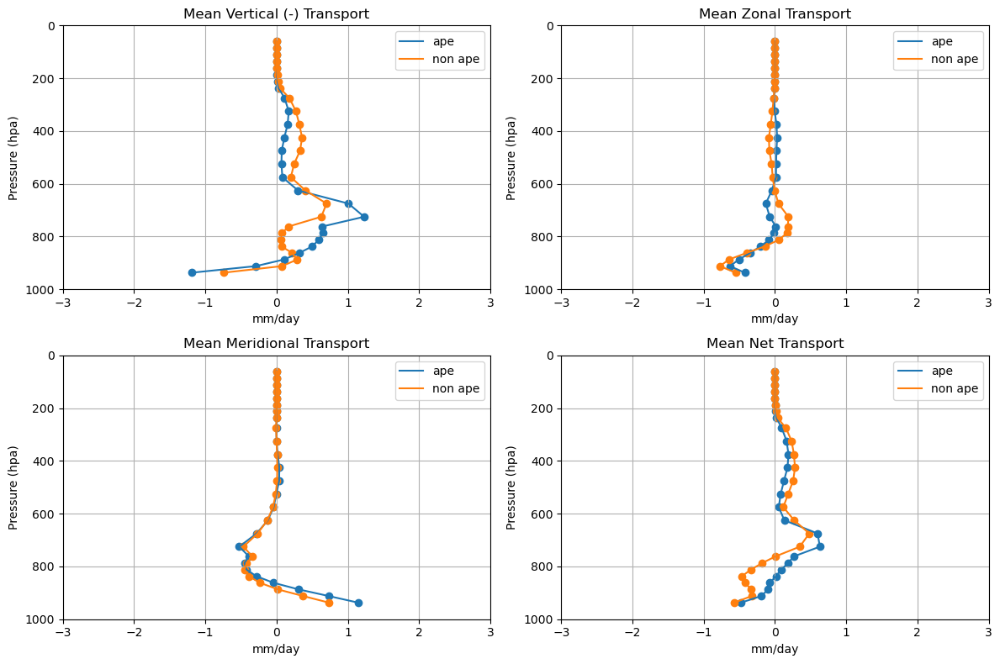

In [7]:
levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical (-)'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
    ape_profiles = list(apes[var])
    
    ape_mean_profile = np.nanmean(ape_profiles, axis=0)

    ax.scatter(ape_mean_profile[2:], midpoints[2:])
    
    ax.plot(ape_mean_profile[2:], midpoints[2:], label='ape')

    non_ape_profiles = list(nonapes[var])
    
    non_ape_mean_profile = np.nanmean(non_ape_profiles, axis=0)

    ax.scatter(non_ape_mean_profile[2:], midpoints[2:])
    
    ax.plot(non_ape_mean_profile[2:], midpoints[2:], label='non ape')

    ax.invert_yaxis()
    
    ax.set_xlim(-3, 3)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('Mean {} Transport'.format(title))

plt.tight_layout()

plt.show()


## Recreation of figure above for pre-convection hour = 12 LST

In [15]:
hour = 18

pre_apes = apes[apes['hr'] == hour]

pre_nonapes = nonapes[nonapes['hr'] == hour]

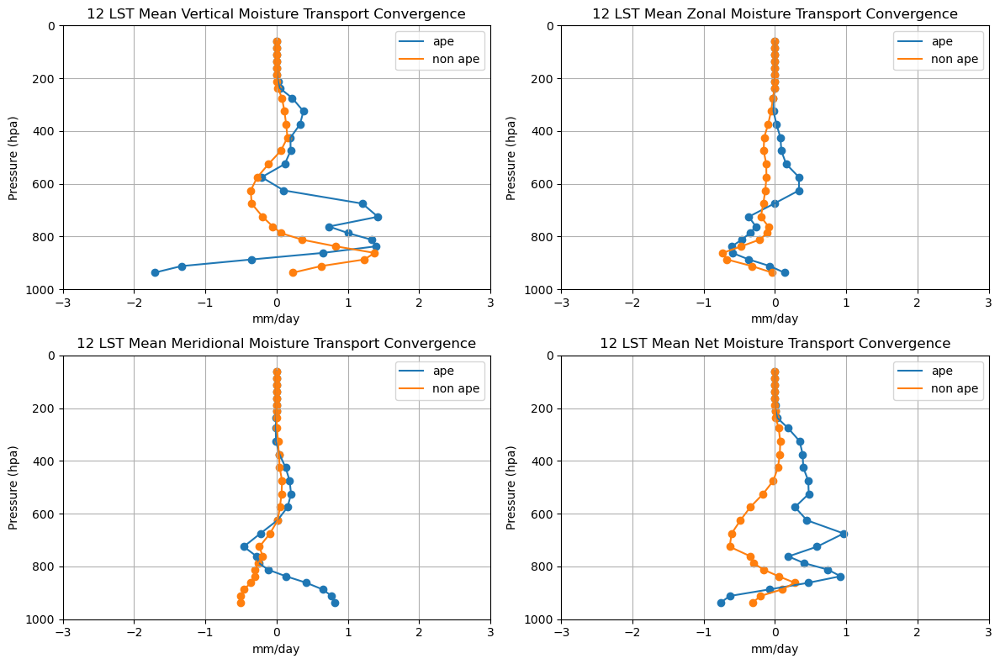

In [16]:
levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

#zip combines the subplot and variable together
for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):

    if var == 'wq':
        
        title = 'Vertical'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
    pre_apes_profiles = list(pre_apes[var])
    
    pre_apes_mean_profile = np.nanmean(pre_apes_profiles, axis=0)

    ax.scatter(pre_apes_mean_profile[2:], midpoints[2:])
    
    ax.plot(pre_apes_mean_profile[2:], midpoints[2:], label='ape')

    pre_non_apes_profiles = list(pre_nonapes[var])
    
    pre_non_apes_mean_profile = np.nanmean(pre_non_apes_profiles, axis=0)

    ax.scatter(pre_non_apes_mean_profile[2:], midpoints[2:])
    
    ax.plot(pre_non_apes_mean_profile[2:], midpoints[2:], label='non ape')

    ax.invert_yaxis()
    
    ax.set_xlim(-3, 3)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('{} LST Mean {} Moisture Transport Convergence'.format(hour-6, title))

plt.tight_layout()

plt.show()

## MFC average for hours before APE (00 --> 18 UTC, or 18 (night before)--> 12 LST) 

In [51]:
thresh = divpdf['afternoon']/7 < 0.14

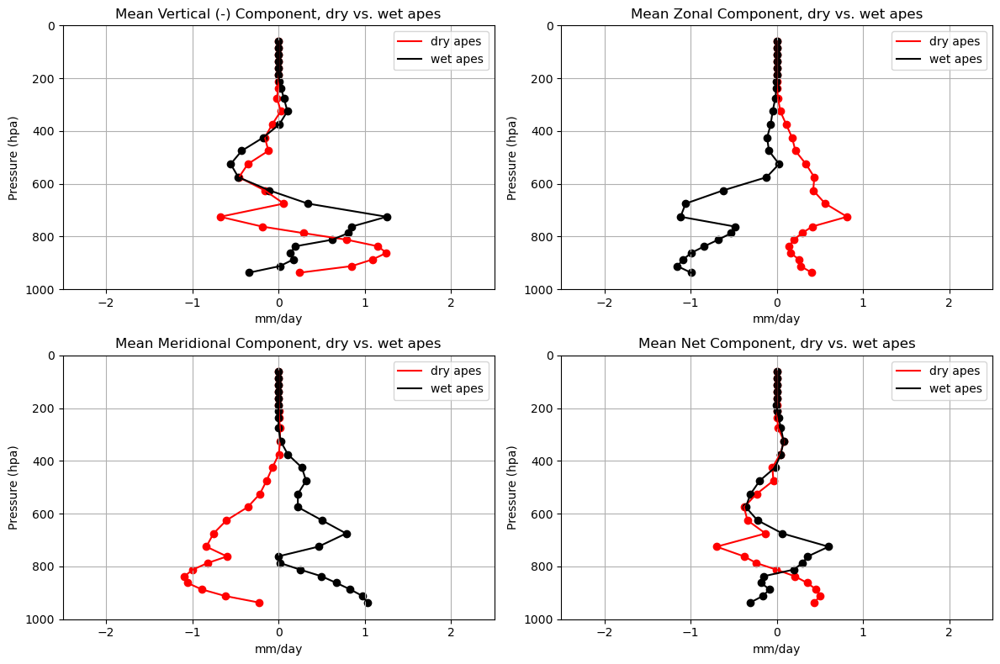

In [52]:
levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

dryapes = divpdf[(divpdf['APE']==True) & (divpdf['dry_coupling']==True) & (thresh)]

drycoup = divpdf[divpdf['dry_coupling']==True]

wetapes = divpdf[(divpdf['APE']==True) & (divpdf['wet_coupling']==True) & (thresh)]

wetcoup = divpdf[divpdf['wet_coupling']==True]

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical (-)'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    

    dry_daily_avg = dryapes.groupby(level=0)[var].apply(lambda x: np.nanmean(np.stack(x), axis=0))
    
    dry_mean_profile = np.mean(np.stack(dry_daily_avg), axis=0) 
    
    ax.scatter(dry_mean_profile[2:], midpoints[2:], color='red')
    
    ax.plot(dry_mean_profile[2:], midpoints[2:], label='dry apes', color='red')

    wet_daily_avg = wetapes.groupby(level=0)[var].apply(lambda x: np.nanmean(np.stack(x), axis=0))
    
    wet_mean_profile = np.mean(np.stack(wet_daily_avg), axis=0)
    
    ax.scatter(wet_mean_profile[2:], midpoints[2:], color='black')
    
    ax.plot(wet_mean_profile[2:], midpoints[2:], label='wet apes', color='black')
    
    ax.invert_yaxis()
    
    ax.set_xlim(-2.5,2.5)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('Mean {} Component, dry vs. wet apes'.format(title))

plt.tight_layout()

plt.show()


## MFC sum composite for hours before APE (00 --> 18 UTC, or 18 (night before)--> 12 LST) 

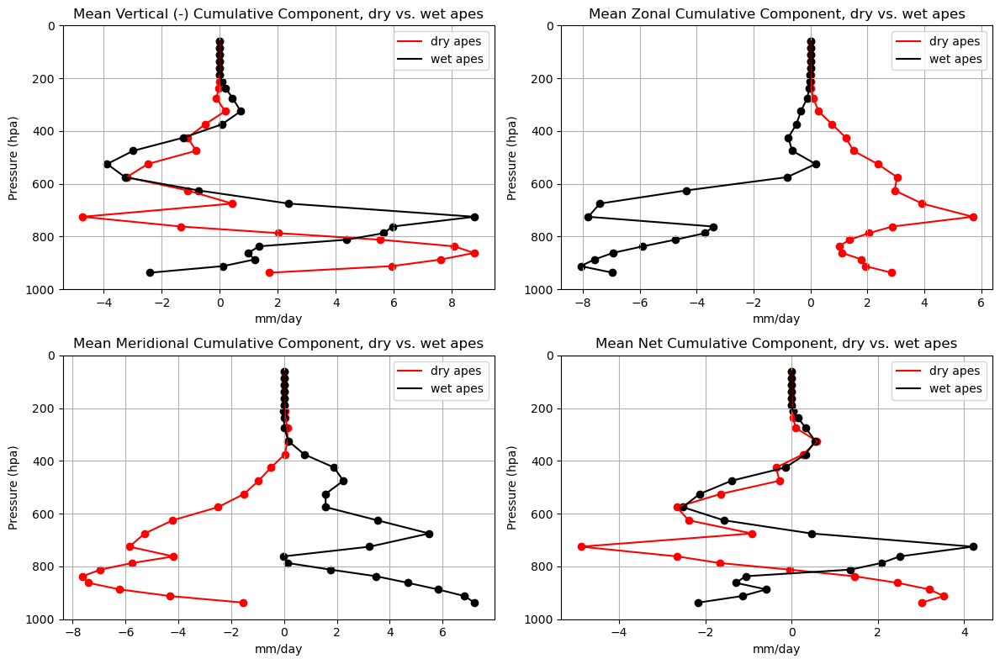

In [53]:
# calculating cumulative MFC before APE arrives
# groupby day, and for each variable, calculate the sum across axis=0
# then take an average across axis=0

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical (-)'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
    dry_sum = dryapes.groupby(level=0)[var].apply(lambda x: np.nansum(np.stack(x), axis=0))
    
    dry_mean_profile = np.mean(np.stack(dry_sum), axis=0)

    ax.scatter(dry_mean_profile[2:], midpoints[2:], color='red')
    
    ax.plot(dry_mean_profile[2:], midpoints[2:], label='dry apes', color='red')
    
    wet_sum = wetapes.groupby(level=0)[var].apply(lambda x: np.nansum(np.stack(x), axis=0))
    
    wet_mean_profile = np.mean(np.stack(wet_sum), axis=0)
    
    ax.scatter(wet_mean_profile[2:], midpoints[2:], color='black')
    
    ax.plot(wet_mean_profile[2:], midpoints[2:], label='wet apes', color='black')
    
    ax.invert_yaxis()
    
#     ax.set_xlim(-2,2)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('Mean {} Cumulative Component, dry vs. wet apes'.format(title))

plt.tight_layout()

plt.show()

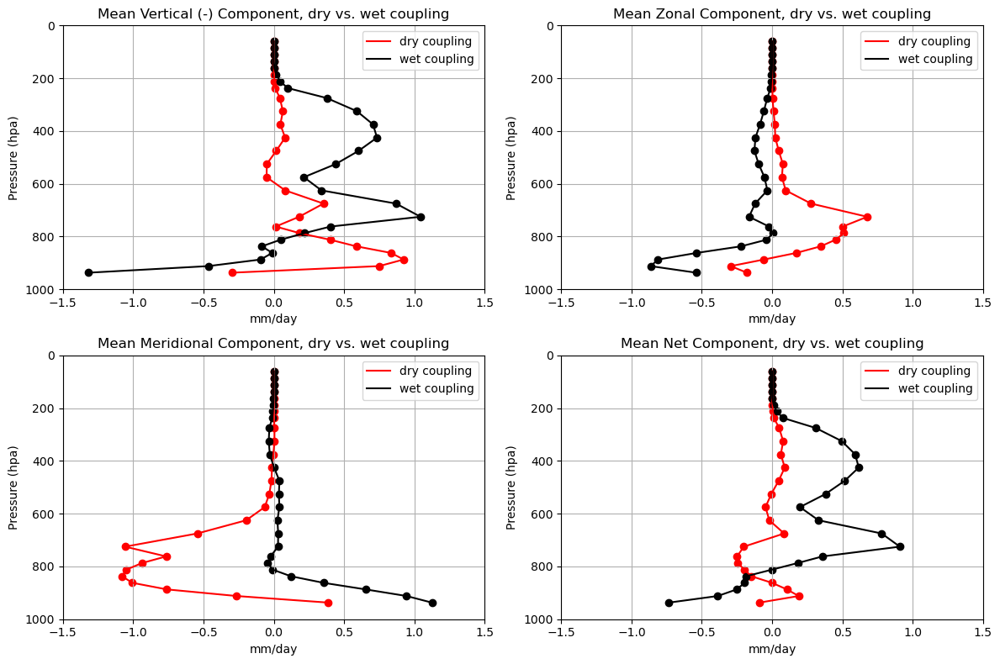

In [18]:
# dry coupling & wet coupling

levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

dryapes = divpdf[(divpdf['APE']==True) & (divpdf['dry_coupling']==True)]

drycoup = divpdf[divpdf['dry_coupling']==True]

wetapes = divpdf[(divpdf['APE']==True) & (divpdf['wet_coupling']==True)]

wetcoup = divpdf[divpdf['wet_coupling']==True]

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical (-)'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
    dry_profiles = list(drycoup[var])
    
    dry_mean_profile = np.nanmean(dry_profiles, axis=0)
    
    ax.scatter(dry_mean_profile[2:], midpoints[2:], color='red')
    
    ax.plot(dry_mean_profile[2:], midpoints[2:], label='dry coupling', color='red')
    
    wet_profiles = list(wetcoup[var])
    
    wet_mean_profile = np.nanmean(wet_profiles, axis=0)
    
    ax.scatter(wet_mean_profile[2:], midpoints[2:], color='black')
    
    ax.plot(wet_mean_profile[2:], midpoints[2:], label='wet coupling', color='black')
    
    ax.invert_yaxis()
    
    ax.set_xlim(-1.5,1.5)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('Mean {} Component, dry vs. wet coupling'.format(title))

plt.tight_layout()

plt.show()


## Recreation of figure above for specific pre-convection hour

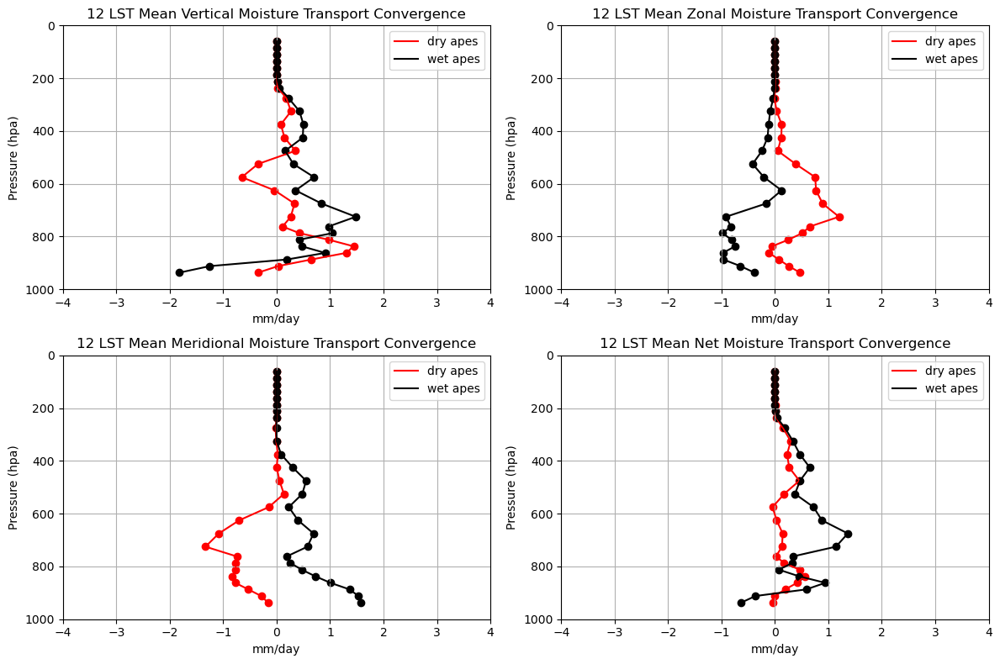

In [19]:
hour = 18

pre_dryapes = dryapes[dryapes['hr'] == hour]

pre_wetapes = wetapes[wetapes['hr'] == hour]

pre_dry = drycoup[drycoup['hr']== hour]

pre_wet = wetcoup[wetcoup['hr']== hour]

levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
#     pre_dry_profiles = list(pre_dryapes[var])
    pre_dry_profiles = list(pre_dryapes[var])
    
    pre_dry_mean_profile = np.nanmean(pre_dry_profiles, axis=0)
    
    ax.scatter(pre_dry_mean_profile[2:], midpoints[2:], color='red')
    
    ax.plot(pre_dry_mean_profile[2:], midpoints[2:], label='dry apes', color='red')
    
    pre_wet_profiles = list(pre_wetapes[var])
    
    pre_wet_mean_profile = np.nanmean(pre_wet_profiles, axis=0)
    
    ax.scatter(pre_wet_mean_profile[2:], midpoints[2:], color='black')
    
    ax.plot(pre_wet_mean_profile[2:], midpoints[2:], label='wet apes', color='black')
    
    ax.invert_yaxis()
    
    ax.set_xlim(-4,4)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('{} LST Mean {} Moisture Transport Convergence'.format(hour-6, title))

plt.tight_layout()

plt.show()

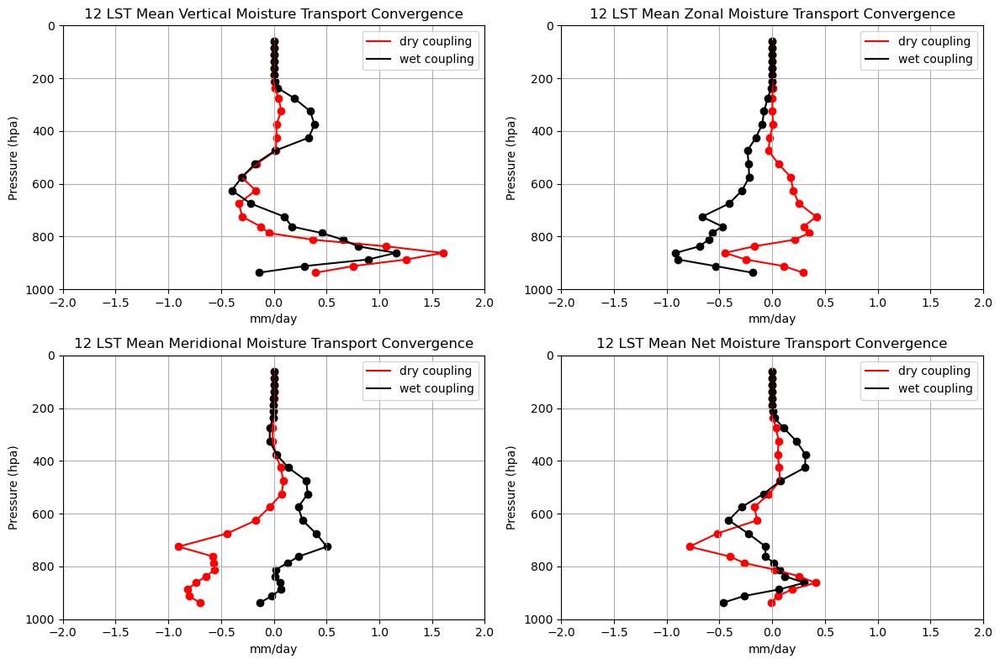

In [59]:
# for dry vs wet coupling cases 

hour = 12

pre_drycoup = drycoup[drycoup['hr'] == hour]

pre_wetcoup = wetcoup[wetcoup['hr'] == hour]

pre_dry = drycoup[drycoup['hr']== hour]

pre_wet = wetcoup[wetcoup['hr']== hour]

levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical'
    
    elif var == 'uq':
        
        title = 'Zonal'
    
    elif var == 'vq':
        
        title = 'Meridional'
    
    elif var == 'net':
        
        title = 'Net'
    
#     pre_dry_profiles = list(pre_dryapes[var])
    pre_dry_profiles = list(pre_drycoup[var])
    
    pre_dry_mean_profile = np.nanmean(pre_dry_profiles, axis=0)
    
    ax.scatter(pre_dry_mean_profile[2:], midpoints[2:], color='red')
    
    ax.plot(pre_dry_mean_profile[2:], midpoints[2:], label='dry coupling', color='red')
    
    pre_wet_profiles = list(pre_wetcoup[var])
    
    pre_wet_mean_profile = np.nanmean(pre_wet_profiles, axis=0)
    
    ax.scatter(pre_wet_mean_profile[2:], midpoints[2:], color='black')
    
    ax.plot(pre_wet_mean_profile[2:], midpoints[2:], label='wet coupling', color='black')
    
    ax.invert_yaxis()
    
    ax.set_xlim(-2,2)
    
    ax.set_ylim(1000,0)
    
    ax.grid()
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('{} LST Mean {} Moisture Transport Convergence'.format(hour, title))

plt.tight_layout()

plt.show()

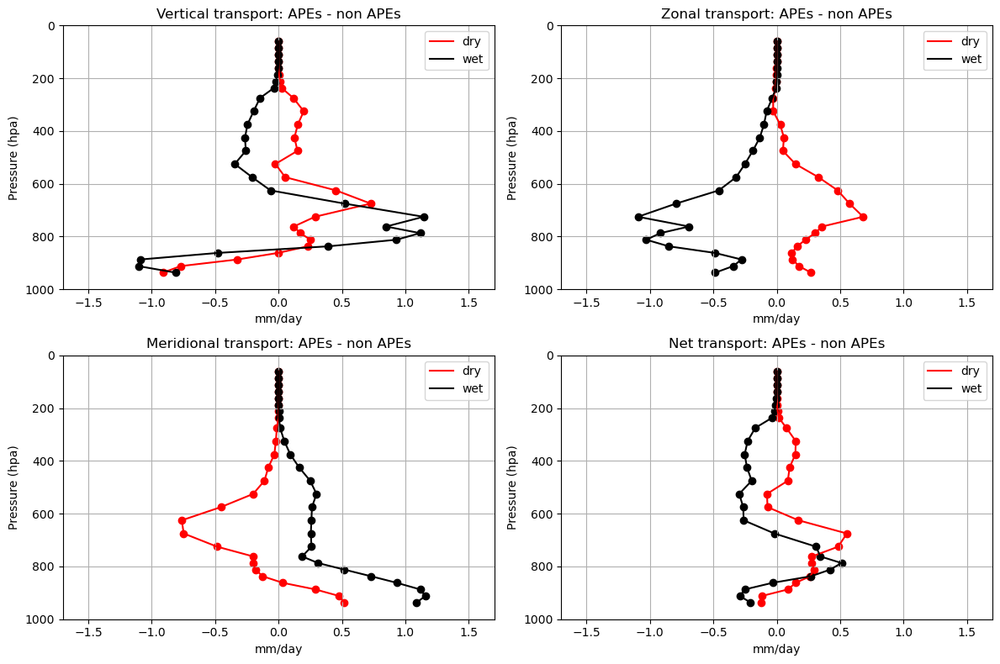

In [46]:
levels = era13['level'].data[::-1]

midpoints = np.array([(levels[i] + levels[i+1]) // 2 for i in range(len(levels)-1)])

dryapes = divpdf[(divpdf['APE']==True) & (divpdf['dry_coupling']==True)]

drynonape = divpdf[(divpdf['APE']==False) & (divpdf['dry_coupling']==True)]

wetapes = divpdf[(divpdf['APE']==True) & (divpdf['wet_coupling']==True)]

wetnonape = divpdf[(divpdf['APE']==False) & (divpdf['wet_coupling']==True)]

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

for ax, var in zip(axs.flat, ['wq', 'uq', 'vq', 'net']):
    
    if var == 'wq':
        
        title = 'Vertical'
        
    elif var == 'uq':
        
        title = 'Zonal'
        
    elif var == 'vq':
        
        title = 'Meridional'
        
    elif var == 'net':
        
        title = 'Net'
    
    #dry apes

    dryape_profile = list(dryapes[var])

    dryape_mean_profile = np.nanmean(dryape_profile, axis=0)
    
    #wet apes
    
    wetape_profile = list(wetapes[var])

    wetape_mean_profile = np.nanmean(wetape_profile, axis=0)
    
    #dry non apes
    
    drynonape_profile = list(drynonape[var])

    drynonape_mean_profile = np.nanmean(drynonape_profile, axis=0)
    
    #wet non apes
    
    wetnonape_profile = list(wetnonape[var])

    wetnonape_mean_profile = np.nanmean(wetnonape_profile, axis=0)
    
    #differences, dry ape-dry nonape & wet ape - wet nonape
    
    drydiff = dryape_mean_profile - drynonape_mean_profile
    
    wetdiff = wetape_mean_profile - wetnonape_mean_profile
    
    # plot drydiff
    ax.scatter(drydiff[2:], midpoints[2:], color='red')
    
    ax.plot(drydiff[2:], midpoints[2:], label='dry', color='red')
    
    # plot wetdiff
    ax.scatter(wetdiff[2:], midpoints[2:], color='black')
    
    ax.plot(wetdiff[2:], midpoints[2:], label='wet', color='black')
    
    ax.invert_yaxis()
    
    ax.grid()
    
    ax.set_xlim(-1.7, 1.7)
    
    ax.set_ylim(1000,0)
    
    ax.set_xlabel("mm/day")
    
    ax.set_ylabel("Pressure (hpa)")
    
    ax.legend()
    
    ax.set_title('{} transport: APEs - non APEs'.format(title))

plt.tight_layout()

plt.show()

## circulation patterns

In [17]:
plev = 850

levels = df['level'].data

time = df['time'].data

idx_plev = np.where(levels==plev)[0][0]

lat_range = df['latitude'].data[0:5]

lon_range = df['longitude'].data[0:5]

for t in range(time.shape[0]):

    lst = pd.to_datetime(time[t]) - timedelta(hours=6)

    if (5 <= lst.month <= 9) & (lst.hour == 15):
        
        u = df['u'].data[t][idx_plev][lat][lon]
        

NameError: name 'df' is not defined

In [ ]:
def calculate_warm_season_average_flow(df, var):
    
    bottom = 800
    
    top = 600
    
    levels = df['level'].data
    
    time = df['time'].data
    
    idx_bottom = np.where(levels==bottom)[0][0]
    
    idx_top = np.where(levels==top)[0][0]
    
    lat_range = df['latitude'].data[0:5]
    
    lon_range = df['longitude'].data[0:5]
    
    final=[]

    for lat in range(lat_range.shape[0]):

        for lon in range(lon_range.shape[0]):
            
            pair = (lat_range[lat], lon_range[lon])
            
            var_totals = []
            
            for t in range(time.shape[0]):

                lst = pd.to_datetime(time[t]) - timedelta(hours=6)

                if (5 <= lst.month <= 9) & (lst.hour == 15):
                    
                    var_collect=[]

                    for lev in range(idx_top, idx_bottom):

                        m = df[var].data[t][lev][lat][lon]

                        var_collect.append(m)
                    
                    var_lt_mean = np.mean(np.array(var_collect))
                    
                    var_totals.append(var_lt_mean)
                    
            var_warm_season_mean = np.mean(np.array(var_totals))
            
            var_tup = (var_warm_season_mean, pair)
            
            final.append(var_tup)
    
    
    df_to_group = pd.DataFrame(final, columns=['var','pair'])

    grouped = df_to_group.groupby(['pair'])['var'].mean()

    # Convert the grouped DataFrame to a list of tuples
    list_of_tuples = grouped.reset_index().to_records(index=False).tolist()

    return(list_of_tuples)



all_dfs = [era13, era46, era79, era1012, era1315, era1618]

u_circ_list = []

for df in all_dfs:
    
    u_circ = calculate_warm_season_average_flow(df, 'u')
    print(u_circ)
    print("")
    
    u_circ_list.append(u_circ)
    

        

In [ ]:
# flat_list = [item for sublist in u_circ_list for item in sublist]

# bigdf = pd.DataFrame(flat_list, columns=['pair','u'])

# df = pd.DataFrame(bigdf.groupby('pair')['u'].mean())

# df.reset_index(inplace=True)

# df.head()

# df['lat'] = df['pair'].apply(lambda x: x[0])

# df['lon'] = df['pair'].apply(lambda x: x[1])

# lat_range = np.linspace(df['lat'].min(), df['lat'].max(), 100)

# lon_range = np.linspace(df['lon'].min(), df['lon'].max(), 100)

# lat_grid, lon_grid = np.meshgrid(lat_range, lon_range)

# wind_speed_interp = np.interp(lat_grid, df['lat'], df['u'])

# plt.figure(figsize=(8, 6))

# sns.heatmap(wind_speed_interp, cmap='coolwarm', xticklabels=False, yticklabels=False)

# plt.scatter(df['lon'], df['lat'], color='black', marker='o', s=100)

# plt.title('Wind Speed Heatmap with Lat/Lon Pairs')
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')
# plt.show()

In [ ]:
groupedapes = apes.groupby('hr')["net_sum"].agg(['mean', 'std', 'count'])

groupednonapes = nonapes.groupby('hr')["net_sum"].agg(['mean', 'std', 'count'])

groupedapes['se'] = groupedapes['std']/np.sqrt(groupedapes['count'])

groupednonapes['se'] = groupednonapes['std']/np.sqrt(groupednonapes['count'])

plt.figure(figsize=(8, 4))

#plotting apes 
plt.plot(groupedapes.index, groupedapes["mean"], label='APEs', color='blue')

plt.plot(groupedapes.index, groupedapes["mean"]-groupedapes["se"], color='grey')

plt.plot(groupedapes.index, groupedapes["mean"]+groupedapes["se"], color='grey')

plt.fill_between(groupedapes.index, groupedapes["mean"]-groupedapes["se"], groupedapes["mean"]+groupedapes["se"], color='blue', alpha=0.5)

#plotting non-apes
plt.plot(groupednonapes.index, groupednonapes["mean"], label='Non-APEs', color='black')

plt.plot(groupednonapes.index, groupednonapes["mean"]-groupednonapes["se"], color='grey')

plt.plot(groupednonapes.index, groupednonapes["mean"]+groupednonapes["se"], color='grey')

plt.fill_between(groupednonapes.index, groupednonapes["mean"]-groupednonapes["se"], groupednonapes["mean"]+groupednonapes["se"], color='black', alpha=0.5)

plt.legend()

plt.title("Full Profile APEs vs Non-Apes Diurnal MFC")

plt.ylabel("mm/day")

plt.xlabel("Hour of the day (LST)")

plt.axhline(y=0, color='black', linewidth=1)

plt.grid()

plt.show()

In [ ]:
#LT comparison

lowLT = divpdf[divpdf['tercile']==1]

medLT = divpdf[divpdf['tercile']==2]

highLT = divpdf[divpdf['tercile']==3]

count = 1

plt.figure(figsize=(8, 4))

for df in [lowLT, medLT, highLT]:
    
    if count == 1:
        
        label = "low blt"
        
        color = 'black'
    
    elif count == 2:
        
        label = "med blt"
        
        color = 'green'
    
    elif count == 3:
        
        label = "high blt"
        
        color = 'red'
    
    grouped = pd.DataFrame(df.groupby('hr')['net_sum'].agg(['mean','std','count']))
    
    grouped['se'] = grouped['std']/np.sqrt(grouped['count'])
    
    plt.plot(grouped.index, grouped['mean'], color=color, label=label)
    
    plt.plot(grouped.index, grouped['mean']+grouped['se'], color='grey')
    
    plt.plot(grouped.index, grouped['mean']-grouped['se'], color='grey')
    
    plt.fill_between(grouped.index, grouped['mean']+grouped['se'], grouped['mean']-grouped['se'], color='grey', alpha=0.5)
    
    count+=1

plt.title("MFC for BLT Categories")

plt.xlabel("hour of the day (LST)")

plt.ylabel("mm/day")

plt.legend()

plt.grid()

plt.show()

In [ ]:
#plotting diurnal precipitation cycle for the three BLT terciles 

lowLT = divpdf[divpdf['tercile']==1]

medLT = divpdf[divpdf['tercile']==2]

highLT = divpdf[divpdf['tercile']==3]

count = 1

plt.figure(figsize=(8, 4))

for df in [lowLT, medLT, highLT]: 
    
    df = df[~df.index.duplicated(keep='first')]

    if count == 1:

        label = "low blt"

        color = 'black'

    elif count == 2:

        label = "med blt"

        color = 'green'

    elif count == 3:

        label = "high blt"

        color = 'red'
        
    diurn_precip = list(df['all_hours'])

    mean_diurn_precip = np.nanmean(diurn_precip, axis=0)
    
    se_precip = np.nanstd(diurn_precip, axis=0)/np.sqrt(len(diurn_precip))

    plt.plot(range(0,24), mean_diurn_precip, color=color, label=label)

    plt.plot(range(0,24), mean_diurn_precip+se_precip, color='grey')

    plt.plot(range(0,24), mean_diurn_precip-se_precip, color='grey')

    plt.fill_between(range(0,24), mean_diurn_precip+se_precip, mean_diurn_precip-se_precip, color='grey', alpha=0.5)

    count+=1

plt.title("Precip Diurnal Cycle for BLT Categories")

plt.xlabel("hour of the day (LST)")

plt.ylabel("mm/day")

plt.legend()

plt.grid()

plt.show()

In [ ]:
#LT comparison

for truth_value in [True, False]:
    
    plt.figure(figsize=(8, 4))

    lowLT = divpdf[(divpdf['tercile']==1) & (divpdf['APE']==truth_value)]

    medLT = divpdf[(divpdf['tercile']==2) & (divpdf['APE']==truth_value)]

    highLT = divpdf[(divpdf['tercile']==3) & (divpdf['APE']==truth_value)]

    count = 1

    for df in [lowLT, medLT, highLT]:

        if count == 1:

            label = "low blt"

            color = 'black'

        elif count == 2:

            label = "med blt"

            color = 'green'

        elif count == 3:

            label = "high blt"

            color = 'red'

        grouped = pd.DataFrame(df.groupby('hr')['net_sum'].agg(['mean','std','count']))

        grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

        plt.plot(grouped.index, grouped['mean'], color=color, label=label)

        plt.plot(grouped.index, grouped['mean']+grouped['se'], color='grey')

        plt.plot(grouped.index, grouped['mean']-grouped['se'], color='grey')

        plt.fill_between(grouped.index, grouped['mean']+grouped['se'], grouped['mean']-grouped['se'], color='grey', alpha=0.5)

        count+=1

    if truth_value == True:
        
        title = 'APEs'
        
    elif truth_value == False:
        
        title = 'Non-APEs'
        
    plt.title("Full Profile MFC for BLT Categories")

    plt.xlabel("hour of the day (LST)")

    plt.ylabel("mm/day")

    plt.legend()

    plt.grid()

    plt.show()